In [1]:
import sys
import os
from timeit import default_timer as timer
import torch
from transformers import RobertaTokenizer, RobertaModel, RobertaForMaskedLM, RobertaConfig
import matplotlib.pyplot as plt
# % matplotlib inline
from scipy.spatial.distance import cosine

In [2]:
# Make sure we're in the transformers directory with fine-tuned model output.
os.chdir('/home/jupyter/Notebooks/crystal/NLP/transformers/examples/')
os.getcwd()

'/home/jupyter/Notebooks/crystal/NLP/transformers/examples'

In [3]:
# Adapted from the tutorial at https://mccormickml.com/2019/05/14/BERT-word-embeddings-tutorial/
# and Transformers documentation: https://huggingface.co/transformers/model_doc/roberta.html#robertaformaskedlm

In [ ]:
################################### BEGIN TESTING #####################################################

In [9]:
vocab_file = '/home/jupyter/Notebooks/crystal/NLP/MiFace/Python/data/vocab_files/vocab_checked.txt'
vocab = make_vocab(vocab_file)
print(vocab[:10])
print(len(vocab))

['aback', 'abashed', 'abhor', 'abhorred', 'abhorrence', 'abhorrent', 'abominable', 'abound', 'absent', 'absorbed']
2187


In [32]:
tokenizer = RobertaTokenizer.from_pretrained('./output_wiki-103_filtered/')
config = RobertaConfig.from_pretrained('./output_wiki-103_filtered/')
model = RobertaForMaskedLM.from_pretrained('./output_wiki-103_filtered/', config=config)
# Outputting hidden states allows direct access to hidden layers of the model.
# Outputting hidden states must be set to "true" in the config file during fine-tuning.
# config.output_hidden_states = True
model.eval()

RobertaForMaskedLM(
  (roberta): RobertaModel(
    (embeddings): RobertaEmbeddings(
      (word_embeddings): Embedding(50265, 768, padding_idx=1)
      (position_embeddings): Embedding(514, 768, padding_idx=1)
      (token_type_embeddings): Embedding(1, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0): BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1

In [30]:
# Define a new example sentence with multiple contexts for the word "abhorred"
test_text = "She made an abhorred expression as he began making excuses. He wanted to keep playing, but abhorred the poor sportsmanship of his fellows."

# Split the sentence into tokens.
tokenized_test_text = tokenizer.encode(test_text, add_special_tokens=True)

# Display the words with their indeces.
for t in tokenized_test_text[1:-1]:
        print('{:<12} {:>6,}'.format(tokenizer.decode(t).strip(), t))
        
print(tokenizer.decode(tokenized_test_text))

She             264
made            156
an               41
abhor        35,350
red           2,050
expression    8,151
as               25
he               37
began           880
making          442
excuses      19,791
.                 4
He               91
wanted          770
to                7
keep            489
playing         816
,                 6
but              53
abhor        35,350
red           2,050
the               5
poor          2,129
sports        1,612
manship      17,187
of                9
his              39
fellows      36,304
.                 4
<s> She made an abhorred expression as he began making excuses. He wanted to keep playing, but abhorred the poor sportsmanship of his fellows.</s>


In [26]:
# tokens_tensor = torch.tensor([tokenized_test_text])

In [33]:
input_ids = torch.tensor(tokenized_test_text).unsqueeze(0)  # Batch size 1
with torch.no_grad():
    outputs = model(input_ids, masked_lm_labels=input_ids)
    # Documentation for the "forward" method of RobertaForMaskedLM
    # details what is returned for each index of "outputs."
    print(len(outputs))
    print(outputs[0])  # masked_lm_loss
    print(outputs[1])  # prediction_scores
    print(outputs[2])  # hidden_states

3
tensor(1.7705)
tensor([[[ 7.5622, -6.5695,  7.1052,  ..., -0.4609, -0.3673,  2.0783],
         [ 0.1524, -6.5327,  0.7621,  ..., -4.3035, -2.9045,  0.0805],
         [-3.1635, -4.4289,  5.9348,  ...,  0.1579, -0.5408, -0.8563],
         ...,
         [ 0.4510, -4.8339,  0.3958,  ..., -0.3920, -3.4539, -2.0414],
         [ 3.5524, -6.6096,  7.0987,  ..., -1.0119, -0.9505,  0.7903],
         [ 9.0676, -5.9170,  7.8096,  ..., -0.8526, -2.6835,  3.2866]]])
(tensor([[[ 1.8019e-01, -1.1417e-04, -6.6993e-03,  ..., -1.6295e-01,
           1.0452e-01,  5.8282e-02],
         [-1.0831e-01, -6.4354e-02,  1.7192e-01,  ...,  3.5061e-03,
           1.8987e-01,  2.1542e-01],
         [-1.2822e-01, -2.1817e-01,  6.4316e-01,  ..., -4.8211e-02,
          -6.1839e-01,  3.5666e-02],
         ...,
         [-9.0066e-03, -5.7980e-01,  2.9104e-01,  ..., -2.0536e-01,
          -1.5077e-01,  4.3876e-01],
         [ 2.1391e-01,  2.3605e-01,  2.8134e-01,  ..., -9.9283e-01,
           7.0846e-02, -2.6021e-02],
 

In [34]:
print ("Number of layers:", len(outputs[2]))
layer_i = 0

print ("Number of batches:", len(outputs[2][layer_i]))
batch_i = 0

print ("Number of tokens:", len(outputs[2][layer_i][batch_i]))
token_i = 0

print ("Number of hidden units:", len(outputs[2][layer_i][batch_i][token_i]))

Number of layers: 13
Number of batches: 1
Number of tokens: 31
Number of hidden units: 768


In [86]:
encoded_layers = outputs[2]

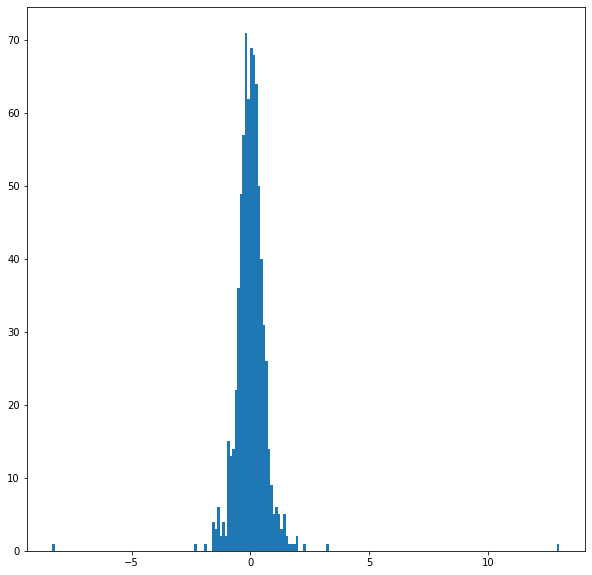

In [91]:
# For our token, select its feature values from layer 5.
token_i = 4
layer_i = 5
vec = encoded_layers[layer_i][batch_i][token_i]
# print(vec)

# Plot the values as a histogram to show their distribution.
plt.figure(figsize=(10,10))
plt.hist(vec, bins=200)
plt.show()

In [74]:
# `encoded_layers` is a tuple.
print('     Type of encoded_layers: ', type(list(encoded_layers)))

# Each layer in the list is a torch tensor.
print('Tensor shape for each layer: ', encoded_layers[0].size())

     Type of encoded_layers:  <class 'list'>
Tensor shape for each layer:  torch.Size([1, 32, 768])


In [75]:
# Concatenate the tensors for all layers. We use `stack` here to
# create a new dimension in the tensor.
token_embeddings = torch.stack(encoded_layers, dim=0)

token_embeddings.size()

torch.Size([13, 1, 32, 768])

In [76]:
# Remove dimension 1, the "batches".
token_embeddings = torch.squeeze(token_embeddings, dim=1)

token_embeddings.size()

torch.Size([13, 32, 768])

In [94]:
# Swap dimensions 0 and 1.
token_embeddings = token_embeddings.permute(1,0,2)

token_embeddings.size()

torch.Size([32, 13, 768])

In [103]:
for i, token_str in enumerate(tokenized_test_text):
      if tokenizer.decode(token_str).strip() == "disgusted":
        print (i, tokenizer.decode(token_str))

4  disgusted
21  disgusted


In [97]:
# Create token vectors by summing the last 4 layers of the model.
# Stores the token vectors, with shape [32 x 768]
token_vecs_sum = []
# `token_embeddings` is a [32 x 12 x 768] tensor.

# For each token in the sentence...
for token in token_embeddings:
    # `token` is a [13 x 768] tensor
    # Sum the vectors from the last four layers.
    sum_vec = torch.sum(token[-4:], dim=0)
    
    # Use `sum_vec` to represent `token`.
    token_vecs_sum.append(sum_vec)

print ('Shape is: %d x %d' % (len(token_vecs_sum), len(token_vecs_sum[0])))
# Shape is: 32 x 768

Shape is: 32 x 768


In [99]:
# Extract the last layer's features
token_vecs_last = []
# `token_embeddings` is a [32 x 12 x 768] tensor.

# For each token in the sentence...
for token in token_embeddings:
    # `token` is a [13 x 768] tensor
    # Extract the vector from the last layer.
    last_vec = token[-1]
    
    # Use `sum_vec` to represent `token`.
    token_vecs_last.append(last_vec)

print ('Shape is: %d x %d' % (len(token_vecs_last), len(token_vecs_last[0])))
# Shape is: 32 x 768

Shape is: 32 x 768


In [109]:
# Extract the embedding layer's features (layer 0 is the embedding layer)
token_vecs_embed = []
# `token_embeddings` is a [32 x 12 x 768] tensor.

# For each token in the sentence...
for token in token_embeddings:
    # `token` is a [13 x 768] tensor
    # Extract the vector from the last layer.
    embed_vec = token[0]
    
    # Use `sum_vec` to represent `token`.
    token_vecs_embed.append(last_vec)

print ('Shape is: %d x %d' % (len(token_vecs_embed), len(token_vecs_embed[0])))
# Shape is: 32 x 768

Shape is: 32 x 768


In [129]:
indices = []
for i, token_str in enumerate(tokenized_test_text):
      if tokenizer.decode(token_str).strip() == "disgusted":
        indices.append(i)
print(indices)

[4, 21]


In [130]:
token_vecs_sum_last_four = sum_last_four_token_vecs(token_embeddings)
for i in range(len(indices)):
    print(f'disgusted at index {indices[i]}: {str(token_vecs_sum_last_four[indices[i]][:5])}')

Shape is: 32 x 768
disgusted at index 4: tensor([-0.7637, -1.0375, -0.4840, -0.2251, -0.1792])
disgusted at index 21: tensor([-0.8459, -0.2973, -0.3336, -0.6372, -0.7399])


In [224]:
for i, v in enumerate(vocab):
    print(i, v)

0 open
1 openness
2 opposed
3 oppositional
4 oppressed
5 optimism
6 optimistic
7 ordering
8 orgasmic
9 ornery
10 ouch
11 out
12 outburst
13 outcry
14 outed
15 outlandish
16 outrage
17 outraged
18 outspoken
19 overbearing
20 overexcited
21 overjoyed
22 overshadowed
23 overstrung
24 overwhelmed
25 overworked
26 overwrought
27 pain
28 pained
29 painful
30 painfully
31 panic
32 panicked
33 panicky
34 paralyzed
35 paranoid
36 passionate
37 passive
38 patience
39 patient
40 patronizing
41 pause
42 pausing
43 peaceful
44 peculiar
45 peering
46 peeved
47 peevish
48 pensive
49 peppy
50 perceptive
51 perfidious
52 perky
53 perplexed
54 perplexing
55 persistent
56 personable
57 perturbed
58 perverse
59 pesky
60 pessimism
61 pessimistic
62 pestered
63 petitioning
64 petrified
65 petty
66 petulant
67 picked
68 piercing
69 pinched
70 pious
71 piqued
72 pissed
73 pitiable
74 pitiful
75 pity
76 pitying
77 placated
78 placation
79 placid
80 plain
81 plaintive
82 planning
83 playful
84 playfully
85 plea

In [229]:
v_indices = (102, 145, 309, 316, 410, 698)

start = 12
sections = []
for end in v_indices:
    for i in range(start, end):
#         print(i)
        sections.append(vocab[i])
        start = end + 1
for i in range(start, len(vocab)):
    sections.append(vocab[i])
#     print(i)

for i, v in enumerate(sections):
    print(i, v)

0 outburst
1 outcry
2 outed
3 outlandish
4 outrage
5 outraged
6 outspoken
7 overbearing
8 overexcited
9 overjoyed
10 overshadowed
11 overstrung
12 overwhelmed
13 overworked
14 overwrought
15 pain
16 pained
17 painful
18 painfully
19 panic
20 panicked
21 panicky
22 paralyzed
23 paranoid
24 passionate
25 passive
26 patience
27 patient
28 patronizing
29 pause
30 pausing
31 peaceful
32 peculiar
33 peering
34 peeved
35 peevish
36 pensive
37 peppy
38 perceptive
39 perfidious
40 perky
41 perplexed
42 perplexing
43 persistent
44 personable
45 perturbed
46 perverse
47 pesky
48 pessimism
49 pessimistic
50 pestered
51 petitioning
52 petrified
53 petty
54 petulant
55 picked
56 piercing
57 pinched
58 pious
59 piqued
60 pissed
61 pitiable
62 pitiful
63 pity
64 pitying
65 placated
66 placation
67 placid
68 plain
69 plaintive
70 planning
71 playful
72 playfully
73 pleading
74 pleasant
75 pleased
76 pleasing
77 pleasurable
78 pleasure
79 pleasured
80 pliant
81 plotting
82 poignant
83 pointed
84 poised


In [230]:
vocab = sections

In [111]:
# Calculate the cosine similarity between the word disgusted 
# in "disgusted expression" vs "too disgusted" (different contexts)
# using the last layer of the model.
diff_disgusted_last = 1 - cosine(token_vecs_last[4], token_vecs_last[21])

# Calculate the cosine similarity between the word disgusted 
# in "disgusted expression" vs "too disgusted" (different contexts)
# using the embed layer of the model.
diff_disgusted_embed = 1 - cosine(token_vecs_embed[4], token_vecs_embed[21])

# Calculate the cosine similarity between the word disgusted 
# in "disgusted expression" vs "too disgusted" (different contexts)
# using the sum of the last 4 layers of the model.
diff_disgusted_sum = 1 - cosine(token_vecs_sum_last_four[4], token_vecs_sum_last_four[21])

print('Vector similarity at the last layer:  %.2f' % diff_disgusted_last)
print('Vector similarity at the embed layer:  %.2f' % diff_disgusted_embed)
print('Vector similarity at the embed layer:  %.2f' % diff_disgusted_sum)

Vector similarity at the last layer:  0.91
Vector similarity at the embed layer:  1.00
Vector similarity at the embed layer:  0.89


In [ ]:
############################ END TESTING ##############################################################################

In [10]:
############################ START PRODUCTION: GET CONTEXTUAL EMBEDDINGS ##############################################

In [38]:
tokenizer = RobertaTokenizer.from_pretrained('./output_wiki-103_filtered/')
config = RobertaConfig.from_pretrained('./output_wiki-103_filtered/')
model = RobertaForMaskedLM.from_pretrained('./output_wiki-103_filtered/', config=config)
# Outputting hidden states allows direct access to hidden layers of the model.
# Outputting hidden states must be set to "true" in the config file during fine-tuning.
# config.output_hidden_states = True
model.eval()

context_file = "/home/jupyter/Notebooks/crystal/NLP/transformers/examples/WikiText-103_Filtered/wiki.train.raw.out"
output_file = '/home/jupyter/Notebooks/crystal/NLP/nlp_testing/embeddings_context_vocab/roberta_layer12_wiki-103.txt'
count_file = '/home/jupyter/Notebooks/crystal/NLP/nlp_testing/embeddings_context_vocab/roberta_layer12_wiki-103_counts.txt'
vocab_file = '/home/jupyter/Notebooks/crystal/NLP/MiFace/Python/data/vocab_files/vocab_checked.txt'
vocab = make_vocab(vocab_file)
# vocab = ["mad"]

In [ ]:
# Process vocabulary words in the outer loop.
for v in vocab:
    start = timer()
    with open(context_file, 'r') as lines:
        v_sum = torch.zeros([1, 768])
        v_tokens = tokenizer.encode(v)
        print(f'\nThere are {len(v_tokens) - 2} tokens in tokenized vocabulary word:')
        for t in v_tokens[1:-1]:
            print(tokenizer.decode(t).strip())
        count_sentence = 0
        count_tensor = 0
        
        # Process all lines in the context file in the inner loop.
        for line in lines:
            # Check for this vocab word in this line; if found, split the line into individual sentences.
            if v in line.lower().split():
                for sentence in line.split('.'):
                    if v in sentence.lower():
                        line = sentence
                        count_sentence += 1
                        print(f'\nInstance {count_sentence} of {tokenizer.decode(v_tokens[1:-1]).strip()}.')
                        break
                # Split the new sentence-based line into tokens.
                # Use max_length to avoid overflowing the maximum sequence length for the model.
                tokenized_text = tokenizer.encode(line, add_special_tokens=True, max_length=512)
#                 print(f'The decoded sentence has {len(tokenized_text)} tokens and is: {tokenizer.decode(tokenized_text)}')
                indices = []              

                # Check to see whether the vocab word is found in this particular line.
                # Initially, some lines may have comprised multiple sentences, which were
                # broken out individually above.
                for t in v_tokens[1:-1]:
                    print(f'Looking for vocab token: {tokenizer.decode(t).strip()}')
                    for i, token_str in enumerate(tokenized_text):
#                         print(f'Next sentence token: {tokenizer.decode(token_str).strip()}')
#                         print(tokenizer.decode(token_str).strip() == tokenizer.decode(t).strip())
                        if tokenizer.decode(token_str).strip() == tokenizer.decode(t).strip():
                            indices.append(i)               

                ###################################################################################
                # If the vocabulary word was found, process the containing line.
                if indices:

                    # The vocab word was found in this line/sentence, at the locations in indices.
                    print(f'Indices are {indices}')
                    # Get the feature vectors for all tokens in the line/sentence.
                    token_embeddings = create_token_embeddings(tokenized_text)
                    # Sum the last four layers to get embeddings for the line/sentence.
#                         for t in v_tokens[1:-1]:
#                             for i, token_str in enumerate(tokenized_text):
#                                 if (tokenizer.decode(token_str).strip() == tokenizer.decode(t).strip()):
#                                     print(f'{tokenizer.decode(token_str).strip()} is index {i} in the sentence and {token_str} in the vocabulary.')
                    token_vecs_layer = get_layer_token_vecs(token_embeddings, 12)

                    # Get the vocab word's contextual embedding for this line.
                    tensor_layer = torch.zeros([1, 768])
                    for i in range(len(indices)):
                        v_index = i % len(v_tokens[1:-1])
                        print(f'{tokenizer.decode(v_tokens[v_index + 1]).strip()} at index {indices[i]}: {token_vecs_layer[indices[i]][:5].tolist()}')
                        tensor_layer += token_vecs_layer[indices[i]]
#                         print(f'Sum of tensors is: {tensor_layer[0][:5].tolist()} before taking the mean.')

                    # If our vocab word is broken into more than one token, we need to get the mean of the token embeddings.
                    tensor_layer /= len(indices)
#                     print(f'Sum of tensors is: {tensor_layer[0][:5].tolist()} after taking the mean.')

                    # Add the embedding distilled from this line to the sum of embeddings for all lines.
                    v_sum += tensor_layer
                    count_tensor += 1
                    print(f'Grand sum of {count_tensor} tensor sets is: {v_sum[0][:5].tolist()}')
                ###################################################################################
            # Stop processing lines once we've found 2000 instances of our vocab word.
            if count_tensor >= 2000:
                break
        
        # We're done processing all lines of 512 tokens or less containing our vocab word.
        # Get the mean embedding for the word.
        v_mean = v_sum / count_tensor
        print(f'Mean of tensors is: {v_mean[0][:5]} ({len(v_mean[0])} features in tensor)')
        write_embedding(output_file, v, v_mean)
        try:
            with open(count_file, 'a') as counts:
                counts.write(v + ', ' + str(count_tensor) + '\n')
            print(f'Saved the count of sentences used to create {v} embedding')
        except:
            print('Wha?! Could not write the sentence count.')
    end = timer()
    print(f'Run time for {v} was {end - start} seconds.')


There are 1 tokens in tokenized vocabulary word:
aback

Instance 1 of aback.
Looking for vocab token: aback
Indices are [18]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aback at index 18: [-0.048727743327617645, 0.02922988496720791, -0.3049699664115906, -0.013967139646410942, 0.9283600449562073]
Grand sum of 1 tensor sets is: [-0.048727743327617645, 0.02922988496720791, -0.3049699664115906, -0.013967139646410942, 0.9283600449562073]

Instance 2 of aback.
Looking for vocab token: aback
Indices are [6]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aback at index 6: [-0.038705162703990936, 0.045849718153476715, -0.26277199387550354, -0.03915620595216751, 0.18713705241680145]
Grand sum of 2 tensor sets is: [-0.08743290603160858, 0.07507960498332977, -0.5677419900894165, -0.0531233474612236, 1.11549711227417]

Instance 3 of aback.
Looking for vocab token: aback
Indices are [30]
Size of token embedding

Size of token embeddings is torch.Size([129, 13, 768])
Shape of summed layers is: 129 x 768
aback at index 61: [-0.023870809003710747, 0.09512084722518921, -0.2970414459705353, -0.15705600380897522, 1.0089821815490723]
Grand sum of 21 tensor sets is: [-0.8337581157684326, 0.40470823645591736, -5.4349775314331055, -3.2341763973236084, 12.078668594360352]

Instance 22 of aback.
Looking for vocab token: aback
Indices are [11]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aback at index 11: [-0.007113569416105747, 0.027236394584178925, -0.26423561573028564, 0.004850206896662712, 0.8523577451705933]
Grand sum of 22 tensor sets is: [-0.8408716917037964, 0.4319446384906769, -5.699213027954102, -3.2293262481689453, 12.931026458740234]

Instance 23 of aback.
Looking for vocab token: aback
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aback at index 7: [-0.009711477905511856, -0.07643611729145

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aback at index 7: [-0.08810378611087799, -0.05526186153292656, -0.18687017261981964, -0.32107388973236084, 0.8427222371101379]
Grand sum of 41 tensor sets is: [-1.712475061416626, 0.489984393119812, -9.8889799118042, -4.321071147918701, 22.35175323486328]

Instance 42 of aback.
Looking for vocab token: aback
Indices are [7]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aback at index 7: [-0.06483202427625656, -0.07925961166620255, -0.42550793290138245, -0.11454667896032333, 0.7654874920845032]
Grand sum of 42 tensor sets is: [-1.7773070335388184, 0.41072478890419006, -10.31448745727539, -4.435617923736572, 23.11724090576172]

Instance 43 of aback.
Looking for vocab token: aback
Indices are [5]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aback at index 5: [-0.06786175817251205, 0.05775502324104309, -0.16139051


Instance 61 of aback.
Looking for vocab token: aback
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aback at index 5: [-0.04822755232453346, 0.028177116066217422, -0.3319832384586334, -0.01796722039580345, 0.5086188912391663]
Grand sum of 61 tensor sets is: [-2.2837023735046387, 0.5364477038383484, -15.203653335571289, -6.170808792114258, 31.97376251220703]

Instance 62 of aback.
Looking for vocab token: aback
Indices are [12]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aback at index 12: [0.09491439163684845, -0.009169344790279865, -0.3079025149345398, 0.048300717025995255, 0.7071913480758667]
Grand sum of 62 tensor sets is: [-2.1887879371643066, 0.5272783637046814, -15.511555671691895, -6.1225080490112305, 32.68095397949219]

Instance 63 of aback.
Looking for vocab token: aback
Indices are [8]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 7


Instance 2 of abashed.
Looking for vocab token: ab
Looking for vocab token: ashed
Indices are [6, 7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
ab at index 6: [0.06279106438159943, 0.09659978002309799, -0.24017757177352905, -0.41886335611343384, 0.15249767899513245]
ashed at index 7: [-0.3120751976966858, -0.0635300874710083, -0.10416894406080246, 0.042616792023181915, 1.5088276863098145]
Grand sum of 2 tensor sets is: [-0.07315092533826828, 0.06788618862628937, -0.24738246202468872, -0.2773946225643158, 1.2675271034240723]
Mean of tensors is: tensor([-0.0366,  0.0339, -0.1237, -0.1387,  0.6338]) (768 features in tensor)
Saved the embedding for abashed.
Saved the count of sentences used to create abashed embedding
Run time for abashed was 8.481878803111613 seconds.

There are 1 tokens in tokenized vocabulary word:
abhor

Instance 1 of abhor.
Looking for vocab token: abhor
Indices are [32]
Size of token embeddings is torch.Size([53, 13, 76


Instance 4 of abhorred.
Looking for vocab token: abhor
Looking for vocab token: red
Indices are [3, 4]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
abhor at index 3: [0.08135302364826202, 0.12708032131195068, -0.2681543529033661, 0.048550691455602646, -0.2627834975719452]
red at index 4: [-0.2029762864112854, 0.14588531851768494, -0.05402776971459389, 0.3666127622127533, 0.2577776312828064]
Grand sum of 4 tensor sets is: [0.17332366108894348, 0.5972589254379272, -0.43671223521232605, 0.957201361656189, -0.548649787902832]

Instance 5 of abhorred.
Looking for vocab token: abhor
Looking for vocab token: red
Indices are [35, 36]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
abhor at index 35: [0.015342465601861477, 0.06804622709751129, -0.11420977115631104, 0.28800782561302185, -0.634723424911499]
red at index 36: [-0.1531575620174408, 0.09640377759933472, 0.09292980283498764, 0.5295363068580627, -0.

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
abhor at index 12: [0.030152905732393265, 0.11043540388345718, -0.014417698606848717, -0.07858357578516006, -0.2556314468383789]
red at index 13: [-0.13904805481433868, 0.12955032289028168, 0.1392069309949875, 0.5102519392967224, 0.6440620422363281]
Grand sum of 19 tensor sets is: [-0.44626253843307495, 1.676980972290039, -1.4793394804000854, 5.805625915527344, -2.371601104736328]

Instance 20 of abhorred.
Looking for vocab token: abhor
Looking for vocab token: red
Indices are [29, 3, 30]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
abhor at index 29: [-0.007010179106146097, 0.12395321577787399, -0.3475039303302765, 0.05120420083403587, -0.14386805891990662]
red at index 3: [-0.08515970408916473, -0.04909627512097359, -0.13063877820968628, -0.1420678049325943, 0.004108752124011517]
abhor at index 30: [-0.03678540512919426, 0.12587662041187286, -0.125996

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
abhor at index 20: [0.14500729739665985, 0.08759351819753647, -0.2236682027578354, 0.23275835812091827, -0.5312684178352356]
red at index 21: [-0.1397397667169571, 0.19288703799247742, -0.09939464181661606, 0.3503665328025818, 0.38478532433509827]
Grand sum of 33 tensor sets is: [-0.7029584050178528, 3.0953855514526367, -2.729560375213623, 9.622480392456055, -3.2833893299102783]

Instance 34 of abhorred.
Looking for vocab token: abhor
Looking for vocab token: red
Indices are [3, 4]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
abhor at index 3: [0.3228658437728882, -0.02104472555220127, 0.002061517210677266, 0.08254291862249374, 0.021419107913970947]
red at index 4: [-0.06513384729623795, 0.15455059707164764, 0.14813072979450226, 0.38371187448501587, 0.03336464241147041]
Grand sum of 34 tensor sets is: [-0.5740923881530762, 3.1621384620666504, -2.6544642


Instance 13 of abhorrence.
Looking for vocab token: abhor
Looking for vocab token: rence
Indices are [14]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
abhor at index 14: [0.07022331655025482, -0.1504177749156952, -0.17343869805335999, 0.16713380813598633, 0.6674689054489136]
Grand sum of 13 tensor sets is: [0.5361274480819702, -0.804584264755249, -0.348080575466156, 6.929937839508057, -3.665196418762207]

Instance 14 of abhorrence.
Looking for vocab token: abhor
Looking for vocab token: rence
Indices are [22, 23]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
abhor at index 22: [0.18957357108592987, 0.05659766122698784, 0.09955152869224548, 0.3090449869632721, -1.2906436920166016]
rence at index 23: [0.06281163543462753, -0.3865775465965271, 0.08381057530641556, 0.6483144760131836, 0.6254373788833618]
Grand sum of 14 tensor sets is: [0.6623200178146362, -0.9695742130279541, -0.2563995122909546, 7.4

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
abhor at index 31: [0.30364203453063965, 0.21279683709144592, -0.09250135719776154, 0.117146335542202, -0.06273575872182846]
rent at index 32: [-0.08944983780384064, -0.27788040041923523, -0.13511236011981964, 0.48132020235061646, -0.16533122956752777]
Grand sum of 4 tensor sets is: [0.4601880609989166, 0.1600809097290039, -0.26960694789886475, 1.5071659088134766, -1.079627275466919]

Instance 5 of abhorrent.
Looking for vocab token: abhor
Looking for vocab token: rent
Indices are [21, 22]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
abhor at index 21: [0.38987916707992554, 0.268207848072052, -0.06948871910572052, 0.3438172936439514, -0.6321306228637695]
rent at index 22: [-0.03319157660007477, -0.061765410006046295, -0.10212776809930801, 0.39942508935928345, -0.2367655336856842]
Grand sum of 5 tensor sets is: [0.6385318636894226, 0.26330214738845825, -


Instance 18 of abhorrent.
Looking for vocab token: abhor
Looking for vocab token: rent
Indices are [21, 22]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
abhor at index 21: [0.23439356684684753, 0.37598228454589844, -0.11399546265602112, 0.3063550591468811, -0.32166212797164917]
rent at index 22: [-0.03506041690707207, -0.08901559561491013, -0.11086686700582504, 0.47808340191841125, -0.04616823047399521]
Grand sum of 18 tensor sets is: [2.1624395847320557, 1.191969394683838, -0.7796393036842346, 6.7786946296691895, -4.581238269805908]

Instance 19 of abhorrent.
Looking for vocab token: abhor
Looking for vocab token: rent
Indices are [22, 23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
abhor at index 22: [0.3886975646018982, 0.25527986884117126, -0.019558710977435112, 0.3644489049911499, -0.22245080769062042]
rent at index 23: [0.019547762349247932, -0.03779815137386322, -0.12664341926574707, 0.46


Instance 5 of abominable.
Looking for vocab token: ab
Looking for vocab token: omin
Looking for vocab token: able
Indices are [47, 48, 49]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
ab at index 47: [0.28561079502105713, 0.25739920139312744, -0.006007906515151262, -0.2104061245918274, -0.5930010676383972]
omin at index 48: [0.28010231256484985, 0.20310808718204498, 0.030101116746664047, 0.24725669622421265, -0.36153024435043335]
able at index 49: [0.1785438358783722, -0.01726461388170719, -0.21446825563907623, -0.17324474453926086, 0.7101671695709229]
Grand sum of 5 tensor sets is: [1.051891565322876, 1.0331498384475708, 0.28582385182380676, 1.1292996406555176, 0.3299345374107361]

Instance 6 of abominable.
Looking for vocab token: ab
Looking for vocab token: omin
Looking for vocab token: able
Indices are [38, 39, 40]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
ab at index 38: [0.19725941121578

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
ab at index 34: [0.176072895526886, 0.3260404169559479, 0.06832610070705414, 0.3389844298362732, -0.22791695594787598]
omin at index 35: [0.06528277695178986, 0.28831350803375244, 0.04267647862434387, -0.10525775700807571, 1.0718053579330444]
Grand sum of 17 tensor sets is: [2.3283584117889404, 3.859743118286133, 0.545913815498352, 3.66107439994812, 4.373385429382324]

Instance 18 of abominable.
Looking for vocab token: ab
Looking for vocab token: omin
Looking for vocab token: able
Indices are [39, 40, 41]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
ab at index 39: [0.08418440073728561, 0.21435411274433136, 0.08942558616399765, -0.09942442178726196, 0.1390499621629715]
omin at index 40: [0.171152263879776, 0.19330132007598877, 0.038216233253479004, 0.5277314782142639, -0.3885791599750519]
able at index 41: [0.11416800320148468, -0.14036816358566284, 0.

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
ab at index 54: [0.06432843208312988, 0.1915467083454132, 0.37691107392311096, 0.036261435598134995, -0.6983749866485596]
omin at index 55: [0.043950166553258896, 0.2362813949584961, 0.2155275046825409, 0.4931907057762146, -0.33473968505859375]
able at index 56: [0.0005521498969756067, -0.09363958984613419, 0.2654437720775604, 0.12275297194719315, 0.9077574014663696]
Grand sum of 29 tensor sets is: [3.682119131088257, 6.0079145431518555, 1.771118402481079, 6.653757572174072, 6.9460530281066895]

Instance 30 of abominable.
Looking for vocab token: ab
Looking for vocab token: omin
Looking for vocab token: able
Indices are [47, 66, 48, 67, 49, 68, 74, 80]
Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
ab at index 47: [0.0469917468726635, 0.32223913073539734, 0.16203220188617706, -0.3322441875934601, -0.20396289229393005]
omin at index 66: [-0.012268130667507

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
ab at index 11: [0.20778654515743256, 0.26175132393836975, 0.004715301096439362, -0.19214847683906555, 0.3936930000782013]
omin at index 12: [0.2280718833208084, 0.2054048627614975, 0.039079684764146805, 0.31602177023887634, -0.16609816253185272]
able at index 13: [0.11034926027059555, -0.06481858342885971, 0.12689805030822754, 0.07116486132144928, 1.0881750583648682]
Grand sum of 39 tensor sets is: [5.410929203033447, 8.390503883361816, 2.7020692825317383, 8.081952095031738, 9.058385848999023]

Instance 40 of abominable.
Looking for vocab token: ab
Looking for vocab token: omin
Looking for vocab token: able
Indices are [8, 9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ab at index 8: [0.019623612985014915, 0.30148714780807495, 0.120099738240242, 0.5546368360519409, -0.11523772031068802]
omin at index 9: [-0.03222373500466347, 0.29363813996315, 0.01335


Instance 3 of abound.
Looking for vocab token: abound
Indices are [29]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
abound at index 29: [0.1603841930627823, 0.1120697632431984, 0.04247414693236351, -0.5917471647262573, -0.7766104936599731]
Grand sum of 3 tensor sets is: [0.40558922290802, 0.30673831701278687, -0.23613464832305908, -1.6789978742599487, -1.1927275657653809]

Instance 4 of abound.
Looking for vocab token: abound
Indices are [24]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
abound at index 24: [0.3306441903114319, 0.15714427828788757, -0.1575358808040619, -0.8619223833084106, -0.49934449791908264]
Grand sum of 4 tensor sets is: [0.7362334132194519, 0.46388259530067444, -0.39367052912712097, -2.5409202575683594, -1.6920720338821411]

Instance 5 of abound.
Looking for vocab token: abound
Indices are [43]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 4

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
abound at index 5: [0.3353579044342041, -0.08506829291582108, 0.04930144548416138, -0.5145171284675598, -0.7262430787086487]
Grand sum of 23 tensor sets is: [4.3659772872924805, 2.650271415710449, -1.3029406070709229, -13.07137393951416, -8.716731071472168]

Instance 24 of abound.
Looking for vocab token: abound
Indices are [15]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
abound at index 15: [0.21355994045734406, 0.13163040578365326, -0.07468149065971375, -0.7326104044914246, -0.0017993124201893806]
Grand sum of 24 tensor sets is: [4.579537391662598, 2.7819018363952637, -1.377622127532959, -13.803984642028809, -8.718530654907227]

Instance 25 of abound.
Looking for vocab token: abound
Indices are [15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
abound at index 15: [0.11437591910362244, 0.18065081536769867, 


Instance 43 of abound.
Looking for vocab token: abound
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
abound at index 24: [0.2132711410522461, 0.15852512419223785, 0.09708067774772644, -0.7229145169258118, -0.7530653476715088]
Grand sum of 43 tensor sets is: [9.121417999267578, 5.663886547088623, -1.2949367761611938, -25.969873428344727, -16.718013763427734]

Instance 44 of abound.
Looking for vocab token: abound
Indices are [8]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
abound at index 8: [0.2775398790836334, 0.3181247115135193, -0.025296317413449287, -0.7190548777580261, -0.8464599847793579]
Grand sum of 44 tensor sets is: [9.398958206176758, 5.982011318206787, -1.3202331066131592, -26.688928604125977, -17.56447410583496]

Instance 45 of abound.
Looking for vocab token: abound
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x


Instance 63 of abound.
Looking for vocab token: abound
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
abound at index 26: [0.13665655255317688, 0.24991513788700104, 0.1320812702178955, -0.3958691656589508, -0.3999123275279999]
Grand sum of 63 tensor sets is: [12.433653831481934, 9.339837074279785, -1.9624907970428467, -37.33140182495117, -25.05699348449707]

Instance 64 of abound.
Looking for vocab token: abound
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
abound at index 14: [0.16959397494792938, 0.163125678896904, 0.0583597831428051, -0.355872243642807, -0.9165072441101074]
Grand sum of 64 tensor sets is: [12.60324764251709, 9.502963066101074, -1.9041310548782349, -37.68727493286133, -25.973501205444336]

Instance 65 of abound.
Looking for vocab token: abound
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
absent at index 8: [-0.06099867820739746, -0.1416722536087036, 0.21253840625286102, 0.07443645596504211, 0.1373681128025055]
Grand sum of 12 tensor sets is: [-0.16500155627727509, 1.1026098728179932, 1.2040300369262695, -0.4824383556842804, 3.441542387008667]

Instance 14 of absent.
Looking for vocab token: absent
Indices are [12]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absent at index 12: [0.1935620754957199, 0.134635329246521, 0.12008710950613022, 0.10089226067066193, -0.022710779681801796]
Grand sum of 13 tensor sets is: [0.028560519218444824, 1.2372452020645142, 1.3241171836853027, -0.3815460801124573, 3.4188315868377686]

Instance 15 of absent.
Looking for vocab token: absent
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absent at index 6: [-0.3241463005542755, -0.008435454219579697, 

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absent at index 23: [-0.06456921249628067, 0.19442607462406158, 0.13576017320156097, 0.1408429890871048, 0.15518972277641296]
Grand sum of 32 tensor sets is: [-1.178175926208496, 3.278423547744751, 2.671208381652832, -0.33980196714401245, 6.874540328979492]

Instance 34 of absent.
Looking for vocab token: absent
Indices are [54]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
absent at index 54: [-0.012405456975102425, 0.21386727690696716, -0.04209292680025101, -0.13529804348945618, 0.2505395710468292]
Grand sum of 33 tensor sets is: [-1.1905814409255981, 3.492290735244751, 2.629115343093872, -0.47510001063346863, 7.125080108642578]

Instance 35 of absent.
Looking for vocab token: absent
Indices are [3]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
absent at index 3: [0.07688691467046738, -0.006841907277703285, 0

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
absent at index 34: [-0.06512530148029327, 0.22170953452587128, 0.1279314011335373, -0.2672569751739502, 0.18336395919322968]
Grand sum of 53 tensor sets is: [-2.2579543590545654, 5.575536727905273, 5.02308988571167, -1.4627231359481812, 11.894938468933105]

Instance 55 of absent.
Looking for vocab token: absent
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absent at index 24: [0.040131691843271255, -0.07236240059137344, 0.054656583815813065, 0.011659177951514721, 0.33852845430374146]
Grand sum of 54 tensor sets is: [-2.217822551727295, 5.503174304962158, 5.077746391296387, -1.4510639905929565, 12.233467102050781]

Instance 56 of absent.
Looking for vocab token: absent
Indices are [35]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
absent at index 35: [0.07136064022779465, 0.022742293775081635, 

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
absent at index 5: [-0.07446976751089096, 0.08138982206583023, 0.12748803198337555, 0.11345015466213226, 0.1901233196258545]
Grand sum of 75 tensor sets is: [-2.9955756664276123, 6.965351104736328, 6.640749931335449, -1.1639318466186523, 17.333192825317383]

Instance 77 of absent.
Looking for vocab token: absent
Indices are [26]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absent at index 26: [0.11894403398036957, 0.10798841714859009, 0.06023882329463959, -0.13719162344932556, 0.4481957256793976]
Grand sum of 76 tensor sets is: [-2.876631736755371, 7.073339462280273, 6.70098876953125, -1.3011234998703003, 17.781389236450195]

Instance 78 of absent.
Looking for vocab token: absent
Indices are [20]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
absent at index 20: [-0.031811244785785675, 0.20773637294769287, 0.14

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absent at index 29: [0.005717655178159475, -0.0072332811541855335, 0.1340358853340149, -0.014100567437708378, 0.5091320872306824]
Grand sum of 97 tensor sets is: [-3.3863394260406494, 9.9725980758667, 9.334551811218262, -1.820086121559143, 23.89838218688965]

Instance 99 of absent.
Looking for vocab token: absent
Indices are [4]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absent at index 4: [-0.07495065778493881, 0.01649078167974949, 0.2163645327091217, 0.17066913843154907, 0.12283480167388916]
Grand sum of 98 tensor sets is: [-3.461290121078491, 9.989089012145996, 9.55091667175293, -1.6494169235229492, 24.021217346191406]

Instance 100 of absent.
Looking for vocab token: absent
Indices are [28]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absent at index 28: [0.02335015870630741, 0.006205882877111435, 0.141

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
absent at index 15: [0.1420281082391739, 0.04524800181388855, 0.18820665776729584, -0.04305046796798706, 0.40176528692245483]
Grand sum of 118 tensor sets is: [-3.201549768447876, 12.463570594787598, 11.631643295288086, -1.611029863357544, 30.86563491821289]

Instance 120 of absent.
Looking for vocab token: absent
Indices are [27]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
absent at index 27: [-0.11138223856687546, 0.18798397481441498, 0.18947403132915497, 0.12649737298488617, 0.5951188206672668]
Grand sum of 119 tensor sets is: [-3.312932014465332, 12.651554107666016, 11.821117401123047, -1.4845324754714966, 31.46075439453125]

Instance 121 of absent.
Looking for vocab token: absent
Indices are [21]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absent at index 21: [-0.1660996675491333, -0.02620072104036808,

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
absent at index 34: [-0.020193157717585564, -0.12817315757274628, 0.17988960444927216, 0.17415383458137512, 0.20273473858833313]
Grand sum of 138 tensor sets is: [-4.03247594833374, 14.630441665649414, 13.549416542053223, -1.4389827251434326, 35.14830780029297]

Instance 140 of absent.
Looking for vocab token: absent
Indices are [7]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 7: [-0.0715717077255249, -0.14466699957847595, 0.04275123402476311, 0.234538733959198, 0.23311808705329895]
Grand sum of 139 tensor sets is: [-4.104047775268555, 14.485774993896484, 13.592167854309082, -1.2044439315795898, 35.38142776489258]

Instance 141 of absent.
Looking for vocab token: absent
Indices are [27]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absent at index 27: [0.07357417792081833, -0.001713177072815597

Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
absent at index 5: [-0.0816342830657959, 0.0848107561469078, 0.04670596495270729, 0.2152194082736969, -0.5680205821990967]
Grand sum of 158 tensor sets is: [-4.642730712890625, 16.626001358032227, 15.162347793579102, 0.14181233942508698, 42.38084411621094]

Instance 160 of absent.
Looking for vocab token: absent
Indices are [10]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
absent at index 10: [-0.09117317199707031, 0.11500971764326096, 0.14261125028133392, 0.0027835017535835505, -0.14627650380134583]
Grand sum of 159 tensor sets is: [-4.733903884887695, 16.741010665893555, 15.304959297180176, 0.14459584653377533, 42.23456573486328]

Instance 161 of absent.
Looking for vocab token: absent
Indices are [16]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absent at index 16: [-0.24153642356395721, 0.08818183094263077,

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
absent at index 11: [-0.008468719199299812, -0.17542819678783417, 0.08079247176647186, -0.04166901856660843, 0.39373648166656494]
Grand sum of 178 tensor sets is: [-5.126134395599365, 17.65770721435547, 17.59001922607422, -0.5355899930000305, 48.63261413574219]

Instance 181 of absent.
Looking for vocab token: absent
Indices are [17]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 17: [0.21754533052444458, -0.13078106939792633, -0.024908186867833138, 0.08641721308231354, 0.06453210860490799]
Grand sum of 179 tensor sets is: [-4.908588886260986, 17.526926040649414, 17.56511116027832, -0.4491727948188782, 48.697147369384766]

Instance 182 of absent.
Looking for vocab token: absent
Indices are [10]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absent at index 10: [-0.000758228066843003, -0.2994813919

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
absent at index 39: [0.11755085736513138, 0.04532480984926224, 0.20281721651554108, -0.08607407659292221, -0.04240532964468002]
Grand sum of 198 tensor sets is: [-5.031313419342041, 18.326297760009766, 19.733482360839844, 0.5987699031829834, 52.94084167480469]

Instance 201 of absent.
Looking for vocab token: absent
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absent at index 21: [-0.019676612690091133, 0.17873965203762054, -0.09262684732675552, -0.025016363710165024, 0.1840200275182724]
Grand sum of 199 tensor sets is: [-5.050990104675293, 18.505037307739258, 19.64085578918457, 0.5737535357475281, 53.12486267089844]

Instance 202 of absent.
Looking for vocab token: absent
Indices are [13]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
absent at index 13: [-0.059025201946496964, 0.0553886629641

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
absent at index 11: [-0.02048099786043167, 0.03862076252698898, 0.20243847370147705, -0.11371028423309326, 0.5792149305343628]
Grand sum of 218 tensor sets is: [-5.173402309417725, 20.56102752685547, 21.36675262451172, 1.600203275680542, 57.931026458740234]

Instance 221 of absent.
Looking for vocab token: absent
Indices are [16]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
absent at index 16: [-0.09232819080352783, 0.14019443094730377, 0.11707726866006851, -0.02975267730653286, 0.5828476548194885]
Grand sum of 219 tensor sets is: [-5.265730381011963, 20.701221466064453, 21.483829498291016, 1.5704505443572998, 58.51387405395508]

Instance 222 of absent.
Looking for vocab token: absent

Instance 223 of absent.
Looking for vocab token: absent
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absent 

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
absent at index 34: [-0.16075584292411804, 0.1737038940191269, 0.08339108526706696, -0.06227603927254677, 0.507332980632782]
Grand sum of 238 tensor sets is: [-5.853180885314941, 23.245655059814453, 23.243972778320312, 1.3092637062072754, 62.42490005493164]

Instance 242 of absent.
Looking for vocab token: absent
Indices are [6]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
absent at index 6: [-0.43685683608055115, 0.17982730269432068, 0.22879034280776978, 0.29325905442237854, 0.12437307834625244]
Grand sum of 239 tensor sets is: [-6.290037631988525, 23.42548179626465, 23.472763061523438, 1.6025227308273315, 62.54927444458008]

Instance 243 of absent.
Looking for vocab token: absent
Indices are [36]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
absent at index 36: [-0.07433795928955078, 0.017391279339790344, 0.

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absent at index 6: [-0.05605447292327881, -0.009528565220534801, 0.06827692687511444, -0.1878548562526703, 0.42104336619377136]
Grand sum of 258 tensor sets is: [-6.280236721038818, 24.202327728271484, 25.213823318481445, 2.210862398147583, 67.48140716552734]

Instance 262 of absent.
Looking for vocab token: absent
Indices are [18]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
absent at index 18: [-0.05431728437542915, 0.07935813069343567, 0.15788793563842773, 0.1610972136259079, 0.22003784775733948]
Grand sum of 259 tensor sets is: [-6.334554195404053, 24.281686782836914, 25.37171173095703, 2.371959686279297, 67.70144653320312]

Instance 263 of absent.
Looking for vocab token: absent
Indices are [23]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absent at index 23: [-0.10797521471977234, 0.17557072639465332, 0

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
absent at index 8: [-0.006900699343532324, -0.24352619051933289, -0.06781061738729477, 0.37667232751846313, 0.39640215039253235]
Grand sum of 277 tensor sets is: [-7.605210304260254, 26.444116592407227, 27.230758666992188, 2.753514528274536, 70.77523040771484]

Instance 291 of absent.
Looking for vocab token: absent
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 5: [-0.08603451400995255, 0.34546276926994324, 0.08731994032859802, 0.05948438122868538, 0.28920063376426697]
Grand sum of 278 tensor sets is: [-7.691244602203369, 26.789579391479492, 27.318078994750977, 2.8129990100860596, 71.0644302368164]

Instance 292 of absent.
Looking for vocab token: absent
Indices are [33]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
absent at index 33: [-0.04650545120239258, 0.08206163346767426, 

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absent at index 5: [-0.06751804798841476, 0.16079223155975342, 0.022007586434483528, 0.16473519802093506, 0.1426829695701599]
Grand sum of 297 tensor sets is: [-8.280920028686523, 27.957916259765625, 28.9869384765625, 3.5647435188293457, 73.91211700439453]

Instance 311 of absent.
Looking for vocab token: absent
Indices are [20]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
absent at index 20: [-0.11787238717079163, 0.20502914488315582, -0.07264141738414764, -0.018084799870848656, 0.03627702221274376]
Grand sum of 298 tensor sets is: [-8.398792266845703, 28.162944793701172, 28.914297103881836, 3.546658754348755, 73.94839477539062]

Instance 312 of absent.
Looking for vocab token: absent
Indices are [39]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
absent at index 39: [-0.012025510892271996, 0.4533173739910126,

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absent at index 25: [0.11394225060939789, 0.1949201077222824, 0.03964711353182793, -0.2440962940454483, 0.14981679618358612]
Grand sum of 318 tensor sets is: [-8.984756469726562, 29.2709903717041, 30.68408203125, 4.082591533660889, 77.37689971923828]

Instance 332 of absent.
Looking for vocab token: absent
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absent at index 24: [0.1291813999414444, 0.07596898078918457, -0.0865706279873848, -0.02444574423134327, 0.21502821147441864]
Grand sum of 319 tensor sets is: [-8.855574607849121, 29.346960067749023, 30.597511291503906, 4.058145999908447, 77.59192657470703]

Instance 333 of absent.
Looking for vocab token: absent
Indices are [29]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absent at index 29: [-0.016590788960456848, 0.26603245735168457, 0.123943

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
absent at index 57: [0.2079675942659378, 0.11318468302488327, 0.3069264590740204, -0.003467637812718749, 0.6979519724845886]
Grand sum of 338 tensor sets is: [-9.11630916595459, 31.104549407958984, 32.66535949707031, 3.34275484085083, 81.47518157958984]

Instance 353 of absent.
Looking for vocab token: absent
Indices are [5]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absent at index 5: [-0.11535339057445526, -0.10821814835071564, 0.11285477131605148, 0.10097071528434753, 0.19317102432250977]
Grand sum of 339 tensor sets is: [-9.23166275024414, 30.9963321685791, 32.77821350097656, 3.4437255859375, 81.66835021972656]

Instance 354 of absent.
Looking for vocab token: absent
Indices are [37]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
absent at index 37: [0.26320648193359375, 0.20095431804656982, 0.20066703855

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
absent at index 34: [0.03370773792266846, -0.054029256105422974, -0.043224066495895386, 0.3664666414260864, 0.03945710510015488]
Grand sum of 360 tensor sets is: [-9.71977424621582, 32.39024353027344, 34.94932556152344, 3.889585018157959, 85.99105072021484]

Instance 376 of absent.
Looking for vocab token: absent
Indices are [26]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
absent at index 26: [-0.02168097533285618, -0.03951433673501015, 0.2034432590007782, -0.0662599578499794, 0.32639509439468384]
Grand sum of 361 tensor sets is: [-9.741455078125, 32.350730895996094, 35.152767181396484, 3.8233251571655273, 86.31744384765625]

Instance 377 of absent.
Looking for vocab token: absent
Indices are [27]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
absent at index 27: [-0.017371634021401405, 0.19226887822151184, 0.

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
absent at index 27: [-0.06657153367996216, 0.3318588137626648, 0.1929071694612503, 0.22201356291770935, -0.08930962532758713]
Grand sum of 381 tensor sets is: [-9.706757545471191, 34.23171615600586, 36.65361785888672, 4.086273670196533, 93.1755599975586]

Instance 397 of absent.
Looking for vocab token: absent
Indices are [8]
Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
absent at index 8: [-0.13110187649726868, 0.25880274176597595, -0.04161779582500458, -0.09117992967367172, 0.23692572116851807]
Grand sum of 382 tensor sets is: [-9.837859153747559, 34.49052047729492, 36.61199951171875, 3.995093822479248, 93.41248321533203]

Instance 398 of absent.
Looking for vocab token: absent
Indices are [4]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absent at index 4: [-0.32010188698768616, 0.2925814390182495, 0.1102572


Instance 417 of absent.
Looking for vocab token: absent
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
absent at index 14: [0.0312957689166069, 0.15623261034488678, 0.007691001519560814, -0.26925069093704224, 0.8993017077445984]
Grand sum of 402 tensor sets is: [-10.185956001281738, 36.84140396118164, 38.873870849609375, 3.0294928550720215, 97.27355194091797]

Instance 418 of absent.
Looking for vocab token: absent
Indices are [33]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absent at index 33: [0.07119467109441757, 0.041712384670972824, 0.11501394212245941, -0.052084583789110184, 0.7038260102272034]
Grand sum of 403 tensor sets is: [-10.114761352539062, 36.88311767578125, 38.98888397216797, 2.9774081707000732, 97.97737884521484]

Instance 419 of absent.
Looking for vocab token: absent
Indices are [6]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is:

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
absent at index 33: [-0.05811711400747299, -0.0815579742193222, 0.08370962738990784, -0.0008570323116146028, 0.47744253277778625]
Grand sum of 422 tensor sets is: [-11.277793884277344, 38.37776184082031, 41.95382308959961, 3.3401951789855957, 103.25334930419922]

Instance 438 of absent.
Looking for vocab token: absent
Indices are [39]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
absent at index 39: [0.03510025888681412, 0.17961807548999786, -0.020334655418992043, -0.03303717076778412, 0.7049307227134705]
Grand sum of 423 tensor sets is: [-11.242693901062012, 38.55738067626953, 41.93348693847656, 3.3071579933166504, 103.95828247070312]

Instance 439 of absent.
Looking for vocab token: absent
Indices are [6]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
absent at index 6: [-0.08350418508052826, -0.09207838028669

Size of token embeddings is torch.Size([6, 13, 768])
Shape of summed layers is: 6 x 768
absent at index 4: [-0.0670798048377037, 0.06079542636871338, -0.008028135634958744, 0.11131541430950165, 0.6845152378082275]
Grand sum of 442 tensor sets is: [-11.82079792022705, 39.867637634277344, 43.774742126464844, 3.281623601913452, 108.05775451660156]

Instance 459 of absent.
Looking for vocab token: absent
Indices are [11]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
absent at index 11: [-0.13987304270267487, 0.1261056512594223, 0.08743725717067719, 0.32242894172668457, -0.09619899839162827]
Grand sum of 443 tensor sets is: [-11.960671424865723, 39.993743896484375, 43.862178802490234, 3.6040525436401367, 107.96155548095703]

Instance 460 of absent.
Looking for vocab token: absent
Indices are [22]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absent at index 22: [0.023255949839949608, 0.0341954380273819, 

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
absent at index 53: [-0.031182505190372467, 0.2516820430755615, 0.012002539820969105, 0.11255000531673431, 0.16385847330093384]
Grand sum of 462 tensor sets is: [-12.523639678955078, 40.387264251708984, 45.154266357421875, 5.738791465759277, 113.42122650146484]

Instance 479 of absent.
Looking for vocab token: absent
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
absent at index 4: [-0.1808222234249115, 0.002108587184920907, 0.06689448654651642, -0.07098480314016342, 0.05411508306860924]
Grand sum of 463 tensor sets is: [-12.704462051391602, 40.389373779296875, 45.221160888671875, 5.667806625366211, 113.475341796875]

Instance 480 of absent.
Looking for vocab token: absent
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 14: [0.15522965788841248, -0.11716154962778091

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absent at index 20: [0.06567567586898804, 0.20383360981941223, 0.020841486752033234, 0.17459708452224731, -0.07752076536417007]
Grand sum of 483 tensor sets is: [-13.414779663085938, 41.72017288208008, 46.94961166381836, 7.0317254066467285, 118.50716400146484]

Instance 501 of absent.
Looking for vocab token: absent
Indices are [19]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
absent at index 19: [-0.0022509859409183264, -0.049851108342409134, -0.188850536942482, 0.1452629268169403, 0.360065221786499]
Grand sum of 484 tensor sets is: [-13.417030334472656, 41.67032241821289, 46.76076126098633, 7.176988124847412, 118.86722564697266]

Instance 502 of absent.
Looking for vocab token: absent
Indices are [34]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
absent at index 34: [-0.04961875453591347, -0.0019357714336365

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
absent at index 49: [-0.0863676369190216, 0.19533991813659668, 0.12142891436815262, 0.05176006257534027, 0.029519876465201378]
Grand sum of 503 tensor sets is: [-14.358506202697754, 43.5096549987793, 48.58433532714844, 7.425535678863525, 124.87165832519531]

Instance 522 of absent.
Looking for vocab token: absent
Indices are [6]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
absent at index 6: [-0.10203829407691956, 0.0028024124912917614, 0.13707567751407623, 0.0017188696656376123, -0.020762424916028976]
Grand sum of 504 tensor sets is: [-14.46054458618164, 43.51245880126953, 48.721412658691406, 7.427254676818848, 124.85089874267578]

Instance 523 of absent.
Looking for vocab token: absent
Indices are [45]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
absent at index 45: [-0.01745952107012272, 0.1519105136394500

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
absent at index 14: [0.11039252579212189, 0.10818221420049667, 0.18073098361492157, 0.14580193161964417, 0.525368332862854]
Grand sum of 522 tensor sets is: [-14.662997245788574, 45.52790832519531, 50.56856155395508, 8.303934097290039, 129.73178100585938]

Instance 545 of absent.
Looking for vocab token: absent
Indices are [8]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
absent at index 8: [0.01891116052865982, 0.1647731363773346, 0.24856968224048615, 0.07584498077630997, 0.05335495248436928]
Grand sum of 523 tensor sets is: [-14.644085884094238, 45.69268035888672, 50.81713104248047, 8.379778861999512, 129.78514099121094]

Instance 546 of absent.
Looking for vocab token: absent
Indices are [22]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absent at index 22: [0.09714274108409882, 0.039969440549612045, 0.15678

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
absent at index 35: [-0.027538711205124855, 0.3290262222290039, -0.08588529378175735, -0.057464599609375, 0.823885977268219]
Grand sum of 542 tensor sets is: [-15.027944564819336, 46.92430114746094, 52.37501907348633, 9.270820617675781, 135.25094604492188]

Instance 565 of absent.
Looking for vocab token: absent
Indices are [16]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absent at index 16: [-0.11708606034517288, 0.2807700037956238, -0.014172608032822609, -0.024514740332961082, 0.36610743403434753]
Grand sum of 543 tensor sets is: [-15.145030975341797, 47.20507049560547, 52.36084747314453, 9.246305465698242, 135.61705017089844]

Instance 566 of absent.
Looking for vocab token: absent
Indices are [30]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
absent at index 30: [0.14025245606899261, -0.247813880443573, 0

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absent at index 26: [0.13057595491409302, 0.1527029275894165, 0.12421111017465591, 0.02971435710787773, 0.1430976241827011]
Grand sum of 562 tensor sets is: [-15.176982879638672, 48.41360092163086, 53.45602798461914, 7.284438133239746, 142.80538940429688]

Instance 585 of absent.
Looking for vocab token: absent
Indices are [10]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
absent at index 10: [-0.059643860906362534, 0.08891469985246658, 0.11372815072536469, -0.017693592235445976, -0.11724583059549332]
Grand sum of 563 tensor sets is: [-15.236626625061035, 48.50251388549805, 53.56975555419922, 7.266744613647461, 142.68814086914062]

Instance 586 of absent.
Looking for vocab token: absent
Indices are [12]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
absent at index 12: [0.09366797655820847, 0.1069694459438324, 0

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
absent at index 36: [0.015428935177624226, 0.14168250560760498, 0.16458550095558167, -0.2705956995487213, 0.24964576959609985]
Grand sum of 583 tensor sets is: [-15.341379165649414, 49.20357131958008, 55.49772644042969, 6.734766960144043, 151.17823791503906]

Instance 606 of absent.
Looking for vocab token: absent
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 16: [0.0458664745092392, 0.16164527833461761, 0.1848028004169464, -0.032992854714393616, 0.16201967000961304]
Grand sum of 584 tensor sets is: [-15.295513153076172, 49.36521530151367, 55.68252944946289, 6.7017741203308105, 151.3402557373047]

Instance 607 of absent.
Looking for vocab token: absent
Indices are [34]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
absent at index 34: [-0.007565543055534363, 0.2219713181257248, 0

Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
absent at index 53: [-0.02809600532054901, -0.04790758341550827, 0.08938086032867432, -0.4195871651172638, 1.6715041399002075]
Grand sum of 603 tensor sets is: [-15.96687126159668, 51.41422653198242, 57.18086624145508, 6.51774263381958, 158.00244140625]

Instance 626 of absent.
Looking for vocab token: absent
Indices are [18]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absent at index 18: [-0.010210780426859856, 0.13198766112327576, 0.09687747061252594, 0.0015124056953936815, 0.3875826597213745]
Grand sum of 604 tensor sets is: [-15.977082252502441, 51.54621505737305, 57.27774429321289, 6.5192551612854, 158.39002990722656]

Instance 627 of absent.
Looking for vocab token: absent
Indices are [24]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absent at index 24: [0.0029918202199041843, 0.2187981903553009, -0.01

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
absent at index 32: [0.07370192557573318, 0.1156468540430069, 0.26093000173568726, -0.255170077085495, 0.42405012249946594]
Grand sum of 623 tensor sets is: [-16.06342887878418, 53.633949279785156, 58.803504943847656, 5.953394412994385, 162.49331665039062]

Instance 646 of absent.
Looking for vocab token: absent
Indices are [30]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
absent at index 30: [-0.017167316749691963, -0.04438882693648338, 0.0055478462018072605, -0.34703636169433594, 0.09627392888069153]
Grand sum of 624 tensor sets is: [-16.080596923828125, 53.589561462402344, 58.809051513671875, 5.606358051300049, 162.58958435058594]

Instance 647 of absent.
Looking for vocab token: absent
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
absent at index 15: [-0.013992531225085258, 0.0827225074172

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absent at index 7: [0.005492074880748987, -0.026187462732195854, 0.009345083497464657, 0.11748524755239487, 0.21607832610607147]
Grand sum of 643 tensor sets is: [-17.08608055114746, 54.604434967041016, 60.219722747802734, 5.261409282684326, 170.40977478027344]

Instance 666 of absent.
Looking for vocab token: absent
Indices are [23]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
absent at index 23: [0.21461349725723267, 0.1720643937587738, 0.11961444467306137, 0.2522199749946594, 0.3507890999317169]
Grand sum of 644 tensor sets is: [-16.87146759033203, 54.7765007019043, 60.33933639526367, 5.51362943649292, 170.76055908203125]

Instance 667 of absent.
Looking for vocab token: absent
Indices are [24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absent at index 24: [0.03099430352449417, 0.010790026746690273, 0.23

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
absent at index 10: [0.1085439920425415, -0.040642011910676956, -0.09619920700788498, 0.06023351103067398, 0.41375595331192017]
Grand sum of 663 tensor sets is: [-17.198888778686523, 56.031150817871094, 62.001956939697266, 5.465959548950195, 175.37258911132812]

Instance 686 of absent.
Looking for vocab token: absent
Indices are [25]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absent at index 25: [-0.11093572527170181, 0.14369451999664307, 0.04015692323446274, -0.008966052904725075, -0.05944627523422241]
Grand sum of 664 tensor sets is: [-17.309823989868164, 56.17484664916992, 62.0421142578125, 5.456993579864502, 175.31314086914062]

Instance 687 of absent.
Looking for vocab token: absent
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
absent at index 16: [-0.13121092319488525, 0.09795093536376

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
absent at index 5: [0.057970255613327026, 0.149896502494812, 0.14661885797977448, 0.015685202553868294, 0.32004326581954956]
Grand sum of 683 tensor sets is: [-17.801443099975586, 57.099395751953125, 63.079524993896484, 6.437591075897217, 181.7270965576172]

Instance 706 of absent.
Looking for vocab token: absent
Indices are [4]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absent at index 4: [-0.1167767345905304, -0.06463675945997238, 0.1693362146615982, 0.1967635154724121, 0.2842971980571747]
Grand sum of 684 tensor sets is: [-17.91822052001953, 57.034759521484375, 63.24885940551758, 6.634354591369629, 182.0113983154297]

Instance 707 of absent.
Looking for vocab token: absent
Indices are [33]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absent at index 33: [0.008527775295078754, 0.07067681103944778, 0.00085

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
absent at index 36: [-0.05090433731675148, 0.06234737113118172, -0.022099604830145836, 0.0492793433368206, -0.5722774267196655]
Grand sum of 704 tensor sets is: [-18.14541244506836, 59.65447998046875, 65.1791763305664, 5.7920002937316895, 184.77694702148438]

Instance 727 of absent.
Looking for vocab token: absent
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absent at index 11: [-0.021019723266363144, 0.13065271079540253, 0.18460290133953094, 0.016233006492257118, 0.456356018781662]
Grand sum of 705 tensor sets is: [-18.166431427001953, 59.785133361816406, 65.36377716064453, 5.808233261108398, 185.23330688476562]

Instance 728 of absent.
Looking for vocab token: absent
Indices are [7]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absent at index 7: [0.05364320054650307, -0.10371033102273941, 0

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absent at index 8: [0.02989482879638672, 0.017350219190120697, 0.0011106424499303102, 0.21638289093971252, 0.12822777032852173]
Grand sum of 724 tensor sets is: [-18.42949676513672, 60.559696197509766, 66.41351318359375, 5.356354713439941, 192.55313110351562]

Instance 747 of absent.
Looking for vocab token: absent
Indices are [4]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absent at index 4: [-0.037088025361299515, 0.20931558310985565, 0.05864002928137779, 0.006974646355956793, 0.6332573890686035]
Grand sum of 725 tensor sets is: [-18.466585159301758, 60.769012451171875, 66.47215270996094, 5.3633294105529785, 193.18638610839844]

Instance 748 of absent.
Looking for vocab token: absent
Indices are [14]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absent at index 14: [-0.004685383755713701, -0.176146909594535

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absent at index 18: [-0.01959453895688057, -0.1391257643699646, -0.10276053100824356, 0.05372225493192673, 0.13174743950366974]
Grand sum of 745 tensor sets is: [-19.205402374267578, 62.22826385498047, 67.46488952636719, 5.924261569976807, 199.99734497070312]

Instance 768 of absent.
Looking for vocab token: absent
Indices are [8]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absent at index 8: [-0.13559183478355408, -0.017087481915950775, -0.10809218138456345, 0.1635126918554306, -0.21198539435863495]
Grand sum of 746 tensor sets is: [-19.340993881225586, 62.211177825927734, 67.35679626464844, 6.087774276733398, 199.7853546142578]

Instance 769 of absent.
Looking for vocab token: absent
Indices are [26]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
absent at index 26: [-0.038141168653964996, 0.1689544022083282

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absent at index 31: [-0.033532075583934784, -0.17747218906879425, -0.09284614771604538, -0.24356363713741302, 0.9594504833221436]
Grand sum of 765 tensor sets is: [-20.01481056213379, 64.49864196777344, 68.87496185302734, 5.690179824829102, 204.09646606445312]

Instance 788 of absent.
Looking for vocab token: absent
Indices are [41]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
absent at index 41: [0.03315398469567299, -0.00045586933265440166, 0.026647377759218216, 0.15969587862491608, -0.3216434717178345]
Grand sum of 766 tensor sets is: [-19.981657028198242, 64.49818420410156, 68.901611328125, 5.8498759269714355, 203.7748260498047]

Instance 789 of absent.
Looking for vocab token: absent
Indices are [12]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absent at index 12: [-0.044731784611940384, 0.10912793874740

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
absent at index 11: [-0.07401666790246964, -0.05975237116217613, 0.05486561357975006, -0.06825195997953415, 0.17201021313667297]
Grand sum of 785 tensor sets is: [-20.653215408325195, 65.40341186523438, 70.61016845703125, 6.444329738616943, 209.5380096435547]

Instance 808 of absent.
Looking for vocab token: absent
Indices are [5]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
absent at index 5: [-0.07461382448673248, 0.21981066465377808, 0.1944485306739807, -0.10994327068328857, 0.09300900250673294]
Grand sum of 786 tensor sets is: [-20.727828979492188, 65.62322235107422, 70.80461883544922, 6.334386348724365, 209.63101196289062]

Instance 809 of absent.
Looking for vocab token: absent
Indices are [24]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absent at index 24: [-0.16889889538288116, -0.2145499885082245, -

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
absent at index 25: [-0.21032175421714783, 0.14617332816123962, 0.1681627631187439, -0.17563094198703766, -0.2089664340019226]
Grand sum of 805 tensor sets is: [-21.771944046020508, 67.1824722290039, 72.77092742919922, 5.47554349899292, 216.10398864746094]

Instance 828 of absent.
Looking for vocab token: absent
Indices are [4]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
absent at index 4: [-0.06528574228286743, 0.1808924674987793, 0.17252454161643982, 0.19461442530155182, -0.03419002890586853]
Grand sum of 806 tensor sets is: [-21.837230682373047, 67.36336517333984, 72.94345092773438, 5.6701579093933105, 216.06979370117188]

Instance 829 of absent.
Looking for vocab token: absent
Indices are [3]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
absent at index 3: [-0.04016472026705742, 0.17202138900756836, 0.099

Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
absent at index 54: [0.09873794764280319, 0.03512299060821533, 0.1650589555501938, -0.043550554662942886, 0.549834668636322]
Grand sum of 826 tensor sets is: [-22.533262252807617, 68.95685577392578, 74.71743774414062, 5.3579254150390625, 223.4717254638672]

Instance 849 of absent.
Looking for vocab token: absent
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
absent at index 31: [0.03532237559556961, 0.06444889307022095, 0.20710408687591553, -0.11615924537181854, 0.28700175881385803]
Grand sum of 827 tensor sets is: [-22.497940063476562, 69.02130126953125, 74.92454528808594, 5.241765975952148, 223.75872802734375]

Instance 850 of absent.
Looking for vocab token: absent
Indices are [6]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absent at index 6: [-0.15563149750232697, 0.14819131791591644, 0.16

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
absent at index 58: [-0.05219641700387001, 0.2938770651817322, -0.051584843546152115, -0.15093877911567688, -0.12416273355484009]
Grand sum of 847 tensor sets is: [-23.4820556640625, 70.82315063476562, 76.60938262939453, 5.239613056182861, 229.50389099121094]

Instance 870 of absent.
Looking for vocab token: absent
Indices are [4]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absent at index 4: [-0.09246309101581573, 0.32134270668029785, 0.2586781978607178, 0.2711184620857239, 0.01211910042911768]
Grand sum of 848 tensor sets is: [-23.57451820373535, 71.14449310302734, 76.86805725097656, 5.5107316970825195, 229.51600646972656]

Instance 871 of absent.
Looking for vocab token: absent
Indices are [9]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
absent at index 9: [-0.01707562431693077, 0.18163396418094635, 0.189

Grand sum of 866 tensor sets is: [-23.871604919433594, 72.84648132324219, 78.32459259033203, 6.623188018798828, 234.4419708251953]

Instance 889 of absent.
Looking for vocab token: absent
Indices are [3]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absent at index 3: [-0.2979143261909485, 0.07700010389089584, 0.18411152064800262, 0.008051136508584023, 0.2762484848499298]
Grand sum of 867 tensor sets is: [-24.169519424438477, 72.9234848022461, 78.50870513916016, 6.63123893737793, 234.7182159423828]

Instance 890 of absent.
Looking for vocab token: absent
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 22: [-0.03366144746541977, 0.18733777105808258, 0.11769247055053711, -0.04866047576069832, -0.07037067413330078]
Grand sum of 868 tensor sets is: [-24.20318031311035, 73.11082458496094, 78.62639617919922, 6.582578659057617, 234.64784240722656]

Instance 891 of absent.
Loo

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
absent at index 47: [-0.22566142678260803, -0.1128758117556572, 0.04885603487491608, -0.04837067425251007, 0.18611641228199005]
Grand sum of 886 tensor sets is: [-24.901466369628906, 74.91117095947266, 81.00220489501953, 5.767611503601074, 239.49905395507812]

Instance 910 of absent.
Looking for vocab token: absent
Indices are [5]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
absent at index 5: [-0.04063872992992401, 0.2387544810771942, 0.2594395875930786, -0.005620657000690699, 0.1852077692747116]
Grand sum of 887 tensor sets is: [-24.94210433959961, 75.1499252319336, 81.26164245605469, 5.761991024017334, 239.68426513671875]

Instance 911 of absent.
Looking for vocab token: absent
Indices are [16]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
absent at index 16: [-0.09947803616523743, 0.09812326729297638, 0.06

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
absent at index 36: [0.03375913202762604, 0.32877692580223083, 0.026853011921048164, 0.14756673574447632, 0.44621166586875916]
Grand sum of 906 tensor sets is: [-25.488929748535156, 76.71403503417969, 82.6917724609375, 6.909602642059326, 243.23805236816406]

Instance 931 of absent.
Looking for vocab token: absent
Indices are [37]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
absent at index 37: [-0.0007646266021765769, 0.0874590277671814, 0.25073814392089844, 0.11305725574493408, 0.5071703791618347]
Grand sum of 907 tensor sets is: [-25.489694595336914, 76.8014907836914, 82.94251251220703, 7.022659778594971, 243.74522399902344]

Instance 932 of absent.
Looking for vocab token: absent
Indices are [13]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
absent at index 13: [-0.2661634385585785, 0.36590343713760376, 0.3

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
absent at index 36: [-0.22181077301502228, 0.17389096319675446, 0.08588182181119919, -0.22779878973960876, -0.12030769139528275]
Grand sum of 927 tensor sets is: [-26.28075408935547, 79.20304870605469, 85.23760986328125, 6.20869779586792, 250.11883544921875]

Instance 953 of absent.
Looking for vocab token: absent
Indices are [6]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
absent at index 6: [-0.12180357426404953, -0.10775292664766312, -0.07820089161396027, 0.07890530675649643, 0.3266708254814148]
Grand sum of 928 tensor sets is: [-26.402557373046875, 79.09529876708984, 85.15940856933594, 6.28760290145874, 250.4455108642578]

Instance 954 of absent.
Looking for vocab token: absent
Indices are [16]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
absent at index 16: [0.06019105762243271, 0.35794293880462646, -0.0

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
absent at index 35: [0.04346543177962303, 0.11901721358299255, 0.21277910470962524, -0.22070886194705963, 0.20802612602710724]
Grand sum of 947 tensor sets is: [-26.76930809020996, 81.5955810546875, 87.03406524658203, 5.472574234008789, 254.9217529296875]

Instance 973 of absent.
Looking for vocab token: absent
Indices are [10]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
absent at index 10: [-0.04808950051665306, 0.13453303277492523, 0.10527344048023224, -0.0416291281580925, -0.049559928476810455]
Grand sum of 948 tensor sets is: [-26.817398071289062, 81.73011779785156, 87.13933563232422, 5.430944919586182, 254.8721923828125]

Instance 974 of absent.
Looking for vocab token: absent
Indices are [45]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
absent at index 45: [-0.028432410210371017, 0.0634896382689476, 0.

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
absent at index 14: [-0.09099846333265305, 0.3301844000816345, 0.12104489654302597, -0.40254244208335876, -0.06866337358951569]
Grand sum of 967 tensor sets is: [-26.977502822875977, 83.15254974365234, 88.976318359375, 6.121134281158447, 260.3008117675781]

Instance 994 of absent.
Looking for vocab token: absent
Indices are [14]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absent at index 14: [0.014870090410113335, 0.03762350231409073, 0.04888826981186867, 0.13822972774505615, 0.6703396439552307]
Grand sum of 968 tensor sets is: [-26.96263313293457, 83.19017028808594, 89.02520751953125, 6.259364128112793, 260.9711608886719]

Instance 995 of absent.
Looking for vocab token: absent
Indices are [11]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 11: [-0.026512809097766876, 0.12012907862663269, 0.12


Instance 1015 of absent.
Looking for vocab token: absent
Indices are [31]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
absent at index 31: [-0.00999192614108324, 0.19948062300682068, 0.14366015791893005, -0.06067749485373497, 0.40590134263038635]
Grand sum of 988 tensor sets is: [-27.138399124145508, 84.81177520751953, 90.3700942993164, 4.950884819030762, 267.4102478027344]

Instance 1016 of absent.
Looking for vocab token: absent
Indices are [9]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absent at index 9: [-0.07082746177911758, -0.037124618887901306, 0.16871856153011322, 0.1617577075958252, 0.1397605985403061]
Grand sum of 989 tensor sets is: [-27.209226608276367, 84.77465057373047, 90.53881072998047, 5.112642288208008, 267.5500183105469]

Instance 1017 of absent.
Looking for vocab token: absent
Indices are [41]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 2: [0.08793041855096817, 0.1210431382060051, 0.0841931402683258, -0.20755010843276978, 1.030882716178894]
Grand sum of 1008 tensor sets is: [-27.76911163330078, 86.05036926269531, 91.1991195678711, 4.232242584228516, 276.9343566894531]

Instance 1037 of absent.
Looking for vocab token: absent
Indices are [28]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absent at index 28: [-0.15810354053974152, 0.2067098617553711, 0.09588230401277542, -0.29259416460990906, 0.0008378374623134732]
Grand sum of 1009 tensor sets is: [-27.927215576171875, 86.257080078125, 91.29499816894531, 3.939648389816284, 276.9351806640625]

Instance 1038 of absent.
Looking for vocab token: absent
Indices are [9]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
absent at index 9: [-0.12281376123428345, 0.209192156791687, 0.0718466

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
absent at index 15: [0.05041700229048729, 0.1521458923816681, 0.15604132413864136, 0.07702120393514633, 0.06463391333818436]
Grand sum of 1028 tensor sets is: [-28.79973030090332, 87.75819396972656, 92.88067626953125, 3.9536542892456055, 280.68072509765625]

Instance 1057 of absent.
Looking for vocab token: absent
Indices are [10]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
absent at index 10: [-0.10101781040430069, 0.2845769226551056, 0.08988379687070847, -0.033113718032836914, 0.2260274589061737]
Grand sum of 1029 tensor sets is: [-28.900747299194336, 88.04277038574219, 92.9705581665039, 3.9205405712127686, 280.90673828125]

Instance 1058 of absent.
Looking for vocab token: absent
Indices are [35]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
absent at index 35: [0.07253677397966385, 0.04750173166394234, 0.

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absent at index 23: [-0.05599979683756828, -0.08702205121517181, 0.09549542516469955, -0.09588500112295151, 0.3071628212928772]
Grand sum of 1049 tensor sets is: [-29.661806106567383, 90.98654174804688, 95.18873596191406, 4.401918888092041, 283.5936279296875]

Instance 1078 of absent.
Looking for vocab token: absent
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 10: [-0.07455848902463913, -0.1511966735124588, -0.25659114122390747, -0.3486212491989136, 1.3129005432128906]
Grand sum of 1050 tensor sets is: [-29.736364364624023, 90.83534240722656, 94.93214416503906, 4.053297519683838, 284.9065246582031]

Instance 1079 of absent.
Looking for vocab token: absent
Indices are [10]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
absent at index 10: [-0.11905675381422043, 0.3047078847885132

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
absent at index 16: [-0.021249594166874886, 0.06724007427692413, 0.139763742685318, -0.10572630912065506, -0.05557435005903244]
Grand sum of 1070 tensor sets is: [-30.32822036743164, 92.91790008544922, 96.19812774658203, 4.390913963317871, 289.765380859375]

Instance 1099 of absent.
Looking for vocab token: absent
Indices are [21]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
absent at index 21: [-0.16572004556655884, 0.003038050839677453, -0.06396075338125229, 0.1393652856349945, 0.31194642186164856]
Grand sum of 1071 tensor sets is: [-30.493940353393555, 92.92093658447266, 96.13417053222656, 4.530279159545898, 290.07733154296875]

Instance 1100 of absent.
Looking for vocab token: absent
Indices are [27]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absent at index 27: [0.03067612275481224, 0.24258685111999512

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
absent at index 5: [0.05760256573557854, 0.046193234622478485, -0.09680359065532684, 0.1671217530965805, -0.2225881963968277]
Grand sum of 1090 tensor sets is: [-31.22184944152832, 95.19527435302734, 97.21833801269531, 5.282628059387207, 294.3673095703125]

Instance 1119 of absent.
Looking for vocab token: absent
Indices are [5]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
absent at index 5: [-0.13738112151622772, 0.20242075622081757, 0.12136264890432358, -0.017562000080943108, 0.5267361402511597]
Grand sum of 1091 tensor sets is: [-31.359230041503906, 95.39769744873047, 97.3396987915039, 5.265066146850586, 294.89404296875]

Instance 1120 of absent.
Looking for vocab token: absent
Indices are [11]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
absent at index 11: [-0.09614261239767075, 0.3396809697151184, 0.063

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
absent at index 33: [0.12156432121992111, 0.11152207851409912, 0.16734692454338074, 0.0740232989192009, 0.10143595933914185]
Grand sum of 1110 tensor sets is: [-31.608295440673828, 98.06965637207031, 99.46503448486328, 4.935495853424072, 299.67144775390625]

Instance 1141 of absent.
Looking for vocab token: absent
Indices are [20]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absent at index 20: [-0.016945060342550278, -0.004494203254580498, -0.13513517379760742, -0.2561616003513336, 0.9859421849250793]
Grand sum of 1111 tensor sets is: [-31.625240325927734, 98.0651626586914, 99.32990264892578, 4.6793341636657715, 300.6573791503906]

Instance 1142 of absent.
Looking for vocab token: absent
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
absent at index 30: [-0.04625867307186127, 0.198552086949348

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
absent at index 15: [-0.09698199480772018, 0.19993463158607483, 0.18610216677188873, 0.042843081057071686, -0.07960595190525055]
Grand sum of 1131 tensor sets is: [-32.80649948120117, 100.52216339111328, 101.49840545654297, 4.4164910316467285, 305.4249572753906]

Instance 1162 of absent.
Looking for vocab token: absent
Indices are [24]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
absent at index 24: [-0.030410388484597206, 0.13218942284584045, -0.12714919447898865, -0.08610589057207108, 0.12918683886528015]
Grand sum of 1132 tensor sets is: [-32.836910247802734, 100.65435028076172, 101.37125396728516, 4.330385208129883, 305.55413818359375]

Instance 1163 of absent.
Looking for vocab token: absent
Indices are [119]
Size of token embeddings is torch.Size([121, 13, 768])
Shape of summed layers is: 121 x 768
absent at index 119: [0.08478858321905136, 0.1330

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absent at index 26: [-0.05753060430288315, -0.21013960242271423, -0.04583388566970825, 0.04426724463701248, 0.1246122196316719]
Grand sum of 1152 tensor sets is: [-33.74721145629883, 101.68826293945312, 102.91021728515625, 4.523698329925537, 309.65130615234375]

Instance 1183 of absent.
Looking for vocab token: absent
Indices are [36]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
absent at index 36: [-0.06546100974082947, 0.054406747221946716, -0.21294131875038147, 0.02958473563194275, 0.9279951453208923]
Grand sum of 1153 tensor sets is: [-33.81267166137695, 101.74266815185547, 102.69727325439453, 4.553283214569092, 310.5793151855469]

Instance 1184 of absent.
Looking for vocab token: absent

Instance 1185 of absent.
Looking for vocab token: absent
Indices are [5]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768


Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
absent at index 45: [0.05572407692670822, 0.046889182180166245, -0.2412145733833313, -0.5382512211799622, 1.141981840133667]
Grand sum of 1172 tensor sets is: [-33.7923698425293, 103.94102478027344, 104.06416320800781, 4.002255439758301, 314.7032775878906]

Instance 1204 of absent.
Looking for vocab token: absent
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
absent at index 14: [-0.16257968544960022, -0.0947815477848053, -0.27802401781082153, -0.2838498055934906, 0.8769257068634033]
Grand sum of 1173 tensor sets is: [-33.95494842529297, 103.84624481201172, 103.78614044189453, 3.7184057235717773, 315.5802001953125]

Instance 1205 of absent.
Looking for vocab token: absent
Indices are [9]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
absent at index 9: [-0.09214802086353302, -0.2676187753677368, 

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absent at index 7: [-0.15941931307315826, 0.11158549785614014, 0.2382936030626297, 0.0007940930081531405, 0.06901532411575317]
Grand sum of 1193 tensor sets is: [-34.402870178222656, 105.42253875732422, 105.7505874633789, 4.366588592529297, 320.2409973144531]

Instance 1225 of absent.
Looking for vocab token: absent
Indices are [19]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absent at index 19: [0.09602543711662292, 0.10988391190767288, 0.21474720537662506, 0.007714759558439255, 0.06295960396528244]
Grand sum of 1194 tensor sets is: [-34.306846618652344, 105.53242492675781, 105.96533203125, 4.374303340911865, 320.303955078125]

Instance 1226 of absent.
Looking for vocab token: absent
Indices are [15]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absent at index 15: [-0.12830476462841034, 0.2317274510860443, 

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
absent at index 17: [-0.03145470470190048, 0.1474316418170929, 0.11531121283769608, -0.2159731537103653, 0.09625861793756485]
Grand sum of 1213 tensor sets is: [-35.08136749267578, 106.95236206054688, 108.4716567993164, 3.5007712841033936, 324.4356994628906]

Instance 1246 of absent.
Looking for vocab token: absent
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absent at index 7: [-0.09148436039686203, -0.07148238271474838, -0.06835557520389557, -0.03916318714618683, 0.39387133717536926]
Grand sum of 1214 tensor sets is: [-35.1728515625, 106.8808822631836, 108.4032974243164, 3.4616081714630127, 324.8295593261719]

Instance 1247 of absent.
Looking for vocab token: absent
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absent at index 15: [-0.059228722006082535, 0.11428604274988174, 

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 8: [0.05566319078207016, -0.06218533217906952, 0.013168769888579845, 0.0497397743165493, 0.32840028405189514]
Grand sum of 1233 tensor sets is: [-35.418731689453125, 108.29527282714844, 109.85958099365234, 4.0907368659973145, 332.0721435546875]

Instance 1266 of absent.
Looking for vocab token: absent
Indices are [33]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
absent at index 33: [-0.006399617064744234, 0.12608478963375092, 0.08493900299072266, 0.055482104420661926, 0.012764321640133858]
Grand sum of 1234 tensor sets is: [-35.425132751464844, 108.42135620117188, 109.94451904296875, 4.146218776702881, 332.08489990234375]

Instance 1267 of absent.
Looking for vocab token: absent
Indices are [8]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absent at index 8: [0.04842071980237961, 0.126265510916

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
absent at index 39: [-0.2939891815185547, 0.288299560546875, -0.08646760135889053, -0.14809823036193848, 0.2535802721977234]
Grand sum of 1253 tensor sets is: [-36.784088134765625, 110.2994384765625, 111.1031494140625, 3.8396401405334473, 338.4652099609375]

Instance 1287 of absent.
Looking for vocab token: absent
Indices are [31]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absent at index 31: [0.020790476351976395, 0.04030562937259674, 0.08754228055477142, -0.20480628311634064, 0.3070662319660187]
Grand sum of 1254 tensor sets is: [-36.76329803466797, 110.3397445678711, 111.19068908691406, 3.634833812713623, 338.77227783203125]

Instance 1288 of absent.
Looking for vocab token: absent
Indices are [13]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absent at index 13: [-0.08252748101949692, 0.3062504529953003,

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
absent at index 50: [0.027163801714777946, 0.22453492879867554, 0.18212713301181793, -0.044183678925037384, 0.4427051842212677]
Grand sum of 1273 tensor sets is: [-36.754730224609375, 112.22820281982422, 112.69819641113281, 3.5022995471954346, 345.8048095703125]

Instance 1307 of absent.
Looking for vocab token: absent
Indices are [19]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absent at index 19: [0.056770019233226776, 0.20276972651481628, 0.2658671736717224, 0.1426658183336258, 0.3000764548778534]
Grand sum of 1274 tensor sets is: [-36.697959899902344, 112.43096923828125, 112.96406555175781, 3.644965410232544, 346.1048889160156]

Instance 1308 of absent.
Looking for vocab token: absent
Indices are [35]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absent at index 35: [0.0003229681751690805, 0.1220338195562

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absent at index 12: [-0.0635479986667633, 0.014562300406396389, 0.17377306520938873, -0.06180037185549736, -0.07323620468378067]
Grand sum of 1292 tensor sets is: [-37.51429748535156, 113.89248657226562, 115.48448181152344, 3.3524906635284424, 349.9468688964844]

Instance 1326 of absent.
Looking for vocab token: absent
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 14: [-0.13710686564445496, -0.03874310106039047, 0.16228467226028442, -0.20311079919338226, 0.34995612502098083]
Grand sum of 1293 tensor sets is: [-37.651405334472656, 113.85374450683594, 115.64676666259766, 3.1493799686431885, 350.29681396484375]

Instance 1327 of absent.
Looking for vocab token: absent
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
absent at index 14: [0.05747690051794052, 0.06476303

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absent at index 15: [0.00477233249694109, 0.09296244382858276, 0.12044230103492737, -0.05647354945540428, 0.2022462636232376]
Grand sum of 1312 tensor sets is: [-38.49271011352539, 115.2912826538086, 117.7115707397461, 3.91909122467041, 356.3237609863281]

Instance 1346 of absent.
Looking for vocab token: absent
Indices are [12]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
absent at index 12: [-0.16392646729946136, 0.3514223098754883, 0.31743112206459045, -0.0047650691121816635, 0.673849880695343]
Grand sum of 1313 tensor sets is: [-38.65663528442383, 115.64270782470703, 118.02899932861328, 3.9143261909484863, 356.99761962890625]

Instance 1347 of absent.
Looking for vocab token: absent
Indices are [5]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
absent at index 5: [0.02975640632212162, 0.177142933011055, 0.0

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
absent at index 22: [0.1807631105184555, -0.22114329040050507, 0.15638883411884308, -0.01700959913432598, 0.7704346179962158]
Grand sum of 1333 tensor sets is: [-39.33037185668945, 117.64677429199219, 118.76707458496094, 3.6630966663360596, 365.1746520996094]

Instance 1367 of absent.
Looking for vocab token: absent
Indices are [25]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
absent at index 25: [0.08364440500736237, -0.06460525840520859, 0.32593464851379395, -0.19443412125110626, 0.338177353143692]
Grand sum of 1334 tensor sets is: [-39.246726989746094, 117.58216857910156, 119.09300994873047, 3.4686625003814697, 365.5128173828125]

Instance 1368 of absent.
Looking for vocab token: absent
Indices are [17]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
absent at index 17: [0.048283372074365616, 0.21800407767295

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absent at index 5: [-0.18896733224391937, 0.03938020393252373, 0.16847887635231018, 0.09010817110538483, -0.047795720398426056]
Grand sum of 1353 tensor sets is: [-40.040504455566406, 119.01428985595703, 119.92239379882812, 4.186352729797363, 372.17034912109375]

Instance 1388 of absent.
Looking for vocab token: absent
Indices are [21]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
absent at index 21: [0.13964377343654633, 0.014404818415641785, 0.2163619101047516, 0.3508058786392212, 0.6162092089653015]
Grand sum of 1354 tensor sets is: [-39.90085983276367, 119.02869415283203, 120.13875579833984, 4.537158489227295, 372.78656005859375]

Instance 1389 of absent.
Looking for vocab token: absent
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
absent at index 9: [-0.01756887696683407, 0.2052798420190811

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
absent at index 24: [-0.15925319492816925, 0.30020666122436523, 0.1149512231349945, -0.08349768817424774, -0.2680162489414215]
Grand sum of 1372 tensor sets is: [-40.0119743347168, 120.76117706298828, 121.7618408203125, 4.215930461883545, 376.92486572265625]

Instance 1407 of absent.
Looking for vocab token: absent
Indices are [16]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absent at index 16: [-0.07200093567371368, 0.2427198737859726, 0.06770699471235275, -0.066813163459301, 0.20341584086418152]
Grand sum of 1373 tensor sets is: [-40.08397674560547, 121.00389862060547, 121.82954406738281, 4.149117469787598, 377.1282958984375]

Instance 1408 of absent.
Looking for vocab token: absent
Indices are [21]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absent at index 21: [-0.04123891517519951, 0.31076377630233765,


Instance 1427 of absent.
Looking for vocab token: absent
Indices are [34]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
absent at index 34: [0.007202697452157736, 0.0566253662109375, -0.09417307376861572, -0.0055848644115030766, 0.10691340267658234]
Grand sum of 1393 tensor sets is: [-40.638824462890625, 122.65470886230469, 123.07840728759766, 5.059160232543945, 381.10845947265625]

Instance 1428 of absent.
Looking for vocab token: absent
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
absent at index 14: [-0.00997881032526493, 0.13964347541332245, -0.0535595566034317, -0.3114369213581085, 0.8337071537971497]
Grand sum of 1394 tensor sets is: [-40.6488037109375, 122.79434967041016, 123.02484893798828, 4.74772310256958, 381.9421691894531]

Instance 1429 of absent.
Looking for vocab token: absent
Indices are [5]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed laye

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
absent at index 29: [-0.00043939356692135334, 0.13903336226940155, 0.08934883773326874, 0.21599775552749634, 0.11097393184900284]
Grand sum of 1414 tensor sets is: [-41.306114196777344, 125.0224609375, 125.22470092773438, 4.7125773429870605, 387.9778747558594]

Instance 1449 of absent.
Looking for vocab token: absent
Indices are [8]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absent at index 8: [-0.04116826504468918, 0.23055122792720795, 0.05175406113266945, -0.043863438069820404, 0.23720671236515045]
Grand sum of 1415 tensor sets is: [-41.34728240966797, 125.25301361083984, 125.27645874023438, 4.6687140464782715, 388.215087890625]

Instance 1450 of absent.
Looking for vocab token: absent
Indices are [4]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absent at index 4: [-0.113246388733387, -0.04109630733728409

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
absent at index 46: [0.0314914807677269, 0.12992320954799652, 0.2604944407939911, 0.06337358057498932, 0.9773539304733276]
Grand sum of 1434 tensor sets is: [-41.767459869384766, 126.03841400146484, 126.71684265136719, 5.40620756149292, 396.2043762207031]

Instance 1472 of absent.
Looking for vocab token: absent
Indices are [28]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absent at index 28: [0.046060603111982346, 0.15367230772972107, 0.010542531497776508, 0.1167859360575676, 0.1263137012720108]
Grand sum of 1435 tensor sets is: [-41.721397399902344, 126.19208526611328, 126.72738647460938, 5.522993564605713, 396.3306884765625]

Instance 1473 of absent.
Looking for vocab token: absent
Indices are [10]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
absent at index 10: [0.1736360490322113, -0.07547789067029953, 0

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
absent at index 9: [-0.036129944026470184, -0.19629229605197906, 0.06675218045711517, 0.05145455151796341, 0.5677362084388733]
Grand sum of 1454 tensor sets is: [-42.46684265136719, 128.27101135253906, 128.6065673828125, 5.6613030433654785, 402.2040100097656]

Instance 1492 of absent.
Looking for vocab token: absent
Indices are [5]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
absent at index 5: [-0.019958920776844025, 0.1768878996372223, 0.016686221584677696, 0.04080132395029068, 0.16418911516666412]
Grand sum of 1455 tensor sets is: [-42.48680114746094, 128.44790649414062, 128.62326049804688, 5.702104568481445, 402.3681945800781]

Instance 1493 of absent.
Looking for vocab token: absent
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
absent at index 9: [0.007214867975562811, 0.10073419660329819,

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
absent at index 34: [-0.15846846997737885, 0.1722346693277359, 0.08164343982934952, -0.06701264530420303, 0.46682673692703247]
Grand sum of 1474 tensor sets is: [-42.783424377441406, 131.03099060058594, 130.54428100585938, 5.805485725402832, 407.50579833984375]

Instance 1513 of absent.
Looking for vocab token: absent
Indices are [18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absent at index 18: [-0.18033258616924286, 0.17996695637702942, 0.06228088214993477, -0.042478203773498535, 0.12149186432361603]
Grand sum of 1475 tensor sets is: [-42.9637565612793, 131.21095275878906, 130.6065673828125, 5.763007640838623, 407.6272888183594]

Instance 1514 of absent.
Looking for vocab token: absent
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absent at index 18: [-0.13023173809051514, 0.1995795518159

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
absent at index 20: [-0.05474481359124184, -0.11192116141319275, 0.1695968061685562, 0.07902053743600845, 0.7098042368888855]
Grand sum of 1494 tensor sets is: [-43.94382095336914, 133.25784301757812, 132.03704833984375, 5.835362434387207, 411.7550354003906]

Instance 1533 of absent.
Looking for vocab token: absent
Indices are [25]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
absent at index 25: [-0.13204865157604218, 0.31273698806762695, 0.17660166323184967, -0.14621073007583618, 0.21833567321300507]
Grand sum of 1495 tensor sets is: [-44.075870513916016, 133.57058715820312, 132.21365356445312, 5.689151763916016, 411.9733581542969]

Instance 1534 of absent.
Looking for vocab token: absent
Indices are [7]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
absent at index 7: [0.02407747693359852, 0.10706651210784912

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absent at index 7: [0.05417285114526749, -0.10414155572652817, 0.1524834930896759, -0.10462883859872818, 0.39953336119651794]
Grand sum of 1515 tensor sets is: [-44.04747772216797, 134.22874450683594, 133.64613342285156, 5.262479305267334, 417.98907470703125]

Instance 1555 of absent.
Looking for vocab token: absent
Indices are [40]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
absent at index 40: [-0.0726500079035759, 0.15859603881835938, 0.15767177939414978, -0.005641526076942682, -0.016277242451906204]
Grand sum of 1516 tensor sets is: [-44.1201286315918, 134.38734436035156, 133.80380249023438, 5.256837844848633, 417.9728088378906]

Instance 1556 of absent.
Looking for vocab token: absent
Indices are [11]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
absent at index 11: [0.08479825407266617, -0.0037929730024

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
absent at index 18: [0.013664809986948967, -0.11989022046327591, -0.11381928622722626, 0.3102995455265045, 0.18311533331871033]
Grand sum of 1535 tensor sets is: [-43.955623626708984, 135.2350311279297, 134.93736267089844, 5.239921569824219, 422.59423828125]

Instance 1577 of absent.
Looking for vocab token: absent
Indices are [54]
Size of token embeddings is torch.Size([92, 13, 768])
Shape of summed layers is: 92 x 768
absent at index 54: [-0.08620114624500275, 0.07279166579246521, 0.03713411092758179, -0.05395419895648956, 0.7133548259735107]
Grand sum of 1536 tensor sets is: [-44.04182434082031, 135.3078155517578, 134.97450256347656, 5.185967445373535, 423.3075866699219]

Instance 1578 of absent.
Looking for vocab token: absent
Indices are [6]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
absent at index 6: [0.016204655170440674, -0.038687922060489655

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
absorbed at index 2: [0.08088469505310059, 0.12769997119903564, -0.15238484740257263, 0.017668208107352257, 1.1956456899642944]
Grand sum of 2 tensor sets is: [0.13257819414138794, 0.036854177713394165, -0.4208555519580841, 0.0033761663362383842, 1.2254801988601685]

Instance 3 of absorbed.
Looking for vocab token: absorbed
Indices are [13]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
absorbed at index 13: [0.09415231645107269, 0.18121902644634247, -0.14946557581424713, -0.008249827660620213, 0.6210375428199768]
Grand sum of 3 tensor sets is: [0.22673051059246063, 0.21807320415973663, -0.5703211426734924, -0.004873661324381828, 1.84651780128479]

Instance 4 of absorbed.
Looking for vocab token: absorbed
Indices are [2]
Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
absorbed at index 2: [-0.09398321807384491, 0.

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absorbed at index 9: [-0.0798911303281784, -0.0507558174431324, -0.07482219487428665, 0.20185792446136475, 0.5607650279998779]
Grand sum of 22 tensor sets is: [-0.07791578769683838, 2.2501065731048584, -3.4596006870269775, 3.3053207397460938, 9.275200843811035]

Instance 23 of absorbed.
Looking for vocab token: absorbed
Indices are [27]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
absorbed at index 27: [-0.04946712404489517, -0.023289214819669724, -0.17924359440803528, 0.26622653007507324, -0.002296403283253312]
Grand sum of 23 tensor sets is: [-0.12738290429115295, 2.2268173694610596, -3.6388442516326904, 3.571547269821167, 9.272904396057129]

Instance 24 of absorbed.
Looking for vocab token: absorbed
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absorbed at index 18: [-0.00880306214094162, 0

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
absorbed at index 22: [-0.06394404172897339, 0.0716656967997551, -0.06023314595222473, 0.3235554099082947, 0.12775097787380219]
Grand sum of 43 tensor sets is: [-0.5844199061393738, 1.373439073562622, -6.1554365158081055, 7.06979513168335, 19.813566207885742]

Instance 44 of absorbed.
Looking for vocab token: absorbed
Indices are [9]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absorbed at index 9: [-0.02146589756011963, 0.08068013936281204, -0.006064454559236765, 0.3311513364315033, 0.5870797634124756]
Grand sum of 44 tensor sets is: [-0.6058858036994934, 1.4541192054748535, -6.161500930786133, 7.400946617126465, 20.400646209716797]

Instance 45 of absorbed.
Looking for vocab token: absorbed
Indices are [37]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
absorbed at index 37: [-0.1044706180691719, 0.1031532511

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
absorbed at index 7: [0.08764925599098206, 0.12192153930664062, -0.20684468746185303, 0.22839701175689697, 0.15046481788158417]
absorbed at index 26: [0.1709674745798111, 0.1375482678413391, -0.2901986539363861, 0.22045321762561798, 0.17158719897270203]
Grand sum of 63 tensor sets is: [-1.1048563718795776, 2.2631916999816895, -9.282267570495605, 11.132262229919434, 33.14106750488281]

Instance 64 of absorbed.
Looking for vocab token: absorbed
Indices are [35]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
absorbed at index 35: [-0.0536123663187027, -0.0777885839343071, -0.1492878943681717, 0.19552838802337646, 1.059141755104065]
Grand sum of 64 tensor sets is: [-1.1584687232971191, 2.1854031085968018, -9.43155574798584, 11.327790260314941, 34.20021057128906]

Instance 65 of absorbed.
Looking for vocab token: absorbed
Indices are [37]
Size of token embeddi

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absorbed at index 20: [-0.13885022699832916, 0.11596707999706268, -0.05596267059445381, 0.3753920793533325, 0.7160613536834717]
Grand sum of 82 tensor sets is: [-2.0095767974853516, 3.58373761177063, -10.972663879394531, 15.32163143157959, 42.651493072509766]

Instance 83 of absorbed.
Looking for vocab token: absorbed
Indices are [19]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
absorbed at index 19: [-0.17184320092201233, -0.1056995838880539, -0.2517758011817932, 0.16327320039272308, 1.1205331087112427]
Grand sum of 83 tensor sets is: [-2.181420087814331, 3.4780380725860596, -11.22443962097168, 15.484904289245605, 43.77202606201172]

Instance 84 of absorbed.
Looking for vocab token: absorbed
Indices are [29]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
absorbed at index 29: [-0.08973511308431625, 0.004527347

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absorbed at index 30: [-0.0663265585899353, -0.12483947724103928, -0.17953884601593018, 0.1742423176765442, 0.12782981991767883]
Grand sum of 102 tensor sets is: [-3.5090479850769043, 4.955039024353027, -12.234232902526855, 19.731277465820312, 50.677818298339844]

Instance 103 of absorbed.
Looking for vocab token: absorbed
Indices are [34]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
absorbed at index 34: [-0.028185304254293442, -0.14894597232341766, -0.28017371892929077, 0.34422746300697327, -0.10467396676540375]
Grand sum of 103 tensor sets is: [-3.537233352661133, 4.806093215942383, -12.514406204223633, 20.075504302978516, 50.573143005371094]

Instance 104 of absorbed.
Looking for vocab token: absorbed
Indices are [25]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absorbed at index 25: [-0.10163119435310364

Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
absorbed at index 16: [-0.16537658870220184, 0.006081716623157263, -0.2044128179550171, 0.004544924944639206, 0.17805686593055725]
Grand sum of 122 tensor sets is: [-4.479414939880371, 4.7526044845581055, -14.600520133972168, 25.018247604370117, 58.828636169433594]

Instance 123 of absorbed.
Looking for vocab token: absorbed
Indices are [12]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
absorbed at index 12: [0.1926032453775406, 0.09348151087760925, -0.1917525976896286, -0.12141166627407074, 0.7374265193939209]
Grand sum of 123 tensor sets is: [-4.286811828613281, 4.846086025238037, -14.792272567749023, 24.896835327148438, 59.566062927246094]

Instance 124 of absorbed.
Looking for vocab token: absorbed
Indices are [21]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
absorbed at index 21: [-0.03249891474843025, -0

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
absorbed at index 4: [-0.17453287541866302, -0.09278295934200287, -0.07114236056804657, 0.20211155712604523, 0.2456989884376526]
Grand sum of 142 tensor sets is: [-5.545639991760254, 3.795229911804199, -17.53359031677246, 29.46040916442871, 65.1007080078125]

Instance 143 of absorbed.
Looking for vocab token: absorbed
Indices are [16]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absorbed at index 16: [-0.13074515759944916, -0.1621580719947815, -0.06931163370609283, 0.23946623504161835, 0.2258606255054474]
Grand sum of 143 tensor sets is: [-5.676384925842285, 3.6330718994140625, -17.602901458740234, 29.699874877929688, 65.32656860351562]

Instance 144 of absorbed.
Looking for vocab token: absorbed
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
absorbed at index 4: [-0.17453287541866302, -0.092782

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
absorbed at index 37: [-0.05961794778704643, 0.007804043125361204, -0.19595025479793549, 0.26234403252601624, -0.06085643544793129]
Grand sum of 162 tensor sets is: [-6.9516706466674805, 2.663036584854126, -19.794116973876953, 33.695526123046875, 71.69020080566406]

Instance 163 of absorbed.
Looking for vocab token: absorbed
Indices are [27]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
absorbed at index 27: [-0.14540432393550873, 0.049785614013671875, -0.17325177788734436, -0.037137649953365326, 0.2893272042274475]
Grand sum of 163 tensor sets is: [-7.09707498550415, 2.712822198867798, -19.967369079589844, 33.658390045166016, 71.97953033447266]

Instance 164 of absorbed.
Looking for vocab token: absorbed
Indices are [28]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
absorbed at index 28: [-0.13931453227996826,

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
absorbed at index 6: [-0.23719221353530884, -0.25487881898880005, 0.0670851543545723, 0.48426181077957153, 0.41340795159339905]
Grand sum of 182 tensor sets is: [-8.783853530883789, 2.428449869155884, -22.489904403686523, 38.2216796875, 79.40727233886719]

Instance 183 of absorbed.
Looking for vocab token: absorbed
Indices are [23]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absorbed at index 23: [-0.25602293014526367, -0.2043636292219162, -0.3316284418106079, 0.21314164996147156, 0.325974702835083]
Grand sum of 183 tensor sets is: [-9.039876937866211, 2.224086284637451, -22.821533203125, 38.43482208251953, 79.73324584960938]

Instance 184 of absorbed.
Looking for vocab token: absorbed
Indices are [36]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
absorbed at index 36: [-0.1863844394683838, 0.4751482009887695

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
absorbed at index 14: [-0.12421079725027084, 0.08022260665893555, -0.07156941294670105, 0.35763314366340637, 0.48446643352508545]
Grand sum of 202 tensor sets is: [-10.27664852142334, 2.394083023071289, -25.13709259033203, 42.24878692626953, 87.82262420654297]

Instance 203 of absorbed.
Looking for vocab token: absorbed
Indices are [15]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absorbed at index 15: [-0.15522535145282745, -0.08291993290185928, -0.2384074628353119, 0.13456587493419647, 0.07828408479690552]
Grand sum of 203 tensor sets is: [-10.43187427520752, 2.3111631870269775, -25.375499725341797, 42.38335418701172, 87.90090942382812]

Instance 204 of absorbed.
Looking for vocab token: absorbed
Indices are [14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absorbed at index 14: [-0.08093360811471939, 0.163

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absorbed at index 21: [-0.17574924230575562, -0.09272588789463043, 0.00991110224276781, 0.3841906189918518, 0.5906878709793091]
Grand sum of 222 tensor sets is: [-11.685176849365234, 2.749762535095215, -27.463455200195312, 47.40532302856445, 97.7435073852539]

Instance 223 of absorbed.
Looking for vocab token: absorbed
Indices are [8]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
absorbed at index 8: [-0.07000132650136948, 0.033745989203453064, -0.15391553938388824, 0.2882767617702484, 0.5501271486282349]
Grand sum of 223 tensor sets is: [-11.755178451538086, 2.783508539199829, -27.61737060546875, 47.693599700927734, 98.29363250732422]

Instance 224 of absorbed.
Looking for vocab token: absorbed
Indices are [3]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
absorbed at index 3: [0.04428103566169739, 0.0514216534

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
absorbed at index 4: [-0.090041883289814, 0.020802399143576622, -0.1590990573167801, 0.18145613372325897, 0.2716834545135498]
Grand sum of 243 tensor sets is: [-13.32296371459961, 2.8963332176208496, -30.118900299072266, 52.457218170166016, 105.40977478027344]

Instance 244 of absorbed.
Looking for vocab token: absorbed
Indices are [35]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
absorbed at index 35: [0.008700255304574966, 0.07940228283405304, -0.04467397928237915, 0.25688865780830383, 0.30698540806770325]
Grand sum of 244 tensor sets is: [-13.314263343811035, 2.9757354259490967, -30.16357421875, 52.714107513427734, 105.71675872802734]

Instance 245 of absorbed.
Looking for vocab token: absorbed
Indices are [17]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
absorbed at index 17: [0.06020047143101692, 0.10155


Instance 262 of absorbed.
Looking for vocab token: absorbed
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absorbed at index 6: [0.05721602961421013, -0.03697650879621506, -0.18372942507266998, 0.29351720213890076, 0.8878669738769531]
Grand sum of 262 tensor sets is: [-13.439934730529785, 3.4037959575653076, -31.72806167602539, 56.79727554321289, 114.75119018554688]

Instance 263 of absorbed.
Looking for vocab token: absorbed
Indices are [12]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
absorbed at index 12: [-0.044287774711847305, -0.06568460911512375, -0.22791355848312378, 0.11203720420598984, 0.8815369606018066]
Grand sum of 263 tensor sets is: [-13.484222412109375, 3.338111400604248, -31.955974578857422, 56.9093132019043, 115.63272857666016]

Instance 264 of absorbed.
Looking for vocab token: absorbed
Indices are [4]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
absorbed at index 4: [0.1357768476009369, -0.040492430329322815, -0.001473390613682568, 0.0010042904177680612, 0.9595016837120056]
Grand sum of 281 tensor sets is: [-14.238462448120117, 3.852332592010498, -33.20035171508789, 60.76884841918945, 124.11763000488281]

Instance 282 of absorbed.
Looking for vocab token: absorbed
Indices are [11]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
absorbed at index 11: [0.0184932928532362, 0.029768744483590126, -0.23874349892139435, 0.09245560318231583, 0.20417337119579315]
Grand sum of 282 tensor sets is: [-14.219968795776367, 3.88210129737854, -33.43909454345703, 60.861305236816406, 124.3218002319336]

Instance 283 of absorbed.
Looking for vocab token: absorbed
Indices are [18]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absorbed at index 18: [0.07013655453920364, 0.078

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
absorbed at index 13: [-0.04904042184352875, 0.05627036467194557, -0.06935666501522064, 0.45352235436439514, 0.23326712846755981]
Grand sum of 301 tensor sets is: [-15.066981315612793, 4.658709526062012, -35.00232696533203, 65.97586822509766, 127.14747619628906]

Instance 302 of absorbed.
Looking for vocab token: absorbed
Indices are [16]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
absorbed at index 16: [0.03704031556844711, 0.060028377920389175, -0.013701537624001503, 0.4531472623348236, 0.10281910002231598]
Grand sum of 302 tensor sets is: [-15.029940605163574, 4.718738079071045, -35.016029357910156, 66.42901611328125, 127.25029754638672]

Instance 303 of absorbed.
Looking for vocab token: absorbed
Indices are [24]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
absorbed at index 24: [-0.044113319367170334, 0

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
absorbed at index 15: [-0.13154734671115875, -0.10938850790262222, -0.2906338572502136, 0.14378130435943604, 0.04490445926785469]
Grand sum of 321 tensor sets is: [-15.245340347290039, 5.866750717163086, -36.68267822265625, 69.70267486572266, 135.7032928466797]

Instance 322 of absorbed.
Looking for vocab token: absorbed
Indices are [43]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
absorbed at index 43: [-0.04886588454246521, -0.11930184811353683, -0.09935224801301956, 0.2306988537311554, -0.26302292943000793]
Grand sum of 322 tensor sets is: [-15.294206619262695, 5.747448921203613, -36.78203201293945, 69.9333724975586, 135.44027709960938]

Instance 323 of absorbed.
Looking for vocab token: absorbed
Indices are [19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absorbed at index 19: [-0.17619916796684265, -0.0

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
absorbed at index 7: [0.10943130403757095, 0.1281030774116516, -0.06872154772281647, 0.09227646142244339, 1.0322295427322388]
Grand sum of 342 tensor sets is: [-16.106700897216797, 5.535031795501709, -38.80069351196289, 75.25963592529297, 142.76780700683594]

Instance 343 of absorbed.
Looking for vocab token: absorbed
Indices are [15]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
absorbed at index 15: [0.0013615768402814865, 0.487371563911438, -0.0387374646961689, -0.03793869540095329, 0.3593486249446869]
Grand sum of 343 tensor sets is: [-16.10533905029297, 6.022403240203857, -38.83943176269531, 75.22169494628906, 143.1271514892578]

Instance 344 of absorbed.
Looking for vocab token: absorbed
Indices are [21]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absorbed at index 21: [-0.039341866970062256, -0.0579336

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
absorbed at index 28: [-0.0452788770198822, 0.0961872786283493, -0.015116305090487003, 0.3796921670436859, 0.18907928466796875]
Grand sum of 362 tensor sets is: [-17.207075119018555, 6.281648635864258, -40.98724365234375, 79.77482604980469, 149.19705200195312]

Instance 363 of absorbed.
Looking for vocab token: absorbed
Indices are [9, 23]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absorbed at index 9: [0.20760567486286163, 0.09600076079368591, -0.012139434926211834, 0.2803938090801239, 0.6796760559082031]
absorbed at index 23: [0.16023899614810944, 0.21268707513809204, -0.07032271474599838, 0.36310264468193054, 0.6557288765907288]
Grand sum of 363 tensor sets is: [-17.02315330505371, 6.43599271774292, -41.028472900390625, 80.09657287597656, 149.86476135253906]

Instance 364 of absorbed.
Looking for vocab token: absorbed
Indices are [3]
Size of token 

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
absorbed at index 30: [-0.07010652124881744, 0.0068836696445941925, -0.055827561765909195, 0.18706750869750977, 0.6115542650222778]
Grand sum of 381 tensor sets is: [-18.34354591369629, 6.768980979919434, -43.4002685546875, 83.10572052001953, 157.90896606445312]

Instance 382 of absorbed.
Looking for vocab token: absorbed
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
absorbed at index 9: [-0.11558408290147781, 0.1460040956735611, -0.06780997663736343, 0.32418447732925415, 0.05566733330488205]
Grand sum of 382 tensor sets is: [-18.459129333496094, 6.914985179901123, -43.46807861328125, 83.4299087524414, 157.96463012695312]

Instance 383 of absorbed.
Looking for vocab token: absorbed
Indices are [16]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absorbed at index 16: [-0.10876704007387161, 0.04106

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
absorbed at index 36: [-0.0564202144742012, 0.060832489281892776, -0.11761221289634705, 0.21503165364265442, 0.09745416790246964]
Grand sum of 401 tensor sets is: [-19.755151748657227, 7.128998279571533, -45.98091125488281, 88.48213958740234, 164.04360961914062]

Instance 402 of absorbed.
Looking for vocab token: absorbed
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
absorbed at index 21: [-0.14854513108730316, 0.19104483723640442, -0.11527992784976959, 0.42934828996658325, 0.3715807795524597]
Grand sum of 402 tensor sets is: [-19.903696060180664, 7.320043087005615, -46.09619140625, 88.91149139404297, 164.41519165039062]

Instance 403 of absorbed.
Looking for vocab token: absorbed
Indices are [28]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absorbed at index 28: [-0.29247188568115234, -0.1774

Looking for vocab token: absorbed
Indices are [6]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
absorbed at index 6: [-0.16308313608169556, -0.30051350593566895, -0.2667306959629059, 0.018820887431502342, 0.05726484954357147]
Grand sum of 421 tensor sets is: [-21.660924911499023, 6.738295555114746, -47.96015930175781, 93.39049530029297, 169.5731964111328]

Instance 422 of absorbed.
Looking for vocab token: absorbed
Indices are [18]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
absorbed at index 18: [-0.12755148112773895, 0.09845415502786636, -0.07882976531982422, 0.30216100811958313, 0.15802985429763794]
Grand sum of 422 tensor sets is: [-21.788476943969727, 6.83674955368042, -48.03899002075195, 93.69265747070312, 169.73123168945312]

Instance 423 of absorbed.
Looking for vocab token: absorbed
Indices are [12]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768


Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
absorbed at index 30: [0.022312497720122337, -0.11473024636507034, -0.11713889241218567, 0.27208244800567627, 0.44057315587997437]
Grand sum of 441 tensor sets is: [-23.064489364624023, 8.338522911071777, -50.30342483520508, 98.07817840576172, 177.01666259765625]

Instance 442 of absorbed.
Looking for vocab token: absorbed
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absorbed at index 4: [0.08557459712028503, 0.001023164950311184, 0.13109150528907776, 0.3611661195755005, 0.5514270067214966]
Grand sum of 442 tensor sets is: [-22.978914260864258, 8.339546203613281, -50.172332763671875, 98.43934631347656, 177.56808471679688]

Instance 443 of absorbed.
Looking for vocab token: absorbed
Indices are [7]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
absorbed at index 7: [-0.05538922920823097, 0.157597

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
absorbed at index 35: [0.00819153431802988, 0.021213890984654427, -0.0384797602891922, 0.2115718573331833, 0.17861568927764893]
Grand sum of 462 tensor sets is: [-23.640830993652344, 8.917332649230957, -52.732025146484375, 102.15016174316406, 185.922119140625]

Instance 463 of absorbed.
Looking for vocab token: absorbed
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absorbed at index 14: [-0.029821127653121948, 0.06552774459123611, -0.08916044980287552, 0.2329152226448059, 0.1764664202928543]
Grand sum of 463 tensor sets is: [-23.670652389526367, 8.982860565185547, -52.82118606567383, 102.3830795288086, 186.0985870361328]

Instance 464 of absorbed.
Looking for vocab token: absorbed
Indices are [23, 27]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absorbed at index 23: [-0.025270845741033554, -0

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absorbed at index 4: [-0.21858470141887665, -0.019554926082491875, -0.17169056832790375, 0.389850914478302, 0.2497769445180893]
Grand sum of 482 tensor sets is: [-24.50967788696289, 9.201436042785645, -55.622901916503906, 106.41765594482422, 195.22451782226562]

Instance 483 of absorbed.
Looking for vocab token: absorbed
Indices are [16]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absorbed at index 16: [0.030527569353580475, 0.08448558300733566, -0.0928652435541153, 0.3197736442089081, 0.2310897260904312]
Grand sum of 483 tensor sets is: [-24.479150772094727, 9.285922050476074, -55.71576690673828, 106.7374267578125, 195.4556121826172]

Instance 484 of absorbed.
Looking for vocab token: absorbed
Indices are [10]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absorbed at index 10: [-0.10369084775447845, 0.081066

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absorbed at index 15: [-0.07029979676008224, 0.15620985627174377, -0.26007580757141113, 0.20916838943958282, 0.6101218461990356]
Grand sum of 502 tensor sets is: [-25.233646392822266, 9.402852058410645, -57.810760498046875, 110.13973236083984, 204.03382873535156]

Instance 503 of absorbed.
Looking for vocab token: absorbed
Indices are [12]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absorbed at index 12: [-0.16527549922466278, 0.20968520641326904, -0.018566228449344635, 0.3104318380355835, 0.6846461892127991]
Grand sum of 503 tensor sets is: [-25.398921966552734, 9.612537384033203, -57.82932662963867, 110.45016479492188, 204.71847534179688]

Instance 504 of absorbed.
Looking for vocab token: absorbed
Indices are [16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absorbed at index 16: [-0.028542334213852882, 0

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
absorbed at index 2: [-0.13722705841064453, 0.23275168240070343, -0.2763228714466095, 0.29671984910964966, 0.6513128280639648]
Grand sum of 523 tensor sets is: [-26.05804443359375, 10.69113540649414, -60.35694885253906, 113.77342987060547, 216.0890655517578]

Instance 524 of absorbed.
Looking for vocab token: absorbed
Indices are [7]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
absorbed at index 7: [-0.07610199600458145, 0.09209005534648895, -0.09039945155382156, 0.35524964332580566, 0.1558396816253662]
Grand sum of 524 tensor sets is: [-26.134145736694336, 10.783225059509277, -60.447349548339844, 114.12867736816406, 216.24490356445312]

Instance 525 of absorbed.
Looking for vocab token: absorbed
Indices are [5]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
absorbed at index 5: [-0.00565016595646739, 0.0494394

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
absorbed at index 6: [-0.19975464046001434, -0.2366468906402588, -0.2291368693113327, 0.27881020307540894, 0.08047007769346237]
Grand sum of 543 tensor sets is: [-25.85427474975586, 11.797647476196289, -62.28154754638672, 119.72523498535156, 225.13218688964844]

Instance 544 of absorbed.
Looking for vocab token: absorbed
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absorbed at index 16: [-0.08633317798376083, -0.0959295704960823, -0.08351853489875793, 0.30337828397750854, 0.8562345504760742]
Grand sum of 544 tensor sets is: [-25.94060707092285, 11.7017183303833, -62.36506652832031, 120.02861022949219, 225.98841857910156]

Instance 545 of absorbed.
Looking for vocab token: absorbed
Indices are [35]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
absorbed at index 35: [-0.10281053185462952, 0.0605

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
absorbed at index 16: [0.06631255894899368, -0.052854765206575394, -0.01886080764234066, 0.36273476481437683, 0.12404746562242508]
Grand sum of 563 tensor sets is: [-27.162303924560547, 11.715014457702637, -65.47412109375, 122.80882263183594, 233.08981323242188]

Instance 564 of absorbed.
Looking for vocab token: absorbed
Indices are [13]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
absorbed at index 13: [0.045269351452589035, -0.030257737264037132, 0.022200990468263626, 0.2673870027065277, 0.32516756653785706]
Grand sum of 564 tensor sets is: [-27.117034912109375, 11.6847562789917, -65.45191955566406, 123.07621002197266, 233.41497802734375]

Instance 565 of absorbed.
Looking for vocab token: absorbed
Indices are [7]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absorbed at index 7: [0.03197905421257019, -0.06

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absorbed at index 24: [0.23716679215431213, 0.042388372123241425, -0.047210145741701126, 0.30005523562431335, 1.1176387071609497]
Grand sum of 583 tensor sets is: [-27.885578155517578, 11.928953170776367, -66.91802215576172, 128.22596740722656, 239.9286346435547]

Instance 584 of absorbed.
Looking for vocab token: absorbed
Indices are [28]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
absorbed at index 28: [-0.15548303723335266, 0.147394597530365, -0.22448396682739258, -0.03045262210071087, 0.9827976226806641]
Grand sum of 584 tensor sets is: [-28.041061401367188, 12.076347351074219, -67.14250946044922, 128.1955108642578, 240.91143798828125]

Instance 585 of absorbed.
Looking for vocab token: absorbed
Indices are [5]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
absorbed at index 5: [-0.12753933668136597, -0.02

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
absorbed at index 17: [-0.19827452301979065, -0.29096320271492004, -0.4127303659915924, 0.19419178366661072, 0.39365154504776]
Grand sum of 603 tensor sets is: [-28.52630043029785, 12.043034553527832, -68.96762084960938, 132.38951110839844, 249.03199768066406]

Instance 604 of absorbed.
Looking for vocab token: absorbed
Indices are [20]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absorbed at index 20: [-0.06948812305927277, 0.1193983256816864, -0.025948641821742058, 0.35355687141418457, 0.1553047001361847]
Grand sum of 604 tensor sets is: [-28.595788955688477, 12.162432670593262, -68.99356842041016, 132.74307250976562, 249.1873016357422]

Instance 605 of absorbed.
Looking for vocab token: absorbed
Indices are [16]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
absorbed at index 16: [0.028281137347221375, 0.106

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absorbed at index 16: [-0.13158215582370758, -0.06503330171108246, -0.05233597010374069, 0.42414382100105286, 0.22345225512981415]
Grand sum of 623 tensor sets is: [-29.416833877563477, 13.13158130645752, -71.33584594726562, 136.7762908935547, 257.6720275878906]

Instance 624 of absorbed.
Looking for vocab token: absorbed
Indices are [13]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
absorbed at index 13: [0.19770923256874084, 0.2802404463291168, -0.18418557941913605, 0.3683406412601471, 0.4894561469554901]
Grand sum of 624 tensor sets is: [-29.21912384033203, 13.411821365356445, -71.52003479003906, 137.14463806152344, 258.1614685058594]

Instance 625 of absorbed.
Looking for vocab token: absorbed
Indices are [16]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
absorbed at index 16: [0.010304438881576061, 0.08206


Instance 642 of absorbed.
Looking for vocab token: absorbed
Indices are [12]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absorbed at index 12: [0.24702417850494385, 0.20142048597335815, -0.1486661732196808, 0.16840426623821259, 0.5613153576850891]
Grand sum of 642 tensor sets is: [-29.568222045898438, 14.679060935974121, -73.5774917602539, 140.75169372558594, 268.8108825683594]

Instance 643 of absorbed.
Looking for vocab token: absorbed

Instance 644 of absorbed.
Looking for vocab token: absorbed
Indices are [46]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
absorbed at index 46: [-0.18715175986289978, -0.2871856987476349, -0.28773123025894165, 0.24252426624298096, 0.15263473987579346]
Grand sum of 643 tensor sets is: [-29.755373001098633, 14.391875267028809, -73.86522674560547, 140.9942169189453, 268.9635314941406]

Instance 645 of absorbed.
Looking for vocab token: absorbed
Indices are [9]
Siz

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
absorbed at index 16: [-0.126119926571846, 0.09850598126649857, -0.050517141819000244, 0.47004449367523193, 0.05903202295303345]
Grand sum of 662 tensor sets is: [-30.510936737060547, 15.557063102722168, -75.85968780517578, 146.4656219482422, 275.2726135253906]

Instance 664 of absorbed.
Looking for vocab token: absorbed
Indices are [15]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
absorbed at index 15: [-0.10095567256212234, 0.19254828989505768, -0.09873943775892258, -0.15389232337474823, 0.3655891418457031]
Grand sum of 663 tensor sets is: [-30.611892700195312, 15.749611854553223, -75.95842742919922, 146.31173706054688, 275.6382141113281]

Instance 665 of absorbed.
Looking for vocab token: absorbed
Indices are [14]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
absorbed at index 14: [-0.03290265426039696, 0.0

Looking for vocab token: absorbed
Indices are [10]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absorbed at index 10: [-0.056862518191337585, 0.16872195899486542, -0.0025284914299845695, 0.26082733273506165, 0.34285008907318115]
Grand sum of 682 tensor sets is: [-32.04188537597656, 16.403522491455078, -78.78071594238281, 150.8271026611328, 284.2450256347656]

Instance 684 of absorbed.
Looking for vocab token: absorbed
Indices are [4]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
absorbed at index 4: [-0.07586950063705444, 0.11444408446550369, -0.03228069841861725, 0.130157470703125, 0.377492219209671]
Grand sum of 683 tensor sets is: [-32.11775588989258, 16.517967224121094, -78.81299591064453, 150.95726013183594, 284.6225280761719]

Instance 685 of absorbed.
Looking for vocab token: absorbed
Indices are [13]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
a

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absorbed at index 19: [-0.3033983111381531, -0.06280072033405304, -0.09643750637769699, 0.3143326938152313, 0.6978938579559326]
Grand sum of 701 tensor sets is: [-33.278499603271484, 16.461570739746094, -81.02811431884766, 155.54495239257812, 291.1697692871094]

Instance 703 of absorbed.
Looking for vocab token: absorbed
Indices are [6]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
absorbed at index 6: [0.02253187820315361, 0.12827888131141663, -0.10695967078208923, 0.2982608377933502, -0.4974423050880432]
Grand sum of 702 tensor sets is: [-33.25596618652344, 16.5898494720459, -81.13507080078125, 155.8432159423828, 290.6723327636719]

Instance 704 of absorbed.
Looking for vocab token: absorbed
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
absorbed at index 17: [-0.12076766788959503, 0.322918862

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absorbed at index 30: [-0.09940765798091888, 0.23551246523857117, -0.06660600751638412, 0.40236982703208923, 0.11127407848834991]
Grand sum of 721 tensor sets is: [-34.86445999145508, 16.88053321838379, -83.37384796142578, 160.5432586669922, 297.13702392578125]

Instance 723 of absorbed.
Looking for vocab token: absorbed
Indices are [15]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
absorbed at index 15: [0.02852100320160389, -0.014819289557635784, -0.04703734442591667, 0.42786210775375366, -0.03200151026248932]
Grand sum of 722 tensor sets is: [-34.8359375, 16.865713119506836, -83.42088317871094, 160.9711151123047, 297.1050109863281]

Instance 724 of absorbed.
Looking for vocab token: absorbed
Indices are [22]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
absorbed at index 22: [-0.11316005140542984, 0.16152951

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
absorbed at index 8: [0.11861572414636612, 0.06273489445447922, 0.11715761572122574, 0.13738596439361572, 1.0680298805236816]
Grand sum of 742 tensor sets is: [-36.51902770996094, 17.784870147705078, -84.5911636352539, 166.9580535888672, 308.07989501953125]

Instance 744 of absorbed.
Looking for vocab token: absorbed
Indices are [28]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absorbed at index 28: [-0.012583967298269272, -0.18318034708499908, -0.08165380358695984, 0.36677324771881104, 0.8340622186660767]
Grand sum of 743 tensor sets is: [-36.531612396240234, 17.6016902923584, -84.67282104492188, 167.3248291015625, 308.9139709472656]

Instance 745 of absorbed.
Looking for vocab token: absorbed
Indices are [22]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
absorbed at index 22: [0.051702145487070084, -0.151223

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
absorbed at index 13: [-0.15356335043907166, 0.19965338706970215, 0.06254648417234421, 0.028018174692988396, -0.11206693202257156]
Grand sum of 762 tensor sets is: [-37.78532791137695, 17.96851921081543, -86.9745101928711, 171.2578582763672, 317.61114501953125]

Instance 764 of absorbed.
Looking for vocab token: absorbed
Indices are [21]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
absorbed at index 21: [0.08097919076681137, 0.06148434802889824, -0.28176504373550415, -0.02278556302189827, 0.6038748621940613]
Grand sum of 763 tensor sets is: [-37.704349517822266, 18.030004501342773, -87.25627899169922, 171.23507690429688, 318.21502685546875]

Instance 765 of absorbed.
Looking for vocab token: absorbed
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
absorbed at index 3: [0.12763240933418274, 0.0196

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
absorbed at index 48: [0.018053609877824783, -0.03971650451421738, -0.29830533266067505, 0.2538226246833801, -0.03312773257493973]
Grand sum of 782 tensor sets is: [-39.128761291503906, 17.95516586303711, -90.56968688964844, 175.13165283203125, 326.970947265625]

Instance 784 of absorbed.
Looking for vocab token: absorbed
Indices are [24]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absorbed at index 24: [0.027222570031881332, 0.10945384204387665, 0.10713793337345123, 0.2818094789981842, 0.397298127412796]
Grand sum of 783 tensor sets is: [-39.101539611816406, 18.064619064331055, -90.4625473022461, 175.41346740722656, 327.3682556152344]

Instance 785 of absorbed.
Looking for vocab token: absorbed
Indices are [31]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absorbed at index 31: [-0.006641963496804237, 0.0949

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absorbed at index 15: [0.03598925098776817, 0.020800169557332993, -0.29048046469688416, 0.42245352268218994, 0.5374743938446045]
Grand sum of 801 tensor sets is: [-40.117977142333984, 18.98719024658203, -92.49170684814453, 180.0260009765625, 336.2870788574219]

Instance 803 of absorbed.
Looking for vocab token: absorbed
Indices are [20]
Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
absorbed at index 20: [0.13365869224071503, 0.09623652696609497, -0.01472209207713604, -0.3422149121761322, 0.24753731489181519]
Grand sum of 802 tensor sets is: [-39.984317779541016, 19.08342742919922, -92.50643157958984, 179.6837921142578, 336.53460693359375]

Instance 804 of absorbed.
Looking for vocab token: absorbed
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absorbed at index 5: [-0.23291613161563873, 0.112917

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absorbed at index 27: [-0.2156621813774109, 0.0972440093755722, -0.2005912959575653, 0.17835888266563416, 0.6932293772697449]
Grand sum of 822 tensor sets is: [-41.36121368408203, 21.265819549560547, -94.04610443115234, 184.4281005859375, 345.45330810546875]

Instance 824 of absorbed.
Looking for vocab token: absorbed
Indices are [55]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
absorbed at index 55: [-0.11958157271146774, 0.02806447632610798, -0.389466792345047, 0.09219200164079666, 0.6330237984657288]
Grand sum of 823 tensor sets is: [-41.480796813964844, 21.29388427734375, -94.4355697631836, 184.52029418945312, 346.0863342285156]

Instance 825 of absorbed.
Looking for vocab token: absorbed
Indices are [25]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absorbed at index 25: [-0.10642994940280914, -0.04096877

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absorbed at index 19: [-0.14400221407413483, -0.09958236664533615, -0.18232710659503937, 0.28113409876823425, 0.6319196224212646]
Grand sum of 843 tensor sets is: [-43.852725982666016, 20.060150146484375, -96.74993896484375, 190.34344482421875, 352.50445556640625]

Instance 845 of absorbed.
Looking for vocab token: absorbed
Indices are [28]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
absorbed at index 28: [-0.08931560814380646, 0.08459991961717606, -0.2502608597278595, 0.3708295226097107, -0.009744995273649693]
Grand sum of 844 tensor sets is: [-43.94204330444336, 20.144750595092773, -97.00019836425781, 190.7142791748047, 352.4947204589844]

Instance 846 of absorbed.
Looking for vocab token: absorbed
Indices are [24]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absorbed at index 24: [-0.005768242292106152, 0

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
absorbed at index 40: [-0.03409615159034729, -0.07526003569364548, -0.13029178977012634, 0.028646249324083328, 0.8326056599617004]
Grand sum of 864 tensor sets is: [-44.050987243652344, 20.88945960998535, -99.57532501220703, 193.9631805419922, 361.4621887207031]

Instance 866 of absorbed.
Looking for vocab token: absorbed
Indices are [26]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absorbed at index 26: [-0.08577363193035126, -0.05783332139253616, -0.1158321425318718, 0.1909378468990326, 1.0735435485839844]
Grand sum of 865 tensor sets is: [-44.13676071166992, 20.831626892089844, -99.69115447998047, 194.15411376953125, 362.5357360839844]

Instance 867 of absorbed.
Looking for vocab token: absorbed
Indices are [21]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
absorbed at index 21: [0.07769167423248291, -0.000

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
absorbed at index 4: [0.07517914474010468, 0.28193071484565735, -0.10877051949501038, 0.20223473012447357, 0.5304599404335022]
Grand sum of 885 tensor sets is: [-44.62158203125, 21.56919288635254, -101.54837036132812, 198.14306640625, 370.0892333984375]

Instance 887 of absorbed.
Looking for vocab token: absorbed
Indices are [24]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
absorbed at index 24: [-0.08802662044763565, -0.05107409879565239, -0.32640576362609863, -0.09317508339881897, 0.7433439493179321]
Grand sum of 886 tensor sets is: [-44.70960998535156, 21.518117904663086, -101.8747787475586, 198.04989624023438, 370.83258056640625]

Instance 888 of absorbed.
Looking for vocab token: absorbed
Indices are [33]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
absorbed at index 33: [-0.12121586501598358, -0.2992077

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absorbed at index 26: [-0.1261993646621704, 0.2697254717350006, 0.10863791406154633, 0.1896665245294571, 0.049028120934963226]
Grand sum of 905 tensor sets is: [-45.74784851074219, 22.279508590698242, -102.96034240722656, 202.05625915527344, 378.69189453125]

Instance 907 of absorbed.
Looking for vocab token: absorbed
Indices are [13]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
absorbed at index 13: [0.01661890745162964, 0.009343191049993038, -0.030318833887577057, 0.2605055868625641, 0.5115171670913696]
Grand sum of 906 tensor sets is: [-45.73122787475586, 22.28885269165039, -102.99066162109375, 202.31675720214844, 379.2033996582031]

Instance 908 of absorbed.
Looking for vocab token: absorbed
Indices are [35]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
absorbed at index 35: [-0.0752456933259964, -0.150728

absorbed at index 12: [-0.1490514576435089, -0.20635168254375458, -0.12240443378686905, 0.45874544978141785, 0.38955554366111755]
Grand sum of 924 tensor sets is: [-46.51405715942383, 22.27273941040039, -104.90245056152344, 206.02496337890625, 384.79376220703125]

Instance 926 of absorbed.
Looking for vocab token: absorbed
Indices are [24]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
absorbed at index 24: [-0.2258877158164978, -0.11043013632297516, -0.1922759711742401, 0.3098364472389221, -0.4856811761856079]
Grand sum of 925 tensor sets is: [-46.73994445800781, 22.162309646606445, -105.0947265625, 206.3347930908203, 384.3080749511719]

Instance 927 of absorbed.
Looking for vocab token: absorbed
Indices are [40]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
absorbed at index 40: [-0.16348393261432648, -0.12702704966068268, -0.2775701880455017, 0.25025808811187744, 0.26010212302207947]
Grand sum of 

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absorbed at index 19: [0.09079574793577194, -0.15393641591072083, -0.15403591096401215, 0.42924633622169495, 0.016091637313365936]
Grand sum of 944 tensor sets is: [-47.668827056884766, 22.56736183166504, -106.96305084228516, 210.38856506347656, 393.4255676269531]

Instance 946 of absorbed.
Looking for vocab token: absorbed
Indices are [14]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
absorbed at index 14: [0.21509549021720886, 0.027953902259469032, -0.17941050231456757, 0.17977304756641388, 1.1063060760498047]
Grand sum of 945 tensor sets is: [-47.453731536865234, 22.59531593322754, -107.14246368408203, 210.56834411621094, 394.5318603515625]

Instance 947 of absorbed.
Looking for vocab token: absorbed
Indices are [5]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
absorbed at index 5: [-0.0358368456363678, -0.1

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absorbed at index 14: [-0.04656887426972389, 0.025824807584285736, -0.05418876186013222, 0.4079374074935913, 0.11066830158233643]
Grand sum of 965 tensor sets is: [-48.79044723510742, 22.927518844604492, -109.0997085571289, 215.64344787597656, 403.4862976074219]

Instance 967 of absorbed.
Looking for vocab token: absorbed
Indices are [4]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
absorbed at index 4: [-0.00019636566867120564, 0.07895383983850479, -0.0800761729478836, 0.2595236897468567, 0.3082583546638489]
Grand sum of 966 tensor sets is: [-48.79064178466797, 23.006473541259766, -109.1797866821289, 215.90296936035156, 403.7945556640625]

Instance 968 of absorbed.
Looking for vocab token: absorbed
Indices are [16]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absorbed at index 16: [-0.22419984638690948, -0.32

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absorbed at index 23: [-0.19354403018951416, -0.010896599851548672, -0.07184998691082001, 0.3496456444263458, 0.08816279470920563]
Grand sum of 985 tensor sets is: [-49.82991027832031, 24.62128257751465, -110.78245544433594, 221.01788330078125, 409.0762023925781]

Instance 987 of absorbed.
Looking for vocab token: absorbed
Indices are [14]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absorbed at index 14: [-0.16948434710502625, -0.19843260943889618, -0.13869883120059967, 0.5005339980125427, 0.42591217160224915]
Grand sum of 986 tensor sets is: [-49.999393463134766, 24.422849655151367, -110.92115783691406, 221.51841735839844, 409.5021057128906]

Instance 988 of absorbed.
Looking for vocab token: absorbed
Indices are [59]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
absorbed at index 59: [0.0630524754524231, 0.

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
absorbed at index 12: [-0.1658722311258316, -0.22781606018543243, -0.35995057225227356, 0.3641354739665985, 0.05504037067294121]
Grand sum of 1006 tensor sets is: [-51.66845703125, 24.34027671813965, -113.13533020019531, 225.27772521972656, 419.5951843261719]

Instance 1008 of absorbed.
Looking for vocab token: absorbed
Indices are [24]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
absorbed at index 24: [-0.01159189734607935, -0.01240078266710043, -0.27736514806747437, 0.14996521174907684, 0.01019365806132555]
Grand sum of 1007 tensor sets is: [-51.680049896240234, 24.3278751373291, -113.4126968383789, 225.4276885986328, 419.6053771972656]

Instance 1009 of absorbed.
Looking for vocab token: absorbed
Indices are [10]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
absorbed at index 10: [0.14475734531879425, 0.140

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
absorbed at index 55: [0.08512838184833527, -0.008544246666133404, 0.05498281121253967, 0.2708658277988434, 0.2053808569908142]
Grand sum of 1026 tensor sets is: [-51.66998291015625, 24.972368240356445, -114.74150848388672, 228.99679565429688, 427.04241943359375]

Instance 1028 of absorbed.
Looking for vocab token: absorbed
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
absorbed at index 6: [0.1378161758184433, 0.07009965926408768, -0.10477124899625778, 0.1272921860218048, 0.6823093295097351]
Grand sum of 1027 tensor sets is: [-51.53216552734375, 25.04246711730957, -114.84628295898438, 229.12408447265625, 427.7247314453125]

Instance 1029 of absorbed.
Looking for vocab token: absorbed
Indices are [37]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
absorbed at index 37: [0.20704370737075806, 0.0576

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
absorbed at index 35: [-0.0897424966096878, 0.15173684060573578, -0.10501034557819366, -0.13027025759220123, 0.4540102183818817]
Grand sum of 1045 tensor sets is: [-51.54264831542969, 26.410432815551758, -116.3462142944336, 232.15635681152344, 436.41400146484375]

Instance 1047 of absorbed.
Looking for vocab token: absorbed
Indices are [8]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absorbed at index 8: [0.030771492049098015, -0.027426576241850853, -0.07542560249567032, 0.050961196422576904, 1.2575430870056152]
Grand sum of 1046 tensor sets is: [-51.51187515258789, 26.383007049560547, -116.42163848876953, 232.2073211669922, 437.6715393066406]

Instance 1048 of absorbed.
Looking for vocab token: absorbed
Indices are [24]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
absorbed at index 24: [0.11194944381713867, 

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
absorbed at index 3: [-0.04079607501626015, 0.17207732796669006, -0.1057601124048233, 0.07738002389669418, 0.5135701298713684]
Grand sum of 1064 tensor sets is: [-52.06841278076172, 27.8228759765625, -117.97933959960938, 235.5321807861328, 445.0033264160156]

Instance 1066 of absorbed.
Looking for vocab token: absorbed
Indices are [40]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
absorbed at index 40: [-0.0963156670331955, 0.11253252625465393, 0.11922843009233475, -0.1280253529548645, -0.0763915553689003]
Grand sum of 1065 tensor sets is: [-52.164730072021484, 27.935407638549805, -117.860107421875, 235.40415954589844, 444.92694091796875]

Instance 1067 of absorbed.
Looking for vocab token: absorbed
Indices are [12]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
absorbed at index 12: [0.05010296404361725, 0.0197

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
absorbed at index 32: [0.04932117834687233, -0.13221850991249084, -0.2878604531288147, 0.08786717057228088, 0.07494482398033142]
Grand sum of 1083 tensor sets is: [-53.11307907104492, 28.56046485900879, -120.03276824951172, 239.9722442626953, 453.7967834472656]

Instance 1085 of absorbed.
Looking for vocab token: absorbed
Indices are [68]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
absorbed at index 68: [-0.006936220917850733, 0.2312341034412384, -0.1855655014514923, -0.13173091411590576, 0.2924741208553314]
Grand sum of 1084 tensor sets is: [-53.12001419067383, 28.791698455810547, -120.21833038330078, 239.84051513671875, 454.0892639160156]

Instance 1086 of absorbed.
Looking for vocab token: absorbed
Indices are [9]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
absorbed at index 9: [0.08026009798049927, 0.08

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absorbed at index 19: [0.04602110758423805, 0.350905179977417, 0.03704752400517464, 0.09842303395271301, -0.18103614449501038]
Grand sum of 1102 tensor sets is: [-53.07579803466797, 30.268381118774414, -121.94261169433594, 243.7245330810547, 461.0813293457031]

Instance 1104 of absorbed.
Looking for vocab token: absorbed
Indices are [24]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
absorbed at index 24: [-0.12301742285490036, -0.08795280754566193, -0.10014548152685165, 0.09861434996128082, 0.29758375883102417]
Grand sum of 1103 tensor sets is: [-53.198814392089844, 30.18042755126953, -122.04275512695312, 243.82315063476562, 461.37890625]

Instance 1105 of absorbed.
Looking for vocab token: absorbed
Indices are [19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absorbed at index 19: [-0.15301738679409027, 0.125

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
absorbed at index 20: [-0.09346805512905121, 0.1291135996580124, -0.03869146853685379, 0.4182610809803009, 0.1591418832540512]
Grand sum of 1121 tensor sets is: [-54.045326232910156, 31.07896614074707, -124.7743148803711, 247.1975860595703, 466.2799072265625]

Instance 1123 of absorbed.
Looking for vocab token: absorbed
Indices are [10]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absorbed at index 10: [-0.017786873504519463, 0.025238236412405968, -0.02829642966389656, 0.33693015575408936, 0.24601641297340393]
Grand sum of 1122 tensor sets is: [-54.063114166259766, 31.104204177856445, -124.8026123046875, 247.53451538085938, 466.5259094238281]

Instance 1124 of absorbed.
Looking for vocab token: absorbed
Indices are [8]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
absorbed at index 8: [-0.016880955547094345, 0

Size of token embeddings is torch.Size([91, 13, 768])
Shape of summed layers is: 91 x 768
absorbed at index 13: [0.030313510447740555, -0.04126932844519615, -0.1913793832063675, -0.05787535756826401, 0.5446565747261047]
Grand sum of 1140 tensor sets is: [-55.64335250854492, 31.19345474243164, -127.56553649902344, 250.78640747070312, 476.1690368652344]

Instance 1142 of absorbed.
Looking for vocab token: absorbed
Indices are [7]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
absorbed at index 7: [0.0951424166560173, 0.13191312551498413, 0.021831108257174492, 0.17339445650577545, 0.08001440018415451]
Grand sum of 1141 tensor sets is: [-55.54821014404297, 31.325366973876953, -127.54370880126953, 250.95980834960938, 476.2490539550781]

Instance 1143 of absorbed.
Looking for vocab token: absorbed
Indices are [26]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
absorbed at index 26: [-0.1074676364660263, 0.1

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
absorbed at index 4: [-0.219299778342247, 0.04179089516401291, -0.0409511961042881, 0.5156052112579346, 0.04206546023488045]
Grand sum of 1159 tensor sets is: [-56.41191101074219, 31.48754119873047, -128.83477783203125, 255.19595336914062, 484.9065856933594]

Instance 1161 of absorbed.
Looking for vocab token: absorbed
Indices are [31]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
absorbed at index 31: [0.22932937741279602, 0.21215520799160004, -0.1061461940407753, 0.08363322913646698, 0.6357104182243347]
Grand sum of 1160 tensor sets is: [-56.18258285522461, 31.699695587158203, -128.94091796875, 255.2795867919922, 485.54229736328125]

Instance 1162 of absorbed.
Looking for vocab token: absorbed
Indices are [5]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absorbed at index 5: [0.1296108067035675, -0.1110975742

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
absorbed at index 5: [-0.05435546487569809, 0.03608819842338562, -0.1979774534702301, 0.17771755158901215, 1.0611213445663452]
Grand sum of 1179 tensor sets is: [-57.31576919555664, 32.05107116699219, -132.03375244140625, 259.63726806640625, 496.4341735839844]

Instance 1181 of absorbed.
Looking for vocab token: absorbed
Indices are [45]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
absorbed at index 45: [0.11022597551345825, 0.044755712151527405, 0.017663883045315742, 0.16793102025985718, 0.7583850026130676]
Grand sum of 1180 tensor sets is: [-57.205543518066406, 32.0958251953125, -132.01608276367188, 259.8052062988281, 497.19256591796875]

Instance 1182 of absorbed.
Looking for vocab token: absorbed
Indices are [39]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
absorbed at index 39: [0.13946479558944702, 0.10

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
absorbed at index 14: [0.09036462008953094, 0.033635687083005905, -0.12133955210447311, 0.20587939023971558, 1.1146541833877563]
Grand sum of 1198 tensor sets is: [-56.956787109375, 32.20343780517578, -133.55433654785156, 262.8428649902344, 506.29852294921875]

Instance 1200 of absorbed.
Looking for vocab token: absorbed
Indices are [42]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
absorbed at index 42: [-0.027882903814315796, -0.040536120533943176, -0.0995958000421524, -0.007485745009034872, 0.25502774119377136]
Grand sum of 1199 tensor sets is: [-56.98466873168945, 32.16290283203125, -133.6539306640625, 262.83538818359375, 506.5535583496094]

Instance 1201 of absorbed.
Looking for vocab token: absorbed
Indices are [21]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
absorbed at index 21: [0.15366321802139282, 

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
absorbed at index 54: [0.009933934547007084, 0.0010611090110614896, -0.1241159588098526, -0.11336475610733032, -0.14646947383880615]
Grand sum of 1217 tensor sets is: [-58.064754486083984, 32.934906005859375, -135.76022338867188, 266.9187316894531, 513.1172485351562]

Instance 1219 of absorbed.
Looking for vocab token: absorbed
Indices are [16]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absorbed at index 16: [-0.15995235741138458, -0.020824246108531952, -0.055693160742521286, 0.2376873642206192, 0.7127432227134705]
Grand sum of 1218 tensor sets is: [-58.224708557128906, 32.91408157348633, -135.81591796875, 267.15643310546875, 513.8300170898438]

Instance 1220 of absorbed.
Looking for vocab token: absorbed
Indices are [38]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
absorbed at index 38: [0.2116773128509521

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
absorbed at index 4: [-0.1237684115767479, -0.09691045433282852, -0.20450663566589355, 0.07135995477437973, 0.20290352404117584]
Grand sum of 1237 tensor sets is: [-59.744503021240234, 33.41607666015625, -138.13418579101562, 271.9268798828125, 520.8796997070312]

Instance 1239 of absorbed.
Looking for vocab token: absorbed
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
absorbed at index 17: [-0.11443288624286652, -0.07208053022623062, -0.1999954879283905, 0.16748858988285065, -0.1214326024055481]
Grand sum of 1238 tensor sets is: [-59.85893630981445, 33.343997955322266, -138.3341827392578, 272.0943603515625, 520.7582397460938]

Instance 1240 of absorbed.
Looking for vocab token: absorbed
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absorbed at index 5: [0.05350037291646004, -0.0

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
absorbed at index 10: [0.04695790633559227, 0.045816726982593536, 0.004369017202407122, 0.2341509610414505, 0.3836174011230469]
Grand sum of 1257 tensor sets is: [-60.50675964355469, 33.44207763671875, -140.56979370117188, 277.2267150878906, 528.8165893554688]

Instance 1259 of absorbed.
Looking for vocab token: absorbed
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
absorbed at index 9: [-0.06350734829902649, 0.05265175551176071, -0.08444324135780334, 0.3017720580101013, -0.087181955575943]
Grand sum of 1258 tensor sets is: [-60.57026672363281, 33.494728088378906, -140.65423583984375, 277.5284729003906, 528.7294311523438]

Instance 1260 of absorbed.
Looking for vocab token: absorbed
Indices are [14]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
absorbed at index 14: [-0.08317514508962631, 0.0532

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absorbed at index 18: [-0.12951770424842834, 0.038347914814949036, -0.015038281679153442, 0.31995299458503723, 0.10211087018251419]
Grand sum of 1277 tensor sets is: [-61.911338806152344, 33.5931282043457, -141.96945190429688, 283.0529479980469, 535.191650390625]

Instance 1279 of absorbed.
Looking for vocab token: absorbed
Indices are [48]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
absorbed at index 48: [-0.21112091839313507, 0.17787042260169983, -0.3162509500980377, 0.03533998504281044, 0.11713279783725739]
Grand sum of 1278 tensor sets is: [-62.122459411621094, 33.770999908447266, -142.28570556640625, 283.0882873535156, 535.3087768554688]

Instance 1280 of absorbed.
Looking for vocab token: absorbed
Indices are [33]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
absorbed at index 33: [-0.06687376648187637,

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
absorbed at index 33: [-0.06795918941497803, 0.033057235181331635, -0.11694232374429703, 0.2449360340833664, 0.5915585160255432]
Grand sum of 1298 tensor sets is: [-62.75680923461914, 34.98222351074219, -143.50914001464844, 285.584228515625, 546.0502319335938]

Instance 1300 of absorbed.
Looking for vocab token: absorbed
Indices are [11]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
absorbed at index 11: [0.00892738439142704, 0.26597920060157776, -0.08956486731767654, 0.22428344190120697, 1.165160059928894]
Grand sum of 1299 tensor sets is: [-62.74788284301758, 35.24820327758789, -143.5987091064453, 285.8085021972656, 547.2153930664062]

Instance 1301 of absorbed.
Looking for vocab token: absorbed
Indices are [24]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
absorbed at index 24: [-0.07567214965820312, 0.12742

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absorbed at index 14: [-0.2465449869632721, -0.2849098742008209, -0.10223180800676346, 0.5119280219078064, -0.07452891767024994]
Grand sum of 1319 tensor sets is: [-64.62376403808594, 35.11312484741211, -145.94378662109375, 290.5839538574219, 554.4225463867188]

Instance 1321 of absorbed.
Looking for vocab token: absorbed
Indices are [7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absorbed at index 7: [-0.19584740698337555, -0.014068720862269402, -0.30472999811172485, 0.1893920600414276, 0.2165236473083496]
Grand sum of 1320 tensor sets is: [-64.81961059570312, 35.099056243896484, -146.24851989746094, 290.7733459472656, 554.6390991210938]

Instance 1322 of absorbed.
Looking for vocab token: absorbed
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
absorbed at index 21: [0.08957961201667786, 0.00

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absorbed at index 10: [-0.20961810648441315, -0.038928814232349396, -0.3682699501514435, 0.17043536901474, 0.3162657618522644]
Grand sum of 1339 tensor sets is: [-65.8394546508789, 36.59061813354492, -148.4542694091797, 293.9741516113281, 566.1061401367188]

Instance 1341 of absorbed.
Looking for vocab token: absorbed
Indices are [15]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
absorbed at index 15: [0.10265643894672394, 0.10332770645618439, -0.05182886868715286, 0.30130478739738464, 1.2083005905151367]
Grand sum of 1340 tensor sets is: [-65.73680114746094, 36.693946838378906, -148.506103515625, 294.27545166015625, 567.314453125]

Instance 1342 of absorbed.
Looking for vocab token: absorbed
Indices are [32]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
absorbed at index 32: [-0.0013120888033881783, -0.2423219

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
absorbed at index 9: [-0.17140059173107147, -0.17225712537765503, -0.3612004518508911, 0.32746317982673645, -0.2129211127758026]
Grand sum of 1359 tensor sets is: [-67.17588806152344, 37.01530838012695, -149.71511840820312, 299.1871337890625, 568.799560546875]

Instance 1361 of absorbed.
Looking for vocab token: absorbed
Indices are [13]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
absorbed at index 13: [-0.11576198786497116, 0.03383869677782059, -0.06616842746734619, 0.39728325605392456, 0.03932618349790573]
Grand sum of 1360 tensor sets is: [-67.2916488647461, 37.04914855957031, -149.78128051757812, 299.58441162109375, 568.8388671875]

Instance 1362 of absorbed.
Looking for vocab token: absorbed
Indices are [14]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
absorbed at index 14: [-0.16603372991085052, -0.038

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
absorbed at index 39: [-0.09822668880224228, 0.1462380588054657, 0.07772361487150192, 0.31514137983322144, 0.661521852016449]
Grand sum of 1378 tensor sets is: [-69.31193542480469, 36.96819305419922, -151.27430725097656, 303.75732421875, 575.9952392578125]

Instance 1381 of absorbed.
Looking for vocab token: absorbed
Indices are [7]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
absorbed at index 7: [0.1370628923177719, -0.119663305580616, -0.1265425831079483, 0.4130485951900482, -0.037038687616586685]
Grand sum of 1379 tensor sets is: [-69.17487335205078, 36.84852981567383, -151.40084838867188, 304.1703796386719, 575.9581909179688]

Instance 1382 of absorbed.
Looking for vocab token: absorbed
Indices are [26]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absorbed at index 26: [0.10407672822475433, 0.17491506040

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
absorbed at index 5: [-0.07850486785173416, -0.05558517575263977, -0.19859448075294495, 0.10623256117105484, 0.07802875339984894]
Grand sum of 1398 tensor sets is: [-70.04830169677734, 36.717105865478516, -154.0393829345703, 307.12908935546875, 583.2849731445312]

Instance 1401 of absorbed.
Looking for vocab token: absorbed
Indices are [11]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
absorbed at index 11: [-0.1713733673095703, -0.2660653591156006, -0.29487788677215576, 0.2613886594772339, 0.4742128252983093]
Grand sum of 1399 tensor sets is: [-70.21967315673828, 36.45104217529297, -154.33425903320312, 307.3904724121094, 583.7592163085938]

Instance 1402 of absorbed.
Looking for vocab token: absorbed
Indices are [4]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
absorbed at index 4: [0.03689533844590187, 0.0817

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
absorbed at index 12: [-0.10559222102165222, 0.03479691967368126, -0.01895604282617569, 0.365544855594635, 0.2953193485736847]
Grand sum of 1418 tensor sets is: [-70.64884948730469, 37.16986083984375, -156.33621215820312, 311.86285400390625, 589.6907958984375]

Instance 1421 of absorbed.
Looking for vocab token: absorbed
Indices are [11]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
absorbed at index 11: [-0.12404552102088928, 0.05255044996738434, -0.26672258973121643, 0.36938491463661194, 0.31188279390335083]
Grand sum of 1419 tensor sets is: [-70.77289581298828, 37.222412109375, -156.60293579101562, 312.23223876953125, 590.002685546875]

Instance 1422 of absorbed.
Looking for vocab token: absorbed
Indices are [4]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absorbed at index 4: [0.01049200538545847, 0.466278

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
absorbed at index 20: [-0.12283428758382797, -0.08165699243545532, -0.013973640277981758, 0.19623208045959473, 0.793524980545044]
Grand sum of 1438 tensor sets is: [-71.49113464355469, 38.04641342163086, -158.4119110107422, 317.0841979980469, 597.7322387695312]

Instance 1441 of absorbed.
Looking for vocab token: absorbed
Indices are [8]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
absorbed at index 8: [-0.05508122593164444, 0.10839638113975525, -0.07357978075742722, 0.241543710231781, 0.3591572046279907]
Grand sum of 1439 tensor sets is: [-71.54621887207031, 38.154808044433594, -158.48548889160156, 317.32574462890625, 598.0913696289062]

Instance 1442 of absorbed.
Looking for vocab token: absorbed
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
absorbed at index 10: [-0.06496162712574005, 0.183

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
absorbed at index 8: [0.10513734072446823, 0.4198470711708069, 0.12769059836864471, 0.0712851732969284, -0.11536316573619843]
Grand sum of 1458 tensor sets is: [-72.69416809082031, 39.05640411376953, -160.13916015625, 321.1227722167969, 603.04345703125]

Instance 1461 of absorbed.
Looking for vocab token: absorbed
Indices are [17]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
absorbed at index 17: [0.33492255210876465, 0.013005017302930355, -0.22283019125461578, 0.22718235850334167, 0.003974271938204765]
Grand sum of 1459 tensor sets is: [-72.35924530029297, 39.06940841674805, -160.3619842529297, 321.3499450683594, 603.0474243164062]

Instance 1462 of absorbed.
Looking for vocab token: absorbed
Indices are [30]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
absorbed at index 30: [0.06987375766038895, 0.155593737

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
absorbed at index 9: [-0.0554080493748188, 0.001964099006727338, -0.03216370567679405, 0.24623815715312958, 0.22224339842796326]
Grand sum of 1478 tensor sets is: [-73.17675018310547, 40.08559036254883, -162.99378967285156, 325.4880065917969, 610.32373046875]

Instance 1481 of absorbed.
Looking for vocab token: absorbed
Indices are [10]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
absorbed at index 10: [-0.06558237969875336, 0.043770480901002884, -0.08790476620197296, 0.19690464437007904, 0.42765718698501587]
Grand sum of 1479 tensor sets is: [-73.2423324584961, 40.12936019897461, -163.08169555664062, 325.6849060058594, 610.7514038085938]

Instance 1482 of absorbed.
Looking for vocab token: absorbed
Indices are [12]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
absorbed at index 12: [-0.11229196935892105, 0.00

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
acceptance at index 6: [-0.01551779918372631, 0.090738445520401, 0.01796770468354225, 0.09139923006296158, -0.5959938168525696]
Grand sum of 9 tensor sets is: [0.6359981894493103, 0.198225736618042, 0.9485762119293213, 2.3415842056274414, -2.243230104446411]

Instance 10 of acceptance.
Looking for vocab token: acceptance
Indices are [5, 19]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
acceptance at index 5: [0.011851704679429531, 0.17503483593463898, 0.16952155530452728, 0.06880570203065872, 0.23065629601478577]
acceptance at index 19: [-0.07874167710542679, -0.0533866211771965, 0.27267611026763916, -0.22638675570487976, 0.012226728722453117]
Grand sum of 10 tensor sets is: [0.6025531888008118, 0.25904983282089233, 1.1696751117706299, 2.262793779373169, -2.121788501739502]

Instance 11 of acceptance.
Looking for vocab token: acceptance
Indices are [29]



Instance 29 of acceptance.
Looking for vocab token: acceptance
Indices are [13]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
acceptance at index 13: [0.16061753034591675, 0.14654214680194855, 0.0173847284168005, 0.5029730200767517, 0.0687972903251648]
Grand sum of 28 tensor sets is: [2.238386869430542, 2.106858253479004, 2.870905876159668, 6.840313911437988, -0.4385288953781128]

Instance 30 of acceptance.
Looking for vocab token: acceptance
Indices are [26]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
acceptance at index 26: [0.2284649908542633, 0.037478018552064896, 0.24954506754875183, 0.5332165956497192, -0.6584478616714478]
Grand sum of 29 tensor sets is: [2.4668519496917725, 2.144336223602295, 3.120450973510742, 7.373530387878418, -1.0969767570495605]

Instance 31 of acceptance.
Looking for vocab token: acceptance
Indices are [33]
Size of token embeddings is torch.Size([37, 13, 768])
Shape 


Instance 48 of acceptance.
Looking for vocab token: acceptance
Indices are [8]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acceptance at index 8: [0.2782597839832306, -0.051477234810590744, -0.1938723772764206, 0.2774401009082794, 0.2153773158788681]
Grand sum of 47 tensor sets is: [4.508035659790039, 1.1172329187393188, 4.887824535369873, 11.067291259765625, 0.2307184338569641]

Instance 49 of acceptance.
Looking for vocab token: acceptance
Indices are [27]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
acceptance at index 27: [0.19090497493743896, 0.003188573755323887, -0.019433308392763138, 0.35003337264060974, -0.19540275633335114]
Grand sum of 48 tensor sets is: [4.698940753936768, 1.1204215288162231, 4.868391036987305, 11.417325019836426, 0.035315677523612976]

Instance 50 of acceptance.
Looking for vocab token: acceptance
Indices are [4]
Size of token embeddings is torch.Size([13, 13, 768])

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
acceptance at index 8: [0.16507118940353394, 0.19786334037780762, 0.022492678835988045, 0.3803049623966217, -0.21970407664775848]
Grand sum of 66 tensor sets is: [5.755677700042725, 3.721011161804199, 7.353304386138916, 16.156726837158203, -2.082689046859741]

Instance 68 of acceptance.
Looking for vocab token: acceptance
Indices are [23]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acceptance at index 23: [-0.15041576325893402, -0.03052559867501259, -0.06546281278133392, 0.01611945778131485, 0.2626609802246094]
Grand sum of 67 tensor sets is: [5.60526180267334, 3.6904854774475098, 7.287841796875, 16.1728458404541, -1.8200280666351318]

Instance 69 of acceptance.
Looking for vocab token: acceptance
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
acceptance at index 32: [0.07965339720249176, 0.28

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
acceptance at index 44: [0.07918577641248703, -0.1425725817680359, 0.19933761656284332, 0.17816922068595886, -0.09185515344142914]
Grand sum of 85 tensor sets is: [6.2040934562683105, 5.332274436950684, 9.348685264587402, 20.113162994384766, -0.38352668285369873]

Instance 88 of acceptance.
Looking for vocab token: acceptance
Indices are [25]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acceptance at index 25: [0.11872729659080505, -0.31909820437431335, -0.010469350032508373, 0.08466951549053192, 0.14665165543556213]
Grand sum of 86 tensor sets is: [6.322820663452148, 5.013176441192627, 9.338215827941895, 20.197832107543945, -0.2368750274181366]

Instance 89 of acceptance.
Looking for vocab token: acceptance
Indices are [6]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acceptance at index 6: [-0.01337873563170

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
acceptance at index 16: [0.32664403319358826, 0.1743323653936386, 0.06895293295383453, 0.18939442932605743, -0.09159699082374573]
Grand sum of 104 tensor sets is: [8.002504348754883, 5.631130695343018, 11.642492294311523, 24.586502075195312, -0.6173045635223389]

Instance 107 of acceptance.
Looking for vocab token: acceptance
Indices are [20]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
acceptance at index 20: [0.0513189397752285, -0.00031556334579363465, 0.3553665280342102, 0.24453584849834442, 0.06827525794506073]
Grand sum of 105 tensor sets is: [8.053823471069336, 5.630815029144287, 11.997859001159668, 24.831037521362305, -0.5490292906761169]

Instance 108 of acceptance.
Looking for vocab token: acceptance
Indices are [8]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acceptance at index 8: [-0.008408875204

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
acceptance at index 2: [0.10141747444868088, 0.10988188534975052, 0.15513288974761963, 0.16863514482975006, -0.07688688486814499]
Grand sum of 123 tensor sets is: [8.962052345275879, 8.230308532714844, 13.870408058166504, 28.562759399414062, -3.287714719772339]

Instance 126 of acceptance.
Looking for vocab token: acceptance
Indices are [16]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acceptance at index 16: [-0.13099579513072968, 0.043076641857624054, 0.15577511489391327, 0.45199769735336304, 0.15730616450309753]
Grand sum of 124 tensor sets is: [8.831056594848633, 8.273385047912598, 14.026183128356934, 29.01475715637207, -3.130408525466919]

Instance 127 of acceptance.
Looking for vocab token: acceptance
Indices are [52]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
acceptance at index 52: [0.01283295359462

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
acceptance at index 22: [-0.1250590980052948, 0.1298527866601944, 0.0135585842654109, 0.2481493204832077, 0.022946059703826904]
Grand sum of 142 tensor sets is: [9.132354736328125, 9.677600860595703, 16.384647369384766, 33.01527404785156, -2.7384026050567627]

Instance 145 of acceptance.
Looking for vocab token: acceptance
Indices are [16]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acceptance at index 16: [-0.010211380198597908, -0.009059801697731018, 0.041668601334095, 0.08753220736980438, -0.28128349781036377]
Grand sum of 143 tensor sets is: [9.122143745422363, 9.668540954589844, 16.426315307617188, 33.102806091308594, -3.019686222076416]

Instance 146 of acceptance.
Looking for vocab token: acceptance
Indices are [33]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
acceptance at index 33: [-0.1190653964877

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
acceptance at index 55: [-0.034809794276952744, 0.11229526996612549, 0.13965395092964172, -0.027697108685970306, -0.452511191368103]
Grand sum of 161 tensor sets is: [10.440610885620117, 10.95071792602539, 18.882549285888672, 37.10721969604492, -5.015400409698486]

Instance 166 of acceptance.
Looking for vocab token: acceptance
Indices are [32]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
acceptance at index 32: [0.06171463057398796, 0.1503087431192398, 0.14429062604904175, 0.1723962277173996, -0.0224611833691597]
Grand sum of 162 tensor sets is: [10.502325057983398, 11.10102653503418, 19.026840209960938, 37.27961730957031, -5.0378618240356445]

Instance 167 of acceptance.
Looking for vocab token: acceptance
Indices are [2]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
acceptance at index 2: [0.113319784402847

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acceptance at index 2: [0.07707838714122772, 0.18852199614048004, 0.08596276491880417, 0.3528231084346771, 0.056943830102682114]
Grand sum of 180 tensor sets is: [11.78122329711914, 13.394193649291992, 21.099699020385742, 40.30613708496094, -0.9029713273048401]

Instance 185 of acceptance.
Looking for vocab token: acceptance
Indices are [27]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
acceptance at index 27: [0.0018610291881486773, 0.1176791787147522, 0.1680072844028473, -0.16846300661563873, -0.1394546627998352]
Grand sum of 181 tensor sets is: [11.78308391571045, 13.511873245239258, 21.2677059173584, 40.137672424316406, -1.0424259901046753]

Instance 186 of acceptance.
Looking for vocab token: acceptance
Indices are [7]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
acceptance at index 7: [0.1482200771570205

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
acceptance at index 66: [0.13043446838855743, 0.25312480330467224, -0.0060281576588749886, 0.11387116461992264, -0.19942954182624817]
Grand sum of 199 tensor sets is: [12.85013484954834, 16.10649871826172, 22.817058563232422, 44.351341247558594, -2.1814451217651367]

Instance 204 of acceptance.
Looking for vocab token: acceptance
Indices are [2]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
acceptance at index 2: [0.17127346992492676, 0.17868617177009583, 0.288577139377594, 0.23935210704803467, -0.027342036366462708]
Grand sum of 200 tensor sets is: [13.021408081054688, 16.285184860229492, 23.105636596679688, 44.590694427490234, -2.208787202835083]

Instance 205 of acceptance.
Looking for vocab token: acceptance
Indices are [19]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
acceptance at index 19: [0.1273407638

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
acceptance at index 33: [0.07326594740152359, 0.21549585461616516, 0.11408652365207672, -0.05230611190199852, -0.12312988191843033]
Grand sum of 218 tensor sets is: [13.568819046020508, 18.03957748413086, 25.50466537475586, 48.32378387451172, -3.224215030670166]

Instance 224 of acceptance.
Looking for vocab token: acceptance
Indices are [17, 24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
acceptance at index 17: [0.21088364720344543, 0.15448854863643646, 0.13501650094985962, 0.3847830295562744, -0.42176809906959534]
acceptance at index 24: [0.03860975056886673, 0.10901901870965958, 0.20143362879753113, 0.14473550021648407, 0.08956394344568253]
Grand sum of 219 tensor sets is: [13.693565368652344, 18.17133140563965, 25.672889709472656, 48.58854293823242, -3.39031720161438]

Instance 225 of acceptance.
Looking for vocab token: acceptance
Indices are [11

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acceptance at index 24: [0.17043755948543549, -0.052610959857702255, 0.023825597018003464, 0.1510465145111084, 0.08296655863523483]
Grand sum of 237 tensor sets is: [15.68504524230957, 19.539836883544922, 26.896150588989258, 51.4363899230957, -2.9045541286468506]

Instance 243 of acceptance.
Looking for vocab token: acceptance
Indices are [41]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
acceptance at index 41: [-0.01427055336534977, -0.04104611277580261, 0.12408322840929031, 0.2665972113609314, -0.24816147983074188]
Grand sum of 238 tensor sets is: [15.670774459838867, 19.498790740966797, 27.020233154296875, 51.70298767089844, -3.1527156829833984]

Instance 244 of acceptance.
Looking for vocab token: acceptance
Indices are [36]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
acceptance at index 36: [0.254989743

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
acceptance at index 38: [0.03424888476729393, -0.13738487660884857, 0.1126113086938858, 0.04075651615858078, 0.40573611855506897]
Grand sum of 256 tensor sets is: [17.742570877075195, 20.720191955566406, 28.3560848236084, 55.676151275634766, -1.0814943313598633]

Instance 263 of acceptance.
Looking for vocab token: acceptance
Indices are [49]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
acceptance at index 49: [0.04969995841383934, 0.002648737747222185, -0.056804168969392776, 0.1015208289027214, 0.6070674061775208]
Grand sum of 257 tensor sets is: [17.79227066040039, 20.722841262817383, 28.299280166625977, 55.777671813964844, -0.47442692518234253]

Instance 264 of acceptance.
Looking for vocab token: acceptance
Indices are [57]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
acceptance at index 57: [0.1447609066

Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
acceptance at index 12: [0.22412420809268951, -0.09274198859930038, 0.12410682439804077, 0.36743390560150146, -0.19108150899410248]
Grand sum of 276 tensor sets is: [19.714820861816406, 21.136184692382812, 30.285547256469727, 60.31752395629883, -4.069578647613525]

Instance 283 of acceptance.
Looking for vocab token: acceptance
Indices are [21]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
acceptance at index 21: [0.13635167479515076, 0.039288103580474854, 0.18564951419830322, 0.36429470777511597, 0.14076818525791168]
Grand sum of 277 tensor sets is: [19.851173400878906, 21.175472259521484, 30.4711971282959, 60.681819915771484, -3.9288103580474854]

Instance 284 of acceptance.
Looking for vocab token: acceptance
Indices are [17]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
acceptance at index 17: [0.0040783113

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
acceptance at index 6: [0.15387877821922302, 0.1416289061307907, 0.11015454679727554, 0.2695385217666626, -0.3068007826805115]
Grand sum of 295 tensor sets is: [21.061500549316406, 22.713266372680664, 31.88486099243164, 63.177589416503906, -4.930874824523926]

Instance 302 of acceptance.
Looking for vocab token: acceptance
Indices are [8]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
acceptance at index 8: [-0.15394046902656555, 0.08378266543149948, 0.06623624265193939, 0.5034955739974976, -0.012089859694242477]
Grand sum of 296 tensor sets is: [20.907560348510742, 22.797048568725586, 31.95109748840332, 63.68108367919922, -4.942964553833008]

Instance 303 of acceptance.
Looking for vocab token: acceptance
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
acceptance at index 14: [0.09949690848588943

Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
acceptance at index 6: [0.3212057054042816, 0.02565026842057705, 0.14056998491287231, 0.4664931297302246, -0.568325936794281]
Grand sum of 314 tensor sets is: [22.177762985229492, 23.284099578857422, 33.48066329956055, 68.83015441894531, -7.386659145355225]

Instance 321 of acceptance.
Looking for vocab token: acceptance
Indices are [30]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
acceptance at index 30: [0.04020758718252182, 0.031693294644355774, 0.14099867641925812, 0.10517296195030212, 0.27135929465293884]
Grand sum of 315 tensor sets is: [22.21796989440918, 23.315792083740234, 33.62166213989258, 68.9353256225586, -7.115299701690674]

Instance 322 of acceptance.
Looking for vocab token: acceptance
Indices are [28]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
acceptance at index 28: [-0.06362836062908173, 0.

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
acceptance at index 4: [0.024129420518875122, -0.15237270295619965, -0.1270708292722702, 0.3309312164783478, -0.7306763529777527]
Grand sum of 334 tensor sets is: [23.90056800842285, 23.842430114746094, 35.0825309753418, 72.74320983886719, -8.761748313903809]

Instance 341 of acceptance.
Looking for vocab token: acceptance
Indices are [8]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
acceptance at index 8: [0.07989772409200668, 0.1075509712100029, 0.29517072439193726, 0.1117781400680542, 0.05778246000409126]
Grand sum of 335 tensor sets is: [23.980464935302734, 23.949981689453125, 35.37770080566406, 72.85498809814453, -8.70396614074707]

Instance 342 of acceptance.
Looking for vocab token: acceptance
Indices are [29]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
acceptance at index 29: [0.005275303963571787, 0.

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
acceptance at index 12: [0.04837103188037872, -0.07979542762041092, 0.03488141670823097, 0.2980267107486725, 0.13181175291538239]
Grand sum of 353 tensor sets is: [24.975772857666016, 26.38835906982422, 37.102813720703125, 77.15811920166016, -9.423802375793457]

Instance 361 of acceptance.
Looking for vocab token: acceptance
Indices are [3]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
acceptance at index 3: [0.059004317969083786, -0.19633576273918152, 0.1135641559958458, -0.0038704669568687677, 0.27077972888946533]
Grand sum of 354 tensor sets is: [25.03477668762207, 26.19202423095703, 37.21637725830078, 77.15425109863281, -9.153022766113281]

Instance 362 of acceptance.
Looking for vocab token: acceptance
Indices are [11]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
acceptance at index 11: [-0.06587736308574

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
acceptance at index 59: [-0.10272173583507538, -0.046484291553497314, 0.19249875843524933, 0.07884296774864197, -0.38625404238700867]
Grand sum of 372 tensor sets is: [25.280149459838867, 26.972898483276367, 39.794769287109375, 81.04378509521484, -10.566694259643555]

Instance 381 of acceptance.
Looking for vocab token: acceptance
Indices are [22]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acceptance at index 22: [0.16342595219612122, -0.1323675662279129, 0.027423549443483353, 0.20374168455600739, -0.0458136647939682]
Grand sum of 373 tensor sets is: [25.443574905395508, 26.840530395507812, 39.82219314575195, 81.24752807617188, -10.612507820129395]

Instance 382 of acceptance.
Looking for vocab token: acceptance
Indices are [5]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
acceptance at index 5: [0.094159014

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acceptance at index 18: [0.03870829939842224, 0.2921183407306671, 0.08861896395683289, 0.2418641895055771, -0.13090170919895172]
Grand sum of 391 tensor sets is: [26.00950813293457, 29.640583038330078, 40.870574951171875, 85.29279327392578, -11.68317985534668]

Instance 400 of acceptance.
Looking for vocab token: acceptance
Indices are [10]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acceptance at index 10: [-0.21603769063949585, 0.2971634864807129, 0.11536920815706253, 0.5601540207862854, 0.35770806670188904]
Grand sum of 392 tensor sets is: [25.79347038269043, 29.937746047973633, 40.98594284057617, 85.85295104980469, -11.325471878051758]

Instance 401 of acceptance.
Looking for vocab token: acceptance
Indices are [25]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acceptance at index 25: [0.1663876175880432,

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acceptance at index 20: [-0.02246432565152645, 0.07773172855377197, 0.038853589445352554, 0.40379536151885986, 0.03597929701209068]
Grand sum of 410 tensor sets is: [27.465906143188477, 31.154308319091797, 42.470157623291016, 90.25244903564453, -14.278435707092285]

Instance 419 of acceptance.
Looking for vocab token: acceptance
Indices are [19]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
acceptance at index 19: [-0.023171553388237953, 0.11518046259880066, -0.1003250852227211, 0.1032325029373169, 0.03674286603927612]
Grand sum of 411 tensor sets is: [27.442733764648438, 31.269489288330078, 42.36983108520508, 90.35568237304688, -14.241692543029785]

Instance 420 of acceptance.
Looking for vocab token: acceptance
Indices are [37]
Size of token embeddings is torch.Size([98, 13, 768])
Shape of summed layers is: 98 x 768
acceptance at index 37: [0.132949396

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acceptance at index 27: [-0.03231028839945793, 0.1547316312789917, 0.12007690221071243, 0.4561150372028351, -0.19961681962013245]
Grand sum of 429 tensor sets is: [28.20149803161621, 32.7827033996582, 44.897377014160156, 94.48800659179688, -12.978658676147461]

Instance 439 of acceptance.
Looking for vocab token: acceptance
Indices are [43]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
acceptance at index 43: [0.03393583372235298, -0.2345646619796753, -0.11614564061164856, 0.17860521376132965, -0.1483636200428009]
Grand sum of 430 tensor sets is: [28.23543357849121, 32.54813766479492, 44.78123092651367, 94.66661071777344, -13.127022743225098]

Instance 440 of acceptance.
Looking for vocab token: acceptance
Indices are [3]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
acceptance at index 3: [-0.06646578758955002

Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
acceptance at index 56: [0.010945888236165047, 0.24646615982055664, 0.08262503147125244, 0.20235106348991394, -0.24593450129032135]
Grand sum of 448 tensor sets is: [28.990558624267578, 34.542911529541016, 46.630645751953125, 98.36150360107422, -16.317399978637695]

Instance 459 of acceptance.
Looking for vocab token: acceptance
Indices are [7]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
acceptance at index 7: [0.04973350465297699, -0.05798887461423874, 0.01708361692726612, 0.18788374960422516, 0.1998114287853241]
Grand sum of 449 tensor sets is: [29.040292739868164, 34.48492431640625, 46.647727966308594, 98.54938507080078, -16.11758804321289]

Instance 460 of acceptance.
Looking for vocab token: acceptance
Indices are [4]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
acceptance at index 4: [0.082042887806892


Instance 478 of acceptance.
Looking for vocab token: acceptance
Indices are [20]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acceptance at index 20: [0.06523744016885757, 0.1776680201292038, 0.010960794985294342, 0.039252836257219315, 0.2714084982872009]
Grand sum of 467 tensor sets is: [30.64148712158203, 35.32684326171875, 48.23190689086914, 103.05429077148438, -19.373960494995117]

Instance 479 of acceptance.
Looking for vocab token: acceptance
Indices are [3]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acceptance at index 3: [0.21340425312519073, -0.043073248118162155, -0.04830290377140045, -0.02945580892264843, -0.015998927876353264]
Grand sum of 468 tensor sets is: [30.854890823364258, 35.28377151489258, 48.1836051940918, 103.02483367919922, -19.38995933532715]

Instance 480 of acceptance.
Looking for vocab token: acceptance
Indices are [17]
Size of token embeddings is torch.Size([31, 13,

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acceptance at index 30: [0.14909198880195618, 0.18497434258460999, 0.017073215916752815, 0.2768813371658325, -0.22714903950691223]
Grand sum of 486 tensor sets is: [31.53721046447754, 35.615631103515625, 50.92807388305664, 105.0519790649414, -19.84157371520996]

Instance 498 of acceptance.
Looking for vocab token: acceptance

Instance 499 of acceptance.
Looking for vocab token: acceptance
Indices are [32]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
acceptance at index 32: [-0.041005805134773254, -0.05789969861507416, 0.14282076060771942, 0.2610139548778534, -0.4314875602722168]
Grand sum of 487 tensor sets is: [31.496204376220703, 35.55773162841797, 51.07089614868164, 105.31299591064453, -20.273061752319336]

Instance 500 of acceptance.
Looking for vocab token: acceptance
Indices are [23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of s

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acceptance at index 3: [0.051862120628356934, 0.10429272055625916, 0.2459934800863266, 0.2383430153131485, 0.13712374866008759]
Grand sum of 505 tensor sets is: [33.27764892578125, 36.491580963134766, 52.704105377197266, 108.40415954589844, -20.79660415649414]

Instance 518 of acceptance.
Looking for vocab token: acceptance

Instance 519 of acceptance.
Looking for vocab token: acceptance
Indices are [12]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
acceptance at index 12: [0.024581633508205414, 0.12823273241519928, 0.041644155979156494, 0.15993881225585938, -0.3499183654785156]
Grand sum of 506 tensor sets is: [33.30223083496094, 36.61981201171875, 52.745750427246094, 108.56410217285156, -21.146522521972656]

Instance 520 of acceptance.
Looking for vocab token: acceptance
Indices are [12]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of su

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
acceptance at index 61: [0.034071505069732666, -0.05170568823814392, 0.3255637586116791, -0.04090779274702072, -0.12305348366498947]
Grand sum of 524 tensor sets is: [34.36463928222656, 38.3021125793457, 54.1908073425293, 111.65974426269531, -18.69446563720703]

Instance 538 of acceptance.
Looking for vocab token: acceptance
Indices are [53]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
acceptance at index 53: [0.0202469602227211, 0.05501933395862579, 0.059006012976169586, 0.25845059752464294, 0.030558619648218155]
Grand sum of 525 tensor sets is: [34.3848876953125, 38.35713195800781, 54.249813079833984, 111.91819763183594, -18.66390609741211]

Instance 539 of acceptance.
Looking for vocab token: acceptance
Indices are [6]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acceptance at index 6: [0.03407341614365578

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
acceptance at index 37: [-0.002856625709682703, 0.10626614838838577, 0.053475987166166306, 0.16741883754730225, 0.37018904089927673]
Grand sum of 543 tensor sets is: [34.83917236328125, 40.61042022705078, 56.63369369506836, 115.19172668457031, -18.265037536621094]

Instance 557 of acceptance.
Looking for vocab token: acceptance
Indices are [13]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
acceptance at index 13: [0.13273975253105164, -0.030943268910050392, 0.13963784277439117, 0.4526890814304352, -0.5874126553535461]
Grand sum of 544 tensor sets is: [34.9719123840332, 40.57947540283203, 56.77333068847656, 115.64441680908203, -18.852449417114258]

Instance 558 of acceptance.
Looking for vocab token: acceptance
Indices are [11]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
acceptance at index 11: [0.124175027012

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
acceptance at index 42: [-0.07183215767145157, 0.038206882774829865, 0.15800699591636658, 0.18692423403263092, -0.11931303888559341]
Grand sum of 562 tensor sets is: [35.67874526977539, 41.38417434692383, 57.88988494873047, 118.9282455444336, -18.34722137451172]

Instance 579 of acceptance.
Looking for vocab token: acceptance
Indices are [29]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
acceptance at index 29: [0.11900761723518372, 0.10635117441415787, -0.058935247361660004, 0.004089620430022478, 0.11091489344835281]
Grand sum of 563 tensor sets is: [35.797752380371094, 41.49052429199219, 57.83094787597656, 118.93233489990234, -18.23630714416504]

Instance 580 of acceptance.
Looking for vocab token: acceptance
Indices are [31]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
acceptance at index 31: [0.10175944119

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acceptance at index 22: [0.08618804812431335, 0.04628532752394676, 0.16772539913654327, 0.1261557936668396, -0.21414025127887726]
Grand sum of 581 tensor sets is: [36.856048583984375, 42.87925720214844, 59.74059295654297, 122.4709243774414, -16.91683006286621]

Instance 598 of acceptance.
Looking for vocab token: acceptance
Indices are [2]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
acceptance at index 2: [0.0201859213411808, 0.21680012345314026, 0.10781535506248474, 0.2205529510974884, 0.3344450294971466]
Grand sum of 582 tensor sets is: [36.87623596191406, 43.0960578918457, 59.84840774536133, 122.69147491455078, -16.58238410949707]

Instance 599 of acceptance.
Looking for vocab token: acceptance
Indices are [35]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
acceptance at index 35: [-0.029590262100100517, -0

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
acceptance at index 8: [0.02956773340702057, 0.06190568953752518, 0.2653360068798065, 0.33788183331489563, -0.01852479949593544]
Grand sum of 601 tensor sets is: [37.67180252075195, 44.47293472290039, 62.01005172729492, 126.73445129394531, -17.65591812133789]

Instance 618 of acceptance.
Looking for vocab token: acceptance
Indices are [5]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acceptance at index 5: [0.005989288445562124, 0.1565597653388977, 0.2840559780597687, 0.32992902398109436, 0.16503284871578217]
Grand sum of 602 tensor sets is: [37.677791595458984, 44.629493713378906, 62.29410934448242, 127.06437683105469, -17.49088478088379]

Instance 619 of acceptance.
Looking for vocab token: acceptance
Indices are [4]
Size of token embeddings is torch.Size([6, 13, 768])
Shape of summed layers is: 6 x 768
acceptance at index 4: [-0.06074864789843559, 0.1


Instance 637 of acceptance.
Looking for vocab token: acceptance
Indices are [20]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acceptance at index 20: [0.1743306666612625, 0.16205333173274994, 0.2354816049337387, 0.40361323952674866, -0.5737953186035156]
Grand sum of 621 tensor sets is: [39.34247589111328, 45.863670349121094, 64.065185546875, 130.22097778320312, -16.467145919799805]

Instance 638 of acceptance.
Looking for vocab token: acceptance
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acceptance at index 9: [-0.14575695991516113, 0.1430085301399231, -0.026080923154950142, 0.24113504588603973, 0.5880932211875916]
Grand sum of 622 tensor sets is: [39.196720123291016, 46.00667953491211, 64.03910827636719, 130.4621124267578, -15.879053115844727]

Instance 639 of acceptance.
Looking for vocab token: acceptance
Indices are [79]
Size of token embeddings is torch.Size([97, 13, 768])


Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
acceptance at index 4: [0.07638540118932724, 0.2591038644313812, 0.11245094239711761, 0.27187347412109375, -0.14068818092346191]
Grand sum of 640 tensor sets is: [40.80992889404297, 47.97712707519531, 65.97386932373047, 134.35238647460938, -17.11586570739746]

Instance 657 of acceptance.
Looking for vocab token: acceptance
Indices are [14]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acceptance at index 14: [0.09416404366493225, 0.12865161895751953, -0.1424037218093872, -0.05671163275837898, -0.29828014969825745]
Grand sum of 641 tensor sets is: [40.90409469604492, 48.105777740478516, 65.83146667480469, 134.29566955566406, -17.414146423339844]

Instance 658 of acceptance.
Looking for vocab token: acceptance
Indices are [20]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
acceptance at index 20: [0.08102487027645

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acceptance at index 29: [0.17241689562797546, 0.2241090089082718, 0.1681516319513321, 0.3361317813396454, 0.30404072999954224]
Grand sum of 660 tensor sets is: [42.691410064697266, 48.15849304199219, 67.23977661132812, 138.17774963378906, -15.935457229614258]

Instance 677 of acceptance.
Looking for vocab token: acceptance
Indices are [11]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
acceptance at index 11: [0.018730532377958298, 0.39013102650642395, 0.23744042217731476, 0.21195842325687408, -0.3547758162021637]
Grand sum of 661 tensor sets is: [42.710140228271484, 48.54862594604492, 67.47721862792969, 138.38970947265625, -16.290233612060547]

Instance 678 of acceptance.
Looking for vocab token: acceptance
Indices are [15]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
acceptance at index 15: [0.078877307474613

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
acceptance at index 38: [0.030687477439641953, 0.07414896041154861, 0.2233310043811798, -0.2161586582660675, 0.18012262880802155]
Grand sum of 680 tensor sets is: [43.73097610473633, 50.03300094604492, 69.61971282958984, 141.05068969726562, -14.572688102722168]

Instance 697 of acceptance.
Looking for vocab token: acceptance
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
acceptance at index 6: [0.07119203358888626, 0.17617087066173553, 0.055321428924798965, 0.3659096360206604, -0.11997752636671066]
Grand sum of 681 tensor sets is: [43.80216979980469, 50.209171295166016, 69.67503356933594, 141.41659545898438, -14.692666053771973]

Instance 698 of acceptance.
Looking for vocab token: acceptance
Indices are [23]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
acceptance at index 23: [0.164794772863388


Instance 716 of acceptance.
Looking for vocab token: acceptance
Indices are [36]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
acceptance at index 36: [0.0385589636862278, 0.1419997662305832, 0.27484574913978577, 0.1538970172405243, -0.31055888533592224]
Grand sum of 700 tensor sets is: [45.482208251953125, 51.952964782714844, 72.22589874267578, 145.3535614013672, -15.706957817077637]

Instance 717 of acceptance.
Looking for vocab token: acceptance
Indices are [12]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
acceptance at index 12: [-0.02215980552136898, 0.18786056339740753, 0.1349347084760666, 0.11961936950683594, 0.1801244169473648]
Grand sum of 701 tensor sets is: [45.46004867553711, 52.14082717895508, 72.36083221435547, 145.47317504882812, -15.526833534240723]

Instance 718 of acceptance.
Looking for vocab token: acceptance
Indices are [33]
Size of token embeddings is torch.Size([40, 13, 768]

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
acceptance at index 57: [0.01451933104544878, 0.1510830819606781, 0.15995445847511292, 0.369488388299942, 0.07030872255563736]
Grand sum of 719 tensor sets is: [46.26050567626953, 54.82945251464844, 73.9813461303711, 149.00648498535156, -17.631629943847656]

Instance 736 of acceptance.
Looking for vocab token: acceptance
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
acceptance at index 11: [0.13251104950904846, -0.07744698971509933, 0.09175268560647964, 0.40841543674468994, -0.6581491827964783]
Grand sum of 720 tensor sets is: [46.39301681518555, 54.75200653076172, 74.0730972290039, 149.41490173339844, -18.289779663085938]

Instance 737 of acceptance.
Looking for vocab token: acceptance
Indices are [36]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
acceptance at index 36: [0.1718491166830063, 0

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acceptance at index 19: [0.04609691724181175, 0.19088409841060638, 0.0873175635933876, 0.09878409653902054, 0.35230907797813416]
Grand sum of 738 tensor sets is: [47.90192413330078, 56.955894470214844, 75.8084716796875, 153.74615478515625, -20.294727325439453]

Instance 756 of acceptance.
Looking for vocab token: acceptance
Indices are [25]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
acceptance at index 25: [-0.12454085797071457, 0.16046790778636932, 0.13106049597263336, 0.029124945402145386, 0.013704800046980381]
Grand sum of 739 tensor sets is: [47.777381896972656, 57.116363525390625, 75.93952941894531, 153.77528381347656, -20.281023025512695]

Instance 757 of acceptance.
Looking for vocab token: acceptance
Indices are [21]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
acceptance at index 21: [0.05243754386

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
acceptance at index 28: [0.10208797454833984, 0.11192373931407928, 0.11136841773986816, 0.1513812243938446, 0.24722100794315338]
Grand sum of 757 tensor sets is: [49.42604064941406, 58.23548126220703, 77.51116943359375, 157.53445434570312, -21.8217830657959]

Instance 775 of acceptance.
Looking for vocab token: acceptance
Indices are [5]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
acceptance at index 5: [0.014090301468968391, -0.1242728978395462, 0.15184567868709564, 0.1689750850200653, -0.3901396691799164]
Grand sum of 758 tensor sets is: [49.44013214111328, 58.111209869384766, 77.66301727294922, 157.70343017578125, -22.211923599243164]

Instance 776 of acceptance.
Looking for vocab token: acceptance
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acceptance at index 21: [0.13023748993873596, 

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acceptance at index 7: [0.35551711916923523, -0.03514425456523895, 0.05178136005997658, 0.2315709888935089, -0.5772643685340881]
Grand sum of 776 tensor sets is: [51.374507904052734, 58.76414489746094, 79.37120819091797, 160.5011749267578, -23.36720085144043]

Instance 795 of acceptance.
Looking for vocab token: acceptance
Indices are [7]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
acceptance at index 7: [-0.0007432102574966848, 0.2680453360080719, 0.17789365351200104, 0.4919215440750122, -0.015614423900842667]
Grand sum of 777 tensor sets is: [51.37376403808594, 59.032188415527344, 79.54910278320312, 160.99310302734375, -23.382814407348633]

Instance 796 of acceptance.
Looking for vocab token: acceptance

Instance 797 of acceptance.
Looking for vocab token: acceptance
Indices are [15]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summ

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
acceptance at index 10: [-0.04680871218442917, 0.32082557678222656, -0.05703892931342125, 0.5341914296150208, -0.14039134979248047]
Grand sum of 795 tensor sets is: [52.37232971191406, 60.67803192138672, 81.07442474365234, 165.41624450683594, -25.47693634033203]

Instance 816 of acceptance.
Looking for vocab token: acceptance
Indices are [25]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
acceptance at index 25: [-0.21410004794597626, 0.28865259885787964, -0.2200852334499359, 0.23963779211044312, -0.4707765579223633]
Grand sum of 796 tensor sets is: [52.15822982788086, 60.9666862487793, 80.85433959960938, 165.6558837890625, -25.947711944580078]

Instance 817 of acceptance.
Looking for vocab token: acceptance
Indices are [13]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acceptance at index 13: [0.023889936506748

Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
acceptance at index 20: [-0.01664206013083458, 0.30904993414878845, 0.006771933753043413, 0.2994387149810791, 0.5858076214790344]
Grand sum of 814 tensor sets is: [52.3872184753418, 63.502540588378906, 83.01664733886719, 169.37997436523438, -24.487567901611328]

Instance 836 of acceptance.
Looking for vocab token: acceptance
Indices are [21]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
acceptance at index 21: [0.06162459775805473, 0.3387046754360199, 0.02166878432035446, 0.48142656683921814, 0.06283023208379745]
Grand sum of 815 tensor sets is: [52.44884490966797, 63.841243743896484, 83.03831481933594, 169.8614044189453, -24.42473793029785]

Instance 837 of acceptance.
Looking for vocab token: acceptance
Indices are [15]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
acceptance at index 15: [-0.0957204550504684

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acceptance at index 29: [-0.015382557176053524, 0.019096992909908295, 0.06797145307064056, -0.07956768572330475, -0.30323225259780884]
Grand sum of 833 tensor sets is: [53.23224639892578, 66.05106353759766, 84.03092956542969, 174.18161010742188, -25.474458694458008]

Instance 856 of acceptance.
Looking for vocab token: acceptance
Indices are [22]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acceptance at index 22: [-0.20981530845165253, 0.15195566415786743, -0.037448544055223465, 0.25366145372390747, -0.3174055516719818]
Grand sum of 834 tensor sets is: [53.022430419921875, 66.20301818847656, 83.99348449707031, 174.43527221679688, -25.7918643951416]

Instance 857 of acceptance.
Looking for vocab token: acceptance
Indices are [10]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
acceptance at index 10: [0.11687528

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
acceptance at index 39: [-0.09045934677124023, 0.16852720081806183, 0.0713651105761528, 0.20800715684890747, 0.2699417471885681]
Grand sum of 852 tensor sets is: [53.99985885620117, 67.92244720458984, 85.50391387939453, 177.47952270507812, -25.647838592529297]

Instance 877 of acceptance.
Looking for vocab token: acceptance
Indices are [21]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acceptance at index 21: [-0.1552378535270691, 0.0018154388526454568, 0.2588876783847809, 0.1984197348356247, 0.697849452495575]
Grand sum of 853 tensor sets is: [53.84461975097656, 67.92426300048828, 85.76280212402344, 177.67794799804688, -24.949989318847656]

Instance 878 of acceptance.
Looking for vocab token: acceptance
Indices are [36]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
acceptance at index 36: [0.07981007546186447,

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
acceptance at index 37: [-0.02986021898686886, 0.21387717127799988, 0.021091068163514137, 0.0013021474005654454, -0.3912366032600403]
Grand sum of 871 tensor sets is: [54.3441162109375, 70.51622009277344, 87.49243927001953, 182.9407501220703, -28.43961524963379]

Instance 896 of acceptance.
Looking for vocab token: acceptance
Indices are [16]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
acceptance at index 16: [-0.009283150546252728, 0.034469813108444214, 0.08652331680059433, 0.07638184726238251, -0.04642708972096443]
Grand sum of 872 tensor sets is: [54.33483123779297, 70.55068969726562, 87.57896423339844, 183.0171356201172, -28.486042022705078]

Instance 897 of acceptance.
Looking for vocab token: acceptance
Indices are [23]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
acceptance at index 23: [0.08251317590

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
acceptance at index 18: [0.03616911172866821, 0.14921241998672485, 0.008222612552344799, 0.08704396337270737, -0.16039834916591644]
Grand sum of 890 tensor sets is: [55.231266021728516, 72.17351531982422, 89.97023010253906, 185.57896423339844, -29.220373153686523]

Instance 915 of acceptance.
Looking for vocab token: acceptance
Indices are [15]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
acceptance at index 15: [0.22902104258537292, 0.14209972321987152, 0.1068892627954483, 0.24078023433685303, -0.44165685772895813]
Grand sum of 891 tensor sets is: [55.46028518676758, 72.31561279296875, 90.07711791992188, 185.8197479248047, -29.662029266357422]

Instance 916 of acceptance.
Looking for vocab token: acceptance
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
acceptance at index 10: [-0.045734059065

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
acceptance at index 20: [0.1732708364725113, 0.13347680866718292, 0.28142228722572327, 0.3348793089389801, -0.7389542460441589]
Grand sum of 910 tensor sets is: [57.091312408447266, 73.37808990478516, 91.28028869628906, 189.75677490234375, -31.57716178894043]

Instance 936 of acceptance.
Looking for vocab token: acceptance
Indices are [23]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
acceptance at index 23: [0.0035558713134378195, 0.10570535063743591, 0.25339776277542114, 0.23881246149539948, -0.46753036975860596]
Grand sum of 911 tensor sets is: [57.09486770629883, 73.48379516601562, 91.53368377685547, 189.99559020996094, -32.04469299316406]

Instance 937 of acceptance.
Looking for vocab token: acceptance
Indices are [16]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acceptance at index 16: [0.191889435052871

Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
acceptance at index 56: [-0.05954601615667343, -0.003939988557249308, -0.14427681267261505, -0.17274720966815948, -0.5201845169067383]
Grand sum of 929 tensor sets is: [58.59714126586914, 75.05673217773438, 93.42423248291016, 193.96180725097656, -34.800018310546875]

Instance 957 of acceptance.
Looking for vocab token: acceptance
Indices are [59]
Size of token embeddings is torch.Size([86, 13, 768])
Shape of summed layers is: 86 x 768
acceptance at index 59: [0.05373421311378479, 0.06355020403862, 0.22068066895008087, 0.09189651161432266, 0.11056770384311676]
Grand sum of 930 tensor sets is: [58.650875091552734, 75.12028503417969, 93.64491271972656, 194.0537109375, -34.689449310302734]

Instance 958 of acceptance.
Looking for vocab token: acceptance
Indices are [21]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acceptance at index 21: [0.1024668887257576

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
acceptance at index 17: [0.010969793424010277, 0.16297763586044312, 0.068511001765728, 0.2229108065366745, 0.1576642394065857]
Grand sum of 948 tensor sets is: [59.427799224853516, 76.41590118408203, 94.8294906616211, 196.68324279785156, -34.818115234375]

Instance 976 of acceptance.
Looking for vocab token: acceptance
Indices are [42]
Size of token embeddings is torch.Size([93, 13, 768])
Shape of summed layers is: 93 x 768
acceptance at index 42: [0.02653481625020504, -0.19274654984474182, 0.19705422222614288, 0.48770830035209656, -0.3384913504123688]
Grand sum of 949 tensor sets is: [59.4543342590332, 76.22315216064453, 95.02654266357422, 197.1709442138672, -35.1566047668457]

Instance 977 of acceptance.
Looking for vocab token: acceptance
Indices are [26]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
acceptance at index 26: [0.08532159775495529, 0.147

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acceptance at index 25: [0.14052008092403412, 0.3611326515674591, 0.02968023344874382, 0.14667564630508423, -0.3892861306667328]
Grand sum of 967 tensor sets is: [60.95391082763672, 77.4524917602539, 96.45240020751953, 201.5306396484375, -35.02016067504883]

Instance 995 of acceptance.
Looking for vocab token: acceptance
Indices are [28]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
acceptance at index 28: [0.1069658100605011, 0.09467752277851105, 0.04451240971684456, 0.31004956364631653, -0.014194268733263016]
Grand sum of 968 tensor sets is: [61.060874938964844, 77.54717254638672, 96.49691009521484, 201.84068298339844, -35.03435516357422]

Instance 996 of acceptance.
Looking for vocab token: acceptance
Indices are [6]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
acceptance at index 6: [-0.01561954990029335, 

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
acceptance at index 51: [0.062166955322027206, -0.0702306479215622, 0.1261110156774521, 0.13610267639160156, -0.36577531695365906]
Grand sum of 986 tensor sets is: [62.56040573120117, 78.65715789794922, 98.60152435302734, 207.20294189453125, -39.083621978759766]

Instance 1014 of acceptance.
Looking for vocab token: acceptance
Indices are [3]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acceptance at index 3: [0.14811474084854126, -0.1777515560388565, 0.17496156692504883, 0.14803431928157806, 0.44451984763145447]
Grand sum of 987 tensor sets is: [62.708518981933594, 78.47940826416016, 98.7764892578125, 207.35098266601562, -38.639102935791016]

Instance 1015 of acceptance.
Looking for vocab token: acceptance

Instance 1016 of acceptance.
Looking for vocab token: acceptance
Indices are [3]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of sum

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
acceptance at index 31: [0.026089806109666824, 0.08025968074798584, 0.12167865037918091, 0.10618513822555542, 0.3023916482925415]
Grand sum of 1005 tensor sets is: [64.36317443847656, 79.50096130371094, 100.36003875732422, 209.94972229003906, -38.64144515991211]

Instance 1034 of acceptance.
Looking for vocab token: acceptance

Instance 1035 of acceptance.
Looking for vocab token: acceptance
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acceptance at index 17: [0.19846956431865692, 0.020128337666392326, 0.22582681477069855, 0.5231115818023682, -0.4421892762184143]
Grand sum of 1006 tensor sets is: [64.5616455078125, 79.52108764648438, 100.58586883544922, 210.47283935546875, -39.08363342285156]

Instance 1036 of acceptance.
Looking for vocab token: acceptance
Indices are [9]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of s

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acceptance at index 25: [0.11872729659080505, -0.31909820437431335, -0.010469350032508373, 0.08466951549053192, 0.14665165543556213]
Grand sum of 1024 tensor sets is: [66.05467224121094, 80.16768646240234, 102.75228118896484, 214.9057159423828, -39.948917388916016]

Instance 1054 of acceptance.
Looking for vocab token: acceptance
Indices are [3]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
acceptance at index 3: [-0.04256720468401909, 0.06995569169521332, -0.07467690855264664, 0.08121247589588165, 0.41754743456840515]
Grand sum of 1025 tensor sets is: [66.0121078491211, 80.23764038085938, 102.67760467529297, 214.98692321777344, -39.531368255615234]

Instance 1055 of acceptance.
Looking for vocab token: acceptance
Indices are [5]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acceptance at index 5: [0.0817847102

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
acceptance at index 19: [0.19673395156860352, 0.21455088257789612, 0.17503979802131653, 0.2804519534111023, -0.07149454206228256]
Grand sum of 1043 tensor sets is: [67.5976791381836, 82.35812377929688, 104.65665435791016, 218.8047637939453, -38.206138610839844]

Instance 1073 of acceptance.
Looking for vocab token: acceptance
Indices are [4]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
acceptance at index 4: [0.18787291646003723, -0.22069625556468964, 0.22041185200214386, 0.3184223771095276, 0.19652286171913147]
Grand sum of 1044 tensor sets is: [67.78555297851562, 82.1374282836914, 104.87706756591797, 219.12318420410156, -38.00961685180664]

Instance 1074 of acceptance.
Looking for vocab token: acceptance
Indices are [6]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
acceptance at index 6: [-0.0155177991837263

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
acceptance at index 5: [0.03592058643698692, 0.010914086364209652, 0.0030691574793308973, 0.19338703155517578, 0.3652151823043823]
Grand sum of 1062 tensor sets is: [68.03125762939453, 83.58753967285156, 106.90885925292969, 222.84002685546875, -36.96821212768555]

Instance 1092 of acceptance.
Looking for vocab token: acceptance
Indices are [21]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acceptance at index 21: [-0.045822624117136, 0.28734534978866577, -0.164686381816864, 0.39188969135284424, -0.035040684044361115]
Grand sum of 1063 tensor sets is: [67.98543548583984, 83.87488555908203, 106.74417114257812, 223.23191833496094, -37.00325393676758]

Instance 1093 of acceptance.
Looking for vocab token: acceptance
Indices are [43]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
acceptance at index 43: [-0.045446485


Instance 1111 of acceptance.
Looking for vocab token: acceptance
Indices are [53]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
acceptance at index 53: [0.01721395179629326, 0.00865858793258667, 0.07803990691900253, 0.11471928656101227, -0.33504125475883484]
Grand sum of 1082 tensor sets is: [69.11858367919922, 85.20609283447266, 108.37333679199219, 227.6569061279297, -35.05533218383789]

Instance 1112 of acceptance.
Looking for vocab token: acceptance
Indices are [15]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
acceptance at index 15: [-0.2157248556613922, 0.23716424405574799, 0.019072648137807846, 0.37744131684303284, 0.053298138082027435]
Grand sum of 1083 tensor sets is: [68.90286254882812, 85.4432601928711, 108.39241027832031, 228.0343475341797, -35.00203323364258]

Instance 1113 of acceptance.
Looking for vocab token: acceptance
Indices are [44]
Size of token embeddings is torch.Size([60, 1

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
acceptance at index 16: [0.10173821449279785, 0.03929316624999046, 0.11873762309551239, 0.3520537316799164, 0.049196142703294754]
Grand sum of 1101 tensor sets is: [70.78797912597656, 86.0706787109375, 110.49413299560547, 231.50582885742188, -33.29050827026367]

Instance 1132 of acceptance.
Looking for vocab token: acceptance
Indices are [5]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
acceptance at index 5: [-0.1156182512640953, 0.012369879521429539, 0.11173731833696365, 0.18570606410503387, -0.003003921126946807]
Grand sum of 1102 tensor sets is: [70.67236328125, 86.08304595947266, 110.60587310791016, 231.6915283203125, -33.29351043701172]

Instance 1133 of acceptance.
Looking for vocab token: acceptance
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
acceptance at index 21: [0.058490514755249

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
acceptance at index 9: [0.22677886486053467, -0.07636989653110504, 0.18476150929927826, 0.011153033934533596, -0.18227189779281616]
Grand sum of 1120 tensor sets is: [72.04263305664062, 87.55550384521484, 112.77290344238281, 235.2129364013672, -36.927337646484375]

Instance 1151 of acceptance.
Looking for vocab token: acceptance
Indices are [23]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acceptance at index 23: [0.20956015586853027, 0.07754547148942947, 0.18543978035449982, 0.14984697103500366, -0.6856056451797485]
Grand sum of 1121 tensor sets is: [72.25218963623047, 87.63304901123047, 112.95834350585938, 235.36277770996094, -37.61294174194336]

Instance 1152 of acceptance.
Looking for vocab token: acceptance
Indices are [22]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acceptance at index 22: [0.104365691

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acceptance at index 23: [-0.19512170553207397, 0.22705569863319397, 0.22471626102924347, -0.0030056172981858253, 0.10204612463712692]
Grand sum of 1139 tensor sets is: [72.63928985595703, 89.88996124267578, 114.89356231689453, 238.6070098876953, -38.8223762512207]

Instance 1170 of acceptance.
Looking for vocab token: acceptance
Indices are [24]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
acceptance at index 24: [0.05551886931061745, 0.10625717043876648, 0.07885009795427322, 0.26506996154785156, 0.06402742117643356]
Grand sum of 1140 tensor sets is: [72.69480895996094, 89.9962158203125, 114.972412109375, 238.87208557128906, -38.75835037231445]

Instance 1171 of acceptance.
Looking for vocab token: acceptance
Indices are [2]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
acceptance at index 2: [0.11343380063772

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
acceptance at index 18: [-0.01942080445587635, 0.15839138627052307, 0.10805914551019669, 0.0951443612575531, -0.8883724808692932]
Grand sum of 1158 tensor sets is: [73.16114044189453, 91.62964630126953, 116.38691711425781, 242.2233123779297, -41.462825775146484]

Instance 1189 of acceptance.
Looking for vocab token: acceptance
Indices are [4]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
acceptance at index 4: [0.15117207169532776, -0.18125854432582855, -0.02698107250034809, 0.2804037928581238, -0.09120479971170425]
Grand sum of 1159 tensor sets is: [73.31230926513672, 91.4483871459961, 116.35993957519531, 242.50372314453125, -41.55403137207031]

Instance 1190 of acceptance.
Looking for vocab token: acceptance
Indices are [9]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
acceptance at index 9: [0.17729909718036

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
acceptance at index 10: [0.01451032143086195, 0.03622491657733917, 0.14776454865932465, 0.356597363948822, -0.12056761234998703]
Grand sum of 1177 tensor sets is: [73.96550750732422, 93.13119506835938, 118.3259048461914, 246.15321350097656, -42.44331359863281]

Instance 1208 of acceptance.
Looking for vocab token: acceptance

Instance 1209 of acceptance.
Looking for vocab token: acceptance
Indices are [35]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
acceptance at index 35: [-0.029590262100100517, -0.0588713139295578, 0.21528860926628113, -0.09520650655031204, -0.017439695075154305]
Grand sum of 1178 tensor sets is: [73.93592071533203, 93.07232666015625, 118.54119110107422, 246.05801391601562, -42.46075439453125]

Instance 1210 of acceptance.
Looking for vocab token: acceptance
Indices are [10]
Size of token embeddings is torch.Size([12, 13, 768])
Shape

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
acceptance at index 12: [-0.10815437138080597, -0.014601197093725204, -0.030059240758419037, 0.11392559111118317, 0.2026115208864212]
Grand sum of 1196 tensor sets is: [75.08250427246094, 94.43446350097656, 119.13102722167969, 249.07879638671875, -41.88679504394531]

Instance 1228 of acceptance.
Looking for vocab token: acceptance
Indices are [21]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
acceptance at index 21: [0.07535527646541595, 0.13654041290283203, 0.039358951151371, 0.1286207139492035, 0.2483712136745453]
Grand sum of 1197 tensor sets is: [75.1578598022461, 94.57100677490234, 119.1703872680664, 249.20741271972656, -41.638423919677734]

Instance 1229 of acceptance.
Looking for vocab token: acceptance
Indices are [28]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
acceptance at index 28: [0.085529036819

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
acceptance at index 18: [0.21188683807849884, 0.04908645153045654, 0.03874468058347702, 0.2424701452255249, 0.10009236633777618]
Grand sum of 1215 tensor sets is: [76.55912780761719, 95.16777801513672, 121.08492279052734, 253.06939697265625, -42.57411193847656]

Instance 1247 of acceptance.
Looking for vocab token: acceptance
Indices are [34]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
acceptance at index 34: [0.09053733199834824, 0.005354185588657856, 0.1918640434741974, 0.42884084582328796, 0.2135309875011444]
Grand sum of 1216 tensor sets is: [76.64966583251953, 95.17313385009766, 121.27678680419922, 253.4982452392578, -42.36058044433594]

Instance 1248 of acceptance.
Looking for vocab token: acceptance
Indices are [38]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
acceptance at index 38: [0.05413413792848

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acceptance at index 6: [0.043506260961294174, -0.22145675122737885, 0.17742645740509033, 0.2986030876636505, -0.2526492476463318]
Grand sum of 1234 tensor sets is: [78.3919906616211, 96.06615447998047, 123.46159362792969, 256.71270751953125, -43.52214050292969]

Instance 1266 of acceptance.
Looking for vocab token: acceptance
Indices are [24]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
acceptance at index 24: [0.2665424048900604, 0.0625559389591217, -0.03016483224928379, 0.335489422082901, -0.1041756421327591]
Grand sum of 1235 tensor sets is: [78.65853118896484, 96.12870788574219, 123.43142700195312, 257.0481872558594, -43.62631607055664]

Instance 1267 of acceptance.
Looking for vocab token: acceptance
Indices are [23]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
acceptance at index 23: [0.0598158724606037

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
acceptance at index 19: [0.060394320636987686, 0.08847719430923462, 0.032921794801950455, 0.2539830207824707, 0.16414688527584076]
Grand sum of 1253 tensor sets is: [79.5592269897461, 97.43546295166016, 125.17375946044922, 260.3054504394531, -43.55857849121094]

Instance 1285 of acceptance.
Looking for vocab token: acceptance
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acceptance at index 4: [0.19790224730968475, 0.193292036652565, 0.10399457067251205, 0.20226140320301056, 0.16949889063835144]
Grand sum of 1254 tensor sets is: [79.75712585449219, 97.62875366210938, 125.27775573730469, 260.5077209472656, -43.38908004760742]

Instance 1286 of acceptance.
Looking for vocab token: acceptance
Indices are [20]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acceptance at index 20: [0.02119425870478153

Size of token embeddings is torch.Size([101, 13, 768])
Shape of summed layers is: 101 x 768
acceptance at index 43: [0.13751521706581116, 0.18227402865886688, -0.22721083462238312, 0.043253496289253235, -0.34039121866226196]
Grand sum of 1272 tensor sets is: [80.29159545898438, 99.63859558105469, 126.65251922607422, 263.1821594238281, -44.009002685546875]

Instance 1304 of acceptance.
Looking for vocab token: acceptance
Indices are [42]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
acceptance at index 42: [0.044039905071258545, 0.19757235050201416, 0.2367119938135147, 0.35683655738830566, 0.06886439770460129]
Grand sum of 1273 tensor sets is: [80.33563232421875, 99.83616638183594, 126.88922882080078, 263.53900146484375, -43.94013977050781]

Instance 1305 of acceptance.
Looking for vocab token: acceptance
Indices are [13]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
acceptance at index 13: [0.194887

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
acceptance at index 28: [0.013179047033190727, 0.1706378012895584, 0.18245725333690643, 0.42805325984954834, 0.052245765924453735]
Grand sum of 1291 tensor sets is: [82.02851867675781, 100.95440673828125, 127.91011047363281, 267.25811767578125, -44.400203704833984]

Instance 1325 of acceptance.
Looking for vocab token: acceptance
Indices are [12]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acceptance at index 12: [-0.14194335043430328, 0.08592906594276428, 0.06072760745882988, 0.1996549665927887, 0.563019335269928]
Grand sum of 1292 tensor sets is: [81.8865737915039, 101.04033660888672, 127.97084045410156, 267.457763671875, -43.83718490600586]

Instance 1326 of acceptance.
Looking for vocab token: acceptance
Indices are [4]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
acceptance at index 4: [0.00736268470063

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accepted at index 5: [0.17629604041576385, 0.009879215620458126, -0.1398746371269226, 0.3587866723537445, -0.2125871479511261]
Grand sum of 11 tensor sets is: [1.595414400100708, 1.132375955581665, 0.14631018042564392, 2.3538150787353516, 1.2345205545425415]

Instance 12 of accepted.
Looking for vocab token: accepted
Indices are [5]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 5: [0.044891357421875, 0.04115762934088707, 0.03511615842580795, 0.18462251126766205, 0.3139254152774811]
Grand sum of 12 tensor sets is: [1.640305757522583, 1.17353355884552, 0.18142634630203247, 2.538437604904175, 1.5484459400177002]

Instance 13 of accepted.
Looking for vocab token: accepted
Indices are [8]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepted at index 8: [0.041828468441963196, -0.028004711493849754

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
accepted at index 35: [0.040971871465444565, -0.12551605701446533, -0.09271693974733353, 0.14075449109077454, -0.047611117362976074]
Grand sum of 31 tensor sets is: [2.4901444911956787, 2.3874545097351074, 0.04821283370256424, 8.006237983703613, 3.409144401550293]

Instance 32 of accepted.
Looking for vocab token: accepted
Indices are [17]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepted at index 17: [0.07504772394895554, 0.22549359500408173, -0.23102392256259918, 0.20986822247505188, 0.22621212899684906]
Grand sum of 32 tensor sets is: [2.565192222595215, 2.612948179244995, -0.18281108140945435, 8.216106414794922, 3.6353564262390137]

Instance 33 of accepted.
Looking for vocab token: accepted
Indices are [12]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accepted at index 12: [0.2651911973953247, 0.21072

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepted at index 13: [0.013091889210045338, -0.17122782766819, 0.03726616129279137, 0.46056103706359863, 0.5960454940795898]
Grand sum of 51 tensor sets is: [4.60825252532959, 3.897860527038574, 0.06788766384124756, 14.556392669677734, 5.871325492858887]

Instance 52 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accepted at index 3: [0.371593713760376, -0.04792134836316109, 0.01915895566344261, 0.1707531064748764, 0.44279569387435913]
Grand sum of 52 tensor sets is: [4.979846000671387, 3.8499391078948975, 0.08704662322998047, 14.72714614868164, 6.314121246337891]

Instance 53 of accepted.
Looking for vocab token: accepted
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepted at index 14: [-0.0628531202673912, -0.32227107882499695,

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accepted at index 9: [0.19669999182224274, 0.18316982686519623, -0.02700515277683735, 0.05277048796415329, -0.35045287013053894]
Grand sum of 71 tensor sets is: [7.303790092468262, 6.446653366088867, 0.27518728375434875, 20.774845123291016, 7.566381454467773]

Instance 72 of accepted.
Looking for vocab token: accepted
Indices are [25]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accepted at index 25: [0.12686307728290558, 0.24415025115013123, 0.18825536966323853, 0.16109474003314972, -0.5200434923171997]
Grand sum of 72 tensor sets is: [7.430653095245361, 6.690803527832031, 0.4634426534175873, 20.93593978881836, 7.046338081359863]

Instance 73 of accepted.
Looking for vocab token: accepted
Indices are [23]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
accepted at index 23: [0.10144157707691193, 0.0816492587327

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
accepted at index 4: [0.35827627778053284, 0.20492610335350037, 0.23274479806423187, 0.26882150769233704, -0.15333300828933716]
Grand sum of 91 tensor sets is: [9.172772407531738, 6.87321138381958, -0.13958846032619476, 25.775127410888672, 11.877934455871582]

Instance 92 of accepted.
Looking for vocab token: accepted
Indices are [38]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accepted at index 38: [0.14957638084888458, 0.33387866616249084, 0.00041607601451687515, 0.3309688866138458, 0.15199585258960724]
Grand sum of 92 tensor sets is: [9.322348594665527, 7.207089900970459, -0.13917239010334015, 26.106096267700195, 12.029930114746094]

Instance 93 of accepted.
Looking for vocab token: accepted
Indices are [23]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepted at index 23: [-0.02784952148795128, -0.00232

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepted at index 8: [0.10428273677825928, 0.05687038227915764, -0.05046633630990982, 0.31313055753707886, 0.6489502191543579]
Grand sum of 111 tensor sets is: [10.82569408416748, 9.878336906433105, 0.03905925154685974, 31.412616729736328, 15.249174118041992]

Instance 112 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
accepted at index 3: [0.10292045772075653, 0.07754739373922348, -0.12983809411525726, 0.5745272636413574, 0.6508512496948242]
Grand sum of 112 tensor sets is: [10.928614616394043, 9.955883979797363, -0.09077884256839752, 31.987144470214844, 15.900025367736816]

Instance 113 of accepted.
Looking for vocab token: accepted
Indices are [27]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accepted at index 27: [0.1837994009256363, 0.051513865

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accepted at index 24: [-0.05713510140776634, 0.0017241009045392275, 0.24233347177505493, 0.4564669728279114, 0.22391410171985626]
Grand sum of 131 tensor sets is: [13.072071075439453, 13.615696907043457, 0.5557716488838196, 36.08173751831055, 15.96265983581543]

Instance 132 of accepted.
Looking for vocab token: accepted
Indices are [64]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
accepted at index 64: [0.08845771104097366, 0.05184177681803703, 0.2521667182445526, 0.3845665156841278, -0.1527658998966217]
Grand sum of 132 tensor sets is: [13.160529136657715, 13.6675386428833, 0.8079383373260498, 36.466304779052734, 15.809893608093262]

Instance 133 of accepted.
Looking for vocab token: accepted
Indices are [51]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
accepted at index 51: [0.12955617904663086, -0.0444141

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accepted at index 29: [0.09855739772319794, 0.06089877337217331, 0.036500297486782074, 0.14157304167747498, 0.04481658339500427]
Grand sum of 151 tensor sets is: [15.36556339263916, 16.093088150024414, 0.33561304211616516, 41.78758239746094, 18.970888137817383]

Instance 152 of accepted.
Looking for vocab token: accepted
Indices are [20]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepted at index 20: [0.06701671332120895, -0.10113987326622009, -0.11853017657995224, 0.20270633697509766, 0.14180544018745422]
Grand sum of 152 tensor sets is: [15.43257999420166, 15.991948127746582, 0.21708285808563232, 41.99028778076172, 19.112693786621094]

Instance 153 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accepted at index 4: [0.07061340659856796, -0.1893

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accepted at index 5: [-0.02621402032673359, -0.03179164230823517, -0.307735800743103, 0.20397886633872986, 0.5478268265724182]
Grand sum of 171 tensor sets is: [17.92552947998047, 19.003164291381836, 0.5807754397392273, 48.06241989135742, 22.71062469482422]

Instance 172 of accepted.
Looking for vocab token: accepted
Indices are [10]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accepted at index 10: [0.03728218004107475, 0.0644337460398674, 0.10020845383405685, 0.0758846178650856, 0.07495509088039398]
Grand sum of 172 tensor sets is: [17.962812423706055, 19.067598342895508, 0.6809839010238647, 48.1383056640625, 22.785579681396484]

Instance 173 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accepted at index 3: [0.12018922716379166, 0.16267065703868

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
accepted at index 18: [0.09904564172029495, 0.2008669078350067, -0.00951303169131279, 0.33384808897972107, -0.06985624879598618]
Grand sum of 191 tensor sets is: [20.16712760925293, 21.5535831451416, 0.6759291887283325, 53.64717483520508, 27.600948333740234]

Instance 192 of accepted.
Looking for vocab token: accepted
Indices are [7]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
accepted at index 7: [0.08220933377742767, 0.12440811842679977, 0.06153186410665512, 0.4226960241794586, -0.22936706244945526]
Grand sum of 192 tensor sets is: [20.24933624267578, 21.67799186706543, 0.7374610304832458, 54.06986999511719, 27.37158203125]

Instance 193 of accepted.
Looking for vocab token: accepted
Indices are [41]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accepted at index 41: [0.09037794917821884, 0.1666959524154663, 

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accepted at index 18: [0.39440983533859253, 0.23920756578445435, 0.07046030461788177, 0.5289849638938904, -0.4298973083496094]
Grand sum of 211 tensor sets is: [22.316425323486328, 22.804349899291992, 0.41835951805114746, 58.55679702758789, 32.95246505737305]

Instance 212 of accepted.
Looking for vocab token: accepted
Indices are [6]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
accepted at index 6: [0.0008095643715932965, -0.05229605734348297, 0.018183613196015358, 0.3459186553955078, 0.03463325649499893]
Grand sum of 212 tensor sets is: [22.31723403930664, 22.75205421447754, 0.43654313683509827, 58.90271759033203, 32.987098693847656]

Instance 213 of accepted.
Looking for vocab token: accepted
Indices are [13]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepted at index 13: [0.043928202241659164, -0.01494

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accepted at index 7: [0.1574104279279709, -0.10428576171398163, -0.038599275052547455, 0.030178699642419815, 0.20151036977767944]
Grand sum of 230 tensor sets is: [23.948341369628906, 24.142780303955078, -0.2132110893726349, 63.27013397216797, 37.93602752685547]

Instance 231 of accepted.
Looking for vocab token: accepted
Indices are [6]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepted at index 6: [0.15073387324810028, 0.1661016196012497, -0.08813626319169998, 0.3619207441806793, 0.014980937354266644]
Grand sum of 231 tensor sets is: [24.099075317382812, 24.308881759643555, -0.3013473451137543, 63.63205337524414, 37.95100784301758]

Instance 232 of accepted.
Looking for vocab token: accepted
Indices are [27]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accepted at index 27: [0.14173397421836853, -0.01690

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accepted at index 4: [0.14306920766830444, 0.25867849588394165, 0.2722756266593933, 0.146590918302536, -0.1098279356956482]
Grand sum of 250 tensor sets is: [25.619972229003906, 26.393543243408203, -1.0157675743103027, 67.61004638671875, 42.972015380859375]

Instance 251 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 3: [0.2357567995786667, -0.14191406965255737, 0.24544070661067963, 0.3363353908061981, 0.4714662432670593]
Grand sum of 251 tensor sets is: [25.855728149414062, 26.251628875732422, -0.7703268527984619, 67.94638061523438, 43.4434814453125]

Instance 252 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accepted at index 2: [-0.07794126123189926, 0.090196207165718

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepted at index 22: [0.11645223945379257, -0.10822764784097672, 0.004902808461338282, 0.4004305303096771, 0.38637831807136536]
Grand sum of 270 tensor sets is: [27.717952728271484, 29.265329360961914, -1.5704654455184937, 74.2079086303711, 47.79755783081055]

Instance 271 of accepted.
Looking for vocab token: accepted
Indices are [6]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepted at index 6: [0.03915777429938316, 0.12772724032402039, 0.14317190647125244, 0.4757097065448761, -0.07451043277978897]
Grand sum of 271 tensor sets is: [27.757110595703125, 29.393056869506836, -1.4272935390472412, 74.6836166381836, 47.72304916381836]

Instance 272 of accepted.
Looking for vocab token: accepted
Indices are [11]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accepted at index 11: [0.1524987369775772, 0.0822829008

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accepted at index 7: [0.23152881860733032, 0.15670883655548096, 0.0550532341003418, 0.3173721730709076, 0.16140563786029816]
Grand sum of 290 tensor sets is: [29.593992233276367, 30.93288803100586, -2.263005495071411, 80.60075378417969, 50.90913391113281]

Instance 291 of accepted.
Looking for vocab token: accepted
Indices are [14]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepted at index 14: [0.1629287302494049, 0.004806289914995432, 0.1034758910536766, 0.4036102294921875, -0.570901095867157]
Grand sum of 291 tensor sets is: [29.756921768188477, 30.937694549560547, -2.159529685974121, 81.00436401367188, 50.338233947753906]

Instance 292 of accepted.
Looking for vocab token: accepted
Indices are [31]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepted at index 31: [0.09724024683237076, -0.0131239946931

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accepted at index 28: [0.07548978924751282, -0.0940663069486618, 0.10293235629796982, 0.41281819343566895, -0.22792749106884003]
Grand sum of 310 tensor sets is: [30.934776306152344, 32.531280517578125, -2.221639633178711, 86.50057220458984, 54.540260314941406]

Instance 311 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 2: [0.1473289132118225, -0.002252815058454871, -0.057850148528814316, 0.3263982832431793, 0.37987220287323]
Grand sum of 311 tensor sets is: [31.08210563659668, 32.52902603149414, -2.279489755630493, 86.82697296142578, 54.92013168334961]

Instance 312 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accepted at index 4: [0.10596661269664764, 0.0430823974311

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepted at index 4: [0.1086544618010521, 0.09154641628265381, 0.0970539003610611, 0.2809149920940399, 0.6232768893241882]
Grand sum of 330 tensor sets is: [33.01648712158203, 33.586185455322266, -2.1034491062164307, 94.81481170654297, 59.496986389160156]

Instance 331 of accepted.
Looking for vocab token: accepted
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 20: [-0.0088705038651824, 0.15400801599025726, -0.1883709877729416, 0.39565593004226685, 0.5009204745292664]
Grand sum of 331 tensor sets is: [33.00761795043945, 33.74019241333008, -2.2918200492858887, 95.21046447753906, 59.99790573120117]

Instance 332 of accepted.
Looking for vocab token: accepted
Indices are [8]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepted at index 8: [0.18064381182193756, -0.087532863020896

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accepted at index 7: [0.13813434541225433, 0.4948594272136688, 0.22704850137233734, 0.38127779960632324, -0.22123892605304718]
Grand sum of 350 tensor sets is: [35.426177978515625, 35.802303314208984, -2.2797322273254395, 101.36027526855469, 61.27018737792969]

Instance 351 of accepted.
Looking for vocab token: accepted
Indices are [6]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accepted at index 6: [-0.022014282643795013, 0.010160066187381744, -0.03305523097515106, -0.06366632133722305, 0.027786685153841972]
Grand sum of 351 tensor sets is: [35.4041633605957, 35.812461853027344, -2.3127875328063965, 101.2966079711914, 61.2979736328125]

Instance 352 of accepted.
Looking for vocab token: accepted
Indices are [25]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepted at index 25: [0.033721938729286194, 0.3501

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accepted at index 32: [0.025940055027604103, 0.2710830867290497, 0.1313583254814148, 0.23621442914009094, -1.0563331842422485]
Grand sum of 370 tensor sets is: [37.855648040771484, 39.2821044921875, -1.9290986061096191, 106.552734375, 61.326316833496094]

Instance 371 of accepted.
Looking for vocab token: accepted
Indices are [47]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accepted at index 47: [-0.06038941070437431, 0.018289092928171158, -0.24156446754932404, 0.18002162873744965, 0.559809148311615]
Grand sum of 371 tensor sets is: [37.795257568359375, 39.300392150878906, -2.1706631183624268, 106.73275756835938, 61.88612747192383]

Instance 372 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accepted at index 3: [0.10619041323661804, 0.073743112385

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accepted at index 17: [0.25279274582862854, 0.23136061429977417, 0.1636183112859726, 0.49405691027641296, -0.1834215372800827]
Grand sum of 390 tensor sets is: [39.87519836425781, 41.16472625732422, -2.837867021560669, 112.47509002685547, 66.9585189819336]

Instance 391 of accepted.
Looking for vocab token: accepted
Indices are [5]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
accepted at index 5: [0.09905752539634705, 0.05631769075989723, 0.1658952236175537, 0.16550879180431366, 0.11506940424442291]
Grand sum of 391 tensor sets is: [39.9742546081543, 41.22104263305664, -2.6719717979431152, 112.6406021118164, 67.0735855102539]

Instance 392 of accepted.
Looking for vocab token: accepted
Indices are [7]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accepted at index 7: [0.13361038267612457, 0.22087334096431732, 

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
accepted at index 31: [0.259766548871994, 0.13925445079803467, 0.1128583624958992, 0.3516991436481476, -0.42695802450180054]
Grand sum of 410 tensor sets is: [42.32416534423828, 43.27237319946289, -2.5612637996673584, 119.5594482421875, 68.33332061767578]

Instance 411 of accepted.
Looking for vocab token: accepted
Indices are [8]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepted at index 8: [0.12466409057378769, 0.18557201325893402, -0.021249014884233475, 0.2596369683742523, 0.04208606109023094]
Grand sum of 411 tensor sets is: [42.448829650878906, 43.45794677734375, -2.582512855529785, 119.81908416748047, 68.37540435791016]

Instance 412 of accepted.
Looking for vocab token: accepted
Indices are [12]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accepted at index 12: [-0.037548765540122986, 0.10191470384

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accepted at index 7: [0.2959743142127991, 0.44441911578178406, 0.18219973146915436, 0.16668735444545746, 0.2752883732318878]
Grand sum of 430 tensor sets is: [44.78632736206055, 47.027008056640625, -1.7022416591644287, 125.74189758300781, 69.32850646972656]

Instance 431 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
accepted at index 4: [0.09079395234584808, -0.03222901374101639, -0.05001358687877655, 0.44794607162475586, 0.39274728298187256]
Grand sum of 431 tensor sets is: [44.87712097167969, 46.99477767944336, -1.7522552013397217, 126.1898422241211, 69.72125244140625]

Instance 432 of accepted.
Looking for vocab token: accepted
Indices are [16]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accepted at index 16: [0.11771878600120544, 0.06920412927

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
accepted at index 19: [-0.10486867278814316, 0.18470220267772675, 0.06676509231328964, 0.23325558006763458, -0.41417932510375977]
Grand sum of 449 tensor sets is: [46.58564758300781, 48.39127731323242, -1.2757353782653809, 131.4605255126953, 71.60173797607422]

Instance 450 of accepted.
Looking for vocab token: accepted
Indices are [9]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepted at index 9: [0.0139713604003191, 0.06972702592611313, -0.19079335033893585, 0.19759659469127655, 0.9723069667816162]
Grand sum of 450 tensor sets is: [46.5996208190918, 48.46100616455078, -1.4665287733078003, 131.6581268310547, 72.57404327392578]

Instance 451 of accepted.
Looking for vocab token: accepted
Indices are [32]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accepted at index 32: [-0.003749529365450144, 0.0966908410

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accepted at index 8: [0.22322745621204376, 0.41466987133026123, 0.24304701387882233, 0.3197942078113556, -0.34038233757019043]
Grand sum of 469 tensor sets is: [48.907508850097656, 51.073394775390625, -0.9319100379943848, 137.0857696533203, 75.65953063964844]

Instance 470 of accepted.
Looking for vocab token: accepted
Indices are [9]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accepted at index 9: [0.12424615770578384, 0.2102145105600357, 0.007767461705952883, 0.5055274367332458, 0.524852991104126]
Grand sum of 470 tensor sets is: [49.03175354003906, 51.283607482910156, -0.924142599105835, 137.59129333496094, 76.18438720703125]

Instance 471 of accepted.
Looking for vocab token: accepted
Indices are [29]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepted at index 29: [0.07658245414495468, 0.1118792146444

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accepted at index 5: [0.14080044627189636, 0.34603744745254517, -0.07122243195772171, 0.2807729244232178, 0.6238534450531006]
Grand sum of 489 tensor sets is: [50.27184295654297, 54.240108489990234, -1.418196439743042, 140.9361114501953, 80.38652801513672]

Instance 490 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accepted at index 2: [0.15105485916137695, 0.134615957736969, -0.07646927237510681, 0.3366951644420624, 0.09121286869049072]
Grand sum of 490 tensor sets is: [50.42289733886719, 54.374725341796875, -1.4946657419204712, 141.27281188964844, 80.47773742675781]

Instance 491 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accepted at index 3: [0.09253334999084473, -0.021936168894171

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
accepted at index 39: [0.07513760775327682, 0.16971687972545624, 0.044005315750837326, 0.061744462698698044, 0.004804927855730057]
Grand sum of 509 tensor sets is: [52.20595169067383, 55.68544387817383, -1.0308899879455566, 146.62295532226562, 81.9393310546875]

Instance 510 of accepted.
Looking for vocab token: accepted
Indices are [12]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepted at index 12: [0.10647451877593994, 0.4110737144947052, 0.12852253019809723, 0.22559289634227753, -0.2898165285587311]
Grand sum of 510 tensor sets is: [52.31242752075195, 56.096519470214844, -0.9023674726486206, 146.84854125976562, 81.6495132446289]

Instance 511 of accepted.
Looking for vocab token: accepted
Indices are [27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accepted at index 27: [0.06239767745137215, -0.070858

Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
accepted at index 35: [-0.008583194576203823, -0.0003126754309050739, -0.017419137060642242, 0.11931005865335464, -0.28376346826553345]
Grand sum of 529 tensor sets is: [53.0115966796875, 56.743255615234375, -1.8995769023895264, 151.73715209960938, 83.3367919921875]

Instance 530 of accepted.
Looking for vocab token: accepted
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 19: [0.4252490699291229, 0.35413914918899536, 0.06729652732610703, 0.3047640919685364, -0.3701416254043579]
Grand sum of 530 tensor sets is: [53.43684387207031, 57.09739303588867, -1.8322803974151611, 152.0419158935547, 82.9666519165039]

Instance 531 of accepted.
Looking for vocab token: accepted

Instance 532 of accepted.
Looking for vocab token: accepted
Indices are [8]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepted at index 9: [0.014016606844961643, 0.22695842385292053, 0.024079976603388786, 0.2217312753200531, -0.23128719627857208]
Grand sum of 549 tensor sets is: [55.076053619384766, 59.93312072753906, -2.4742183685302734, 157.46517944335938, 86.7157211303711]

Instance 551 of accepted.
Looking for vocab token: accepted
Indices are [7]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
accepted at index 7: [0.18907634913921356, -0.21014894545078278, -0.16238714754581451, 0.29374366998672485, -0.5867143273353577]
Grand sum of 550 tensor sets is: [55.26512908935547, 59.72297286987305, -2.6366055011749268, 157.75892639160156, 86.1290054321289]

Instance 552 of accepted.
Looking for vocab token: accepted
Indices are [8]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
accepted at index 8: [0.2749080955982208, -0.2628481686

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accepted at index 4: [0.11685460805892944, 0.020225318148732185, -0.07830173522233963, -0.12298743426799774, 0.30558761954307556]
Grand sum of 569 tensor sets is: [57.49398422241211, 62.38134765625, -3.3983964920043945, 162.85519409179688, 89.69225311279297]

Instance 571 of accepted.
Looking for vocab token: accepted
Indices are [11]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 11: [0.08528117835521698, -0.05992360785603523, 0.22309978306293488, -0.05602506920695305, 0.45876365900039673]
Grand sum of 570 tensor sets is: [57.57926559448242, 62.3214225769043, -3.1752967834472656, 162.79916381835938, 90.15101623535156]

Instance 572 of accepted.
Looking for vocab token: accepted
Indices are [13]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accepted at index 13: [0.004210093058645725, 0.1744498

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accepted at index 44: [0.09203330427408218, 0.06033314764499664, 0.030398273840546608, 0.32080191373825073, -0.13845624029636383]
Grand sum of 589 tensor sets is: [59.523006439208984, 64.16162109375, -3.5388925075531006, 168.21017456054688, 93.99098205566406]

Instance 591 of accepted.
Looking for vocab token: accepted
Indices are [17]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accepted at index 17: [0.38291749358177185, 0.2877914607524872, 0.1606682986021042, 0.44936561584472656, -0.41585683822631836]
Grand sum of 590 tensor sets is: [59.90592575073242, 64.44940948486328, -3.3782241344451904, 168.6595458984375, 93.57512664794922]

Instance 592 of accepted.
Looking for vocab token: accepted
Indices are [34]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
accepted at index 34: [0.013887368142604828, 0.203361675

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accepted at index 33: [0.21892614662647247, 0.3018982410430908, 0.0030874970834702253, 0.5546472072601318, 0.5965505838394165]
Grand sum of 609 tensor sets is: [62.1982536315918, 66.69690704345703, -2.8808960914611816, 175.79904174804688, 93.91323852539062]

Instance 611 of accepted.
Looking for vocab token: accepted
Indices are [5]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accepted at index 5: [0.02470322512090206, 0.09726376086473465, 0.03360803797841072, 0.3210214674472809, 0.37131360173225403]
Grand sum of 610 tensor sets is: [62.222957611083984, 66.79417419433594, -2.847288131713867, 176.12005615234375, 94.28455352783203]

Instance 612 of accepted.
Looking for vocab token: accepted
Indices are [19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepted at index 19: [0.1070198267698288, -0.1380824744701

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accepted at index 4: [0.053003206849098206, -0.2656632959842682, 0.09401482343673706, 0.30407020449638367, 0.07590942829847336]
Grand sum of 629 tensor sets is: [63.42644500732422, 68.78974914550781, -2.884835720062256, 180.7222442626953, 95.83296203613281]

Instance 631 of accepted.
Looking for vocab token: accepted
Indices are [25]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accepted at index 25: [0.21497508883476257, 0.006451454013586044, 0.010563354007899761, 0.34774547815322876, -0.1605973243713379]
Grand sum of 630 tensor sets is: [63.64141845703125, 68.79620361328125, -2.874272346496582, 181.0699920654297, 95.67236328125]

Instance 632 of accepted.
Looking for vocab token: accepted
Indices are [33]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accepted at index 33: [0.05398661643266678, 0.2459329366683

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepted at index 24: [0.3495987057685852, 0.1365363746881485, 0.03468438982963562, 0.21742942929267883, -0.3800438344478607]
Grand sum of 649 tensor sets is: [66.68383026123047, 72.7715835571289, -2.7672667503356934, 185.5809783935547, 96.64303588867188]

Instance 652 of accepted.
Looking for vocab token: accepted
Indices are [39]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accepted at index 39: [0.24969084560871124, 0.11403482407331467, 0.20879042148590088, 0.2822372019290924, -0.05646028742194176]
Grand sum of 650 tensor sets is: [66.93351745605469, 72.8856201171875, -2.558476448059082, 185.86322021484375, 96.58657836914062]

Instance 653 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accepted at index 4: [0.37440168857574463, 0.2472620755434036

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 13: [0.11860615760087967, 0.18590682744979858, -0.11603303998708725, 0.400893896818161, 0.33178162574768066]
Grand sum of 669 tensor sets is: [69.62348175048828, 74.88887023925781, -1.8046808242797852, 191.47808837890625, 100.51375579833984]

Instance 672 of accepted.
Looking for vocab token: accepted
Indices are [22]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepted at index 22: [0.11195769906044006, -0.12400840222835541, -0.054188065230846405, 0.4302002191543579, -0.13075879216194153]
Grand sum of 670 tensor sets is: [69.73544311523438, 74.76486206054688, -1.8588688373565674, 191.90829467773438, 100.38299560546875]

Instance 673 of accepted.
Looking for vocab token: accepted
Indices are [7]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepted at index 7: [0.09087067097425461, -0.03426

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accepted at index 28: [0.26905831694602966, 0.08679964393377304, -0.06751587986946106, 0.5200803279876709, -0.06641517579555511]
Grand sum of 689 tensor sets is: [72.01200866699219, 76.63066864013672, -1.6565665006637573, 198.55072021484375, 102.59253692626953]

Instance 693 of accepted.
Looking for vocab token: accepted
Indices are [57]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
accepted at index 57: [0.12583982944488525, -0.0019882922060787678, 0.17104849219322205, 0.2612917423248291, -0.4086868166923523]
Grand sum of 690 tensor sets is: [72.13784790039062, 76.62867736816406, -1.485517978668213, 198.81201171875, 102.18385314941406]

Instance 694 of accepted.
Looking for vocab token: accepted
Indices are [30]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accepted at index 30: [0.17048658430576324, 0.0647224

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accepted at index 5: [0.27471157908439636, -0.2207115739583969, -0.05028301104903221, 0.00574795575812459, 0.24855096638202667]
Grand sum of 709 tensor sets is: [74.5670166015625, 78.36750793457031, -1.1759310960769653, 203.1298370361328, 108.98126983642578]

Instance 713 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 2: [0.1337358057498932, -0.25998616218566895, -0.016591908410191536, 0.0592254176735878, 0.4254373610019684]
Grand sum of 710 tensor sets is: [74.70075225830078, 78.1075210571289, -1.1925230026245117, 203.18905639648438, 109.40670776367188]

Instance 714 of accepted.
Looking for vocab token: accepted
Indices are [9]
Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
accepted at index 9: [0.15399830043315887, 0.2683749198913

Indices are [32]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accepted at index 32: [0.29318830370903015, 0.4553999900817871, 0.17416124045848846, 0.39196446537971497, -0.44239306449890137]
Grand sum of 729 tensor sets is: [77.61638641357422, 81.39569854736328, -0.07166732847690582, 208.0242156982422, 109.07931518554688]

Instance 733 of accepted.
Looking for vocab token: accepted
Indices are [15]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 15: [-0.06147091090679169, 0.28789272904396057, -0.04557168856263161, 0.295327752828598, 0.5636976957321167]
Grand sum of 730 tensor sets is: [77.55491638183594, 81.68359375, -0.11723901331424713, 208.31954956054688, 109.64301300048828]

Instance 734 of accepted.
Looking for vocab token: accepted
Indices are [18]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 18: [0.0587458983063697

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accepted at index 6: [-0.0186753049492836, 0.08917026221752167, 0.10482770204544067, 0.11222806572914124, 0.4139917492866516]
Grand sum of 749 tensor sets is: [79.34089660644531, 83.07383728027344, -0.08703991770744324, 216.14932250976562, 111.05030822753906]

Instance 753 of accepted.
Looking for vocab token: accepted
Indices are [21]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accepted at index 21: [0.006064663641154766, 0.2800021469593048, 0.17509333789348602, 0.007175884209573269, 0.7931541204452515]
Grand sum of 750 tensor sets is: [79.34696197509766, 83.35383605957031, 0.08805342018604279, 216.156494140625, 111.84346008300781]

Instance 754 of accepted.
Looking for vocab token: accepted
Indices are [9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepted at index 9: [0.04280092194676399, -0.2674299180

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accepted at index 2: [0.11042217165231705, 0.1893468201160431, -0.06564751267433167, 0.337251752614975, 0.28099656105041504]
Grand sum of 769 tensor sets is: [81.85920715332031, 86.91407775878906, 1.5928294658660889, 223.25538635253906, 113.39031982421875]

Instance 773 of accepted.
Looking for vocab token: accepted
Indices are [13]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepted at index 13: [0.17352710664272308, 0.25970563292503357, 0.19799111783504486, 0.6189085841178894, -0.44199031591415405]
Grand sum of 770 tensor sets is: [82.0327377319336, 87.17378234863281, 1.790820598602295, 223.87429809570312, 112.94832611083984]

Instance 774 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepted at index 2: [0.2683691382408142, -0.127492323517799

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 21: [0.04718943312764168, 0.09724950790405273, 0.08435937762260437, 0.3721776604652405, 0.32574981451034546]
Grand sum of 789 tensor sets is: [85.11119079589844, 88.23794555664062, 2.591797351837158, 228.7858123779297, 116.71508026123047]

Instance 793 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepted at index 2: [0.09684808552265167, 0.25590255856513977, -0.00440309988334775, 0.20544958114624023, 0.800913393497467]
Grand sum of 790 tensor sets is: [85.20803833007812, 88.49385070800781, 2.5873942375183105, 228.9912567138672, 117.5159912109375]

Instance 794 of accepted.
Looking for vocab token: accepted
Indices are [6]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
accepted at index 6: [0.0811225101351738, 0.055496785789728165,

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accepted at index 37: [-0.03342590481042862, 0.10091403871774673, -0.09027289599180222, -0.0186967384070158, 0.6185944080352783]
Grand sum of 809 tensor sets is: [87.2934799194336, 90.87398529052734, 3.2247862815856934, 234.35813903808594, 119.23709869384766]

Instance 813 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 3: [0.1299334615468979, 0.08090689778327942, -0.2025892734527588, 0.34867873787879944, 0.6039861440658569]
Grand sum of 810 tensor sets is: [87.42341613769531, 90.95489501953125, 3.0221970081329346, 234.70681762695312, 119.8410873413086]

Instance 814 of accepted.
Looking for vocab token: accepted
Indices are [12]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accepted at index 12: [0.12094292044639587, 0.0433425493538

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 20: [0.1301189363002777, 0.15334458649158478, 0.04310770332813263, 0.19333836436271667, 0.2644074261188507]
Grand sum of 829 tensor sets is: [89.24493408203125, 92.19317626953125, 1.4055862426757812, 240.13755798339844, 123.78778076171875]

Instance 833 of accepted.
Looking for vocab token: accepted
Indices are [8]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accepted at index 8: [-0.05389966443181038, 0.21166282892227173, -0.10744119435548782, 0.4606277644634247, 0.4687446057796478]
Grand sum of 830 tensor sets is: [89.19103240966797, 92.40483856201172, 1.298145055770874, 240.5981903076172, 124.25652313232422]

Instance 834 of accepted.
Looking for vocab token: accepted
Indices are [6]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accepted at index 6: [-0.06208759918808937, 0.302074909210205

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accepted at index 40: [0.1687213033437729, 0.1500842422246933, 0.20367331802845, 0.3172774612903595, -0.19462192058563232]
Grand sum of 848 tensor sets is: [90.20429992675781, 95.570556640625, 1.6054091453552246, 246.3533172607422, 128.8187255859375]

Instance 852 of accepted.
Looking for vocab token: accepted
Indices are [21]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepted at index 21: [-0.07685083150863647, 0.19894883036613464, -0.11467663943767548, 0.2890678644180298, 0.4497506618499756]
Grand sum of 849 tensor sets is: [90.12744903564453, 95.7695083618164, 1.4907325506210327, 246.6423797607422, 129.2684783935547]

Instance 853 of accepted.
Looking for vocab token: accepted
Indices are [48]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accepted at index 48: [0.05511976778507233, 0.29163888096809387, 0

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accepted at index 29: [0.04103536903858185, 0.30724823474884033, -0.04796367883682251, 0.25482475757598877, 0.2543974816799164]
Grand sum of 868 tensor sets is: [92.29438781738281, 97.33358764648438, 0.9059613943099976, 253.5134735107422, 134.5922088623047]

Instance 872 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accepted at index 4: [0.2412790209054947, 0.017932932823896408, 0.016354285180568695, 0.6525277495384216, -0.18960753083229065]
Grand sum of 869 tensor sets is: [92.5356674194336, 97.35152435302734, 0.9223156571388245, 254.16600036621094, 134.40260314941406]

Instance 873 of accepted.
Looking for vocab token: accepted
Indices are [25]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepted at index 25: [0.13046368956565857, 0.091218098998

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accepted at index 40: [0.24491006135940552, 0.15527911484241486, -0.07325264811515808, 0.2223667949438095, 0.295263409614563]
Grand sum of 888 tensor sets is: [94.93693542480469, 99.37303161621094, 0.4435117542743683, 260.078857421875, 137.97128295898438]

Instance 892 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accepted at index 2: [0.09140518307685852, 0.050537675619125366, 0.02476799115538597, 0.21178340911865234, 0.6429404616355896]
Grand sum of 889 tensor sets is: [95.0283432006836, 99.42356872558594, 0.46827974915504456, 260.2906494140625, 138.61422729492188]

Instance 893 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accepted at index 2: [0.17633724212646484, 0.09249664843082428

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepted at index 13: [0.08947279304265976, -0.2408752143383026, 0.005499929189682007, 0.28594982624053955, -0.14596232771873474]
Grand sum of 908 tensor sets is: [97.69164276123047, 101.08668518066406, 0.9910815954208374, 267.1505126953125, 140.32522583007812]

Instance 913 of accepted.
Looking for vocab token: accepted
Indices are [6]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accepted at index 6: [0.11122051626443863, 0.00363758928142488, -0.06746657937765121, 0.24017514288425446, -0.012779278680682182]
Grand sum of 909 tensor sets is: [97.80286407470703, 101.09032440185547, 0.923615038394928, 267.39068603515625, 140.31243896484375]

Instance 914 of accepted.
Looking for vocab token: accepted
Indices are [31]
Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
accepted at index 31: [0.09286408126354218, 0.17833

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 21: [0.0297232773154974, 0.23463517427444458, -0.12510403990745544, 0.6391360759735107, 0.23904569447040558]
Grand sum of 927 tensor sets is: [99.92931365966797, 103.13190460205078, 0.701127290725708, 274.2440490722656, 142.5677490234375]

Instance 932 of accepted.
Looking for vocab token: accepted
Indices are [8]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 8: [0.16500934958457947, 0.038874659687280655, 0.10592231899499893, 0.44523364305496216, 0.4006953239440918]
Grand sum of 928 tensor sets is: [100.09432220458984, 103.1707763671875, 0.8070496320724487, 274.68927001953125, 142.96844482421875]

Instance 933 of accepted.
Looking for vocab token: accepted
Indices are [6]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accepted at index 6: [0.19573180377483368, 0.05162592977285

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepted at index 9: [-0.034417524933815, -0.1700592190027237, -0.158840611577034, 0.3788740932941437, -0.08755186200141907]
Grand sum of 947 tensor sets is: [102.3084716796875, 104.85284423828125, -0.32840126752853394, 281.1746826171875, 147.21640014648438]

Instance 952 of accepted.
Looking for vocab token: accepted
Indices are [6]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accepted at index 6: [0.026568422093987465, -0.11951301246881485, -0.10703232139348984, 0.32913902401924133, -0.10970868915319443]
Grand sum of 948 tensor sets is: [102.33503723144531, 104.73332977294922, -0.43543359637260437, 281.5038146972656, 147.106689453125]

Instance 953 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
accepted at index 4: [0.19707728922367096, 0.25940024

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accepted at index 22: [0.303630530834198, 0.3595257103443146, 0.09234818071126938, 0.31386950612068176, -0.22740401327610016]
Grand sum of 968 tensor sets is: [104.65391540527344, 106.89962005615234, -1.138921856880188, 288.22296142578125, 152.54248046875]

Instance 973 of accepted.
Looking for vocab token: accepted
Indices are [30]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accepted at index 30: [0.0027252414729446173, 0.20027314126491547, -0.024366768077015877, 0.3149721324443817, 0.3385879099369049]
Grand sum of 969 tensor sets is: [104.6566390991211, 107.09989166259766, -1.1632885932922363, 288.5379333496094, 152.88107299804688]

Instance 974 of accepted.
Looking for vocab token: accepted
Indices are [23]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accepted at index 23: [0.07886870950460434, 0.01821973

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepted at index 12: [0.19600418210029602, -0.06276281923055649, -0.005876933224499226, 0.31185004115104675, -0.09272684156894684]
Grand sum of 988 tensor sets is: [106.3993911743164, 109.68949890136719, -1.6389706134796143, 295.00689697265625, 155.61483764648438]

Instance 993 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accepted at index 4: [0.010589616373181343, 0.029014483094215393, -0.017546232789754868, 0.4572036564350128, 0.6435179114341736]
Grand sum of 989 tensor sets is: [106.40998077392578, 109.71851348876953, -1.6565167903900146, 295.464111328125, 156.25836181640625]

Instance 994 of accepted.
Looking for vocab token: accepted
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accepted at index 16: [-0.03759094700217247, -0

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepted at index 11: [0.3174994885921478, 0.36967483162879944, 0.054179515689611435, 0.28811779618263245, -0.06765691190958023]
Grand sum of 1008 tensor sets is: [108.61528778076172, 111.5946044921875, -1.021860957145691, 302.49456787109375, 155.77752685546875]

Instance 1013 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accepted at index 3: [0.03091367334127426, 0.050381939858198166, -0.08621279150247574, 0.6279330253601074, 0.6522401571273804]
Grand sum of 1009 tensor sets is: [108.64620208740234, 111.64498901367188, -1.1080737113952637, 303.12249755859375, 156.4297637939453]

Instance 1014 of accepted.
Looking for vocab token: accepted
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 21: [0.10973890125751495, -0.0

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accepted at index 4: [-0.0112644387409091, -0.3115426301956177, 0.14705610275268555, 0.32613009214401245, -0.3334226608276367]
Grand sum of 1028 tensor sets is: [110.26988983154297, 114.38514709472656, -0.6427266597747803, 308.0177917480469, 161.73159790039062]

Instance 1033 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accepted at index 2: [0.12155632674694061, 0.1755446493625641, 0.040659692138433456, 0.4779299199581146, 0.08698690682649612]
Grand sum of 1029 tensor sets is: [110.39144897460938, 114.5606918334961, -0.6020669937133789, 308.4957275390625, 161.81858825683594]

Instance 1034 of accepted.
Looking for vocab token: accepted
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepted at index 22: [0.18177421391010284, -0.1322

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accepted at index 6: [0.23033197224140167, 0.012170449830591679, 0.09568820148706436, 0.3032197654247284, 0.0849791094660759]
Grand sum of 1048 tensor sets is: [112.26134490966797, 116.6471176147461, -0.9735673666000366, 315.4942626953125, 167.3146514892578]

Instance 1053 of accepted.
Looking for vocab token: accepted
Indices are [14]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepted at index 14: [0.06804555654525757, -0.012923342175781727, -0.10420672595500946, 0.261525422334671, 0.1796320378780365]
Grand sum of 1049 tensor sets is: [112.32939147949219, 116.63419342041016, -1.0777740478515625, 315.75579833984375, 167.49427795410156]

Instance 1054 of accepted.
Looking for vocab token: accepted
Indices are [29]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepted at index 29: [0.11388269066810608, -0.06

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accepted at index 3: [-0.03479832410812378, 0.16381509602069855, -0.11238880455493927, 0.5113809108734131, 0.657747745513916]
Grand sum of 1068 tensor sets is: [114.7018814086914, 118.55393981933594, -1.0917750597000122, 321.50665283203125, 170.41314697265625]

Instance 1073 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 2: [0.0614127442240715, 0.21575301885604858, -0.05125825107097626, 0.2510903477668762, 0.5679799318313599]
Grand sum of 1069 tensor sets is: [114.76329040527344, 118.76969146728516, -1.1430332660675049, 321.75775146484375, 170.9811248779297]

Instance 1074 of accepted.
Looking for vocab token: accepted
Indices are [33]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accepted at index 33: [0.11831813305616379, 0.099547

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepted at index 3: [0.09102267771959305, 0.16153180599212646, -0.08994754403829575, 0.18104374408721924, 0.4345951974391937]
Grand sum of 1087 tensor sets is: [116.27239227294922, 121.268798828125, -0.22414913773536682, 327.0321350097656, 172.47906494140625]

Instance 1092 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accepted at index 4: [0.3652675449848175, 0.1349637657403946, 0.15999460220336914, 0.35168296098709106, 0.1756718009710312]
Grand sum of 1088 tensor sets is: [116.63765716552734, 121.40376281738281, -0.06415453553199768, 327.3838195800781, 172.6547393798828]

Instance 1093 of accepted.
Looking for vocab token: accepted
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepted at index 30: [-0.0630420371890068, 0.1216548

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accepted at index 4: [0.010938470251858234, -0.017912548035383224, 0.0118103614076972, 0.18430130183696747, 0.12269666790962219]
Grand sum of 1107 tensor sets is: [117.36078643798828, 124.08837890625, -0.7660011053085327, 331.5154113769531, 178.55979919433594]

Instance 1112 of accepted.
Looking for vocab token: accepted
Indices are [12]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
accepted at index 12: [0.05874228850007057, -0.022118335589766502, -0.022955799475312233, -0.04860861971974373, 0.4538864493370056]
Grand sum of 1108 tensor sets is: [117.41952514648438, 124.0662612915039, -0.788956880569458, 331.466796875, 179.01368713378906]

Instance 1113 of accepted.
Looking for vocab token: accepted
Indices are [11]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepted at index 11: [-0.01905141770839691, 0.085

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 7: [0.28255778551101685, 0.05700176581740379, 0.004374478943645954, 0.2304767221212387, 0.046417899429798126]
Grand sum of 1127 tensor sets is: [119.05908203125, 126.23059844970703, -0.5549660921096802, 337.539794921875, 187.2283172607422]

Instance 1132 of accepted.
Looking for vocab token: accepted
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepted at index 16: [0.17617478966712952, 0.10293832421302795, 0.10277242958545685, 0.18521855771541595, 0.022295232862234116]
Grand sum of 1128 tensor sets is: [119.23526000976562, 126.33353424072266, -0.4521936774253845, 337.7250061035156, 187.2506103515625]

Instance 1133 of accepted.
Looking for vocab token: accepted
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accepted at index 8: [0.08403106778860092, 0.0555179

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepted at index 23: [0.1872161328792572, 0.10878600925207138, 0.19786366820335388, 0.15185803174972534, 0.053816597908735275]
Grand sum of 1147 tensor sets is: [122.0630874633789, 128.05691528320312, 0.8795332908630371, 344.1604919433594, 189.6875457763672]

Instance 1152 of accepted.
Looking for vocab token: accepted
Indices are [10]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 10: [0.005840254481881857, -0.04417896643280983, 0.15714339911937714, 0.31964871287345886, 0.13021303713321686]
Grand sum of 1148 tensor sets is: [122.06892395019531, 128.0127410888672, 1.0366766452789307, 344.4801330566406, 189.81776428222656]

Instance 1153 of accepted.
Looking for vocab token: accepted
Indices are [5]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accepted at index 5: [0.178481787443161, 0.0700387

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 16: [-0.07631087303161621, 0.03054765984416008, 0.003663640934973955, 0.4015510380268097, 0.04338802024722099]
Grand sum of 1167 tensor sets is: [123.71627044677734, 129.5409698486328, 1.8087724447250366, 351.2779235839844, 193.4301300048828]

Instance 1172 of accepted.
Looking for vocab token: accepted
Indices are [12]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accepted at index 12: [-0.014861484058201313, 0.2915480434894562, -0.023824986070394516, 0.45522060990333557, 0.44244349002838135]
Grand sum of 1168 tensor sets is: [123.70140838623047, 129.83251953125, 1.7849475145339966, 351.733154296875, 193.87257385253906]

Instance 1173 of accepted.
Looking for vocab token: accepted
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepted at index 9: [0.2632344961166382, 0.4039605

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accepted at index 3: [0.07828070968389511, 0.19579318165779114, -0.0608697235584259, 0.6055520176887512, 0.5348130464553833]
Grand sum of 1187 tensor sets is: [125.28433227539062, 132.00308227539062, 1.7954614162445068, 356.4886474609375, 196.359130859375]

Instance 1192 of accepted.
Looking for vocab token: accepted
Indices are [34]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accepted at index 34: [0.06752646714448929, -0.13516296446323395, -0.1971314698457718, 0.380382239818573, -0.15246473252773285]
Grand sum of 1188 tensor sets is: [125.35186004638672, 131.867919921875, 1.5983299016952515, 356.8690185546875, 196.2066650390625]

Instance 1193 of accepted.
Looking for vocab token: accepted
Indices are [9]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accepted at index 9: [0.16001670062541962, 0.255025058984

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accepted at index 16: [0.025824589654803276, 0.09410637617111206, -0.018194817006587982, 0.048419006168842316, -0.12609902024269104]
Grand sum of 1206 tensor sets is: [127.43267059326172, 134.22796630859375, 1.45988929271698, 362.85101318359375, 196.58938598632812]

Instance 1212 of accepted.
Looking for vocab token: accepted
Indices are [14]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 14: [-0.07857996225357056, 0.2339256852865219, -0.06769046932458878, 0.36826092004776, 0.42285144329071045]
Grand sum of 1207 tensor sets is: [127.35408782958984, 134.46189880371094, 1.3921988010406494, 363.2192687988281, 197.01223754882812]

Instance 1213 of accepted.
Looking for vocab token: accepted
Indices are [30]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accepted at index 30: [0.2480953186750412, 0.2

Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
accepted at index 66: [0.1837882548570633, 0.38776975870132446, 0.1361742913722992, 0.16159258782863617, -0.3462403416633606]
Grand sum of 1226 tensor sets is: [130.20484924316406, 136.79864501953125, 2.428696632385254, 369.71441650390625, 197.22683715820312]

Instance 1232 of accepted.
Looking for vocab token: accepted
Indices are [11]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 11: [0.06729014962911606, -0.08035945147275925, -0.08151356130838394, 0.3206002712249756, -0.08665718138217926]
Grand sum of 1227 tensor sets is: [130.2721405029297, 136.71829223632812, 2.3471829891204834, 370.0350036621094, 197.1401824951172]

Instance 1233 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accepted at index 4: [0.13452044129371643, 0.093792

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accepted at index 6: [0.16258853673934937, -0.024168334901332855, -0.19937853515148163, 0.15456120669841766, 0.3839883506298065]
Grand sum of 1246 tensor sets is: [133.2601318359375, 139.4532012939453, 3.0311152935028076, 375.7244567871094, 196.73045349121094]

Instance 1252 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepted at index 3: [0.1385861486196518, 0.2464619278907776, -0.03239166736602783, 0.37277349829673767, 0.664707601070404]
Grand sum of 1247 tensor sets is: [133.39871215820312, 139.6996612548828, 2.9987235069274902, 376.09722900390625, 197.39515686035156]

Instance 1253 of accepted.
Looking for vocab token: accepted
Indices are [15]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accepted at index 15: [0.08019191026687622, 0.14282071

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accepted at index 4: [-0.04310966283082962, -0.019768988713622093, 0.0950140506029129, 0.09681175649166107, 0.5047885775566101]
Grand sum of 1266 tensor sets is: [135.04159545898438, 142.32577514648438, 1.6676297187805176, 381.2118225097656, 203.13880920410156]

Instance 1272 of accepted.
Looking for vocab token: accepted
Indices are [10]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accepted at index 10: [-0.04498332366347313, -0.013165740296244621, 0.09654898196458817, 0.4591539800167084, 0.10012736171483994]
Grand sum of 1267 tensor sets is: [134.99661254882812, 142.31260681152344, 1.76417875289917, 381.6709899902344, 203.2389373779297]

Instance 1273 of accepted.
Looking for vocab token: accepted
Indices are [14]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
accepted at index 14: [-0.02061312459409237, 0.15

Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
accepted at index 47: [-0.01691937819123268, 0.2790096402168274, -0.09686124324798584, 0.26110267639160156, 0.9021372199058533]
Grand sum of 1286 tensor sets is: [136.77236938476562, 144.7623748779297, 0.19814175367355347, 387.25933837890625, 210.71847534179688]

Instance 1295 of accepted.
Looking for vocab token: accepted
Indices are [26]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accepted at index 26: [-0.00849012192338705, 0.3239744007587433, -0.12794016301631927, 0.3442079424858093, 0.5766617655754089]
Grand sum of 1287 tensor sets is: [136.76388549804688, 145.0863494873047, 0.07020159065723419, 387.6035461425781, 211.29513549804688]

Instance 1296 of accepted.
Looking for vocab token: accepted
Indices are [7]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accepted at index 7: [0.06532022356987, -0.068161

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accepted at index 50: [0.08213603496551514, 0.22850652039051056, 0.16115683317184448, 0.44664880633354187, 0.2915898263454437]
Grand sum of 1306 tensor sets is: [138.39923095703125, 147.13705444335938, 0.5970267653465271, 392.9508056640625, 213.01976013183594]

Instance 1315 of accepted.
Looking for vocab token: accepted
Indices are [12]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 12: [0.12664678692817688, 0.27588048577308655, 0.12690791487693787, 0.4236370027065277, 0.6324965953826904]
Grand sum of 1307 tensor sets is: [138.52587890625, 147.41293334960938, 0.7239346504211426, 393.37445068359375, 213.65225219726562]

Instance 1316 of accepted.
Looking for vocab token: accepted
Indices are [18]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepted at index 18: [0.3718307316303253, 0.34398359

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accepted at index 4: [0.15007656812667847, 0.005004588048905134, 0.039031192660331726, 0.44546887278556824, 0.44612032175064087]
Grand sum of 1325 tensor sets is: [139.96771240234375, 149.54238891601562, 0.12037572264671326, 399.1380615234375, 217.8244171142578]

Instance 1334 of accepted.
Looking for vocab token: accepted
Indices are [5]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accepted at index 5: [0.04527449235320091, 0.10448009520769119, 0.25434410572052, 0.10568747669458389, -0.12702538073062897]
Grand sum of 1326 tensor sets is: [140.0129852294922, 149.64686584472656, 0.3747198283672333, 399.2437438964844, 217.6973876953125]

Instance 1335 of accepted.
Looking for vocab token: accepted
Indices are [25]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accepted at index 25: [0.05099528282880783, 0.2462026

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepted at index 8: [0.11987201869487762, 0.1449921578168869, -0.07738585025072098, 0.31274232268333435, 0.3310788869857788]
Grand sum of 1345 tensor sets is: [142.0228729248047, 151.364013671875, -0.8093162775039673, 404.8113708496094, 225.06346130371094]

Instance 1354 of accepted.
Looking for vocab token: accepted
Indices are [54]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accepted at index 54: [-0.09258255362510681, -0.020657802000641823, -0.04987580329179764, 0.16245734691619873, -0.004820889327675104]
Grand sum of 1346 tensor sets is: [141.9302978515625, 151.34335327148438, -0.8591920733451843, 404.97381591796875, 225.0586395263672]

Instance 1355 of accepted.
Looking for vocab token: accepted
Indices are [22]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepted at index 22: [-0.016057796776294708, 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accepted at index 5: [0.12203066051006317, 0.0837966799736023, -0.05155622959136963, 0.4250100553035736, 0.4320165514945984]
Grand sum of 1365 tensor sets is: [143.9483642578125, 154.56761169433594, -0.5651080012321472, 410.699462890625, 227.73634338378906]

Instance 1374 of accepted.
Looking for vocab token: accepted
Indices are [17]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 17: [-0.03255106508731842, 0.2949625253677368, -0.056534476578235626, 0.4109882116317749, 0.5154960751533508]
Grand sum of 1366 tensor sets is: [143.9158172607422, 154.86257934570312, -0.6216424703598022, 411.1104431152344, 228.25184631347656]

Instance 1375 of accepted.
Looking for vocab token: accepted
Indices are [7]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accepted at index 7: [0.23068387806415558, -0.0315724

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepted at index 17: [0.044254448264837265, 0.3898472189903259, 0.013009903021156788, 0.28526949882507324, -0.19542615115642548]
Grand sum of 1384 tensor sets is: [145.04714965820312, 157.1762237548828, -0.24275341629981995, 416.1116943359375, 230.1322021484375]

Instance 1393 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([6, 13, 768])
Shape of summed layers is: 6 x 768
accepted at index 2: [0.028532568365335464, 0.38600385189056396, -0.1019701361656189, 0.5924103856086731, 1.0509562492370605]
Grand sum of 1385 tensor sets is: [145.07568359375, 157.56222534179688, -0.34472355246543884, 416.7041015625, 231.1831512451172]

Instance 1394 of accepted.
Looking for vocab token: accepted
Indices are [10]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepted at index 10: [0.5192778706550598, 0.13152667880

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 3: [0.025723407045006752, 0.26741957664489746, 0.021814746782183647, 0.21143150329589844, -0.22528216242790222]
Grand sum of 1404 tensor sets is: [147.3634796142578, 159.10421752929688, 0.26810798048973083, 424.5624084472656, 234.40509033203125]

Instance 1413 of accepted.
Looking for vocab token: accepted
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accepted at index 5: [0.14526069164276123, 0.10542751103639603, 0.03857355937361717, 0.3913517892360687, 0.2200489193201065]
Grand sum of 1405 tensor sets is: [147.5087432861328, 159.2096405029297, 0.3066815435886383, 424.9537658691406, 234.62513732910156]

Instance 1414 of accepted.
Looking for vocab token: accepted
Indices are [8]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
accepted at index 8: [0.02637110836803913, 0.22909356

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accepted at index 48: [-0.011245529167354107, -0.04543212801218033, -0.19315221905708313, -0.005593432113528252, -0.1535678505897522]
Grand sum of 1424 tensor sets is: [149.30059814453125, 160.7244873046875, -0.11266086995601654, 430.7197265625, 239.55471801757812]

Instance 1433 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 3: [0.06868571043014526, -0.08541806787252426, 0.00035843392834067345, 0.43890082836151123, 0.14231239259243011]
Grand sum of 1425 tensor sets is: [149.36927795410156, 160.63906860351562, -0.11230243742465973, 431.15863037109375, 239.69703674316406]

Instance 1434 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accepted at index 2: [-0.037356384098529

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
accepted at index 8: [0.16235972940921783, -0.06098238751292229, -0.1952521651983261, 0.12426199018955231, 0.24251960217952728]
Grand sum of 1444 tensor sets is: [150.94281005859375, 162.1500244140625, -0.5063870549201965, 437.2005615234375, 241.80250549316406]

Instance 1453 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accepted at index 3: [-0.09176187962293625, 0.02919740602374077, 0.09515655040740967, 0.11079829931259155, 0.2307712286710739]
Grand sum of 1445 tensor sets is: [150.85104370117188, 162.17921447753906, -0.41123050451278687, 437.3113708496094, 242.0332794189453]

Instance 1454 of accepted.
Looking for vocab token: accepted
Indices are [18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepted at index 18: [0.06572378426790237, -0.07

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 3: [0.08666835725307465, 0.13598816096782684, -0.06239920109510422, 0.12437250465154648, 0.07316001504659653]
Grand sum of 1465 tensor sets is: [152.74002075195312, 162.84295654296875, -1.276902437210083, 443.21417236328125, 247.00656127929688]

Instance 1474 of accepted.
Looking for vocab token: accepted
Indices are [6]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accepted at index 6: [0.04991401731967926, -0.013240471482276917, -0.0760987177491188, 0.31769701838493347, 0.041928116232156754]
Grand sum of 1466 tensor sets is: [152.78993225097656, 162.8297119140625, -1.3530011177062988, 443.5318603515625, 247.04849243164062]

Instance 1475 of accepted.
Looking for vocab token: accepted
Indices are [19]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepted at index 19: [0.10302232950925827, -0

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepted at index 4: [0.08135467022657394, -0.11683590710163116, 0.03843925893306732, 0.18613925576210022, 0.5791031718254089]
Grand sum of 1486 tensor sets is: [154.45849609375, 165.20462036132812, -1.6143498420715332, 449.00030517578125, 251.83396911621094]

Instance 1495 of accepted.
Looking for vocab token: accepted
Indices are [37]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accepted at index 37: [0.23271510004997253, 0.36908188462257385, 0.22774189710617065, 0.19563168287277222, -0.4456009864807129]
Grand sum of 1487 tensor sets is: [154.6912078857422, 165.57369995117188, -1.3866078853607178, 449.1959228515625, 251.38836669921875]

Instance 1496 of accepted.
Looking for vocab token: accepted
Indices are [34]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accepted at index 34: [0.14011211693286896, 0.1726

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accepted at index 10: [0.10353052616119385, 0.13085435330867767, 0.12329654395580292, -0.017231209203600883, 0.6492103934288025]
Grand sum of 1506 tensor sets is: [156.75796508789062, 167.97828674316406, -1.1834806203842163, 455.95916748046875, 257.41815185546875]

Instance 1515 of accepted.
Looking for vocab token: accepted
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accepted at index 15: [0.15236617624759674, 0.2254442274570465, 0.0034501373302191496, 0.17913603782653809, -0.5380104780197144]
Grand sum of 1507 tensor sets is: [156.9103240966797, 168.2037353515625, -1.1800304651260376, 456.1383056640625, 256.880126953125]

Instance 1516 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
accepted at index 3: [0.10814083367586136, -0.0489

Indices are [3]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accepted at index 3: [0.07609671354293823, 0.0667201429605484, -0.025736816227436066, 0.2768583595752716, 0.090364009141922]
Grand sum of 1526 tensor sets is: [158.55638122558594, 170.3967742919922, -1.8776555061340332, 462.6282043457031, 260.6578674316406]

Instance 1535 of accepted.
Looking for vocab token: accepted
Indices are [41]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accepted at index 41: [0.011633097194135189, -0.09016778320074081, 0.05163206160068512, 0.21024593710899353, 0.19049350917339325]
Grand sum of 1527 tensor sets is: [158.56800842285156, 170.30661010742188, -1.8260234594345093, 462.83843994140625, 260.8483581542969]

Instance 1536 of accepted.
Looking for vocab token: accepted
Indices are [41]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accepted at index 41: [0.04104812

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepted at index 2: [0.1360265165567398, 0.010351567529141903, 0.025526832789182663, 0.4670981168746948, 0.7619995474815369]
Grand sum of 1546 tensor sets is: [159.9342803955078, 172.3075714111328, -1.1362147331237793, 468.0755615234375, 266.2994384765625]

Instance 1555 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepted at index 2: [-0.06875595450401306, 0.010132892057299614, -0.13163290917873383, 0.32867631316185, 0.8992291688919067]
Grand sum of 1547 tensor sets is: [159.8655242919922, 172.3177032470703, -1.2678476572036743, 468.40423583984375, 267.19866943359375]

Instance 1556 of accepted.
Looking for vocab token: accepted
Indices are [26]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accepted at index 26: [0.09951137006282806, 0.125456094

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
accepted at index 5: [0.15528738498687744, 0.08991499245166779, -0.09404467791318893, 0.5433908700942993, 0.12388798594474792]
Grand sum of 1566 tensor sets is: [162.11073303222656, 173.74099731445312, -1.4426285028457642, 474.5406188964844, 268.9198303222656]

Instance 1575 of accepted.
Looking for vocab token: accepted
Indices are [15]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accepted at index 15: [-0.08606915175914764, 0.3044112026691437, 0.0402795746922493, -0.1071968674659729, 0.21299335360527039]
Grand sum of 1567 tensor sets is: [162.024658203125, 174.04541015625, -1.4023488759994507, 474.43341064453125, 269.1328125]

Instance 1576 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accepted at index 3: [0.15747222304344177, 0.1897743046283722

Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
accepted at index 44: [0.05013740435242653, 0.3530500531196594, -0.0055869147181510925, 0.034880273044109344, -0.5286449790000916]
Grand sum of 1586 tensor sets is: [162.59083557128906, 176.87596130371094, -1.6927343606948853, 478.6389465332031, 272.37347412109375]

Instance 1595 of accepted.
Looking for vocab token: accepted
Indices are [34]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
accepted at index 34: [0.02129748836159706, 0.14121678471565247, 0.06440795958042145, 0.1116977110505104, -0.34056487679481506]
Grand sum of 1587 tensor sets is: [162.6121368408203, 177.01718139648438, -1.628326416015625, 478.7506408691406, 272.03289794921875]

Instance 1596 of accepted.
Looking for vocab token: accepted
Indices are [20]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
accepted at index 20: [0.2888602018356323, 0.

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepted at index 13: [0.031651996076107025, 0.04826280474662781, 0.02671724744141102, 0.2522612512111664, 0.317740261554718]
Grand sum of 1606 tensor sets is: [165.045166015625, 179.01107788085938, -1.0917972326278687, 484.0949401855469, 274.095703125]

Instance 1615 of accepted.
Looking for vocab token: accepted
Indices are [28]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepted at index 28: [0.12271563708782196, 0.1774335652589798, -0.09903091937303543, 0.11395146697759628, 0.3153608441352844]
Grand sum of 1607 tensor sets is: [165.16787719726562, 179.18850708007812, -1.1908282041549683, 484.2088928222656, 274.41107177734375]

Instance 1616 of accepted.
Looking for vocab token: accepted
Indices are [15]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
accepted at index 15: [0.14910991489887238, 0.1245482489

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepted at index 20: [0.20706337690353394, 0.17351558804512024, -0.015235141851007938, 0.6263694763183594, 0.008897547610104084]
Grand sum of 1625 tensor sets is: [167.4521942138672, 182.3720703125, -1.6029976606369019, 489.7322082519531, 276.52093505859375]

Instance 1638 of accepted.
Looking for vocab token: accepted
Indices are [5]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accepted at index 5: [0.02904512546956539, 0.2114274799823761, -0.00019610855088103563, 0.1641726940870285, 0.4923539161682129]
Grand sum of 1626 tensor sets is: [167.4812469482422, 182.58349609375, -1.603193759918213, 489.8963928222656, 277.0132751464844]

Instance 1639 of accepted.
Looking for vocab token: accepted
Indices are [14]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accepted at index 14: [-0.06489309668540955, -0.08583571

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 11: [0.25864991545677185, 0.10026282072067261, 0.006368482951074839, 0.4375908374786377, 0.62832111120224]
Grand sum of 1645 tensor sets is: [169.78041076660156, 184.31600952148438, -1.8111485242843628, 496.0000305175781, 280.28179931640625]

Instance 1658 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
accepted at index 3: [0.08346235752105713, 0.1929795891046524, -0.12627412378787994, 0.5262129306793213, 0.014869767241179943]
Grand sum of 1646 tensor sets is: [169.86387634277344, 184.5089874267578, -1.9374226331710815, 496.5262451171875, 280.2966613769531]

Instance 1659 of accepted.
Looking for vocab token: accepted
Indices are [22]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accepted at index 22: [0.3070891499519348, 0.3625892698

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accepted at index 2: [0.14918023347854614, 0.12073405832052231, 0.0327492356300354, 0.6153011322021484, 0.5517684817314148]
Grand sum of 1665 tensor sets is: [172.69676208496094, 187.39584350585938, -1.6697535514831543, 503.3691101074219, 284.4055480957031]

Instance 1678 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepted at index 2: [0.10880059003829956, 0.034172847867012024, -0.011329076252877712, 0.5919668078422546, 0.7241907715797424]
Grand sum of 1666 tensor sets is: [172.80555725097656, 187.43002319335938, -1.6810826063156128, 503.9610900878906, 285.1297302246094]

Instance 1679 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accepted at index 3: [0.3266606330871582, 0.2888908088

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accepted at index 10: [0.1597099006175995, 0.01881033182144165, -0.10660845041275024, 0.5302727818489075, 0.031229756772518158]
Grand sum of 1685 tensor sets is: [175.28890991210938, 188.752197265625, -0.48430389165878296, 510.4277648925781, 286.3801574707031]

Instance 1698 of accepted.
Looking for vocab token: accepted
Indices are [25]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accepted at index 25: [-0.014076734893023968, 0.325969934463501, -0.11713975667953491, 0.35174059867858887, 0.5574641227722168]
Grand sum of 1686 tensor sets is: [175.2748260498047, 189.0781707763672, -0.6014436483383179, 510.7795104980469, 286.9376220703125]

Instance 1699 of accepted.
Looking for vocab token: accepted
Indices are [15]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
accepted at index 15: [-0.00023284074268303812, 0.2

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accepted at index 5: [0.14181043207645416, 0.17380085587501526, 0.03430533409118652, 0.23088239133358002, 0.19906741380691528]
Grand sum of 1705 tensor sets is: [177.2050018310547, 191.51820373535156, -2.1612870693206787, 515.7666625976562, 293.2862548828125]

Instance 1718 of accepted.
Looking for vocab token: accepted
Indices are [27]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepted at index 27: [-0.0316019207239151, 0.12442256510257721, -0.054947856813669205, 0.2787681818008423, 0.10183215141296387]
Grand sum of 1706 tensor sets is: [177.17340087890625, 191.6426239013672, -2.2162349224090576, 516.04541015625, 293.3880920410156]

Instance 1719 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([5, 13, 768])
Shape of summed layers is: 5 x 768
accepted at index 2: [0.04054708778858185, 0.1558904349

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepted at index 6: [0.19676385819911957, 0.20686787366867065, 0.04697796329855919, 0.3047467768192291, 0.3566252291202545]
Grand sum of 1725 tensor sets is: [179.50161743164062, 193.54994201660156, -2.855527877807617, 522.6598510742188, 298.2191162109375]

Instance 1738 of accepted.
Looking for vocab token: accepted
Indices are [5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepted at index 5: [0.1147608608007431, 0.3071402311325073, 0.059696048498153687, 0.2632043957710266, 0.2445371299982071]
Grand sum of 1726 tensor sets is: [179.6163787841797, 193.85708618164062, -2.7958319187164307, 522.9230346679688, 298.4636535644531]

Instance 1739 of accepted.
Looking for vocab token: accepted
Indices are [5]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepted at index 5: [0.06600965559482574, 0.22944867610931

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepted at index 11: [0.17588172852993011, 0.24146053194999695, 0.029415568336844444, 0.42628130316734314, 0.42697858810424805]
Grand sum of 1745 tensor sets is: [181.36566162109375, 196.61273193359375, -3.223320960998535, 528.7518310546875, 301.4427185058594]

Instance 1758 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accepted at index 3: [-0.07230665534734726, 0.07495202124118805, -0.01747105084359646, 0.06274736672639847, 1.202470064163208]
Grand sum of 1746 tensor sets is: [181.29335021972656, 196.68768310546875, -3.2407920360565186, 528.8145751953125, 302.64520263671875]

Instance 1759 of accepted.
Looking for vocab token: accepted
Indices are [5]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepted at index 5: [0.4348905086517334, 0.473880

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepted at index 3: [0.09780149161815643, 0.26064008474349976, -0.07510305941104889, 0.42353078722953796, 0.7293626666069031]
Grand sum of 1765 tensor sets is: [183.7856903076172, 198.98692321777344, -2.996284008026123, 534.9291381835938, 303.1224060058594]

Instance 1778 of accepted.
Looking for vocab token: accepted
Indices are [33]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accepted at index 33: [0.17638973891735077, -0.04212811589241028, -0.1498323529958725, -0.03206394612789154, 0.7454192638397217]
Grand sum of 1766 tensor sets is: [183.9620819091797, 198.94479370117188, -3.146116256713867, 534.8970947265625, 303.8678283691406]

Instance 1779 of accepted.
Looking for vocab token: accepted
Indices are [23]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepted at index 23: [0.1535762995481491, 0.0740548

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accepted at index 42: [0.11873702704906464, 0.2421806901693344, -0.08710463345050812, 0.4444073736667633, 0.7829285860061646]
Grand sum of 1785 tensor sets is: [185.52587890625, 201.451416015625, -3.617685079574585, 540.2589721679688, 309.1827392578125]

Instance 1798 of accepted.
Looking for vocab token: accepted
Indices are [10]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepted at index 10: [0.013093512505292892, 0.03395411744713783, 0.15332289040088654, 0.361446738243103, 0.2235155999660492]
Grand sum of 1786 tensor sets is: [185.53897094726562, 201.48536682128906, -3.464362144470215, 540.6204223632812, 309.40625]

Instance 1799 of accepted.
Looking for vocab token: accepted
Indices are [31]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accepted at index 31: [0.11322025954723358, 0.27039074897766113, 0.

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
accepted at index 13: [0.29834604263305664, -0.1423126608133316, -0.04169229418039322, 0.21893392503261566, 0.9174203276634216]
Grand sum of 1804 tensor sets is: [187.97915649414062, 202.99501037597656, -3.2120730876922607, 546.0052490234375, 311.8547058105469]

Instance 1817 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 4: [0.20690976083278656, 0.22145342826843262, 0.010902313515543938, 0.37766897678375244, 0.5156732201576233]
Grand sum of 1805 tensor sets is: [188.18606567382812, 203.21646118164062, -3.2011706829071045, 546.3829345703125, 312.3703918457031]

Instance 1818 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepted at index 3: [-0.01206557359546423, 0.28192

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepted at index 21: [0.1282995641231537, 0.017666202038526535, -0.11425945907831192, 0.4085213541984558, -0.014276218600571156]
Grand sum of 1824 tensor sets is: [189.5632781982422, 204.6504364013672, -4.068196773529053, 552.7337646484375, 315.1991271972656]

Instance 1837 of accepted.
Looking for vocab token: accepted
Indices are [20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepted at index 20: [0.0003268282162025571, 0.007406411226838827, -0.04136740788817406, 0.3020956814289093, -0.39203935861587524]
Grand sum of 1825 tensor sets is: [189.5635986328125, 204.6578369140625, -4.109564304351807, 553.035888671875, 314.8070983886719]

Instance 1838 of accepted.
Looking for vocab token: accepted
Indices are [15]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accepted at index 15: [0.14169101417064667, 0.320

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accepted at index 7: [0.010390562936663628, -0.15932467579841614, -0.06732182204723358, 0.19496388733386993, -0.6335592865943909]
Grand sum of 1844 tensor sets is: [191.6600799560547, 207.3883514404297, -3.8205442428588867, 559.7936401367188, 313.7409973144531]

Instance 1857 of accepted.
Looking for vocab token: accepted
Indices are [10]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepted at index 10: [0.02255847677588463, 0.3629697561264038, -0.040262479335069656, 0.46117880940437317, 0.34023517370224]
Grand sum of 1845 tensor sets is: [191.68263244628906, 207.75132751464844, -3.860806703567505, 560.2548217773438, 314.08123779296875]

Instance 1858 of accepted.
Looking for vocab token: accepted
Indices are [8]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepted at index 8: [0.20914411544799805, 0.147188

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accepted at index 10: [0.13953141868114471, 0.05347059294581413, -0.02833680808544159, 0.6520596742630005, -0.45470187067985535]
Grand sum of 1865 tensor sets is: [195.05712890625, 209.87538146972656, -4.551757335662842, 567.0576782226562, 316.6856994628906]

Instance 1879 of accepted.
Looking for vocab token: accepted
Indices are [21]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accepted at index 21: [0.11422943323850632, 0.07694537192583084, -0.0077146016992628574, 0.5658177733421326, 0.04086579009890556]
Grand sum of 1866 tensor sets is: [195.17135620117188, 209.95233154296875, -4.55947208404541, 567.6234741210938, 316.7265625]

Instance 1880 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accepted at index 4: [0.19350534677505493, -0.128712505102

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accepted at index 24: [0.1440535932779312, 0.04028540849685669, -0.08548666536808014, 0.1613132208585739, 0.8769474625587463]
Grand sum of 1885 tensor sets is: [197.90426635742188, 212.66885375976562, -4.512299537658691, 573.6258544921875, 321.1960144042969]

Instance 1899 of accepted.
Looking for vocab token: accepted
Indices are [8]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepted at index 8: [0.08423856645822525, 0.3351151943206787, -0.04980560392141342, 0.17812955379486084, 0.16449116170406342]
Grand sum of 1886 tensor sets is: [197.98851013183594, 213.00396728515625, -4.562105178833008, 573.803955078125, 321.3605041503906]

Instance 1900 of accepted.
Looking for vocab token: accepted
Indices are [4]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
accepted at index 4: [0.216780886054039, 0.2912536859512

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accepted at index 9: [0.1604463756084442, 0.01602696068584919, 0.06581540405750275, 0.4452987611293793, 0.0303132813423872]
Grand sum of 1905 tensor sets is: [200.68899536132812, 214.94712829589844, -3.806102991104126, 579.971435546875, 322.3973693847656]

Instance 1919 of accepted.
Looking for vocab token: accepted
Indices are [25]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepted at index 25: [0.18128523230552673, 0.4529368281364441, -0.12452482432126999, 0.4319775402545929, -0.3677305579185486]
Grand sum of 1906 tensor sets is: [200.8702850341797, 215.4000701904297, -3.9306278228759766, 580.4034423828125, 322.0296325683594]

Instance 1920 of accepted.
Looking for vocab token: accepted
Indices are [27]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accepted at index 27: [0.09022778272628784, 0.01401439402

Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
accepted at index 3: [-0.031006740406155586, 0.262405127286911, -0.139043390750885, 0.15233628451824188, 0.5081393718719482]
Grand sum of 1925 tensor sets is: [202.5523681640625, 216.94203186035156, -4.9252214431762695, 586.0646362304688, 325.7129211425781]

Instance 1939 of accepted.
Looking for vocab token: accepted
Indices are [17]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepted at index 17: [0.030003942549228668, 0.14878705143928528, 0.03726058825850487, 0.08192523568868637, -0.07276060432195663]
Grand sum of 1926 tensor sets is: [202.58236694335938, 217.0908203125, -4.887960910797119, 586.1465454101562, 325.6401672363281]

Instance 1940 of accepted.
Looking for vocab token: accepted
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepted at index 2: [0.15151908993721008, 0.5541648268699

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
accepted at index 8: [0.10991274565458298, 0.38805490732192993, 0.05139118432998657, 0.3899151086807251, -0.05621197074651718]
Grand sum of 1945 tensor sets is: [205.68637084960938, 220.80455017089844, -4.509369850158691, 591.6920776367188, 328.9452209472656]

Instance 1959 of accepted.
Looking for vocab token: accepted
Indices are [10, 26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepted at index 10: [0.06646911799907684, 0.07791005074977875, -0.032510314136743546, 0.44423502683639526, 0.593192458152771]
accepted at index 26: [-0.05077279731631279, -0.13319098949432373, -0.04842438921332359, 0.07192040979862213, 0.38132259249687195]
Grand sum of 1946 tensor sets is: [205.6942138671875, 220.77691650390625, -4.549837112426758, 591.9501342773438, 329.4324645996094]

Instance 1960 of accepted.
Looking for vocab token: accepted
Indices are [19]
Size of

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepted at index 38: [-0.014456689357757568, 0.17874795198440552, -0.10937997698783875, 0.3480698764324188, 0.47624123096466064]
Grand sum of 1964 tensor sets is: [207.50819396972656, 223.2762451171875, -4.176966190338135, 598.4489135742188, 331.26153564453125]

Instance 1978 of accepted.
Looking for vocab token: accepted
Indices are [47]
Size of token embeddings is torch.Size([98, 13, 768])
Shape of summed layers is: 98 x 768
accepted at index 47: [0.061817437410354614, 0.023507755249738693, -0.04557718336582184, 0.3339838981628418, 0.3345753252506256]
Grand sum of 1965 tensor sets is: [207.57000732421875, 223.2997589111328, -4.222543239593506, 598.7828979492188, 331.5960998535156]

Instance 1979 of accepted.
Looking for vocab token: accepted
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accepted at index 3: [0.08621998131275177, 0.1012

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
accepted at index 15: [0.21716009080410004, -0.007769422139972448, -0.20671409368515015, 0.49893718957901, 0.5769702196121216]
Grand sum of 1984 tensor sets is: [209.76966857910156, 224.3680877685547, -4.146547317504883, 606.2110595703125, 333.3665466308594]

Instance 1998 of accepted.
Looking for vocab token: accepted
Indices are [18]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
accepted at index 18: [0.1769803762435913, -0.004828660748898983, 0.09705448895692825, 0.36175277829170227, 0.3548443913459778]
Grand sum of 1985 tensor sets is: [209.9466552734375, 224.36326599121094, -4.049492835998535, 606.5728149414062, 333.7214050292969]

Instance 1999 of accepted.
Looking for vocab token: accepted
Indices are [28]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepted at index 28: [0.10846824198961258, 0.0364960


Instance 6 of accepting.
Looking for vocab token: accepting
Indices are [6]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accepting at index 6: [0.15535259246826172, 0.078019879758358, -0.037618573755025864, 0.12317663431167603, 0.25491055846214294]
Grand sum of 4 tensor sets is: [0.7876425981521606, 0.766876220703125, -0.24247246980667114, 1.1654393672943115, 1.631996989250183]

Instance 7 of accepting.
Looking for vocab token: accepting

Instance 8 of accepting.
Looking for vocab token: accepting
Indices are [14]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepting at index 14: [0.05120864883065224, 0.39170926809310913, -0.18167653679847717, 0.1934896856546402, 0.5471957921981812]
Grand sum of 5 tensor sets is: [0.838851273059845, 1.158585548400879, -0.4241490066051483, 1.3589290380477905, 2.1791927814483643]

Instance 9 of accepting.
Looking for vocab token: accepting
Indices are [18]
Size of

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepting at index 10: [0.16881972551345825, 0.13919219374656677, -0.0427125059068203, 0.37583717703819275, 1.0837959051132202]
Grand sum of 23 tensor sets is: [4.109023571014404, 2.5284032821655273, -2.5749595165252686, 6.9919586181640625, 14.182111740112305]

Instance 27 of accepting.
Looking for vocab token: accepting
Indices are [52]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
accepting at index 52: [0.1444832682609558, 0.08963704854249954, -0.21957196295261383, 0.16029265522956848, 0.7181275486946106]
Grand sum of 24 tensor sets is: [4.253506660461426, 2.6180403232574463, -2.7945315837860107, 7.152251243591309, 14.900238990783691]

Instance 28 of accepting.
Looking for vocab token: accepting
Indices are [19]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accepting at index 19: [0.06469258666038513, 0.3704

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accepting at index 47: [0.18787583708763123, 0.11624744534492493, -0.17678624391555786, 0.19820678234100342, 0.5691956281661987]
Grand sum of 43 tensor sets is: [7.13839054107666, 5.838366508483887, -5.326564788818359, 13.22142219543457, 23.24662208557129]

Instance 47 of accepting.
Looking for vocab token: accepting
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepting at index 10: [0.3077525794506073, 0.03581003099679947, -0.23912112414836884, 0.18846476078033447, 0.6253239512443542]
Grand sum of 44 tensor sets is: [7.44614315032959, 5.874176502227783, -5.565685749053955, 13.409887313842773, 23.871946334838867]

Instance 48 of accepting.
Looking for vocab token: accepting
Indices are [48]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
accepting at index 48: [0.2985813617706299, 0.29821389913

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepting at index 6: [0.02715107798576355, 0.2576560974121094, -0.2208932489156723, 0.18357965350151062, 0.9871307611465454]
Grand sum of 62 tensor sets is: [11.068252563476562, 8.978499412536621, -7.247371196746826, 18.66748809814453, 36.88916015625]

Instance 66 of accepting.
Looking for vocab token: accepting
Indices are [13]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepting at index 13: [0.03388495743274689, 0.23382259905338287, -0.18527723848819733, 0.25395020842552185, 0.623465895652771]
Grand sum of 63 tensor sets is: [11.102137565612793, 9.212322235107422, -7.432648658752441, 18.921438217163086, 37.51262664794922]

Instance 67 of accepting.
Looking for vocab token: accepting
Indices are [13]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accepting at index 13: [0.21793228387832642, 0.1216540262103

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
accepting at index 4: [0.2501802146434784, 0.0331120602786541, -0.19265249371528625, 0.15659911930561066, 0.5745818018913269]
Grand sum of 81 tensor sets is: [14.815839767456055, 12.140524864196777, -9.745994567871094, 24.59990882873535, 47.88245391845703]

Instance 87 of accepting.
Looking for vocab token: accepting
Indices are [43]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
accepting at index 43: [0.16740697622299194, 0.12864194810390472, -0.1310553252696991, 0.27118951082229614, 0.7038604021072388]
Grand sum of 82 tensor sets is: [14.983246803283691, 12.269166946411133, -9.877049446105957, 24.871097564697266, 48.5863151550293]

Instance 88 of accepting.
Looking for vocab token: accepting

Instance 89 of accepting.
Looking for vocab token: accepting
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
accepting at index 24: [0.16848120093345642, -0.19848844408988953, -0.11383499205112457, -0.23954829573631287, 0.671594500541687]
Grand sum of 100 tensor sets is: [19.259965896606445, 14.583878517150879, -11.546893119812012, 29.515474319458008, 57.550437927246094]

Instance 109 of accepting.
Looking for vocab token: accepting
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accepting at index 5: [0.26569944620132446, 0.35888904333114624, 0.07334567606449127, 0.194381982088089, 0.3054037392139435]
Grand sum of 101 tensor sets is: [19.525665283203125, 14.942767143249512, -11.473546981811523, 29.709856033325195, 57.85584259033203]

Instance 110 of accepting.
Looking for vocab token: accepting
Indices are [10]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accepting at index 10: [0.2154230922460556, 0.0

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accepting at index 7: [0.27787333726882935, 0.20108549296855927, -0.19791121780872345, 0.6359516382217407, -0.22378192842006683]
Grand sum of 119 tensor sets is: [23.827905654907227, 17.153432846069336, -13.503988265991211, 33.79936599731445, 64.49869537353516]

Instance 128 of accepting.
Looking for vocab token: accepting
Indices are [27]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accepting at index 27: [0.2322757989168167, 0.29873132705688477, -0.2562437057495117, 0.38943055272102356, 0.6674731373786926]
Grand sum of 120 tensor sets is: [24.0601806640625, 17.452163696289062, -13.760231971740723, 34.18879699707031, 65.16616821289062]

Instance 129 of accepting.
Looking for vocab token: accepting
Indices are [24]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepting at index 24: [0.25476282835006714, 0.256

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accepting at index 10: [-0.0350068025290966, 0.26273444294929504, 0.024340808391571045, 0.20496082305908203, 0.4407360851764679]
Grand sum of 138 tensor sets is: [27.718568801879883, 20.423168182373047, -15.84895133972168, 38.53550338745117, 77.73374938964844]

Instance 148 of accepting.
Looking for vocab token: accepting
Indices are [7]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accepting at index 7: [0.201801598072052, 0.1499321311712265, -0.18164724111557007, 0.30996212363243103, 0.4507189095020294]
Grand sum of 139 tensor sets is: [27.92037010192871, 20.573101043701172, -16.030597686767578, 38.84546661376953, 78.1844711303711]

Instance 149 of accepting.
Looking for vocab token: accepting
Indices are [31]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accepting at index 31: [0.12227523326873779, 0.3109242

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accepting at index 22: [0.3456830084323883, 0.22177979350090027, 0.009155183099210262, 0.46829378604888916, 0.6189128160476685]
Grand sum of 157 tensor sets is: [30.89927864074707, 23.735822677612305, -17.2772216796875, 44.7740364074707, 89.27587890625]

Instance 169 of accepting.
Looking for vocab token: accepting
Indices are [4]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
accepting at index 4: [0.15811140835285187, 0.26903507113456726, 0.003987264819443226, 0.04684421792626381, 0.8705389499664307]
Grand sum of 158 tensor sets is: [31.057390213012695, 24.004858016967773, -17.273235321044922, 44.82088088989258, 90.14641571044922]

Instance 170 of accepting.
Looking for vocab token: accepting
Indices are [27]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
accepting at index 27: [0.09211864322423935, 0.114369817

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepting at index 3: [0.3807249367237091, 0.137176513671875, -0.027319632470607758, 0.5421044230461121, 1.0516090393066406]
Grand sum of 177 tensor sets is: [35.689388275146484, 26.17879867553711, -19.1660213470459, 50.952030181884766, 102.14091491699219]

Instance 189 of accepting.
Looking for vocab token: accepting
Indices are [6]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accepting at index 6: [0.07376287877559662, 0.1357458382844925, -0.20508792996406555, 0.3655138611793518, 0.9123086929321289]
Grand sum of 178 tensor sets is: [35.76314926147461, 26.314544677734375, -19.371109008789062, 51.317543029785156, 103.05322265625]

Instance 190 of accepting.
Looking for vocab token: accepting
Indices are [51]
Size of token embeddings is torch.Size([88, 13, 768])
Shape of summed layers is: 88 x 768
accepting at index 51: [0.24800990521907806, 0.3849228620

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accepting at index 10: [0.23987425863742828, -0.03149809688329697, -0.10021362453699112, -0.1297909915447235, 0.725274920463562]
Grand sum of 196 tensor sets is: [39.69071960449219, 29.855560302734375, -21.310714721679688, 54.882843017578125, 112.3005599975586]

Instance 209 of accepting.
Looking for vocab token: accepting
Indices are [8]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepting at index 8: [0.13551901280879974, 0.42910611629486084, -0.035246189683675766, 0.5477123856544495, 0.9520143270492554]
Grand sum of 197 tensor sets is: [39.826236724853516, 30.284666061401367, -21.34596061706543, 55.43055725097656, 113.25257110595703]

Instance 210 of accepting.
Looking for vocab token: accepting
Indices are [6]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accepting at index 6: [0.21928180754184723, 0.198

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepting at index 33: [0.1828443557024002, 0.08897501230239868, -0.030952593311667442, -0.12633438408374786, 1.3303190469741821]
Grand sum of 215 tensor sets is: [43.029502868652344, 33.29380798339844, -22.670562744140625, 60.18634796142578, 122.56965637207031]

Instance 232 of accepting.
Looking for vocab token: accepting
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepting at index 7: [0.013489780016243458, 0.03269189968705177, -0.033575389534235, -0.10510312765836716, 0.9620897173881531]
Grand sum of 216 tensor sets is: [43.042991638183594, 33.326499938964844, -22.704137802124023, 60.08124542236328, 123.53174591064453]

Instance 233 of accepting.
Looking for vocab token: accepting
Indices are [61]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
accepting at index 61: [0.17039287090301514, 0

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepting at index 4: [0.5256757736206055, 0.1976584643125534, 0.08939870446920395, 0.2818729877471924, 0.7740153074264526]
Grand sum of 234 tensor sets is: [46.90318298339844, 35.72926330566406, -24.13848304748535, 63.437461853027344, 134.62718200683594]

Instance 252 of accepting.
Looking for vocab token: accepting
Indices are [4]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
accepting at index 4: [0.1479763239622116, 0.30936330556869507, -0.13966980576515198, 0.3968857228755951, 1.433321475982666]
Grand sum of 235 tensor sets is: [47.0511589050293, 36.03862762451172, -24.278152465820312, 63.834346771240234, 136.0605010986328]

Instance 253 of accepting.
Looking for vocab token: accepting
Indices are [2]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accepting at index 2: [0.12183769792318344, -0.097192265093326

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accepting at index 13: [0.16285589337348938, 0.3033439815044403, -0.17655810713768005, 0.2209383100271225, 0.8382711410522461]
Grand sum of 254 tensor sets is: [49.547603607177734, 40.071372985839844, -25.515289306640625, 68.38140869140625, 147.4236602783203]

Instance 272 of accepting.
Looking for vocab token: accepting
Indices are [16]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepting at index 16: [0.24243061244487762, 0.08628074824810028, -0.1594805270433426, 0.2758537530899048, -0.008346214890480042]
Grand sum of 255 tensor sets is: [49.790035247802734, 40.15765380859375, -25.67477035522461, 68.65726470947266, 147.41531372070312]

Instance 273 of accepting.
Looking for vocab token: accepting
Indices are [27]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepting at index 27: [0.09441383183002472, 0.1

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepting at index 23: [0.11610555648803711, 0.44319814443588257, -0.1764681488275528, 0.3155859112739563, 0.7530542612075806]
Grand sum of 275 tensor sets is: [53.937503814697266, 43.98126983642578, -28.31877899169922, 74.4459228515625, 161.48582458496094]

Instance 293 of accepting.
Looking for vocab token: accepting

Instance 294 of accepting.
Looking for vocab token: accepting
Indices are [28]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepting at index 28: [0.19029822945594788, 0.312492311000824, -0.2014646679162979, 0.3422865867614746, 0.668094277381897]
Grand sum of 276 tensor sets is: [54.127803802490234, 44.29376220703125, -28.520244598388672, 74.7882080078125, 162.15391540527344]

Instance 295 of accepting.
Looking for vocab token: accepting
Indices are [28]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38


Instance 313 of accepting.
Looking for vocab token: accepting
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepting at index 19: [-0.019622711464762688, 0.22325286269187927, -0.19588686525821686, -0.01566595397889614, 0.973507285118103]
Grand sum of 295 tensor sets is: [57.420867919921875, 47.128578186035156, -30.469928741455078, 77.95195007324219, 175.5858612060547]

Instance 314 of accepting.
Looking for vocab token: accepting
Indices are [32]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accepting at index 32: [0.07404179871082306, 0.3054025173187256, 0.07691827416419983, 0.11880238354206085, 0.4306349754333496]
Grand sum of 296 tensor sets is: [57.494911193847656, 47.43397903442383, -30.39301109313965, 78.07075500488281, 176.01649475097656]

Instance 315 of accepting.
Looking for vocab token: accepting
Indices are [11]
Size of token embeddings is torch.Size([67, 13, 768])
Sha

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accepting at index 23: [0.05206955596804619, 0.17544567584991455, -0.2695942521095276, 0.5406763553619385, 0.42618152499198914]
Grand sum of 314 tensor sets is: [60.41691207885742, 51.10627746582031, -32.7000846862793, 82.58612823486328, 185.6388397216797]

Instance 333 of accepting.
Looking for vocab token: accepting
Indices are [15]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepting at index 15: [0.21916159987449646, 0.07191286981105804, -0.019632535055279732, 0.30300214886665344, 0.8588250279426575]
Grand sum of 315 tensor sets is: [60.63607406616211, 51.178192138671875, -32.71971893310547, 82.88912963867188, 186.49766540527344]

Instance 334 of accepting.
Looking for vocab token: accepting
Indices are [5]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accepting at index 5: [0.38776475191116333, 0.562021

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepting at index 4: [0.17141255736351013, 0.21249347925186157, -0.15875717997550964, -0.014897950924932957, 1.6752041578292847]
Grand sum of 333 tensor sets is: [64.04718017578125, 54.955142974853516, -34.736019134521484, 86.70218658447266, 198.4141845703125]

Instance 353 of accepting.
Looking for vocab token: accepting
Indices are [20]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepting at index 20: [0.1814255565404892, 0.13078773021697998, -0.07889066636562347, 0.3251933455467224, 0.6274915337562561]
Grand sum of 334 tensor sets is: [64.22860717773438, 55.08592987060547, -34.814910888671875, 87.02738189697266, 199.0416717529297]

Instance 354 of accepting.
Looking for vocab token: accepting
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepting at index 15: [0.04082418233156204, 0.103

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accepting at index 2: [0.3319699168205261, 0.3533566892147064, 0.14722812175750732, 0.6256505846977234, 0.5159569978713989]
Grand sum of 354 tensor sets is: [68.430419921875, 58.53835678100586, -37.15688705444336, 92.58930206298828, 211.3384246826172]

Instance 374 of accepting.
Looking for vocab token: accepting
Indices are [18]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accepting at index 18: [0.23303285241127014, 0.276239812374115, -0.183604434132576, 0.23442278802394867, 0.9582616686820984]
Grand sum of 355 tensor sets is: [68.6634521484375, 58.814598083496094, -37.340492248535156, 92.82372283935547, 212.29669189453125]

Instance 375 of accepting.
Looking for vocab token: accepting
Indices are [12]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accepting at index 12: [0.283102422952652, -0.011328983120620

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accepting at index 6: [0.09604306519031525, 0.319273442029953, -0.15356436371803284, 0.15701326727867126, 0.9502263069152832]
Grand sum of 374 tensor sets is: [72.58698272705078, 61.073692321777344, -39.1286506652832, 96.53887939453125, 224.5787353515625]

Instance 395 of accepting.
Looking for vocab token: accepting
Indices are [21]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepting at index 21: [0.22897808253765106, 0.06259394437074661, -0.20855209231376648, 0.2888253629207611, 1.1150561571121216]
Grand sum of 375 tensor sets is: [72.81596374511719, 61.136287689208984, -39.33720397949219, 96.82770538330078, 225.69378662109375]

Instance 396 of accepting.
Looking for vocab token: accepting
Indices are [22]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepting at index 22: [0.32357242703437805, 0.1154154

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accepting at index 8: [0.1763162761926651, 0.07291646301746368, -0.23629677295684814, 0.21041876077651978, -0.26524636149406433]
Grand sum of 394 tensor sets is: [75.97610473632812, 64.76264953613281, -41.11814880371094, 101.74937438964844, 237.92274475097656]

Instance 415 of accepting.
Looking for vocab token: accepting
Indices are [21]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepting at index 21: [0.44911640882492065, 0.17257623374462128, -0.3099365234375, 0.41213151812553406, 0.07135752588510513]
Grand sum of 395 tensor sets is: [76.42522430419922, 64.93522644042969, -41.42808532714844, 102.16150665283203, 237.9940948486328]

Instance 416 of accepting.
Looking for vocab token: accepting
Indices are [52]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
accepting at index 52: [0.2693544924259186, 0.353837

Size of token embeddings is torch.Size([84, 13, 768])
Shape of summed layers is: 84 x 768
accepting at index 49: [-0.00010743951861513779, 0.3125099837779999, -0.06120200827717781, -0.02746683917939663, 0.5687337517738342]
Grand sum of 413 tensor sets is: [79.50250244140625, 68.346435546875, -43.66716003417969, 106.67855072021484, 249.84658813476562]

Instance 435 of accepting.
Looking for vocab token: accepting
Indices are [37]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accepting at index 37: [0.2043895274400711, 0.13040132820606232, 0.04202919825911522, -0.03872097283601761, 0.28989508748054504]
Grand sum of 414 tensor sets is: [79.70689392089844, 68.47683715820312, -43.62512969970703, 106.63983154296875, 250.13648986816406]

Instance 436 of accepting.
Looking for vocab token: accepting
Indices are [41]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
accepting at index 41: [0.19544892013072968, 0

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accepting at index 32: [0.12497555464506149, 0.23709776997566223, -0.1588660329580307, 0.2430514246225357, 0.8620058298110962]
Grand sum of 433 tensor sets is: [83.67633819580078, 72.04197692871094, -45.308414459228516, 110.96929168701172, 263.6045227050781]

Instance 457 of accepting.
Looking for vocab token: accepting
Indices are [19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepting at index 19: [0.31025251746177673, -0.00604803953319788, -0.16565954685211182, 0.16110648214817047, -0.09081308543682098]
Grand sum of 434 tensor sets is: [83.98658752441406, 72.03592681884766, -45.47407531738281, 111.13040161132812, 263.5137023925781]

Instance 458 of accepting.
Looking for vocab token: accepting
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepting at index 15: [0.23097780346870422, 0.0

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accepting at index 6: [0.16385115683078766, 0.13290704786777496, 0.021966440603137016, -0.33460354804992676, 1.4280307292938232]
Grand sum of 452 tensor sets is: [87.33906555175781, 74.08170318603516, -46.964088439941406, 115.04754638671875, 275.02294921875]

Instance 478 of accepting.
Looking for vocab token: accepting
Indices are [48]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
accepting at index 48: [0.243755504488945, -0.25629326701164246, -0.17600052058696747, 0.021755529567599297, 1.0036593675613403]
Grand sum of 453 tensor sets is: [87.58282470703125, 73.82540893554688, -47.14008712768555, 115.06930541992188, 276.026611328125]

Instance 479 of accepting.
Looking for vocab token: accepting
Indices are [6]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accepting at index 6: [0.4617808759212494, 0.37365585

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
accepting at index 24: [0.281339168548584, 0.17043906450271606, -0.1439865231513977, 0.38630399107933044, 0.45092296600341797]
accepting at index 35: [0.12766033411026, 0.03351485729217529, -0.07087304443120956, 0.1986972689628601, 0.5845229625701904]
Grand sum of 472 tensor sets is: [90.97417449951172, 77.5941162109375, -49.429141998291016, 120.7162094116211, 285.814697265625]

Instance 498 of accepting.
Looking for vocab token: accepting
Indices are [2]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
accepting at index 2: [0.30242618918418884, -0.0022588141728192568, -0.09242478758096695, 0.34879088401794434, 0.9792159795761108]
Grand sum of 473 tensor sets is: [91.27660369873047, 77.59185791015625, -49.521568298339844, 121.06500244140625, 286.7939147949219]

Instance 499 of accepting.
Looking for vocab token: accepting
Indices are [52]
Size of token emb

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accepting at index 14: [0.08225731551647186, 0.19831980764865875, -0.09835076332092285, 0.4723678231239319, 0.8490120768547058]
Grand sum of 491 tensor sets is: [94.179443359375, 79.9049072265625, -50.72874069213867, 125.93952178955078, 297.9339599609375]

Instance 518 of accepting.
Looking for vocab token: accepting
Indices are [9]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepting at index 9: [0.19132211804389954, 0.20177453756332397, -0.007396993692964315, 0.16595003008842468, 0.4218026101589203]
Grand sum of 492 tensor sets is: [94.37076568603516, 80.10668182373047, -50.73613739013672, 126.10546875, 298.35577392578125]

Instance 519 of accepting.
Looking for vocab token: accepting
Indices are [2]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepting at index 2: [0.20547375082969666, 0.367145180702209

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepting at index 5: [0.4083193242549896, -0.1530141979455948, -0.23173163831233978, 0.22416651248931885, 0.5085099935531616]
Grand sum of 510 tensor sets is: [97.6128158569336, 82.82160186767578, -53.594505310058594, 132.02182006835938, 309.072021484375]

Instance 538 of accepting.
Looking for vocab token: accepting
Indices are [10]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepting at index 10: [0.0799410417675972, -0.052651602774858475, -0.030898019671440125, 0.2880982756614685, 0.7833497524261475]
Grand sum of 511 tensor sets is: [97.69275665283203, 82.76895141601562, -53.625404357910156, 132.30992126464844, 309.8553771972656]

Instance 539 of accepting.
Looking for vocab token: accepting
Indices are [34]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
accepting at index 34: [0.22396928071975708, 0.2430

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
accepting at index 37: [0.13315187394618988, 0.3330633342266083, -0.16558480262756348, 0.4928205907344818, 0.17994578182697296]
Grand sum of 529 tensor sets is: [101.00975036621094, 85.49153900146484, -55.38701248168945, 136.53611755371094, 318.1187438964844]

Instance 559 of accepting.
Looking for vocab token: accepting
Indices are [5]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accepting at index 5: [0.17938275635242462, 0.05885637551546097, -0.05670183151960373, 0.30231207609176636, 0.992556631565094]
Grand sum of 530 tensor sets is: [101.18913269042969, 85.5503921508789, -55.4437141418457, 136.8384246826172, 319.1112976074219]

Instance 560 of accepting.
Looking for vocab token: accepting
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accepting at index 8: [0.06971389800310135, 0.2060580402

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accepting at index 5: [0.16802436113357544, 0.36998921632766724, -0.0705190971493721, 0.3543350398540497, 0.6996655464172363]
Grand sum of 550 tensor sets is: [104.74712371826172, 89.84730529785156, -56.63604736328125, 142.6812286376953, 332.71484375]

Instance 580 of accepting.
Looking for vocab token: accepting
Indices are [12]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accepting at index 12: [0.2621324360370636, -0.03131534159183502, 0.023248793557286263, -0.06244364008307457, 0.8253191113471985]
Grand sum of 551 tensor sets is: [105.0092544555664, 89.81598663330078, -56.612796783447266, 142.61878967285156, 333.5401611328125]

Instance 581 of accepting.
Looking for vocab token: accepting
Indices are [44]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accepting at index 44: [0.11992625892162323, 0.200206547

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accepting at index 25: [0.33527499437332153, 0.11945852637290955, -0.13838031888008118, 0.4461356997489929, -0.04144851863384247]
Grand sum of 570 tensor sets is: [108.11577606201172, 92.81126403808594, -57.94484329223633, 148.07513427734375, 343.19097900390625]

Instance 600 of accepting.
Looking for vocab token: accepting
Indices are [6]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
accepting at index 6: [-0.0030870107002556324, 0.5163736939430237, -0.2889379858970642, 0.3132491409778595, 0.7443663477897644]
Grand sum of 571 tensor sets is: [108.11268615722656, 93.32763671875, -58.23377990722656, 148.3883819580078, 343.9353332519531]

Instance 601 of accepting.
Looking for vocab token: accepting
Indices are [21]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accepting at index 21: [0.37726444005966187, -0.1599

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
accepting at index 55: [0.25561821460723877, 0.09397080540657043, 0.07836104929447174, 0.43088722229003906, 0.06667842715978622]
Grand sum of 589 tensor sets is: [111.17861938476562, 97.50459289550781, -59.5127067565918, 153.54058837890625, 354.8627014160156]

Instance 620 of accepting.
Looking for vocab token: accepting
Indices are [9]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accepting at index 9: [0.18794016540050507, 0.4772757589817047, -0.2414313554763794, 0.5075351595878601, 0.964279294013977]
Grand sum of 590 tensor sets is: [111.36656188964844, 97.98186492919922, -59.7541389465332, 154.04812622070312, 355.8269958496094]

Instance 621 of accepting.
Looking for vocab token: accepting
Indices are [24]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepting at index 24: [0.24543312191963196, 0.093277208

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accepting at index 2: [0.2989075481891632, 0.15580181777477264, 0.07629220187664032, 0.5280739665031433, 0.754072904586792]
Grand sum of 609 tensor sets is: [115.10710906982422, 99.58084106445312, -61.613956451416016, 159.91477966308594, 364.8247985839844]

Instance 641 of accepting.
Looking for vocab token: accepting
Indices are [23]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accepting at index 23: [0.01850140281021595, 0.04163525998592377, -0.17596261203289032, 0.14473553001880646, 0.9152881503105164]
Grand sum of 610 tensor sets is: [115.1256103515625, 99.62247467041016, -61.789920806884766, 160.05950927734375, 365.7400817871094]

Instance 642 of accepting.
Looking for vocab token: accepting
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accepting at index 12: [0.19138842821121216, 0.29731

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accepting at index 8: [0.32294073700904846, -0.18593177199363708, -0.1643938273191452, 0.14815035462379456, 0.18626229465007782]
Grand sum of 629 tensor sets is: [118.88400268554688, 102.6576156616211, -63.21210861206055, 164.4889373779297, 377.04150390625]

Instance 661 of accepting.
Looking for vocab token: accepting
Indices are [12]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepting at index 12: [0.15290765464305878, 0.12414171546697617, 0.00131474738009274, -0.08130446821451187, 0.3131410777568817]
Grand sum of 630 tensor sets is: [119.03691101074219, 102.7817611694336, -63.210792541503906, 164.4076385498047, 377.3546447753906]

Instance 662 of accepting.
Looking for vocab token: accepting
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accepting at index 9: [0.2330390214920044, 0.3873951

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepting at index 5: [0.1902538239955902, 0.10367578268051147, -0.19048260152339935, 0.2316066324710846, 0.7215490937232971]
Grand sum of 648 tensor sets is: [122.9054183959961, 105.56314086914062, -65.86890411376953, 170.4230194091797, 386.2033996582031]

Instance 681 of accepting.
Looking for vocab token: accepting
Indices are [7]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
accepting at index 7: [0.043574582785367966, 0.045858610421419144, -0.05800606682896614, -0.24908018112182617, 1.0399330854415894]
Grand sum of 649 tensor sets is: [122.94898986816406, 105.60900115966797, -65.92691040039062, 170.17393493652344, 387.24334716796875]

Instance 682 of accepting.
Looking for vocab token: accepting
Indices are [6]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepting at index 6: [0.1128903180360794, 0.14852


Instance 701 of accepting.
Looking for vocab token: accepting
Indices are [26]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accepting at index 26: [0.09395922720432281, 0.08054061233997345, 0.020370332524180412, 0.20307213068008423, 0.40716496109962463]
Grand sum of 667 tensor sets is: [126.50959014892578, 107.16223907470703, -67.39666748046875, 174.46566772460938, 396.7588195800781]

Instance 702 of accepting.
Looking for vocab token: accepting
Indices are [2]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepting at index 2: [0.24403731524944305, 0.016720399260520935, 0.09045001119375229, 0.48410549759864807, 0.7679033279418945]
Grand sum of 668 tensor sets is: [126.75362396240234, 107.17896270751953, -67.30622100830078, 174.94976806640625, 397.5267333984375]

Instance 703 of accepting.
Looking for vocab token: accepting

Instance 704 of accepting.
Looking for vocab token: accepting
Indices are

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accepting at index 41: [0.18189167976379395, 0.41405731439590454, 0.000581242551561445, 0.5030979514122009, 0.4324553608894348]
Grand sum of 686 tensor sets is: [130.57528686523438, 109.86357116699219, -69.28137969970703, 180.5041961669922, 410.3211364746094]

Instance 723 of accepting.
Looking for vocab token: accepting
Indices are [5]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accepting at index 5: [0.13474902510643005, 0.29570233821868896, -0.04443565383553505, 0.32772156596183777, 0.9684005379676819]
Grand sum of 687 tensor sets is: [130.7100372314453, 110.15927124023438, -69.32581329345703, 180.83192443847656, 411.28955078125]

Instance 724 of accepting.
Looking for vocab token: accepting
Indices are [40]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accepting at index 40: [0.29307904839515686, 0.128497

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accepting at index 22: [0.1235155239701271, 0.1048215851187706, -0.15826861560344696, 0.422648161649704, 1.2063735723495483]
Grand sum of 705 tensor sets is: [133.71514892578125, 113.56090545654297, -69.97457885742188, 184.77024841308594, 423.0005187988281]

Instance 743 of accepting.
Looking for vocab token: accepting
Indices are [2]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accepting at index 2: [0.28895941376686096, 0.10669218003749847, -0.07173898071050644, 0.31697511672973633, 0.8493611216545105]
Grand sum of 706 tensor sets is: [134.0041046142578, 113.66759490966797, -70.04631805419922, 185.08721923828125, 423.8498840332031]

Instance 744 of accepting.
Looking for vocab token: accepting
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepting at index 21: [0.11592254787683487, 0.162190

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accepting at index 2: [0.13318955898284912, 0.2642040550708771, -0.08123879134654999, 0.3097461760044098, 1.0869953632354736]
Grand sum of 724 tensor sets is: [137.04519653320312, 116.70122528076172, -71.64737701416016, 189.15184020996094, 435.8221435546875]

Instance 763 of accepting.
Looking for vocab token: accepting
Indices are [26]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accepting at index 26: [0.1708473563194275, 0.38367632031440735, -0.12094573676586151, 0.1704287976026535, 0.553633451461792]
Grand sum of 725 tensor sets is: [137.21604919433594, 117.08489990234375, -71.76832580566406, 189.322265625, 436.3757629394531]

Instance 764 of accepting.
Looking for vocab token: accepting
Indices are [15]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accepting at index 15: [0.2469722032546997, -0.1737791597

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accepting at index 11: [0.15482118725776672, -0.026859067380428314, 0.03555777668952942, 0.5429604053497314, 0.6672444939613342]
Grand sum of 744 tensor sets is: [140.54730224609375, 119.14073944091797, -72.82112884521484, 193.2441864013672, 445.92352294921875]

Instance 786 of accepting.
Looking for vocab token: accepting
Indices are [19]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accepting at index 19: [0.0058342693373560905, 0.22773079574108124, -0.11544661968946457, 0.208098366856575, 1.266251802444458]
Grand sum of 745 tensor sets is: [140.55313110351562, 119.36846923828125, -72.93657684326172, 193.45228576660156, 447.1897888183594]

Instance 787 of accepting.
Looking for vocab token: accepting
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepting at index 18: [0.3062525987625122, 0.4

Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
accepting at index 29: [0.0972362756729126, -0.17432820796966553, -0.11828694492578506, -0.05202166736125946, 0.9318314790725708]
accepting at index 43: [0.1376854032278061, -0.05218683183193207, -0.0971236452460289, -0.08651959896087646, 0.8004149198532104]
Grand sum of 763 tensor sets is: [144.8843231201172, 122.24303436279297, -73.95099639892578, 197.47393798828125, 455.3820495605469]

Instance 808 of accepting.
Looking for vocab token: accepting
Indices are [35]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
accepting at index 35: [0.10153363645076752, 0.2808513939380646, -0.1570912003517151, 0.39192909002304077, 0.5553115606307983]
Grand sum of 764 tensor sets is: [144.98585510253906, 122.52388763427734, -74.10808563232422, 197.86585998535156, 455.9373474121094]

Instance 809 of accepting.
Looking for vocab token: accepting
Indices are [48]
Size of t

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
accepting at index 60: [0.19067998230457306, 0.08128676563501358, -0.13224482536315918, 0.235325425863266, 1.0294114351272583]
Grand sum of 782 tensor sets is: [148.800537109375, 125.2960433959961, -76.24165344238281, 203.1053924560547, 467.45635986328125]

Instance 827 of accepting.
Looking for vocab token: accepting
Indices are [19]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accepting at index 19: [0.22001437842845917, 0.2643855810165405, -0.27949535846710205, 0.7885366082191467, 0.49938875436782837]
Grand sum of 783 tensor sets is: [149.0205535888672, 125.56043243408203, -76.52114868164062, 203.89393615722656, 467.95574951171875]

Instance 828 of accepting.
Looking for vocab token: accepting
Indices are [15]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accepting at index 15: [0.21569670736789703, 0.14418

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accepting at index 17: [0.37816867232322693, 0.07230555266141891, -0.2641911208629608, 0.12624508142471313, 0.784577488899231]
Grand sum of 801 tensor sets is: [153.03538513183594, 129.03155517578125, -77.75428009033203, 208.8876190185547, 481.2863464355469]

Instance 847 of accepting.
Looking for vocab token: accepting
Indices are [25]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
accepting at index 25: [0.2587120234966278, -0.00019895978039130569, -0.16580317914485931, 0.29214954376220703, 0.5347709059715271]
Grand sum of 802 tensor sets is: [153.29409790039062, 129.03135681152344, -77.92008209228516, 209.1797637939453, 481.82110595703125]

Instance 848 of accepting.
Looking for vocab token: accepting
Indices are [41]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
accepting at index 41: [0.25402766466140747, 0

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accepting at index 21: [0.21806564927101135, 0.17684482038021088, -0.11429353058338165, 0.17737212777137756, 0.8751063942909241]
Grand sum of 820 tensor sets is: [156.3548126220703, 131.99632263183594, -79.94153594970703, 212.9575653076172, 493.49530029296875]

Instance 867 of accepting.
Looking for vocab token: accepting
Indices are [20]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accepting at index 20: [0.3163544535636902, -0.09308408200740814, -0.05038408190011978, 0.6172134280204773, -0.0005502628046087921]
Grand sum of 821 tensor sets is: [156.67117309570312, 131.9032440185547, -79.9919204711914, 213.5747833251953, 493.4947509765625]

Instance 868 of accepting.
Looking for vocab token: accepting
Indices are [35]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accepting at index 35: [0.2174205183982849, 0.0

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accepting at index 13: [0.35378125309944153, 0.0820237323641777, -0.06124743074178696, 0.44824591279029846, -0.13863711059093475]
Grand sum of 839 tensor sets is: [160.73617553710938, 134.91659545898438, -81.76200103759766, 218.3097381591797, 503.5680236816406]

Instance 888 of accepting.
Looking for vocab token: accepting
Indices are [2]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accepting at index 2: [0.18704858422279358, 0.23830538988113403, -0.20501653850078583, 0.10733296722173691, 0.2136515974998474]
Grand sum of 840 tensor sets is: [160.9232177734375, 135.1549072265625, -81.9670181274414, 218.4170684814453, 503.78167724609375]

Instance 889 of accepting.
Looking for vocab token: accepting
Indices are [12]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepting at index 12: [0.29423198103904724, -0.132

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accepting at index 6: [0.16734346747398376, 0.20371925830841064, -0.1362411230802536, 0.12737689912319183, 0.9098450541496277]
Grand sum of 858 tensor sets is: [164.52931213378906, 137.46725463867188, -83.57855224609375, 221.49679565429688, 512.4072265625]

Instance 908 of accepting.
Looking for vocab token: accepting
Indices are [16]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accepting at index 16: [0.24651382863521576, 0.21997377276420593, -0.06606008857488632, 0.3969859480857849, 0.19020940363407135]
Grand sum of 859 tensor sets is: [164.7758331298828, 137.68722534179688, -83.64461517333984, 221.89378356933594, 512.597412109375]

Instance 909 of accepting.
Looking for vocab token: accepting
Indices are [7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accepting at index 7: [0.24123135209083557, 0.12407474

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accepting at index 23: [0.17717519402503967, 0.1077907383441925, -0.2168973982334137, 0.31061482429504395, 0.9414889216423035]
Grand sum of 878 tensor sets is: [168.31320190429688, 141.03802490234375, -86.5505142211914, 227.0323486328125, 525.53564453125]

Instance 928 of accepting.
Looking for vocab token: accepting
Indices are [40]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accepting at index 40: [0.11163975298404694, 0.06650786846876144, -0.3864345848560333, 0.19289836287498474, 1.0779457092285156]
Grand sum of 879 tensor sets is: [168.42483520507812, 141.1045379638672, -86.93695068359375, 227.22525024414062, 526.6135864257812]

Instance 929 of accepting.
Looking for vocab token: accepting
Indices are [46]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
accepting at index 46: [0.06789080798625946, 0.1497977

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accepting at index 31: [0.18734614551067352, -0.03844588249921799, -0.11773568391799927, -0.11404800415039062, 0.497125506401062]
Grand sum of 897 tensor sets is: [171.0913848876953, 143.5870361328125, -88.820556640625, 231.38804626464844, 537.46875]

Instance 948 of accepting.
Looking for vocab token: accepting
Indices are [49]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
accepting at index 49: [0.08981834352016449, 0.33300262689590454, -0.15289872884750366, 0.4828811287879944, 0.7436271905899048]
Grand sum of 898 tensor sets is: [171.1811981201172, 143.9200439453125, -88.97345733642578, 231.8709259033203, 538.21240234375]

Instance 949 of accepting.
Looking for vocab token: accepting
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accepting at index 21: [0.2021629363298416, 0.13126365840435028

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
accepting at index 54: [0.14788836240768433, 0.1784653663635254, -0.1908665895462036, 0.1666409820318222, 0.47251954674720764]
Grand sum of 917 tensor sets is: [175.2993927001953, 147.12181091308594, -91.29032897949219, 237.9695587158203, 550.292724609375]

Instance 970 of accepting.
Looking for vocab token: accepting
Indices are [3]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accepting at index 3: [0.15672503411769867, 0.4456394910812378, -0.1409834623336792, 0.411651074886322, 0.689350426197052]
Grand sum of 918 tensor sets is: [175.45611572265625, 147.56744384765625, -91.43131256103516, 238.38121032714844, 550.9820556640625]

Instance 971 of accepting.
Looking for vocab token: accepting
Indices are [10]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accepting at index 10: [0.20703375339508057, 0.04386482760

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accepting at index 14: [0.07210399210453033, 0.15459971129894257, 0.0020623435266315937, 0.12686267495155334, 0.861296534538269]
Grand sum of 937 tensor sets is: [179.48309326171875, 150.5774383544922, -92.48078918457031, 243.65493774414062, 563.8622436523438]

Instance 991 of accepting.
Looking for vocab token: accepting
Indices are [23]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accepting at index 23: [0.09369698166847229, 0.17696993052959442, -0.06417008489370346, 0.3722483217716217, 0.7365105152130127]
Grand sum of 938 tensor sets is: [179.57679748535156, 150.75440979003906, -92.54496002197266, 244.02719116210938, 564.5987548828125]

Instance 992 of accepting.
Looking for vocab token: accepting
Indices are [32]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accepting at index 32: [0.13713689148426056, 0.1

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accepting at index 2: [0.19652564823627472, 0.3724325895309448, -0.12043873965740204, 0.31656748056411743, 0.9727572202682495]
Grand sum of 957 tensor sets is: [183.64430236816406, 154.1297607421875, -94.15849304199219, 250.4637908935547, 574.9613037109375]

Instance 1012 of accepting.
Looking for vocab token: accepting

Instance 1013 of accepting.
Looking for vocab token: accepting
Indices are [13]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accepting at index 13: [0.20846815407276154, 0.14866989850997925, -0.2005951851606369, 0.3538719713687897, 1.3577467203140259]
Grand sum of 958 tensor sets is: [183.85276794433594, 154.27842712402344, -94.35908508300781, 250.81765747070312, 576.3190307617188]

Instance 1014 of accepting.
Looking for vocab token: accepting
Indices are [43]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accepting at index 45: [0.0896044373512268, -0.05187695473432541, -0.012921977788209915, 0.2597127854824066, 0.5237439274787903]
Grand sum of 976 tensor sets is: [187.7022705078125, 157.23703002929688, -96.14297485351562, 255.07659912109375, 586.53564453125]
Mean of tensors is: tensor([ 0.1923,  0.1611, -0.0985,  0.2613,  0.6010]) (768 features in tensor)
Saved the embedding for accepting.
Saved the count of sentences used to create accepting embedding
Run time for accepting was 303.5048117954284 seconds.

There are 1 tokens in tokenized vocabulary word:
accommodating

Instance 1 of accommodating.
Looking for vocab token: accommodating
Indices are [19]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accommodating at index 19: [0.17690306901931763, 0.05758554860949516, -0.053233783692121506, -0.013398069888353348, 0.20610836148262024]
Grand sum of 1 tensor 

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
accommodating at index 36: [0.15601401031017303, -0.3876170814037323, 0.13318614661693573, -0.2230183333158493, 0.3354986608028412]
Grand sum of 18 tensor sets is: [1.8228540420532227, 0.5187195539474487, 0.29611584544181824, 3.032705307006836, 7.431065559387207]

Instance 19 of accommodating.
Looking for vocab token: accommodating
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accommodating at index 15: [0.07465991377830505, 0.1788576990365982, -0.05036334693431854, 0.43300166726112366, 0.22595255076885223]
Grand sum of 19 tensor sets is: [1.89751398563385, 0.6975772380828857, 0.2457524985074997, 3.4657070636749268, 7.657018184661865]

Instance 20 of accommodating.
Looking for vocab token: accommodating
Indices are [10]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accommodating at index 10: [-

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accommodating at index 6: [0.10822495073080063, 0.1379709392786026, -0.10186231881380081, 0.16303856670856476, 0.4766896665096283]
Grand sum of 37 tensor sets is: [3.702094078063965, 0.3733181655406952, 0.3456009030342102, 4.635307312011719, 15.490644454956055]

Instance 39 of accommodating.
Looking for vocab token: accommodating
Indices are [34]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accommodating at index 34: [0.256344199180603, 0.3054807484149933, -0.08047624677419662, 0.3723434805870056, 0.8509153127670288]
Grand sum of 38 tensor sets is: [3.9584383964538574, 0.6787989139556885, 0.265124648809433, 5.007650852203369, 16.34156036376953]

Instance 40 of accommodating.
Looking for vocab token: accommodating
Indices are [37]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accommodating at index 37: [-0.1665

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accommodating at index 13: [0.2189750224351883, -0.09507643431425095, 0.016784299165010452, -0.12802079319953918, 0.9446122050285339]
Grand sum of 56 tensor sets is: [5.921596527099609, 1.2933810949325562, -0.5427122116088867, 6.29770565032959, 27.485713958740234]

Instance 58 of accommodating.
Looking for vocab token: accommodating
Indices are [23]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accommodating at index 23: [0.14785723388195038, 0.2778595983982086, -0.1601783186197281, 0.10578911751508713, 0.5982505679130554]
Grand sum of 57 tensor sets is: [6.069453716278076, 1.5712406635284424, -0.7028905153274536, 6.403494834899902, 28.083965301513672]

Instance 59 of accommodating.
Looking for vocab token: accommodating
Indices are [17]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accommodating at index 17: [


Instance 76 of accommodating.
Looking for vocab token: accommodating
Indices are [32]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accommodating at index 32: [0.10368983447551727, 0.04826989024877548, -0.10250137746334076, -0.09785106033086777, 1.3220890760421753]
Grand sum of 75 tensor sets is: [7.584567546844482, 1.824959635734558, -0.2321581244468689, 9.083799362182617, 36.961483001708984]

Instance 77 of accommodating.
Looking for vocab token: accommodating
Indices are [17]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accommodating at index 17: [0.27310910820961, -0.4078952968120575, 0.15235741436481476, -0.40363809466362, 0.42442673444747925]
Grand sum of 76 tensor sets is: [7.8576765060424805, 1.4170643091201782, -0.07980071008205414, 8.680161476135254, 37.38591003417969]

Instance 78 of accommodating.
Looking for vocab token: accommodating
Indices are [17]
Size of token embeddings is torch

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accommodating at index 8: [0.07201230525970459, 0.17121905088424683, 0.035426415503025055, -0.09840495884418488, 1.101324200630188]
Grand sum of 95 tensor sets is: [9.779206275939941, 1.9240570068359375, 0.13493859767913818, 11.35198974609375, 48.49639129638672]

Instance 99 of accommodating.
Looking for vocab token: accommodating
Indices are [51]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
accommodating at index 51: [-0.11130429059267044, 0.1975410431623459, 0.12166348099708557, -0.18256889283657074, 0.755447506904602]
Grand sum of 96 tensor sets is: [9.667901992797852, 2.1215980052948, 0.25660207867622375, 11.169421195983887, 49.25183868408203]

Instance 100 of accommodating.
Looking for vocab token: accommodating
Indices are [13]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accommodating at index 13: [0.1

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accommodating at index 29: [0.052724502980709076, 0.25717106461524963, -0.010456190444529057, 0.30697089433670044, 0.4977375566959381]
Grand sum of 114 tensor sets is: [12.521273612976074, 1.584039568901062, 0.6196974515914917, 13.677346229553223, 57.60765838623047]

Instance 118 of accommodating.
Looking for vocab token: accommodating
Indices are [31]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
accommodating at index 31: [0.13430647552013397, 0.1968277096748352, 0.10539692640304565, 0.17046156525611877, 1.2332568168640137]
Grand sum of 115 tensor sets is: [12.655580520629883, 1.780867338180542, 0.7250943779945374, 13.847807884216309, 58.84091567993164]

Instance 119 of accommodating.
Looking for vocab token: accommodating
Indices are [46]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
accommodating at index 4


Instance 137 of accommodating.
Looking for vocab token: accommodating
Indices are [21]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accommodating at index 21: [0.16948969662189484, -0.36513233184814453, 0.07033552974462509, 0.16127943992614746, 0.4635503590106964]
Grand sum of 134 tensor sets is: [14.74355697631836, 1.8316020965576172, 0.766936182975769, 17.745512008666992, 63.946388244628906]

Instance 138 of accommodating.
Looking for vocab token: accommodating
Indices are [5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accommodating at index 5: [-0.013292837888002396, 0.003293123096227646, -0.006491965614259243, 0.2550887167453766, -0.24164584279060364]
Grand sum of 135 tensor sets is: [14.730263710021973, 1.8348952531814575, 0.7604442238807678, 18.000600814819336, 63.704742431640625]

Instance 139 of accommodating.
Looking for vocab token: accommodating
Indices are [14]
Size of token embeddi

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accommodating at index 41: [-0.0408414863049984, 0.07021021842956543, 0.029085299000144005, 0.0472060889005661, 1.0741617679595947]
Grand sum of 153 tensor sets is: [16.028913497924805, 3.2819435596466064, 0.16070488095283508, 19.672433853149414, 74.72969818115234]

Instance 157 of accommodating.
Looking for vocab token: accommodating
Indices are [32]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accommodating at index 32: [-0.11164183169603348, 0.39193469285964966, -0.04608269780874252, 0.14501729607582092, 0.5623908042907715]
Grand sum of 154 tensor sets is: [15.917271614074707, 3.6738781929016113, 0.11462218314409256, 19.81745147705078, 75.2920913696289]

Instance 158 of accommodating.
Looking for vocab token: accommodating
Indices are [35]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
accommodating at index

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accomplished at index 24: [0.1333843171596527, 0.2994321882724762, 0.19322551786899567, 0.03809545189142227, 0.723312258720398]
Grand sum of 12 tensor sets is: [0.6516721248626709, 4.458337783813477, 2.4207711219787598, -2.2186899185180664, 3.4463510513305664]

Instance 13 of accomplished.
Looking for vocab token: accomplished
Indices are [16]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accomplished at index 16: [-0.037747591733932495, 0.008285440504550934, 0.38082483410835266, -0.2916431427001953, 0.139881893992424]
Grand sum of 13 tensor sets is: [0.613924503326416, 4.466623306274414, 2.80159592628479, -2.5103330612182617, 3.586232900619507]

Instance 14 of accomplished.
Looking for vocab token: accomplished
Indices are [16]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
accomplished at index 16: [0.07378084

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
accomplished at index 25: [-0.01928732916712761, 0.26941752433776855, 0.3228940963745117, -0.25919392704963684, -0.21599403023719788]
Grand sum of 31 tensor sets is: [1.2951961755752563, 8.230416297912598, 8.185942649841309, -6.411755561828613, 5.545506000518799]

Instance 32 of accomplished.
Looking for vocab token: accomplished
Indices are [19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accomplished at index 19: [0.14751195907592773, 0.36470916867256165, 0.4852195382118225, -0.48164552450180054, 0.20456823706626892]
Grand sum of 32 tensor sets is: [1.442708134651184, 8.595125198364258, 8.671162605285645, -6.893401145935059, 5.75007438659668]

Instance 33 of accomplished.
Looking for vocab token: accomplished
Indices are [37]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
accomplished at index 37: [0.1757639

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
accomplished at index 13: [-0.01730157621204853, 0.21040183305740356, 0.5123017430305481, -0.2668769657611847, -0.20728327333927155]
Grand sum of 50 tensor sets is: [2.6500492095947266, 13.819324493408203, 13.11176586151123, -10.657431602478027, 6.408605098724365]

Instance 51 of accomplished.
Looking for vocab token: accomplished
Indices are [20]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
accomplished at index 20: [0.1332952231168747, 0.5308391451835632, 0.12839913368225098, 0.03691661357879639, 0.018965784460306168]
Grand sum of 51 tensor sets is: [2.7833445072174072, 14.350163459777832, 13.240164756774902, -10.620514869689941, 6.427570819854736]

Instance 52 of accomplished.
Looking for vocab token: accomplished
Indices are [38]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accomplished at index 38: [-0.1

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accomplished at index 23: [0.14064402878284454, 0.18412236869335175, 0.44459986686706543, -0.23445500433444977, 0.9108381867408752]
Grand sum of 69 tensor sets is: [4.716896057128906, 19.195449829101562, 19.275920867919922, -13.970284461975098, 4.585386276245117]

Instance 70 of accomplished.
Looking for vocab token: accomplished
Indices are [35]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accomplished at index 35: [0.2573554217815399, 0.3958384692668915, 0.19763772189617157, -0.014150270260870457, 0.3893081247806549]
Grand sum of 70 tensor sets is: [4.9742512702941895, 19.59128761291504, 19.47355842590332, -13.984435081481934, 4.97469425201416]

Instance 71 of accomplished.
Looking for vocab token: accomplished
Indices are [21]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accomplished at index 21: [0.187557

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accomplished at index 4: [0.032118041068315506, 0.012536146678030491, 0.22572806477546692, -0.39947208762168884, 0.1390089988708496]
Grand sum of 88 tensor sets is: [6.164785385131836, 24.314016342163086, 24.924137115478516, -17.769636154174805, 4.97314977645874]

Instance 89 of accomplished.
Looking for vocab token: accomplished
Indices are [34]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
accomplished at index 34: [0.039637256413698196, 0.3924373388290405, 0.2035178244113922, -0.08592446148395538, -0.23450210690498352]
Grand sum of 89 tensor sets is: [6.204422473907471, 24.706453323364258, 25.127655029296875, -17.855560302734375, 4.7386474609375]

Instance 90 of accomplished.
Looking for vocab token: accomplished
Indices are [4]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
accomplished at index 4: [0.140723

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
accomplished at index 37: [0.19741661846637726, 0.20086723566055298, 0.3115834891796112, -0.3973930776119232, 0.5049529671669006]
Grand sum of 107 tensor sets is: [8.067532539367676, 30.28348159790039, 29.548492431640625, -19.27932357788086, 4.250994682312012]

Instance 108 of accomplished.
Looking for vocab token: accomplished
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accomplished at index 5: [0.2471732795238495, 0.24026621878147125, 0.5040672421455383, -0.1450788825750351, -0.18056781589984894]
Grand sum of 108 tensor sets is: [8.314705848693848, 30.52374839782715, 30.05255889892578, -19.424402236938477, 4.070426940917969]

Instance 109 of accomplished.
Looking for vocab token: accomplished
Indices are [21]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accomplished at index 21: [0.11639899


Instance 127 of accomplished.
Looking for vocab token: accomplished
Indices are [4]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
accomplished at index 4: [-0.15492913126945496, 0.16723625361919403, 0.2420458197593689, -0.05556509271264076, 0.26976606249809265]
Grand sum of 127 tensor sets is: [9.433669090270996, 35.750282287597656, 35.60079574584961, -21.265060424804688, 4.584891319274902]

Instance 128 of accomplished.
Looking for vocab token: accomplished
Indices are [43]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
accomplished at index 43: [0.19079740345478058, 0.427558571100235, 0.239251047372818, -0.11736220866441727, -0.1790095716714859]
Grand sum of 128 tensor sets is: [9.624466896057129, 36.17784118652344, 35.84004592895508, -21.382423400878906, 4.405881881713867]

Instance 129 of accomplished.
Looking for vocab token: accomplished
Indices are [2]
Size of token embeddings is torch.Size([

Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
accomplished at index 2: [0.2069738805294037, 0.50484699010849, 0.11994322389364243, -0.32914429903030396, 0.45427417755126953]
Grand sum of 147 tensor sets is: [12.056561470031738, 42.29790115356445, 41.46471405029297, -24.538747787475586, 6.813694953918457]

Instance 149 of accomplished.
Looking for vocab token: accomplished
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accomplished at index 4: [0.20612093806266785, 0.24373142421245575, 0.5297215580940247, -0.3397924304008484, -0.18810705840587616]
Grand sum of 148 tensor sets is: [12.26268196105957, 42.54163360595703, 41.99443435668945, -24.8785400390625, 6.6255879402160645]

Instance 150 of accomplished.
Looking for vocab token: accomplished
Indices are [3]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
accomplished at index 3: [0.21828402578

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accomplished at index 24: [-0.024703174829483032, 0.019885212182998657, 0.26013755798339844, -0.261536568403244, -0.3063870668411255]
Grand sum of 166 tensor sets is: [13.598492622375488, 46.67552185058594, 46.98561096191406, -27.3763370513916, 6.593847751617432]

Instance 168 of accomplished.
Looking for vocab token: accomplished
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accomplished at index 20: [0.23349663615226746, 0.6189097762107849, 0.125128373503685, 0.01528447400778532, -0.2793080508708954]
Grand sum of 167 tensor sets is: [13.831989288330078, 47.294429779052734, 47.110740661621094, -27.361053466796875, 6.314539909362793]

Instance 169 of accomplished.
Looking for vocab token: accomplished
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accomplished at index 8: [0.0483

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accomplished at index 19: [0.17123962938785553, 0.39321377873420715, 0.20506642758846283, -0.01790250837802887, -0.24481749534606934]
Grand sum of 185 tensor sets is: [15.292247772216797, 51.818992614746094, 52.41771697998047, -32.30723571777344, 9.516341209411621]

Instance 188 of accomplished.
Looking for vocab token: accomplished
Indices are [38]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accomplished at index 38: [-0.2388085126876831, 0.129159078001976, 0.3041797876358032, -0.2953239977359772, 0.3384796380996704]
Grand sum of 186 tensor sets is: [15.053439140319824, 51.948150634765625, 52.72189712524414, -32.60255813598633, 9.85482120513916]

Instance 189 of accomplished.
Looking for vocab token: accomplished
Indices are [2]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accomplished at index 2: [0.113520

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accomplished at index 28: [-0.03466978669166565, 0.27718091011047363, 0.39505696296691895, -0.47358381748199463, -0.011086780577898026]
Grand sum of 204 tensor sets is: [16.249910354614258, 57.925201416015625, 57.56156539916992, -36.515541076660156, 8.756884574890137]

Instance 207 of accomplished.
Looking for vocab token: accomplished
Indices are [8]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accomplished at index 8: [0.05942150205373764, 0.1996268779039383, 0.281891793012619, -0.02347397617995739, -0.14222677052021027]
Grand sum of 205 tensor sets is: [16.3093318939209, 58.12482833862305, 57.84345626831055, -36.53901672363281, 8.614657402038574]

Instance 208 of accomplished.
Looking for vocab token: accomplished
Indices are [16]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accomplished at index 16: [0.06

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accomplished at index 3: [0.2149006873369217, 0.2155502885580063, 0.4266371428966522, -0.14095912873744965, -0.003972340375185013]
Grand sum of 223 tensor sets is: [17.39783477783203, 64.56109619140625, 63.350948333740234, -39.55411911010742, 9.215509414672852]

Instance 226 of accomplished.
Looking for vocab token: accomplished
Indices are [12]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accomplished at index 12: [0.06283791363239288, 0.06719772517681122, 0.18882814049720764, -0.27736666798591614, 0.42254987359046936]
Grand sum of 224 tensor sets is: [17.46067237854004, 64.6282958984375, 63.53977584838867, -39.831485748291016, 9.638059616088867]

Instance 227 of accomplished.
Looking for vocab token: accomplished
Indices are [92]
Size of token embeddings is torch.Size([101, 13, 768])
Shape of summed layers is: 101 x 768
accomplished at index 92: [0.09

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accomplished at index 6: [0.09268127381801605, 0.4711149334907532, 0.19570761919021606, 0.002200815360993147, -0.5101200342178345]
Grand sum of 243 tensor sets is: [19.135374069213867, 69.09553527832031, 69.44223022460938, -43.507694244384766, 8.267711639404297]

Instance 246 of accomplished.
Looking for vocab token: accomplished
Indices are [4]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accomplished at index 4: [0.167338028550148, 0.19186636805534363, 0.5636513233184814, -0.23400786519050598, 0.3117368221282959]
Grand sum of 244 tensor sets is: [19.302711486816406, 69.28739929199219, 70.0058822631836, -43.741703033447266, 8.579448699951172]

Instance 247 of accomplished.
Looking for vocab token: accomplished
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accomplished at index 20: [0.06373023

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accomplished at index 14: [0.12893645465373993, 0.38531291484832764, 0.25873515009880066, -0.16963690519332886, 0.14460772275924683]
Grand sum of 262 tensor sets is: [19.53782081604004, 72.82929992675781, 75.2701187133789, -48.134918212890625, 10.251128196716309]

Instance 265 of accomplished.
Looking for vocab token: accomplished
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accomplished at index 23: [0.16737034916877747, 0.38015666604042053, 0.22843946516513824, -0.12462315708398819, -0.26553627848625183]
Grand sum of 263 tensor sets is: [19.705190658569336, 73.20945739746094, 75.4985580444336, -48.25954055786133, 9.985591888427734]

Instance 266 of accomplished.
Looking for vocab token: accomplished
Indices are [39]
Size of token embeddings is torch.Size([98, 13, 768])
Shape of summed layers is: 98 x 768
accomplished at index 39: [0.1

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accomplished at index 6: [0.16679714620113373, 0.2883495092391968, 0.37465739250183105, -0.3230847716331482, 0.16129784286022186]
Grand sum of 281 tensor sets is: [21.277414321899414, 77.58598327636719, 82.12039947509766, -51.927974700927734, 12.481433868408203]

Instance 285 of accomplished.
Looking for vocab token: accomplished
Indices are [2]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accomplished at index 2: [0.10014350712299347, 0.5497977137565613, 0.29849275946617126, -0.06831996142864227, 0.07829251885414124]
Grand sum of 282 tensor sets is: [21.3775577545166, 78.13578033447266, 82.41889190673828, -51.99629592895508, 12.55972671508789]

Instance 286 of accomplished.
Looking for vocab token: accomplished
Indices are [22]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accomplished at index 22: [0.2529507

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accomplished at index 6: [-0.027329206466674805, 0.531928539276123, 0.21065635979175568, 0.18619443476200104, -0.5375850796699524]
Grand sum of 300 tensor sets is: [22.932506561279297, 83.37055969238281, 87.45064544677734, -52.89234924316406, 9.5576171875]

Instance 304 of accomplished.
Looking for vocab token: accomplished
Indices are [22]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
accomplished at index 22: [0.017570767551660538, 0.5897913575172424, 0.14989107847213745, -0.022769052535295486, 0.31731733679771423]
Grand sum of 301 tensor sets is: [22.950077056884766, 83.9603500366211, 87.60054016113281, -52.91511917114258, 9.874934196472168]

Instance 305 of accomplished.
Looking for vocab token: accomplished
Indices are [25]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accomplished at index 25: [-0.0257104

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accomplished at index 22: [-0.04471530020236969, 0.3726012408733368, 0.32452458143234253, -0.2556687295436859, -0.11996232718229294]
Grand sum of 319 tensor sets is: [23.5905704498291, 89.80012512207031, 93.03446960449219, -55.762840270996094, 9.709175109863281]

Instance 323 of accomplished.
Looking for vocab token: accomplished
Indices are [3]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accomplished at index 3: [-0.03807411342859268, 0.2640792727470398, 0.4280214309692383, -0.09537845849990845, 0.6062459945678711]
Grand sum of 320 tensor sets is: [23.5524959564209, 90.06420135498047, 93.46249389648438, -55.858219146728516, 10.315421104431152]

Instance 324 of accomplished.
Looking for vocab token: accomplished
Indices are [5]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accomplished at index 5: [0.04793462

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accomplished at index 4: [0.13251328468322754, 0.12442116439342499, 0.20533327758312225, 0.06825444102287292, 0.12664668262004852]
Grand sum of 338 tensor sets is: [25.41989517211914, 93.19930267333984, 97.7234878540039, -58.49357986450195, 9.54161262512207]

Instance 342 of accomplished.
Looking for vocab token: accomplished
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accomplished at index 7: [0.04079880192875862, 0.14686043560504913, 0.20772229135036469, -0.20071040093898773, 0.12355700135231018]
Grand sum of 339 tensor sets is: [25.460693359375, 93.34616088867188, 97.93121337890625, -58.69429016113281, 9.665169715881348]

Instance 343 of accomplished.
Looking for vocab token: accomplished
Indices are [22]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accomplished at index 22: [0.07434963434

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accomplished at index 3: [-0.04946080222725868, 0.04280456528067589, 0.327978253364563, 0.01744806580245495, 0.3317578136920929]
Grand sum of 357 tensor sets is: [26.524932861328125, 97.25603485107422, 103.89798736572266, -62.55266571044922, 12.074139595031738]

Instance 361 of accomplished.
Looking for vocab token: accomplished
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accomplished at index 23: [0.13950835168361664, 0.04996147006750107, 0.13954004645347595, -0.3143980801105499, 0.3027796447277069]
Grand sum of 358 tensor sets is: [26.66444206237793, 97.30599975585938, 104.03752899169922, -62.8670654296875, 12.37691879272461]

Instance 362 of accomplished.
Looking for vocab token: accomplished
Indices are [67]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
accomplished at index 67: [0.052153

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accomplished at index 5: [-0.051692139357328415, 0.12982989847660065, 0.4367672801017761, -0.07045218348503113, -0.0011179987341165543]
Grand sum of 376 tensor sets is: [28.497568130493164, 101.98552703857422, 109.0996322631836, -66.08514404296875, 10.995345115661621]

Instance 380 of accomplished.
Looking for vocab token: accomplished
Indices are [24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accomplished at index 24: [0.20430880784988403, 0.21684888005256653, 0.36634382605552673, -0.0974949523806572, 0.36507076025009155]
Grand sum of 377 tensor sets is: [28.70187759399414, 102.20237731933594, 109.46597290039062, -66.1826400756836, 11.3604154586792]

Instance 381 of accomplished.
Looking for vocab token: accomplished
Indices are [9]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accomplished at index 9: [-0

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accomplished at index 14: [0.16200053691864014, 0.20450305938720703, 0.5119777917861938, -0.25062626600265503, 0.06034095212817192]
Grand sum of 395 tensor sets is: [29.668123245239258, 106.61602783203125, 114.9815444946289, -69.63978576660156, 12.480908393859863]

Instance 399 of accomplished.
Looking for vocab token: accomplished
Indices are [3]
Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
accomplished at index 3: [0.058715663850307465, 0.38345444202423096, 0.3841125965118408, -0.028759757056832314, 0.09016408771276474]
Grand sum of 396 tensor sets is: [29.726839065551758, 106.99948120117188, 115.36565399169922, -69.66854858398438, 12.571072578430176]

Instance 400 of accomplished.
Looking for vocab token: accomplished
Indices are [25]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accomplished at index 25: [

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accomplished at index 3: [0.18046672642230988, 0.3225361704826355, 0.4335613548755646, -0.3179091513156891, -0.2556042969226837]
Grand sum of 414 tensor sets is: [30.342517852783203, 111.43737030029297, 121.02580261230469, -73.24144744873047, 12.496870040893555]

Instance 418 of accomplished.
Looking for vocab token: accomplished
Indices are [42]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
accomplished at index 42: [-0.09784171730279922, 0.3376066982746124, 0.4041978120803833, -0.3725343346595764, 0.7525615692138672]
Grand sum of 415 tensor sets is: [30.24467658996582, 111.77497863769531, 121.43000030517578, -73.61398315429688, 13.249431610107422]

Instance 419 of accomplished.
Looking for vocab token: accomplished
Indices are [3]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accomplished at index 3: [0.07595

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
accomplished at index 8: [-0.003387562232092023, 0.18800407648086548, 0.5166162252426147, -0.2156388908624649, -0.4582611620426178]
Grand sum of 434 tensor sets is: [31.347225189208984, 117.05340576171875, 127.71502685546875, -79.44342041015625, 12.859060287475586]

Instance 438 of accomplished.
Looking for vocab token: accomplished
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accomplished at index 17: [-0.05776934698224068, 0.40897563099861145, 0.34033089876174927, -0.09188931435346603, -0.2736232578754425]
Grand sum of 435 tensor sets is: [31.28945541381836, 117.4623794555664, 128.05535888671875, -79.53530883789062, 12.585436820983887]

Instance 439 of accomplished.
Looking for vocab token: accomplished
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accomplished at index 10: 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accomplished at index 24: [0.06396923214197159, 0.48438704013824463, 0.08656192570924759, -0.039237674325704575, -0.6553490161895752]
Grand sum of 453 tensor sets is: [32.590877532958984, 123.55913543701172, 133.92416381835938, -83.22178649902344, 14.703441619873047]

Instance 457 of accomplished.
Looking for vocab token: accomplished

Instance 458 of accomplished.
Looking for vocab token: accomplished
Indices are [46]
Size of token embeddings is torch.Size([167, 13, 768])
Shape of summed layers is: 167 x 768
accomplished at index 46: [-0.025312865152955055, 0.6609877943992615, 0.09650950878858566, -0.1236443817615509, 0.621688723564148]
Grand sum of 454 tensor sets is: [32.5655632019043, 124.22012329101562, 134.0206756591797, -83.34542846679688, 15.325130462646484]

Instance 459 of accomplished.
Looking for vocab token: accomplished
Indices are [8]
Size of token embeddings is torch.Size([38, 13, 

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accomplished at index 23: [0.09326564520597458, 0.18451730906963348, 0.4811001121997833, -0.34349527955055237, -0.12646076083183289]
Grand sum of 472 tensor sets is: [33.42177963256836, 129.82723999023438, 137.96983337402344, -85.83911895751953, 16.28813934326172]

Instance 477 of accomplished.
Looking for vocab token: accomplished
Indices are [10]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
accomplished at index 10: [-0.05731774866580963, 0.22002296149730682, 0.21399560570716858, -0.1400030553340912, 0.02059878781437874]
Grand sum of 473 tensor sets is: [33.36445999145508, 130.04725646972656, 138.18382263183594, -85.97911834716797, 16.308738708496094]

Instance 478 of accomplished.
Looking for vocab token: accomplished
Indices are [10]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accomplished at index 10: [

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
accomplished at index 10: [0.06722316890954971, 0.2906138002872467, 0.3325801193714142, -0.3685227930545807, 0.3994075059890747]
Grand sum of 491 tensor sets is: [34.03826141357422, 135.24888610839844, 143.44085693359375, -89.24034118652344, 16.599992752075195]

Instance 496 of accomplished.
Looking for vocab token: accomplished
Indices are [12]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accomplished at index 12: [0.06970442086458206, 0.2294539362192154, 0.2224823534488678, -0.0755252093076706, 0.6176983118057251]
Grand sum of 492 tensor sets is: [34.107967376708984, 135.47833251953125, 143.66334533691406, -89.31586456298828, 17.21769142150879]

Instance 497 of accomplished.
Looking for vocab token: accomplished
Indices are [30]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accomplished at index 30: [0.08029


Instance 515 of accomplished.
Looking for vocab token: accomplished
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accomplished at index 8: [0.18110600113868713, 0.23843158781528473, 0.3974543511867523, -0.13292688131332397, -0.43508651852607727]
Grand sum of 511 tensor sets is: [35.33084487915039, 141.78880310058594, 149.24855041503906, -92.4860610961914, 15.564521789550781]

Instance 516 of accomplished.
Looking for vocab token: accomplished
Indices are [9]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accomplished at index 9: [0.06883789598941803, 0.1744069755077362, 0.24911022186279297, -0.11233046650886536, 0.2079644501209259]
Grand sum of 512 tensor sets is: [35.399681091308594, 141.9632110595703, 149.49766540527344, -92.598388671875, 15.772486686706543]

Instance 517 of accomplished.
Looking for vocab token: accomplished
Indices are [22]
Size of token embeddings is torch.Size(

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accomplished at index 6: [0.09496977180242538, 0.5040453672409058, 0.12879984080791473, 0.004297214560210705, -0.17449800670146942]
Grand sum of 530 tensor sets is: [36.27937698364258, 148.65414428710938, 154.159912109375, -95.51577758789062, 15.65329647064209]

Instance 535 of accomplished.
Looking for vocab token: accomplished
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accomplished at index 4: [0.16962507367134094, 0.5305652022361755, 0.2217109203338623, -0.07083671540021896, -0.26586607098579407]
Grand sum of 531 tensor sets is: [36.44900131225586, 149.18470764160156, 154.38162231445312, -95.58661651611328, 15.387430191040039]

Instance 536 of accomplished.
Looking for vocab token: accomplished
Indices are [17]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accomplished at index 17: [0.0474

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accomplished at index 16: [0.17799516022205353, 0.17048746347427368, 0.24866312742233276, -0.1576717495918274, -0.5962734222412109]
Grand sum of 549 tensor sets is: [38.71773910522461, 153.6398468017578, 159.80380249023438, -99.87510681152344, 16.719324111938477]

Instance 554 of accomplished.
Looking for vocab token: accomplished
Indices are [26]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
accomplished at index 26: [0.2592986226081848, 0.2240763157606125, 0.5445419549942017, 0.15064048767089844, -0.053579024970531464]
Grand sum of 550 tensor sets is: [38.9770393371582, 153.86392211914062, 160.3483428955078, -99.7244644165039, 16.66574478149414]

Instance 555 of accomplished.
Looking for vocab token: accomplished
Indices are [17]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
accomplished at index 17: [0.17515

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accomplished at index 13: [0.030515071004629135, 0.4923994839191437, 0.11065487563610077, -0.09834785759449005, 0.08406223356723785]
Grand sum of 568 tensor sets is: [40.14523696899414, 158.6616668701172, 165.4669189453125, -103.27622985839844, 19.54051399230957]

Instance 573 of accomplished.
Looking for vocab token: accomplished
Indices are [9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accomplished at index 9: [0.05468348041176796, 0.1899559199810028, 0.2803354263305664, 0.07962464541196823, 0.1768273413181305]
Grand sum of 569 tensor sets is: [40.199920654296875, 158.85162353515625, 165.74725341796875, -103.19660186767578, 19.71734046936035]

Instance 574 of accomplished.
Looking for vocab token: accomplished
Indices are [15]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accomplished at index 15: [0.0968

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accomplished at index 3: [0.160675048828125, 0.026711642742156982, 0.5151113867759705, -0.3364729881286621, 0.11514201015233994]
Grand sum of 587 tensor sets is: [41.466915130615234, 163.8402557373047, 170.08494567871094, -108.0906753540039, 21.34522819519043]

Instance 592 of accomplished.
Looking for vocab token: accomplished
Indices are [2]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accomplished at index 2: [0.1005980595946312, 0.023545825853943825, 0.19611625373363495, -0.2255055457353592, -0.02086382918059826]
Grand sum of 588 tensor sets is: [41.56751251220703, 163.86380004882812, 170.28106689453125, -108.31617736816406, 21.324363708496094]

Instance 593 of accomplished.
Looking for vocab token: accomplished
Indices are [8]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accomplished at index 8: [0.12400

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accomplished at index 18: [0.3266395032405853, 0.4738163352012634, 0.39789050817489624, -0.2321873903274536, 0.6201668381690979]
Grand sum of 606 tensor sets is: [42.778018951416016, 167.5536651611328, 175.85321044921875, -113.07783508300781, 20.886369705200195]

Instance 611 of accomplished.
Looking for vocab token: accomplished
Indices are [43]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
accomplished at index 43: [0.29118186235427856, 0.3005428910255432, 0.5101686716079712, -0.5312483906745911, -0.1512189507484436]
Grand sum of 607 tensor sets is: [43.0692024230957, 167.8542022705078, 176.36337280273438, -113.60908508300781, 20.735151290893555]

Instance 612 of accomplished.
Looking for vocab token: accomplished
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accomplished at index 16: [-0.118

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accomplished at index 5: [0.15935438871383667, 0.5179283618927002, 0.06925491988658905, -0.018312836065888405, 0.002785027725622058]
Grand sum of 625 tensor sets is: [44.33300018310547, 171.7036590576172, 181.5469207763672, -116.16617584228516, 21.010438919067383]

Instance 630 of accomplished.
Looking for vocab token: accomplished
Indices are [8]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accomplished at index 8: [0.2019624412059784, 0.10259092599153519, 0.4468291401863098, -0.0801592618227005, 0.25063419342041016]
Grand sum of 626 tensor sets is: [44.53496170043945, 171.80624389648438, 181.99374389648438, -116.246337890625, 21.26107406616211]

Instance 631 of accomplished.
Looking for vocab token: accomplished
Indices are [10]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accomplished at index 10: [0.23361

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accomplished at index 14: [0.09328029304742813, 0.306167870759964, 0.42656704783439636, 0.039890166372060776, -0.7695779800415039]
Grand sum of 644 tensor sets is: [46.35520935058594, 176.87484741210938, 186.89097595214844, -119.31434631347656, 22.10555648803711]

Instance 649 of accomplished.
Looking for vocab token: accomplished
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accomplished at index 2: [0.19740217924118042, 0.30079445242881775, 0.36002856492996216, -0.22547265887260437, 0.3391311764717102]
Grand sum of 645 tensor sets is: [46.5526123046875, 177.17564392089844, 187.25100708007812, -119.5398178100586, 22.444686889648438]

Instance 650 of accomplished.
Looking for vocab token: accomplished
Indices are [26]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accomplished at index 26: [0.134

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
accomplished at index 32: [0.01649102196097374, 0.435004860162735, 0.12969978153705597, -0.15565219521522522, -0.4742262661457062]
Grand sum of 663 tensor sets is: [49.18014144897461, 182.24795532226562, 192.2265625, -121.952880859375, 19.963882446289062]

Instance 668 of accomplished.
Looking for vocab token: accomplished
Indices are [17]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accomplished at index 17: [-0.07994327694177628, 0.23013721406459808, 0.3581089377403259, -0.058468304574489594, -0.3812333047389984]
Grand sum of 664 tensor sets is: [49.100196838378906, 182.47808837890625, 192.5846710205078, -122.0113525390625, 19.58264923095703]

Instance 669 of accomplished.
Looking for vocab token: accomplished
Indices are [11]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accomplished at index 11: [0.1823997

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accomplished at index 4: [0.14909565448760986, 0.24310430884361267, 0.35226869583129883, -0.20069056749343872, 0.03475934639573097]
Grand sum of 682 tensor sets is: [50.46673583984375, 187.98977661132812, 198.41989135742188, -123.7578353881836, 19.54161834716797]

Instance 687 of accomplished.
Looking for vocab token: accomplished
Indices are [3]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accomplished at index 3: [0.06972380727529526, 0.24984101951122284, 0.4695068895816803, -0.32624000310897827, 0.08316810429096222]
Grand sum of 683 tensor sets is: [50.536460876464844, 188.2396240234375, 198.889404296875, -124.08407592773438, 19.624786376953125]

Instance 688 of accomplished.
Looking for vocab token: accomplished
Indices are [4]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accomplished at index 4: [0.10128

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accomplished at index 35: [0.06836452335119247, 0.44097745418548584, 0.1507381647825241, -0.07801071554422379, -0.09304513782262802]
Grand sum of 701 tensor sets is: [52.786434173583984, 192.442138671875, 203.67581176757812, -128.17694091796875, 17.59758758544922]

Instance 706 of accomplished.
Looking for vocab token: accomplished
Indices are [15]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accomplished at index 15: [-0.026620354503393173, 0.3249794542789459, 0.3375123143196106, -0.334968239068985, -0.27745363116264343]
Grand sum of 702 tensor sets is: [52.75981521606445, 192.76712036132812, 204.01332092285156, -128.51190185546875, 17.320133209228516]

Instance 707 of accomplished.
Looking for vocab token: accomplished
Indices are [35]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accomplished at index 35: [


Instance 724 of accomplished.
Looking for vocab token: accomplished
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accomplished at index 5: [0.019005093723535538, 0.18391850590705872, 0.5430971384048462, 0.0874287486076355, -0.2138664722442627]
Grand sum of 720 tensor sets is: [53.903480529785156, 197.89990234375, 209.87025451660156, -131.62367248535156, 18.838947296142578]

Instance 725 of accomplished.
Looking for vocab token: accomplished
Indices are [49]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
accomplished at index 49: [0.1591356247663498, 0.29463616013526917, 0.472080796957016, -0.023691527545452118, 0.45858004689216614]
Grand sum of 721 tensor sets is: [54.06261444091797, 198.1945343017578, 210.3423309326172, -131.64736938476562, 19.297527313232422]

Instance 726 of accomplished.
Looking for vocab token: accomplished
Indices are [9]
Size of token embeddings is torch.Size(

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accomplished at index 21: [0.06157334893941879, 0.36075395345687866, 0.4873799979686737, -0.16840927302837372, -0.6809912919998169]
Grand sum of 739 tensor sets is: [56.018741607666016, 202.59669494628906, 216.5714569091797, -135.3770751953125, 20.046550750732422]

Instance 744 of accomplished.
Looking for vocab token: accomplished
Indices are [10]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accomplished at index 10: [0.051229674369096756, 0.18472594022750854, 0.3729715943336487, -0.26458850502967834, -0.22288860380649567]
Grand sum of 740 tensor sets is: [56.06997299194336, 202.7814178466797, 216.94442749023438, -135.64166259765625, 19.82366180419922]

Instance 745 of accomplished.
Looking for vocab token: accomplished
Indices are [5]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accomplished at index 5: [-0

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accomplished at index 13: [0.007414518389850855, 0.27654287219047546, 0.27832096815109253, 0.005155317485332489, 0.31209123134613037]
Grand sum of 758 tensor sets is: [56.882041931152344, 206.83099365234375, 222.04861450195312, -138.8098907470703, 20.512006759643555]

Instance 763 of accomplished.
Looking for vocab token: accomplished
Indices are [20]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accomplished at index 20: [-0.19090333580970764, 0.3252054750919342, 0.25390002131462097, 0.09672656655311584, -0.03696991875767708]
Grand sum of 759 tensor sets is: [56.691139221191406, 207.1562042236328, 222.30252075195312, -138.71316528320312, 20.47503662109375]

Instance 764 of accomplished.
Looking for vocab token: accomplished
Indices are [7]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accomplished at index 7: 

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accomplished at index 11: [0.15494564175605774, 0.29050004482269287, 0.46664127707481384, -0.34840402007102966, 0.37721285223960876]
Grand sum of 778 tensor sets is: [58.1873893737793, 212.93682861328125, 227.80197143554688, -140.9644775390625, 22.05191993713379]

Instance 783 of accomplished.
Looking for vocab token: accomplished
Indices are [20]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accomplished at index 20: [0.057063594460487366, 0.3782358467578888, 0.2246827781200409, -0.633260190486908, -0.3985332250595093]
Grand sum of 779 tensor sets is: [58.24445343017578, 213.3150634765625, 228.0266571044922, -141.5977325439453, 21.65338706970215]

Instance 784 of accomplished.
Looking for vocab token: accomplished
Indices are [12]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accomplished at index 12: [0.29589

Size of token embeddings is torch.Size([101, 13, 768])
Shape of summed layers is: 101 x 768
accomplished at index 33: [-0.08313869684934616, 0.41347479820251465, 0.20880696177482605, -0.0014149460475891829, -0.4412144124507904]
Grand sum of 797 tensor sets is: [60.20394515991211, 219.61866760253906, 232.94659423828125, -144.7815399169922, 20.163822174072266]

Instance 802 of accomplished.
Looking for vocab token: accomplished
Indices are [7]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accomplished at index 7: [0.05999511480331421, 0.09843870997428894, 0.47385236620903015, -0.1758887618780136, -0.17252182960510254]
Grand sum of 798 tensor sets is: [60.263938903808594, 219.71710205078125, 233.42044067382812, -144.95742797851562, 19.991300582885742]

Instance 803 of accomplished.
Looking for vocab token: accomplished
Indices are [11]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accomplished at index

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
accomplished at index 6: [-0.010534274391829967, 0.22408771514892578, 0.26178327202796936, -0.31522369384765625, 0.09616623818874359]
Grand sum of 816 tensor sets is: [60.951351165771484, 223.83657836914062, 238.80751037597656, -149.00775146484375, 18.842716217041016]

Instance 821 of accomplished.
Looking for vocab token: accomplished
Indices are [4]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accomplished at index 4: [0.1955101191997528, 0.100833959877491, 0.3885231018066406, 0.09416797012090683, 0.784802258014679]
Grand sum of 817 tensor sets is: [61.1468620300293, 223.93740844726562, 239.19602966308594, -148.91358947753906, 19.627517700195312]

Instance 822 of accomplished.
Looking for vocab token: accomplished
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accomplished at index 8: [0.04838

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accomplished at index 24: [0.02092260681092739, 0.2321854531764984, -0.03562169149518013, -0.2029607892036438, 0.3841842710971832]
Grand sum of 836 tensor sets is: [63.06020736694336, 227.91062927246094, 245.67257690429688, -152.5653839111328, 21.82509422302246]

Instance 841 of accomplished.
Looking for vocab token: accomplished
Indices are [24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accomplished at index 24: [0.14228525757789612, 0.22499383985996246, 0.3041561245918274, -0.362091988325119, 0.18675287067890167]
Grand sum of 837 tensor sets is: [63.202491760253906, 228.1356201171875, 245.9767303466797, -152.92747497558594, 22.0118465423584]

Instance 842 of accomplished.
Looking for vocab token: accomplished
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accomplished at index 18: [0.05846

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accomplished at index 14: [-0.06051810830831528, 0.6384194493293762, 0.1545882374048233, -0.16648133099079132, 0.5021324753761292]
Grand sum of 855 tensor sets is: [64.45358276367188, 234.20689392089844, 250.5518798828125, -155.40284729003906, 23.503511428833008]

Instance 860 of accomplished.
Looking for vocab token: accomplished
Indices are [21]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accomplished at index 21: [0.16779319941997528, 0.4539709985256195, 0.10392484813928604, 0.014911738224327564, 0.2607441842556]
Grand sum of 856 tensor sets is: [64.62137603759766, 234.66085815429688, 250.6558074951172, -155.387939453125, 23.76425552368164]

Instance 861 of accomplished.
Looking for vocab token: accomplished
Indices are [19]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accomplished at index 19: [0.0321587

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accomplished at index 18: [-0.043898310512304306, -0.006582191213965416, 0.22913260757923126, -0.1600954383611679, 0.07970011979341507]
Grand sum of 874 tensor sets is: [65.82987976074219, 238.0293426513672, 256.5495300292969, -160.15830993652344, 24.628591537475586]

Instance 879 of accomplished.
Looking for vocab token: accomplished
Indices are [22]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accomplished at index 22: [0.33193325996398926, 0.20619603991508484, 0.10532824695110321, 0.02729986049234867, 0.4446537494659424]
Grand sum of 875 tensor sets is: [66.16181182861328, 238.23553466796875, 256.65484619140625, -160.13101196289062, 25.073246002197266]

Instance 880 of accomplished.
Looking for vocab token: accomplished
Indices are [49]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
accomplished at index 49:

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accomplished at index 51: [0.1809520572423935, 0.3793517053127289, 0.4306928813457489, -0.42651644349098206, 0.5848100781440735]
Grand sum of 893 tensor sets is: [67.84992980957031, 243.73147583007812, 262.310302734375, -163.7318115234375, 24.6423282623291]

Instance 898 of accomplished.
Looking for vocab token: accomplished
Indices are [3]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accomplished at index 3: [0.1558057963848114, 0.3896515369415283, 0.3170667290687561, -0.012170227244496346, 0.707850992679596]
Grand sum of 894 tensor sets is: [68.0057373046875, 244.12112426757812, 262.62738037109375, -163.74398803710938, 25.35017967224121]

Instance 899 of accomplished.
Looking for vocab token: accomplished
Indices are [68]
Size of token embeddings is torch.Size([109, 13, 768])
Shape of summed layers is: 109 x 768
accomplished at index 68: [0.1711934208

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accomplished at index 3: [0.13303633034229279, -0.017266107723116875, 0.455132395029068, -0.2918650805950165, 0.2717113792896271]
Grand sum of 913 tensor sets is: [69.16844177246094, 249.6104278564453, 268.189697265625, -167.7902374267578, 24.290203094482422]

Instance 918 of accomplished.
Looking for vocab token: accomplished
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accomplished at index 19: [0.13076840341091156, -0.03007204644382, 0.46997642517089844, -0.320311576128006, 0.5995151400566101]
Grand sum of 914 tensor sets is: [69.29920959472656, 249.58035278320312, 268.65966796875, -168.1105499267578, 24.889719009399414]

Instance 919 of accomplished.
Looking for vocab token: accomplished
Indices are [29]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accomplished at index 29: [0.20143206417

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
accomplished at index 5: [0.18437857925891876, 0.13796722888946533, 0.4893125593662262, -0.20405428111553192, -0.36377546191215515]
Grand sum of 933 tensor sets is: [71.49034881591797, 253.40640258789062, 275.9802551269531, -172.07810974121094, 24.087984085083008]

Instance 938 of accomplished.
Looking for vocab token: accomplished
Indices are [8]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accomplished at index 8: [0.008924219757318497, 0.4321928024291992, 0.012236851267516613, -0.27284520864486694, 0.38643231987953186]
Grand sum of 934 tensor sets is: [71.49927520751953, 253.83859252929688, 275.99249267578125, -172.3509521484375, 24.474416732788086]

Instance 939 of accomplished.
Looking for vocab token: accomplished
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accomplished at index 6: [-0.

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accomplished at index 8: [-0.07617950439453125, -0.13745613396167755, 0.45417216420173645, -0.4119260609149933, -0.3988020420074463]
Grand sum of 953 tensor sets is: [73.46007537841797, 258.3587951660156, 281.490478515625, -177.46018981933594, 23.056838989257812]

Instance 958 of accomplished.
Looking for vocab token: accomplished
Indices are [15]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accomplished at index 15: [0.14429304003715515, 0.16766396164894104, 0.5469286441802979, -0.32472488284111023, 0.49259352684020996]
Grand sum of 954 tensor sets is: [73.6043701171875, 258.5264587402344, 282.03741455078125, -177.784912109375, 23.5494327545166]

Instance 959 of accomplished.
Looking for vocab token: accomplished
Indices are [39]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accomplished at index 39: [-0.1006

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accomplished at index 10: [0.15578339993953705, 0.33846515417099, 0.29503437876701355, -0.33153438568115234, -0.21474069356918335]
Grand sum of 972 tensor sets is: [74.54618835449219, 262.88616943359375, 287.0782165527344, -181.10997009277344, 23.776660919189453]

Instance 977 of accomplished.
Looking for vocab token: accomplished
Indices are [32]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accomplished at index 32: [0.046727489680051804, 0.1744043081998825, 0.20382174849510193, -0.41211259365081787, 0.06021713837981224]
Grand sum of 973 tensor sets is: [74.5929183959961, 263.0605773925781, 287.28204345703125, -181.52207946777344, 23.836877822875977]

Instance 978 of accomplished.
Looking for vocab token: accomplished
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accomplished at index 12: [0.

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
accomplished at index 9: [-0.08232373744249344, 0.25359565019607544, 0.16559076309204102, -0.2797248959541321, -0.08338703960180283]
Grand sum of 991 tensor sets is: [76.15363311767578, 269.3586730957031, 292.3072509765625, -184.3794708251953, 25.033130645751953]

Instance 998 of accomplished.
Looking for vocab token: accomplished
Indices are [36]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accomplished at index 36: [-0.013979053124785423, 0.24604716897010803, 0.2221125364303589, -0.09113629162311554, -0.19894155859947205]
Grand sum of 992 tensor sets is: [76.13965606689453, 269.6047058105469, 292.52935791015625, -184.47061157226562, 24.83418846130371]

Instance 999 of accomplished.
Looking for vocab token: accomplished
Indices are [36]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accomplished at index 36: [

Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
accomplished at index 30: [0.20795845985412598, 0.1920522302389145, 0.22149525582790375, -0.40827903151512146, 0.6287888884544373]
Grand sum of 1010 tensor sets is: [76.53890228271484, 273.77642822265625, 298.2475280761719, -187.3656005859375, 24.26945686340332]

Instance 1017 of accomplished.
Looking for vocab token: accomplished
Indices are [4]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accomplished at index 4: [-0.05332012102007866, 0.22546647489070892, 0.27296552062034607, -0.08608996123075485, 0.28093221783638]
Grand sum of 1011 tensor sets is: [76.48558044433594, 274.00189208984375, 298.5205078125, -187.45169067382812, 24.55038833618164]

Instance 1018 of accomplished.
Looking for vocab token: accomplished
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accomplished at index 30: [0.19543

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accomplished at index 34: [-0.003085984382778406, 0.2004377543926239, 0.4537171423435211, -0.4021070897579193, -0.28862276673316956]
Grand sum of 1029 tensor sets is: [78.586181640625, 279.87066650390625, 304.6075439453125, -192.02066040039062, 25.27177619934082]

Instance 1036 of accomplished.
Looking for vocab token: accomplished
Indices are [16]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accomplished at index 16: [0.18506614863872528, 0.283639132976532, 0.21641775965690613, -0.026361985132098198, -0.9145392775535583]
Grand sum of 1030 tensor sets is: [78.77124786376953, 280.154296875, 304.823974609375, -192.04702758789062, 24.357236862182617]

Instance 1037 of accomplished.
Looking for vocab token: accomplished
Indices are [9]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accomplished at index 9: [0.06126

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accomplished at index 15: [0.043532006442546844, 0.5228089094161987, 0.17233344912528992, -0.11468277126550674, 0.08218437433242798]
Grand sum of 1048 tensor sets is: [79.8738021850586, 286.1554260253906, 310.20538330078125, -194.55990600585938, 23.816875457763672]

Instance 1055 of accomplished.
Looking for vocab token: accomplished
Indices are [5]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accomplished at index 5: [-0.0020411680452525616, 0.07447334378957748, 0.31602606177330017, -0.4099244773387909, 1.0460362434387207]
Grand sum of 1049 tensor sets is: [79.87175750732422, 286.2298889160156, 310.52142333984375, -194.96983337402344, 24.862911224365234]

Instance 1056 of accomplished.
Looking for vocab token: accomplished
Indices are [25]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accomplished at index 25

Indices are [21]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accomplished at index 21: [-0.04620294272899628, 0.46390366554260254, 0.23342952132225037, 0.16210560500621796, 0.1689402312040329]
Grand sum of 1067 tensor sets is: [81.80462646484375, 292.0637512207031, 315.6471862792969, -198.21966552734375, 26.171510696411133]

Instance 1074 of accomplished.
Looking for vocab token: accomplished
Indices are [25]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accomplished at index 25: [0.09567292034626007, 0.025070127099752426, 0.2596954107284546, -0.15356382727622986, 0.18854670226573944]
Grand sum of 1068 tensor sets is: [81.90029907226562, 292.08880615234375, 315.9068908691406, -198.37322998046875, 26.360057830810547]

Instance 1075 of accomplished.
Looking for vocab token: accomplished
Indices are [3]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accompli

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accomplished at index 32: [0.12005066871643066, 0.014155283570289612, 0.5162290334701538, -0.24636968970298767, 0.226089209318161]
Grand sum of 1086 tensor sets is: [84.14414978027344, 297.4954528808594, 321.549560546875, -201.50086975097656, 27.972211837768555]

Instance 1093 of accomplished.
Looking for vocab token: accomplished
Indices are [16]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accomplished at index 16: [0.24656525254249573, 0.07237333059310913, 0.2968409061431885, 0.06029420346021652, -0.07964198291301727]
Grand sum of 1087 tensor sets is: [84.39071655273438, 297.5678405761719, 321.8464050292969, -201.44058227539062, 27.89257049560547]

Instance 1094 of accomplished.
Looking for vocab token: accomplished
Indices are [32]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accomplished at index 32: [0.

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accomplished at index 26: [0.21831652522087097, 0.22586855292320251, 0.4489753544330597, -0.3107961416244507, 0.840176522731781]
Grand sum of 1105 tensor sets is: [87.22114562988281, 301.8831787109375, 327.5101623535156, -205.28294372558594, 28.323118209838867]

Instance 1112 of accomplished.
Looking for vocab token: accomplished
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accomplished at index 7: [0.12823565304279327, 0.1951865702867508, 0.3420231342315674, -0.12287131696939468, -0.34087520837783813]
Grand sum of 1106 tensor sets is: [87.34938049316406, 302.078369140625, 327.8521728515625, -205.4058074951172, 27.982242584228516]

Instance 1113 of accomplished.
Looking for vocab token: accomplished
Indices are [31]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accomplished at index 31: [0.0205

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
accomplished at index 16: [0.13184422254562378, 0.5185996890068054, 0.15620647370815277, -0.13392166793346405, 0.07342144846916199]
Grand sum of 1124 tensor sets is: [88.99398803710938, 306.6665954589844, 332.9305725097656, -208.3866729736328, 28.32766342163086]

Instance 1131 of accomplished.
Looking for vocab token: accomplished
Indices are [37]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
accomplished at index 37: [0.09800972044467926, 0.5437173843383789, 0.1445818990468979, -0.0932740867137909, 0.10209299623966217]
Grand sum of 1125 tensor sets is: [89.09199523925781, 307.2103271484375, 333.0751647949219, -208.47994995117188, 28.42975616455078]

Instance 1132 of accomplished.
Looking for vocab token: accomplished
Indices are [8]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accomplished at index 8: [0.2019

Size of token embeddings is torch.Size([106, 13, 768])
Shape of summed layers is: 106 x 768
accomplished at index 76: [0.08930399268865585, 0.1276284009218216, 0.5590060949325562, -0.3654116094112396, 0.2631973624229431]
Grand sum of 1143 tensor sets is: [90.83041381835938, 310.9363708496094, 340.1256103515625, -212.4609832763672, 32.97727584838867]

Instance 1151 of accomplished.
Looking for vocab token: accomplished
Indices are [25]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accomplished at index 25: [0.08238022029399872, 0.27828988432884216, 0.22847959399223328, -0.6806737780570984, -0.12200326472520828]
Grand sum of 1144 tensor sets is: [90.91279602050781, 311.21466064453125, 340.3540954589844, -213.14166259765625, 32.85527420043945]

Instance 1152 of accomplished.
Looking for vocab token: accomplished
Indices are [35]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accomplished at index 35: [0

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accomplished at index 16: [0.06806120276451111, 0.14220276474952698, 0.2993011474609375, -0.3745364248752594, 0.13684535026550293]
Grand sum of 1162 tensor sets is: [92.67066192626953, 317.0101623535156, 345.49664306640625, -215.72262573242188, 30.80318832397461]

Instance 1170 of accomplished.
Looking for vocab token: accomplished

Instance 1171 of accomplished.
Looking for vocab token: accomplished
Indices are [12]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accomplished at index 12: [-0.07934867590665817, 0.287785142660141, 0.27789315581321716, -0.07657118886709213, 0.7398473024368286]
Grand sum of 1163 tensor sets is: [92.59131622314453, 317.2979431152344, 345.7745361328125, -215.7991943359375, 31.54303550720215]

Instance 1172 of accomplished.
Looking for vocab token: accomplished
Indices are [20]
Size of token embeddings is torch.Size([27, 13, 76

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accomplished at index 12: [0.16323760151863098, 0.32323604822158813, 0.1793636530637741, 0.061243172734975815, -0.11504387110471725]
Grand sum of 1181 tensor sets is: [93.15046691894531, 321.5062255859375, 350.7387390136719, -218.7047119140625, 31.66161346435547]

Instance 1190 of accomplished.
Looking for vocab token: accomplished
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accomplished at index 21: [0.16186600923538208, 0.08537023514509201, 0.1258704513311386, 0.06853852421045303, 0.9201498627662659]
Grand sum of 1182 tensor sets is: [93.31233215332031, 321.5915832519531, 350.8646240234375, -218.63616943359375, 32.581764221191406]

Instance 1191 of accomplished.
Looking for vocab token: accomplished
Indices are [2]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accomplished at index 2: [0.18

Size of token embeddings is torch.Size([96, 13, 768])
Shape of summed layers is: 96 x 768
accomplished at index 94: [-0.07299463450908661, 0.20501992106437683, 0.18118010461330414, -0.06769534200429916, 0.21749791502952576]
Grand sum of 1200 tensor sets is: [95.11333465576172, 327.4054870605469, 355.4864196777344, -221.94821166992188, 35.114349365234375]

Instance 1209 of accomplished.
Looking for vocab token: accomplished
Indices are [11]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accomplished at index 11: [0.22115124762058258, 0.13446679711341858, 0.33663681149482727, 0.13370724022388458, 0.8434582352638245]
Grand sum of 1201 tensor sets is: [95.33448791503906, 327.5399475097656, 355.82305908203125, -221.8144989013672, 35.95780944824219]

Instance 1210 of accomplished.
Looking for vocab token: accomplished
Indices are [21]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
accomplished at index 21: 

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accomplished at index 11: [0.23574785888195038, 0.6235924363136292, -0.01007803063839674, -0.17090865969657898, -0.023691676557064056]
Grand sum of 1219 tensor sets is: [96.48780822753906, 332.7774353027344, 360.5296936035156, -224.42776489257812, 37.05121994018555]

Instance 1228 of accomplished.
Looking for vocab token: accomplished
Indices are [13]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accomplished at index 13: [0.0013431893894448876, 0.15292565524578094, 0.33342495560646057, -0.12243835628032684, 0.18642492592334747]
Grand sum of 1220 tensor sets is: [96.48915100097656, 332.93035888671875, 360.8631286621094, -224.55020141601562, 37.23764419555664]

Instance 1229 of accomplished.
Looking for vocab token: accomplished
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accomplished at index 

Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accomplished at index 3: [0.2865797281265259, 0.013312971219420433, 0.29594606161117554, -0.15736176073551178, 0.6674500107765198]
Grand sum of 1239 tensor sets is: [98.17134857177734, 336.77545166015625, 366.49810791015625, -228.57186889648438, 37.36606979370117]

Instance 1248 of accomplished.
Looking for vocab token: accomplished
Indices are [33]
Size of token embeddings is torch.Size([84, 13, 768])
Shape of summed layers is: 84 x 768
accomplished at index 33: [0.09852982312440872, 0.25979381799697876, 0.12853941321372986, -0.21558308601379395, 0.17243361473083496]
Grand sum of 1240 tensor sets is: [98.26988220214844, 337.0352478027344, 366.62664794921875, -228.78744506835938, 37.53850173950195]

Instance 1249 of accomplished.
Looking for vocab token: accomplished
Indices are [6]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accomplish

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accomplished at index 14: [0.1814316064119339, 0.46205222606658936, 0.34303757548332214, -0.0869453027844429, 0.9801740050315857]
Grand sum of 1258 tensor sets is: [100.54820251464844, 342.47747802734375, 372.0431823730469, -231.56980895996094, 40.683380126953125]

Instance 1267 of accomplished.
Looking for vocab token: accomplished
Indices are [5]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accomplished at index 5: [0.24042007327079773, 0.06590120494365692, 0.6680647730827332, -0.1780731976032257, 0.471873939037323]
Grand sum of 1259 tensor sets is: [100.78861999511719, 342.5433654785156, 372.71124267578125, -231.7478790283203, 41.15525436401367]

Instance 1268 of accomplished.
Looking for vocab token: accomplished
Indices are [14]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accomplished at index 14: [0.19

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
accomplished at index 23: [0.1464102417230606, 0.2680867314338684, 0.17940007150173187, -0.19651979207992554, -0.030874095857143402]
Grand sum of 1277 tensor sets is: [101.98751831054688, 348.545166015625, 378.6770324707031, -235.7570037841797, 43.216651916503906]

Instance 1286 of accomplished.
Looking for vocab token: accomplished
Indices are [6]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accomplished at index 6: [0.07899259775876999, 0.48724400997161865, 0.2566617429256439, -0.2581315040588379, 0.2866450250148773]
Grand sum of 1278 tensor sets is: [102.06651306152344, 349.03240966796875, 378.9336853027344, -236.01513671875, 43.5032958984375]

Instance 1287 of accomplished.
Looking for vocab token: accomplished
Indices are [32]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accomplished at index 32: [-0.093

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accomplished at index 13: [0.10779117792844772, 0.18489480018615723, 0.29459312558174133, -0.20874370634555817, 0.4625151455402374]
Grand sum of 1296 tensor sets is: [103.24976348876953, 354.5101013183594, 383.2377624511719, -238.77398681640625, 42.92655944824219]

Instance 1305 of accomplished.
Looking for vocab token: accomplished
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accomplished at index 9: [0.024515638127923012, 0.4575854539871216, 0.29546576738357544, -0.4461614489555359, 0.16625824570655823]
Grand sum of 1297 tensor sets is: [103.27427673339844, 354.9676818847656, 383.5332336425781, -239.22015380859375, 43.09281921386719]

Instance 1306 of accomplished.
Looking for vocab token: accomplished
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accomplished at index 4: [0.0

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accomplished at index 34: [0.09149333089590073, 0.5391441583633423, 0.23809795081615448, -0.16152000427246094, 0.7224216461181641]
Grand sum of 1315 tensor sets is: [105.19746398925781, 361.2630615234375, 389.064208984375, -243.35337829589844, 42.21642303466797]

Instance 1324 of accomplished.
Looking for vocab token: accomplished
Indices are [37]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accomplished at index 37: [0.006554193329066038, -0.0010448559187352657, 0.10963279008865356, -0.4710199534893036, -0.37761300802230835]
Grand sum of 1316 tensor sets is: [105.20401763916016, 361.26202392578125, 389.173828125, -243.82440185546875, 41.838809967041016]

Instance 1325 of accomplished.
Looking for vocab token: accomplished
Indices are [7]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
accomplished at index 7: [

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accomplished at index 22: [-0.07590825110673904, -0.11622833460569382, 0.3631519079208374, -0.19778767228126526, -0.024758119136095047]
Grand sum of 1335 tensor sets is: [106.15589904785156, 366.4466552734375, 394.3497619628906, -247.62091064453125, 41.996726989746094]

Instance 1344 of accomplished.
Looking for vocab token: accomplished
Indices are [8]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accomplished at index 8: [0.17482444643974304, 0.07336930185556412, 0.14531709253787994, -0.3167937994003296, 0.051225509494543076]
Grand sum of 1336 tensor sets is: [106.33072662353516, 366.52001953125, 394.4950866699219, -247.9376983642578, 42.047950744628906]

Instance 1345 of accomplished.
Looking for vocab token: accomplished
Indices are [4]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accomplished at index 4: 

Looking for vocab token: accomplished
Indices are [25]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
accomplished at index 25: [0.1742200404405594, 0.2964613437652588, 0.5911474823951721, -0.1542682945728302, -0.2619474530220032]
Grand sum of 1354 tensor sets is: [107.82695007324219, 371.64044189453125, 400.3666076660156, -251.18626403808594, 40.23921585083008]

Instance 1363 of accomplished.
Looking for vocab token: accomplished
Indices are [11]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accomplished at index 11: [0.1436641663312912, 0.19094274938106537, 0.6445107460021973, -0.3005092144012451, -0.1938858926296234]
Grand sum of 1355 tensor sets is: [107.97061157226562, 371.8313903808594, 401.0111083984375, -251.4867706298828, 40.04533004760742]

Instance 1364 of accomplished.
Looking for vocab token: accomplished
Indices are [28]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of sum

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accomplished at index 26: [-0.21111375093460083, 0.28788673877716064, 0.10068785399198532, -0.26062971353530884, 0.23281869292259216]
Grand sum of 1373 tensor sets is: [109.134765625, 377.2992248535156, 405.5312194824219, -254.3866729736328, 38.613162994384766]

Instance 1383 of accomplished.
Looking for vocab token: accomplished
Indices are [5]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accomplished at index 5: [0.17951412498950958, 0.5523755550384521, 0.125429168343544, 0.10505533218383789, -0.2680777311325073]
Grand sum of 1374 tensor sets is: [109.31427764892578, 377.8515930175781, 405.6566467285156, -254.2816162109375, 38.34508514404297]

Instance 1384 of accomplished.
Looking for vocab token: accomplished
Indices are [15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accomplished at index 15: [-0.05895

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accomplished at index 4: [0.1103854551911354, 0.5135505199432373, 0.06981908529996872, -0.05323106423020363, -0.0323711596429348]
Grand sum of 1392 tensor sets is: [110.909423828125, 381.630126953125, 411.4287109375, -256.84600830078125, 39.259002685546875]

Instance 1402 of accomplished.
Looking for vocab token: accomplished
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accomplished at index 14: [0.2332613319158554, 0.7363299131393433, 0.08306201547384262, 0.07978208363056183, -0.30261939764022827]
Grand sum of 1393 tensor sets is: [111.14268493652344, 382.366455078125, 411.51177978515625, -256.7662353515625, 38.956382751464844]

Instance 1403 of accomplished.
Looking for vocab token: accomplished
Indices are [13]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accomplished at index 13: [0.04239

Size of token embeddings is torch.Size([118, 13, 768])
Shape of summed layers is: 118 x 768
accomplished at index 12: [0.2306244969367981, 0.5122131705284119, 0.13737913966178894, -0.015270422212779522, -0.04367023706436157]
Grand sum of 1411 tensor sets is: [112.99192810058594, 387.3108825683594, 417.7295837402344, -260.6734619140625, 40.61079406738281]

Instance 1421 of accomplished.
Looking for vocab token: accomplished
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accomplished at index 19: [0.1720917820930481, 0.22327928245067596, 0.42795416712760925, -0.3629492223262787, 0.23856213688850403]
Grand sum of 1412 tensor sets is: [113.16401672363281, 387.5341491699219, 418.15753173828125, -261.0364074707031, 40.84935760498047]

Instance 1422 of accomplished.
Looking for vocab token: accomplished
Indices are [13]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accomplished at index 13:

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
acc at index 14: [0.15030741691589355, 0.011931700631976128, -0.005423929542303085, 0.2998533844947815, -0.9109554886817932]
ursed at index 15: [-0.005372229497879744, 0.05343199893832207, 0.20105792582035065, 0.1688556671142578, 0.8106768131256104]
Grand sum of 8 tensor sets is: [-0.09199124574661255, 0.2511794865131378, 0.8284456729888916, 0.674311637878418, 4.968033313751221]

Instance 9 of accursed.
Looking for vocab token: acc
Looking for vocab token: ursed
Indices are [19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acc at index 19: [-0.08144731819629669, 0.14715595543384552, 0.1478184461593628, -0.0038839676417410374, 1.1212410926818848]
Grand sum of 9 tensor sets is: [-0.17343856394290924, 0.39833545684814453, 0.9762641191482544, 0.670427680015564, 6.0892744064331055]

Instance 10 of accursed.
Looking for vocab token: acc
Looking for vocab toke


Instance 1 of accusatory.
Looking for vocab token: accus
Looking for vocab token: atory
Indices are [15, 16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accus at index 15: [0.12814755737781525, 0.008447469212114811, 0.062088508158922195, -0.047829519957304, -0.3410538136959076]
atory at index 16: [0.08299968391656876, -0.025296557694673538, 0.02252519316971302, 0.22933165729045868, 0.13419006764888763]
Grand sum of 1 tensor sets is: [0.1055736243724823, -0.008424544706940651, 0.04230685159564018, 0.09075106680393219, -0.10343187302350998]

Instance 2 of accusatory.
Looking for vocab token: accus
Looking for vocab token: atory
Indices are [16, 17]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accus at index 16: [-0.09294512122869492, 0.1157984808087349, 0.22361505031585693, -0.017843622714281082, -1.7023131847381592]
atory at index 17: [-0.061537738889455795, 0.04337245225906372, 0.212822809815406


Instance 15 of accusatory.
Looking for vocab token: accus
Looking for vocab token: atory
Indices are [8, 9]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accus at index 8: [0.08445583283901215, -0.027036739513278008, 0.12177804857492447, 0.08437652140855789, -0.7163289785385132]
atory at index 9: [-0.04725121706724167, 0.09813181310892105, 0.07576360553503036, 0.15529558062553406, 0.6534746289253235]
Grand sum of 15 tensor sets is: [0.21254770457744598, 0.15817460417747498, 1.4341028928756714, 1.5626864433288574, -5.3221588134765625]

Instance 16 of accusatory.
Looking for vocab token: accus
Looking for vocab token: atory
Indices are [16, 17]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accus at index 16: [0.00158120843116194, -0.11508426815271378, 0.1192220076918602, 0.006124977488070726, -0.9793242812156677]
atory at index 17: [-0.053259506821632385, -0.12163463234901428, 0.08742344379425049, 0.

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accused at index 14: [0.04202372208237648, -0.03377925232052803, 0.08881999552249908, 0.0711437314748764, -0.3060978055000305]
Grand sum of 13 tensor sets is: [0.021107537671923637, -3.4831860065460205, 2.0665907859802246, 1.032921552658081, 2.941171884536743]

Instance 14 of accused.
Looking for vocab token: accused
Indices are [44]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
accused at index 44: [0.06173845753073692, 0.10640566051006317, 0.11206552386283875, 0.07996957004070282, -0.16711294651031494]
Grand sum of 14 tensor sets is: [0.08284599334001541, -3.3767802715301514, 2.1786563396453857, 1.1128910779953003, 2.7740588188171387]

Instance 15 of accused.
Looking for vocab token: accused
Indices are [5]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
accused at index 5: [0.10198483616113663, -0.197617992758

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accused at index 3: [-0.038253165781497955, -0.13444483280181885, 0.11367274820804596, 0.10842955112457275, 0.47757241129875183]
Grand sum of 33 tensor sets is: [0.057909831404685974, -7.3420796394348145, 4.6080641746521, 2.5544252395629883, 5.857927322387695]

Instance 34 of accused.
Looking for vocab token: accused
Indices are [10]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
accused at index 10: [0.059668850153684616, -0.2165144979953766, 0.10002618283033371, 0.09389077872037888, 0.03280140832066536]
Grand sum of 34 tensor sets is: [0.11757868528366089, -7.558594226837158, 4.708090305328369, 2.648315906524658, 5.890728950500488]

Instance 35 of accused.
Looking for vocab token: accused
Indices are [20]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 20: [0.049487777054309845, -0.1887857913970

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 17: [-0.0540243461728096, -0.16077183187007904, 0.09265908598899841, -0.17581309378147125, -1.1926307678222656]
Grand sum of 52 tensor sets is: [-0.08280802518129349, -11.10043716430664, 6.516448497772217, 3.374384880065918, 8.55488109588623]

Instance 53 of accused.
Looking for vocab token: accused
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accused at index 6: [0.0019817438442260027, -0.30167555809020996, 0.14859750866889954, 0.08569256216287613, 0.1550259292125702]
Grand sum of 53 tensor sets is: [-0.0808262825012207, -11.40211296081543, 6.665046215057373, 3.4600775241851807, 8.709906578063965]

Instance 54 of accused.
Looking for vocab token: accused
Indices are [12]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accused at index 12: [0.09681813418865204, -0.205546796321868

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accused at index 11: [0.07768857479095459, -0.19742681086063385, 0.08697625994682312, 0.17882877588272095, 0.019420307129621506]
Grand sum of 71 tensor sets is: [-0.16091054677963257, -14.976938247680664, 8.647847175598145, 5.704174041748047, 9.86178970336914]

Instance 73 of accused.
Looking for vocab token: accused
Indices are [6]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accused at index 6: [-0.13172321021556854, -0.15630340576171875, -0.12316685169935226, -0.0014696192229166627, -0.8200214505195618]
Grand sum of 72 tensor sets is: [-0.2926337718963623, -15.133241653442383, 8.524680137634277, 5.702704429626465, 9.041768074035645]

Instance 74 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accused at index 4: [0.07372943311929703, 0.0364275686442

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 5: [-0.003975377883762121, -0.022661786526441574, 0.149460569024086, 0.2480657994747162, -0.3305518925189972]
Grand sum of 91 tensor sets is: [-0.21286121010780334, -17.99878692626953, 10.845598220825195, 7.716100215911865, 14.288196563720703]

Instance 93 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accused at index 4: [0.07872073352336884, -0.13089606165885925, -0.0113473329693079, 0.17941373586654663, 0.43812036514282227]
Grand sum of 92 tensor sets is: [-0.1341404765844345, -18.129682540893555, 10.834250450134277, 7.895514011383057, 14.726316452026367]

Instance 94 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 3: [-0.0470440573990345, -0.439728856086730

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 27: [-0.03487805649638176, -0.13478034734725952, -0.031175415962934494, -0.30227985978126526, 0.05151186138391495]
Grand sum of 111 tensor sets is: [-0.5562294721603394, -22.517269134521484, 13.3610258102417, 8.307339668273926, 16.890981674194336]

Instance 113 of accused.
Looking for vocab token: accused
Indices are [18]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 18: [0.007252541836351156, -0.21290025115013123, 0.08063782751560211, -0.0792493149638176, 0.29358306527137756]
Grand sum of 112 tensor sets is: [-0.5489769577980042, -22.73016929626465, 13.44166374206543, 8.228090286254883, 17.1845645904541]

Instance 114 of accused.
Looking for vocab token: accused
Indices are [12]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 12: [0.13284793496131897, -0.2324140

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accused at index 29: [0.0693543404340744, -0.040718551725149155, 0.034332919865846634, -0.1022881343960762, 0.8387055993080139]
Grand sum of 130 tensor sets is: [-0.6849542856216431, -26.568159103393555, 13.911913871765137, 7.431021213531494, 22.181564331054688]

Instance 132 of accused.
Looking for vocab token: accused
Indices are [11]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accused at index 11: [0.035197921097278595, -0.2337120622396469, 0.12527510523796082, 0.08523448556661606, -0.058572083711624146]
Grand sum of 131 tensor sets is: [-0.6497563719749451, -26.801870346069336, 14.037188529968262, 7.516255855560303, 22.12299156188965]

Instance 133 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accused at index 4: [0.06257890164852142, -0.2576800

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accused at index 26: [0.1788577288389206, -0.2463272362947464, 0.17809946835041046, 0.059248100966215134, 0.06696286052465439]
Grand sum of 149 tensor sets is: [-0.6730871796607971, -30.95705223083496, 16.56808853149414, 7.901987075805664, 25.218074798583984]

Instance 151 of accused.
Looking for vocab token: accused
Indices are [7]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 7: [0.061459992080926895, -0.08179990202188492, 0.18681985139846802, 0.32969868183135986, -0.03490576148033142]
Grand sum of 150 tensor sets is: [-0.6116271615028381, -31.03885269165039, 16.754907608032227, 8.231685638427734, 25.183168411254883]

Instance 152 of accused.
Looking for vocab token: accused
Indices are [13]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 13: [0.03893490508198738, -0.3646378219

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 10: [0.014912564307451248, -0.21053946018218994, 0.069794200360775, 0.03257813677191734, 0.6334329843521118]
Grand sum of 169 tensor sets is: [-0.26732760667800903, -34.20602798461914, 18.829530715942383, 10.397164344787598, 26.982759475708008]

Instance 171 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accused at index 3: [0.06453703343868256, -0.08550482988357544, 0.12519679963588715, 0.06639296561479568, 0.060260578989982605]
Grand sum of 170 tensor sets is: [-0.20279057323932648, -34.291534423828125, 18.954727172851562, 10.463557243347168, 27.043020248413086]

Instance 172 of accused.
Looking for vocab token: accused
Indices are [20]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accused at index 20: [-0.004270975012332201, -0.3421

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accused at index 9: [0.04784000292420387, -0.12587091326713562, 0.002221050439402461, 0.14487595856189728, -0.18627296388149261]
Grand sum of 189 tensor sets is: [0.06752993166446686, -37.3591194152832, 20.175182342529297, 12.783714294433594, 32.487186431884766]

Instance 191 of accused.
Looking for vocab token: accused
Indices are [31]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
accused at index 31: [-0.07229787111282349, -0.21509627997875214, 0.029935989528894424, 0.09879781305789948, 0.7975702285766602]
Grand sum of 190 tensor sets is: [-0.004767939448356628, -37.574214935302734, 20.20511817932129, 12.882512092590332, 33.28475570678711]

Instance 192 of accused.
Looking for vocab token: accused
Indices are [9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accused at index 9: [-0.07931338250637054, -0.58067

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accused at index 9: [0.14265014231204987, -0.2709025740623474, 0.14311110973358154, 0.16252924501895905, 0.2672852873802185]
Grand sum of 209 tensor sets is: [0.09122943878173828, -41.78479766845703, 22.36469078063965, 15.117546081542969, 35.66080856323242]

Instance 211 of accused.
Looking for vocab token: accused
Indices are [9]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 9: [0.1476939171552658, -0.35182812809944153, 0.03662868216633797, 0.20402096211910248, 0.1724039912223816]
Grand sum of 210 tensor sets is: [0.2389233559370041, -42.136627197265625, 22.40131950378418, 15.321566581726074, 35.833213806152344]

Instance 212 of accused.
Looking for vocab token: accused
Indices are [7]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accused at index 7: [-0.08243931084871292, -0.15008066594600677

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 27: [-0.1553107053041458, -0.3843447268009186, -0.0057794624008238316, -0.3786247968673706, 0.330774188041687]
Grand sum of 229 tensor sets is: [0.5470909476280212, -45.69152069091797, 24.347620010375977, 16.867145538330078, 38.96639633178711]

Instance 231 of accused.
Looking for vocab token: accused
Indices are [10]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accused at index 10: [-0.0032560168765485287, -0.32044777274131775, 0.08992324769496918, 0.07287482172250748, 0.45570361614227295]
Grand sum of 230 tensor sets is: [0.543834924697876, -46.011966705322266, 24.437543869018555, 16.940019607543945, 39.42210006713867]

Instance 232 of accused.
Looking for vocab token: accused
Indices are [21]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accused at index 21: [0.07925128936767578, -0.0211937

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 17: [0.02934933826327324, -0.19233539700508118, 0.14882893860340118, 0.39665478467941284, -0.16413971781730652]
Grand sum of 249 tensor sets is: [0.9952961206436157, -49.34476089477539, 25.774694442749023, 18.64835548400879, 39.653907775878906]

Instance 251 of accused.
Looking for vocab token: accused
Indices are [17]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accused at index 17: [0.056920990347862244, -0.24626365303993225, 0.10251539200544357, -0.31125614047050476, -0.10247282683849335]
Grand sum of 250 tensor sets is: [1.0522171258926392, -49.591026306152344, 25.87721061706543, 18.337099075317383, 39.55143356323242]

Instance 252 of accused.
Looking for vocab token: accused
Indices are [22]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 22: [0.13335074484348297, -0.047525

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accused at index 18: [0.13225804269313812, -0.1749563217163086, 0.10665470361709595, 0.2761225700378418, 0.3636341989040375]
Grand sum of 268 tensor sets is: [0.8609845638275146, -53.6213264465332, 26.99980926513672, 18.827945709228516, 42.52324295043945]

Instance 270 of accused.
Looking for vocab token: accused
Indices are [23]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 23: [0.033916883170604706, -0.3464016914367676, -0.0625382736325264, -0.08495105803012848, 0.5308248400688171]
Grand sum of 269 tensor sets is: [0.8949014544487, -53.96772766113281, 26.937271118164062, 18.74299430847168, 43.05406951904297]

Instance 271 of accused.
Looking for vocab token: accused
Indices are [9]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 9: [0.00038220384158194065, -0.10307607799768448,

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accused at index 8: [0.04494604468345642, -0.18662890791893005, 0.2580549716949463, 0.13372802734375, 0.2825489044189453]
Grand sum of 288 tensor sets is: [0.5962834358215332, -57.91852951049805, 29.075721740722656, 20.908166885375977, 48.74639892578125]

Instance 290 of accused.
Looking for vocab token: accused
Indices are [7]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accused at index 7: [-0.009215863421559334, -0.22222782671451569, 0.13641083240509033, -0.03071972168982029, -0.35574066638946533]
Grand sum of 289 tensor sets is: [0.5870675444602966, -58.1407585144043, 29.212133407592773, 20.8774471282959, 48.39065933227539]

Instance 291 of accused.
Looking for vocab token: accused
Indices are [8]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accused at index 8: [-0.012443330138921738, -0.22655314207077026

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accused at index 8: [-0.07308244705200195, -0.22909122705459595, 0.1335621476173401, 0.20601888000965118, 0.18738919496536255]
Grand sum of 308 tensor sets is: [0.6088719367980957, -61.573036193847656, 31.011137008666992, 23.781742095947266, 51.582672119140625]

Instance 310 of accused.
Looking for vocab token: accused
Indices are [2]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accused at index 2: [0.12665750086307526, -0.06609540432691574, 0.07418515533208847, 0.06261035799980164, 0.44174468517303467]
Grand sum of 309 tensor sets is: [0.7355294227600098, -61.63913345336914, 31.0853214263916, 23.84435272216797, 52.024417877197266]

Instance 311 of accused.
Looking for vocab token: accused
Indices are [6]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accused at index 6: [0.025696229189634323, -0.15464380383491

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accused at index 35: [0.09418118745088577, -0.006910441443324089, -0.07328139245510101, 0.3854968845844269, -0.2142568826675415]
Grand sum of 328 tensor sets is: [1.0170271396636963, -64.52115631103516, 33.476192474365234, 25.020763397216797, 55.59241485595703]

Instance 330 of accused.
Looking for vocab token: accused
Indices are [25]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accused at index 25: [0.034966208040714264, -0.07928980141878128, 0.1650061011314392, 0.4004332721233368, -0.14287331700325012]
Grand sum of 329 tensor sets is: [1.0519933700561523, -64.60044860839844, 33.641197204589844, 25.42119598388672, 55.44954299926758]

Instance 331 of accused.
Looking for vocab token: accused
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accused at index 9: [-0.036141641438007355, -0.3500594794

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accused at index 7: [-0.10577909648418427, -0.1780712902545929, 0.05113683640956879, 0.027913592755794525, 0.32060298323631287]
Grand sum of 348 tensor sets is: [0.7589606642723083, -67.79560852050781, 35.8170051574707, 25.93838119506836, 58.16663360595703]

Instance 351 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accused at index 3: [0.07290371507406235, -0.1852710098028183, 0.10565729439258575, 0.29931700229644775, 0.32068726420402527]
Grand sum of 349 tensor sets is: [0.8318643569946289, -67.98088073730469, 35.92266082763672, 26.23769760131836, 58.48731994628906]

Instance 352 of accused.
Looking for vocab token: accused
Indices are [16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accused at index 16: [-0.03530360758304596, -0.2120792120695114,

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 8: [-0.06178946793079376, -0.2289924919605255, 0.28168389201164246, 0.10877734422683716, 0.337453156709671]
Grand sum of 368 tensor sets is: [0.3345945477485657, -71.39390563964844, 37.348960876464844, 27.69240951538086, 63.87757110595703]

Instance 371 of accused.
Looking for vocab token: accused
Indices are [15]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accused at index 15: [0.01895088702440262, -0.27528882026672363, 0.0912071168422699, -0.1842942088842392, -0.07247252762317657]
Grand sum of 369 tensor sets is: [0.3535454273223877, -71.66919708251953, 37.44016647338867, 27.508115768432617, 63.80509948730469]

Instance 372 of accused.
Looking for vocab token: accused
Indices are [39]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
accused at index 39: [-0.014350824058055878, -0.3478730916976

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 3: [0.027355268597602844, -0.1452959179878235, 0.14732836186885834, 0.02377605251967907, 0.14664725959300995]
Grand sum of 387 tensor sets is: [-0.03771938383579254, -75.0395278930664, 39.260406494140625, 27.882570266723633, 62.87838363647461]

Instance 390 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 3: [0.057944756001234055, -0.22607968747615814, 0.08004995435476303, -0.14973515272140503, -0.27724090218544006]
Grand sum of 388 tensor sets is: [0.020225372165441513, -75.26560974121094, 39.340457916259766, 27.73283576965332, 62.60114288330078]

Instance 391 of accused.
Looking for vocab token: accused

Instance 392 of accused.
Looking for vocab token: accused
Indices are [2]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
accused at index 40: [0.0824529156088829, -0.31190863251686096, 0.15836657583713531, -0.14825451374053955, -0.09268086403608322]
Grand sum of 406 tensor sets is: [-0.614352822303772, -79.17669677734375, 41.467620849609375, 27.39402961730957, 64.17422485351562]

Instance 410 of accused.
Looking for vocab token: accused
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accused at index 24: [-0.12602204084396362, -0.23914013803005219, 0.052058685570955276, -0.11807271838188171, -0.5102719664573669]
Grand sum of 407 tensor sets is: [-0.7403748631477356, -79.41584014892578, 41.51968002319336, 27.275957107543945, 63.6639518737793]

Instance 411 of accused.
Looking for vocab token: accused
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 26: [-0.14607365429401398, -0.2234043

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accused at index 15: [0.06460995227098465, -0.2530072033405304, 0.19686873257160187, 0.07213475555181503, -0.11247166991233826]
Grand sum of 426 tensor sets is: [-0.5582844018936157, -83.16615295410156, 44.24095153808594, 28.975881576538086, 66.56743621826172]

Instance 430 of accused.
Looking for vocab token: accused
Indices are [16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accused at index 16: [-0.02165970392525196, -0.11512860655784607, 0.23833408951759338, 0.599696934223175, 0.13457876443862915]
Grand sum of 427 tensor sets is: [-0.5799441337585449, -83.28128051757812, 44.479286193847656, 29.575578689575195, 66.70201873779297]

Instance 431 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accused at index 4: [0.023601625114679337, -0.25674653053

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accused at index 3: [0.0004987406427972019, -0.24958038330078125, -0.17025379836559296, -0.42332157492637634, 0.3143160939216614]
Grand sum of 446 tensor sets is: [-0.8932086229324341, -87.16898345947266, 45.85691452026367, 29.835485458374023, 69.6523666381836]

Instance 450 of accused.
Looking for vocab token: accused
Indices are [9]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
accused at index 9: [-0.07131750136613846, -0.17375971376895905, 0.07815191894769669, -0.23028802871704102, -0.5366955399513245]
Grand sum of 447 tensor sets is: [-0.9645261168479919, -87.34274291992188, 45.93506622314453, 29.60519790649414, 69.11566925048828]

Instance 451 of accused.
Looking for vocab token: accused
Indices are [20]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accused at index 20: [-0.12425711750984192, 0.1077849790

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accused at index 11: [0.0647066980600357, -0.177376851439476, 0.17532214522361755, -0.0023349765688180923, -0.14470568299293518]
Grand sum of 465 tensor sets is: [-0.82692551612854, -90.56188201904297, 48.32034683227539, 31.365434646606445, 72.02079772949219]

Instance 469 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 4: [-0.06915798038244247, -0.3938421607017517, 0.18015973269939423, -0.08062426000833511, 0.5221022963523865]
Grand sum of 466 tensor sets is: [-0.8960834741592407, -90.95572662353516, 48.50050735473633, 31.28481101989746, 72.54290008544922]

Instance 470 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accused at index 4: [0.009891473688185215, -0.093044787645339

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accused at index 3: [-0.03839561343193054, -0.28491532802581787, 0.05168409273028374, 0.22521431744098663, 0.24414779245853424]
Grand sum of 485 tensor sets is: [-1.0360825061798096, -95.40962219238281, 49.86613464355469, 34.27240753173828, 75.52571105957031]

Instance 489 of accused.
Looking for vocab token: accused
Indices are [21]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accused at index 21: [0.028291309252381325, 0.08077190071344376, 0.08078543841838837, -0.058105215430259705, 0.5074592232704163]
Grand sum of 486 tensor sets is: [-1.0077911615371704, -95.32884979248047, 49.94691848754883, 34.21430206298828, 76.03317260742188]

Instance 490 of accused.
Looking for vocab token: accused
Indices are [31]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accused at index 31: [-0.1210499107837677, -0.29560318589

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accused at index 33: [-0.06893696635961533, -0.25732579827308655, -0.01176291424781084, -0.14139389991760254, 0.5061048269271851]
Grand sum of 505 tensor sets is: [-1.5688066482543945, -100.04641723632812, 51.711151123046875, 35.194786071777344, 79.28595733642578]

Instance 509 of accused.
Looking for vocab token: accused
Indices are [8]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 8: [-0.05320753529667854, -0.05473174899816513, 0.216614231467247, -0.016881225630640984, 0.21261754631996155]
Grand sum of 506 tensor sets is: [-1.6220141649246216, -100.10115051269531, 51.927764892578125, 35.17790603637695, 79.49857330322266]

Instance 510 of accused.
Looking for vocab token: accused
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accused at index 11: [-0.05167650058865547, -0.42209

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accused at index 24: [0.09502524137496948, -0.39304113388061523, 0.12336581200361252, -0.18321076035499573, -0.32129374146461487]
Grand sum of 525 tensor sets is: [-2.431236505508423, -104.3045883178711, 53.545387268066406, 36.09651565551758, 81.76378631591797]

Instance 530 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accused at index 3: [-0.06314803659915924, 0.16968713700771332, 0.11000844836235046, -0.15361659228801727, -0.024657171219587326]
Grand sum of 526 tensor sets is: [-2.494384527206421, -104.13490295410156, 53.6553955078125, 35.94289779663086, 81.73912811279297]

Instance 531 of accused.
Looking for vocab token: accused
Indices are [5]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accused at index 5: [0.016045015305280685, -0.28930351138

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
accused at index 45: [-0.02570042572915554, -0.4826737344264984, 0.17732252180576324, -0.14173176884651184, -0.4075610637664795]
Grand sum of 545 tensor sets is: [-2.383977174758911, -108.16287231445312, 56.01285934448242, 35.429996490478516, 83.5416488647461]

Instance 550 of accused.
Looking for vocab token: accused
Indices are [11]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accused at index 11: [0.023515794426202774, -0.2477220743894577, 0.1210944727063179, 0.24088630080223083, -0.14163385331630707]
Grand sum of 546 tensor sets is: [-2.360461473464966, -108.41059112548828, 56.13395309448242, 35.67088317871094, 83.40001678466797]

Instance 551 of accused.
Looking for vocab token: accused
Indices are [33]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accused at index 33: [0.06480643153190613, -0.21108375489

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accused at index 29: [-0.06075509637594223, -0.2282654196023941, 0.01658012345433235, -0.042207662016153336, -0.020642615854740143]
Grand sum of 565 tensor sets is: [-2.366448402404785, -112.83333587646484, 58.322669982910156, 37.748783111572266, 85.70984649658203]

Instance 570 of accused.
Looking for vocab token: accused
Indices are [5]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accused at index 5: [-0.0169321671128273, -0.17864874005317688, 0.06732283532619476, -0.021847067400813103, 0.20106413960456848]
Grand sum of 566 tensor sets is: [-2.383380651473999, -113.0119857788086, 58.389991760253906, 37.72693634033203, 85.9109115600586]

Instance 571 of accused.
Looking for vocab token: accused
Indices are [17]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accused at index 17: [0.04528272897005081, -0.1498104

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accused at index 12: [0.048676200211048126, -0.16976410150527954, -0.23755979537963867, 0.16186866164207458, 0.21010884642601013]
Grand sum of 585 tensor sets is: [-3.174916982650757, -117.65140533447266, 60.5572624206543, 37.91649627685547, 89.93994140625]

Instance 590 of accused.
Looking for vocab token: accused
Indices are [11]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
accused at index 11: [0.10534659028053284, -0.42830848693847656, 0.18871313333511353, -0.07758957147598267, 0.19094307720661163]
Grand sum of 586 tensor sets is: [-3.069570302963257, -118.0797119140625, 60.745975494384766, 37.838905334472656, 90.1308822631836]

Instance 591 of accused.
Looking for vocab token: accused
Indices are [21]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accused at index 21: [0.037448715418577194, -0.083739914000

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
accused at index 3: [0.049947697669267654, -0.16945359110832214, 0.12309499084949493, 0.15257464349269867, 0.6641801595687866]
Grand sum of 605 tensor sets is: [-2.7442543506622314, -120.89505004882812, 62.271728515625, 41.30360794067383, 93.06675720214844]

Instance 610 of accused.
Looking for vocab token: accused
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 5: [-0.20003405213356018, -0.29090532660484314, 0.31769582629203796, 0.1380353420972824, 0.18456241488456726]
Grand sum of 606 tensor sets is: [-2.944288492202759, -121.18595886230469, 62.58942413330078, 41.44164276123047, 93.2513198852539]

Instance 611 of accused.
Looking for vocab token: accused
Indices are [13]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 13: [-0.048667024821043015, -0.141133889555931

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 16: [-0.07159247994422913, -0.3157097101211548, -0.12619081139564514, -0.1189529076218605, 0.7094074487686157]
Grand sum of 625 tensor sets is: [-3.3459572792053223, -125.51166534423828, 63.73944854736328, 42.90802764892578, 97.02802276611328]

Instance 630 of accused.
Looking for vocab token: accused
Indices are [36]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accused at index 36: [0.004979798104614019, -0.2712503969669342, 0.30743199586868286, -0.032020989805459976, 0.006991331931203604]
Grand sum of 626 tensor sets is: [-3.340977430343628, -125.78291320800781, 64.04688262939453, 42.876007080078125, 97.0350112915039]

Instance 631 of accused.
Looking for vocab token: accused
Indices are [16]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accused at index 16: [0.0756068155169487, -0.408655077

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
accused at index 11: [-0.07373622059822083, -0.18242894113063812, 0.13410377502441406, 0.1412762701511383, 0.007934186607599258]
Grand sum of 644 tensor sets is: [-3.024080276489258, -129.90237426757812, 65.89552307128906, 43.74046325683594, 100.52657318115234]

Instance 649 of accused.
Looking for vocab token: accused
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accused at index 6: [0.12252093106508255, -0.12027843296527863, 0.19338475167751312, 0.17324358224868774, -0.2374923676252365]
Grand sum of 645 tensor sets is: [-2.901559352874756, -130.0226593017578, 66.08890533447266, 43.9137077331543, 100.28907775878906]

Instance 650 of accused.
Looking for vocab token: accused
Indices are [9]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accused at index 9: [0.019118590280413628, 0.102734871208667

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 9: [-0.17093275487422943, -0.10493315011262894, 0.10313451290130615, -0.053897444158792496, -0.8285683989524841]
Grand sum of 664 tensor sets is: [-3.7836570739746094, -132.6911163330078, 67.80667877197266, 44.714271545410156, 106.92920684814453]

Instance 669 of accused.
Looking for vocab token: accused
Indices are [11]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accused at index 11: [-0.053455933928489685, -0.25578930974006653, 0.19729255139827728, -0.14150728285312653, 0.48402470350265503]
Grand sum of 665 tensor sets is: [-3.8371129035949707, -132.9468994140625, 68.00397491455078, 44.5727653503418, 107.4132308959961]

Instance 670 of accused.
Looking for vocab token: accused
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 6: [0.04478948563337326, -0.10692878

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accused at index 6: [-0.06832155585289001, -0.04874182492494583, 0.006539084482938051, -0.052010416984558105, 0.05006594583392143]
Grand sum of 684 tensor sets is: [-4.365628719329834, -138.1543426513672, 69.41656494140625, 45.123619079589844, 111.672607421875]

Instance 689 of accused.
Looking for vocab token: accused
Indices are [7]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
accused at index 7: [0.13765330612659454, -0.04939136281609535, 0.13990306854248047, 0.43767672777175903, -0.13384190201759338]
Grand sum of 685 tensor sets is: [-4.227975368499756, -138.2037353515625, 69.55646514892578, 45.56129455566406, 111.53876495361328]

Instance 690 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accused at index 3: [-0.03966379538178444, -0.193800419569

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accused at index 24: [-0.0024442465510219336, -0.38664454221725464, 0.28303197026252747, -0.0680619329214096, 0.14532826840877533]
Grand sum of 704 tensor sets is: [-4.7256598472595215, -142.1278076171875, 71.65247344970703, 46.158660888671875, 114.65340423583984]

Instance 709 of accused.
Looking for vocab token: accused
Indices are [27]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
accused at index 27: [0.06581739336252213, -0.2527286112308502, 0.1937607079744339, 0.32931163907051086, 0.42875948548316956]
Grand sum of 705 tensor sets is: [-4.659842491149902, -142.3805389404297, 71.84623718261719, 46.487972259521484, 115.08216094970703]

Instance 710 of accused.
Looking for vocab token: accused
Indices are [17]
Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
accused at index 17: [-0.17303059995174408, -0.2131182

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 14: [0.1940053105354309, -0.16897936165332794, 0.07965327799320221, 0.3562683165073395, -0.3050340414047241]
Grand sum of 724 tensor sets is: [-4.693798065185547, -145.86891174316406, 74.12226867675781, 47.74348068237305, 118.157958984375]

Instance 730 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
accused at index 3: [0.06647921353578568, -0.15012145042419434, 0.05274581164121628, 0.043049201369285583, 0.6410496830940247]
Grand sum of 725 tensor sets is: [-4.627318859100342, -146.01902770996094, 74.17501068115234, 47.786529541015625, 118.79901123046875]

Instance 731 of accused.
Looking for vocab token: accused
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 12: [0.012404795736074448, -0.02707632817327

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accused at index 9: [-0.08337197452783585, -0.38944631814956665, 0.09098956733942032, 0.15745550394058228, 0.14366962015628815]
Grand sum of 743 tensor sets is: [-5.287694454193115, -150.3855438232422, 76.50332641601562, 47.45351028442383, 122.71026611328125]

Instance 749 of accused.
Looking for vocab token: accused
Indices are [12]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 12: [-0.06142798066139221, -0.22295229136943817, 0.04866491258144379, 0.28682199120521545, 0.2036602646112442]
Grand sum of 744 tensor sets is: [-5.349122524261475, -150.60848999023438, 76.55199432373047, 47.740333557128906, 122.91392517089844]

Instance 750 of accused.
Looking for vocab token: accused
Indices are [20]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 20: [-0.10004276782274246, -0.398135989

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accused at index 3: [0.04066609963774681, -0.1515730917453766, 0.1597352921962738, 0.09065858274698257, 0.22140894830226898]
Grand sum of 764 tensor sets is: [-6.17733097076416, -155.12425231933594, 77.94673919677734, 47.577369689941406, 124.37042236328125]

Instance 770 of accused.
Looking for vocab token: accused
Indices are [21]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accused at index 21: [0.018275877460837364, -0.29888013005256653, 0.12607070803642273, 0.40275833010673523, -0.05956970900297165]
Grand sum of 765 tensor sets is: [-6.159055233001709, -155.42312622070312, 78.07280731201172, 47.98012924194336, 124.31085205078125]

Instance 771 of accused.
Looking for vocab token: accused
Indices are [12]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accused at index 12: [-0.20028966665267944, -0.4075524210

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accused at index 6: [-0.003876692382618785, -0.3182004988193512, 0.08885958045721054, 0.2922010123729706, -0.043736908584833145]
Grand sum of 784 tensor sets is: [-6.164410591125488, -159.70631408691406, 79.71511840820312, 50.14775466918945, 124.85919952392578]

Instance 790 of accused.
Looking for vocab token: accused
Indices are [5]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accused at index 5: [-0.030643461272120476, -0.11934523284435272, 0.10128151625394821, 0.13161005079746246, 0.4025152325630188]
Grand sum of 785 tensor sets is: [-6.195054054260254, -159.82565307617188, 79.81639862060547, 50.27936553955078, 125.26171112060547]

Instance 791 of accused.
Looking for vocab token: accused
Indices are [31]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
accused at index 31: [-0.015954891219735146, -0.15008546

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accused at index 39: [0.011068272404372692, -0.41306251287460327, 0.11871332675218582, -0.130636066198349, 0.012544220313429832]
Grand sum of 804 tensor sets is: [-6.845468044281006, -164.46090698242188, 81.08180236816406, 51.744075775146484, 129.6287384033203]

Instance 810 of accused.
Looking for vocab token: accused
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 12: [-0.11881320178508759, -0.39686429500579834, 0.14657168090343475, -0.020215066149830818, 0.453849196434021]
Grand sum of 805 tensor sets is: [-6.96428108215332, -164.85777282714844, 81.2283706665039, 51.72386169433594, 130.08258056640625]

Instance 811 of accused.
Looking for vocab token: accused
Indices are [2]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accused at index 2: [0.1451677829027176, -0.1387854665517

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accused at index 10: [-0.018397532403469086, -0.16427059471607208, 0.1714087724685669, 0.1312573254108429, 0.19489240646362305]
Grand sum of 824 tensor sets is: [-6.536007404327393, -169.18569946289062, 83.60861206054688, 51.97569274902344, 135.10902404785156]

Instance 830 of accused.
Looking for vocab token: accused
Indices are [34]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accused at index 34: [-0.1250540167093277, -0.1934003382921219, 0.1669689118862152, 0.11628548800945282, -0.1542017161846161]
Grand sum of 825 tensor sets is: [-6.6610612869262695, -169.3791046142578, 83.77558135986328, 52.09197998046875, 134.95481872558594]

Instance 831 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
accused at index 4: [-0.04436305910348892, 0.00831293873488

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accused at index 6: [-0.20767417550086975, -0.2872633934020996, -0.01755697652697563, 0.04351389780640602, -0.5521909594535828]
Grand sum of 844 tensor sets is: [-7.156459331512451, -172.57041931152344, 84.61280822753906, 52.03964614868164, 136.4212646484375]

Instance 850 of accused.
Looking for vocab token: accused
Indices are [8]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
accused at index 8: [0.06790512800216675, -0.37786030769348145, 0.1089540496468544, 0.07477941364049911, 0.08508608490228653]
Grand sum of 845 tensor sets is: [-7.088554382324219, -172.94827270507812, 84.72176361083984, 52.11442565917969, 136.50634765625]

Instance 851 of accused.
Looking for vocab token: accused
Indices are [7]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accused at index 7: [-0.1694837361574173, -0.30220818519592285, 

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accused at index 28: [-0.20877020061016083, -0.35430046916007996, -0.07438948005437851, -0.39490118622779846, 0.39069825410842896]
Grand sum of 864 tensor sets is: [-8.010870933532715, -176.4550018310547, 85.7939453125, 52.63983917236328, 138.03375244140625]

Instance 870 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
accused at index 3: [0.10129304975271225, -0.12891913950443268, -0.03283575177192688, 0.07707299292087555, 0.31225502490997314]
Grand sum of 865 tensor sets is: [-7.9095778465271, -176.58392333984375, 85.7611083984375, 52.71691131591797, 138.34600830078125]

Instance 871 of accused.
Looking for vocab token: accused
Indices are [30]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 30: [-0.03557254746556282, -0.059148270636796

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
accused at index 48: [0.030651669949293137, -0.17843830585479736, 0.1616465002298355, 0.06769804656505585, -0.1096172034740448]
Grand sum of 885 tensor sets is: [-8.311737060546875, -181.6549835205078, 87.63290405273438, 52.36219787597656, 141.29183959960938]

Instance 891 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accused at index 3: [0.06733676791191101, -0.13071434199810028, 0.1291400045156479, 0.14357073605060577, 0.17150022089481354]
Grand sum of 886 tensor sets is: [-8.244400024414062, -181.7856903076172, 87.76204681396484, 52.505767822265625, 141.4633331298828]

Instance 892 of accused.
Looking for vocab token: accused
Indices are [12]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accused at index 12: [0.09080871194601059, -0.330755025148391

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accused at index 6: [-0.17294685542583466, -0.35478436946868896, 0.2265740931034088, -0.24037712812423706, 0.44030535221099854]
Grand sum of 905 tensor sets is: [-7.99934196472168, -185.5812225341797, 90.17835235595703, 53.856842041015625, 147.7261962890625]

Instance 911 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accused at index 3: [0.08578603714704514, -0.24818089604377747, 0.1633578985929489, 0.08458254486322403, 0.305289626121521]
Grand sum of 906 tensor sets is: [-7.913556098937988, -185.82940673828125, 90.34171295166016, 53.94142532348633, 148.03147888183594]

Instance 912 of accused.
Looking for vocab token: accused
Indices are [7]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 7: [0.04742608219385147, -0.26491957902908325, 

Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
accused at index 54: [0.12458167225122452, -0.232497438788414, 0.08464087545871735, -0.007718914654105902, 0.32862183451652527]
Grand sum of 925 tensor sets is: [-7.715285778045654, -189.0314483642578, 92.7284927368164, 55.3141975402832, 148.8900909423828]

Instance 931 of accused.
Looking for vocab token: accused
Indices are [2]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accused at index 2: [0.05636296048760414, -0.20300817489624023, 0.225086510181427, 0.23296113312244415, -0.07127073407173157]
Grand sum of 926 tensor sets is: [-7.6589226722717285, -189.2344512939453, 92.95358276367188, 55.547157287597656, 148.81881713867188]

Instance 932 of accused.
Looking for vocab token: accused
Indices are [21]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accused at index 21: [0.10535530000925064, -0.3159500658512115

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accused at index 17: [0.047133173793554306, -0.07275110483169556, 0.14733275771141052, 0.253618985414505, 0.3285644054412842]
accused at index 42: [0.07513777911663055, -0.05430148169398308, 0.16327989101409912, 0.20287752151489258, 0.12934833765029907]
Grand sum of 945 tensor sets is: [-7.161151885986328, -192.5317840576172, 94.31768035888672, 57.77305221557617, 153.5813446044922]

Instance 951 of accused.
Looking for vocab token: accused
Indices are [28]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accused at index 28: [-0.03941089287400246, -0.24717538058757782, 0.2941538691520691, -0.19130772352218628, -0.3749465346336365]
Grand sum of 946 tensor sets is: [-7.200562953948975, -192.77896118164062, 94.61183166503906, 57.58174514770508, 153.20640563964844]

Instance 952 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddin

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 6: [0.03451138734817505, -0.18022015690803528, 0.11115676164627075, 0.11878547817468643, 0.3677033483982086]
Grand sum of 964 tensor sets is: [-6.86087703704834, -197.2235107421875, 96.60881042480469, 60.014060974121094, 156.13279724121094]

Instance 970 of accused.
Looking for vocab token: accused
Indices are [6]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 6: [0.0586545392870903, -0.15888656675815582, 0.0950077697634697, 0.1910141408443451, 0.320730984210968]
Grand sum of 965 tensor sets is: [-6.802222728729248, -197.3824005126953, 96.70381927490234, 60.205074310302734, 156.45352172851562]

Instance 971 of accused.
Looking for vocab token: accused
Indices are [44]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accused at index 44: [-0.07102344930171967, -0.2586280405521393, 0

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accused at index 31: [-0.2278454452753067, -0.32369157671928406, 0.18154729902744293, -0.28326016664505005, 0.35174140334129333]
Grand sum of 983 tensor sets is: [-6.8922038078308105, -200.8761749267578, 98.79657745361328, 61.270748138427734, 161.84371948242188]

Instance 989 of accused.
Looking for vocab token: accused
Indices are [45]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accused at index 45: [-0.13334301114082336, -0.14551407098770142, 0.013206670060753822, -0.4610171914100647, -0.24671152234077454]
Grand sum of 984 tensor sets is: [-7.025547027587891, -201.0216827392578, 98.80978393554688, 60.809730529785156, 161.59701538085938]

Instance 990 of accused.
Looking for vocab token: accused
Indices are [18]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accused at index 18: [-0.18762193620204926, -0.0512

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
accused at index 22: [0.10421492159366608, -0.5310139060020447, -0.027990808710455894, 0.08883436769247055, -0.09910119324922562]
accused at index 45: [0.07144711911678314, -0.4549875557422638, 0.011630366556346416, -0.06643552333116531, 0.04714534431695938]
Grand sum of 1003 tensor sets is: [-6.877574920654297, -204.10394287109375, 100.48148345947266, 63.31928253173828, 163.0801544189453]

Instance 1010 of accused.
Looking for vocab token: accused
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accused at index 12: [0.16502077877521515, -0.3707105815410614, -0.03661680594086647, 0.009535761550068855, -0.42147308588027954]
Grand sum of 1004 tensor sets is: [-6.712553977966309, -204.4746551513672, 100.44486999511719, 63.328819274902344, 162.65867614746094]

Instance 1011 of accused.
Looking for vocab token: accused
Indices are [38]
Size of 

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
accused at index 26: [-0.1512974053621292, -0.1687462329864502, 0.09005089104175568, 0.06633038073778152, -0.4808478057384491]
Grand sum of 1022 tensor sets is: [-7.081028461456299, -208.44827270507812, 101.90702056884766, 64.38372039794922, 164.93411254882812]

Instance 1030 of accused.
Looking for vocab token: accused
Indices are [29]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 29: [0.0357012115418911, -0.21623912453651428, 0.23570071160793304, 0.2366723120212555, -0.09775824844837189]
Grand sum of 1023 tensor sets is: [-7.045327186584473, -208.6645050048828, 102.1427230834961, 64.62039184570312, 164.8363494873047]

Instance 1031 of accused.
Looking for vocab token: accused
Indices are [16]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accused at index 16: [0.04980204999446869, -0.121781371

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accused at index 6: [0.13334119319915771, -0.16426247358322144, 0.03784165158867836, 0.20976680517196655, 0.09313589334487915]
Grand sum of 1043 tensor sets is: [-7.204270362854004, -213.07345581054688, 104.54503631591797, 66.18272399902344, 168.61241149902344]

Instance 1051 of accused.
Looking for vocab token: accused
Indices are [2]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accused at index 2: [0.1139557734131813, -0.14574670791625977, 0.10078758001327515, 0.009218540973961353, 0.7872009873390198]
Grand sum of 1044 tensor sets is: [-7.0903143882751465, -213.21920776367188, 104.64582061767578, 66.19194030761719, 169.3996124267578]

Instance 1052 of accused.
Looking for vocab token: accused
Indices are [18]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 18: [-0.03711855039000511, -0.1905286

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accused at index 13: [0.03321463614702225, -0.22016149759292603, 0.19130733609199524, -0.10407695919275284, 0.6223646402359009]
Grand sum of 1063 tensor sets is: [-7.287115573883057, -215.9720916748047, 106.56108093261719, 68.16825866699219, 171.3480682373047]

Instance 1071 of accused.
Looking for vocab token: accused
Indices are [35]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accused at index 35: [0.08448579907417297, -0.013480606488883495, 0.10896799713373184, 0.3913646638393402, -0.05584119260311127]
Grand sum of 1064 tensor sets is: [-7.202629566192627, -215.98556518554688, 106.67005157470703, 68.55962371826172, 171.29222106933594]

Instance 1072 of accused.
Looking for vocab token: accused
Indices are [6]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
accused at index 6: [-0.146377295255661, -0.31744897

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accused at index 30: [0.06102888286113739, -0.2277405858039856, 0.03423811122775078, 0.2501172423362732, 0.48958733677864075]
Grand sum of 1083 tensor sets is: [-7.425560474395752, -220.41043090820312, 109.06364440917969, 71.84905242919922, 175.434326171875]

Instance 1091 of accused.
Looking for vocab token: accused
Indices are [27]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
accused at index 27: [-0.07237151265144348, -0.16556213796138763, 0.0881461650133133, 0.09621623903512955, 0.5371825695037842]
Grand sum of 1084 tensor sets is: [-7.497931957244873, -220.57598876953125, 109.15178680419922, 71.94526672363281, 175.9715118408203]

Instance 1092 of accused.
Looking for vocab token: accused
Indices are [16]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accused at index 16: [0.09105032682418823, -0.1641772240

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 17: [-0.14936421811580658, -0.1778317093849182, -0.0632677674293518, -0.19979004561901093, 0.42681509256362915]
Grand sum of 1102 tensor sets is: [-7.252030372619629, -224.0065155029297, 110.8685302734375, 72.35621643066406, 182.66627502441406]

Instance 1110 of accused.
Looking for vocab token: accused
Indices are [18]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accused at index 18: [0.07731069624423981, -0.12676067650318146, -0.05628248304128647, 0.1724887490272522, 0.48646554350852966]
Grand sum of 1103 tensor sets is: [-7.17471981048584, -224.13327026367188, 110.81224822998047, 72.52870178222656, 183.15274047851562]

Instance 1111 of accused.
Looking for vocab token: accused
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 11: [-0.03148021921515465, -0.32444

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 26: [0.05954359844326973, -0.41033926606178284, 0.11775850504636765, 0.26682180166244507, -0.03411044180393219]
Grand sum of 1122 tensor sets is: [-6.91420316696167, -228.13905334472656, 112.69247436523438, 72.8436050415039, 184.48651123046875]

Instance 1130 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accused at index 3: [0.16836413741111755, 0.027711309492588043, 0.21579180657863617, 0.4183679521083832, 0.30173733830451965]
Grand sum of 1123 tensor sets is: [-6.7458391189575195, -228.11134338378906, 112.90826416015625, 73.26197052001953, 184.7882537841797]

Instance 1131 of accused.
Looking for vocab token: accused
Indices are [28]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 28: [-0.04797237366437912, -0.3350426

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 21: [0.08529485762119293, -0.11917463690042496, 0.09564220160245895, 0.30330830812454224, -0.023925108835101128]
Grand sum of 1142 tensor sets is: [-6.258850574493408, -231.6493682861328, 115.58245086669922, 74.5094985961914, 186.86705017089844]

Instance 1150 of accused.
Looking for vocab token: accused
Indices are [23]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accused at index 23: [0.01795295998454094, -0.142263725399971, 0.16193708777427673, 0.28611961007118225, -0.08200132101774216]
Grand sum of 1143 tensor sets is: [-6.2408976554870605, -231.7916259765625, 115.744384765625, 74.79561614990234, 186.78504943847656]

Instance 1151 of accused.
Looking for vocab token: accused
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accused at index 7: [-0.03524201735854149, -0.11542974

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
accused at index 23: [0.08679323643445969, -0.2665112614631653, 0.06123347952961922, -0.14558082818984985, 0.6646856069564819]
Grand sum of 1161 tensor sets is: [-7.090866565704346, -235.3192596435547, 116.80223083496094, 74.55152893066406, 189.53138732910156]

Instance 1169 of accused.
Looking for vocab token: accused
Indices are [17]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accused at index 17: [0.20192141830921173, -0.15283851325511932, 0.048513490706682205, 0.322076678276062, 0.105980783700943]
Grand sum of 1162 tensor sets is: [-6.88894510269165, -235.4720916748047, 116.85074615478516, 74.87360382080078, 189.6373748779297]

Instance 1170 of accused.
Looking for vocab token: accused
Indices are [52]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
accused at index 52: [-0.053021419793367386, -0.0299011971

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accused at index 21: [0.07039926946163177, -0.435982882976532, 0.1429329812526703, -0.10886815190315247, -0.4408203959465027]
Grand sum of 1181 tensor sets is: [-7.00946044921875, -238.69992065429688, 118.33855438232422, 75.81985473632812, 193.22972106933594]

Instance 1189 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accused at index 4: [0.049146950244903564, -0.1357385665178299, 0.2126561999320984, 0.1907438337802887, 0.106511190533638]
Grand sum of 1182 tensor sets is: [-6.960313320159912, -238.83566284179688, 118.55120849609375, 76.0105972290039, 193.3362274169922]

Instance 1190 of accused.
Looking for vocab token: accused
Indices are [2]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
accused at index 2: [0.08741526305675507, -0.11270499229431152, 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 17: [0.10055377334356308, 0.009156140498816967, 0.13282878696918488, 0.2956501841545105, -0.21916741132736206]
Grand sum of 1201 tensor sets is: [-6.629639625549316, -242.59202575683594, 120.73757934570312, 78.34092712402344, 195.4434356689453]

Instance 1209 of accused.
Looking for vocab token: accused
Indices are [8]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accused at index 8: [0.0494995154440403, -0.2522455155849457, 0.25523504614830017, 0.02957998961210251, -0.02663397043943405]
Grand sum of 1202 tensor sets is: [-6.580140113830566, -242.84426879882812, 120.99281311035156, 78.3705062866211, 195.41680908203125]

Instance 1210 of accused.
Looking for vocab token: accused
Indices are [50]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
accused at index 50: [-0.026534684002399445, -0.2484292

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accused at index 8: [0.07668626308441162, -0.17112234234809875, 0.0052115423604846, -8.36919789435342e-05, 0.1484631448984146]
Grand sum of 1221 tensor sets is: [-6.609598636627197, -247.28831481933594, 122.53199005126953, 78.88724517822266, 195.47264099121094]

Instance 1229 of accused.
Looking for vocab token: accused
Indices are [37]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
accused at index 37: [-0.06890097260475159, -0.2890176773071289, 0.21016335487365723, 0.4863280653953552, 0.10973497480154037]
Grand sum of 1222 tensor sets is: [-6.678499698638916, -247.57733154296875, 122.74215698242188, 79.37357330322266, 195.58238220214844]

Instance 1230 of accused.
Looking for vocab token: accused
Indices are [14]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accused at index 14: [-0.15869930386543274, -0.22135

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accused at index 3: [0.07494886219501495, -0.2454843968153, 0.13256491720676422, 0.07151466608047485, 0.3501226305961609]
Grand sum of 1241 tensor sets is: [-7.311498165130615, -251.57347106933594, 124.50071716308594, 80.49407196044922, 199.10911560058594]

Instance 1249 of accused.
Looking for vocab token: accused
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accused at index 2: [0.03461579233407974, -0.1445704847574234, 0.08010434359312057, 0.0021576243452727795, 0.5101773142814636]
Grand sum of 1242 tensor sets is: [-7.276882171630859, -251.71804809570312, 124.58081817626953, 80.49623107910156, 199.61929321289062]

Instance 1250 of accused.
Looking for vocab token: accused
Indices are [17]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 17: [0.014158657751977444, -0.01644693873

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accused at index 6: [0.06956253200769424, -0.35469523072242737, 0.13761895895004272, 0.20407037436962128, 0.2538079023361206]
Grand sum of 1261 tensor sets is: [-7.901937484741211, -255.5530242919922, 126.22660827636719, 82.4933853149414, 200.97491455078125]

Instance 1269 of accused.
Looking for vocab token: accused
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accused at index 17: [-0.05718771368265152, -0.19358794391155243, 0.0766441822052002, -0.012317635118961334, 0.007712751626968384]
Grand sum of 1262 tensor sets is: [-7.95912504196167, -255.74661254882812, 126.30325317382812, 82.48107147216797, 200.9826202392578]

Instance 1270 of accused.
Looking for vocab token: accused
Indices are [5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 5: [0.0961296483874321, -0.1318002492

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accused at index 40: [0.06611668318510056, -0.011216911487281322, 0.22116194665431976, 0.3892224431037903, 0.2924904227256775]
Grand sum of 1281 tensor sets is: [-7.796998977661133, -258.96820068359375, 127.91667175292969, 83.81908416748047, 201.5091094970703]

Instance 1289 of accused.
Looking for vocab token: accused
Indices are [27]
Size of token embeddings is torch.Size([88, 13, 768])
Shape of summed layers is: 88 x 768
accused at index 27: [0.036504343152046204, -0.1493745744228363, 0.0523003488779068, -0.3513968884944916, -0.41221874952316284]
Grand sum of 1282 tensor sets is: [-7.760494709014893, -259.1175842285156, 127.9689712524414, 83.46768951416016, 201.09689331054688]

Instance 1290 of accused.
Looking for vocab token: accused
Indices are [61]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
accused at index 61: [-0.07091207057237625, 0.08834028

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
accused at index 5: [0.05795519798994064, -0.006546165328472853, 0.17041189968585968, 0.06374869495630264, -0.11574973165988922]
Grand sum of 1301 tensor sets is: [-7.37957763671875, -261.77850341796875, 130.09661865234375, 84.7338638305664, 203.745849609375]

Instance 1309 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 4: [0.194013312458992, -0.18756020069122314, 0.1291513890028, 0.2621743679046631, 0.5846816301345825]
Grand sum of 1302 tensor sets is: [-7.1855645179748535, -261.966064453125, 130.22576904296875, 84.99604034423828, 204.33053588867188]

Instance 1310 of accused.
Looking for vocab token: accused
Indices are [26]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accused at index 26: [-0.0031889339443296194, -0.059887643903493

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
accused at index 7: [-0.023212388157844543, -0.19836047291755676, 0.17464378476142883, -0.05472932383418083, 0.07619888335466385]
Grand sum of 1321 tensor sets is: [-7.529773712158203, -266.4700927734375, 132.746826171875, 85.26588439941406, 210.05282592773438]

Instance 1331 of accused.
Looking for vocab token: accused
Indices are [15]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accused at index 15: [-0.19138847291469574, -0.4018610119819641, 0.045389268547296524, 0.1786913126707077, 0.14170914888381958]
Grand sum of 1322 tensor sets is: [-7.72116231918335, -266.8719482421875, 132.79222106933594, 85.44457244873047, 210.1945343017578]

Instance 1332 of accused.
Looking for vocab token: accused
Indices are [26]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accused at index 26: [-0.2123653143644333, -0.02349987

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 20: [-0.10340463370084763, -0.12238968163728714, -0.08020248264074326, 0.05595073103904724, 0.3693755865097046]
Grand sum of 1341 tensor sets is: [-8.72395133972168, -271.2995910644531, 133.89755249023438, 84.43643188476562, 213.3720245361328]

Instance 1351 of accused.
Looking for vocab token: accused
Indices are [34]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accused at index 34: [0.04773879051208496, -0.19126537442207336, -0.02630704641342163, -0.18038563430309296, 0.11863194406032562]
Grand sum of 1342 tensor sets is: [-8.676212310791016, -271.4908447265625, 133.87124633789062, 84.25604248046875, 213.49066162109375]

Instance 1352 of accused.
Looking for vocab token: accused
Indices are [7]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accused at index 7: [0.04282861948013306, -0.2372294

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
accused at index 8: [0.028257882222533226, -0.2666321396827698, 0.02859828993678093, 0.32534870505332947, 0.5454697608947754]
Grand sum of 1361 tensor sets is: [-8.655125617980957, -274.523193359375, 134.84877014160156, 86.30074310302734, 211.51622009277344]

Instance 1371 of accused.
Looking for vocab token: accused
Indices are [46]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
accused at index 46: [0.09428095817565918, 0.0011853664182126522, 0.15439140796661377, -0.10982207953929901, -0.22027826309204102]
Grand sum of 1362 tensor sets is: [-8.560844421386719, -274.5220031738281, 135.00315856933594, 86.19091796875, 211.2959442138672]

Instance 1372 of accused.
Looking for vocab token: accused
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accused at index 5: [0.13818590342998505, -0.327844828367

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accused at index 27: [0.024630630388855934, -0.15622052550315857, -0.06563116610050201, 3.386317257536575e-05, 0.1652471423149109]
Grand sum of 1381 tensor sets is: [-8.229714393615723, -277.63677978515625, 136.8535919189453, 87.69412994384766, 212.21514892578125]

Instance 1391 of accused.
Looking for vocab token: accused
Indices are [17]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accused at index 17: [-0.056827206164598465, -0.269497275352478, 0.21942710876464844, 0.09973181784152985, 0.054947804659605026]
Grand sum of 1382 tensor sets is: [-8.286541938781738, -277.9062805175781, 137.07301330566406, 87.79386138916016, 212.2700958251953]

Instance 1392 of accused.
Looking for vocab token: accused
Indices are [32]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
accused at index 32: [-0.03371218964457512, -0.12

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accused at index 12: [0.008374418132007122, -0.17148810625076294, 0.26234859228134155, -0.008928072638809681, 0.14672645926475525]
Grand sum of 1402 tensor sets is: [-8.28947639465332, -281.2524108886719, 139.7991485595703, 89.26575469970703, 213.80152893066406]

Instance 1412 of accused.
Looking for vocab token: accused
Indices are [16]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accused at index 16: [0.005469500552862883, -0.11132686585187912, 0.12866288423538208, -0.08070742338895798, 0.33299824595451355]
Grand sum of 1403 tensor sets is: [-8.28400707244873, -281.3637390136719, 139.9278106689453, 89.18505096435547, 214.134521484375]

Instance 1413 of accused.
Looking for vocab token: accused
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accused at index 5: [-0.051060911267995834, -0.2067827

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accused at index 11: [-0.06477835774421692, 0.049922700971364975, 0.09046441316604614, 0.11875859647989273, 0.19928379356861115]
Grand sum of 1422 tensor sets is: [-7.882260322570801, -284.56689453125, 141.87232971191406, 91.30217742919922, 217.11912536621094]

Instance 1432 of accused.
Looking for vocab token: accused
Indices are [20]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 20: [0.09911900758743286, -0.1312694102525711, 0.1986662745475769, 0.30631402134895325, 0.2308487594127655]
Grand sum of 1423 tensor sets is: [-7.783141136169434, -284.6981506347656, 142.0709991455078, 91.60848999023438, 217.3499755859375]

Instance 1433 of accused.
Looking for vocab token: accused
Indices are [27]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accused at index 27: [-0.08791624009609222, 0.082843445241

Size of token embeddings is torch.Size([97, 13, 768])
Shape of summed layers is: 97 x 768
accused at index 20: [0.009002314880490303, -0.12396067380905151, 0.12758411467075348, 0.2753724455833435, -0.308499813079834]
Grand sum of 1442 tensor sets is: [-7.8672027587890625, -288.4430847167969, 143.61338806152344, 92.45890808105469, 219.40206909179688]

Instance 1452 of accused.
Looking for vocab token: accused
Indices are [12]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accused at index 12: [0.02252831868827343, -0.29694095253944397, 0.06237056106328964, 0.36296510696411133, 0.2746438980102539]
Grand sum of 1443 tensor sets is: [-7.844674587249756, -288.7400207519531, 143.67576599121094, 92.8218765258789, 219.6767120361328]

Instance 1453 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
accused at index 4: [0.03813554719090462, -0.20535072684

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
accused at index 5: [-0.03313468396663666, -0.33248254656791687, 0.07214199751615524, -0.0699523389339447, 0.17421026527881622]
Grand sum of 1461 tensor sets is: [-7.974414825439453, -292.858642578125, 145.86709594726562, 93.99858856201172, 222.37074279785156]

Instance 1471 of accused.
Looking for vocab token: accused
Indices are [41]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
accused at index 41: [-0.03512571007013321, -0.28359538316726685, 0.1635710448026657, 0.40851977467536926, 0.10729075968265533]
Grand sum of 1462 tensor sets is: [-8.009540557861328, -293.1422424316406, 146.03067016601562, 94.40711212158203, 222.47802734375]

Instance 1472 of accused.
Looking for vocab token: accused
Indices are [2]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accused at index 2: [-0.11570066213607788, -0.24317391216

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
accused at index 3: [-0.04974018782377243, -0.0984320417046547, 0.1334112137556076, 0.11023298650979996, -0.08730485290288925]
Grand sum of 1481 tensor sets is: [-9.259326934814453, -298.39080810546875, 146.3582763671875, 93.19248962402344, 218.63580322265625]

Instance 1491 of accused.
Looking for vocab token: accused
Indices are [27]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accused at index 27: [0.005422789137810469, -0.177694633603096, 0.23129594326019287, 0.031193042173981667, 0.2659607529640198]
Grand sum of 1482 tensor sets is: [-9.253904342651367, -298.5685119628906, 146.58956909179688, 93.22368621826172, 218.90176391601562]

Instance 1492 of accused.
Looking for vocab token: accused
Indices are [31]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accused at index 31: [-0.21530281007289886, -0.1924273

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
accused at index 3: [-0.03189309686422348, -0.03545597940683365, 0.10895287245512009, 0.05452166870236397, 0.20280839502811432]
Grand sum of 1502 tensor sets is: [-9.347700119018555, -301.8750305175781, 149.68856811523438, 93.80899047851562, 220.89019775390625]

Instance 1512 of accused.
Looking for vocab token: accused
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accused at index 11: [0.09776268899440765, -0.16253730654716492, 0.2278934270143509, 0.010839835740625858, 0.3002965748310089]
Grand sum of 1503 tensor sets is: [-9.249937057495117, -302.0375671386719, 149.9164581298828, 93.81983184814453, 221.19049072265625]

Instance 1513 of accused.
Looking for vocab token: accused
Indices are [37]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
accused at index 37: [0.11932903528213501, -0.40589478

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 15: [0.09857705235481262, -0.2761887311935425, -0.18496380746364594, -0.04060495272278786, -0.08349882066249847]
Grand sum of 1521 tensor sets is: [-8.91282844543457, -305.1220397949219, 151.53819274902344, 95.5307388305664, 221.00222778320312]

Instance 1531 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accused at index 4: [0.02176481857895851, -0.11235131323337555, -0.003039098344743252, -0.026418618857860565, 0.5713949203491211]
Grand sum of 1522 tensor sets is: [-8.891063690185547, -305.2344055175781, 151.53515625, 95.50431823730469, 221.57362365722656]

Instance 1532 of accused.
Looking for vocab token: accused
Indices are [21]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 21: [0.037462323904037476, -0.2974843382

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 18: [0.0848887711763382, 0.07515186816453934, 0.06224312260746956, 0.1277913898229599, -0.10018324851989746]
Grand sum of 1541 tensor sets is: [-8.503214836120605, -309.6291809082031, 153.2455596923828, 95.79783630371094, 224.55792236328125]

Instance 1551 of accused.
Looking for vocab token: accused
Indices are [32]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accused at index 32: [0.055219851434230804, -0.4333467185497284, 0.284525066614151, 0.0015313392505049706, 0.048693154007196426]
Grand sum of 1542 tensor sets is: [-8.44799518585205, -310.0625305175781, 153.53009033203125, 95.79936981201172, 224.6066131591797]

Instance 1552 of accused.
Looking for vocab token: accused
Indices are [13]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accused at index 13: [0.11441061645746231, -0.2737902700

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accused at index 28: [0.02761623077094555, -0.22332920134067535, 0.17265507578849792, -0.2509985566139221, -0.30621904134750366]
Grand sum of 1561 tensor sets is: [-8.533804893493652, -314.48138427734375, 155.2830810546875, 96.05329132080078, 226.14556884765625]

Instance 1571 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 4: [0.0335170142352581, -0.3292343318462372, 0.046601757407188416, 0.19398020207881927, 0.46283888816833496]
Grand sum of 1562 tensor sets is: [-8.500288009643555, -314.81060791015625, 155.32968139648438, 96.24726867675781, 226.60841369628906]

Instance 1572 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 3: [0.18511609733104706, -0.198532581

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accused at index 12: [-0.03279333934187889, -0.32064491510391235, 0.11090175062417984, -0.08373769372701645, 0.4735901355743408]
Grand sum of 1581 tensor sets is: [-8.336043357849121, -317.903076171875, 156.16627502441406, 97.5191879272461, 230.63870239257812]

Instance 1591 of accused.
Looking for vocab token: accused
Indices are [8]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 8: [0.1041199341416359, -0.2793028652667999, 0.06604467332363129, 0.21118466556072235, -0.07351087778806686]
Grand sum of 1582 tensor sets is: [-8.23192310333252, -318.182373046875, 156.23231506347656, 97.7303695678711, 230.565185546875]

Instance 1592 of accused.
Looking for vocab token: accused
Indices are [7]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accused at index 7: [-0.011950117535889149, -0.294630676507949

Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
accused at index 9: [-0.004543207120150328, -0.3994068503379822, 0.12830856442451477, -0.14871375262737274, 1.0333720445632935]
Grand sum of 1602 tensor sets is: [-8.297101020812988, -322.30157470703125, 158.6741943359375, 99.08463287353516, 235.612548828125]

Instance 1612 of accused.
Looking for vocab token: accused
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 31: [-0.11179076880216599, -0.33254897594451904, -0.03885624185204506, -0.007388101890683174, -0.11173035949468613]
Grand sum of 1603 tensor sets is: [-8.408891677856445, -322.6341247558594, 158.63534545898438, 99.0772476196289, 235.50082397460938]

Instance 1613 of accused.
Looking for vocab token: accused
Indices are [13]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accused at index 13: [0.07426442950963974, -0.1710

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 22: [0.05405648797750473, -0.08095517009496689, 0.057941753417253494, 0.24977119266986847, -0.0010785551276057959]
Grand sum of 1622 tensor sets is: [-7.396886348724365, -326.30889892578125, 160.6298370361328, 103.40959167480469, 239.5598602294922]

Instance 1632 of accused.
Looking for vocab token: accused
Indices are [8]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 8: [0.11729539185762405, -0.1922689974308014, 0.18884187936782837, 0.20478643476963043, 0.0941043570637703]
Grand sum of 1623 tensor sets is: [-7.279591083526611, -326.50115966796875, 160.8186798095703, 103.6143798828125, 239.65396118164062]

Instance 1633 of accused.
Looking for vocab token: accused
Indices are [21]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accused at index 21: [-0.1403713822364807, -0.082408

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
accused at index 41: [-0.06112581491470337, -0.1783001720905304, 0.08459814637899399, 0.012234806083142757, 0.38291457295417786]
Grand sum of 1642 tensor sets is: [-7.941489219665527, -329.6820068359375, 162.2880096435547, 104.77711486816406, 236.01136779785156]

Instance 1652 of accused.
Looking for vocab token: accused
Indices are [20]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
accused at index 20: [-0.28537675738334656, 0.09951558709144592, 0.18012167513370514, -0.04983863607048988, 0.15910811722278595]
Grand sum of 1643 tensor sets is: [-8.226865768432617, -329.5824890136719, 162.46812438964844, 104.72727966308594, 236.17047119140625]

Instance 1653 of accused.
Looking for vocab token: accused
Indices are [30]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accused at index 30: [0.04916583374142647, -0.281

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 17: [0.028879040852189064, -0.25909361243247986, 0.09797516465187073, 0.2871081233024597, 0.42092713713645935]
Grand sum of 1662 tensor sets is: [-8.219014167785645, -333.87200927734375, 164.7619171142578, 107.95470428466797, 238.80184936523438]

Instance 1672 of accused.
Looking for vocab token: accused
Indices are [20]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accused at index 20: [0.08012140542268753, -0.1382315307855606, -0.05679016932845116, 0.10386905819177628, -0.07773538678884506]
Grand sum of 1663 tensor sets is: [-8.138893127441406, -334.01025390625, 164.7051239013672, 108.0585708618164, 238.72412109375]

Instance 1673 of accused.
Looking for vocab token: accused
Indices are [6]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accused at index 6: [0.06669023633003235, -0.129673957824

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accused at index 8: [0.105709508061409, -0.08442401140928268, 0.13453882932662964, -0.20362213253974915, 0.2334280014038086]
Grand sum of 1681 tensor sets is: [-8.791918754577637, -337.10003662109375, 166.8434600830078, 110.36761474609375, 241.98678588867188]

Instance 1691 of accused.
Looking for vocab token: accused
Indices are [30]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accused at index 30: [-0.031817395240068436, -0.28502732515335083, 0.16744132339954376, 0.19852511584758759, 0.522423505783081]
Grand sum of 1682 tensor sets is: [-8.823736190795898, -337.38507080078125, 167.01089477539062, 110.5661392211914, 242.50921630859375]

Instance 1692 of accused.
Looking for vocab token: accused
Indices are [5]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accused at index 5: [0.020865360274910927, -0.12695674

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accused at index 4: [0.11706037819385529, -0.04591424763202667, 0.07424032688140869, 0.17816144227981567, -0.09370193630456924]
Grand sum of 1700 tensor sets is: [-9.077259063720703, -340.18084716796875, 168.99026489257812, 111.9153060913086, 244.1845245361328]

Instance 1710 of accused.
Looking for vocab token: accused
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 5: [-0.09139595925807953, -0.23957157135009766, 0.16758403182029724, 0.026300964877009392, 0.007721687201410532]
Grand sum of 1701 tensor sets is: [-9.168655395507812, -340.42041015625, 169.15785217285156, 111.94160461425781, 244.19224548339844]

Instance 1711 of accused.
Looking for vocab token: accused
Indices are [42]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accused at index 42: [0.016207488253712654, -0.28871

Size of token embeddings is torch.Size([86, 13, 768])
Shape of summed layers is: 86 x 768
accused at index 80: [-0.01680159755051136, -0.185829296708107, 0.07285565137863159, -0.00957879051566124, -0.32769089937210083]
Grand sum of 1719 tensor sets is: [-9.063862800598145, -344.7533264160156, 170.7920684814453, 111.97560119628906, 243.9770965576172]

Instance 1729 of accused.
Looking for vocab token: accused
Indices are [22]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accused at index 22: [0.0855407789349556, -0.09966454654932022, 0.16677899658679962, 0.48793333768844604, -0.17949490249156952]
Grand sum of 1720 tensor sets is: [-8.97832202911377, -344.8529968261719, 170.95884704589844, 112.46353149414062, 243.797607421875]

Instance 1730 of accused.
Looking for vocab token: accused
Indices are [11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accused at index 11: [-0.07679657638072968, -0.1930680

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accused at index 39: [-0.09136909246444702, -0.3784767985343933, 0.23724894225597382, 0.05639561638236046, 0.5546180605888367]
Grand sum of 1739 tensor sets is: [-9.162395477294922, -349.23626708984375, 173.41961669921875, 114.25504302978516, 246.43087768554688]

Instance 1749 of accused.
Looking for vocab token: accused
Indices are [2]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accused at index 2: [0.019377684220671654, -0.15790824592113495, 0.12851661443710327, 0.1582753211259842, 0.1463979333639145]
Grand sum of 1740 tensor sets is: [-9.143017768859863, -349.3941650390625, 173.54812622070312, 114.41331481933594, 246.5772705078125]

Instance 1750 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
accused at index 4: [0.08959248661994934, -0.1026183292

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
accused at index 28: [0.01174204796552658, -0.17822130024433136, 0.22238589823246002, 0.007167014759033918, 0.7221317887306213]
Grand sum of 1759 tensor sets is: [-9.527976036071777, -353.88275146484375, 175.978271484375, 115.13823699951172, 249.7633514404297]

Instance 1769 of accused.
Looking for vocab token: accused
Indices are [2]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accused at index 2: [0.17556703090667725, -0.2043112963438034, 0.11958755552768707, 0.07983888685703278, 0.5499666333198547]
Grand sum of 1760 tensor sets is: [-9.352409362792969, -354.0870666503906, 176.0978546142578, 115.21807861328125, 250.31332397460938]

Instance 1770 of accused.
Looking for vocab token: accused
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 8: [0.18481822311878204, 0.00130427419207

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accused at index 3: [-0.12990020215511322, -0.00796422827988863, 0.116488516330719, -0.036619242280721664, 1.098297119140625]
Grand sum of 1779 tensor sets is: [-8.939814567565918, -357.2435607910156, 177.8179168701172, 117.13571166992188, 252.9234619140625]

Instance 1789 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accused at index 3: [0.12846173346042633, -0.023930812254548073, 0.11696977913379669, 0.3776930570602417, 0.3937791585922241]
Grand sum of 1780 tensor sets is: [-8.811352729797363, -357.2674865722656, 177.9348907470703, 117.5134048461914, 253.31724548339844]

Instance 1790 of accused.
Looking for vocab token: accused
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accused at index 12: [0.06176051124930382, -0.4010485112667

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accused at index 43: [-0.0005711116245947778, -0.18712718784809113, 0.19709408283233643, 0.04214084893465042, 0.24838079512119293]
Grand sum of 1800 tensor sets is: [-8.543828964233398, -362.58074951171875, 180.04454040527344, 118.89595794677734, 257.1826477050781]

Instance 1810 of accused.
Looking for vocab token: accused
Indices are [2]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accused at index 2: [-0.09887092560529709, -0.520808219909668, -0.09898390620946884, -0.09251336008310318, 0.20448701083660126]
Grand sum of 1801 tensor sets is: [-8.6427001953125, -363.1015625, 179.945556640625, 118.8034439086914, 257.38714599609375]

Instance 1811 of accused.
Looking for vocab token: accused
Indices are [45]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
accused at index 45: [0.13000105321407318, -0.0787376686930

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 21: [0.09040062129497528, -0.20060518383979797, -0.05804910138249397, 0.34787458181381226, 0.1009196788072586]
Grand sum of 1820 tensor sets is: [-8.41367244720459, -366.4288024902344, 181.89480590820312, 120.67427062988281, 261.1266174316406]

Instance 1830 of accused.
Looking for vocab token: accused
Indices are [18]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accused at index 18: [0.03281041234731674, -0.014541205018758774, 0.17317412793636322, 0.4503341615200043, 0.4201791286468506]
Grand sum of 1821 tensor sets is: [-8.38086223602295, -366.4433288574219, 182.06797790527344, 121.12460327148438, 261.5467834472656]

Instance 1831 of accused.
Looking for vocab token: accused
Indices are [36]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
accused at index 36: [-0.16317911446094513, -0.56982618

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accused at index 21: [-0.013510657474398613, -0.3257611393928528, 0.14085908234119415, -0.04574142023921013, 0.5417426824569702]
Grand sum of 1840 tensor sets is: [-9.244388580322266, -370.3342590332031, 184.17202758789062, 121.40837860107422, 265.81689453125]

Instance 1850 of accused.
Looking for vocab token: accused
Indices are [13]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accused at index 13: [0.09765373915433884, -0.2852700352668762, 0.0493147149682045, 0.2917989194393158, -0.09285479038953781]
Grand sum of 1841 tensor sets is: [-9.146735191345215, -370.6195373535156, 184.22134399414062, 121.70018005371094, 265.7240295410156]

Instance 1851 of accused.
Looking for vocab token: accused
Indices are [98]
Size of token embeddings is torch.Size([111, 13, 768])
Shape of summed layers is: 111 x 768
accused at index 98: [0.03165169432759285, -0.3056612

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accused at index 11: [0.023275507614016533, -0.1644294112920761, 0.07504373043775558, 0.061778031289577484, -0.3137633204460144]
Grand sum of 1859 tensor sets is: [-9.128382682800293, -375.48077392578125, 186.29734802246094, 123.52678680419922, 268.72686767578125]

Instance 1869 of accused.
Looking for vocab token: accused
Indices are [8]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accused at index 8: [-0.0004273457161616534, -0.2732643485069275, 0.1324186772108078, 0.047524381428956985, -0.13260667026042938]
Grand sum of 1860 tensor sets is: [-9.128809928894043, -375.7540283203125, 186.4297637939453, 123.57431030273438, 268.5942687988281]

Instance 1870 of accused.
Looking for vocab token: accused
Indices are [34]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
accused at index 34: [0.038980983197689056, -0.28

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 20: [-0.018384598195552826, -0.23208358883857727, 0.22235198318958282, 0.09340933710336685, 0.09088721126317978]
Grand sum of 1879 tensor sets is: [-8.943321228027344, -379.0675048828125, 188.12384033203125, 124.69290161132812, 269.234375]

Instance 1890 of accused.
Looking for vocab token: accused
Indices are [3]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accused at index 3: [-0.015471447259187698, -0.12034431099891663, 0.16006062924861908, -0.000329894624883309, 0.5659253597259521]
Grand sum of 1880 tensor sets is: [-8.958792686462402, -379.1878356933594, 188.28390502929688, 124.69257354736328, 269.80029296875]

Instance 1891 of accused.
Looking for vocab token: accused
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accused at index 4: [0.04050857201218605, -0.07571943104267

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accused at index 4: [-0.1886795163154602, -0.18079330027103424, -0.030533356592059135, -0.10364393144845963, -0.016588646918535233]
Grand sum of 1899 tensor sets is: [-8.894353866577148, -382.6660461425781, 189.17555236816406, 126.6624755859375, 273.0856628417969]

Instance 1910 of accused.
Looking for vocab token: accused
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accused at index 5: [0.1009361520409584, -0.0344732403755188, 0.1494545340538025, 0.27659058570861816, 0.07103180140256882]
Grand sum of 1900 tensor sets is: [-8.793417930603027, -382.7005310058594, 189.32501220703125, 126.9390640258789, 273.1567077636719]

Instance 1911 of accused.
Looking for vocab token: accused
Indices are [15]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accused at index 15: [0.056750498712062836, 0.053688351

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accused at index 8: [-0.37511304020881653, -0.5470988750457764, -0.19241748750209808, -0.1748204380273819, 0.270035058259964]
Grand sum of 1920 tensor sets is: [-8.820294380187988, -386.6260986328125, 190.38165283203125, 128.5321044921875, 277.4772644042969]

Instance 1932 of accused.
Looking for vocab token: accused
Indices are [14]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accused at index 14: [-0.11580972373485565, -0.31988054513931274, 0.12170961499214172, 0.018222913146018982, 0.04561307653784752]
Grand sum of 1921 tensor sets is: [-8.936103820800781, -386.94598388671875, 190.50335693359375, 128.55032348632812, 277.52288818359375]

Instance 1933 of accused.
Looking for vocab token: accused
Indices are [26]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
accused at index 26: [-0.006132057402282953, -0.057

accused at index 3: [0.024423932656645775, -0.1599753499031067, 0.07614170014858246, 0.0031274480279535055, 0.5906133055686951]
Grand sum of 1940 tensor sets is: [-9.041114807128906, -391.0419921875, 192.11448669433594, 130.1705780029297, 281.05706787109375]

Instance 1952 of accused.
Looking for vocab token: accused
Indices are [8]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accused at index 8: [0.09117023646831512, -0.04534072056412697, 0.21373286843299866, 0.20501162111759186, 0.27956733107566833]
Grand sum of 1941 tensor sets is: [-8.949944496154785, -391.08734130859375, 192.32821655273438, 130.37559509277344, 281.3366394042969]

Instance 1953 of accused.
Looking for vocab token: accused
Indices are [17]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
accused at index 17: [0.013843872584402561, -0.16286338865756989, 0.05969451367855072, 0.18246227502822876, 0.28528863191604614]
Grand sum of 1942

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accused at index 5: [0.1118188425898552, -0.3788277804851532, 0.09331981837749481, 0.1965545266866684, 0.2647188603878021]
Grand sum of 1960 tensor sets is: [-9.005843162536621, -395.2049255371094, 194.37353515625, 130.99838256835938, 283.8814392089844]

Instance 1972 of accused.
Looking for vocab token: accused
Indices are [8]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accused at index 8: [-0.021518874913454056, -0.24298419058322906, 0.054648466408252716, -0.09038958698511124, 0.20655779540538788]
Grand sum of 1961 tensor sets is: [-9.027361869812012, -395.4479064941406, 194.4281768798828, 130.90798950195312, 284.0879821777344]

Instance 1973 of accused.
Looking for vocab token: accused
Indices are [9]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
accused at index 9: [-0.02326328121125698, -0.31234502792358

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accused at index 12: [-0.2094847410917282, -0.1694791167974472, 0.07441794127225876, -0.1547383964061737, 0.3736698627471924]
Grand sum of 1980 tensor sets is: [-8.895258903503418, -400.1302490234375, 196.54705810546875, 132.44410705566406, 288.1358947753906]

Instance 1992 of accused.
Looking for vocab token: accused
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accused at index 21: [-0.13141748309135437, -0.03869245946407318, 0.045568596571683884, 0.31588977575302124, -0.8838820457458496]
Grand sum of 1981 tensor sets is: [-9.026676177978516, -400.1689453125, 196.59262084960938, 132.75999450683594, 287.25201416015625]

Instance 1993 of accused.
Looking for vocab token: accused
Indices are [45]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
accused at index 45: [-0.10740147531032562, -0.1059400

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accused at index 4: [-0.007373544853180647, -0.28719568252563477, 0.0750708356499672, -0.04823707789182663, 0.08690095692873001]
Grand sum of 2000 tensor sets is: [-8.383186340332031, -404.0814208984375, 198.56166076660156, 135.73727416992188, 288.0624694824219]
Mean of tensors is: tensor([-0.0042, -0.2020,  0.0993,  0.0679,  0.1440]) (768 features in tensor)
Saved the embedding for accused.
Saved the count of sentences used to create accused embedding
Run time for accused was 740.2890156367794 seconds.

There are 1 tokens in tokenized vocabulary word:
accusing

Instance 1 of accusing.
Looking for vocab token: accusing
Indices are [22]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accusing at index 22: [0.08583727478981018, -0.007253237534314394, 0.11503726989030838, 0.08624008297920227, 0.8010754585266113]
Grand sum of 1 tensor sets is: [0.0858372747898

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accusing at index 12: [-0.03425375744700432, -0.3451501727104187, 0.1890833079814911, -0.005090613849461079, 0.7244474291801453]
Grand sum of 19 tensor sets is: [0.4218721091747284, -4.355566501617432, 2.099128007888794, 2.7462351322174072, 7.121561527252197]

Instance 21 of accusing.
Looking for vocab token: accusing
Indices are [18]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accusing at index 18: [0.15384036302566528, -0.2726564109325409, 0.13424354791641235, 0.040246255695819855, 0.3444421589374542]
Grand sum of 20 tensor sets is: [0.5757124423980713, -4.628222942352295, 2.2333714962005615, 2.7864813804626465, 7.466003894805908]

Instance 22 of accusing.
Looking for vocab token: accusing
Indices are [17]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
accusing at index 17: [0.012447517365217209, -0.62024635

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accusing at index 9: [0.010562377981841564, -0.27573633193969727, 0.1111195832490921, 0.14991183578968048, 0.16914904117584229]
Grand sum of 39 tensor sets is: [0.8740512728691101, -10.000295639038086, 4.971005916595459, 5.674113750457764, 14.558582305908203]

Instance 41 of accusing.
Looking for vocab token: accusing
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
accusing at index 14: [-0.03131778910756111, -0.11315551400184631, 0.02434277907013893, 0.1171955093741417, 0.0025921438354998827]
Grand sum of 40 tensor sets is: [0.8427335023880005, -10.11345100402832, 4.995348930358887, 5.791309356689453, 14.561174392700195]

Instance 42 of accusing.
Looking for vocab token: accusing
Indices are [19]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
accusing at index 19: [0.010538870468735695, -0.319663

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accusing at index 5: [0.014134262688457966, -0.35380518436431885, 0.05736188217997551, -0.13259446620941162, 0.6985223889350891]
Grand sum of 59 tensor sets is: [1.4777247905731201, -14.492541313171387, 7.05875301361084, 7.530282020568848, 22.56740379333496]

Instance 61 of accusing.
Looking for vocab token: accusing
Indices are [17]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
accusing at index 17: [0.1170286312699318, -0.03257955610752106, -0.04602181911468506, 0.22030451893806458, 0.1627582609653473]
Grand sum of 60 tensor sets is: [1.594753384590149, -14.525120735168457, 7.012731075286865, 7.75058650970459, 22.730161666870117]

Instance 62 of accusing.
Looking for vocab token: accusing
Indices are [27]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accusing at index 27: [0.14447647333145142, -0.154988542199

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accusing at index 17: [0.19104519486427307, -0.3456617593765259, 0.021204406395554543, 0.3128963112831116, 0.48459336161613464]
Grand sum of 79 tensor sets is: [3.565366506576538, -18.67029571533203, 8.50471305847168, 10.803133964538574, 28.81926918029785]

Instance 81 of accusing.
Looking for vocab token: accusing
Indices are [14]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
accusing at index 14: [-0.06175234168767929, -0.3396953344345093, 0.31627964973449707, 0.040621791034936905, 0.4654296934604645]
Grand sum of 80 tensor sets is: [3.5036141872406006, -19.009990692138672, 8.820992469787598, 10.843755722045898, 29.284698486328125]

Instance 82 of accusing.
Looking for vocab token: accusing
Indices are [35]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accusing at index 35: [-0.026614677160978317, -0.28402125

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accusing at index 13: [-0.08438625931739807, -0.17882396280765533, 0.30661192536354065, 0.10799989849328995, -0.17142212390899658]
Grand sum of 99 tensor sets is: [4.360403537750244, -23.83481788635254, 11.375502586364746, 13.475536346435547, 34.75396728515625]

Instance 102 of accusing.
Looking for vocab token: accusing
Indices are [15]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accusing at index 15: [0.06312934309244156, -0.1306038349866867, 0.09646777808666229, 0.17671139538288116, 0.24499714374542236]
Grand sum of 100 tensor sets is: [4.423532962799072, -23.965421676635742, 11.471970558166504, 13.652247428894043, 34.998966217041016]

Instance 103 of accusing.
Looking for vocab token: accusing
Indices are [21]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
accusing at index 21: [0.09420710057020187, -0.180

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
accusing at index 25: [0.13808530569076538, -0.3407888412475586, -0.0050055584870278835, 0.2859152853488922, -0.13044726848602295]
Grand sum of 119 tensor sets is: [6.245073318481445, -27.445510864257812, 12.613030433654785, 15.607986450195312, 42.626956939697266]

Instance 122 of accusing.
Looking for vocab token: accusing
Indices are [35]
Size of token embeddings is torch.Size([96, 13, 768])
Shape of summed layers is: 96 x 768
accusing at index 35: [0.11530019342899323, -0.07295652478933334, 0.08651784062385559, 0.020966896787285805, 0.48918309807777405]
Grand sum of 120 tensor sets is: [6.360373497009277, -27.51846694946289, 12.699548721313477, 15.628952980041504, 43.11613845825195]

Instance 123 of accusing.
Looking for vocab token: accusing
Indices are [26]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accusing at index 26: [0.08458641916513443, -0.

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accusing at index 20: [0.04078119993209839, -0.3031384348869324, 0.3949134647846222, -0.1775652915239334, 0.14521251618862152]
Grand sum of 139 tensor sets is: [7.548364639282227, -32.103702545166016, 14.830313682556152, 18.736186981201172, 50.71758270263672]

Instance 142 of accusing.
Looking for vocab token: accusing
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accusing at index 21: [0.05118151754140854, -0.21431080996990204, 0.08134909719228745, 0.01255788840353489, 0.03726552054286003]
Grand sum of 140 tensor sets is: [7.599545955657959, -32.31801223754883, 14.911663055419922, 18.74874496459961, 50.75484848022461]

Instance 143 of accusing.
Looking for vocab token: accusing
Indices are [49]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
accusing at index 49: [0.16771352291107178, -0.3861666

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accusing at index 18: [-0.14311759173870087, -0.12373004853725433, -0.4545339345932007, -0.03615512698888779, 0.8388935327529907]
Grand sum of 158 tensor sets is: [8.396347999572754, -36.93982696533203, 16.61178970336914, 21.672452926635742, 54.51483917236328]

Instance 161 of accusing.
Looking for vocab token: accusing
Indices are [23]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accusing at index 23: [-0.06123733893036842, -0.18435899913311005, -0.1318417191505432, -0.32467490434646606, 0.9846856594085693]
Grand sum of 159 tensor sets is: [8.335110664367676, -37.12418746948242, 16.479948043823242, 21.3477783203125, 55.4995231628418]

Instance 162 of accusing.
Looking for vocab token: accusing
Indices are [41]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
accusing at index 41: [-0.041154395788908005, -0.44759

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
accusing at index 12: [-0.10177616029977798, -0.2116410881280899, 0.051806461066007614, 0.0816335529088974, 0.664681077003479]
Grand sum of 178 tensor sets is: [8.98886775970459, -42.25812911987305, 18.640344619750977, 23.32433319091797, 59.96788787841797]

Instance 181 of accusing.
Looking for vocab token: accusing
Indices are [14]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accusing at index 14: [0.1067003607749939, -0.2568781077861786, 0.1279626488685608, 0.09964273124933243, 0.16958987712860107]
Grand sum of 179 tensor sets is: [9.09556770324707, -42.51500701904297, 18.768306732177734, 23.423974990844727, 60.13747787475586]

Instance 182 of accusing.
Looking for vocab token: accusing
Indices are [11]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accusing at index 11: [0.035882607102394104, -0.361671090126

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
accusing at index 10: [0.03430642560124397, -0.3116745948791504, 0.07633517682552338, 0.11359748989343643, 0.623698890209198]
Grand sum of 198 tensor sets is: [9.805363655090332, -46.58503723144531, 20.80253791809082, 26.19280242919922, 66.50240325927734]

Instance 201 of accusing.
Looking for vocab token: accusing
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accusing at index 23: [-0.07271935045719147, -0.268668532371521, 0.11066383123397827, -0.18376800417900085, 0.6202360391616821]
Grand sum of 199 tensor sets is: [9.732644081115723, -46.85370635986328, 20.9132022857666, 26.009035110473633, 67.12264251708984]

Instance 202 of accusing.
Looking for vocab token: accusing
Indices are [13]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accusing at index 13: [0.04145261272788048, -0.3682751953601

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accusing at index 18: [-0.025028202682733536, -0.14488959312438965, 0.014201351441442966, 0.04618033021688461, 0.24216531217098236]
Grand sum of 218 tensor sets is: [10.420854568481445, -51.953834533691406, 22.883859634399414, 27.429706573486328, 73.56956481933594]

Instance 221 of accusing.
Looking for vocab token: accusing
Indices are [28]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accusing at index 28: [0.027989475056529045, -0.09717272967100143, 0.19661319255828857, 0.40397894382476807, 0.004778479691594839]
Grand sum of 219 tensor sets is: [10.448843955993652, -52.05100631713867, 23.080472946166992, 27.83368492126465, 73.5743408203125]

Instance 222 of accusing.
Looking for vocab token: accusing
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accusing at index 10: [0.028835458680987358, -

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
accusing at index 19: [0.13568760454654694, -0.09031330794095993, 0.07644964754581451, 0.16014915704727173, 0.4753386378288269]
Grand sum of 238 tensor sets is: [11.63215160369873, -56.55681610107422, 24.732261657714844, 29.935131072998047, 82.72692108154297]

Instance 241 of accusing.
Looking for vocab token: accusing
Indices are [27]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
accusing at index 27: [-0.13729339838027954, -0.29705455899238586, 0.08970928192138672, 0.08117818087339401, 0.5863553285598755]
Grand sum of 239 tensor sets is: [11.494857788085938, -56.8538703918457, 24.821971893310547, 30.01630973815918, 83.31327819824219]

Instance 242 of accusing.
Looking for vocab token: accusing
Indices are [19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accusing at index 19: [0.09154995530843735, -0.0853822

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accusing at index 17: [0.03942491486668587, -0.18032023310661316, 0.35139000415802, 0.23996388912200928, 0.15657056868076324]
Grand sum of 258 tensor sets is: [12.913983345031738, -60.90342712402344, 26.88714599609375, 33.141014099121094, 90.41830444335938]

Instance 262 of accusing.
Looking for vocab token: accusing
Indices are [12]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accusing at index 12: [0.030771030113101006, -0.3351835310459137, 0.23217438161373138, 0.10987883061170578, 0.46055564284324646]
Grand sum of 259 tensor sets is: [12.944754600524902, -61.238609313964844, 27.119319915771484, 33.250892639160156, 90.87886047363281]

Instance 263 of accusing.
Looking for vocab token: accusing
Indices are [11]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
accusing at index 11: [0.05329740792512894, -0.281836

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
accusing at index 18: [0.027311332523822784, -0.23106464743614197, 0.1970076858997345, 0.18333275616168976, 0.5798775553703308]
Grand sum of 277 tensor sets is: [13.711872100830078, -66.59039306640625, 29.059101104736328, 35.766998291015625, 95.60032653808594]

Instance 282 of accusing.
Looking for vocab token: accusing
Indices are [17]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accusing at index 17: [0.07542186230421066, -0.3566161096096039, 0.22809822857379913, 0.1620187908411026, 0.25211113691329956]
Grand sum of 278 tensor sets is: [13.787294387817383, -66.94700622558594, 29.287199020385742, 35.92901611328125, 95.8524398803711]

Instance 283 of accusing.
Looking for vocab token: accusing
Indices are [38]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accusing at index 38: [0.02444649301469326, -0.23070190

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
accusing at index 7: [0.06668303906917572, -0.2428518831729889, 0.03248092904686928, 0.029953261837363243, 0.1956758052110672]
Grand sum of 297 tensor sets is: [14.740084648132324, -71.91931915283203, 31.309188842773438, 38.64374542236328, 102.83724975585938]

Instance 302 of accusing.
Looking for vocab token: accusing
Indices are [67]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
accusing at index 67: [-0.15051746368408203, -0.0433216318488121, -0.002296474063768983, 0.027674276381731033, -0.2466956079006195]
Grand sum of 298 tensor sets is: [14.589567184448242, -71.96263885498047, 31.30689239501953, 38.67142105102539, 102.5905532836914]

Instance 303 of accusing.
Looking for vocab token: accusing
Indices are [38]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accusing at index 38: [0.02444649301469326, -0.2307

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accusing at index 27: [0.1840161234140396, -0.27973711490631104, 0.13613541424274445, 0.13194112479686737, 0.28994590044021606]
Grand sum of 316 tensor sets is: [15.331274032592773, -76.52401733398438, 32.790470123291016, 40.32594299316406, 110.02433776855469]

Instance 322 of accusing.
Looking for vocab token: accusing
Indices are [2]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accusing at index 2: [-0.008430218324065208, -0.201230987906456, 0.05271320044994354, -0.005736110266298056, 0.4847341775894165]
Grand sum of 317 tensor sets is: [15.322843551635742, -76.72525024414062, 32.84318161010742, 40.32020568847656, 110.50907135009766]

Instance 323 of accusing.
Looking for vocab token: accusing
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accusing at index 23: [0.055714238435029984, -0.11683

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
accusing at index 15: [0.15740329027175903, -0.11197008937597275, 0.08772426843643188, 0.19126524031162262, 0.035298336297273636]
Grand sum of 336 tensor sets is: [16.741195678710938, -81.74385833740234, 35.182342529296875, 43.46684646606445, 114.65786743164062]

Instance 342 of accusing.
Looking for vocab token: accusing
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
accusing at index 10: [0.054887816309928894, -0.11478257924318314, 0.10800106823444366, 0.01544271968305111, 0.20169244706630707]
Grand sum of 337 tensor sets is: [16.796083450317383, -81.858642578125, 35.29034423828125, 43.4822883605957, 114.85955810546875]

Instance 343 of accusing.
Looking for vocab token: accusing
Indices are [21]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accusing at index 21: [0.01681671477854252, -0.13078

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
accusing at index 13: [0.1402144879102707, -0.32792729139328003, 0.12838931381702423, 0.1976345032453537, 0.5774437785148621]
Grand sum of 356 tensor sets is: [17.322940826416016, -87.68643188476562, 37.59541320800781, 45.43842697143555, 122.6022720336914]

Instance 362 of accusing.
Looking for vocab token: accusing
Indices are [22]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
accusing at index 22: [0.10663638263940811, -0.21776917576789856, 0.06551646441221237, 0.21954913437366486, 1.019553303718567]
Grand sum of 357 tensor sets is: [17.429576873779297, -87.9041976928711, 37.66093063354492, 45.65797424316406, 123.621826171875]

Instance 363 of accusing.
Looking for vocab token: accusing
Indices are [29]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
accusing at index 29: [0.10301174968481064, -0.35936096310615

Looking for vocab token: accusing
Indices are [22]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accusing at index 22: [-0.014403039589524269, -0.2882142663002014, 0.20486469566822052, -0.21774651110172272, 0.20736980438232422]
Grand sum of 377 tensor sets is: [19.09986686706543, -93.19148254394531, 40.58854675292969, 50.38184356689453, 129.8269500732422]

Instance 383 of accusing.
Looking for vocab token: accusing
Indices are [26]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
accusing at index 26: [0.04807610064744949, -0.06302333623170853, 0.10137970745563507, 0.207384392619133, 0.37916213274002075]
Grand sum of 378 tensor sets is: [19.1479434967041, -93.25450897216797, 40.68992614746094, 50.589229583740234, 130.20611572265625]

Instance 384 of accusing.
Looking for vocab token: accusing
Indices are [39]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
accu

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accusing at index 24: [-0.0630483329296112, -0.27597713470458984, 0.21767017245292664, 0.12158019095659256, -0.011120053939521313]
Grand sum of 397 tensor sets is: [20.124792098999023, -97.36050415039062, 42.64070129394531, 52.35206985473633, 137.4339599609375]

Instance 403 of accusing.
Looking for vocab token: accusing
Indices are [19]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
accusing at index 19: [0.10107364505529404, -0.17650838196277618, 0.2318749874830246, 0.08749786019325256, 0.3860918879508972]
Grand sum of 398 tensor sets is: [20.225866317749023, -97.5370101928711, 42.87257766723633, 52.43956756591797, 137.82005310058594]

Instance 404 of accusing.
Looking for vocab token: accusing
Indices are [20]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
accusing at index 20: [0.09791676700115204, -0.1310796

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
accusing at index 9: [-0.01696312427520752, -0.32386454939842224, 0.19936099648475647, 0.1931905448436737, 0.3010951280593872]
Grand sum of 417 tensor sets is: [21.005691528320312, -101.47882843017578, 45.08045196533203, 55.3262825012207, 143.03070068359375]

Instance 423 of accusing.
Looking for vocab token: accusing
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
accusing at index 9: [0.12528769671916962, -0.3459641933441162, 0.10966336727142334, 0.1295178085565567, 0.13154336810112]
Grand sum of 418 tensor sets is: [21.130979537963867, -101.82479095458984, 45.19011688232422, 55.4557991027832, 143.16224670410156]

Instance 424 of accusing.
Looking for vocab token: accusing
Indices are [22]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accusing at index 22: [0.18112975358963013, -0.34054875373840

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accusing at index 11: [0.08929485082626343, -0.33163219690322876, 0.21199482679367065, 0.15715226531028748, 0.14375583827495575]
Grand sum of 437 tensor sets is: [22.162132263183594, -107.68646240234375, 48.100341796875, 58.09527587890625, 149.3946990966797]

Instance 443 of accusing.
Looking for vocab token: accusing
Indices are [48]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
accusing at index 48: [-0.013932337053120136, -0.09665905684232712, -0.07780388742685318, 0.32036149501800537, -0.133928120136261]
Grand sum of 438 tensor sets is: [22.1481990814209, -107.78311920166016, 48.02253723144531, 58.4156379699707, 149.26077270507812]

Instance 444 of accusing.
Looking for vocab token: accusing
Indices are [23]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accusing at index 23: [0.05405714362859726, -0.4238275

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
accusing at index 22: [0.12300008535385132, -0.29694926738739014, 0.04719772934913635, 0.07732367515563965, 0.3327777683734894]
Grand sum of 456 tensor sets is: [22.78119468688965, -112.55964660644531, 50.07027053833008, 59.87671661376953, 154.4345703125]

Instance 462 of accusing.
Looking for vocab token: accusing
Indices are [31]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
accusing at index 31: [0.043732065707445145, -0.18956996500492096, 0.09561942517757416, 0.20714294910430908, 0.07810139656066895]
Grand sum of 457 tensor sets is: [22.824926376342773, -112.74921417236328, 50.165889739990234, 60.083858489990234, 154.51266479492188]

Instance 463 of accusing.
Looking for vocab token: accusing
Indices are [14]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
accusing at index 14: [0.13599491119384766, -0.340001

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
accusing at index 3: [-0.027935078367590904, -0.06635667383670807, 0.07169686257839203, -0.040191955864429474, 0.7732294201850891]
Grand sum of 476 tensor sets is: [24.345800399780273, -116.76988983154297, 51.8139762878418, 62.21404266357422, 161.9460906982422]

Instance 482 of accusing.
Looking for vocab token: accusing
Indices are [11]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
accusing at index 11: [0.10748817771673203, -0.29832783341407776, 0.06905630975961685, 0.23155011236667633, 0.09898486733436584]
Grand sum of 477 tensor sets is: [24.453289031982422, -117.0682144165039, 51.883033752441406, 62.44559097290039, 162.04507446289062]

Instance 483 of accusing.
Looking for vocab token: accusing
Indices are [24]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
accusing at index 24: [0.024553056806325912, -0.23

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
accusing at index 17: [0.053436651825904846, -0.2848491370677948, 0.20043529570102692, 0.23872582614421844, 0.19448934495449066]
Grand sum of 496 tensor sets is: [25.201725006103516, -121.6361312866211, 53.6712646484375, 65.5086898803711, 167.6551971435547]

Instance 502 of accusing.
Looking for vocab token: accusing
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
accusing at index 15: [0.03929772973060608, -0.32017919421195984, 0.15630415081977844, 0.3675856590270996, -0.03173856437206268]
Grand sum of 497 tensor sets is: [25.24102210998535, -121.95631408691406, 53.82756805419922, 65.87627410888672, 167.6234588623047]

Instance 503 of accusing.
Looking for vocab token: accusing
Indices are [19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
accusing at index 19: [0.1730087548494339, -0.0888101458

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
accusing at index 38: [0.02444649301469326, -0.23070190846920013, 0.28178897500038147, -0.00880985427647829, 0.3114968240261078]
Grand sum of 516 tensor sets is: [26.299785614013672, -126.6613998413086, 56.53696823120117, 67.54322814941406, 174.27752685546875]

Instance 522 of accusing.
Looking for vocab token: accusing
Indices are [26, 65]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
accusing at index 26: [0.13378387689590454, -0.2903902232646942, -0.07955299317836761, 0.08211778849363327, -0.3050210177898407]
accusing at index 65: [0.09220757335424423, -0.17926867306232452, 0.011160945519804955, -0.11159341782331467, 0.0774582028388977]
Grand sum of 517 tensor sets is: [26.41278076171875, -126.89623260498047, 56.50277328491211, 67.52848815917969, 174.1637420654297]

Instance 523 of accusing.
Looking for vocab token: accusing
Indices are [13]
Size of t


Instance 1 of acerbic.
Looking for vocab token: ac
Looking for vocab token: erb
Looking for vocab token: ic
Indices are [17, 18, 19]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
ac at index 17: [0.17082646489143372, 0.15769922733306885, 0.08829785883426666, -0.2582370340824127, -0.08147484064102173]
erb at index 18: [0.3338654637336731, 0.4206708073616028, 0.0630754828453064, -0.018550872802734375, -0.46825453639030457]
ic at index 19: [0.07826218754053116, 0.053147561848163605, -0.0012792085763067007, 0.0936754122376442, 0.6508586406707764]
Grand sum of 1 tensor sets is: [0.19431805610656738, 0.21050585806369781, 0.050031378865242004, -0.06103749945759773, 0.03370976448059082]

Instance 2 of acerbic.
Looking for vocab token: ac
Looking for vocab token: erb
Looking for vocab token: ic
Indices are [18, 19, 20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ac at index 18: [0.27635154128074646, 0.242

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
ac at index 9: [0.1139887198805809, 0.08577243983745575, 0.09295188635587692, -0.40266722440719604, 0.03669465333223343]
erb at index 10: [0.3410881757736206, 0.18937252461910248, 0.020275501534342766, 0.09170088171958923, -0.2625221014022827]
ic at index 11: [-0.07641678303480148, 0.004754651803523302, 0.06022186204791069, -0.010618274100124836, 0.221612349152565]
Grand sum of 13 tensor sets is: [2.3093273639678955, 2.9022326469421387, 0.7174965143203735, 0.0965828001499176, 0.514360249042511]

Instance 14 of acerbic.
Looking for vocab token: ac
Looking for vocab token: erb
Looking for vocab token: ic
Indices are [5, 6, 7]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
ac at index 5: [-0.009841842576861382, 0.22504734992980957, -0.055972348898649216, -0.37221759557724, -0.02446088194847107]
erb at index 6: [0.3249637186527252, 0.30477502942085266, 0.0424

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
ac at index 34: [0.23260898888111115, 0.23827865719795227, -0.0884542241692543, 0.013979451730847359, 0.09616395831108093]
erb at index 35: [0.26921623945236206, 0.311635822057724, 0.026339197531342506, -0.05799488723278046, -0.355322927236557]
ic at index 36: [-0.01112558227032423, 0.06942005455493927, 0.03285413235425949, 0.14036083221435547, 0.4349837899208069]
Grand sum of 25 tensor sets is: [3.9720373153686523, 5.3455023765563965, 0.8209385275840759, -0.1278151273727417, -0.2406451255083084]

Instance 26 of acerbic.
Looking for vocab token: ac
Looking for vocab token: erb
Looking for vocab token: ic
Indices are [5, 6, 7]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ac at index 5: [0.11553659290075302, 0.35850584506988525, -0.06456537544727325, -0.017289310693740845, 0.4394106864929199]
erb at index 6: [0.3088964819908142, 0.2673666179180145, 0.1341

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
ac at index 37: [0.2773744761943817, 0.47224903106689453, 0.12897108495235443, -0.05885379761457443, -0.8001561164855957]
erb at index 38: [0.3541054129600525, 0.5712559819221497, 0.05208336189389229, 0.2926083505153656, -0.7421899437904358]
ic at index 39: [0.019348474219441414, 0.21829962730407715, -0.04722394794225693, 0.2928953468799591, 0.26170259714126587]
Grand sum of 37 tensor sets is: [6.300104141235352, 8.968544960021973, 0.65191251039505, 0.8403493762016296, -0.06145760416984558]

Instance 38 of acerbic.
Looking for vocab token: ac
Looking for vocab token: erb
Looking for vocab token: ic
Indices are [55, 56, 57]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
ac at index 55: [0.22427286207675934, 0.31396394968032837, 0.14952540397644043, 0.13929866254329681, -0.5046269297599792]
erb at index 56: [0.2398221492767334, 0.2969704568386078, 0.0664581

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acidic at index 8: [-0.05905304104089737, 0.19797907769680023, -0.09211472421884537, 0.047046076506376266, 0.28743115067481995]
Grand sum of 5 tensor sets is: [0.5296236276626587, 1.1575735807418823, -0.6139218211174011, 0.9019317626953125, 1.2534137964248657]

Instance 6 of acidic.
Looking for vocab token: acidic
Indices are [8]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
acidic at index 8: [0.08195022493600845, 0.07999996840953827, 0.09747818112373352, 0.1917794644832611, 0.4673638939857483]
Grand sum of 6 tensor sets is: [0.6115738749504089, 1.237573504447937, -0.5164436101913452, 1.093711256980896, 1.7207777500152588]

Instance 7 of acidic.
Looking for vocab token: acidic
Indices are [16]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
acidic at index 16: [0.1581481546163559, 0.3929802179336548, -0.17240512

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
acidic at index 9: [0.11748849600553513, 0.23522669076919556, -0.0388503260910511, 0.12720921635627747, -0.04333505034446716]
Grand sum of 25 tensor sets is: [2.461984157562256, 4.945302963256836, -2.7600133419036865, 3.506898880004883, 9.16197395324707]

Instance 26 of acidic.
Looking for vocab token: acidic
Indices are [9]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
acidic at index 9: [0.23264552652835846, 0.10625225305557251, -0.053217239677906036, 0.12608422338962555, 0.6708561778068542]
Grand sum of 26 tensor sets is: [2.694629669189453, 5.051555156707764, -2.813230514526367, 3.6329832077026367, 9.832830429077148]

Instance 27 of acidic.
Looking for vocab token: acidic
Indices are [10]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
acidic at index 10: [0.008325405418872833, 0.3667248487472534, 0.019232427


Instance 46 of acidic.
Looking for vocab token: acidic
Indices are [16]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
acidic at index 16: [0.029712999239563942, 0.2719835340976715, 0.10224677622318268, 0.009402621537446976, 0.9295645356178284]
Grand sum of 45 tensor sets is: [4.937053203582764, 9.28167724609375, -3.568080186843872, 7.52949857711792, 14.925447463989258]

Instance 47 of acidic.
Looking for vocab token: acidic
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
acidic at index 9: [0.03012785315513611, 0.38459262251853943, -0.08549723029136658, 0.21941375732421875, 0.4766288101673126]
Grand sum of 46 tensor sets is: [4.967181205749512, 9.66627025604248, -3.6535773277282715, 7.748912334442139, 15.402076721191406]

Instance 48 of acidic.
Looking for vocab token: acidic
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aci

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
acidic at index 15: [0.1482866406440735, 0.2222057431936264, -0.15512727200984955, 0.2693534195423126, 0.13675068318843842]
Grand sum of 65 tensor sets is: [6.571564197540283, 13.862421989440918, -4.987382411956787, 10.46446704864502, 22.9747314453125]

Instance 67 of acidic.
Looking for vocab token: acidic
Indices are [26]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acidic at index 26: [0.13959753513336182, 0.21293987333774567, -0.2022814154624939, 0.04714001342654228, -0.42069628834724426]
Grand sum of 66 tensor sets is: [6.7111616134643555, 14.075362205505371, -5.189663887023926, 10.51160717010498, 22.554035186767578]

Instance 68 of acidic.
Looking for vocab token: acidic
Indices are [26]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
acidic at index 26: [0.14613838493824005, 0.1663246601819992, -0.1224064

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acidic at index 21: [0.11812702566385269, -0.042312804609537125, -0.15977613627910614, 0.1556638479232788, 0.7780396342277527]
Grand sum of 86 tensor sets is: [8.616528511047363, 17.552452087402344, -5.790183067321777, 13.811684608459473, 30.535856246948242]

Instance 89 of acidic.
Looking for vocab token: acidic
Indices are [19]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acidic at index 19: [0.19155599176883698, 0.30147111415863037, 0.048096466809511185, 0.0772160142660141, -0.08388006687164307]
Grand sum of 87 tensor sets is: [8.808084487915039, 17.853923797607422, -5.742086410522461, 13.888900756835938, 30.451976776123047]

Instance 90 of acidic.
Looking for vocab token: acidic
Indices are [18]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
acidic at index 18: [0.0912148579955101, 0.24989701807498932, -0.0

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
acidic at index 8: [0.22431227564811707, 0.319172203540802, -0.1265769898891449, -0.08629339188337326, -0.3132442831993103]
Grand sum of 106 tensor sets is: [10.77585220336914, 22.031675338745117, -6.650340557098389, 16.332422256469727, 36.15903854370117]

Instance 110 of acidic.
Looking for vocab token: acidic
Indices are [53]
Size of token embeddings is torch.Size([96, 13, 768])
Shape of summed layers is: 96 x 768
acidic at index 53: [0.11514276266098022, 0.41464516520500183, 0.1411261111497879, -0.0043633743189275265, 0.09602506458759308]
Grand sum of 107 tensor sets is: [10.890995025634766, 22.446319580078125, -6.509214401245117, 16.32805824279785, 36.255062103271484]

Instance 111 of acidic.
Looking for vocab token: acidic
Indices are [22]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acidic at index 22: [0.010438916273415089, 0.15422599017620087, -

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
acidic at index 13: [0.029750308021903038, 0.18355397880077362, -0.13089987635612488, -0.05329364538192749, 0.22396957874298096]
Grand sum of 126 tensor sets is: [12.730117797851562, 26.66917610168457, -7.8091816902160645, 19.45357894897461, 40.56998062133789]

Instance 130 of acidic.
Looking for vocab token: acidic
Indices are [33]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
acidic at index 33: [0.0005228862864896655, 0.16440054774284363, 0.022306209430098534, 0.20800785720348358, 0.6153037548065186]
Grand sum of 127 tensor sets is: [12.730640411376953, 26.833576202392578, -7.786875247955322, 19.66158676147461, 41.18528366088867]

Instance 131 of acidic.
Looking for vocab token: acidic
Indices are [64]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
acidic at index 64: [-0.0021347033325582743, 0.07616580277681


Instance 149 of acidic.
Looking for vocab token: acidic
Indices are [19]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
acidic at index 19: [0.04460299387574196, 0.5153148174285889, 0.11665134131908417, -0.1084054633975029, 0.3959229290485382]
Grand sum of 146 tensor sets is: [14.242531776428223, 31.64893341064453, -7.992012023925781, 21.672208786010742, 48.07794952392578]

Instance 150 of acidic.
Looking for vocab token: acidic
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
acidic at index 10: [0.14203910529613495, 0.15948665142059326, 0.07486649602651596, 0.18595536053180695, 0.3058963418006897]
Grand sum of 147 tensor sets is: [14.384571075439453, 31.808420181274414, -7.917145729064941, 21.858163833618164, 48.383846282958984]

Instance 151 of acidic.
Looking for vocab token: acidic
Indices are [13]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24

Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
acidic at index 7: [0.21482588350772858, 0.05324336513876915, -0.10420393943786621, 0.30166730284690857, 0.4449327886104584]
Grand sum of 166 tensor sets is: [16.587997436523438, 35.23541259765625, -8.146886825561523, 25.099321365356445, 54.58220672607422]

Instance 170 of acidic.
Looking for vocab token: acidic
Indices are [9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
acidic at index 9: [0.06938694417476654, 0.14543777704238892, 0.003661816706880927, 0.2816486060619354, 0.5756787657737732]
Grand sum of 167 tensor sets is: [16.657384872436523, 35.38085174560547, -8.143224716186523, 25.380970001220703, 55.15788650512695]

Instance 171 of acidic.
Looking for vocab token: acidic
Indices are [3]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acidic at index 3: [0.1286056488752365, 0.24981479346752167, -0.0432421

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
acidic at index 19: [0.06713374704122543, 0.16338378190994263, -0.08074287325143814, 0.07074836641550064, 0.31079456210136414]
Grand sum of 186 tensor sets is: [18.43212127685547, 38.891719818115234, -9.196392059326172, 29.15749740600586, 61.38545608520508]

Instance 190 of acidic.
Looking for vocab token: acidic
Indices are [24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acidic at index 24: [0.01869981363415718, -0.029621722176671028, -0.07782380282878876, 0.29151561856269836, 0.52833092212677]
Grand sum of 187 tensor sets is: [18.450820922851562, 38.862098693847656, -9.274215698242188, 29.449012756347656, 61.913787841796875]

Instance 191 of acidic.
Looking for vocab token: acidic
Indices are [2]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
acidic at index 2: [0.04541300609707832, -0.01670736074447632, -0


Instance 210 of acidic.
Looking for vocab token: acidic
Indices are [6]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acidic at index 6: [0.07360653579235077, 0.15389616787433624, -0.09370001405477524, -0.06445823609828949, -0.2223639190196991]
Grand sum of 207 tensor sets is: [20.587360382080078, 42.62053680419922, -10.46517562866211, 31.903221130371094, 69.24052429199219]

Instance 211 of acidic.
Looking for vocab token: acidic
Indices are [5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acidic at index 5: [-0.08501070737838745, 0.2831803560256958, 0.007444818504154682, 0.0965500921010971, 0.2013433426618576]
Grand sum of 208 tensor sets is: [20.502349853515625, 42.903717041015625, -10.457731246948242, 31.999771118164062, 69.44186401367188]

Instance 212 of acidic.
Looking for vocab token: acidic
Indices are [11]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acidic at index 6: [0.014990078285336494, 0.3368474245071411, 0.1161728948354721, 0.04008018970489502, -0.019282836467027664]
Grand sum of 227 tensor sets is: [22.093673706054688, 46.68452453613281, -9.925947189331055, 34.8355598449707, 72.567138671875]

Instance 232 of acidic.
Looking for vocab token: acidic
Indices are [10]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
acidic at index 10: [0.18862415850162506, 0.28323614597320557, -0.05211058259010315, 0.37389159202575684, -0.008793502114713192]
Grand sum of 228 tensor sets is: [22.282297134399414, 46.9677619934082, -9.978057861328125, 35.209449768066406, 72.55834197998047]

Instance 233 of acidic.
Looking for vocab token: acidic
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
acidic at index 6: [0.22624395787715912, 0.038269832730293274, 0.0018

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
acidic at index 11: [0.20580105483531952, 0.10015665739774704, -0.1273060142993927, 0.29774215817451477, 0.8225924968719482]
Grand sum of 247 tensor sets is: [24.963932037353516, 50.89842987060547, -12.119490623474121, 37.98429489135742, 76.78915405273438]

Instance 252 of acidic.
Looking for vocab token: acidic
Indices are [23]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acidic at index 23: [0.17944200336933136, 0.17308926582336426, -0.2010646015405655, 0.35839033126831055, 0.38418611884117126]
Grand sum of 248 tensor sets is: [25.143373489379883, 51.07151794433594, -12.320555686950684, 38.34268569946289, 77.17333984375]

Instance 253 of acidic.
Looking for vocab token: acidic
Indices are [3]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acidic at index 3: [0.2878110408782959, 0.3580811619758606, -0.02251760

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
acidic at index 22: [-0.04369066655635834, -0.041938070207834244, -0.19018445909023285, 0.17441953718662262, 0.5691014528274536]
Grand sum of 267 tensor sets is: [27.293100357055664, 53.62260818481445, -13.298439025878906, 41.4772834777832, 83.94253540039062]

Instance 272 of acidic.
Looking for vocab token: acidic
Indices are [11]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
acidic at index 11: [0.12474125623703003, 0.25885096192359924, -0.19098885357379913, 0.19030725955963135, 0.3298182785511017]
Grand sum of 268 tensor sets is: [27.4178409576416, 53.8814582824707, -13.48942756652832, 41.6675910949707, 84.27235412597656]

Instance 273 of acidic.
Looking for vocab token: acidic
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acidic at index 24: [-0.013654968701303005, 0.24661585688591003, -0.0

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acidic at index 17: [-0.05662347748875618, 0.29427656531333923, 0.09019647538661957, 0.06089331582188606, 0.2081376314163208]
Grand sum of 287 tensor sets is: [29.285974502563477, 58.683467864990234, -14.121819496154785, 44.88571548461914, 89.41120147705078]

Instance 292 of acidic.
Looking for vocab token: acidic
Indices are [39]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
acidic at index 39: [0.20079417526721954, 0.10096240043640137, -0.022420814260840416, 0.17176587879657745, -0.017918717116117477]
Grand sum of 288 tensor sets is: [29.48676872253418, 58.78443145751953, -14.144240379333496, 45.05747985839844, 89.39328002929688]

Instance 293 of acidic.
Looking for vocab token: acidic
Indices are [21]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
acidic at index 21: [0.2208317369222641, 0.1214933693408966, -

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
acidic at index 5: [0.056781478226184845, 0.11079760640859604, -0.15396925806999207, -0.029598556458950043, -0.11338531970977783]
Grand sum of 307 tensor sets is: [31.7362117767334, 62.25018310546875, -15.253843307495117, 46.96855545043945, 94.25484466552734]

Instance 312 of acidic.
Looking for vocab token: acidic
Indices are [60]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
acidic at index 60: [0.2977758049964905, 0.4329877197742462, -0.10361658036708832, 0.1728065311908722, 0.6187911033630371]
Grand sum of 308 tensor sets is: [32.03398895263672, 62.683170318603516, -15.357460021972656, 47.141361236572266, 94.8736343383789]

Instance 313 of acidic.
Looking for vocab token: acidic
Indices are [51]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
acidic at index 51: [0.2647635340690613, 0.25520703196525574, 0.068

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
acidic at index 8: [0.02202146127820015, 0.11207430809736252, 0.043069157749414444, 0.1421552449464798, 0.385522723197937]
Grand sum of 327 tensor sets is: [33.986209869384766, 65.8910903930664, -15.55994987487793, 49.70798873901367, 100.41022491455078]

Instance 332 of acidic.
Looking for vocab token: acidic
Indices are [18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acidic at index 18: [-0.08538252860307693, 0.09675415605306625, 0.06937730312347412, 0.15103614330291748, 0.41936415433883667]
Grand sum of 328 tensor sets is: [33.90082550048828, 65.98784637451172, -15.490572929382324, 49.85902404785156, 100.82958984375]

Instance 333 of acidic.
Looking for vocab token: acidic
Indices are [11]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
acidic at index 11: [0.08748134225606918, 0.3604435324668884, 0.01565444

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acidic at index 25: [0.1101858988404274, 0.245989128947258, 0.07068437337875366, 0.23869074881076813, 0.19641485810279846]
Grand sum of 347 tensor sets is: [35.77394104003906, 70.465087890625, -16.275251388549805, 52.394859313964844, 107.71747589111328]

Instance 352 of acidic.
Looking for vocab token: acidic
Indices are [14]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
acidic at index 14: [0.0844690129160881, 0.28208044171333313, 0.11763028800487518, 0.1193799376487732, 0.4107970893383026]
Grand sum of 348 tensor sets is: [35.8584098815918, 70.7471694946289, -16.157621383666992, 52.51424026489258, 108.1282730102539]

Instance 353 of acidic.
Looking for vocab token: acidic
Indices are [2]
Size of token embeddings is torch.Size([5, 13, 768])
Shape of summed layers is: 5 x 768
acidic at index 2: [0.18075920641422272, 0.22978070378303528, -0.01711026020348

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 9: [-0.02829975262284279, -0.2270304411649704, -0.23395270109176636, 0.5963709354400635, -0.5826032757759094]
Grand sum of 9 tensor sets is: [0.5340601801872253, 0.18088893592357635, 0.01567971706390381, 3.109192132949829, -3.6292059421539307]

Instance 10 of active.
Looking for vocab token: active
Indices are [17]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
active at index 17: [0.03579848259687424, 0.09297237545251846, 0.1237921193242073, 0.09953110665082932, -0.0723995640873909]
Grand sum of 10 tensor sets is: [0.5698586702346802, 0.2738613188266754, 0.13947182893753052, 3.208723306655884, -3.7016055583953857]

Instance 11 of active.
Looking for vocab token: active
Indices are [5]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 5: [0.0831679180264473, 0.07806836813688278, 0.008

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
active at index 6: [0.021361814811825752, -0.07491759955883026, 0.19968916475772858, 0.2437710464000702, -0.31088143587112427]
Grand sum of 29 tensor sets is: [0.8781003952026367, 1.2970861196517944, 1.2689967155456543, 9.111342430114746, -6.4261555671691895]

Instance 30 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
active at index 7: [-0.02682269737124443, -0.07286935299634933, 0.09870218485593796, 0.27854984998703003, -0.2670801877975464]
Grand sum of 30 tensor sets is: [0.8512777090072632, 1.2242168188095093, 1.3676989078521729, 9.389892578125, -6.693235874176025]

Instance 31 of active.
Looking for vocab token: active
Indices are [18]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 18: [-0.10082715004682541, 0.07354439049959183, 0.083

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
active at index 28: [0.08155664056539536, 0.006426858250051737, 0.10678878426551819, 0.4588508903980255, -0.34302666783332825]
Grand sum of 49 tensor sets is: [1.4977236986160278, 2.234926700592041, 2.6168761253356934, 15.007823944091797, -9.35140323638916]

Instance 50 of active.
Looking for vocab token: active
Indices are [19]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
active at index 19: [0.06401528418064117, 0.26570382714271545, -0.03501991182565689, 0.2467750757932663, -0.08571217954158783]
Grand sum of 50 tensor sets is: [1.5617389678955078, 2.5006306171417236, 2.5818562507629395, 15.254598617553711, -9.437115669250488]

Instance 51 of active.
Looking for vocab token: active
Indices are [26]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
active at index 26: [0.0067605916410684586, 0.14650778472423553, -

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 22: [0.018511952832341194, 0.08439082652330399, 0.002360840793699026, 0.20442122220993042, 0.24780166149139404]
Grand sum of 69 tensor sets is: [2.081887722015381, 4.4583659172058105, 4.017864227294922, 20.0794620513916, -11.771849632263184]

Instance 71 of active.
Looking for vocab token: active
Indices are [14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
active at index 14: [0.13322778046131134, 0.08442317694425583, 0.14648230373859406, 0.4363129734992981, -0.15189211070537567]
Grand sum of 70 tensor sets is: [2.215115547180176, 4.542788982391357, 4.164346694946289, 20.515775680541992, -11.923741340637207]

Instance 72 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
active at index 7: [0.03256373107433319, 0.14950749278068542, 0.012639

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
active at index 15: [0.301007479429245, -0.22533351182937622, 0.408140629529953, 0.6812373995780945, -1.0438984632492065]
Grand sum of 89 tensor sets is: [3.2558817863464355, 5.329935550689697, 4.944879055023193, 27.746152877807617, -18.073362350463867]

Instance 92 of active.
Looking for vocab token: active
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
active at index 4: [0.08093298226594925, 0.0903736874461174, 0.006100891623646021, 0.783645749092102, -0.017395421862602234]
Grand sum of 90 tensor sets is: [3.3368148803710938, 5.420309066772461, 4.950979709625244, 28.52979850769043, -18.090757369995117]

Instance 93 of active.
Looking for vocab token: active
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
active at index 12: [-0.1030387356877327, 0.05890997126698494, 0.3040054440

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 25: [-0.07636008411645889, 0.13812027871608734, -0.29999396204948425, 0.36497998237609863, -0.109237439930439]
Grand sum of 108 tensor sets is: [3.9739606380462646, 7.071487903594971, 6.40013313293457, 34.8405647277832, -20.93459701538086]

Instance 111 of active.
Looking for vocab token: active
Indices are [11]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
active at index 11: [-0.043806567788124084, -0.004548541270196438, 0.05697295069694519, 0.06485568732023239, 0.10115868598222733]
Grand sum of 109 tensor sets is: [3.9301540851593018, 7.066939353942871, 6.457106113433838, 34.90542221069336, -20.833438873291016]

Instance 112 of active.
Looking for vocab token: active
Indices are [8]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
active at index 8: [0.029701776802539825, -0.09337622672319412, 0

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active at index 19: [0.23496563732624054, 0.10088952630758286, 0.021311789751052856, 0.34907495975494385, -0.5881065130233765]
Grand sum of 128 tensor sets is: [4.894506454467773, 8.540254592895508, 7.382664203643799, 42.171512603759766, -23.128231048583984]

Instance 132 of active.
Looking for vocab token: active
Indices are [19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
active at index 19: [0.1478431224822998, -0.11783713847398758, -0.05631070211529732, 0.22501324117183685, -0.3828895390033722]
Grand sum of 129 tensor sets is: [5.042349815368652, 8.422417640686035, 7.326353549957275, 42.39652633666992, -23.511119842529297]

Instance 133 of active.
Looking for vocab token: active
Indices are [35]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
active at index 35: [0.06206883117556572, 0.11346933990716934, 0.

active at index 26: [0.01105361059308052, 0.14704038202762604, -0.08913423866033554, 0.43604275584220886, -0.4700621962547302]
Grand sum of 148 tensor sets is: [5.964751243591309, 8.355415344238281, 9.169417381286621, 46.687137603759766, -28.09891700744629]

Instance 154 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 6: [0.05544411018490791, -0.1330120712518692, 0.41896530985832214, 0.4312843084335327, -0.6940576434135437]
Grand sum of 149 tensor sets is: [6.020195484161377, 8.222403526306152, 9.588382720947266, 47.11842346191406, -28.7929744720459]

Instance 155 of active.
Looking for vocab token: active
Indices are [10]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 10: [0.006025236565619707, -0.04639623314142227, 0.4790450930595398, 0.5049154758453369, -0.7095798850059509]
Grand sum of 150 tensor sets is: [6.

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 23: [-0.0014835152542218566, 0.35106217861175537, -0.01840984635055065, 0.3701311945915222, 0.3047492504119873]
Grand sum of 168 tensor sets is: [5.636984348297119, 10.309288024902344, 10.424032211303711, 52.80250930786133, -30.378122329711914]

Instance 174 of active.
Looking for vocab token: active
Indices are [49]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
active at index 49: [-0.03347410261631012, 0.09713177382946014, -0.18509989976882935, 0.29038161039352417, 0.08432988077402115]
Grand sum of 169 tensor sets is: [5.60351037979126, 10.40641975402832, 10.238932609558105, 53.092891693115234, -30.293792724609375]

Instance 175 of active.
Looking for vocab token: active
Indices are [4]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 4: [-0.0821460634469986, 0.010520737618207932,

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
active at index 5: [-0.14413127303123474, -0.1271304190158844, -0.0808366984128952, 0.2726573944091797, 0.014632335864007473]
Grand sum of 188 tensor sets is: [5.8080034255981445, 10.778864860534668, 10.862137794494629, 58.472923278808594, -32.49527359008789]

Instance 194 of active.
Looking for vocab token: active
Indices are [20]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
active at index 20: [0.1505833864212036, 0.16091065108776093, -0.005726851522922516, 0.14200927317142487, 0.03210726007819176]
Grand sum of 189 tensor sets is: [5.958586692810059, 10.939775466918945, 10.85641098022461, 58.614933013916016, -32.463165283203125]

Instance 195 of active.
Looking for vocab token: active
Indices are [10]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
active at index 10: [-0.04066615179181099, -0.0741053447127342

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 5: [0.11877637356519699, -0.023173341527581215, 0.130354642868042, 0.3271133601665497, -0.14649705588817596]
Grand sum of 208 tensor sets is: [6.100851535797119, 11.989712715148926, 13.480806350708008, 64.56575775146484, -38.22758865356445]

Instance 214 of active.
Looking for vocab token: active
Indices are [15]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
active at index 15: [-0.036196980625391006, 0.15326067805290222, 0.18532110750675201, 0.4027959108352661, -0.3128180205821991]
Grand sum of 209 tensor sets is: [6.064654350280762, 12.142972946166992, 13.66612720489502, 64.96855163574219, -38.5404052734375]

Instance 215 of active.
Looking for vocab token: active
Indices are [15]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
active at index 15: [-0.09612072259187698, 0.20908258855342865, -0.0

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
active at index 5: [0.162688210606575, 0.13287897408008575, 0.036217205226421356, 0.5270082950592041, -0.4584771990776062]
Grand sum of 229 tensor sets is: [7.5650634765625, 12.494172096252441, 16.490909576416016, 70.88552856445312, -43.54999923706055]

Instance 235 of active.
Looking for vocab token: active
Indices are [29]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 29: [0.07012853026390076, 0.1832677721977234, 0.061633046716451645, 0.466788113117218, -0.36706382036209106]
Grand sum of 230 tensor sets is: [7.635191917419434, 12.67743968963623, 16.552541732788086, 71.3523178100586, -43.91706466674805]

Instance 236 of active.
Looking for vocab token: active
Indices are [4]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
active at index 4: [0.1884414404630661, 0.0958537831902504, 0.0066387150436

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
active at index 14: [0.09159301966428757, 0.21980419754981995, 0.03718164190649986, 0.42493173480033875, -0.3801948130130768]
Grand sum of 249 tensor sets is: [9.508838653564453, 14.339736938476562, 17.834321975708008, 78.81954193115234, -42.69160842895508]

Instance 261 of active.
Looking for vocab token: active
Indices are [56]
Size of token embeddings is torch.Size([86, 13, 768])
Shape of summed layers is: 86 x 768
active at index 56: [0.21895970404148102, 0.08747431635856628, -0.05500499904155731, 0.27342987060546875, -0.1455654799938202]
Grand sum of 250 tensor sets is: [9.727798461914062, 14.427210807800293, 17.77931785583496, 79.09297180175781, -42.83717346191406]

Instance 262 of active.
Looking for vocab token: active
Indices are [17]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
active at index 17: [0.04445576295256615, 0.2019997388124466, -0.1

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
active at index 57: [0.13861772418022156, 0.1140061616897583, -0.06690561026334763, 0.4962332546710968, -0.6369657516479492]
Grand sum of 269 tensor sets is: [11.086567878723145, 14.743727684020996, 19.17609214782715, 85.79669952392578, -48.529232025146484]

Instance 281 of active.
Looking for vocab token: active
Indices are [37]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
active at index 37: [0.01255906093865633, 0.17971031367778778, 0.10107317566871643, 0.27590468525886536, -1.06432044506073]
Grand sum of 270 tensor sets is: [11.099126815795898, 14.92343807220459, 19.277164459228516, 86.07260131835938, -49.59355163574219]

Instance 282 of active.
Looking for vocab token: active
Indices are [12]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
active at index 12: [-0.022636374458670616, -0.0006752661429345608, 

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
active at index 7: [0.06729592382907867, -0.10127633810043335, 0.2921326160430908, 0.43815162777900696, -0.9524604082107544]
Grand sum of 288 tensor sets is: [11.495983123779297, 14.322348594665527, 22.941959381103516, 91.12605285644531, -55.5016975402832]

Instance 301 of active.
Looking for vocab token: active
Indices are [50]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
active at index 50: [0.06231359392404556, 0.06576185673475266, 0.1869097203016281, 0.01840156503021717, -0.5678391456604004]
Grand sum of 289 tensor sets is: [11.558297157287598, 14.388110160827637, 23.128870010375977, 91.14445495605469, -56.06953811645508]

Instance 302 of active.
Looking for vocab token: active
Indices are [24]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
active at index 24: [0.04005151614546776, 0.13539856672286987, 0.03

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 14: [0.16049286723136902, -0.04526549205183983, 0.12671343982219696, 0.22485454380512238, -0.09076736867427826]
Grand sum of 307 tensor sets is: [12.683446884155273, 16.721776962280273, 24.437156677246094, 96.57768249511719, -61.214359283447266]

Instance 324 of active.
Looking for vocab token: active
Indices are [5]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
active at index 5: [0.0559077151119709, 0.08885470777750015, 0.11640371382236481, 0.5341430902481079, -0.5439251661300659]
Grand sum of 308 tensor sets is: [12.739354133605957, 16.810630798339844, 24.553560256958008, 97.11182403564453, -61.75828552246094]

Instance 325 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
active at index 7: [-0.055319249629974365, -0.21498309075832367, -

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
active at index 17: [0.30057165026664734, 0.023060951381921768, 0.1596444994211197, 0.12373950332403183, -0.3782285749912262]
Grand sum of 326 tensor sets is: [13.573552131652832, 16.440105438232422, 26.44041633605957, 101.2874526977539, -65.14391326904297]

Instance 344 of active.
Looking for vocab token: active
Indices are [3]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
active at index 3: [0.1391654908657074, 0.03735774755477905, 0.106603242456913, 0.42065200209617615, -0.023509541526436806]
Grand sum of 327 tensor sets is: [13.71271800994873, 16.477462768554688, 26.547019958496094, 101.7081069946289, -65.16741943359375]

Instance 345 of active.
Looking for vocab token: active
Indices are [49]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
active at index 49: [0.011055718176066875, -0.1265193521976471, 0.074

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
active at index 12: [0.013748974539339542, 0.14320692420005798, 0.06969204545021057, 0.4236942231655121, -0.3085521459579468]
Grand sum of 346 tensor sets is: [14.928278923034668, 16.719825744628906, 28.746623992919922, 109.04058074951172, -68.73480224609375]

Instance 366 of active.
Looking for vocab token: active
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
active at index 17: [-0.12046001106500626, 0.038694143295288086, 0.1518903523683548, 0.011964174918830395, -0.33839502930641174]
Grand sum of 347 tensor sets is: [14.807819366455078, 16.758520126342773, 28.898513793945312, 109.05254364013672, -69.07319641113281]

Instance 367 of active.
Looking for vocab token: active
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
active at index 15: [-0.03228924423456192, 0.03996890783309

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 30: [0.05109717324376106, 0.06620313227176666, 0.05863957852125168, 0.22122915089130402, -0.32859504222869873]
Grand sum of 367 tensor sets is: [15.117504119873047, 17.555557250976562, 29.361684799194336, 115.25077056884766, -71.8996810913086]

Instance 389 of active.
Looking for vocab token: active
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
active at index 4: [-0.0778350979089737, 0.10283765196800232, 0.15629565715789795, 0.18263284862041473, 0.018614988774061203]
Grand sum of 368 tensor sets is: [15.039669036865234, 17.658395767211914, 29.517980575561523, 115.43340301513672, -71.88106536865234]

Instance 390 of active.
Looking for vocab token: active
Indices are [30]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
active at index 30: [0.03647765889763832, 0.12679216265678406, 

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
active at index 26: [-0.07519353926181793, 0.06875986605882645, 0.11163163185119629, 0.32014453411102295, -0.2943630814552307]
Grand sum of 387 tensor sets is: [14.89997386932373, 18.98574447631836, 30.5532169342041, 123.9054183959961, -76.88793182373047]

Instance 409 of active.
Looking for vocab token: active
Indices are [28]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
active at index 28: [0.016729962080717087, 0.002253811340779066, 0.2508177161216736, 0.3264126479625702, -0.375821977853775]
Grand sum of 388 tensor sets is: [14.916704177856445, 18.987998962402344, 30.804035186767578, 124.2318344116211, -77.26375579833984]

Instance 410 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
active at index 6: [0.07026971131563187, 0.06244949251413345, 0.10900

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 5: [0.05521171912550926, -0.1403561383485794, 0.16329488158226013, 0.36166414618492126, -0.11413386464118958]
Grand sum of 407 tensor sets is: [15.147887229919434, 20.01243019104004, 32.55330276489258, 130.1864471435547, -82.29859924316406]

Instance 431 of active.
Looking for vocab token: active
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
active at index 18: [0.08856500685214996, -0.06356537342071533, 0.3143971264362335, 0.43711236119270325, -0.5131573677062988]
Grand sum of 408 tensor sets is: [15.236452102661133, 19.948863983154297, 32.867698669433594, 130.62356567382812, -82.81175994873047]

Instance 432 of active.
Looking for vocab token: active
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
active at index 9: [0.005283873528242111, -0.11313795298337936, 0.

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 9: [-0.05298444628715515, 0.2491055727005005, 0.08974531292915344, 0.11616305261850357, -0.09817489981651306]
Grand sum of 427 tensor sets is: [14.59074878692627, 20.825210571289062, 34.18404769897461, 136.31378173828125, -86.08522033691406]

Instance 451 of active.
Looking for vocab token: active
Indices are [4]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active at index 4: [0.12155579775571823, 0.011693539097905159, 0.2180686593055725, 0.15848837792873383, -0.44048595428466797]
Grand sum of 428 tensor sets is: [14.71230411529541, 20.836904525756836, 34.40211486816406, 136.47227478027344, -86.52570343017578]

Instance 452 of active.
Looking for vocab token: active
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
active at index 12: [-0.0017881130333989859, 0.2381729930639267, -0

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 5: [0.03573363646864891, -0.14835774898529053, 0.27495434880256653, 0.24682508409023285, 0.24363908171653748]
Grand sum of 448 tensor sets is: [15.288432121276855, 21.437692642211914, 35.98146057128906, 142.6589813232422, -90.42985534667969]

Instance 472 of active.
Looking for vocab token: active
Indices are [29]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
active at index 29: [-0.037547677755355835, -0.1526980847120285, 0.2955360412597656, -0.013674978166818619, 0.09175539016723633]
Grand sum of 449 tensor sets is: [15.250884056091309, 21.28499412536621, 36.27699661254883, 142.6453094482422, -90.33809661865234]

Instance 473 of active.
Looking for vocab token: active
Indices are [11]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
active at index 11: [0.08871492743492126, 0.383515328168869, 0.0

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
active at index 24: [-0.0036085653118789196, -0.1520470231771469, 0.5983250737190247, 0.5078079700469971, -0.8578227758407593]
Grand sum of 469 tensor sets is: [16.078052520751953, 22.082931518554688, 39.33045196533203, 149.18002319335938, -93.616455078125]

Instance 493 of active.
Looking for vocab token: active
Indices are [28]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
active at index 28: [-0.06459428369998932, -0.008734027855098248, -0.01024848036468029, 0.6228728294372559, -0.6204994916915894]
Grand sum of 470 tensor sets is: [16.013458251953125, 22.07419776916504, 39.3202018737793, 149.8029022216797, -94.23695373535156]

Instance 494 of active.
Looking for vocab token: active
Indices are [22]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
active at index 22: [0.020966777577996254, 0.06325457245111465, -

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
active at index 32: [0.171347513794899, 0.03613351285457611, 0.08653176575899124, 0.10512246936559677, 0.26116350293159485]
Grand sum of 489 tensor sets is: [16.80448341369629, 23.26749038696289, 39.55918502807617, 156.9296417236328, -95.81481170654297]

Instance 513 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active at index 6: [-0.0012072637910023332, -0.25600457191467285, -0.04157571494579315, 0.7471855878829956, -0.3197021186351776]
Grand sum of 490 tensor sets is: [16.80327606201172, 23.011486053466797, 39.517608642578125, 157.6768341064453, -96.13451385498047]

Instance 514 of active.
Looking for vocab token: active
Indices are [14]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
active at index 14: [0.1119937151670456, -0.2298012524843216, 0.0561

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
active at index 4: [0.05027319863438606, -0.003165118396282196, 0.12093118578195572, 0.4969004690647125, -0.006524965632706881]
Grand sum of 509 tensor sets is: [17.46525001525879, 22.48250389099121, 41.9915657043457, 165.05972290039062, -99.83192443847656]

Instance 535 of active.
Looking for vocab token: active
Indices are [20]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 20: [0.17623363435268402, 0.16092367470264435, -0.021703843027353287, 0.5613784790039062, -0.05154477432370186]
Grand sum of 510 tensor sets is: [17.641483306884766, 22.6434268951416, 41.9698600769043, 165.62109375, -99.88346862792969]

Instance 536 of active.
Looking for vocab token: active
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
active at index 10: [-0.0785287469625473, -0.07899320125579834, -0.08105

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
active at index 22: [0.09273876994848251, -0.12086299806833267, -0.16175314784049988, 0.424107164144516, -0.8135868310928345]
Grand sum of 529 tensor sets is: [17.64562225341797, 23.58650016784668, 41.15791702270508, 172.2060546875, -102.17009735107422]

Instance 555 of active.
Looking for vocab token: active
Indices are [24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 24: [0.017784181982278824, -0.11598099768161774, 0.2249995619058609, 0.5219513177871704, -0.10491088777780533]
Grand sum of 530 tensor sets is: [17.663406372070312, 23.47052001953125, 41.38291549682617, 172.72801208496094, -102.27500915527344]

Instance 556 of active.
Looking for vocab token: active
Indices are [42]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
active at index 42: [-0.10073456168174744, 0.0036961601581424475, 0.

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
active at index 40: [-0.05470133572816849, -0.045411817729473114, 0.08533519506454468, 0.38516199588775635, -0.5280156135559082]
Grand sum of 549 tensor sets is: [17.422584533691406, 24.726613998413086, 42.9301872253418, 176.60919189453125, -106.20713806152344]

Instance 576 of active.
Looking for vocab token: active
Indices are [11]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
active at index 11: [-0.018763277679681778, 0.2165958136320114, -0.012246531434357166, 0.3908812999725342, -0.2522209882736206]
Grand sum of 550 tensor sets is: [17.40382194519043, 24.94321060180664, 42.91794204711914, 177.0000762939453, -106.45935821533203]

Instance 577 of active.
Looking for vocab token: active
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 4: [-0.20820768177509308, -0.191289022564888, 

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 14: [0.07547172158956528, -0.018012208864092827, 0.06674244999885559, 0.19077995419502258, 0.24696558713912964]
Grand sum of 569 tensor sets is: [17.528221130371094, 25.677427291870117, 44.54170608520508, 182.9138641357422, -111.70851135253906]

Instance 597 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 6: [-0.09773493558168411, 0.14105325937271118, 0.04302164912223816, 0.4868147373199463, -0.00440107099711895]
Grand sum of 570 tensor sets is: [17.43048667907715, 25.8184814453125, 44.5847282409668, 183.4006805419922, -111.7129135131836]

Instance 598 of active.
Looking for vocab token: active
Indices are [8, 14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
active at index 8: [-0.06088995188474655, 0.1355404406785965, 0.1

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
active at index 10: [-0.048741474747657776, 0.3554341495037079, -0.0032429310958832502, 0.506390392780304, -0.7073423266410828]
Grand sum of 588 tensor sets is: [17.058168411254883, 27.536426544189453, 45.767826080322266, 189.1861572265625, -114.7487564086914]

Instance 618 of active.
Looking for vocab token: active
Indices are [10]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
active at index 10: [-0.08378042280673981, 0.07225321233272552, 0.05432169511914253, 0.4259955585002899, -0.3582134246826172]
Grand sum of 589 tensor sets is: [16.974388122558594, 27.608678817749023, 45.822147369384766, 189.61215209960938, -115.10697174072266]

Instance 619 of active.
Looking for vocab token: active
Indices are [13]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
active at index 13: [-0.06352603435516357, 0.227148577570915

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
active at index 9: [-0.09755447506904602, 0.3384935259819031, 0.07986535131931305, 0.21434150636196136, -0.5528707504272461]
Grand sum of 607 tensor sets is: [18.15619468688965, 29.57030487060547, 46.731136322021484, 194.99874877929688, -119.41403198242188]

Instance 638 of active.
Looking for vocab token: active
Indices are [13]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
active at index 13: [0.06746583431959152, 0.13774973154067993, -0.2784692049026489, 0.5246759653091431, 0.17536476254463196]
Grand sum of 608 tensor sets is: [18.223661422729492, 29.70805549621582, 46.452667236328125, 195.52342224121094, -119.2386703491211]

Instance 639 of active.
Looking for vocab token: active
Indices are [28]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
active at index 28: [0.0674869567155838, 0.04544699192047119, 0.08

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
active at index 4: [0.08846739679574966, -0.11694803833961487, 0.46988317370414734, 0.6210631132125854, -1.014454960823059]
Grand sum of 628 tensor sets is: [18.890356063842773, 29.666156768798828, 49.18825912475586, 202.0399627685547, -122.89962768554688]

Instance 659 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 7: [0.09199456870555878, -0.07437742501497269, 0.4701678156852722, 0.47440794110298157, -0.7941805720329285]
Grand sum of 629 tensor sets is: [18.982351303100586, 29.591779708862305, 49.65842819213867, 202.51437377929688, -123.69380950927734]

Instance 660 of active.
Looking for vocab token: active
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 5: [-0.035425521433353424, 0.05440971627831459, -0.0

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 9: [0.046520672738552094, -0.046121254563331604, 0.25498053431510925, 0.23044851422309875, -0.3469620943069458]
Grand sum of 648 tensor sets is: [19.887779235839844, 29.544889450073242, 51.05573272705078, 208.84703063964844, -129.49221801757812]

Instance 680 of active.
Looking for vocab token: active
Indices are [34]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
active at index 34: [-0.00542711466550827, -0.2771187722682953, 0.060495391488075256, 0.38845816254615784, -0.022144490852952003]
Grand sum of 649 tensor sets is: [19.882352828979492, 29.267770767211914, 51.11623001098633, 209.23548889160156, -129.5143585205078]

Instance 681 of active.
Looking for vocab token: active
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
active at index 21: [0.06291189789772034, -0.074132904410

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
active at index 37: [0.30627816915512085, -0.20809617638587952, 0.13139064610004425, 0.5040650963783264, -0.5688288807868958]
Grand sum of 668 tensor sets is: [21.187097549438477, 30.905370712280273, 51.750953674316406, 216.5322265625, -132.76605224609375]

Instance 700 of active.
Looking for vocab token: active

Instance 701 of active.
Looking for vocab token: active
Indices are [13]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
active at index 13: [0.05905749648809433, -0.06952793151140213, -0.111770860850811, 0.6422368288040161, -0.11852484941482544]
Grand sum of 669 tensor sets is: [21.24615478515625, 30.83584213256836, 51.639183044433594, 217.17446899414062, -132.88458251953125]

Instance 702 of active.
Looking for vocab token: active
Indices are [105]
Size of token embeddings is torch.Size([119, 13, 768])
Shape of summed layers is: 119 x 768
active

active at index 5: [-0.01785169541835785, -0.1425510048866272, 0.0031726486049592495, 0.4601968228816986, -0.20321044325828552]
Grand sum of 688 tensor sets is: [21.906673431396484, 32.146549224853516, 52.705814361572266, 223.99363708496094, -135.7051544189453]

Instance 721 of active.
Looking for vocab token: active
Indices are [2]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
active at index 2: [0.2855222225189209, 0.10756143927574158, 0.05968348681926727, 0.19500556588172913, 0.165978342294693]
Grand sum of 689 tensor sets is: [22.192195892333984, 32.254112243652344, 52.765499114990234, 224.1886444091797, -135.53916931152344]

Instance 722 of active.
Looking for vocab token: active
Indices are [11]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
active at index 11: [0.17321373522281647, 0.15893302857875824, 0.06406215578317642, 0.47396332025527954, 0.041344430297613144]
Grand sum of 690 tensor sets

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
active at index 7: [-0.04301904886960983, -0.016642160713672638, 0.017511358484625816, 0.2951969504356384, -0.19617882370948792]
Grand sum of 708 tensor sets is: [23.50680160522461, 33.28382873535156, 53.23270797729492, 229.16015625, -136.58094787597656]

Instance 741 of active.
Looking for vocab token: active
Indices are [44]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
active at index 44: [0.025138122960925102, 0.0005414937622845173, 0.06066995859146118, 0.3749313950538635, 0.028513535857200623]
Grand sum of 709 tensor sets is: [23.531940460205078, 33.28437042236328, 53.29337692260742, 229.53509521484375, -136.55242919921875]

Instance 742 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
active at index 7: [0.0813264548778534, 0.18082883954048157, 0.042

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
active at index 4: [0.0490790531039238, -0.26344412565231323, 0.5249324440956116, 0.4391995370388031, -1.0272151231765747]
Grand sum of 728 tensor sets is: [23.76094627380371, 34.89360809326172, 54.2080192565918, 234.90615844726562, -139.96363830566406]

Instance 763 of active.
Looking for vocab token: active
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 8: [0.0239318385720253, -0.03444128483533859, 0.2893246114253998, 0.4451087713241577, -0.9308882355690002]
Grand sum of 729 tensor sets is: [23.78487777709961, 34.85916519165039, 54.497344970703125, 235.3512725830078, -140.89453125]

Instance 764 of active.
Looking for vocab token: active
Indices are [65]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
active at index 65: [-0.06255442649126053, -0.19231052696704865, 0.4119274616241

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 20: [0.07568877190351486, -0.22802181541919708, -0.03224730119109154, 0.577985942363739, -1.1246089935302734]
Grand sum of 748 tensor sets is: [24.067768096923828, 35.02518844604492, 56.322330474853516, 241.70071411132812, -148.4888153076172]

Instance 785 of active.
Looking for vocab token: active
Indices are [29]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
active at index 29: [-0.01699701137840748, -0.1275104284286499, 0.08189751207828522, 0.48490145802497864, -0.9590861797332764]
Grand sum of 749 tensor sets is: [24.050771713256836, 34.89767837524414, 56.40422821044922, 242.1856231689453, -149.44790649414062]

Instance 786 of active.
Looking for vocab token: active
Indices are [17]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
active at index 17: [0.10203172266483307, -0.020099207758903503,

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
active at index 21: [-0.004160255193710327, 0.036215607076883316, 0.19959771633148193, 0.3820250928401947, -0.9292382001876831]
Grand sum of 768 tensor sets is: [24.18099021911621, 35.82673645019531, 58.9481086730957, 248.2210235595703, -156.9864044189453]

Instance 805 of active.
Looking for vocab token: active

Instance 806 of active.
Looking for vocab token: active
Indices are [32]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 32: [0.1718241423368454, 0.005971208680421114, 0.24103596806526184, 0.11166366189718246, 0.09431590139865875]
Grand sum of 769 tensor sets is: [24.352813720703125, 35.832706451416016, 59.189144134521484, 248.3326873779297, -156.89208984375]

Instance 807 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
active at in

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
active at index 11: [0.26206323504447937, -0.2862734794616699, 0.3880142569541931, 0.3529316186904907, 0.010999915190041065]
Grand sum of 787 tensor sets is: [24.744413375854492, 35.54159164428711, 60.56535720825195, 255.4895477294922, -161.20401000976562]

Instance 825 of active.
Looking for vocab token: active
Indices are [29]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
active at index 29: [0.021414225921034813, -0.0015181931667029858, 0.015046099200844765, 0.1072017177939415, 0.2642708122730255]
Grand sum of 788 tensor sets is: [24.765827178955078, 35.54007339477539, 60.58040237426758, 255.5967559814453, -160.9397430419922]

Instance 826 of active.
Looking for vocab token: active
Indices are [3]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
active at index 3: [-0.05318376049399376, -0.020374946296215057, 0

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
active at index 12: [0.11112777888774872, -0.20903760194778442, 0.3599804639816284, 0.5193410515785217, -0.26957079768180847]
Grand sum of 808 tensor sets is: [24.459300994873047, 36.69837188720703, 62.849769592285156, 261.96063232421875, -166.77847290039062]

Instance 847 of active.
Looking for vocab token: active
Indices are [20]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
active at index 20: [0.07694557309150696, -0.06844166666269302, 0.4071783125400543, 0.5063291192054749, -0.4860793650150299]
Grand sum of 809 tensor sets is: [24.53624725341797, 36.62992858886719, 63.2569465637207, 262.4669494628906, -167.26455688476562]

Instance 848 of active.
Looking for vocab token: active
Indices are [16]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
active at index 16: [-0.06064965948462486, -0.19412614405155182, 0.

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
active at index 3: [0.13064858317375183, -0.05586710944771767, 0.03895695507526398, 0.5071970820426941, -0.39855122566223145]
Grand sum of 828 tensor sets is: [24.585962295532227, 36.754398345947266, 65.28936004638672, 270.23541259765625, -174.80458068847656]

Instance 867 of active.
Looking for vocab token: active
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
active at index 17: [-0.10922305285930634, 0.24427202343940735, 0.19188614189624786, -0.15024688839912415, 0.2904624044895172]
Grand sum of 829 tensor sets is: [24.47673988342285, 36.9986686706543, 65.48124694824219, 270.0851745605469, -174.5141143798828]

Instance 868 of active.
Looking for vocab token: active
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
active at index 20: [0.09887467324733734, -0.13256846368312836, 0.

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
active at index 3: [0.02808050625026226, -0.06687569618225098, -0.009935600683093071, 0.6897295117378235, -0.10740141570568085]
Grand sum of 848 tensor sets is: [25.40279769897461, 36.2330322265625, 70.3958511352539, 276.9953308105469, -180.93019104003906]

Instance 887 of active.
Looking for vocab token: active
Indices are [16]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 16: [-0.05678834393620491, 0.170663982629776, 0.06911376118659973, 0.48021724820137024, -0.8077359795570374]
Grand sum of 849 tensor sets is: [25.346010208129883, 36.4036979675293, 70.4649658203125, 277.4755554199219, -181.73793029785156]

Instance 888 of active.
Looking for vocab token: active
Indices are [13]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
active at index 13: [-0.03177468851208687, 0.05244585871696472, 0.0756

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
active at index 9: [0.03192289546132088, 0.12390672415494919, -0.08979912102222443, 0.46902209520339966, -0.35609301924705505]
Grand sum of 868 tensor sets is: [26.4788818359375, 37.838130950927734, 71.72615051269531, 284.9151611328125, -184.43179321289062]

Instance 907 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
active at index 7: [0.12845838069915771, 0.2281900942325592, -0.1551140993833542, 0.5539150238037109, -0.18171526491641998]
Grand sum of 869 tensor sets is: [26.60733985900879, 38.066322326660156, 71.57103729248047, 285.4690856933594, -184.61351013183594]

Instance 908 of active.
Looking for vocab token: active
Indices are [9]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
active at index 9: [0.03770444542169571, 0.09683088958263397, 0.047585

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 5: [0.017202654853463173, -0.001525171916000545, 0.07922317087650299, 0.4431305527687073, -0.5099408030509949]
Grand sum of 888 tensor sets is: [26.770166397094727, 38.99112319946289, 72.7845687866211, 292.5043029785156, -186.6841278076172]

Instance 927 of active.
Looking for vocab token: active
Indices are [8]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
active at index 8: [0.09133776277303696, -0.07086419314146042, 0.10155144333839417, 0.45171141624450684, -0.024013366550207138]
Grand sum of 889 tensor sets is: [26.86150360107422, 38.920257568359375, 72.88612365722656, 292.9560241699219, -186.70814514160156]

Instance 928 of active.
Looking for vocab token: active
Indices are [10]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active at index 10: [0.0682915523648262, -0.10014618188142776, -0.

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
active at index 4: [0.1718606799840927, -0.019941603764891624, 0.046935390681028366, 0.3789125978946686, -0.20359329879283905]
Grand sum of 909 tensor sets is: [28.328205108642578, 38.44141387939453, 74.15916442871094, 299.4278564453125, -191.11514282226562]

Instance 949 of active.
Looking for vocab token: active
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 8: [0.1475818008184433, -0.08778966218233109, 0.06309828162193298, 0.3749542236328125, -0.01749483123421669]
Grand sum of 910 tensor sets is: [28.475786209106445, 38.35362243652344, 74.22225952148438, 299.80279541015625, -191.1326446533203]

Instance 950 of active.
Looking for vocab token: active
Indices are [12]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
active at index 12: [-0.11816209554672241, 0.2550695240497589, 0.29

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 32: [0.06347634643316269, 0.14579914510250092, 0.03340141475200653, 0.23342695832252502, 0.1535165160894394]
Grand sum of 929 tensor sets is: [28.957918167114258, 39.88740921020508, 75.43517303466797, 307.01409912109375, -191.5206298828125]

Instance 969 of active.
Looking for vocab token: active
Indices are [8]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
active at index 8: [0.08393721282482147, 0.05241142585873604, -0.1033148467540741, 0.5096470713615417, -0.36863476037979126]
Grand sum of 930 tensor sets is: [29.041854858398438, 39.9398193359375, 75.33185577392578, 307.52374267578125, -191.88926696777344]

Instance 970 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
active at index 7: [0.10969489812850952, -0.011876675300300121, -0.136

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
active at index 21: [0.04227456450462341, 0.389239639043808, -0.0611293725669384, 0.7521596550941467, -0.4783605933189392]
Grand sum of 949 tensor sets is: [29.578407287597656, 41.07624435424805, 76.473876953125, 313.6790466308594, -193.5168914794922]

Instance 989 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
active at index 6: [-0.02029196172952652, 0.0864231064915657, -0.014124481938779354, 0.7096409201622009, -0.32111942768096924]
Grand sum of 950 tensor sets is: [29.558115005493164, 41.16266632080078, 76.45975494384766, 314.3887023925781, -193.8380126953125]

Instance 990 of active.
Looking for vocab token: active
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
active at index 2: [0.072611503303051, 0.23484960198402405, -0.0634780228137

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
active at index 14: [0.07452449202537537, -0.05064300075173378, 0.2085532397031784, 0.4788552522659302, -0.4882248342037201]
Grand sum of 969 tensor sets is: [31.017223358154297, 41.301273345947266, 78.95942687988281, 318.7954406738281, -198.7602081298828]

Instance 1011 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 6: [0.06857013702392578, 0.03400001674890518, -0.02901672013103962, 0.24062669277191162, 0.03195604309439659]
Grand sum of 970 tensor sets is: [31.085792541503906, 41.33527374267578, 78.93041229248047, 319.03607177734375, -198.72825622558594]

Instance 1012 of active.
Looking for vocab token: active
Indices are [26]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
active at index 26: [0.013494795188307762, 0.09991754591464996, 0

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
active at index 22: [0.1933329850435257, 0.1805872619152069, 0.0845712274312973, 0.06769230216741562, -0.38831475377082825]
Grand sum of 989 tensor sets is: [31.661155700683594, 42.3924674987793, 79.98686218261719, 325.58514404296875, -205.32875061035156]

Instance 1031 of active.
Looking for vocab token: active

Instance 1032 of active.
Looking for vocab token: active

Instance 1033 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
active at index 7: [-0.027046343311667442, -0.07297166436910629, 0.3323887288570404, 0.015088371932506561, -0.9546147584915161]
Grand sum of 990 tensor sets is: [31.634109497070312, 42.319496154785156, 80.31925201416016, 325.6002197265625, -206.2833709716797]

Instance 1034 of active.
Looking for vocab token: active
Indices are [36]
Size of token embeddings is torch.Size(

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
active at index 8: [0.028418520465493202, 0.30242618918418884, 0.009832870215177536, 0.0996522530913353, 0.24415284395217896]
Grand sum of 1009 tensor sets is: [32.44865417480469, 43.20486068725586, 82.0274658203125, 330.1651611328125, -209.7882080078125]

Instance 1053 of active.
Looking for vocab token: active
Indices are [4]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
active at index 4: [0.007772693410515785, 0.007081891875714064, 0.11823335289955139, 0.10253442823886871, 0.05716884508728981]
Grand sum of 1010 tensor sets is: [32.45642852783203, 43.21194076538086, 82.14569854736328, 330.2677001953125, -209.7310333251953]

Instance 1054 of active.
Looking for vocab token: active
Indices are [11]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
active at index 11: [0.01711210608482361, 0.32294076681137085, -0.2

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
active at index 15: [0.17668259143829346, 0.14909404516220093, 0.09181919693946838, 0.5211922526359558, -0.09678218513727188]
Grand sum of 1029 tensor sets is: [33.571041107177734, 45.03852462768555, 82.87552642822266, 336.9720153808594, -215.52688598632812]

Instance 1074 of active.
Looking for vocab token: active

Instance 1075 of active.
Looking for vocab token: active
Indices are [8]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active at index 8: [-0.14252395927906036, -0.03566659241914749, 0.011905493214726448, 0.7116116881370544, -0.4463843107223511]
Grand sum of 1030 tensor sets is: [33.42851638793945, 45.00285720825195, 82.8874282836914, 337.6836242675781, -215.9732666015625]

Instance 1076 of active.
Looking for vocab token: active
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
active a

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
active at index 4: [-0.09760230779647827, 0.1821495145559311, 0.22430554032325745, 0.03748432919383049, 0.001012248918414116]
Grand sum of 1049 tensor sets is: [33.99440002441406, 45.461917877197266, 84.41648864746094, 343.3858947753906, -220.55311584472656]

Instance 1096 of active.
Looking for vocab token: active
Indices are [35]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
active at index 35: [0.0010182242840528488, 0.023381447419524193, -0.20224526524543762, 0.17389795184135437, -0.20714910328388214]
Grand sum of 1050 tensor sets is: [33.995418548583984, 45.48529815673828, 84.21424102783203, 343.5597839355469, -220.76026916503906]

Instance 1097 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
active at index 7: [-0.03908558934926987, 0.03284037113189

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
active at index 39: [-0.032575640827417374, 0.11104889214038849, 0.09665926545858383, -0.12905767560005188, -0.33294495940208435]
Grand sum of 1069 tensor sets is: [34.14904022216797, 46.81839370727539, 85.5402603149414, 349.3428649902344, -225.23507690429688]

Instance 1116 of active.
Looking for vocab token: active
Indices are [35]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
active at index 35: [-0.04117019847035408, 0.06600718200206757, 0.0949883908033371, 0.24519191682338715, -0.05783570930361748]
Grand sum of 1070 tensor sets is: [34.10786819458008, 46.8843994140625, 85.63524627685547, 349.5880432128906, -225.29290771484375]

Instance 1117 of active.
Looking for vocab token: active

Instance 1118 of active.
Looking for vocab token: active
Indices are [17]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
act

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 31: [0.047653451561927795, 0.09053923189640045, -0.07486587017774582, 0.09618055075407028, -0.03261226788163185]
Grand sum of 1089 tensor sets is: [35.246376037597656, 47.17505645751953, 87.15668487548828, 355.5284423828125, -230.506103515625]

Instance 1141 of active.
Looking for vocab token: active
Indices are [12]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
active at index 12: [0.07203245162963867, -0.2883302867412567, 0.4315677881240845, 0.423957496881485, -0.3532092273235321]
Grand sum of 1090 tensor sets is: [35.31840896606445, 46.88672637939453, 87.58824920654297, 355.952392578125, -230.85931396484375]

Instance 1142 of active.
Looking for vocab token: active
Indices are [10]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
active at index 10: [0.1107507273554802, 0.17141950130462646, 0.09

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
active at index 12: [0.22650502622127533, 0.026843467727303505, -0.11419646441936493, 0.5550948977470398, -0.22164590656757355]
Grand sum of 1109 tensor sets is: [36.724586486816406, 48.61516571044922, 87.45167541503906, 364.12432861328125, -234.5889892578125]

Instance 1163 of active.
Looking for vocab token: active
Indices are [18]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
active at index 18: [0.100501649081707, 0.06771638989448547, 0.23130959272384644, 0.11734107881784439, -0.4144059419631958]
Grand sum of 1110 tensor sets is: [36.82508850097656, 48.68288040161133, 87.6829833984375, 364.2416687011719, -235.00340270996094]

Instance 1164 of active.
Looking for vocab token: active
Indices are [14]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
active at index 14: [0.06495790183544159, -0.2811395823955536, 0

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
active at index 3: [0.06689417362213135, 0.04071744531393051, 0.04206538572907448, 0.419857382774353, -0.23693004250526428]
Grand sum of 1129 tensor sets is: [37.72661209106445, 49.050228118896484, 89.631103515625, 371.4071044921875, -240.5714569091797]

Instance 1183 of active.
Looking for vocab token: active
Indices are [24]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
active at index 24: [0.07516023516654968, -0.04987090080976486, 0.11672835052013397, 0.04444492608308792, -0.4694763123989105]
Grand sum of 1130 tensor sets is: [37.80177307128906, 49.00035858154297, 89.74783325195312, 371.4515380859375, -241.0409393310547]

Instance 1184 of active.
Looking for vocab token: active
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
active at index 15: [-0.026880765333771706, 0.2893604338169098, -0.1

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
active at index 7: [-0.15468701720237732, 0.0030490849167108536, 0.13725636899471283, 0.39761853218078613, -0.07674992084503174]
Grand sum of 1150 tensor sets is: [37.57402801513672, 48.94384002685547, 92.11105346679688, 380.3045654296875, -246.66094970703125]

Instance 1204 of active.
Looking for vocab token: active
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
active at index 16: [0.1529899388551712, 0.0922081470489502, 0.0858965590596199, 0.3006573021411896, 0.04914645478129387]
Grand sum of 1151 tensor sets is: [37.72701644897461, 49.036048889160156, 92.19695281982422, 380.605224609375, -246.61180114746094]

Instance 1205 of active.
Looking for vocab token: active

Instance 1206 of active.
Looking for vocab token: active
Indices are [5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active a

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active at index 12: [0.15437674522399902, 0.016495786607265472, -0.022484274581074715, 0.587031364440918, 0.08261603862047195]
Grand sum of 1170 tensor sets is: [38.5335807800293, 50.28267288208008, 93.56134796142578, 387.6722717285156, -251.1442108154297]

Instance 1225 of active.
Looking for vocab token: active
Indices are [36]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
active at index 36: [0.053716957569122314, -0.04452234134078026, 0.113794706761837, 0.03999317064881325, 0.17807047069072723]
Grand sum of 1171 tensor sets is: [38.58729934692383, 50.23815155029297, 93.67514038085938, 387.7122497558594, -250.9661407470703]

Instance 1226 of active.
Looking for vocab token: active
Indices are [34]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
active at index 34: [0.1073741540312767, -0.03383004665374756, 0.0

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
active at index 17: [0.04313205927610397, 0.23498055338859558, -0.18671511113643646, 0.393491268157959, -0.14626352488994598]
Grand sum of 1190 tensor sets is: [39.385032653808594, 50.41071319580078, 93.83283996582031, 393.8016662597656, -254.45542907714844]

Instance 1246 of active.
Looking for vocab token: active
Indices are [15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
active at index 15: [0.14348670840263367, 0.03292058780789375, 0.06806480139493942, 0.30153438448905945, 0.25102588534355164]
Grand sum of 1191 tensor sets is: [39.52851867675781, 50.443634033203125, 93.9009017944336, 394.10321044921875, -254.20440673828125]

Instance 1247 of active.
Looking for vocab token: active
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
active at index 18: [0.09535282105207443, 0.3594409227371216, 

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
active at index 11: [-0.07835251092910767, 0.17799212038516998, -0.01588367484509945, 0.5255058407783508, -0.15803709626197815]
Grand sum of 1209 tensor sets is: [40.316017150878906, 50.59528732299805, 96.01514434814453, 398.3558044433594, -255.8313446044922]

Instance 1269 of active.
Looking for vocab token: active
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
active at index 4: [0.0014879952650517225, 0.39478835463523865, 0.09934814274311066, 0.313066303730011, -0.5922373533248901]
Grand sum of 1210 tensor sets is: [40.3175048828125, 50.990074157714844, 96.11449432373047, 398.66888427734375, -256.423583984375]

Instance 1270 of active.
Looking for vocab token: active
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
active at index 5: [-0.04022664204239845, 0.13262934982776642, 0.1

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
active at index 10: [-0.17154356837272644, 0.13820195198059082, 0.04337598383426666, 0.11378960311412811, -0.034645941108465195]
Grand sum of 1229 tensor sets is: [40.388092041015625, 51.94364547729492, 97.57362365722656, 404.21697998046875, -259.52850341796875]

Instance 1290 of active.
Looking for vocab token: active
Indices are [21]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
active at index 21: [-0.10590872168540955, 0.04977598786354065, 0.09127916395664215, 0.422959566116333, -0.07917375862598419]
Grand sum of 1230 tensor sets is: [40.28218460083008, 51.9934196472168, 97.66490173339844, 404.63995361328125, -259.607666015625]

Instance 1291 of active.
Looking for vocab token: active
Indices are [5]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
active at index 5: [0.16828696429729462, 0.1405341476202011, 0

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
active at index 16: [0.0009869761997833848, 0.19956758618354797, 0.1592836081981659, 0.32726743817329407, -0.6380972266197205]
Grand sum of 1249 tensor sets is: [40.49406433105469, 52.413944244384766, 100.27024841308594, 410.3964538574219, -266.16778564453125]

Instance 1310 of active.
Looking for vocab token: active
Indices are [26]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
active at index 26: [0.013843967579305172, 0.20759457349777222, 0.05681786686182022, 0.18125379085540771, -0.334452360868454]
Grand sum of 1250 tensor sets is: [40.50790786743164, 52.62154006958008, 100.32706451416016, 410.57769775390625, -266.5022277832031]

Instance 1311 of active.
Looking for vocab token: active
Indices are [11]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
active at index 11: [-0.13875140249729156, 0.024192271754145

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 4: [0.10459741204977036, -0.0014429190196096897, 0.08836271613836288, 0.3908444344997406, -0.1353471279144287]
Grand sum of 1269 tensor sets is: [41.2752799987793, 53.968162536621094, 101.12126159667969, 416.89813232421875, -268.8050231933594]

Instance 1331 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
active at index 6: [0.1452357918024063, -0.1468883603811264, 0.25762704014778137, 0.41521576046943665, -0.7461115121841431]
Grand sum of 1270 tensor sets is: [41.42051696777344, 53.82127380371094, 101.37889099121094, 417.3133544921875, -269.5511474609375]

Instance 1332 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active at index 7: [0.30080336332321167, -0.258287250995636, 0.159

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 9: [0.11339317262172699, -0.18111084401607513, -0.0831146240234375, 0.1572335809469223, -0.28646257519721985]
Grand sum of 1289 tensor sets is: [43.17146301269531, 52.80329513549805, 102.34822082519531, 423.8673095703125, -274.952880859375]

Instance 1351 of active.
Looking for vocab token: active
Indices are [29]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
active at index 29: [0.0761575922369957, -0.031759269535541534, 0.3052685856819153, 0.44894224405288696, -0.4015311896800995]
Grand sum of 1290 tensor sets is: [43.24761962890625, 52.77153396606445, 102.65348815917969, 424.3162536621094, -275.3544006347656]

Instance 1352 of active.
Looking for vocab token: active
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 15: [0.015688208863139153, 0.20037198066711426, -

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
active at index 16: [0.01786091737449169, 0.0983024463057518, 0.27913641929626465, 0.12059971690177917, -0.5744696259498596]
Grand sum of 1309 tensor sets is: [42.92321014404297, 53.57168197631836, 105.52311706542969, 429.3847961425781, -277.8418273925781]

Instance 1371 of active.
Looking for vocab token: active
Indices are [26]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
active at index 26: [0.04015026241540909, 0.07162926346063614, 0.06799499690532684, 0.31773433089256287, -0.37177637219429016]
Grand sum of 1310 tensor sets is: [42.96335983276367, 53.643310546875, 105.59111022949219, 429.7025451660156, -278.2135925292969]

Instance 1372 of active.
Looking for vocab token: active
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
active at index 15: [-0.09771527349948883, 0.036129243671894073, 0

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active at index 6: [0.11719397455453873, -0.1433374285697937, -0.14512352645397186, 0.5410339832305908, -1.015911340713501]
Grand sum of 1329 tensor sets is: [44.465782165527344, 54.462310791015625, 107.33028411865234, 435.9224548339844, -284.754150390625]

Instance 1393 of active.
Looking for vocab token: active
Indices are [20]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
active at index 20: [0.08078804612159729, -0.0853336900472641, 0.015927540138363838, 0.2969243824481964, -0.48848503828048706]
Grand sum of 1330 tensor sets is: [44.54656982421875, 54.376976013183594, 107.3462142944336, 436.2193908691406, -285.2426452636719]

Instance 1394 of active.
Looking for vocab token: active
Indices are [13]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
active at index 13: [-0.011026506312191486, 0.1077447310090065, 

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 3: [0.018887192010879517, -0.1886451542377472, 0.2666206657886505, 0.6448322534561157, -0.27088892459869385]
Grand sum of 1349 tensor sets is: [45.18284225463867, 54.26955795288086, 109.53841400146484, 443.0408020019531, -288.5686950683594]

Instance 1415 of active.
Looking for vocab token: active
Indices are [39]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
active at index 39: [0.11080527305603027, -0.17119330167770386, 0.25590094923973083, 0.507932186126709, -0.7189364433288574]
Grand sum of 1350 tensor sets is: [45.29364776611328, 54.098365783691406, 109.7943115234375, 443.5487365722656, -289.2876281738281]

Instance 1416 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
active at index 6: [-0.037317365407943726, -0.20322641730308533, 0.38

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
active at index 36: [0.0642581358551979, -0.1514323651790619, 0.298971027135849, 0.07467646151781082, 0.1650940477848053]
Grand sum of 1369 tensor sets is: [45.879356384277344, 54.26436996459961, 111.33610534667969, 449.95562744140625, -293.53302001953125]

Instance 1435 of active.
Looking for vocab token: active
Indices are [11]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
active at index 11: [0.08586656302213669, -0.39324066042900085, 0.1779196858406067, 0.26928550004959106, -0.46456819772720337]
Grand sum of 1370 tensor sets is: [45.9652214050293, 53.87112808227539, 111.51402282714844, 450.22491455078125, -293.9975891113281]

Instance 1436 of active.
Looking for vocab token: active
Indices are [14]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 14: [-0.01935112476348877, 0.10193053632974625, 

Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
active at index 69: [0.09040386974811554, 0.40041905641555786, -0.04202180728316307, 0.33145320415496826, 0.38182011246681213]
Grand sum of 1388 tensor sets is: [46.0690803527832, 54.56525421142578, 113.16732788085938, 457.1034851074219, -299.4930419921875]

Instance 1454 of active.
Looking for vocab token: active
Indices are [5]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
active at index 5: [0.12897592782974243, 0.28220951557159424, 0.13943077623844147, 0.40679171681404114, -0.8902198672294617]
Grand sum of 1389 tensor sets is: [46.198055267333984, 54.84746551513672, 113.30675506591797, 457.5102844238281, -300.3832702636719]

Instance 1455 of active.
Looking for vocab token: active
Indices are [44]
Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
active at index 44: [-0.1064576506614685, -0.09125053137540817, 0

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
active at index 7: [-0.012981555424630642, -0.04910079389810562, 0.014867591671645641, -0.05853819474577904, 0.5805779695510864]
Grand sum of 1408 tensor sets is: [46.94225311279297, 56.18193435668945, 114.20780181884766, 462.7876892089844, -301.8794860839844]

Instance 1474 of active.
Looking for vocab token: active
Indices are [27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
active at index 27: [-0.061600636690855026, -0.08505792915821075, 0.05417335033416748, -0.021407390013337135, 0.5535581707954407]
Grand sum of 1409 tensor sets is: [46.880653381347656, 56.09687805175781, 114.26197814941406, 462.76629638671875, -301.325927734375]

Instance 1475 of active.
Looking for vocab token: active
Indices are [19]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 19: [0.11024336516857147, 0.030026553198

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
active at index 30: [0.014528038911521435, -0.036329638212919235, -0.006714584305882454, 0.5159709453582764, -0.3215828239917755]
Grand sum of 1428 tensor sets is: [47.207725524902344, 56.5684928894043, 115.63397216796875, 469.86773681640625, -305.2569885253906]

Instance 1494 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
active at index 7: [0.007967266254127026, -0.08761901408433914, 0.015650086104869843, 0.35155171155929565, -0.1531333029270172]
Grand sum of 1429 tensor sets is: [47.215694427490234, 56.480873107910156, 115.64962005615234, 470.21929931640625, -305.4101257324219]

Instance 1495 of active.
Looking for vocab token: active
Indices are [33]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
active at index 33: [0.04872792586684227, -0.0417682863

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
active at index 22: [-0.10276425629854202, -0.012578911148011684, 0.11941207945346832, -0.042478036135435104, 0.1485198736190796]
Grand sum of 1448 tensor sets is: [47.6390266418457, 57.5425910949707, 117.55577850341797, 475.7914123535156, -308.8733215332031]

Instance 1518 of active.
Looking for vocab token: active
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
active at index 8: [0.027536490932106972, 0.027444813400506973, 0.10929439216852188, 0.08547485619783401, -0.32983389496803284]
Grand sum of 1449 tensor sets is: [47.66656494140625, 57.57003402709961, 117.66506958007812, 475.87689208984375, -309.2031555175781]

Instance 1519 of active.
Looking for vocab token: active
Indices are [11]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 11: [0.03674125671386719, 0.1296401470899582

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
active at index 15: [0.13942299783229828, -0.045411158353090286, -0.02685423754155636, 0.5297553539276123, -0.3996541202068329]
Grand sum of 1468 tensor sets is: [48.04273986816406, 57.56353759765625, 118.31511688232422, 481.4792785644531, -312.4144287109375]

Instance 1539 of active.
Looking for vocab token: active
Indices are [31]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 31: [0.1000138446688652, -0.046611685305833817, 0.18667837977409363, 0.5816946625709534, 0.28063884377479553]
Grand sum of 1469 tensor sets is: [48.14275360107422, 57.51692581176758, 118.50179290771484, 482.06097412109375, -312.1337890625]

Instance 1540 of active.
Looking for vocab token: active
Indices are [9]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
active at index 9: [-0.0732995867729187, 0.1431606262922287, 0.13

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
active at index 28: [0.1145593598484993, 0.06190972030162811, 0.12934908270835876, 0.1465507298707962, 0.010354616679251194]
Grand sum of 1488 tensor sets is: [48.264259338378906, 57.262611389160156, 119.66056823730469, 488.32989501953125, -317.86236572265625]

Instance 1559 of active.
Looking for vocab token: active
Indices are [3]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
active at index 3: [0.11316590011119843, 0.061572715640068054, 0.06255798041820526, 0.41741228103637695, -0.2862499952316284]
Grand sum of 1489 tensor sets is: [48.37742614746094, 57.32418441772461, 119.72312927246094, 488.747314453125, -318.14862060546875]

Instance 1560 of active.
Looking for vocab token: active
Indices are [13]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
active at index 13: [0.057812731713056564, -0.1158015280961990

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active at index 16: [0.009174458682537079, 0.0563957653939724, 0.08491158485412598, 0.3710838258266449, -0.45513424277305603]
Grand sum of 1508 tensor sets is: [49.309932708740234, 58.49019241333008, 120.20206451416016, 496.0020751953125, -321.3895568847656]

Instance 1579 of active.
Looking for vocab token: active
Indices are [13]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
active at index 13: [0.1322651505470276, 0.14109134674072266, 0.05636187642812729, 0.12543509900569916, 0.2676412761211395]
Grand sum of 1509 tensor sets is: [49.44219970703125, 58.631282806396484, 120.2584228515625, 496.12750244140625, -321.1219177246094]

Instance 1580 of active.
Looking for vocab token: active
Indices are [15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
active at index 15: [0.07923410832881927, 0.05035660043358803, 0

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
active at index 44: [0.1397390514612198, 0.17616522312164307, 0.16373799741268158, 0.04050350934267044, -0.21802638471126556]
Grand sum of 1527 tensor sets is: [49.172019958496094, 60.05070877075195, 120.88941955566406, 500.8460388183594, -325.3444519042969]

Instance 1603 of active.
Looking for vocab token: active
Indices are [21]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
active at index 21: [0.035742077976465225, 0.13847406208515167, 0.051219016313552856, 0.507272481918335, -0.15839426219463348]
Grand sum of 1528 tensor sets is: [49.207763671875, 60.18918228149414, 120.94063568115234, 501.3533020019531, -325.5028381347656]

Instance 1604 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 7: [0.1503022015094757, 0.39297035336494446, 0.06

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
active at index 23: [-0.13575740158557892, 0.05002184212207794, 0.1746075302362442, 0.7919543981552124, -0.4939928352832794]
Grand sum of 1546 tensor sets is: [50.00350570678711, 60.50897979736328, 123.44771575927734, 507.9312744140625, -329.22235107421875]

Instance 1626 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 7: [-0.10451044887304306, -0.06928312033414841, 0.06204308941960335, 0.5708817839622498, -0.5262216329574585]
Grand sum of 1547 tensor sets is: [49.89899444580078, 60.439697265625, 123.50975799560547, 508.5021667480469, -329.7485656738281]

Instance 1627 of active.
Looking for vocab token: active
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
active at index 17: [0.11217265576124191, 0.18897829949855804, 0.11

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
active at index 7: [0.014917250722646713, -0.05538759008049965, -0.22174866497516632, 0.5766690373420715, -0.041836876422166824]
Grand sum of 1566 tensor sets is: [50.624080657958984, 61.73143005371094, 124.91889953613281, 514.632568359375, -332.1604309082031]

Instance 1647 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
active at index 6: [0.0886838510632515, 0.22010309994220734, -0.03545721620321274, 0.15661688148975372, -0.146224245429039]
Grand sum of 1567 tensor sets is: [50.712764739990234, 61.951534271240234, 124.8834457397461, 514.7891845703125, -332.306640625]

Instance 1648 of active.
Looking for vocab token: active
Indices are [19]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
active at index 19: [0.048019889742136, 0.23065698146820068, 0.3856

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
active at index 4: [-0.021376866847276688, 0.0868338942527771, 0.03394110128283501, 0.4695573151111603, -0.22601065039634705]
Grand sum of 1586 tensor sets is: [51.36518096923828, 62.53425979614258, 126.36510467529297, 519.9035034179688, -335.6963806152344]

Instance 1667 of active.
Looking for vocab token: active
Indices are [26]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
active at index 26: [0.047286175191402435, -0.2086351066827774, 0.053232040256261826, 0.5060936212539673, -0.24246296286582947]
Grand sum of 1587 tensor sets is: [51.41246795654297, 62.325626373291016, 126.4183349609375, 520.4096069335938, -335.9388427734375]

Instance 1668 of active.
Looking for vocab token: active
Indices are [13]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
active at index 13: [0.042245205491781235, 0.17598439753055573

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
active at index 15: [-0.1752956360578537, 0.13697071373462677, 0.007045308127999306, 0.03201216086745262, -0.14375780522823334]
Grand sum of 1606 tensor sets is: [51.93868637084961, 62.688720703125, 127.88719177246094, 526.7548828125, -340.6887512207031]

Instance 1687 of active.
Looking for vocab token: active
Indices are [28]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
active at index 28: [-0.1475927233695984, 0.21514616906642914, 0.00936562567949295, 0.13882948458194733, -0.15849654376506805]
Grand sum of 1607 tensor sets is: [51.79109191894531, 62.903865814208984, 127.89656066894531, 526.8937377929688, -340.8472595214844]

Instance 1688 of active.
Looking for vocab token: active
Indices are [28]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
active at index 28: [-0.078416608273983, 0.3129265308380127, 0.05

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
active at index 38: [0.008071151562035084, 0.08403021097183228, -0.028643550351262093, 0.04985307902097702, 0.12384088337421417]
Grand sum of 1626 tensor sets is: [51.5410270690918, 64.08272552490234, 128.68072509765625, 530.3170166015625, -343.97955322265625]

Instance 1707 of active.
Looking for vocab token: active
Indices are [41]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
active at index 41: [-0.017346607521176338, -0.11551874876022339, 0.09574171900749207, 0.0438346192240715, 0.10071965306997299]
Grand sum of 1627 tensor sets is: [51.523681640625, 63.96720504760742, 128.77647399902344, 530.36083984375, -343.87884521484375]

Instance 1708 of active.
Looking for vocab token: active
Indices are [14]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 14: [-0.07421817630529404, 0.0319872610270977,

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
active at index 4: [-0.038392018526792526, -0.25728079676628113, 0.45739445090293884, 0.4382723271846771, -0.8037276268005371]
Grand sum of 1646 tensor sets is: [52.366512298583984, 63.116512298583984, 132.07901000976562, 538.4981079101562, -351.0249938964844]

Instance 1727 of active.
Looking for vocab token: active
Indices are [20]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 20: [0.18660496175289154, 0.3142022490501404, 0.11778253316879272, 0.4893837571144104, -0.163142129778862]
Grand sum of 1647 tensor sets is: [52.55311584472656, 63.43071365356445, 132.19679260253906, 538.9874877929688, -351.1881408691406]

Instance 1728 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
active at index 7: [-0.025206731632351875, 0.1470542699098587, 0.

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
active at index 9: [0.005827021319419146, 0.03346098214387894, 0.1637151688337326, 0.4205407202243805, -0.6405861377716064]
Grand sum of 1667 tensor sets is: [53.49775695800781, 63.58879852294922, 133.16831970214844, 543.9513549804688, -352.8251647949219]

Instance 1749 of active.
Looking for vocab token: active
Indices are [35]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
active at index 35: [-0.04089172184467316, 0.00979819055646658, 0.2281130850315094, 0.15445642173290253, -0.2532995939254761]
Grand sum of 1668 tensor sets is: [53.45686340332031, 63.59859848022461, 133.3964385986328, 544.1058349609375, -353.0784606933594]

Instance 1750 of active.
Looking for vocab token: active
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active at index 9: [0.02990574575960636, -0.04263235256075859, 0.247

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
active at index 13: [-0.02732662670314312, 0.05924331396818161, -0.1500961035490036, 0.3305246829986572, 0.22270575165748596]
Grand sum of 1686 tensor sets is: [54.03727340698242, 65.23133087158203, 133.69058227539062, 549.1017456054688, -354.68792724609375]

Instance 1769 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
active at index 6: [-0.056042663753032684, 0.007299862336367369, 0.009427253156900406, 0.6021171808242798, -0.2641560137271881]
Grand sum of 1687 tensor sets is: [53.981231689453125, 65.23863220214844, 133.70001220703125, 549.703857421875, -354.95208740234375]

Instance 1770 of active.
Looking for vocab token: active
Indices are [3]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 3: [-0.11941269040107727, -0.08007211983203888

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
active at index 18: [0.25867289304733276, 0.0710151419043541, -0.28375858068466187, 0.3456365466117859, -0.9065753221511841]
Grand sum of 1705 tensor sets is: [54.94317626953125, 66.15299224853516, 134.84344482421875, 554.845458984375, -357.0882263183594]

Instance 1793 of active.
Looking for vocab token: active
Indices are [12]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
active at index 12: [0.16081836819648743, 0.12760798633098602, -0.09764639288187027, 0.5561484098434448, -0.39197292923927307]
Grand sum of 1706 tensor sets is: [55.10399627685547, 66.28060150146484, 134.7458038330078, 555.401611328125, -357.4801940917969]

Instance 1794 of active.
Looking for vocab token: active
Indices are [21]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
active at index 21: [0.06907287240028381, 0.24441003799438477, 0.19

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
active at index 9: [0.029874669387936592, 0.019899174571037292, 0.09234197437763214, 0.5577307343482971, -0.7502392530441284]
Grand sum of 1725 tensor sets is: [55.743743896484375, 66.94564056396484, 136.44383239746094, 562.08056640625, -361.62939453125]

Instance 1816 of active.
Looking for vocab token: active
Indices are [28]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
active at index 28: [-0.010811570100486279, 0.47443118691444397, 0.04787895828485489, 0.37976551055908203, -1.0123080015182495]
Grand sum of 1726 tensor sets is: [55.732933044433594, 67.42007446289062, 136.49171447753906, 562.4603271484375, -362.6416931152344]

Instance 1817 of active.
Looking for vocab token: active
Indices are [4]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
active at index 4: [-0.005108471028506756, -0.0700431615114212, 0

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
active at index 4: [-0.003424437018111348, -0.1168205589056015, 0.022846566513180733, 0.335961252450943, 0.11752398312091827]
Grand sum of 1745 tensor sets is: [56.15445327758789, 68.33843994140625, 137.74649047851562, 569.9061279296875, -365.2934875488281]

Instance 1836 of active.
Looking for vocab token: active
Indices are [41]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
active at index 41: [-0.017065348103642464, -0.15293177962303162, 0.09686420112848282, 0.09174846112728119, 0.6046320199966431]
Grand sum of 1746 tensor sets is: [56.137386322021484, 68.18550872802734, 137.84335327148438, 569.9978637695312, -364.6888427734375]

Instance 1837 of active.
Looking for vocab token: active
Indices are [10]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
active at index 10: [0.22820702195167542, -0.0635668113827705

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
active at index 11: [0.021029779687523842, 0.06671127676963806, 0.24894995987415314, 0.3397091031074524, -0.31507453322410583]
Grand sum of 1765 tensor sets is: [57.244163513183594, 68.28334045410156, 139.04415893554688, 574.27880859375, -365.9795227050781]

Instance 1856 of active.
Looking for vocab token: active
Indices are [28]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
active at index 28: [-0.04473412036895752, -0.29598602652549744, 0.0408320277929306, 0.372287392616272, -0.981059730052948]
Grand sum of 1766 tensor sets is: [57.19942855834961, 67.98735809326172, 139.08499145507812, 574.651123046875, -366.9605712890625]

Instance 1857 of active.
Looking for vocab token: active
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
active at index 15: [0.06401486694812775, 0.00514523871243, 0.18695

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
active at index 14: [0.04378494620323181, -0.17820730805397034, 0.0076662092469632626, 0.22098304331302643, -0.386659175157547]
Grand sum of 1785 tensor sets is: [57.5802116394043, 67.00822448730469, 141.8741455078125, 581.4214477539062, -373.3377990722656]

Instance 1877 of active.
Looking for vocab token: active
Indices are [48]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
active at index 48: [0.1229412853717804, -0.22174225747585297, 0.4179518520832062, 0.3408513069152832, -0.5417948961257935]
Grand sum of 1786 tensor sets is: [57.70315170288086, 66.78648376464844, 142.29209899902344, 581.7623291015625, -373.8796081542969]

Instance 1878 of active.
Looking for vocab token: active
Indices are [17]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
active at index 17: [0.04196410998702049, 0.13884307444095612, 0.1

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
active at index 14: [-0.22073552012443542, 0.043308913707733154, 0.03164064511656761, 0.04841497540473938, 0.010285388678312302]
Grand sum of 1805 tensor sets is: [58.10714340209961, 67.77284240722656, 142.63211059570312, 587.424072265625, -378.0102844238281]

Instance 1897 of active.
Looking for vocab token: active
Indices are [14]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
active at index 14: [0.19523094594478607, 0.2877611815929413, -0.021330086514353752, 0.20462428033351898, -0.5934580564498901]
Grand sum of 1806 tensor sets is: [58.30237579345703, 68.06060028076172, 142.61077880859375, 587.6287231445312, -378.6037292480469]

Instance 1898 of active.
Looking for vocab token: active
Indices are [10]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
active at index 10: [0.22795158624649048, 0.18619395792484283

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
active at index 5: [0.038035109639167786, -0.09355559200048447, 0.21088440716266632, 0.37649816274642944, -0.6797487735748291]
Grand sum of 1824 tensor sets is: [59.70133972167969, 68.64926147460938, 143.86204528808594, 592.9822387695312, -383.7978515625]

Instance 1921 of active.
Looking for vocab token: active
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
active at index 7: [0.17621690034866333, 0.07662271708250046, -0.01909436471760273, 0.46093833446502686, -0.733248770236969]
Grand sum of 1825 tensor sets is: [59.87755584716797, 68.72588348388672, 143.84295654296875, 593.4431762695312, -384.5310974121094]

Instance 1922 of active.
Looking for vocab token: active
Indices are [22]
Size of token embeddings is torch.Size([90, 13, 768])
Shape of summed layers is: 90 x 768
active at index 22: [0.08022695779800415, 0.23112942278385162, -0.12

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
active at index 4: [0.19534628093242645, 0.1107436940073967, 0.029410164803266525, 0.21752406656742096, -0.7003834843635559]
Grand sum of 1844 tensor sets is: [60.75118637084961, 69.6698989868164, 145.305419921875, 600.3229370117188, -389.5104675292969]

Instance 1941 of active.
Looking for vocab token: active
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
active at index 8: [-0.20061005651950836, -0.10164357721805573, 0.07485723495483398, 0.2419448345899582, -0.10505788773298264]
Grand sum of 1845 tensor sets is: [60.550575256347656, 69.56825256347656, 145.38027954101562, 600.5648803710938, -389.61553955078125]

Instance 1942 of active.
Looking for vocab token: active
Indices are [26]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
active at index 26: [0.06879275292158127, 0.21122285723686218, 0.1

Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
active at index 80: [0.12604354321956635, 0.08708200603723526, 0.013740324415266514, 0.3329235315322876, -0.30333179235458374]
Grand sum of 1865 tensor sets is: [61.778717041015625, 70.22210693359375, 148.08731079101562, 606.8151245117188, -393.513427734375]

Instance 1962 of active.
Looking for vocab token: active
Indices are [12]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
active at index 12: [0.12598252296447754, 0.30320972204208374, -0.008184906095266342, 0.4170788526535034, 0.5195257663726807]
Grand sum of 1866 tensor sets is: [61.904701232910156, 70.52531433105469, 148.07913208007812, 607.232177734375, -392.993896484375]

Instance 1963 of active.
Looking for vocab token: active
Indices are [15]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
active at index 15: [0.2239418923854828, 0.5271281003952026, -0.

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
active at index 5: [0.0427691750228405, 0.0852741003036499, 0.006049052346497774, 0.2874501049518585, -0.7440202832221985]
Grand sum of 1886 tensor sets is: [62.343177795410156, 71.33741760253906, 149.03179931640625, 614.7782592773438, -402.4171142578125]

Instance 1984 of active.
Looking for vocab token: active
Indices are [3]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
active at index 3: [-0.03094860352575779, -0.0030697607435286045, 0.13182665407657623, 0.35334035754203796, -0.5868978500366211]
Grand sum of 1887 tensor sets is: [62.31222915649414, 71.3343505859375, 149.1636199951172, 615.131591796875, -403.0039978027344]

Instance 1985 of active.
Looking for vocab token: active
Indices are [3]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
active at index 3: [-0.04474097862839699, -0.023630518466234207, 0.1

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
active at index 3: [0.07232967019081116, -0.14919890463352203, 0.07474356889724731, 0.4462471902370453, -0.06975249946117401]
Grand sum of 1906 tensor sets is: [62.37753677368164, 72.6402587890625, 149.7525634765625, 620.450927734375, -408.43560791015625]

Instance 2004 of active.
Looking for vocab token: active

Instance 2005 of active.
Looking for vocab token: active
Indices are [21]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
active at index 21: [-0.06334991753101349, 0.06401883810758591, 0.2297338843345642, 0.3772355914115906, 0.019122499972581863]
Grand sum of 1907 tensor sets is: [62.314186096191406, 72.70427703857422, 149.9822998046875, 620.8281860351562, -408.4164733886719]

Instance 2006 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
active at

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
active at index 21: [-0.036272428929805756, 0.3429369330406189, 0.07197245210409164, 0.2762452960014343, 0.40114906430244446]
Grand sum of 1926 tensor sets is: [62.387290954589844, 72.89192962646484, 152.5032958984375, 626.5100708007812, -413.55792236328125]

Instance 2025 of active.
Looking for vocab token: active
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
active at index 12: [0.0014733044663444161, -0.038293417543172836, 0.06312482804059982, 0.38602885603904724, -0.3493829071521759]
Grand sum of 1927 tensor sets is: [62.388763427734375, 72.8536376953125, 152.56642150878906, 626.8961181640625, -413.9073181152344]

Instance 2026 of active.
Looking for vocab token: active
Indices are [4, 15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
active at index 4: [0.11353328824043274, -0.075603030622

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
active at index 5: [-0.14655432105064392, -0.1515522599220276, 0.366895854473114, 0.26552915573120117, -0.6946961879730225]
Grand sum of 1945 tensor sets is: [63.831356048583984, 72.41027069091797, 154.92788696289062, 632.46728515625, -417.6727600097656]

Instance 2045 of active.
Looking for vocab token: active
Indices are [39]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
active at index 39: [0.0238786768168211, 0.13280880451202393, -0.057256486266851425, 0.3014923334121704, 0.3241646885871887]
Grand sum of 1946 tensor sets is: [63.8552360534668, 72.54308319091797, 154.87063598632812, 632.768798828125, -417.3486022949219]

Instance 2046 of active.
Looking for vocab token: active
Indices are [8]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
active at index 8: [0.06795749813318253, 0.3262685537338257, -0.1374244

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
active at index 34: [-0.16635161638259888, 0.2504304349422455, 0.01131819374859333, 0.09956993162631989, -0.17304857075214386]
Grand sum of 1964 tensor sets is: [65.15349578857422, 73.09197998046875, 156.0743865966797, 637.5791625976562, -419.7218017578125]

Instance 2065 of active.
Looking for vocab token: active
Indices are [23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
active at index 23: [0.05493830144405365, 0.06388373672962189, 0.1241401955485344, 0.5107405185699463, -0.23538419604301453]
Grand sum of 1965 tensor sets is: [65.20843505859375, 73.1558609008789, 156.1985321044922, 638.0899047851562, -419.9571838378906]

Instance 2066 of active.
Looking for vocab token: active
Indices are [6]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
active at index 6: [0.24448458850383759, 0.18701285123825073, -0.054

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
active at index 11: [0.12408504635095596, 0.15254183113574982, 0.10032793879508972, 0.2859087288379669, -0.5084294080734253]
Grand sum of 1984 tensor sets is: [65.8334732055664, 74.03121185302734, 158.58880615234375, 643.8499755859375, -422.8365478515625]

Instance 2087 of active.
Looking for vocab token: active
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
active at index 9: [0.028056278824806213, 0.14543724060058594, 0.21975666284561157, 0.18377186357975006, -0.3343660235404968]
Grand sum of 1985 tensor sets is: [65.86152648925781, 74.17665100097656, 158.80856323242188, 644.0337524414062, -423.1709289550781]

Instance 2088 of active.
Looking for vocab token: active

Instance 2089 of active.
Looking for vocab token: active
Indices are [29]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
active at

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
acute at index 3: [0.2806519865989685, 0.14539195597171783, -0.1836417019367218, 0.15977782011032104, 0.8548555970191956]
Grand sum of 3 tensor sets is: [0.662456214427948, 0.5744427442550659, -0.15564899146556854, 0.3891315460205078, 2.7184231281280518]

Instance 5 of acute.
Looking for vocab token: acute
Indices are [14]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
acute at index 14: [0.08980994671583176, 0.18990691006183624, -0.25394684076309204, 0.19943316280841827, 0.8145418167114258]
Grand sum of 4 tensor sets is: [0.7522661685943604, 0.764349639415741, -0.4095958471298218, 0.5885646939277649, 3.5329649448394775]

Instance 6 of acute.
Looking for vocab token: acute
Indices are [1]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
acute at index 1: [0.22429674863815308, 0.20591382682323456, -0.189950495958328

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
acute at index 22: [0.1927945762872696, 0.18458376824855804, -0.049338966608047485, -0.16098831593990326, 0.9288862943649292]
Grand sum of 23 tensor sets is: [5.190428733825684, 4.549995422363281, -1.8477152585983276, 4.6195068359375, 20.85077667236328]

Instance 29 of acute.
Looking for vocab token: acute
Indices are [56]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
acute at index 56: [-0.24826739728450775, 0.33461645245552063, -0.176628977060318, 0.749849259853363, 0.3307318091392517]
Grand sum of 24 tensor sets is: [4.942161560058594, 4.884612083435059, -2.0243442058563232, 5.369356155395508, 21.181509017944336]

Instance 30 of acute.
Looking for vocab token: acute
Indices are [10]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acute at index 10: [0.20391009747982025, 0.5718233585357666, 0.07639231532812119,

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acute at index 2: [0.30038243532180786, 0.21517060697078705, 0.2413877546787262, -0.13106730580329895, 1.1559118032455444]
Grand sum of 43 tensor sets is: [7.486019134521484, 9.287026405334473, -0.9495159387588501, 8.036532402038574, 33.64466857910156]

Instance 50 of acute.
Looking for vocab token: acute

Instance 51 of acute.
Looking for vocab token: acute
Indices are [18]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acute at index 18: [0.11816081404685974, 0.1204364001750946, -0.19773058593273163, 0.180547297000885, 0.2965872287750244]
Grand sum of 44 tensor sets is: [7.604179859161377, 9.407463073730469, -1.1472464799880981, 8.217080116271973, 33.94125747680664]

Instance 52 of acute.
Looking for vocab token: acute
Indices are [45]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
acute at index 45: [0.3076747


Instance 71 of acute.
Looking for vocab token: acute
Indices are [32]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
acute at index 32: [0.12380032986402512, 0.02251671999692917, 0.10146550089120865, 0.49755313992500305, 0.5193012952804565]
Grand sum of 64 tensor sets is: [11.302793502807617, 12.679290771484375, 0.0959365963935852, 12.966961860656738, 49.55768966674805]

Instance 72 of acute.
Looking for vocab token: acute
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acute at index 17: [0.26095229387283325, 0.12590079009532928, 0.12088821083307266, 0.20332558453083038, 0.5639686584472656]
Grand sum of 65 tensor sets is: [11.563745498657227, 12.805191993713379, 0.21682479977607727, 13.170287132263184, 50.12165832519531]

Instance 73 of acute.
Looking for vocab token: acute
Indices are [5]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
acute

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
acute at index 5: [0.0923037901520729, 0.1278960406780243, 0.1369505673646927, 0.08191640675067902, 0.5970582962036133]
Grand sum of 84 tensor sets is: [15.613348007202148, 15.977071762084961, -0.3298882842063904, 17.497211456298828, 55.85340881347656]

Instance 92 of acute.
Looking for vocab token: acute
Indices are [13]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
acute at index 13: [0.2037755250930786, 0.26450496912002563, 0.008063594810664654, 0.2749539315700531, 0.612024188041687]
Grand sum of 85 tensor sets is: [15.817123413085938, 16.2415771484375, -0.32182469964027405, 17.772165298461914, 56.465431213378906]

Instance 93 of acute.
Looking for vocab token: acute
Indices are [4]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
acute at index 4: [0.2184036374092102, 0.16375580430030823, 0.178558349609375, 0.

Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
acute at index 36: [0.06557513028383255, 0.12692244350910187, 0.06536250561475754, 0.10297248512506485, 0.26329973340034485]
Grand sum of 104 tensor sets is: [18.5006103515625, 20.556116104125977, 0.46284520626068115, 20.491304397583008, 71.41297149658203]

Instance 113 of acute.
Looking for vocab token: acute
Indices are [31]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
acute at index 31: [0.29982632398605347, 0.2469685971736908, -0.26354527473449707, 0.4109303951263428, 0.942231297492981]
Grand sum of 105 tensor sets is: [18.80043601989746, 20.803085327148438, 0.19929993152618408, 20.90223503112793, 72.3552017211914]

Instance 114 of acute.
Looking for vocab token: acute
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acute at index 21: [0.23302273452281952, 0.3299500048160553, -0.048746906220

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
acute at index 29: [0.24904361367225647, 0.16499921679496765, 0.24325819313526154, 0.09867246448993683, 1.0270106792449951]
Grand sum of 124 tensor sets is: [22.305326461791992, 25.830644607543945, 0.7182348966598511, 24.457096099853516, 84.94876098632812]

Instance 134 of acute.
Looking for vocab token: acute
Indices are [6]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
acute at index 6: [0.2587089538574219, 0.11814090609550476, 0.04399384930729866, 0.3993752598762512, 0.24164751172065735]
Grand sum of 125 tensor sets is: [22.564035415649414, 25.94878578186035, 0.7622287273406982, 24.85647201538086, 85.1904067993164]

Instance 135 of acute.
Looking for vocab token: acute
Indices are [23]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
acute at index 23: [0.24302300810813904, 0.20298975706100464, -0.3912726342678

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
acute at index 11: [0.10367712378501892, 0.22877416014671326, 0.12122353166341782, 0.08579181134700775, 0.8578620553016663]
Grand sum of 144 tensor sets is: [26.304338455200195, 30.496231079101562, 1.672342300415039, 29.018314361572266, 99.7246322631836]

Instance 155 of acute.
Looking for vocab token: acute
Indices are [32]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
acute at index 32: [0.2132750004529953, 0.2609299123287201, 0.1582549512386322, 0.1765931099653244, 0.610963761806488]
Grand sum of 145 tensor sets is: [26.517614364624023, 30.757160186767578, 1.8305972814559937, 29.194908142089844, 100.3355941772461]

Instance 156 of acute.
Looking for vocab token: acute

Instance 157 of acute.
Looking for vocab token: acute
Indices are [10]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acute at index 10: [0.22

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
acute at index 52: [0.13635212182998657, 0.11653376370668411, 0.08062046021223068, 0.12046968936920166, 0.35036683082580566]
acute at index 62: [0.07211068272590637, 0.053789518773555756, 0.13016393780708313, 0.26281651854515076, 0.2954099774360657]
Grand sum of 163 tensor sets is: [29.708820343017578, 34.88920211791992, 2.4308547973632812, 34.30369186401367, 112.62186431884766]

Instance 177 of acute.
Looking for vocab token: acute
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
acute at index 31: [0.22533203661441803, 0.07478251308202744, 0.23245687782764435, 0.1693352311849594, 0.7234434485435486]
Grand sum of 164 tensor sets is: [29.934152603149414, 34.963985443115234, 2.663311719894409, 34.473026275634766, 113.34530639648438]

Instance 178 of acute.
Looking for vocab token: acute
Indices are [41]
Size of token embeddings is torch.Size

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acute at index 24: [0.17141790688037872, 0.004480221774429083, 0.07978039979934692, 0.27145883440971375, 0.02141394279897213]
Grand sum of 184 tensor sets is: [33.24892044067383, 39.61469650268555, 3.407015562057495, 38.864933013916016, 128.06883239746094]

Instance 200 of acute.
Looking for vocab token: acute
Indices are [7, 13]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
acute at index 7: [0.22772689163684845, 0.353371262550354, -0.16232706606388092, 0.3238218128681183, 0.6313388347625732]
acute at index 13: [0.12351012974977493, 0.2525913417339325, -0.24910908937454224, 0.44916850328445435, 0.6144528985023499]
Grand sum of 185 tensor sets is: [33.424537658691406, 39.91767883300781, 3.2012975215911865, 39.251426696777344, 128.6917266845703]

Instance 201 of acute.
Looking for vocab token: acute

Instance 202 of acute.
Looking for vocab token: acute



Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acute at index 4: [0.31980574131011963, 0.31500688195228577, -0.001189902424812317, -0.013150748796761036, 0.9895176291465759]
Grand sum of 203 tensor sets is: [37.44108963012695, 43.971649169921875, 2.9953219890594482, 41.80227279663086, 139.8914794921875]

Instance 222 of acute.
Looking for vocab token: acute
Indices are [23]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
acute at index 23: [0.029200872406363487, 0.07624280452728271, 0.19566117227077484, 0.5570984482765198, 1.2603968381881714]
Grand sum of 204 tensor sets is: [37.47029113769531, 44.04789352416992, 3.1909830570220947, 42.359371185302734, 141.15187072753906]

Instance 223 of acute.
Looking for vocab token: acute
Indices are [8]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acute at index 8: [0.23677165806293488, 0.23050138354301453, 0.0999527201

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
acute at index 33: [0.06194692105054855, 0.1626206338405609, -0.07292691618204117, 0.41177821159362793, 0.555566668510437]
Grand sum of 223 tensor sets is: [40.82759475708008, 47.197566986083984, 3.2534546852111816, 47.537879943847656, 151.78140258789062]

Instance 244 of acute.
Looking for vocab token: acute
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
acute at index 14: [0.30803927779197693, 0.2407253086566925, 0.05379975959658623, 0.3902343213558197, 0.8044915795326233]
Grand sum of 224 tensor sets is: [41.13563537597656, 47.43829345703125, 3.3072545528411865, 47.92811584472656, 152.5858917236328]

Instance 245 of acute.
Looking for vocab token: acute

Instance 246 of acute.
Looking for vocab token: acute
Indices are [13]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
acute at index 13: [0.2

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
acute at index 22: [0.18141818046569824, 0.2828470766544342, 0.0760195404291153, 0.38549551367759705, 0.4478513300418854]
Grand sum of 243 tensor sets is: [44.538368225097656, 52.04849624633789, 4.410257816314697, 50.67510223388672, 168.07699584960938]

Instance 266 of acute.
Looking for vocab token: acute
Indices are [47]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
acute at index 47: [-0.05949816852807999, 0.19882383942604065, 0.12303134053945541, 0.13268066942691803, 0.3329535126686096]
Grand sum of 244 tensor sets is: [44.4788703918457, 52.247318267822266, 4.533288955688477, 50.80778121948242, 168.40994262695312]

Instance 267 of acute.
Looking for vocab token: acute
Indices are [23]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
acute at index 23: [0.23274296522140503, 0.18149256706237793, 0.05181517079472

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
acute at index 33: [0.11233852803707123, 0.041195351630449295, -0.03696952387690544, 0.010588282719254494, 1.059632420539856]
Grand sum of 263 tensor sets is: [47.22209930419922, 55.417171478271484, 5.238267421722412, 53.53604507446289, 179.8421630859375]

Instance 288 of acute.
Looking for vocab token: acute
Indices are [13]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
acute at index 13: [0.040028247982263565, 0.23475083708763123, -0.08041791617870331, 0.2875519096851349, -0.008484351448714733]
Grand sum of 264 tensor sets is: [47.26212692260742, 55.65192413330078, 5.157849311828613, 53.8235969543457, 179.83367919921875]

Instance 289 of acute.
Looking for vocab token: acute
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
acute at index 8: [0.38819435238838196, 0.4173690378665924, 0.108393572270

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
acute at index 16: [0.341102659702301, 0.2779056131839752, -0.15300357341766357, 0.0742657333612442, 0.4412357211112976]
Grand sum of 283 tensor sets is: [50.15784454345703, 60.58203887939453, 5.9694294929504395, 58.55902862548828, 194.12672424316406]

Instance 308 of acute.
Looking for vocab token: acute

Instance 309 of acute.
Looking for vocab token: acute
Indices are [25]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
acute at index 25: [0.2204926609992981, 0.21376173198223114, -0.1532677859067917, 0.07314945012331009, 0.7565336227416992]
Grand sum of 284 tensor sets is: [50.37833786010742, 60.795799255371094, 5.816161632537842, 58.632179260253906, 194.8832550048828]

Instance 310 of acute.
Looking for vocab token: acute
Indices are [6]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acute at index 6: [0.13969

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
acute at index 12: [0.21555009484291077, 0.474404513835907, -0.024985555559396744, 0.2252493053674698, 1.5224933624267578]
Grand sum of 303 tensor sets is: [54.27473831176758, 66.0205307006836, 5.544461250305176, 62.89638137817383, 210.2209930419922]

Instance 329 of acute.
Looking for vocab token: acute
Indices are [6]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
acute at index 6: [0.3006446063518524, 0.3497534990310669, -0.08665764331817627, 0.36770644783973694, 0.9957351684570312]
Grand sum of 304 tensor sets is: [54.575382232666016, 66.37028503417969, 5.457803726196289, 63.26408767700195, 211.21673583984375]

Instance 330 of acute.
Looking for vocab token: acute
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acute at index 4: [0.190963014960289, 0.25109466910362244, 0.05770331621170044, 0.19


Instance 348 of acute.
Looking for vocab token: acute
Indices are [5]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acute at index 5: [0.08927963674068451, 0.007526222616434097, 0.18322764337062836, 0.49960142374038696, 0.7620143294334412]
Grand sum of 323 tensor sets is: [57.12067794799805, 69.86309051513672, 6.096724510192871, 68.0321273803711, 225.72569274902344]

Instance 349 of acute.
Looking for vocab token: acute
Indices are [11]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acute at index 11: [0.10968600958585739, 0.2729508876800537, 0.12563160061836243, 0.33687835931777954, 0.6906601190567017]
Grand sum of 324 tensor sets is: [57.23036575317383, 70.13603973388672, 6.22235631942749, 68.36900329589844, 226.41635131835938]

Instance 350 of acute.
Looking for vocab token: acute
Indices are [11]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
acute at i

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
acute at index 46: [0.089350126683712, 0.12027015537023544, 0.10406995564699173, 0.12701253592967987, 0.7531164884567261]
Grand sum of 343 tensor sets is: [61.175872802734375, 74.76966094970703, 7.051025867462158, 72.81792449951172, 241.31761169433594]

Instance 371 of acute.
Looking for vocab token: acute
Indices are [7]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
acute at index 7: [0.17743916809558868, 0.12487543374300003, -0.03204821050167084, 0.17146025598049164, 0.35774919390678406]
Grand sum of 344 tensor sets is: [61.35331344604492, 74.89453887939453, 7.018977642059326, 72.98938751220703, 241.67535400390625]

Instance 372 of acute.
Looking for vocab token: acute

Instance 373 of acute.
Looking for vocab token: acute
Indices are [42]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
acute at index 42: [0.10

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
acute at index 34: [0.13648980855941772, 0.29761502146720886, -0.2952369153499603, 0.13296446204185486, 0.252389132976532]
Grand sum of 363 tensor sets is: [65.44171905517578, 79.97562408447266, 6.676917552947998, 75.73421478271484, 257.14434814453125]

Instance 395 of acute.
Looking for vocab token: acute
Indices are [26]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
acute at index 26: [0.3411240875720978, 0.2991064488887787, -0.17980867624282837, 0.23954235017299652, 0.13198372721672058]
Grand sum of 364 tensor sets is: [65.78284454345703, 80.27472686767578, 6.4971089363098145, 75.9737548828125, 257.2763366699219]

Instance 396 of acute.
Looking for vocab token: acute
Indices are [19]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acute at index 19: [0.17710277438163757, 0.25628605484962463, 0.0872937142848968

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
acute at index 14: [0.2665307819843292, 0.10482963919639587, 0.054927125573158264, 0.033089060336351395, 0.7419769167900085]
Grand sum of 383 tensor sets is: [68.4721450805664, 85.09354400634766, 6.9866557121276855, 80.0169677734375, 269.5881042480469]

Instance 415 of acute.
Looking for vocab token: acute
Indices are [10]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
acute at index 10: [0.14875297248363495, 0.2150842547416687, 0.056937918066978455, 0.17396210134029388, 0.7899134159088135]
Grand sum of 384 tensor sets is: [68.62089538574219, 85.30863189697266, 7.043593406677246, 80.19093322753906, 270.3780212402344]

Instance 416 of acute.
Looking for vocab token: acute
Indices are [5]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acute at index 5: [0.2663535475730896, 0.04006660357117653, 0.17051461338996887, 

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
acute at index 8: [0.20821219682693481, 0.10747529566287994, -0.01835874654352665, -0.09547935426235199, 0.43986788392066956]
Grand sum of 403 tensor sets is: [71.38101196289062, 88.96987915039062, 7.667919635772705, 83.7286376953125, 281.23773193359375]

Instance 438 of acute.
Looking for vocab token: acute
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acute at index 17: [0.17523403465747833, 0.23730550706386566, 0.1708904504776001, 0.3996177613735199, 0.8868622779846191]
Grand sum of 404 tensor sets is: [71.55624389648438, 89.20718383789062, 7.838809967041016, 84.12825775146484, 282.1246032714844]

Instance 439 of acute.
Looking for vocab token: acute
Indices are [54]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
acute at index 54: [0.061526671051979065, 0.20733477175235748, 0.147311404347419

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
acute at index 4: [0.06965836882591248, 0.2366144061088562, 0.0875554084777832, 0.13646180927753448, 0.6823626160621643]
Grand sum of 423 tensor sets is: [74.12010192871094, 93.79497528076172, 8.942745208740234, 87.7586441040039, 295.4305419921875]

Instance 458 of acute.
Looking for vocab token: acute
Indices are [18]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
acute at index 18: [0.12026467174291611, 0.17108778655529022, 0.07064475119113922, 0.29007863998413086, 0.6907832026481628]
Grand sum of 424 tensor sets is: [74.24036407470703, 93.966064453125, 9.013389587402344, 88.04872131347656, 296.121337890625]

Instance 459 of acute.
Looking for vocab token: acute
Indices are [23]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
acute at index 23: [0.1954590231180191, 0.23742064833641052, -0.007706640753895044, -0.

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
acute at index 2: [0.2988722622394562, 0.3807518780231476, -0.09128379076719284, 0.20892415940761566, 0.7800529599189758]
Grand sum of 443 tensor sets is: [78.67179870605469, 98.4842758178711, 9.395071983337402, 91.38724517822266, 310.3939208984375]

Instance 478 of acute.
Looking for vocab token: acute
Indices are [7]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
acute at index 7: [0.0745801106095314, 0.17654123902320862, -0.02199670858681202, 0.04223931208252907, 0.3200641870498657]
Grand sum of 444 tensor sets is: [78.74637603759766, 98.66082000732422, 9.373075485229492, 91.42948150634766, 310.7139892578125]

Instance 479 of acute.
Looking for vocab token: acute
Indices are [22]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acute at index 22: [-0.0027477589901536703, 0.15188834071159363, 0.17429496347904205,

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acute at index 23: [0.03052552044391632, 0.19008882343769073, 0.09137489646673203, 0.39687684178352356, 1.043120265007019]
Grand sum of 463 tensor sets is: [81.34980773925781, 101.75458526611328, 9.686718940734863, 94.97491455078125, 324.9883728027344]

Instance 499 of acute.
Looking for vocab token: acute
Indices are [17]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
acute at index 17: [0.1667649745941162, 0.1516408622264862, 0.032786592841148376, 0.22593185305595398, 0.49314165115356445]
Grand sum of 464 tensor sets is: [81.51657104492188, 101.9062271118164, 9.719505310058594, 95.20084381103516, 325.48150634765625]

Instance 500 of acute.
Looking for vocab token: acute
Indices are [9]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
acute at index 9: [0.11160130053758621, 0.07654033601284027, 0.07992544770240784

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
acute at index 48: [0.12832270562648773, 0.06502006947994232, -0.1487017124891281, 0.20371437072753906, 0.4430648684501648]
Grand sum of 484 tensor sets is: [84.86375427246094, 106.1274642944336, 9.239348411560059, 99.46456146240234, 339.26422119140625]

Instance 521 of acute.
Looking for vocab token: acute
Indices are [7]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
acute at index 7: [0.12601731717586517, 0.3195267617702484, -0.05819623917341232, 0.28081828355789185, 0.3863927125930786]
Grand sum of 485 tensor sets is: [84.9897689819336, 106.44699096679688, 9.18115234375, 99.74537658691406, 339.6506042480469]

Instance 522 of acute.
Looking for vocab token: acute
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
acute at index 6: [0.07684721797704697, 0.17734354734420776, -0.15019932389259338, 0.3

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acute at index 11: [0.24197517335414886, 0.2773886024951935, -0.031224891543388367, 0.3399156630039215, 1.17323899269104]
Grand sum of 504 tensor sets is: [88.28047943115234, 110.65621185302734, 10.297382354736328, 103.83501434326172, 356.9940490722656]

Instance 542 of acute.
Looking for vocab token: acute
Indices are [5]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
acute at index 5: [0.25479117035865784, 0.17611059546470642, 0.1540309190750122, 0.18320178985595703, 0.9590767025947571]
Grand sum of 505 tensor sets is: [88.53527069091797, 110.83232116699219, 10.45141315460205, 104.01821899414062, 357.953125]

Instance 543 of acute.
Looking for vocab token: acute
Indices are [5]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
acute at index 5: [0.16792051494121552, 0.07667200267314911, -0.035700295120477676, 0.22

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
acute at index 8: [0.1386772245168686, 0.24549706280231476, -0.04876338317990303, 0.4478062689304352, 0.21735061705112457]
Grand sum of 524 tensor sets is: [91.97698211669922, 114.1064453125, 11.124042510986328, 108.25355529785156, 371.34869384765625]

Instance 562 of acute.
Looking for vocab token: acute
Indices are [3]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
acute at index 3: [0.23011787235736847, 0.2943733334541321, 0.13228362798690796, -0.09143540263175964, 1.5207170248031616]
Grand sum of 525 tensor sets is: [92.20709991455078, 114.40081787109375, 11.256325721740723, 108.16211700439453, 372.8694152832031]

Instance 563 of acute.
Looking for vocab token: acute
Indices are [17]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
acute at index 17: [-0.07176471501588821, 0.36632734537124634, -0.13652414083480

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
acute at index 28: [0.42262861132621765, 0.29471367597579956, -0.18555018305778503, 0.18454520404338837, 0.44803130626678467]
Grand sum of 544 tensor sets is: [94.6859359741211, 119.3126449584961, 11.926047325134277, 112.7472915649414, 387.0043640136719]

Instance 583 of acute.
Looking for vocab token: acute
Indices are [16]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
acute at index 16: [0.11897236853837967, 0.3541751801967621, 0.20089676976203918, 0.22973091900348663, 0.5574396848678589]
Grand sum of 545 tensor sets is: [94.8049087524414, 119.66681671142578, 12.126944541931152, 112.97702026367188, 387.5617980957031]

Instance 584 of acute.
Looking for vocab token: acute
Indices are [21]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
acute at index 21: [0.25718966126441956, 0.23014798760414124, -0.120344787836

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
acute at index 21: [0.2067849189043045, 0.2931098937988281, 0.06692728400230408, 0.3052399754524231, 1.283942699432373]
Grand sum of 564 tensor sets is: [97.97895050048828, 123.88482666015625, 12.794767379760742, 117.11336517333984, 402.7283935546875]

Instance 605 of acute.
Looking for vocab token: acute
Indices are [13]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
acute at index 13: [0.17076560854911804, 0.1001015156507492, -0.013882790692150593, 0.11170700192451477, 1.1405491828918457]
Grand sum of 565 tensor sets is: [98.14971923828125, 123.98493194580078, 12.780884742736816, 117.2250747680664, 403.86895751953125]

Instance 606 of acute.
Looking for vocab token: acute
Indices are [24]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
acute at index 24: [0.3100610077381134, 0.23448313772678375, -0.0691124275326

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
acute at index 6: [0.28428515791893005, 0.29505473375320435, 0.09772171825170517, 0.17309308052062988, 0.7604625225067139]
Grand sum of 585 tensor sets is: [102.28446197509766, 127.98490905761719, 13.759392738342285, 122.13998413085938, 417.8381042480469]

Instance 627 of acute.
Looking for vocab token: acute
Indices are [5]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
acute at index 5: [0.23483042418956757, 0.22657543420791626, -0.08584117889404297, 0.04633178934454918, 0.8224052786827087]
Grand sum of 586 tensor sets is: [102.51929473876953, 128.21148681640625, 13.673551559448242, 122.18631744384766, 418.6605224609375]

Instance 628 of acute.
Looking for vocab token: acute
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
acute at index 10: [0.07039836794137955, 0.2568626403808594, 0.08527892827

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
acute at index 17: [0.18515680730342865, 0.17825576663017273, 0.009844699874520302, 0.256913423538208, 0.9999781847000122]
Grand sum of 605 tensor sets is: [105.76324462890625, 132.03292846679688, 13.634491920471191, 126.18274688720703, 434.65875244140625]

Instance 648 of acute.
Looking for vocab token: acute
Indices are [4, 15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
acute at index 4: [0.1423216164112091, 0.35814598202705383, 0.21014666557312012, 0.24110135436058044, 0.840796172618866]
acute at index 15: [0.2884398102760315, 0.36363792419433594, -0.10122175514698029, 0.005977218970656395, 1.0502301454544067]
Grand sum of 606 tensor sets is: [105.97862243652344, 132.39381408691406, 13.68895435333252, 126.30628967285156, 435.6042785644531]

Instance 649 of acute.
Looking for vocab token: acute
Indices are [5, 16]
Size of token embeddings is torch.S

Size of token embeddings is torch.Size([93, 13, 768])
Shape of summed layers is: 93 x 768
acute at index 24: [0.038586243987083435, 0.10115253925323486, 0.0783114805817604, 0.21453185379505157, 0.9579956531524658]
Grand sum of 624 tensor sets is: [109.21402740478516, 136.41696166992188, 14.676913261413574, 130.50357055664062, 449.666748046875]

Instance 668 of acute.
Looking for vocab token: acute
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
acute at index 15: [0.24221362173557281, 0.14732030034065247, -0.2933884859085083, 0.1480342149734497, 0.7370306253433228]
Grand sum of 625 tensor sets is: [109.45623779296875, 136.5642852783203, 14.383524894714355, 130.651611328125, 450.4037780761719]

Instance 669 of acute.
Looking for vocab token: acute

Instance 670 of acute.
Looking for vocab token: acute
Indices are [11]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
acute at index 11: [0.

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
acute at index 10: [0.21314255893230438, 0.12046825140714645, -0.215106800198555, 0.327920138835907, -0.09127213805913925]
Grand sum of 644 tensor sets is: [112.51532745361328, 142.07896423339844, 13.796460151672363, 135.4207763671875, 462.1737976074219]

Instance 690 of acute.
Looking for vocab token: acute
Indices are [39]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
acute at index 39: [0.22767198085784912, -0.0031917239539325237, -0.06876195967197418, 0.08825285732746124, 0.7349889278411865]
Grand sum of 645 tensor sets is: [112.74299621582031, 142.07577514648438, 13.72769832611084, 135.509033203125, 462.9087829589844]

Instance 691 of acute.
Looking for vocab token: acute
Indices are [15]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acute at index 15: [0.19740836322307587, 0.23676767945289612, 0.184934630

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
acute at index 28: [0.10486767441034317, 0.1287347972393036, 0.08753373473882675, 0.08565784990787506, 0.9742401838302612]
Grand sum of 664 tensor sets is: [116.1896743774414, 145.84645080566406, 14.783490180969238, 140.3769989013672, 474.9118347167969]

Instance 711 of acute.
Looking for vocab token: acute
Indices are [29]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
acute at index 29: [0.2085576206445694, 0.24636681377887726, 0.05031518265604973, 0.37241366505622864, 1.4042179584503174]
Grand sum of 665 tensor sets is: [116.39823150634766, 146.0928192138672, 14.833805084228516, 140.74942016601562, 476.3160400390625]

Instance 712 of acute.
Looking for vocab token: acute
Indices are [21]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
acute at index 21: [0.13278630375862122, 0.5155091285705566, 0.06961924582719

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
acute at index 6: [0.22150348126888275, 0.3018202781677246, 0.0633249580860138, 0.42340683937072754, 0.3675639033317566]
Grand sum of 684 tensor sets is: [119.50536346435547, 150.2298583984375, 16.295639038085938, 146.9197998046875, 490.0408020019531]

Instance 733 of acute.
Looking for vocab token: acute
Indices are [7, 13]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
acute at index 7: [0.19304051995277405, 0.2534273862838745, -0.013506712391972542, 0.0511322095990181, -0.07181717455387115]
acute at index 13: [0.1109476312994957, 0.1498064547777176, 0.01696113869547844, 0.28900352120399475, 0.07576481252908707]
Grand sum of 685 tensor sets is: [119.65735626220703, 150.4314727783203, 16.297367095947266, 147.08987426757812, 490.04278564453125]

Instance 734 of acute.
Looking for vocab token: acute
Indices are [10, 16]
Size of token embeddings is torch.Si

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
acute at index 8: [0.2493782639503479, 0.15823882818222046, 0.21792425215244293, 0.2626132667064667, 1.5447075366973877]
Grand sum of 703 tensor sets is: [123.2218246459961, 154.86561584472656, 16.327043533325195, 151.11949157714844, 502.6312255859375]

Instance 753 of acute.
Looking for vocab token: acute
Indices are [22]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
acute at index 22: [0.5190111398696899, 0.3314569890499115, 0.17372240126132965, 0.34388798475265503, 1.1413098573684692]
Grand sum of 704 tensor sets is: [123.74083709716797, 155.1970672607422, 16.50076675415039, 151.46337890625, 503.77252197265625]

Instance 754 of acute.
Looking for vocab token: acute
Indices are [23]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acute at index 23: [0.49999886751174927, 0.325909286737442, 0.18573564291000366, 0

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acute at index 23: [0.14682155847549438, 0.24825717508792877, -0.10922607779502869, 0.1229824423789978, 0.9196736216545105]
Grand sum of 723 tensor sets is: [127.26884460449219, 159.22813415527344, 17.62163543701172, 156.0146484375, 516.6053466796875]

Instance 773 of acute.
Looking for vocab token: acute
Indices are [14]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
acute at index 14: [0.16632021963596344, 0.21942006051540375, 0.11787459999322891, 0.10307761281728745, 0.7379856109619141]
Grand sum of 724 tensor sets is: [127.43516540527344, 159.4475555419922, 17.73950958251953, 156.1177215576172, 517.3433227539062]

Instance 774 of acute.
Looking for vocab token: acute
Indices are [7]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
acute at index 7: [0.2102707177400589, 0.32364600896835327, -0.032777655869722366

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
acute at index 17: [0.19781169295310974, 0.27427488565444946, -0.019994229078292847, 0.148176908493042, 0.6894158720970154]
Grand sum of 743 tensor sets is: [130.18283081054688, 164.98509216308594, 18.659921646118164, 159.25900268554688, 530.4176025390625]

Instance 795 of acute.
Looking for vocab token: acute
Indices are [26]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acute at index 26: [0.10300740599632263, 0.17280042171478271, 0.1649923175573349, 0.42093220353126526, 0.46519559621810913]
Grand sum of 744 tensor sets is: [130.2858428955078, 165.15789794921875, 18.824913024902344, 159.679931640625, 530.8828125]

Instance 796 of acute.
Looking for vocab token: acute
Indices are [17]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
acute at index 17: [0.2239009439945221, 0.2789360284805298, -0.12476955354213715,

Size of token embeddings is torch.Size([93, 13, 768])
Shape of summed layers is: 93 x 768
acute at index 54: [0.1553153693675995, 0.3197365403175354, 0.09135130792856216, -0.05814249813556671, 0.7375073432922363]
Grand sum of 762 tensor sets is: [133.27752685546875, 170.08091735839844, 19.720447540283203, 163.66241455078125, 545.1503295898438]

Instance 815 of acute.
Looking for vocab token: acute
Indices are [25]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acute at index 25: [0.12988439202308655, 0.14147955179214478, -0.21547740697860718, 0.21775886416435242, 0.8765470385551453]
Grand sum of 763 tensor sets is: [133.40740966796875, 170.22239685058594, 19.50497055053711, 163.8801727294922, 546.02685546875]

Instance 816 of acute.
Looking for vocab token: acute
Indices are [29]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
acute at index 29: [0.25475770235061646, 0.2026277631521225, 0.0375298112630

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
acute at index 27: [0.11539125442504883, 0.038699667900800705, 0.07791060209274292, 0.33662310242652893, -0.15354067087173462]
Grand sum of 782 tensor sets is: [136.02378845214844, 174.79043579101562, 20.528757095336914, 168.8995819091797, 556.2095336914062]

Instance 835 of acute.
Looking for vocab token: acute
Indices are [24]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acute at index 24: [0.13360625505447388, 0.4591045677661896, 0.14195029437541962, 0.0409516803920269, 1.08125638961792]
Grand sum of 783 tensor sets is: [136.1573944091797, 175.24954223632812, 20.67070770263672, 168.94053649902344, 557.290771484375]

Instance 836 of acute.
Looking for vocab token: acute
Indices are [18]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
acute at index 18: [0.09912396222352982, 0.5290638208389282, 0.03655591607093

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
acute at index 22: [0.23253612220287323, 0.10948091000318527, 0.0660935565829277, 0.07110162824392319, 0.5949075818061829]
Grand sum of 802 tensor sets is: [138.91441345214844, 180.8307647705078, 21.98786735534668, 173.60617065429688, 568.6151123046875]

Instance 856 of acute.
Looking for vocab token: acute
Indices are [35, 47]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
acute at index 35: [-0.09476176649332047, 0.06201722472906113, 0.05633914843201637, 0.4348500370979309, -0.007325311191380024]
acute at index 47: [-0.1280876249074936, 0.1831417679786682, 0.0708320140838623, 0.42237892746925354, 0.21192826330661774]
Grand sum of 803 tensor sets is: [138.80299377441406, 180.95333862304688, 22.05145263671875, 174.0347900390625, 568.7174072265625]

Instance 857 of acute.
Looking for vocab token: acute
Indices are [13]
Size of token embeddings is torch.Siz


Instance 877 of acute.
Looking for vocab token: acute
Indices are [20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
acute at index 20: [0.191074937582016, 0.22257307171821594, 0.061044320464134216, 0.0981796607375145, 0.9695419669151306]
Grand sum of 823 tensor sets is: [141.70594787597656, 185.39730834960938, 23.889673233032227, 178.83251953125, 584.285888671875]

Instance 878 of acute.
Looking for vocab token: acute
Indices are [51]
Size of token embeddings is torch.Size([101, 13, 768])
Shape of summed layers is: 101 x 768
acute at index 51: [0.28231117129325867, 0.0017334549920633435, 0.00029410788556560874, 0.01866145059466362, 0.48372775316238403]
Grand sum of 824 tensor sets is: [141.98826599121094, 185.3990478515625, 23.88996696472168, 178.85118103027344, 584.7695922851562]

Instance 879 of acute.
Looking for vocab token: acute
Indices are [6]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
a

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
acute at index 5: [0.06894037127494812, 0.09732431173324585, 0.09843982756137848, 0.1717683970928192, 0.7397705912590027]
Grand sum of 842 tensor sets is: [144.37179565429688, 189.4021453857422, 25.171916961669922, 184.93214416503906, 595.8079223632812]

Instance 898 of acute.
Looking for vocab token: acute
Indices are [20]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acute at index 20: [0.1923786848783493, 0.1940583884716034, 0.013008888810873032, 0.3387676179409027, 0.6239848732948303]
Grand sum of 843 tensor sets is: [144.56417846679688, 189.59620666503906, 25.184925079345703, 185.27090454101562, 596.431884765625]

Instance 899 of acute.
Looking for vocab token: acute
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
acute at index 15: [0.10353051871061325, 0.058753855526447296, 0.0500493459403

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
acute at index 5: [0.09488507360219955, 0.3493240475654602, -0.05952757969498634, -0.20866692066192627, 0.9070924520492554]
Grand sum of 862 tensor sets is: [147.75625610351562, 193.3060760498047, 26.25858497619629, 189.8595428466797, 607.3536987304688]

Instance 921 of acute.
Looking for vocab token: acute
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
acute at index 7: [0.09795793145895004, 0.3470803499221802, -0.11928365379571915, -0.3298691213130951, 1.1835530996322632]
Grand sum of 863 tensor sets is: [147.85421752929688, 193.6531524658203, 26.139301300048828, 189.52967834472656, 608.5372314453125]

Instance 922 of acute.
Looking for vocab token: acute
Indices are [25]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
acute at index 25: [0.08548881858587265, 0.23365738987922668, 0.01648921519517

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
adamant at index 27: [-0.05693813040852547, 0.29309460520744324, 0.22872324287891388, -0.549282968044281, -0.7899500131607056]
Grand sum of 2 tensor sets is: [-0.08646681159734726, 0.32134464383125305, 0.4834345579147339, -1.0854198932647705, -0.6624359488487244]

Instance 3 of adamant.
Looking for vocab token: adamant
Indices are [17]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
adamant at index 17: [-0.01700403541326523, 0.23410890996456146, 0.32397356629371643, -0.2428322434425354, -0.13251227140426636]
Grand sum of 3 tensor sets is: [-0.10347084701061249, 0.5554535388946533, 0.8074080944061279, -1.3282520771026611, -0.7949482202529907]

Instance 4 of adamant.
Looking for vocab token: adamant
Indices are [4]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
adamant at index 4: [0.009175439365208149, 0.122269287

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
adamant at index 4: [0.04845994710922241, 0.3816525936126709, 0.213140606880188, -0.5756398439407349, -0.06712792068719864]
Grand sum of 22 tensor sets is: [0.997540295124054, 4.197012901306152, 3.696500301361084, -8.6433687210083, 0.508082389831543]

Instance 24 of adamant.
Looking for vocab token: adamant
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
adamant at index 4: [0.04772302880883217, 0.11912298947572708, 0.038957659155130386, -0.2660266160964966, 0.1750258058309555]
Grand sum of 23 tensor sets is: [1.0452632904052734, 4.316135883331299, 3.7354578971862793, -8.909395217895508, 0.6831082105636597]

Instance 25 of adamant.
Looking for vocab token: adamant
Indices are [22]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
adamant at index 22: [0.03400973603129387, 0.2501513957977295, 0.2141692

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
adamant at index 7: [0.178261399269104, 0.18111005425453186, 0.0659605860710144, -0.47302111983299255, -0.16214530169963837]
Grand sum of 41 tensor sets is: [1.9820321798324585, 8.958599090576172, 6.336409091949463, -14.869183540344238, -0.948074221611023]

Instance 50 of adamant.
Looking for vocab token: adamant
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
adamant at index 4: [0.04607481509447098, 0.10720397531986237, 0.10451002418994904, -0.20484866201877594, 0.020032111555337906]
Grand sum of 42 tensor sets is: [2.028106927871704, 9.065803527832031, 6.440918922424316, -15.074031829833984, -0.9280421137809753]

Instance 51 of adamant.
Looking for vocab token: adamant
Indices are [27]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
adamant at index 27: [-0.03786642476916313, 0.18181011080741882,

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
adamant at index 3: [0.10718478262424469, 0.1430578976869583, 0.014586856588721275, -0.19700703024864197, 0.2362625002861023]
Grand sum of 61 tensor sets is: [2.593019723892212, 13.86928653717041, 8.438261985778809, -21.570209503173828, -2.3936121463775635]

Instance 71 of adamant.
Looking for vocab token: adamant
Indices are [9]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
adamant at index 9: [0.1756584197282791, 0.08612067997455597, 0.10169275850057602, -0.22240114212036133, 0.33721572160720825]
Grand sum of 62 tensor sets is: [2.7686781883239746, 13.95540714263916, 8.539955139160156, -21.79261016845703, -2.056396484375]

Instance 72 of adamant.
Looking for vocab token: adamant
Indices are [20]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
adamant at index 20: [-0.02068123035132885, 0.22943206131458282, 0.23


Instance 91 of adamant.
Looking for vocab token: adamant
Indices are [5]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
adamant at index 5: [0.13020916283130646, 0.1034606322646141, 0.04613731801509857, -0.2803840935230255, 0.06439061462879181]
Grand sum of 81 tensor sets is: [3.738006591796875, 18.626176834106445, 10.365838050842285, -27.31430435180664, -2.9208624362945557]

Instance 92 of adamant.
Looking for vocab token: adamant
Indices are [13]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
adamant at index 13: [-0.01633661799132824, 0.2127269208431244, 0.04252021759748459, -0.11958203464746475, -0.15435360372066498]
Grand sum of 82 tensor sets is: [3.721669912338257, 18.838903427124023, 10.408358573913574, -27.43388557434082, -3.075216054916382]

Instance 93 of adamant.
Looking for vocab token: adamant

Instance 94 of adamant.
Looking for vocab token: adamant
Indices are [6]
Size of token embedd

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
adamant at index 4: [-0.036928001791238785, 0.2653306722640991, 0.12949517369270325, -0.49878206849098206, -0.41693949699401855]
Grand sum of 100 tensor sets is: [4.753155708312988, 22.434682846069336, 12.198882102966309, -32.71761703491211, -1.7671058177947998]

Instance 113 of adamant.
Looking for vocab token: adamant
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
adamant at index 4: [0.017027972266077995, 0.32484760880470276, 0.1102943941950798, -0.17653009295463562, -0.1647321879863739]
Grand sum of 101 tensor sets is: [4.770183563232422, 22.759531021118164, 12.309176445007324, -32.89414596557617, -1.931838035583496]

Instance 114 of adamant.
Looking for vocab token: adamant
Indices are [18]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
adamant at index 18: [0.10996628552675247, 0.11586678028

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
adamant at index 38: [0.07314838469028473, 0.4358972907066345, 0.13746385276317596, -0.39034733176231384, -0.6416838765144348]
Grand sum of 120 tensor sets is: [5.724896430969238, 27.074132919311523, 14.494659423828125, -39.67771911621094, -4.15315055847168]

Instance 133 of adamant.
Looking for vocab token: adamant
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
adamant at index 4: [0.0626499131321907, 0.15640075504779816, 0.10346539318561554, -0.4806312024593353, 0.033413227647542953]
Grand sum of 121 tensor sets is: [5.787546157836914, 27.230533599853516, 14.598124504089355, -40.15835189819336, -4.119737148284912]

Instance 134 of adamant.
Looking for vocab token: adamant
Indices are [26]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
adamant at index 26: [0.1263120472431183, 0.09767020493745804

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
adamant at index 17: [0.09574048221111298, 0.3001311719417572, 0.09250058233737946, -0.21397413313388824, -0.42670390009880066]
Grand sum of 140 tensor sets is: [6.892556667327881, 31.570602416992188, 17.096519470214844, -46.530765533447266, -4.537220001220703]

Instance 153 of adamant.
Looking for vocab token: adamant
Indices are [22]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
adamant at index 22: [0.05698025971651077, 0.12700989842414856, 0.1557287871837616, -0.21599653363227844, 0.018814073875546455]
Grand sum of 141 tensor sets is: [6.9495368003845215, 31.697612762451172, 17.252248764038086, -46.746761322021484, -4.518405914306641]

Instance 154 of adamant.
Looking for vocab token: adamant
Indices are [25]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
adamant at index 25: [-0.13987575471401215, 0.1294521

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
adamant at index 11: [-0.053355734795331955, 0.33793795108795166, 0.07689341902732849, -0.3295319378376007, -0.12610182166099548]
Grand sum of 160 tensor sets is: [6.985689640045166, 36.48784637451172, 19.9122371673584, -53.92710876464844, -5.658653259277344]

Instance 174 of adamant.
Looking for vocab token: adamant
Indices are [39]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
adamant at index 39: [-0.050825029611587524, 0.27989017963409424, 0.22456534206867218, -0.3901273310184479, 0.3680342137813568]
Grand sum of 161 tensor sets is: [6.934864521026611, 36.767738342285156, 20.136802673339844, -54.317237854003906, -5.290618896484375]

Instance 175 of adamant.
Looking for vocab token: adamant
Indices are [4]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
adamant at index 4: [0.01361071690917015, 0.3375515341758

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
adamant at index 18: [-0.00701339915394783, 0.3087613582611084, 0.17739394307136536, -0.44689980149269104, -0.11884112656116486]
Grand sum of 180 tensor sets is: [7.622931957244873, 41.69058609008789, 22.233749389648438, -60.750205993652344, -5.7543158531188965]

Instance 194 of adamant.
Looking for vocab token: adamant
Indices are [4]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
adamant at index 4: [0.026657722890377045, 0.27732053399086, 0.027225755155086517, -0.33134642243385315, 0.09208348393440247]
Grand sum of 181 tensor sets is: [7.649589538574219, 41.9679069519043, 22.260974884033203, -61.08155059814453, -5.662232398986816]

Instance 195 of adamant.
Looking for vocab token: adamant
Indices are [26]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
adamant at index 26: [-0.15410573780536652, 0.1219763606786

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
adamant at index 27: [0.03220999613404274, 0.18186472356319427, 0.14784982800483704, -0.36363717913627625, -0.18192334473133087]
Grand sum of 200 tensor sets is: [8.802916526794434, 46.39839553833008, 24.45613670349121, -68.16062927246094, -6.4016337394714355]

Instance 219 of adamant.
Looking for vocab token: adamant
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
adamant at index 10: [0.002571198856458068, 0.1698025017976761, 0.28696414828300476, -0.5414666533470154, -0.09466682374477386]
Grand sum of 201 tensor sets is: [8.805487632751465, 46.568199157714844, 24.743101119995117, -68.70209503173828, -6.49630069732666]

Instance 220 of adamant.
Looking for vocab token: adamant
Indices are [38]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
adamant at index 38: [-0.012931112200021744, 0.1175931021

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
adamant at index 13: [0.10022518038749695, 0.10472152382135391, 0.01638394221663475, -0.15375728905200958, -0.1942732185125351]
Grand sum of 218 tensor sets is: [10.168153762817383, 50.150020599365234, 26.68174934387207, -74.64372253417969, -5.204318523406982]

Instance 249 of adamant.
Looking for vocab token: adamant

Instance 250 of adamant.
Looking for vocab token: adamant

Instance 251 of adamant.
Looking for vocab token: adamant

Instance 252 of adamant.
Looking for vocab token: adamant
Indices are [32]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
adamant at index 32: [0.015349856577813625, 0.1704024374485016, 0.11067028343677521, -0.368161141872406, -0.10453154891729355]
Grand sum of 219 tensor sets is: [10.183503150939941, 50.3204231262207, 26.79241943359375, -75.01188659667969, -5.308850288391113]

Instance 253 of adamant.
Looking for vocab toke

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
add at index 18: [-0.0017954380018636584, 0.39649227261543274, -0.10440950840711594, 0.12847307324409485, -0.7649192810058594]
led at index 6: [0.05646432191133499, -0.3592227101325989, 0.08537029474973679, 0.025409910827875137, 0.8056595325469971]
add at index 19: [-0.12219293415546417, 0.12053997069597244, 0.2662753760814667, -0.0017959719989448786, 0.5052499175071716]
Grand sum of 13 tensor sets is: [-0.10840462148189545, 2.010469436645508, 0.08531132340431213, 0.46015095710754395, -0.3587900996208191]

Instance 14 of addled.
Looking for vocab token: add
Looking for vocab token: led
Indices are [47, 48]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
add at index 47: [-0.008614882826805115, 0.2973116934299469, 0.013564147986471653, -0.05224396660923958, -0.3147474229335785]
led at index 48: [0.0036388575099408627, 0.005010150372982025, 0.084661096334457

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
admiration at index 13: [-0.12084981054067612, -0.2221384346485138, 0.4827689230442047, -0.6393114924430847, 0.032413966953754425]
Grand sum of 5 tensor sets is: [-0.4562091529369354, -0.002835601568222046, 1.3440816402435303, -0.7131118178367615, -2.8306283950805664]

Instance 6 of admiration.
Looking for vocab token: admiration
Indices are [13]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
admiration at index 13: [-0.07736028730869293, -0.13656647503376007, 0.1510818600654602, -0.8315570950508118, -0.39473360776901245]
Grand sum of 6 tensor sets is: [-0.5335694551467896, -0.13940207660198212, 1.4951634407043457, -1.5446689128875732, -3.2253620624542236]

Instance 7 of admiration.
Looking for vocab token: admiration
Indices are [49]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
admiration at index 49: [0.09141

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
admiration at index 24: [0.013932611793279648, 0.021806426346302032, 0.2752196490764618, -0.37062978744506836, -0.3473908007144928]
Grand sum of 25 tensor sets is: [-0.8189305663108826, -1.5402872562408447, 6.188059329986572, -10.252513885498047, -12.076998710632324]

Instance 26 of admiration.
Looking for vocab token: admiration
Indices are [12]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
admiration at index 12: [-0.008976018987596035, 0.08194981515407562, 0.16941136121749878, -0.2687804102897644, -0.14137482643127441]
Grand sum of 26 tensor sets is: [-0.827906608581543, -1.458337426185608, 6.357470512390137, -10.521294593811035, -12.21837329864502]

Instance 27 of admiration.
Looking for vocab token: admiration
Indices are [19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
admiration at index 19: [0.0382323

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
admiration at index 17: [0.049624331295490265, -0.09791838377714157, 0.23175010085105896, -0.24517080187797546, -0.8207209706306458]
Grand sum of 44 tensor sets is: [-1.3573423624038696, -2.372157335281372, 10.080068588256836, -15.776865005493164, -23.023082733154297]

Instance 45 of admiration.
Looking for vocab token: admiration
Indices are [38]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
admiration at index 38: [-0.01318288128823042, 0.027699153870344162, 0.12254969775676727, -0.41575631499290466, -0.3949436545372009]
Grand sum of 45 tensor sets is: [-1.3705252408981323, -2.3444581031799316, 10.202618598937988, -16.1926212310791, -23.418025970458984]

Instance 46 of admiration.
Looking for vocab token: admiration
Indices are [11]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
admiration at index 11: [0.1567

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
admiration at index 14: [-0.040748611092567444, -0.017621196806430817, 0.1393146961927414, -0.3959212005138397, -0.08414001017808914]
Grand sum of 63 tensor sets is: [-2.076638698577881, -4.090535640716553, 14.821497917175293, -21.69377899169922, -30.79374885559082]

Instance 64 of admiration.
Looking for vocab token: admiration
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
admiration at index 32: [-0.1181459128856659, -0.08185920119285583, -0.03218444809317589, -0.4612140953540802, -0.46628427505493164]
Grand sum of 64 tensor sets is: [-2.194784641265869, -4.172394752502441, 14.789313316345215, -22.154993057250977, -31.260032653808594]

Instance 65 of admiration.
Looking for vocab token: admiration
Indices are [9]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
admiration at index 9: [-0.0755753

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
admiration at index 43: [-0.1244330108165741, -0.06364040821790695, 0.16394613683223724, -0.5733883380889893, -1.6230124235153198]
Grand sum of 82 tensor sets is: [-2.7257416248321533, -5.367462635040283, 19.9848690032959, -26.99898338317871, -41.69270706176758]

Instance 83 of admiration.
Looking for vocab token: admiration
Indices are [32]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
admiration at index 32: [-0.027769742533564568, 0.0632731094956398, 0.2693420946598053, -0.18360915780067444, -0.43554404377937317]
Grand sum of 83 tensor sets is: [-2.753511428833008, -5.304189682006836, 20.25421142578125, -27.182592391967773, -42.12825012207031]

Instance 84 of admiration.
Looking for vocab token: admiration
Indices are [48]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
admiration at index 48: [0.0554811544716

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
admiration at index 20: [0.15135395526885986, -0.09847115725278854, 0.34834545850753784, -0.4414415955543518, -0.17272810637950897]
Grand sum of 101 tensor sets is: [-3.5032830238342285, -6.055572986602783, 25.360803604125977, -33.21414566040039, -49.28822708129883]

Instance 102 of admiration.
Looking for vocab token: admiration
Indices are [33]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
admiration at index 33: [-0.07422236353158951, 0.09864920377731323, 0.19319044053554535, -0.34302130341529846, -0.9265508651733398]
Grand sum of 102 tensor sets is: [-3.577505350112915, -5.956923961639404, 25.553993225097656, -33.557167053222656, -50.214778900146484]

Instance 103 of admiration.
Looking for vocab token: admiration
Indices are [8]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
admiration at index 8: [0.020904

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
admiration at index 17: [-0.04776524007320404, -0.0891830176115036, 0.08129656314849854, -0.6184219121932983, -0.5281264185905457]
Grand sum of 120 tensor sets is: [-4.110373020172119, -7.137154579162598, 29.842243194580078, -41.12471008300781, -59.23319625854492]

Instance 121 of admiration.
Looking for vocab token: admiration
Indices are [22]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
admiration at index 22: [-0.009651802480220795, -0.16613422334194183, 0.21994762122631073, -0.31566911935806274, -0.8547987937927246]
Grand sum of 121 tensor sets is: [-4.120024681091309, -7.30328893661499, 30.062191009521484, -41.44038009643555, -60.08799362182617]

Instance 122 of admiration.
Looking for vocab token: admiration
Indices are [30]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
admiration at index 30: [-0.055586

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
admiration at index 11: [-0.014884108677506447, -0.03794366493821144, 0.24490439891815186, -0.39724406599998474, -0.2885136604309082]
Grand sum of 139 tensor sets is: [-4.616592884063721, -8.679099082946777, 34.457923889160156, -45.651939392089844, -70.78511810302734]

Instance 140 of admiration.
Looking for vocab token: admiration
Indices are [10]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
admiration at index 10: [0.016936276108026505, 0.029787633568048477, 0.22296646237373352, -0.3022543489933014, -0.23562593758106232]
Grand sum of 140 tensor sets is: [-4.599656581878662, -8.649311065673828, 34.68088912963867, -45.954193115234375, -71.02074432373047]

Instance 141 of admiration.
Looking for vocab token: admiration
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
admiration at index 22: [-0.09

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
admiration at index 8: [0.10330022126436234, -0.17784951627254486, 0.28008371591567993, -0.5599576234817505, -0.16858667135238647]
Grand sum of 158 tensor sets is: [-5.019887447357178, -10.169888496398926, 39.0760498046875, -51.85885238647461, -78.9510498046875]

Instance 159 of admiration.
Looking for vocab token: admiration
Indices are [58]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
admiration at index 58: [-0.038330938667058945, -0.20376740396022797, 0.10331998765468597, -0.5323678255081177, -0.3797193765640259]
Grand sum of 159 tensor sets is: [-5.058218479156494, -10.373656272888184, 39.17937088012695, -52.39122009277344, -79.33077239990234]

Instance 160 of admiration.
Looking for vocab token: admiration
Indices are [41]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
admiration at index 41: [-0.19823583

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
admiration at index 31: [-0.009285561740398407, -0.16985028982162476, 0.297807902097702, -0.7133713960647583, 0.2150087058544159]
Grand sum of 178 tensor sets is: [-5.600239276885986, -10.847232818603516, 44.163021087646484, -58.91538619995117, -88.08457946777344]

Instance 179 of admiration.
Looking for vocab token: admiration
Indices are [44]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
admiration at index 44: [-0.18492817878723145, -0.23528379201889038, 0.07524368166923523, -0.6305127739906311, -0.2516283690929413]
Grand sum of 179 tensor sets is: [-5.785167694091797, -11.08251667022705, 44.23826599121094, -59.5458984375, -88.3362045288086]

Instance 180 of admiration.
Looking for vocab token: admiration
Indices are [15]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
admiration at index 15: [-0.1075230166316

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
admiration at index 19: [0.05451107397675514, 0.006757630966603756, 0.24346263706684113, -0.3512517809867859, -0.20842720568180084]
Grand sum of 198 tensor sets is: [-7.08633279800415, -11.854212760925293, 49.14082717895508, -66.14781188964844, -97.30901336669922]

Instance 199 of admiration.
Looking for vocab token: admiration
Indices are [25]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
admiration at index 25: [-0.12726424634456635, -0.3163480758666992, 0.3634110689163208, -0.6905860304832458, -0.533039391040802]
Grand sum of 199 tensor sets is: [-7.213596820831299, -12.170560836791992, 49.50423812866211, -66.83839416503906, -97.84205627441406]

Instance 200 of admiration.
Looking for vocab token: admiration
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
admiration at index 10: [0.03139378875

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
admiration at index 21: [-0.08880547434091568, 0.048141539096832275, 0.11235721409320831, -0.15130607783794403, -0.14227455854415894]
Grand sum of 217 tensor sets is: [-8.272453308105469, -13.622929573059082, 54.50265121459961, -73.44068908691406, -105.40606689453125]

Instance 218 of admiration.
Looking for vocab token: admiration
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
admiration at index 21: [0.10780314356088638, -0.08518385142087936, 0.34340688586235046, -0.24930675327777863, -0.143463596701622]
Grand sum of 218 tensor sets is: [-8.164649963378906, -13.708113670349121, 54.8460578918457, -73.68999481201172, -105.54953002929688]

Instance 219 of admiration.
Looking for vocab token: admiration
Indices are [38]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
admiration at index 38: [-0.3117

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
admiration at index 11: [-0.227969691157341, -0.08263593912124634, 0.3415350317955017, -0.7598457336425781, -0.4187999367713928]
Grand sum of 236 tensor sets is: [-9.606184005737305, -14.290477752685547, 59.800994873046875, -78.43499755859375, -117.29571533203125]

Instance 237 of admiration.
Looking for vocab token: admiration
Indices are [40]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
admiration at index 40: [0.03032481111586094, 0.019268102943897247, 0.15500497817993164, -0.32948318123817444, -0.13337944447994232]
Grand sum of 237 tensor sets is: [-9.575859069824219, -14.271209716796875, 59.95600128173828, -78.76448059082031, -117.42909240722656]

Instance 238 of admiration.
Looking for vocab token: admiration
Indices are [34]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
admiration at index 34: [0.040899

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
admiration at index 8: [-0.02175717242062092, -0.09178659319877625, 0.2473476380109787, -0.3985821306705475, -0.9094166159629822]
Grand sum of 255 tensor sets is: [-11.050329208374023, -15.24692153930664, 64.91320037841797, -85.5211181640625, -128.85755920410156]

Instance 256 of admiration.
Looking for vocab token: admiration
Indices are [20]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
admiration at index 20: [-0.12817233800888062, -0.22300095856189728, 0.5256441235542297, -0.43086346983909607, -0.4481479227542877]
Grand sum of 256 tensor sets is: [-11.17850112915039, -15.469922065734863, 65.4388427734375, -85.95198059082031, -129.3057098388672]

Instance 257 of admiration.
Looking for vocab token: admiration
Indices are [22]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
admiration at index 22: [0.1639789938

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
admiration at index 31: [-0.12207657098770142, -0.1063428446650505, 0.2002682089805603, -0.41066232323646545, 0.017232006415724754]
Grand sum of 274 tensor sets is: [-11.125953674316406, -16.880064010620117, 70.05183410644531, -93.67643737792969, -137.91656494140625]

Instance 275 of admiration.
Looking for vocab token: admiration
Indices are [32]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
admiration at index 32: [0.04758961498737335, -0.0543852373957634, 0.5040560960769653, -0.3510635495185852, -0.12734897434711456]
Grand sum of 275 tensor sets is: [-11.078364372253418, -16.934450149536133, 70.55589294433594, -94.02750396728516, -138.04391479492188]

Instance 276 of admiration.
Looking for vocab token: admiration
Indices are [38]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
admiration at index 38: [-0.3114

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
admiration at index 32: [0.050180476158857346, -0.14429304003715515, 0.21124058961868286, -0.3921690881252289, -1.0529881715774536]
Grand sum of 293 tensor sets is: [-12.092488288879395, -17.11937713623047, 76.34404754638672, -99.32498168945312, -146.30413818359375]

Instance 294 of admiration.
Looking for vocab token: admiration
Indices are [42]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
admiration at index 42: [-0.08973874896764755, -0.0967787355184555, 0.17874355614185333, -0.19553107023239136, -0.31674471497535706]
Grand sum of 294 tensor sets is: [-12.18222713470459, -17.216156005859375, 76.52278900146484, -99.52051544189453, -146.62088012695312]

Instance 295 of admiration.
Looking for vocab token: admiration
Indices are [12]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
admiration at index 12: [-0.027

Size of token embeddings is torch.Size([89, 13, 768])
Shape of summed layers is: 89 x 768
admiration at index 8: [-0.0101797915995121, 0.06066766008734703, 0.17027263343334198, -0.3671070337295532, -1.5390914678573608]
Grand sum of 312 tensor sets is: [-12.414289474487305, -18.148258209228516, 81.33866882324219, -107.4709701538086, -156.99745178222656]

Instance 314 of admiration.
Looking for vocab token: admiration
Indices are [18]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
admiration at index 18: [0.00437516625970602, -0.21775180101394653, 0.1693156212568283, -0.0224420465528965, -0.8830251097679138]
Grand sum of 313 tensor sets is: [-12.409914016723633, -18.366010665893555, 81.50798797607422, -107.49341583251953, -157.88047790527344]

Instance 315 of admiration.
Looking for vocab token: admiration
Indices are [17]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
admiration at index 17: [-0.047727

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
admiration at index 18: [0.02986176870763302, 0.011330653913319111, 0.23153898119926453, -0.4750184118747711, -0.616504430770874]
Grand sum of 331 tensor sets is: [-12.807231903076172, -19.034517288208008, 86.6820297241211, -114.39363861083984, -166.18292236328125]

Instance 333 of admiration.
Looking for vocab token: admiration
Indices are [41]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
admiration at index 41: [-0.31853824853897095, 0.1619005799293518, 0.44557860493659973, -0.07751332223415375, 0.04605930298566818]
Grand sum of 332 tensor sets is: [-13.125770568847656, -18.872615814208984, 87.12760925292969, -114.47115325927734, -166.13685607910156]

Instance 334 of admiration.
Looking for vocab token: admiration
Indices are [31]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
admiration at index 31: [-0.3749

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
admiration at index 26: [0.0661601722240448, -0.16036145389080048, 0.23856262862682343, -0.3330843150615692, -0.3608574867248535]
Grand sum of 350 tensor sets is: [-14.176656723022461, -20.15186882019043, 92.63603973388672, -121.32662963867188, -171.27679443359375]

Instance 352 of admiration.
Looking for vocab token: admiration
Indices are [19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
admiration at index 19: [-0.018387246876955032, 0.16848121583461761, 0.12883804738521576, -0.13850077986717224, 0.07227148860692978]
Grand sum of 351 tensor sets is: [-14.195043563842773, -19.983386993408203, 92.76487731933594, -121.46513366699219, -171.20452880859375]

Instance 353 of admiration.
Looking for vocab token: admiration
Indices are [19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
admiration at index 19: [0.037

Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
admiration at index 39: [-0.13592438399791718, -0.13853797316551208, 0.19203023612499237, -0.7332215309143066, 0.07736365497112274]
Grand sum of 369 tensor sets is: [-15.091552734375, -20.187551498413086, 96.78520965576172, -125.99169921875, -181.1909942626953]

Instance 371 of admiration.
Looking for vocab token: admiration
Indices are [41]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
admiration at index 41: [0.057244911789894104, -0.03960432484745979, 0.16229687631130219, -0.22478057444095612, 0.15343120694160461]
Grand sum of 370 tensor sets is: [-15.034307479858398, -20.227155685424805, 96.947509765625, -126.21647644042969, -181.03756713867188]

Instance 372 of admiration.
Looking for vocab token: admiration
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
admiration at index 18: [-0.11100958

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
admiration at index 13: [-0.03568936511874199, 0.3084608018398285, 0.3308711349964142, -0.2462024688720703, -0.7645115852355957]
Grand sum of 388 tensor sets is: [-16.051494598388672, -21.148801803588867, 101.41757202148438, -131.93785095214844, -191.2236328125]

Instance 390 of admiration.
Looking for vocab token: admiration
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
admiration at index 4: [-0.12456588447093964, 0.032585807144641876, 0.04291340336203575, -0.361053466796875, -0.33722254633903503]
Grand sum of 389 tensor sets is: [-16.17605972290039, -21.1162166595459, 101.46048736572266, -132.2989044189453, -191.56085205078125]

Instance 391 of admiration.
Looking for vocab token: admiration
Indices are [4]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
admiration at index 4: [-0.064653798937797

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
admiration at index 20: [0.03991156443953514, 0.026620853692293167, 0.17122691869735718, -0.2798890173435211, -0.2527993619441986]
Grand sum of 408 tensor sets is: [-16.838605880737305, -23.045246124267578, 106.87870025634766, -138.78001403808594, -200.50656127929688]

Instance 410 of admiration.
Looking for vocab token: admiration
Indices are [31]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
admiration at index 31: [-0.2023266702890396, -0.000924247840885073, 0.22715099155902863, -0.020456571131944656, 0.022267404943704605]
Grand sum of 409 tensor sets is: [-17.040931701660156, -23.046171188354492, 107.10585021972656, -138.80047607421875, -200.4842987060547]

Instance 411 of admiration.
Looking for vocab token: admiration
Indices are [19]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
admiration at index 19: [

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
admiration at index 17: [0.014240920543670654, -0.018802184611558914, 0.20983681082725525, -0.27453747391700745, -0.870655357837677]
Grand sum of 427 tensor sets is: [-17.309846878051758, -24.63796615600586, 111.58845520019531, -144.04116821289062, -212.66867065429688]

Instance 429 of admiration.
Looking for vocab token: admiration
Indices are [13]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
admiration at index 13: [-0.13517184555530548, -0.06336233019828796, 0.1403534710407257, -0.35004639625549316, 0.051012441515922546]
Grand sum of 428 tensor sets is: [-17.445018768310547, -24.70132827758789, 111.72880554199219, -144.39122009277344, -212.61766052246094]

Instance 430 of admiration.
Looking for vocab token: admiration
Indices are [38]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
admiration at index 38: [-

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
admiration at index 9: [0.1398165374994278, -8.06812968221493e-05, 0.302115261554718, -0.2845411002635956, -0.5297347903251648]
Grand sum of 446 tensor sets is: [-17.843849182128906, -26.56763458251953, 116.76527404785156, -150.8817901611328, -222.6071319580078]

Instance 448 of admiration.
Looking for vocab token: admiration
Indices are [4]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
admiration at index 4: [-0.1216607615351677, -0.14721989631652832, 0.20929743349552155, -0.6967370510101318, -0.4757990837097168]
Grand sum of 447 tensor sets is: [-17.96550941467285, -26.714855194091797, 116.97457122802734, -151.57852172851562, -223.0829315185547]

Instance 449 of admiration.
Looking for vocab token: admiration
Indices are [10]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
admiration at index 10: [-0.0565943606

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
admiration at index 7: [-0.07794589549303055, -0.13374046981334686, 0.48678258061408997, -0.8725821375846863, -0.021287547424435616]
Grand sum of 465 tensor sets is: [-18.42677116394043, -29.21631622314453, 121.91738891601562, -158.54507446289062, -233.1836700439453]

Instance 467 of admiration.
Looking for vocab token: admiration
Indices are [7]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
admiration at index 7: [-0.14515118300914764, -0.015623100101947784, 0.3490331172943115, -0.3277603089809418, -1.0254735946655273]
Grand sum of 466 tensor sets is: [-18.571922302246094, -29.2319393157959, 122.26641845703125, -158.87283325195312, -234.20913696289062]

Instance 468 of admiration.
Looking for vocab token: admiration
Indices are [35]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
admiration at index 35: [0.00938

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
admiration at index 7: [0.15860918164253235, -0.090092234313488, 0.36658674478530884, -0.38558581471443176, -0.2889973521232605]
Grand sum of 484 tensor sets is: [-19.067127227783203, -30.048349380493164, 127.32447052001953, -165.31466674804688, -245.8199005126953]

Instance 487 of admiration.
Looking for vocab token: admiration
Indices are [5]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
admiration at index 5: [0.040164098143577576, -0.1561879813671112, 0.3636407256126404, -0.2833687365055084, -0.23470047116279602]
Grand sum of 485 tensor sets is: [-19.026962280273438, -30.20453643798828, 127.6881103515625, -165.59803771972656, -246.05459594726562]

Instance 488 of admiration.
Looking for vocab token: admiration
Indices are [6]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
admiration at index 6: [-0.052027337

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
admiration at index 14: [-0.008511706255376339, -0.028445402160286903, 0.19607949256896973, -0.35115575790405273, -0.549431324005127]
Grand sum of 503 tensor sets is: [-20.071617126464844, -32.01388931274414, 132.5319061279297, -172.17527770996094, -256.48248291015625]

Instance 506 of admiration.
Looking for vocab token: admiration
Indices are [3]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
admiration at index 3: [-0.18215392529964447, -0.09197530895471573, 0.34212976694107056, -0.7037902474403381, -0.17451848089694977]
Grand sum of 504 tensor sets is: [-20.25377082824707, -32.105865478515625, 132.87403869628906, -172.8790740966797, -256.6570129394531]

Instance 507 of admiration.
Looking for vocab token: admiration
Indices are [16]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
admiration at index 16: [0.090

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
admiration at index 9: [0.07772284746170044, -0.017378710210323334, 0.22261415421962738, -0.09930925816297531, -0.0015358213568106294]
Grand sum of 522 tensor sets is: [-20.928556442260742, -33.3529167175293, 137.71768188476562, -177.46023559570312, -270.3175354003906]

Instance 525 of admiration.
Looking for vocab token: admiration
Indices are [13]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
admiration at index 13: [0.09797299653291702, -0.23356570303440094, 0.275175541639328, -0.7625563144683838, 0.40312761068344116]
Grand sum of 523 tensor sets is: [-20.830583572387695, -33.586483001708984, 137.99285888671875, -178.22279357910156, -269.9143981933594]

Instance 526 of admiration.
Looking for vocab token: admiration
Indices are [8]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
admiration at index 8: [0.13405

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
admiration at index 15: [-0.07444339245557785, -0.1157064363360405, 0.40505895018577576, -0.23974089324474335, -0.2633480131626129]
Grand sum of 541 tensor sets is: [-21.581613540649414, -35.60369110107422, 142.0085906982422, -184.4993133544922, -275.6104736328125]

Instance 544 of admiration.
Looking for vocab token: admiration
Indices are [55]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
admiration at index 55: [0.05563342943787575, -0.12341433018445969, 0.2395385056734085, -0.6483756899833679, -0.7858585715293884]
Grand sum of 542 tensor sets is: [-21.52597999572754, -35.72710418701172, 142.2481231689453, -185.14768981933594, -276.3963317871094]

Instance 545 of admiration.
Looking for vocab token: admiration
Indices are [3]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
admiration at index 3: [-0.0565872564

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
admiration at index 12: [-0.015730515122413635, 0.0028581409715116024, 0.3027535378932953, -0.45550036430358887, -0.6411916017532349]
Grand sum of 560 tensor sets is: [-22.815324783325195, -36.41424560546875, 146.56655883789062, -192.01170349121094, -286.518310546875]

Instance 563 of admiration.
Looking for vocab token: admiration
Indices are [12]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
admiration at index 12: [0.02777460590004921, -0.0987505093216896, 0.1385924220085144, -0.24375469982624054, -2.027759075164795]
Grand sum of 561 tensor sets is: [-22.78754997253418, -36.512996673583984, 146.7051544189453, -192.25546264648438, -288.54608154296875]

Instance 564 of admiration.
Looking for vocab token: admiration
Indices are [15]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
admiration at index 15: [-0.0871


Instance 581 of admiration.
Looking for vocab token: admiration
Indices are [37]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
admiration at index 37: [-0.01886807009577751, 0.3004254102706909, 0.29682695865631104, -0.2637554407119751, -0.6705032587051392]
Grand sum of 579 tensor sets is: [-25.096500396728516, -36.24103546142578, 151.556884765625, -197.21145629882812, -301.8597717285156]

Instance 582 of admiration.
Looking for vocab token: admiration
Indices are [12]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
admiration at index 12: [-0.08175820112228394, 0.14080555737018585, 0.36691758036613464, -0.2499505579471588, -0.8348199129104614]
Grand sum of 580 tensor sets is: [-25.178258895874023, -36.1002311706543, 151.92379760742188, -197.46141052246094, -302.694580078125]

Instance 583 of admiration.
Looking for vocab token: admiration
Indices are [14]
Size of token embeddings is torch.Size([53, 1

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
admit at index 30: [-0.04065614193677902, -0.004753072280436754, -0.13967134058475494, 0.07960544526576996, -0.4534092843532562]
Grand sum of 1 tensor sets is: [-0.04065614193677902, -0.004753072280436754, -0.13967134058475494, 0.07960544526576996, -0.4534092843532562]

Instance 2 of admit.
Looking for vocab token: admit
Indices are [11]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
admit at index 11: [0.0038093712646514177, 0.013299734331667423, -0.049838390201330185, -0.06633539497852325, -0.766189455986023]
Grand sum of 2 tensor sets is: [-0.03684677183628082, 0.008546661585569382, -0.18950973451137543, 0.013270050287246704, -1.2195987701416016]

Instance 3 of admit.
Looking for vocab token: admit
Indices are [8]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
admit at index 8: [-0.19693666696548462, -0.005984

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
admit at index 20: [0.0944562628865242, 0.14701800048351288, -0.03410978242754936, 0.05244554206728935, -0.32668647170066833]
Grand sum of 21 tensor sets is: [-1.238418698310852, -0.5101457834243774, -0.8365793228149414, -1.2227455377578735, -9.953243255615234]

Instance 22 of admit.
Looking for vocab token: admit
Indices are [8]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
admit at index 8: [-0.0731707215309143, -0.0451931469142437, -0.17639410495758057, -0.0152042331174016, -0.1161026656627655]
Grand sum of 22 tensor sets is: [-1.3115894794464111, -0.5553389191627502, -1.012973427772522, -1.2379497289657593, -10.069345474243164]

Instance 23 of admit.
Looking for vocab token: admit
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
admit at index 17: [-0.23494473099708557, -0.05883811041712761, 0

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
admit at index 28: [-0.13026072084903717, -0.07110466808080673, -0.10434629768133163, -0.1343480497598648, -0.030773133039474487]
Grand sum of 41 tensor sets is: [-1.9273717403411865, -1.7949398756027222, -1.2295482158660889, -1.9905108213424683, -18.44977378845215]

Instance 42 of admit.
Looking for vocab token: admit
Indices are [22]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
admit at index 22: [0.30646950006484985, -0.042014073580503464, -0.15947023034095764, -0.06764514744281769, -0.39128175377845764]
Grand sum of 42 tensor sets is: [-1.6209022998809814, -1.8369539976119995, -1.3890184164047241, -2.0581560134887695, -18.841054916381836]

Instance 43 of admit.
Looking for vocab token: admit
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
admit at index 4: [-0.0055717481300234795, -0.39373460

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
admit at index 18: [0.01993405818939209, -0.21296055614948273, -0.056861795485019684, -0.21168141067028046, -0.19917091727256775]
Grand sum of 61 tensor sets is: [-1.65024995803833, -3.499553918838501, -1.981623649597168, -3.6749074459075928, -25.365755081176758]

Instance 63 of admit.
Looking for vocab token: admit
Indices are [29]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
admit at index 29: [-0.05075284466147423, -0.10076253861188889, -0.14849013090133667, -0.15448522567749023, -0.5718533396720886]
Grand sum of 62 tensor sets is: [-1.701002836227417, -3.6003165245056152, -2.1301138401031494, -3.829392671585083, -25.93760871887207]

Instance 64 of admit.
Looking for vocab token: admit
Indices are [32]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
admit at index 32: [0.29715463519096375, 0.00646686274558305

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
admit at index 13: [-0.07992453873157501, 0.3480101227760315, -0.04237348958849907, 0.05976786091923714, -1.0505096912384033]
Grand sum of 81 tensor sets is: [-2.429164171218872, -5.178735256195068, -2.229257345199585, -4.80815315246582, -32.83075714111328]

Instance 84 of admit.
Looking for vocab token: admit
Indices are [21]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
admit at index 21: [0.008056705817580223, 0.20220030844211578, 0.13626152276992798, 0.053863950073719025, -0.4961431622505188]
Grand sum of 82 tensor sets is: [-2.421107530593872, -4.976534843444824, -2.0929958820343018, -4.754289150238037, -33.326900482177734]

Instance 85 of admit.
Looking for vocab token: admit
Indices are [30]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
admit at index 30: [-0.16847315430641174, -0.04755733534693718, -0.0

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
admit at index 4: [-0.0781453549861908, 0.18623414635658264, 0.03796020895242691, -0.190379336476326, 0.04110307618975639]
Grand sum of 101 tensor sets is: [-1.8414698839187622, -5.32716703414917, -2.3465566635131836, -4.934950351715088, -43.37399673461914]

Instance 104 of admit.
Looking for vocab token: admit
Indices are [25]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
admit at index 25: [-0.15751290321350098, -0.3148776590824127, 0.055002644658088684, -0.2517671585083008, -0.447569340467453]
Grand sum of 102 tensor sets is: [-1.9989827871322632, -5.642044544219971, -2.2915539741516113, -5.186717510223389, -43.82156753540039]

Instance 105 of admit.
Looking for vocab token: admit
Indices are [35]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
admit at index 35: [-0.12686140835285187, -0.11635781824588776, 0.

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
admit at index 21: [-0.1340845376253128, -0.1488812416791916, 0.17922814190387726, -0.24857479333877563, 0.06982641667127609]
Grand sum of 121 tensor sets is: [-1.1961158514022827, -7.046025276184082, -2.4084930419921875, -7.094516754150391, -50.07526779174805]

Instance 124 of admit.
Looking for vocab token: admit
Indices are [19]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
admit at index 19: [0.0615101233124733, -0.3885262906551361, 0.10394355654716492, -0.2661142945289612, 0.44755643606185913]
Grand sum of 122 tensor sets is: [-1.1346057653427124, -7.43455171585083, -2.3045494556427, -7.360630989074707, -49.62771224975586]

Instance 125 of admit.
Looking for vocab token: admit

Instance 126 of admit.
Looking for vocab token: admit
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
admit at index

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
admit at index 19: [0.04310910031199455, 0.11269437521696091, 0.04049567133188248, -0.035545095801353455, -0.3768863379955292]
Grand sum of 141 tensor sets is: [-1.129998803138733, -7.1370720863342285, -2.7523553371429443, -9.273299217224121, -55.038841247558594]

Instance 145 of admit.
Looking for vocab token: admit
Indices are [7]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
admit at index 7: [0.042450666427612305, 0.24057842791080475, 0.005868039093911648, -0.06135144457221031, -0.7172848582267761]
Grand sum of 142 tensor sets is: [-1.0875481367111206, -6.896493434906006, -2.7464873790740967, -9.334650993347168, -55.756126403808594]

Instance 146 of admit.
Looking for vocab token: admit
Indices are [9]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
admit at index 9: [-0.18246102333068848, -0.0039309696294367

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
admit at index 38: [-0.0411696620285511, -0.11663711071014404, 0.08819439262151718, 0.17852026224136353, 0.1284911036491394]
Grand sum of 161 tensor sets is: [-1.349434733390808, -7.560963153839111, -3.899101972579956, -9.275285720825195, -64.4168472290039]

Instance 166 of admit.
Looking for vocab token: admit
Indices are [47]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
admit at index 47: [0.29270777106285095, -0.11866914480924606, -0.056961532682180405, 0.20920690894126892, -0.5372892022132874]
Grand sum of 162 tensor sets is: [-1.0567269325256348, -7.679632186889648, -3.9560635089874268, -9.066079139709473, -64.95413970947266]

Instance 167 of admit.
Looking for vocab token: admit
Indices are [37]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
admit at index 37: [-0.2532474398612976, 0.01938547194004059, -0

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
admit at index 23: [-0.14782585203647614, 0.209525927901268, -0.14029461145401, -0.1389995962381363, -0.7638624906539917]
Grand sum of 181 tensor sets is: [-2.1183581352233887, -8.019356727600098, -4.4767746925354, -10.748453140258789, -72.24530029296875]

Instance 186 of admit.
Looking for vocab token: admit
Indices are [54]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
admit at index 54: [-0.01034929696470499, -0.027561835944652557, -0.16021262109279633, -0.14513233304023743, 0.12673291563987732]
Grand sum of 182 tensor sets is: [-2.1287074089050293, -8.046918869018555, -4.636987209320068, -10.893585205078125, -72.11856842041016]

Instance 187 of admit.
Looking for vocab token: admit
Indices are [22]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
admit at index 22: [0.03838611766695976, -0.14905528724193573, -

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
admit at index 10: [-0.15208150446414948, 0.26882994174957275, 0.11604680120944977, -0.017565743997693062, -0.13803739845752716]
Grand sum of 201 tensor sets is: [-2.6261205673217773, -8.856529235839844, -4.513956069946289, -10.829947471618652, -80.47078704833984]

Instance 207 of admit.
Looking for vocab token: admit
Indices are [21]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
admit at index 21: [-0.07257048040628433, -0.20632299780845642, 0.020538432523608208, 0.05183026194572449, -0.45512035489082336]
Grand sum of 202 tensor sets is: [-2.6986911296844482, -9.062851905822754, -4.493417739868164, -10.778117179870605, -80.92591094970703]

Instance 208 of admit.
Looking for vocab token: admit
Indices are [9]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
admit at index 9: [-0.017044585198163986, 0.2652233839035

Size of token embeddings is torch.Size([88, 13, 768])
Shape of summed layers is: 88 x 768
admit at index 64: [-0.12304677814245224, -0.21396967768669128, -0.16233426332473755, -0.20918028056621552, -0.8937629461288452]
Grand sum of 221 tensor sets is: [-2.8347012996673584, -9.42329216003418, -4.818692684173584, -12.101386070251465, -90.19244384765625]

Instance 227 of admit.
Looking for vocab token: admit
Indices are [18]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
admit at index 18: [-0.011880746111273766, -0.15876854956150055, 0.177927628159523, 0.16062280535697937, -0.5834387540817261]
Grand sum of 222 tensor sets is: [-2.8465819358825684, -9.582060813903809, -4.640765190124512, -11.940763473510742, -90.77587890625]

Instance 228 of admit.
Looking for vocab token: admit
Indices are [59]
Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
admit at index 59: [-0.08167320489883423, -0.021779417991638184

Size of token embeddings is torch.Size([95, 13, 768])
Shape of summed layers is: 95 x 768
admit at index 57: [-0.13895714282989502, 0.1729169636964798, -0.10378538072109222, -0.10540734976530075, -0.06875304877758026]
Grand sum of 242 tensor sets is: [-3.6022210121154785, -10.954193115234375, -4.28273868560791, -13.85113525390625, -96.5941390991211]

Instance 248 of admit.
Looking for vocab token: admit
Indices are [3]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
admit at index 3: [-0.04724401608109474, -0.08440335839986801, 0.06676235795021057, -0.1296268105506897, -0.2698844075202942]
Grand sum of 243 tensor sets is: [-3.6494650840759277, -11.038596153259277, -4.215976238250732, -13.980762481689453, -96.86402130126953]

Instance 249 of admit.
Looking for vocab token: admit
Indices are [26]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
admit at index 26: [-0.08905797451734543, -0.00119732774328440

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
admit at index 3: [-0.20302055776119232, -0.072463259100914, -0.19009728729724884, -0.16221047937870026, -0.3817327618598938]
Grand sum of 261 tensor sets is: [-5.961899280548096, -12.153780937194824, -4.838601112365723, -14.929762840270996, -106.60432434082031]

Instance 270 of admit.
Looking for vocab token: admit
Indices are [42]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
admit at index 42: [0.15170367062091827, 0.12136129289865494, -0.0023290193639695644, -0.1127069890499115, 0.1774725615978241]
Grand sum of 262 tensor sets is: [-5.810195446014404, -12.032419204711914, -4.840929985046387, -15.04246997833252, -106.42684936523438]

Instance 271 of admit.
Looking for vocab token: admit
Indices are [14]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
admit at index 14: [-0.13550834357738495, -0.181767448782920

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
admit at index 20: [0.22850316762924194, -0.04806910455226898, 0.04903103783726692, 0.18023614585399628, -0.3052433133125305]
Grand sum of 281 tensor sets is: [-5.504917621612549, -12.954526901245117, -5.673582553863525, -16.324430465698242, -113.944580078125]

Instance 292 of admit.
Looking for vocab token: admit
Indices are [22]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
admit at index 22: [0.125784769654274, 0.004870443604886532, -0.06604603677988052, -0.062613345682621, 0.7400549650192261]
Grand sum of 282 tensor sets is: [-5.3791327476501465, -12.94965648651123, -5.739628791809082, -16.387042999267578, -113.20452880859375]

Instance 293 of admit.
Looking for vocab token: admit
Indices are [23]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
admit at index 23: [-0.10031890124082565, -0.01934073120355606, 0

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
admit at index 12: [0.07491764426231384, 0.06324076652526855, -0.001505047781392932, 0.10133923590183258, -0.3289245665073395]
Grand sum of 301 tensor sets is: [-5.1536383628845215, -13.450530052185059, -5.967921733856201, -16.06549072265625, -122.59063720703125]

Instance 313 of admit.
Looking for vocab token: admit
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
admit at index 11: [0.2865216135978699, -0.1822594851255417, -0.15996265411376953, 0.0444987490773201, -0.4127836525440216]
Grand sum of 302 tensor sets is: [-4.867116928100586, -13.632789611816406, -6.127884387969971, -16.020992279052734, -123.00341796875]

Instance 314 of admit.
Looking for vocab token: admit
Indices are [6]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
admit at index 6: [0.09768438339233398, -0.03755219653248787, -0.

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
admit at index 4: [-0.25296807289123535, 0.30142977833747864, -0.11027003824710846, -0.25704213976860046, -0.5999422669410706]
Grand sum of 321 tensor sets is: [-5.136185646057129, -14.285651206970215, -5.876728534698486, -17.89104461669922, -132.9696502685547]

Instance 333 of admit.
Looking for vocab token: admit
Indices are [14]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
admit at index 14: [0.005764216184616089, 0.07408694922924042, -0.048201099038124084, -0.12998639047145844, -0.5407226085662842]
Grand sum of 322 tensor sets is: [-5.1304216384887695, -14.211564064025879, -5.924929618835449, -18.02103042602539, -133.5103759765625]

Instance 334 of admit.
Looking for vocab token: admit
Indices are [3]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
admit at index 3: [0.046210549771785736, 0.05818721279501915

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
admit at index 25: [0.19707563519477844, -0.055487871170043945, -0.06262177973985672, 0.23349891602993011, -0.3588526248931885]
Grand sum of 341 tensor sets is: [-5.176206111907959, -15.016621589660645, -6.492876052856445, -19.335790634155273, -138.49490356445312]

Instance 353 of admit.
Looking for vocab token: admit
Indices are [13]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
admit at index 13: [0.29816877841949463, -0.0831572562456131, -0.16663788259029388, 0.04677446931600571, -0.4925815761089325]
Grand sum of 342 tensor sets is: [-4.878037452697754, -15.09977912902832, -6.6595139503479, -19.289016723632812, -138.98748779296875]

Instance 354 of admit.
Looking for vocab token: admit
Indices are [27]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
admit at index 27: [0.20754505693912506, -0.05323370918631553

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
admit at index 15: [0.268730491399765, 0.050916872918605804, -0.14873087406158447, 0.052979663014411926, -0.8385039567947388]
Grand sum of 361 tensor sets is: [-4.322073459625244, -16.415809631347656, -7.686695575714111, -18.87710952758789, -148.9779815673828]

Instance 374 of admit.
Looking for vocab token: admit
Indices are [19]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
admit at index 19: [-0.10623852163553238, -0.06166663020849228, -0.10441343486309052, 0.003101140493527055, -0.017513981088995934]
Grand sum of 362 tensor sets is: [-4.428311824798584, -16.477476119995117, -7.791109085083008, -18.874008178710938, -148.99549865722656]

Instance 375 of admit.
Looking for vocab token: admit
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
admit at index 12: [0.044134847819805145, 0.0456517972052


Instance 393 of admit.
Looking for vocab token: admit
Indices are [12]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
admit at index 12: [-0.27799004316329956, 0.14270396530628204, -0.21940667927265167, 0.05203596502542496, 0.10576033592224121]
Grand sum of 381 tensor sets is: [-5.555846214294434, -17.319108963012695, -8.605291366577148, -19.660823822021484, -156.77774047851562]

Instance 394 of admit.
Looking for vocab token: admit
Indices are [30]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
admit at index 30: [-0.14271457493305206, 0.016911759972572327, -0.0301939956843853, -0.6207907199859619, 0.3803037405014038]
Grand sum of 382 tensor sets is: [-5.69856071472168, -17.302196502685547, -8.635485649108887, -20.281614303588867, -156.39743041992188]

Instance 395 of admit.
Looking for vocab token: admit
Indices are [38, 52]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed laye

Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
admit at index 16: [-0.05045885592699051, -0.10604674369096756, 0.106564961373806, -0.05758816376328468, -0.5444594025611877]
Grand sum of 400 tensor sets is: [-5.969871997833252, -17.771686553955078, -9.55942440032959, -21.42595863342285, -165.19981384277344]

Instance 413 of admit.
Looking for vocab token: admit
Indices are [28]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
admit at index 28: [-0.08565761893987656, -0.15005852282047272, 0.011943803168833256, -0.1598757952451706, -0.7707525491714478]
Grand sum of 401 tensor sets is: [-6.055529594421387, -17.92174530029297, -9.547480583190918, -21.585834503173828, -165.97056579589844]

Instance 414 of admit.
Looking for vocab token: admit
Indices are [36]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
admit at index 36: [-0.20918028056621552, -0.3141514956951141

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
admit at index 7: [0.1051705852150917, 0.09178297966718674, 0.06500955671072006, 0.09391002357006073, -0.8458133935928345]
Grand sum of 421 tensor sets is: [-7.50487756729126, -18.26773452758789, -9.719764709472656, -22.168691635131836, -175.656494140625]

Instance 434 of admit.
Looking for vocab token: admit
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
admit at index 9: [-0.04176932945847511, 0.19076639413833618, 0.05085129663348198, 0.057774826884269714, -0.21577994525432587]
Grand sum of 422 tensor sets is: [-7.546647071838379, -18.076967239379883, -9.668913841247559, -22.110916137695312, -175.8722686767578]

Instance 435 of admit.
Looking for vocab token: admit
Indices are [11]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
admit at index 11: [-0.028408100828528404, -0.2007664293050766, 0.08

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
admit at index 36: [-0.13146476447582245, -0.030997881665825844, -0.05715017765760422, -0.17688600718975067, -0.9347248077392578]
Grand sum of 441 tensor sets is: [-7.711800575256348, -18.87181854248047, -9.543224334716797, -22.532323837280273, -182.383544921875]

Instance 454 of admit.
Looking for vocab token: admit

Instance 455 of admit.
Looking for vocab token: admit
Indices are [43]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
admit at index 43: [0.20761419832706451, -0.008566644974052906, -0.14594395458698273, 0.11070174723863602, -1.0245975255966187]
Grand sum of 442 tensor sets is: [-7.504186153411865, -18.88038444519043, -9.689167976379395, -22.421621322631836, -183.40814208984375]

Instance 456 of admit.
Looking for vocab token: admit
Indices are [36]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
adm

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
admit at index 15: [-0.043870389461517334, -0.16472655534744263, -0.09856347739696503, -0.04593662917613983, -0.3556380271911621]
Grand sum of 462 tensor sets is: [-6.97979211807251, -19.745466232299805, -11.000189781188965, -22.890460968017578, -192.71900939941406]

Instance 477 of admit.
Looking for vocab token: admit
Indices are [18]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
admit at index 18: [-0.19854778051376343, 0.181936576962471, -0.19027914106845856, -0.1604560762643814, -0.07093395292758942]
Grand sum of 463 tensor sets is: [-7.178339958190918, -19.56352996826172, -11.190468788146973, -23.05091667175293, -192.78994750976562]

Instance 478 of admit.
Looking for vocab token: admit
Indices are [24]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
admit at index 24: [-0.12439799308776855, -0.215003252029

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
admit at index 29: [-0.08840638399124146, -0.21047663688659668, -0.07370098680257797, 0.07497016340494156, -0.10298879444599152]
Grand sum of 481 tensor sets is: [-8.070984840393066, -20.47747802734375, -11.636283874511719, -24.017431259155273, -199.0425262451172]

Instance 498 of admit.
Looking for vocab token: admit
Indices are [17]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
admit at index 17: [-0.09734171628952026, -0.0643959790468216, -0.08851441740989685, -0.02201509103178978, -1.1350466012954712]
Grand sum of 482 tensor sets is: [-8.168326377868652, -20.541873931884766, -11.724798202514648, -24.039445877075195, -200.1775665283203]

Instance 499 of admit.
Looking for vocab token: admit

Instance 500 of admit.
Looking for vocab token: admit
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
a

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
admit at index 14: [-0.1907784789800644, -0.03148491308093071, -0.11051587760448456, -0.18005189299583435, -0.30907055735588074]
Grand sum of 501 tensor sets is: [-8.682462692260742, -21.31733512878418, -12.80224609375, -25.608854293823242, -208.2982940673828]

Instance 520 of admit.
Looking for vocab token: admit
Indices are [15]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
admit at index 15: [-0.31607353687286377, -0.0780990794301033, 0.010799507610499859, 0.05168487876653671, -0.615244448184967]
Grand sum of 502 tensor sets is: [-8.998536109924316, -21.39543342590332, -12.791446685791016, -25.55716896057129, -208.91354370117188]

Instance 521 of admit.
Looking for vocab token: admit
Indices are [13]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
admit at index 13: [-0.035630784928798676, -0.12070586532354355


Instance 541 of admit.
Looking for vocab token: admit
Indices are [24]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
admit at index 24: [-0.24005374312400818, -0.1497996300458908, 0.058648452162742615, 0.06609535217285156, -0.4456459581851959]
Grand sum of 522 tensor sets is: [-8.293078422546387, -22.39167594909668, -12.37584114074707, -25.373798370361328, -219.37701416015625]

Instance 542 of admit.
Looking for vocab token: admit
Indices are [6]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
admit at index 6: [0.01352978590875864, -0.169364795088768, -0.12703973054885864, -0.18036870658397675, -0.10515100508928299]
Grand sum of 523 tensor sets is: [-8.279548645019531, -22.5610408782959, -12.502881050109863, -25.554166793823242, -219.48216247558594]

Instance 543 of admit.
Looking for vocab token: admit
Indices are [12]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is:

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
admit at index 31: [-0.21612150967121124, -0.09994638711214066, -0.017551496624946594, 0.06651621311903, -0.007265147753059864]
Grand sum of 542 tensor sets is: [-8.968289375305176, -24.14936065673828, -12.567765235900879, -27.097383499145508, -229.12722778320312]

Instance 565 of admit.
Looking for vocab token: admit
Indices are [7]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
admit at index 7: [-0.14773958921432495, 0.05815375968813896, -0.13521265983581543, -0.23017366230487823, -0.3655722141265869]
Grand sum of 543 tensor sets is: [-9.116028785705566, -24.09120750427246, -12.702978134155273, -27.327556610107422, -229.4927978515625]

Instance 566 of admit.
Looking for vocab token: admit
Indices are [27]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
admit at index 27: [0.0751151517033577, -0.0878162458539009

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
admit at index 6: [-0.11997655034065247, -0.16134069859981537, -0.11908777058124542, -0.07234170287847519, -0.0993177741765976]
Grand sum of 562 tensor sets is: [-10.458282470703125, -24.350061416625977, -12.870122909545898, -29.764240264892578, -234.80523681640625]

Instance 586 of admit.
Looking for vocab token: admit
Indices are [22]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
admit at index 22: [0.1599636822938919, -0.10509507358074188, -0.11211009323596954, 0.027222122997045517, -0.01694054715335369]
Grand sum of 563 tensor sets is: [-10.298318862915039, -24.455156326293945, -12.982233047485352, -29.737018585205078, -234.82217407226562]

Instance 587 of admit.
Looking for vocab token: admit
Indices are [32]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
admit at index 32: [0.1857818216085434, 0.0829809308

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
admit at index 8: [0.11634638160467148, -0.031286757439374924, -0.16913634538650513, 0.1255161315202713, -0.32279279828071594]
Grand sum of 582 tensor sets is: [-9.196929931640625, -24.76192283630371, -13.733528137207031, -29.888938903808594, -245.9783935546875]

Instance 607 of admit.
Looking for vocab token: admit
Indices are [10]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
admit at index 10: [-0.042993806302547455, -0.053391847759485245, 0.0018232737202197313, -0.23524799942970276, -0.13516710698604584]
Grand sum of 583 tensor sets is: [-9.239923477172852, -24.81531524658203, -13.731704711914062, -30.124187469482422, -246.11355590820312]

Instance 608 of admit.
Looking for vocab token: admit
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
admit at index 10: [0.1286192685365677, 0.08251689374

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
admit at index 11: [0.23147909343242645, -0.1320260614156723, -0.04813534393906593, -0.16567617654800415, -0.9478784203529358]
Grand sum of 602 tensor sets is: [-7.775253772735596, -25.395246505737305, -14.928094863891602, -30.93760871887207, -255.6138916015625]

Instance 629 of admit.
Looking for vocab token: admit
Indices are [55]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
admit at index 55: [0.12004049122333527, -0.09806890785694122, 0.029941482469439507, -0.19746635854244232, -1.0916193723678589]
Grand sum of 603 tensor sets is: [-7.655213356018066, -25.493314743041992, -14.898153305053711, -31.135074615478516, -256.70550537109375]

Instance 630 of admit.
Looking for vocab token: admit
Indices are [52]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
admit at index 52: [0.1254706233739853, -0.08580049872398

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
admit at index 2: [0.06049313396215439, -0.08087141811847687, 0.03434303402900696, -0.06518397480249405, -0.3831176459789276]
Grand sum of 622 tensor sets is: [-8.372806549072266, -26.666730880737305, -15.225274085998535, -31.943784713745117, -265.41021728515625]

Instance 650 of admit.
Looking for vocab token: admit
Indices are [41]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
admit at index 41: [0.06607932597398758, -0.08309005945920944, -0.13114047050476074, -0.03851637989282608, -0.0273994579911232]
Grand sum of 623 tensor sets is: [-8.306727409362793, -26.749820709228516, -15.356414794921875, -31.982301712036133, -265.4376220703125]

Instance 651 of admit.
Looking for vocab token: admit
Indices are [11]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
admit at index 11: [0.04763493314385414, 0.35325461626052


Instance 7 of adoration.
Looking for vocab token: ad
Looking for vocab token: oration
Indices are [7, 8]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
ad at index 7: [-0.22081704437732697, 0.2572724223136902, 0.10814530402421951, -0.28147029876708984, -0.7103137373924255]
oration at index 8: [-0.00041238238918595016, -0.043000031262636185, -0.07372546195983887, 0.11812537908554077, 0.5575985908508301]
Grand sum of 7 tensor sets is: [-0.5529733300209045, 0.08567039668560028, 0.6251618266105652, -0.7355804443359375, 0.6895599365234375]

Instance 8 of adoration.
Looking for vocab token: ad
Looking for vocab token: oration
Indices are [24, 25]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ad at index 24: [-0.16934028267860413, 0.3258608877658844, 0.37479493021965027, 0.023828770965337753, -0.9645656943321228]
oration at index 25: [0.004701643716543913, 0.23623062670230865, -0.05812995135784149, 0.32001

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
ad at index 17: [-0.04186755791306496, 0.1783735156059265, 0.08226670324802399, 0.02560335397720337, -0.8490549325942993]
oration at index 18: [0.1380491852760315, -0.10986192524433136, -0.07903621345758438, 0.27389925718307495, 0.2159653604030609]
Grand sum of 23 tensor sets is: [-1.4431742429733276, 0.7711235880851746, 1.4820650815963745, 1.5266718864440918, 5.171016693115234]

Instance 24 of adoration.
Looking for vocab token: ad
Looking for vocab token: oration
Indices are [27, 28]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
ad at index 27: [-0.14287309348583221, 0.3123040199279785, 0.2791093587875366, 0.19365434348583221, -1.6206961870193481]
oration at index 28: [-0.03273458406329155, -0.11391884088516235, 0.012419020757079124, 0.7317381501197815, 0.08404363691806793]
Grand sum of 24 tensor sets is: [-1.5309780836105347, 0.8703161478042603, 1.627

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
ad at index 8: [0.06031970679759979, 0.10580502450466156, -0.2082088738679886, 0.08185182511806488, 0.6210897564888]
Grand sum of 39 tensor sets is: [-1.0822713375091553, 1.3627227544784546, 2.3323686122894287, 3.3826744556427, 6.100794792175293]

Instance 40 of adoration.
Looking for vocab token: ad
Looking for vocab token: oration
Indices are [20]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
ad at index 20: [-0.07406523078680038, 0.11292476952075958, -0.18776892125606537, -0.06392056494951248, 0.37375608086586]
Grand sum of 40 tensor sets is: [-1.1563365459442139, 1.4756475687026978, 2.144599676132202, 3.318753957748413, 6.474550724029541]

Instance 41 of adoration.
Looking for vocab token: ad
Looking for vocab token: oration
Indices are [15, 16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
ad at index 15: 

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
ad at index 39: [-0.30550771951675415, 0.3238939940929413, 0.2170967012643814, -0.085284024477005, -0.9924525022506714]
oration at index 40: [-0.06400276720523834, -0.07162634283304214, -0.012180980294942856, 0.36195844411849976, 0.47009575366973877]
Grand sum of 55 tensor sets is: [-1.7422418594360352, 2.1607251167297363, 2.8726367950439453, 5.095717430114746, 8.638343811035156]

Instance 56 of adoration.
Looking for vocab token: ad
Looking for vocab token: oration
Indices are [9]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
ad at index 9: [0.0022261887788772583, 0.02316468395292759, 0.08620671927928925, 0.1847589761018753, 1.0968084335327148]
Grand sum of 56 tensor sets is: [-1.7400156259536743, 2.183889865875244, 2.958843469619751, 5.2804765701293945, 9.735152244567871]

Instance 57 of adoration.
Looking for vocab token: ad
Looking for vocab token: o

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
ad at index 10: [0.03604400157928467, 0.26079344749450684, 0.29966557025909424, -0.12231282144784927, -1.1532093286514282]
oration at index 11: [0.1097697913646698, 0.08743216097354889, 0.1437515765428543, 0.24920766055583954, 0.9401241540908813]
Grand sum of 71 tensor sets is: [-2.900233507156372, 3.764803171157837, 4.556437969207764, 6.773699760437012, 8.370421409606934]

Instance 72 of adoration.
Looking for vocab token: ad
Looking for vocab token: oration
Indices are [30]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ad at index 30: [0.0868043377995491, 0.05560596287250519, -0.009999517351388931, -0.057331763207912445, 1.325447916984558]
Grand sum of 72 tensor sets is: [-2.813429117202759, 3.820409059524536, 4.546438217163086, 6.716368198394775, 9.695869445800781]

Instance 73 of adoration.
Looking for vocab token: ad
Looking for vocab token: oration

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ad at index 21: [-0.3183993399143219, 0.2346300482749939, 0.312163382768631, -0.36694949865341187, -0.5787721276283264]
oration at index 22: [-0.014596695080399513, -0.11024532467126846, -0.004413698334246874, 0.08206552267074585, 0.45645731687545776]
Grand sum of 86 tensor sets is: [-4.1795854568481445, 4.441413879394531, 7.33958625793457, 8.300887107849121, 9.632414817810059]

Instance 87 of adoration.
Looking for vocab token: ad
Looking for vocab token: oration
Indices are [10, 11]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
ad at index 10: [-0.22956685721874237, 0.18690668046474457, 0.12503455579280853, -0.2081099897623062, -0.5845233798027039]
oration at index 11: [0.056848205626010895, -0.09896375983953476, -0.05619560182094574, 0.3536183536052704, 0.6143245697021484]
Grand sum of 87 tensor sets is: [-4.265944957733154, 4.485385417938232, 7.37400

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
ad at index 20: [0.029376478865742683, 0.1760626584291458, 0.27389171719551086, -0.02410387061536312, -1.1700263023376465]
oration at index 21: [0.19366715848445892, -0.11593310534954071, 0.04790119454264641, 0.2973640561103821, 0.37557271122932434]
Grand sum of 102 tensor sets is: [-4.528294563293457, 4.834182262420654, 8.44636344909668, 9.691676139831543, 10.386655807495117]

Instance 103 of adoration.
Looking for vocab token: ad
Looking for vocab token: oration
Indices are [58, 59]
Size of token embeddings is torch.Size([100, 13, 768])
Shape of summed layers is: 100 x 768
ad at index 58: [-0.27664831280708313, 0.08316798508167267, 0.2187536507844925, -0.45921358466148376, -1.2967325448989868]
oration at index 59: [0.15467576682567596, -0.03034142218530178, -0.07837624102830887, 0.2505384087562561, 0.09498774260282516]
Grand sum of 103 tensor sets is: [-4.589280605316162, 4.860595703125, 8.51655

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
ad at index 17: [-0.06004931032657623, 0.07123738527297974, 0.22620080411434174, -0.09883204847574234, -0.9401066899299622]
oration at index 18: [0.22294872999191284, -0.19107487797737122, 0.04663988575339317, 0.3486807346343994, 0.18013769388198853]
Grand sum of 117 tensor sets is: [-5.19908332824707, 5.584664344787598, 9.680521011352539, 10.506572723388672, 8.37713623046875]

Instance 118 of adoration.
Looking for vocab token: ad
Looking for vocab token: oration
Indices are [20, 21]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ad at index 20: [-0.19841520488262177, 0.3611210882663727, 0.1466372013092041, 0.07173433899879456, -0.7935189008712769]
oration at index 21: [0.02771654725074768, 0.09114006161689758, -0.15901954472064972, 0.44490885734558105, 0.6069513559341431]
Grand sum of 118 tensor sets is: [-5.284432888031006, 5.810794830322266, 9.6743297

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
ad at index 31: [0.04034079611301422, 0.1823926717042923, 0.30943015217781067, 0.12922610342502594, -0.7608935832977295]
oring at index 32: [0.14525403082370758, 0.23954828083515167, -0.0404474250972271, 0.5469589233398438, 0.8378210663795471]
Grand sum of 9 tensor sets is: [0.7658206224441528, 1.0659904479980469, 0.972370445728302, 2.300360679626465, 0.6712690591812134]

Instance 10 of adoring.
Looking for vocab token: ad
Looking for vocab token: oring
Indices are [18, 19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
ad at index 18: [-0.050421398133039474, 0.028728310018777847, 0.22683902084827423, -0.2771426737308502, -0.6010295748710632]
oring at index 19: [0.17491354048252106, 0.325442910194397, 0.17964598536491394, 0.2555505335330963, 0.7161074876785278]
Grand sum of 10 tensor sets is: [0.8280667066574097, 1.2430760860443115, 1.1756129264831543, 2.

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
ad at index 15: [0.01150375697761774, 0.1526186466217041, 0.1947944164276123, 0.28729715943336487, -0.2613573968410492]
rift at index 16: [-0.06420237571001053, -0.17924678325653076, 0.02610704116523266, 0.36662983894348145, 0.7565965056419373]
Grand sum of 3 tensor sets is: [-0.46777915954589844, 0.20996323227882385, 0.3467872738838196, 0.10256314277648926, -0.011284992098808289]

Instance 4 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [26, 27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ad at index 26: [-0.25365588068962097, 0.21317745745182037, 0.06364383548498154, -0.08365780115127563, -1.2982897758483887]
rift at index 27: [-0.17821720242500305, 0.03346768021583557, 0.021558154374361038, 0.019397921860218048, -0.19304893910884857]
Grand sum of 4 tensor sets is: [-0.6837157011032104, 0.3332858085632324, 0.3893882

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
ad at index 12: [-0.07752054184675217, 0.2838963568210602, -0.08644534647464752, 0.08211018890142441, -0.18275853991508484]
rift at index 13: [-0.006780570838600397, -0.06460146605968475, -0.23614563047885895, 0.10235411673784256, 1.2808376550674438]
Grand sum of 18 tensor sets is: [-0.9458349943161011, 1.2769969701766968, 0.5657337307929993, 2.0172998905181885, 2.4402663707733154]

Instance 19 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [23, 24]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
ad at index 23: [-0.2097107321023941, 0.2189566195011139, -0.004750971682369709, 0.11649379134178162, -0.3058324158191681]
rift at index 24: [0.00042050902266055346, -0.14256927371025085, 0.0023003946989774704, 0.3008182644844055, 1.1284315586090088]
Grand sum of 19 tensor sets is: [-1.0504801273345947, 1.3151906728744507, 0.56450

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
ad at index 5: [-0.1235947236418724, 0.16666868329048157, 0.07392799854278564, 0.07076609879732132, -0.14510609209537506]
rift at index 6: [-0.06288755685091019, -0.09955335408449173, -0.043363235890865326, 0.18023039400577545, 1.1032567024230957]
Grand sum of 35 tensor sets is: [-1.3123128414154053, 0.9601321816444397, -0.6147254705429077, 3.6315600872039795, 11.709534645080566]

Instance 36 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [23, 24]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
ad at index 23: [-0.0982048436999321, -0.05880344286561012, 0.04120034724473953, -0.16834723949432373, -0.4590142071247101]
rift at index 24: [-0.03312378376722336, -0.19751520454883575, -0.08122014999389648, -0.08137665688991547, 0.9515054225921631]
Grand sum of 36 tensor sets is: [-1.3779771327972412, 0.8319728374481201, -0.634735

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
ad at index 34: [-0.1596999168395996, 0.2483309507369995, 0.05407113954424858, -0.24051393568515778, -0.8509020209312439]
rift at index 35: [0.05750107392668724, 0.07963690906763077, -0.04430478438735008, 0.11976975947618484, 0.5482931733131409]
Grand sum of 51 tensor sets is: [-1.7550127506256104, 1.2454283237457275, -1.2117362022399902, 5.228030204772949, 18.082378387451172]

Instance 52 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [47, 48]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
ad at index 47: [-0.099989153444767, 0.08509504795074463, 0.09192583709955215, 0.09049485623836517, -0.9188516736030579]
rift at index 48: [0.10334749519824982, 0.037520505487918854, -0.0276605486869812, 0.19288450479507446, 0.9229997992515564]
Grand sum of 52 tensor sets is: [-1.753333568572998, 1.3067361116409302, -1.1796035766601562

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
ad at index 4: [-0.10558071732521057, 0.11504638195037842, 0.20521557331085205, 0.050102297216653824, -0.8061983585357666]
rift at index 5: [0.11268148571252823, 0.04156617075204849, -0.010967777110636234, 0.1377968043088913, 0.28880223631858826]
Grand sum of 67 tensor sets is: [-2.144259214401245, 1.6236523389816284, -1.347092628479004, 7.142714023590088, 23.299312591552734]

Instance 68 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [34, 35]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
ad at index 34: [-0.01963585987687111, 0.15003305673599243, 0.07597995549440384, 0.08949116617441177, -0.12287046015262604]
rift at index 35: [-0.04238317534327507, -0.1766180545091629, 0.049029309302568436, 0.22940120100975037, 1.0546376705169678]
Grand sum of 68 tensor sets is: [-2.1752686500549316, 1.610359787940979, -1.2845879793167

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
ad at index 42: [-0.04276914522051811, 0.1348429024219513, -0.05366576835513115, 0.1876915544271469, 0.0497533343732357]
rift at index 43: [-0.03878556936979294, -0.1224639043211937, -0.17410340905189514, 0.21212029457092285, 1.2644528150558472]
Grand sum of 82 tensor sets is: [-2.9212870597839355, 3.103576183319092, -1.0330225229263306, 8.884756088256836, 26.223987579345703]

Instance 83 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [13, 14]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ad at index 13: [-0.04729682207107544, 0.27522313594818115, 0.04189436137676239, 0.05594777315855026, 0.13809502124786377]
rift at index 14: [0.022686561569571495, -0.17065943777561188, 0.05218171328306198, 0.250775545835495, 1.4010910987854004]
Grand sum of 83 tensor sets is: [-2.9335920810699463, 3.155858039855957, -0.9859845042228699

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ad at index 11: [0.04217783734202385, 0.19320431351661682, 0.039331063628196716, 0.24155767261981964, -0.12594707310199738]
rift at index 12: [0.026077451184391975, -0.2054569572210312, -0.07310299575328827, 0.4631410837173462, 1.1929353475570679]
Grand sum of 97 tensor sets is: [-3.0059802532196045, 3.302403211593628, -0.7429426908493042, 11.495670318603516, 32.029380798339844]

Instance 98 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [13]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
ad at index 13: [-0.017905736342072487, -0.07654793560504913, -0.2933230698108673, -0.02185676619410515, 0.8735401034355164]
Grand sum of 98 tensor sets is: [-3.02388596534729, 3.2258553504943848, -1.0362657308578491, 11.473814010620117, 32.90291976928711]

Instance 99 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift


Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
ad at index 3: [0.05510646104812622, -0.22937339544296265, -0.23465177416801453, 0.037325337529182434, 1.0981848239898682]
Grand sum of 113 tensor sets is: [-3.646322250366211, 2.809037446975708, -1.3035091161727905, 13.87236213684082, 39.887298583984375]

Instance 114 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [3]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
ad at index 3: [0.017668886110186577, -0.05628271773457527, -0.18000687658786774, -0.028340937569737434, 1.1309367418289185]
Grand sum of 114 tensor sets is: [-3.6286532878875732, 2.7527546882629395, -1.483515977859497, 13.84402084350586, 41.01823425292969]

Instance 115 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [31]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
ad at index 31: [-0

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ad at index 27: [-0.10221414268016815, 0.14167729020118713, 0.05033240094780922, 0.08581756800413132, -1.0355587005615234]
rift at index 28: [0.029243720695376396, -0.12330947071313858, 0.04709995165467262, 0.26069778203964233, 0.7699846625328064]
Grand sum of 130 tensor sets is: [-4.127615451812744, 1.3843735456466675, -3.4587950706481934, 15.038127899169922, 50.88309097290039]

Instance 131 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [6, 7]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
ad at index 6: [0.05857821926474571, 0.17550136148929596, 0.023692337796092033, -0.10883401334285736, -0.4976883828639984]
rift at index 7: [0.047049082815647125, -0.06682572513818741, -0.07514117658138275, 0.09847699105739594, 0.975869357585907]
Grand sum of 131 tensor sets is: [-4.074801921844482, 1.438711404800415, -3.4845194816589


Instance 146 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [15, 16]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
ad at index 15: [-0.12954005599021912, 0.22547277808189392, 0.045040298253297806, 0.22124943137168884, -0.6992020606994629]
rift at index 16: [-0.0697096660733223, -0.043555498123168945, 0.10884471237659454, 0.3637063205242157, 0.7860125303268433]
Grand sum of 146 tensor sets is: [-3.965266704559326, 2.6816093921661377, -3.5734665393829346, 17.804624557495117, 52.50166702270508]

Instance 147 of adrift.
Looking for vocab token: ad
Looking for vocab token: rift
Indices are [10, 11]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ad at index 10: [-0.12606176733970642, 0.28184691071510315, 0.09105425328016281, -0.0013922139769420028, -0.14520670473575592]
rift at index 11: [-0.05580460652709007, 0.07148470729589462, -0.11483664810657501, 0.1567019522190094,


Instance 2 of adversarial.
Looking for vocab token: advers
Looking for vocab token: arial
Indices are [23, 24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
advers at index 23: [0.09403248131275177, 0.043806545436382294, 0.3591398000717163, -0.23394042253494263, 0.2986850440502167]
arial at index 24: [-0.010194019414484501, 0.35581958293914795, 0.20573727786540985, 0.024397576227784157, 0.8878075480461121]
Grand sum of 2 tensor sets is: [0.08221755921840668, 0.46866536140441895, 0.3586535155773163, -0.628343939781189, 1.0510791540145874]

Instance 3 of adversarial.
Looking for vocab token: advers
Looking for vocab token: arial
Indices are [8, 9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
advers at index 8: [0.08849755674600601, 0.019261443987488747, 0.18591797351837158, -0.4481901526451111, 0.10346288233995438]
arial at index 9: [-0.09568632394075394, 0.4070582389831543, 0.23138867318630219, -0.


Instance 16 of adversarial.
Looking for vocab token: advers
Looking for vocab token: arial
Indices are [33, 34]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
advers at index 33: [0.1714741289615631, 0.08982972055673599, 0.3385106325149536, -0.34608718752861023, 0.21820341050624847]
arial at index 34: [0.03301512077450752, 0.3639748692512512, 0.2466844767332077, -0.10281945019960403, 0.9590941071510315]
Grand sum of 16 tensor sets is: [0.9904741048812866, 3.427450656890869, 2.7554879188537598, -3.295164108276367, 4.927035808563232]

Instance 17 of adversarial.
Looking for vocab token: advers
Looking for vocab token: arial
Indices are [6, 7]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
advers at index 6: [0.08348265290260315, 0.20766611397266388, 0.198191836476326, -0.21722351014614105, -0.4879336953163147]
arial at index 7: [-0.023785902187228203, 0.5176098346710205, 0.2227502167224884, 0.104774229

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
advers at index 4: [0.08543043583631516, 0.21306882798671722, 0.15915852785110474, -0.23596146702766418, -0.006243573501706123]
arial at index 5: [-0.06899003684520721, 0.496367871761322, 0.14678047597408295, 0.08134197443723679, 0.7878920435905457]
Grand sum of 31 tensor sets is: [1.3414090871810913, 7.46849250793457, 4.733007431030273, -6.199265956878662, 10.398447036743164]

Instance 32 of adversarial.
Looking for vocab token: advers
Looking for vocab token: arial
Indices are [10, 11]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
advers at index 10: [0.09982629120349884, -0.013988538645207882, 0.0469483956694603, -0.3380142152309418, -0.34096580743789673]
arial at index 11: [0.10107631236314774, 0.2633107006549835, 0.05258703976869583, 0.04452790692448616, 0.8224743604660034]
Grand sum of 32 tensor sets is: [1.4418604373931885, 7.593153476715088, 4.78


Instance 2 of affability.
Looking for vocab token: aff
Looking for vocab token: ability
Indices are [12, 13]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aff at index 12: [0.2675229012966156, 0.28814905881881714, 0.44362878799438477, -0.02742970734834671, -1.5727795362472534]
ability at index 13: [0.12614746391773224, 0.13192276656627655, 0.17613154649734497, 0.24752748012542725, 0.2600260078907013]
Grand sum of 2 tensor sets is: [0.31525352597236633, 0.43522214889526367, 0.5311822891235352, 0.1656842976808548, -1.366973638534546]

Instance 3 of affability.
Looking for vocab token: aff
Looking for vocab token: ability
Indices are [13, 14]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aff at index 13: [0.1069435328245163, 0.16206574440002441, 0.4041649103164673, 0.1324201226234436, -1.3748892545700073]
ability at index 14: [-0.04022220894694328, 0.06155496463179588, 0.06256626546382904, 0.350606650

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 9: [-0.06262443959712982, 0.4070396423339844, 0.23517149686813354, 0.5871155858039856, -0.20604519546031952]
Grand sum of 14 tensor sets is: [0.995173454284668, 6.051395893096924, 2.778663158416748, 7.774582862854004, -0.9643115401268005]

Instance 15 of affected.
Looking for vocab token: affected
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 20: [0.2726372480392456, 0.38394632935523987, 0.0958847776055336, 0.5280609726905823, -0.2649610638618469]
Grand sum of 15 tensor sets is: [1.2678107023239136, 6.435342311859131, 2.8745479583740234, 8.302643775939941, -1.2292726039886475]

Instance 16 of affected.
Looking for vocab token: affected
Indices are [14]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
affected at index 14: [0.12720032036304474, 0.4636352658271789

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 4: [-0.022845597937703133, 0.378717839717865, 0.46725648641586304, 0.5012627840042114, 0.009289942681789398]
Grand sum of 34 tensor sets is: [1.6344538927078247, 14.609322547912598, 5.611093521118164, 19.679582595825195, -1.546722412109375]

Instance 35 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
affected at index 4: [0.14329299330711365, 0.48325151205062866, 0.2129160463809967, 0.431757390499115, 0.19880524277687073]
Grand sum of 35 tensor sets is: [1.7777469158172607, 15.092574119567871, 5.824009418487549, 20.111339569091797, -1.3479171991348267]

Instance 36 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
affected at index 5: [0.08449693024158478, 0.41969841718673706

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
affected at index 17: [0.24079036712646484, 0.4389815330505371, 0.02661837451159954, 0.6500098705291748, -0.1419714093208313]
Grand sum of 54 tensor sets is: [2.6267714500427246, 23.184059143066406, 8.032455444335938, 31.968032836914062, -6.851619720458984]

Instance 55 of affected.
Looking for vocab token: affected
Indices are [12]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
affected at index 12: [-0.07110386341810226, 0.4596492648124695, 0.3510165512561798, 0.42442306876182556, -0.5709719061851501]
Grand sum of 55 tensor sets is: [2.5556676387786865, 23.643709182739258, 8.383472442626953, 32.3924560546875, -7.422591686248779]

Instance 56 of affected.
Looking for vocab token: affected
Indices are [12]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
affected at index 12: [-0.007360497955232859, 0.3755888342857

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
affected at index 4: [-0.07746247947216034, 0.3532314896583557, 0.034894026815891266, 0.4029814898967743, -0.01705915294587612]
Grand sum of 74 tensor sets is: [3.2634007930755615, 31.139909744262695, 10.868966102600098, 43.3835334777832, -8.161242485046387]

Instance 75 of affected.
Looking for vocab token: affected
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
affected at index 21: [0.08419835567474365, 0.2004539966583252, -0.201485276222229, 0.5251207947731018, -0.06707468628883362]
Grand sum of 75 tensor sets is: [3.3475990295410156, 31.340364456176758, 10.66748046875, 43.908653259277344, -8.228317260742188]

Instance 76 of affected.
Looking for vocab token: affected
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 20: [0.037231944501399994, 0.178861245512962

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affected at index 13: [0.060431983321905136, 0.3883518874645233, 0.20888975262641907, 0.7924261093139648, -0.5080601572990417]
Grand sum of 94 tensor sets is: [4.649820327758789, 38.73740768432617, 13.27170467376709, 55.311256408691406, -8.914679527282715]

Instance 95 of affected.
Looking for vocab token: affected
Indices are [7]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
affected at index 7: [0.2578558921813965, 0.4024045467376709, 0.033268269151449203, 0.29528024792671204, 0.6569215059280396]
Grand sum of 95 tensor sets is: [4.9076762199401855, 39.13981246948242, 13.304972648620605, 55.606536865234375, -8.257758140563965]

Instance 96 of affected.
Looking for vocab token: affected
Indices are [21]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
affected at index 21: [0.22748270630836487, 0.17749880254268646

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
affected at index 10: [0.27079448103904724, 0.6939935088157654, 0.06876971572637558, 0.6614870429039001, 0.8710451722145081]
Grand sum of 114 tensor sets is: [4.568951606750488, 46.30820846557617, 15.555370330810547, 65.6773681640625, -9.78796672821045]

Instance 115 of affected.
Looking for vocab token: affected
Indices are [49]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
affected at index 49: [0.009999996051192284, 0.34704604744911194, -0.05208379775285721, 0.5294933915138245, -0.520545244216919]
Grand sum of 115 tensor sets is: [4.578951835632324, 46.65525436401367, 15.503286361694336, 66.20686340332031, -10.308511734008789]

Instance 116 of affected.
Looking for vocab token: affected
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
affected at index 9: [0.01119733601808548, 0.5569152235984802

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
affected at index 21: [0.43993955850601196, 0.3332444429397583, 0.14739441871643066, 0.6915244460105896, 0.3117489814758301]
Grand sum of 134 tensor sets is: [5.760512351989746, 54.26318359375, 18.3236026763916, 76.41372680664062, -8.540975570678711]

Instance 135 of affected.
Looking for vocab token: affected
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 3: [0.1291055530309677, 0.23353561758995056, 0.30763256549835205, 0.3923165500164032, 0.3038429319858551]
Grand sum of 135 tensor sets is: [5.889617919921875, 54.49671936035156, 18.631235122680664, 76.80604553222656, -8.237133026123047]

Instance 136 of affected.
Looking for vocab token: affected
Indices are [25]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
affected at index 25: [0.020301634445786476, 0.7663364410400391, -0.0

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 7: [-0.008490712381899357, 0.5048906803131104, 0.1734202653169632, 0.9470314979553223, -0.2659786641597748]
Grand sum of 154 tensor sets is: [6.501776695251465, 63.17576599121094, 21.44181251525879, 88.30135345458984, -8.53990364074707]

Instance 155 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
affected at index 5: [0.015952596440911293, 0.30801740288734436, 0.033086128532886505, 0.45317015051841736, 0.5857711434364319]
Grand sum of 155 tensor sets is: [6.51772928237915, 63.48378372192383, 21.474899291992188, 88.75452423095703, -7.954132556915283]

Instance 156 of affected.
Looking for vocab token: affected
Indices are [24]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
affected at index 24: [0.0363624170422554, 0.5015835165977478,

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 9: [0.23441803455352783, 0.40130847692489624, 0.001382452086545527, 0.6059569716453552, -0.06631062924861908]
Grand sum of 173 tensor sets is: [7.370548248291016, 70.9813461303711, 24.126773834228516, 98.8753662109375, -9.111499786376953]

Instance 174 of affected.
Looking for vocab token: affected
Indices are [43]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
affected at index 43: [0.35662785172462463, 0.4518517255783081, 0.010020454414188862, 0.30795612931251526, -0.15876883268356323]
Grand sum of 174 tensor sets is: [7.727176189422607, 71.43319702148438, 24.136795043945312, 99.18331909179688, -9.270268440246582]

Instance 175 of affected.
Looking for vocab token: affected
Indices are [19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
affected at index 19: [-0.03166086599230766, 0.6007227301

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
affected at index 9: [0.04547172039747238, 0.5551403760910034, 0.09313666075468063, 0.6356843709945679, -0.34455418586730957]
Grand sum of 193 tensor sets is: [8.299822807312012, 79.21713256835938, 26.52239990234375, 110.51139068603516, -8.401095390319824]

Instance 194 of affected.
Looking for vocab token: affected
Indices are [3]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affected at index 3: [0.21923479437828064, 0.2035113275051117, 0.1360386162996292, 0.3848399519920349, 0.5091036558151245]
Grand sum of 194 tensor sets is: [8.519057273864746, 79.42064666748047, 26.658437728881836, 110.89623260498047, -7.89199161529541]

Instance 195 of affected.
Looking for vocab token: affected
Indices are [19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
affected at index 19: [0.05171173810958862, 0.6908541321754456, 

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
affected at index 9: [0.22237296402454376, 0.17535115778446198, 0.08965928107500076, 0.41414809226989746, 0.2134265899658203]
Grand sum of 213 tensor sets is: [8.671369552612305, 87.45732116699219, 28.310073852539062, 122.0776138305664, -7.5638532638549805]

Instance 214 of affected.
Looking for vocab token: affected
Indices are [12]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 12: [-0.1062312200665474, 0.46863389015197754, 0.2600646913051605, 0.5960114002227783, -0.6542887091636658]
Grand sum of 214 tensor sets is: [8.56513786315918, 87.92595672607422, 28.570138931274414, 122.67362213134766, -8.218141555786133]

Instance 215 of affected.
Looking for vocab token: affected
Indices are [12]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 12: [-0.10720222443342209, 0.462468892335

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
affected at index 32: [-0.02590184658765793, 0.467868834733963, 0.2064860612154007, 0.7961381673812866, -0.20630010962486267]
Grand sum of 233 tensor sets is: [9.01736068725586, 95.15782928466797, 32.12636947631836, 132.2736053466797, -14.136433601379395]

Instance 234 of affected.
Looking for vocab token: affected
Indices are [14]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
affected at index 14: [0.15500327944755554, 0.5662388205528259, 0.0546644888818264, 0.8149641156196594, 0.39134278893470764]
Grand sum of 234 tensor sets is: [9.172364234924316, 95.72406768798828, 32.181034088134766, 133.08856201171875, -13.74509048461914]

Instance 235 of affected.
Looking for vocab token: affected
Indices are [20]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
affected at index 20: [0.09195782989263535, 0.371179550886154

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
affected at index 18: [-0.14961892366409302, 0.44049108028411865, 0.12970992922782898, 0.7037924528121948, 0.23219846189022064]
Grand sum of 253 tensor sets is: [9.262188911437988, 102.20292663574219, 34.37419128417969, 142.1957244873047, -14.093814849853516]

Instance 254 of affected.
Looking for vocab token: affected
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
affected at index 15: [0.06823339313268661, 0.4933363199234009, 0.3010037839412689, 0.6184263229370117, -0.7377167344093323]
Grand sum of 254 tensor sets is: [9.330422401428223, 102.6962661743164, 34.675193786621094, 142.81414794921875, -14.831531524658203]

Instance 255 of affected.
Looking for vocab token: affected
Indices are [13]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
affected at index 13: [-0.02553011290729046, 0.445765674

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
affected at index 12: [-0.0061652990989387035, 0.3615971803665161, 0.18244773149490356, 0.5624232888221741, -0.5813880562782288]
Grand sum of 272 tensor sets is: [9.798542022705078, 109.35606384277344, 37.20735168457031, 152.04986572265625, -15.135643005371094]

Instance 273 of affected.
Looking for vocab token: affected
Indices are [16]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
affected at index 16: [-0.07225169241428375, 0.5000559091567993, 0.19548742473125458, 0.5658849477767944, -0.21745026111602783]
Grand sum of 273 tensor sets is: [9.726290702819824, 109.85611724853516, 37.40283966064453, 152.61575317382812, -15.353093147277832]

Instance 274 of affected.
Looking for vocab token: affected
Indices are [42]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
affected at index 42: [0.16252575814723969, 0.47549

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
affected at index 18: [0.012833916582167149, 0.3565591275691986, 0.17450277507305145, 0.5418587327003479, -0.4221579432487488]
Grand sum of 292 tensor sets is: [12.100460052490234, 117.47478485107422, 38.86245346069336, 161.8160858154297, -13.747984886169434]

Instance 293 of affected.
Looking for vocab token: affected
Indices are [17]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
affected at index 17: [0.058540988713502884, 0.3114512860774994, 0.21478356420993805, 0.49794381856918335, -0.4994218945503235]
Grand sum of 293 tensor sets is: [12.159001350402832, 117.78623962402344, 39.07723617553711, 162.31402587890625, -14.247406959533691]

Instance 294 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
affected at index 4: [0.22684602439403534, 0.51039737

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
affected at index 2: [0.004453166387975216, 0.536241888999939, 0.407292902469635, 0.4344748556613922, 0.13431966304779053]
Grand sum of 312 tensor sets is: [13.101888656616211, 125.77711486816406, 41.8521728515625, 172.08819580078125, -14.855706214904785]

Instance 313 of affected.
Looking for vocab token: affected
Indices are [25]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
affected at index 25: [-0.09861288219690323, 0.534637451171875, 0.5593039989471436, 0.5370844006538391, -0.8983194828033447]
Grand sum of 313 tensor sets is: [13.003275871276855, 126.31175231933594, 42.411476135253906, 172.62527465820312, -15.75402545928955]

Instance 314 of affected.
Looking for vocab token: affected
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
affected at index 6: [-0.029666472226381302, 0.3717190027236

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
affected at index 6: [0.09260043501853943, 0.6134909987449646, -0.04124918952584267, 0.33331799507141113, 0.30646538734436035]
Grand sum of 332 tensor sets is: [13.937705993652344, 134.27305603027344, 45.704002380371094, 181.4729461669922, -19.8184814453125]

Instance 333 of affected.
Looking for vocab token: affected
Indices are [19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
affected at index 19: [0.15083730220794678, 0.5958285331726074, 0.154464989900589, 0.6373392939567566, 0.05081777274608612]
Grand sum of 333 tensor sets is: [14.088542938232422, 134.86888122558594, 45.85846710205078, 182.11029052734375, -19.767663955688477]

Instance 334 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
affected at index 4: [0.03698122501373291, 0.2730369567871

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
affected at index 5: [-0.03353940695524216, 0.35471874475479126, 0.10385812073945999, 0.3778440058231354, -0.1166939064860344]
Grand sum of 352 tensor sets is: [15.139739036560059, 141.80645751953125, 48.22407913208008, 192.23817443847656, -19.611865997314453]

Instance 353 of affected.
Looking for vocab token: affected
Indices are [34]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
affected at index 34: [-0.00705266697332263, 0.28495433926582336, 0.08960285782814026, 0.38509467244148254, -0.11917252093553543]
Grand sum of 353 tensor sets is: [15.132686614990234, 142.09141540527344, 48.313682556152344, 192.62327575683594, -19.73103904724121]

Instance 354 of affected.
Looking for vocab token: affected
Indices are [6]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
affected at index 6: [0.03703899681568146, 0.11711

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
affected at index 4: [-0.0014119729166850448, 0.3322986662387848, 0.06824503093957901, 0.45182695984840393, -0.45402708649635315]
Grand sum of 372 tensor sets is: [15.892393112182617, 149.62921142578125, 51.740028381347656, 202.01339721679688, -22.590784072875977]

Instance 373 of affected.
Looking for vocab token: affected
Indices are [8]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
affected at index 8: [0.09976177662611008, 0.2727210223674774, 0.1437443494796753, 0.6548917889595032, 0.03309982642531395]
Grand sum of 373 tensor sets is: [15.992155075073242, 149.9019317626953, 51.88377380371094, 202.6682891845703, -22.55768394470215]

Instance 374 of affected.
Looking for vocab token: affected
Indices are [15]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
affected at index 15: [-0.16398003697395325, 0.29922839

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
affected at index 11: [-0.027993887662887573, 0.3753984570503235, 0.259603351354599, 0.4827367961406708, -0.3088393807411194]
Grand sum of 392 tensor sets is: [17.05146026611328, 158.47027587890625, 54.241416931152344, 212.81297302246094, -19.032669067382812]

Instance 393 of affected.
Looking for vocab token: affected
Indices are [7]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 7: [-0.17539525032043457, 0.4553702473640442, 0.3541492223739624, 0.4318787157535553, -0.6197468638420105]
Grand sum of 393 tensor sets is: [16.87606430053711, 158.92564392089844, 54.59556579589844, 213.24485778808594, -19.652416229248047]

Instance 394 of affected.
Looking for vocab token: affected
Indices are [17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 17: [-0.0458674281835556, 0.44694221019

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
affected at index 34: [-0.0591081865131855, 0.39589256048202515, 0.02909145876765251, 0.5993378162384033, 0.28496524691581726]
Grand sum of 412 tensor sets is: [17.143281936645508, 166.3393096923828, 57.54026794433594, 223.6479949951172, -24.000341415405273]

Instance 413 of affected.
Looking for vocab token: affected
Indices are [13]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
affected at index 13: [0.2040639966726303, 0.5776667594909668, 0.10196938365697861, 0.6758506894111633, 0.2720501720905304]
Grand sum of 413 tensor sets is: [17.34734535217285, 166.91697692871094, 57.64223861694336, 224.3238525390625, -23.728290557861328]

Instance 414 of affected.
Looking for vocab token: affected
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
affected at index 2: [0.014902343973517418, 0.33238753676414

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
affected at index 12: [0.0899668037891388, 0.3877969980239868, -0.04646093398332596, 0.14037364721298218, 0.13712188601493835]
Grand sum of 433 tensor sets is: [17.12841796875, 175.59046936035156, 61.637638092041016, 234.8910675048828, -27.589397430419922]

Instance 434 of affected.
Looking for vocab token: affected
Indices are [59]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
affected at index 59: [0.025074804201722145, 0.3653501570224762, 0.1962359994649887, 0.6297045350074768, -0.21641546487808228]
Grand sum of 434 tensor sets is: [17.153491973876953, 175.95582580566406, 61.8338737487793, 235.52076721191406, -27.80581283569336]

Instance 435 of affected.
Looking for vocab token: affected
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
affected at index 23: [0.09379910677671432, 0.093289628624

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
affected at index 55: [-0.08983618766069412, 0.36336687207221985, 0.17774689197540283, 0.7136279344558716, -0.1022089272737503]
Grand sum of 453 tensor sets is: [16.952173233032227, 183.1219482421875, 65.13663482666016, 245.922607421875, -30.469255447387695]

Instance 454 of affected.
Looking for vocab token: affected
Indices are [25]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
affected at index 25: [-0.1768847107887268, 0.4326319396495819, -0.010768378153443336, 0.798892080783844, -0.18470914661884308]
Grand sum of 454 tensor sets is: [16.775287628173828, 183.55458068847656, 65.12586975097656, 246.72149658203125, -30.65396499633789]

Instance 455 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affected at index 5: [0.17070376873016357, 0.0753152221

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
affected at index 3: [0.20228135585784912, 0.3485928177833557, -0.07184309512376785, 0.42098546028137207, 0.36205950379371643]
Grand sum of 473 tensor sets is: [18.531917572021484, 192.94740295410156, 67.32083892822266, 258.44598388671875, -30.732769012451172]

Instance 474 of affected.
Looking for vocab token: affected
Indices are [7]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 7: [-0.007635945919901133, 0.4518895447254181, 0.11221803724765778, 0.48881831765174866, 0.9925026297569275]
Grand sum of 474 tensor sets is: [18.524282455444336, 193.3992919921875, 67.43305969238281, 258.934814453125, -29.740266799926758]

Instance 475 of affected.
Looking for vocab token: affected
Indices are [36]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
affected at index 36: [0.1653723269701004, 0.65191608667

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
affected at index 4: [0.2208181917667389, 0.40820232033729553, 0.1360732913017273, 0.48650527000427246, -0.1709243655204773]
Grand sum of 493 tensor sets is: [19.8404598236084, 202.25477600097656, 69.74992370605469, 269.48687744140625, -27.25522804260254]

Instance 494 of affected.
Looking for vocab token: affected
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affected at index 14: [0.16928817331790924, 0.3217288851737976, 0.10326627641916275, 0.4925343096256256, 0.7206734418869019]
Grand sum of 494 tensor sets is: [20.009748458862305, 202.57650756835938, 69.85318756103516, 269.9794006347656, -26.534555435180664]

Instance 495 of affected.
Looking for vocab token: affected
Indices are [11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
affected at index 11: [-0.04873312637209892, 0.3848985135555

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
affected at index 4: [0.08026466518640518, 0.6184104084968567, 0.3114641010761261, 0.6855981945991516, -0.5272088050842285]
Grand sum of 514 tensor sets is: [21.307788848876953, 209.94677734375, 72.80377960205078, 280.69085693359375, -28.863224029541016]

Instance 515 of affected.
Looking for vocab token: affected
Indices are [7]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
affected at index 7: [0.12794308364391327, 0.4491262137889862, 0.02884846180677414, 0.45306044816970825, 0.10017562657594681]
Grand sum of 515 tensor sets is: [21.435731887817383, 210.39590454101562, 72.83262634277344, 281.1439208984375, -28.76304817199707]

Instance 516 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
affected at index 5: [-0.162022203207016, 0.3377881646156311, 0

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 6: [0.0978933572769165, 0.5856519937515259, 0.19061632454395294, 0.5770310759544373, -0.2137688547372818]
Grand sum of 535 tensor sets is: [21.83266830444336, 218.66717529296875, 76.36131286621094, 291.9378356933594, -33.13526916503906]

Instance 536 of affected.
Looking for vocab token: affected
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
affected at index 20: [-0.03780242055654526, 0.3931383490562439, 0.2530471682548523, 0.4985593557357788, -0.9142556190490723]
Grand sum of 536 tensor sets is: [21.79486656188965, 219.06031799316406, 76.6143569946289, 292.4364013671875, -34.04952621459961]

Instance 537 of affected.
Looking for vocab token: affected
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
affected at index 8: [0.04652262106537819, 0.2775106430053711, 0

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
affected at index 2: [0.2559155225753784, 0.35784202814102173, 0.16622968018054962, 0.45511677861213684, 0.2711534798145294]
Grand sum of 555 tensor sets is: [22.987136840820312, 226.9617919921875, 78.86673736572266, 302.68695068359375, -35.839881896972656]

Instance 556 of affected.
Looking for vocab token: affected
Indices are [32]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
affected at index 32: [0.06559435278177261, 0.3479403555393219, 0.21039777994155884, 0.7945594787597656, -0.2489079385995865]
Grand sum of 556 tensor sets is: [23.052730560302734, 227.3097381591797, 79.07713317871094, 303.48150634765625, -36.08879089355469]

Instance 557 of affected.
Looking for vocab token: affected
Indices are [48]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
affected at index 48: [-0.06988076865673065, 0.40581244230

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
affected at index 9: [-0.14508557319641113, 0.46507203578948975, 0.47771862149238586, 0.3657982349395752, -0.1031266450881958]
Grand sum of 576 tensor sets is: [23.892057418823242, 234.78189086914062, 80.28155517578125, 315.27294921875, -33.90096664428711]

Instance 577 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
affected at index 4: [0.16734115779399872, 0.3739713132381439, 0.14976859092712402, 0.5060524344444275, -0.0701465830206871]
Grand sum of 577 tensor sets is: [24.059398651123047, 235.15586853027344, 80.43132019042969, 315.77899169921875, -33.97111511230469]

Instance 578 of affected.
Looking for vocab token: affected
Indices are [7]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 7: [0.1886029839515686, 0.4456890821456909,

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
affected at index 21: [0.023239338770508766, 0.25871792435646057, -0.0051310425624251366, 0.6951654553413391, 0.2095591276884079]
Grand sum of 596 tensor sets is: [25.127498626708984, 241.71710205078125, 82.74442291259766, 324.8496398925781, -31.807661056518555]

Instance 597 of affected.
Looking for vocab token: affected
Indices are [14]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
affected at index 14: [0.2536625564098358, 0.2789698541164398, 0.0680667981505394, 0.7191422581672668, 0.5729221701622009]
Grand sum of 597 tensor sets is: [25.381160736083984, 241.99607849121094, 82.81249237060547, 325.56878662109375, -31.234739303588867]

Instance 598 of affected.
Looking for vocab token: affected
Indices are [53]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
affected at index 53: [-0.07531104236841202, 0.6785700

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
affected at index 18: [0.013511409983038902, 0.46134117245674133, 0.3511554002761841, 0.32009029388427734, -0.5636528730392456]
Grand sum of 616 tensor sets is: [26.287778854370117, 250.15481567382812, 85.49950408935547, 336.1208190917969, -29.93197250366211]

Instance 617 of affected.
Looking for vocab token: affected
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
affected at index 16: [0.16271506249904633, 0.5125434398651123, 0.10702735930681229, 0.882440447807312, -0.5397836565971375]
Grand sum of 617 tensor sets is: [26.45049476623535, 250.6673583984375, 85.60652923583984, 337.0032653808594, -30.471755981445312]

Instance 618 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
affected at index 4: [-0.12368284165859222, 0.3367928564548

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
affected at index 4: [0.26785483956336975, 0.25509732961654663, 0.07356000691652298, 0.3460085988044739, 0.5716037154197693]
Grand sum of 635 tensor sets is: [27.667287826538086, 257.28057861328125, 87.79273986816406, 347.4400329589844, -29.229726791381836]

Instance 636 of affected.
Looking for vocab token: affected
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
affected at index 18: [-0.0810905173420906, 0.7085564732551575, 0.3024691045284271, 0.6375409960746765, -0.14748139679431915]
Grand sum of 636 tensor sets is: [27.586196899414062, 257.9891357421875, 88.09520721435547, 348.07757568359375, -29.377208709716797]

Instance 637 of affected.
Looking for vocab token: affected
Indices are [11]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
affected at index 11: [0.009064697660505772, 0.2119790911

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 9: [0.1853114813566208, 0.3173229694366455, 0.12438883632421494, 0.5692936182022095, 0.1219070553779602]
Grand sum of 655 tensor sets is: [29.355758666992188, 265.361328125, 90.11304473876953, 357.87249755859375, -28.570159912109375]

Instance 656 of affected.
Looking for vocab token: affected
Indices are [26]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 26: [0.0221707783639431, 0.026813756674528122, 0.20654097199440002, 0.45884278416633606, -0.5250877141952515]
Grand sum of 656 tensor sets is: [29.3779296875, 265.3881530761719, 90.31958770751953, 358.3313293457031, -29.095247268676758]

Instance 657 of affected.
Looking for vocab token: affected
Indices are [23]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
affected at index 23: [-0.1028180792927742, 0.32639408111572266, 0.

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
affected at index 21: [0.08998637646436691, 0.45422953367233276, 0.20520050823688507, 0.9427375793457031, 0.0771661028265953]
Grand sum of 674 tensor sets is: [31.226337432861328, 272.61383056640625, 92.08885955810547, 367.94793701171875, -29.78597640991211]

Instance 675 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
affected at index 4: [0.16322651505470276, 0.23877647519111633, 0.21037088334560394, 0.6119455695152283, 0.2199692279100418]
Grand sum of 675 tensor sets is: [31.389564514160156, 272.85260009765625, 92.29923248291016, 368.55987548828125, -29.566007614135742]

Instance 676 of affected.
Looking for vocab token: affected
Indices are [36]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
affected at index 36: [0.05400066450238228, 0.23277086019

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 5: [-0.19674675166606903, 0.5718401670455933, 0.07440169155597687, 0.6935325264930725, -0.015413640066981316]
Grand sum of 694 tensor sets is: [32.85200881958008, 279.8433532714844, 93.99601745605469, 378.0246887207031, -28.73451042175293]

Instance 695 of affected.
Looking for vocab token: affected
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
affected at index 6: [-0.04721826687455177, 0.4018477201461792, 0.11696326732635498, 0.9378748536109924, -0.0181825440376997]
Grand sum of 695 tensor sets is: [32.80479049682617, 280.2452087402344, 94.11298370361328, 378.9625549316406, -28.75269317626953]

Instance 696 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
affected at index 5: [0.10514069348573685, 0.45068010687828064

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
affected at index 18: [-0.13307833671569824, 0.3852241337299347, 0.22406445443630219, 0.39355534315109253, 0.5633031725883484]
Grand sum of 714 tensor sets is: [33.84381866455078, 287.375732421875, 96.50104522705078, 389.7139892578125, -28.811330795288086]

Instance 715 of affected.
Looking for vocab token: affected
Indices are [3]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
affected at index 3: [0.012222724966704845, 0.35922151803970337, 0.14548903703689575, 0.3083871603012085, 0.3383311331272125]
Grand sum of 715 tensor sets is: [33.856040954589844, 287.7349548339844, 96.64653778076172, 390.0223693847656, -28.472999572753906]

Instance 716 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
affected at index 5: [0.27676308155059814, 0.1953149139881134

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
affected at index 24: [0.01593123748898506, 0.2686867117881775, 0.19543205201625824, 0.5420190095901489, 0.15641681849956512]
Grand sum of 734 tensor sets is: [34.29440689086914, 295.6783752441406, 99.93877410888672, 401.3645935058594, -32.34648513793945]

Instance 735 of affected.
Looking for vocab token: affected
Indices are [32]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
affected at index 32: [0.3210045397281647, 0.23785720765590668, 0.2404852658510208, 0.6169202923774719, -0.24304324388504028]
Grand sum of 735 tensor sets is: [34.61540985107422, 295.9162292480469, 100.17926025390625, 401.98150634765625, -32.58952713012695]

Instance 736 of affected.
Looking for vocab token: affected
Indices are [9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 9: [0.05819842219352722, 0.4945642352104187

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
affected at index 18: [-0.029413826763629913, 0.39652779698371887, 0.27911120653152466, 0.6162844896316528, -0.7746644020080566]
Grand sum of 754 tensor sets is: [36.374900817871094, 303.3048400878906, 102.83110809326172, 411.8411560058594, -33.22784423828125]

Instance 755 of affected.
Looking for vocab token: affected
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
affected at index 21: [-0.07499045133590698, 0.3874552249908447, 0.3716118633747101, 0.6268754601478577, -0.4336654245853424]
Grand sum of 755 tensor sets is: [36.29991149902344, 303.6922912597656, 103.20272064208984, 412.468017578125, -33.6615104675293]

Instance 756 of affected.
Looking for vocab token: affected
Indices are [21]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
affected at index 21: [0.01903696358203888, 0.342483490705

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
affected at index 4: [-0.07959619909524918, 0.525534451007843, 0.36254966259002686, 0.6438899636268616, -0.3865987956523895]
Grand sum of 774 tensor sets is: [37.262847900390625, 311.5719909667969, 106.2210464477539, 422.78839111328125, -37.091732025146484]

Instance 775 of affected.
Looking for vocab token: affected
Indices are [11, 39]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
affected at index 11: [0.10315240174531937, 0.523074209690094, 0.042529113590717316, 0.4807160198688507, -0.029293181374669075]
affected at index 39: [-0.07456879317760468, 0.18848058581352234, 0.20605239272117615, 0.5986006259918213, -0.7050036787986755]
Grand sum of 775 tensor sets is: [37.27714157104492, 311.9277648925781, 106.3453369140625, 423.32806396484375, -37.45888137817383]

Instance 776 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token em

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
affected at index 15: [-0.055414024740457535, 0.47532573342323303, 0.2680266797542572, 0.3554544448852539, -0.6489915251731873]
Grand sum of 794 tensor sets is: [36.86427307128906, 319.2474365234375, 110.97535705566406, 432.637939453125, -39.84794616699219]

Instance 795 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
affected at index 5: [0.1172768697142601, 0.387214720249176, 0.019488230347633362, 0.48203352093696594, 0.4191092550754547]
Grand sum of 795 tensor sets is: [36.98154830932617, 319.6346435546875, 110.99484252929688, 433.1199645996094, -39.428836822509766]

Instance 796 of affected.
Looking for vocab token: affected
Indices are [13]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
affected at index 13: [0.3840688467025757, 0.441601425409317,

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
affected at index 4: [0.25006118416786194, 0.3693038821220398, 0.2801123857498169, 0.18688803911209106, 0.09075693786144257]
Grand sum of 815 tensor sets is: [38.520591735839844, 328.29022216796875, 113.34361267089844, 443.2252197265625, -38.252037048339844]

Instance 816 of affected.
Looking for vocab token: affected
Indices are [35]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
affected at index 35: [0.10150417685508728, 0.3746351897716522, 0.11115601658821106, 0.7176316976547241, -0.13572756946086884]
Grand sum of 816 tensor sets is: [38.62209701538086, 328.66485595703125, 113.45476531982422, 443.9428405761719, -38.38776397705078]

Instance 817 of affected.
Looking for vocab token: affected
Indices are [47]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
affected at index 47: [-0.02938506193459034, 0.137273743

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
affected at index 37: [-0.07622350007295609, 0.5021299719810486, 0.33207347989082336, 0.3737586438655853, -0.1973498910665512]
Grand sum of 835 tensor sets is: [39.69093704223633, 335.4770812988281, 116.39020538330078, 454.84283447265625, -38.7103157043457]

Instance 836 of affected.
Looking for vocab token: affected
Indices are [3]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
affected at index 3: [-0.009088241495192051, 0.1900377720594406, 0.16503451764583588, 0.20916150510311127, -0.15431159734725952]
Grand sum of 836 tensor sets is: [39.68185043334961, 335.6671142578125, 116.55523681640625, 455.052001953125, -38.864627838134766]

Instance 837 of affected.
Looking for vocab token: affected
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 10: [-0.06955470144748688, 0.4601554572

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
affected at index 9: [0.3994818329811096, 0.47852736711502075, 0.23634743690490723, 0.5634812712669373, 0.05718452110886574]
Grand sum of 855 tensor sets is: [41.33344650268555, 343.20391845703125, 118.9550552368164, 465.64605712890625, -35.86125946044922]

Instance 857 of affected.
Looking for vocab token: affected
Indices are [47]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
affected at index 47: [-0.11332865804433823, 0.391927033662796, 0.20864830911159515, 0.5626658797264099, -0.8047434687614441]
Grand sum of 856 tensor sets is: [41.22011947631836, 343.5958557128906, 119.16370391845703, 466.2087097167969, -36.6660041809082]

Instance 858 of affected.
Looking for vocab token: affected
Indices are [27]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
affected at index 27: [0.286191463470459, 0.6943858861923218,

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
affected at index 23: [0.21705125272274017, 0.019099973142147064, 0.07534332573413849, 0.5927985906600952, 0.2705560326576233]
Grand sum of 875 tensor sets is: [43.69546890258789, 349.7808532714844, 122.2686538696289, 476.48211669921875, -38.33629608154297]

Instance 877 of affected.
Looking for vocab token: affected
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
affected at index 20: [0.3851073086261749, 0.23757603764533997, 0.10285783559083939, 0.5751906037330627, 0.12996333837509155]
Grand sum of 876 tensor sets is: [44.0805778503418, 350.0184326171875, 122.37151336669922, 477.05731201171875, -38.20633316040039]

Instance 878 of affected.
Looking for vocab token: affected
Indices are [33]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
affected at index 33: [-0.06270111352205276, 0.375227242708

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 12: [0.29531237483024597, 0.39869457483291626, 0.0016499720513820648, 0.44026345014572144, 0.24508780241012573]
Grand sum of 894 tensor sets is: [45.50016784667969, 357.0204162597656, 125.01387786865234, 486.4212951660156, -38.931739807128906]

Instance 896 of affected.
Looking for vocab token: affected
Indices are [31]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
affected at index 31: [-0.005201057530939579, 0.6014896035194397, 0.15006138384342194, 0.9127739667892456, 0.6612930297851562]
Grand sum of 895 tensor sets is: [45.49496841430664, 357.6219177246094, 125.1639404296875, 487.3340759277344, -38.27044677734375]

Instance 897 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
affected at index 4: [0.2163887917995453, 0.301978856325

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
affected at index 4: [-0.03861692547798157, 0.5031871199607849, 0.18060363829135895, 0.7234230637550354, -0.15477897226810455]
Grand sum of 914 tensor sets is: [45.81159210205078, 364.90399169921875, 128.59481811523438, 497.8888244628906, -38.96992111206055]

Instance 916 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
affected at index 4: [0.014936144463717937, 0.3924095928668976, 0.24872295558452606, 0.48063987493515015, -0.03891877830028534]
Grand sum of 915 tensor sets is: [45.8265266418457, 365.29638671875, 128.84353637695312, 498.3694763183594, -39.00883865356445]

Instance 917 of affected.
Looking for vocab token: affected
Indices are [23]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 23: [0.1419437974691391, 0.362959653139114

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
affected at index 6: [0.016482559964060783, 0.45754167437553406, -0.01397155225276947, 0.7642484307289124, -0.1533537656068802]
Grand sum of 934 tensor sets is: [46.76988983154297, 373.7086486816406, 131.08706665039062, 508.4260559082031, -40.051517486572266]

Instance 936 of affected.
Looking for vocab token: affected
Indices are [12]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
affected at index 12: [-0.07380808144807816, 0.2810773551464081, 0.19213588535785675, 0.302180677652359, 0.49627092480659485]
Grand sum of 935 tensor sets is: [46.696083068847656, 373.9897155761719, 131.27920532226562, 508.7282409667969, -39.55524826049805]

Instance 937 of affected.
Looking for vocab token: affected
Indices are [14]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
affected at index 14: [0.09532356262207031, 0.3166767656

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
affected at index 12: [0.2866538465023041, 0.28443700075149536, 0.005723044276237488, 0.5631245374679565, 0.4239042103290558]
Grand sum of 954 tensor sets is: [47.964569091796875, 381.7884216308594, 133.6299591064453, 519.6117553710938, -41.6934700012207]

Instance 956 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
affected at index 5: [-0.1475752294063568, 0.44916433095932007, 0.2782072126865387, 0.6263171434402466, -0.12323787063360214]
Grand sum of 955 tensor sets is: [47.816993713378906, 382.2375793457031, 133.90817260742188, 520.2380981445312, -41.816707611083984]

Instance 957 of affected.
Looking for vocab token: affected
Indices are [12]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
affected at index 12: [-0.024198921397328377, 0.322164058685

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
affected at index 25: [0.0911293551325798, 0.3397647738456726, 0.142717182636261, 0.6756830811500549, -0.45629528164863586]
Grand sum of 974 tensor sets is: [48.61796188354492, 389.4698791503906, 137.1387481689453, 530.1295776367188, -41.656734466552734]

Instance 976 of affected.
Looking for vocab token: affected
Indices are [9]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 9: [0.2210225909948349, 0.35359251499176025, -0.027288157492876053, 0.41781389713287354, 0.05169885978102684]
Grand sum of 975 tensor sets is: [48.838985443115234, 389.823486328125, 137.11146545410156, 530.54736328125, -41.60503387451172]

Instance 977 of affected.
Looking for vocab token: affected
Indices are [21]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
affected at index 21: [0.07623106241226196, 0.45934268832206726

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
affected at index 5: [0.14630907773971558, 0.26176002621650696, 0.13804176449775696, 0.578852653503418, -0.2527921199798584]
Grand sum of 994 tensor sets is: [49.3343620300293, 397.19891357421875, 139.88241577148438, 540.6306762695312, -39.84223175048828]

Instance 996 of affected.
Looking for vocab token: affected
Indices are [24]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
affected at index 24: [-0.0385647751390934, 0.4496639370918274, 0.13457553088665009, 0.5413534641265869, 0.2919439971446991]
Grand sum of 995 tensor sets is: [49.29579544067383, 397.6485900878906, 140.01699829101562, 541.1720581054688, -39.550289154052734]

Instance 997 of affected.
Looking for vocab token: affected
Indices are [3]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
affected at index 3: [0.14297640323638916, 0.1481427252292633,

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 10: [-0.034729886800050735, 0.38962864875793457, 0.011109305545687675, 0.4258056879043579, 0.4971884489059448]
Grand sum of 1014 tensor sets is: [49.16379165649414, 406.015625, 142.14605712890625, 551.2669067382812, -37.43678283691406]

Instance 1016 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
affected at index 5: [0.021572189405560493, 0.3291194438934326, 0.19865278899669647, 0.4011344015598297, -0.036793023347854614]
Grand sum of 1015 tensor sets is: [49.18536376953125, 406.3447570800781, 142.34471130371094, 551.6680297851562, -37.473575592041016]

Instance 1017 of affected.
Looking for vocab token: affected
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 10: [-0.12121902406215668, 0.40853187441

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
affected at index 16: [0.010276991873979568, 0.5192675590515137, 0.18972252309322357, 0.7849540114402771, -0.48683884739875793]
Grand sum of 1034 tensor sets is: [49.88611602783203, 413.77099609375, 144.87928771972656, 561.1455078125, -38.405887603759766]

Instance 1037 of affected.
Looking for vocab token: affected
Indices are [27]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
affected at index 27: [-0.0535324327647686, 0.6993114352226257, 0.03897852450609207, 0.193473219871521, -0.06411922723054886]
Grand sum of 1035 tensor sets is: [49.832584381103516, 414.4703063964844, 144.9182586669922, 561.3389892578125, -38.47000503540039]

Instance 1038 of affected.
Looking for vocab token: affected
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
affected at index 9: [-0.03367980197072029, 0.5480253100395

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 24: [-0.055826086550951004, 0.4884798228740692, 0.1638650745153427, 0.6574611067771912, -0.5326176881790161]
Grand sum of 1053 tensor sets is: [51.332637786865234, 422.44085693359375, 147.10223388671875, 572.3234252929688, -38.40161895751953]

Instance 1056 of affected.
Looking for vocab token: affected
Indices are [32]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
affected at index 32: [0.09717555344104767, 0.4030762314796448, 0.08447441458702087, 0.679456889629364, 0.5819867253303528]
Grand sum of 1054 tensor sets is: [51.429813385009766, 422.84393310546875, 147.18670654296875, 573.0028686523438, -37.81963348388672]

Instance 1057 of affected.
Looking for vocab token: affected
Indices are [35]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
affected at index 35: [0.16334235668182373, 0.1920008

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 20: [0.2505662143230438, 0.5130014419555664, -0.06393972784280777, 0.4540334641933441, -0.3412930369377136]
Grand sum of 1073 tensor sets is: [52.297767639160156, 429.35772705078125, 147.9366912841797, 584.0775756835938, -40.319366455078125]

Instance 1076 of affected.
Looking for vocab token: affected
Indices are [22]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
affected at index 22: [0.18235637247562408, 0.3892477750778198, -0.05143143981695175, 0.6062160730361938, -0.03648306429386139]
Grand sum of 1074 tensor sets is: [52.480125427246094, 429.7469787597656, 147.88525390625, 584.6837768554688, -40.35585021972656]

Instance 1077 of affected.
Looking for vocab token: affected
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
affected at index 18: [0.03935447707772255, 0.36077117


Instance 1095 of affected.
Looking for vocab token: affected
Indices are [19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
affected at index 19: [0.18118681013584137, 0.2786363363265991, 0.013887331821024418, 0.5725155472755432, 0.03532618656754494]
Grand sum of 1093 tensor sets is: [53.3329963684082, 436.2560119628906, 149.60028076171875, 594.6326904296875, -42.57598114013672]

Instance 1096 of affected.
Looking for vocab token: affected
Indices are [6]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
affected at index 6: [0.20732754468917847, 0.4487067759037018, 0.10166045278310776, 0.6465790271759033, 0.36315155029296875]
Grand sum of 1094 tensor sets is: [53.54032516479492, 436.7047119140625, 149.70193481445312, 595.279296875, -42.21282958984375]

Instance 1097 of affected.
Looking for vocab token: affected
Indices are [19]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed lay

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
affected at index 15: [0.11868046224117279, 0.34476158022880554, 0.1131417527794838, 0.470410019159317, 0.6262292861938477]
Grand sum of 1114 tensor sets is: [54.579193115234375, 444.5484313964844, 151.64401245117188, 605.432373046875, -42.74076461791992]

Instance 1117 of affected.
Looking for vocab token: affected
Indices are [12]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
affected at index 12: [0.03533538430929184, 0.3855650722980499, 0.24971966445446014, 0.27010735869407654, 0.6590790152549744]
Grand sum of 1115 tensor sets is: [54.61452865600586, 444.9339904785156, 151.89373779296875, 605.7024536132812, -42.08168411254883]

Instance 1118 of affected.
Looking for vocab token: affected
Indices are [6]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
affected at index 6: [-0.08372493833303452, 0.4700543582439

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
affected at index 12: [0.10975881665945053, 0.49000829458236694, 0.11477380990982056, 0.8673863410949707, 0.12449586391448975]
Grand sum of 1134 tensor sets is: [55.63803482055664, 453.0691223144531, 154.17340087890625, 617.5374145507812, -40.476402282714844]

Instance 1137 of affected.
Looking for vocab token: affected
Indices are [20]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
affected at index 20: [0.20588450133800507, 0.55461585521698, 0.04446873068809509, 0.8111506700515747, 0.012761062011122704]
Grand sum of 1135 tensor sets is: [55.84391784667969, 453.6237487792969, 154.21786499023438, 618.3485717773438, -40.46364212036133]

Instance 1138 of affected.
Looking for vocab token: affected
Indices are [45]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
affected at index 45: [0.1311638504266739, 0.3919130861

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
affected at index 17: [-0.028340985998511314, 0.1590912640094757, 0.027962701395154, 0.4156652092933655, -0.5517603158950806]
Grand sum of 1153 tensor sets is: [56.94520950317383, 460.1266174316406, 155.9712371826172, 628.1648559570312, -41.002689361572266]

Instance 1156 of affected.
Looking for vocab token: affected
Indices are [10]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
affected at index 10: [0.117698073387146, 0.2613869309425354, 0.10150958597660065, 0.12962044775485992, 0.14193004369735718]
Grand sum of 1154 tensor sets is: [57.06290817260742, 460.38800048828125, 156.07275390625, 628.2944946289062, -40.86075973510742]

Instance 1157 of affected.
Looking for vocab token: affected
Indices are [14]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 14: [-0.02531866356730461, 0.142973020672

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 7: [0.18547548353672028, 0.5936901569366455, 0.10158886760473251, 0.6329440474510193, -0.12600557506084442]
Grand sum of 1173 tensor sets is: [58.90147399902344, 467.07977294921875, 158.1708221435547, 639.5655517578125, -39.8547248840332]

Instance 1176 of affected.
Looking for vocab token: affected
Indices are [20]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
affected at index 20: [0.018677573651075363, 0.3828401267528534, 0.2088516354560852, 0.9030662775039673, -0.5522947907447815]
Grand sum of 1174 tensor sets is: [58.92015075683594, 467.4626159667969, 158.37966918945312, 640.4686279296875, -40.407020568847656]

Instance 1177 of affected.
Looking for vocab token: affected
Indices are [13]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
affected at index 13: [0.07303013652563095, 0.4416830837

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
affected at index 20: [-0.19414734840393066, 0.47536948323249817, 0.19762061536312103, 0.9767726063728333, -0.35314711928367615]
Grand sum of 1193 tensor sets is: [60.313838958740234, 474.57403564453125, 160.487548828125, 650.5946655273438, -41.328857421875]

Instance 1196 of affected.
Looking for vocab token: affected
Indices are [10]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
affected at index 10: [0.027797501534223557, 0.39029204845428467, 0.1415850669145584, 0.6770525574684143, 0.6633084416389465]
Grand sum of 1194 tensor sets is: [60.341636657714844, 474.9643249511719, 160.62913513183594, 651.271728515625, -40.665550231933594]

Instance 1197 of affected.
Looking for vocab token: affected
Indices are [16]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
affected at index 16: [0.011792154051363468, 0.3543668

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
affected at index 30: [0.11074251681566238, 0.4787410497665405, 0.25279584527015686, 0.8571913242340088, 0.10640215873718262]
Grand sum of 1213 tensor sets is: [61.293609619140625, 482.5303039550781, 162.80055236816406, 661.97607421875, -40.68743133544922]

Instance 1216 of affected.
Looking for vocab token: affected
Indices are [9]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
affected at index 9: [0.08773652464151382, 0.2804385721683502, 0.18871545791625977, 0.4440900981426239, -0.4846828579902649]
Grand sum of 1214 tensor sets is: [61.38134765625, 482.81072998046875, 162.98927307128906, 662.420166015625, -41.172115325927734]

Instance 1217 of affected.
Looking for vocab token: affected
Indices are [6]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
affected at index 6: [0.0031408583745360374, 0.422686368227005, 

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
affected at index 9: [0.14976628124713898, 0.29328984022140503, 0.2215391844511032, 0.5272740125656128, -0.11951171606779099]
Grand sum of 1233 tensor sets is: [62.270057678222656, 489.48870849609375, 165.12139892578125, 673.7171630859375, -42.6191520690918]

Instance 1237 of affected.
Looking for vocab token: affected
Indices are [24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 24: [0.17914222180843353, 0.33420833945274353, -0.06034869700670242, 0.3377976715564728, -0.3664993941783905]
Grand sum of 1234 tensor sets is: [62.44919967651367, 489.8229064941406, 165.06105041503906, 674.054931640625, -42.985652923583984]

Instance 1238 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
affected at index 4: [0.12072280049324036, 0.22190950810

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
affected at index 14: [0.19561626017093658, 0.36393576860427856, 0.04686983674764633, 0.5345588326454163, 0.04512060061097145]
Grand sum of 1254 tensor sets is: [63.781375885009766, 497.4248046875, 167.58705139160156, 683.7007446289062, -44.09782791137695]

Instance 1258 of affected.
Looking for vocab token: affected
Indices are [23]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
affected at index 23: [0.25518661737442017, 0.7879068851470947, 0.015422687865793705, 0.7040164470672607, -0.5588710904121399]
Grand sum of 1255 tensor sets is: [64.03656005859375, 498.21270751953125, 167.60247802734375, 684.40478515625, -44.656700134277344]

Instance 1259 of affected.
Looking for vocab token: affected
Indices are [26]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
affected at index 26: [0.19482368230819702, 0.3550083339

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
affected at index 33: [0.1125868558883667, 0.31013867259025574, -0.04741650074720383, 0.7230762243270874, -0.07343298196792603]
Grand sum of 1274 tensor sets is: [65.19195556640625, 506.39703369140625, 170.6194305419922, 696.39990234375, -48.403907775878906]

Instance 1278 of affected.
Looking for vocab token: affected
Indices are [6]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
affected at index 6: [-0.26840469241142273, 0.5460140705108643, 0.13721685111522675, 0.8070976138114929, -0.03702898323535919]
Grand sum of 1275 tensor sets is: [64.92355346679688, 506.94305419921875, 170.75665283203125, 697.2069702148438, -48.44093704223633]

Instance 1279 of affected.
Looking for vocab token: affected
Indices are [49]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
affected at index 49: [-0.02873101271688938, 0.2933667

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
affected at index 13: [-0.12017904967069626, 0.42498907446861267, 0.35326436161994934, 0.424289733171463, -0.652807891368866]
Grand sum of 1294 tensor sets is: [65.68020629882812, 514.9645385742188, 173.33721923828125, 708.9434814453125, -51.76634979248047]

Instance 1300 of affected.
Looking for vocab token: affected
Indices are [15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affected at index 15: [-0.07449006289243698, 0.21698135137557983, 0.07740124315023422, 0.4173718988895416, -0.09158707410097122]
Grand sum of 1295 tensor sets is: [65.605712890625, 515.1815185546875, 173.4146270751953, 709.36083984375, -51.85793685913086]

Instance 1301 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
affected at index 4: [0.020639916881918907, 0.0993768870830

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
affected at index 8: [0.4084630310535431, 0.21565118432044983, 0.0070023490116000175, 0.4941541850566864, -0.08097360283136368]
Grand sum of 1315 tensor sets is: [67.65062713623047, 522.2546997070312, 175.84201049804688, 718.6571044921875, -54.045936584472656]

Instance 1321 of affected.
Looking for vocab token: affected
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
affected at index 17: [0.16308781504631042, 0.33235058188438416, 0.27224433422088623, 0.5019864439964294, -0.5359368920326233]
Grand sum of 1316 tensor sets is: [67.81371307373047, 522.5870361328125, 176.1142578125, 719.1591186523438, -54.58187484741211]

Instance 1322 of affected.
Looking for vocab token: affected
Indices are [9]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
affected at index 9: [-0.2701423466205597, 0.397053658962

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
affected at index 15: [0.18116474151611328, 0.3066282272338867, -0.06558292359113693, 0.3274895250797272, -0.3515765964984894]
Grand sum of 1336 tensor sets is: [68.23878479003906, 529.3575439453125, 179.9221649169922, 729.1141357421875, -56.281288146972656]

Instance 1343 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
affected at index 5: [0.16729027032852173, 0.20260275900363922, 0.11089315265417099, 0.4806150794029236, -0.06524793803691864]
Grand sum of 1337 tensor sets is: [68.40607452392578, 529.5601196289062, 180.03305053710938, 729.5947265625, -56.346534729003906]

Instance 1344 of affected.
Looking for vocab token: affected
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 17: [0.01706600748002529, 0.29850846529

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
affected at index 17: [0.15680566430091858, 0.4576537013053894, -0.00794060155749321, 0.4241543412208557, 0.11110587418079376]
Grand sum of 1356 tensor sets is: [68.83551788330078, 537.2354125976562, 182.5274658203125, 740.1817626953125, -59.339881896972656]

Instance 1363 of affected.
Looking for vocab token: affected
Indices are [6]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affected at index 6: [0.07098167389631271, 0.30037131905555725, 0.20873281359672546, 0.5303800702095032, -0.08127330988645554]
Grand sum of 1357 tensor sets is: [68.90650177001953, 537.5357666015625, 182.7362060546875, 740.712158203125, -59.4211540222168]

Instance 1364 of affected.
Looking for vocab token: affected
Indices are [34]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
affected at index 34: [0.09307029098272324, 0.287359952926

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
affected at index 4: [0.011744922958314419, 0.25421014428138733, 0.06172754988074303, 0.3076589107513428, 0.6928181648254395]
Grand sum of 1376 tensor sets is: [69.46758270263672, 545.19873046875, 185.06784057617188, 750.7525634765625, -58.963802337646484]

Instance 1383 of affected.
Looking for vocab token: affected
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
affected at index 11: [-0.19331048429012299, 0.3830839693546295, 0.1441512405872345, 0.4652026295661926, -0.40935051441192627]
Grand sum of 1377 tensor sets is: [69.2742691040039, 545.581787109375, 185.2119903564453, 751.2177734375, -59.37315368652344]

Instance 1384 of affected.
Looking for vocab token: affected
Indices are [32]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
affected at index 32: [0.3041436970233917, 0.5671819448471069,

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affected at index 4: [0.10412326455116272, 0.4515913724899292, 0.2873694598674774, 0.5434917211532593, -0.4908146560192108]
Grand sum of 1397 tensor sets is: [70.85403442382812, 553.7243041992188, 188.5455322265625, 762.095458984375, -63.195560455322266]

Instance 1404 of affected.
Looking for vocab token: affected
Indices are [19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
affected at index 19: [0.038006704300642014, 0.3133530020713806, 0.2749271094799042, 0.5912940502166748, -0.5645000338554382]
Grand sum of 1398 tensor sets is: [70.89204406738281, 554.0376586914062, 188.82046508789062, 762.686767578125, -63.76005935668945]

Instance 1405 of affected.
Looking for vocab token: affected
Indices are [40]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
affected at index 40: [-0.05182712525129318, 0.3641493618488

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
affected at index 32: [-0.041377633810043335, 0.6083948016166687, 0.24594560265541077, 0.6947914361953735, 0.24384917318820953]
Grand sum of 1418 tensor sets is: [71.15790557861328, 560.998779296875, 191.49020385742188, 772.6361083984375, -61.681732177734375]

Instance 1425 of affected.
Looking for vocab token: affected
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
affected at index 6: [-0.11992494016885757, 0.3784782290458679, 0.3322538435459137, 0.46764126420021057, -0.08219323307275772]
Grand sum of 1419 tensor sets is: [71.03797912597656, 561.3772583007812, 191.8224639892578, 773.103759765625, -61.76392364501953]

Instance 1426 of affected.
Looking for vocab token: affected
Indices are [53]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
affected at index 53: [-0.11974611133337021, 0.276972055

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
affected at index 30: [-0.25684618949890137, 0.5076102018356323, 0.28565990924835205, 0.7377253174781799, -0.38519540429115295]
Grand sum of 1439 tensor sets is: [71.17105102539062, 569.0009765625, 194.43617248535156, 783.4588623046875, -61.8944091796875]

Instance 1446 of affected.
Looking for vocab token: affected
Indices are [10]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
affected at index 10: [-0.034804001450538635, 0.473952054977417, 0.10453296452760696, 0.8896652460098267, -0.022096287459135056]
Grand sum of 1440 tensor sets is: [71.13624572753906, 569.4749145507812, 194.54071044921875, 784.3485107421875, -61.91650390625]

Instance 1447 of affected.
Looking for vocab token: affected
Indices are [20]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
affected at index 20: [-0.03313285857439041, 0.39338031411

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
affected at index 13: [-0.05093295872211456, 0.47341373562812805, 0.24764539301395416, 0.785994291305542, -0.1276695430278778]
Grand sum of 1459 tensor sets is: [72.05728912353516, 576.7246704101562, 197.91110229492188, 794.0792846679688, -63.50918197631836]

Instance 1466 of affected.
Looking for vocab token: affected
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affected at index 12: [-0.14834073185920715, 0.43886318802833557, 0.3551633656024933, 0.48741093277931213, -0.3437747657299042]
Grand sum of 1460 tensor sets is: [71.90895080566406, 577.1635131835938, 198.26626586914062, 794.5667114257812, -63.85295486450195]

Instance 1467 of affected.
Looking for vocab token: affected
Indices are [18]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
affected at index 18: [-0.07241789251565933, 0.453145

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
affected at index 17: [0.22176535427570343, 0.4987601041793823, 0.26209506392478943, 0.5445884466171265, 0.23495207726955414]
Grand sum of 1479 tensor sets is: [72.23348999023438, 584.7886962890625, 200.5547332763672, 805.916015625, -66.68232727050781]

Instance 1486 of affected.
Looking for vocab token: affected
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
affected at index 23: [-0.06125069037079811, 0.5378468632698059, 0.04608600586652756, 0.7854561805725098, 0.30351245403289795]
Grand sum of 1480 tensor sets is: [72.1722412109375, 585.3265380859375, 200.60081481933594, 806.7014770507812, -66.37881469726562]

Instance 1487 of affected.
Looking for vocab token: affected
Indices are [6]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
affected at index 6: [0.2779221534729004, 0.3425931930541992, 

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
affected at index 14: [-0.01271420530974865, 0.22067999839782715, 0.1634763479232788, 0.5387022495269775, -0.14365272223949432]
Grand sum of 1500 tensor sets is: [73.95394134521484, 591.39404296875, 203.32102966308594, 815.9613037109375, -65.35588073730469]

Instance 1508 of affected.
Looking for vocab token: affected
Indices are [24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
affected at index 24: [-0.062333688139915466, 0.30875876545906067, 0.06210377439856529, 0.556689977645874, -0.42429468035697937]
Grand sum of 1501 tensor sets is: [73.89160919189453, 591.7028198242188, 203.3831329345703, 816.5180053710938, -65.7801742553711]

Instance 1509 of affected.
Looking for vocab token: affected
Indices are [41]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
affected at index 41: [0.03266504034399986, 0.429239302

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
affected at index 10: [0.15613968670368195, 0.5570423603057861, 0.055915188044309616, 0.4334208369255066, 0.535160481929779]
Grand sum of 1521 tensor sets is: [75.66746520996094, 598.7752075195312, 206.24249267578125, 827.6312866210938, -64.83731079101562]

Instance 1529 of affected.
Looking for vocab token: affected
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
affected at index 15: [-0.042462002485990524, 0.7293018102645874, 0.07816175371408463, 0.7630215287208557, -0.6691986322402954]
Grand sum of 1522 tensor sets is: [75.625, 599.5045166015625, 206.32064819335938, 828.394287109375, -65.50650787353516]

Instance 1530 of affected.
Looking for vocab token: affected
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
affected at index 10: [0.0317426398396492, 0.5028071999549866, 0.27

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
affected at index 31: [0.16211947798728943, 0.5722565650939941, -0.009122907184064388, 0.6860570907592773, -0.36910051107406616]
Grand sum of 1541 tensor sets is: [76.01700592041016, 607.8703002929688, 208.9165496826172, 838.8748779296875, -67.7088851928711]

Instance 1550 of affected.
Looking for vocab token: affected
Indices are [3]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
affected at index 3: [0.21443618834018707, 0.6435124278068542, -0.08598917722702026, 0.6064470410346985, 0.41327857971191406]
Grand sum of 1542 tensor sets is: [76.2314453125, 608.5137939453125, 208.83056640625, 839.4813232421875, -67.29560852050781]

Instance 1551 of affected.
Looking for vocab token: affected
Indices are [8]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
affected at index 8: [-0.08795122802257538, 0.41798725724220276,

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
affected at index 41: [0.04082793742418289, 0.41566428542137146, 0.06385061889886856, 0.7251337766647339, 0.5558919310569763]
Grand sum of 1562 tensor sets is: [77.97000885009766, 616.6967163085938, 211.18777465820312, 852.1638793945312, -68.31389617919922]

Instance 1571 of affected.
Looking for vocab token: affected
Indices are [9]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
affected at index 9: [0.19005735218524933, 0.5120823383331299, 0.048077840358018875, 0.8069945573806763, 0.23182910680770874]
Grand sum of 1563 tensor sets is: [78.16006469726562, 617.2088012695312, 211.23585510253906, 852.9708862304688, -68.08206939697266]

Instance 1572 of affected.
Looking for vocab token: affected
Indices are [9]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
affected at index 9: [0.1741935908794403, 0.39404085278511

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
affected at index 6: [-0.052051641047000885, 0.5911737680435181, 0.3971216082572937, 0.6989231705665588, -1.1834851503372192]
Grand sum of 1583 tensor sets is: [78.60604858398438, 624.4302978515625, 213.88677978515625, 864.0655517578125, -71.14021301269531]

Instance 1592 of affected.
Looking for vocab token: affected
Indices are [7, 24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
affected at index 7: [-0.04558582603931427, 0.31651437282562256, 0.2546684741973877, 0.3222089111804962, -0.5728701949119568]
affected at index 24: [0.03755655139684677, 0.27627962827682495, 0.35045090317726135, 0.2097133994102478, -0.5605455040931702]
Grand sum of 1584 tensor sets is: [78.60203552246094, 624.7266845703125, 214.18934631347656, 864.33154296875, -71.70692443847656]

Instance 1593 of affected.
Looking for vocab token: affected
Indices are [56]
Size of token embe

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 3: [0.051284726709127426, 0.5258693695068359, -0.03313055634498596, 0.7528648376464844, -0.004264442715793848]
Grand sum of 1602 tensor sets is: [79.16204833984375, 632.273681640625, 216.8080596923828, 872.8654174804688, -74.21039581298828]

Instance 1611 of affected.
Looking for vocab token: affected
Indices are [26]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 26: [-0.08284317702054977, 0.29430899024009705, 0.13845157623291016, 0.5244989395141602, -0.39910614490509033]
Grand sum of 1603 tensor sets is: [79.07920837402344, 632.5679931640625, 216.94651794433594, 873.389892578125, -74.60950469970703]

Instance 1612 of affected.
Looking for vocab token: affected
Indices are [23]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
affected at index 23: [-0.04524236544966698, 0.631780

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 11: [0.15391163527965546, 0.6303396224975586, 0.12909182906150818, 0.8034127354621887, 0.2835160195827484]
Grand sum of 1621 tensor sets is: [79.78890991210938, 640.3462524414062, 219.4143524169922, 883.5713500976562, -76.40833282470703]

Instance 1630 of affected.
Looking for vocab token: affected
Indices are [38]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
affected at index 38: [-0.10812480002641678, 0.544380784034729, 0.017742343246936798, 0.25739869475364685, 0.1337001472711563]
Grand sum of 1622 tensor sets is: [79.6807861328125, 640.890625, 219.43209838867188, 883.8287353515625, -76.2746353149414]

Instance 1631 of affected.
Looking for vocab token: affected
Indices are [34]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
affected at index 34: [-0.10705574601888657, 0.3688770830631256, 0

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
affected at index 14: [-0.0539400614798069, 0.4198867380619049, 0.08620589226484299, 0.7267893552780151, -0.263816237449646]
Grand sum of 1642 tensor sets is: [80.8023910522461, 648.0557861328125, 220.81387329101562, 894.3460083007812, -77.64867401123047]

Instance 1651 of affected.
Looking for vocab token: affected
Indices are [47]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
affected at index 47: [-0.07292155921459198, 0.1213402971625328, -0.15564043819904327, 0.6518810987472534, -0.48959311842918396]
Grand sum of 1643 tensor sets is: [80.7294692993164, 648.1771240234375, 220.65823364257812, 894.9978637695312, -78.13826751708984]

Instance 1652 of affected.
Looking for vocab token: affected
Indices are [46]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
affected at index 46: [-0.1370200663805008, 0.5892444849


Instance 1671 of affected.
Looking for vocab token: affected
Indices are [16]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
affected at index 16: [-0.1389361172914505, 0.49593380093574524, 0.12910129129886627, 0.7834435105323792, -0.03087347187101841]
Grand sum of 1662 tensor sets is: [80.73966217041016, 656.6524047851562, 223.60076904296875, 906.6153564453125, -81.19428253173828]

Instance 1672 of affected.
Looking for vocab token: affected
Indices are [21]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
affected at index 21: [-0.018977895379066467, 0.8795758485794067, 0.09222826361656189, 1.0867242813110352, 0.3208311200141907]
Grand sum of 1663 tensor sets is: [80.72068786621094, 657.531982421875, 223.6929931640625, 907.7020874023438, -80.87345123291016]

Instance 1673 of affected.
Looking for vocab token: affected
Indices are [29]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of sum

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
affected at index 14: [0.04361671954393387, 0.481716126203537, -0.051293402910232544, 0.4668460786342621, 0.4883580207824707]
Grand sum of 1683 tensor sets is: [81.02935028076172, 665.6768798828125, 224.9837646484375, 918.1934814453125, -81.26612091064453]

Instance 1693 of affected.
Looking for vocab token: affected
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 10: [0.0648222342133522, 0.916254997253418, 0.11701351404190063, 0.6464159488677979, 0.16065700352191925]
Grand sum of 1684 tensor sets is: [81.09416961669922, 666.5931396484375, 225.1007843017578, 918.8399047851562, -81.10546112060547]

Instance 1694 of affected.
Looking for vocab token: affected
Indices are [31]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
affected at index 31: [0.17029865086078644, 0.42360168695449

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
affected at index 23: [0.014470156282186508, 0.32271239161491394, 0.2817665636539459, 0.3785465359687805, 0.22091394662857056]
Grand sum of 1702 tensor sets is: [83.24043273925781, 674.4117431640625, 227.3145294189453, 928.568115234375, -85.2345962524414]

Instance 1712 of affected.
Looking for vocab token: affected
Indices are [20]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
affected at index 20: [-0.25395211577415466, 0.3825300633907318, 0.012476461939513683, 0.9601050019264221, -0.3208797872066498]
Grand sum of 1703 tensor sets is: [82.98648071289062, 674.7942504882812, 227.32701110839844, 929.5281982421875, -85.55547332763672]

Instance 1713 of affected.
Looking for vocab token: affected
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
affected at index 26: [-0.12417113035917282, 0.438912391

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
affected at index 38: [-0.00582171930000186, 0.36394551396369934, 0.3072805404663086, 0.3111127018928528, -0.8765853047370911]
Grand sum of 1721 tensor sets is: [83.73336791992188, 682.1019897460938, 230.35902404785156, 938.30322265625, -89.10548400878906]

Instance 1731 of affected.
Looking for vocab token: affected
Indices are [16]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
affected at index 16: [0.0035233243834227324, 0.46388527750968933, 0.21192803978919983, 0.6485002636909485, -0.30043867230415344]
Grand sum of 1722 tensor sets is: [83.73689270019531, 682.5658569335938, 230.57095336914062, 938.9517211914062, -89.40592193603516]

Instance 1732 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
affected at index 4: [0.11781139671802521, 0.17434746026

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
affected at index 4: [0.010212011635303497, 0.12726113200187683, 0.22446614503860474, 0.3743685185909271, 0.7273803949356079]
Grand sum of 1741 tensor sets is: [83.92788696289062, 689.7589111328125, 233.5565185546875, 949.3182373046875, -90.63410949707031]

Instance 1751 of affected.
Looking for vocab token: affected
Indices are [52]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
affected at index 52: [0.011915811337530613, 0.5289700627326965, 0.1875438094139099, 0.5734422206878662, -0.3251578211784363]
Grand sum of 1742 tensor sets is: [83.93980407714844, 690.2879028320312, 233.7440643310547, 949.8916625976562, -90.95926666259766]

Instance 1752 of affected.
Looking for vocab token: affected
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affected at index 16: [0.07035723328590393, 0.278239637613

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
affected at index 24: [0.16012698411941528, 0.44395843148231506, -0.04243535175919533, 0.672893762588501, 0.3463185131549835]
Grand sum of 1761 tensor sets is: [86.31072998046875, 697.7754516601562, 235.7762451171875, 960.6491088867188, -90.5965805053711]

Instance 1771 of affected.
Looking for vocab token: affected
Indices are [18]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
affected at index 18: [0.15462620556354523, 0.13005635142326355, -0.006812673062086105, 0.6186617016792297, 0.49397531151771545]
Grand sum of 1762 tensor sets is: [86.4653549194336, 697.905517578125, 235.76943969726562, 961.2677612304688, -90.10260772705078]

Instance 1772 of affected.
Looking for vocab token: affected
Indices are [44]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
affected at index 44: [-0.040931738913059235, 0.462220579

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
affected at index 10: [0.06363224983215332, 0.46578821539878845, -0.009779348038136959, 0.42802146077156067, 0.7661016583442688]
Grand sum of 1781 tensor sets is: [87.70658874511719, 705.6534423828125, 238.771240234375, 971.75927734375, -92.03545379638672]

Instance 1791 of affected.
Looking for vocab token: affected
Indices are [2]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
affected at index 2: [0.07663527131080627, 0.6731695532798767, 0.012034685350954533, 0.5306137800216675, 0.019919417798519135]
Grand sum of 1782 tensor sets is: [87.7832260131836, 706.3265991210938, 238.7832794189453, 972.2899169921875, -92.01553344726562]

Instance 1792 of affected.
Looking for vocab token: affected
Indices are [13]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
affected at index 13: [-0.1883154958486557, 0.6266918182373

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
affected at index 4: [-0.21754753589630127, 0.52054762840271, 0.26067087054252625, 0.6039834022521973, 0.18972355127334595]
Grand sum of 1800 tensor sets is: [88.16069030761719, 714.2628173828125, 242.04298400878906, 983.291015625, -95.16956329345703]

Instance 1811 of affected.
Looking for vocab token: affected
Indices are [11]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
affected at index 11: [0.1342136412858963, 0.5335690975189209, 0.09651149809360504, 0.5480765700340271, -0.04464631900191307]
Grand sum of 1801 tensor sets is: [88.29490661621094, 714.79638671875, 242.13949584960938, 983.839111328125, -95.2142105102539]

Instance 1812 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
affected at index 5: [-0.14017058908939362, 0.2876227796077728, 0.1

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
affected at index 12: [0.038285836577415466, 0.2778366506099701, -0.0075589255429804325, 0.5899779200553894, 0.19808022677898407]
Grand sum of 1820 tensor sets is: [89.162841796875, 721.3017578125, 244.1662139892578, 994.8304443359375, -94.22899627685547]

Instance 1831 of affected.
Looking for vocab token: affected
Indices are [6]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
affected at index 6: [0.26202192902565, 0.1744760423898697, -0.05818621441721916, 0.8753487467765808, 0.4219379127025604]
Grand sum of 1821 tensor sets is: [89.42486572265625, 721.4762573242188, 244.1080322265625, 995.705810546875, -93.80706024169922]

Instance 1832 of affected.
Looking for vocab token: affected
Indices are [5]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
affected at index 5: [0.11569719016551971, 0.5433240532875061, 0.1

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
affected at index 3: [0.27076631784439087, 0.4285948574542999, -0.005478138104081154, 0.5178685188293457, 0.0391080304980278]
Grand sum of 1840 tensor sets is: [91.39342498779297, 728.8270263671875, 245.6100311279297, 1006.1818237304688, -92.68531036376953]

Instance 1851 of affected.
Looking for vocab token: affected
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
affected at index 8: [0.18469320237636566, 0.6457064747810364, 0.08000168204307556, 0.5813413262367249, -0.5988574624061584]
Grand sum of 1841 tensor sets is: [91.57811737060547, 729.4727172851562, 245.69003295898438, 1006.76318359375, -93.28416442871094]

Instance 1852 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
affected at index 4: [0.1153012365102768, 0.3135397732257843

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affected at index 8: [-0.08644352853298187, 0.43817779421806335, 0.10885830968618393, 0.8462127447128296, -0.3924068510532379]
Grand sum of 1861 tensor sets is: [92.58137512207031, 737.244140625, 247.84222412109375, 1017.3359985351562, -94.97193908691406]

Instance 1872 of affected.
Looking for vocab token: affected
Indices are [19]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
affected at index 19: [-0.12138861417770386, 0.531193733215332, 0.37217289209365845, 0.34039929509162903, -0.7724046111106873]
Grand sum of 1862 tensor sets is: [92.4599838256836, 737.7753295898438, 248.2144012451172, 1017.6763916015625, -95.74434661865234]

Instance 1873 of affected.
Looking for vocab token: affected
Indices are [3]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
affected at index 3: [-0.028868665918707848, 0.252469301223

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 17: [-0.05501766502857208, 0.3036278784275055, -0.006951421964913607, 0.7280625104904175, -0.540747880935669]
Grand sum of 1881 tensor sets is: [94.38147735595703, 744.5463256835938, 250.54869079589844, 1027.93115234375, -95.81544494628906]

Instance 1892 of affected.
Looking for vocab token: affected
Indices are [10]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
affected at index 10: [0.01468205638229847, 0.4321388900279999, 0.30746975541114807, 0.5721692442893982, -0.1301279515028]
Grand sum of 1882 tensor sets is: [94.39615631103516, 744.9784545898438, 250.8561553955078, 1028.5032958984375, -95.94557189941406]

Instance 1893 of affected.
Looking for vocab token: affected
Indices are [7]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
affected at index 7: [0.05916508659720421, 0.45307987928390

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
affected at index 14: [0.02983555942773819, 0.44710198044776917, 0.3049713671207428, 0.6769296526908875, -1.3752915859222412]
Grand sum of 1901 tensor sets is: [96.0560073852539, 752.4119873046875, 252.9561767578125, 1039.2652587890625, -98.2974853515625]

Instance 1912 of affected.
Looking for vocab token: affected
Indices are [13]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
affected at index 13: [-0.041142787784338, 0.5023540258407593, 0.16946940124034882, 0.33834072947502136, -0.10572905838489532]
Grand sum of 1902 tensor sets is: [96.01486206054688, 752.9143676757812, 253.12564086914062, 1039.6036376953125, -98.40321350097656]

Instance 1913 of affected.
Looking for vocab token: affected
Indices are [8, 23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
affected at index 8: [0.07857386767864227, 0.30509883

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
affected at index 18: [0.055259764194488525, 0.30698975920677185, 0.24976511299610138, 0.5454092621803284, 0.43418410420417786]
Grand sum of 1920 tensor sets is: [98.2755355834961, 761.3275756835938, 254.6931610107422, 1049.7994384765625, -99.14669036865234]

Instance 1931 of affected.
Looking for vocab token: affected
Indices are [23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
affected at index 23: [-0.016975367441773415, 0.31745123863220215, 0.02144298329949379, 0.7116764783859253, -0.4385211169719696]
Grand sum of 1921 tensor sets is: [98.25856018066406, 761.64501953125, 254.714599609375, 1050.5111083984375, -99.58521270751953]

Instance 1932 of affected.
Looking for vocab token: affected
Indices are [9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
affected at index 9: [-0.08833186328411102, 0.4505663812

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
affected at index 2: [0.01653119921684265, 0.3797180652618408, 0.026328764855861664, 0.09351914376020432, -0.329326331615448]
Grand sum of 1941 tensor sets is: [98.57281494140625, 770.0769653320312, 257.55560302734375, 1060.5120849609375, -100.62113189697266]

Instance 1952 of affected.
Looking for vocab token: affected
Indices are [31]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
affected at index 31: [-0.017136648297309875, 0.5515214800834656, 0.3077641427516937, 0.5298067331314087, -0.2519306540489197]
Grand sum of 1942 tensor sets is: [98.55567932128906, 770.6284790039062, 257.8633728027344, 1061.0418701171875, -100.87306213378906]

Instance 1953 of affected.
Looking for vocab token: affected
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
affected at index 17: [-0.005971016362309456, 0.6129

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 10: [-0.06249789148569107, 0.46662992238998413, 0.43633413314819336, 0.28730538487434387, -0.5199349522590637]
Grand sum of 1961 tensor sets is: [98.81782531738281, 778.5333251953125, 260.85052490234375, 1071.9776611328125, -104.06362915039062]

Instance 1972 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affected at index 4: [0.10524403303861618, 0.27829939126968384, 0.11167316138744354, 0.612038791179657, -0.05112207680940628]
Grand sum of 1962 tensor sets is: [98.9230728149414, 778.8116455078125, 260.9621887207031, 1072.5897216796875, -104.11475372314453]

Instance 1973 of affected.
Looking for vocab token: affected
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
affected at index 20: [-0.0077965823002159595, 0.329

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
affected at index 19: [-0.031707968562841415, 0.5173394680023193, 0.28513702750205994, 0.3841630220413208, -0.7190569639205933]
Grand sum of 1981 tensor sets is: [99.62861633300781, 787.2100830078125, 264.1770935058594, 1083.71044921875, -105.92350006103516]

Instance 1992 of affected.
Looking for vocab token: affected
Indices are [4]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
affected at index 4: [0.1077541783452034, 0.4934886395931244, 0.008687358349561691, 0.7426635026931763, 0.16602730751037598]
Grand sum of 1982 tensor sets is: [99.73637390136719, 787.7035522460938, 264.185791015625, 1084.453125, -105.7574691772461]

Instance 1993 of affected.
Looking for vocab token: affected
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affected at index 10: [-0.1691097617149353, 0.38384443521499634, 

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
affection at index 30: [0.32831838726997375, -0.005963046103715897, 0.28823667764663696, -0.3303338587284088, -1.7139620780944824]
ate at index 31: [0.16726656258106232, 0.132896289229393, 0.10957297682762146, 0.5353986024856567, 0.40703725814819336]
Grand sum of 1 tensor sets is: [0.24779248237609863, 0.0634666234254837, 0.1989048272371292, 0.10253237187862396, -0.6534624099731445]

Instance 2 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [42, 43]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
affection at index 42: [0.16887611150741577, 0.17336615920066833, 0.18330754339694977, -0.18871310353279114, -1.7272089719772339]
ate at index 43: [-0.13738319277763367, -0.023741913959383965, 0.042208872735500336, 0.594618022441864, 0.25802502036094666]
Grand sum of 2 tensor sets is: [0.2635389566421509, 0.13827875256

Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
affection at index 24: [0.3087390959262848, 0.0784510001540184, 0.22799961268901825, -0.2161184847354889, -1.874504804611206]
ate at index 25: [0.14165759086608887, -0.008484117686748505, 0.0830276757478714, 0.626649022102356, 0.5305282473564148]
Grand sum of 16 tensor sets is: [2.536964178085327, 2.4303205013275146, 2.1836671829223633, 1.253402829170227, -10.057802200317383]

Instance 17 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [45, 46]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
affection at index 45: [0.17814390361309052, -0.08389385044574738, 0.04681244492530823, -0.44920337200164795, -1.7783783674240112]
ate at index 46: [0.2081429660320282, -0.02478158101439476, -0.07428573817014694, 0.23210594058036804, 0.02884606458246708]
Grand sum of 17 tensor sets is: [2.730107545852661, 2.3759827613830566,

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
affection at index 12: [0.20701321959495544, 0.47474372386932373, 0.21536773443222046, -0.2876340448856354, -1.5118235349655151]
ate at index 13: [0.0740128755569458, 0.3818291425704956, 0.18661092221736908, 0.6275818943977356, 0.2362927794456482]
Grand sum of 31 tensor sets is: [5.522996425628662, 5.529283046722412, 3.896665096282959, 2.306657552719116, -19.69966697692871]

Instance 32 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [30, 31]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
affection at index 30: [0.21576352417469025, 0.23578093945980072, 0.09965836256742477, -0.28434333205223083, -2.3602635860443115]
ate at index 31: [0.09279482066631317, -0.17306163907051086, 0.052885062992572784, 0.44744935631752014, 0.15699845552444458]
Grand sum of 32 tensor sets is: [5.677275657653809, 5.560642719268799, 3.


Instance 46 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [3, 26, 4]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
affection at index 3: [0.1030905693769455, 0.133966326713562, -0.022793950513005257, -0.374085932970047, -1.67713463306427]
ate at index 26: [-0.18958960473537445, 0.09149788320064545, 0.09184908121824265, -0.12732811272144318, -0.8295854330062866]
affection at index 4: [0.021261336281895638, -0.0009603850776329637, -0.04180511459708214, 0.44673052430152893, 0.6284384727478027]
Grand sum of 46 tensor sets is: [6.843989372253418, 8.49523639678955, 5.7187418937683105, 4.0814008712768555, -29.530414581298828]

Instance 47 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [4, 5]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
affection at index 4: [0.16145357489585876, 0.15811139345169067, 0.21964913606


Instance 60 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [27, 28]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
affection at index 27: [0.3125250041484833, 0.12666943669319153, 0.2843363881111145, -0.43215212225914, -1.0713399648666382]
ate at index 28: [0.12432633340358734, 0.10470747947692871, 0.12456129491329193, 0.3879210948944092, 0.6460036039352417]
Grand sum of 60 tensor sets is: [9.26195240020752, 11.028951644897461, 7.774857521057129, 5.5326361656188965, -39.863739013671875]

Instance 61 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [7, 8]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
affection at index 7: [0.18058092892169952, 0.3984431028366089, 0.014193196780979633, -0.02754564769566059, -1.3762381076812744]
ate at index 8: [0.01258319802582264, 0.3503846824169159, 0.042499106377363205, 0.6850

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
affection at index 13: [0.2412261962890625, 0.25500068068504333, 0.10856615751981735, -0.3056337237358093, -1.3338216543197632]
ate at index 14: [0.10204716771841049, 0.058083657175302505, 0.1946939378976822, 0.5774310231208801, 0.45925045013427734]
Grand sum of 74 tensor sets is: [10.619372367858887, 13.864350318908691, 9.658463478088379, 7.095862865447998, -48.218475341796875]

Instance 75 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [41, 42]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
affection at index 41: [0.36294615268707275, 0.2922041714191437, 0.13481687009334564, -0.22544243931770325, -2.3463494777679443]
ate at index 42: [0.114202119410038, 0.10874509066343307, 0.03391819819808006, 0.5413090586662292, 0.39335140585899353]
Grand sum of 75 tensor sets is: [10.857946395874023, 14.064825057983398, 9


Instance 88 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [16, 17]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
affection at index 16: [0.32805442810058594, 0.2817072570323944, 0.09089741110801697, -0.6216559410095215, -2.1587181091308594]
ate at index 17: [0.21907170116901398, 0.15065401792526245, 0.14036117494106293, 0.6203053593635559, 0.946488082408905]
Grand sum of 88 tensor sets is: [12.760987281799316, 16.63083839416504, 11.263924598693848, 8.575682640075684, -57.38600158691406]

Instance 89 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [9, 10]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
affection at index 9: [0.4417620301246643, 0.30708763003349304, 0.1831858903169632, -0.23150387406349182, -1.6144306659698486]
ate at index 10: [0.19305413961410522, 0.2272135317325592, 0.0886259451508522, 0.5981

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
affection at index 34: [0.32494187355041504, 0.2186450958251953, 0.1342250555753708, -0.3088928163051605, -2.01454758644104]
ate at index 35: [0.060694385319948196, 0.11325137317180634, 0.12487224489450455, 0.7813791036605835, 0.2710435092449188]
Grand sum of 103 tensor sets is: [14.806208610534668, 19.329452514648438, 12.49051570892334, 12.360905647277832, -60.65240478515625]

Instance 104 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [22, 23]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
affection at index 22: [0.07477372884750366, 0.5042138695716858, 0.24838291108608246, -0.13903766870498657, -1.1717941761016846]
ate at index 23: [-0.17571580410003662, 0.19554491341114044, 0.09386739134788513, 0.5849552154541016, 1.0206345319747925]
Grand sum of 104 tensor sets is: [14.7557373046875, 19.679332733154297, 1

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
affection at index 10: [0.24919424951076508, 0.14175382256507874, 0.015742896124720573, -0.34129562973976135, -1.9753963947296143]
ate at index 11: [0.19470439851284027, 0.15604127943515778, -0.019231434911489487, 0.7075720429420471, 0.6596772074699402]
Grand sum of 117 tensor sets is: [16.738433837890625, 21.78233528137207, 13.808445930480957, 13.523201942443848, -70.2902603149414]

Instance 118 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [68, 69]
Size of token embeddings is torch.Size([138, 13, 768])
Shape of summed layers is: 138 x 768
affection at index 68: [0.26019176840782166, 0.09097924828529358, 0.36288130283355713, -0.4554959833621979, -1.5192337036132812]
ate at index 69: [0.07830123603343964, 0.17990922927856445, 0.0914669930934906, 0.24007365107536316, 0.7660232782363892]
Grand sum of 118 tensor sets is: [16.90768051147461, 21.9177799224

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
affection at index 11: [0.24186594784259796, 0.27904725074768066, 0.07462586462497711, -0.3228603005409241, -1.6657789945602417]
ate at index 12: [0.18478426337242126, 0.2871488928794861, 0.21869295835494995, 0.6405509114265442, 0.9469094276428223]
Grand sum of 131 tensor sets is: [18.494915008544922, 24.911455154418945, 15.574969291687012, 15.407674789428711, -78.75255584716797]

Instance 132 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [14, 15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
affection at index 14: [0.28119194507598877, 0.1478825956583023, 0.045222118496894836, -0.2566913962364197, -1.796741008758545]
ate at index 15: [0.13942129909992218, 0.19327129423618317, 0.18621668219566345, 0.6037687063217163, 0.4909204840660095]
Grand sum of 132 tensor sets is: [18.70522117614746, 25.08203125, 15.690

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
affection at index 13: [0.29032033681869507, 0.17450512945652008, 0.21005280315876007, -0.1928623467683792, -1.930641770362854]
ate at index 14: [0.030678369104862213, 0.10983724892139435, 0.25232410430908203, 0.5789139866828918, 0.6310968995094299]
Grand sum of 145 tensor sets is: [20.35044288635254, 27.44484519958496, 17.81587791442871, 17.017637252807617, -87.75479125976562]

Instance 146 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [4, 5]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
affection at index 4: [0.16355213522911072, 0.27714455127716064, 0.13156172633171082, -0.5188760757446289, -1.2654756307601929]
ate at index 5: [0.052142154425382614, 0.3670467138290405, 0.14898347854614258, 0.3556656241416931, 0.6052494645118713]
Grand sum of 146 tensor sets is: [20.458290100097656, 27.76694107055664, 17.9

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
affection at index 36: [0.174825057387352, 0.036232322454452515, 0.33717694878578186, -0.29657071828842163, -1.9699786901474]
ate at index 37: [0.05564625561237335, 0.15577316284179688, 0.26605743169784546, 0.675621509552002, 0.6579870581626892]
Grand sum of 159 tensor sets is: [21.758460998535156, 29.818403244018555, 19.65086555480957, 18.85211753845215, -95.52458953857422]

Instance 160 of affectionate.
Looking for vocab token: affection
Looking for vocab token: ate
Indices are [15, 16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
affection at index 15: [0.19677452743053436, 0.25076428055763245, 0.1838071346282959, -0.2631482779979706, -2.0345001220703125]
ate at index 16: [-0.021642882376909256, 0.10003584623336792, 0.19431151449680328, 0.5533368587493896, 0.2306007295846939]
Grand sum of 160 tensor sets is: [21.846027374267578, 29.993803024291992, 1

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
afflicted at index 13: [0.06042446568608284, 0.2184995710849762, 0.2384883463382721, 0.0379183292388916, 0.6114153861999512]
Grand sum of 3 tensor sets is: [0.020802464336156845, 0.1373586505651474, 0.26344653964042664, -0.09132620692253113, 0.895466685295105]

Instance 4 of afflicted.
Looking for vocab token: afflicted

Instance 5 of afflicted.
Looking for vocab token: afflicted
Indices are [7]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
afflicted at index 7: [-0.26282283663749695, 0.1438818722963333, -0.08587116748094559, -0.10062436014413834, 0.24511213600635529]
Grand sum of 4 tensor sets is: [-0.2420203685760498, 0.2812405228614807, 0.17757537961006165, -0.19195055961608887, 1.1405788660049438]

Instance 6 of afflicted.
Looking for vocab token: afflicted
Indices are [13]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers 

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
afflicted at index 18: [-0.08229060471057892, 0.2817954123020172, -0.05633510276675224, -0.3520249128341675, 0.13040979206562042]
Grand sum of 22 tensor sets is: [-3.4494435787200928, 2.5480422973632812, 0.07428215444087982, -2.278395175933838, 11.389095306396484]

Instance 24 of afflicted.
Looking for vocab token: afflicted
Indices are [15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
afflicted at index 15: [-0.30984970927238464, 0.02733457460999489, -0.12317025661468506, 0.11234664916992188, 0.2668970227241516]
Grand sum of 23 tensor sets is: [-3.7592933177948, 2.5753769874572754, -0.04888810217380524, -2.166048526763916, 11.65599250793457]

Instance 25 of afflicted.
Looking for vocab token: afflicted
Indices are [36]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
afflicted at index 36: [-0.20529206097126007,

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
afflicted at index 17: [-0.1697254776954651, 0.12552936375141144, -0.008644490502774715, -0.30461493134498596, -0.05791548267006874]
Grand sum of 41 tensor sets is: [-6.646434307098389, 4.064713001251221, -1.4138394594192505, -5.191911220550537, 18.8487606048584]

Instance 44 of afflicted.
Looking for vocab token: afflicted
Indices are [15]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
afflicted at index 15: [-0.12641292810440063, 0.11047758162021637, -0.04016759246587753, -0.27007895708084106, 0.03364594280719757]
Grand sum of 42 tensor sets is: [-6.7728471755981445, 4.175190448760986, -1.4540070295333862, -5.4619903564453125, 18.88240623474121]

Instance 45 of afflicted.
Looking for vocab token: afflicted
Indices are [11]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
afflicted at index 11: [-0.330129683017730

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
afflicted at index 17: [-0.40499961376190186, 0.022161494940519333, -0.11888805031776428, 0.29618939757347107, 0.8096703290939331]
Grand sum of 60 tensor sets is: [-9.495336532592773, 6.95557975769043, -2.23539400100708, -5.615546703338623, 27.833547592163086]

Instance 64 of afflicted.
Looking for vocab token: afflicted
Indices are [53]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
afflicted at index 53: [-0.37752580642700195, 0.04630673676729202, -0.3962458372116089, 0.19912567734718323, 0.38823461532592773]
Grand sum of 61 tensor sets is: [-9.872861862182617, 7.001886367797852, -2.6316399574279785, -5.416420936584473, 28.221782684326172]

Instance 65 of afflicted.
Looking for vocab token: afflicted
Indices are [27]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
afflicted at index 27: [-0.27878081798553467, 0.

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
afflicted at index 28: [-0.10736356675624847, 0.42208054661750793, -0.008284704759716988, -0.24693205952644348, 0.3771788477897644]
Grand sum of 79 tensor sets is: [-13.286246299743652, 10.182538986206055, -3.4521288871765137, -8.43603515625, 38.60395050048828]

Instance 84 of afflicted.
Looking for vocab token: afflicted
Indices are [21]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
afflicted at index 21: [-0.1623816043138504, 0.19028586149215698, -0.12937815487384796, 0.24251976609230042, 0.4464918375015259]
Grand sum of 80 tensor sets is: [-13.448627471923828, 10.372824668884277, -3.5815069675445557, -8.19351577758789, 39.05044174194336]

Instance 85 of afflicted.
Looking for vocab token: afflicted
Indices are [4]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
afflicted at index 4: [-0.06154279783368111, 0.16

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
afflicted at index 26: [-0.1404818743467331, 0.11504888534545898, -0.012712172232568264, -0.1252567619085312, 0.5086919069290161]
Grand sum of 98 tensor sets is: [-17.318607330322266, 12.952241897583008, -4.9326372146606445, -9.886899948120117, 48.64521026611328]

Instance 103 of afflicted.
Looking for vocab token: afflicted
Indices are [7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
afflicted at index 7: [-0.3014564514160156, -0.115930937230587, -0.047942910343408585, -0.17484226822853088, 0.6901869773864746]
Grand sum of 99 tensor sets is: [-17.62006378173828, 12.836311340332031, -4.9805803298950195, -10.061741828918457, 49.33539581298828]

Instance 104 of afflicted.
Looking for vocab token: afflicted
Indices are [14]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
afflicted at index 14: [-0.0920359268784523,

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
afflicted at index 16: [0.016288351267576218, 0.027819538488984108, 0.044010914862155914, 0.02796991728246212, 0.8319936990737915]
Grand sum of 117 tensor sets is: [-19.04301643371582, 14.335030555725098, -4.895890235900879, -11.304022789001465, 58.25528335571289]

Instance 122 of afflicted.
Looking for vocab token: afflicted
Indices are [13]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
afflicted at index 13: [-0.24399526417255402, 0.1984938383102417, -0.35352370142936707, -0.1640477478504181, 1.2002662420272827]
Grand sum of 118 tensor sets is: [-19.287012100219727, 14.533524513244629, -5.249413967132568, -11.468070983886719, 59.45555114746094]

Instance 123 of afflicted.
Looking for vocab token: afflicted
Indices are [23]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
afflicted at index 23: [-0.17820654809474


Instance 142 of afflicted.
Looking for vocab token: afflicted
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
afflicted at index 17: [-0.05889500677585602, 0.14168354868888855, 0.049490682780742645, -0.08513082563877106, 0.7086136937141418]
Grand sum of 136 tensor sets is: [-22.200889587402344, 17.328868865966797, -5.259662628173828, -12.427992820739746, 68.6526870727539]

Instance 143 of afflicted.
Looking for vocab token: afflicted
Indices are [25]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
afflicted at index 25: [-0.12206300348043442, 0.2194775640964508, -0.04465620219707489, -0.16760753095149994, 1.0280078649520874]
Grand sum of 137 tensor sets is: [-22.322952270507812, 17.5483455657959, -5.304318904876709, -12.595600128173828, 69.68069458007812]

Instance 144 of afflicted.
Looking for vocab token: afflicted
Indices are [19]
Size of token embeddings is torch.Size([59, 13, 768]

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
afflicted at index 18: [-0.06874699145555496, 0.06295248866081238, 0.007782144472002983, 0.1562201827764511, -0.09335692226886749]
Grand sum of 155 tensor sets is: [-24.162857055664062, 19.925926208496094, -5.434013366699219, -13.951958656311035, 81.91814422607422]

Instance 163 of afflicted.
Looking for vocab token: afflicted
Indices are [26]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
afflicted at index 26: [-0.16083970665931702, 0.21153542399406433, -0.12494008988142014, 0.09016347676515579, 0.8794950246810913]
Grand sum of 156 tensor sets is: [-24.32369613647461, 20.137460708618164, -5.558953285217285, -13.861795425415039, 82.79763793945312]

Instance 164 of afflicted.
Looking for vocab token: afflicted
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
afflicted at index 5: [-0.038657888770103

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
afflicted at index 22: [0.05357502028346062, 0.33069032430648804, 0.12725864350795746, 0.7113754153251648, 0.6722030639648438]
Grand sum of 174 tensor sets is: [-26.54816246032715, 22.48859977722168, -5.297637462615967, -14.986063003540039, 93.90328216552734]

Instance 182 of afflicted.
Looking for vocab token: afflicted
Indices are [28]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
afflicted at index 28: [-0.2981351912021637, 0.1970413774251938, -0.07990632206201553, -0.21823479235172272, 1.1591252088546753]
Grand sum of 175 tensor sets is: [-26.846298217773438, 22.685640335083008, -5.377543926239014, -15.20429801940918, 95.06240844726562]

Instance 183 of afflicted.
Looking for vocab token: afflicted
Indices are [28]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
afflicted at index 28: [-0.18896275758743286, 0

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
afflicted at index 14: [-0.03395635262131691, 0.173343688249588, -0.06666285544633865, 0.0417785719037056, 0.4204469621181488]
Grand sum of 193 tensor sets is: [-28.050325393676758, 25.09138298034668, -5.250138282775879, -16.888444900512695, 105.53462982177734]

Instance 202 of afflicted.
Looking for vocab token: afflicted
Indices are [20]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
afflicted at index 20: [-0.18718081712722778, -0.00042868516175076365, 0.08460257202386856, -0.06835244596004486, 0.7761030197143555]
Grand sum of 194 tensor sets is: [-28.237506866455078, 25.090953826904297, -5.165535926818848, -16.956796646118164, 106.31072998046875]

Instance 203 of afflicted.
Looking for vocab token: afflicted
Indices are [27]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
afflicted at index 27: [-0.11602827161

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
afflicted at index 13: [0.15424184501171112, 0.21474622189998627, 0.16947153210639954, -0.13870874047279358, 0.5647146105766296]
Grand sum of 212 tensor sets is: [-29.82948112487793, 27.80094337463379, -5.270326137542725, -18.93808937072754, 116.50917053222656]

Instance 221 of afflicted.
Looking for vocab token: afflicted
Indices are [24]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
afflicted at index 24: [-0.299422949552536, 0.10926330089569092, -0.06277679651975632, -0.1269134283065796, 0.7483331561088562]
Grand sum of 213 tensor sets is: [-30.128904342651367, 27.910205841064453, -5.333102703094482, -19.06500244140625, 117.25750732421875]

Instance 222 of afflicted.
Looking for vocab token: afflicted

Instance 223 of afflicted.
Looking for vocab token: afflicted
Indices are [31]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed la

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aff at index 5: [0.1837741732597351, 0.27658015489578247, 0.0019666007719933987, -0.029544761404395103, -1.3627084493637085]
ront at index 6: [0.05414543300867081, -0.09342174232006073, -0.037922199815511703, -0.1881672590970993, 0.37183189392089844]
ed at index 7: [0.024290556088089943, -0.002539842389523983, 0.08996734768152237, -0.014898610301315784, 0.48190170526504517]
Grand sum of 3 tensor sets is: [0.2342994660139084, 0.03888120502233505, -0.26077520847320557, -0.40530091524124146, -1.9863172769546509]

Instance 4 of affronted.
Looking for vocab token: aff
Looking for vocab token: ront
Looking for vocab token: ed
Indices are [25, 26, 27]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aff at index 25: [0.20040284097194672, 0.493971586227417, -0.060872022062540054, -0.1230728030204773, -1.983834147453308]
ront at index 26: [-0.01639983244240284, 0.07

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
afraid at index 33: [0.0236470028758049, -0.2169361710548401, 0.1892104297876358, 0.312775194644928, 1.2319145202636719]
Grand sum of 2 tensor sets is: [-0.09747973084449768, -0.5832154750823975, 0.275134801864624, 0.4319247305393219, 2.6069297790527344]

Instance 3 of afraid.
Looking for vocab token: afraid

Instance 4 of afraid.
Looking for vocab token: afraid
Indices are [49]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
afraid at index 49: [0.27269306778907776, -0.1431802362203598, -0.18860186636447906, 0.3562060296535492, 2.02463436126709]
Grand sum of 3 tensor sets is: [0.17521333694458008, -0.7263957262039185, 0.08653293550014496, 0.7881307601928711, 4.631564140319824]

Instance 5 of afraid.
Looking for vocab token: afraid
Indices are [8]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
afraid at index 8: [

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
afraid at index 27: [0.1934988647699356, -0.17594751715660095, -0.049611836671829224, 0.03940325975418091, 2.116655111312866]
Grand sum of 21 tensor sets is: [1.399074673652649, -2.7767953872680664, 2.1374685764312744, 4.678389072418213, 26.00031089782715]

Instance 23 of afraid.
Looking for vocab token: afraid
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
afraid at index 19: [0.0177586879581213, -0.09071437269449234, 0.053120557218790054, -0.027031060308218002, 1.1513062715530396]
Grand sum of 22 tensor sets is: [1.4168334007263184, -2.8675098419189453, 2.190589189529419, 4.651358127593994, 27.1516170501709]

Instance 24 of afraid.
Looking for vocab token: afraid
Indices are [16]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
afraid at index 16: [0.004650650545954704, -0.0499735064804554, 0.165

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
afraid at index 47: [-0.12967434525489807, -0.15570756793022156, 0.06591209024190903, 0.47378361225128174, 0.650911808013916]
Grand sum of 41 tensor sets is: [1.9993451833724976, -5.988128662109375, 4.594532012939453, 8.899934768676758, 46.78717041015625]

Instance 46 of afraid.
Looking for vocab token: afraid
Indices are [19]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
afraid at index 19: [0.19369256496429443, -0.43932974338531494, 0.20042303204536438, -0.14804336428642273, 1.2099487781524658]
Grand sum of 42 tensor sets is: [2.193037748336792, -6.4274582862854, 4.794955253601074, 8.751891136169434, 47.99711990356445]

Instance 47 of afraid.
Looking for vocab token: afraid
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
afraid at index 12: [0.1060117557644844, -0.10347852110862732, 0.046230897

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
afraid at index 15: [0.10781330615282059, -0.1915447860956192, 0.12902557849884033, -0.013353385031223297, 1.1342787742614746]
Grand sum of 61 tensor sets is: [2.4277000427246094, -10.536520004272461, 6.6740922927856445, 11.70600414276123, 67.64076232910156]

Instance 68 of afraid.
Looking for vocab token: afraid
Indices are [9]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
afraid at index 9: [0.022204961627721786, -0.044574134051799774, 0.18967939913272858, 0.3095344603061676, 0.9898126721382141]
Grand sum of 62 tensor sets is: [2.4499049186706543, -10.581093788146973, 6.863771915435791, 12.015538215637207, 68.63057708740234]

Instance 69 of afraid.
Looking for vocab token: afraid
Indices are [27]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
afraid at index 27: [-0.19200780987739563, -0.0729549378156662, -0.1

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
afraid at index 30: [0.11402858048677444, -0.5865221619606018, -0.22049173712730408, -0.3349875211715698, 2.294706106185913]
Grand sum of 81 tensor sets is: [2.8178446292877197, -14.18930435180664, 8.208768844604492, 14.19642448425293, 90.78092193603516]

Instance 88 of afraid.
Looking for vocab token: afraid
Indices are [30]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
afraid at index 30: [0.09524945169687271, -0.21697546541690826, -0.10431448370218277, -0.08496931940317154, 0.8845495581626892]
Grand sum of 82 tensor sets is: [2.9130940437316895, -14.406279563903809, 8.104454040527344, 14.111454963684082, 91.66547393798828]

Instance 89 of afraid.
Looking for vocab token: afraid
Indices are [23]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
afraid at index 23: [0.08370015770196915, -0.18926633894443512, 0.174

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
afraid at index 14: [-0.05099894106388092, -0.257527232170105, 0.22342631220817566, 0.054002322256565094, 1.7605949640274048]
Grand sum of 101 tensor sets is: [3.7926838397979736, -17.432098388671875, 11.08721923828125, 17.015958786010742, 111.64322662353516]

Instance 110 of afraid.
Looking for vocab token: afraid
Indices are [3]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
afraid at index 3: [0.10292353481054306, -0.10644951462745667, 0.20066586136817932, 0.3263452649116516, 1.1051181554794312]
Grand sum of 102 tensor sets is: [3.8956074714660645, -17.53854751586914, 11.287884712219238, 17.342304229736328, 112.74834442138672]

Instance 111 of afraid.
Looking for vocab token: afraid
Indices are [19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
afraid at index 19: [0.11604580283164978, -0.061632879078388214, 

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
afraid at index 26: [0.043390486389398575, -0.48363634943962097, 0.10882996767759323, -0.10072962194681168, 0.8743529319763184]
Grand sum of 121 tensor sets is: [4.239999771118164, -21.59290885925293, 13.399019241333008, 19.98421287536621, 131.39633178710938]

Instance 131 of afraid.
Looking for vocab token: afraid
Indices are [22]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
afraid at index 22: [-0.02906118333339691, -0.3125685751438141, 0.2671456038951874, 0.4065876305103302, 1.560897946357727]
Grand sum of 122 tensor sets is: [4.210938453674316, -21.90547752380371, 13.66616439819336, 20.39080047607422, 132.9572296142578]

Instance 132 of afraid.
Looking for vocab token: afraid
Indices are [35]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
afraid at index 35: [0.1620553731918335, -0.13082575798034668, -0.083

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
afraid at index 16: [0.12716296315193176, -0.12701603770256042, 0.2829076647758484, 0.16166241466999054, 0.9162534475326538]
Grand sum of 141 tensor sets is: [5.162467002868652, -25.409515380859375, 14.91118335723877, 23.01453399658203, 154.3058624267578]

Instance 151 of afraid.
Looking for vocab token: afraid
Indices are [30]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
afraid at index 30: [0.09106434136629105, -0.10476381331682205, 0.313830703496933, 0.11615420132875443, 0.5079114437103271]
Grand sum of 142 tensor sets is: [5.253531455993652, -25.514278411865234, 15.225013732910156, 23.130687713623047, 154.8137664794922]

Instance 152 of afraid.
Looking for vocab token: afraid

Instance 153 of afraid.
Looking for vocab token: afraid

Instance 154 of afraid.
Looking for vocab token: afraid
Indices are [2]
Size of token embeddings is torch.Size([29, 13

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
afraid at index 4: [-0.061067815870046616, -0.2128598988056183, 0.08143854886293411, 0.22465954720973969, 0.8590848445892334]
Grand sum of 161 tensor sets is: [5.362295627593994, -28.947744369506836, 17.36703109741211, 26.818462371826172, 176.3715057373047]

Instance 174 of afraid.
Looking for vocab token: afraid
Indices are [27]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
afraid at index 27: [0.1021135002374649, -0.33049577474594116, 0.11808200180530548, -0.08753827959299088, 1.2186335325241089]
Grand sum of 162 tensor sets is: [5.464409351348877, -29.278240203857422, 17.4851131439209, 26.730924606323242, 177.5901336669922]

Instance 175 of afraid.
Looking for vocab token: afraid
Indices are [10]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
afraid at index 10: [0.04200917109847069, -0.13259680569171906, 0.0

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
afraid at index 3: [0.12360783666372299, -0.12618784606456757, 0.09425143897533417, 0.2743707597255707, 0.8437825441360474]
Grand sum of 181 tensor sets is: [6.163998126983643, -33.919105529785156, 18.669553756713867, 28.614099502563477, 199.4090576171875]

Instance 197 of afraid.
Looking for vocab token: afraid
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
afraid at index 26: [0.061390411108732224, -0.2293350100517273, 0.10120169073343277, 0.1618291437625885, 0.761705756187439]
Grand sum of 182 tensor sets is: [6.225388526916504, -34.148441314697266, 18.770755767822266, 28.775928497314453, 200.17076110839844]

Instance 198 of afraid.
Looking for vocab token: afraid

Instance 199 of afraid.
Looking for vocab token: afraid
Indices are [28]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
afraid at 

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
afraid at index 15: [0.16357921063899994, -0.06010432541370392, 0.18874941766262054, 0.2560352385044098, 0.7852275371551514]
Grand sum of 201 tensor sets is: [6.953755855560303, -37.69873809814453, 19.376392364501953, 30.960494995117188, 226.78916931152344]

Instance 218 of afraid.
Looking for vocab token: afraid
Indices are [4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
afraid at index 4: [0.1124153882265091, -0.2727394104003906, 0.015407477505505085, 0.2088260054588318, 1.1737260818481445]
Grand sum of 202 tensor sets is: [7.066171169281006, -37.97147750854492, 19.391799926757812, 31.169321060180664, 227.962890625]

Instance 219 of afraid.
Looking for vocab token: afraid

Instance 220 of afraid.
Looking for vocab token: afraid
Indices are [6]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
afraid at index 6:

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
afraid at index 3: [0.013350346125662327, -0.2325947880744934, -0.03741190582513809, 0.03622455149888992, 1.3395456075668335]
Grand sum of 220 tensor sets is: [8.249176025390625, -42.444610595703125, 20.875469207763672, 32.7554817199707, 247.35987854003906]

Instance 241 of afraid.
Looking for vocab token: afraid
Indices are [23]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
afraid at index 23: [0.2745763063430786, -0.08006589114665985, 0.15744681656360626, 0.33901628851890564, 1.3129136562347412]
Grand sum of 221 tensor sets is: [8.523752212524414, -42.52467727661133, 21.032915115356445, 33.09449768066406, 248.67279052734375]

Instance 242 of afraid.
Looking for vocab token: afraid
Indices are [6]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
afraid at index 6: [-0.07066570967435837, -0.11585971713066101, 0.14

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
afraid at index 16: [0.07057932019233704, -0.16124635934829712, 0.045748401433229446, 0.2709050476551056, 1.2894185781478882]
Grand sum of 240 tensor sets is: [9.09043025970459, -45.79190444946289, 23.333940505981445, 35.97628402709961, 268.60888671875]

Instance 261 of afraid.
Looking for vocab token: afraid
Indices are [21, 33]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
afraid at index 21: [0.08845114707946777, -0.08811033517122269, 0.08906132727861404, 0.29757046699523926, 1.246911644935608]
afraid at index 33: [0.06695158034563065, -0.14649935066699982, 0.2608433961868286, 0.3431358337402344, 0.7589518427848816]
Grand sum of 241 tensor sets is: [9.168131828308105, -45.909210205078125, 23.508892059326172, 36.29663848876953, 269.61181640625]

Instance 262 of afraid.
Looking for vocab token: afraid
Indices are [6]
Size of token embeddings is torch.Si

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
afraid at index 28: [-0.036004699766635895, -0.025724226608872414, 0.16004182398319244, 0.35773736238479614, 1.0108411312103271]
Grand sum of 256 tensor sets is: [9.308518409729004, -48.74818801879883, 25.597871780395508, 38.02968978881836, 283.6860656738281]

Instance 302 of afraid.
Looking for vocab token: afraid
Indices are [40]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
afraid at index 40: [0.11621516197919846, -0.10847244411706924, -0.208560973405838, 0.11433184891939163, 2.305013418197632]
Grand sum of 257 tensor sets is: [9.42473316192627, -48.856658935546875, 25.389310836791992, 38.144020080566406, 285.9910888671875]

Instance 303 of afraid.
Looking for vocab token: afraid
Indices are [7]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
afraid at index 7: [-0.0925518199801445, -0.48785117268562317, 0.13

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
afraid at index 5: [-0.0247584730386734, -0.26630887389183044, 0.34644654393196106, 0.09614826738834381, 0.6331393718719482]
Grand sum of 276 tensor sets is: [9.481439590454102, -53.04899597167969, 28.748409271240234, 40.62778854370117, 307.850830078125]

Instance 323 of afraid.
Looking for vocab token: afraid
Indices are [86]
Size of token embeddings is torch.Size([92, 13, 768])
Shape of summed layers is: 92 x 768
afraid at index 86: [0.007229904178529978, -0.30325865745544434, 0.12893283367156982, 0.095951609313488, 1.034371018409729]
Grand sum of 277 tensor sets is: [9.488669395446777, -53.35225296020508, 28.877342224121094, 40.72373962402344, 308.88519287109375]

Instance 324 of afraid.
Looking for vocab token: afraid
Indices are [10]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
afraid at index 10: [-0.1022801622748375, -0.29906168580055237, 0.05482

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
afraid at index 35: [0.05254459008574486, -0.15071451663970947, 0.12862160801887512, -0.04708956182003021, 1.113579273223877]
Grand sum of 296 tensor sets is: [10.274040222167969, -57.09857177734375, 30.32583999633789, 42.03854751586914, 328.20660400390625]

Instance 345 of afraid.
Looking for vocab token: afraid
Indices are [17]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
afraid at index 17: [0.2704829275608063, -0.20873984694480896, -0.013032268732786179, 0.1604706346988678, 0.8486197590827942]
Grand sum of 297 tensor sets is: [10.544523239135742, -57.30731201171875, 30.312807083129883, 42.19901657104492, 329.05523681640625]

Instance 346 of afraid.
Looking for vocab token: afraid
Indices are [28]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
afraid at index 28: [0.021961234509944916, -0.15076012909412384, 

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
afraid at index 52: [0.006304589565843344, -0.3734385371208191, -0.09999624639749527, -0.1553504467010498, 1.2081141471862793]
Grand sum of 316 tensor sets is: [11.113277435302734, -61.891761779785156, 32.02046203613281, 44.6985969543457, 347.52545166015625]

Instance 366 of afraid.
Looking for vocab token: afraid
Indices are [30]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
afraid at index 30: [0.008585317060351372, -0.3178249001502991, 0.05814143270254135, 0.18717075884342194, 1.0843839645385742]
Grand sum of 317 tensor sets is: [11.121862411499023, -62.20958709716797, 32.0786018371582, 44.88576889038086, 348.6098327636719]

Instance 367 of afraid.
Looking for vocab token: afraid
Indices are [29]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
afraid at index 29: [-0.01011410728096962, -0.22346577048301697, 0.

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
afraid at index 22: [-0.07744615525007248, -0.6421008706092834, 0.05463245511054993, -0.18897119164466858, 0.8355209231376648]
Grand sum of 336 tensor sets is: [12.008172988891602, -66.92745208740234, 33.817108154296875, 47.11342239379883, 369.9458312988281]

Instance 387 of afraid.
Looking for vocab token: afraid
Indices are [12]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
afraid at index 12: [-0.005328711122274399, -0.1471112221479416, 0.33483830094337463, 0.3640773892402649, 0.6799794435501099]
Grand sum of 337 tensor sets is: [12.002843856811523, -67.0745620727539, 34.151947021484375, 47.477500915527344, 370.6258239746094]

Instance 388 of afraid.
Looking for vocab token: afraid
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
afraid at index 5: [0.10659652203321457, -0.09289491176605225, 0.2

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
afraid at index 33: [0.12915979325771332, -0.22535789012908936, 0.2600576877593994, 0.2900589406490326, 1.040448546409607]
Grand sum of 355 tensor sets is: [13.847527503967285, -71.4095687866211, 36.02936553955078, 49.937782287597656, 392.79461669921875]

Instance 408 of afraid.
Looking for vocab token: afraid
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
afraid at index 6: [0.08756362646818161, -0.49940600991249084, 0.015791751444339752, 0.04420772194862366, 1.084782361984253]
Grand sum of 356 tensor sets is: [13.935091018676758, -71.90897369384766, 36.04515838623047, 49.981990814208984, 393.87939453125]

Instance 409 of afraid.
Looking for vocab token: afraid
Indices are [6]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
afraid at index 6: [0.09977192431688309, -0.4375845193862915, -0.200978651

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
afraid at index 16: [0.21650031208992004, 0.040102384984493256, -0.07613462209701538, 0.28299349546432495, 2.091980457305908]
Grand sum of 374 tensor sets is: [14.841651916503906, -75.27027130126953, 37.657501220703125, 51.713356018066406, 414.8692626953125]

Instance 430 of afraid.
Looking for vocab token: afraid
Indices are [9]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
afraid at index 9: [0.09363576024770737, -0.17467272281646729, 0.15602384507656097, 0.8986780047416687, 1.3593175411224365]
Grand sum of 375 tensor sets is: [14.935287475585938, -75.4449462890625, 37.81352615356445, 52.61203384399414, 416.22857666015625]

Instance 431 of afraid.
Looking for vocab token: afraid
Indices are [19]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
afraid at index 19: [-0.06506776809692383, -0.1727161705493927, 0.239

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
afraid at index 26: [0.03594169393181801, -0.2560597062110901, 0.16242358088493347, 0.14992795884609222, 1.2690454721450806]
Grand sum of 394 tensor sets is: [15.361618041992188, -79.17698669433594, 40.05824661254883, 55.685489654541016, 438.0637512207031]

Instance 451 of afraid.
Looking for vocab token: afraid
Indices are [47]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
afraid at index 47: [0.006931840907782316, -0.11422073096036911, 0.2505737245082855, 0.04516911879181862, 1.0589371919631958]
Grand sum of 395 tensor sets is: [15.368550300598145, -79.29120635986328, 40.30881881713867, 55.73065948486328, 439.1226806640625]

Instance 452 of afraid.
Looking for vocab token: afraid
Indices are [22]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
afraid at index 22: [-0.039709143340587616, -0.43665629625320435, 0.

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
afraid at index 10: [-0.15843182802200317, -0.19635045528411865, -0.014137542806565762, 0.22136624157428741, 0.7527737617492676]
Grand sum of 413 tensor sets is: [15.969974517822266, -84.01942443847656, 42.028018951416016, 58.95519256591797, 456.781982421875]

Instance 471 of afraid.
Looking for vocab token: afraid
Indices are [14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
afraid at index 14: [0.028774583712220192, -0.19927574694156647, 0.21222637593746185, 0.3349693715572357, 0.9041309952735901]
Grand sum of 414 tensor sets is: [15.998748779296875, -84.21869659423828, 42.2402458190918, 59.2901611328125, 457.6861267089844]

Instance 472 of afraid.
Looking for vocab token: afraid
Indices are [15]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
afraid at index 15: [0.06869130581617355, -0.38683590292930603, 0.0

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
afraid at index 14: [0.1087074875831604, -0.057713236659765244, 0.10946037620306015, 0.27465277910232544, 0.8677574396133423]
Grand sum of 433 tensor sets is: [17.26511001586914, -87.08718872070312, 45.33375549316406, 62.64970779418945, 477.61444091796875]

Instance 492 of afraid.
Looking for vocab token: afraid
Indices are [10]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
afraid at index 10: [0.09702745079994202, -0.09931783378124237, 0.09335484355688095, 0.20242655277252197, 1.2905000448226929]
Grand sum of 434 tensor sets is: [17.362136840820312, -87.18650817871094, 45.42710876464844, 62.852134704589844, 478.9049377441406]

Instance 493 of afraid.
Looking for vocab token: afraid
Indices are [4]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
afraid at index 4: [0.043317876756191254, -0.11512614786624908, 0.17

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
afraid at index 14: [0.004893628414720297, -0.5536614060401917, 0.007088611833751202, -0.09204771369695663, 1.268693447113037]
Grand sum of 453 tensor sets is: [17.91374969482422, -92.07548522949219, 47.16661834716797, 63.93800354003906, 500.9456481933594]

Instance 513 of afraid.
Looking for vocab token: afraid
Indices are [7]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
afraid at index 7: [0.17351141571998596, -0.06651420146226883, -0.10731491446495056, 0.1756638139486313, 2.7193377017974854]
Grand sum of 454 tensor sets is: [18.087261199951172, -92.14199829101562, 47.059303283691406, 64.1136703491211, 503.66497802734375]

Instance 514 of afraid.
Looking for vocab token: afraid
Indices are [32]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
afraid at index 32: [0.06280778348445892, -0.16134551167488098, 0.310

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
afraid at index 26: [-0.05801912024617195, -0.2796182334423065, 0.20105445384979248, 0.04824775829911232, 0.9610655307769775]
Grand sum of 473 tensor sets is: [18.595596313476562, -95.67420196533203, 48.940467834472656, 67.07121276855469, 522.9790649414062]

Instance 534 of afraid.
Looking for vocab token: afraid
Indices are [3]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
afraid at index 3: [0.016991766169667244, -0.19416433572769165, 0.16163985431194305, 0.3673653304576874, 1.3274552822113037]
Grand sum of 474 tensor sets is: [18.61258888244629, -95.86837005615234, 49.102108001708984, 67.4385757446289, 524.3065185546875]

Instance 535 of afraid.
Looking for vocab token: afraid
Indices are [3]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
afraid at index 3: [0.04411782696843147, -0.047607094049453735, 0.12005

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
afraid at index 22: [-0.06311486661434174, -0.16441115736961365, 0.13717757165431976, 0.2741259038448334, 1.4856319427490234]
Grand sum of 493 tensor sets is: [19.035009384155273, -99.80582427978516, 50.975547790527344, 69.81124877929688, 545.6204833984375]

Instance 556 of afraid.
Looking for vocab token: afraid
Indices are [33]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
afraid at index 33: [0.017938049510121346, -0.16410931944847107, 0.16325940191745758, 0.4115501940250397, 0.8628999590873718]
Grand sum of 494 tensor sets is: [19.052947998046875, -99.96993255615234, 51.1388053894043, 70.2228012084961, 546.4833984375]

Instance 557 of afraid.
Looking for vocab token: afraid

Instance 558 of afraid.
Looking for vocab token: afraid
Indices are [14]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
afraid at index

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
afraid at index 14: [0.09084691107273102, -0.17283569276332855, 0.1267971396446228, 0.3101431429386139, 1.1297352313995361]
Grand sum of 513 tensor sets is: [20.01530647277832, -104.37920379638672, 52.597442626953125, 72.32443237304688, 569.58935546875]

Instance 577 of afraid.
Looking for vocab token: afraid
Indices are [3]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
afraid at index 3: [0.18082308769226074, -0.24499374628067017, 0.03802264854311943, 0.22966110706329346, 1.5046178102493286]
Grand sum of 514 tensor sets is: [20.196128845214844, -104.62419891357422, 52.63546371459961, 72.55409240722656, 571.093994140625]

Instance 578 of afraid.
Looking for vocab token: afraid

Instance 579 of afraid.
Looking for vocab token: afraid
Indices are [13]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
afraid at index 

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
afraid at index 35: [0.06431861966848373, -0.11133740097284317, 0.1435898244380951, -0.09369988739490509, 0.9942008852958679]
Grand sum of 533 tensor sets is: [21.389381408691406, -109.72322845458984, 54.44131851196289, 73.1963119506836, 591.3850708007812]

Instance 600 of afraid.
Looking for vocab token: afraid
Indices are [7]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
afraid at index 7: [0.09886811673641205, -0.41264867782592773, -0.037509381771087646, 0.007504349574446678, 1.3520821332931519]
Grand sum of 534 tensor sets is: [21.488248825073242, -110.13587951660156, 54.40380859375, 73.20381927490234, 592.7371826171875]

Instance 601 of afraid.
Looking for vocab token: afraid
Indices are [5]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
afraid at index 5: [0.1242130771279335, -0.10143400728702545, 0.133392

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
afraid at index 22: [0.1348399668931961, -0.19793248176574707, 0.2632068991661072, 0.21067410707473755, 1.2125284671783447]
Grand sum of 553 tensor sets is: [22.6667537689209, -113.31331634521484, 57.35050964355469, 76.58595275878906, 613.2426147460938]

Instance 622 of afraid.
Looking for vocab token: afraid
Indices are [4]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
afraid at index 4: [0.014055578969419003, -0.22767958045005798, 0.08324358612298965, 0.12868046760559082, 0.9750032424926758]
Grand sum of 554 tensor sets is: [22.680809020996094, -113.5409927368164, 57.433753967285156, 76.71463012695312, 614.2175903320312]

Instance 623 of afraid.
Looking for vocab token: afraid
Indices are [9]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
afraid at index 9: [0.12168954312801361, -0.2782509922981262, 0.1383933126

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
afraid at index 33: [-0.07475991547107697, -0.28086423873901367, 0.04356962814927101, -0.083371601998806, 1.203584909439087]
Grand sum of 573 tensor sets is: [24.043352127075195, -118.30049896240234, 59.8130989074707, 78.84160614013672, 637.3582763671875]

Instance 642 of afraid.
Looking for vocab token: afraid
Indices are [9]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
afraid at index 9: [-0.009504543617367744, -0.11371766775846481, 0.04674390330910683, 0.3768960237503052, 1.0481414794921875]
Grand sum of 574 tensor sets is: [24.03384780883789, -118.41421508789062, 59.85984420776367, 79.218505859375, 638.4064331054688]

Instance 643 of afraid.
Looking for vocab token: afraid
Indices are [20]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
afraid at index 20: [0.19853001832962036, -0.4229044020175934, 0.1531437

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
afraid at index 44: [-0.04053908586502075, -0.30599063634872437, 0.151128888130188, 0.1553763598203659, 1.0733833312988281]
Grand sum of 593 tensor sets is: [25.048398971557617, -123.564453125, 60.57994842529297, 80.7170181274414, 660.1806640625]

Instance 663 of afraid.
Looking for vocab token: afraid
Indices are [3]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
afraid at index 3: [0.014809248968958855, -0.1109241172671318, 0.09239646047353745, 0.24686288833618164, 1.0265650749206543]
Grand sum of 594 tensor sets is: [25.063207626342773, -123.67537689208984, 60.67234420776367, 80.96388244628906, 661.2072143554688]

Instance 664 of afraid.
Looking for vocab token: afraid
Indices are [16]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
afraid at index 16: [-0.0034960247576236725, 0.005501576699316502, 0.1505832672

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
afraid at index 12: [0.021562226116657257, -0.04537840932607651, 0.2653612792491913, 0.06320928782224655, 1.3592900037765503]
Grand sum of 613 tensor sets is: [25.908918380737305, -126.8056411743164, 62.849483489990234, 84.53853607177734, 684.323486328125]

Instance 684 of afraid.
Looking for vocab token: afraid
Indices are [15]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
afraid at index 15: [-0.10685340315103531, -0.1486862301826477, -0.013321317732334137, 0.02850445918738842, 0.7597359418869019]
Grand sum of 614 tensor sets is: [25.802064895629883, -126.95433044433594, 62.83616256713867, 84.5670394897461, 685.083251953125]

Instance 685 of afraid.
Looking for vocab token: afraid
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
afraid at index 15: [-0.1264752745628357, -0.38474100828170776, 0.3

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
afraid at index 31: [0.1279117912054062, -0.09930846095085144, 0.04262461140751839, 0.12144896388053894, 1.583938479423523]
Grand sum of 632 tensor sets is: [26.76995277404785, -130.11709594726562, 64.79778289794922, 87.57535552978516, 706.7218017578125]

Instance 709 of afraid.
Looking for vocab token: afraid
Indices are [10]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
afraid at index 10: [0.02116810902953148, -0.13398097455501556, 0.0983324646949768, 0.1862427294254303, 0.9663712382316589]
Grand sum of 633 tensor sets is: [26.791120529174805, -130.25108337402344, 64.8961181640625, 87.7615966796875, 707.6881713867188]

Instance 710 of afraid.
Looking for vocab token: afraid
Indices are [25]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
afraid at index 25: [0.011442139744758606, -0.41202566027641296, 0.077471

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
afraid at index 19: [-0.0274679996073246, -0.4370240867137909, 0.07415332645177841, -0.15360455214977264, 0.7868785858154297]
Grand sum of 652 tensor sets is: [27.562210083007812, -134.9327392578125, 67.26118469238281, 89.9310073852539, 729.0478515625]

Instance 730 of afraid.
Looking for vocab token: afraid
Indices are [12]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
afraid at index 12: [0.012062440626323223, -0.26951006054878235, 0.2498660683631897, 0.18853634595870972, 0.6864408254623413]
Grand sum of 653 tensor sets is: [27.57427215576172, -135.20225524902344, 67.51104736328125, 90.11954498291016, 729.7343139648438]

Instance 731 of afraid.
Looking for vocab token: afraid
Indices are [13]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
afraid at index 13: [0.047700632363557816, -0.27406880259513855, 0.30711

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
afraid at index 5: [0.09438300132751465, -0.1455315500497818, -0.030729098245501518, 0.273393839597702, 2.313121795654297]
Grand sum of 672 tensor sets is: [28.617786407470703, -138.62030029296875, 69.49234008789062, 94.47306823730469, 752.9796142578125]

Instance 752 of afraid.
Looking for vocab token: afraid
Indices are [12]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
afraid at index 12: [0.049057137221097946, -0.08101213723421097, 0.25419482588768005, 0.3105401396751404, 1.1291792392730713]
Grand sum of 673 tensor sets is: [28.66684341430664, -138.70130920410156, 69.74653625488281, 94.78360748291016, 754.1087646484375]

Instance 753 of afraid.
Looking for vocab token: afraid
Indices are [26]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
afraid at index 26: [0.18942606449127197, -0.1368362009525299, 0.36697

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
afraid at index 5: [0.024249685928225517, -0.18507887423038483, 0.11784275621175766, 0.15889380872249603, 0.7311789989471436]
Grand sum of 692 tensor sets is: [29.803586959838867, -142.20703125, 72.21656799316406, 97.28193664550781, 775.0339965820312]

Instance 773 of afraid.
Looking for vocab token: afraid
Indices are [44]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
afraid at index 44: [-0.015250730328261852, -0.20965662598609924, 0.18385222554206848, 0.3075544238090515, 0.808294951915741]
Grand sum of 693 tensor sets is: [29.7883358001709, -142.41668701171875, 72.40042114257812, 97.58949279785156, 775.84228515625]

Instance 774 of afraid.
Looking for vocab token: afraid

Instance 775 of afraid.
Looking for vocab token: afraid
Indices are [48]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
afraid at index 48:

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
afraid at index 45: [-0.08570991456508636, -0.059735726565122604, 0.03825743496417999, 0.025920921936631203, 1.6211450099945068]
Grand sum of 712 tensor sets is: [30.887012481689453, -145.66273498535156, 74.30380249023438, 100.2988052368164, 795.6892700195312]

Instance 796 of afraid.
Looking for vocab token: afraid
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
afraid at index 4: [0.05242655426263809, -0.16985467076301575, 0.16828474402427673, 0.27325713634490967, 1.2753897905349731]
Grand sum of 713 tensor sets is: [30.93943977355957, -145.8325958251953, 74.47208404541016, 100.57205963134766, 796.9646606445312]

Instance 797 of afraid.
Looking for vocab token: afraid
Indices are [20]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
afraid at index 20: [-0.06485442072153091, -0.31409674882888794, -

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
afraid at index 37: [0.06763677299022675, -0.036230698227882385, 0.049450814723968506, 0.07913828641176224, 0.6214886903762817]
Grand sum of 731 tensor sets is: [31.598215103149414, -149.32037353515625, 75.69723510742188, 102.62321472167969, 818.1552734375]

Instance 821 of afraid.
Looking for vocab token: afraid

Instance 822 of afraid.
Looking for vocab token: afraid
Indices are [5]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
afraid at index 5: [-0.06428904831409454, -0.20679239928722382, 0.173587366938591, 0.12272217869758606, 0.6771747469902039]
Grand sum of 732 tensor sets is: [31.533926010131836, -149.52716064453125, 75.87081909179688, 102.74593353271484, 818.8324584960938]

Instance 823 of afraid.
Looking for vocab token: afraid
Indices are [12]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
afraid at i

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
afraid at index 39: [0.10299844294786453, -0.33585116267204285, -0.11897824704647064, -0.38887667655944824, 1.2435845136642456]
Grand sum of 751 tensor sets is: [32.374595642089844, -154.6352081298828, 77.6351318359375, 104.33322143554688, 841.9417724609375]

Instance 842 of afraid.
Looking for vocab token: afraid
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
afraid at index 18: [0.16353948414325714, -0.5752695798873901, 0.04707770422101021, 0.039889197796583176, 1.319446086883545]
Grand sum of 752 tensor sets is: [32.53813552856445, -155.21047973632812, 77.68221282958984, 104.37310791015625, 843.26123046875]

Instance 843 of afraid.
Looking for vocab token: afraid

Instance 844 of afraid.
Looking for vocab token: afraid
Indices are [27]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
afraid at i

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
afraid at index 24: [0.14201860129833221, -0.19517983496189117, 0.23088237643241882, 0.023673221468925476, 0.8208156228065491]
afraid at index 34: [0.10685835778713226, -0.2026020586490631, 0.23888899385929108, -0.05768191069364548, 0.808604896068573]
Grand sum of 771 tensor sets is: [33.435340881347656, -157.85777282714844, 79.69137573242188, 107.77265930175781, 865.7694091796875]

Instance 864 of afraid.
Looking for vocab token: afraid
Indices are [33]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
afraid at index 33: [0.08172760158777237, -0.20288057625293732, 0.32682985067367554, 0.15801528096199036, 1.0588399171829224]
Grand sum of 772 tensor sets is: [33.517066955566406, -158.06065368652344, 80.01820373535156, 107.93067169189453, 866.8282470703125]

Instance 865 of afraid.
Looking for vocab token: afraid

Instance 866 of afraid.
Looking for vocab to

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
afraid at index 4: [0.14735758304595947, -0.27132683992385864, -0.04835377633571625, 0.22680716216564178, 1.8228302001953125]
Grand sum of 790 tensor sets is: [34.95488739013672, -161.82196044921875, 82.5429458618164, 112.60404968261719, 886.412841796875]

Instance 887 of afraid.
Looking for vocab token: afraid

Instance 888 of afraid.
Looking for vocab token: afraid
Indices are [13]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
afraid at index 13: [0.020049503073096275, -0.17453092336654663, 0.263139545917511, 0.25132110714912415, 0.9697510600090027]
Grand sum of 791 tensor sets is: [34.974937438964844, -161.99649047851562, 82.80608367919922, 112.8553695678711, 887.382568359375]

Instance 889 of afraid.
Looking for vocab token: afraid
Indices are [2]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
afraid at inde

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
afraid at index 2: [-0.08921922743320465, -0.34353262186050415, 0.08742838352918625, 0.04563988372683525, 1.1632905006408691]
Grand sum of 810 tensor sets is: [35.55653381347656, -166.00575256347656, 85.19733428955078, 115.95408630371094, 907.2913208007812]

Instance 908 of afraid.
Looking for vocab token: afraid
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
afraid at index 21: [0.09792373329401016, -0.13118544220924377, 0.13642878830432892, 0.28614670038223267, 1.35650634765625]
Grand sum of 811 tensor sets is: [35.654457092285156, -166.13693237304688, 85.3337631225586, 116.240234375, 908.6478271484375]

Instance 909 of afraid.
Looking for vocab token: afraid
Indices are [40]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
afraid at index 40: [0.05923662707209587, -0.16402295231819153, 0.3193700

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
ag at index 12: [-0.04770757630467415, -0.09719880670309067, -0.13181541860103607, -0.02762184478342533, 0.8118457198143005]
Grand sum of 4 tensor sets is: [-0.18806150555610657, -0.7165986895561218, -0.6773824691772461, -0.3949173390865326, 3.0770516395568848]

Instance 5 of agape.
Looking for vocab token: ag
Looking for vocab token: ape
Indices are [29]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
ag at index 29: [0.140451580286026, -0.057850394397974014, -0.15478596091270447, -0.18238334357738495, 0.8483304381370544]
Grand sum of 5 tensor sets is: [-0.047609925270080566, -0.7744491100311279, -0.832168459892273, -0.5773006677627563, 3.925382137298584]

Instance 6 of agape.
Looking for vocab token: ag
Looking for vocab token: ape
Indices are [50]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
ag at index 50: [


Instance 21 of agape.
Looking for vocab token: ag
Looking for vocab token: ape
Indices are [2]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
ag at index 2: [-0.0408598892390728, -0.21685105562210083, -0.13661924004554749, -0.02305956557393074, 0.7163451910018921]
Grand sum of 21 tensor sets is: [-0.19612620770931244, -4.8351664543151855, -3.0946836471557617, -1.7319722175598145, 14.470911026000977]

Instance 22 of agape.
Looking for vocab token: ag
Looking for vocab token: ape
Indices are [6]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
ag at index 6: [-0.018416251987218857, -0.16882337629795074, -0.12277688086032867, -0.08465277403593063, 0.8007148504257202]
Grand sum of 22 tensor sets is: [-0.2145424634218216, -5.0039896965026855, -3.2174606323242188, -1.8166249990463257, 15.271625518798828]

Instance 23 of agape.
Looking for vocab token: ag
Looking for vocab token: ape
Indices are [12]
Size of 

Mean of tensors is: tensor([-0.0077, -0.2388, -0.1338, -0.0824,  0.7028]) (768 features in tensor)
Saved the embedding for agape.
Saved the count of sentences used to create agape embedding
Run time for agape was 22.140610178001225 seconds.

There are 1 tokens in tokenized vocabulary word:
aggravated

Instance 1 of aggravated.
Looking for vocab token: aggravated
Indices are [25]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggravated at index 25: [-0.01113471481949091, 0.08703553676605225, -0.08993270993232727, -0.011399404145777225, -0.4240162670612335]
Grand sum of 1 tensor sets is: [-0.01113471481949091, 0.08703553676605225, -0.08993270993232727, -0.011399404145777225, -0.4240162670612335]

Instance 2 of aggravated.
Looking for vocab token: aggravated
Indices are [12]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggravated at index 12: [-0.08772868663072586, 0.20812061429023743, -0.108805201947

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
aggravated at index 11: [-0.02632337622344494, -0.0034016957506537437, -0.00745833944529295, 0.10456068813800812, 0.17261134088039398]
Grand sum of 19 tensor sets is: [-0.004044061526656151, 2.7426466941833496, -1.1655000448226929, 2.3207859992980957, 0.5623384118080139]

Instance 20 of aggravated.
Looking for vocab token: aggravated
Indices are [12]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
aggravated at index 12: [0.17527444660663605, 0.298613041639328, -0.04682145640254021, 0.25279924273490906, -0.01978055201470852]
Grand sum of 20 tensor sets is: [0.17123039066791534, 3.041259765625, -1.2123215198516846, 2.573585271835327, 0.5425578355789185]

Instance 21 of aggravated.
Looking for vocab token: aggravated
Indices are [10]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggravated at index 10: [-0.13781292

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
aggravated at index 7: [-0.03828401863574982, 0.38872310519218445, 0.03181637078523636, 0.4083559811115265, 0.15118984878063202]
Grand sum of 38 tensor sets is: [-0.9756132364273071, 6.4343109130859375, -1.8766155242919922, 4.734330177307129, 3.013120412826538]

Instance 39 of aggravated.
Looking for vocab token: aggravated
Indices are [113]
Size of token embeddings is torch.Size([126, 13, 768])
Shape of summed layers is: 126 x 768
aggravated at index 113: [-0.048227615654468536, -0.14719703793525696, 0.06631800532341003, 0.04508700594305992, 0.12892572581768036]
Grand sum of 39 tensor sets is: [-1.0238409042358398, 6.287113666534424, -1.8102974891662598, 4.779417037963867, 3.1420462131500244]

Instance 40 of aggravated.
Looking for vocab token: aggravated
Indices are [17]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
aggravated at index 17: [0.128013402

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
aggravated at index 5: [-0.05170665308833122, 0.13535064458847046, 0.06086135655641556, -0.0238980483263731, 0.1975880265235901]
Grand sum of 57 tensor sets is: [-1.4605909585952759, 9.779385566711426, -2.1202797889709473, 7.500859260559082, 3.159677505493164]

Instance 58 of aggravated.
Looking for vocab token: aggravated
Indices are [27]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggravated at index 27: [-0.02920168824493885, 0.21393053233623505, -0.19938834011554718, 0.21229739487171173, -0.6308614611625671]
Grand sum of 58 tensor sets is: [-1.4897927045822144, 9.993315696716309, -2.3196680545806885, 7.713156700134277, 2.528815984725952]

Instance 59 of aggravated.
Looking for vocab token: aggravated
Indices are [7]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggravated at index 7: [-0.01030869875103235


Instance 78 of aggravated.
Looking for vocab token: aggravated
Indices are [2]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aggravated at index 2: [-0.06522680819034576, 0.2921399474143982, -0.020400812849402428, 0.2342221438884735, 0.12365008145570755]
Grand sum of 76 tensor sets is: [-1.7167024612426758, 13.314407348632812, -2.15193772315979, 11.684917449951172, 5.063845157623291]

Instance 79 of aggravated.
Looking for vocab token: aggravated
Indices are [11]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aggravated at index 11: [0.03701101616024971, -0.16706934571266174, -0.07947398722171783, 0.500518262386322, 0.3339655101299286]
Grand sum of 77 tensor sets is: [-1.6796914339065552, 13.147337913513184, -2.2314116954803467, 12.18543529510498, 5.397810459136963]

Instance 80 of aggravated.
Looking for vocab token: aggravated
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])


Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggravated at index 18: [0.0722108781337738, 0.19451157748699188, -0.14477233588695526, 0.10389755666255951, -0.14573216438293457]
Grand sum of 95 tensor sets is: [-1.356137990951538, 15.984833717346191, -2.0018701553344727, 14.720346450805664, 8.135503768920898]

Instance 99 of aggravated.
Looking for vocab token: aggravated
Indices are [4]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aggravated at index 4: [-0.0950688049197197, 0.20781032741069794, -0.09248431026935577, 0.04066295921802521, -0.3790268898010254]
Grand sum of 96 tensor sets is: [-1.4512068033218384, 16.192644119262695, -2.0943543910980225, 14.761009216308594, 7.756476879119873]

Instance 100 of aggravated.
Looking for vocab token: aggravated
Indices are [12]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aggravated at index 12: [-0.092566050589

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggravated at index 19: [0.021559229120612144, 0.16596902906894684, 0.02612307295203209, 0.19202762842178345, 0.26293230056762695]
Grand sum of 114 tensor sets is: [-2.5641322135925293, 19.527862548828125, -2.070546865463257, 18.817790985107422, 7.603189468383789]

Instance 118 of aggravated.
Looking for vocab token: aggravated
Indices are [31]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aggravated at index 31: [-0.11332301050424576, 0.2166067510843277, 0.004930678755044937, 0.17969535291194916, -0.2740502655506134]
Grand sum of 115 tensor sets is: [-2.677455186843872, 19.744468688964844, -2.0656161308288574, 18.997486114501953, 7.329139232635498]

Instance 119 of aggravated.
Looking for vocab token: aggravated
Indices are [13]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
aggravated at index 13: [0.046886760

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
aggravated at index 7: [-0.07426764070987701, 0.2303595095872879, 0.16416314244270325, 0.26436373591423035, 0.5972201228141785]
Grand sum of 132 tensor sets is: [-3.4546170234680176, 22.457956314086914, -2.7677860260009766, 20.906938552856445, 9.250907897949219]

Instance 136 of aggravated.
Looking for vocab token: aggravated
Indices are [6]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aggravated at index 6: [-0.06728318333625793, 0.012339756824076176, 0.006595658604055643, -0.04261717572808266, -0.011089904233813286]
Grand sum of 133 tensor sets is: [-3.521900177001953, 22.47029685974121, -2.761190414428711, 20.864320755004883, 9.23981761932373]

Instance 137 of aggravated.
Looking for vocab token: aggravated
Indices are [5]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
aggravated at index 5: [-0.013904631137

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aggravated at index 12: [-0.054517243057489395, 0.22633697092533112, 0.04055653512477875, 0.3497212827205658, 0.08013610541820526]
Grand sum of 151 tensor sets is: [-3.3250792026519775, 25.130577087402344, -3.428520679473877, 23.514249801635742, 10.85064697265625]

Instance 155 of aggravated.
Looking for vocab token: aggravated
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aggravated at index 9: [-0.035438500344753265, 0.2597332298755646, 0.010893890634179115, 0.19400779902935028, -0.24150007963180542]
Grand sum of 152 tensor sets is: [-3.360517740249634, 25.390310287475586, -3.4176268577575684, 23.7082576751709, 10.609147071838379]

Instance 156 of aggravated.
Looking for vocab token: aggravated
Indices are [15]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aggravated at index 15: [0.1905427277

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggravated at index 9: [0.07876582443714142, 0.19426922500133514, -0.18253575265407562, 0.09454555809497833, -0.4004414677619934]
aggravated at index 19: [-0.15089789032936096, 0.15253901481628418, -0.03807985037565231, -0.15536899864673615, 0.11810413748025894]
Grand sum of 170 tensor sets is: [-3.18265700340271, 29.356285095214844, -2.6142144203186035, 27.962814331054688, 11.669107437133789]

Instance 174 of aggravated.
Looking for vocab token: aggravated
Indices are [45]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
aggravated at index 45: [-0.05167391151189804, 0.1773225963115692, -0.04359501600265503, 0.05654997378587723, -0.1840517818927765]
Grand sum of 171 tensor sets is: [-3.234330892562866, 29.533607482910156, -2.6578094959259033, 28.019363403320312, 11.485055923461914]

Instance 175 of aggravated.
Looking for vocab token: aggravated
Indices ar

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aggravated at index 7: [0.1095382571220398, 0.135492205619812, -0.10646702349185944, -0.002013072371482849, 0.4379551410675049]
Grand sum of 189 tensor sets is: [-3.1082746982574463, 32.53187942504883, -2.7953484058380127, 30.34430503845215, 13.459989547729492]

Instance 193 of aggravated.
Looking for vocab token: aggravated
Indices are [6]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
aggravated at index 6: [0.1313418596982956, 0.04645031690597534, 0.00471344031393528, -0.059900179505348206, 0.3273646831512451]
Grand sum of 190 tensor sets is: [-2.9769327640533447, 32.578330993652344, -2.790634870529175, 30.284404754638672, 13.787354469299316]

Instance 194 of aggravated.
Looking for vocab token: aggravated
Indices are [10]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
aggravated at index 10: [0.05775473266839

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggravated at index 18: [-0.15635213255882263, 0.10627000033855438, -0.032224368304014206, 0.1916717141866684, -0.14471881091594696]
Grand sum of 208 tensor sets is: [-3.975909471511841, 35.9649772644043, -3.9755313396453857, 33.356964111328125, 13.714414596557617]

Instance 213 of aggravated.
Looking for vocab token: aggravated
Indices are [33]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
aggravated at index 33: [0.1608298420906067, 0.21431386470794678, -0.11911001801490784, 0.12452175468206406, -0.30092722177505493]
Grand sum of 209 tensor sets is: [-3.815079689025879, 36.179290771484375, -4.094641208648682, 33.48148727416992, 13.413487434387207]

Instance 214 of aggravated.
Looking for vocab token: aggravated
Indices are [25]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggravated at index 25: [-0.06197868

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggrav at index 23: [0.061478644609451294, 0.11225556582212448, 0.2847645878791809, 0.32250121235847473, -1.4397693872451782]
ation at index 24: [-0.0905032604932785, 5.0519302021712065e-05, 0.26273098587989807, 0.6481068730354309, 0.9483041167259216]
Grand sum of 12 tensor sets is: [0.7170916199684143, 1.2286896705627441, 0.7079111933708191, 6.253686904907227, -4.0358452796936035]

Instance 13 of aggravation.
Looking for vocab token: aggrav
Looking for vocab token: ation
Indices are [53, 54]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
aggrav at index 53: [0.13357897102832794, 0.07554622739553452, 0.2016143798828125, 0.27100738883018494, -1.0206924676895142]
ation at index 54: [0.1624472439289093, 0.033820025622844696, -0.1781507134437561, 0.6563940644264221, 0.036304865032434464]
Grand sum of 13 tensor sets is: [0.8651047348976135, 1.2833727598190308,

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aggression at index 29: [0.18547841906547546, 0.009885340929031372, -0.13530577719211578, 0.014255708083510399, -0.4037366807460785]
Grand sum of 3 tensor sets is: [0.2889515161514282, -0.2699182629585266, -0.0376526340842247, 0.4176902174949646, -0.7303693294525146]

Instance 5 of aggression.
Looking for vocab token: aggression
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aggression at index 16: [0.04411659389734268, -0.06702428311109543, 0.05445262789726257, -0.06575373560190201, -0.5521332025527954]
Grand sum of 4 tensor sets is: [0.3330681025981903, -0.33694255352020264, 0.016799993813037872, 0.3519364893436432, -1.28250253200531]

Instance 6 of aggression.
Looking for vocab token: aggression
Indices are [29]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggression at index 29: [0.08160792

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aggression at index 16: [0.028246432542800903, -0.2444922775030136, 0.017176350578665733, 0.17307552695274353, -0.27012622356414795]
Grand sum of 22 tensor sets is: [1.1423152685165405, -1.1662085056304932, 0.22448965907096863, 1.3227043151855469, -8.581092834472656]

Instance 25 of aggression.
Looking for vocab token: aggression
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aggression at index 15: [0.012920921668410301, -0.017832782119512558, 0.03676150366663933, 0.1975994110107422, -0.8425273299217224]
Grand sum of 23 tensor sets is: [1.1552362442016602, -1.1840412616729736, 0.26125115156173706, 1.520303726196289, -9.423620223999023]

Instance 26 of aggression.
Looking for vocab token: aggression
Indices are [25]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aggression at index 25: [0.0662186

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
aggression at index 3: [-0.049225833266973495, -0.008067112416028976, -0.14014071226119995, -0.15268011391162872, -0.2605968415737152]
Grand sum of 41 tensor sets is: [2.3549587726593018, -1.1833056211471558, 0.21054035425186157, 2.0810792446136475, -16.31939697265625]

Instance 46 of aggression.
Looking for vocab token: aggression
Indices are [17]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggression at index 17: [0.032431844621896744, 0.08860242366790771, 0.0157804973423481, 0.3869003355503082, -0.6136444211006165]
Grand sum of 42 tensor sets is: [2.387390613555908, -1.094703197479248, 0.22632084786891937, 2.467979669570923, -16.933040618896484]

Instance 47 of aggression.
Looking for vocab token: aggression
Indices are [32]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
aggression at index 32: [-0.01381387

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aggression at index 11: [-0.01818038523197174, -0.04606293886899948, -0.06597835570573807, 0.06449025869369507, -0.2930024266242981]
Grand sum of 60 tensor sets is: [3.8544504642486572, -2.189548969268799, -0.5618341565132141, 4.425362586975098, -24.255390167236328]

Instance 65 of aggression.
Looking for vocab token: aggression
Indices are [13]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggression at index 13: [0.02405061386525631, -0.0463971272110939, -0.01754777505993843, 0.06488972157239914, -0.2856691777706146]
Grand sum of 61 tensor sets is: [3.8785011768341064, -2.2359461784362793, -0.5793819427490234, 4.490252494812012, -24.541059494018555]

Instance 66 of aggression.
Looking for vocab token: aggression
Indices are [5]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aggression at index 5: [0.0695210248

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aggression at index 24: [-0.031619198620319366, -0.03914593905210495, 0.0024294587783515453, 0.02812056802213192, -0.8548703789710999]
Grand sum of 80 tensor sets is: [4.965676784515381, -2.9381186962127686, -1.7258195877075195, 4.945288181304932, -31.824382781982422]

Instance 85 of aggression.
Looking for vocab token: aggression
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggression at index 26: [0.16341811418533325, -0.022882599383592606, -0.04978029429912567, -0.017271915450692177, -0.32365682721138]
Grand sum of 81 tensor sets is: [5.129095077514648, -2.961001396179199, -1.7755998373031616, 4.928016185760498, -32.148040771484375]

Instance 86 of aggression.
Looking for vocab token: aggression
Indices are [8]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
aggression at index 8: [0.10697161

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
aggression at index 24: [0.1543438583612442, -0.052601609379053116, -0.028853362426161766, -0.15461114048957825, -0.5604934692382812]
Grand sum of 99 tensor sets is: [6.776315212249756, -3.9971816539764404, -2.6501333713531494, 5.765263557434082, -39.345272064208984]

Instance 105 of aggression.
Looking for vocab token: aggression
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggression at index 26: [-0.010690320283174515, 0.0741746723651886, -0.08970849961042404, -0.102170929312706, -0.5730461478233337]
Grand sum of 100 tensor sets is: [6.765625, -3.923007011413574, -2.739841938018799, 5.663092613220215, -39.91831970214844]

Instance 106 of aggression.
Looking for vocab token: aggression
Indices are [28]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aggression at index 28: [0.1954759806394577,


Instance 123 of aggression.
Looking for vocab token: aggression
Indices are [17]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggression at index 17: [0.10076453536748886, -0.009963583201169968, 0.12114550918340683, -0.061914678663015366, -0.49589240550994873]
Grand sum of 118 tensor sets is: [8.126749992370605, -5.618278503417969, -2.905254602432251, 6.012652397155762, -46.38920974731445]

Instance 124 of aggression.
Looking for vocab token: aggression

Instance 125 of aggression.
Looking for vocab token: aggression
Indices are [6]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggression at index 6: [0.04649929702281952, -0.05869579315185547, -0.07350783795118332, -0.09485619515180588, -0.9203391075134277]
Grand sum of 119 tensor sets is: [8.173249244689941, -5.676974296569824, -2.97876238822937, 5.9177961349487305, -47.309547424316406]

Instance 126 of aggression.
Looking for vocab token: aggres

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aggression at index 10: [0.06893015652894974, 0.14779449999332428, 0.06643266975879669, 0.290353387594223, -0.6714257001876831]
Grand sum of 137 tensor sets is: [9.330923080444336, -6.156502723693848, -2.739006757736206, 6.234317779541016, -53.52457809448242]

Instance 146 of aggression.
Looking for vocab token: aggression
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aggression at index 20: [0.06233901157975197, -0.12039268761873245, -0.07255935668945312, 0.3241182565689087, -0.6536957025527954]
Grand sum of 138 tensor sets is: [9.393261909484863, -6.276895523071289, -2.811566114425659, 6.558435916900635, -54.17827224731445]

Instance 147 of aggression.
Looking for vocab token: aggression
Indices are [17]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggression at index 17: [0.0770891755819320

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aggression at index 16: [0.12252014875411987, 0.07087832689285278, -0.15549220144748688, 0.11792708188295364, -0.6107938885688782]
Grand sum of 157 tensor sets is: [10.619446754455566, -6.4904890060424805, -3.0339503288269043, 7.940617084503174, -60.93305969238281]

Instance 166 of aggression.
Looking for vocab token: aggression
Indices are [42]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
aggression at index 42: [-0.06034502387046814, 0.16147762537002563, -0.02530364692211151, 0.20701393485069275, -0.46571508049964905]
Grand sum of 158 tensor sets is: [10.559102058410645, -6.3290114402771, -3.0592539310455322, 8.14763069152832, -61.398773193359375]

Instance 167 of aggression.
Looking for vocab token: aggression
Indices are [24]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggression at index 24: [0.10348907

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggression at index 32: [0.10054145753383636, 0.028908733278512955, -0.07890013605356216, 0.08300001919269562, -0.6291366219520569]
Grand sum of 177 tensor sets is: [12.314591407775879, -7.233133792877197, -3.5843963623046875, 9.905353546142578, -68.30594635009766]

Instance 188 of aggression.
Looking for vocab token: aggression
Indices are [15]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
aggression at index 15: [0.015642210841178894, 0.032486870884895325, -0.04429551586508751, -0.14323773980140686, -0.425736665725708]
Grand sum of 178 tensor sets is: [12.330233573913574, -7.200646877288818, -3.6286919116973877, 9.762115478515625, -68.73168182373047]

Instance 189 of aggression.
Looking for vocab token: aggression
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aggression at index 18: [0.009926

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aggression at index 13: [0.026514247059822083, -0.03880647197365761, 0.10220751911401749, 0.13984911143779755, -0.3104620575904846]
Grand sum of 196 tensor sets is: [13.545063972473145, -7.689405918121338, -4.081229209899902, 10.607522010803223, -75.33915710449219]

Instance 207 of aggression.
Looking for vocab token: aggression
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
aggression at index 8: [0.07679052650928497, -0.03510482981801033, 0.16544407606124878, -0.06385058909654617, -0.07858378440141678]
Grand sum of 197 tensor sets is: [13.621854782104492, -7.724510669708252, -3.915785074234009, 10.543671607971191, -75.41773986816406]

Instance 208 of aggression.
Looking for vocab token: aggression
Indices are [11]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aggression at index 11: [0.00365739

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
aggression at index 35: [0.03782748430967331, -0.15847362577915192, 0.005178458988666534, 0.15751898288726807, -0.591576099395752]
Grand sum of 216 tensor sets is: [15.00623893737793, -7.8900346755981445, -4.318565845489502, 11.590459823608398, -83.1759262084961]

Instance 229 of aggression.
Looking for vocab token: aggression
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggression at index 20: [0.1378566175699234, -0.128280371427536, -0.12308122962713242, -0.06816980242729187, -0.11601296067237854]
Grand sum of 217 tensor sets is: [15.144095420837402, -8.018315315246582, -4.441647052764893, 11.522290229797363, -83.29193878173828]

Instance 230 of aggression.
Looking for vocab token: aggression
Indices are [17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
aggression at index 17: [-0.009765373

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
aggression at index 32: [-0.051037807017564774, 0.07125991582870483, 0.04495546594262123, 0.019088899716734886, 0.1307380050420761]
Grand sum of 235 tensor sets is: [16.267440795898438, -8.558429718017578, -3.2474167346954346, 12.672294616699219, -90.87859344482422]

Instance 251 of aggression.
Looking for vocab token: aggression
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aggression at index 18: [0.020009569823741913, -0.016047945246100426, -0.09991864860057831, 0.047927048057317734, -0.5886989235877991]
Grand sum of 236 tensor sets is: [16.287450790405273, -8.574477195739746, -3.3473353385925293, 12.720221519470215, -91.46729278564453]

Instance 252 of aggression.
Looking for vocab token: aggression
Indices are [29]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aggression at index 29: [0.12

Looking for vocab token: aggression
Indices are [17]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggression at index 17: [-0.06397726386785507, 0.060883838683366776, 0.22572354972362518, 0.017638877034187317, -0.6586395502090454]
Grand sum of 255 tensor sets is: [17.552827835083008, -9.32758617401123, -3.943464517593384, 13.94660472869873, -99.12580108642578]

Instance 274 of aggression.
Looking for vocab token: aggression
Indices are [32]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aggression at index 32: [0.0101820919662714, -0.021163836121559143, -0.013248011469841003, 0.011389750987291336, -0.20312365889549255]
Grand sum of 256 tensor sets is: [17.56300926208496, -9.348750114440918, -3.956712484359741, 13.95799446105957, -99.32892608642578]

Instance 275 of aggression.
Looking for vocab token: aggression
Indices are [10]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
aggression at index 15: [-0.0009191280114464462, -0.04983954504132271, 0.17842483520507812, -0.05832523852586746, -0.439474880695343]
Grand sum of 274 tensor sets is: [19.02743148803711, -9.161080360412598, -4.670744895935059, 14.166438102722168, -108.38612365722656]

Instance 294 of aggression.
Looking for vocab token: aggression
Indices are [14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aggression at index 14: [0.058453258126974106, 0.02715427801012993, -0.16991783678531647, 0.08663243800401688, -0.693901777267456]
Grand sum of 275 tensor sets is: [19.08588409423828, -9.133926391601562, -4.840662956237793, 14.253070831298828, -109.08002471923828]

Instance 295 of aggression.
Looking for vocab token: aggression
Indices are [27]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
aggression at index 27: [0.077901

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aggression at index 44: [0.082208551466465, -0.0903577134013176, 0.009543868713080883, 0.08700117468833923, -0.7956020832061768]
Grand sum of 293 tensor sets is: [20.07788848876953, -9.474015235900879, -4.921566486358643, 15.855669021606445, -117.24824523925781]

Instance 314 of aggression.
Looking for vocab token: aggression
Indices are [8]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
aggression at index 8: [0.12636856734752655, 0.15767525136470795, -0.03593241423368454, 0.01372107770293951, -0.5018853545188904]
Grand sum of 294 tensor sets is: [20.20425796508789, -9.316340446472168, -4.957499027252197, 15.869390487670898, -117.75012969970703]

Instance 315 of aggression.
Looking for vocab token: aggression
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggression at index 6: [0.068225413560867

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aggression at index 18: [0.015449084341526031, -0.013664165511727333, -0.17298322916030884, 0.16109906136989594, -0.6094163060188293]
Grand sum of 313 tensor sets is: [21.515073776245117, -9.205399513244629, -6.252805709838867, 17.472715377807617, -126.0570068359375]

Instance 334 of aggression.
Looking for vocab token: aggression
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggression at index 10: [0.1175454705953598, -0.08604218810796738, -0.04703769087791443, -0.1358940601348877, -0.3977002501487732]
Grand sum of 314 tensor sets is: [21.632619857788086, -9.291441917419434, -6.2998433113098145, 17.336820602416992, -126.45470428466797]

Instance 335 of aggression.
Looking for vocab token: aggression
Indices are [4]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
aggression at index 4: [0.02893513

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aggression at index 35: [0.1572938710451126, 0.17765578627586365, -0.22273027896881104, 0.1273481845855713, -0.4122615158557892]
Grand sum of 332 tensor sets is: [23.0777645111084, -9.254140853881836, -7.123517036437988, 18.064048767089844, -135.63526916503906]

Instance 353 of aggression.
Looking for vocab token: aggression
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggression at index 21: [0.10767341405153275, 0.036319103091955185, -0.014425728470087051, 0.10453656315803528, -0.09494050592184067]
Grand sum of 333 tensor sets is: [23.18543815612793, -9.217822074890137, -7.137942790985107, 18.1685848236084, -135.73020935058594]

Instance 354 of aggression.
Looking for vocab token: aggression
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aggression at index 8: [0.0911229625344

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
aggression at index 14: [-0.15142053365707397, -0.06526121497154236, -0.09151918441057205, -0.18943478167057037, 0.3353646993637085]
Grand sum of 352 tensor sets is: [24.0379695892334, -9.47567367553711, -7.3522491455078125, 19.891002655029297, -142.94140625]

Instance 373 of aggression.
Looking for vocab token: aggression
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggression at index 12: [0.09196316450834274, 0.04140376299619675, 0.005076841451227665, 0.025769729167222977, -0.729003369808197]
Grand sum of 353 tensor sets is: [24.129932403564453, -9.434269905090332, -7.347172260284424, 19.916772842407227, -143.67041015625]

Instance 374 of aggression.
Looking for vocab token: aggression
Indices are [32]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggression at index 32: [0.1325951516628265

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aggression at index 3: [0.08335450291633606, -0.11043232679367065, 0.045378897339105606, 0.009479857049882412, 0.0641566812992096]
Grand sum of 371 tensor sets is: [25.524003982543945, -10.279925346374512, -8.16157054901123, 21.005327224731445, -150.14208984375]

Instance 392 of aggression.
Looking for vocab token: aggression
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggression at index 5: [0.12307065725326538, -0.10849449783563614, -0.036008648574352264, 0.03157676011323929, -0.013659791089594364]
Grand sum of 372 tensor sets is: [25.64707374572754, -10.388420104980469, -8.197579383850098, 21.036903381347656, -150.15574645996094]

Instance 393 of aggression.
Looking for vocab token: aggression
Indices are [50]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
aggression at index 50: [0.21265380

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aggression at index 21: [0.07255174219608307, -0.025599878281354904, -0.03766007721424103, 0.05314226076006889, -0.3518199622631073]
Grand sum of 390 tensor sets is: [27.356977462768555, -11.215208053588867, -9.124225616455078, 21.63595199584961, -159.77894592285156]

Instance 411 of aggression.
Looking for vocab token: aggression
Indices are [16]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggression at index 16: [0.11610006541013718, 0.023127481341362, -0.19116680324077606, 0.20001229643821716, -0.4666171371936798]
Grand sum of 391 tensor sets is: [27.47307777404785, -11.1920804977417, -9.31539249420166, 21.83596420288086, -160.2455596923828]

Instance 412 of aggression.
Looking for vocab token: aggression
Indices are [2]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aggression at index 2: [0.11012280732393

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aggression at index 24: [0.07256300747394562, -0.1500665247440338, -0.006006061565130949, 0.04589427635073662, -0.35709285736083984]
Grand sum of 409 tensor sets is: [28.775239944458008, -11.732423782348633, -10.168170928955078, 22.36933135986328, -167.39382934570312]

Instance 430 of aggression.
Looking for vocab token: aggression
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggression at index 4: [0.12732426822185516, -0.04948405921459198, 0.015348098240792751, 0.10391411930322647, -0.6721903681755066]
Grand sum of 410 tensor sets is: [28.902565002441406, -11.78190803527832, -10.152822494506836, 22.47324562072754, -168.06602478027344]

Instance 431 of aggression.
Looking for vocab token: aggression

Instance 432 of aggression.
Looking for vocab token: aggression
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shap

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggression at index 20: [0.06985660642385483, 0.022874601185321808, -0.1234358549118042, -0.006795347202569246, -0.014233347028493881]
Grand sum of 428 tensor sets is: [29.594104766845703, -12.342864990234375, -9.878037452697754, 22.797021865844727, -173.91629028320312]

Instance 452 of aggression.
Looking for vocab token: aggression
Indices are [29]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggression at index 29: [0.14356447756290436, -0.0848713219165802, 0.04091005399823189, 0.07741930335760117, -0.24548259377479553]
Grand sum of 429 tensor sets is: [29.737668991088867, -12.427736282348633, -9.837127685546875, 22.874441146850586, -174.16177368164062]

Instance 453 of aggression.
Looking for vocab token: aggression
Indices are [23]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggression at index 23: [0.1

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aggression at index 18: [0.005884876474738121, 0.19391359388828278, -0.0695330947637558, 0.08641428500413895, -0.6281241774559021]
Grand sum of 447 tensor sets is: [31.015195846557617, -12.357368469238281, -9.599918365478516, 24.05386734008789, -179.9959259033203]

Instance 472 of aggression.
Looking for vocab token: aggression
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggression at index 23: [0.08516911417245865, -0.06539957225322723, -0.012650685384869576, 0.07705278694629669, -0.452806681394577]
Grand sum of 448 tensor sets is: [31.100364685058594, -12.422767639160156, -9.612568855285645, 24.13092041015625, -180.44873046875]

Instance 473 of aggression.
Looking for vocab token: aggression
Indices are [13]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aggression at index 13: [0.1094062030

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aggression at index 23: [0.11234387010335922, 0.013206660747528076, -0.08385311812162399, -0.10064151883125305, -0.05195948854088783]
Grand sum of 466 tensor sets is: [32.00117874145508, -11.815086364746094, -9.51051139831543, 23.686281204223633, -187.88694763183594]

Instance 492 of aggression.
Looking for vocab token: aggression
Indices are [24]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aggression at index 24: [-0.0029840159695595503, 0.06672930717468262, -0.029546624049544334, 0.04020199552178383, -0.0830327644944191]
Grand sum of 467 tensor sets is: [31.99819564819336, -11.748356819152832, -9.540058135986328, 23.726482391357422, -187.96998596191406]

Instance 493 of aggression.
Looking for vocab token: aggression
Indices are [6]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aggression at index 6: [0.164

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
aggression at index 58: [-0.07394319027662277, -0.05062182620167732, 0.029155155643820763, 0.03478196635842323, -0.5680491328239441]
Grand sum of 484 tensor sets is: [32.95854949951172, -11.9036283493042, -9.565936088562012, 24.69365882873535, -195.88572692871094]

Instance 510 of aggression.
Looking for vocab token: aggression
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggression at index 20: [0.019569940865039825, -0.1428101360797882, -0.003763357875868678, 0.08275466412305832, -0.3712877035140991]
Grand sum of 485 tensor sets is: [32.978118896484375, -12.046438217163086, -9.56969928741455, 24.776412963867188, -196.25701904296875]

Instance 511 of aggression.
Looking for vocab token: aggression
Indices are [31]
Size of token embeddings is torch.Size([93, 13, 768])
Shape of summed layers is: 93 x 768
aggression at index 31: [0.084566

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aggression at index 51: [0.06942567974328995, -0.09606929868459702, -0.13360895216464996, -0.07570473849773407, -0.22905437648296356]
Grand sum of 503 tensor sets is: [34.188175201416016, -12.929941177368164, -10.206385612487793, 25.478641510009766, -201.30511474609375]

Instance 531 of aggression.
Looking for vocab token: aggression
Indices are [30]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aggression at index 30: [0.19470684230327606, 0.19330333173274994, -0.041518256068229675, 0.1273687779903412, -0.41132986545562744]
Grand sum of 504 tensor sets is: [34.38288116455078, -12.736638069152832, -10.247903823852539, 25.60601043701172, -201.71644592285156]

Instance 532 of aggression.
Looking for vocab token: aggression
Indices are [36]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aggression at index 36: [0.0

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aggression at index 26: [-0.0013448218815028667, 0.07698103785514832, 0.08149318397045135, 0.1051342785358429, -0.7611386179924011]
Grand sum of 522 tensor sets is: [35.071434020996094, -13.182113647460938, -10.168804168701172, 26.898555755615234, -209.11976623535156]

Instance 550 of aggression.
Looking for vocab token: aggression
Indices are [25]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggression at index 25: [0.03508743643760681, 0.015802711248397827, 0.037815578281879425, 0.04842965677380562, -0.22340263426303864]
Grand sum of 523 tensor sets is: [35.10652160644531, -13.166311264038086, -10.130988121032715, 26.946985244750977, -209.34317016601562]

Instance 551 of aggression.
Looking for vocab token: aggression
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggression at index 19: [0.0

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggression at index 4: [0.14152081310749054, 0.0800912007689476, -0.07549173384904861, 0.11491015553474426, -0.4663035273551941]
Grand sum of 541 tensor sets is: [36.43572998046875, -12.47368049621582, -10.926490783691406, 26.95154571533203, -218.85250854492188]

Instance 573 of aggression.
Looking for vocab token: aggression
Indices are [8]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggression at index 8: [-0.00818872544914484, -0.1650121659040451, 0.01747758500277996, -0.19552746415138245, -0.3578985035419464]
Grand sum of 542 tensor sets is: [36.42753982543945, -12.638692855834961, -10.909012794494629, 26.756017684936523, -219.2104034423828]

Instance 574 of aggression.
Looking for vocab token: aggression

Instance 575 of aggression.
Looking for vocab token: aggression
Indices are [29]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of 

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aggression at index 18: [0.1393352746963501, -0.060723692178726196, 0.17176783084869385, -0.3797549605369568, -0.8882812857627869]
aggression at index 38: [0.026868144050240517, 0.12676995992660522, 0.170686736702919, -0.200733482837677, -1.0336154699325562]
Grand sum of 560 tensor sets is: [37.828086853027344, -13.776466369628906, -10.753385543823242, 27.23374366760254, -226.28587341308594]

Instance 593 of aggression.
Looking for vocab token: aggression
Indices are [18]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aggression at index 18: [0.003574231406673789, 0.05786501243710518, 0.04193035885691643, 0.22282415628433228, -0.8344603180885315]
Grand sum of 561 tensor sets is: [37.831661224365234, -13.71860122680664, -10.711455345153809, 27.456567764282227, -227.12033081054688]

Instance 594 of aggression.
Looking for vocab token: aggression
Indices are

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggression at index 22: [0.15888428688049316, -0.06751824170351028, -0.016305889934301376, 0.029606346040964127, -0.3377012610435486]
Grand sum of 579 tensor sets is: [39.632572174072266, -13.642256736755371, -10.800432205200195, 28.10881805419922, -237.02020263671875]

Instance 614 of aggression.
Looking for vocab token: aggression
Indices are [25]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggression at index 25: [0.023493481799960136, 0.07319120317697525, -0.029017681255936623, 0.08869128674268723, -0.01708308793604374]
Grand sum of 580 tensor sets is: [39.65606689453125, -13.56906509399414, -10.829449653625488, 28.197509765625, -237.03729248046875]

Instance 615 of aggression.
Looking for vocab token: aggression
Indices are [24]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aggression at index 24: [0.117

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aggression at index 19: [0.14947549998760223, 0.05258672684431076, -0.006636949721723795, 0.22694814205169678, -0.16329602897167206]
Grand sum of 598 tensor sets is: [40.68400573730469, -13.946642875671387, -10.929178237915039, 29.064666748046875, -244.01377868652344]

Instance 633 of aggression.
Looking for vocab token: aggression
Indices are [74]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
aggression at index 74: [0.24313531816005707, -0.0942268967628479, -0.021160731092095375, -0.08286645263433456, -0.42749345302581787]
Grand sum of 599 tensor sets is: [40.92713928222656, -14.04086971282959, -10.950339317321777, 28.981800079345703, -244.44126892089844]

Instance 634 of aggression.
Looking for vocab token: aggression
Indices are [34]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
aggression at index 34: [0.0

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggression at index 13: [0.10638663172721863, -0.18801450729370117, 0.021762128919363022, -0.1490548998117447, -0.4214797914028168]
Grand sum of 618 tensor sets is: [42.72102737426758, -13.926534652709961, -10.923316955566406, 28.920307159423828, -251.76736450195312]

Instance 655 of aggression.
Looking for vocab token: aggression
Indices are [50]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aggression at index 50: [0.12208309024572372, -0.09730948507785797, -0.0647575706243515, -0.1308479905128479, -0.04469819739460945]
Grand sum of 619 tensor sets is: [42.843109130859375, -14.023843765258789, -10.98807430267334, 28.789459228515625, -251.8120574951172]

Instance 656 of aggression.
Looking for vocab token: aggression
Indices are [15]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aggression at index 15: [0.0428

Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
aggression at index 23: [0.04883334040641785, 0.0336293987929821, -0.08773360401391983, -0.15128815174102783, -0.5516068339347839]
aggression at index 41: [0.03593216463923454, 0.09786123782396317, -0.14386209845542908, 0.10072146356105804, -1.142839789390564]
Grand sum of 638 tensor sets is: [43.99795913696289, -13.677274703979492, -11.29776668548584, 29.876070022583008, -262.6324768066406]

Instance 677 of aggression.
Looking for vocab token: aggression
Indices are [12]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
aggression at index 12: [0.03953390568494797, 0.05249171704053879, 0.07099121809005737, -0.07320862263441086, -0.3860194981098175]
Grand sum of 639 tensor sets is: [44.03749465942383, -13.62478256225586, -11.226775169372559, 29.8028621673584, -263.01849365234375]

Instance 678 of aggression.
Looking for vocab token: aggression
Indices are [2


Instance 695 of aggression.
Looking for vocab token: aggression
Indices are [7]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aggression at index 7: [0.0499148964881897, 0.19343802332878113, -0.0402301587164402, 0.09622432291507721, -0.5750397443771362]
Grand sum of 657 tensor sets is: [45.69896697998047, -14.124645233154297, -12.040702819824219, 30.28264045715332, -270.0170593261719]

Instance 696 of aggression.
Looking for vocab token: aggression
Indices are [7]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aggression at index 7: [0.08930621296167374, 0.07601771503686905, -0.0057106842286884785, 0.13671937584877014, -0.6933868527412415]
Grand sum of 658 tensor sets is: [45.788272857666016, -14.048627853393555, -12.04641342163086, 30.41935920715332, -270.71044921875]

Instance 697 of aggression.
Looking for vocab token: aggression
Indices are [40]
Size of token embeddings is torch.Size([42, 13, 76

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggressive at index 18: [0.18813087046146393, -0.11290600150823593, 0.07357922196388245, 0.292189359664917, 0.13704290986061096]
Grand sum of 3 tensor sets is: [0.3433532118797302, -0.10648531466722488, 0.2908821702003479, 0.634063184261322, 0.02013331651687622]

Instance 4 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aggressive at index 9: [-0.11090519279241562, 0.03696700558066368, 0.02057255245745182, 0.14224468171596527, 0.12419689446687698]
Grand sum of 4 tensor sets is: [0.232448011636734, -0.0695183128118515, 0.311454713344574, 0.7763078808784485, 0.1443302035331726]

Instance 5 of aggressive.
Looking for vocab token: aggressive
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 6: [0.09171773493289948, 0.1

Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggressive at index 19: [0.16199369728565216, -0.014121596701443195, 0.09698157757520676, 0.34432169795036316, -0.22183625400066376]
Grand sum of 22 tensor sets is: [2.3624093532562256, 0.9411028027534485, 0.35607314109802246, 6.813926696777344, 1.643730878829956]

Instance 23 of aggressive.
Looking for vocab token: aggressive
Indices are [12]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aggressive at index 12: [0.011116457171738148, 0.038827501237392426, 0.03914004564285278, 0.3344060480594635, 0.07772790640592575]
Grand sum of 23 tensor sets is: [2.373525857925415, 0.9799302816390991, 0.39521318674087524, 7.148332595825195, 1.7214587926864624]

Instance 24 of aggressive.
Looking for vocab token: aggressive
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aggressive at index 16:

Size of token embeddings is torch.Size([90, 13, 768])
Shape of summed layers is: 90 x 768
aggressive at index 26: [0.1575133502483368, 0.06329545378684998, 0.17929959297180176, 0.13916872441768646, 0.29919010400772095]
Grand sum of 41 tensor sets is: [4.5038018226623535, 1.087027907371521, 1.796133279800415, 12.125526428222656, 4.471441268920898]

Instance 43 of aggressive.
Looking for vocab token: aggressive
Indices are [33]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
aggressive at index 33: [0.21854853630065918, -0.016001952812075615, 0.21812842786312103, 0.10219330340623856, 0.5239381194114685]
Grand sum of 42 tensor sets is: [4.722350120544434, 1.0710259675979614, 2.0142617225646973, 12.2277193069458, 4.995379447937012]

Instance 44 of aggressive.
Looking for vocab token: aggressive

Instance 45 of aggressive.
Looking for vocab token: aggressive
Indices are [6]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aggressive at index 24: [-0.10208364576101303, 0.3377164900302887, 0.1922144591808319, 0.35468265414237976, -0.1790977269411087]
Grand sum of 61 tensor sets is: [6.320282936096191, 2.2676851749420166, 2.3051254749298096, 18.324386596679688, 5.372931480407715]

Instance 64 of aggressive.
Looking for vocab token: aggressive
Indices are [16]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aggressive at index 16: [0.21111667156219482, -0.008197384886443615, 0.07680882513523102, 0.3472752273082733, 0.03682103008031845]
Grand sum of 62 tensor sets is: [6.531399726867676, 2.2594878673553467, 2.381934404373169, 18.671661376953125, 5.409752368927002]

Instance 65 of aggressive.
Looking for vocab token: aggressive
Indices are [22]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aggressive at index 22: [0.09288163483142853, 0

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aggressive at index 24: [0.1487661600112915, 0.1779448539018631, -0.044404447078704834, 0.43895989656448364, -0.09486570209264755]
Grand sum of 83 tensor sets is: [8.684564590454102, 3.1297783851623535, 3.1253931522369385, 25.38667106628418, 9.276589393615723]

Instance 86 of aggressive.
Looking for vocab token: aggressive
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 6: [0.09171773493289948, 0.14453649520874023, 0.07092000544071198, 0.5776384472846985, -0.30695390701293945]
Grand sum of 84 tensor sets is: [8.77628231048584, 3.2743148803710938, 3.1963131427764893, 25.964309692382812, 8.969635009765625]

Instance 87 of aggressive.
Looking for vocab token: aggressive
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 12: [0.13815778493881226, -0.

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggressive at index 28: [-0.04117441177368164, 0.03314056247472763, 0.04912398010492325, 0.28442642092704773, 0.02061927132308483]
Grand sum of 104 tensor sets is: [11.180440902709961, 4.498229026794434, 4.246828079223633, 32.61793518066406, 8.912260055541992]

Instance 107 of aggressive.
Looking for vocab token: aggressive
Indices are [3]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
aggressive at index 3: [0.2460494339466095, 0.027332529425621033, -0.17860232293605804, 0.47983846068382263, 0.03006901778280735]
Grand sum of 105 tensor sets is: [11.426490783691406, 4.525561332702637, 4.068225860595703, 33.097774505615234, 8.942329406738281]

Instance 108 of aggressive.
Looking for vocab token: aggressive
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggressive at index 21: [0.06756551563739777,

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggressive at index 23: [0.10645385086536407, 0.12563782930374146, -0.0017206574557349086, 0.385683536529541, -0.04797225072979927]
Grand sum of 124 tensor sets is: [13.50409984588623, 5.339983940124512, 4.77353572845459, 38.83305740356445, 12.38489055633545]

Instance 127 of aggressive.
Looking for vocab token: aggressive
Indices are [10]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggressive at index 10: [-0.017715267837047577, -0.0548054538667202, -0.09255080670118332, 0.39872074127197266, -0.019624758511781693]
Grand sum of 125 tensor sets is: [13.486384391784668, 5.2851786613464355, 4.680984973907471, 39.23177719116211, 12.365265846252441]

Instance 128 of aggressive.
Looking for vocab token: aggressive
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggressive at index 23: [0.220324993133

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aggressive at index 18: [0.056845132261514664, 0.09297841042280197, 0.037727974355220795, 0.5824738144874573, -0.004791409708559513]
Grand sum of 144 tensor sets is: [16.31904411315918, 6.222743511199951, 5.146795272827148, 46.58629608154297, 14.106412887573242]

Instance 147 of aggressive.
Looking for vocab token: aggressive
Indices are [29]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aggressive at index 29: [0.19034002721309662, -0.04509375989437103, 0.022464478388428688, 0.46990230679512024, 0.08147679269313812]
Grand sum of 145 tensor sets is: [16.509384155273438, 6.177649974822998, 5.169259548187256, 47.05619812011719, 14.18789005279541]

Instance 148 of aggressive.
Looking for vocab token: aggressive
Indices are [2]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
aggressive at index 2: [0.1819123774766922

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggressive at index 14: [0.1376633495092392, 0.18412654101848602, 0.28285059332847595, 0.14007124304771423, 0.3496329188346863]
Grand sum of 163 tensor sets is: [18.93932342529297, 7.465396881103516, 6.118602275848389, 52.269474029541016, 17.155282974243164]

Instance 166 of aggressive.
Looking for vocab token: aggressive
Indices are [6]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
aggressive at index 6: [-0.009836225770413876, 0.11263158172369003, 0.14341937005519867, 0.4949215054512024, -0.264338880777359]
Grand sum of 164 tensor sets is: [18.929487228393555, 7.578028678894043, 6.262021541595459, 52.76439666748047, 16.89094352722168]

Instance 167 of aggressive.
Looking for vocab token: aggressive
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggressive at index 21: [0.20526376366615295, 0.0

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggressive at index 6: [0.06370092183351517, 0.21555209159851074, 0.11229993402957916, 0.5396524667739868, 0.12048791348934174]
Grand sum of 183 tensor sets is: [20.78118324279785, 8.827584266662598, 7.025318622589111, 59.29399490356445, 14.601019859313965]

Instance 186 of aggressive.
Looking for vocab token: aggressive
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggressive at index 14: [-0.07779624313116074, 0.0830257460474968, -0.11078156530857086, 0.05380573123693466, 0.03284367173910141]
Grand sum of 184 tensor sets is: [20.703386306762695, 8.91061019897461, 6.914536952972412, 59.347801208496094, 14.63386344909668]

Instance 187 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
aggressive at index 9: [0.19169661402702332, 0.3

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggressive at index 7: [0.10820458829402924, 0.07215815782546997, -0.14163553714752197, 0.26641562581062317, -0.14303338527679443]
Grand sum of 203 tensor sets is: [22.52672576904297, 10.408441543579102, 7.157405853271484, 66.59989166259766, 14.070084571838379]

Instance 206 of aggressive.
Looking for vocab token: aggressive
Indices are [16]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggressive at index 16: [-0.015872232615947723, 0.14962303638458252, 0.08730334788560867, -0.054707035422325134, -0.3534921407699585]
Grand sum of 204 tensor sets is: [22.510852813720703, 10.558064460754395, 7.244709014892578, 66.54518127441406, 13.716592788696289]

Instance 207 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aggressive at index 9: [0.1745196431875

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aggressive at index 16: [-0.06174571067094803, 0.06329738348722458, -0.1728544682264328, 0.21999509632587433, 0.12941111624240875]
Grand sum of 222 tensor sets is: [24.640579223632812, 11.489692687988281, 7.203480243682861, 72.99691009521484, 15.432668685913086]

Instance 225 of aggressive.
Looking for vocab token: aggressive
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggressive at index 31: [0.09668103605508804, 0.013542894273996353, 0.009977051988244057, 0.40294742584228516, -0.08495166897773743]
Grand sum of 223 tensor sets is: [24.737260818481445, 11.503235816955566, 7.213457107543945, 73.39985656738281, 15.34771728515625]

Instance 226 of aggressive.
Looking for vocab token: aggressive
Indices are [8]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggressive at index 8: [-0.0568792112171

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aggressive at index 18: [0.09940607845783234, 0.12433774769306183, 0.12522616982460022, 0.3282684087753296, 0.3401879072189331]
Grand sum of 241 tensor sets is: [26.57150650024414, 12.220813751220703, 7.3038458824157715, 79.7551498413086, 18.32738494873047]

Instance 245 of aggressive.
Looking for vocab token: aggressive
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggressive at index 23: [0.17649714648723602, -0.15075765550136566, -0.1438385248184204, 0.2729937434196472, 0.8097864389419556]
Grand sum of 242 tensor sets is: [26.748003005981445, 12.070055961608887, 7.160007476806641, 80.02814483642578, 19.137170791625977]

Instance 246 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
aggressive at index 9: [0.05424885451793671, 0.0

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aggressive at index 23: [-0.032492201775312424, 0.304326593875885, 0.22380377352237701, 0.37795332074165344, -0.12557253241539001]
Grand sum of 262 tensor sets is: [29.311155319213867, 14.047234535217285, 8.09984302520752, 87.19499969482422, 20.308008193969727]

Instance 266 of aggressive.
Looking for vocab token: aggressive
Indices are [24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggressive at index 24: [-0.15102103352546692, -0.0959235280752182, 0.02308029681444168, 0.4255206286907196, -0.20947130024433136]
Grand sum of 263 tensor sets is: [29.160133361816406, 13.951311111450195, 8.122922897338867, 87.62052154541016, 20.09853744506836]

Instance 267 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aggressive at index 9: [0.07155929505825043

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aggressive at index 17: [0.008790367282927036, 0.16822396218776703, 0.17640237510204315, 0.36003848910331726, 0.16688980162143707]
Grand sum of 282 tensor sets is: [30.624521255493164, 14.658604621887207, 8.749942779541016, 93.7314453125, 23.939563751220703]

Instance 287 of aggressive.
Looking for vocab token: aggressive
Indices are [21]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aggressive at index 21: [0.018619123846292496, 0.11338405311107635, 0.13858257234096527, 0.36014044284820557, -0.1109413355588913]
Grand sum of 283 tensor sets is: [30.64314079284668, 14.771988868713379, 8.888525009155273, 94.09158325195312, 23.828622817993164]

Instance 288 of aggressive.
Looking for vocab token: aggressive
Indices are [10]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aggressive at index 10: [0.1661008596420288, 

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aggressive at index 26: [0.04474417865276337, -0.050274431705474854, 0.01953231543302536, 0.44000014662742615, 0.11866331845521927]
Grand sum of 302 tensor sets is: [32.35761642456055, 15.427072525024414, 9.402738571166992, 98.87158203125, 26.01668357849121]

Instance 307 of aggressive.
Looking for vocab token: aggressive

Instance 308 of aggressive.
Looking for vocab token: aggressive
Indices are [104]
Size of token embeddings is torch.Size([108, 13, 768])
Shape of summed layers is: 108 x 768
aggressive at index 104: [0.04112967103719711, 0.050413575023412704, -0.04196474328637123, 0.13870786130428314, 0.35674476623535156]
Grand sum of 303 tensor sets is: [32.398746490478516, 15.477485656738281, 9.360774040222168, 99.01029205322266, 26.373428344726562]

Instance 309 of aggressive.
Looking for vocab token: aggressive
Indices are [21]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of s

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aggressive at index 11: [0.10985073447227478, 0.021036118268966675, 0.23572920262813568, 0.26353320479393005, 0.45671117305755615]
Grand sum of 322 tensor sets is: [34.525245666503906, 15.818511962890625, 10.319270133972168, 105.49591064453125, 30.227140426635742]

Instance 328 of aggressive.
Looking for vocab token: aggressive
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggressive at index 5: [0.06930409371852875, -0.16003409028053284, 0.13067276775836945, 0.34178656339645386, 0.22524601221084595]
Grand sum of 323 tensor sets is: [34.59455108642578, 15.658477783203125, 10.449942588806152, 105.83769989013672, 30.4523868560791]

Instance 329 of aggressive.
Looking for vocab token: aggressive
Indices are [31]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggressive at index 31: [0.03283489122986

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
aggressive at index 14: [0.20204167068004608, 0.1439674198627472, 0.1706538051366806, 0.23186899721622467, 0.34310173988342285]
Grand sum of 342 tensor sets is: [36.22417449951172, 16.656702041625977, 10.971044540405273, 110.47114562988281, 33.137699127197266]

Instance 348 of aggressive.
Looking for vocab token: aggressive
Indices are [24]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aggressive at index 24: [0.09188064187765121, 0.14833126962184906, -0.00642729364335537, 0.2667925953865051, 0.18690183758735657]
Grand sum of 343 tensor sets is: [36.31605529785156, 16.80503273010254, 10.964616775512695, 110.7379379272461, 33.32460021972656]

Instance 349 of aggressive.
Looking for vocab token: aggressive
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aggressive at index 8: [0.2118625044822693, 0.

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggressive at index 15: [0.07894271612167358, -0.16792866587638855, -0.04284230247139931, 0.22560511529445648, -0.058192867785692215]
Grand sum of 361 tensor sets is: [38.7839469909668, 17.65753173828125, 11.974530220031738, 116.14217376708984, 35.788272857666016]

Instance 367 of aggressive.
Looking for vocab token: aggressive
Indices are [25]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aggressive at index 25: [0.07723207026720047, 0.02936464548110962, 0.12804508209228516, 0.20340150594711304, 0.13382059335708618]
Grand sum of 362 tensor sets is: [38.86117935180664, 17.68689727783203, 12.102575302124023, 116.34557342529297, 35.92209243774414]

Instance 368 of aggressive.
Looking for vocab token: aggressive
Indices are [26]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aggressive at index 26: [0.1243359372019

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggressive at index 9: [0.23201745748519897, -0.024988366290926933, 0.16406455636024475, 0.12440789490938187, 0.2123863697052002]
Grand sum of 380 tensor sets is: [40.51359176635742, 18.57583236694336, 13.18398380279541, 121.68093872070312, 38.40985107421875]

Instance 386 of aggressive.
Looking for vocab token: aggressive
Indices are [16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggressive at index 16: [0.33882617950439453, 0.1089334487915039, 0.20684748888015747, 0.49356260895729065, -0.16650564968585968]
Grand sum of 381 tensor sets is: [40.8524169921875, 18.684764862060547, 13.390830993652344, 122.17449951171875, 38.24334716796875]

Instance 387 of aggressive.
Looking for vocab token: aggressive
Indices are [44]
Size of token embeddings is torch.Size([88, 13, 768])
Shape of summed layers is: 88 x 768
aggressive at index 44: [0.09218516200780869,


Instance 404 of aggressive.
Looking for vocab token: aggressive
Indices are [23]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
aggressive at index 23: [0.07564794272184372, 0.18084630370140076, 0.17173951864242554, 0.38876962661743164, 0.1400052160024643]
Grand sum of 399 tensor sets is: [43.205833435058594, 20.07610511779785, 14.33155345916748, 127.89729309082031, 42.1532096862793]

Instance 405 of aggressive.
Looking for vocab token: aggressive
Indices are [23]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggressive at index 23: [0.0689968541264534, 0.06593859940767288, -0.004757985007017851, 0.5544182658195496, -0.08384650200605392]
Grand sum of 400 tensor sets is: [43.27482986450195, 20.142044067382812, 14.32679557800293, 128.4517059326172, 42.06936264038086]

Instance 406 of aggressive.
Looking for vocab token: aggressive
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])


Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aggressive at index 39: [0.05114968866109848, -0.03939858824014664, -0.035670336335897446, 0.17168305814266205, 0.11049092561006546]
Grand sum of 418 tensor sets is: [45.23042678833008, 21.400358200073242, 15.178454399108887, 133.75013732910156, 44.721736907958984]

Instance 424 of aggressive.
Looking for vocab token: aggressive
Indices are [43]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aggressive at index 43: [0.18686950206756592, -0.10072071850299835, 0.017407359555363655, 0.25419381260871887, 0.2633160948753357]
Grand sum of 419 tensor sets is: [45.41729736328125, 21.299636840820312, 15.19586181640625, 134.00433349609375, 44.98505401611328]

Instance 425 of aggressive.
Looking for vocab token: aggressive
Indices are [32]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
aggressive at index 32: [0.16551375389

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aggressive at index 29: [0.007951526902616024, 0.11697525531053543, 0.22081658244132996, 0.12914706766605377, 0.7433232069015503]
Grand sum of 438 tensor sets is: [47.850807189941406, 22.375944137573242, 16.201749801635742, 138.9811248779297, 48.16233444213867]

Instance 445 of aggressive.
Looking for vocab token: aggressive
Indices are [20]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggressive at index 20: [0.1699916124343872, 0.03540303558111191, 0.10194364935159683, 0.39525601267814636, 0.3120114803314209]
Grand sum of 439 tensor sets is: [48.02079772949219, 22.411346435546875, 16.303693771362305, 139.37637329101562, 48.47434616088867]

Instance 446 of aggressive.
Looking for vocab token: aggressive
Indices are [14]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
aggressive at index 14: [0.1038861945271492,

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aggressive at index 15: [0.09162566810846329, 0.11425845324993134, 0.06657049059867859, -0.022927850484848022, 0.19480183720588684]
Grand sum of 457 tensor sets is: [49.80832290649414, 22.55068016052246, 17.07853889465332, 144.12826538085938, 50.6540641784668]

Instance 464 of aggressive.
Looking for vocab token: aggressive
Indices are [13]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggressive at index 13: [0.12883950769901276, 0.023319216445088387, 0.11572826653718948, 0.4019137918949127, -0.2734696865081787]
Grand sum of 458 tensor sets is: [49.937164306640625, 22.573999404907227, 17.19426727294922, 144.53018188476562, 50.38059616088867]

Instance 465 of aggressive.
Looking for vocab token: aggressive
Indices are [4]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aggressive at index 4: [0.2137974500656128, 

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggressive at index 19: [0.17370709776878357, -0.1804260015487671, 0.11469036340713501, 0.6235182285308838, 0.530447244644165]
Grand sum of 476 tensor sets is: [52.005653381347656, 23.33762550354004, 18.544879913330078, 151.23611450195312, 51.876731872558594]

Instance 483 of aggressive.
Looking for vocab token: aggressive
Indices are [24]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aggressive at index 24: [0.21634961664676666, 0.003886581165716052, -0.07747523486614227, 0.24754686653614044, 0.20924614369869232]
Grand sum of 477 tensor sets is: [52.22200393676758, 23.34151268005371, 18.467405319213867, 151.48365783691406, 52.08597946166992]

Instance 484 of aggressive.
Looking for vocab token: aggressive
Indices are [45]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
aggressive at index 45: [0.0588461235165596

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
aggressive at index 38: [0.12408964335918427, 0.03264790400862694, -0.059990182518959045, 0.250976026058197, -0.29952871799468994]
Grand sum of 495 tensor sets is: [53.52254867553711, 24.285459518432617, 17.891544342041016, 155.3900909423828, 56.18737030029297]

Instance 503 of aggressive.
Looking for vocab token: aggressive
Indices are [14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggressive at index 14: [-0.00287530361674726, -0.0036331061273813248, 0.06266023963689804, 0.4763621985912323, -0.3039489984512329]
Grand sum of 496 tensor sets is: [53.51967239379883, 24.28182601928711, 17.954204559326172, 155.866455078125, 55.8834228515625]

Instance 504 of aggressive.
Looking for vocab token: aggressive
Indices are [16]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggressive at index 16: [0.1366207003593444

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggressive at index 14: [0.052166979759931564, 0.032598983496427536, 0.13381707668304443, 0.4086001515388489, 0.35169002413749695]
Grand sum of 515 tensor sets is: [55.42762756347656, 24.787580490112305, 19.042789459228516, 161.94058227539062, 57.536502838134766]

Instance 523 of aggressive.
Looking for vocab token: aggressive
Indices are [48]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
aggressive at index 48: [0.05978584289550781, 0.16541394591331482, 0.17418693006038666, 0.311590313911438, 0.21400462090969086]
Grand sum of 516 tensor sets is: [55.48741149902344, 24.95299530029297, 19.216976165771484, 162.25216674804688, 57.75050735473633]

Instance 524 of aggressive.
Looking for vocab token: aggressive
Indices are [13]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggressive at index 13: [0.1350512355566024

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aggressive at index 6: [0.04540778324007988, 0.0007102375384420156, 0.11601004749536514, 0.020473286509513855, 0.5571405291557312]
Grand sum of 536 tensor sets is: [58.073890686035156, 25.10977554321289, 19.984346389770508, 167.66404724121094, 62.299346923828125]

Instance 545 of aggressive.
Looking for vocab token: aggressive
Indices are [46]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
aggressive at index 46: [0.09758103638887405, 0.05349462851881981, 0.011376936919987202, 0.35022008419036865, 0.0410926528275013]
Grand sum of 537 tensor sets is: [58.171470642089844, 25.163270950317383, 19.995723724365234, 168.01426696777344, 62.34043884277344]

Instance 546 of aggressive.
Looking for vocab token: aggressive
Indices are [14]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
aggressive at index 14: [0.157483682036

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 17: [0.19393788278102875, -0.023636668920516968, -0.19970352947711945, 0.19880925118923187, -0.3102634847164154]
Grand sum of 555 tensor sets is: [59.78004455566406, 25.685083389282227, 20.79054832458496, 173.5148162841797, 65.59968566894531]

Instance 565 of aggressive.
Looking for vocab token: aggressive
Indices are [11]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aggressive at index 11: [0.0369841642677784, 0.031475652009248734, 0.15766511857509613, 0.24668414890766144, 0.47762322425842285]
Grand sum of 556 tensor sets is: [59.8170280456543, 25.7165584564209, 20.948213577270508, 173.76150512695312, 66.07730865478516]

Instance 566 of aggressive.
Looking for vocab token: aggressive
Indices are [35]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
aggressive at index 35: [0.02262540720403194

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aggressive at index 15: [0.10071015357971191, 0.06438727676868439, 0.14181217551231384, 0.4381257891654968, 0.11010269075632095]
Grand sum of 574 tensor sets is: [62.012264251708984, 26.37161636352539, 22.301115036010742, 179.20761108398438, 69.38822174072266]

Instance 585 of aggressive.
Looking for vocab token: aggressive
Indices are [21]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aggressive at index 21: [0.12452402710914612, -0.007276036776602268, 0.1064697653055191, 0.3107668161392212, 0.03938687965273857]
Grand sum of 575 tensor sets is: [62.13678741455078, 26.36433982849121, 22.40758514404297, 179.51837158203125, 69.4276123046875]

Instance 586 of aggressive.
Looking for vocab token: aggressive
Indices are [7]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aggressive at index 7: [0.14476990699768066, 0.

Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
aggressive at index 70: [0.03690003976225853, 0.09221217036247253, -0.023113064467906952, 0.4095146059989929, 0.16439832746982574]
Grand sum of 595 tensor sets is: [63.76649475097656, 27.618635177612305, 23.386756896972656, 185.5336151123047, 73.32146453857422]

Instance 606 of aggressive.
Looking for vocab token: aggressive
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggressive at index 21: [0.10184060037136078, 0.08294384926557541, -0.0042883241549134254, 0.5234673619270325, 0.10669533163309097]
Grand sum of 596 tensor sets is: [63.86833572387695, 27.70157814025879, 23.382469177246094, 186.0570831298828, 73.42816162109375]

Instance 607 of aggressive.
Looking for vocab token: aggressive
Indices are [50]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
aggressive at index 50: [0.180941522121429

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aggressive at index 29: [0.19734713435173035, -0.03584937006235123, 0.0953291803598404, 0.650520920753479, -0.007237678859382868]
Grand sum of 615 tensor sets is: [66.20137023925781, 28.42035484313965, 23.933822631835938, 192.6629638671875, 74.20055389404297]

Instance 627 of aggressive.
Looking for vocab token: aggressive
Indices are [10]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggressive at index 10: [0.16332750022411346, 0.05844628065824509, 0.13938988745212555, 0.4271048903465271, -0.6766126751899719]
Grand sum of 616 tensor sets is: [66.36470031738281, 28.478801727294922, 24.073211669921875, 193.09007263183594, 73.52394104003906]

Instance 628 of aggressive.
Looking for vocab token: aggressive
Indices are [8]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 8: [0.05256905034184456, 0

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aggressive at index 2: [0.09734418988227844, 0.09363532066345215, 0.10656291246414185, 0.21936017274856567, 0.5712666511535645]
Grand sum of 635 tensor sets is: [67.9913101196289, 29.76039695739746, 24.286422729492188, 199.2973175048828, 73.67904663085938]

Instance 649 of aggressive.
Looking for vocab token: aggressive
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggressive at index 20: [0.07865463942289352, 0.23454177379608154, 0.07333008944988251, 0.09668911248445511, 0.0699189081788063]
Grand sum of 636 tensor sets is: [68.06996154785156, 29.994937896728516, 24.359752655029297, 199.39401245117188, 73.74896240234375]

Instance 650 of aggressive.
Looking for vocab token: aggressive
Indices are [47]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
aggressive at index 47: [0.021617820486426353, 0

Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
aggressive at index 30: [0.04362989589571953, 0.03929683193564415, 0.1606447845697403, 0.34862565994262695, 0.032359011471271515]
Grand sum of 654 tensor sets is: [70.05172729492188, 31.687023162841797, 25.319154739379883, 203.76321411132812, 74.852783203125]

Instance 668 of aggressive.
Looking for vocab token: aggressive
Indices are [16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 16: [0.29740193486213684, -0.18537822365760803, 0.05520382523536682, 0.19707396626472473, 0.24240779876708984]
Grand sum of 655 tensor sets is: [70.34912872314453, 31.501644134521484, 25.374359130859375, 203.9602813720703, 75.0951919555664]

Instance 669 of aggressive.
Looking for vocab token: aggressive
Indices are [6]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aggressive at index 6: [0.19115644693374634, -

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aggressive at index 34: [0.19615215063095093, 0.029862115159630775, 0.2514861822128296, 0.18519702553749084, -0.2094048112630844]
Grand sum of 675 tensor sets is: [72.27298736572266, 32.1694450378418, 25.993654251098633, 210.44190979003906, 76.95401000976562]

Instance 689 of aggressive.
Looking for vocab token: aggressive
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggressive at index 7: [0.18281783163547516, -0.025112034752964973, 0.08857213705778122, 0.27678167819976807, 0.3980572819709778]
Grand sum of 676 tensor sets is: [72.45580291748047, 32.14433288574219, 26.082225799560547, 210.71868896484375, 77.35206604003906]

Instance 690 of aggressive.
Looking for vocab token: aggressive
Indices are [13]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aggressive at index 13: [0.08844655007123947, 

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aggressive at index 11: [0.14231310784816742, 0.06083818897604942, -0.08781632781028748, 0.5088621377944946, -0.06960561871528625]
aggressive at index 39: [0.07954457402229309, 0.12615381181240082, -0.10852871835231781, 0.3950776159763336, -0.23588787019252777]
Grand sum of 695 tensor sets is: [74.73939514160156, 33.202049255371094, 27.593751907348633, 216.83160400390625, 80.67745971679688]

Instance 709 of aggressive.
Looking for vocab token: aggressive
Indices are [12]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aggressive at index 12: [-0.015907825902104378, -0.0533994622528553, -0.026426849886775017, 0.38823607563972473, 0.23039737343788147]
Grand sum of 696 tensor sets is: [74.7234878540039, 33.148651123046875, 27.567325592041016, 217.21983337402344, 80.9078598022461]

Instance 710 of aggressive.
Looking for vocab token: aggressive
Indices are [6]

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggressive at index 20: [0.09039273113012314, 0.015475019812583923, 0.09686240553855896, 0.3726002275943756, -0.04790090397000313]
Grand sum of 715 tensor sets is: [76.52301025390625, 34.39883041381836, 28.009723663330078, 223.53184509277344, 82.80083465576172]

Instance 729 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aggressive at index 9: [0.08120758086442947, 0.026373161002993584, -0.020594555884599686, 0.09792233258485794, 0.349557101726532]
Grand sum of 716 tensor sets is: [76.60421752929688, 34.42520523071289, 27.9891300201416, 223.6297607421875, 83.150390625]

Instance 730 of aggressive.
Looking for vocab token: aggressive
Indices are [25]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggressive at index 25: [-0.030844682827591896, 0.16

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
aggressive at index 7: [0.15667712688446045, 0.06440336257219315, -0.232778400182724, 0.4597475826740265, -0.19298475980758667]
Grand sum of 734 tensor sets is: [78.45499420166016, 35.80724334716797, 28.79254722595215, 229.1223602294922, 82.58133697509766]

Instance 748 of aggressive.
Looking for vocab token: aggressive
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
aggressive at index 8: [0.12019826471805573, 0.09916631877422333, -0.26003530621528625, 0.40502041578292847, 0.06768456101417542]
Grand sum of 735 tensor sets is: [78.5751953125, 35.906410217285156, 28.532512664794922, 229.52737426757812, 82.6490249633789]

Instance 749 of aggressive.
Looking for vocab token: aggressive
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aggressive at index 17: [0.17100173234939575, 0.01974

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
aggressive at index 43: [0.11856582760810852, 0.019890226423740387, 0.16861453652381897, 0.022426720708608627, 0.4509672224521637]
Grand sum of 753 tensor sets is: [80.89459228515625, 37.60726547241211, 29.16871452331543, 233.5237579345703, 83.48462677001953]

Instance 768 of aggressive.
Looking for vocab token: aggressive
Indices are [25]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aggressive at index 25: [0.10342961549758911, -0.05067623406648636, 0.022228557616472244, 0.0776839628815651, -0.43114933371543884]
Grand sum of 754 tensor sets is: [80.9980239868164, 37.55659103393555, 29.190942764282227, 233.6014404296875, 83.05347442626953]

Instance 769 of aggressive.
Looking for vocab token: aggressive
Indices are [36]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aggressive at index 36: [0.08880051970481873,

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aggressive at index 31: [0.21519960463047028, 0.04719603434205055, 0.08677011728286743, 0.16908736526966095, 0.15585418045520782]
Grand sum of 772 tensor sets is: [83.02581024169922, 38.548118591308594, 30.23456573486328, 238.3402557373047, 84.81910705566406]

Instance 789 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aggressive at index 9: [0.1419392079114914, -0.08702138811349869, 0.09029769897460938, 0.19351178407669067, 0.24803157150745392]
Grand sum of 773 tensor sets is: [83.1677474975586, 38.461097717285156, 30.32486343383789, 238.5337677001953, 85.067138671875]

Instance 790 of aggressive.
Looking for vocab token: aggressive
Indices are [5]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
aggressive at index 5: [-0.03565466031432152, -0.113

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aggressive at index 16: [0.10697208344936371, 0.22639073431491852, 0.19409990310668945, 0.4013664126396179, 0.051619816571474075]
Grand sum of 791 tensor sets is: [85.05818939208984, 39.51424789428711, 32.16294860839844, 244.87042236328125, 85.88289642333984]

Instance 808 of aggressive.
Looking for vocab token: aggressive
Indices are [43]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aggressive at index 43: [0.13605593144893646, -0.02731756493449211, -0.111904576420784, 0.17768944799900055, 0.061752043664455414]
Grand sum of 792 tensor sets is: [85.19424438476562, 39.48693084716797, 32.05104446411133, 245.04811096191406, 85.94464874267578]

Instance 809 of aggressive.
Looking for vocab token: aggressive
Indices are [7]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aggressive at index 7: [0.2707539498806, -0.03

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggressive at index 4: [0.15169890224933624, 0.1607670933008194, 0.07018019258975983, 0.421671986579895, 0.23938125371932983]
Grand sum of 812 tensor sets is: [88.02274322509766, 40.49881362915039, 33.46445083618164, 252.57803344726562, 89.20259094238281]

Instance 830 of aggressive.
Looking for vocab token: aggressive
Indices are [27]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggressive at index 27: [0.017454398795962334, 0.1974024772644043, 0.051156118512153625, 0.2278730571269989, -0.5824083089828491]
Grand sum of 813 tensor sets is: [88.04019927978516, 40.69621658325195, 33.51560592651367, 252.805908203125, 88.62018585205078]

Instance 831 of aggressive.
Looking for vocab token: aggressive
Indices are [15]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
aggressive at index 15: [0.0698670744895935, -0.1265

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aggressive at index 19: [0.20885197818279266, -0.026809146627783775, 0.11974813789129257, 0.3140414357185364, 0.19203832745552063]
Grand sum of 834 tensor sets is: [90.460205078125, 41.75974655151367, 34.146854400634766, 260.2564392089844, 90.4395980834961]

Instance 852 of aggressive.
Looking for vocab token: aggressive
Indices are [14]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aggressive at index 14: [0.11159767210483551, 0.10101129859685898, 0.0571369044482708, 0.6805251240730286, 0.24488648772239685]
Grand sum of 835 tensor sets is: [90.5718002319336, 41.86075973510742, 34.2039909362793, 260.93695068359375, 90.68448638916016]

Instance 853 of aggressive.
Looking for vocab token: aggressive
Indices are [7]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aggressive at index 7: [0.047141145914793015, 0.05187

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
aggressive at index 16: [-0.031075067818164825, 0.39564552903175354, -0.023647617548704147, 0.14174802601337433, 0.11566444486379623]
Grand sum of 854 tensor sets is: [92.35906982421875, 42.90203857421875, 35.1252326965332, 267.02056884765625, 92.73474884033203]

Instance 873 of aggressive.
Looking for vocab token: aggressive
Indices are [52]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
aggressive at index 52: [0.24750590324401855, 0.09607242792844772, -0.08966846019029617, -0.010471053421497345, 0.17747309803962708]
Grand sum of 855 tensor sets is: [92.60657501220703, 42.998111724853516, 35.03556442260742, 267.0101013183594, 92.91222381591797]

Instance 874 of aggressive.
Looking for vocab token: aggressive
Indices are [10]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aggressive at index 10: [0.0350443795323

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aggressive at index 10: [0.24478712677955627, 0.43451887369155884, -0.12089809775352478, 0.028817996382713318, 0.40029239654541016]
Grand sum of 874 tensor sets is: [94.87664031982422, 44.17926788330078, 35.595848083496094, 272.2552185058594, 93.59019470214844]

Instance 894 of aggressive.
Looking for vocab token: aggressive
Indices are [12]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
aggressive at index 12: [0.16743838787078857, 0.07205482572317123, 0.15034623444080353, 0.24870479106903076, 0.6057186126708984]
Grand sum of 875 tensor sets is: [95.04407501220703, 44.25132369995117, 35.746192932128906, 272.5039367675781, 94.19591522216797]

Instance 895 of aggressive.
Looking for vocab token: aggressive
Indices are [28]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aggressive at index 28: [0.05421826243400574,

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aggressive at index 28: [0.11584058403968811, 0.25907084345817566, 0.16028925776481628, 0.4330364167690277, -0.10426080226898193]
Grand sum of 894 tensor sets is: [96.93953704833984, 45.18730545043945, 36.980613708496094, 277.11102294921875, 94.02413940429688]

Instance 914 of aggressive.
Looking for vocab token: aggressive
Indices are [7]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aggressive at index 7: [-0.024649515748023987, -0.036892153322696686, -0.05181630328297615, 0.303522527217865, -0.39037635922431946]
Grand sum of 895 tensor sets is: [96.91488647460938, 45.150413513183594, 36.92879867553711, 277.41455078125, 93.6337661743164]

Instance 915 of aggressive.
Looking for vocab token: aggressive
Indices are [13]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
aggressive at index 13: [0.08160246908664703, 

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggressive at index 7: [0.11689209938049316, 0.014151796698570251, -0.23419348895549774, 0.322934091091156, -0.22656239569187164]
Grand sum of 913 tensor sets is: [99.09405517578125, 45.549922943115234, 37.364444732666016, 281.6806640625, 95.5294189453125]

Instance 934 of aggressive.
Looking for vocab token: aggressive
Indices are [7]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
aggressive at index 7: [0.06017695739865303, 0.1788482815027237, 0.0006335328798741102, 0.034769460558891296, 0.25566062331199646]
Grand sum of 914 tensor sets is: [99.15423583984375, 45.7287712097168, 37.36507797241211, 281.7154235839844, 95.78507995605469]

Instance 935 of aggressive.
Looking for vocab token: aggressive
Indices are [12]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
aggressive at index 12: [0.22812260687351227, 0.015

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
aggressive at index 10: [0.13518927991390228, -0.23343519866466522, 0.19738420844078064, 0.21353250741958618, -0.07764231413602829]
Grand sum of 932 tensor sets is: [100.93827819824219, 46.88749313354492, 38.70170974731445, 286.93524169921875, 100.28567504882812]

Instance 953 of aggressive.
Looking for vocab token: aggressive
Indices are [4]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aggressive at index 4: [0.1111392080783844, 0.3546294867992401, 0.157570481300354, 0.2742231786251068, -0.08205956220626831]
Grand sum of 933 tensor sets is: [101.0494155883789, 47.242122650146484, 38.85927963256836, 287.20947265625, 100.20361328125]

Instance 954 of aggressive.
Looking for vocab token: aggressive
Indices are [7]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
aggressive at index 7: [0.20028655230998993, 0.038609

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
aggressive at index 19: [0.11738935858011246, -0.021553458645939827, 0.23005062341690063, 0.10250870883464813, 0.459120512008667]
Grand sum of 952 tensor sets is: [103.23255157470703, 48.40454864501953, 40.46834182739258, 292.6522521972656, 102.4384994506836]

Instance 974 of aggressive.
Looking for vocab token: aggressive
Indices are [17]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
aggressive at index 17: [0.12584072351455688, 0.006810856983065605, 0.03884260356426239, 0.3719578683376312, 0.15035007894039154]
Grand sum of 953 tensor sets is: [103.35839080810547, 48.41135787963867, 40.50718307495117, 293.0242004394531, 102.58885192871094]

Instance 975 of aggressive.
Looking for vocab token: aggressive
Indices are [19]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aggressive at index 19: [0.06568968296051025,

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
aggressive at index 18: [0.2650389075279236, 0.1619226485490799, 0.11536530405282974, 0.20648692548274994, 0.30338776111602783]
Grand sum of 971 tensor sets is: [105.3918228149414, 49.90745544433594, 41.853004455566406, 298.9984130859375, 101.36084747314453]

Instance 993 of aggressive.
Looking for vocab token: aggressive
Indices are [3]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggressive at index 3: [0.1395411342382431, 0.15425586700439453, 0.061529532074928284, 0.2245415300130844, 0.20859278738498688]
Grand sum of 972 tensor sets is: [105.53136444091797, 50.061710357666016, 41.91453552246094, 299.22296142578125, 101.56944274902344]

Instance 994 of aggressive.
Looking for vocab token: aggressive
Indices are [38]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aggressive at index 38: [0.14006724953651428, 0

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aggressive at index 42: [0.14177323877811432, 0.00846835970878601, 0.07098247855901718, 0.19778569042682648, 0.45584163069725037]
Grand sum of 991 tensor sets is: [107.95913696289062, 50.585750579833984, 42.82340621948242, 305.6383056640625, 103.23313903808594]

Instance 1013 of aggressive.
Looking for vocab token: aggressive
Indices are [16]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aggressive at index 16: [0.18323826789855957, 0.22807711362838745, 0.04763214662671089, 0.3790876865386963, 0.1498723328113556]
Grand sum of 992 tensor sets is: [108.14237213134766, 50.81382751464844, 42.871036529541016, 306.01739501953125, 103.38301086425781]

Instance 1014 of aggressive.
Looking for vocab token: aggressive
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aggressive at index 8: [0.1487525999546051

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggressive at index 32: [0.11686871945858002, -0.03109169565141201, -0.14498616755008698, 0.08516056835651398, 0.4437761604785919]
Grand sum of 1010 tensor sets is: [109.88411712646484, 51.98875427246094, 43.15046691894531, 310.8302917480469, 111.29631042480469]

Instance 1035 of aggressive.
Looking for vocab token: aggressive
Indices are [13]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aggressive at index 13: [0.24677830934524536, 0.15632225573062897, 0.2343495637178421, 0.5687935948371887, 0.4776926636695862]
Grand sum of 1011 tensor sets is: [110.13089752197266, 52.145076751708984, 43.38481521606445, 311.3990783691406, 111.77400207519531]

Instance 1036 of aggressive.
Looking for vocab token: aggressive
Indices are [12]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
aggressive at index 12: [0.17195616662502

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aggressive at index 36: [0.07054466754198074, -0.0969107449054718, -0.008443837985396385, 0.2632942795753479, -0.19564390182495117]
Grand sum of 1029 tensor sets is: [111.5521469116211, 53.90147018432617, 44.413604736328125, 317.2225646972656, 113.33734893798828]

Instance 1054 of aggressive.
Looking for vocab token: aggressive
Indices are [26]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aggressive at index 26: [0.11129558086395264, 0.5012320280075073, 0.12571321427822113, 0.20555312931537628, -0.2619137763977051]
Grand sum of 1030 tensor sets is: [111.66344451904297, 54.40270233154297, 44.5393180847168, 317.4281311035156, 113.07543182373047]

Instance 1055 of aggressive.
Looking for vocab token: aggressive
Indices are [24]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aggressive at index 24: [0.0443561524152

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggressive at index 12: [0.0580918975174427, 0.1288038045167923, -0.12053577601909637, 0.44679462909698486, 0.6334723234176636]
Grand sum of 1048 tensor sets is: [113.43635559082031, 56.1932258605957, 44.66443634033203, 323.4358215332031, 115.66455078125]

Instance 1073 of aggressive.
Looking for vocab token: aggressive
Indices are [12]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggressive at index 12: [0.16221903264522552, -0.031959813088178635, 0.018549377098679543, 0.6041228771209717, -0.08671781420707703]
Grand sum of 1049 tensor sets is: [113.59857177734375, 56.1612663269043, 44.682987213134766, 324.0399475097656, 115.57783508300781]

Instance 1074 of aggressive.
Looking for vocab token: aggressive
Indices are [13]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aggressive at index 13: [0.0747860446572303

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aggressive at index 36: [0.054856084287166595, 0.026455560699105263, 0.004314668942242861, 0.24750863015651703, 0.4279066026210785]
Grand sum of 1067 tensor sets is: [115.37643432617188, 57.20789337158203, 45.228302001953125, 328.873046875, 120.53083801269531]

Instance 1093 of aggressive.
Looking for vocab token: aggressive
Indices are [10]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
aggressive at index 10: [0.14332029223442078, -0.06007341668009758, 0.17365656793117523, 0.19210943579673767, 0.34320247173309326]
Grand sum of 1068 tensor sets is: [115.5197525024414, 57.14781951904297, 45.40195846557617, 329.0651550292969, 120.87403869628906]

Instance 1094 of aggressive.
Looking for vocab token: aggressive
Indices are [12]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aggressive at index 12: [0.04865507036447

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aggressive at index 36: [-0.019251899793744087, 0.06491904705762863, -0.022310607135295868, 0.2052430510520935, 0.49666088819503784]
Grand sum of 1086 tensor sets is: [117.34947204589844, 58.241004943847656, 46.457149505615234, 334.6211853027344, 123.14693450927734]

Instance 1112 of aggressive.
Looking for vocab token: aggressive

Instance 1113 of aggressive.
Looking for vocab token: aggressive

Instance 1114 of aggressive.
Looking for vocab token: aggressive

Instance 1115 of aggressive.
Looking for vocab token: aggressive
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 6: [0.09171773493289948, 0.14453649520874023, 0.07092000544071198, 0.5776384472846985, -0.30695390701293945]
Grand sum of 1087 tensor sets is: [117.44119262695312, 58.38554000854492, 46.52806854248047, 335.1988220214844, 122.83998107910156]

Instance 11

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aggressive at index 48: [0.12739771604537964, -0.01660953462123871, -0.02003304660320282, 0.06890294700860977, -0.03840116411447525]
Grand sum of 1105 tensor sets is: [119.43157196044922, 58.93914794921875, 47.24119186401367, 340.4225158691406, 126.2777099609375]

Instance 1134 of aggressive.
Looking for vocab token: aggressive
Indices are [8]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aggressive at index 8: [0.052408188581466675, -0.07307259738445282, -0.0879058912396431, -0.2516126334667206, 0.5056962966918945]
Grand sum of 1106 tensor sets is: [119.48397827148438, 58.86607360839844, 47.15328598022461, 340.1708984375, 126.78340911865234]

Instance 1135 of aggressive.
Looking for vocab token: aggressive
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aggressive at index 16: [0.113611318171024

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggressive at index 10: [-0.013391460292041302, 0.11548975110054016, 0.1570778340101242, 0.1716914176940918, 0.21111953258514404]
Grand sum of 1124 tensor sets is: [121.07650756835938, 61.06504440307617, 48.89241409301758, 345.55145263671875, 126.95022583007812]

Instance 1153 of aggressive.
Looking for vocab token: aggressive
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aggressive at index 16: [0.05179208144545555, 0.02309650555253029, -0.025924382731318474, 0.17831876873970032, 0.2833966016769409]
Grand sum of 1125 tensor sets is: [121.1282958984375, 61.08814239501953, 48.86648941040039, 345.7297668457031, 127.2336196899414]

Instance 1154 of aggressive.
Looking for vocab token: aggressive
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggressive at index 26: [0.0642085671424

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
aggressive at index 40: [0.3044011890888214, 0.0012164231156930327, 0.17751163244247437, 0.19266672432422638, 0.6274355053901672]
Grand sum of 1143 tensor sets is: [123.13212585449219, 61.86188888549805, 49.1953125, 350.8046569824219, 128.95181274414062]

Instance 1172 of aggressive.
Looking for vocab token: aggressive
Indices are [26]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
aggressive at index 26: [0.20080582797527313, 0.03411451727151871, -0.1005338579416275, 0.09433040022850037, 0.7720725536346436]
Grand sum of 1144 tensor sets is: [123.33293151855469, 61.89600372314453, 49.09477996826172, 350.89898681640625, 129.72389221191406]

Instance 1173 of aggressive.
Looking for vocab token: aggressive
Indices are [17]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aggressive at index 17: [0.21453644335269928, 0

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aggressive at index 13: [0.19963586330413818, -0.0442904569208622, -0.1932649463415146, 0.2923753261566162, 0.7880730032920837]
Grand sum of 1162 tensor sets is: [125.84202575683594, 62.28820037841797, 49.46538162231445, 356.7181091308594, 132.4769287109375]

Instance 1191 of aggressive.
Looking for vocab token: aggressive
Indices are [6]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggressive at index 6: [-0.04642491787672043, 0.14851714670658112, -0.047629017382860184, 0.42937010526657104, -0.08370094746351242]
Grand sum of 1163 tensor sets is: [125.79560089111328, 62.43671798706055, 49.41775131225586, 357.1474914550781, 132.3932342529297]

Instance 1192 of aggressive.
Looking for vocab token: aggressive
Indices are [31]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aggressive at index 31: [0.245994806289672

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 18: [0.09412912279367447, -0.026436029002070427, 0.11451300978660583, 0.22139248251914978, 0.18974898755550385]
Grand sum of 1182 tensor sets is: [128.16229248046875, 63.27867126464844, 50.12605285644531, 362.4454345703125, 135.12051391601562]

Instance 1212 of aggressive.
Looking for vocab token: aggressive
Indices are [18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aggressive at index 18: [-0.036091215908527374, 0.12347659468650818, 0.012945171445608139, 0.6917634010314941, -0.44293391704559326]
Grand sum of 1183 tensor sets is: [128.12620544433594, 63.40214920043945, 50.13899612426758, 363.13720703125, 134.67758178710938]

Instance 1213 of aggressive.
Looking for vocab token: aggressive
Indices are [28]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aggressive at index 28: [-0.011798059

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
aggressive at index 9: [0.19243429601192474, 0.007351449225097895, -0.08664125204086304, 0.2838916778564453, 0.07407613098621368]
Grand sum of 1202 tensor sets is: [130.49346923828125, 63.87287139892578, 50.79111862182617, 369.81396484375, 136.3875274658203]

Instance 1232 of aggressive.
Looking for vocab token: aggressive
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggressive at index 4: [0.16286656260490417, 0.054675836116075516, 0.17833954095840454, 0.24743099510669708, 0.5272030830383301]
Grand sum of 1203 tensor sets is: [130.65634155273438, 63.927547454833984, 50.969459533691406, 370.0614013671875, 136.91473388671875]

Instance 1233 of aggressive.
Looking for vocab token: aggressive
Indices are [21]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aggressive at index 21: [-0.021749660372734

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggressive at index 5: [0.05530073121190071, -0.00608179671689868, -0.0035478330682963133, 0.17281699180603027, 0.0001620846742298454]
Grand sum of 1222 tensor sets is: [132.53707885742188, 64.88739013671875, 51.09196853637695, 376.8360595703125, 136.81317138671875]

Instance 1252 of aggressive.
Looking for vocab token: aggressive
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggressive at index 18: [0.2279120236635208, 0.0010851362021639943, 0.08448787778615952, 0.4017448425292969, -0.28702205419540405]
Grand sum of 1223 tensor sets is: [132.76498413085938, 64.88847351074219, 51.176456451416016, 377.23779296875, 136.52615356445312]

Instance 1253 of aggressive.
Looking for vocab token: aggressive
Indices are [14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggressive at index 14: [0.20886203

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aggressive at index 36: [0.10861863195896149, 0.011922609992325306, -0.05865834653377533, 0.39907345175743103, -0.17311155796051025]
Grand sum of 1241 tensor sets is: [134.96575927734375, 65.62718963623047, 52.550201416015625, 382.0541076660156, 137.78392028808594]

Instance 1271 of aggressive.
Looking for vocab token: aggressive
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
aggressive at index 14: [0.06202056258916855, 0.022707141935825348, -0.04521498456597328, 0.4896876811981201, 0.021481160074472427]
Grand sum of 1242 tensor sets is: [135.0277862548828, 65.64989471435547, 52.50498580932617, 382.5437927246094, 137.80540466308594]

Instance 1272 of aggressive.
Looking for vocab token: aggressive
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aggressive at index 20: [0.18346431

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aggressive at index 13: [0.12094467878341675, 0.14137151837348938, 0.08292697370052338, 0.20350918173789978, 0.018571453168988228]
Grand sum of 1261 tensor sets is: [137.4604034423828, 66.89423370361328, 54.354732513427734, 389.7439270019531, 140.90835571289062]

Instance 1291 of aggressive.
Looking for vocab token: aggressive
Indices are [46]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
aggressive at index 46: [0.22769269347190857, -0.07485899329185486, 0.08245332539081573, 0.15451329946517944, 0.03960132971405983]
Grand sum of 1262 tensor sets is: [137.68809509277344, 66.81937408447266, 54.43718719482422, 389.8984375, 140.9479522705078]

Instance 1292 of aggressive.
Looking for vocab token: aggressive
Indices are [4]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aggressive at index 4: [0.11472997069358826, -

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aggressive at index 18: [0.15307676792144775, 0.15483787655830383, 0.15908044576644897, 0.4147816002368927, 0.06973900645971298]
Grand sum of 1280 tensor sets is: [139.83843994140625, 67.54550170898438, 54.59518051147461, 395.9613037109375, 142.73721313476562]

Instance 1310 of aggressive.
Looking for vocab token: aggressive
Indices are [8]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggressive at index 8: [0.027092600241303444, 0.10336693376302719, 0.13811832666397095, 0.031129000708460808, 0.42902716994285583]
Grand sum of 1281 tensor sets is: [139.86553955078125, 67.64887237548828, 54.733299255371094, 395.992431640625, 143.16624450683594]

Instance 1311 of aggressive.
Looking for vocab token: aggressive
Indices are [6]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
aggressive at index 6: [0.130431666970253, -

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aggressive at index 6: [0.0951896607875824, -0.06748782098293304, 0.0895252600312233, 0.49613603949546814, 0.08798202127218246]
Grand sum of 1299 tensor sets is: [142.08346557617188, 67.90287017822266, 54.85024642944336, 402.3731689453125, 146.19869995117188]

Instance 1330 of aggressive.
Looking for vocab token: aggressive
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggressive at index 11: [0.19836880266666412, 0.20963016152381897, 0.11117004603147507, 0.1717832088470459, 0.7585005164146423]
Grand sum of 1300 tensor sets is: [142.28182983398438, 68.11250305175781, 54.96141815185547, 402.5449523925781, 146.9571990966797]

Instance 1331 of aggressive.
Looking for vocab token: aggressive
Indices are [43]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
aggressive at index 43: [0.17041239142417908,

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
aggressive at index 39: [0.03290035203099251, 0.013356797397136688, 0.06613250076770782, 0.0789075493812561, 0.22964586317539215]
Grand sum of 1318 tensor sets is: [144.2922821044922, 68.823974609375, 56.04376220703125, 408.0061340332031, 150.00462341308594]

Instance 1350 of aggressive.
Looking for vocab token: aggressive
Indices are [2]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
aggressive at index 2: [-0.036392245441675186, -0.10350941866636276, -0.12367533147335052, -0.09938814491033554, 0.14237074553966522]
Grand sum of 1319 tensor sets is: [144.25588989257812, 68.72046661376953, 55.92008590698242, 407.90673828125, 150.14698791503906]

Instance 1351 of aggressive.
Looking for vocab token: aggressive
Indices are [6, 15]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 6: [0.1299865394830

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
aggressive at index 8: [0.019353670999407768, 0.04755602031946182, 0.0987916961312294, 0.3544412851333618, 0.42374375462532043]
Grand sum of 1337 tensor sets is: [145.70005798339844, 69.77941131591797, 57.37004852294922, 413.7765197753906, 154.62599182128906]

Instance 1369 of aggressive.
Looking for vocab token: aggressive
Indices are [29]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
aggressive at index 29: [0.013776562176644802, -0.03481263667345047, 0.044796716421842575, 0.26040250062942505, 0.653887152671814]
Grand sum of 1338 tensor sets is: [145.71383666992188, 69.74459838867188, 57.41484451293945, 414.03692626953125, 155.27987670898438]

Instance 1370 of aggressive.
Looking for vocab token: aggressive
Indices are [21]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
aggressive at index 21: [0.0947779417037

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggressive at index 19: [0.023219022899866104, 0.10501366853713989, -0.14204499125480652, 0.4829936623573303, -0.0745013877749443]
Grand sum of 1356 tensor sets is: [147.61973571777344, 69.86217498779297, 57.7441520690918, 419.5075988769531, 159.3769073486328]

Instance 1389 of aggressive.
Looking for vocab token: aggressive
Indices are [20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aggressive at index 20: [0.13872173428535461, 0.005354002583771944, 0.2068319171667099, 0.31334829330444336, 0.3537122905254364]
Grand sum of 1357 tensor sets is: [147.75845336914062, 69.8675308227539, 57.950984954833984, 419.8209533691406, 159.73062133789062]

Instance 1390 of aggressive.
Looking for vocab token: aggressive
Indices are [46]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
aggressive at index 46: [0.024239722639322

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 11: [0.21433159708976746, -0.002213500440120697, 0.030390741303563118, 0.26349321007728577, 0.3692043721675873]
Grand sum of 1375 tensor sets is: [149.03756713867188, 70.88104248046875, 58.940956115722656, 425.3851318359375, 160.56088256835938]

Instance 1408 of aggressive.
Looking for vocab token: aggressive
Indices are [21]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aggressive at index 21: [0.028775671496987343, 0.2139948010444641, 0.06815790385007858, 0.28930312395095825, 0.07356252521276474]
Grand sum of 1376 tensor sets is: [149.06634521484375, 71.09503936767578, 59.00911331176758, 425.6744384765625, 160.6344451904297]

Instance 1409 of aggressive.
Looking for vocab token: aggressive
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 17: [0.09834456443

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggressive at index 7: [0.005208421032875776, 0.08729226887226105, -0.07729239761829376, -0.06391925364732742, -0.03036780282855034]
Grand sum of 1394 tensor sets is: [150.77743530273438, 72.234130859375, 59.3478889465332, 431.5772705078125, 159.71087646484375]

Instance 1427 of aggressive.
Looking for vocab token: aggressive
Indices are [27]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aggressive at index 27: [0.16219067573547363, -0.05610052868723869, 0.06582025438547134, 0.2544090747833252, -0.3666166365146637]
Grand sum of 1395 tensor sets is: [150.9396209716797, 72.17803192138672, 59.4137077331543, 431.8316650390625, 159.34425354003906]

Instance 1428 of aggressive.
Looking for vocab token: aggressive
Indices are [28]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aggressive at index 28: [0.055446576327085

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aggressive at index 25: [0.1457781046628952, 0.03628118708729744, 0.17772789299488068, 0.4618017375469208, 0.23900149762630463]
Grand sum of 1413 tensor sets is: [152.3353271484375, 73.85340881347656, 60.54036331176758, 438.3142395019531, 159.4272918701172]

Instance 1447 of aggressive.
Looking for vocab token: aggressive
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggressive at index 7: [0.2509296238422394, -0.008833496831357479, 0.05795825645327568, 0.29068851470947266, 0.13527528941631317]
Grand sum of 1414 tensor sets is: [152.5862579345703, 73.84457397460938, 60.59832000732422, 438.60491943359375, 159.56256103515625]

Instance 1448 of aggressive.
Looking for vocab token: aggressive
Indices are [16]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aggressive at index 16: [-0.00818285811692476

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
aggressive at index 29: [0.0757981389760971, 0.004563444294035435, 0.009096954949200153, 0.15465879440307617, -0.03320727497339249]
Grand sum of 1432 tensor sets is: [154.67897033691406, 74.99327087402344, 61.126075744628906, 443.65386962890625, 162.21112060546875]

Instance 1466 of aggressive.
Looking for vocab token: aggressive
Indices are [22]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aggressive at index 22: [0.1301896721124649, 0.07071364670991898, -0.0919811800122261, 0.4984513521194458, -0.24544066190719604]
Grand sum of 1433 tensor sets is: [154.8091583251953, 75.0639877319336, 61.034095764160156, 444.1523132324219, 161.96568298339844]

Instance 1467 of aggressive.
Looking for vocab token: aggressive
Indices are [44]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
aggressive at index 44: [0.13691598176

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
aggressive at index 13: [-0.003993996884673834, 0.11433705687522888, -0.041404448449611664, 0.4379636347293854, 0.49561089277267456]
Grand sum of 1451 tensor sets is: [157.13534545898438, 76.11886596679688, 61.66234588623047, 449.927978515625, 163.8791961669922]

Instance 1485 of aggressive.
Looking for vocab token: aggressive
Indices are [4]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggressive at index 4: [0.07434099912643433, -0.08547844737768173, 0.01493167132139206, 0.3457692265510559, 0.34685590863227844]
Grand sum of 1452 tensor sets is: [157.20968627929688, 76.03338623046875, 61.677276611328125, 450.27374267578125, 164.22605895996094]

Instance 1486 of aggressive.
Looking for vocab token: aggressive
Indices are [6]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
aggressive at index 6: [0.0496283918619155

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggressive at index 33: [0.10579971224069595, -0.06690283864736557, 0.2318897694349289, 0.24167367815971375, 0.2677028179168701]
Grand sum of 1470 tensor sets is: [159.625244140625, 77.36280822753906, 63.332252502441406, 454.93206787109375, 168.23841857910156]

Instance 1504 of aggressive.
Looking for vocab token: aggressive
Indices are [20]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggressive at index 20: [0.06367243081331253, -0.11617758125066757, 0.04676179587841034, 0.13102170825004578, 0.5375950336456299]
Grand sum of 1471 tensor sets is: [159.6889190673828, 77.24662780761719, 63.37901306152344, 455.0630798339844, 168.77601623535156]

Instance 1505 of aggressive.
Looking for vocab token: aggressive
Indices are [25]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aggressive at index 25: [0.061937108635902

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aggressive at index 32: [0.07571437209844589, 0.0583292655646801, 0.020471744239330292, 0.4264202415943146, 0.23389138281345367]
Grand sum of 1489 tensor sets is: [161.8002166748047, 77.43325805664062, 65.01531219482422, 461.1697998046875, 170.37742614746094]

Instance 1523 of aggressive.
Looking for vocab token: aggressive
Indices are [39]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aggressive at index 39: [0.12086643278598785, 0.10896352678537369, 0.17708098888397217, 0.33428075909614563, 0.36182838678359985]
Grand sum of 1490 tensor sets is: [161.92108154296875, 77.54222106933594, 65.19239044189453, 461.50408935546875, 170.7392578125]

Instance 1524 of aggressive.
Looking for vocab token: aggressive
Indices are [47]
Size of token embeddings is torch.Size([95, 13, 768])
Shape of summed layers is: 95 x 768
aggressive at index 47: [0.25666436553001404,

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
aggressive at index 65: [0.13997577130794525, -0.1586131602525711, -0.12048841267824173, 0.1925048828125, 0.5674997568130493]
Grand sum of 1508 tensor sets is: [164.63104248046875, 78.02190399169922, 64.91033935546875, 466.60302734375, 174.06536865234375]

Instance 1542 of aggressive.
Looking for vocab token: aggressive
Indices are [13]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aggressive at index 13: [0.16703349351882935, -0.07089528441429138, -0.05867823585867882, 0.3483614921569824, -0.39640647172927856]
Grand sum of 1509 tensor sets is: [164.79808044433594, 77.95101165771484, 64.8516616821289, 466.9513854980469, 173.66896057128906]

Instance 1543 of aggressive.
Looking for vocab token: aggressive
Indices are [27]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aggressive at index 27: [0.13106270134449005,

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aggressive at index 34: [0.17444606125354767, 0.10969474166631699, 0.020805208012461662, -0.06566530466079712, 0.5612479448318481]
Grand sum of 1527 tensor sets is: [166.713623046875, 80.04083251953125, 65.717041015625, 472.69305419921875, 176.6082000732422]

Instance 1561 of aggressive.
Looking for vocab token: aggressive
Indices are [14]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aggressive at index 14: [0.1266852617263794, -0.05013800412416458, 0.05625920742750168, 0.3705586791038513, 0.31768789887428284]
Grand sum of 1528 tensor sets is: [166.84030151367188, 79.99069213867188, 65.77330017089844, 473.0635986328125, 176.92588806152344]

Instance 1562 of aggressive.
Looking for vocab token: aggressive
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aggressive at index 14: [0.00406643142923712

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aggressive at index 15: [0.1645650863647461, 0.041697945445775986, 0.17936503887176514, 0.49035516381263733, 0.4901657700538635]
Grand sum of 1546 tensor sets is: [168.44775390625, 81.78943634033203, 65.19924926757812, 478.3440246582031, 179.748291015625]

Instance 1583 of aggressive.
Looking for vocab token: aggressive
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aggressive at index 22: [0.035387396812438965, 0.055760640650987625, 0.09568999707698822, 0.4304218590259552, 0.144539013504982]
Grand sum of 1547 tensor sets is: [168.48313903808594, 81.84519958496094, 65.29493713378906, 478.7744445800781, 179.89283752441406]

Instance 1584 of aggressive.
Looking for vocab token: aggressive
Indices are [17]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aggressive at index 17: [0.11874280124902725, 0

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggressive at index 23: [0.1621302366256714, 0.011601516045629978, 0.08691245317459106, 0.37771302461624146, 0.26606106758117676]
Grand sum of 1565 tensor sets is: [170.88536071777344, 83.28952026367188, 66.12239074707031, 483.6661682128906, 184.77890014648438]

Instance 1603 of aggressive.
Looking for vocab token: aggressive
Indices are [24]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aggressive at index 24: [0.10194746404886246, 0.044287778437137604, -0.05363797768950462, 0.3722176253795624, -0.11033736914396286]
Grand sum of 1566 tensor sets is: [170.9873046875, 83.33380889892578, 66.06875610351562, 484.03839111328125, 184.66856384277344]

Instance 1604 of aggressive.
Looking for vocab token: aggressive
Indices are [24]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggressive at index 24: [0.03292290866374

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aggressive at index 37: [0.14149120450019836, 0.15610124170780182, 0.18898142874240875, 0.15101158618927002, 0.7322770953178406]
Grand sum of 1584 tensor sets is: [173.1535186767578, 84.06463623046875, 67.13842010498047, 489.69073486328125, 188.26731872558594]

Instance 1623 of aggressive.
Looking for vocab token: aggressive
Indices are [21]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
aggressive at index 21: [0.24288834631443024, 0.016713501885533333, 0.024376749992370605, 0.2223135381937027, 0.5417964458465576]
Grand sum of 1585 tensor sets is: [173.3964080810547, 84.08135223388672, 67.16279602050781, 489.9130554199219, 188.80911254882812]

Instance 1624 of aggressive.
Looking for vocab token: aggressive
Indices are [19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aggressive at index 19: [0.276717215776443

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aggressive at index 25: [0.10739623755216599, 0.007126850076019764, -0.046783894300460815, 0.5766100287437439, 0.23771625757217407]
Grand sum of 1603 tensor sets is: [175.0095672607422, 85.08946990966797, 68.36457061767578, 494.7752380371094, 192.19979858398438]

Instance 1644 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aggressive at index 9: [0.1829054206609726, 0.028315426781773567, 0.08194250613451004, 0.23128797113895416, 0.8371802568435669]
Grand sum of 1604 tensor sets is: [175.19247436523438, 85.11778259277344, 68.4465103149414, 495.00653076171875, 193.03697204589844]

Instance 1645 of aggressive.
Looking for vocab token: aggressive
Indices are [13]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggressive at index 13: [0.152286857366561

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aggressive at index 8: [0.1569495052099228, 0.09486120939254761, -0.016055438667535782, 0.2038932740688324, 0.4036499857902527]
Grand sum of 1622 tensor sets is: [177.38246154785156, 86.25891876220703, 68.98040771484375, 499.7496643066406, 194.6802215576172]

Instance 1663 of aggressive.
Looking for vocab token: aggressive
Indices are [4]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aggressive at index 4: [0.18122537434101105, 0.11100084334611893, 0.051391370594501495, 0.37279585003852844, 0.3117218315601349]
Grand sum of 1623 tensor sets is: [177.56369018554688, 86.36991882324219, 69.03179931640625, 500.1224670410156, 194.991943359375]

Instance 1664 of aggressive.
Looking for vocab token: aggressive
Indices are [6]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
aggressive at index 6: [-0.07484664767980576, 0.

Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
aggressive at index 9: [0.16126109659671783, -0.037317242473363876, 0.11955756694078445, -0.1282389611005783, 0.0966707170009613]
Grand sum of 1641 tensor sets is: [179.87554931640625, 87.39328002929688, 69.97817993164062, 505.63470458984375, 198.8920440673828]

Instance 1684 of aggressive.
Looking for vocab token: aggressive
Indices are [4]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aggressive at index 4: [0.0977248027920723, 0.1417153924703598, 0.05162041634321213, 0.45305943489074707, 0.1048944741487503]
Grand sum of 1642 tensor sets is: [179.9732666015625, 87.53499603271484, 70.02980041503906, 506.0877685546875, 198.99693298339844]

Instance 1685 of aggressive.
Looking for vocab token: aggressive
Indices are [14]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aggressive at index 14: [0.1244259849190712, 0

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aggressive at index 25: [0.06312714517116547, 0.14593905210494995, 0.139662504196167, 0.07958737760782242, 0.4476630985736847]
Grand sum of 1660 tensor sets is: [181.57518005371094, 89.13195037841797, 70.9171142578125, 512.0704956054688, 201.80349731445312]

Instance 1703 of aggressive.
Looking for vocab token: aggressive
Indices are [13]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aggressive at index 13: [0.11044052988290787, 0.026620153337717056, 0.11984286457300186, 0.5931580662727356, -0.01669919304549694]
Grand sum of 1661 tensor sets is: [181.6856231689453, 89.1585693359375, 71.03695678710938, 512.6636352539062, 201.78680419921875]

Instance 1704 of aggressive.
Looking for vocab token: aggressive
Indices are [5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aggressive at index 5: [0.19139069318771362, -

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aggressive at index 2: [0.17476968467235565, 0.08849622309207916, 0.06255452334880829, 0.18793100118637085, 0.3547934889793396]
Grand sum of 1679 tensor sets is: [184.26329040527344, 90.5467300415039, 70.9701919555664, 518.7733154296875, 204.40310668945312]

Instance 1722 of aggressive.
Looking for vocab token: aggressive
Indices are [18]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aggressive at index 18: [0.03872297704219818, -0.027578281238675117, 0.12732656300067902, 0.405486524105072, -0.43310606479644775]
Grand sum of 1680 tensor sets is: [184.30201721191406, 90.51914978027344, 71.09751892089844, 519.1787719726562, 203.97000122070312]

Instance 1723 of aggressive.
Looking for vocab token: aggressive
Indices are [15]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aggressive at index 15: [-0.042600337415933

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aggressive at index 7: [0.1048356220126152, 0.0720604658126831, 0.12131635844707489, 0.48890650272369385, -0.6866711974143982]
aggressive at index 23: [0.011654622852802277, 0.024698730558156967, 0.118406742811203, 0.5167872309684753, -0.0394783616065979]
Grand sum of 1698 tensor sets is: [186.0306396484375, 91.4969482421875, 72.40333557128906, 525.1175537109375, 203.50732421875]

Instance 1741 of aggressive.
Looking for vocab token: aggressive
Indices are [16]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aggressive at index 16: [0.04990943521261215, -0.07567109167575836, 0.12747280299663544, 0.45911309123039246, -0.3105309009552002]
Grand sum of 1699 tensor sets is: [186.08055114746094, 91.42127990722656, 72.53080749511719, 525.57666015625, 203.19679260253906]

Instance 1742 of aggressive.
Looking for vocab token: aggressive
Indices are [17]
Size of to

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aggressive at index 11: [0.0805884301662445, -0.22987860441207886, 0.13240304589271545, 0.3204375207424164, 0.6429317593574524]
Grand sum of 1717 tensor sets is: [188.6479034423828, 91.8355941772461, 73.18348693847656, 532.1492919921875, 207.19569396972656]

Instance 1760 of aggressive.
Looking for vocab token: aggressive
Indices are [24]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aggressive at index 24: [0.12368395179510117, 0.04359808936715126, -0.02551604062318802, 0.18459121882915497, 0.5054752230644226]
Grand sum of 1718 tensor sets is: [188.77159118652344, 91.87918853759766, 73.15797424316406, 532.3338623046875, 207.701171875]

Instance 1761 of aggressive.
Looking for vocab token: aggressive
Indices are [25]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
aggressive at index 25: [0.13510458171367645, 0.0

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aggressive at index 29: [0.24678713083267212, -0.025281300768256187, 0.07956663519144058, 0.5194515585899353, -0.4643895626068115]
Grand sum of 1736 tensor sets is: [190.41737365722656, 92.18930053710938, 74.57819366455078, 537.0652465820312, 211.31422424316406]

Instance 1780 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aggressive at index 9: [0.16288496553897858, -0.05831955000758171, 0.06805669516324997, 0.406279981136322, 0.1632760763168335]
Grand sum of 1737 tensor sets is: [190.58026123046875, 92.1309814453125, 74.64624786376953, 537.4714965820312, 211.4774932861328]

Instance 1781 of aggressive.
Looking for vocab token: aggressive
Indices are [6]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aggressive at index 6: [0.13537168502807617, -

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aggressive at index 27: [0.00478481175377965, 0.006816597655415535, -0.12405986338853836, 0.0004168646701145917, -0.21483314037322998]
Grand sum of 1755 tensor sets is: [192.36953735351562, 92.31568145751953, 74.75883483886719, 543.708251953125, 211.60348510742188]

Instance 1799 of aggressive.
Looking for vocab token: aggressive
Indices are [3]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aggressive at index 3: [0.1538616120815277, -0.1272713989019394, 0.11649645864963531, 0.32518818974494934, 0.44165992736816406]
Grand sum of 1756 tensor sets is: [192.5233917236328, 92.18840789794922, 74.87532806396484, 544.033447265625, 212.04515075683594]

Instance 1800 of aggressive.
Looking for vocab token: aggressive
Indices are [21]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aggressive at index 21: [0.07957369834184

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aggressive at index 13: [0.161133274435997, 0.10549046099185944, 0.14819595217704773, 0.027836641296744347, 0.4606841802597046]
Grand sum of 1774 tensor sets is: [194.6794891357422, 93.73088073730469, 74.84394073486328, 550.3993530273438, 214.08023071289062]

Instance 1818 of aggressive.
Looking for vocab token: aggressive
Indices are [28]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
aggressive at index 28: [0.13092751801013947, 0.04019250348210335, 0.24317622184753418, 0.3427726626396179, 0.09020335972309113]
Grand sum of 1775 tensor sets is: [194.81040954589844, 93.77107238769531, 75.08712005615234, 550.7421264648438, 214.17044067382812]

Instance 1819 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggressive at index 9: [0.07306837290525436, 

Indices are [11]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aggressive at index 11: [0.3340606093406677, 0.0817265510559082, 0.31118693947792053, 0.23331859707832336, 0.6626479625701904]
Grand sum of 1794 tensor sets is: [196.546142578125, 96.04496002197266, 75.98396301269531, 557.446044921875, 216.3268585205078]

Instance 1838 of aggressive.
Looking for vocab token: aggressive
Indices are [13]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggressive at index 13: [0.13623332977294922, 0.06043601408600807, 0.18040286004543304, 0.2794429361820221, 0.5095392465591431]
Grand sum of 1795 tensor sets is: [196.682373046875, 96.10539245605469, 76.16436767578125, 557.7254638671875, 216.83639526367188]

Instance 1839 of aggressive.
Looking for vocab token: aggressive
Indices are [19]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aggressive at index 19: [0.2657525

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aggressive at index 7: [-0.0840575098991394, 0.14554227888584137, 0.06661345064640045, 0.12839318811893463, 0.13956081867218018]
Grand sum of 1813 tensor sets is: [199.10772705078125, 98.23992156982422, 77.05086517333984, 561.9131469726562, 218.64804077148438]

Instance 1859 of aggressive.
Looking for vocab token: aggressive
Indices are [8]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aggressive at index 8: [0.19786301255226135, -0.1251327246427536, 0.06080739572644234, 0.5317922234535217, -0.17943266034126282]
Grand sum of 1814 tensor sets is: [199.3055877685547, 98.11479187011719, 77.1116714477539, 562.4449462890625, 218.46861267089844]

Instance 1860 of aggressive.
Looking for vocab token: aggressive
Indices are [22]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aggressive at index 22: [0.09373948723077774,

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aggressive at index 33: [0.11204124987125397, -0.07020262628793716, 0.09156469255685806, 0.298368901014328, 0.14844535291194916]
Grand sum of 1832 tensor sets is: [201.37106323242188, 98.5831298828125, 78.64359283447266, 567.579345703125, 222.7220916748047]

Instance 1878 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aggressive at index 9: [-0.12569868564605713, 0.16264766454696655, 0.050194013863801956, 0.28841137886047363, -0.5200402140617371]
Grand sum of 1833 tensor sets is: [201.245361328125, 98.74578094482422, 78.69378662109375, 567.8677368164062, 222.20205688476562]

Instance 1879 of aggressive.
Looking for vocab token: aggressive
Indices are [61]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
aggressive at index 61: [0.18947115540504456, 

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aggressive at index 13: [0.034203555434942245, 0.04594558849930763, 0.0367906391620636, 0.4275822341442108, -0.33025461435317993]
Grand sum of 1851 tensor sets is: [202.88246154785156, 99.60594940185547, 79.52754974365234, 575.3192749023438, 223.06211853027344]

Instance 1897 of aggressive.
Looking for vocab token: aggressive
Indices are [20]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aggressive at index 20: [0.1263219565153122, 0.045402366667985916, 0.10162409394979477, 0.13006949424743652, 0.884894847869873]
Grand sum of 1852 tensor sets is: [203.0087890625, 99.65135192871094, 79.6291732788086, 575.4493408203125, 223.94700622558594]

Instance 1898 of aggressive.
Looking for vocab token: aggressive
Indices are [35]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aggressive at index 35: [-0.06956182420253754, 

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
aggressive at index 45: [0.08661090582609177, 0.11641071736812592, 0.24102427065372467, 0.38392987847328186, -0.12199384719133377]
Grand sum of 1870 tensor sets is: [205.0746307373047, 100.65151977539062, 79.90916442871094, 582.0081176757812, 224.1486358642578]

Instance 1916 of aggressive.
Looking for vocab token: aggressive
Indices are [18]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
aggressive at index 18: [0.052183087915182114, 0.16912057995796204, 0.03707089647650719, 0.4955154359340668, -0.09584461897611618]
Grand sum of 1871 tensor sets is: [205.12681579589844, 100.82064056396484, 79.94623565673828, 582.503662109375, 224.05279541015625]

Instance 1917 of aggressive.
Looking for vocab token: aggressive
Indices are [9]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aggressive at index 9: [0.06550497561693

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
aggressive at index 5: [0.21801741421222687, -0.0920223519206047, 0.3058502972126007, 0.4471750259399414, 0.46067115664482117]
Grand sum of 1889 tensor sets is: [207.30934143066406, 101.7954330444336, 81.04681396484375, 587.309814453125, 226.71298217773438]

Instance 1935 of aggressive.
Looking for vocab token: aggressive
Indices are [42]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
aggressive at index 42: [0.26727867126464844, -0.16259737312793732, 0.2014743685722351, 0.14088453352451324, 0.55428546667099]
Grand sum of 1890 tensor sets is: [207.5766143798828, 101.6328353881836, 81.248291015625, 587.45068359375, 227.26727294921875]

Instance 1936 of aggressive.
Looking for vocab token: aggressive
Indices are [2]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aggressive at index 2: [0.20162490010261536, -0.00359

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aggressive at index 17: [0.21567140519618988, 0.0828055739402771, -0.26828449964523315, 0.37364301085472107, -0.2699451446533203]
Grand sum of 1908 tensor sets is: [209.5904541015625, 102.53703308105469, 81.77104187011719, 593.0523071289062, 229.9089813232422]

Instance 1954 of aggressive.
Looking for vocab token: aggressive
Indices are [14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggressive at index 14: [0.2088620364665985, -0.1344860941171646, 3.41599625244271e-05, 0.23083333671092987, 0.0911271944642067]
Grand sum of 1909 tensor sets is: [209.79931640625, 102.40254974365234, 81.77107238769531, 593.2831420898438, 230.00010681152344]

Instance 1955 of aggressive.
Looking for vocab token: aggressive
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aggressive at index 32: [0.18247032165527344

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aggressive at index 5: [0.19888480007648468, 0.02829473838210106, -0.032307811081409454, 0.1108759343624115, 0.305381178855896]
Grand sum of 1927 tensor sets is: [211.693115234375, 103.2129898071289, 82.58744049072266, 598.7606201171875, 231.93063354492188]

Instance 1973 of aggressive.
Looking for vocab token: aggressive
Indices are [8]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
aggressive at index 8: [0.17228733003139496, 0.09305290132761002, -0.11153144389390945, 0.3969449996948242, 0.03213745728135109]
Grand sum of 1928 tensor sets is: [211.8654022216797, 103.30604553222656, 82.47590637207031, 599.1575927734375, 231.9627685546875]

Instance 1974 of aggressive.
Looking for vocab token: aggressive
Indices are [7]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aggressive at index 7: [0.21539784967899323, 0.1

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aggressive at index 21: [0.08869736641645432, 0.2076021432876587, -0.03530466556549072, 0.4469278156757355, -0.29514002799987793]
Grand sum of 1946 tensor sets is: [213.7061004638672, 105.3822021484375, 82.64044189453125, 604.0470581054688, 235.11732482910156]

Instance 1992 of aggressive.
Looking for vocab token: aggressive
Indices are [13]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aggressive at index 13: [0.16268037259578705, -0.021505922079086304, 0.05028597638010979, 0.45286592841148376, -0.09744032472372055]
Grand sum of 1947 tensor sets is: [213.8687744140625, 105.3606948852539, 82.69072723388672, 604.4999389648438, 235.01988220214844]

Instance 1993 of aggressive.
Looking for vocab token: aggressive
Indices are [44]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aggressive at index 44: [0.226491823792

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aggressive at index 4: [0.1564352810382843, 0.15803232789039612, 0.2531755268573761, 0.45852312445640564, -0.6544008255004883]
Grand sum of 1965 tensor sets is: [216.34814453125, 105.86149597167969, 84.04301452636719, 610.7080078125, 237.05612182617188]

Instance 2011 of aggressive.
Looking for vocab token: aggressive
Indices are [37]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aggressive at index 37: [0.19677075743675232, -0.11690637469291687, -0.03928760439157486, -0.041300561279058456, 0.8559263944625854]
Grand sum of 1966 tensor sets is: [216.544921875, 105.74459075927734, 84.00372314453125, 610.6666870117188, 237.91204833984375]

Instance 2012 of aggressive.
Looking for vocab token: aggressive
Indices are [4]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aggressive at index 4: [0.09439417719841003, -0.00

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aggressive at index 5: [0.04001262038946152, 0.004946392495185137, 0.08069604635238647, 0.35694846510887146, 0.10758883506059647]
Grand sum of 1984 tensor sets is: [218.0215606689453, 106.26537322998047, 84.48926544189453, 615.8880004882812, 239.81016540527344]

Instance 2030 of aggressive.
Looking for vocab token: aggressive
Indices are [24]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
aggressive at index 24: [0.11510494351387024, 0.04529120773077011, -0.03894956782460213, 0.25507497787475586, 0.3360810875892639]
Grand sum of 1985 tensor sets is: [218.1366729736328, 106.31066131591797, 84.4503173828125, 616.14306640625, 240.146240234375]

Instance 2031 of aggressive.
Looking for vocab token: aggressive
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aggressive at index 12: [0.0605483241379261, 

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
agg at index 33: [-0.014898622408509254, 0.13992075622081757, 0.0717230811715126, 0.0385311059653759, -0.9254083633422852]
rieved at index 34: [-0.04958297312259674, 0.24417129158973694, -0.04541151970624924, 0.46266210079193115, -0.17050997912883759]
Grand sum of 2 tensor sets is: [-0.02918306738138199, 0.45369482040405273, -0.028316065669059753, 0.6202475428581238, -0.859122097492218]

Instance 3 of aggrieved.
Looking for vocab token: agg
Looking for vocab token: rieved
Indices are [22, 23]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
agg at index 22: [0.08478812128305435, 0.03748014196753502, 0.11943314969539642, 0.08418875187635422, -1.203661322593689]
rieved at index 23: [0.08865422010421753, 0.16818948090076447, 0.1629556119441986, 0.5572269558906555, 0.2602976858615875]
Grand sum of 3 tensor sets is: [0.057538099586963654, 0.5565296411514282, 0.1

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
agg at index 6: [-0.028088198974728584, -0.05064183473587036, 0.02535919100046158, 0.12790535390377045, -0.8180882334709167]
rieved at index 7: [-0.1140650063753128, 0.07548544555902481, 0.024149617180228233, 0.5245063304901123, -0.2062641978263855]
Grand sum of 17 tensor sets is: [-1.0124530792236328, 3.133474826812744, 0.6190958619117737, 4.643035411834717, -4.486043453216553]

Instance 18 of aggrieved.
Looking for vocab token: agg
Looking for vocab token: rieved
Indices are [9, 10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
agg at index 9: [-0.01521010510623455, 0.03526389226317406, 0.07056862860918045, 0.19196689128875732, -1.0658223628997803]
rieved at index 10: [-0.0366719588637352, 0.17562280595302582, 0.0740942656993866, 0.5047772526741028, -0.07210265100002289]
Grand sum of 18 tensor sets is: [-1.0383940935134888, 3.2389180660247803, 0.691427

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
agg at index 19: [-0.04964029788970947, 0.18371492624282837, 0.04579523950815201, -0.16581149399280548, -0.5621964335441589]
rieved at index 20: [-0.08546672761440277, 0.34450778365135193, -0.015536586754024029, 0.3641745448112488, 0.5111410617828369]
Grand sum of 32 tensor sets is: [-1.8635352849960327, 5.436517715454102, 1.4811484813690186, 8.677589416503906, -9.155513763427734]

Instance 33 of aggrieved.
Looking for vocab token: agg
Looking for vocab token: rieved
Indices are [6, 7]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
agg at index 6: [-0.15188050270080566, 0.03704947233200073, 0.07683590054512024, 0.10710474848747253, -0.7832950949668884]
rieved at index 7: [-0.1860521286725998, 0.16924235224723816, 0.0833599641919136, 0.5505697131156921, 0.18591076135635376]
Grand sum of 33 tensor sets is: [-2.032501697540283, 5.539663791656494, 1.561246395


Instance 47 of aggrieved.
Looking for vocab token: agg
Looking for vocab token: rieved
Indices are [15, 16]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
agg at index 15: [-0.1454811841249466, 0.2636343836784363, 0.0403335839509964, 0.18207207322120667, -1.0744222402572632]
rieved at index 16: [-0.12298239767551422, 0.306993305683136, 0.09704379737377167, 0.5095248222351074, -0.16749317944049835]
Grand sum of 47 tensor sets is: [-3.270183563232422, 7.93764591217041, 2.080043315887451, 11.332964897155762, -14.817323684692383]

Instance 48 of aggrieved.
Looking for vocab token: agg
Looking for vocab token: rieved
Indices are [13, 14]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
agg at index 13: [0.026526981964707375, 0.11610377579927444, -0.016363078728318214, -0.17523494362831116, -0.7179307341575623]
rieved at index 14: [-0.09685909003019333, 0.1307212859392166, 0.0063995434902608395, 0.5335903167

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
agg at index 46: [0.003671904094517231, 0.17279978096485138, 0.12683482468128204, 0.08198823779821396, -0.700236439704895]
rieved at index 47: [-0.14097565412521362, 0.1534862220287323, 0.05628560110926628, 0.4679999053478241, 0.4431273937225342]
Grand sum of 61 tensor sets is: [-4.774221897125244, 10.171632766723633, 2.437335729598999, 14.797012329101562, -18.450183868408203]

Instance 62 of aggrieved.
Looking for vocab token: agg
Looking for vocab token: rieved
Indices are [11, 12]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
agg at index 11: [0.09815418720245361, -0.03438721224665642, 0.1920180469751358, -0.027166033163666725, -0.5402963757514954]
rieved at index 12: [-0.1654398888349533, -0.004038630053400993, 0.05759219452738762, 0.34318265318870544, 0.4143127501010895]
Grand sum of 62 tensor sets is: [-4.807864665985107, 10.152420043945312, 2.5621


Instance 7 of aghast.
Looking for vocab token: a
Looking for vocab token: gh
Looking for vocab token: ast
Indices are [36, 37, 38]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
a at index 36: [0.15037041902542114, 0.19093118607997894, -0.4105939269065857, -0.2731468081474304, -0.2711876928806305]
gh at index 37: [0.10897122323513031, 0.38525253534317017, -0.2278585284948349, 0.03829153999686241, 0.642785906791687]
ast at index 38: [0.12728144228458405, -0.2223207652568817, -0.2181229293346405, 0.15782029926776886, 1.1415072679519653]
Grand sum of 7 tensor sets is: [0.9567866325378418, 0.5636118650436401, -1.0848709344863892, -0.573467493057251, 3.7791805267333984]

Instance 8 of aghast.
Looking for vocab token: a
Looking for vocab token: gh
Looking for vocab token: ast
Indices are [2, 3]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
a at index 2: [0.011534830555319786, 0.22796709835529327, -0.24196

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
a at index 20: [0.11554575711488724, 0.21247746050357819, -0.31986746191978455, -0.3386707603931427, -0.18347187340259552]
gh at index 21: [-0.007344281300902367, 0.07509366422891617, -0.20333778858184814, 0.046612177044153214, 0.7034721374511719]
ast at index 22: [0.02854250930249691, -0.18215900659561157, -0.13471946120262146, 0.2160475105047226, 1.137858510017395]
Grand sum of 18 tensor sets is: [2.239319086074829, 1.2445601224899292, -2.194553852081299, -1.5497320890426636, 9.79495906829834]

Instance 19 of aghast.
Looking for vocab token: a
Looking for vocab token: gh
Looking for vocab token: ast
Indices are [3, 4, 5]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
a at index 3: [0.04947342723608017, 0.32099878787994385, -0.2788847088813782, -0.321333646774292, -0.3608895540237427]
gh at index 4: [0.2734791934490204, 0.2644279897212982, -0.23303747177

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
agitated at index 2: [-0.022379927337169647, -0.061657000333070755, 0.35009095072746277, -0.0070008328184485435, 0.3349337875843048]
Grand sum of 17 tensor sets is: [-0.48806148767471313, 0.07264378666877747, 3.317016839981079, 2.008756399154663, 4.4597601890563965]

Instance 18 of agitated.
Looking for vocab token: agitated
Indices are [10]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
agitated at index 10: [-0.17100238800048828, -0.09478346258401871, 0.07622847706079483, 0.08002696186304092, 0.3679967522621155]
Grand sum of 18 tensor sets is: [-0.6590638756752014, -0.02213967591524124, 3.393245220184326, 2.0887832641601562, 4.827756881713867]

Instance 19 of agitated.
Looking for vocab token: agitated
Indices are [7, 13, 18, 49]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
agitated at index 7: [-0.1454660296

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
agitated at index 27: [-0.01349796075373888, 0.1737625151872635, 0.28667837381362915, 0.08253940939903259, 0.8345448970794678]
Grand sum of 36 tensor sets is: [-0.9336643218994141, 1.0706135034561157, 6.065586566925049, 3.5493052005767822, 12.581094741821289]

Instance 38 of agitated.
Looking for vocab token: agitated
Indices are [14]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
agitated at index 14: [0.11285405606031418, -0.11361605674028397, 0.18418899178504944, -0.06821782886981964, 0.3073553442955017]
Grand sum of 37 tensor sets is: [-0.8208102583885193, 0.9569974541664124, 6.249775409698486, 3.4810874462127686, 12.888449668884277]

Instance 39 of agitated.
Looking for vocab token: agitated

Instance 40 of agitated.
Looking for vocab token: agitated
Indices are [18]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
agitated at index 18: [0.007829208858311176, -0.06603021919727325, 0.13972318172454834, 0.26752176880836487, 0.12054004520177841]
Grand sum of 55 tensor sets is: [-0.2211400419473648, 0.6539208292961121, 8.701458930969238, 5.557982921600342, 18.17563247680664]

Instance 59 of agitated.
Looking for vocab token: agitated
Indices are [55]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
agitated at index 55: [-0.17981959879398346, 0.06155916675925255, 0.057537876069545746, -0.11754459142684937, 0.19233231246471405]
Grand sum of 56 tensor sets is: [-0.40095964074134827, 0.7154799699783325, 8.758996963500977, 5.440438270568848, 18.367965698242188]

Instance 60 of agitated.
Looking for vocab token: agitated
Indices are [3]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
agitated at index 3: [0.03891592100262642, -0.074114

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
agitated at index 18: [-0.21710774302482605, 0.05767396092414856, -0.09493178129196167, -0.05625779181718826, 0.3671441972255707]
Grand sum of 74 tensor sets is: [-0.5563267469406128, 0.7146062850952148, 11.86915111541748, 7.414956569671631, 26.914228439331055]

Instance 80 of agitated.
Looking for vocab token: agitated
Indices are [16]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
agitated at index 16: [0.04220179095864296, 0.11414556950330734, 0.11759548634290695, 0.18988028168678284, 0.5657079219818115]
Grand sum of 75 tensor sets is: [-0.5141249299049377, 0.8287518620491028, 11.986746788024902, 7.604836940765381, 27.479936599731445]

Instance 81 of agitated.
Looking for vocab token: agitated
Indices are [11]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
agitated at index 11: [0.11656108498573303, -0.0072623

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
agitated at index 8: [0.10528930276632309, -0.04598557576537132, 0.03467847779393196, 0.18833252787590027, 1.189898133277893]
Grand sum of 94 tensor sets is: [-0.19420915842056274, 1.4556525945663452, 14.366579055786133, 10.681477546691895, 35.10704803466797]

Instance 100 of agitated.
Looking for vocab token: agitated
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
agitated at index 26: [-0.17058317363262177, 0.038464851677417755, -0.09016066044569016, 0.398425817489624, 0.12070799618959427]
Grand sum of 95 tensor sets is: [-0.3647923469543457, 1.4941174983978271, 14.276418685913086, 11.079903602600098, 35.22775650024414]

Instance 101 of agitated.
Looking for vocab token: agitated
Indices are [11]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
agitated at index 11: [-0.014435209333896637, -0.007

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
agitated at index 26: [0.11683546006679535, 0.06767400354146957, 0.20825523138046265, 0.13042043149471283, 0.03385234996676445]
Grand sum of 114 tensor sets is: [-0.183658167719841, 0.7229042053222656, 16.764463424682617, 14.766539573669434, 40.38184356689453]

Instance 120 of agitated.
Looking for vocab token: agitated
Indices are [16]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
agitated at index 16: [0.130467489361763, 0.2576461732387543, -0.021670427173376083, 0.3906232714653015, 0.7757601737976074]
Grand sum of 115 tensor sets is: [-0.053190678358078, 0.9805504083633423, 16.7427921295166, 15.1571626663208, 41.1576042175293]

Instance 121 of agitated.
Looking for vocab token: agitated
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
agitated at index 4: [0.06995956599712372, -0.106470257043838

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
agitated at index 14: [-0.10336386412382126, 0.024299344047904015, 0.1913434863090515, 0.13471537828445435, 0.20750132203102112]
Grand sum of 133 tensor sets is: [0.06793687492609024, -0.09453979134559631, 18.90584373474121, 16.835643768310547, 46.79549789428711]

Instance 140 of agitated.
Looking for vocab token: agitated
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
agitated at index 9: [0.07496077567338943, -0.008103315718472004, 0.10145068913698196, 0.10406599193811417, 0.21614904701709747]
Grand sum of 134 tensor sets is: [0.14289765059947968, -0.10264310985803604, 19.007293701171875, 16.93971061706543, 47.01164627075195]

Instance 141 of agitated.
Looking for vocab token: agitated
Indices are [31]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
agitated at index 31: [0.08840501308441162, 0.0

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
agitated at index 26: [-0.18034587800502777, 0.017748672515153885, 0.0013437378220260143, 0.06011958792805672, 0.06345459818840027]
Grand sum of 152 tensor sets is: [-0.07824530452489853, -0.0805588811635971, 21.451845169067383, 18.08693504333496, 53.55221176147461]

Instance 160 of agitated.
Looking for vocab token: agitated
Indices are [23]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
agitated at index 23: [-0.19036146998405457, 0.13811881840229034, -0.009636925533413887, -0.059167955070734024, 0.27247440814971924]
Grand sum of 153 tensor sets is: [-0.2686067819595337, 0.05755993723869324, 21.44220733642578, 18.027767181396484, 53.82468795776367]

Instance 161 of agitated.
Looking for vocab token: agitated

Instance 162 of agitated.
Looking for vocab token: agitated
Indices are [13]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
agitated at index 15: [-0.30109673738479614, 0.13107621669769287, 0.10406281799077988, 0.07263649255037308, 0.15076406300067902]
Grand sum of 171 tensor sets is: [-0.609461784362793, 1.022381067276001, 24.41924476623535, 18.94501495361328, 59.02040481567383]

Instance 180 of agitated.
Looking for vocab token: agitated
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
agitated at index 10: [-0.1851528435945511, -0.006245505530387163, 0.11287132650613785, -0.39641067385673523, 0.14671967923641205]
Grand sum of 172 tensor sets is: [-0.7946146130561829, 1.016135573387146, 24.532115936279297, 18.54860496520996, 59.1671257019043]

Instance 181 of agitated.
Looking for vocab token: agitated
Indices are [35]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
agitated at index 35: [0.06961991637945175, 0.0905884

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
agitated at index 41: [0.07845734059810638, 0.063193678855896, 0.1619090884923935, 0.025405526161193848, 0.15875643491744995]
Grand sum of 190 tensor sets is: [-0.4414407014846802, 0.8492923974990845, 26.532752990722656, 20.507352828979492, 66.25740051269531]

Instance 200 of agitated.
Looking for vocab token: agitated
Indices are [10]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
agitated at index 10: [-0.07417413592338562, -0.08460389822721481, 0.24892167747020721, 0.2490096390247345, 0.17928367853164673]
Grand sum of 191 tensor sets is: [-0.5156148672103882, 0.7646884918212891, 26.781675338745117, 20.756362915039062, 66.43668365478516]

Instance 201 of agitated.
Looking for vocab token: agitated
Indices are [6]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
agitated at index 6: [0.002280578948557377, 0.229002

Mean of tensors is: tensor([ 0.0585, -0.1423, -0.0854,  0.1632,  0.2290]) (768 features in tensor)
Saved the embedding for agog.
Saved the count of sentences used to create agog embedding
Run time for agog was 13.044760880991817 seconds.

There are 2 tokens in tokenized vocabulary word:
agon
ized

Instance 1 of agonized.
Looking for vocab token: agon
Looking for vocab token: ized
Indices are [16, 17]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
agon at index 16: [0.06294156610965729, 0.17923589050769806, 0.3739759027957916, -0.12442648410797119, 0.5175241827964783]
ized at index 17: [-0.02837805077433586, 0.40608635544776917, 0.14678311347961426, -0.060649458318948746, 0.6965323090553284]
Grand sum of 1 tensor sets is: [0.017281757667660713, 0.2926611304283142, 0.26037949323654175, -0.09253796935081482, 0.6070282459259033]

Instance 2 of agonized.
Looking for vocab token: agon
Looking for vocab token: ized
Indices are [15, 16]
Size of token 

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
agon at index 22: [0.11684444546699524, 0.11625939607620239, 0.19855259358882904, -0.13394229114055634, 0.09613247960805893]
ized at index 23: [-0.014957640320062637, 0.4242456555366516, -0.01734282076358795, 0.1829405128955841, 1.202348232269287]
Grand sum of 15 tensor sets is: [0.7658865451812744, 3.536769151687622, 2.9292526245117188, -0.22791630029678345, 4.483891487121582]

Instance 16 of agonized.
Looking for vocab token: agon
Looking for vocab token: ized
Indices are [67, 68]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
agon at index 67: [0.0811406746506691, 0.2427758425474167, 0.22794252634048462, -0.3131142854690552, -0.7145945429801941]
ized at index 68: [0.06220289692282677, 0.3535687327384949, 0.1818886697292328, 0.1995793730020523, 0.8549851179122925]
Grand sum of 16 tensor sets is: [0.8375583291053772, 3.8349413871765137, 3.134168148040771

Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
agreeable at index 18: [0.20732881128787994, 0.3946273624897003, 0.10490886121988297, -0.06983686238527298, 0.14760810136795044]
Grand sum of 12 tensor sets is: [1.9056484699249268, 7.293147087097168, 0.7595037221908569, 2.400608777999878, 2.7903199195861816]

Instance 14 of agreeable.
Looking for vocab token: agreeable
Indices are [33]
Size of token embeddings is torch.Size([97, 13, 768])
Shape of summed layers is: 97 x 768
agreeable at index 33: [0.07463467866182327, 0.5597965717315674, 0.2396640181541443, 0.22070065140724182, 0.7752887010574341]
Grand sum of 13 tensor sets is: [1.9802831411361694, 7.852943420410156, 0.9991677403450012, 2.621309518814087, 3.565608501434326]

Instance 15 of agreeable.
Looking for vocab token: agreeable
Indices are [31]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
agreeable at index 31: [0.12397909164428711, 0.529668271

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
agreeable at index 21: [-0.0036578511353582144, 0.2497343122959137, 0.1897462159395218, -0.11426278948783875, 0.08299031853675842]
Grand sum of 32 tensor sets is: [5.068936347961426, 19.15845489501953, 2.3096237182617188, 6.372914791107178, 11.68835163116455]

Instance 34 of agreeable.
Looking for vocab token: agreeable
Indices are [28]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
agreeable at index 28: [-0.009775050915777683, 0.2685895264148712, -0.14446580410003662, 0.2727195620536804, 0.32297244668006897]
Grand sum of 33 tensor sets is: [5.059161186218262, 19.427043914794922, 2.1651577949523926, 6.645634174346924, 12.011323928833008]

Instance 35 of agreeable.
Looking for vocab token: agreeable
Indices are [22, 33]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
agreeable at index 22: [0.3486660122871399, 0.3


Instance 53 of agreeable.
Looking for vocab token: agreeable
Indices are [41]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
agreeable at index 41: [0.13910172879695892, 0.440885454416275, 0.09811440110206604, 0.36896535754203796, 0.29746633768081665]
Grand sum of 52 tensor sets is: [8.099407196044922, 29.22732925415039, 3.0087332725524902, 13.486748695373535, 19.199987411499023]

Instance 54 of agreeable.
Looking for vocab token: agreeable
Indices are [40]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
agreeable at index 40: [0.15093882381916046, 0.5325950980186462, 0.23088110983371735, 0.16603057086467743, 0.6935060620307922]
Grand sum of 53 tensor sets is: [8.250346183776855, 29.759923934936523, 3.239614486694336, 13.652779579162598, 19.89349365234375]

Instance 55 of agreeable.
Looking for vocab token: agreeable
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summe

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
agreeable at index 28: [0.1669492870569229, 0.6242497563362122, -0.18025024235248566, 0.2869057059288025, 0.16777130961418152]
Grand sum of 72 tensor sets is: [10.771995544433594, 41.1251335144043, 4.5711798667907715, 18.1278018951416, 26.295358657836914]

Instance 74 of agreeable.
Looking for vocab token: agreeable
Indices are [28]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
agreeable at index 28: [0.07883131504058838, 0.5660742521286011, 0.16549883782863617, 0.3204743564128876, 0.050682563334703445]
Grand sum of 73 tensor sets is: [10.85082721710205, 41.69120788574219, 4.736678600311279, 18.44827651977539, 26.346040725708008]

Instance 75 of agreeable.
Looking for vocab token: agreeable
Indices are [27]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
agreeable at index 27: [0.13042129576206207, 0.477492302656

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
agreeable at index 38: [0.000904834596440196, 0.7334517240524292, -0.05588485300540924, 0.1548042744398117, 0.9409937262535095]
Grand sum of 92 tensor sets is: [13.063855171203613, 51.93269729614258, 6.975234031677246, 22.4511775970459, 32.7778434753418]

Instance 94 of agreeable.
Looking for vocab token: agreeable
Indices are [16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
agreeable at index 16: [0.2794661819934845, 0.3742082417011261, 0.2634643018245697, 0.1393548846244812, 0.0226399265229702]
Grand sum of 93 tensor sets is: [13.343321800231934, 52.30690383911133, 7.238698482513428, 22.590532302856445, 32.80048370361328]

Instance 95 of agreeable.
Looking for vocab token: agreeable
Indices are [40]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
agreeable at index 40: [0.2859381139278412, 0.4777030646800995,

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
agreeable at index 25: [0.2032557725906372, 0.5575686693191528, -0.02862432785332203, 0.36785057187080383, 0.2793213129043579]
Grand sum of 112 tensor sets is: [16.318862915039062, 62.49677276611328, 8.840919494628906, 28.36437225341797, 40.75735092163086]

Instance 115 of agreeable.
Looking for vocab token: agreeable
Indices are [3]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
agreeable at index 3: [0.20631669461727142, 0.3521557152271271, -0.1378815472126007, 0.3480583727359772, 0.41564643383026123]
Grand sum of 113 tensor sets is: [16.525178909301758, 62.84893035888672, 8.703038215637207, 28.712430953979492, 41.172996520996094]

Instance 116 of agreeable.
Looking for vocab token: agreeable
Indices are [28]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
agreeable at index 28: [0.17959406971931458, 0.279088407

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
air at index 20: [0.030724449083209038, 0.3279572129249573, -0.047721318900585175, -0.17915689945220947, 0.19621680676937103]
head at index 21: [0.08342655748128891, -0.0057046799920499325, -0.126501202583313, -0.19928883016109467, 0.61739182472229]
Grand sum of 11 tensor sets is: [0.6755663156509399, 1.460648536682129, -0.19927707314491272, -1.8117847442626953, 3.088322877883911]
Mean of tensors is: tensor([ 0.0614,  0.1328, -0.0181, -0.1647,  0.2808]) (768 features in tensor)
Saved the embedding for airhead.
Saved the count of sentences used to create airhead embedding
Run time for airhead was 12.310040133073926 seconds.

There are 1 tokens in tokenized vocabulary word:
alarm

Instance 1 of alarm.
Looking for vocab token: alarm
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
alarm at index 16: [-0.11799432337284088, 0.04359612241387367, 

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
alarm at index 45: [-0.005535513628274202, 0.00213248236104846, 0.1187129020690918, -0.26746290922164917, -0.18672499060630798]
Grand sum of 19 tensor sets is: [1.4376006126403809, 0.49157172441482544, 0.41659924387931824, -3.3002514839172363, -2.0822603702545166]

Instance 23 of alarm.
Looking for vocab token: alarm
Indices are [39]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
alarm at index 39: [0.05031631141901016, 0.17634283006191254, -0.20075026154518127, 0.04540478438138962, 0.13538697361946106]
Grand sum of 20 tensor sets is: [1.4879169464111328, 0.6679145693778992, 0.21584898233413696, -3.2548468112945557, -1.946873426437378]

Instance 24 of alarm.
Looking for vocab token: alarm
Indices are [5]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
alarm at index 5: [0.07327993959188461, 0.06712692975997925, -0


Instance 46 of alarm.
Looking for vocab token: alarm
Indices are [43]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
alarm at index 43: [0.26703524589538574, -0.10764878243207932, 0.12178133428096771, 0.2962765097618103, -0.9559204578399658]
Grand sum of 38 tensor sets is: [3.347966432571411, 1.0858746767044067, 0.7348372936248779, -6.605198383331299, -3.960031509399414]

Instance 47 of alarm.
Looking for vocab token: alarm
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alarm at index 24: [0.1527879238128662, 0.09042475372552872, -0.012559298425912857, -0.24583011865615845, -0.12652871012687683]
Grand sum of 39 tensor sets is: [3.5007543563842773, 1.1762994527816772, 0.7222779989242554, -6.8510284423828125, -4.086560249328613]

Instance 48 of alarm.
Looking for vocab token: alarm

Instance 49 of alarm.
Looking for vocab token: alarm
Indices are [22]
Size of token embeddings is torch.


Instance 77 of alarm.
Looking for vocab token: alarm
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alarm at index 26: [0.15344282984733582, -0.09476786106824875, 0.19205445051193237, 0.03604228049516678, -0.14725223183631897]
Grand sum of 56 tensor sets is: [5.307986259460449, 1.7423990964889526, 0.604708731174469, -10.227828979492188, -8.558802604675293]

Instance 78 of alarm.
Looking for vocab token: alarm
Indices are [8]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
alarm at index 8: [0.06906448304653168, 0.11096376180648804, -0.08183623105287552, -0.13776880502700806, -0.036133311688899994]
Grand sum of 57 tensor sets is: [5.377050876617432, 1.853362798690796, 0.5228725075721741, -10.36559772491455, -8.59493637084961]

Instance 79 of alarm.
Looking for vocab token: alarm
Indices are [36]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
a

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
alarm at index 5: [0.08186625689268112, -0.015599559992551804, 0.20229706168174744, -0.15673577785491943, -0.17530769109725952]
Grand sum of 76 tensor sets is: [7.9010009765625, 2.3934173583984375, 0.8969345092773438, -15.079459190368652, -10.422115325927734]

Instance 100 of alarm.
Looking for vocab token: alarm
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
alarm at index 14: [0.10398996621370316, 0.1155506819486618, -0.11976142227649689, -0.2903749644756317, -0.46721914410591125]
Grand sum of 77 tensor sets is: [8.004990577697754, 2.5089681148529053, 0.7771731019020081, -15.369833946228027, -10.889334678649902]

Instance 101 of alarm.
Looking for vocab token: alarm
Indices are [3]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alarm at index 3: [0.12508070468902588, -0.1574729084968567, -0.074

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alarm at index 21: [0.19729194045066833, 0.0017656993586570024, 0.25067439675331116, 0.1572222262620926, -0.3456183075904846]
Grand sum of 97 tensor sets is: [9.726812362670898, 2.8590152263641357, 1.1628788709640503, -18.625478744506836, -12.567682266235352]

Instance 124 of alarm.
Looking for vocab token: alarm
Indices are [40]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
alarm at index 40: [0.22771011292934418, -0.026746636256575584, 0.05822896957397461, 0.08819231390953064, -0.5821813941001892]
Grand sum of 98 tensor sets is: [9.954522132873535, 2.832268476486206, 1.221107840538025, -18.53728675842285, -13.149863243103027]

Instance 125 of alarm.
Looking for vocab token: alarm
Indices are [20]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alarm at index 20: [0.2543688416481018, 0.0022518369369208813, -0.03

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
alarm at index 23: [0.12033911049365997, 0.1070970743894577, -0.1271628439426422, -0.2890649139881134, -0.08254193514585495]
Grand sum of 116 tensor sets is: [12.267121315002441, 3.60923433303833, 1.7286739349365234, -21.095792770385742, -20.652666091918945]

Instance 146 of alarm.
Looking for vocab token: alarm
Indices are [5]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
alarm at index 5: [0.21020445227622986, 0.05608334764838219, -0.05738484859466553, -0.13015182316303253, 0.2644426226615906]
Grand sum of 117 tensor sets is: [12.477325439453125, 3.6653177738189697, 1.671289086341858, -21.22594451904297, -20.38822364807129]

Instance 147 of alarm.
Looking for vocab token: alarm

Instance 148 of alarm.
Looking for vocab token: alarm

Instance 149 of alarm.
Looking for vocab token: alarm

Instance 150 of alarm.
Looking for vocab token: alarm

Instance 151 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alarm at index 30: [-0.036465950310230255, -0.0010049273259937763, 0.056187182664871216, -0.11397581547498703, 0.4008508026599884]
Grand sum of 134 tensor sets is: [13.659194946289062, 4.966223239898682, 2.216045618057251, -23.860652923583984, -21.025711059570312]

Instance 181 of alarm.
Looking for vocab token: alarm
Indices are [8]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
alarm at index 8: [0.18054074048995972, -0.010108452290296555, -0.08335809409618378, -0.5166211724281311, -0.6213812232017517]
Grand sum of 135 tensor sets is: [13.839735984802246, 4.956114768981934, 2.132687568664551, -24.377273559570312, -21.647092819213867]

Instance 182 of alarm.
Looking for vocab token: alarm
Indices are [13]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alarm at index 13: [0.18424153327941895, 0.06025959178805351,

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
alarm at index 15: [0.15183353424072266, -0.07944648712873459, -0.09113705158233643, -0.16645120084285736, 0.24448207020759583]
Grand sum of 154 tensor sets is: [15.959821701049805, 5.683071613311768, 1.736396312713623, -29.07244300842285, -22.384387969970703]

Instance 203 of alarm.
Looking for vocab token: alarm

Instance 204 of alarm.
Looking for vocab token: alarm

Instance 205 of alarm.
Looking for vocab token: alarm
Indices are [15]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
alarm at index 15: [0.21855707466602325, 0.13668131828308105, 0.040681593120098114, -0.11984074115753174, -0.4368145167827606]
Grand sum of 155 tensor sets is: [16.17837905883789, 5.8197526931762695, 1.7770779132843018, -29.192283630371094, -22.821203231811523]

Instance 206 of alarm.
Looking for vocab token: alarm

Instance 207 of alarm.
Looking for vocab token: alarm
Indic


Instance 228 of alarm.
Looking for vocab token: alarm
Indices are [2]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alarm at index 2: [0.26730144023895264, -0.022071905434131622, 0.02540324255824089, -0.17259715497493744, -0.2283753752708435]
Grand sum of 174 tensor sets is: [19.172348022460938, 7.453701972961426, 1.2222740650177002, -33.636356353759766, -26.565900802612305]

Instance 229 of alarm.
Looking for vocab token: alarm
Indices are [16]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alarm at index 16: [0.014384318143129349, -0.012366218492388725, -0.18278582394123077, -0.1870998740196228, -0.21733593940734863]
Grand sum of 175 tensor sets is: [19.18673324584961, 7.441335678100586, 1.0394881963729858, -33.823455810546875, -26.78323745727539]

Instance 230 of alarm.
Looking for vocab token: alarm

Instance 231 of alarm.
Looking for vocab token: alarm
Indices are [14]
Size of token embeddings 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alarm at index 3: [0.20965386927127838, -0.013566042296588421, 0.05137959495186806, -0.39561927318573, 0.23453247547149658]
Grand sum of 193 tensor sets is: [21.994272232055664, 8.108057022094727, 1.5135390758514404, -34.88072967529297, -32.35791778564453]

Instance 252 of alarm.
Looking for vocab token: alarm
Indices are [26]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
alarm at index 26: [-0.02837434597313404, 0.09868387132883072, 0.06907320022583008, -0.22135600447654724, -0.08524135500192642]
Grand sum of 194 tensor sets is: [21.965898513793945, 8.206741333007812, 1.5826122760772705, -35.10208511352539, -32.44316101074219]

Instance 253 of alarm.
Looking for vocab token: alarm
Indices are [20]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alarm at index 20: [0.21231818199157715, -0.008755680173635483, 0.01


Instance 275 of alarm.
Looking for vocab token: alarm
Indices are [19]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
alarm at index 19: [0.03050132468342781, 0.042936861515045166, -0.023623986169695854, -0.3076953887939453, 0.30475494265556335]
Grand sum of 212 tensor sets is: [23.920948028564453, 8.310819625854492, 1.9186069965362549, -36.99461364746094, -37.42564392089844]

Instance 276 of alarm.
Looking for vocab token: alarm
Indices are [19]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
alarm at index 19: [0.22140248119831085, 0.06700325757265091, 0.06434143334627151, -0.33305656909942627, -0.14444713294506073]
Grand sum of 213 tensor sets is: [24.142351150512695, 8.377822875976562, 1.9829484224319458, -37.32767105102539, -37.570091247558594]

Instance 277 of alarm.
Looking for vocab token: alarm
Indices are [8]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
alarm at index 6: [-0.13939422369003296, 0.321002721786499, -0.09978099167346954, -0.17893096804618835, -0.4049723148345947]
Grand sum of 232 tensor sets is: [25.423126220703125, 10.179797172546387, 1.817929744720459, -40.0440673828125, -40.51399612426758]

Instance 296 of alarm.
Looking for vocab token: alarm
Indices are [6]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alarm at index 6: [0.06797470897436142, 0.09768963605165482, 0.005351344123482704, -0.14649009704589844, -1.0405957698822021]
Grand sum of 233 tensor sets is: [25.491100311279297, 10.277486801147461, 1.8232810497283936, -40.19055938720703, -41.55459213256836]

Instance 297 of alarm.
Looking for vocab token: alarm
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
alarm at index 10: [0.21069513261318207, -0.11951597779989243, -0.0577


Instance 324 of alarm.
Looking for vocab token: alarm
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
alarm at index 16: [0.04646795988082886, 0.17421382665634155, -0.037462268024683, -0.13902486860752106, -0.0610257126390934]
Grand sum of 251 tensor sets is: [26.45917320251465, 10.53331184387207, 1.9101941585540771, -43.674373626708984, -43.73780059814453]

Instance 325 of alarm.
Looking for vocab token: alarm
Indices are [3, 23, 35]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alarm at index 3: [0.20864905416965485, 0.013867784291505814, 0.048270173370838165, -0.5298217535018921, 0.15468408167362213]
alarm at index 23: [0.2206997126340866, 0.08504477143287659, 0.026659119874238968, -0.7310395836830139, 0.03204772248864174]
alarm at index 35: [0.1572752445936203, -0.08316852897405624, -0.06185028329491615, -0.8245978951454163, -0.2547150254249573]
Grand sum of 252 tensor sets is: [

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
alarm at index 12: [0.12126754224300385, 0.14552997052669525, 0.1266867071390152, -0.0315929539501667, 0.27244850993156433]
Grand sum of 270 tensor sets is: [28.064918518066406, 11.754469871520996, 2.227142095565796, -47.25304412841797, -44.13038635253906]

Instance 345 of alarm.
Looking for vocab token: alarm
Indices are [17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alarm at index 17: [0.13929018378257751, 0.07628442347049713, 0.0572814978659153, -0.04829802364110947, -1.0413322448730469]
Grand sum of 271 tensor sets is: [28.204208374023438, 11.830754280090332, 2.284423589706421, -47.30134201049805, -45.17171859741211]

Instance 346 of alarm.
Looking for vocab token: alarm
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alarm at index 17: [0.023764437064528465, 0.01150115393102169, 0.125747

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
alarm at index 26: [0.24543794989585876, -0.0552445650100708, -0.054524652659893036, 0.3187299966812134, -1.1862846612930298]
Grand sum of 287 tensor sets is: [30.694988250732422, 12.776227951049805, 2.7499630451202393, -50.61863327026367, -46.702877044677734]

Instance 389 of alarm.
Looking for vocab token: alarm
Indices are [15]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
alarm at index 15: [-0.05399726331233978, 0.1459590643644333, 0.007993511855602264, -0.050603508949279785, -0.046324558556079865]
Grand sum of 288 tensor sets is: [30.6409912109375, 12.922186851501465, 2.7579565048217773, -50.66923522949219, -46.749202728271484]

Instance 390 of alarm.
Looking for vocab token: alarm
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
alarm at index 15: [0.12996265292167664, -0.03370917961001396,

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alarm at index 6: [0.13807125389575958, 0.020646557211875916, 0.05321577563881874, -0.2417091280221939, -0.06155124679207802]
Grand sum of 307 tensor sets is: [33.16587829589844, 13.080657005310059, 3.031153440475464, -53.275413513183594, -49.45440673828125]

Instance 412 of alarm.
Looking for vocab token: alarm
Indices are [24]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
alarm at index 24: [-0.13273586332798004, 0.31264013051986694, -0.05281941220164299, -0.33103325963020325, -0.2163977026939392]
Grand sum of 308 tensor sets is: [33.03314208984375, 13.39329719543457, 2.9783339500427246, -53.6064453125, -49.67080307006836]

Instance 413 of alarm.
Looking for vocab token: alarm

Instance 414 of alarm.
Looking for vocab token: alarm

Instance 415 of alarm.
Looking for vocab token: alarm

Instance 416 of alarm.
Looking for vocab token: alarm
Indices are [

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
alarm at index 7: [-0.03292156383395195, 0.22563450038433075, -0.05386742204427719, -0.15071162581443787, -0.655251145362854]
Grand sum of 327 tensor sets is: [35.30977249145508, 15.000408172607422, 2.8776938915252686, -57.71149444580078, -52.594261169433594]

Instance 441 of alarm.
Looking for vocab token: alarm
Indices are [31]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
alarm at index 31: [0.19284899532794952, -0.08496686071157455, 0.13512574136257172, -0.08154002577066422, -0.4537702798843384]
Grand sum of 328 tensor sets is: [35.502620697021484, 14.915441513061523, 3.012819528579712, -57.793033599853516, -53.048030853271484]

Instance 442 of alarm.
Looking for vocab token: alarm

Instance 443 of alarm.
Looking for vocab token: alarm

Instance 444 of alarm.
Looking for vocab token: alarm
Indices are [8]
Size of token embeddings is torch.Size([50, 1

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
alarm at index 11: [0.33536672592163086, -0.1293005794286728, 0.15515156090259552, 0.28735631704330444, -0.2297206073999405]
Grand sum of 346 tensor sets is: [37.71012878417969, 15.971663475036621, 3.309213161468506, -61.62208557128906, -52.180419921875]

Instance 466 of alarm.
Looking for vocab token: alarm
Indices are [5]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
alarm at index 5: [-0.03463287651538849, 0.07515931129455566, 0.0428292378783226, 0.044822048395872116, -0.8410750031471252]
Grand sum of 347 tensor sets is: [37.67549514770508, 16.046823501586914, 3.3520424365997314, -61.57726287841797, -53.0214958190918]

Instance 467 of alarm.
Looking for vocab token: alarm
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
alarm at index 20: [0.18544933199882507, -0.10614277422428131, 0.0862451493

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
alarm at index 14: [0.020421789959073067, -0.0815560519695282, -0.04590531811118126, -0.5611189603805542, -0.12378022819757462]
Grand sum of 367 tensor sets is: [40.247413635253906, 17.378883361816406, 3.5032598972320557, -65.21345520019531, -56.78903579711914]

Instance 490 of alarm.
Looking for vocab token: alarm
Indices are [19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alarm at index 19: [0.12205199897289276, 0.0579117052257061, 0.12096250802278519, 0.04519594460725784, -0.06784430146217346]
Grand sum of 368 tensor sets is: [40.36946487426758, 17.43679428100586, 3.62422251701355, -65.16825866699219, -56.85688018798828]

Instance 491 of alarm.
Looking for vocab token: alarm
Indices are [37]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alarm at index 37: [-0.05039545148611069, -0.042889729142189026, 0.08

Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
alarm at index 82: [0.3124689757823944, -0.11323408037424088, 0.09456420689821243, 0.03671929985284805, -0.5153580904006958]
Grand sum of 386 tensor sets is: [41.263343811035156, 17.485122680664062, 4.297178268432617, -67.40473175048828, -58.48085403442383]

Instance 513 of alarm.
Looking for vocab token: alarm
Indices are [20]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alarm at index 20: [-0.07869747281074524, -0.05445755273103714, 0.08240559697151184, -0.4714495539665222, 0.3649804890155792]
Grand sum of 387 tensor sets is: [41.18464660644531, 17.430665969848633, 4.379583835601807, -67.87618255615234, -58.115875244140625]

Instance 514 of alarm.
Looking for vocab token: alarm
Indices are [13]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
alarm at index 13: [-0.20878736674785614, -0.27908676862716675, 0.215

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
alarm at index 17: [0.1473880112171173, 0.11650994420051575, 0.030354885384440422, -0.23402714729309082, -0.9744551181793213]
Grand sum of 406 tensor sets is: [43.60599136352539, 17.95686149597168, 5.038389205932617, -69.53239440917969, -63.18869400024414]

Instance 533 of alarm.
Looking for vocab token: alarm
Indices are [11]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
alarm at index 11: [0.2549680471420288, -0.0679783895611763, 0.15603046119213104, 0.18649572134017944, 0.043280649930238724]
Grand sum of 407 tensor sets is: [43.860958099365234, 17.888883590698242, 5.194419860839844, -69.34590148925781, -63.14541244506836]

Instance 534 of alarm.
Looking for vocab token: alarm
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
alarm at index 9: [0.28285571932792664, -0.01769118756055832, -0.0741437

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
alarm at index 24: [0.05257687345147133, 0.03819304332137108, 0.009216012433171272, 0.005319968331605196, -0.5259174704551697]
Grand sum of 426 tensor sets is: [46.065223693847656, 18.98540687561035, 4.766777038574219, -73.82225799560547, -65.44361114501953]

Instance 559 of alarm.
Looking for vocab token: alarm
Indices are [29]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alarm at index 29: [0.0778026133775711, -0.14371052384376526, -0.09364912658929825, -0.13294032216072083, -0.03732265532016754]
Grand sum of 427 tensor sets is: [46.14302444458008, 18.84169578552246, 4.673128128051758, -73.9552001953125, -65.4809341430664]

Instance 560 of alarm.
Looking for vocab token: alarm
Indices are [13]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alarm at index 13: [-0.042496487498283386, 0.10473742336034775, 0.2019


Instance 581 of alarm.
Looking for vocab token: alarm
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
alarm at index 22: [0.04162762686610222, -0.0336623452603817, 0.035598479211330414, -0.025840269401669502, -0.020581766963005066]
Grand sum of 446 tensor sets is: [48.21737289428711, 19.522968292236328, 4.632495403289795, -77.62316131591797, -68.64422607421875]

Instance 582 of alarm.
Looking for vocab token: alarm
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alarm at index 8: [0.1955479234457016, -0.05072905123233795, -0.11796405166387558, -0.36055874824523926, -0.5110412240028381]
Grand sum of 447 tensor sets is: [48.41292190551758, 19.472238540649414, 4.514531135559082, -77.98371887207031, -69.15526580810547]

Instance 583 of alarm.
Looking for vocab token: alarm
Indices are [14]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
alarm at index 20: [0.10848177224397659, 0.01973988115787506, 0.13079747557640076, 0.14284683763980865, -0.18984535336494446]
Grand sum of 464 tensor sets is: [50.54092025756836, 21.242061614990234, 3.5802340507507324, -81.03253173828125, -67.74021911621094]

Instance 625 of alarm.
Looking for vocab token: alarm
Indices are [57]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
alarm at index 57: [-0.014005346223711967, 0.08295878767967224, -0.06595225632190704, -0.12784840166568756, -0.3374667763710022]
Grand sum of 465 tensor sets is: [50.52691650390625, 21.32501983642578, 3.514281749725342, -81.1603775024414, -68.07768249511719]

Instance 626 of alarm.
Looking for vocab token: alarm
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alarm at index 26: [0.14736923575401306, 0.14592579007148743, -0.216

Looking for vocab token: alarm
Indices are [33]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
alarm at index 33: [0.21400661766529083, 0.03876717761158943, 0.19868017733097076, 0.10767730325460434, -0.41172122955322266]
Grand sum of 484 tensor sets is: [52.28282165527344, 22.510120391845703, 3.7759816646575928, -83.41741943359375, -69.45882415771484]

Instance 647 of alarm.
Looking for vocab token: alarm
Indices are [35]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
alarm at index 35: [0.11313283443450928, 0.11176788806915283, 0.14030101895332336, 0.027641573920845985, -0.10912177711725235]
Grand sum of 485 tensor sets is: [52.39595413208008, 22.621889114379883, 3.9162826538085938, -83.38977813720703, -69.56794738769531]

Instance 648 of alarm.
Looking for vocab token: alarm
Indices are [37]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alarm at index 37: 

Size of token embeddings is torch.Size([107, 13, 768])
Shape of summed layers is: 107 x 768
alarm at index 61: [0.052007194608449936, 0.14956554770469666, -0.2970152497291565, -0.34700867533683777, -0.3288777470588684]
Grand sum of 503 tensor sets is: [54.64939498901367, 23.024141311645508, 3.871626853942871, -87.21964263916016, -71.62440490722656]

Instance 676 of alarm.
Looking for vocab token: alarm

Instance 677 of alarm.
Looking for vocab token: alarm
Indices are [15]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
alarm at index 15: [-0.007612226996570826, 0.33587753772735596, -0.2544788122177124, -0.3163863718509674, -0.17780956625938416]
Grand sum of 504 tensor sets is: [54.64178466796875, 23.36001968383789, 3.617147922515869, -87.53602600097656, -71.80221557617188]

Instance 678 of alarm.
Looking for vocab token: alarm
Indices are [6]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alarm at ind

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
alarm at index 20: [-0.2583434283733368, 0.1882033795118332, -0.10078918188810349, -0.10827963054180145, 0.08216584473848343]
Grand sum of 524 tensor sets is: [56.115047454833984, 24.691686630249023, 3.6022753715515137, -91.02970886230469, -74.52413940429688]

Instance 701 of alarm.
Looking for vocab token: alarm
Indices are [12]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
alarm at index 12: [0.18126653134822845, -0.09247271716594696, 0.034795794636011124, 0.030220476910471916, -0.522060751914978]
Grand sum of 525 tensor sets is: [56.29631423950195, 24.599214553833008, 3.637071132659912, -90.9994888305664, -75.04620361328125]

Instance 702 of alarm.
Looking for vocab token: alarm
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
alarm at index 10: [0.26053911447525024, 0.12695659697055817, -0.002


Instance 727 of alarm.
Looking for vocab token: alarm
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
alarm at index 17: [0.057782746851444244, 0.136305034160614, -0.22137197852134705, -0.0991312712430954, -0.7075300812721252]
Grand sum of 544 tensor sets is: [59.050132751464844, 25.739398956298828, 2.918137311935425, -92.890625, -79.01782989501953]

Instance 728 of alarm.
Looking for vocab token: alarm
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alarm at index 23: [-0.08723151683807373, 0.10947272181510925, 0.0005916301161050797, -0.11197774857282639, 0.10083138197660446]
Grand sum of 545 tensor sets is: [58.9629020690918, 25.8488712310791, 2.918728828430176, -93.00260162353516, -78.91699981689453]

Instance 729 of alarm.
Looking for vocab token: alarm
Indices are [21]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
alarm 

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
alarm at index 11: [0.1092185229063034, 0.2177955061197281, -0.10408812761306763, -0.2780216932296753, 0.19830963015556335]
Grand sum of 564 tensor sets is: [61.250736236572266, 27.07512664794922, 2.327650308609009, -96.671630859375, -82.53489685058594]

Instance 751 of alarm.
Looking for vocab token: alarm
Indices are [8]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
alarm at index 8: [0.3117852509021759, 0.10115605592727661, 0.06440023332834244, 0.3121708631515503, -0.9225842356681824]
Grand sum of 565 tensor sets is: [61.562522888183594, 27.17628288269043, 2.3920505046844482, -96.35945892333984, -83.45748138427734]

Instance 752 of alarm.
Looking for vocab token: alarm
Indices are [5]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
alarm at index 5: [0.08346719294786453, -0.06504327058792114, 0.132870808243751

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alarmed at index 6: [0.077741838991642, -0.3035658299922943, -0.05391434580087662, -0.1573335975408554, 0.16509497165679932]
Grand sum of 3 tensor sets is: [-0.034180693328380585, -0.35384315252304077, -0.3782564103603363, -0.7101709246635437, 0.4881758391857147]

Instance 4 of alarmed.
Looking for vocab token: alarmed
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
alarmed at index 6: [0.1150532066822052, -0.14964666962623596, -0.11856101453304291, -0.23140962421894073, -0.1114749163389206]
Grand sum of 4 tensor sets is: [0.08087251335382462, -0.5034898519515991, -0.496817409992218, -0.9415805339813232, 0.3767009377479553]

Instance 5 of alarmed.
Looking for vocab token: alarmed
Indices are [7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
alarmed at index 7: [0.14051838219165802, -0.061790674924

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alarmed at index 23: [0.1885065883398056, -0.1526850312948227, -0.06591309607028961, 0.11962719261646271, 0.4789140820503235]
Grand sum of 22 tensor sets is: [1.5715631246566772, -1.7431364059448242, -1.310394287109375, -0.27652186155319214, 1.9715962409973145]

Instance 25 of alarmed.
Looking for vocab token: alarmed
Indices are [19]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alarmed at index 19: [-0.12200334668159485, 0.21383216977119446, -0.1849493533372879, 0.06443920731544495, 0.06147678941488266]
Grand sum of 23 tensor sets is: [1.4495598077774048, -1.5293042659759521, -1.4953436851501465, -0.2120826542377472, 2.0330729484558105]

Instance 26 of alarmed.
Looking for vocab token: alarmed

Instance 27 of alarmed.
Looking for vocab token: alarmed

Instance 28 of alarmed.
Looking for vocab token: alarmed
Indices are [40]
Size of token embeddings is 

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
alarmed at index 32: [0.08112668246030807, -0.08339305222034454, 0.019687240943312645, 0.07520011067390442, -0.15087662637233734]
Grand sum of 41 tensor sets is: [3.2094929218292236, -2.541508436203003, -3.024381399154663, 1.4841904640197754, 4.521217346191406]

Instance 49 of alarmed.
Looking for vocab token: alarmed
Indices are [14]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
alarmed at index 14: [0.10991795361042023, 0.02145358920097351, 0.05006195232272148, 0.1784137785434723, -0.25993916392326355]
Grand sum of 42 tensor sets is: [3.319410800933838, -2.520054817199707, -2.9743194580078125, 1.6626042127609253, 4.26127815246582]

Instance 50 of alarmed.
Looking for vocab token: alarmed

Instance 51 of alarmed.
Looking for vocab token: alarmed
Indices are [5]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
ala

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
alarmed at index 12: [0.0973677933216095, -0.28321319818496704, -0.04189816489815712, 0.00041594350477680564, 0.25364819169044495]
Grand sum of 61 tensor sets is: [5.169699192047119, -3.8765296936035156, -3.4046871662139893, 2.966684103012085, 9.86159610748291]

Instance 73 of alarmed.
Looking for vocab token: alarmed

Instance 74 of alarmed.
Looking for vocab token: alarmed
Indices are [15]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
alarmed at index 15: [-0.030414847657084465, 0.07280398905277252, -0.21504031121730804, -0.005690437275916338, 0.0163592342287302]
Grand sum of 62 tensor sets is: [5.139284133911133, -3.8037257194519043, -3.619727373123169, 2.960993766784668, 9.877955436706543]

Instance 75 of alarmed.
Looking for vocab token: alarmed
Indices are [6]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768

Instance 95 of alarmed.
Looking for vocab token: alarmed
Indices are [15]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
alarmed at index 15: [-0.030414847657084465, 0.07280398905277252, -0.21504031121730804, -0.005690437275916338, 0.0163592342287302]
Grand sum of 81 tensor sets is: [6.307577610015869, -4.7708024978637695, -4.9003143310546875, 3.1199824810028076, 12.614080429077148]

Instance 96 of alarmed.
Looking for vocab token: alarmed
Indices are [23]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alarmed at index 23: [-0.06867940723896027, -0.0008285855874419212, -0.007418056949973106, 0.0715518444776535, -0.4364418089389801]
Grand sum of 82 tensor sets is: [6.238898277282715, -4.771631240844727, -4.9077324867248535, 3.1915342807769775, 12.17763900756836]

Instance 97 of alarmed.
Looking for vocab token: alarmed
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summe

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alarmed at index 16: [0.1033930629491806, -0.1243928000330925, -0.05984557047486305, -0.07847966998815536, -0.3902716040611267]
Grand sum of 100 tensor sets is: [8.527652740478516, -5.184319019317627, -5.909940719604492, 4.398243427276611, 15.900891304016113]

Instance 117 of alarmed.
Looking for vocab token: alarmed
Indices are [8]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
alarmed at index 8: [0.19992944598197937, -0.14586836099624634, -0.08285538107156754, 0.19997210800647736, -0.36803358793258667]
Grand sum of 101 tensor sets is: [8.727581977844238, -5.3301873207092285, -5.992795944213867, 4.598215579986572, 15.532857894897461]

Instance 118 of alarmed.
Looking for vocab token: alarmed
Indices are [16]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
alarmed at index 16: [0.31017202138900757, 0.120292469859

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
alarmed at index 2: [0.017159542068839073, 0.017711758613586426, -0.013862505555152893, -0.12675516307353973, 0.05835110321640968]
Grand sum of 121 tensor sets is: [11.19304084777832, -6.201807498931885, -7.308873176574707, 6.447232246398926, 20.90925407409668]

Instance 139 of alarmed.
Looking for vocab token: alarmed
Indices are [9]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alarmed at index 9: [0.23679092526435852, 0.0005868226871825755, -0.0633758157491684, 0.13033553957939148, -0.359599232673645]
Grand sum of 122 tensor sets is: [11.429831504821777, -6.201220512390137, -7.372249126434326, 6.5775675773620605, 20.549654006958008]

Instance 140 of alarmed.
Looking for vocab token: alarmed
Indices are [2]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
alarmed at index 2: [0.08155445009469986, -0.184965103864

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alarmed at index 20: [0.21609173715114594, -0.1621367484331131, 0.0693553239107132, 0.0005673066480085254, 0.21644452214241028]
Grand sum of 139 tensor sets is: [13.896380424499512, -6.9652791023254395, -8.526769638061523, 7.438019752502441, 25.003793716430664]

Instance 167 of alarmed.
Looking for vocab token: alarmed
Indices are [23]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
alarmed at index 23: [0.026067225262522697, -0.08369020372629166, 0.019886909052729607, -0.14202646911144257, 0.5593955516815186]
Grand sum of 140 tensor sets is: [13.922447204589844, -7.048969268798828, -8.506882667541504, 7.295993328094482, 25.563188552856445]

Instance 168 of alarmed.
Looking for vocab token: alarmed
Indices are [31]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
alarmed at index 31: [0.18133220076560974, -0.0381414

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
alarmed at index 2: [-0.12990622222423553, 0.02268248423933983, -0.1270902305841446, -0.2836674153804779, 0.5109032392501831]
Grand sum of 158 tensor sets is: [15.109390258789062, -8.346149444580078, -9.330377578735352, 7.869935989379883, 26.957752227783203]

Instance 188 of alarmed.
Looking for vocab token: alarmed

Instance 189 of alarmed.
Looking for vocab token: alarmed
Indices are [26]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
alarmed at index 26: [0.14352375268936157, -0.06344951689243317, 0.00045230434625409544, 0.32245945930480957, -0.4071391820907593]
Grand sum of 159 tensor sets is: [15.252914428710938, -8.409599304199219, -9.329925537109375, 8.192395210266113, 26.550613403320312]

Instance 190 of alarmed.
Looking for vocab token: alarmed
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 7

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alarmed at index 13: [0.18305626511573792, -0.09276611357927322, -0.1030925065279007, 0.2522006928920746, 0.30074813961982727]
Grand sum of 177 tensor sets is: [16.403778076171875, -9.536306381225586, -10.214603424072266, 8.490591049194336, 29.264015197753906]

Instance 211 of alarmed.
Looking for vocab token: alarmed

Instance 212 of alarmed.
Looking for vocab token: alarmed
Indices are [25]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
alarmed at index 25: [0.31677472591400146, -0.20970779657363892, -0.06562262773513794, 0.24116326868534088, -0.2362714260816574]
Grand sum of 178 tensor sets is: [16.720552444458008, -9.746014595031738, -10.28022575378418, 8.731754302978516, 29.02774429321289]

Instance 213 of alarmed.
Looking for vocab token: alarmed
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 7

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
alarmed at index 7: [0.3588089942932129, -0.27331435680389404, -0.14670442044734955, 0.2070591002702713, 1.0870025157928467]
Grand sum of 196 tensor sets is: [18.94890022277832, -10.59353256225586, -11.263104438781738, 9.841472625732422, 33.75130081176758]

Instance 232 of alarmed.
Looking for vocab token: alarmed

Instance 233 of alarmed.
Looking for vocab token: alarmed
Indices are [30]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
alarmed at index 30: [0.18988953530788422, -0.09149190038442612, -0.11801737546920776, 0.36103135347366333, 1.3906364440917969]
Grand sum of 197 tensor sets is: [19.138790130615234, -10.68502426147461, -11.381121635437012, 10.20250415802002, 35.141937255859375]

Instance 234 of alarmed.
Looking for vocab token: alarmed

Instance 235 of alarmed.
Looking for vocab token: alarmed
Indices are [7]
Size of token embeddings is torc


Instance 254 of alarmed.
Looking for vocab token: alarmed
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
alarmed at index 8: [0.19043104350566864, 0.16774405539035797, -0.05815214291214943, 0.16513589024543762, 0.26396822929382324]
Grand sum of 215 tensor sets is: [20.319990158081055, -11.039763450622559, -12.587498664855957, 9.735922813415527, 38.317203521728516]

Instance 255 of alarmed.
Looking for vocab token: alarmed
Indices are [6]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
alarmed at index 6: [0.18215925991535187, -0.037781283259391785, -0.0020422968082129955, 0.16271120309829712, -0.3280455470085144]
Grand sum of 216 tensor sets is: [20.50214958190918, -11.077545166015625, -12.5895414352417, 9.89863395690918, 37.989158630371094]

Instance 256 of alarmed.
Looking for vocab token: alarmed

Instance 257 of alarmed.
Looking for vocab token: alarmed
Indices are [3]
Size of toke

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
alarmed at index 32: [0.23098823428153992, 0.061946216970682144, -0.03824422508478165, 0.40059494972229004, 0.5611311197280884]
Grand sum of 234 tensor sets is: [22.08623695373535, -12.054306983947754, -13.989550590515137, 11.472800254821777, 41.359676361083984]

Instance 277 of alarmed.
Looking for vocab token: alarmed
Indices are [33]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
alarmed at index 33: [-0.2064720094203949, 0.03466801717877388, -0.19864962995052338, -0.25070810317993164, 0.049761272966861725]
Grand sum of 235 tensor sets is: [21.879764556884766, -12.019639015197754, -14.188199996948242, 11.222091674804688, 41.40943908691406]

Instance 278 of alarmed.
Looking for vocab token: alarmed
Indices are [7]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
alarmed at index 7: [0.058569759130477905, -0.17846

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
alarmed at index 3: [-0.02938554435968399, -0.26562145352363586, -0.059818945825099945, -0.15649810433387756, 0.5595518350601196]
Grand sum of 253 tensor sets is: [23.978248596191406, -14.275262832641602, -15.627589225769043, 10.98039722442627, 47.09700012207031]

Instance 299 of alarmed.
Looking for vocab token: alarmed

Instance 300 of alarmed.
Looking for vocab token: alarmed
Indices are [3]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
alarmed at index 3: [0.015884818509221077, -0.12425870448350906, 0.038555461913347244, 0.10791125148534775, 0.21965253353118896]
Grand sum of 254 tensor sets is: [23.99413299560547, -14.399521827697754, -15.589034080505371, 11.088308334350586, 47.316654205322266]

Instance 301 of alarmed.
Looking for vocab token: alarmed
Indices are [2]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
alarmed at index 6: [0.20244039595127106, 0.031268034130334854, -0.08203954994678497, 0.06988731771707535, -0.06123149394989014]
Grand sum of 272 tensor sets is: [25.797929763793945, -15.208736419677734, -16.68355369567871, 11.149084091186523, 50.04209899902344]

Instance 321 of alarmed.
Looking for vocab token: alarmed

Instance 322 of alarmed.
Looking for vocab token: alarmed

Instance 323 of alarmed.
Looking for vocab token: alarmed

Instance 324 of alarmed.
Looking for vocab token: alarmed
Indices are [10]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
alarmed at index 10: [-0.08667533099651337, -0.072450652718544, -0.03590556979179382, -0.10625092685222626, 0.020475734025239944]
Grand sum of 273 tensor sets is: [25.711254119873047, -15.281187057495117, -16.719459533691406, 11.04283332824707, 50.06257629394531]

Instance 325 of alarmed.
Looking for vo

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
alarmed at index 4: [0.08707975596189499, -0.04487958550453186, -0.1234774962067604, -0.12115518003702164, 0.4134344160556793]
Grand sum of 291 tensor sets is: [27.35592269897461, -16.402591705322266, -17.34063148498535, 12.053245544433594, 52.68638610839844]

Instance 348 of alarmed.
Looking for vocab token: alarmed
Indices are [2]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alarmed at index 2: [0.17685885727405548, -0.025266217067837715, -0.03804396465420723, 0.17273090779781342, 0.4596870243549347]
Grand sum of 292 tensor sets is: [27.53278160095215, -16.427858352661133, -17.37867546081543, 12.22597599029541, 53.14607238769531]

Instance 349 of alarmed.
Looking for vocab token: alarmed

Instance 350 of alarmed.
Looking for vocab token: alarmed
Indices are [2]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
a


Instance 4 of alarming.
Looking for vocab token: alarming
Indices are [40]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
alarming at index 40: [0.07134826481342316, -0.03455616161227226, -0.036083005368709564, -0.019180547446012497, 0.49898386001586914]
Grand sum of 4 tensor sets is: [0.8293299078941345, 0.20798750221729279, -0.3469714820384979, 0.08196210861206055, 2.8356680870056152]

Instance 5 of alarming.
Looking for vocab token: alarming
Indices are [28]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
alarming at index 28: [0.26131564378738403, 0.16358302533626556, -0.04051866754889488, -0.332253634929657, 1.0398483276367188]
Grand sum of 5 tensor sets is: [1.0906455516815186, 0.37157052755355835, -0.3874901533126831, -0.25029152631759644, 3.875516414642334]

Instance 6 of alarming.
Looking for vocab token: alarming
Indices are [56]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
alarming at index 20: [0.18659347295761108, 0.19397442042827606, -0.08329635113477707, -0.17918817698955536, 1.154558777809143]
Grand sum of 23 tensor sets is: [4.611701488494873, 0.6813134551048279, -1.6103522777557373, -1.8603601455688477, 15.104482650756836]

Instance 24 of alarming.
Looking for vocab token: alarming
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alarming at index 24: [0.2837766408920288, 0.020423129200935364, -0.0704493522644043, 0.053429022431373596, 0.5245826840400696]
Grand sum of 24 tensor sets is: [4.895478248596191, 0.701736569404602, -1.6808016300201416, -1.8069311380386353, 15.62906551361084]

Instance 25 of alarming.
Looking for vocab token: alarming
Indices are [21]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
alarming at index 21: [0.3204359710216522, -0.03333833


Instance 44 of alarming.
Looking for vocab token: alarming
Indices are [6]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
alarming at index 6: [0.19867189228534698, 0.05809134617447853, 0.06004435196518898, 0.09039667993783951, 0.40554288029670715]
Grand sum of 43 tensor sets is: [9.55932331085205, 1.2861045598983765, -3.326551675796509, -3.897740364074707, 26.243022918701172]

Instance 45 of alarming.
Looking for vocab token: alarming
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alarming at index 21: [0.3470287621021271, -0.016162265092134476, -0.020688176155090332, 0.26856762170791626, 0.7130945920944214]
Grand sum of 44 tensor sets is: [9.906352043151855, 1.269942283630371, -3.3472399711608887, -3.6291728019714355, 26.956117630004883]

Instance 46 of alarming.
Looking for vocab token: alarming
Indices are [29]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alarming at index 24: [0.3120368719100952, 0.06373175233602524, -0.18427909910678864, -0.17281481623649597, 0.5763012170791626]
Grand sum of 62 tensor sets is: [14.065834999084473, 1.2967040538787842, -4.68166446685791, -5.972946643829346, 38.183067321777344]

Instance 64 of alarming.
Looking for vocab token: alarming
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
alarming at index 10: [0.2861769497394562, 0.20917199552059174, -0.2710985839366913, -0.2936556041240692, 0.1589757353067398]
Grand sum of 63 tensor sets is: [14.352011680603027, 1.505876064300537, -4.952763080596924, -6.266602039337158, 38.342044830322266]

Instance 65 of alarming.
Looking for vocab token: alarming
Indices are [29]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
alarming at index 29: [0.198226198554039, 0.04967809841036


Instance 83 of alarming.
Looking for vocab token: alarming
Indices are [31]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
alarming at index 31: [0.24348340928554535, 0.07712223380804062, 0.17912793159484863, -0.1415170133113861, 1.0201280117034912]
Grand sum of 82 tensor sets is: [19.39210319519043, 1.9957468509674072, -6.283587455749512, -8.247099876403809, 49.7161750793457]

Instance 84 of alarming.
Looking for vocab token: alarming
Indices are [11]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
alarming at index 11: [0.24106964468955994, -0.021804511547088623, -0.06112433597445488, -0.3718022406101227, 0.5689343810081482]
Grand sum of 83 tensor sets is: [19.6331729888916, 1.9739422798156738, -6.344711780548096, -8.618902206420898, 50.28511047363281]

Instance 85 of alarming.
Looking for vocab token: alarming
Indices are [3]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed lay

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
alarming at index 3: [0.282539039850235, 0.013197260908782482, -0.06254926323890686, -0.2191779613494873, 1.3735023736953735]
Grand sum of 101 tensor sets is: [23.51944351196289, 1.7101809978485107, -8.599924087524414, -11.716512680053711, 62.261173248291016]

Instance 104 of alarming.
Looking for vocab token: alarming
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alarming at index 10: [0.3238173723220825, -0.0225202813744545, -0.20748260617256165, -0.00831511802971363, 0.21522124111652374]
Grand sum of 102 tensor sets is: [23.84326171875, 1.6876606941223145, -8.807406425476074, -11.724827766418457, 62.47639465332031]

Instance 105 of alarming.
Looking for vocab token: alarming
Indices are [16]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
alarming at index 16: [0.27932944893836975, -0.08030910

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
alarming at index 10: [0.040565360337495804, 0.0822480246424675, -0.15089808404445648, 0.3548392057418823, 0.7035091519355774]
Grand sum of 121 tensor sets is: [28.163623809814453, 2.7491276264190674, -10.43149185180664, -13.029772758483887, 72.91496276855469]

Instance 124 of alarming.
Looking for vocab token: alarming
Indices are [7]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
alarming at index 7: [0.3613915741443634, -0.10944764316082001, 0.03076840378344059, -0.15202772617340088, 0.42375117540359497]
Grand sum of 122 tensor sets is: [28.525014877319336, 2.6396799087524414, -10.400723457336426, -13.181800842285156, 73.33871459960938]

Instance 125 of alarming.
Looking for vocab token: alarming
Indices are [31]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
alarming at index 31: [0.38894587755203247, -0.1032

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
alert at index 25: [-0.023405402898788452, 0.003390460042282939, -0.03651829808950424, -0.04843085631728172, 0.5916926264762878]
Grand sum of 1 tensor sets is: [-0.023405402898788452, 0.003390460042282939, -0.03651829808950424, -0.04843085631728172, 0.5916926264762878]

Instance 2 of alert.
Looking for vocab token: alert
Indices are [9]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
alert at index 9: [-0.09036225825548172, -0.0440605990588665, 0.04717331379652023, 0.20393769443035126, 0.16804766654968262]
Grand sum of 2 tensor sets is: [-0.11376766115427017, -0.040670137852430344, 0.010655015707015991, 0.15550683438777924, 0.7597402930259705]

Instance 3 of alert.
Looking for vocab token: alert
Indices are [29]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alert at index 29: [0.07787635177373886, 0.0374272502958

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
alert at index 16: [0.07749132066965103, -0.06954589486122131, 0.029947949573397636, 0.1315796971321106, 0.0334065780043602]
Grand sum of 21 tensor sets is: [0.5945400595664978, -1.9506866931915283, 0.28675907850265503, 1.3420989513397217, -1.1079180240631104]

Instance 22 of alert.
Looking for vocab token: alert

Instance 23 of alert.
Looking for vocab token: alert

Instance 24 of alert.
Looking for vocab token: alert
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
alert at index 14: [-0.010802519507706165, -0.12332762032747269, 0.002702456433326006, 0.14347274601459503, 0.08616998791694641]
Grand sum of 22 tensor sets is: [0.5837375521659851, -2.07401442527771, 0.28946152329444885, 1.4855717420578003, -1.0217480659484863]

Instance 25 of alert.
Looking for vocab token: alert
Indices are [9]
Size of token embeddings is torch.Size([17, 13,

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
alert at index 19: [0.03890758380293846, -0.10139133036136627, -0.2585451304912567, -0.3252061903476715, 0.05731990933418274]
Grand sum of 40 tensor sets is: [0.976326048374176, -2.905507802963257, -0.6894149780273438, 0.9921329021453857, -4.595314025878906]

Instance 46 of alert.
Looking for vocab token: alert
Indices are [8]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
alert at index 8: [-0.0998474732041359, 0.02242378331720829, -0.2386004626750946, -0.0008389856666326523, -0.18625904619693756]
Grand sum of 41 tensor sets is: [0.8764785528182983, -2.8830840587615967, -0.9280154705047607, 0.9912939071655273, -4.781573295593262]

Instance 47 of alert.
Looking for vocab token: alert
Indices are [29]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alert at index 29: [0.09393644332885742, -0.22250807285308838, -0.0

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
alert at index 6: [0.1446029245853424, 0.0047648586332798, -0.03896592929959297, -0.11239359527826309, -0.41435933113098145]
Grand sum of 59 tensor sets is: [1.5822299718856812, -3.8763821125030518, -0.39929550886154175, 0.4977504312992096, -1.8266792297363281]

Instance 76 of alert.
Looking for vocab token: alert

Instance 77 of alert.
Looking for vocab token: alert
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
alert at index 6: [0.01918933540582657, -0.24167251586914062, -0.09359890222549438, -0.11767720431089401, 0.3574308454990387]
Grand sum of 60 tensor sets is: [1.6014193296432495, -4.118054389953613, -0.49289441108703613, 0.380073219537735, -1.4692484140396118]

Instance 78 of alert.
Looking for vocab token: alert
Indices are [19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alert at ind

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
alert at index 4: [-0.059204407036304474, -0.09104051440954208, -0.032281070947647095, 0.05878826230764389, 0.661902666091919]
Grand sum of 78 tensor sets is: [1.7854658365249634, -4.94075345993042, -0.5599561929702759, -0.32866525650024414, 0.2549457550048828]

Instance 101 of alert.
Looking for vocab token: alert
Indices are [15]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alert at index 15: [0.03352571651339531, 0.04714955762028694, 0.04747842997312546, 0.24221697449684143, -0.4445509612560272]
Grand sum of 79 tensor sets is: [1.8189915418624878, -4.893603801727295, -0.5124777555465698, -0.08644828200340271, -0.1896052062511444]

Instance 102 of alert.
Looking for vocab token: alert
Indices are [10]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
alert at index 10: [0.0678597241640091, 0.0716950073838234, -0

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
alert at index 33: [-0.048860255628824234, -0.014088118448853493, -0.06732606142759323, -0.06456100195646286, 0.4021015763282776]
Grand sum of 98 tensor sets is: [2.685157537460327, -5.266900062561035, -0.02759905904531479, 1.5227470397949219, -2.8489065170288086]

Instance 123 of alert.
Looking for vocab token: alert
Indices are [14]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
alert at index 14: [0.20020020008087158, 0.001640061498619616, -0.19396628439426422, -0.05285785347223282, 0.18478941917419434]
Grand sum of 99 tensor sets is: [2.8853578567504883, -5.265260219573975, -0.2215653359889984, 1.4698891639709473, -2.6641170978546143]

Instance 124 of alert.
Looking for vocab token: alert
Indices are [35]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
alert at index 35: [0.09233107417821884, -0.10338690131902

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alert at index 25: [0.1631414145231247, -0.058769967406988144, 0.05763337016105652, -0.008450567722320557, -0.8628642559051514]
Grand sum of 116 tensor sets is: [3.1389265060424805, -6.036553382873535, -0.7083771228790283, -1.2475075721740723, -1.8222287893295288]

Instance 146 of alert.
Looking for vocab token: alert
Indices are [32]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
alert at index 32: [0.11881076544523239, -0.03940058499574661, -0.10304959863424301, 0.3816651403903961, 0.5806560516357422]
Grand sum of 117 tensor sets is: [3.257737159729004, -6.075953960418701, -0.8114266991615295, -0.8658424615859985, -1.2415727376937866]

Instance 147 of alert.
Looking for vocab token: alert
Indices are [24, 31, 36]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
alert at index 24: [-0.025140484794974327, -0.021593

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
alert at index 11: [-0.017327915877103806, -0.11888279765844345, 0.037649814039468765, 0.2577812671661377, 0.015111966989934444]
Grand sum of 135 tensor sets is: [3.9233405590057373, -7.391386032104492, -1.6038585901260376, -2.072674512863159, -1.4988272190093994]

Instance 167 of alert.
Looking for vocab token: alert

Instance 168 of alert.
Looking for vocab token: alert
Indices are [13]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
alert at index 13: [0.06150904297828674, -0.14354394376277924, 0.15845878422260284, 0.3672802746295929, 0.130263552069664]
Grand sum of 136 tensor sets is: [3.984849691390991, -7.5349297523498535, -1.4453997611999512, -1.7053942680358887, -1.3685636520385742]

Instance 169 of alert.
Looking for vocab token: alert
Indices are [11]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alert 

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alert at index 19: [0.05679897591471672, -0.241534024477005, 0.0063801053911447525, 0.2059255838394165, 0.38930848240852356]
Grand sum of 154 tensor sets is: [5.178021430969238, -9.437973976135254, -0.06977780908346176, -1.6610370874404907, 0.4671200215816498]

Instance 191 of alert.
Looking for vocab token: alert
Indices are [30]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
alert at index 30: [-9.964223863789812e-05, -0.07324879616498947, 0.08830101042985916, -0.15122586488723755, 0.49561628699302673]
Grand sum of 155 tensor sets is: [5.177921772003174, -9.511222839355469, 0.0185232013463974, -1.812263011932373, 0.9627363085746765]

Instance 192 of alert.
Looking for vocab token: alert
Indices are [23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
alert at index 23: [0.19815202057361603, -0.17087939381599426,

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alert at index 15: [-0.014165906235575676, -0.03727925941348076, -0.24160493910312653, -0.1339748650789261, -0.18532463908195496]
Grand sum of 174 tensor sets is: [6.388706207275391, -10.78643798828125, -0.8807450532913208, -3.494983673095703, 0.15831393003463745]

Instance 213 of alert.
Looking for vocab token: alert
Indices are [7]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
alert at index 7: [0.20873375236988068, 0.09805138409137726, -0.0349070206284523, 0.10818919539451599, -0.7313784956932068]
Grand sum of 175 tensor sets is: [6.597439765930176, -10.688386917114258, -0.9156520962715149, -3.3867945671081543, -0.5730645656585693]

Instance 214 of alert.
Looking for vocab token: alert
Indices are [9]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
alert at index 9: [-0.09740404039621353, -0.09788359701633453,

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
alert at index 17: [0.00918770581483841, 0.0004143789119552821, -0.000546333147212863, 0.03503337502479553, -0.5368326902389526]
Grand sum of 192 tensor sets is: [7.082683563232422, -11.902571678161621, -0.9099760055541992, -4.491305351257324, 0.7420036792755127]

Instance 236 of alert.
Looking for vocab token: alert
Indices are [14]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
alert at index 14: [0.06588268280029297, -0.15571990609169006, -0.1709260493516922, -0.06595145910978317, 0.17530420422554016]
Grand sum of 193 tensor sets is: [7.148566246032715, -12.0582914352417, -1.080902099609375, -4.557256698608398, 0.9173078536987305]

Instance 237 of alert.
Looking for vocab token: alert
Indices are [12]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alert at index 12: [0.2373315691947937, -0.28192514181137085, -

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alert at index 15: [0.1325807273387909, 0.02049117721617222, 0.035065148025751114, 0.2977164089679718, -0.7024408578872681]
Grand sum of 211 tensor sets is: [8.249517440795898, -13.507767677307129, -0.6924583315849304, -3.9302093982696533, -0.5797272324562073]

Instance 262 of alert.
Looking for vocab token: alert

Instance 263 of alert.
Looking for vocab token: alert
Indices are [3]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
alert at index 3: [-0.030711861327290535, -0.04571031406521797, -0.07772267609834671, -0.1108066514134407, -0.24444012343883514]
Grand sum of 212 tensor sets is: [8.218805313110352, -13.553478240966797, -0.7701810002326965, -4.041016101837158, -0.8241673707962036]

Instance 264 of alert.
Looking for vocab token: alert
Indices are [18]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alert 

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
alert at index 18: [0.23074357211589813, 0.14449656009674072, -0.03979601711034775, -0.3392373323440552, -0.34046900272369385]
Grand sum of 231 tensor sets is: [9.581286430358887, -14.478148460388184, -0.4779302477836609, -5.711577415466309, -0.6969081163406372]

Instance 284 of alert.
Looking for vocab token: alert

Instance 285 of alert.
Looking for vocab token: alert
Indices are [19]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alert at index 19: [0.014391581527888775, 0.044219501316547394, 0.0518835186958313, -0.09184671938419342, -0.47930291295051575]
Grand sum of 232 tensor sets is: [9.595678329467773, -14.433928489685059, -0.4260467290878296, -5.80342435836792, -1.1762109994888306]

Instance 286 of alert.
Looking for vocab token: alert
Indices are [6]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alert 

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
alert at index 7: [-0.0008951458148658276, -0.19291092455387115, 0.0991656482219696, 0.5574039816856384, -0.3917543590068817]
Grand sum of 250 tensor sets is: [10.778564453125, -15.637720108032227, -0.8781154155731201, -6.184537887573242, -3.925955057144165]

Instance 308 of alert.
Looking for vocab token: alert
Indices are [13, 40]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
alert at index 13: [-0.04944482818245888, -0.027376927435398102, -0.022853616625070572, -0.26567941904067993, 0.05393277108669281]
alert at index 40: [-0.14093846082687378, 0.007979674264788628, -0.02512451261281967, -0.33334964513778687, 0.07539509236812592]
Grand sum of 251 tensor sets is: [10.683372497558594, -15.647418975830078, -0.9021044969558716, -6.484052658081055, -3.8612911701202393]

Instance 309 of alert.
Looking for vocab token: alert
Indices are [14]
Size of token em

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alert at index 23: [0.018087757751345634, -0.01821044646203518, 0.029349979013204575, 0.018127918243408203, -0.7823357582092285]
Grand sum of 268 tensor sets is: [10.79272174835205, -17.891372680664062, -0.52299964427948, -6.595341205596924, -4.370462894439697]

Instance 336 of alert.
Looking for vocab token: alert
Indices are [31]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alert at index 31: [0.051190730184316635, 0.08164168149232864, 0.049558572471141815, -0.020292138680815697, -0.19870778918266296]
Grand sum of 269 tensor sets is: [10.843912124633789, -17.809730529785156, -0.47344106435775757, -6.615633487701416, -4.5691704750061035]

Instance 337 of alert.
Looking for vocab token: alert
Indices are [28]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
alert at index 28: [-0.09870798140764236, -0.17617689073

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alert at index 4: [0.06308364123106003, -0.14739230275154114, 0.08341462165117264, -0.31608259677886963, 0.8020960092544556]
Grand sum of 287 tensor sets is: [11.688499450683594, -19.511850357055664, 0.2696083188056946, -5.255332946777344, -4.195241451263428]

Instance 363 of alert.
Looking for vocab token: alert
Indices are [10]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
alert at index 10: [0.09024553000926971, -0.20046253502368927, 0.12606310844421387, 0.36966413259506226, -0.008776621893048286]
Grand sum of 288 tensor sets is: [11.7787446975708, -19.712312698364258, 0.39567142724990845, -4.885668754577637, -4.2040181159973145]

Instance 364 of alert.
Looking for vocab token: alert
Indices are [47]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
alert at index 47: [0.15642450749874115, -0.08959843963384628, 

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alert at index 11: [-0.06381427496671677, -0.07646261900663376, 0.01085185632109642, 0.1599474996328354, 0.1657499521970749]
Grand sum of 306 tensor sets is: [12.75568962097168, -21.595598220825195, 0.31523436307907104, -5.792879581451416, -2.92047381401062]

Instance 386 of alert.
Looking for vocab token: alert
Indices are [26]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alert at index 26: [-0.037254177033901215, 0.012738484889268875, 0.0018589046085253358, -0.14073462784290314, -0.11107438057661057]
Grand sum of 307 tensor sets is: [12.718435287475586, -21.58285903930664, 0.31709325313568115, -5.933614253997803, -3.031548261642456]

Instance 387 of alert.
Looking for vocab token: alert
Indices are [13]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alert at index 13: [0.18472839891910553, -0.1856862455606460

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alert at index 12: [0.060368090867996216, -0.15392589569091797, 0.11515718698501587, 0.3236709535121918, -0.048224832862615585]
Grand sum of 324 tensor sets is: [14.164222717285156, -22.09374237060547, 0.21263621747493744, -6.324716091156006, -5.798064231872559]

Instance 416 of alert.
Looking for vocab token: alert
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
alert at index 4: [-0.00093072623712942, 0.023559214547276497, 0.09282569587230682, -0.16825968027114868, 0.5459164381027222]
Grand sum of 325 tensor sets is: [14.163291931152344, -22.07018280029297, 0.30546191334724426, -6.49297571182251, -5.252147674560547]

Instance 417 of alert.
Looking for vocab token: alert
Indices are [6]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
alert at index 6: [-0.0816778764128685, -0.08331092447042465, -0.06

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alert at index 12: [0.23837201297283173, -0.1852569580078125, -0.04745231568813324, 0.07625910639762878, -0.9614693522453308]
Grand sum of 343 tensor sets is: [14.418320655822754, -23.326997756958008, -0.7405404448509216, -8.085005760192871, -3.6594252586364746]

Instance 441 of alert.
Looking for vocab token: alert
Indices are [15]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alert at index 15: [0.16523291170597076, 0.08665781468153, 0.007913603447377682, 0.18376216292381287, -0.5397884845733643]
Grand sum of 344 tensor sets is: [14.583553314208984, -23.240339279174805, -0.7326268553733826, -7.901243686676025, -4.199213981628418]

Instance 442 of alert.
Looking for vocab token: alert
Indices are [15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
alert at index 15: [-0.04877367243170738, -0.11471512168645859, 

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alert at index 24: [0.12828873097896576, 0.13300585746765137, -0.09428898990154266, -0.4375417232513428, 0.401563823223114]
Grand sum of 362 tensor sets is: [16.28577423095703, -23.89558982849121, -1.7689223289489746, -10.328006744384766, -3.4324843883514404]

Instance 462 of alert.
Looking for vocab token: alert
Indices are [25]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alert at index 25: [-0.08950212597846985, -0.06651755422353745, 0.017784586176276207, -0.2602679431438446, 0.5690414905548096]
Grand sum of 363 tensor sets is: [16.196271896362305, -23.962106704711914, -1.7511377334594727, -10.588274955749512, -2.863442897796631]

Instance 463 of alert.
Looking for vocab token: alert
Indices are [7]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
alert at index 7: [-0.021353760734200478, 0.08943035453557968, 

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
alert at index 49: [0.20625156164169312, -0.07824744284152985, 0.03040386363863945, 0.26528701186180115, -0.7597180604934692]
Grand sum of 382 tensor sets is: [17.029115676879883, -25.307008743286133, -1.4454820156097412, -10.627496719360352, -3.750336170196533]

Instance 484 of alert.
Looking for vocab token: alert
Indices are [40]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
alert at index 40: [0.1301988959312439, -0.17577625811100006, 0.09691599011421204, 0.1580832600593567, 0.27443161606788635]
Grand sum of 383 tensor sets is: [17.15931510925293, -25.482784271240234, -1.3485660552978516, -10.469413757324219, -3.4759044647216797]

Instance 485 of alert.
Looking for vocab token: alert

Instance 486 of alert.
Looking for vocab token: alert
Indices are [14, 31]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
ale

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
alert at index 16: [0.19714367389678955, -0.24965143203735352, -0.17271552979946136, -0.10684196650981903, 0.513512134552002]
Grand sum of 400 tensor sets is: [17.199735641479492, -26.76276397705078, -2.5442709922790527, -11.51943302154541, -0.8915133476257324]

Instance 511 of alert.
Looking for vocab token: alert
Indices are [27]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
alert at index 27: [0.15165190398693085, -0.01644819602370262, 0.2075536549091339, -0.02015642821788788, -0.37750911712646484]
Grand sum of 401 tensor sets is: [17.35138702392578, -26.779212951660156, -2.336717367172241, -11.539589881896973, -1.2690224647521973]

Instance 512 of alert.
Looking for vocab token: alert
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
alert at index 10: [0.20666594803333282, 0.045929521322250366

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alert at index 30: [-0.0821387767791748, 0.05028368532657623, -0.03984418511390686, 0.003887677565217018, 0.38517338037490845]
Grand sum of 419 tensor sets is: [18.497892379760742, -27.316131591796875, -2.691620349884033, -11.683835983276367, -1.3465523719787598]

Instance 534 of alert.
Looking for vocab token: alert
Indices are [10, 34]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
alert at index 10: [-0.0748637467622757, -0.13237591087818146, -0.05489716678857803, 0.07352017611265182, 0.12416283786296844]
alert at index 34: [-0.2344319373369217, -0.055442314594984055, -0.01003000233322382, 0.008775810711085796, -0.1438409388065338]
Grand sum of 420 tensor sets is: [18.343244552612305, -27.4100399017334, -2.72408390045166, -11.642687797546387, -1.356391429901123]

Instance 535 of alert.
Looking for vocab token: alert

Instance 536 of alert.
Looking for 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alert at index 30: [-0.006769022438675165, -0.2514396607875824, -0.21096986532211304, 0.048778146505355835, 0.26500532031059265]
Grand sum of 437 tensor sets is: [18.889766693115234, -29.04239845275879, -3.0640995502471924, -11.10510540008545, -2.1626546382904053]

Instance 557 of alert.
Looking for vocab token: alert

Instance 558 of alert.
Looking for vocab token: alert
Indices are [23]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
alert at index 23: [0.011354034766554832, -0.10210471600294113, 0.03793385252356529, -0.15034884214401245, 0.08004607260227203]
Grand sum of 438 tensor sets is: [18.901121139526367, -29.144502639770508, -3.026165723800659, -11.255454063415527, -2.082608461380005]

Instance 559 of alert.
Looking for vocab token: alert
Indices are [10]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
al

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alert at index 24: [-0.04503364861011505, -0.16598065197467804, 0.029858266934752464, 0.1777717024087906, 0.2691572606563568]
Grand sum of 456 tensor sets is: [19.483491897583008, -30.517375946044922, -2.2175707817077637, -10.393095970153809, -1.4123811721801758]

Instance 584 of alert.
Looking for vocab token: alert
Indices are [29]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
alert at index 29: [-0.07447613775730133, -0.042902298271656036, 0.2056494802236557, 0.07278536260128021, 0.3620149493217468]
Grand sum of 457 tensor sets is: [19.409015655517578, -30.560277938842773, -2.0119214057922363, -10.320310592651367, -1.0503661632537842]

Instance 585 of alert.
Looking for vocab token: alert
Indices are [14]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
alert at index 14: [0.04633007571101189, -0.10846607387065

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
alert at index 5: [0.14920201897621155, -0.03981805220246315, 0.16784031689167023, 0.05608474463224411, -0.28840765357017517]
Grand sum of 476 tensor sets is: [20.731096267700195, -33.43565368652344, -0.8597884774208069, -10.698897361755371, -3.1336402893066406]

Instance 604 of alert.
Looking for vocab token: alert

Instance 605 of alert.
Looking for vocab token: alert

Instance 606 of alert.
Looking for vocab token: alert
Indices are [38]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
alert at index 38: [0.12104888260364532, -0.03972778096795082, 0.1090010330080986, -0.013969204388558865, -0.39909908175468445]
Grand sum of 477 tensor sets is: [20.852144241333008, -33.475379943847656, -0.7507874369621277, -10.71286678314209, -3.5327394008636475]

Instance 607 of alert.
Looking for vocab token: alert
Indices are [11]
Size of token embeddings is torch.Size

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
alert at index 24: [0.050006479024887085, -0.10342220216989517, -0.12267384678125381, -0.23482666909694672, 0.10308384895324707]
Grand sum of 495 tensor sets is: [21.9305362701416, -35.39253616333008, -0.5984651446342468, -11.582863807678223, -3.669160842895508]

Instance 627 of alert.
Looking for vocab token: alert
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
alert at index 32: [0.1558966040611267, -0.25445061922073364, 0.07047834992408752, 0.01841128058731556, 0.2206868827342987]
Grand sum of 496 tensor sets is: [22.08643341064453, -35.64698791503906, -0.5279867649078369, -11.564452171325684, -3.4484739303588867]

Instance 628 of alert.
Looking for vocab token: alert
Indices are [23]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
alert at index 23: [0.08341454714536667, -0.043869223445653915,

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
alert at index 10: [0.08586903661489487, -0.05038737878203392, 0.07314757257699966, 0.05850837007164955, -0.29029297828674316]
Grand sum of 514 tensor sets is: [23.11820411682129, -36.71422576904297, -1.1261928081512451, -12.214129447937012, -4.95195198059082]

Instance 649 of alert.
Looking for vocab token: alert
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alert at index 12: [-0.15987838804721832, -0.02906796894967556, -0.08366971462965012, -0.13723964989185333, 0.306934654712677]
Grand sum of 515 tensor sets is: [22.95832633972168, -36.74329376220703, -1.209862470626831, -12.35136890411377, -4.645017147064209]

Instance 650 of alert.
Looking for vocab token: alert
Indices are [7]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
alert at index 7: [0.14696909487247467, 0.0003304511192254722, -0.

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
alert at index 7: [0.11618465930223465, -0.31513023376464844, 0.19556957483291626, 0.2598486840724945, -0.2500629127025604]
Grand sum of 533 tensor sets is: [24.639039993286133, -37.60127258300781, -0.9923713803291321, -12.101618766784668, -6.759255886077881]

Instance 673 of alert.
Looking for vocab token: alert
Indices are [29]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
alert at index 29: [0.23994645476341248, 0.028805769979953766, -0.034129321575164795, -0.014493744820356369, -0.8145442008972168]
Grand sum of 534 tensor sets is: [24.878986358642578, -37.57246780395508, -1.0265007019042969, -12.11611270904541, -7.573800086975098]

Instance 674 of alert.
Looking for vocab token: alert
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
alert at index 10: [-0.037009596824645996, -0.056039158254861

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
alert at index 15: [-0.09034479409456253, 0.0021951845847070217, 0.10956137627363205, -0.0812532976269722, 0.6447274088859558]
Grand sum of 552 tensor sets is: [25.493314743041992, -38.152740478515625, -1.8894728422164917, -13.303690910339355, -5.870643615722656]

Instance 699 of alert.
Looking for vocab token: alert

Instance 700 of alert.
Looking for vocab token: alert
Indices are [37]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
alert at index 37: [0.10452161729335785, 0.02514071762561798, -0.029207879677414894, -0.15289688110351562, 0.26226264238357544]
Grand sum of 553 tensor sets is: [25.597835540771484, -38.127601623535156, -1.9186806678771973, -13.456587791442871, -5.6083807945251465]

Instance 701 of alert.
Looking for vocab token: alert
Indices are [28]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
a

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alert at index 9: [0.11367353796958923, -0.05016228184103966, -0.2689284384250641, 0.2551853656768799, 0.3297940194606781]
Grand sum of 571 tensor sets is: [26.981155395507812, -39.10981369018555, -2.645498752593994, -13.331950187683105, -3.0670270919799805]

Instance 725 of alert.
Looking for vocab token: alert
Indices are [21]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
alert at index 21: [0.11089381575584412, -0.11940384656190872, -0.07936210185289383, -0.11307595670223236, 0.2046191394329071]
Grand sum of 572 tensor sets is: [27.09204864501953, -39.229217529296875, -2.724860906600952, -13.445026397705078, -2.862407922744751]

Instance 726 of alert.
Looking for vocab token: alert
Indices are [21]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
alert at index 21: [-0.1047983318567276, 0.0024981540627777576, -

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
alert at index 29: [0.06866414099931717, -0.15250040590763092, 0.03434992581605911, -0.05047624185681343, -0.5124800205230713]
Grand sum of 590 tensor sets is: [28.253612518310547, -40.26909637451172, -2.4720799922943115, -14.03011703491211, -4.372414588928223]

Instance 751 of alert.
Looking for vocab token: alert

Instance 752 of alert.
Looking for vocab token: alert
Indices are [10, 17]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
alert at index 10: [-0.10275226831436157, 0.0564008466899395, -0.1828525811433792, -0.2537890374660492, -0.0704835057258606]
alert at index 17: [-0.0017069795867428184, 0.03203717619180679, -0.24279941618442535, -0.11618133634328842, 0.10532446205615997]
Grand sum of 591 tensor sets is: [28.201383590698242, -40.224876403808594, -2.684906005859375, -14.215102195739746, -4.354994297027588]

Instance 753 of alert.
Looking for 

Looking for vocab token: alert
Indices are [42]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
alert at index 42: [-0.0405786857008934, -0.030065560713410378, -0.20562288165092468, -0.03887220099568367, -0.012381291948258877]
Grand sum of 610 tensor sets is: [28.818696975708008, -41.18122863769531, -3.010340690612793, -16.44135093688965, 0.1064700111746788]

Instance 777 of alert.
Looking for vocab token: alert

Instance 778 of alert.
Looking for vocab token: alert
Indices are [28]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
alert at index 28: [0.12060385197401047, -0.0890473872423172, 0.11020897328853607, -0.10112245380878448, -0.7661338448524475]
Grand sum of 611 tensor sets is: [28.939300537109375, -41.2702751159668, -2.9001317024230957, -16.54247283935547, -0.6596638560295105]

Instance 779 of alert.
Looking for vocab token: alert
Indices are [35]
Size of token embeddings is torch.Size([48, 13,

Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
alert at index 5: [-0.04982679709792137, 0.021522605791687965, 0.058556266129016876, -0.3201344609260559, 0.5859065055847168]
alert at index 28: [-0.032988402992486954, -0.016665883362293243, 0.02317725494503975, 0.14644844830036163, -0.26082557439804077]
Grand sum of 629 tensor sets is: [30.26913833618164, -42.98040771484375, -2.170417070388794, -17.32880401611328, 2.3772566318511963]

Instance 800 of alert.
Looking for vocab token: alert
Indices are [6]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
alert at index 6: [-0.012309256009757519, -0.120073601603508, -0.1344584971666336, 0.022799072787165642, 0.18522700667381287]
Grand sum of 630 tensor sets is: [30.25682830810547, -43.10048294067383, -2.304875612258911, -17.306005477905273, 2.562483549118042]

Instance 801 of alert.
Looking for vocab token: alert
Indices are [21]
Size of token embeddings is tor

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
alert at index 13: [-0.08561054617166519, -0.20477008819580078, -0.23385034501552582, -0.06580603122711182, -0.08229979127645493]
Grand sum of 648 tensor sets is: [30.393218994140625, -44.62257385253906, -2.933199644088745, -17.854238510131836, 4.101891040802002]

Instance 823 of alert.
Looking for vocab token: alert
Indices are [9]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
alert at index 9: [0.10937298834323883, -0.0001519813376944512, 0.044339291751384735, 0.29877007007598877, -0.6582733988761902]
Grand sum of 649 tensor sets is: [30.502592086791992, -44.62272644042969, -2.8888604640960693, -17.55546760559082, 3.443617582321167]

Instance 824 of alert.
Looking for vocab token: alert

Instance 825 of alert.
Looking for vocab token: alert
Indices are [8]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
alert a

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alert at index 27: [0.0732073113322258, -0.0616941936314106, -0.09636945277452469, -0.22291584312915802, 0.05566517263650894]
Grand sum of 667 tensor sets is: [31.18680191040039, -46.08869171142578, -2.985579252243042, -17.664390563964844, 4.833806991577148]

Instance 846 of alert.
Looking for vocab token: alert
Indices are [10]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
alert at index 10: [0.09501521289348602, -0.007832007482647896, 0.013784429989755154, -0.07462477684020996, -0.08632231503725052]
Grand sum of 668 tensor sets is: [31.281816482543945, -46.09652328491211, -2.971794843673706, -17.739015579223633, 4.7474846839904785]

Instance 847 of alert.
Looking for vocab token: alert
Indices are [29]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alert at index 29: [0.03158297389745712, -0.13321146368980408,

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
alert at index 22: [0.07079650461673737, -0.16080515086650848, -0.1134088784456253, -0.192905992269516, 0.3035803735256195]
Grand sum of 686 tensor sets is: [32.42763900756836, -47.720062255859375, -3.0173497200012207, -19.171323776245117, 4.557875156402588]

Instance 868 of alert.
Looking for vocab token: alert
Indices are [5]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
alert at index 5: [0.036570243537425995, -0.19116483628749847, -0.015362869016826153, -0.11535730957984924, -0.4164818823337555]
Grand sum of 687 tensor sets is: [32.464210510253906, -47.91122817993164, -3.032712697982788, -19.286680221557617, 4.141393184661865]

Instance 869 of alert.
Looking for vocab token: alert
Indices are [21]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
alert at index 21: [-0.012068911455571651, -0.012341517023742199,

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
alert at index 7: [-0.08846914023160934, 0.01967994123697281, -0.08982983231544495, -0.048967666923999786, -0.12020107358694077]
Grand sum of 705 tensor sets is: [33.41019058227539, -48.77653121948242, -2.877316474914551, -18.364990234375, 4.518496036529541]

Instance 896 of alert.
Looking for vocab token: alert
Indices are [17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alert at index 17: [-0.007231854368001223, -0.04084555804729462, -0.09179580956697464, -0.2992126941680908, 0.20952218770980835]
Grand sum of 706 tensor sets is: [33.402957916259766, -48.81737518310547, -2.9691123962402344, -18.664203643798828, 4.728018283843994]

Instance 897 of alert.
Looking for vocab token: alert
Indices are [10]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alert at index 10: [-0.030849751085042953, 0.030647074803709984

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alert at index 12: [0.09145462512969971, -0.03812645375728607, -0.11839326471090317, -0.07299913465976715, 0.023955324664711952]
Grand sum of 723 tensor sets is: [34.1428337097168, -49.68968200683594, -2.906818151473999, -19.390195846557617, 7.536984920501709]

Instance 931 of alert.
Looking for vocab token: alert
Indices are [10]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
alert at index 10: [-0.03195875138044357, -0.2337043434381485, -0.028247695416212082, 0.13027571141719818, 0.3266415297985077]
Grand sum of 724 tensor sets is: [34.11087417602539, -49.92338562011719, -2.935065746307373, -19.259920120239258, 7.863626480102539]

Instance 932 of alert.
Looking for vocab token: alert

Instance 933 of alert.
Looking for vocab token: alert
Indices are [42]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
alert at i

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
alert at index 54: [-0.0011545266024768353, -0.0831826701760292, 0.1464666873216629, -0.25765493512153625, 0.32929977774620056]
Grand sum of 742 tensor sets is: [35.6131706237793, -51.12152862548828, -2.629936695098877, -19.417997360229492, 7.972103118896484]

Instance 956 of alert.
Looking for vocab token: alert
Indices are [7, 18, 23, 28]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
alert at index 7: [-0.1277741938829422, 0.0202854685485363, -0.05110814794898033, -0.24009199440479279, -0.0276839267462492]
alert at index 18: [-0.15026116371154785, -0.059526313096284866, -0.05496702715754509, -0.32113131880760193, -0.27938178181648254]
alert at index 23: [-0.2184731513261795, 0.09035716950893402, -0.031087592244148254, -0.33395853638648987, -0.21130585670471191]
alert at index 28: [-0.15574662387371063, -0.04588165134191513, -0.008539995178580284, -0.34

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alert at index 24: [-0.03678635135293007, -0.16766270995140076, 0.1777878999710083, 0.20005272328853607, -0.07213042676448822]
Grand sum of 760 tensor sets is: [35.894500732421875, -52.96635818481445, -2.2374014854431152, -19.226341247558594, 6.023373126983643]

Instance 977 of alert.
Looking for vocab token: alert
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
alert at index 6: [0.2774433195590973, -0.07298781722784042, -0.3248700499534607, 0.18947464227676392, -0.20388318598270416]
Grand sum of 761 tensor sets is: [36.17194366455078, -53.039344787597656, -2.5622715950012207, -19.036867141723633, 5.8194899559021]

Instance 978 of alert.
Looking for vocab token: alert
Indices are [9]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alert at index 9: [-0.0016342293238267303, -0.09423842281103134, 0.1

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alerted at index 21: [-0.00010027347161667421, -0.15677812695503235, -0.0063387430272996426, -0.4518005847930908, 0.2734949290752411]
Grand sum of 14 tensor sets is: [0.8829240202903748, -0.14311514794826508, 0.33227264881134033, -2.538043737411499, 3.1329445838928223]

Instance 16 of alerted.
Looking for vocab token: alerted
Indices are [27]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alerted at index 27: [0.06010435149073601, 0.04780113697052002, 0.26424387097358704, -0.08343755453824997, -0.04583526775240898]
Grand sum of 15 tensor sets is: [0.9430283904075623, -0.09531401097774506, 0.596516489982605, -2.62148118019104, 3.087109327316284]

Instance 17 of alerted.
Looking for vocab token: alerted
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alerted at index 4: [0.13428762555122375, -0.27399

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alerted at index 24: [0.09670745581388474, 0.11016468703746796, 0.05408651381731033, -0.08968164771795273, 0.7191847562789917]
Grand sum of 34 tensor sets is: [3.2630434036254883, -0.5523664951324463, 1.5755656957626343, -2.9417524337768555, 8.56021499633789]

Instance 37 of alerted.
Looking for vocab token: alerted
Indices are [24]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
alerted at index 24: [0.03175794333219528, -0.1468953937292099, -0.07821254432201385, 0.21500924229621887, -0.2816963195800781]
Grand sum of 35 tensor sets is: [3.2948012351989746, -0.6992619037628174, 1.497353196144104, -2.726743221282959, 8.278518676757812]

Instance 38 of alerted.
Looking for vocab token: alerted
Indices are [16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alerted at index 16: [-0.014438378624618053, 0.0345504805445

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alerted at index 24: [0.10331513732671738, -0.003433117875829339, 0.08000209182500839, 0.211330845952034, 0.2681364417076111]
Grand sum of 54 tensor sets is: [3.647430181503296, -1.2208173274993896, 1.6804003715515137, -4.307019233703613, 11.412109375]

Instance 57 of alerted.
Looking for vocab token: alerted
Indices are [17]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
alerted at index 17: [0.06870939582586288, 0.04058496654033661, 0.04129102826118469, -0.13062667846679688, -0.1264537274837494]
Grand sum of 55 tensor sets is: [3.716139554977417, -1.1802324056625366, 1.721691370010376, -4.43764591217041, 11.285655975341797]

Instance 58 of alerted.
Looking for vocab token: alerted
Indices are [41]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
alerted at index 41: [0.006003570277243853, -0.010339141823351383, 0

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
alerted at index 3: [0.11885681748390198, -0.03012271039187908, 0.020694788545370102, -0.01351985614746809, 0.1818448156118393]
Grand sum of 74 tensor sets is: [4.606216907501221, -1.945743441581726, 2.5839619636535645, -6.544915676116943, 14.826091766357422]

Instance 77 of alerted.
Looking for vocab token: alerted
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
alerted at index 8: [0.0489475317299366, 0.009701412171125412, -0.00589100643992424, 0.17009098827838898, -0.009858177043497562]
Grand sum of 75 tensor sets is: [4.6551642417907715, -1.936042070388794, 2.578070878982544, -6.374824523925781, 14.81623363494873]

Instance 78 of alerted.
Looking for vocab token: alerted
Indices are [35]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
alerted at index 35: [0.08925553411245346, -0.004583226982504

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
alerted at index 2: [-0.04828149452805519, 0.08038055896759033, -0.057264041155576706, 0.2171081006526947, 0.40338754653930664]
Grand sum of 94 tensor sets is: [5.481253623962402, -2.274165630340576, 3.3641297817230225, -7.3384881019592285, 18.457643508911133]

Instance 97 of alerted.
Looking for vocab token: alerted
Indices are [15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
alerted at index 15: [0.028241807594895363, 0.08112163096666336, 0.20575815439224243, 0.03867975249886513, 0.6071669459342957]
Grand sum of 95 tensor sets is: [5.509495258331299, -2.1930439472198486, 3.56988787651062, -7.299808502197266, 19.064809799194336]

Instance 98 of alerted.
Looking for vocab token: alerted
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
alerted at index 10: [-0.006749163847416639, -0.0640920028090

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alerted at index 5: [-0.012269537895917892, -0.16898861527442932, 0.09318587183952332, -0.3215251564979553, 0.20161747932434082]
Grand sum of 114 tensor sets is: [5.9811296463012695, -2.7591731548309326, 4.319254398345947, -10.019765853881836, 22.303115844726562]

Instance 117 of alerted.
Looking for vocab token: alerted
Indices are [7]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
alerted at index 7: [-0.02776343934237957, 0.034407585859298706, 0.0972479060292244, 0.28080928325653076, 0.2765263617038727]
Grand sum of 115 tensor sets is: [5.953366279602051, -2.7247655391693115, 4.416502475738525, -9.738956451416016, 22.579641342163086]

Instance 118 of alerted.
Looking for vocab token: alerted
Indices are [33]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
alerted at index 33: [0.1655125916004181, 0.179895445704

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alerted at index 3: [-0.042306166142225266, -0.0322677418589592, -0.03508775308728218, -0.30944088101387024, 0.07442222535610199]
Grand sum of 133 tensor sets is: [6.67234992980957, -3.7462382316589355, 4.255448341369629, -12.461359024047852, 26.924755096435547]

Instance 138 of alerted.
Looking for vocab token: alerted
Indices are [29]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alerted at index 29: [0.05430865287780762, 0.05420735105872154, 0.11000552773475647, -0.03766529634594917, 0.627307116985321]
Grand sum of 134 tensor sets is: [6.726658821105957, -3.692030906677246, 4.365453720092773, -12.499024391174316, 27.55206298828125]

Instance 139 of alerted.
Looking for vocab token: alerted
Indices are [5]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alerted at index 5: [-0.012044538743793964, -0.05788488686

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
alerted at index 39: [0.08182734251022339, 0.010020561516284943, -0.12099852412939072, -0.21703441441059113, 0.1203385591506958]
Grand sum of 152 tensor sets is: [6.411377906799316, -4.436098098754883, 4.133515357971191, -14.752767562866211, 32.9962158203125]

Instance 161 of alerted.
Looking for vocab token: alerted
Indices are [3]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
alerted at index 3: [0.012856513261795044, -0.09886784106492996, -0.09724624454975128, -0.07943214476108551, -0.07099778205156326]
Grand sum of 153 tensor sets is: [6.424234390258789, -4.534965991973877, 4.036269187927246, -14.832200050354004, 32.92521667480469]

Instance 162 of alerted.
Looking for vocab token: alerted
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
alerted at index 10: [-0.0007015263545326889, -0.0236140

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
alerted at index 20: [0.04505559802055359, -0.08722830563783646, -0.1103053167462349, -0.2817026972770691, 0.16810080409049988]
Grand sum of 171 tensor sets is: [7.571810245513916, -5.059416770935059, 4.062076091766357, -16.705259323120117, 37.893070220947266]

Instance 181 of alerted.
Looking for vocab token: alerted
Indices are [5]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alerted at index 5: [-0.05267908424139023, -0.07392792403697968, 0.027043960988521576, -0.3119741976261139, 0.21530503034591675]
Grand sum of 172 tensor sets is: [7.519131183624268, -5.133344650268555, 4.089119911193848, -17.01723289489746, 38.108375549316406]

Instance 182 of alerted.
Looking for vocab token: alerted
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
alerted at index 18: [0.1944437175989151, -0.055373325943

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alerted at index 2: [0.11361382901668549, -0.13155579566955566, 0.10019661486148834, 0.06902895122766495, 0.3642564117908478]
Grand sum of 191 tensor sets is: [8.462773323059082, -5.317889213562012, 5.132055759429932, -18.94791603088379, 42.06629180908203]

Instance 202 of alerted.
Looking for vocab token: alerted
Indices are [43]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
alerted at index 43: [0.060213979333639145, -0.09360230714082718, 0.1621861755847931, -0.37044158577919006, 0.47614508867263794]
Grand sum of 192 tensor sets is: [8.522987365722656, -5.411491394042969, 5.294241905212402, -19.318357467651367, 42.54243850708008]

Instance 203 of alerted.
Looking for vocab token: alerted
Indices are [2]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
alerted at index 2: [0.12183839082717896, -0.0193627793341875

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
alerted at index 18: [0.21263530850410461, -0.017809728160500526, 0.09995680302381516, 0.061022982001304626, 0.3414245843887329]
Grand sum of 211 tensor sets is: [9.807650566101074, -5.9663472175598145, 6.413530349731445, -19.63746452331543, 47.04762268066406]

Instance 224 of alerted.
Looking for vocab token: alerted
Indices are [23]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
alerted at index 23: [0.011494179256260395, -0.06747365742921829, 0.031200839206576347, -0.3005574941635132, 0.15304765105247498]
Grand sum of 212 tensor sets is: [9.819145202636719, -6.033821105957031, 6.44473123550415, -19.93802261352539, 47.2006721496582]

Instance 225 of alerted.
Looking for vocab token: alerted
Indices are [14]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
alerted at index 14: [-0.033180948346853256, 0.16939374804

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
alerted at index 4: [-0.06381965428590775, -0.12113890051841736, -0.11400313675403595, -0.2915417551994324, 0.11522717773914337]
Grand sum of 230 tensor sets is: [9.966506958007812, -6.723062992095947, 6.452050685882568, -22.91013526916504, 49.75499725341797]

Instance 245 of alerted.
Looking for vocab token: alerted
Indices are [12]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
alerted at index 12: [-0.12367713451385498, -0.3362089991569519, -0.03998781740665436, -0.339645653963089, 0.3794220983982086]
Grand sum of 231 tensor sets is: [9.842829704284668, -7.059271812438965, 6.412062644958496, -23.249780654907227, 50.13441848754883]

Instance 246 of alerted.
Looking for vocab token: alerted
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
alerted at index 4: [0.04986929893493652, -0.070770189166069

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alerted at index 3: [0.01492822915315628, -0.13097532093524933, 0.08118283748626709, -0.038183148950338364, 0.24053259193897247]
Grand sum of 250 tensor sets is: [10.218441009521484, -8.087034225463867, 6.6674275398254395, -25.52787208557129, 54.72663497924805]

Instance 266 of alerted.
Looking for vocab token: alerted
Indices are [41]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
alerted at index 41: [0.2410670518875122, 0.09297827631235123, -0.04034518823027611, -0.0848957821726799, 0.41731542348861694]
Grand sum of 251 tensor sets is: [10.459507942199707, -7.99405574798584, 6.627082347869873, -25.612768173217773, 55.143951416015625]

Instance 267 of alerted.
Looking for vocab token: alerted
Indices are [11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
alerted at index 11: [-0.16726264357566833, 0.1173085123

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
alerted at index 11: [0.11048529297113419, -0.0015544167254120111, 0.05699576064944267, -0.06174289435148239, 0.5899484753608704]
Grand sum of 270 tensor sets is: [10.749528884887695, -8.72473430633545, 7.146590232849121, -27.5466251373291, 59.13270568847656]

Instance 287 of alerted.
Looking for vocab token: alerted
Indices are [26]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
alerted at index 26: [0.23050189018249512, 0.048465289175510406, 0.08464125543832779, -0.15664085745811462, -0.12008030712604523]
Grand sum of 271 tensor sets is: [10.98003101348877, -8.676268577575684, 7.231231689453125, -27.703266143798828, 59.01262664794922]

Instance 288 of alerted.
Looking for vocab token: alerted
Indices are [15]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
alerted at index 15: [0.1706194281578064, 0.025823123753

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
alerted at index 3: [0.04422110319137573, 0.1421394795179367, 0.02064433880150318, 0.2238638550043106, 0.817145049571991]
Grand sum of 290 tensor sets is: [13.079750061035156, -8.539836883544922, 8.88720703125, -27.14974021911621, 64.1439437866211]

Instance 308 of alerted.
Looking for vocab token: alerted
Indices are [24]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
alerted at index 24: [0.13819776475429535, 0.10190321505069733, 0.12414955347776413, 0.0407417006790638, 0.1896628886461258]
Grand sum of 291 tensor sets is: [13.217947959899902, -8.437933921813965, 9.011356353759766, -27.108999252319336, 64.33360290527344]

Instance 309 of alerted.
Looking for vocab token: alerted
Indices are [8]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
alerted at index 8: [-0.019793158397078514, -0.05381450057029724, -0.114

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alerted at index 23: [-0.19359177350997925, 0.04707663133740425, 0.12092220038175583, -0.18288759887218475, 0.03210696950554848]
Grand sum of 310 tensor sets is: [13.462868690490723, -9.050477981567383, 9.453256607055664, -28.99885368347168, 70.71355438232422]

Instance 328 of alerted.
Looking for vocab token: alerted
Indices are [15]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
alerted at index 15: [0.07547558099031448, -0.060117196291685104, -0.13776886463165283, -0.37336117029190063, 0.3218033015727997]
Grand sum of 311 tensor sets is: [13.538344383239746, -9.110594749450684, 9.3154878616333, -29.372215270996094, 71.03535461425781]

Instance 329 of alerted.
Looking for vocab token: alerted
Indices are [7]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
alerted at index 7: [-0.005718506406992674, 0.04241308569

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alerted at index 18: [-0.043283890932798386, 0.030447494238615036, 0.12199631333351135, 0.043124958872795105, -0.39675548672676086]
Grand sum of 330 tensor sets is: [13.418374061584473, -10.282167434692383, 10.220617294311523, -33.13651657104492, 74.85982513427734]

Instance 349 of alerted.
Looking for vocab token: alerted
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
alerted at index 7: [0.040526941418647766, 0.04679665341973305, 0.09732361137866974, 0.10641462355852127, 0.5844541788101196]
Grand sum of 331 tensor sets is: [13.458901405334473, -10.235370635986328, 10.317940711975098, -33.03010177612305, 75.44428253173828]

Instance 350 of alerted.
Looking for vocab token: alerted
Indices are [2]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
alerted at index 2: [0.10764793306589127, -0.002112671

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
alerted at index 5: [-0.15580201148986816, -0.13915371894836426, -0.13222914934158325, -0.3578554093837738, -0.21805956959724426]
Grand sum of 350 tensor sets is: [13.921592712402344, -11.719414710998535, 10.026183128356934, -35.16862487792969, 80.5351333618164]

Instance 370 of alerted.
Looking for vocab token: alerted

Instance 371 of alerted.
Looking for vocab token: alerted
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alerted at index 8: [-0.09159915894269943, -0.1171802282333374, 0.019360307604074478, -0.030376462265849113, -0.28278952836990356]
Grand sum of 351 tensor sets is: [13.82999324798584, -11.836594581604004, 10.045543670654297, -35.19900131225586, 80.2523422241211]

Instance 372 of alerted.
Looking for vocab token: alerted
Indices are [24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alerted at index 5: [0.029749928042292595, 0.03102770633995533, 0.07567401230335236, 0.0395004004240036, 0.695673942565918]
Grand sum of 369 tensor sets is: [14.331319808959961, -12.334829330444336, 9.968941688537598, -36.827064514160156, 82.65080261230469]

Instance 391 of alerted.
Looking for vocab token: alerted
Indices are [11]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alerted at index 11: [0.08101219683885574, -0.10192165523767471, 0.019060801714658737, -0.10332470387220383, 0.30531641840934753]
Grand sum of 370 tensor sets is: [14.412331581115723, -12.436751365661621, 9.98800277709961, -36.930389404296875, 82.95611572265625]

Instance 392 of alerted.
Looking for vocab token: alerted
Indices are [22]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
alerted at index 22: [-0.029045261442661285, 0.0595381967

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
alerted at index 33: [0.1025213673710823, 0.1213744729757309, -0.006658613216131926, 0.04785773158073425, 0.23751825094223022]
Grand sum of 388 tensor sets is: [15.086838722229004, -12.421290397644043, 10.674443244934082, -39.15286636352539, 88.06031799316406]

Instance 412 of alerted.
Looking for vocab token: alerted
Indices are [12]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
alerted at index 12: [-0.07679525017738342, -0.07122839987277985, 0.14942799508571625, -0.3111584186553955, 0.2936154901981354]
Grand sum of 389 tensor sets is: [15.010043144226074, -12.492518424987793, 10.823871612548828, -39.46402359008789, 88.35393524169922]

Instance 413 of alerted.
Looking for vocab token: alerted
Indices are [15]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
alerted at index 15: [0.16167551279067993, -0.056219436

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
alerted at index 11: [0.07089823484420776, 0.09582816064357758, -0.14668454229831696, -0.14684852957725525, 0.07806113362312317]
Grand sum of 408 tensor sets is: [15.987168312072754, -13.404092788696289, 11.60840892791748, -40.62137222290039, 93.8567886352539]

Instance 433 of alerted.
Looking for vocab token: alerted
Indices are [4]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
alerted at index 4: [-0.02678869664669037, -0.11139201372861862, -0.10612992942333221, -0.05481230467557907, 0.47356143593788147]
Grand sum of 409 tensor sets is: [15.960379600524902, -13.515484809875488, 11.502279281616211, -40.676185607910156, 94.33035278320312]

Instance 434 of alerted.
Looking for vocab token: alerted
Indices are [3]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alerted at index 3: [0.08478202670812607, 0.0564382709

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
alerted at index 7: [-0.0895925983786583, -0.08229408413171768, -0.049889691174030304, -0.1783270239830017, 0.26814159750938416]
Grand sum of 428 tensor sets is: [16.903423309326172, -13.6467866897583, 11.437241554260254, -41.14846420288086, 98.29386138916016]

Instance 454 of alerted.
Looking for vocab token: alerted
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
alerted at index 15: [0.1653403490781784, 0.04844995588064194, -0.20397484302520752, -0.15613824129104614, 0.06861911714076996]
Grand sum of 429 tensor sets is: [17.068763732910156, -13.598337173461914, 11.233266830444336, -41.304603576660156, 98.36248016357422]

Instance 455 of alerted.
Looking for vocab token: alerted
Indices are [20]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
alerted at index 20: [0.03527436777949333, -0.01359982

Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
alerted at index 2: [0.1059519350528717, 0.007385130040347576, -0.040466200560331345, -0.08415210247039795, 0.765227198600769]
Grand sum of 448 tensor sets is: [17.903581619262695, -14.2307710647583, 12.201766967773438, -41.49393844604492, 104.25664520263672]

Instance 474 of alerted.
Looking for vocab token: alerted
Indices are [3]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
alerted at index 3: [-0.009719574823975563, -0.11508796364068985, -0.17550380527973175, -0.23543132841587067, 0.20083212852478027]
Grand sum of 449 tensor sets is: [17.893861770629883, -14.345858573913574, 12.026263236999512, -41.7293701171875, 104.45747375488281]

Instance 475 of alerted.
Looking for vocab token: alerted
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
alerted at index 7: [0.20857422053813934, 0.03493154421

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alerted at index 16: [-0.11092766374349594, -0.12262360006570816, 0.10642161965370178, -0.025186562910676003, 0.06546209752559662]
Grand sum of 468 tensor sets is: [19.280841827392578, -14.341073036193848, 12.6400728225708, -41.93571472167969, 109.80779266357422]

Instance 494 of alerted.
Looking for vocab token: alerted

Instance 495 of alerted.
Looking for vocab token: alerted
Indices are [21]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alerted at index 21: [-0.029348278418183327, -0.10511823743581772, 0.11242900788784027, -0.04590420052409172, 0.3634519875049591]
Grand sum of 469 tensor sets is: [19.251493453979492, -14.44619083404541, 12.752501487731934, -41.98162078857422, 110.1712417602539]

Instance 496 of alerted.
Looking for vocab token: alerted
Indices are [16]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 4

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
alerted at index 8: [-0.034119002521038055, -0.10263431072235107, 0.14308051764965057, -0.2892216444015503, 0.5195096135139465]
Grand sum of 487 tensor sets is: [20.18733787536621, -15.71560001373291, 14.090929985046387, -43.420265197753906, 113.82559967041016]

Instance 514 of alerted.
Looking for vocab token: alerted
Indices are [15]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
alerted at index 15: [-0.04677645117044449, -0.026536239311099052, -0.12401892989873886, -0.3812175393104553, 0.3858668804168701]
Grand sum of 488 tensor sets is: [20.140562057495117, -15.742136001586914, 13.966911315917969, -43.801483154296875, 114.21146392822266]

Instance 515 of alerted.
Looking for vocab token: alerted
Indices are [48]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
alerted at index 48: [0.08880037069320679, 0.12472

Size of token embeddings is torch.Size([86, 13, 768])
Shape of summed layers is: 86 x 768
alienated at index 75: [0.0716540515422821, 0.07551613450050354, 0.029151760041713715, -0.10157036036252975, 0.15638570487499237]
Grand sum of 11 tensor sets is: [0.46313753724098206, -0.4365229904651642, 0.559305727481842, 0.6492408514022827, 3.3880724906921387]

Instance 12 of alienated.
Looking for vocab token: alienated
Indices are [14]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
alienated at index 14: [0.07351125776767731, 0.09259821474552155, -0.1268460899591446, 0.055942729115486145, 0.6302346587181091]
Grand sum of 12 tensor sets is: [0.5366488099098206, -0.34392476081848145, 0.43245965242385864, 0.7051835656166077, 4.018307209014893]

Instance 13 of alienated.
Looking for vocab token: alienated
Indices are [8]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alienated at index 8: [-0.12217272073030472, 

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
alienated at index 30: [0.01396985724568367, 0.004527428653091192, -0.06460682302713394, -0.05307851359248161, 1.1221305131912231]
Grand sum of 31 tensor sets is: [1.932175874710083, 0.29499900341033936, 0.8062981367111206, 2.7019412517547607, 14.50113582611084]

Instance 32 of alienated.
Looking for vocab token: alienated
Indices are [26]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
alienated at index 26: [0.03821301832795143, -0.10766037553548813, 0.039984263479709625, 0.08396167308092117, -0.10713520646095276]
Grand sum of 32 tensor sets is: [1.9703888893127441, 0.18733862042427063, 0.846282422542572, 2.785902976989746, 14.394001007080078]

Instance 33 of alienated.
Looking for vocab token: alienated
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alienated at index 9: [0.026848873123526573, 0

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alienated at index 31: [-0.03801201656460762, 0.12859517335891724, -0.1612653136253357, -0.056846871972084045, 0.16112443804740906]
Grand sum of 51 tensor sets is: [3.5821421146392822, 0.7944504022598267, 1.0937721729278564, 6.324929714202881, 20.906328201293945]

Instance 52 of alienated.
Looking for vocab token: alienated
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
alienated at index 3: [0.14672552049160004, 0.1815832555294037, 0.05976394936442375, 0.4444076418876648, 0.19699405133724213]
Grand sum of 52 tensor sets is: [3.728867530822754, 0.9760336875915527, 1.153536081314087, 6.769337177276611, 21.103322982788086]

Instance 53 of alienated.
Looking for vocab token: alienated
Indices are [21]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
alienated at index 21: [-0.07078314572572708, 0.20955

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alienated at index 15: [-0.03432302176952362, -0.08738792687654495, 0.003851052140817046, 0.03966180607676506, 0.43199434876441956]
Grand sum of 71 tensor sets is: [4.989948749542236, 1.049540400505066, 1.826529622077942, 9.968684196472168, 25.139610290527344]

Instance 72 of alienated.
Looking for vocab token: alienated
Indices are [10]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
alienated at index 10: [-0.13665498793125153, -0.12369567900896072, -0.09233808517456055, 0.21822507679462433, 0.48927512764930725]
Grand sum of 72 tensor sets is: [4.8532938957214355, 0.9258447289466858, 1.7341915369033813, 10.186909675598145, 25.62888526916504]

Instance 73 of alienated.
Looking for vocab token: alienated
Indices are [14]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
alienated at index 14: [0.1817636489868164, -0.

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
alienated at index 36: [0.02601928636431694, -0.13164563477039337, -0.019803717732429504, -0.2569081485271454, 0.3350604474544525]
Grand sum of 90 tensor sets is: [5.773716926574707, 0.6466287970542908, 2.242532968521118, 12.582051277160645, 30.794389724731445]

Instance 92 of alienated.
Looking for vocab token: alienated
Indices are [19]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alienated at index 19: [0.1266809105873108, 0.09699046611785889, -0.003025808371603489, 0.19061656296253204, 0.32868725061416626]
Grand sum of 91 tensor sets is: [5.900397777557373, 0.7436192631721497, 2.2395071983337402, 12.77266788482666, 31.123077392578125]

Instance 93 of alienated.
Looking for vocab token: alienated
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
alienated at index 3: [0.22850599884986877, -0.109

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alienated at index 3: [0.025907132774591446, 0.11616054177284241, -0.003496025688946247, 0.2005085051059723, 0.5449398159980774]
Grand sum of 110 tensor sets is: [7.386166095733643, 0.22320902347564697, 2.9761433601379395, 15.391364097595215, 36.3619384765625]

Instance 112 of alienated.
Looking for vocab token: alienated
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alienated at index 31: [0.04755963385105133, -0.03489020839333534, -0.1392471045255661, 0.08293170481920242, 0.3784961402416229]
Grand sum of 111 tensor sets is: [7.433725833892822, 0.18831881880760193, 2.8368961811065674, 15.474295616149902, 36.74043273925781]

Instance 113 of alienated.
Looking for vocab token: alienated
Indices are [9]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alienated at index 9: [0.10377506911754608, 0.03

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alienated at index 26: [0.08901353925466537, -0.0028018932789564133, -0.010300768539309502, 0.16843989491462708, -0.026599859818816185]
Grand sum of 130 tensor sets is: [8.661718368530273, 0.5549980401992798, 3.1604044437408447, 18.751672744750977, 43.162513732910156]

Instance 132 of alienated.
Looking for vocab token: alienated
Indices are [47]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
alienated at index 47: [0.1059507429599762, 0.05586627498269081, 0.03366294503211975, -0.05157913640141487, 0.17651207745075226]
Grand sum of 131 tensor sets is: [8.767668724060059, 0.6108643412590027, 3.1940674781799316, 18.70009422302246, 43.339027404785156]

Instance 133 of alienated.
Looking for vocab token: alienated
Indices are [12]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
alienated at index 12: [0.03876991197466

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alienated at index 16: [0.22008280456066132, 0.05779633671045303, 0.002567058661952615, 0.3983651101589203, 0.5168168544769287]
Grand sum of 150 tensor sets is: [10.327215194702148, 0.5333853960037231, 3.518915891647339, 21.94116973876953, 48.628238677978516]

Instance 152 of alienated.
Looking for vocab token: alienated
Indices are [4]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
alienated at index 4: [0.19422559440135956, -0.21302950382232666, 0.07988975942134857, 0.3128020167350769, 0.6617206335067749]
Grand sum of 151 tensor sets is: [10.521440505981445, 0.3203558921813965, 3.5988056659698486, 22.253971099853516, 49.28995895385742]

Instance 153 of alienated.
Looking for vocab token: alienated
Indices are [33]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
alienated at index 33: [0.026797082275152206, -0.13

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alienated at index 2: [0.033337656408548355, -0.21819819509983063, 0.09155426919460297, -0.16315503418445587, 0.4195196032524109]
Grand sum of 169 tensor sets is: [11.0689115524292, -0.31201255321502686, 4.0770111083984375, 23.90286636352539, 54.5939826965332]

Instance 171 of alienated.
Looking for vocab token: alienated
Indices are [42]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
alienated at index 42: [-0.0014969618059694767, 0.01283124927431345, 0.1559840738773346, -0.004092564340680838, 0.9223846197128296]
Grand sum of 170 tensor sets is: [11.067414283752441, -0.2991813123226166, 4.23299503326416, 23.898773193359375, 55.5163688659668]

Instance 172 of alienated.
Looking for vocab token: alienated
Indices are [37]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
alienated at index 37: [0.14633378386497498, -

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alienated at index 26: [-0.02390466444194317, 0.13131511211395264, -0.020251862704753876, 0.3776548206806183, 0.07442677021026611]
Grand sum of 188 tensor sets is: [12.240169525146484, -0.07578891515731812, 5.119955539703369, 27.547821044921875, 60.837162017822266]

Instance 190 of alienated.
Looking for vocab token: alienated
Indices are [16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
alienated at index 16: [0.22008280456066132, 0.05779633671045303, 0.002567058661952615, 0.3983651101589203, 0.5168168544769287]
Grand sum of 189 tensor sets is: [12.46025276184082, -0.017992578446865082, 5.122522830963135, 27.946186065673828, 61.35397720336914]

Instance 191 of alienated.
Looking for vocab token: alienated
Indices are [6]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
alienated at index 6: [-0.00598731031641364

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
alienated at index 23: [-0.04018581658601761, -0.00261887745000422, 0.09053215384483337, 0.2230869084596634, 0.5136236548423767]
Grand sum of 207 tensor sets is: [13.822672843933105, -0.10409902781248093, 5.509207248687744, 30.579736709594727, 66.86821746826172]

Instance 209 of alienated.
Looking for vocab token: alienated
Indices are [14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
alienated at index 14: [0.028773697093129158, 0.0033742187079042196, 0.060794487595558167, 0.4000717103481293, -0.001101590576581657]
Grand sum of 208 tensor sets is: [13.851446151733398, -0.10072480887174606, 5.570001602172852, 30.979808807373047, 66.86711883544922]

Instance 210 of alienated.
Looking for vocab token: alienated
Indices are [38]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
alienated at index 38: [0.0442220047116

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
alienated at index 4: [0.23477448523044586, -0.2488107830286026, 0.046073995530605316, 0.384755939245224, 0.6215940117835999]
Grand sum of 226 tensor sets is: [14.786781311035156, -0.24099282920360565, 6.325572967529297, 34.24460220336914, 73.25857543945312]

Instance 228 of alienated.
Looking for vocab token: alienated
Indices are [3]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
alienated at index 3: [0.11382027715444565, 0.06939435005187988, -0.005386865697801113, 0.26329225301742554, 0.13128970563411713]
Grand sum of 227 tensor sets is: [14.900601387023926, -0.17159847915172577, 6.320186138153076, 34.50789260864258, 73.38986206054688]

Instance 229 of alienated.
Looking for vocab token: alienated
Indices are [52]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
alienated at index 52: [-0.019550593569874763, 0.

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
alienated at index 23: [-0.15498661994934082, 0.0033529880456626415, -0.10552025586366653, 0.20687644183635712, 0.11964338272809982]
Grand sum of 245 tensor sets is: [15.314445495605469, 0.13545012474060059, 6.339967250823975, 36.26286315917969, 78.9174575805664]

Instance 247 of alienated.
Looking for vocab token: alienated
Indices are [37]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
alienated at index 37: [-0.0020943002309650183, -0.12721529603004456, -0.11759427934885025, 0.24311982095241547, 0.6286992430686951]
Grand sum of 246 tensor sets is: [15.31235122680664, 0.00823482871055603, 6.222373008728027, 36.5059814453125, 79.54615783691406]

Instance 248 of alienated.
Looking for vocab token: alienated
Indices are [6]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
alienated at index 6: [0.012953770346939564,

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
alienated at index 4: [0.10507730394601822, 0.03774420544505119, 0.028450237587094307, 0.43028050661087036, 0.367939293384552]
Grand sum of 264 tensor sets is: [15.936763763427734, -0.19055594503879547, 7.3425397872924805, 38.20551681518555, 85.23011016845703]

Instance 266 of alienated.
Looking for vocab token: alienated
Indices are [17]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
alienated at index 17: [0.07909302413463593, 0.2080889791250229, -0.1349737048149109, 0.05140113830566406, 1.0532580614089966]
Grand sum of 265 tensor sets is: [16.015857696533203, 0.017533034086227417, 7.207566261291504, 38.256919860839844, 86.28337097167969]

Instance 267 of alienated.
Looking for vocab token: alienated
Indices are [5]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
alienated at index 5: [0.21469607949256897, -0.10

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
alienated at index 5: [0.05802199989557266, 0.07925558090209961, 0.11504603177309036, 0.041583869606256485, 0.3666802942752838]
Grand sum of 284 tensor sets is: [17.5958309173584, 0.14275281131267548, 7.212799549102783, 41.67325973510742, 93.94935607910156]

Instance 286 of alienated.
Looking for vocab token: alienated
Indices are [14]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alienated at index 14: [0.02488989196717739, -0.003682510694488883, -0.03555631637573242, 0.03922146186232567, 0.06133893504738808]
Grand sum of 285 tensor sets is: [17.62071990966797, 0.1390703022480011, 7.177243232727051, 41.71248245239258, 94.01069641113281]

Instance 287 of alienated.
Looking for vocab token: alienated
Indices are [26]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
alienated at index 26: [0.09705846011638641, 0.089

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
alienated at index 5: [0.09134217351675034, -0.2945810556411743, 0.19876764714717865, -0.07304350286722183, 0.1405411660671234]
Grand sum of 304 tensor sets is: [18.271705627441406, 0.22114306688308716, 6.905124187469482, 43.11973190307617, 98.73193359375]

Instance 306 of alienated.
Looking for vocab token: alienated
Indices are [5]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
alienated at index 5: [-0.023369314149022102, -0.12118691951036453, -0.012090271338820457, -0.0062319571152329445, -0.05775133892893791]
Grand sum of 305 tensor sets is: [18.248336791992188, 0.09995614737272263, 6.893033981323242, 43.11349868774414, 98.67417907714844]

Instance 307 of alienated.
Looking for vocab token: alienated
Indices are [58]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
alienated at index 58: [0.1375335305929184, -

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
alienated at index 12: [-0.003333589993417263, 0.015163000673055649, 0.09286169707775116, 0.1186586320400238, -0.02220279537141323]
Grand sum of 324 tensor sets is: [19.029521942138672, 0.5507926344871521, 7.902501106262207, 45.54806900024414, 103.72055053710938]

Instance 326 of alienated.
Looking for vocab token: alienated
Indices are [13]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
alienated at index 13: [-0.059430379420518875, 0.00015639336197637022, 0.005695323459804058, 0.16306406259536743, 0.31432488560676575]
Grand sum of 325 tensor sets is: [18.970090866088867, 0.5509490370750427, 7.908196449279785, 45.71113204956055, 104.03487396240234]

Instance 327 of alienated.
Looking for vocab token: alienated
Indices are [4]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
alienated at index 4: [0.145468473434448

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
alienated at index 6: [0.1290833204984665, -0.023125866428017616, 0.038649898022413254, 0.25941744446754456, 0.2783931791782379]
Grand sum of 343 tensor sets is: [19.705699920654297, 0.2936919331550598, 8.225001335144043, 47.89335632324219, 109.87203979492188]

Instance 345 of alienated.
Looking for vocab token: alienated
Indices are [3]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
alienated at index 3: [0.07356826961040497, 0.05482018366456032, 0.06515796482563019, 0.03719098120927811, 0.6813265085220337]
Grand sum of 344 tensor sets is: [19.779268264770508, 0.34851211309432983, 8.290159225463867, 47.930545806884766, 110.5533676147461]

Instance 346 of alienated.
Looking for vocab token: alienated
Indices are [23]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
alienated at index 23: [-0.01623998023569584, 0.10

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
alienated at index 49: [0.04264136776328087, 0.03444303944706917, 0.09949564933776855, -0.21192996203899384, 0.10747542232275009]
Grand sum of 363 tensor sets is: [20.75895118713379, 1.1949151754379272, 9.418427467346191, 50.53312683105469, 117.9892807006836]

Instance 365 of alienated.
Looking for vocab token: alienated
Indices are [18]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
alienated at index 18: [-0.056265491992235184, -0.06837444007396698, -0.0465719997882843, -0.04156867787241936, 0.24895165860652924]
Grand sum of 364 tensor sets is: [20.702686309814453, 1.1265407800674438, 9.371855735778809, 50.49155807495117, 118.23823547363281]

Instance 366 of alienated.
Looking for vocab token: alienated
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
alienated at index 30: [0.055175647139549255,

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
alienated at index 15: [0.06095442175865173, -0.11624216288328171, 0.0018727509304881096, 0.06377287209033966, 0.8282132148742676]
Grand sum of 382 tensor sets is: [21.311309814453125, 0.560921847820282, 9.890000343322754, 52.88962936401367, 124.1322021484375]

Instance 384 of alienated.
Looking for vocab token: alienated
Indices are [2]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
alienated at index 2: [-0.03596585988998413, 0.07823146879673004, 0.07504180818796158, 0.2916039824485779, 0.5635470747947693]
Grand sum of 383 tensor sets is: [21.275344848632812, 0.6391533017158508, 9.965042114257812, 53.18123245239258, 124.69574737548828]

Instance 385 of alienated.
Looking for vocab token: alienated
Indices are [14]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
alienated at index 14: [0.0485176220536232, 0.07080

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
allergic at index 35: [0.10106748342514038, 0.256734699010849, 0.12015087902545929, -0.10523029416799545, 0.48130297660827637]
Grand sum of 17 tensor sets is: [1.7341272830963135, 4.5147199630737305, 0.4443867802619934, -2.7803537845611572, 9.91124439239502]

Instance 18 of allergic.
Looking for vocab token: allergic
Indices are [24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
allergic at index 24: [0.008826292119920254, 0.2553548216819763, 0.05963771417737007, -0.22367440164089203, 0.5348197817802429]
Grand sum of 18 tensor sets is: [1.7429535388946533, 4.770074844360352, 0.5040245056152344, -3.004028081893921, 10.446063995361328]

Instance 19 of allergic.
Looking for vocab token: allergic

Instance 20 of allergic.
Looking for vocab token: allergic
Indices are [34]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 7

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
allergic at index 4: [0.048269953578710556, 0.2422114908695221, 0.05424593389034271, -0.14479193091392517, 0.973558783531189]
Grand sum of 36 tensor sets is: [2.8114209175109863, 10.039750099182129, 1.6360771656036377, -6.43097448348999, 23.527421951293945]

Instance 40 of allergic.
Looking for vocab token: allergic

Instance 41 of allergic.
Looking for vocab token: allergic

Instance 42 of allergic.
Looking for vocab token: allergic

Instance 43 of allergic.
Looking for vocab token: allergic

Instance 44 of allergic.
Looking for vocab token: allergic

Instance 45 of allergic.
Looking for vocab token: allergic

Instance 46 of allergic.
Looking for vocab token: allergic

Instance 47 of allergic.
Looking for vocab token: allergic

Instance 48 of allergic.
Looking for vocab token: allergic

Instance 49 of allergic.
Looking for vocab token: allergic
Indices are [10]
Size of token embeddings is torch.S

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
allergic at index 8: [0.15409033000469208, 0.2400323897600174, 0.06874416023492813, -0.1922546625137329, 0.850448489189148]
Grand sum of 54 tensor sets is: [5.207862854003906, 15.323761940002441, 2.284160614013672, -8.245387077331543, 33.632686614990234]

Instance 69 of allergic.
Looking for vocab token: allergic
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
allergic at index 11: [-0.03291420638561249, 0.20958182215690613, 0.02128632180392742, -0.15059436857700348, 1.0305423736572266]
Grand sum of 55 tensor sets is: [5.174948692321777, 15.533343315124512, 2.3054468631744385, -8.395981788635254, 34.663230895996094]

Instance 70 of allergic.
Looking for vocab token: allergic
Indices are [19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
allergic at index 19: [0.15479017794132233, 0.48603612184524

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
allergic at index 16: [0.17373773455619812, 0.263320654630661, -0.020936017856001854, -0.041115615516901016, 0.5960894227027893]
Grand sum of 74 tensor sets is: [7.307778835296631, 21.366256713867188, 3.0094449520111084, -11.500855445861816, 47.338741302490234]

Instance 89 of allergic.
Looking for vocab token: allergic
Indices are [15]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
allergic at index 15: [0.03190295398235321, 0.25478678941726685, -0.027675922960042953, -0.3304828703403473, 0.7539446949958801]
Grand sum of 75 tensor sets is: [7.339681625366211, 21.621044158935547, 2.98176908493042, -11.831337928771973, 48.09268569946289]

Instance 90 of allergic.
Looking for vocab token: allergic
Indices are [21]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
allergic at index 21: [0.1176779717206955, 0.2955377995

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
allergic at index 14: [0.1136021539568901, 0.24336184561252594, 0.07161252200603485, -0.16055144369602203, 0.5497878193855286]
Grand sum of 94 tensor sets is: [9.2722806930542, 26.26211166381836, 4.23578405380249, -14.865055084228516, 60.030826568603516]

Instance 113 of allergic.
Looking for vocab token: allergic
Indices are [6]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
allergic at index 6: [0.11932814866304398, 0.24337682127952576, -0.007292002905160189, -0.15939213335514069, 0.3243929147720337]
Grand sum of 95 tensor sets is: [9.391609191894531, 26.505489349365234, 4.228492259979248, -15.024447441101074, 60.355220794677734]

Instance 114 of allergic.
Looking for vocab token: allergic
Indices are [6]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
allergic at index 6: [0.0005536303506232798, 0.1923360228538

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
allergic at index 21: [0.20267806947231293, 0.44185706973075867, 0.07322943210601807, -0.04249613359570503, 0.6702200770378113]
Grand sum of 113 tensor sets is: [11.25721549987793, 32.49992370605469, 5.054963111877441, -17.43770408630371, 72.08918762207031]

Instance 134 of allergic.
Looking for vocab token: allergic
Indices are [18]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
allergic at index 18: [0.19238542020320892, 0.46872857213020325, 0.05381596088409424, -0.024632059037685394, 0.07194846123456955]
Grand sum of 114 tensor sets is: [11.449601173400879, 32.968650817871094, 5.108778953552246, -17.46233558654785, 72.1611328125]

Instance 135 of allergic.
Looking for vocab token: allergic
Indices are [12]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
allergic at index 12: [-0.018554367125034332, 0.2416347116

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
allergic at index 5: [0.02641797438263893, 0.24697454273700714, 0.007711012382060289, -0.27194926142692566, 0.8362940549850464]
Grand sum of 132 tensor sets is: [12.97403621673584, 38.7136344909668, 5.75455379486084, -20.825002670288086, 83.83240509033203]

Instance 158 of allergic.
Looking for vocab token: allergic
Indices are [35]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
allergic at index 35: [0.21198539435863495, 0.4148753881454468, 0.14070762693881989, -0.07825884222984314, 0.650653600692749]
Grand sum of 133 tensor sets is: [13.18602180480957, 39.128509521484375, 5.895261287689209, -20.903261184692383, 84.4830551147461]

Instance 159 of allergic.
Looking for vocab token: allergic
Indices are [7]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
allergic at index 7: [0.08641483634710312, 0.3585050106048584


Instance 2 of alleviated.
Looking for vocab token: allev
Looking for vocab token: iated
Indices are [9, 10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
allev at index 9: [0.25684359669685364, 0.24034135043621063, 0.03913756087422371, -0.14097672700881958, -1.2835829257965088]
iated at index 10: [0.09382744878530502, 0.4730452597141266, 0.05551936477422714, 0.2329673320055008, 0.6405134797096252]
Grand sum of 2 tensor sets is: [0.3195359408855438, 0.5705224871635437, 0.02034454420208931, 0.02950572967529297, -0.3507173955440521]

Instance 3 of alleviated.
Looking for vocab token: allev
Looking for vocab token: iated
Indices are [4, 5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
allev at index 4: [0.1433858871459961, 0.005474717356264591, 0.04782220721244812, -0.38821256160736084, -0.5433757901191711]
iated at index 5: [0.029674112796783447, 0.3871995210647583, -8.799814531812444e-05, 0.217694237

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
allev at index 18: [0.28542226552963257, 0.11508801579475403, -0.017996976152062416, -0.06073858588933945, -1.2627171277999878]
iated at index 19: [0.12244278937578201, 0.42742952704429626, 0.02899491973221302, 0.25664108991622925, 0.37716349959373474]
Grand sum of 16 tensor sets is: [1.0511910915374756, 4.727510929107666, 0.5344088077545166, -1.1541486978530884, -1.3961256742477417]

Instance 17 of alleviated.
Looking for vocab token: allev
Looking for vocab token: iated
Indices are [3, 4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
allev at index 3: [0.26091116666793823, 0.17673169076442719, -0.10297441482543945, -0.20643457770347595, -1.0644663572311401]
iated at index 4: [0.05773487314581871, 0.3830451965332031, -0.04073716327548027, 0.053148314356803894, 0.4568968117237091]
Grand sum of 17 tensor sets is: [1.2105140686035156, 5.007399559020996, 0.


Instance 31 of alleviated.
Looking for vocab token: allev
Looking for vocab token: iated
Indices are [11, 12]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
allev at index 11: [0.07433982193470001, 0.22482085227966309, 0.01682291366159916, -0.364078164100647, -1.0514109134674072]
iated at index 12: [-0.04549609124660492, 0.37125346064567566, 0.21663588285446167, 0.04399106651544571, 0.6219704747200012]
Grand sum of 31 tensor sets is: [2.6266777515411377, 8.850266456604004, 1.5567026138305664, -1.954060673713684, -4.233026504516602]

Instance 32 of alleviated.
Looking for vocab token: allev
Looking for vocab token: iated
Indices are [26, 27]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
allev at index 26: [0.2408483773469925, 0.20421727001667023, -0.01098410040140152, -0.11649788171052933, -1.2352639436721802]
iated at index 27: [0.04851578548550606, 0.44058364629745483, 0.003962463233619928, 0.16030

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
allev at index 6: [0.15449000895023346, 0.07543329894542694, 0.056909576058387756, -0.24039937555789948, -1.2117055654525757]
iated at index 7: [0.1367659717798233, 0.31133314967155457, 0.11057158559560776, 0.07095786929130554, 0.8829123973846436]
Grand sum of 45 tensor sets is: [3.874455690383911, 12.813735008239746, 3.039106607437134, -3.0570590496063232, -5.023862838745117]

Instance 46 of alleviated.
Looking for vocab token: allev
Looking for vocab token: iated
Indices are [24, 25]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
allev at index 24: [0.15889699757099152, 0.21497535705566406, -0.11643388122320175, -0.20550242066383362, -1.2881160974502563]
iated at index 25: [-0.004543724935501814, 0.2908906638622284, 0.14282573759555817, -0.002295796060934663, 0.30461356043815613]
Grand sum of 46 tensor sets is: [3.951632261276245, 13.066667556762695, 3.


Instance 60 of alleviated.
Looking for vocab token: allev
Looking for vocab token: iated
Indices are [4, 5]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
allev at index 4: [0.11417355388402939, 0.1481790691614151, 0.09440293908119202, -0.4063715636730194, -0.8939424753189087]
iated at index 5: [-0.02529742941260338, 0.23475328087806702, 0.2756192982196808, -0.03708416596055031, 0.899121105670929]
Grand sum of 60 tensor sets is: [5.303887844085693, 16.769777297973633, 3.3658132553100586, -3.858543872833252, -6.988672256469727]

Instance 61 of alleviated.
Looking for vocab token: allev
Looking for vocab token: iated
Indices are [4, 5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
allev at index 4: [0.1433858871459961, 0.005474717356264591, 0.04782220721244812, -0.38821256160736084, -0.5433757901191711]
iated at index 5: [0.029674112796783447, 0.3871995210647583, -8.799814531812444e-05, 0.21769423782825

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
allev at index 23: [-0.04578075185418129, -0.06953348964452744, -0.15665218234062195, -0.27581119537353516, -0.7435026168823242]
iated at index 24: [-0.14576244354248047, 0.46235787868499756, -0.03958678990602493, 0.23503240942955017, 0.9272832870483398]
Grand sum of 74 tensor sets is: [6.127859115600586, 20.686513900756836, 4.519988059997559, -5.103835105895996, -8.60079288482666]

Instance 75 of alleviated.
Looking for vocab token: allev
Looking for vocab token: iated
Indices are [8, 9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
allev at index 8: [0.2065407931804657, 0.15740694105625153, -0.03901069238781929, 0.036198996007442474, -1.4374316930770874]
iated at index 9: [0.040760692209005356, 0.40020161867141724, -0.018142342567443848, 0.2091735452413559, 0.10903007537126541]
Grand sum of 75 tensor sets is: [6.251509666442871, 20.96531867980957, 4.49

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
allev at index 8: [0.03317943215370178, 0.2342906892299652, 0.11048466712236404, -0.40932968258857727, -0.6292194128036499]
iated at index 9: [-0.10257667303085327, 0.30879107117652893, 0.2726486325263977, -0.06199471279978752, 0.5976054072380066]
Grand sum of 89 tensor sets is: [7.562787055969238, 24.939085006713867, 5.129727363586426, -5.565863132476807, -11.145817756652832]

Instance 90 of alleviated.
Looking for vocab token: allev
Looking for vocab token: iated
Indices are [3, 4]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
allev at index 3: [0.16116628050804138, 0.19559577107429504, -0.10759728401899338, -0.1895776391029358, -0.9010477662086487]
iated at index 4: [0.015284840017557144, 0.4313153624534607, -0.0414724200963974, 0.18620222806930542, 0.5974567532539368]
Grand sum of 90 tensor sets is: [7.651012420654297, 25.252540588378906, 5.055192470

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
allev at index 5: [0.15725037455558777, 0.09076326340436935, 0.03276398405432701, -0.04476848617196083, -1.0707730054855347]
iated at index 6: [0.03711121156811714, 0.45906224846839905, 0.026816770434379578, 0.237940713763237, 0.1619918942451477]
Grand sum of 104 tensor sets is: [8.416211128234863, 28.98710823059082, 6.240793228149414, -6.103207111358643, -13.779569625854492]

Instance 105 of alleviated.
Looking for vocab token: allev
Looking for vocab token: iated
Indices are [6, 7]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
allev at index 6: [0.31856489181518555, 0.1828663945198059, 0.03393390029668808, -0.33563825488090515, -0.9421172142028809]
iated at index 7: [0.14537501335144043, 0.5711332559585571, 0.24400901794433594, 0.10466032475233078, 0.5775038003921509]
Grand sum of 105 tensor sets is: [8.648180961608887, 29.364107131958008, 6.3797645568

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
all at index 37: [0.5544808506965637, 0.22101610898971558, -0.0054640513844788074, -0.11051995307207108, -1.1215490102767944]
uring at index 38: [0.24919697642326355, 0.5087001323699951, 0.057007934898138046, -0.16463181376457214, 0.46749815344810486]
Grand sum of 1 tensor sets is: [0.40183889865875244, 0.36485812067985535, 0.025771941989660263, -0.1375758796930313, -0.3270254135131836]

Instance 2 of alluring.
Looking for vocab token: all
Looking for vocab token: uring
Indices are [19, 20]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
all at index 19: [0.3307850956916809, -0.06709085404872894, 0.07705159485340118, -0.15164026618003845, -1.278159499168396]
uring at index 20: [0.24002015590667725, 0.14805686473846436, 0.11672133952379227, -0.1924726814031601, 0.7292352914810181]
Grand sum of 2 tensor sets is: [0.6872415542602539, 0.40534111857414246, 0.12

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
all at index 6: [0.2798096239566803, -0.23227903246879578, 0.057908795773983, -0.2912813723087311, -1.2454626560211182]
uring at index 7: [0.15902306139469147, 0.24380993843078613, 0.17832520604133606, -0.16283516585826874, 0.49785491824150085]
Grand sum of 15 tensor sets is: [2.7954792976379395, 0.7464706897735596, 1.5424671173095703, -3.6159281730651855, -2.190392255783081]

Instance 16 of alluring.
Looking for vocab token: all
Looking for vocab token: uring
Indices are [14, 15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
all at index 14: [0.2731422781944275, -0.004048339556902647, -0.08263839036226273, -0.2242685705423355, -1.0336006879806519]
uring at index 15: [0.048655614256858826, 0.2305285930633545, 0.05917925760149956, -0.1410762518644333, 0.4142126739025116]
Grand sum of 16 tensor sets is: [2.956378221511841, 0.8597108125686646, 1.53073751926


Instance 30 of alluring.
Looking for vocab token: all
Looking for vocab token: uring
Indices are [52, 53]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
all at index 52: [0.2652730643749237, -0.20032848417758942, 0.019728397950530052, -0.4776252210140228, -1.0630334615707397]
uring at index 53: [0.020994162186980247, 0.2127353549003601, 0.34468722343444824, -0.3264419138431549, 1.033072829246521]
Grand sum of 30 tensor sets is: [5.559160232543945, 1.598819613456726, 3.501234292984009, -6.72245979309082, -3.8451690673828125]

Instance 31 of alluring.
Looking for vocab token: all
Looking for vocab token: uring
Indices are [61, 62]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
all at index 61: [0.34534013271331787, -0.26396507024765015, 0.03785434365272522, -0.18660110235214233, -1.1549856662750244]
uring at index 62: [0.13827571272850037, 0.08583882451057434, 0.07926285266876221, -0.172188863158226, 0


Instance 45 of alluring.
Looking for vocab token: all
Looking for vocab token: uring
Indices are [8, 9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
all at index 8: [0.36058613657951355, -0.31025195121765137, 0.032941948622465134, -0.384823739528656, -0.5546466112136841]
uring at index 9: [0.20916295051574707, 0.09732000529766083, -0.046684518456459045, -0.21951059997081757, 0.7601498961448669]
Grand sum of 45 tensor sets is: [7.630374431610107, 2.4630799293518066, 4.42036771774292, -9.461164474487305, -3.5899338722229004]

Instance 46 of alluring.
Looking for vocab token: all
Looking for vocab token: uring
Indices are [19, 20]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
all at index 19: [0.35980790853500366, -0.11087417602539062, 0.13833531737327576, -0.3824862539768219, -1.1202698945999146]
uring at index 20: [0.2233787626028061, 0.1779376119375229, 0.08333060145378113, -0.3015685975551605, 1.

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
all at index 12: [0.24257539212703705, 0.018661970272660255, 0.07906506955623627, -0.3104584217071533, -0.8276488184928894]
uring at index 13: [0.021211503073573112, 0.2905200719833374, 0.11235491186380386, -0.22909000515937805, 0.5526546239852905]
Grand sum of 60 tensor sets is: [9.695080757141113, 3.471107244491577, 5.991445541381836, -13.381078720092773, -3.130645751953125]

Instance 61 of alluring.
Looking for vocab token: all
Looking for vocab token: uring
Indices are [22, 23]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
all at index 22: [0.24669304490089417, -0.26341331005096436, 0.06781581789255142, -0.11376921087503433, -0.8592291474342346]
uring at index 23: [0.108003169298172, 0.39216604828834534, 0.22249403595924377, -0.3581528663635254, 0.8404920101165771]
Grand sum of 61 tensor sets is: [9.872428894042969, 3.5354835987091064, 6.136600494384


Instance 5 of aloof.
Looking for vocab token: al
Looking for vocab token: oof
Indices are [16, 17]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
al at index 16: [0.17964540421962738, 0.03525776043534279, 0.08545377850532532, 0.27445924282073975, -0.9300941824913025]
oof at index 17: [-0.046839430928230286, 0.24621525406837463, 0.09671411663293839, -0.20256592333316803, 0.6894795894622803]
Grand sum of 5 tensor sets is: [0.272813618183136, 0.5676811933517456, 0.2872169613838196, -0.5361393094062805, 0.7671895027160645]

Instance 6 of aloof.
Looking for vocab token: al
Looking for vocab token: oof
Indices are [9, 10]
Size of token embeddings is torch.Size([84, 13, 768])
Shape of summed layers is: 84 x 768
al at index 9: [0.14725331962108612, 0.2001582384109497, 0.22863878309726715, 0.3110765814781189, -0.5685043931007385]
oof at index 10: [-0.17836956679821014, 0.4388539791107178, 0.2025715559720993, -0.04791833832859993, 1.2963861227035522]
G

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
al at index 26: [0.24728713929653168, -0.007601875811815262, 0.3799034059047699, 0.45761987566947937, -1.0111074447631836]
oof at index 27: [-0.06913259625434875, 0.24350734055042267, 0.04451976343989372, -0.0076874904334545135, 1.1316430568695068]
Grand sum of 20 tensor sets is: [1.5313531160354614, 3.5376052856445312, 1.8322246074676514, -0.17805156111717224, 1.662575125694275]

Instance 21 of aloof.
Looking for vocab token: al
Looking for vocab token: oof
Indices are [34, 35]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
al at index 34: [0.3539749085903168, -0.0074208443984389305, 0.04289175570011139, 0.1335058957338333, -1.0046559572219849]
oof at index 35: [0.04903770610690117, 0.3376777768135071, -0.004972656257450581, -0.07881610095500946, 1.0010091066360474]
Grand sum of 21 tensor sets is: [1.7328593730926514, 3.7027337551116943, 1.85118412971496

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
al at index 19: [0.2054322063922882, -0.05985758826136589, 0.05619148164987564, -0.004205928649753332, -0.8054835796356201]
oof at index 20: [-0.12180980294942856, 0.09437775611877441, -0.028948185965418816, -0.20768103003501892, 0.9752563834190369]
Grand sum of 35 tensor sets is: [3.24491810798645, 5.731399059295654, 2.704430341720581, -0.007031790912151337, 1.9435731172561646]

Instance 36 of aloof.
Looking for vocab token: al
Looking for vocab token: oof
Indices are [17, 18]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
al at index 17: [0.19369688630104065, -0.008747168816626072, -0.08114907145500183, 0.19444911181926727, -1.5681602954864502]
oof at index 18: [-0.16722285747528076, 0.21832580864429474, -0.08963274210691452, -0.03018776886165142, 0.6409896016120911]
Grand sum of 36 tensor sets is: [3.258155107498169, 5.836188316345215, 2.61903953552246

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
al at index 7: [0.33494681119918823, 0.10454154759645462, -0.03753389045596123, 0.48775750398635864, -1.3959083557128906]
oof at index 8: [-0.15130111575126648, 0.43368130922317505, -0.07640282809734344, 0.0007352977991104126, 1.001623511314392]
Grand sum of 50 tensor sets is: [4.156411170959473, 8.249600410461426, 3.7911059856414795, -0.0958794355392456, 1.1503140926361084]

Instance 51 of aloof.
Looking for vocab token: al
Looking for vocab token: oof
Indices are [15, 16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
al at index 15: [0.11560393124818802, 0.013864297419786453, 0.1303451657295227, 0.2619890868663788, -0.8119097948074341]
oof at index 16: [-0.15909883379936218, 0.37403151392936707, 0.09931018203496933, -0.16559670865535736, 0.9981822371482849]
Grand sum of 51 tensor sets is: [4.1346635818481445, 8.443548202514648, 3.9059336185455322, -0.0

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
al at index 8: [0.20580637454986572, 0.012572492472827435, 0.07445144653320312, 0.24976341426372528, -0.3482610583305359]
oof at index 9: [-0.03707181289792061, 0.24358722567558289, 0.051830440759658813, -0.2013464719057083, 1.2178236246109009]
Grand sum of 65 tensor sets is: [5.041369915008545, 10.38835334777832, 4.726957321166992, 0.3689565062522888, 1.151455044746399]

Instance 66 of aloof.
Looking for vocab token: al
Looking for vocab token: oof
Indices are [16, 17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
al at index 16: [0.24225088953971863, 0.03336634859442711, 0.013534903526306152, 0.11802905052900314, -1.3744679689407349]
oof at index 17: [-0.04589308425784111, 0.058465201407670975, -0.011637748219072819, -0.26865386962890625, 0.5501930117607117]
Grand sum of 66 tensor sets is: [5.1395487785339355, 10.434268951416016, 4.727905750274658, 0.2

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
al at index 14: [0.30529168248176575, 0.12932655215263367, 0.06187204271554947, 0.5075352787971497, -1.1303848028182983]
oof at index 15: [0.023809446021914482, 0.2841368317604065, 0.0772332027554512, 0.029432078823447227, 0.9986403584480286]
Grand sum of 80 tensor sets is: [6.333312511444092, 13.10268497467041, 5.851074695587158, 1.500671148300171, -0.4580678939819336]

Instance 81 of aloof.
Looking for vocab token: al
Looking for vocab token: oof
Indices are [9, 10]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
al at index 9: [0.11050187796354294, -0.057289253920316696, -0.016933929175138474, -0.02830815315246582, -0.31782078742980957]
oof at index 10: [-0.0700058788061142, 0.28586602210998535, 0.0520511269569397, -0.36355093121528625, 1.376471757888794]
Grand sum of 81 tensor sets is: [6.353560447692871, 13.216973304748535, 5.868633270263672, 1.304741

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
al at index 7: [0.23685841262340546, 0.07901971787214279, 0.011379447765648365, 0.17451301217079163, -1.0979570150375366]
oof at index 8: [-0.07047104835510254, 0.21385988593101501, -0.04868052154779434, -0.07274482399225235, 0.7179073095321655]
Grand sum of 95 tensor sets is: [7.778687477111816, 15.323798179626465, 6.515792369842529, 1.7055108547210693, -0.2764558494091034]

Instance 96 of aloof.
Looking for vocab token: al
Looking for vocab token: oof
Indices are [21, 22]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
al at index 21: [0.1722562611103058, 0.042879220098257065, 0.00909520871937275, 0.3320791721343994, -1.2965627908706665]
oof at index 22: [-0.14796428382396698, 0.42043769359588623, 0.09361756592988968, -0.13707320392131805, 0.8741799592971802]
Grand sum of 96 tensor sets is: [7.790833473205566, 15.555456161499023, 6.567148685455322, 1.803


Instance 110 of aloof.
Looking for vocab token: al
Looking for vocab token: oof
Indices are [15, 16]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
al at index 15: [0.2225693017244339, -0.3172938823699951, -0.11288777738809586, 0.2892122268676758, -0.7512479424476624]
oof at index 16: [-0.22871147096157074, -0.03774886950850487, -0.09243392944335938, -0.37340065836906433, 0.7364916801452637]
Grand sum of 110 tensor sets is: [8.545015335083008, 17.189556121826172, 7.274936199188232, 2.578066349029541, -1.8196744918823242]

Instance 111 of aloof.
Looking for vocab token: al
Looking for vocab token: oof
Indices are [23, 24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
al at index 23: [0.2750439941883087, 0.14822088181972504, 0.11748281121253967, 0.05979897826910019, -0.5536884069442749]
oof at index 24: [-0.027488622814416885, 0.39799588918685913, 0.19381394982337952, -0.16571012139320374, 1.313497662

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
al at index 13: [0.09592688083648682, -0.005707161966711283, -0.014374964870512486, 0.06088559329509735, -1.1926392316818237]
oof at index 14: [-0.17426346242427826, 0.2570817768573761, -0.10503530502319336, -0.19295582175254822, 1.0136289596557617]
Grand sum of 125 tensor sets is: [9.736894607543945, 19.720108032226562, 8.757570266723633, 3.4617371559143066, -1.2058603763580322]

Instance 126 of aloof.
Looking for vocab token: al
Looking for vocab token: oof
Indices are [3, 4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
al at index 3: [0.314164936542511, 0.3275601863861084, 0.09722290188074112, 0.28718963265419006, -0.4756172299385071]
oof at index 4: [-0.04806222766637802, 0.4077528119087219, 0.23525112867355347, -0.01889793761074543, 0.9992351531982422]
Grand sum of 126 tensor sets is: [9.869945526123047, 20.087764739990234, 8.923807144165039, 3.595

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
amazed at index 6: [-0.21120025217533112, -0.10742597281932831, 0.1092812642455101, -0.14347058534622192, 0.17117783427238464]
Grand sum of 1 tensor sets is: [-0.21120025217533112, -0.10742597281932831, 0.1092812642455101, -0.14347058534622192, 0.17117783427238464]

Instance 2 of amazed.
Looking for vocab token: amazed
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
amazed at index 4: [0.06226146221160889, -0.03288092836737633, -0.017396988347172737, -0.09653496742248535, 0.18025164306163788]
Grand sum of 2 tensor sets is: [-0.14893878996372223, -0.14030690491199493, 0.09188427776098251, -0.24000555276870728, 0.35142946243286133]

Instance 3 of amazed.
Looking for vocab token: amazed
Indices are [16]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amazed at index 16: [-0.1635846197605133, 0.25829130

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
amazed at index 15: [0.14768077433109283, 0.14429737627506256, 0.05234256759285927, -0.02737080305814743, 0.5015667676925659]
Grand sum of 21 tensor sets is: [0.12386807799339294, 0.5923081040382385, -0.9629177451133728, -0.4116697907447815, 0.6368455290794373]

Instance 22 of amazed.
Looking for vocab token: amazed
Indices are [15]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
amazed at index 15: [0.014087277464568615, 0.11560118198394775, -0.08419783413410187, -0.12490823119878769, 1.012158989906311]
Grand sum of 22 tensor sets is: [0.13795535266399384, 0.7079092860221863, -1.0471155643463135, -0.5365779995918274, 1.6490044593811035]

Instance 23 of amazed.
Looking for vocab token: amazed
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
amazed at index 4: [-0.10072512179613113, -0.073045223951339

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
amazed at index 4: [0.12427496910095215, 0.15611770749092102, -0.13808666169643402, -0.2533590793609619, 0.8821219801902771]
Grand sum of 40 tensor sets is: [0.8864004611968994, 1.354223370552063, -3.062765598297119, -0.744766116142273, 2.8013288974761963]

Instance 45 of amazed.
Looking for vocab token: amazed
Indices are [3]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
amazed at index 3: [0.01678483560681343, -0.12966154515743256, 0.05040638521313667, -0.02426823042333126, 0.26170796155929565]
Grand sum of 41 tensor sets is: [0.9031853079795837, 1.2245618104934692, -3.012359142303467, -0.7690343260765076, 3.0630369186401367]

Instance 46 of amazed.
Looking for vocab token: amazed
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
amazed at index 9: [-0.2069406658411026, 0.06356572359800339, 0.141645

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amazed at index 17: [-0.037361469119787216, -0.061815861612558365, 0.0503544844686985, 0.13651180267333984, -0.5178679823875427]
Grand sum of 59 tensor sets is: [0.35984453558921814, 1.5340989828109741, -3.2899551391601562, -0.6706936955451965, 2.3358335494995117]

Instance 67 of amazed.
Looking for vocab token: amazed
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
amazed at index 9: [0.14802716672420502, 0.24954140186309814, -0.29834744334220886, 0.23808833956718445, -0.19910690188407898]
Grand sum of 60 tensor sets is: [0.507871687412262, 1.7836403846740723, -3.5883026123046875, -0.4326053559780121, 2.1367266178131104]

Instance 68 of amazed.
Looking for vocab token: amazed
Indices are [11]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
amazed at index 11: [-0.09381520003080368, 0.09668982774019

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
amazed at index 14: [-0.019790982827544212, 0.0852200984954834, 0.022727511823177338, -0.15444305539131165, -0.03094571642577648]
Grand sum of 79 tensor sets is: [0.7669195532798767, 2.9506256580352783, -4.9455084800720215, -1.086762547492981, 2.5802533626556396]

Instance 87 of amazed.
Looking for vocab token: amazed
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
amazed at index 4: [0.1443333774805069, 0.0523218959569931, -0.019034190103411674, -0.0034388734493404627, -0.09091535955667496]
Grand sum of 80 tensor sets is: [0.9112529158592224, 3.0029475688934326, -4.964542865753174, -1.0902013778686523, 2.489337921142578]

Instance 88 of amazed.
Looking for vocab token: amazed
Indices are [5]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
amazed at index 5: [0.03521791845560074, -0.0641192346811294

Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
amazed at index 56: [0.06701033562421799, -0.052978888154029846, 0.06377692520618439, 0.031778715550899506, 0.14043350517749786]
Grand sum of 99 tensor sets is: [1.0374667644500732, 3.329688787460327, -6.211186408996582, -2.042036533355713, 3.137906074523926]

Instance 108 of amazed.
Looking for vocab token: amazed
Indices are [5]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
amazed at index 5: [0.01850953884422779, -0.07256825268268585, -0.022837437689304352, -0.049985043704509735, -0.3785799741744995]
Grand sum of 100 tensor sets is: [1.0559762716293335, 3.2571206092834473, -6.2340240478515625, -2.0920214653015137, 2.7593259811401367]

Instance 109 of amazed.
Looking for vocab token: amazed
Indices are [47]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
amazed at index 47: [-0.02686885930597782, -0.02238357998

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
amazed at index 23: [0.20007377862930298, 0.25547870993614197, -0.21871137619018555, 0.3837680518627167, -0.041959747672080994]
Grand sum of 119 tensor sets is: [1.250586748123169, 3.3202335834503174, -7.8113908767700195, -1.6473839282989502, 5.157265663146973]

Instance 129 of amazed.
Looking for vocab token: amazed
Indices are [3]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
amazed at index 3: [-0.03440501540899277, -0.030142981559038162, -0.05143725499510765, 0.09107892215251923, 0.19019536674022675]
Grand sum of 120 tensor sets is: [1.216181755065918, 3.290090560913086, -7.862828254699707, -1.5563050508499146, 5.347461223602295]

Instance 130 of amazed.
Looking for vocab token: amazed
Indices are [23]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
amazed at index 23: [0.11153776198625565, -0.026563443243503

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
amazed at index 6: [0.04990335926413536, -0.13793829083442688, -0.07771039754152298, 0.07133239507675171, 0.468502402305603]
Grand sum of 139 tensor sets is: [1.5755316019058228, 3.552006244659424, -8.965956687927246, -3.665174722671509, 8.440522193908691]

Instance 151 of amazed.
Looking for vocab token: amazed
Indices are [6]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
amazed at index 6: [0.026832282543182373, -0.0884164497256279, -0.04672476649284363, -0.010043388232588768, -0.12973341345787048]
Grand sum of 140 tensor sets is: [1.6023638248443604, 3.463589906692505, -9.012681007385254, -3.675218105316162, 8.310789108276367]

Instance 152 of amazed.
Looking for vocab token: amazed
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
amazed at index 12: [-0.023723773658275604, -0.03016536310315132

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
amazed at index 4: [0.01885239966213703, -0.020902875810861588, -0.09589282423257828, -0.10494258999824524, 0.1684754639863968]
amazed at index 13: [-0.13295231759548187, -0.03398358076810837, -0.20233562588691711, -0.004908379167318344, -0.2111758589744568]
Grand sum of 159 tensor sets is: [2.019601583480835, 4.832131862640381, -10.691289901733398, -4.228510856628418, 8.638623237609863]

Instance 172 of amazed.
Looking for vocab token: amazed
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
amazed at index 4: [-0.13578279316425323, -0.014490165747702122, -0.0949786901473999, -0.3555026948451996, -0.009892821311950684]
Grand sum of 160 tensor sets is: [1.8838187456130981, 4.817641735076904, -10.78626823425293, -4.58401346206665, 8.628730773925781]

Instance 173 of amazed.
Looking for vocab token: amazed
Indices are [10]
Size of token embeddi

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
amazed at index 12: [-0.015544075518846512, 0.0028216077480465174, -0.03814604505896568, 0.1763780266046524, 0.02498152293264866]
Grand sum of 178 tensor sets is: [2.556612014770508, 4.954274654388428, -11.577377319335938, -4.785288333892822, 10.928837776184082]

Instance 192 of amazed.
Looking for vocab token: amazed
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
amazed at index 14: [0.06974535435438156, 0.23547004163265228, -0.022097095847129822, -0.12686215341091156, 0.4837494492530823]
Grand sum of 179 tensor sets is: [2.626357316970825, 5.189744472503662, -11.59947395324707, -4.9121503829956055, 11.41258716583252]

Instance 193 of amazed.
Looking for vocab token: amazed
Indices are [34]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
amazed at index 34: [0.10168172419071198, -0.08893258124589

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
amazed at index 3: [0.042155154049396515, -0.01635695993900299, -0.06626416742801666, 0.01401545014232397, 0.04400869086384773]
Grand sum of 198 tensor sets is: [3.2026007175445557, 5.738054275512695, -12.838275909423828, -4.925039768218994, 11.974797248840332]

Instance 212 of amazed.
Looking for vocab token: amazed
Indices are [4]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
amazed at index 4: [0.13162873685359955, 0.37511640787124634, -0.24536775052547455, -0.24007195234298706, 0.6937347054481506]
Grand sum of 199 tensor sets is: [3.3342294692993164, 6.113170623779297, -13.083643913269043, -5.165111541748047, 12.668532371520996]

Instance 213 of amazed.
Looking for vocab token: amazed
Indices are [3]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
amazed at index 3: [0.01678483560681343, -0.12966154515743256, 0

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
amaz at index 8: [0.0907171368598938, 0.16764140129089355, 0.12580454349517822, 0.17766019701957703, -0.8399039506912231]
ement at index 9: [-0.08830836415290833, 0.09951334446668625, 0.0229731984436512, 0.4180663824081421, -0.1932411640882492]
Grand sum of 7 tensor sets is: [-0.5303159356117249, 0.2826595902442932, 0.3926275968551636, 3.0232653617858887, -3.458822250366211]

Instance 8 of amazement.
Looking for vocab token: amaz
Looking for vocab token: ement
Indices are [13, 14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
amaz at index 13: [-0.062272001057863235, 0.26329028606414795, 0.22752653062343597, 0.2883916199207306, -0.1746070832014084]
ement at index 14: [-0.23512423038482666, -0.01575649343430996, 0.08927322179079056, 0.5412812829017639, 0.5123447775840759]
Grand sum of 8 tensor sets is: [-0.6790140867233276, 0.40642648935317993, 0.55102747

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
amaz at index 28: [0.10866614431142807, 0.16248124837875366, 0.09200313687324524, -0.02373029664158821, -0.42705053091049194]
ement at index 29: [-0.09237658977508545, 0.029752621427178383, -0.06733935326337814, 0.07677261531352997, -0.1247711181640625]
Grand sum of 22 tensor sets is: [-1.122401237487793, 1.3676543235778809, 1.1721479892730713, 8.407206535339355, -8.289961814880371]

Instance 23 of amazement.
Looking for vocab token: amaz
Looking for vocab token: ement
Indices are [29, 30]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
amaz at index 29: [0.03722226247191429, 0.05517840385437012, 0.19085992872714996, 0.556200385093689, -1.0709596872329712]
ement at index 30: [-0.24995677173137665, 0.04540617763996124, 0.02728446200489998, 0.6766477823257446, -0.21489058434963226]
Grand sum of 23 tensor sets is: [-1.2287684679031372, 1.4179465770721436, 1.2


Instance 37 of amazement.
Looking for vocab token: amaz
Looking for vocab token: ement
Indices are [41, 42]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
amaz at index 41: [0.049266137182712555, 0.12984280288219452, 0.06451942771673203, 0.3327000141143799, -0.6706175208091736]
ement at index 42: [-0.1648048460483551, 0.007075410336256027, -0.005326822400093079, 0.5290383696556091, 0.19888044893741608]
Grand sum of 37 tensor sets is: [-1.515146017074585, 2.6885006427764893, 1.7130508422851562, 13.690973281860352, -11.731736183166504]

Instance 38 of amazement.
Looking for vocab token: amaz
Looking for vocab token: ement
Indices are [24, 25]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
amaz at index 24: [-0.022651441395282745, 0.3238106369972229, 0.16711273789405823, 0.23743388056755066, -0.49408382177352905]
ement at index 25: [-0.10982007533311844, 0.2378130704164505, -0.05429501086473465, 0.25941

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
amaz at index 15: [0.11475012451410294, 0.13457228243350983, 0.14044643938541412, 0.23160287737846375, -0.36945685744285583]
ement at index 16: [-0.12632620334625244, -0.06344855576753616, -0.034963034093379974, 0.27634477615356445, 0.0581369586288929]
Grand sum of 51 tensor sets is: [-1.6068116426467896, 3.4750187397003174, 2.6727089881896973, 17.77641487121582, -16.713123321533203]

Instance 52 of amazement.
Looking for vocab token: amaz
Looking for vocab token: ement
Indices are [19, 20]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
amaz at index 19: [-0.005245411302894354, 0.0597972571849823, 0.11572733521461487, 0.1652018278837204, -0.9492090940475464]
ement at index 20: [-0.1541753113269806, -0.22522605955600739, 0.07852952182292938, 0.5009239315986633, 0.03428294509649277]
Grand sum of 52 tensor sets is: [-1.6865220069885254, 3.3923044204711914, 2

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
amazing at index 17: [0.019708216190338135, 0.03183333948254585, 0.07195256650447845, -0.0825854241847992, 0.3447842597961426]
Grand sum of 6 tensor sets is: [-0.050477489829063416, 0.7171089053153992, -0.140859454870224, -2.129210948944092, 0.8731148838996887]

Instance 8 of amazing.
Looking for vocab token: amazing
Indices are [5]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
amazing at index 5: [0.0271359421312809, 0.21383963525295258, 0.05854406952857971, -0.28890112042427063, 0.46372655034065247]
Grand sum of 7 tensor sets is: [-0.023341547697782516, 0.9309485554695129, -0.08231538534164429, -2.41811203956604, 1.3368414640426636]

Instance 9 of amazing.
Looking for vocab token: amazing

Instance 10 of amazing.
Looking for vocab token: amazing
Indices are [10]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
a

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
amazing at index 51: [-0.10550788044929504, 0.013546431437134743, -0.12390885502099991, -0.18659645318984985, 0.002074531279504299]
Grand sum of 25 tensor sets is: [-0.3338313698768616, 3.6928863525390625, -0.5767199397087097, -8.284318923950195, 0.019714824855327606]

Instance 31 of amazing.
Looking for vocab token: amazing
Indices are [22]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
amazing at index 22: [-0.0855897068977356, 0.03179171308875084, 0.2532295882701874, -0.5021475553512573, 0.16958117485046387]
Grand sum of 26 tensor sets is: [-0.41942107677459717, 3.7246780395507812, -0.32349035143852234, -8.786466598510742, 0.18929600715637207]

Instance 32 of amazing.
Looking for vocab token: amazing
Indices are [24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amazing at index 24: [0.0632181242108345, 0.153

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
amazing at index 25: [-0.027934188023209572, 0.36343759298324585, -0.06693620979785919, -0.40161246061325073, -0.4448264241218567]
Grand sum of 44 tensor sets is: [-1.0615131855010986, 6.645145416259766, -1.537366509437561, -15.531045913696289, -1.0783436298370361]

Instance 79 of amazing.
Looking for vocab token: amazing
Indices are [9, 34]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
amazing at index 9: [0.06962693482637405, 0.23677389323711395, -0.06069755181670189, -0.5707393884658813, -0.3543776273727417]
amazing at index 34: [0.27823686599731445, 0.2565915584564209, 0.05512137711048126, -0.4144979417324066, 0.3784497380256653]
Grand sum of 45 tensor sets is: [-0.8875812888145447, 6.8918280601501465, -1.5401545763015747, -16.023664474487305, -1.066307544708252]

Instance 80 of amazing.
Looking for vocab token: amazing
Indices are [22]
Size of token

Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
amazing at index 58: [-0.041309576481580734, 0.26749470829963684, 0.04266982153058052, -0.4358408749103546, -0.058329541236162186]
Grand sum of 63 tensor sets is: [-1.8382514715194702, 9.64816951751709, -1.7035833597183228, -21.986074447631836, -2.1141622066497803]

Instance 104 of amazing.
Looking for vocab token: amazing
Indices are [23]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
amazing at index 23: [-0.0666651502251625, -0.007445044349879026, -0.039823248982429504, -0.3035488426685333, 0.3801191449165344]
Grand sum of 64 tensor sets is: [-1.9049166440963745, 9.640724182128906, -1.7434066534042358, -22.289623260498047, -1.7340431213378906]

Instance 105 of amazing.
Looking for vocab token: amazing
Indices are [46]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
amazing at index 46: [-0.00765713956207037, 0.

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
amazing at index 15: [0.027297431603074074, 0.08949988335371017, -0.23178264498710632, -0.31470850110054016, -0.04494320601224899]
Grand sum of 81 tensor sets is: [-2.092883348464966, 12.021089553833008, -2.446042537689209, -28.82282066345215, -2.1900181770324707]

Instance 131 of amazing.
Looking for vocab token: amazing
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
amazing at index 15: [-0.08083856105804443, 0.1646653711795807, -0.07545497268438339, -0.33229053020477295, 0.20753918588161469]
Grand sum of 82 tensor sets is: [-2.1737217903137207, 12.185754776000977, -2.5214974880218506, -29.15511131286621, -1.9824789762496948]

Instance 132 of amazing.
Looking for vocab token: amazing
Indices are [23]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
amazing at index 23: [-0.06426926702260971, 0.10

Looking for vocab token: amazing
Indices are [40]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
amazing at index 40: [-0.054066553711891174, 0.03516487404704094, -0.14126360416412354, -0.43696579337120056, -0.45614591240882874]
Grand sum of 100 tensor sets is: [-2.7728731632232666, 15.356705665588379, -4.514268398284912, -35.72098159790039, -2.8979036808013916]

Instance 153 of amazing.
Looking for vocab token: amazing
Indices are [30]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
amazing at index 30: [-0.04002001881599426, 0.17397531867027283, -0.14455832540988922, -0.5941833257675171, -0.1777145266532898]
Grand sum of 101 tensor sets is: [-2.8128931522369385, 15.530680656433105, -4.65882682800293, -36.31516647338867, -3.075618267059326]

Instance 154 of amazing.
Looking for vocab token: amazing

Instance 155 of amazing.
Looking for vocab token: amazing

Instance 156 of amazing.
Looking for vocab t

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
amazing at index 19: [-0.13227461278438568, 0.37232205271720886, -0.13532134890556335, -0.37475982308387756, -0.6871703863143921]
Grand sum of 115 tensor sets is: [-2.9371771812438965, 18.271944046020508, -5.795034408569336, -41.85915756225586, -3.78131103515625]

Instance 202 of amazing.
Looking for vocab token: amazing

Instance 203 of amazing.
Looking for vocab token: amazing

Instance 204 of amazing.
Looking for vocab token: amazing
Indices are [9]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
amazing at index 9: [-0.04480629041790962, 0.3787533640861511, -0.12318215519189835, -0.3798660933971405, 0.22248239815235138]
Grand sum of 116 tensor sets is: [-2.9819834232330322, 18.650697708129883, -5.918216705322266, -42.2390251159668, -3.558828592300415]

Instance 205 of amazing.
Looking for vocab token: amazing
Indices are [11]
Size of token embeddings i

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
amazing at index 29: [0.014652921818196774, 0.08570888638496399, -0.23236092925071716, -0.4037002623081207, -0.052506595849990845]
Grand sum of 134 tensor sets is: [-4.723057270050049, 21.593433380126953, -6.85856819152832, -48.35547637939453, -5.707192420959473]

Instance 227 of amazing.
Looking for vocab token: amazing
Indices are [9]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
amazing at index 9: [-0.049255166202783585, 0.06022682413458824, -0.16511304676532745, -0.5173759460449219, -0.5564952492713928]
Grand sum of 135 tensor sets is: [-4.772312641143799, 21.65365982055664, -7.023681163787842, -48.87285232543945, -6.263687610626221]

Instance 228 of amazing.
Looking for vocab token: amazing
Indices are [11]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amazing at index 11: [0.06183113157749176, 0.20681968

Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
amazing at index 66: [-0.03486232832074165, 0.0710146427154541, -0.04508175700902939, -0.2995074689388275, -0.1380758285522461]
Grand sum of 153 tensor sets is: [-5.425377368927002, 23.916301727294922, -7.505838394165039, -53.752716064453125, -10.586283683776855]

Instance 253 of amazing.
Looking for vocab token: amazing
Indices are [4]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
amazing at index 4: [0.06644747406244278, 0.110677570104599, -0.048373591154813766, -0.2749618589878082, 0.060279615223407745]
Grand sum of 154 tensor sets is: [-5.3589301109313965, 24.026979446411133, -7.5542120933532715, -54.027679443359375, -10.52600383758545]

Instance 254 of amazing.
Looking for vocab token: amazing
Indices are [21]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
amazing at index 21: [-0.05231861025094986, 0.0635047

Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
amazing at index 67: [-0.06018828973174095, 0.03285675868391991, -0.025450197979807854, -0.5137988924980164, -0.7594572305679321]
Grand sum of 172 tensor sets is: [-7.050518035888672, 27.875144958496094, -7.986489772796631, -60.0366096496582, -12.961746215820312]

Instance 287 of amazing.
Looking for vocab token: amazing
Indices are [25]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
amazing at index 25: [-0.23970745503902435, 0.1014736220240593, 0.07975585013628006, -0.49808573722839355, 0.6171139478683472]
Grand sum of 173 tensor sets is: [-7.290225505828857, 27.97661781311035, -7.906733989715576, -60.53469467163086, -12.344632148742676]

Instance 288 of amazing.
Looking for vocab token: amazing
Indices are [35]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
amazing at index 35: [0.01859143376350403, 0.18465441

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
amazing at index 18: [-0.11543583869934082, 0.3899555504322052, -0.1211714893579483, -0.269981324672699, -0.4338241219520569]
Grand sum of 189 tensor sets is: [-8.335333824157715, 29.521562576293945, -8.96413803100586, -66.1421127319336, -14.703752517700195]

Instance 321 of amazing.
Looking for vocab token: amazing
Indices are [29]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
amazing at index 29: [0.020202012732625008, 0.3573198914527893, -0.08040867000818253, -0.44571709632873535, 0.06356196105480194]
Grand sum of 190 tensor sets is: [-8.315132141113281, 29.878883361816406, -9.044547080993652, -66.58782958984375, -14.640190124511719]

Instance 322 of amazing.
Looking for vocab token: amazing
Indices are [54]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
amazing at index 54: [-0.0030688096303492785, 0.2822652

Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
amazing at index 53: [0.14451438188552856, 0.303905189037323, -0.09646042436361313, -0.4189978241920471, 0.7331466674804688]
Grand sum of 208 tensor sets is: [-7.973730564117432, 33.2074089050293, -10.549820899963379, -74.0553207397461, -11.541838645935059]

Instance 345 of amazing.
Looking for vocab token: amazing

Instance 346 of amazing.
Looking for vocab token: amazing

Instance 347 of amazing.
Looking for vocab token: amazing
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
amazing at index 17: [0.06683965772390366, 0.20139355957508087, 0.13017499446868896, -0.251840740442276, 0.564612090587616]
Grand sum of 209 tensor sets is: [-7.906890869140625, 33.4088020324707, -10.419646263122559, -74.30715942382812, -10.977226257324219]

Instance 348 of amazing.
Looking for vocab token: amazing

Instance 349 of amazing.
Looking for vocab token: 

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
amazing at index 5: [0.1674019992351532, 0.1220075860619545, -0.07412415742874146, -0.4521603584289551, 0.07257190346717834]
Grand sum of 227 tensor sets is: [-8.548093795776367, 36.851165771484375, -10.992217063903809, -82.0056381225586, -16.67416763305664]

Instance 370 of amazing.
Looking for vocab token: amazing
Indices are [14]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
amazing at index 14: [-0.0644269734621048, 0.3013860285282135, 0.039157286286354065, -0.30425187945365906, -0.7822309136390686]
Grand sum of 228 tensor sets is: [-8.612521171569824, 37.15255355834961, -10.953060150146484, -82.30989074707031, -17.456398010253906]

Instance 371 of amazing.
Looking for vocab token: amazing
Indices are [34]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
amazing at index 34: [0.005805836524814367, 0.0401271320

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
amazing at index 12: [-0.056813281029462814, 0.19056640565395355, -0.17982029914855957, -0.4911399483680725, 0.31399956345558167]
Grand sum of 246 tensor sets is: [-9.253536224365234, 39.83281707763672, -11.773426055908203, -88.56718444824219, -15.85444450378418]

Instance 393 of amazing.
Looking for vocab token: amazing
Indices are [5]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
amazing at index 5: [0.08201100677251816, -0.0701325386762619, -0.06690600514411926, -0.38439008593559265, 0.3924575746059418]
Grand sum of 247 tensor sets is: [-9.171525001525879, 39.7626838684082, -11.84033203125, -88.95157623291016, -15.461986541748047]

Instance 394 of amazing.
Looking for vocab token: amazing
Indices are [34]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
amazing at index 34: [-0.14584891498088837, 0.044920489192

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
amazing at index 7: [-0.02949216216802597, 0.25799089670181274, -0.030133632943034172, -0.2669498920440674, -0.3392299711704254]
Grand sum of 265 tensor sets is: [-10.185263633728027, 42.3138427734375, -12.651862144470215, -95.22388458251953, -16.81056785583496]

Instance 415 of amazing.
Looking for vocab token: amazing
Indices are [37]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
amazing at index 37: [-0.0750526636838913, 0.02792135253548622, -0.2672633230686188, -0.35248976945877075, -0.42489713430404663]
Grand sum of 266 tensor sets is: [-10.260315895080566, 42.34176254272461, -12.9191255569458, -95.57637786865234, -17.235464096069336]

Instance 416 of amazing.
Looking for vocab token: amazing
Indices are [12]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
amazing at index 12: [0.028707094490528107, 0.012898

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
amazing at index 42: [0.0256874430924654, 0.07033073157072067, 0.05306907743215561, -0.40791821479797363, 0.13332439959049225]
Grand sum of 281 tensor sets is: [-10.645573616027832, 43.6152229309082, -13.153751373291016, -100.19600677490234, -20.222524642944336]

Instance 452 of amazing.
Looking for vocab token: amazing
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
amazing at index 4: [-0.02099042385816574, 0.02307087928056717, 0.025808952748775482, -0.10657118260860443, 0.543826699256897]
Grand sum of 282 tensor sets is: [-10.666563987731934, 43.6382942199707, -13.127942085266113, -100.30257415771484, -19.67869758605957]

Instance 453 of amazing.
Looking for vocab token: amazing

Instance 454 of amazing.
Looking for vocab token: amazing
Indices are [27]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
amazing at index 8: [-0.10948753356933594, 0.23513849079608917, -0.22356289625167847, -0.07024829834699631, -0.25063788890838623]
Grand sum of 300 tensor sets is: [-11.341989517211914, 46.21906661987305, -13.858172416687012, -105.62220001220703, -22.672222137451172]

Instance 475 of amazing.
Looking for vocab token: amazing
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
amazing at index 20: [-0.0522698275744915, 0.093579962849617, -0.11012964695692062, -0.29417023062705994, -0.08542805910110474]
Grand sum of 301 tensor sets is: [-11.394259452819824, 46.312644958496094, -13.968301773071289, -105.91636657714844, -22.75765037536621]

Instance 476 of amazing.
Looking for vocab token: amazing
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
amazing at index 11: [0.053526394069194794, -0

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
amazing at index 19: [0.060994844883680344, 0.17548899352550507, -0.2689400613307953, -0.7079693078994751, -0.2055911421775818]
Grand sum of 319 tensor sets is: [-11.479345321655273, 48.44031524658203, -15.386334419250488, -112.41080474853516, -25.87154197692871]

Instance 497 of amazing.
Looking for vocab token: amazing
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
amazing at index 7: [-0.06158079952001572, 0.3495407998561859, -0.1033850759267807, -0.512878954410553, 0.4965091347694397]
Grand sum of 320 tensor sets is: [-11.540925979614258, 48.78985595703125, -15.48971939086914, -112.9236831665039, -25.375032424926758]

Instance 498 of amazing.
Looking for vocab token: amazing
Indices are [9]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
amazing at index 9: [-0.185863196849823, 0.39484202861785


Instance 517 of amazing.
Looking for vocab token: amazing
Indices are [16]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
amazing at index 16: [-0.1202075332403183, 0.24393664300441742, -0.12685130536556244, -0.29379892349243164, -0.4076313376426697]
Grand sum of 338 tensor sets is: [-11.999601364135742, 51.486934661865234, -15.826515197753906, -119.479736328125, -26.530452728271484]

Instance 518 of amazing.
Looking for vocab token: amazing
Indices are [24]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
amazing at index 24: [-0.010169773362576962, 0.04239184036850929, 0.017889590933918953, -0.45375311374664307, -0.466967910528183]
Grand sum of 339 tensor sets is: [-12.009771347045898, 51.529327392578125, -15.808625221252441, -119.93348693847656, -26.997421264648438]

Instance 519 of amazing.
Looking for vocab token: amazing

Instance 520 of amazing.
Looking for vocab token: amazing
Indices are [22]


Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
amazing at index 14: [-0.021210119128227234, -0.028869954869151115, -0.21629561483860016, -0.3023410439491272, -0.10146811604499817]
Grand sum of 356 tensor sets is: [-12.554555892944336, 54.11134338378906, -16.90796661376953, -126.45452117919922, -29.389537811279297]

Instance 543 of amazing.
Looking for vocab token: amazing
Indices are [29]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
amazing at index 29: [0.0030524590983986855, 0.2111411988735199, -0.09147924184799194, -0.16786375641822815, -0.4208148121833801]
Grand sum of 357 tensor sets is: [-12.55150318145752, 54.32248306274414, -16.99944496154785, -126.62238311767578, -29.810352325439453]

Instance 544 of amazing.
Looking for vocab token: amazing
Indices are [35]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
amazing at index 35: [0.22760500013828278, 0

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
amazing at index 4: [0.018110593780875206, 0.17059750854969025, -0.027077462524175644, -0.31128597259521484, -0.473893404006958]
Grand sum of 373 tensor sets is: [-12.769118309020996, 56.38250732421875, -17.666505813598633, -132.68817138671875, -34.11872482299805]

Instance 581 of amazing.
Looking for vocab token: amazing

Instance 582 of amazing.
Looking for vocab token: amazing

Instance 583 of amazing.
Looking for vocab token: amazing

Instance 584 of amazing.
Looking for vocab token: amazing

Instance 585 of amazing.
Looking for vocab token: amazing

Instance 586 of amazing.
Looking for vocab token: amazing

Instance 587 of amazing.
Looking for vocab token: amazing

Instance 588 of amazing.
Looking for vocab token: amazing

Instance 589 of amazing.
Looking for vocab token: amazing

Instance 590 of amazing.
Looking for vocab token: amazing

Instance 591 of amazing.
Looking for vocab token: amaz

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
amazing at index 20: [0.015858184546232224, 0.35330912470817566, -0.1430736631155014, -0.18464745581150055, -0.9943806529045105]
Grand sum of 385 tensor sets is: [-12.955239295959473, 57.908660888671875, -18.311481475830078, -137.1788330078125, -34.532012939453125]

Instance 654 of amazing.
Looking for vocab token: amazing
Indices are [36]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
amazing at index 36: [0.023113204166293144, 0.1432233601808548, 0.046021122485399246, -0.4353984296321869, 0.25925078988075256]
Grand sum of 386 tensor sets is: [-12.93212604522705, 58.051883697509766, -18.265460968017578, -137.61422729492188, -34.272762298583984]

Instance 655 of amazing.
Looking for vocab token: amazing
Indices are [19]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
amazing at index 19: [0.03415868058800697, 0.18

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
amazing at index 11: [-0.034509312361478806, 0.004293409641832113, -0.09808691591024399, -0.4583568572998047, -0.24384240806102753]
Grand sum of 404 tensor sets is: [-13.110442161560059, 60.98841857910156, -19.044588088989258, -144.98817443847656, -33.94355773925781]

Instance 680 of amazing.
Looking for vocab token: amazing
Indices are [10]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
amazing at index 10: [-0.0663800910115242, 0.23758038878440857, -0.11983861774206161, -0.3187386095523834, -0.32003480195999146]
Grand sum of 405 tensor sets is: [-13.176822662353516, 61.22599792480469, -19.164426803588867, -145.30691528320312, -34.26359176635742]

Instance 681 of amazing.
Looking for vocab token: amazing

Instance 682 of amazing.
Looking for vocab token: amazing

Instance 683 of amazing.
Looking for vocab token: amazing

Instance 684 of amazing.
Looking 

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
amazing at index 24: [-0.02636006474494934, 0.0143746854737401, 0.2181788682937622, -0.4149468243122101, -0.4849507510662079]
Grand sum of 423 tensor sets is: [-12.94079303741455, 63.40034866333008, -19.707782745361328, -153.03746032714844, -34.01924133300781]

Instance 706 of amazing.
Looking for vocab token: amazing
Indices are [45]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
amazing at index 45: [-0.07259513437747955, 0.033092767000198364, -0.04036477580666542, -0.42852339148521423, -0.23768027126789093]
Grand sum of 424 tensor sets is: [-13.013388633728027, 63.433441162109375, -19.74814796447754, -153.4659881591797, -34.256919860839844]

Instance 707 of amazing.
Looking for vocab token: amazing

Instance 708 of amazing.
Looking for vocab token: amazing

Instance 709 of amazing.
Looking for vocab token: amazing

Instance 710 of amazing.
Looking for 

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
amazing at index 10: [-0.23057356476783752, 0.07489554584026337, -0.24147622287273407, -0.4675212502479553, 0.32910919189453125]
Grand sum of 440 tensor sets is: [-13.615367889404297, 66.32720184326172, -21.064971923828125, -159.99349975585938, -36.05227279663086]

Instance 740 of amazing.
Looking for vocab token: amazing
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
amazing at index 18: [-0.007366642355918884, -0.029252633452415466, 0.03600698336958885, -0.11520148068666458, -0.38441407680511475]
Grand sum of 441 tensor sets is: [-13.622734069824219, 66.2979507446289, -21.02896499633789, -160.10870361328125, -36.43668746948242]

Instance 741 of amazing.
Looking for vocab token: amazing
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
amazing at index 16: [-0.030366411432623863, 0

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
amazing at index 40: [0.024669308215379715, 0.19459322094917297, -0.17652665078639984, -0.11102986335754395, 0.6270431280136108]
Grand sum of 459 tensor sets is: [-13.866150856018066, 68.54194641113281, -21.999073028564453, -166.81353759765625, -36.99256896972656]

Instance 762 of amazing.
Looking for vocab token: amazing

Instance 763 of amazing.
Looking for vocab token: amazing

Instance 764 of amazing.
Looking for vocab token: amazing

Instance 765 of amazing.
Looking for vocab token: amazing

Instance 766 of amazing.
Looking for vocab token: amazing

Instance 767 of amazing.
Looking for vocab token: amazing

Instance 768 of amazing.
Looking for vocab token: amazing

Instance 769 of amazing.
Looking for vocab token: amazing
Indices are [7]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amazing at index 7: [-0.16692498326301575, -0.008446802385151386, 0

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
amazing at index 5: [-0.20651809871196747, 0.1254001408815384, 0.14151445031166077, -0.20319527387619019, -0.0829538032412529]
Grand sum of 477 tensor sets is: [-14.411178588867188, 70.17440032958984, -22.81330108642578, -173.09169006347656, -38.25394821166992]

Instance 792 of amazing.
Looking for vocab token: amazing
Indices are [30]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
amazing at index 30: [-0.030331488698720932, 0.18549057841300964, -0.06963447481393814, -0.39858371019363403, 0.35989999771118164]
Grand sum of 478 tensor sets is: [-14.441510200500488, 70.35989379882812, -22.882936477661133, -173.4902801513672, -37.894046783447266]

Instance 793 of amazing.
Looking for vocab token: amazing
Indices are [33]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
amazing at index 33: [0.016185209155082703, 0.269

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
amazing at index 34: [-0.04891074448823929, 0.25875505805015564, -0.03310471773147583, -0.32963165640830994, 0.18664467334747314]
Grand sum of 496 tensor sets is: [-14.712611198425293, 73.67245483398438, -23.75521469116211, -180.08648681640625, -39.57829284667969]

Instance 813 of amazing.
Looking for vocab token: amazing
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amazing at index 17: [0.022217394784092903, 0.27522334456443787, -0.016265979036688805, -0.32057562470436096, 0.31420689821243286]
Grand sum of 497 tensor sets is: [-14.690393447875977, 73.94767761230469, -23.771480560302734, -180.4070587158203, -39.26408767700195]

Instance 814 of amazing.
Looking for vocab token: amazing

Instance 815 of amazing.
Looking for vocab token: amazing
Indices are [23]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers i

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
amazing at index 24: [-0.07266329228878021, 0.20426756143569946, -0.08285558968782425, -0.4350023567676544, 0.11037129163742065]
Grand sum of 515 tensor sets is: [-15.405794143676758, 76.6639404296875, -24.734878540039062, -187.9320526123047, -38.74878692626953]

Instance 835 of amazing.
Looking for vocab token: amazing
Indices are [69]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
amazing at index 69: [-0.05033278837800026, 0.24016176164150238, -0.1604028046131134, -0.36256515979766846, 0.08366809040307999]
Grand sum of 516 tensor sets is: [-15.456127166748047, 76.90409851074219, -24.895280838012695, -188.29461669921875, -38.66511917114258]

Instance 836 of amazing.
Looking for vocab token: amazing
Indices are [12]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
amazing at index 12: [0.03449654206633568, 0.02258

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
amazing at index 36: [0.06992693245410919, 0.03592769429087639, 0.15375444293022156, -0.25738072395324707, 0.3040246069431305]
Grand sum of 533 tensor sets is: [-15.489273071289062, 78.8929214477539, -26.02213478088379, -194.36383056640625, -40.77003860473633]

Instance 862 of amazing.
Looking for vocab token: amazing
Indices are [37, 41]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
amazing at index 37: [0.03457117825746536, 0.03581022843718529, -0.19361089169979095, -0.26186323165893555, -0.3732101023197174]
amazing at index 41: [-0.026185091584920883, -0.22410106658935547, -0.21820853650569916, -0.3790837228298187, -0.11596342921257019]
Grand sum of 534 tensor sets is: [-15.485079765319824, 78.79877471923828, -26.228044509887695, -194.68431091308594, -41.014625549316406]

Instance 863 of amazing.
Looking for vocab token: amazing
Indices are [6]
Size o

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
amazing at index 23: [0.06320895999670029, -0.028147686272859573, 0.02357960119843483, -0.13454675674438477, 0.20929844677448273]
Grand sum of 551 tensor sets is: [-16.076610565185547, 81.69161224365234, -26.764070510864258, -200.70619201660156, -41.94109344482422]

Instance 892 of amazing.
Looking for vocab token: amazing
Indices are [27]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
amazing at index 27: [0.019481025636196136, 0.1250145137310028, -0.11443540453910828, -0.26333317160606384, -0.23904991149902344]
Grand sum of 552 tensor sets is: [-16.05712890625, 81.8166275024414, -26.87850570678711, -200.9695281982422, -42.180145263671875]

Instance 893 of amazing.
Looking for vocab token: amazing
Indices are [9]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
amazing at index 9: [-0.1352509707212448, 0.249668821

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amazing at index 15: [-0.08511799573898315, 0.12299065291881561, 0.13116569817066193, -0.6193998456001282, -0.024034878239035606]
Grand sum of 569 tensor sets is: [-16.559419631958008, 84.09729766845703, -27.629741668701172, -206.43975830078125, -44.99320602416992]

Instance 921 of amazing.
Looking for vocab token: amazing
Indices are [34]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
amazing at index 34: [-0.09848910570144653, 0.09338980168104172, -0.1849379539489746, -0.598013699054718, 0.12426727265119553]
Grand sum of 570 tensor sets is: [-16.657909393310547, 84.19068908691406, -27.814680099487305, -207.0377655029297, -44.86893844604492]

Instance 922 of amazing.
Looking for vocab token: amazing
Indices are [11]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
amazing at index 11: [-0.027574695646762848, 0.198

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
amazing at index 18: [-0.06253159791231155, 0.042960025370121, -0.07680704444646835, -0.3639468252658844, -0.1656607687473297]
Grand sum of 588 tensor sets is: [-17.689178466796875, 86.4764175415039, -28.90712547302246, -213.0615997314453, -46.69581985473633]

Instance 941 of amazing.
Looking for vocab token: amazing
Indices are [39]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
amazing at index 39: [0.011050223372876644, 0.3333055078983307, -0.06851155310869217, -0.5667705535888672, -0.25776728987693787]
Grand sum of 589 tensor sets is: [-17.678129196166992, 86.80972290039062, -28.975637435913086, -213.6283721923828, -46.95358657836914]

Instance 942 of amazing.
Looking for vocab token: amazing
Indices are [15]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
amazing at index 15: [-0.04692723974585533, 0.33144938

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
amazing at index 12: [-0.10784086585044861, 0.2801675796508789, -0.0958632305264473, -0.3373143970966339, -0.4419642984867096]
Grand sum of 605 tensor sets is: [-18.013545989990234, 89.18580627441406, -29.468542098999023, -218.59938049316406, -45.49446105957031]

Instance 975 of amazing.
Looking for vocab token: amazing
Indices are [29]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
amazing at index 29: [-0.16881577670574188, 0.18403635919094086, 0.09182467311620712, -0.5204691290855408, -0.5787453055381775]
Grand sum of 606 tensor sets is: [-18.182361602783203, 89.36984252929688, -29.37671661376953, -219.11984252929688, -46.07320785522461]

Instance 976 of amazing.
Looking for vocab token: amazing
Indices are [13]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
amazing at index 13: [0.013075422495603561, 0.054651

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
amazing at index 23: [-0.09293729066848755, 0.17562440037727356, 0.00044977955985814333, -0.412470281124115, -0.6474407911300659]
Grand sum of 623 tensor sets is: [-19.20335578918457, 92.99461364746094, -30.198205947875977, -225.3811798095703, -47.839080810546875]

Instance 1006 of amazing.
Looking for vocab token: amazing
Indices are [2]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
amazing at index 2: [0.03992750495672226, 0.10311264544725418, 0.04419628158211708, 0.06536511331796646, -0.19575560092926025]
Grand sum of 624 tensor sets is: [-19.163427352905273, 93.09772491455078, -30.154008865356445, -225.31581115722656, -48.03483581542969]

Instance 1007 of amazing.
Looking for vocab token: amazing
Indices are [39]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
amazing at index 39: [-0.04609508812427521, 0.216

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
amazing at index 32: [0.032730408012866974, 0.20512308180332184, -0.04824460670351982, -0.2045583426952362, 0.09968113899230957]
Grand sum of 642 tensor sets is: [-19.913801193237305, 96.15794372558594, -31.39532470703125, -231.1985626220703, -49.052616119384766]

Instance 1027 of amazing.
Looking for vocab token: amazing
Indices are [43]
Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
amazing at index 43: [0.25313645601272583, 0.12092792242765427, -0.1877099722623825, -0.5721539258956909, 0.3348296284675598]
Grand sum of 643 tensor sets is: [-19.66066551208496, 96.27886962890625, -31.58303451538086, -231.77072143554688, -48.7177848815918]

Instance 1028 of amazing.
Looking for vocab token: amazing

Instance 1029 of amazing.
Looking for vocab token: amazing

Instance 1030 of amazing.
Looking for vocab token: amazing

Instance 1031 of amazing.
Looking for v

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
amazing at index 19: [0.002435802249237895, 0.16881024837493896, -0.06333942711353302, -0.27721768617630005, -0.11824122816324234]
Grand sum of 660 tensor sets is: [-19.702293395996094, 98.34881591796875, -32.848907470703125, -237.60479736328125, -47.31304168701172]

Instance 1057 of amazing.
Looking for vocab token: amazing
Indices are [27]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
amazing at index 27: [-0.10043039917945862, 0.23741355538368225, -0.013980557210743427, -0.6576440334320068, 0.07230575382709503]
Grand sum of 661 tensor sets is: [-19.802722930908203, 98.58622741699219, -32.86288833618164, -238.26243591308594, -47.2407341003418]

Instance 1058 of amazing.
Looking for vocab token: amazing
Indices are [38]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
amazing at index 38: [-0.07233661413192749, 0

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
amazing at index 40: [0.07185781747102737, 0.19388337433338165, -0.15292836725711823, -0.2295147031545639, 0.7037977576255798]
Grand sum of 676 tensor sets is: [-19.79608917236328, 100.68592071533203, -33.720787048339844, -242.62416076660156, -45.64056396484375]

Instance 1100 of amazing.
Looking for vocab token: amazing
Indices are [25]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
amazing at index 25: [-0.11940675228834152, 0.14538279175758362, 0.033524490892887115, -0.29126694798469543, 0.1576308310031891]
Grand sum of 677 tensor sets is: [-19.915496826171875, 100.83130645751953, -33.68726348876953, -242.91542053222656, -45.482933044433594]

Instance 1101 of amazing.
Looking for vocab token: amazing

Instance 1102 of amazing.
Looking for vocab token: amazing
Indices are [47]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers 

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
amazing at index 11: [0.01129169575870037, 0.046883370727300644, 0.09754367172718048, -0.14798179268836975, 0.5446100831031799]
Grand sum of 695 tensor sets is: [-20.63560676574707, 103.55111694335938, -34.47113037109375, -248.4964141845703, -47.8685188293457]

Instance 1128 of amazing.
Looking for vocab token: amazing
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
amazing at index 14: [-0.14561723172664642, 0.1796891689300537, 0.027253812178969383, -0.22278796136379242, -0.5132085680961609]
Grand sum of 696 tensor sets is: [-20.78122329711914, 103.73080444335938, -34.443878173828125, -248.71920776367188, -48.38172912597656]

Instance 1129 of amazing.
Looking for vocab token: amazing
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
amazing at index 24: [-0.013433774933218956, 0.107

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
amazing at index 2: [0.1378231942653656, 0.16466006636619568, 0.046506043523550034, -0.3283480405807495, 0.7289385199546814]
Grand sum of 710 tensor sets is: [-21.19659423828125, 105.61640167236328, -35.27377700805664, -253.00856018066406, -49.52763366699219]

Instance 1172 of amazing.
Looking for vocab token: amazing
Indices are [67]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
amazing at index 67: [-0.14530517160892487, -0.015474398620426655, 0.04969077929854393, -0.4377666413784027, 0.19259268045425415]
Grand sum of 711 tensor sets is: [-21.341899871826172, 105.6009292602539, -35.22408676147461, -253.44631958007812, -49.33504104614258]

Instance 1173 of amazing.
Looking for vocab token: amazing
Indices are [30]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
amazing at index 30: [-0.25914230942726135, 0.27029

Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
amazing at index 7: [-0.04466816410422325, 0.16300688683986664, -0.28346776962280273, -0.3169950842857361, 0.03404846414923668]
Grand sum of 728 tensor sets is: [-22.43412971496582, 108.72815704345703, -36.862449645996094, -259.20941162109375, -51.42808151245117]

Instance 1206 of amazing.
Looking for vocab token: amazing
Indices are [21]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
amazing at index 21: [-0.06525960564613342, 0.22596882283687592, -0.0518362857401371, -0.35583677887916565, -0.9110057950019836]
Grand sum of 729 tensor sets is: [-22.4993896484375, 108.9541244506836, -36.91428756713867, -259.56524658203125, -52.339088439941406]

Instance 1207 of amazing.
Looking for vocab token: amazing
Indices are [12]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
amazing at index 12: [0.15337759256362915, 0.088821

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
amazing at index 22: [-0.11722667515277863, 0.15848010778427124, 0.061751991510391235, -0.4614102840423584, 0.2243252396583557]
Grand sum of 747 tensor sets is: [-23.277729034423828, 112.3427963256836, -37.51403045654297, -266.62957763671875, -55.533287048339844]

Instance 1249 of amazing.
Looking for vocab token: amazing
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
amazing at index 15: [0.056321341544389725, 0.0913042202591896, -0.09491753578186035, -0.3653498589992523, -0.20742078125476837]
Grand sum of 748 tensor sets is: [-23.221406936645508, 112.43409729003906, -37.60894775390625, -266.99493408203125, -55.74070739746094]

Instance 1250 of amazing.
Looking for vocab token: amazing
Indices are [6]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
amazing at index 6: [-0.14129990339279175, 0.089

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
amazing at index 33: [0.023748915642499924, 0.08478786796331406, -0.07197686284780502, -0.26512184739112854, 0.33820104598999023]
Grand sum of 766 tensor sets is: [-23.483205795288086, 115.40443420410156, -38.326908111572266, -273.79644775390625, -56.91447448730469]

Instance 1272 of amazing.
Looking for vocab token: amazing
Indices are [5, 9]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
amazing at index 5: [-0.02715006098151207, 0.02114894986152649, -0.23524856567382812, -0.4090622663497925, -0.6732205748558044]
amazing at index 9: [-0.024794934317469597, 0.01581166498363018, -0.3067861497402191, -0.3965250253677368, -0.9779868721961975]
Grand sum of 767 tensor sets is: [-23.509178161621094, 115.42291259765625, -38.59792709350586, -274.1992492675781, -57.74007797241211]

Instance 1273 of amazing.
Looking for vocab token: amazing
Indices are [12]
Size o

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
amazing at index 22: [0.11018320173025131, 0.3032727539539337, 0.0036617410369217396, -0.28199219703674316, 0.06407543271780014]
Grand sum of 784 tensor sets is: [-23.848163604736328, 118.14295196533203, -39.66510009765625, -279.7132263183594, -57.37579345703125]

Instance 1296 of amazing.
Looking for vocab token: amazing
Indices are [6]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
amazing at index 6: [-0.022247156128287315, 0.0978059321641922, -0.04909791052341461, -0.27164119482040405, -0.05028044432401657]
Grand sum of 785 tensor sets is: [-23.870410919189453, 118.24076080322266, -39.71419906616211, -279.98486328125, -57.42607498168945]

Instance 1297 of amazing.
Looking for vocab token: amazing
Indices are [7]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
amazing at index 7: [0.11292843520641327, 0.0827860

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
amazing at index 16: [0.06371055543422699, 0.06587541103363037, 0.011813806369900703, -0.34513282775878906, 0.28247708082199097]
Grand sum of 802 tensor sets is: [-23.857254028320312, 120.98937225341797, -39.77775573730469, -285.7286682128906, -57.3280143737793]

Instance 1325 of amazing.
Looking for vocab token: amazing
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
amazing at index 20: [0.002647318644449115, 0.16292482614517212, -0.1150379553437233, -0.36386844515800476, 0.0017209399957209826]
Grand sum of 803 tensor sets is: [-23.85460662841797, 121.15229797363281, -39.89279556274414, -286.092529296875, -57.3262939453125]

Instance 1326 of amazing.
Looking for vocab token: amazing
Indices are [10]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
amazing at index 10: [0.15741124749183655, 0.16081

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
amazing at index 23: [-0.10183986276388168, 0.36976295709609985, -0.21029621362686157, -0.40538081526756287, -0.07135358452796936]
Grand sum of 821 tensor sets is: [-24.625600814819336, 123.76260375976562, -40.65919494628906, -291.9657287597656, -60.01119613647461]

Instance 1345 of amazing.
Looking for vocab token: amazing
Indices are [5]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
amazing at index 5: [-0.1473880559206009, 0.02187422290444374, 0.007802770007401705, -0.6849451065063477, -0.36376702785491943]
Grand sum of 822 tensor sets is: [-24.77298927307129, 123.78447723388672, -40.65139389038086, -292.6506652832031, -60.374961853027344]

Instance 1346 of amazing.
Looking for vocab token: amazing
Indices are [17]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
amazing at index 17: [-0.1375408172607422, 0.073

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
amazing at index 8: [-0.021771127358078957, 0.03723662719130516, -0.09198489785194397, -0.20349480211734772, -1.0014382600784302]
Grand sum of 840 tensor sets is: [-25.550901412963867, 126.84712219238281, -41.342220306396484, -299.6936340332031, -61.73654556274414]

Instance 1368 of amazing.
Looking for vocab token: amazing
Indices are [24]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
amazing at index 24: [-0.07966750860214233, 0.01915634609758854, -0.07205246388912201, -0.5863655209541321, -0.12652060389518738]
Grand sum of 841 tensor sets is: [-25.630569458007812, 126.86627960205078, -41.41427230834961, -300.2799987792969, -61.863067626953125]

Instance 1369 of amazing.
Looking for vocab token: amazing
Indices are [35]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
amazing at index 35: [-0.08249059319496155, 

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
amazing at index 14: [-0.061568357050418854, 0.19503459334373474, 0.0053289118222892284, -0.3820529282093048, 0.517656683921814]
Grand sum of 859 tensor sets is: [-26.673322677612305, 129.2372589111328, -42.25122833251953, -305.862060546875, -60.46398162841797]

Instance 1390 of amazing.
Looking for vocab token: amazing
Indices are [31]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
amazing at index 31: [-0.15016677975654602, 0.2900017499923706, 0.0007743419264443219, -0.3443349301815033, -0.11254223436117172]
Grand sum of 860 tensor sets is: [-26.823490142822266, 129.5272674560547, -42.25045394897461, -306.2063903808594, -60.57652282714844]

Instance 1391 of amazing.
Looking for vocab token: amazing
Indices are [8]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
amazing at index 8: [0.038912333548069, 0.066254578

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
amazing at index 24: [-0.13464884459972382, 0.23512332141399384, -0.013757176697254181, -0.34508827328681946, 0.15721136331558228]
Grand sum of 878 tensor sets is: [-27.349184036254883, 131.90838623046875, -43.04396057128906, -311.5810241699219, -62.43586349487305]

Instance 1413 of amazing.
Looking for vocab token: amazing
Indices are [9]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
amazing at index 9: [-0.06229653209447861, 0.20237120985984802, -0.06421544402837753, -0.41114941239356995, -0.07915838807821274]
Grand sum of 879 tensor sets is: [-27.411479949951172, 132.1107635498047, -43.108177185058594, -311.9921875, -62.51502227783203]

Instance 1414 of amazing.
Looking for vocab token: amazing
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
amazing at index 20: [-0.11009799689054489, 0.170547

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
amazing at index 7: [-0.01701430417597294, 0.004810933955013752, -0.13923673331737518, -0.5044357776641846, -0.4183879792690277]
Grand sum of 897 tensor sets is: [-28.08517837524414, 134.75196838378906, -44.052978515625, -318.22119140625, -62.33766174316406]

Instance 1435 of amazing.
Looking for vocab token: amazing
Indices are [27]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
amazing at index 27: [0.12782758474349976, 0.04057392477989197, -0.040693964809179306, -0.33264145255088806, -0.015612016431987286]
Grand sum of 898 tensor sets is: [-27.957351684570312, 134.79254150390625, -44.09367370605469, -318.5538330078125, -62.353275299072266]

Instance 1436 of amazing.
Looking for vocab token: amazing
Indices are [39]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
amazing at index 39: [0.07290476560592651, 0.2118

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
amazing at index 9: [-0.13945502042770386, 0.15183047950267792, -0.11683730781078339, -0.43492037057876587, -0.3064706325531006]
Grand sum of 915 tensor sets is: [-28.14504051208496, 137.34942626953125, -44.95013427734375, -324.2204284667969, -61.85095977783203]

Instance 1463 of amazing.
Looking for vocab token: amazing
Indices are [8]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
amazing at index 8: [-0.07940427958965302, 0.060005463659763336, 0.04472272843122482, -0.28419241309165955, -0.36001965403556824]
Grand sum of 916 tensor sets is: [-28.224445343017578, 137.40943908691406, -44.90541076660156, -324.5046081542969, -62.21097946166992]

Instance 1464 of amazing.
Looking for vocab token: amazing

Instance 1465 of amazing.
Looking for vocab token: amazing

Instance 1466 of amazing.
Looking for vocab token: amazing

Instance 1467 of amazing.
Looking f

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
amazing at index 24: [0.028570877388119698, 0.23250973224639893, -0.0671439841389656, -0.2827605903148651, -0.08010943979024887]
Grand sum of 933 tensor sets is: [-28.49834632873535, 140.13278198242188, -45.54214859008789, -330.45849609375, -62.073368072509766]

Instance 1489 of amazing.
Looking for vocab token: amazing
Indices are [19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
amazing at index 19: [-0.03948470577597618, 0.09077388793230057, -0.03728782385587692, -0.22034162282943726, -0.26844897866249084]
Grand sum of 934 tensor sets is: [-28.537830352783203, 140.2235565185547, -45.579437255859375, -330.6788330078125, -62.34181594848633]

Instance 1490 of amazing.
Looking for vocab token: amazing
Indices are [102]
Size of token embeddings is torch.Size([122, 13, 768])
Shape of summed layers is: 122 x 768
amazing at index 102: [-0.03624562919139862, 

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
amazing at index 7: [0.10678261518478394, 0.17527075111865997, -0.037955719977617264, -0.1578201800584793, 0.24377407133579254]
Grand sum of 950 tensor sets is: [-29.14640998840332, 141.97679138183594, -46.00405502319336, -336.01422119140625, -62.54484939575195]

Instance 1535 of amazing.
Looking for vocab token: amazing
Indices are [18]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
amazing at index 18: [0.14819687604904175, 0.23415498435497284, 0.03999628871679306, -0.134275421500206, 0.5766224265098572]
Grand sum of 951 tensor sets is: [-28.998212814331055, 142.21095275878906, -45.96405792236328, -336.14849853515625, -61.96822738647461]

Instance 1536 of amazing.
Looking for vocab token: amazing

Instance 1537 of amazing.
Looking for vocab token: amazing

Instance 1538 of amazing.
Looking for vocab token: amazing

Instance 1539 of amazing.
Looking for 

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
amazing at index 14: [-0.051724039018154144, 0.08526463061571121, 0.02442345768213272, -0.3527061939239502, -0.022843599319458008]
Grand sum of 969 tensor sets is: [-29.822433471679688, 144.3063507080078, -46.98164367675781, -342.864013671875, -62.954227447509766]

Instance 1561 of amazing.
Looking for vocab token: amazing

Instance 1562 of amazing.
Looking for vocab token: amazing
Indices are [8]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
amazing at index 8: [-0.045836955308914185, 0.1775793731212616, -0.29914215207099915, -0.44424673914909363, -0.0124669736251235]
Grand sum of 970 tensor sets is: [-29.868270874023438, 144.4839324951172, -47.280784606933594, -343.3082580566406, -62.96669387817383]

Instance 1563 of amazing.
Looking for vocab token: amazing
Indices are [5]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is:

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
amazing at index 15: [-0.08591819554567337, 0.12476282566785812, -0.10679344832897186, -0.23814338445663452, -0.8770615458488464]
Grand sum of 987 tensor sets is: [-30.471113204956055, 146.4546661376953, -48.23025894165039, -348.7080993652344, -64.31285858154297]

Instance 1589 of amazing.
Looking for vocab token: amazing

Instance 1590 of amazing.
Looking for vocab token: amazing

Instance 1591 of amazing.
Looking for vocab token: amazing
Indices are [54]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
amazing at index 54: [0.09586936235427856, 0.36899805068969727, 0.050550587475299835, -0.4266044497489929, -0.13697944581508636]
Grand sum of 988 tensor sets is: [-30.375244140625, 146.82366943359375, -48.17970657348633, -349.13470458984375, -64.44983673095703]

Instance 1592 of amazing.
Looking for vocab token: amazing
Indices are [22]
Size of token embedd

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
amazing at index 5: [0.010559167712926865, 0.03600224480032921, 0.09808733314275742, -0.20773299038410187, 0.7218892574310303]
Grand sum of 1006 tensor sets is: [-30.799720764160156, 149.74916076660156, -48.44181823730469, -354.5960998535156, -64.30865478515625]

Instance 1614 of amazing.
Looking for vocab token: amazing
Indices are [10]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
amazing at index 10: [-0.09373419731855392, 0.2510359287261963, 0.07814256101846695, -0.18405091762542725, 0.1778978854417801]
Grand sum of 1007 tensor sets is: [-30.893455505371094, 150.0001983642578, -48.36367416381836, -354.7801513671875, -64.1307601928711]

Instance 1615 of amazing.
Looking for vocab token: amazing

Instance 1616 of amazing.
Looking for vocab token: amazing

Instance 1617 of amazing.
Looking for vocab token: amazing
Indices are [35]
Size of token embeddin

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
ambition at index 11: [-0.17530541121959686, -0.3660878539085388, 0.3783019483089447, 0.5418931841850281, 0.28245091438293457]
Grand sum of 10 tensor sets is: [-0.3893042504787445, -2.2906882762908936, 2.399216651916504, 2.0895979404449463, -2.3567848205566406]

Instance 11 of ambition.
Looking for vocab token: ambition

Instance 12 of ambition.
Looking for vocab token: ambition

Instance 13 of ambition.
Looking for vocab token: ambition

Instance 14 of ambition.
Looking for vocab token: ambition
Indices are [21]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ambition at index 21: [-0.027675483375787735, -0.27915385365486145, 0.24196681380271912, 0.19249294698238373, -0.09827438741922379]
Grand sum of 11 tensor sets is: [-0.41697973012924194, -2.5698421001434326, 2.641183376312256, 2.282090902328491, -2.455059289932251]

Instance 15 of ambition.
Looking f

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
ambition at index 28: [0.1058252826333046, -0.06667211651802063, 0.2785196304321289, -0.010758714750409126, -0.7536877393722534]
Grand sum of 28 tensor sets is: [-0.40851160883903503, -6.432319164276123, 6.648087024688721, 3.7772955894470215, -6.950479984283447]

Instance 40 of ambition.
Looking for vocab token: ambition

Instance 41 of ambition.
Looking for vocab token: ambition
Indices are [28]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
ambition at index 28: [0.04180938005447388, 0.02311074174940586, 0.23593086004257202, -0.057584941387176514, -0.09285934269428253]
Grand sum of 29 tensor sets is: [-0.36670222878456116, -6.409208297729492, 6.8840179443359375, 3.7197105884552, -7.043339252471924]

Instance 42 of ambition.
Looking for vocab token: ambition
Indices are [16]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is:

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
ambition at index 2: [-0.026572072878479958, -0.22543084621429443, 0.2897607088088989, -0.10132860392332077, 0.4589427411556244]
Grand sum of 47 tensor sets is: [-0.7856221199035645, -10.188547134399414, 10.364249229431152, 5.092749118804932, -9.846320152282715]

Instance 62 of ambition.
Looking for vocab token: ambition
Indices are [82]
Size of token embeddings is torch.Size([92, 13, 768])
Shape of summed layers is: 92 x 768
ambition at index 82: [-0.04575376212596893, -0.1056271642446518, 0.20863090455532074, 0.05763429403305054, 0.40641194581985474]
Grand sum of 48 tensor sets is: [-0.8313758969306946, -10.294174194335938, 10.572879791259766, 5.150383472442627, -9.439908027648926]

Instance 63 of ambition.
Looking for vocab token: ambition

Instance 64 of ambition.
Looking for vocab token: ambition

Instance 65 of ambition.
Looking for vocab token: ambition
Indices are [5]
Size of token embeddi

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
ambition at index 31: [-0.008382363244891167, 0.004116210155189037, 0.014661520719528198, -0.03190144523978233, 0.41374796628952026]
Grand sum of 65 tensor sets is: [-0.9126085638999939, -13.30627727508545, 14.54043960571289, 7.017800331115723, -10.061273574829102]

Instance 90 of ambition.
Looking for vocab token: ambition
Indices are [15]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
ambition at index 15: [-0.0668596625328064, -0.3580978512763977, 0.2485501617193222, -0.10062138736248016, -0.10571108013391495]
Grand sum of 66 tensor sets is: [-0.9794682264328003, -13.664375305175781, 14.788990020751953, 6.917179107666016, -10.166984558105469]

Instance 91 of ambition.
Looking for vocab token: ambition
Indices are [15]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
ambition at index 15: [-0.034134723246097565, 

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
ambition at index 7: [-0.003787511959671974, -0.16870899498462677, 0.19934114813804626, 0.1945527046918869, -0.7462365031242371]
Grand sum of 85 tensor sets is: [-0.7975671291351318, -17.15313720703125, 18.708602905273438, 7.884448528289795, -10.294583320617676]

Instance 110 of ambition.
Looking for vocab token: ambition
Indices are [10]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ambition at index 10: [0.022967159748077393, -0.14413069188594818, 0.2580138146877289, -0.13713134825229645, 0.6593003869056702]
Grand sum of 86 tensor sets is: [-0.7745999693870544, -17.29726791381836, 18.966617584228516, 7.747317314147949, -9.635282516479492]

Instance 111 of ambition.
Looking for vocab token: ambition
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
ambition at index 14: [-0.014211481437087059, -0.

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
ambition at index 31: [-0.05918420851230621, -0.20203883945941925, 0.3509827256202698, -0.34336116909980774, 0.25670716166496277]
Grand sum of 104 tensor sets is: [-0.8922134637832642, -21.330862045288086, 22.81499481201172, 8.036377906799316, -10.586502075195312]

Instance 129 of ambition.
Looking for vocab token: ambition
Indices are [49]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
ambition at index 49: [-0.03695223107933998, -0.012766916304826736, 0.09027118235826492, -0.1184699684381485, -0.18109586834907532]
Grand sum of 105 tensor sets is: [-0.9291657209396362, -21.343629837036133, 22.90526580810547, 7.91790771484375, -10.767598152160645]

Instance 130 of ambition.
Looking for vocab token: ambition
Indices are [29]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
ambition at index 29: [-0.04623759165406227

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ambition at index 25: [0.13543373346328735, -0.11810538172721863, 0.16295653581619263, 0.06861329078674316, -0.3771163523197174]
Grand sum of 123 tensor sets is: [-1.3162379264831543, -23.941946029663086, 26.71213722229004, 9.232246398925781, -13.255181312561035]

Instance 165 of ambition.
Looking for vocab token: ambition
Indices are [30]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ambition at index 30: [-0.00602633785456419, -0.22768911719322205, 0.07595743238925934, 0.14548473060131073, -0.15407824516296387]
Grand sum of 124 tensor sets is: [-1.322264313697815, -24.169635772705078, 26.788095474243164, 9.377731323242188, -13.409259796142578]

Instance 166 of ambition.
Looking for vocab token: ambition
Indices are [4]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambition at index 4: [-0.009877373464405537, 

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
ambition at index 24: [0.01601709984242916, -0.03038325347006321, 0.13556362688541412, 0.23146440088748932, -0.07292784005403519]
Grand sum of 142 tensor sets is: [-2.3807551860809326, -27.8291072845459, 30.457361221313477, 11.19719409942627, -18.487674713134766]

Instance 187 of ambition.
Looking for vocab token: ambition
Indices are [32]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ambition at index 32: [0.026953890919685364, -0.5014258027076721, 0.32501479983329773, -0.08574267476797104, -0.44130462408065796]
Grand sum of 143 tensor sets is: [-2.3538012504577637, -28.330533981323242, 30.78237533569336, 11.111451148986816, -18.928979873657227]

Instance 188 of ambition.
Looking for vocab token: ambition
Indices are [12]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ambition at index 12: [-0.02857622131705284

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
ambition at index 21: [-0.08871734887361526, -0.4049713909626007, 0.15048053860664368, 0.011555925011634827, -0.2277509868144989]
Grand sum of 161 tensor sets is: [-2.4138126373291016, -32.51003646850586, 33.91632080078125, 12.040764808654785, -20.86406898498535]

Instance 208 of ambition.
Looking for vocab token: ambition
Indices are [23]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
ambition at index 23: [0.01945401541888714, -0.27141016721725464, 0.21327424049377441, 0.3925445079803467, -0.48664718866348267]
Grand sum of 162 tensor sets is: [-2.3943586349487305, -32.78144836425781, 34.12959671020508, 12.433309555053711, -21.35071563720703]

Instance 209 of ambition.
Looking for vocab token: ambition
Indices are [8]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
ambition at index 8: [-0.13315559923648834, -0.1

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
ambition at index 29: [-0.11514278501272202, -0.07763850688934326, 0.23702728748321533, -0.22716422379016876, 0.5758330821990967]
Grand sum of 180 tensor sets is: [-2.5172159671783447, -36.67487716674805, 38.82901382446289, 12.94180965423584, -24.222440719604492]

Instance 228 of ambition.
Looking for vocab token: ambition
Indices are [7]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
ambition at index 7: [0.019346902146935463, -0.17442061007022858, 0.21264925599098206, 0.022841570898890495, -0.22159895300865173]
Grand sum of 181 tensor sets is: [-2.4978690147399902, -36.84929656982422, 39.041664123535156, 12.964651107788086, -24.444040298461914]

Instance 229 of ambition.
Looking for vocab token: ambition
Indices are [12]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
ambition at index 12: [-0.03195952624082565,

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ambition at index 13: [-0.06046433374285698, -0.21271339058876038, 0.1095074936747551, 0.10382991284132004, 0.08362453430891037]
Grand sum of 200 tensor sets is: [-2.721219539642334, -40.94258499145508, 42.755592346191406, 14.537986755371094, -28.75446128845215]

Instance 254 of ambition.
Looking for vocab token: ambition
Indices are [10]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
ambition at index 10: [0.20053164660930634, -0.16168572008609772, 0.28935515880584717, -0.07272577285766602, -0.2825574278831482]
Grand sum of 201 tensor sets is: [-2.5206878185272217, -41.104270935058594, 43.04494857788086, 14.465261459350586, -29.037017822265625]

Instance 255 of ambition.
Looking for vocab token: ambition
Indices are [14]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
ambition at index 14: [-0.08529707044363022, 

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
ambition at index 28: [-0.11954832822084427, -0.24852009117603302, 0.143845796585083, -0.015845445916056633, -0.32125023007392883]
ambition at index 41: [-0.10452841222286224, -0.05134918913245201, 0.13926687836647034, -0.007414595223963261, -0.02282525599002838]
Grand sum of 219 tensor sets is: [-3.05838942527771, -45.51268768310547, 46.906028747558594, 15.511678695678711, -30.074140548706055]

Instance 277 of ambition.
Looking for vocab token: ambition
Indices are [19]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
ambition at index 19: [0.04120653122663498, 0.013645819388329983, 0.34666770696640015, 0.23189769685268402, -0.2902977764606476]
Grand sum of 220 tensor sets is: [-3.0171828269958496, -45.49904251098633, 47.2526969909668, 15.743576049804688, -30.364439010620117]

Instance 278 of ambition.
Looking for vocab token: ambition
Indices are [33]
Siz

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
ambition at index 38: [0.19189949333667755, -0.08256448805332184, 0.14768269658088684, 0.2239295244216919, -0.03674028068780899]
Grand sum of 238 tensor sets is: [-2.5226640701293945, -47.76483154296875, 49.737056732177734, 16.462726593017578, -34.655738830566406]

Instance 298 of ambition.
Looking for vocab token: ambition
Indices are [6]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ambition at index 6: [-0.05912667140364647, -0.4385916590690613, 0.17577098309993744, 0.00349054834805429, -0.024903949350118637]
Grand sum of 239 tensor sets is: [-2.5817906856536865, -48.20342254638672, 49.91282653808594, 16.466217041015625, -34.680641174316406]

Instance 299 of ambition.
Looking for vocab token: ambition
Indices are [11]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
ambition at index 11: [-0.01565038040280342, 

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ambition at index 12: [-0.23487712442874908, -0.2921457290649414, 0.16813264787197113, 0.18059025704860687, 0.26749518513679504]
Grand sum of 258 tensor sets is: [-2.945605993270874, -52.78663635253906, 54.20032501220703, 17.782840728759766, -37.93336868286133]

Instance 318 of ambition.
Looking for vocab token: ambition
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ambition at index 21: [-0.21034906804561615, -0.28280314803123474, 0.20934240520000458, 0.30396243929862976, 0.35010817646980286]
Grand sum of 259 tensor sets is: [-3.1559550762176514, -53.06943893432617, 54.40966796875, 18.086803436279297, -37.58325958251953]

Instance 319 of ambition.
Looking for vocab token: ambition
Indices are [10]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
ambition at index 10: [0.12159977108240128, -0.2785

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ambition at index 38: [0.024302633479237556, -0.31249624490737915, 0.1786133497953415, -0.08020993322134018, -0.1685982495546341]
ambition at index 48: [0.07310177385807037, -0.43653225898742676, 0.31116557121276855, -0.13270431756973267, -0.19487522542476654]
Grand sum of 278 tensor sets is: [-3.1905879974365234, -56.810157775878906, 58.26869583129883, 19.410093307495117, -39.40330123901367]

Instance 338 of ambition.
Looking for vocab token: ambition
Indices are [10]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
ambition at index 10: [-0.07569097727537155, -0.13902676105499268, 0.46553686261177063, 0.1703120619058609, -0.13800056278705597]
Grand sum of 279 tensor sets is: [-3.2662789821624756, -56.94918441772461, 58.73423385620117, 19.580406188964844, -39.54130172729492]

Instance 339 of ambition.
Looking for vocab token: ambition
Indices are [14]
Size

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
ambition at index 48: [-0.0960482582449913, -0.15996181964874268, 0.20468875765800476, 0.19253157079219818, 0.0019676114898175]
Grand sum of 297 tensor sets is: [-3.88169527053833, -60.268272399902344, 62.858909606933594, 20.637550354003906, -42.96237564086914]

Instance 357 of ambition.
Looking for vocab token: ambition
Indices are [29]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
ambition at index 29: [0.04199950769543648, -0.20169135928153992, 0.050177618861198425, -0.03557922691106796, -0.06926505267620087]
Grand sum of 298 tensor sets is: [-3.839695692062378, -60.46996307373047, 62.909088134765625, 20.601970672607422, -43.031639099121094]

Instance 358 of ambition.
Looking for vocab token: ambition
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
ambition at index 17: [-0.08888176083564758, 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ambition at index 13: [-0.1291521042585373, -0.21656803786754608, 0.0978318303823471, -0.07185769081115723, -0.0960027426481247]
Grand sum of 316 tensor sets is: [-4.589630126953125, -64.89541625976562, 66.56785583496094, 22.972919464111328, -48.20624923706055]

Instance 380 of ambition.
Looking for vocab token: ambition
Indices are [23]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
ambition at index 23: [0.03575349599123001, -0.19930654764175415, 0.24768811464309692, -0.07788793742656708, 0.019851209595799446]
Grand sum of 317 tensor sets is: [-4.5538763999938965, -65.0947265625, 66.81554412841797, 22.895030975341797, -48.186397552490234]

Instance 381 of ambition.
Looking for vocab token: ambition
Indices are [22]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
ambition at index 22: [-0.06779644638299942, -0.15

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
ambition at index 17: [0.004647090099751949, -0.3328419029712677, 0.15940988063812256, -0.05933742597699165, -0.1547520011663437]
Grand sum of 335 tensor sets is: [-5.0075764656066895, -69.2449722290039, 70.38948059082031, 23.97018814086914, -50.49263000488281]

Instance 400 of ambition.
Looking for vocab token: ambition
Indices are [3]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
ambition at index 3: [-0.09116578102111816, -0.17305880784988403, 0.3140561282634735, -0.10526777058839798, 0.3502260446548462]
Grand sum of 336 tensor sets is: [-5.098742485046387, -69.41802978515625, 70.70353698730469, 23.864919662475586, -50.14240264892578]

Instance 401 of ambition.
Looking for vocab token: ambition
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ambition at index 22: [-0.1312452256679535, -0.24240

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ambition at index 20: [0.1345125287771225, -0.016832195222377777, 0.08905667811632156, 0.07835572957992554, -0.05996202677488327]
Grand sum of 354 tensor sets is: [-5.630672454833984, -71.57429504394531, 74.0706558227539, 25.70087432861328, -53.27269744873047]

Instance 421 of ambition.
Looking for vocab token: ambition
Indices are [10]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ambition at index 10: [0.11475859582424164, -0.33515310287475586, 0.13428552448749542, 0.060633230954408646, -0.14574258029460907]
Grand sum of 355 tensor sets is: [-5.515913963317871, -71.9094467163086, 74.20494079589844, 25.761507034301758, -53.41844177246094]

Instance 422 of ambition.
Looking for vocab token: ambition
Indices are [8]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ambition at index 8: [-0.019007690250873566, -0.203

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
ambition at index 7: [0.06043786555528641, -0.4251417815685272, 0.3973938822746277, -0.10096519440412521, -0.027412530034780502]
Grand sum of 373 tensor sets is: [-5.864156246185303, -75.30097961425781, 78.75145721435547, 26.391830444335938, -55.13646697998047]

Instance 445 of ambition.
Looking for vocab token: ambition
Indices are [10]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ambition at index 10: [-0.14927244186401367, -0.17046719789505005, 0.23998309671878815, 0.11522214859724045, 0.23993651568889618]
Grand sum of 374 tensor sets is: [-6.013428688049316, -75.47144317626953, 78.99143981933594, 26.50705337524414, -54.89653015136719]

Instance 446 of ambition.
Looking for vocab token: ambition
Indices are [8]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
ambition at index 8: [-0.22673767805099487, -0.3306

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
ambition at index 34: [0.04743780195713043, -0.20603759586811066, 0.19072628021240234, 0.06944186985492706, -0.33324292302131653]
Grand sum of 393 tensor sets is: [-6.636294364929199, -79.57521057128906, 83.45050811767578, 28.95262336730957, -57.81608581542969]

Instance 465 of ambition.
Looking for vocab token: ambition
Indices are [38]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
ambition at index 38: [-0.0691942349076271, -0.38148507475852966, 0.30196288228034973, 0.04748985916376114, 0.1440632939338684]
Grand sum of 394 tensor sets is: [-6.705488681793213, -79.95669555664062, 83.75247192382812, 29.000112533569336, -57.67202377319336]

Instance 466 of ambition.
Looking for vocab token: ambition

Instance 467 of ambition.
Looking for vocab token: ambition
Indices are [37]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is:

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
ambition at index 13: [-0.15127703547477722, -0.07972780615091324, 0.2579912543296814, 0.08638294786214828, -0.038744427263736725]
Grand sum of 412 tensor sets is: [-7.73923397064209, -84.53125762939453, 88.57200622558594, 30.855255126953125, -61.772430419921875]

Instance 485 of ambition.
Looking for vocab token: ambition
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
ambition at index 16: [0.13004106283187866, -0.2236962765455246, 0.2268308699131012, -0.11201035231351852, -0.22831302881240845]
Grand sum of 413 tensor sets is: [-7.609192848205566, -84.75495147705078, 88.79883575439453, 30.743244171142578, -62.0007438659668]

Instance 486 of ambition.
Looking for vocab token: ambition
Indices are [25]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
ambition at index 25: [-0.03248383477330208, -0.0

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
ambition at index 2: [-0.01131264865398407, -0.2841791808605194, 0.05834381654858589, 0.3485415577888489, -0.28334304690361023]
Grand sum of 432 tensor sets is: [-7.202556610107422, -88.2189712524414, 92.58354187011719, 33.035987854003906, -64.8855972290039]

Instance 505 of ambition.
Looking for vocab token: ambition
Indices are [8]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
ambition at index 8: [-0.0762856975197792, -0.3434025049209595, 0.2255261093378067, 0.3456287384033203, -0.3549761176109314]
Grand sum of 433 tensor sets is: [-7.278842449188232, -88.56237030029297, 92.80906677246094, 33.381614685058594, -65.24057006835938]

Instance 506 of ambition.
Looking for vocab token: ambition
Indices are [26]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
ambition at index 26: [0.07259141653776169, -0.05953188240

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
ambition at index 39: [-0.06997396051883698, -0.022644011303782463, 0.2385798841714859, 0.06931643187999725, 0.08623826503753662]
Grand sum of 452 tensor sets is: [-7.967153549194336, -91.88587951660156, 97.09176635742188, 34.36779022216797, -68.43247985839844]

Instance 525 of ambition.
Looking for vocab token: ambition

Instance 526 of ambition.
Looking for vocab token: ambition

Instance 527 of ambition.
Looking for vocab token: ambition
Indices are [31]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
ambition at index 31: [0.04611998423933983, -0.34484055638313293, 0.2640268802642822, -0.09201018512248993, -0.2574318051338196]
Grand sum of 453 tensor sets is: [-7.9210333824157715, -92.23072052001953, 97.35579681396484, 34.275779724121094, -68.68991088867188]

Instance 528 of ambition.
Looking for vocab token: ambition
Indices are [15]
Size of token emb

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
ambition at index 13: [0.11223482340574265, -0.3575286269187927, 0.17319238185882568, 0.15031349658966064, 0.08074319362640381]
Grand sum of 471 tensor sets is: [-7.676905632019043, -96.00119018554688, 100.54081726074219, 36.05747985839844, -72.06127166748047]

Instance 546 of ambition.
Looking for vocab token: ambition
Indices are [28]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambition at index 28: [-0.029858602210879326, -0.3299890458583832, 0.20109736919403076, 0.1881692111492157, -0.4380989074707031]
Grand sum of 472 tensor sets is: [-7.706764221191406, -96.3311767578125, 100.74191284179688, 36.24564743041992, -72.49937438964844]

Instance 547 of ambition.
Looking for vocab token: ambition
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambition at index 30: [-0.025084391236305237, -0.194

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambition at index 5: [-0.07166595011949539, -0.09081520885229111, 0.21568697690963745, 0.3244360089302063, 0.038682721555233]
Grand sum of 490 tensor sets is: [-8.447653770446777, -100.10195922851562, 103.3863525390625, 38.36951446533203, -76.92919921875]

Instance 567 of ambition.
Looking for vocab token: ambition

Instance 568 of ambition.
Looking for vocab token: ambition
Indices are [33]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
ambition at index 33: [-0.035394567996263504, -0.5775813460350037, 0.22747144103050232, 0.2872709035873413, -0.7644615173339844]
Grand sum of 491 tensor sets is: [-8.483048439025879, -100.6795425415039, 103.61382293701172, 38.65678405761719, -77.69366455078125]

Instance 569 of ambition.
Looking for vocab token: ambition
Indices are [8]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ambition at index 8: [-0.10371652245521545, -0.27993714809417725, 0.41608020663261414, 0.02025427855551243, 0.07455644011497498]
Grand sum of 509 tensor sets is: [-9.139667510986328, -104.50239562988281, 106.98417663574219, 39.718929290771484, -79.688720703125]

Instance 589 of ambition.
Looking for vocab token: ambition

Instance 590 of ambition.
Looking for vocab token: ambition

Instance 591 of ambition.
Looking for vocab token: ambition
Indices are [32]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
ambition at index 32: [-0.04782761633396149, -0.05656898394227028, 0.2746964395046234, 0.08641912043094635, 0.39043429493904114]
Grand sum of 510 tensor sets is: [-9.187495231628418, -104.55896759033203, 107.25887298583984, 39.80534744262695, -79.29828643798828]

Instance 592 of ambition.
Looking for vocab token: ambition
Indices are [68]
Size of token emb

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ambition at index 39: [-0.0012220772914588451, -0.31049075722694397, 0.17087945342063904, 0.24588453769683838, -0.3511550724506378]
Grand sum of 528 tensor sets is: [-10.056031227111816, -108.44934844970703, 110.68610382080078, 41.70954513549805, -84.49421691894531]

Instance 612 of ambition.
Looking for vocab token: ambition
Indices are [6]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
ambition at index 6: [0.0026831624563783407, -0.3012580871582031, 0.0875534638762474, -0.14513647556304932, 0.5100629329681396]
Grand sum of 529 tensor sets is: [-10.053348541259766, -108.7506103515625, 110.7736587524414, 41.56440734863281, -83.9841537475586]

Instance 613 of ambition.
Looking for vocab token: ambition
Indices are [24]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambition at index 24: [0.03864230215549469, -0.0

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
ambition at index 47: [0.02785668522119522, -0.20360563695430756, 0.07195861637592316, 0.23860032856464386, -0.1368885189294815]
Grand sum of 548 tensor sets is: [-10.687159538269043, -112.15428924560547, 114.79867553710938, 43.16062927246094, -87.69490051269531]

Instance 632 of ambition.
Looking for vocab token: ambition
Indices are [46]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
ambition at index 46: [0.031001420691609383, -0.18761427700519562, 0.3488028049468994, 0.2185400426387787, -0.7729789614677429]
Grand sum of 549 tensor sets is: [-10.656158447265625, -112.34190368652344, 115.14747619628906, 43.37916946411133, -88.46788024902344]

Instance 633 of ambition.
Looking for vocab token: ambition

Instance 634 of ambition.
Looking for vocab token: ambition

Instance 635 of ambition.
Looking for vocab token: ambition

Instance 636 of ambition.
Looki

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
ambition at index 16: [0.010121727362275124, -0.2091827690601349, 0.2750781178474426, 0.19403007626533508, -0.29529261589050293]
Grand sum of 567 tensor sets is: [-11.204536437988281, -115.8519287109375, 118.71478271484375, 44.59636306762695, -91.91968536376953]

Instance 655 of ambition.
Looking for vocab token: ambition
Indices are [17]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
ambition at index 17: [0.09686017036437988, -0.24357907474040985, 0.299956351518631, 0.04059648513793945, -0.4731237292289734]
Grand sum of 568 tensor sets is: [-11.10767650604248, -116.09550476074219, 119.01473999023438, 44.636959075927734, -92.39280700683594]

Instance 656 of ambition.
Looking for vocab token: ambition
Indices are [31]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
ambition at index 31: [-0.009421512484550476, -0.

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
ambition at index 6: [-0.13425181806087494, -0.1997930109500885, 0.3585844039916992, 0.14549729228019714, -0.32924455404281616]
Grand sum of 586 tensor sets is: [-11.976426124572754, -120.64635467529297, 123.28175354003906, 47.00749588012695, -97.24200439453125]

Instance 675 of ambition.
Looking for vocab token: ambition
Indices are [18]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
ambition at index 18: [0.09095439314842224, -0.2778613269329071, 0.1621212661266327, -0.14434590935707092, -1.1101547479629517]
Grand sum of 587 tensor sets is: [-11.88547134399414, -120.9242172241211, 123.44387817382812, 46.86315155029297, -98.35215759277344]

Instance 676 of ambition.
Looking for vocab token: ambition
Indices are [31]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
ambition at index 31: [-0.02601335197687149, -0.30

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
ambition at index 29: [-0.09623357653617859, -0.22674475610256195, 0.2806423008441925, 0.19235089421272278, -0.3243964612483978]
Grand sum of 605 tensor sets is: [-12.339041709899902, -125.28571319580078, 126.94506072998047, 48.01640701293945, -101.68641662597656]

Instance 694 of ambition.
Looking for vocab token: ambition
Indices are [36]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
ambition at index 36: [-0.045058272778987885, -0.08080106228590012, 0.33422181010246277, 0.0159490704536438, -0.6630523800849915]
Grand sum of 606 tensor sets is: [-12.384099960327148, -125.36651611328125, 127.27928161621094, 48.03235626220703, -102.34947204589844]

Instance 695 of ambition.
Looking for vocab token: ambition
Indices are [24]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
ambition at index 24: [0.03459282964468002,

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ambition at index 37: [0.18258415162563324, -0.16832007467746735, 0.1926906853914261, 0.07925654202699661, -0.49941903352737427]
Grand sum of 624 tensor sets is: [-12.688156127929688, -129.33876037597656, 131.33749389648438, 48.58784866333008, -104.94874572753906]

Instance 718 of ambition.
Looking for vocab token: ambition
Indices are [42]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
ambition at index 42: [0.049656957387924194, -0.14009149372577667, 0.3302134573459625, -0.34963011741638184, -0.46329087018966675]
Grand sum of 625 tensor sets is: [-12.63849925994873, -129.47885131835938, 131.66770935058594, 48.23822021484375, -105.41203308105469]

Instance 719 of ambition.
Looking for vocab token: ambition

Instance 720 of ambition.
Looking for vocab token: ambition

Instance 721 of ambition.
Looking for vocab token: ambition
Indices are [18]
Size of tok

Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
ambition at index 21: [-0.024061940610408783, -0.1774291694164276, 0.13123543560504913, 0.027703888714313507, -0.49452751874923706]
Grand sum of 643 tensor sets is: [-13.128694534301758, -132.86004638671875, 135.45135498046875, 49.19948196411133, -107.54605102539062]

Instance 740 of ambition.
Looking for vocab token: ambition
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ambition at index 14: [-0.13677802681922913, -0.24330072104930878, 0.2450488805770874, 0.2452767789363861, -0.7291625142097473]
Grand sum of 644 tensor sets is: [-13.265472412109375, -133.1033477783203, 135.6964111328125, 49.444759368896484, -108.27521514892578]

Instance 741 of ambition.
Looking for vocab token: ambition
Indices are [14]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
ambition at index 14: [0.07194296270608902,

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
ambition at index 6: [0.02247278019785881, -0.3396974205970764, 0.2403947114944458, -0.004784802906215191, 0.2254774421453476]
Grand sum of 662 tensor sets is: [-13.344483375549316, -137.5126190185547, 138.86151123046875, 51.05302429199219, -110.6041030883789]

Instance 759 of ambition.
Looking for vocab token: ambition
Indices are [4]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
ambition at index 4: [-0.015391567721962929, -0.37158992886543274, 0.18997325003147125, 0.12525272369384766, -0.2619685232639313]
Grand sum of 663 tensor sets is: [-13.359874725341797, -137.88421630859375, 139.05148315429688, 51.17827606201172, -110.86607360839844]

Instance 760 of ambition.
Looking for vocab token: ambition
Indices are [23]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambition at index 23: [-0.07947976142168045, -0.

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ambition at index 6: [-0.010913829319179058, 0.019352776929736137, 0.05776364728808403, -0.055830590426921844, -0.008000606670975685]
Grand sum of 681 tensor sets is: [-13.842599868774414, -142.93548583984375, 142.71990966796875, 52.79954147338867, -111.68759155273438]

Instance 779 of ambition.
Looking for vocab token: ambition
Indices are [9]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
ambition at index 9: [-0.11748304218053818, -0.10639587789773941, 0.12098725885152817, 0.022034719586372375, 0.06284141540527344]
Grand sum of 682 tensor sets is: [-13.9600830078125, -143.04188537597656, 142.8408966064453, 52.82157516479492, -111.62474822998047]

Instance 780 of ambition.
Looking for vocab token: ambition
Indices are [9]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
ambition at index 9: [-0.06497224420309067,

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
ambitious at index 5: [0.2315405160188675, 0.023363739252090454, 0.03698815032839775, -0.15604594349861145, 0.4798496961593628]
Grand sum of 2 tensor sets is: [0.26636260747909546, 0.13927607238292694, 0.1498851180076599, -0.48244526982307434, 0.6394225358963013]

Instance 3 of ambitious.
Looking for vocab token: ambitious
Indices are [38]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
ambitious at index 38: [-0.04882676899433136, -0.004939727019518614, 0.15871335566043854, 0.06581632047891617, 0.006335148587822914]
Grand sum of 3 tensor sets is: [0.2175358384847641, 0.13433635234832764, 0.30859845876693726, -0.41662895679473877, 0.6457576751708984]

Instance 4 of ambitious.
Looking for vocab token: ambitious
Indices are [16]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
ambitious at index 16: [-0.00887954048812

Size of token embeddings is torch.Size([92, 13, 768])
Shape of summed layers is: 92 x 768
ambitious at index 89: [0.046271685510873795, 0.17557018995285034, 0.17416109144687653, 0.04395216330885887, 0.341691792011261]
Grand sum of 22 tensor sets is: [1.9982050657272339, 1.4835858345031738, 3.211820363998413, -1.1924055814743042, 8.424478530883789]

Instance 23 of ambitious.
Looking for vocab token: ambitious
Indices are [18]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
ambitious at index 18: [0.208126500248909, -0.12400072813034058, 0.14236167073249817, -0.04095305874943733, 0.1854940950870514]
Grand sum of 23 tensor sets is: [2.206331491470337, 1.3595850467681885, 3.354182004928589, -1.23335862159729, 8.609972953796387]

Instance 24 of ambitious.
Looking for vocab token: ambitious
Indices are [13]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
ambitious at index 13: [0.03168721869587898, 0.08754666

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
ambitious at index 2: [0.09332286566495895, -0.2536349892616272, 0.19999293982982635, -0.06212039291858673, 0.4121009111404419]
Grand sum of 41 tensor sets is: [3.3423941135406494, 1.5448400974273682, 6.301098346710205, -0.9658650755882263, 15.225249290466309]

Instance 43 of ambitious.
Looking for vocab token: ambitious

Instance 44 of ambitious.
Looking for vocab token: ambitious
Indices are [43]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
ambitious at index 43: [0.024745920673012733, 0.038374196738004684, 0.23631520569324493, 0.22681185603141785, 0.6210986375808716]
Grand sum of 42 tensor sets is: [3.367140054702759, 1.583214282989502, 6.537413597106934, -0.7390532493591309, 15.84634780883789]

Instance 45 of ambitious.
Looking for vocab token: ambitious
Indices are [33]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
ambitious at index 9: [0.1426631361246109, 0.056501034647226334, 0.3482480049133301, 0.0745718777179718, -0.04543299973011017]
Grand sum of 61 tensor sets is: [5.357223987579346, 2.455190896987915, 9.747758865356445, -0.7096214294433594, 22.7486629486084]

Instance 64 of ambitious.
Looking for vocab token: ambitious
Indices are [14]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ambitious at index 14: [-0.017733223736286163, -0.01439723465591669, 0.19747093319892883, -0.3015987277030945, 0.629784107208252]
Grand sum of 62 tensor sets is: [5.33949089050293, 2.440793752670288, 9.945229530334473, -1.0112202167510986, 23.378446578979492]

Instance 65 of ambitious.
Looking for vocab token: ambitious
Indices are [9]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
ambitious at index 9: [0.06595519185066223, 0.18140174448

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
ambitious at index 18: [-0.07516548037528992, -0.1345544308423996, 0.3192579448223114, -0.01083588320761919, 0.2168874740600586]
Grand sum of 82 tensor sets is: [7.118736743927002, 2.447361946105957, 13.518529891967773, -1.0883182287216187, 32.67208480834961]

Instance 85 of ambitious.
Looking for vocab token: ambitious
Indices are [14]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
ambitious at index 14: [0.19432996213436127, 0.19705627858638763, 0.11624281108379364, 0.29650431871414185, -0.11883825063705444]
Grand sum of 83 tensor sets is: [7.313066482543945, 2.644418239593506, 13.634772300720215, -0.7918139100074768, 32.553245544433594]

Instance 86 of ambitious.
Looking for vocab token: ambitious
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
ambitious at index 19: [0.12372594326734543, 0.102

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambitious at index 2: [0.11270557343959808, -0.13963556289672852, 0.32670408487319946, -0.17063525319099426, 0.21079152822494507]
Grand sum of 102 tensor sets is: [9.086080551147461, 3.562002658843994, 16.468971252441406, -1.0736610889434814, 41.06720733642578]

Instance 105 of ambitious.
Looking for vocab token: ambitious
Indices are [11]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
ambitious at index 11: [0.09635679423809052, -0.17948858439922333, 0.3405829071998596, 0.18360091745853424, 0.44584888219833374]
Grand sum of 103 tensor sets is: [9.1824369430542, 3.382513999938965, 16.809555053710938, -0.8900601863861084, 41.513057708740234]

Instance 106 of ambitious.
Looking for vocab token: ambitious
Indices are [22]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
ambitious at index 22: [-0.06689315289258957, 0.

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
ambitious at index 4: [0.16051815450191498, -0.11699109524488449, 0.18951962888240814, 0.061190251260995865, 0.2102561593055725]
Grand sum of 121 tensor sets is: [10.936786651611328, 4.013541221618652, 19.762779235839844, 0.16392898559570312, 50.39487838745117]

Instance 125 of ambitious.
Looking for vocab token: ambitious
Indices are [2]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
ambitious at index 2: [0.19415892660617828, -0.18473057448863983, 0.2734878957271576, -0.07797598093748093, 0.5251400470733643]
Grand sum of 122 tensor sets is: [11.130945205688477, 3.828810691833496, 20.036266326904297, 0.0859530046582222, 50.92001724243164]

Instance 126 of ambitious.
Looking for vocab token: ambitious
Indices are [23]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
ambitious at index 23: [-0.029336445033550262, -0

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
ambitious at index 13: [0.049683257937431335, 0.1114579290151596, 0.07777497917413712, 0.26989418268203735, 0.09049002826213837]
Grand sum of 140 tensor sets is: [11.864053726196289, 5.109314918518066, 22.10979652404785, 0.6542178392410278, 56.65711212158203]

Instance 144 of ambitious.
Looking for vocab token: ambitious
Indices are [20]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ambitious at index 20: [0.08306117355823517, -0.06820395588874817, 0.1314273327589035, 0.3034440875053406, 0.2222238928079605]
Grand sum of 141 tensor sets is: [11.947114944458008, 5.041110992431641, 22.24122428894043, 0.9576619267463684, 56.879337310791016]

Instance 145 of ambitious.
Looking for vocab token: ambitious
Indices are [28]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
ambitious at index 28: [0.09187213331460953, 0.0137

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
ambitious at index 51: [0.11464374512434006, -0.0988464280962944, 0.3086147606372833, 0.05749070271849632, 0.1542995274066925]
Grand sum of 161 tensor sets is: [14.104869842529297, 6.658669471740723, 25.384838104248047, 0.3054456114768982, 63.3256950378418]

Instance 165 of ambitious.
Looking for vocab token: ambitious
Indices are [11]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
ambitious at index 11: [0.09760566800832748, 0.05342090502381325, 0.2863577604293823, -0.11058973520994186, 0.4113847017288208]
Grand sum of 162 tensor sets is: [14.202475547790527, 6.712090492248535, 25.67119598388672, 0.19485586881637573, 63.73707962036133]

Instance 166 of ambitious.
Looking for vocab token: ambitious
Indices are [29]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
ambitious at index 29: [0.05171322450041771, 0.14897

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
ambitious at index 55: [-0.013396996073424816, -0.003023589262738824, 0.023751195520162582, -0.2242967039346695, -0.030086137354373932]
Grand sum of 181 tensor sets is: [16.195133209228516, 7.3535237312316895, 29.088741302490234, -0.7823390960693359, 72.65552520751953]

Instance 185 of ambitious.
Looking for vocab token: ambitious
Indices are [5]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ambitious at index 5: [0.16795431077480316, 0.034250155091285706, 0.13803347945213318, -0.31035956740379333, -0.015114087611436844]
Grand sum of 182 tensor sets is: [16.363086700439453, 7.3877739906311035, 29.226774215698242, -1.0926986932754517, 72.64041137695312]

Instance 186 of ambitious.
Looking for vocab token: ambitious
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ambitious at index 14: [-0.05251249

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
ambitious at index 20: [0.022478653118014336, 0.22843390703201294, 0.07611574232578278, -0.06988096237182617, 0.29661086201667786]
Grand sum of 200 tensor sets is: [17.517122268676758, 8.490586280822754, 31.995073318481445, -1.8109197616577148, 80.51696014404297]

Instance 204 of ambitious.
Looking for vocab token: ambitious
Indices are [12]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
ambitious at index 12: [0.13816426694393158, 0.04634026810526848, 0.06639070063829422, -0.10607586801052094, 0.23580586910247803]
Grand sum of 201 tensor sets is: [17.65528678894043, 8.53692626953125, 32.06146240234375, -1.916995644569397, 80.75276947021484]

Instance 205 of ambitious.
Looking for vocab token: ambitious
Indices are [14]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
ambitious at index 14: [0.05238530784845352, -0

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambitious at index 16: [0.2829620838165283, -0.05197739973664284, -0.046671923249959946, 0.15966689586639404, 0.39666327834129333]
Grand sum of 220 tensor sets is: [19.409175872802734, 9.259720802307129, 35.154415130615234, -0.6000913977622986, 87.89424896240234]

Instance 224 of ambitious.
Looking for vocab token: ambitious
Indices are [16]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
ambitious at index 16: [-0.06927290558815002, 0.13672953844070435, 0.3877459466457367, 0.09439786523580551, 0.38758644461631775]
Grand sum of 221 tensor sets is: [19.339902877807617, 9.39645004272461, 35.54216003417969, -0.5056935548782349, 88.2818374633789]

Instance 225 of ambitious.
Looking for vocab token: ambitious
Indices are [24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
ambitious at index 24: [-0.03694548457860947, 0

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambitious at index 7: [0.14526605606079102, 0.11898262053728104, -0.028794020414352417, 0.15804921090602875, 0.3960987329483032]
Grand sum of 239 tensor sets is: [20.685039520263672, 10.454463005065918, 38.26740646362305, -0.3650861978530884, 95.9551773071289]

Instance 243 of ambitious.
Looking for vocab token: ambitious
Indices are [4]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
ambitious at index 4: [0.11486290395259857, -0.0790921300649643, 0.002869902877137065, 0.045086752623319626, 0.2931727170944214]
Grand sum of 240 tensor sets is: [20.799901962280273, 10.375370979309082, 38.2702751159668, -0.31999945640563965, 96.24835205078125]

Instance 244 of ambitious.
Looking for vocab token: ambitious
Indices are [2]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ambitious at index 2: [0.3434956967830658, -0.056

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ambitious at index 13: [0.12014538794755936, 0.004681717604398727, 0.161065936088562, 0.0005930971237830818, 0.2917569875717163]
Grand sum of 259 tensor sets is: [23.332584381103516, 10.382438659667969, 41.27595901489258, 0.006569818593561649, 104.02694702148438]

Instance 263 of ambitious.
Looking for vocab token: ambitious
Indices are [23]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
ambitious at index 23: [-0.10005507618188858, 0.045552998781204224, 0.3598679304122925, 0.09857083857059479, 0.593440592288971]
Grand sum of 260 tensor sets is: [23.232528686523438, 10.42799186706543, 41.635826110839844, 0.10514065623283386, 104.6203842163086]

Instance 264 of ambitious.
Looking for vocab token: ambitious
Indices are [12]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
ambitious at index 12: [0.17212316393852234, 

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ambitious at index 26: [0.02419695258140564, 0.1554085612297058, 0.1479746252298355, -0.06832639873027802, 0.2844196557998657]
Grand sum of 278 tensor sets is: [24.661394119262695, 10.998185157775879, 43.93168258666992, -1.2944488525390625, 112.02898406982422]

Instance 282 of ambitious.
Looking for vocab token: ambitious
Indices are [11]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
ambitious at index 11: [0.11305525153875351, -0.019354617223143578, 0.17081084847450256, -0.17170897126197815, 0.6705784201622009]
Grand sum of 279 tensor sets is: [24.774450302124023, 10.978830337524414, 44.10249328613281, -1.4661577939987183, 112.6995620727539]

Instance 283 of ambitious.
Looking for vocab token: ambitious
Indices are [27]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ambitious at index 27: [0.19787301123142242, 

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
ambitious at index 7: [0.11394963413476944, -0.16315147280693054, 0.23788900673389435, 0.26398536562919617, 0.18976297974586487]
Grand sum of 297 tensor sets is: [26.080852508544922, 11.418159484863281, 46.812255859375, -2.1089847087860107, 117.48245239257812]

Instance 301 of ambitious.
Looking for vocab token: ambitious
Indices are [6]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambitious at index 6: [0.08166541159152985, -0.0920390784740448, 0.1214439645409584, -0.08021597564220428, -0.2592054605484009]
Grand sum of 298 tensor sets is: [26.162517547607422, 11.326120376586914, 46.93370056152344, -2.1892006397247314, 117.2232437133789]

Instance 302 of ambitious.
Looking for vocab token: ambitious
Indices are [10]
Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
ambitious at index 10: [0.22703047096729279, 0.07

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
ambitious at index 4: [0.08729568868875504, -0.1138153225183487, 0.21750260889530182, -0.31266161799430847, 0.42553094029426575]
Grand sum of 316 tensor sets is: [27.51873779296875, 11.872265815734863, 49.70975112915039, -3.0302891731262207, 124.76808166503906]

Instance 321 of ambitious.
Looking for vocab token: ambitious
Indices are [43]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
ambitious at index 43: [0.17890742421150208, 0.054240282624959946, 0.0051501416601240635, 0.19713033735752106, 0.01133149117231369]
Grand sum of 317 tensor sets is: [27.69764518737793, 11.926506042480469, 49.714900970458984, -2.8331587314605713, 124.77941131591797]

Instance 322 of ambitious.
Looking for vocab token: ambitious
Indices are [14]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ambitious at index 14: [0.1350461095571518

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
ambitious at index 18: [0.14816556870937347, -0.13583225011825562, -0.016223568469285965, 0.09137240052223206, -0.0295921228826046]
Grand sum of 335 tensor sets is: [28.885051727294922, 13.370899200439453, 52.13492965698242, -1.159683108329773, 130.7747802734375]

Instance 340 of ambitious.
Looking for vocab token: ambitious
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
ambitious at index 9: [-0.05490926653146744, -0.007077489979565144, 0.007791189942508936, 0.13632456958293915, 0.21959176659584045]
Grand sum of 336 tensor sets is: [28.830142974853516, 13.363821983337402, 52.14271926879883, -1.0233585834503174, 130.99436950683594]

Instance 341 of ambitious.
Looking for vocab token: ambitious
Indices are [23]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
ambitious at index 23: [0.031755201518535

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
ambitious at index 15: [0.01962778903543949, -0.03112671710550785, 0.1566392481327057, -0.24284277856349945, 0.17283369600772858]
Grand sum of 354 tensor sets is: [30.238697052001953, 14.626082420349121, 55.34395980834961, -0.594556450843811, 138.53492736816406]

Instance 359 of ambitious.
Looking for vocab token: ambitious
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
ambitious at index 14: [0.0908038467168808, -0.0014655657578259706, 0.17146769165992737, 0.12273386865854263, 0.4912653863430023]
Grand sum of 355 tensor sets is: [30.329500198364258, 14.624616622924805, 55.51542663574219, -0.471822589635849, 139.0261993408203]

Instance 360 of ambitious.
Looking for vocab token: ambitious
Indices are [12]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
ambitious at index 12: [-0.05573248118162155,

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambitious at index 17: [-0.03400656208395958, 0.10654379427433014, 0.18857233226299286, 0.1412496715784073, 0.1899886578321457]
Grand sum of 373 tensor sets is: [30.387971878051758, 16.800519943237305, 59.04705047607422, -0.8347818851470947, 147.41294860839844]

Instance 378 of ambitious.
Looking for vocab token: ambitious
Indices are [17]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ambitious at index 17: [0.19008561968803406, 0.04604188725352287, 0.09133186936378479, -0.14280375838279724, 0.005256617907434702]
Grand sum of 374 tensor sets is: [30.57805824279785, 16.846561431884766, 59.13838195800781, -0.9775856733322144, 147.41819763183594]

Instance 379 of ambitious.
Looking for vocab token: ambitious
Indices are [4]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ambitious at index 4: [0.18097040057182312, 0

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
ambitious at index 16: [0.04450131580233574, 0.08840259164571762, 0.21762947738170624, 0.07576406002044678, 0.6134161353111267]
Grand sum of 392 tensor sets is: [31.555816650390625, 17.510147094726562, 62.43720626831055, -0.821685791015625, 156.974609375]

Instance 397 of ambitious.
Looking for vocab token: ambitious
Indices are [27]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ambitious at index 27: [0.00345095107331872, 0.0315760113298893, 0.3181034028530121, -0.09751658886671066, -0.0745193287730217]
Grand sum of 393 tensor sets is: [31.559267044067383, 17.541723251342773, 62.75531005859375, -0.9192023873329163, 156.90008544921875]

Instance 398 of ambitious.
Looking for vocab token: ambitious
Indices are [52]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
ambitious at index 52: [0.19392122328281403, -0.0248

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
ambitious at index 38: [0.06610917299985886, -0.05090061202645302, 0.19167326390743256, 0.13446299731731415, 0.18970707058906555]
Grand sum of 412 tensor sets is: [33.476566314697266, 18.750526428222656, 65.10734558105469, -2.0652363300323486, 164.7133026123047]

Instance 417 of ambitious.
Looking for vocab token: ambitious
Indices are [24]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambitious at index 24: [-0.08813636004924774, 0.04623918980360031, 0.2734904885292053, 0.051943521946668625, 0.3267172574996948]
Grand sum of 413 tensor sets is: [33.388431549072266, 18.79676628112793, 65.3808364868164, -2.0132927894592285, 165.04002380371094]

Instance 418 of ambitious.
Looking for vocab token: ambitious
Indices are [44]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
ambitious at index 44: [0.22813169658184052, 0

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
ambitious at index 31: [0.057497601956129074, 0.009588762186467648, 0.16160471737384796, 0.012648633681237698, 0.46879705786705017]
Grand sum of 432 tensor sets is: [35.09971237182617, 20.095163345336914, 68.24374389648438, -3.438185930252075, 174.89666748046875]

Instance 437 of ambitious.
Looking for vocab token: ambitious
Indices are [6]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
ambitious at index 6: [0.054206617176532745, 0.02278558723628521, 0.045842885971069336, -0.10254687815904617, 0.27049747109413147]
Grand sum of 433 tensor sets is: [35.1539192199707, 20.117948532104492, 68.28958892822266, -3.5407328605651855, 175.1671600341797]

Instance 438 of ambitious.
Looking for vocab token: ambitious
Indices are [6]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ambitious at index 6: [0.04297622665762901, -0

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
ambitious at index 8: [0.15727226436138153, 0.25548696517944336, 0.10719858855009079, 0.08935681730508804, 0.5866891145706177]
Grand sum of 452 tensor sets is: [37.2723274230957, 20.678009033203125, 71.42948150634766, -3.5297343730926514, 182.2519073486328]

Instance 457 of ambitious.
Looking for vocab token: ambitious
Indices are [31]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ambitious at index 31: [0.15108826756477356, -0.014081287197768688, 0.1630425751209259, -0.004611785989254713, 0.5371975302696228]
Grand sum of 453 tensor sets is: [37.42341613769531, 20.66392707824707, 71.59252166748047, -3.534346103668213, 182.7891082763672]

Instance 458 of ambitious.
Looking for vocab token: ambitious
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ambitious at index 5: [0.0007233357173390687, 0.1011

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
ambitious at index 10: [0.1515340358018875, 0.1545403003692627, 0.17630837857723236, 0.06104743480682373, 0.14670611917972565]
Grand sum of 472 tensor sets is: [38.721763610839844, 22.373558044433594, 73.99224090576172, -4.839931964874268, 191.6273956298828]

Instance 477 of ambitious.
Looking for vocab token: ambitious
Indices are [11]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
ambitious at index 11: [-0.14171373844146729, 0.02053191140294075, 0.19918197393417358, 0.056514378637075424, 0.7483710646629333]
Grand sum of 473 tensor sets is: [38.58005142211914, 22.39409065246582, 74.19142150878906, -4.783417701721191, 192.37576293945312]

Instance 478 of ambitious.
Looking for vocab token: ambitious
Indices are [9]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
ambitious at index 9: [0.12125270068645477, -0.0132

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
ambitious at index 31: [0.030285082757472992, 0.03237653151154518, 0.12011241912841797, 0.3827899098396301, 0.5418412685394287]
Grand sum of 492 tensor sets is: [40.075565338134766, 23.724319458007812, 75.9859390258789, -3.581223964691162, 198.18356323242188]

Instance 497 of ambitious.
Looking for vocab token: ambitious
Indices are [18]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambitious at index 18: [0.196594700217247, -0.019017688930034637, 0.22507156431674957, 0.1339205503463745, 0.06559164077043533]
Grand sum of 493 tensor sets is: [40.272159576416016, 23.70530128479004, 76.21101379394531, -3.447303295135498, 198.24916076660156]

Instance 498 of ambitious.
Looking for vocab token: ambitious
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ambitious at index 11: [-0.001625337521545589, 0.3

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
ambitious at index 8: [0.14965331554412842, 0.07491058111190796, 0.018084079027175903, -0.05017640069127083, 0.11067945510149002]
Grand sum of 512 tensor sets is: [41.93039321899414, 24.68534278869629, 78.83150482177734, -3.1272523403167725, 205.3385467529297]

Instance 517 of ambitious.
Looking for vocab token: ambitious
Indices are [28]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
ambitious at index 28: [0.20347294211387634, 0.037511613219976425, 0.09377312660217285, -0.005627265200018883, 0.03958366438746452]
Grand sum of 513 tensor sets is: [42.13386535644531, 24.722854614257812, 78.92527770996094, -3.1328794956207275, 205.3781280517578]

Instance 518 of ambitious.
Looking for vocab token: ambitious
Indices are [10]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
ambitious at index 10: [0.16747358441352844, 

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
ambitious at index 13: [-0.008738712407648563, 0.052218131721019745, 0.23721668124198914, -0.07443765550851822, 0.8387295603752136]
Grand sum of 532 tensor sets is: [43.39714050292969, 25.76764678955078, 82.35636901855469, -2.676907539367676, 212.5214080810547]

Instance 537 of ambitious.
Looking for vocab token: ambitious
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
ambitious at index 5: [0.14994703233242035, -0.07819566130638123, 0.28458401560783386, -0.18479138612747192, 0.9567247033119202]
Grand sum of 533 tensor sets is: [43.547088623046875, 25.689451217651367, 82.64095306396484, -2.861698865890503, 213.47813415527344]

Instance 538 of ambitious.
Looking for vocab token: ambitious
Indices are [14]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
ambitious at index 14: [0.07683681696653366, 0.

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
ambitious at index 16: [-0.14526888728141785, 0.26944440603256226, 0.14446769654750824, -0.07478032261133194, 0.09028131514787674]
Grand sum of 551 tensor sets is: [45.48162078857422, 27.289993286132812, 85.66988372802734, -3.4019813537597656, 221.34115600585938]

Instance 557 of ambitious.
Looking for vocab token: ambitious
Indices are [32]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
ambitious at index 32: [-0.0474620945751667, 0.088826023042202, 0.1306331604719162, -0.2621358036994934, 0.5441832542419434]
Grand sum of 552 tensor sets is: [45.43415832519531, 27.37881851196289, 85.8005142211914, -3.6641170978546143, 221.88534545898438]

Instance 558 of ambitious.
Looking for vocab token: ambitious
Indices are [37]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
ambitious at index 37: [0.08224386721849442, 0.019

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
ambitious at index 36: [-0.1117471307516098, 0.22790151834487915, 0.11247142404317856, -0.12338700890541077, 0.30373138189315796]
Grand sum of 570 tensor sets is: [46.2958869934082, 27.395553588867188, 88.81083679199219, -3.9277877807617188, 227.0267333984375]

Instance 576 of ambitious.
Looking for vocab token: ambitious
Indices are [24]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
ambitious at index 24: [0.22686360776424408, 0.0829099491238594, 0.08381165564060211, 0.07746834307909012, 0.5205650925636292]
Grand sum of 571 tensor sets is: [46.52275085449219, 27.478464126586914, 88.89464569091797, -3.8503193855285645, 227.54730224609375]

Instance 577 of ambitious.
Looking for vocab token: ambitious
Indices are [7]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambitious at index 7: [0.13031527400016785, -0.145

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambitious at index 24: [0.015595156699419022, 0.23981733620166779, 0.28568166494369507, -0.15874643623828888, 0.49275800585746765]
Grand sum of 590 tensor sets is: [47.796207427978516, 28.19181251525879, 92.21113586425781, -4.0563201904296875, 233.15377807617188]

Instance 596 of ambitious.
Looking for vocab token: ambitious
Indices are [30]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ambitious at index 30: [-0.10481569916009903, 0.06744801998138428, 0.08806318789720535, -0.02184632606804371, 0.45833510160446167]
Grand sum of 591 tensor sets is: [47.69139099121094, 28.259260177612305, 92.29920196533203, -4.078166484832764, 233.6121063232422]

Instance 597 of ambitious.
Looking for vocab token: ambitious
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambitious at index 8: [0.04216625541448593, -

Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
ambitious at index 7: [0.29842665791511536, 0.0153888538479805, 0.09562453627586365, -0.049918271601200104, 0.8732540607452393]
Grand sum of 609 tensor sets is: [49.76161575317383, 29.032487869262695, 95.31192016601562, -3.1772167682647705, 240.2113494873047]

Instance 616 of ambitious.
Looking for vocab token: ambitious
Indices are [3]
Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
ambitious at index 3: [-0.021457111462950706, 0.06126074865460396, 0.17411834001541138, -0.1664227545261383, 0.8604047298431396]
Grand sum of 610 tensor sets is: [49.74015808105469, 29.093748092651367, 95.48603820800781, -3.343639612197876, 241.07174682617188]

Instance 617 of ambitious.
Looking for vocab token: ambitious
Indices are [39]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ambitious at index 39: [-0.08140978217124939, -0.0

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
ambitious at index 42: [0.18220235407352448, 0.06052466481924057, 0.2829912602901459, -0.041096169501543045, -0.017361965030431747]
Grand sum of 628 tensor sets is: [50.298221588134766, 29.604209899902344, 98.24755096435547, -2.931112289428711, 246.55813598632812]

Instance 635 of ambitious.
Looking for vocab token: ambitious
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
ambitious at index 20: [0.06808190792798996, -0.025488754734396935, 0.35885828733444214, 0.002537514315918088, 0.7930605411529541]
Grand sum of 629 tensor sets is: [50.366302490234375, 29.57872200012207, 98.60640716552734, -2.928574800491333, 247.3511962890625]

Instance 636 of ambitious.
Looking for vocab token: ambitious
Indices are [21]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ambitious at index 21: [0.04639673978090286

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
ambitious at index 8: [-0.04310198873281479, -0.015699921175837517, 0.11539042741060257, 0.0897625982761383, 0.2637692391872406]
Grand sum of 647 tensor sets is: [51.59906768798828, 30.519878387451172, 101.79927062988281, -3.0790059566497803, 255.85153198242188]

Instance 654 of ambitious.
Looking for vocab token: ambitious
Indices are [33]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ambitious at index 33: [0.1090879887342453, 0.05236748605966568, 0.11459749937057495, -0.25865551829338074, 0.4230358302593231]
Grand sum of 648 tensor sets is: [51.70815658569336, 30.572246551513672, 101.91387176513672, -3.3376615047454834, 256.2745666503906]

Instance 655 of ambitious.
Looking for vocab token: ambitious
Indices are [17]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
ambitious at index 17: [-0.04830449819564819, 

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
ambitious at index 14: [0.21188902854919434, 0.13051776587963104, 0.10468512028455734, 0.04019668698310852, 0.286796510219574]
Grand sum of 667 tensor sets is: [52.642364501953125, 32.10421371459961, 105.57608795166016, -2.7668421268463135, 265.4460144042969]

Instance 674 of ambitious.
Looking for vocab token: ambitious
Indices are [12]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ambitious at index 12: [0.10059820860624313, 0.1429571509361267, -0.014600171707570553, -0.24288715422153473, 0.7365841865539551]
Grand sum of 668 tensor sets is: [52.74296188354492, 32.247169494628906, 105.56148529052734, -3.0097293853759766, 266.1825866699219]

Instance 675 of ambitious.
Looking for vocab token: ambitious
Indices are [14]
Size of token embeddings is torch.Size([111, 13, 768])
Shape of summed layers is: 111 x 768
ambitious at index 14: [0.16351237893104553, 

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
ambitious at index 5: [0.11185265332460403, 0.1685662716627121, -0.044417038559913635, -0.14936093986034393, 0.39360395073890686]
Grand sum of 687 tensor sets is: [53.93745803833008, 33.02021026611328, 109.06597137451172, -3.278637170791626, 275.6153869628906]

Instance 694 of ambitious.
Looking for vocab token: ambitious
Indices are [10]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
ambitious at index 10: [0.07545588165521622, 0.049099937081336975, 0.1281730681657791, -0.12688757479190826, 0.7188594937324524]
Grand sum of 688 tensor sets is: [54.01291275024414, 33.06930923461914, 109.19414520263672, -3.405524730682373, 276.3342590332031]

Instance 695 of ambitious.
Looking for vocab token: ambitious
Indices are [3]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambitious at index 3: [0.08227022737264633, 0.2347

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
ambitious at index 30: [0.30489522218704224, 0.1540161818265915, 0.16754856705665588, -0.13320617377758026, 0.7152189016342163]
Grand sum of 707 tensor sets is: [56.67277526855469, 33.16530227661133, 112.82174682617188, -3.433110237121582, 283.6976013183594]

Instance 714 of ambitious.
Looking for vocab token: ambitious
Indices are [9]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambitious at index 9: [0.08260559290647507, 0.01655350811779499, 0.1823316067457199, -0.07852540910243988, 0.07679745554924011]
Grand sum of 708 tensor sets is: [56.7553825378418, 33.181854248046875, 113.00408172607422, -3.5116355419158936, 283.7743835449219]

Instance 715 of ambitious.
Looking for vocab token: ambitious
Indices are [29]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
ambitious at index 29: [0.1285773515701294, -0.04649

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
ambitious at index 12: [0.19725540280342102, 0.02035362645983696, -0.07866881042718887, 0.006039340980350971, 0.856671929359436]
Grand sum of 726 tensor sets is: [58.59107971191406, 33.87799835205078, 114.90071105957031, -3.6790034770965576, 291.6813049316406]

Instance 733 of ambitious.
Looking for vocab token: ambitious
Indices are [27]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambitious at index 27: [0.18660655617713928, 0.03051287680864334, 0.24545660614967346, -0.10720321536064148, 0.31416428089141846]
Grand sum of 727 tensor sets is: [58.777687072753906, 33.908512115478516, 115.14616394042969, -3.7862067222595215, 291.9954833984375]

Instance 734 of ambitious.
Looking for vocab token: ambitious
Indices are [20]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
ambitious at index 20: [0.1463230848312378, 0

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
ambitious at index 12: [0.023954706266522408, 0.14165152609348297, 0.3266546130180359, -0.14354082942008972, 0.2732546031475067]
Grand sum of 746 tensor sets is: [60.12057876586914, 34.66379928588867, 118.8824691772461, -3.0197014808654785, 299.1227722167969]

Instance 753 of ambitious.
Looking for vocab token: ambitious
Indices are [2]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
ambitious at index 2: [0.19287067651748657, 0.07479465752840042, 0.11608531326055527, 0.012861449271440506, 0.5389793515205383]
Grand sum of 747 tensor sets is: [60.31344985961914, 34.73859405517578, 118.9985580444336, -3.0068399906158447, 299.6617431640625]

Instance 754 of ambitious.
Looking for vocab token: ambitious
Indices are [23]
Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
ambitious at index 23: [0.11794975399971008, 0.16288

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
ambitious at index 9: [0.15808698534965515, 0.0438443087041378, 0.0624491348862648, 0.05190752074122429, 0.3757484257221222]
Grand sum of 766 tensor sets is: [61.52298355102539, 35.9129638671875, 121.434814453125, -4.130507946014404, 307.8142395019531]

Instance 773 of ambitious.
Looking for vocab token: ambitious
Indices are [13]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
ambitious at index 13: [0.25951486825942993, -0.09520557522773743, 0.31060895323753357, 0.08010450750589371, 0.6458113193511963]
Grand sum of 767 tensor sets is: [61.78249740600586, 35.81775665283203, 121.74542236328125, -4.050403594970703, 308.4600524902344]

Instance 774 of ambitious.
Looking for vocab token: ambitious
Indices are [30]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ambitious at index 30: [0.06554176658391953, -0.058213077

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
ambitious at index 3: [0.10547567903995514, -0.013656415976583958, 0.24132376909255981, -0.07923281192779541, 0.3677882254123688]
Grand sum of 787 tensor sets is: [63.09843444824219, 34.177696228027344, 125.64935302734375, -4.031567573547363, 314.77471923828125]

Instance 794 of ambitious.
Looking for vocab token: ambitious
Indices are [53]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
ambitious at index 53: [0.21232040226459503, -0.12082327157258987, 0.25409746170043945, -0.15661855041980743, -0.09474973380565643]
Grand sum of 788 tensor sets is: [63.31075668334961, 34.0568733215332, 125.90345001220703, -4.188186168670654, 314.6799621582031]

Instance 795 of ambitious.
Looking for vocab token: ambitious
Indices are [29]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
ambitious at index 29: [0.167196586728096, -0

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
ambitious at index 23: [0.013576284982264042, 0.08487178385257721, 0.32722488045692444, 0.2373289316892624, 0.6545867323875427]
Grand sum of 807 tensor sets is: [64.59381866455078, 34.88011932373047, 128.9495086669922, -2.8602821826934814, 322.5959167480469]

Instance 814 of ambitious.
Looking for vocab token: ambitious
Indices are [11]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
ambitious at index 11: [0.2132122814655304, 0.08516945689916611, 0.06648121774196625, 0.015259440056979656, 0.13187165558338165]
Grand sum of 808 tensor sets is: [64.8070297241211, 34.96529006958008, 129.0159912109375, -2.845022678375244, 322.727783203125]

Instance 815 of ambitious.
Looking for vocab token: ambitious
Indices are [20]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
ambitious at index 20: [0.03147127851843834, 0.0666218

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ambitious at index 28: [0.1501927673816681, -0.07603281736373901, 0.2150677591562271, 0.09429284185171127, 0.19805382192134857]
Grand sum of 827 tensor sets is: [65.91047668457031, 35.542327880859375, 132.02098083496094, -2.056781530380249, 329.7970275878906]

Instance 834 of ambitious.
Looking for vocab token: ambitious
Indices are [22]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
ambitious at index 22: [0.06900828331708908, -0.07042175531387329, 0.04907447099685669, -0.1640581339597702, 0.5364013314247131]
Grand sum of 828 tensor sets is: [65.97948455810547, 35.47190475463867, 132.07005310058594, -2.220839738845825, 330.33343505859375]

Instance 835 of ambitious.
Looking for vocab token: ambitious
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambitious at index 8: [0.08794865012168884, -0.120

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
ambitious at index 10: [0.11637527495622635, 0.07352548092603683, 0.15937811136245728, -0.12969064712524414, 0.8835948705673218]
Grand sum of 846 tensor sets is: [67.41466522216797, 36.17776870727539, 135.173095703125, -3.453536033630371, 337.0655517578125]

Instance 853 of ambitious.
Looking for vocab token: ambitious
Indices are [11]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
ambitious at index 11: [0.06198519468307495, 0.17421239614486694, 0.08576017618179321, -0.060396064072847366, 0.4521770775318146]
Grand sum of 847 tensor sets is: [67.47665405273438, 36.35198211669922, 135.25885009765625, -3.5139319896698, 337.5177307128906]

Instance 854 of ambitious.
Looking for vocab token: ambitious
Indices are [18]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
ambitious at index 18: [0.22520416975021362, 0.033616

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
ambitious at index 10: [-0.023829197511076927, 0.19909268617630005, 0.21001459658145905, -0.07591726630926132, 0.6130861043930054]
Grand sum of 866 tensor sets is: [69.3678970336914, 37.03307342529297, 138.1409454345703, -4.525631427764893, 347.37701416015625]

Instance 873 of ambitious.
Looking for vocab token: ambitious
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
ambitious at index 16: [0.1418425440788269, 0.10329746454954147, 0.024842776358127594, 0.01623460277915001, 0.34257081151008606]
Grand sum of 867 tensor sets is: [69.5097427368164, 37.13637161254883, 138.16578674316406, -4.509397029876709, 347.7195739746094]

Instance 874 of ambitious.
Looking for vocab token: ambitious
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ambitious at index 22: [0.05170981213450432, -0.00

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
ambitious at index 2: [0.10784558951854706, 0.1332445591688156, 0.20311953127384186, -0.0378386490046978, 1.0172356367111206]
Grand sum of 886 tensor sets is: [70.768798828125, 38.33851623535156, 141.28614807128906, -5.170881271362305, 355.6651306152344]

Instance 893 of ambitious.
Looking for vocab token: ambitious
Indices are [21]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
ambitious at index 21: [0.10418932884931564, -0.09922467917203903, -0.1076846495270729, -0.09152577817440033, 0.1313309520483017]
Grand sum of 887 tensor sets is: [70.87298583984375, 38.23929214477539, 141.178466796875, -5.262406826019287, 355.79644775390625]

Instance 894 of ambitious.
Looking for vocab token: ambitious
Indices are [9]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
ambitious at index 9: [0.1805948168039322, -0.0322801843

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
ambitious at index 9: [0.18645012378692627, 0.0856209248304367, 0.12028840184211731, 0.019694603979587555, 0.4014805853366852]
Grand sum of 905 tensor sets is: [72.09027099609375, 38.56146240234375, 143.8778533935547, -3.916532516479492, 361.8860168457031]

Instance 914 of ambitious.
Looking for vocab token: ambitious
Indices are [41]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
ambitious at index 41: [0.012524407356977463, 0.18722334504127502, 0.2094712257385254, 0.004580510780215263, 0.18750722706317902]
Grand sum of 906 tensor sets is: [72.10279846191406, 38.74868392944336, 144.0873260498047, -3.911952018737793, 362.0735168457031]

Instance 915 of ambitious.
Looking for vocab token: ambitious
Indices are [26]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
ambitious at index 26: [0.04132809489965439, 0.032094

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
ambitious at index 26: [0.004494260065257549, -0.008576043881475925, 0.1059022769331932, 0.01822761818766594, -0.04461752623319626]
Grand sum of 924 tensor sets is: [73.566650390625, 39.00364685058594, 146.66014099121094, -4.1585774421691895, 367.2490539550781]

Instance 934 of ambitious.
Looking for vocab token: ambitious
Indices are [28, 48, 62, 105, 108]
Size of token embeddings is torch.Size([132, 13, 768])
Shape of summed layers is: 132 x 768
ambitious at index 28: [-0.11728275567293167, 0.020007556304335594, 0.11931702494621277, -0.09981847554445267, -0.24493983387947083]
ambitious at index 48: [-0.05650561675429344, 0.04555948078632355, 0.1848379224538803, -0.09600081294775009, -0.1023087278008461]
ambitious at index 62: [-0.13164198398590088, -0.038587670773267746, 0.10669117420911789, -0.26870274543762207, 0.027496038004755974]
ambitious at index 105: [-0.08324235677719116, -0.02429373934

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambitious at index 26: [0.17609187960624695, 0.05898333340883255, 0.11554001271724701, 0.05749659240245819, 0.26170283555984497]
Grand sum of 942 tensor sets is: [75.19947052001953, 40.2159423828125, 149.05270385742188, -3.7608625888824463, 374.72052001953125]

Instance 953 of ambitious.
Looking for vocab token: ambitious
Indices are [36]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
ambitious at index 36: [0.046087417751550674, 0.2093864232301712, 0.09493335336446762, 0.04317339509725571, 0.2868642508983612]
Grand sum of 943 tensor sets is: [75.24555969238281, 40.42532730102539, 149.14764404296875, -3.717689275741577, 375.00738525390625]

Instance 954 of ambitious.
Looking for vocab token: ambitious
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
ambitious at index 15: [0.15514793992042542, 0.20

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambitious at index 23: [-0.05612456053495407, 0.013899186626076698, 0.13085174560546875, -0.003857638454064727, 0.23586077988147736]
Grand sum of 962 tensor sets is: [76.60750579833984, 41.95219421386719, 152.36260986328125, -3.09092116355896, 383.6221923828125]

Instance 973 of ambitious.
Looking for vocab token: ambitious
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambitious at index 8: [0.17487619817256927, -0.036062225699424744, 0.3051356375217438, 0.054884616285562515, 0.5575783252716064]
Grand sum of 963 tensor sets is: [76.78237915039062, 41.916133880615234, 152.66773986816406, -3.036036491394043, 384.1797790527344]

Instance 974 of ambitious.
Looking for vocab token: ambitious
Indices are [27]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
ambitious at index 27: [0.09019602835178375, 0.

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
ambitious at index 22: [0.13860182464122772, 0.10997866839170456, 0.2054627686738968, 0.10577239096164703, 0.5102445483207703]
Grand sum of 982 tensor sets is: [77.75405883789062, 43.16109848022461, 155.9676055908203, -2.767838478088379, 390.8765869140625]

Instance 993 of ambitious.
Looking for vocab token: ambitious
Indices are [8]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
ambitious at index 8: [-0.04338855668902397, -0.01085995975881815, 0.2068241387605667, -0.02659625932574272, 0.7059186697006226]
Grand sum of 983 tensor sets is: [77.7106704711914, 43.150238037109375, 156.17442321777344, -2.7944347858428955, 391.58251953125]

Instance 994 of ambitious.
Looking for vocab token: ambitious
Indices are [38]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ambitious at index 38: [0.06889253109693527, -0.0277106

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
ambitious at index 6: [0.14512722194194794, 0.04854588955640793, 0.12901711463928223, 0.015996383503079414, 0.12240105867385864]
Grand sum of 1001 tensor sets is: [78.8001937866211, 44.04899215698242, 159.10382080078125, -2.6997268199920654, 399.2236022949219]

Instance 1013 of ambitious.
Looking for vocab token: ambitious
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
ambitious at index 4: [0.14082185924053192, -0.015786804258823395, 0.23628047108650208, -0.057078953832387924, 0.46803364157676697]
Grand sum of 1002 tensor sets is: [78.9410171508789, 44.033206939697266, 159.34010314941406, -2.756805658340454, 399.691650390625]

Instance 1014 of ambitious.
Looking for vocab token: ambitious
Indices are [3]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
ambitious at index 3: [0.2098436802625656, 0.1

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
ambitious at index 21: [0.12734326720237732, 0.10358202457427979, 0.1530630737543106, 0.10388965159654617, 0.7947324514389038]
Grand sum of 1020 tensor sets is: [80.05581665039062, 45.275325775146484, 161.91526794433594, -2.3495001792907715, 407.2497863769531]

Instance 1032 of ambitious.
Looking for vocab token: ambitious
Indices are [17]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
ambitious at index 17: [-0.08355963975191116, 0.2599123418331146, 0.1865447461605072, -0.001009925501421094, 0.21497972309589386]
Grand sum of 1021 tensor sets is: [79.97225952148438, 45.53523635864258, 162.101806640625, -2.3505101203918457, 407.4647521972656]

Instance 1033 of ambitious.
Looking for vocab token: ambitious
Indices are [24]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ambitious at index 24: [-0.03189728409051895, 

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ambitious at index 37: [0.1359170377254486, 0.03814103454351425, 0.2211783081293106, 0.1847563236951828, 0.39064574241638184]
Grand sum of 1039 tensor sets is: [81.35154724121094, 46.075958251953125, 164.84388732910156, -2.045534610748291, 414.37384033203125]

Instance 1051 of ambitious.
Looking for vocab token: ambitious
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ambitious at index 8: [0.18130521476268768, -0.05934322997927666, 0.08057012408971786, -0.028886793181300163, -0.18981140851974487]
Grand sum of 1040 tensor sets is: [81.53285217285156, 46.01661682128906, 164.92445373535156, -2.0744214057922363, 414.18402099609375]

Instance 1052 of ambitious.
Looking for vocab token: ambitious
Indices are [28]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
ambitious at index 28: [-0.0520855374634265

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
ambitious at index 32: [0.10740899294614792, 0.14405585825443268, 0.21374058723449707, -0.07124514132738113, 0.8054217100143433]
Grand sum of 1058 tensor sets is: [83.01115417480469, 46.45873260498047, 167.83905029296875, -2.3756585121154785, 423.57073974609375]

Instance 1070 of ambitious.
Looking for vocab token: ambitious
Indices are [30]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ambitious at index 30: [0.09242884069681168, 0.022101232782006264, 0.1815088391304016, -0.25102072954177856, 0.5381770133972168]
Grand sum of 1059 tensor sets is: [83.10358428955078, 46.4808349609375, 168.0205535888672, -2.6266791820526123, 424.1089172363281]

Instance 1071 of ambitious.
Looking for vocab token: ambitious
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
ambitious at index 12: [0.10433372110128403, 

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
ambitious at index 38: [0.013585259206593037, 0.04352433979511261, 0.027931973338127136, -0.025665204972028732, 0.3523348569869995]
Grand sum of 1077 tensor sets is: [84.12153625488281, 47.7391242980957, 170.5399169921875, -3.7127366065979004, 431.6064147949219]

Instance 1089 of ambitious.
Looking for vocab token: ambitious
Indices are [18]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
ambitious at index 18: [0.21738897264003754, 0.14204180240631104, 0.09334607422351837, -0.06873630732297897, 0.16999337077140808]
Grand sum of 1078 tensor sets is: [84.33892822265625, 47.88116455078125, 170.63327026367188, -3.78147292137146, 431.7763977050781]

Instance 1090 of ambitious.
Looking for vocab token: ambitious
Indices are [22]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ambitious at index 22: [0.1480516493320465, 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ambitious at index 17: [0.1027706190943718, 0.08060159534215927, 0.17781884968280792, 0.07413902878761292, 0.4748900532722473]
Grand sum of 1096 tensor sets is: [85.37462615966797, 48.990638732910156, 173.96864318847656, -3.5055453777313232, 440.9858093261719]

Instance 1109 of ambitious.
Looking for vocab token: ambitious
Indices are [6]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ambitious at index 6: [0.1332319676876068, 0.03244519606232643, 0.11006507277488708, 0.013111517764627934, 0.17993146181106567]
Grand sum of 1097 tensor sets is: [85.50785827636719, 49.0230827331543, 174.07870483398438, -3.492433786392212, 441.1657409667969]

Instance 1110 of ambitious.
Looking for vocab token: ambitious
Indices are [6]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
ambitious at index 6: [0.1434885710477829, 0.06517

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ambitious at index 36: [0.07446863502264023, 0.1296604573726654, 0.19951267540454865, -0.03251022472977638, -0.08803442120552063]
Grand sum of 1116 tensor sets is: [87.69769287109375, 49.90718460083008, 177.16151428222656, -2.9523167610168457, 445.9076843261719]

Instance 1129 of ambitious.
Looking for vocab token: ambitious
Indices are [33]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
ambitious at index 33: [0.10184382647275925, -0.05198962241411209, 0.18568871915340424, -0.26696959137916565, 0.49552467465400696]
Grand sum of 1117 tensor sets is: [87.7995376586914, 49.855194091796875, 177.34719848632812, -3.2192864418029785, 446.4031982421875]

Instance 1130 of ambitious.
Looking for vocab token: ambitious
Indices are [2]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ambitious at index 2: [0.23434315621852875

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ambitious at index 13: [-0.024458283558487892, 0.10665829479694366, 0.11909185349941254, -0.04633910208940506, 0.5341671705245972]
Grand sum of 1135 tensor sets is: [88.74153900146484, 50.43174362182617, 180.25765991210938, -3.898693084716797, 453.6716003417969]

Instance 1148 of ambitious.
Looking for vocab token: ambitious
Indices are [4]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ambitious at index 4: [0.040285710245370865, -0.35105547308921814, 0.18233159184455872, -0.07122445106506348, 0.32290056347846985]
Grand sum of 1136 tensor sets is: [88.78182220458984, 50.0806884765625, 180.4399871826172, -3.9699175357818604, 453.9945068359375]

Instance 1149 of ambitious.
Looking for vocab token: ambitious
Indices are [25]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
ambitious at index 25: [0.05850834399461746,

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
ambitious at index 25: [-0.064370296895504, 0.13665960729122162, 0.2021229863166809, -0.061001092195510864, 0.17931656539440155]
Grand sum of 1154 tensor sets is: [90.0106430053711, 51.212947845458984, 182.90420532226562, -3.7766268253326416, 460.97943115234375]

Instance 1167 of ambitious.
Looking for vocab token: ambitious
Indices are [25]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
ambitious at index 25: [0.08257776498794556, -0.13049866259098053, 0.2544642388820648, 0.07103300839662552, -0.35500988364219666]
Grand sum of 1155 tensor sets is: [90.09322357177734, 51.08245086669922, 183.15867614746094, -3.7055938243865967, 460.6244201660156]

Instance 1168 of ambitious.
Looking for vocab token: ambitious
Indices are [22]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
ambitious at index 22: [0.1175350844860076

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ambitious at index 4: [0.04852563515305519, 0.013372866436839104, 0.07348071038722992, -0.14611665904521942, 0.6668336391448975]
Grand sum of 1173 tensor sets is: [91.14566040039062, 51.791297912597656, 184.947998046875, -4.640485763549805, 469.70947265625]

Instance 1186 of ambitious.
Looking for vocab token: ambitious
Indices are [43]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ambitious at index 43: [0.044399235397577286, -0.0099021652713418, 0.04986241087317467, -0.23133182525634766, 0.16888895630836487]
Grand sum of 1174 tensor sets is: [91.19005584716797, 51.781394958496094, 184.99786376953125, -4.871817588806152, 469.87835693359375]

Instance 1187 of ambitious.
Looking for vocab token: ambitious
Indices are [32]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
ambitious at index 32: [-0.012725235894322395

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
ambitious at index 4: [0.23305295407772064, -0.011813415214419365, 0.17138835787773132, -0.062208373099565506, 0.568286120891571]
Grand sum of 1193 tensor sets is: [92.34074401855469, 52.977169036865234, 187.9817352294922, -5.4558210372924805, 478.6357421875]

Instance 1206 of ambitious.
Looking for vocab token: ambitious
Indices are [38]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
ambitious at index 38: [0.327828973531723, -0.005032156128436327, 0.10540132224559784, -0.32190266251564026, -0.07467323541641235]
Grand sum of 1194 tensor sets is: [92.66857147216797, 52.972137451171875, 188.08714294433594, -5.777723789215088, 478.5610656738281]
Mean of tensors is: tensor([ 0.0776,  0.0444,  0.1575, -0.0048,  0.4008]) (768 features in tensor)
Saved the embedding for ambitious.
Saved the count of sentences used to create ambitious embedding
Run time for ambi

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
amb at index 23: [0.1271428018808365, 0.4313463866710663, 0.2517044246196747, -0.34150832891464233, -1.3904433250427246]
ival at index 24: [-0.08837905526161194, 0.3211401104927063, 0.013352776877582073, -0.12263892590999603, -0.6104604601860046]
ence at index 25: [-0.13904225826263428, -0.08079833537340164, -0.0645778700709343, -0.12194210290908813, -0.4060841202735901]
Grand sum of 11 tensor sets is: [0.8574628829956055, 2.6644134521484375, 0.4845680594444275, -2.9949703216552734, -7.37037467956543]

Instance 12 of ambivalence.
Looking for vocab token: amb
Looking for vocab token: ival
Looking for vocab token: ence
Indices are [2, 3, 4]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
amb at index 2: [0.05646868795156479, 0.4548075199127197, 0.13671107590198517, -0.19750367105007172, -1.0800669193267822]
ival at index 3: [-0.017624707892537117, 0.37833207

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
amb at index 3: [0.08668766915798187, 0.5324361324310303, 0.17760193347930908, -0.10600800812244415, -1.5524964332580566]
ival at index 4: [-0.04212842509150505, 0.267837256193161, 0.0749371275305748, 0.12081253528594971, -0.8331440687179565]
ence at index 5: [0.08982446789741516, 0.01065438985824585, -0.09140193462371826, 0.09108058363199234, -0.6726475954055786]
Grand sum of 23 tensor sets is: [1.4155611991882324, 5.81740665435791, 0.9698482155799866, -6.628235340118408, -17.114713668823242]

Instance 24 of ambivalence.
Looking for vocab token: amb
Looking for vocab token: ival
Looking for vocab token: ence
Indices are [9, 10, 11]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
amb at index 9: [0.180188849568367, 0.49120020866394043, 0.11301460862159729, -0.684402585029602, -1.1656036376953125]
ival at index 10: [-0.015593997202813625, 0.3605843186378479

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amb at index 2: [0.34150007367134094, 0.49547889828681946, 0.20279516279697418, -0.3136385679244995, -0.5808207392692566]
ival at index 3: [0.10156052559614182, 0.31659528613090515, 0.06030500680208206, -0.29130786657333374, -0.20270158350467682]
ence at index 4: [0.18212983012199402, 0.11402562260627747, -0.055526960641145706, -0.15937742590904236, 0.08451835066080093]
Grand sum of 35 tensor sets is: [2.1588754653930664, 9.388139724731445, 1.5604631900787354, -9.66142463684082, -25.28706169128418]

Instance 36 of ambivalence.
Looking for vocab token: amb
Looking for vocab token: ival
Looking for vocab token: ence
Indices are [23, 24, 25]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
amb at index 23: [0.15445853769779205, 0.4112781882286072, 0.1975603997707367, -0.2985120713710785, -1.1585484743118286]
ival at index 24: [0.025845637544989586, 0.256762087

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
amb at index 21: [0.18513737618923187, 0.36568623781204224, 0.09978042542934418, -0.4263611435890198, -1.145711064338684]
ival at index 22: [0.015805313363671303, 0.32808437943458557, 0.0001322261377936229, -0.17876335978507996, -0.5411760807037354]
ence at index 23: [-0.10319128632545471, -0.06129467114806175, -0.030636567622423172, -0.23361460864543915, -0.32780158519744873]
Grand sum of 47 tensor sets is: [3.1162543296813965, 12.699455261230469, 2.130589246749878, -13.308919906616211, -33.654842376708984]

Instance 48 of ambivalence.
Looking for vocab token: amb
Looking for vocab token: ival
Looking for vocab token: ence
Indices are [5, 6, 7]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
amb at index 5: [0.26779302954673767, 0.6679177284240723, 0.2191358506679535, -0.371689110994339, -0.5635283589363098]
ival at index 6: [0.1543971747159958, 0.5016701

Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
amb at index 26: [0.09069129824638367, 0.381189227104187, 0.12048519402742386, -0.5276211500167847, -1.6766432523727417]
ival at index 27: [0.06412987411022186, 0.30466607213020325, -0.009829138405621052, -0.4153231978416443, -0.9264049530029297]
ence at index 28: [0.2631082832813263, 0.11247698217630386, -0.1279812753200531, -0.39851683378219604, -0.22412969172000885]
Grand sum of 59 tensor sets is: [4.440888404846191, 15.981549263000488, 2.369994878768921, -17.102378845214844, -41.001869201660156]

Instance 60 of ambivalence.
Looking for vocab token: amb
Looking for vocab token: ival
Looking for vocab token: ence
Indices are [22, 23, 24]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
amb at index 22: [0.3004443645477295, 0.2951764464378357, 0.12027347832918167, -0.3833158612251282, -1.3093676567077637]
ival at index 23: [0.02384168840944767, 0.148861438

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
amb at index 35: [0.17207711935043335, 0.3524327576160431, 0.26459628343582153, -0.408250629901886, -1.874402403831482]
ival at index 36: [0.03299298137426376, 0.25812944769859314, 0.040268294513225555, -0.15440641343593597, -0.9310526251792908]
ence at index 37: [-0.08070052415132523, -0.06240290775895119, 0.10273687541484833, -0.188856840133667, -0.45731598138809204]
Grand sum of 70 tensor sets is: [4.986104488372803, 19.00779914855957, 3.082902669906616, -20.322500228881836, -48.509368896484375]

Instance 71 of ambivalence.
Looking for vocab token: amb
Looking for vocab token: ival
Looking for vocab token: ence
Indices are [19, 20, 21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
amb at index 19: [0.033089347183704376, 0.46214887499809265, 0.3041323125362396, -0.42651689052581787, -1.2459231615066528]
ival at index 20: [-0.11137564480304718, 0.281572

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
amb at index 39: [0.11589828133583069, 0.30584630370140076, 0.1958545744419098, -0.28731411695480347, -1.6878767013549805]
ival at index 40: [-0.031205028295516968, 0.13016273081302643, 0.0852283164858818, -0.2430933117866516, -1.1948415040969849]
ence at index 41: [0.10309264808893204, -0.03940819948911667, 0.0004368832160253078, -0.24687343835830688, -0.5045389533042908]
Grand sum of 82 tensor sets is: [5.348066329956055, 21.859066009521484, 3.5735630989074707, -23.492874145507812, -56.91610336303711]

Instance 83 of ambivalence.
Looking for vocab token: amb
Looking for vocab token: ival
Looking for vocab token: ence
Indices are [42, 43, 44]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
amb at index 42: [0.21630485355854034, 0.41787704825401306, 0.20649439096450806, -0.3589397966861725, -0.8977072834968567]
ival at index 43: [0.0837540552020073, 0.2367

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
amb at index 11: [0.22331392765045166, 0.6782983541488647, 0.20048020780086517, -0.41095155477523804, -1.3190898895263672]
ival at index 12: [-0.03850512206554413, 0.4063419997692108, 0.10923703014850616, -0.27313655614852905, -0.44962912797927856]
ence at index 13: [0.08386342972517014, 0.29808250069618225, -0.15723177790641785, -0.42715710401535034, -0.06230952963232994]
Grand sum of 94 tensor sets is: [6.351978302001953, 25.334230422973633, 4.243218421936035, -26.170066833496094, -64.68614196777344]

Instance 95 of ambivalence.
Looking for vocab token: amb
Looking for vocab token: ival
Looking for vocab token: ence
Indices are [24, 25, 26]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
amb at index 24: [0.06667959690093994, 0.4704958498477936, 0.13279317319393158, -0.36834701895713806, -1.3598939180374146]
ival at index 25: [0.02078327164053917, 0.3632

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
amb at index 18: [0.006396131590008736, 0.3280051350593567, 0.039042357355356216, -0.35482755303382874, -1.456892490386963]
ivalent at index 19: [-0.06883934885263443, 0.3835471570491791, -0.030673740431666374, -0.05676714703440666, 0.055302590131759644]
Grand sum of 10 tensor sets is: [0.257803350687027, 4.19844913482666, 0.5626892447471619, -2.2377870082855225, -6.044565200805664]

Instance 11 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [8, 9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
amb at index 8: [0.023657793179154396, 0.4390304684638977, 0.21258501708507538, -0.5346699357032776, -1.0117683410644531]
ivalent at index 9: [-0.09133046120405197, 0.49388250708580017, 0.04811149090528488, -0.03731674700975418, -0.04378664866089821]
Grand sum of 11 tensor sets is: [0.22396701574325562, 4.664905548095703, 0

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
amb at index 24: [-0.02535480260848999, 0.3304547071456909, 0.16451552510261536, -0.5114538073539734, -1.5401442050933838]
ivalent at index 25: [0.00221533072181046, 0.3310018479824066, 0.040605299174785614, -0.3322971761226654, -0.25264009833335876]
Grand sum of 25 tensor sets is: [0.15047986805438995, 10.60303020477295, 1.7283116579055786, -6.229299545288086, -17.391862869262695]

Instance 26 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [30, 31]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
amb at index 30: [-0.05907079577445984, 0.4266887903213501, 0.3145190179347992, -0.4351408779621124, -1.8621509075164795]
ivalent at index 31: [-0.023180199787020683, 0.42235398292541504, 0.08055330067873001, -0.0976184532046318, -0.39418646693229675]
Grand sum of 26 tensor sets is: [0.10935436934232712, 11.027551651000977

Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
amb at index 78: [0.26306092739105225, 0.5065479874610901, 0.11325515806674957, -0.2866482138633728, -0.9031432867050171]
ivalent at index 79: [0.06912781298160553, 0.46445974707603455, 0.08456575125455856, -0.07072997093200684, 0.24931423366069794]
Grand sum of 40 tensor sets is: [0.7276889681816101, 16.952428817749023, 3.5754737854003906, -9.982386589050293, -29.571287155151367]

Instance 41 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [17, 18]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
amb at index 17: [0.0016301627038046718, 0.4167273938655853, 0.16442306339740753, -0.41863420605659485, -1.3829004764556885]
ivalent at index 18: [-0.20821115374565125, 0.5314945578575134, -0.0035740055609494448, -0.12526683509349823, 0.2186061441898346]
Grand sum of 41 tensor sets is: [0.6243984699249268, 17.42654037475586

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
amb at index 12: [0.19442476332187653, 0.4980756342411041, 0.09641123563051224, -0.17798162996768951, -0.936185896396637]
ivalent at index 13: [-0.06877171993255615, 0.4989043176174164, -0.16192397475242615, 0.12917645275592804, 0.19503989815711975]
Grand sum of 55 tensor sets is: [0.7941492795944214, 23.86623764038086, 4.778721809387207, -13.668085098266602, -41.67582321166992]

Instance 56 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [3, 4]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
amb at index 3: [0.18854939937591553, 0.291944295167923, 0.08867586404085159, -0.20838825404644012, -1.3111051321029663]
ivalent at index 4: [0.03305846452713013, 0.24220338463783264, 0.0489245280623436, -0.09892920404672623, -0.3951519727706909]
Grand sum of 56 tensor sets is: [0.9049532413482666, 24.133312225341797, 4.8475217

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
amb at index 10: [-0.02094893530011177, 0.4517936408519745, 0.06418269872665405, -0.24904502928256989, -1.1483947038650513]
ivalent at index 11: [-0.23634441196918488, 0.4881514608860016, -0.10648322105407715, 0.0594421811401844, 0.5768920183181763]
Grand sum of 70 tensor sets is: [1.0812609195709229, 29.909523010253906, 6.116271495819092, -17.334131240844727, -53.12407302856445]

Instance 71 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [20, 21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
amb at index 20: [-0.04493454098701477, 0.3563956022262573, 0.06076826900243759, -0.24305972456932068, -1.2457821369171143]
ivalent at index 21: [-0.033791933208703995, 0.4102883040904999, -0.06138094514608383, -0.0821625143289566, -0.3384504020214081]
Grand sum of 71 tensor sets is: [1.0418976545333862, 30.292865753173828, 

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
amb at index 10: [0.020552005618810654, 0.48922085762023926, 0.20386004447937012, -0.5718849897384644, -0.9180289506912231]
ivalent at index 11: [-0.11715558171272278, 0.5640993118286133, 0.056098438799381256, -0.1589634269475937, 0.18731020390987396]
Grand sum of 85 tensor sets is: [1.2702170610427856, 36.50630569458008, 7.591397762298584, -20.69922637939453, -64.97898864746094]

Instance 86 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [8, 9]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
amb at index 8: [0.08364640921354294, 0.4098019301891327, 0.19142144918441772, -0.21563008427619934, -1.4264254570007324]
ivalent at index 9: [-2.939411933766678e-05, 0.447544127702713, 0.0504002571105957, -0.07638852298259735, -0.43356233835220337]
Grand sum of 86 tensor sets is: [1.312025547027588, 36.93497848510742, 7.71230

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
amb at index 5: [0.13992901146411896, 0.25747084617614746, -0.20464695990085602, -0.4622913897037506, -1.3546721935272217]
ivalent at index 6: [0.02399698831140995, 0.48674923181533813, -0.1300801932811737, -0.22549915313720703, -0.2160104513168335]
Grand sum of 100 tensor sets is: [1.4818553924560547, 41.947837829589844, 8.572466850280762, -23.652626037597656, -74.06596374511719]

Instance 101 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [5, 6]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
amb at index 5: [0.11223550140857697, 0.14337123930454254, -0.1616627424955368, -0.49431437253952026, -1.0159008502960205]
ivalent at index 6: [-0.046814143657684326, 0.38279542326927185, -0.10870452225208282, -0.23371656239032745, 0.17383123934268951]
Grand sum of 101 tensor sets is: [1.5145660638809204, 42.21092224121094, 

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amb at index 2: [0.11376266926527023, 0.3366073668003082, 0.13471849262714386, -0.20722821354866028, -1.1993041038513184]
ivalent at index 3: [0.04265154153108597, 0.2790170907974243, -0.017314070835709572, -0.07343922555446625, -0.10915025323629379]
Grand sum of 114 tensor sets is: [1.011578917503357, 46.2910041809082, 9.277732849121094, -26.86981964111328, -82.26224517822266]

Instance 115 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [6, 7]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
amb at index 6: [0.11526940762996674, 0.3350771367549896, 0.1598130464553833, -0.4130852222442627, -1.2963634729385376]
ivalent at index 7: [0.0239173024892807, 0.39801040291786194, 0.030405519530177116, -0.11720602959394455, 0.15010617673397064]
Grand sum of 115 tensor sets is: [1.081172227859497, 46.65754699707031, 9.37284183

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
amb at index 27: [0.07457132637500763, 0.2698808014392853, 0.22882720828056335, -0.4668799936771393, -1.5032633543014526]
ivalent at index 28: [0.04830540716648102, 0.40838852524757385, 0.08015647530555725, -0.15435504913330078, -0.18699486553668976]
Grand sum of 129 tensor sets is: [1.1993159055709839, 52.381935119628906, 10.055922508239746, -30.97512435913086, -91.79598999023438]

Instance 130 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [4, 5]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
amb at index 4: [0.063470758497715, 0.448763906955719, 0.023218728601932526, -0.5072188973426819, -1.311169981956482]
ivalent at index 5: [-0.005003882106393576, 0.6353011131286621, -0.14452187716960907, -0.06873352825641632, -0.37387844920158386]
Grand sum of 130 tensor sets is: [1.2285493612289429, 52.92396926879883, 9.99

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
amb at index 12: [0.025067957118153572, 0.4748117923736572, 0.24459819495677948, -0.11676900088787079, -1.0691756010055542]
ivalent at index 13: [-0.067581407725811, 0.4991914927959442, 0.07931994646787643, 0.02053963765501976, 0.0943169817328453]
Grand sum of 144 tensor sets is: [1.8656485080718994, 59.5126953125, 11.058563232421875, -34.430938720703125, -101.64027404785156]

Instance 145 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [4, 5]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
amb at index 4: [0.08562050759792328, 0.43301934003829956, 0.2121112048625946, -0.3173922300338745, -1.3055057525634766]
ivalent at index 5: [-0.13079169392585754, 0.36959582567214966, 0.030825240537524223, 0.08337472379207611, -0.03778223693370819]
Grand sum of 145 tensor sets is: [1.8430628776550293, 59.91400146484375, 11.18003

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
amb at index 7: [-0.11218778043985367, 0.4593529999256134, 0.3309853672981262, -0.2698030471801758, -1.5408457517623901]
ivalent at index 8: [-0.16059251129627228, 0.4490776062011719, 0.058221641927957535, 0.013374966569244862, -0.07304970920085907]
Grand sum of 158 tensor sets is: [1.6644666194915771, 65.77765655517578, 12.954358100891113, -38.23918533325195, -114.13775634765625]

Instance 159 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [13, 14]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
amb at index 13: [0.0033089197240769863, 0.4356009364128113, 0.2074778825044632, -0.4678501784801483, -1.4977765083312988]
ivalent at index 14: [0.02927188016474247, 0.3436729907989502, 0.0782250240445137, -0.050857800990343094, -0.1877647042274475]
Grand sum of 159 tensor sets is: [1.6807570457458496, 66.16728973388672, 1


Instance 173 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [7, 8]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
amb at index 7: [0.0754345953464508, 0.38467586040496826, -0.07530472427606583, -0.6326026320457458, -1.1356042623519897]
ivalent at index 8: [-0.1054956391453743, 0.38119053840637207, -0.08989951759576797, -0.08768881857395172, -0.0715542808175087]
Grand sum of 173 tensor sets is: [1.7847226858139038, 72.26959991455078, 13.858246803283691, -42.5068244934082, -124.37643432617188]

Instance 174 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [2, 3]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
amb at index 2: [-0.035378001630306244, 0.486966073513031, 0.23113448917865753, -0.2625618278980255, -1.6779810190200806]
ivalent at index 3: [-0.07407809793949127, 0.40633320808410645, 0.06298147886991501, -0.0848833

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
amb at index 12: [0.1429596245288849, 0.418760746717453, 0.06005128100514412, -0.3691137433052063, -1.4842451810836792]
ivalent at index 13: [-0.040466681122779846, 0.47238150238990784, -0.027589231729507446, -0.10330981761217117, -0.26205193996429443]
Grand sum of 187 tensor sets is: [2.178586483001709, 77.04586029052734, 15.333857536315918, -46.13941192626953, -135.54916381835938]

Instance 188 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [14, 15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
amb at index 14: [0.16611643135547638, 0.5007014870643616, 0.10598940402269363, -0.30708229541778564, -1.2293919324874878]
ivalent at index 15: [0.07464415580034256, 0.5129221677780151, -0.04833775758743286, -0.00014490705507341772, -0.14463645219802856]
Grand sum of 188 tensor sets is: [2.298966884613037, 77.55267333984

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
amb at index 12: [0.26440805196762085, 0.4202058017253876, 0.22606371343135834, -0.16123488545417786, -1.340455412864685]
ivalent at index 13: [0.09670504927635193, 0.38651883602142334, 0.03796447440981865, -0.05780792608857155, -0.09528760612010956]
Grand sum of 202 tensor sets is: [2.612212657928467, 83.11238861083984, 16.572792053222656, -49.57890701293945, -146.08969116210938]

Instance 203 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [30, 31]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
amb at index 30: [0.022421127185225487, 0.26437050104141235, 0.02596450038254261, -0.26090890169143677, -1.404529333114624]
ivalent at index 31: [-0.10432398319244385, 0.4774589240550995, -0.1997196078300476, -0.031733714044094086, -0.17173472046852112]
Grand sum of 203 tensor sets is: [2.571261167526245, 83.48330688476562

Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
amb at index 20: [0.2094297707080841, 0.34943774342536926, 0.08778370916843414, -0.3607312738895416, -0.9539011716842651]
ivalent at index 21: [0.01370641216635704, 0.3358374834060669, -0.12368921935558319, -0.1099729835987091, 0.4738117456436157]
Grand sum of 216 tensor sets is: [2.8831124305725098, 88.20406341552734, 17.49890899658203, -53.11103057861328, -154.07394409179688]

Instance 217 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [14, 15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
amb at index 14: [0.14683257043361664, 0.4451199769973755, 0.10519985854625702, -0.42698565125465393, -0.7176437973976135]
ivalent at index 15: [0.0011442931136116385, 0.6260382533073425, 0.12075647711753845, -0.15969590842723846, 0.468967467546463]
Grand sum of 217 tensor sets is: [2.9571008682250977, 88.73963928222656, 17.6


Instance 232 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [26, 27]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
amb at index 26: [0.22206668555736542, 0.43119683861732483, 0.03526106849312782, -0.2836892306804657, -1.1574805974960327]
ivalent at index 27: [-0.068450428545475, 0.3618224263191223, -0.0385768823325634, -0.046334024518728256, -0.014236576855182648]
Grand sum of 232 tensor sets is: [3.46797776222229, 94.97608184814453, 18.79493522644043, -56.31926727294922, -164.13816833496094]

Instance 233 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [4, 5]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
amb at index 4: [-0.07136157155036926, 0.39789026975631714, 0.19781939685344696, -0.33842235803604126, -1.260960340499878]
ivalent at index 5: [-0.18065497279167175, 0.40815305709838867, 0.045265957713127136, -0.112

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
amb at index 5: [-0.03415161743760109, 0.43675753474235535, 0.15379522740840912, -0.3982917368412018, -1.770596981048584]
ivalent at index 6: [-0.025287946686148643, 0.3878313899040222, 0.042784661054611206, -0.22633148729801178, -0.6678695678710938]
Grand sum of 247 tensor sets is: [3.4365451335906982, 101.58067321777344, 19.678747177124023, -60.23554229736328, -174.0027618408203]

Instance 248 of ambivalent.
Looking for vocab token: amb
Looking for vocab token: ivalent
Indices are [9, 10]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
amb at index 9: [-0.03735275939106941, 0.5213794708251953, 0.02592439018189907, -0.3960450291633606, -1.5854309797286987]
ivalent at index 10: [-0.032539501786231995, 0.5176563262939453, -0.07805325835943222, -0.12318240106105804, -0.3491707444190979]
Grand sum of 248 tensor sets is: [3.4015989303588867, 102.10018920898438

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
am at index 31: [0.06607045233249664, 0.1584906429052353, 0.09546932578086853, 0.910288393497467, -0.047204840928316116]
enable at index 32: [0.29886600375175476, 0.1919347643852234, -0.28107112646102905, 0.8239954113960266, -0.10074803233146667]
Grand sum of 1 tensor sets is: [0.1824682354927063, 0.17521271109580994, -0.09280090034008026, 0.8671419024467468, -0.07397643476724625]

Instance 2 of amenable.
Looking for vocab token: am
Looking for vocab token: enable
Indices are [10, 11]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
am at index 10: [-0.11112888902425766, 0.21808739006519318, 0.006967250257730484, 0.524195671081543, 0.37094444036483765]
enable at index 11: [0.14075039327144623, 0.24219262599945068, -0.2976297438144684, 0.4532540738582611, 0.033447932451963425]
Grand sum of 2 tensor sets is: [0.19727899134159088, 0.40535271167755127, -0.23813

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
am at index 20: [-0.10615979880094528, 0.1659601330757141, 0.047258030623197556, 0.24895384907722473, -0.00601474242284894]
enable at index 21: [0.12604586780071259, 0.11072168499231339, -0.38092246651649475, 0.46561411023139954, 0.3767530620098114]
Grand sum of 16 tensor sets is: [0.44334813952445984, 3.9325544834136963, -1.713635802268982, 5.36580228805542, 2.1352620124816895]

Instance 17 of amenable.
Looking for vocab token: am
Looking for vocab token: enable
Indices are [6, 7]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
am at index 6: [-0.075966976583004, 0.33790385723114014, 0.04113682731986046, 0.543377697467804, -0.3223702013492584]
enable at index 7: [0.2526155114173889, 0.21727637946605682, -0.30869996547698975, 0.5701000094413757, -0.5093101859092712]
Grand sum of 17 tensor sets is: [0.5316724181175232, 4.210144519805908, -1.8474173545837402

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
am at index 5: [-0.12396582961082458, -0.00042066085734404624, -0.005931295454502106, 0.0984184667468071, -0.4308542013168335]
enable at index 6: [0.0195230171084404, -0.12234572321176529, -0.20946462452411652, 0.15599428117275238, 0.14434321224689484]
Grand sum of 31 tensor sets is: [1.313714623451233, 6.711334705352783, -3.5757932662963867, 10.89632797241211, 1.8867735862731934]

Instance 32 of amenable.
Looking for vocab token: am
Looking for vocab token: enable
Indices are [33, 34]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
am at index 33: [-0.0630059465765953, 0.2746860682964325, -0.031175663694739342, 0.01748470403254032, 0.41291698813438416]
enable at index 34: [0.05806173384189606, 0.1999378502368927, -0.5101743340492249, 0.3443254828453064, 0.25066494941711426]
Grand sum of 32 tensor sets is: [1.3112424612045288, 6.948646545410156, -3.8464682

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
am at index 41: [-0.031141487881541252, 0.31953126192092896, 0.21623075008392334, -0.03925688937306404, -0.2574580907821655]
enable at index 42: [0.09387479722499847, 0.3449104428291321, -0.2642335295677185, 0.16441857814788818, 0.7112929224967957]
Grand sum of 46 tensor sets is: [1.868987798690796, 10.439218521118164, -5.374377727508545, 14.928266525268555, 3.933457612991333]

Instance 47 of amenable.
Looking for vocab token: am
Looking for vocab token: enable
Indices are [41, 42]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
am at index 41: [0.10729978233575821, 0.23324055969715118, 0.014828511513769627, 0.6104719638824463, 0.3217075765132904]
enable at index 42: [0.21772345900535583, 0.050071366131305695, -0.23092380166053772, 0.7131719589233398, 0.1718650460243225]
Grand sum of 47 tensor sets is: [2.0314993858337402, 10.5808744430542, -5.482425212860

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
am at index 34: [0.039942290633916855, 0.1336120069026947, 0.13414481282234192, 0.16150878369808197, -0.2978421151638031]
enable at index 35: [0.2489119917154312, 0.09169042855501175, -0.26035866141319275, 0.25003519654273987, -0.2767430543899536]
Grand sum of 61 tensor sets is: [3.295125961303711, 13.783759117126465, -7.263425350189209, 18.781299591064453, 6.497742652893066]

Instance 62 of amenable.
Looking for vocab token: am
Looking for vocab token: enable
Indices are [21, 22]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
am at index 21: [0.09783977270126343, 0.3949117064476013, 0.006923852488398552, 0.4963694214820862, 0.21172299981117249]
enable at index 22: [0.19186237454414368, 0.29701775312423706, -0.32980501651763916, 0.43728092312812805, 0.1780606508255005]
Grand sum of 62 tensor sets is: [3.439976930618286, 14.12972354888916, -7.4248657226562

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
am at index 26: [-0.020313231274485588, 0.05029723048210144, 0.2764935791492462, 0.5494603514671326, -0.22228635847568512]
enable at index 27: [0.22301095724105835, 0.061022523790597916, -0.3120518624782562, 0.8469964861869812, -0.38672584295272827]
Grand sum of 76 tensor sets is: [4.74159049987793, 16.957910537719727, -9.165404319763184, 24.159168243408203, 7.593732833862305]

Instance 77 of amenable.
Looking for vocab token: am
Looking for vocab token: enable
Indices are [9, 10]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
am at index 9: [-0.05130482092499733, 0.007347028702497482, 0.17645062506198883, 0.7593452334403992, 0.4523144066333771]
enable at index 10: [0.27907007932662964, -0.03687722235918045, -0.191668301820755, 0.8645079135894775, 0.006576411426067352]
Grand sum of 77 tensor sets is: [4.855473041534424, 16.943145751953125, -9.173012733459

Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
am at index 45: [0.004601250868290663, 0.23302927613258362, 0.16641776263713837, 0.40086326003074646, -0.20519401133060455]
enable at index 46: [0.1731119453907013, 0.21572110056877136, -0.43400537967681885, 0.6239697337150574, -0.04554500803351402]
Grand sum of 91 tensor sets is: [5.4751482009887695, 18.686805725097656, -10.785749435424805, 32.21073532104492, 8.454209327697754]

Instance 92 of amenable.
Looking for vocab token: am
Looking for vocab token: enable
Indices are [5, 6]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
am at index 5: [-0.017999017611145973, 0.17658768594264984, 0.22642673552036285, 0.5011048913002014, 0.589777946472168]
enable at index 6: [0.2484155297279358, 0.4013214111328125, -0.23952031135559082, 0.49197137355804443, 0.12566860020160675]
Grand sum of 92 tensor sets is: [5.590356349945068, 18.975759506225586, -10.7922964096069


Instance 107 of amenable.
Looking for vocab token: am
Looking for vocab token: enable
Indices are [20, 21]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
am at index 20: [-0.025220846757292747, 0.18693958222866058, 0.20028387010097504, 0.5428366661071777, -0.0483325757086277]
enable at index 21: [0.20629851520061493, 0.23667137324810028, -0.2495804727077484, 0.5596795082092285, -0.2442111372947693]
Grand sum of 107 tensor sets is: [6.419173717498779, 22.526159286499023, -11.548126220703125, 37.34148025512695, 10.549569129943848]

Instance 108 of amenable.
Looking for vocab token: am
Looking for vocab token: enable
Indices are [35, 36]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
am at index 35: [0.06911855190992355, 0.5499804615974426, 0.24671830236911774, 0.147475004196167, -0.23426447808742523]
enable at index 36: [0.32292455434799194, 0.4407769739627838, -0.28812500834465027, 0.13948355615139008

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
am at index 4: [0.061941493302583694, 0.2631412446498871, 0.6357549428939819, -0.011366380378603935, -0.4420968294143677]
iable at index 5: [0.10120835155248642, 0.4047577977180481, 0.0654633566737175, 0.24086667597293854, 0.511313796043396]
Grand sum of 6 tensor sets is: [0.3911617696285248, 2.367814540863037, 1.6507242918014526, 0.5015068054199219, 0.5515366792678833]

Instance 7 of amiable.
Looking for vocab token: am
Looking for vocab token: iable
Indices are [29, 30]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
am at index 29: [-0.08052464574575424, 0.6036403775215149, 0.3177274763584137, 0.141557514667511, -0.2377905398607254]
iable at index 30: [-0.037179019302129745, 0.7132982611656189, 0.029629381373524666, 0.337187260389328, 0.9935166835784912]
Grand sum of 7 tensor sets is: [0.33230993151664734, 3.0262837409973145, 1.8244026899337769, 0.74087

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
am at index 6: [-0.22360406816005707, 0.35527393221855164, 0.6312782168388367, -0.1796141117811203, -0.6162521243095398]
iable at index 7: [0.028873926028609276, 0.48676636815071106, -0.16715365648269653, 0.23421789705753326, 0.3617374300956726]
Grand sum of 21 tensor sets is: [0.05554651468992233, 9.373026847839355, 5.081594467163086, 0.7318219542503357, 1.9409534931182861]

Instance 22 of amiable.
Looking for vocab token: am
Looking for vocab token: iable
Indices are [45, 46]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
am at index 45: [-0.17209412157535553, 0.46611708402633667, 0.6027297973632812, -0.2307148575782776, -0.7139684557914734]
iable at index 46: [-0.012790697626769543, 0.6993733644485474, -0.054684050381183624, -0.01345865335315466, 0.8458542227745056]
Grand sum of 22 tensor sets is: [-0.03689589351415634, 9.955772399902344, 5.35561752319


Instance 36 of amiable.
Looking for vocab token: am
Looking for vocab token: iable
Indices are [30, 31]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
am at index 30: [-0.3274834454059601, 0.32179704308509827, 0.6844096779823303, 0.026357917115092278, -0.4602515399456024]
iable at index 31: [-0.040568504482507706, 0.4953223466873169, -0.02833619900047779, 0.24381062388420105, 0.47397395968437195]
Grand sum of 36 tensor sets is: [-1.5835756063461304, 16.816749572753906, 8.575215339660645, 1.5274677276611328, 1.85879647731781]

Instance 37 of amiable.
Looking for vocab token: am
Looking for vocab token: iable
Indices are [18, 19]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
am at index 18: [0.12605880200862885, 0.16331809759140015, 0.35184594988822937, 0.009098748676478863, -0.6015238761901855]
iable at index 19: [0.044834863394498825, 0.5985227823257446, 0.09031820297241211, 0.18540145456790924, 0.6

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
am at index 21: [-0.05274031683802605, 0.3398791551589966, 0.40224891901016235, 0.17686092853546143, 0.09062279760837555]
iable at index 22: [0.015721485018730164, 0.4414665400981903, -0.038677655160427094, 0.38010120391845703, 0.847327709197998]
Grand sum of 51 tensor sets is: [-2.355125904083252, 23.28853988647461, 11.817177772521973, 2.9370312690734863, 2.647501230239868]

Instance 52 of amiable.
Looking for vocab token: am
Looking for vocab token: iable
Indices are [5, 6]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
am at index 5: [-0.15362480282783508, 0.3130638003349304, 0.5489780902862549, 0.17312204837799072, -0.4280214309692383]
iable at index 6: [-0.05181632563471794, 0.36103007197380066, 0.08371523022651672, 0.3712143003940582, 0.4517119228839874]
Grand sum of 52 tensor sets is: [-2.4578464031219482, 23.625587463378906, 12.133523941040039, 3.


Instance 66 of amiable.
Looking for vocab token: am
Looking for vocab token: iable
Indices are [9, 24, 10]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
am at index 9: [-0.12982158362865448, 0.3037707805633545, 0.497800350189209, -0.04548855125904083, -0.5565668344497681]
iable at index 24: [-0.18131902813911438, 0.28466662764549255, 0.4615112543106079, 0.09730911254882812, 0.2045365273952484]
am at index 10: [-0.09605918824672699, 0.40065667033195496, -0.10859853029251099, 0.2303018569946289, 0.4536745846271515]
Grand sum of 66 tensor sets is: [-2.937933921813965, 30.920209884643555, 14.716140747070312, 4.920900344848633, 3.5599377155303955]

Instance 67 of amiable.
Looking for vocab token: am
Looking for vocab token: iable
Indices are [22, 23]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
am at index 22: [0.08791530132293701, 0.3668822944164276, 0.507559061050415, -0.2510921061038971, -0.37751731

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
am at index 26: [-0.039699163287878036, 0.4287136197090149, 0.5882838368415833, -0.0994543805718422, -0.5463507175445557]
iable at index 27: [0.015990963205695152, 0.7866087555885315, 0.23643384873867035, 0.04313192516565323, 0.7886593341827393]
Grand sum of 80 tensor sets is: [-3.3675012588500977, 38.823577880859375, 17.635326385498047, 5.621264934539795, 3.129608154296875]

Instance 81 of amiable.
Looking for vocab token: am
Looking for vocab token: iable
Indices are [31, 32]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
am at index 31: [-0.3540950417518616, 0.30671238899230957, 0.33634594082832336, -0.03007420524954796, -1.0841361284255981]
iable at index 32: [-0.03714469075202942, 0.54157954454422, -0.11217715591192245, 0.2814280688762665, 0.27771276235580444]
Grand sum of 81 tensor sets is: [-3.5631210803985596, 39.24772262573242, 17.74740982055664,


Instance 95 of amiable.
Looking for vocab token: am
Looking for vocab token: iable
Indices are [30, 31]
Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
am at index 30: [0.11578775197267532, 0.6022790670394897, 0.586542010307312, -0.15494601428508759, -0.6367530822753906]
iable at index 31: [0.09079726040363312, 0.7674378156661987, -0.06256738305091858, 0.266765832901001, 0.8339999914169312]
Grand sum of 95 tensor sets is: [-4.467824935913086, 47.35783386230469, 20.36306381225586, 6.887478351593018, 3.5193514823913574]

Instance 96 of amiable.
Looking for vocab token: am
Looking for vocab token: iable
Indices are [21, 22]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
am at index 21: [-0.23618055880069733, 0.6338638067245483, 0.3912210762500763, -0.04821078106760979, -0.5151776075363159]
iable at index 22: [-0.0937080830335617, 0.9349147081375122, -0.03900580480694771, 0.2299078106880188, 0.51846158504

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
am at index 35: [0.005648533347994089, 0.708349347114563, 0.30076122283935547, 0.11231506615877151, -0.5806999802589417]
icable at index 36: [-0.10593682527542114, 1.101783037185669, 0.12076496332883835, -0.006914438214153051, 0.4237777292728424]
Grand sum of 4 tensor sets is: [-0.3287302553653717, 3.147958278656006, 0.5979164242744446, 0.07101134955883026, 1.0147731304168701]

Instance 5 of amicable.
Looking for vocab token: am
Looking for vocab token: icable
Indices are [9, 10]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
am at index 9: [0.1453319936990738, 0.6171941757202148, 0.2127627730369568, -0.14366106688976288, 0.1200193241238594]
icable at index 10: [-0.11104237288236618, 0.8202784657478333, -0.11275472491979599, -0.10249817371368408, 0.7863084673881531]
Grand sum of 5 tensor sets is: [-0.3115854561328888, 3.866694450378418, 0.6479204297065735

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
am at index 5: [0.01006634533405304, 0.6815253496170044, 0.30371180176734924, -0.07330308109521866, -0.05546330288052559]
icable at index 6: [-0.10387875884771347, 0.9134802222251892, 0.0036727008409798145, 0.15955570340156555, 0.45145973563194275]
Grand sum of 19 tensor sets is: [-1.4211455583572388, 14.036653518676758, 2.884744644165039, 0.4541739821434021, 4.332033634185791]

Instance 20 of amicable.
Looking for vocab token: am
Looking for vocab token: icable
Indices are [10, 11]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
am at index 10: [-0.13046009838581085, 0.844210684299469, 0.28788888454437256, -0.09033779054880142, -0.17756561934947968]
icable at index 11: [-0.18550434708595276, 1.1384235620498657, 0.04145647585391998, -0.03448901325464249, 0.6870449781417847]
Grand sum of 20 tensor sets is: [-1.5791277885437012, 15.027970314025879, 3.0494172

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
am at index 6: [-0.0873168408870697, 0.5862634778022766, 0.27970048785209656, -0.051312778145074844, -0.03936862200498581]
icable at index 7: [-0.13583633303642273, 0.7718020081520081, -0.11644522845745087, 0.10392968356609344, 0.7690590620040894]
Grand sum of 34 tensor sets is: [-2.7452547550201416, 25.003435134887695, 5.024927139282227, 0.3474399447441101, 7.690998077392578]

Instance 35 of amicable.
Looking for vocab token: am
Looking for vocab token: icable
Indices are [23, 24]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
am at index 23: [0.03189108148217201, 0.29473167657852173, 0.2888679802417755, 0.2412251979112625, 0.05538592115044594]
icable at index 24: [-0.05452274531126022, 0.5170166492462158, -0.07351592183113098, 0.3251868784427643, 0.5961951613426208]
Grand sum of 35 tensor sets is: [-2.75657057762146, 25.40930938720703, 5.132603168487549

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
am at index 10: [0.06621521711349487, 0.3432985246181488, 0.41829174757003784, -0.04553975909948349, 0.013671907596290112]
icable at index 11: [-0.14579463005065918, 0.5903979539871216, -0.15321394801139832, 0.05133740231394768, 0.6800796985626221]
Grand sum of 49 tensor sets is: [-3.8245744705200195, 35.73316955566406, 7.530473709106445, 0.35652878880500793, 11.429733276367188]

Instance 50 of amicable.
Looking for vocab token: am
Looking for vocab token: icable
Indices are [19, 20]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
am at index 19: [-0.04912608861923218, 0.7388269305229187, 0.3348803222179413, 0.13983409106731415, 0.05264466628432274]
icable at index 20: [-0.05889827385544777, 0.8947749137878418, 0.011952187865972519, 0.21286582946777344, 0.680578351020813]
Grand sum of 50 tensor sets is: [-3.878586769104004, 36.54996871948242, 7.70388984680

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
am at index 4: [-0.06368188560009003, 0.6083366274833679, 0.3616817593574524, -0.04905380681157112, -0.10350055992603302]
icable at index 5: [-0.1013345718383789, 0.743952751159668, 0.09871505200862885, 0.08757706731557846, 0.45131227374076843]
Grand sum of 64 tensor sets is: [-5.194808006286621, 46.734092712402344, 9.772409439086914, 0.5501353740692139, 16.202228546142578]

Instance 65 of amicable.
Looking for vocab token: am
Looking for vocab token: icable
Indices are [6, 7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
am at index 6: [-0.18388740718364716, 0.5559125542640686, 0.325850248336792, -0.07626048475503922, -0.6753360033035278]
icable at index 7: [-0.2770136892795563, 0.6921959519386292, 0.1299043446779251, 0.07578812539577484, 0.3465672731399536]
Grand sum of 65 tensor sets is: [-5.425258636474609, 47.35814666748047, 10.000287055969238, 0.54

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
am at index 8: [0.12221906334161758, 0.5193824768066406, 0.20018024742603302, -0.023118766024708748, -0.3249925971031189]
icable at index 9: [0.014917141757905483, 0.7723749876022339, 0.049144815653562546, 0.0011121785501018167, 0.6136415600776672]
Grand sum of 79 tensor sets is: [-6.467445373535156, 57.6049690246582, 12.129314422607422, 0.6269913911819458, 20.048603057861328]

Instance 80 of amicable.
Looking for vocab token: am
Looking for vocab token: icable
Indices are [5, 6]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
am at index 5: [0.11344339698553085, 0.45064830780029297, 0.217396080493927, -0.12204571813344955, -0.20934849977493286]
icable at index 6: [-0.14659012854099274, 0.8306356072425842, -0.02308724820613861, -0.2546486258506775, 0.8248103260993958]
Grand sum of 80 tensor sets is: [-6.484018802642822, 58.245609283447266, 12.2264690399169

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
am at index 10: [-0.1870136857032776, 0.5597641468048096, 0.12722289562225342, -0.2680588960647583, -0.393066942691803]
icable at index 11: [-0.21686379611492157, 0.8317197561264038, -0.08737389743328094, -0.19828608632087708, 0.6180232763290405]
Grand sum of 94 tensor sets is: [-7.900792121887207, 68.11882781982422, 14.46285343170166, -0.20882174372673035, 24.738201141357422]

Instance 95 of amicable.
Looking for vocab token: am
Looking for vocab token: icable
Indices are [5, 6]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
am at index 5: [0.03797435760498047, 0.5661051273345947, 0.18955205380916595, -0.18946388363838196, 0.11203092336654663]
icable at index 6: [-0.10341715067625046, 0.8231551051139832, -0.05708787962794304, -0.029597535729408264, 0.578944742679596]
Grand sum of 95 tensor sets is: [-7.933513641357422, 68.81346130371094, 14.5290851593017

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
amused at index 25: [-0.0939062237739563, 0.1862383484840393, -0.19520346820354462, 0.012460682541131973, -1.5929673910140991]
Grand sum of 11 tensor sets is: [-0.11376969516277313, 2.923997163772583, -0.7489137053489685, 0.8138194680213928, -6.777321815490723]

Instance 12 of amused.
Looking for vocab token: amused
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
amused at index 5: [0.14594678580760956, 0.4410088360309601, -0.16424618661403656, 0.3833385109901428, -1.0661641359329224]
Grand sum of 12 tensor sets is: [0.032177090644836426, 3.3650059700012207, -0.9131599068641663, 1.1971579790115356, -7.8434858322143555]

Instance 13 of amused.
Looking for vocab token: amused
Indices are [17]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
amused at index 17: [0.06319888681173325, 0.12914621829986572,

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
amused at index 15: [0.165553480386734, 0.2138097882270813, -0.0019940054044127464, 0.2117709070444107, -0.5920678377151489]
Grand sum of 31 tensor sets is: [1.5762828588485718, 9.357717514038086, -2.4959065914154053, 4.55864143371582, -21.105363845825195]

Instance 32 of amused.
Looking for vocab token: amused
Indices are [48]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
amused at index 48: [0.0641566663980484, 0.16655465960502625, -0.1742241233587265, 0.19515235722064972, -0.7460145354270935]
Grand sum of 32 tensor sets is: [1.640439510345459, 9.524271965026855, -2.670130729675293, 4.753793716430664, -21.851377487182617]

Instance 33 of amused.
Looking for vocab token: amused
Indices are [46]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
amused at index 46: [0.0034375679679214954, 0.25410059094429016, -0.097

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
amused at index 5: [0.051705874502658844, 0.24917533993721008, -0.0682067945599556, 0.012884468771517277, -0.4588853120803833]
Grand sum of 51 tensor sets is: [0.7716110944747925, 14.923710823059082, -4.369570255279541, 4.497395992279053, -35.540592193603516]

Instance 55 of amused.
Looking for vocab token: amused
Indices are [65]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
amused at index 65: [-0.01409028097987175, 0.37694501876831055, 0.05766110494732857, 0.4419705867767334, -0.18028883635997772]
Grand sum of 52 tensor sets is: [0.7575207948684692, 15.300655364990234, -4.311909198760986, 4.939366340637207, -35.720882415771484]

Instance 56 of amused.
Looking for vocab token: amused
Indices are [12]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
amused at index 12: [0.4790170192718506, 0.12187765538692474, 0.

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amused at index 3: [-0.028397275134921074, 0.3237994611263275, -0.13301126658916473, 0.08118932694196701, -0.6689357757568359]
Grand sum of 71 tensor sets is: [2.4990015029907227, 22.284896850585938, -6.690024375915527, 8.506580352783203, -48.18543243408203]

Instance 75 of amused.
Looking for vocab token: amused
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amused at index 4: [-0.14795780181884766, 0.1888548582792282, -0.17796200513839722, -0.07229027897119522, -0.6034526228904724]
Grand sum of 72 tensor sets is: [2.351043701171875, 22.473751068115234, -6.86798620223999, 8.434289932250977, -48.788883209228516]

Instance 76 of amused.
Looking for vocab token: amused
Indices are [7]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
amused at index 7: [0.017406398430466652, 0.284637451171875, -0.04778

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
amused at index 24: [-0.02884463407099247, 0.182074174284935, -0.010540362447500229, 0.07969257235527039, -0.28411078453063965]
Grand sum of 92 tensor sets is: [2.3856618404388428, 29.666189193725586, -8.400205612182617, 10.997952461242676, -63.21407699584961]

Instance 96 of amused.
Looking for vocab token: amused
Indices are [3]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
amused at index 3: [0.13208642601966858, 0.26268652081489563, -0.2507702708244324, 0.06148114800453186, -0.20866645872592926]
Grand sum of 93 tensor sets is: [2.5177483558654785, 29.928874969482422, -8.650976181030273, 11.059433937072754, -63.42274475097656]

Instance 97 of amused.
Looking for vocab token: amused
Indices are [18]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amused at index 18: [-0.04685940966010094, 0.27500876784324646, -

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amused at index 11: [0.0701688826084137, 0.3985576331615448, -0.10439436882734299, 0.166603222489357, -0.8867245316505432]
Grand sum of 112 tensor sets is: [2.9045650959014893, 35.14478302001953, -10.737502098083496, 13.193231582641602, -76.48452758789062]

Instance 116 of amused.
Looking for vocab token: amused
Indices are [19]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
amused at index 19: [0.04562366008758545, 0.25573429465293884, -0.10256348550319672, 0.19001322984695435, -0.39019325375556946]
Grand sum of 113 tensor sets is: [2.950188636779785, 35.400516510009766, -10.840065956115723, 13.383244514465332, -76.87471771240234]

Instance 117 of amused.
Looking for vocab token: amused
Indices are [51]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
amused at index 51: [0.2274794727563858, 0.563717782497406, -0.

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
amused at index 28: [-0.220984548330307, 0.367971807718277, -0.1094566136598587, 0.18957768380641937, -0.3866136074066162]
Grand sum of 133 tensor sets is: [4.016633033752441, 42.65521240234375, -12.821762084960938, 18.2045841217041, -92.1777572631836]

Instance 137 of amused.
Looking for vocab token: amused
Indices are [41]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
amused at index 41: [0.12888939678668976, 0.6885787844657898, -0.3043561279773712, 0.3326015770435333, -0.6038507223129272]
Grand sum of 134 tensor sets is: [4.145522594451904, 43.34379196166992, -13.126118659973145, 18.537185668945312, -92.78160858154297]

Instance 138 of amused.
Looking for vocab token: amused
Indices are [16]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
amused at index 16: [-0.2418517917394638, 0.40145185589790344, -0.100208

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
amused at index 3: [-0.0818309411406517, 0.28867974877357483, 0.01174291130155325, -0.13316814601421356, -0.6452578902244568]
Grand sum of 153 tensor sets is: [5.272462844848633, 50.426307678222656, -14.760015487670898, 22.1768856048584, -108.82518768310547]

Instance 159 of amused.
Looking for vocab token: amused
Indices are [3]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
amused at index 3: [-0.027920274063944817, 0.43279966711997986, -0.29595598578453064, 0.08033270388841629, -0.33258116245269775]
Grand sum of 154 tensor sets is: [5.244542598724365, 50.859107971191406, -15.055971145629883, 22.257217407226562, -109.15776824951172]

Instance 160 of amused.
Looking for vocab token: amused
Indices are [7]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
amused at index 7: [0.23188416659832, 0.8814429640769958, -0.


Instance 178 of amused.
Looking for vocab token: amused

Instance 179 of amused.
Looking for vocab token: amused
Indices are [3]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
amused at index 3: [-0.08579447865486145, 0.2928471565246582, 0.023928016424179077, -0.1064935103058815, -0.7069418430328369]
Grand sum of 173 tensor sets is: [5.41353178024292, 57.995506286621094, -17.72410011291504, 24.190195083618164, -123.62732696533203]

Instance 180 of amused.
Looking for vocab token: amused
Indices are [11]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
amused at index 11: [0.2664252519607544, 0.7049773931503296, -0.16016557812690735, 0.5849605202674866, -1.4158134460449219]
Grand sum of 174 tensor sets is: [5.679956912994385, 58.70048522949219, -17.884265899658203, 24.775156021118164, -125.04313659667969]

Instance 181 of amused.
Looking for vocab token: amused

Instance 182 of amused.
Looking for vocab

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
amusement at index 30: [0.10340927541255951, 0.43186381459236145, -0.015214988961815834, 0.18482059240341187, -0.9819010496139526]
Grand sum of 8 tensor sets is: [0.8211605548858643, 3.217977523803711, -0.07340659201145172, -0.49296891689300537, -3.9142541885375977]

Instance 10 of amusement.
Looking for vocab token: amusement
Indices are [17]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
amusement at index 17: [0.10751497000455856, 0.47690245509147644, 0.18607525527477264, -0.39188152551651, -0.13993480801582336]
Grand sum of 9 tensor sets is: [0.9286755323410034, 3.6948800086975098, 0.11266866326332092, -0.8848504424095154, -4.054189205169678]

Instance 11 of amusement.
Looking for vocab token: amusement
Indices are [36]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
amusement at index 36: [0.04293197393417358

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
amusement at index 26: [0.25319209694862366, 0.10410498827695847, -0.03834238275885582, 0.10752002894878387, -0.9185290336608887]
Grand sum of 27 tensor sets is: [3.5348730087280273, 10.357888221740723, 0.9097273945808411, -2.3150813579559326, -10.75796127319336]

Instance 33 of amusement.
Looking for vocab token: amusement
Indices are [32]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
amusement at index 32: [0.20900298655033112, 0.3531566560268402, 0.17207303643226624, 0.0680278092622757, -0.5409564971923828]
Grand sum of 28 tensor sets is: [3.7438759803771973, 10.711045265197754, 1.0818004608154297, -2.247053623199463, -11.298917770385742]

Instance 34 of amusement.
Looking for vocab token: amusement
Indices are [19]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
amusement at index 19: [0.05489509925246239, 0.


Instance 56 of amusement.
Looking for vocab token: amusement
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
amusement at index 14: [-0.03674754127860069, 0.4260537028312683, 0.10282423347234726, 0.20959028601646423, -0.5883869528770447]
Grand sum of 47 tensor sets is: [6.208326816558838, 18.082246780395508, 1.0164448022842407, -3.09196138381958, -19.111743927001953]

Instance 57 of amusement.
Looking for vocab token: amusement
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
amusement at index 17: [0.22054028511047363, 0.4213309586048126, -0.04978311061859131, 0.26675206422805786, -0.7529305219650269]
Grand sum of 48 tensor sets is: [6.428867340087891, 18.503578186035156, 0.9666616916656494, -2.825209379196167, -19.864673614501953]

Instance 58 of amusement.
Looking for vocab token: amusement
Indices are [49]
Size of token embeddings is torch.Size([58, 13, 768])
Shape 

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
amusement at index 13: [0.24121741950511932, 0.2254444658756256, 0.029145190492272377, -0.009996012784540653, -0.9298275113105774]
Grand sum of 65 tensor sets is: [8.51081371307373, 24.34737777709961, 1.5139052867889404, -3.2447638511657715, -27.032493591308594]

Instance 84 of amusement.
Looking for vocab token: amusement
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
amusement at index 21: [0.20106057822704315, 0.5094580054283142, 0.03130001574754715, 0.5247697234153748, -0.9630112648010254]
Grand sum of 66 tensor sets is: [8.711874008178711, 24.856836318969727, 1.5452053546905518, -2.719994068145752, -27.99550437927246]

Instance 85 of amusement.
Looking for vocab token: amusement
Indices are [12]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
amusement at index 12: [0.0987454429268837, 0.4083

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
amusement at index 8: [0.07906580716371536, 0.36446335911750793, 0.09016906470060349, -0.2257472723722458, -0.007099054753780365]
Grand sum of 84 tensor sets is: [11.313349723815918, 32.0678596496582, 2.073125123977661, -4.945879936218262, -34.732444763183594]

Instance 104 of amusement.
Looking for vocab token: amusement
Indices are [8]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
amusement at index 8: [0.2218545824289322, 0.4526064991950989, -0.02052716724574566, -0.12370510399341583, -0.3940413296222687]
Grand sum of 85 tensor sets is: [11.53520393371582, 32.52046585083008, 2.052597999572754, -5.069584846496582, -35.126487731933594]

Instance 105 of amusement.
Looking for vocab token: amusement
Indices are [4, 31]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
amusement at index 4: [0.05501040816307068, 0.49

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
amusement at index 18: [0.00393703393638134, 0.5682041049003601, 0.09874429553747177, 0.28000354766845703, -0.38542667031288147]
Grand sum of 102 tensor sets is: [13.599663734436035, 39.170352935791016, 2.751140594482422, -4.906433582305908, -42.41374588012695]

Instance 127 of amusement.
Looking for vocab token: amusement
Indices are [40]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
amusement at index 40: [0.14348073303699493, 0.4689284861087799, 0.01870843581855297, 0.6014477610588074, -0.7196633815765381]
Grand sum of 103 tensor sets is: [13.743144035339355, 39.6392822265625, 2.7698490619659424, -4.304986000061035, -43.13340759277344]

Instance 128 of amusement.
Looking for vocab token: amusement
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
amusement at index 17: [0.07494047284126282, 0.57

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
amusement at index 69: [0.1050577312707901, 0.3622210919857025, 0.16745604574680328, 0.03880152851343155, -0.355855256319046]
Grand sum of 122 tensor sets is: [15.949291229248047, 47.38948059082031, 3.1880576610565186, -5.562746047973633, -51.86279296875]

Instance 149 of amusement.
Looking for vocab token: amusement
Indices are [10]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
amusement at index 10: [0.09881854057312012, 0.3106619119644165, -0.0738351047039032, -0.11322705447673798, 0.05324706435203552]
Grand sum of 123 tensor sets is: [16.04810905456543, 47.70014190673828, 3.114222526550293, -5.675972938537598, -51.809547424316406]

Instance 150 of amusement.
Looking for vocab token: amusement
Indices are [44]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
amusement at index 44: [0.055974770337343216, 0.28093

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
amusement at index 23: [0.1200220063328743, 0.2543933093547821, 0.022758405655622482, 0.1322450041770935, 0.20190927386283875]
Grand sum of 141 tensor sets is: [17.753528594970703, 54.01334762573242, 3.453650712966919, -6.381199359893799, -59.52880859375]

Instance 171 of amusement.
Looking for vocab token: amusement
Indices are [13]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
amusement at index 13: [0.23424622416496277, 0.5096423029899597, 0.015154541470110416, -0.037333305925130844, -0.6882264018058777]
Grand sum of 142 tensor sets is: [17.987773895263672, 54.52299118041992, 3.4688053131103516, -6.418532848358154, -60.21703338623047]

Instance 172 of amusement.
Looking for vocab token: amusement
Indices are [19]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
amusement at index 19: [0.07077506929636002, 0.131

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
amusement at index 31: [0.2200881391763687, 0.3898405432701111, -0.021019723266363144, -0.2604987621307373, -0.352083683013916]
Grand sum of 160 tensor sets is: [19.86842155456543, 60.51577377319336, 4.089739799499512, -6.397518157958984, -67.6553955078125]

Instance 195 of amusement.
Looking for vocab token: amusement
Indices are [43]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
amusement at index 43: [0.17033325135707855, 0.3921986520290375, 0.05301797762513161, -0.3614659309387207, 0.05418236926198006]
Grand sum of 161 tensor sets is: [20.038755416870117, 60.90797424316406, 4.142757892608643, -6.758984088897705, -67.60121154785156]

Instance 196 of amusement.
Looking for vocab token: amusement
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
amusement at index 18: [0.20375962555408478, 0.22776

Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
amusement at index 19: [-0.06164253503084183, 0.04390183091163635, -0.09582287818193436, -0.40904009342193604, 0.3689100444316864]
Grand sum of 180 tensor sets is: [22.545129776000977, 67.2232437133789, 3.9357857704162598, -7.966502666473389, -73.34988403320312]

Instance 215 of amusement.
Looking for vocab token: amusement
Indices are [18]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
amusement at index 18: [0.15191641449928284, 0.3120677173137665, -0.028254585340619087, -0.17380940914154053, -0.05663410201668739]
Grand sum of 181 tensor sets is: [22.697046279907227, 67.53530883789062, 3.907531261444092, -8.140312194824219, -73.4065170288086]

Instance 216 of amusement.
Looking for vocab token: amusement
Indices are [38]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
amusement at index 38: [0.14109238982200623,

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
amusement at index 10: [0.08011941611766815, 0.4257551431655884, 0.01934286206960678, -0.3431839942932129, 0.17353424429893494]
Grand sum of 199 tensor sets is: [24.323959350585938, 73.74034118652344, 4.45510721206665, -9.692146301269531, -78.0821762084961]

Instance 235 of amusement.
Looking for vocab token: amusement

Instance 236 of amusement.
Looking for vocab token: amusement

Instance 237 of amusement.
Looking for vocab token: amusement
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
amusement at index 19: [0.1054367795586586, 0.4441621005535126, 0.22618642449378967, -0.3093779385089874, 0.15548473596572876]
Grand sum of 200 tensor sets is: [24.42939567565918, 74.18450164794922, 4.681293487548828, -10.001523971557617, -77.92668914794922]

Instance 238 of amusement.
Looking for vocab token: amusement

Instance 239 of amusement.
Lookin

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
amusement at index 12: [0.027925055474042892, 0.233941912651062, 0.1354554146528244, -0.2126648724079132, 0.3446362018585205]
Grand sum of 216 tensor sets is: [25.824087142944336, 79.41570281982422, 5.474606990814209, -11.367813110351562, -83.5626220703125]

Instance 268 of amusement.
Looking for vocab token: amusement
Indices are [14]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
amusement at index 14: [0.01696513220667839, 0.24783992767333984, 0.09144601970911026, -0.21980099380016327, 0.18054702877998352]
Grand sum of 217 tensor sets is: [25.841053009033203, 79.66354370117188, 5.5660529136657715, -11.587614059448242, -83.38207244873047]

Instance 269 of amusement.
Looking for vocab token: amusement
Indices are [12]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
amusement at index 12: [-0.04976966977119446, 0.


Instance 291 of amusement.
Looking for vocab token: amusement
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
amusement at index 7: [0.05871966481208801, 0.2747460603713989, 0.026701755821704865, -0.29433828592300415, -0.47491440176963806]
Grand sum of 236 tensor sets is: [28.226768493652344, 85.91568756103516, 5.5144734382629395, -11.138279914855957, -95.3961181640625]

Instance 292 of amusement.
Looking for vocab token: amusement
Indices are [44]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
amusement at index 44: [0.1802738904953003, 0.3721664547920227, 0.15876708924770355, -0.24800123274326324, -0.6308243870735168]
Grand sum of 237 tensor sets is: [28.407041549682617, 86.28785705566406, 5.673240661621094, -11.38628101348877, -96.02693939208984]

Instance 293 of amusement.
Looking for vocab token: amusement
Indices are [89]
Size of token embeddings is torch.Size([97, 13, 768])
Shap

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
amusement at index 39: [0.22111395001411438, 0.4047187864780426, 0.03853640332818031, 0.3907175660133362, -1.0715547800064087]
Grand sum of 255 tensor sets is: [30.431533813476562, 92.58750915527344, 6.5009236335754395, -13.854515075683594, -99.83026123046875]

Instance 320 of amusement.
Looking for vocab token: amusement
Indices are [21, 28]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
amusement at index 21: [0.09777775406837463, 0.4653640687465668, 0.11386945843696594, -0.44092273712158203, 0.4388119578361511]
amusement at index 28: [0.1672990769147873, 0.4980233311653137, 0.19246622920036316, -0.39091187715530396, -0.33171048760414124]
Grand sum of 256 tensor sets is: [30.564071655273438, 93.06920623779297, 6.6540913581848145, -14.270432472229004, -99.7767105102539]

Instance 321 of amusement.
Looking for vocab token: amusement
Indices are [11]
Size 

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
amusement at index 21: [0.16162507236003876, 0.49810272455215454, 0.013255012221634388, -0.27908849716186523, 0.02647882141172886]
Grand sum of 273 tensor sets is: [32.69702911376953, 99.94300842285156, 7.8942999839782715, -15.463768005371094, -105.72588348388672]

Instance 347 of amusement.
Looking for vocab token: amusement

Instance 348 of amusement.
Looking for vocab token: amusement

Instance 349 of amusement.
Looking for vocab token: amusement
Indices are [15]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
amusement at index 15: [0.3190022110939026, 0.4405137300491333, 0.1859574168920517, 0.1606099158525467, -0.3553711473941803]
Grand sum of 274 tensor sets is: [33.01603317260742, 100.3835220336914, 8.080257415771484, -15.303157806396484, -106.08125305175781]

Instance 350 of amusement.
Looking for vocab token: amusement
Indices are [18]
Size of tok

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
amusement at index 36: [0.15907804667949677, 0.24973972141742706, 0.09703254699707031, -0.16100263595581055, -0.5644847750663757]
Grand sum of 291 tensor sets is: [35.378135681152344, 106.31729125976562, 8.702814102172852, -17.26657485961914, -112.8308334350586]

Instance 373 of amusement.
Looking for vocab token: amusement
Indices are [52]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
amusement at index 52: [0.2687646448612213, 0.3694678544998169, 0.061567407101392746, -0.38408416509628296, -0.5130317211151123]
Grand sum of 292 tensor sets is: [35.64690017700195, 106.68675994873047, 8.764381408691406, -17.650659561157227, -113.34386444091797]

Instance 374 of amusement.
Looking for vocab token: amusement
Indices are [18]
Size of token embeddings is torch.Size([89, 13, 768])
Shape of summed layers is: 89 x 768
amusement at index 18: [0.003876985516399145

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
amusement at index 12: [0.12401741743087769, 0.3250166177749634, 0.09155863523483276, -0.2521534264087677, 0.017307085916399956]
Grand sum of 310 tensor sets is: [37.897926330566406, 113.90837097167969, 9.048734664916992, -18.218120574951172, -119.6736068725586]

Instance 396 of amusement.
Looking for vocab token: amusement
Indices are [19]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amusement at index 19: [0.1835615485906601, 0.5267192721366882, 0.18338045477867126, -0.523353099822998, 0.09781549125909805]
Grand sum of 311 tensor sets is: [38.08148956298828, 114.43508911132812, 9.232114791870117, -18.741474151611328, -119.57579040527344]

Instance 397 of amusement.
Looking for vocab token: amusement
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
amusement at index 8: [0.1727343201637268, 0.241

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
amusement at index 32: [0.12349168211221695, 0.5353900790214539, 0.06017756834626198, -0.029568511992692947, -0.25118061900138855]
Grand sum of 329 tensor sets is: [40.38799285888672, 121.75244903564453, 10.165172576904297, -18.584442138671875, -128.9598846435547]

Instance 421 of amusement.
Looking for vocab token: amusement

Instance 422 of amusement.
Looking for vocab token: amusement
Indices are [13]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
amusement at index 13: [0.024106716737151146, 0.5259705781936646, -0.04501991719007492, 0.39542537927627563, -0.8013630509376526]
Grand sum of 330 tensor sets is: [40.4120979309082, 122.2784194946289, 10.120152473449707, -18.189016342163086, -129.76124572753906]

Instance 423 of amusement.
Looking for vocab token: amusement
Indices are [45]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed


Instance 442 of amusement.
Looking for vocab token: amusement
Indices are [26]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
amusement at index 26: [0.01749795489013195, 0.5136655569076538, 0.04755261912941933, -0.42471083998680115, 0.027846528217196465]
Grand sum of 349 tensor sets is: [42.96040725708008, 129.77293395996094, 10.861376762390137, -20.161767959594727, -136.19212341308594]

Instance 443 of amusement.
Looking for vocab token: amusement
Indices are [14]
Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
amusement at index 14: [-0.17632180452346802, 0.33823221921920776, 0.12257959693670273, -0.2820577323436737, 0.9676187634468079]
Grand sum of 350 tensor sets is: [42.78408432006836, 130.1111602783203, 10.983956336975098, -20.443824768066406, -135.22450256347656]

Instance 444 of amusement.
Looking for vocab token: amusement

Instance 445 of amusement.
Looking for vocab token: amusement
Indice

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
amusement at index 6: [0.21862921118736267, 0.43694761395454407, 0.1115502119064331, -0.20027805864810944, -0.47704774141311646]
Grand sum of 367 tensor sets is: [45.38772964477539, 136.440673828125, 12.0546293258667, -21.674392700195312, -142.64727783203125]

Instance 466 of amusement.
Looking for vocab token: amusement

Instance 467 of amusement.
Looking for vocab token: amusement

Instance 468 of amusement.
Looking for vocab token: amusement

Instance 469 of amusement.
Looking for vocab token: amusement
Indices are [10]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
amusement at index 10: [0.31751033663749695, 0.2864890694618225, -0.11812779307365417, 0.20992179214954376, -1.4416378736495972]
Grand sum of 368 tensor sets is: [45.705238342285156, 136.72715759277344, 11.936501502990723, -21.4644718170166, -144.0889129638672]

Instance 470 of amusement.
L

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
amusement at index 16: [0.18126535415649414, 0.5037562251091003, 0.1806470900774002, -0.3476579189300537, -0.7117136120796204]
Grand sum of 386 tensor sets is: [47.28958511352539, 143.22119140625, 13.2014799118042, -22.379966735839844, -151.54141235351562]

Instance 495 of amusement.
Looking for vocab token: amusement
Indices are [9]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
amusement at index 9: [0.1989603340625763, 0.26608848571777344, 0.15079252421855927, -0.3257964849472046, 0.10809299349784851]
Grand sum of 387 tensor sets is: [47.48854446411133, 143.48727416992188, 13.352272033691406, -22.70576286315918, -151.43331909179688]

Instance 496 of amusement.
Looking for vocab token: amusement
Indices are [38]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
amusement at index 38: [-0.07316168397665024, 0.60887

Size of token embeddings is torch.Size([99, 13, 768])
Shape of summed layers is: 99 x 768
amusement at index 21: [0.0157924871891737, 0.1563446968793869, -0.10040498524904251, -0.39110758900642395, 0.26735252141952515]
Grand sum of 404 tensor sets is: [49.21337890625, 149.91546630859375, 13.619173049926758, -24.105680465698242, -155.73770141601562]

Instance 523 of amusement.
Looking for vocab token: amusement
Indices are [56]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
amusement at index 56: [0.23105908930301666, 0.4848997890949249, -0.04124931991100311, 0.37610435485839844, -1.0169305801391602]
Grand sum of 405 tensor sets is: [49.44443893432617, 150.40036010742188, 13.577923774719238, -23.729576110839844, -156.754638671875]

Instance 524 of amusement.
Looking for vocab token: amusement
Indices are [21]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
amusement at index 21: [0.1710664927959442, 0.2


Instance 546 of amusement.
Looking for vocab token: amusement
Indices are [52]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
amusement at index 52: [0.18328866362571716, 0.5036152601242065, -0.1364940106868744, 0.4717669188976288, -1.2725293636322021]
Grand sum of 423 tensor sets is: [51.598392486572266, 157.32180786132812, 14.23182487487793, -25.617778778076172, -164.1740264892578]

Instance 547 of amusement.
Looking for vocab token: amusement

Instance 548 of amusement.
Looking for vocab token: amusement
Indices are [6]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
amusement at index 6: [0.008837186731398106, 0.605336606502533, -0.04421628639101982, -0.08707699179649353, -0.33964547514915466]
Grand sum of 424 tensor sets is: [51.60723114013672, 157.92713928222656, 14.18760871887207, -25.70485496520996, -164.513671875]

Instance 549 of amusement.
Looking for vocab token: amusement

Instance 550 of

Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
amusement at index 32: [0.10258074104785919, 0.5236413478851318, -0.0003382749855518341, -0.1816011667251587, -0.17918230593204498]
Grand sum of 441 tensor sets is: [53.17158889770508, 164.06419372558594, 14.270419120788574, -25.940671920776367, -170.99761962890625]

Instance 574 of amusement.
Looking for vocab token: amusement

Instance 575 of amusement.
Looking for vocab token: amusement
Indices are [7]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
amusement at index 7: [0.03760211169719696, 0.36348068714141846, 0.024658825248479843, -0.08053440600633621, -0.18103164434432983]
Grand sum of 442 tensor sets is: [53.209190368652344, 164.42767333984375, 14.29507827758789, -26.02120590209961, -171.17864990234375]

Instance 576 of amusement.
Looking for vocab token: amusement
Indices are [16]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of sum

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
analytical at index 6: [0.09429612010717392, 0.40435555577278137, 0.08995858579874039, 0.3868727385997772, 0.1793929636478424]
Grand sum of 1 tensor sets is: [0.09429612010717392, 0.40435555577278137, 0.08995858579874039, 0.3868727385997772, 0.1793929636478424]

Instance 2 of analytical.
Looking for vocab token: analytical
Indices are [21]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
analytical at index 21: [-0.19300147891044617, 0.31190142035484314, -0.08326887339353561, 0.15247417986392975, 0.46804556250572205]
Grand sum of 2 tensor sets is: [-0.09870535880327225, 0.7162569761276245, 0.006689712405204773, 0.5393469333648682, 0.6474385261535645]

Instance 3 of analytical.
Looking for vocab token: analytical
Indices are [10]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
analytical at index 10: [0.3016128540039


Instance 25 of analytical.
Looking for vocab token: analytical
Indices are [15]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
analytical at index 15: [0.08816701918840408, 0.15798106789588928, -0.021502802148461342, 0.2691783010959625, -0.1614595353603363]
Grand sum of 20 tensor sets is: [2.091299533843994, 5.5599236488342285, -2.127948045730591, 3.247612237930298, 5.2918701171875]

Instance 26 of analytical.
Looking for vocab token: analytical
Indices are [7]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
analytical at index 7: [0.2951243221759796, 0.4641788899898529, -0.16175638139247894, 0.22800080478191376, -0.2274949997663498]
Grand sum of 21 tensor sets is: [2.3864238262176514, 6.024102687835693, -2.2897043228149414, 3.4756131172180176, 5.064374923706055]

Instance 27 of analytical.
Looking for vocab token: analytical
Indices are [15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
analytical at index 13: [0.30332890152931213, 0.5309900045394897, -0.07175341993570328, 0.13753218948841095, 0.18914103507995605]
Grand sum of 38 tensor sets is: [5.745694637298584, 11.629179000854492, -3.659074068069458, 6.404554843902588, 10.465108871459961]

Instance 52 of analytical.
Looking for vocab token: analytical
Indices are [11]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
analytical at index 11: [0.25108593702316284, 0.39933663606643677, -0.13845092058181763, -0.06046044081449509, -0.14763593673706055]
Grand sum of 39 tensor sets is: [5.9967803955078125, 12.028515815734863, -3.797524929046631, 6.344094276428223, 10.317472457885742]

Instance 53 of analytical.
Looking for vocab token: analytical
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
analytical at index 14: [0.191191852092742

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
analytical at index 5: [0.14568008482456207, 0.2680738568305969, -0.030892759561538696, 0.35885950922966003, 0.06617175042629242]
Grand sum of 57 tensor sets is: [9.859292984008789, 17.877927780151367, -5.0883378982543945, 8.612112045288086, 14.046636581420898]

Instance 74 of analytical.
Looking for vocab token: analytical
Indices are [8]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
analytical at index 8: [0.10354040563106537, 0.1681598573923111, 0.04671769589185715, 0.1445007026195526, 0.06272590905427933]
Grand sum of 58 tensor sets is: [9.962833404541016, 18.04608726501465, -5.041620254516602, 8.756612777709961, 14.109362602233887]

Instance 75 of analytical.
Looking for vocab token: analytical
Indices are [29]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
analytical at index 29: [0.1530570685863495, 0.084

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
analytical at index 7: [0.20459477603435516, 0.45317861437797546, -0.10693741589784622, 0.2404811680316925, 0.416411429643631]
Grand sum of 76 tensor sets is: [13.212517738342285, 22.908706665039062, -5.3755035400390625, 12.551268577575684, 16.666046142578125]

Instance 96 of analytical.
Looking for vocab token: analytical

Instance 97 of analytical.
Looking for vocab token: analytical

Instance 98 of analytical.
Looking for vocab token: analytical
Indices are [4]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
analytical at index 4: [0.2971562445163727, 0.12774144113063812, -0.19758667051792145, 0.15229257941246033, 0.16839268803596497]
Grand sum of 77 tensor sets is: [13.509674072265625, 23.036447525024414, -5.573090076446533, 12.703560829162598, 16.83443832397461]

Instance 99 of analytical.
Looking for vocab token: analytical
Indices are [76]
Size of t

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
analytical at index 49: [0.429962694644928, 0.2211633026599884, -0.18523479998111725, 0.23664960265159607, 0.17357683181762695]
Grand sum of 92 tensor sets is: [16.368642807006836, 28.32946014404297, -7.137441635131836, 15.061206817626953, 18.3833065032959]

Instance 150 of analytical.
Looking for vocab token: analytical

Instance 151 of analytical.
Looking for vocab token: analytical

Instance 152 of analytical.
Looking for vocab token: analytical
Indices are [19]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
analytical at index 19: [-0.06846938282251358, 0.3628075420856476, 0.3388032913208008, 0.02487952448427677, 0.12218566983938217]
Grand sum of 93 tensor sets is: [16.300172805786133, 28.69226837158203, -6.798638343811035, 15.08608627319336, 18.505491256713867]

Instance 153 of analytical.
Looking for vocab token: analytical
Indices are [22]
Size of 


Instance 181 of analytical.
Looking for vocab token: analytical

Instance 182 of analytical.
Looking for vocab token: analytical
Indices are [10]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
analytical at index 10: [0.22469425201416016, 0.36810415983200073, 0.10997138172388077, 0.34863507747650146, 0.31581911444664]
Grand sum of 109 tensor sets is: [18.986541748046875, 32.90251159667969, -7.09995698928833, 17.641849517822266, 23.050840377807617]

Instance 183 of analytical.
Looking for vocab token: analytical
Indices are [17]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
analytical at index 17: [0.24753890931606293, 0.39397379755973816, -0.09106343984603882, 0.13204483687877655, 0.2702629864215851]
Grand sum of 110 tensor sets is: [19.234081268310547, 33.296485900878906, -7.191020488739014, 17.773895263671875, 23.321104049682617]

Instance 184 of analytical.
Looking for vocab token: analytical
Ind

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
analytical at index 15: [0.09781183302402496, 0.29832133650779724, 0.13369040191173553, 0.05649636685848236, 0.46966493129730225]
Grand sum of 127 tensor sets is: [21.29894256591797, 38.452430725097656, -7.429321765899658, 19.538204193115234, 28.20781135559082]

Instance 205 of analytical.
Looking for vocab token: analytical
Indices are [2]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
analytical at index 2: [0.37357187271118164, 0.1754286140203476, -0.062442317605018616, -0.1546395719051361, 0.32801905274391174]
Grand sum of 128 tensor sets is: [21.672513961791992, 38.62786102294922, -7.491764068603516, 19.383563995361328, 28.535829544067383]

Instance 206 of analytical.
Looking for vocab token: analytical

Instance 207 of analytical.
Looking for vocab token: analytical
Indices are [11]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summ

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
analytical at index 37: [0.3408862054347992, 0.45449161529541016, -0.33012333512306213, 0.12327653914690018, 0.4737168550491333]
Grand sum of 146 tensor sets is: [25.197256088256836, 43.82439422607422, -8.68879222869873, 22.429357528686523, 33.382720947265625]

Instance 226 of analytical.
Looking for vocab token: analytical

Instance 227 of analytical.
Looking for vocab token: analytical
Indices are [5]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
analytical at index 5: [0.25722113251686096, 0.3959641456604004, -0.2156233787536621, 0.14444713294506073, 0.3883109390735626]
Grand sum of 147 tensor sets is: [25.454477310180664, 44.220359802246094, -8.904415130615234, 22.57380485534668, 33.77103042602539]

Instance 228 of analytical.
Looking for vocab token: analytical
Indices are [2]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed lay

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
analytical at index 12: [0.015686120837926865, 0.32514458894729614, 0.1646517664194107, -0.006404660642147064, 0.2555254399776459]
Grand sum of 164 tensor sets is: [28.94532012939453, 48.679412841796875, -9.306502342224121, 23.934385299682617, 36.9989128112793]

Instance 250 of analytical.
Looking for vocab token: analytical
Indices are [4]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
analytical at index 4: [0.0450819693505764, 0.1480184942483902, 0.23093071579933167, 0.046524323523044586, 0.2231571078300476]
Grand sum of 165 tensor sets is: [28.990402221679688, 48.827430725097656, -9.07557201385498, 23.98090934753418, 37.222068786621094]

Instance 251 of analytical.
Looking for vocab token: analytical
Indices are [4]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
analytical at index 4: [0.09319940954446793, 0.

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
analyzing at index 21: [-0.09035956114530563, 0.12219755351543427, 0.25180336833000183, 0.4050410985946655, 0.49700072407722473]
Grand sum of 5 tensor sets is: [0.4527215361595154, 0.14790450036525726, 0.28019118309020996, 1.0066003799438477, 2.8831841945648193]

Instance 7 of analyzing.
Looking for vocab token: analyzing
Indices are [6]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
analyzing at index 6: [0.08426246792078018, 0.07925032824277878, 0.10562978684902191, 0.6671006679534912, 0.4476955831050873]
Grand sum of 6 tensor sets is: [0.5369840264320374, 0.22715482115745544, 0.38582098484039307, 1.6737010478973389, 3.3308796882629395]

Instance 8 of analyzing.
Looking for vocab token: analyzing
Indices are [11]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
analyzing at index 11: [0.1418810486793518, 0.338210

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
analyzing at index 2: [-0.014067820273339748, 0.12545819580554962, -0.024411093443632126, 0.38768377900123596, 1.099859595298767]
Grand sum of 24 tensor sets is: [2.798940420150757, 4.206073760986328, 0.9219032526016235, 5.602944850921631, 18.846298217773438]

Instance 27 of analyzing.
Looking for vocab token: analyzing
Indices are [2]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
analyzing at index 2: [-0.04913287237286568, 0.07242754101753235, 0.0617486909031868, 0.05038069188594818, 1.1690012216567993]
Grand sum of 25 tensor sets is: [2.749807596206665, 4.278501510620117, 0.9836519360542297, 5.65332555770874, 20.01529884338379]

Instance 28 of analyzing.
Looking for vocab token: analyzing
Indices are [2]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
analyzing at index 2: [0.22104768455028534, 0.1679048836231

Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
analyzing at index 9: [-0.09010719507932663, 0.051557768136262894, 0.19281236827373505, 0.17399051785469055, 1.0087538957595825]
Grand sum of 43 tensor sets is: [4.708558559417725, 7.930391311645508, 2.0055699348449707, 9.358138084411621, 35.20256423950195]

Instance 51 of analyzing.
Looking for vocab token: analyzing
Indices are [16]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
analyzing at index 16: [0.21680809557437897, 0.2770015597343445, 0.06303102523088455, 0.01776939257979393, 1.9117234945297241]
Grand sum of 44 tensor sets is: [4.9253668785095215, 8.207392692565918, 2.06860089302063, 9.375907897949219, 37.114288330078125]

Instance 52 of analyzing.
Looking for vocab token: analyzing
Indices are [50]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
analyzing at index 50: [0.2252376675605774, 0.071924075484

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
analyzing at index 5: [-0.1301027089357376, 0.03071087971329689, -0.11285827308893204, 0.014032188802957535, 1.0569326877593994]
Grand sum of 63 tensor sets is: [6.726714611053467, 11.550843238830566, 2.66260027885437, 12.376835823059082, 54.54220199584961]

Instance 72 of analyzing.
Looking for vocab token: analyzing
Indices are [4]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
analyzing at index 4: [-0.07951304316520691, 0.10176160931587219, 0.0079268179833889, 0.13745154440402985, 0.9688150882720947]
Grand sum of 64 tensor sets is: [6.6472015380859375, 11.652605056762695, 2.6705269813537598, 12.514286994934082, 55.511016845703125]

Instance 73 of analyzing.
Looking for vocab token: analyzing
Indices are [2]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
analyzing at index 2: [0.06849405169487, 0.2883573472499

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
analyzing at index 23: [0.08595104515552521, 0.22890961170196533, 0.03682877868413925, 0.5215106010437012, 1.058689832687378]
Grand sum of 82 tensor sets is: [9.160598754882812, 15.530057907104492, 2.8202779293060303, 16.79336166381836, 71.5370101928711]

Instance 93 of analyzing.
Looking for vocab token: analyzing
Indices are [28]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
analyzing at index 28: [-0.018276408314704895, 0.180026575922966, 0.07236375659704208, 0.17778907716274261, 1.246069073677063]
Grand sum of 83 tensor sets is: [9.142322540283203, 15.710084915161133, 2.89264178276062, 16.97115135192871, 72.7830810546875]

Instance 94 of analyzing.
Looking for vocab token: analyzing
Indices are [8]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
analyzing at index 8: [0.1456024944782257, 0.20279669761657715, 

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
analyzing at index 3: [0.11618918180465698, 0.16037850081920624, 0.10404883325099945, 0.16277270019054413, 1.4691523313522339]
Grand sum of 102 tensor sets is: [11.048397064208984, 18.82424545288086, 4.08393669128418, 21.78639030456543, 89.0583724975586]

Instance 117 of analyzing.
Looking for vocab token: analyzing
Indices are [6]
Size of token embeddings is torch.Size([84, 13, 768])
Shape of summed layers is: 84 x 768
analyzing at index 6: [-0.05654382333159447, 0.20885500311851501, 0.01549008022993803, 0.065636046230793, 0.38285744190216064]
Grand sum of 103 tensor sets is: [10.991853713989258, 19.033100128173828, 4.099426746368408, 21.852025985717773, 89.44123077392578]

Instance 118 of analyzing.
Looking for vocab token: analyzing
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
analyzing at index 4: [-0.004140959586948156, 0.1885777860

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
analyzing at index 14: [0.14041955769062042, -0.0010631377808749676, 0.04312087222933769, 0.2469610720872879, 0.15002064406871796]
Grand sum of 121 tensor sets is: [13.058037757873535, 22.26365089416504, 5.2013068199157715, 25.494361877441406, 101.61851501464844]

Instance 142 of analyzing.
Looking for vocab token: analyzing
Indices are [14]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
analyzing at index 14: [0.17725391685962677, 0.08463394641876221, 0.16241471469402313, 0.3055936098098755, 0.8540796041488647]
Grand sum of 122 tensor sets is: [13.235291481018066, 22.348285675048828, 5.3637213706970215, 25.799955368041992, 102.47259521484375]

Instance 143 of analyzing.
Looking for vocab token: analyzing

Instance 144 of analyzing.
Looking for vocab token: analyzing
Indices are [9]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed lay

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
analyzing at index 9: [0.20884674787521362, 0.25925561785697937, 0.08279434591531754, 0.21981197595596313, 1.0527900457382202]
Grand sum of 141 tensor sets is: [15.582110404968262, 26.617996215820312, 7.092648506164551, 29.72157859802246, 116.89331817626953]

Instance 165 of analyzing.
Looking for vocab token: analyzing
Indices are [8]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
analyzing at index 8: [0.2357970029115677, 0.11574006825685501, -0.046213895082473755, -0.004854867234826088, 0.1775127798318863]
Grand sum of 142 tensor sets is: [15.817907333374023, 26.733736038208008, 7.04643440246582, 29.716724395751953, 117.07083129882812]

Instance 166 of analyzing.
Looking for vocab token: analyzing
Indices are [6]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
analyzing at index 6: [0.22589944303035736, 0.39176


Instance 185 of analyzing.
Looking for vocab token: analyzing
Indices are [36]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
analyzing at index 36: [0.05258786305785179, 0.19163230061531067, 0.024285029619932175, 0.15567903220653534, 0.852691650390625]
Grand sum of 160 tensor sets is: [17.40397834777832, 29.204538345336914, 7.4403886795043945, 34.29861831665039, 131.1976318359375]

Instance 186 of analyzing.
Looking for vocab token: analyzing
Indices are [28]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
analyzing at index 28: [-0.06251704692840576, 0.08843517303466797, 0.05873661860823631, 0.4144982397556305, 0.9851908683776855]
Grand sum of 161 tensor sets is: [17.341461181640625, 29.292972564697266, 7.4991254806518555, 34.71311569213867, 132.1828155517578]

Instance 187 of analyzing.
Looking for vocab token: analyzing
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
analyzing at index 3: [0.03305007889866829, 0.1527646780014038, 0.12976118922233582, 0.37082549929618835, 0.8588139414787292]
Grand sum of 179 tensor sets is: [19.831953048706055, 31.83551597595215, 8.818524360656738, 37.3996696472168, 147.1614532470703]

Instance 207 of analyzing.
Looking for vocab token: analyzing

Instance 208 of analyzing.
Looking for vocab token: analyzing
Indices are [25]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
analyzing at index 25: [0.11949940770864487, 0.13644900918006897, 0.03184250369668007, 0.4359053075313568, 0.6459221839904785]
Grand sum of 180 tensor sets is: [19.951452255249023, 31.971965789794922, 8.850366592407227, 37.835575103759766, 147.807373046875]

Instance 209 of analyzing.
Looking for vocab token: analyzing
Indices are [4]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
analyzing at index 4: [0.22121970355510712, 0.12657032907009125, -0.037603478878736496, 0.25423499941825867, 1.0361839532852173]
Grand sum of 198 tensor sets is: [21.38648223876953, 35.869850158691406, 9.321534156799316, 41.281639099121094, 163.62936401367188]

Instance 230 of analyzing.
Looking for vocab token: analyzing
Indices are [45]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
analyzing at index 45: [0.1397344321012497, 0.023082811385393143, 0.06186535209417343, 0.02057560719549656, 0.049506284296512604]
Grand sum of 199 tensor sets is: [21.526216506958008, 35.8929328918457, 9.383399963378906, 41.302215576171875, 163.67886352539062]

Instance 231 of analyzing.
Looking for vocab token: analyzing
Indices are [2]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
analyzing at index 2: [0.26487165689468384, 0.296

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
analyzing at index 7: [0.15266487002372742, 0.16738653182983398, 0.15833106637001038, 0.25834527611732483, 0.6842698454856873]
Grand sum of 217 tensor sets is: [24.360122680664062, 39.2190055847168, 10.263898849487305, 45.992462158203125, 177.3560791015625]

Instance 252 of analyzing.
Looking for vocab token: analyzing
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
analyzing at index 17: [0.2505534887313843, 0.2654653787612915, 0.14202642440795898, 0.01442014891654253, 0.4522184729576111]
Grand sum of 218 tensor sets is: [24.610675811767578, 39.48447036743164, 10.405925750732422, 46.00688171386719, 177.8083038330078]

Instance 253 of analyzing.
Looking for vocab token: analyzing
Indices are [16]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
analyzing at index 16: [-0.028654007241129875, 0.235053

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
analyzing at index 24: [0.14042183756828308, 0.3939138650894165, 0.20658481121063232, 0.06617532670497894, 0.4387480318546295]
Grand sum of 236 tensor sets is: [26.734668731689453, 43.12360382080078, 11.893915176391602, 50.087642669677734, 193.83920288085938]

Instance 274 of analyzing.
Looking for vocab token: analyzing
Indices are [3]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
analyzing at index 3: [-0.03883538395166397, 0.22865495085716248, -0.02927507273852825, 0.09431325644254684, 1.0695604085922241]
Grand sum of 237 tensor sets is: [26.695833206176758, 43.35226058959961, 11.864640235900879, 50.18195724487305, 194.9087677001953]

Instance 275 of analyzing.
Looking for vocab token: analyzing

Instance 276 of analyzing.
Looking for vocab token: analyzing
Indices are [13]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers i

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anger at index 7: [0.01975509710609913, -0.25159358978271484, 0.1022321879863739, 0.25266826152801514, 0.35827356576919556]
Grand sum of 4 tensor sets is: [0.21069084107875824, -0.8948285579681396, 0.1889912337064743, 1.4026554822921753, -0.15645021200180054]

Instance 5 of anger.
Looking for vocab token: anger
Indices are [25]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anger at index 25: [0.043003760278224945, -0.03889086842536926, 0.039753109216690063, 0.47591644525527954, -0.0734025239944458]
Grand sum of 5 tensor sets is: [0.2536945939064026, -0.9337193965911865, 0.22874434292316437, 1.8785719871520996, -0.22985273599624634]

Instance 6 of anger.
Looking for vocab token: anger
Indices are [20]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anger at index 20: [-0.00021932607342023402, -0.12086064368486404,

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
anger at index 17: [-0.008588039316236973, -0.10395809262990952, 0.0690893903374672, 0.30056625604629517, 0.28995439410209656]
Grand sum of 24 tensor sets is: [0.580571174621582, -3.898926019668579, 0.8905147910118103, 6.939911842346191, -0.7120653390884399]

Instance 28 of anger.
Looking for vocab token: anger
Indices are [51]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
anger at index 51: [-0.07858745008707047, -0.07966617494821548, 0.0005074056098237634, 0.15990689396858215, 0.23660551011562347]
Grand sum of 25 tensor sets is: [0.5019837021827698, -3.9785921573638916, 0.8910222053527832, 7.099818706512451, -0.4754598140716553]

Instance 29 of anger.
Looking for vocab token: anger
Indices are [9]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anger at index 9: [0.22380320727825165, -0.020881904289126396, 0.00

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anger at index 17: [0.055082276463508606, -0.08241493254899979, 0.029143303632736206, 0.08758201450109482, -0.42832237482070923]
Grand sum of 45 tensor sets is: [1.243118166923523, -6.5643534660339355, 2.344284772872925, 12.670965194702148, -2.6197731494903564]

Instance 50 of anger.
Looking for vocab token: anger
Indices are [5]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anger at index 5: [0.07097562402486801, -0.09152720868587494, 0.11508088558912277, 0.19786226749420166, -0.04233585670590401]
Grand sum of 46 tensor sets is: [1.314093828201294, -6.655880451202393, 2.4593656063079834, 12.868827819824219, -2.662108898162842]

Instance 51 of anger.
Looking for vocab token: anger
Indices are [29]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anger at index 29: [0.10172094404697418, 0.06332767754793167, 0.03918

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anger at index 10: [0.1806085854768753, -0.23335932195186615, -0.047031015157699585, 0.6718339920043945, -0.6598789095878601]
Grand sum of 65 tensor sets is: [1.6190390586853027, -9.446234703063965, 4.291613578796387, 16.854164123535156, -7.7898268699646]

Instance 73 of anger.
Looking for vocab token: anger
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
anger at index 4: [0.08204571902751923, -0.03425993770360947, -0.014620061032474041, 0.06689034402370453, 0.18939904868602753]
Grand sum of 66 tensor sets is: [1.7010847330093384, -9.480494499206543, 4.276993751525879, 16.92105484008789, -7.600427627563477]

Instance 74 of anger.
Looking for vocab token: anger
Indices are [10]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
anger at index 10: [0.025315841659903526, -0.060903433710336685, 0.06644386

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anger at index 14: [0.013036343269050121, -0.02072359062731266, -0.007621006108820438, 0.4627076983451843, -0.21118247509002686]
Grand sum of 85 tensor sets is: [2.341939687728882, -13.722644805908203, 5.176942348480225, 21.27284049987793, -10.063591003417969]

Instance 94 of anger.
Looking for vocab token: anger
Indices are [44]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anger at index 44: [0.05518721789121628, -0.3126733899116516, 0.13175207376480103, 0.15463781356811523, -0.36993277072906494]
Grand sum of 86 tensor sets is: [2.3971269130706787, -14.035318374633789, 5.308694362640381, 21.427478790283203, -10.433524131774902]

Instance 95 of anger.
Looking for vocab token: anger
Indices are [39]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
anger at index 39: [0.0018326875288039446, -0.172489732503891, 0.12

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
anger at index 36: [-0.07460704445838928, 0.07158782333135605, 0.021805578842759132, 0.4149838387966156, 0.01509159803390503]
Grand sum of 105 tensor sets is: [2.81866717338562, -17.11538314819336, 7.481301307678223, 25.294769287109375, -10.299662590026855]

Instance 117 of anger.
Looking for vocab token: anger
Indices are [17]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anger at index 17: [0.035098105669021606, 0.05305761843919754, 0.04220488294959068, 0.4494903087615967, -0.0131728770211339]
Grand sum of 106 tensor sets is: [2.8537652492523193, -17.062326431274414, 7.523506164550781, 25.744258880615234, -10.312835693359375]

Instance 118 of anger.
Looking for vocab token: anger
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anger at index 5: [0.06577905267477036, -0.18393076956272125, 0.11587

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anger at index 24: [0.10783354938030243, -0.04821781441569328, 0.07007823884487152, 0.4042818546295166, -0.34569647908210754]
Grand sum of 125 tensor sets is: [3.6653671264648438, -20.75541114807129, 9.092519760131836, 30.907678604125977, -12.257682800292969]

Instance 138 of anger.
Looking for vocab token: anger
Indices are [31]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anger at index 31: [-0.17496225237846375, -0.13589435815811157, 0.18834233283996582, 0.0580909289419651, -0.17222030460834503]
Grand sum of 126 tensor sets is: [3.4904048442840576, -20.891305923461914, 9.280861854553223, 30.965768814086914, -12.429903030395508]

Instance 139 of anger.
Looking for vocab token: anger
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
anger at index 16: [0.08860605955123901, 0.05937693268060684, 0.

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anger at index 8: [0.08577536791563034, -0.0935245007276535, -0.04665607959032059, 0.30980178713798523, -0.6706188917160034]
Grand sum of 145 tensor sets is: [3.4673216342926025, -24.496980667114258, 10.225096702575684, 35.35149002075195, -18.080350875854492]

Instance 159 of anger.
Looking for vocab token: anger
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anger at index 4: [-0.046376533806324005, 0.08909820765256882, -0.18258702754974365, 0.09764355421066284, -0.5447306036949158]
Grand sum of 146 tensor sets is: [3.420945167541504, -24.407882690429688, 10.042510032653809, 35.449134826660156, -18.62508201599121]

Instance 160 of anger.
Looking for vocab token: anger

Instance 161 of anger.
Looking for vocab token: anger
Indices are [27]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anger at in

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
anger at index 60: [-0.08833688497543335, -0.3295697271823883, 0.132120281457901, -0.16236713528633118, -0.25468936562538147]
Grand sum of 165 tensor sets is: [3.9868741035461426, -26.387710571289062, 11.664154052734375, 40.78895568847656, -20.47596549987793]

Instance 180 of anger.
Looking for vocab token: anger
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anger at index 6: [0.09789665043354034, -0.042529892176389694, -0.003101671114563942, 0.24057364463806152, -0.36737483739852905]
Grand sum of 166 tensor sets is: [4.084770679473877, -26.430240631103516, 11.661052703857422, 41.0295295715332, -20.843339920043945]

Instance 181 of anger.
Looking for vocab token: anger
Indices are [9]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anger at index 9: [0.10534724593162537, -0.07031605392694473, 0.10

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anger at index 41: [-0.06236245483160019, -0.09217718988656998, 0.12520287930965424, 0.718961238861084, -0.18691016733646393]
Grand sum of 185 tensor sets is: [4.498735427856445, -28.094972610473633, 13.533175468444824, 48.41577911376953, -22.813140869140625]

Instance 203 of anger.
Looking for vocab token: anger
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anger at index 22: [-0.07829573005437851, -0.04308132827281952, 0.12215988337993622, 0.4887761175632477, -0.38497546315193176]
Grand sum of 186 tensor sets is: [4.420439720153809, -28.13805389404297, 13.655335426330566, 48.90455627441406, -23.198116302490234]

Instance 204 of anger.
Looking for vocab token: anger
Indices are [23]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anger at index 23: [0.13680307567119598, -0.02040056698024273, 0.0

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
anger at index 63: [0.023131173104047775, -0.03219310939311981, 0.03224628418684006, 0.24299202859401703, 0.06507964432239532]
Grand sum of 205 tensor sets is: [4.724431037902832, -30.259550094604492, 15.150877952575684, 53.844154357910156, -26.81772804260254]

Instance 225 of anger.
Looking for vocab token: anger
Indices are [44]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
anger at index 44: [0.06389019638299942, -0.18174415826797485, 0.1912257820367813, -0.10195624083280563, 0.24666711688041687]
Grand sum of 206 tensor sets is: [4.788321018218994, -30.441293716430664, 15.342103958129883, 53.7421989440918, -26.571060180664062]

Instance 226 of anger.
Looking for vocab token: anger
Indices are [26]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anger at index 26: [0.07448092848062515, 0.018339380621910095, 0.1

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anger at index 10: [-0.06703463941812515, -0.4228409230709076, 0.19247107207775116, 0.49560144543647766, -0.45682722330093384]
Grand sum of 225 tensor sets is: [5.651108264923096, -32.69757080078125, 16.67737579345703, 58.71738052368164, -27.405431747436523]

Instance 245 of anger.
Looking for vocab token: anger
Indices are [15]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anger at index 15: [0.1262325793504715, -0.16564661264419556, -0.02730865404009819, 0.25158098340034485, 0.15277516841888428]
Grand sum of 226 tensor sets is: [5.777340888977051, -32.863216400146484, 16.650066375732422, 58.96895980834961, -27.252656936645508]

Instance 246 of anger.
Looking for vocab token: anger
Indices are [25]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anger at index 25: [-0.03760222718119621, -0.1992311179637909, 0.19

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anger at index 10: [-0.047732386738061905, -0.20859770476818085, 0.12281746417284012, 0.5234895944595337, -0.33051180839538574]
Grand sum of 246 tensor sets is: [6.696500778198242, -36.272544860839844, 17.66590118408203, 66.23017120361328, -29.07533073425293]

Instance 267 of anger.
Looking for vocab token: anger

Instance 268 of anger.
Looking for vocab token: anger
Indices are [23]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anger at index 23: [-0.15518179535865784, -0.06327863037586212, 0.04117605835199356, 0.3680945336818695, 0.1401039958000183]
Grand sum of 247 tensor sets is: [6.541318893432617, -36.33582305908203, 17.707077026367188, 66.5982666015625, -28.935226440429688]

Instance 269 of anger.
Looking for vocab token: anger
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
anger at index

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anger at index 13: [0.023656347766518593, -0.19914120435714722, 0.021223310381174088, 0.18991976976394653, 0.49350717663764954]
Grand sum of 267 tensor sets is: [6.927865982055664, -38.478878021240234, 18.39551544189453, 73.09416198730469, -29.024913787841797]

Instance 290 of anger.
Looking for vocab token: anger
Indices are [10]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
anger at index 10: [-0.10789936035871506, -0.3232101798057556, 0.07619132101535797, 0.26900404691696167, -0.4553373157978058]
Grand sum of 268 tensor sets is: [6.819966793060303, -38.80208969116211, 18.47170639038086, 73.36316680908203, -29.48025131225586]

Instance 291 of anger.
Looking for vocab token: anger
Indices are [14, 25]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anger at index 14: [-0.012796828523278236, -0.19968028366565704,

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anger at index 24: [0.02580999955534935, -0.35018157958984375, 0.2357357144355774, 0.5670181512832642, -0.9732990860939026]
Grand sum of 287 tensor sets is: [6.846368312835693, -43.014591217041016, 19.88821792602539, 77.93968200683594, -35.146568298339844]

Instance 319 of anger.
Looking for vocab token: anger
Indices are [10]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anger at index 10: [0.25676214694976807, -0.24210642278194427, 0.05893559008836746, 0.4352862536907196, -0.32600051164627075]
Grand sum of 288 tensor sets is: [7.103130340576172, -43.25669860839844, 19.947153091430664, 78.37496948242188, -35.47256851196289]

Instance 320 of anger.
Looking for vocab token: anger
Indices are [25]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anger at index 25: [-0.07059060782194138, -0.18890416622161865, 0.12989

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anger at index 22: [0.06057335063815117, -0.23297131061553955, 0.02201617695391178, 0.08694332093000412, -0.19616837799549103]
Grand sum of 308 tensor sets is: [7.395723819732666, -46.23626708984375, 21.706872940063477, 84.91266632080078, -38.025882720947266]

Instance 342 of anger.
Looking for vocab token: anger
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anger at index 23: [0.2628391683101654, -0.5546455383300781, 0.15418216586112976, 0.5528120398521423, 0.4454120099544525]
Grand sum of 309 tensor sets is: [7.658563137054443, -46.79091262817383, 21.861055374145508, 85.4654769897461, -37.58047103881836]

Instance 343 of anger.
Looking for vocab token: anger
Indices are [28]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anger at index 28: [-0.1575431525707245, -0.10739888995885849, 0.17019890

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
anger at index 8: [0.1768294870853424, -0.06902959197759628, -0.04037701338529587, 0.12857197225093842, 0.5090422034263611]
Grand sum of 328 tensor sets is: [8.186965942382812, -50.21531677246094, 23.415788650512695, 90.14501953125, -39.202396392822266]

Instance 364 of anger.
Looking for vocab token: anger
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anger at index 17: [0.19621123373508453, 0.10845642536878586, -0.13867950439453125, 0.05225887522101402, -0.03019392490386963]
Grand sum of 329 tensor sets is: [8.383176803588867, -50.10686111450195, 23.277109146118164, 90.19728088378906, -39.23258972167969]

Instance 365 of anger.
Looking for vocab token: anger
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anger at index 8: [0.24935230612754822, -0.13366754353046417, 0.1431493312

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anger at index 13: [0.05317261070013046, 0.008442612364888191, 0.13392098248004913, 0.3492254614830017, -0.6943641901016235]
Grand sum of 348 tensor sets is: [9.286567687988281, -52.536659240722656, 24.376419067382812, 95.47125244140625, -41.76721954345703]

Instance 384 of anger.
Looking for vocab token: anger
Indices are [54]
Size of token embeddings is torch.Size([126, 13, 768])
Shape of summed layers is: 126 x 768
anger at index 54: [0.04343237355351448, -0.26977241039276123, 0.1385483741760254, 0.10201016068458557, -0.3131906986236572]
Grand sum of 349 tensor sets is: [9.329999923706055, -52.80643081665039, 24.51496696472168, 95.5732650756836, -42.08041000366211]

Instance 385 of anger.
Looking for vocab token: anger
Indices are [14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anger at index 14: [0.1552102416753769, -0.16929420828819275, 0.0462562

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anger at index 5: [0.10986033082008362, -0.08019332587718964, -0.003181420499458909, 0.32747727632522583, -0.2752630412578583]
Grand sum of 369 tensor sets is: [9.9861421585083, -56.24029541015625, 25.851299285888672, 100.31471252441406, -47.200477600097656]

Instance 406 of anger.
Looking for vocab token: anger
Indices are [34]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
anger at index 34: [-0.029120754450559616, -0.280995637178421, 0.25435933470726013, 0.1945767104625702, -0.39455893635749817]
Grand sum of 370 tensor sets is: [9.957021713256836, -56.52128982543945, 26.10565948486328, 100.50929260253906, -47.595035552978516]

Instance 407 of anger.
Looking for vocab token: anger
Indices are [12]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anger at index 12: [-0.0033884886652231216, -0.14714057743549347, 0.

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
anger at index 52: [0.0937383696436882, -0.01589045487344265, -0.03417151793837547, 0.4770936071872711, 0.043862853199243546]
Grand sum of 390 tensor sets is: [11.022658348083496, -58.915016174316406, 28.083131790161133, 106.26553344726562, -49.784507751464844]

Instance 429 of anger.
Looking for vocab token: anger
Indices are [23]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anger at index 23: [0.0294131301343441, 0.019137075170874596, 0.09174687415361404, 0.20605793595314026, -0.19156210124492645]
Grand sum of 391 tensor sets is: [11.052071571350098, -58.895877838134766, 28.17487907409668, 106.47158813476562, -49.976070404052734]

Instance 430 of anger.
Looking for vocab token: anger
Indices are [19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anger at index 19: [-0.12124621868133545, -0.47842928767204285,

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
anger at index 56: [-0.0405365526676178, -0.24153675138950348, 0.023431429639458656, 0.33297011256217957, -0.5354008674621582]
Grand sum of 410 tensor sets is: [11.10844898223877, -62.39164352416992, 29.70529556274414, 111.04295349121094, -51.91497802734375]

Instance 451 of anger.
Looking for vocab token: anger

Instance 452 of anger.
Looking for vocab token: anger
Indices are [3]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anger at index 3: [0.020918196067214012, -0.11975565552711487, 0.15154194831848145, 0.3625621199607849, -0.4898204207420349]
Grand sum of 411 tensor sets is: [11.129366874694824, -62.51139831542969, 29.85683822631836, 111.405517578125, -52.4047966003418]

Instance 453 of anger.
Looking for vocab token: anger
Indices are [13]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anger at index 13:

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anger at index 17: [-0.06026502698659897, -0.2907443344593048, 0.10309715569019318, -0.11213307827711105, -0.13471423089504242]
Grand sum of 430 tensor sets is: [10.219654083251953, -65.77571105957031, 31.76517677307129, 116.37894439697266, -53.82454299926758]

Instance 472 of anger.
Looking for vocab token: anger
Indices are [35]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anger at index 35: [-0.08081523329019547, -0.25041571259498596, 0.2385435551404953, 0.5250720381736755, -0.5962839126586914]
Grand sum of 431 tensor sets is: [10.138838768005371, -66.026123046875, 32.003719329833984, 116.90401458740234, -54.42082595825195]

Instance 473 of anger.
Looking for vocab token: anger
Indices are [11]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anger at index 11: [0.028778929263353348, -0.13463620841503143, -0.0

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anger at index 5: [0.09900130331516266, -0.10762407630681992, -0.008149445056915283, 0.0223364420235157, 0.10429677367210388]
Grand sum of 450 tensor sets is: [10.421246528625488, -68.80036926269531, 33.401615142822266, 122.777587890625, -57.96709442138672]

Instance 492 of anger.
Looking for vocab token: anger

Instance 493 of anger.
Looking for vocab token: anger
Indices are [13]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anger at index 13: [0.06629636883735657, -0.38032832741737366, 0.06635132431983948, -0.01929149031639099, -0.2249583899974823]
Grand sum of 451 tensor sets is: [10.487543106079102, -69.18069458007812, 33.46796798706055, 122.75829315185547, -58.19205093383789]

Instance 494 of anger.
Looking for vocab token: anger
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anger at inde

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anger at index 31: [0.15125176310539246, -0.2331291288137436, 0.018115302547812462, 0.26738429069519043, -0.2094515860080719]
Grand sum of 470 tensor sets is: [11.092735290527344, -72.59516143798828, 35.14787292480469, 127.54479217529297, -59.00477600097656]

Instance 514 of anger.
Looking for vocab token: anger
Indices are [27]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anger at index 27: [0.004796268884092569, -0.11620330065488815, 0.15202611684799194, 0.11195197701454163, -0.23167167603969574]
Grand sum of 471 tensor sets is: [11.09753131866455, -72.71136474609375, 35.29990005493164, 127.65674591064453, -59.236446380615234]

Instance 515 of anger.
Looking for vocab token: anger
Indices are [5]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anger at index 5: [0.06625577807426453, -0.12486176937818527, 0.077

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
anger at index 50: [-0.06938169151544571, -0.30644479393959045, 0.33160069584846497, 0.43106600642204285, 0.37093156576156616]
Grand sum of 491 tensor sets is: [11.705547332763672, -76.43611145019531, 37.12986373901367, 132.49192810058594, -60.97816467285156]

Instance 539 of anger.
Looking for vocab token: anger
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anger at index 14: [0.04906698688864708, -0.03315384313464165, 0.11665603518486023, 0.6299628019332886, -0.6543927192687988]
Grand sum of 492 tensor sets is: [11.754613876342773, -76.46926879882812, 37.24652099609375, 133.12188720703125, -61.6325569152832]

Instance 540 of anger.
Looking for vocab token: anger
Indices are [44]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
anger at index 44: [0.02932163141667843, -0.13278983533382416, 0.1107

Looking for vocab token: anger

Instance 564 of anger.
Looking for vocab token: anger
Indices are [8]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anger at index 8: [0.016188383102416992, 0.055182084441185, 0.10550282150506973, 0.559231162071228, -0.5000981688499451]
Grand sum of 512 tensor sets is: [12.743574142456055, -78.45674896240234, 38.900577545166016, 138.86485290527344, -63.94875717163086]

Instance 565 of anger.
Looking for vocab token: anger
Indices are [7]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anger at index 7: [0.061453770846128464, -0.22593796253204346, 0.1960206925868988, 0.13260973989963531, -0.24212892353534698]
Grand sum of 513 tensor sets is: [12.805027961730957, -78.68268585205078, 39.09659957885742, 138.99746704101562, -64.19088745117188]

Instance 566 of anger.
Looking for vocab token: anger

Instance 567 of anger.
Looking for vocab token: anger
Indices are [52]
Size o

Grand sum of 531 tensor sets is: [12.952202796936035, -81.12966918945312, 40.14754867553711, 145.2967529296875, -70.6675796508789]

Instance 585 of anger.
Looking for vocab token: anger
Indices are [26]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
anger at index 26: [-0.03790365532040596, -0.08202221244573593, 0.19870345294475555, -0.08124904334545135, 0.7836707234382629]
Grand sum of 532 tensor sets is: [12.914299011230469, -81.2116928100586, 40.34625244140625, 145.2154998779297, -69.8839111328125]

Instance 586 of anger.
Looking for vocab token: anger
Indices are [14]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anger at index 14: [0.1382034868001938, -0.20796576142311096, -0.03417497128248215, 0.4382059574127197, -0.22938299179077148]
Grand sum of 533 tensor sets is: [13.052502632141113, -81.4196548461914, 40.312076568603516, 145.65370178222656, -70.11329650878906]

Instance 587 of anger.
Looki

anger at index 25: [0.1274525225162506, -0.10980311036109924, -0.0317097045481205, 0.34183067083358765, 0.0856335237622261]
Grand sum of 551 tensor sets is: [13.105076789855957, -83.13353729248047, 41.648311614990234, 150.8788604736328, -71.82723236083984]

Instance 605 of anger.
Looking for vocab token: anger
Indices are [18]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anger at index 18: [0.07215441763401031, -0.0214078426361084, 0.15558837354183197, 0.5171005725860596, -0.24847467243671417]
Grand sum of 552 tensor sets is: [13.177230834960938, -83.15494537353516, 41.80390167236328, 151.39596557617188, -72.0757064819336]

Instance 606 of anger.
Looking for vocab token: anger
Indices are [33]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
anger at index 33: [-0.02279474586248398, 0.021749738603830338, 0.16325093805789948, 0.6176865696907043, -0.5265288352966309]
Grand sum of 553 tensor sets is: [13

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anger at index 13: [0.13192005455493927, -0.07754909247159958, 0.17604729533195496, -0.0906829759478569, 0.36674031615257263]
Grand sum of 573 tensor sets is: [14.03759479522705, -84.82515716552734, 43.42219161987305, 158.160400390625, -75.86042785644531]

Instance 627 of anger.
Looking for vocab token: anger
Indices are [11]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anger at index 11: [-0.022729409858584404, -0.2994387149810791, 0.12026383727788925, 0.4070154130458832, -0.10994736850261688]
Grand sum of 574 tensor sets is: [14.014864921569824, -85.12459564208984, 43.54245376586914, 158.56741333007812, -75.97037506103516]

Instance 628 of anger.
Looking for vocab token: anger
Indices are [13]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anger at index 13: [0.05391869693994522, -0.14449110627174377, -0.0004

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anger at index 4: [0.11551520973443985, -0.3094371259212494, -0.005082492716610432, 0.3011559545993805, -0.09658565372228622]
Grand sum of 593 tensor sets is: [14.471354484558105, -87.99227142333984, 44.81617736816406, 164.4818572998047, -78.20345306396484]

Instance 648 of anger.
Looking for vocab token: anger
Indices are [7]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anger at index 7: [-0.08316674083471298, 0.03991168737411499, 0.05921626463532448, -0.07549598067998886, 0.15007756650447845]
Grand sum of 594 tensor sets is: [14.388187408447266, -87.95236206054688, 44.87539291381836, 164.40635681152344, -78.05337524414062]

Instance 649 of anger.
Looking for vocab token: anger
Indices are [4]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
anger at index 4: [0.02647855132818222, -0.1470300704240799, -0.115287043

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anger at index 26: [0.03544120118021965, -0.04031878709793091, 0.07231732457876205, 0.28835389018058777, 0.27615970373153687]
Grand sum of 614 tensor sets is: [15.139739036560059, -90.8739242553711, 46.0677375793457, 169.54283142089844, -80.44722747802734]

Instance 671 of anger.
Looking for vocab token: anger
Indices are [25]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anger at index 25: [0.03953125327825546, -0.19438087940216064, 0.1604572832584381, 0.053792860358953476, -0.038233302533626556]
Grand sum of 615 tensor sets is: [15.17927074432373, -91.06830596923828, 46.22819519042969, 169.59661865234375, -80.48545837402344]

Instance 672 of anger.
Looking for vocab token: anger
Indices are [37]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anger at index 37: [-0.006133905611932278, -0.13927552103996277, -0.0

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
anger at index 10: [-0.0820947214961052, -0.1813642978668213, -0.0012143240310251713, 0.307497501373291, 0.06656219810247421]
Grand sum of 634 tensor sets is: [15.93286418914795, -94.26322174072266, 47.67555236816406, 175.77183532714844, -84.89774322509766]

Instance 698 of anger.
Looking for vocab token: anger
Indices are [32]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anger at index 32: [-0.04089132323861122, -0.17473696172237396, -0.05046258121728897, 0.5890322923660278, -0.4818742275238037]
Grand sum of 635 tensor sets is: [15.891972541809082, -94.43795776367188, 47.625091552734375, 176.36087036132812, -85.3796157836914]

Instance 699 of anger.
Looking for vocab token: anger
Indices are [32]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anger at index 32: [0.02395852841436863, -0.03916372358798981, 0.117

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anger at index 19: [-0.10033085197210312, -0.27390220761299133, 0.1518957018852234, 0.05606598034501076, 0.0904129296541214]
Grand sum of 654 tensor sets is: [16.004701614379883, -96.88854217529297, 49.25794219970703, 182.33558654785156, -87.510498046875]

Instance 724 of anger.
Looking for vocab token: anger

Instance 725 of anger.
Looking for vocab token: anger

Instance 726 of anger.
Looking for vocab token: anger

Instance 727 of anger.
Looking for vocab token: anger
Indices are [37]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anger at index 37: [-0.050769247114658356, -0.14583192765712738, 0.09514875710010529, 0.26328781247138977, -0.483346551656723]
Grand sum of 655 tensor sets is: [15.953932762145996, -97.03437042236328, 49.353092193603516, 182.598876953125, -87.99384307861328]

Instance 728 of anger.
Looking for vocab token: anger
Indices are [

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anger at index 41: [-0.0034635369665920734, -0.016971923410892487, 0.09993100166320801, 0.11932650208473206, 0.10121611505746841]
Grand sum of 675 tensor sets is: [16.249540328979492, -99.82630157470703, 51.45998001098633, 189.48828125, -90.78450012207031]

Instance 749 of anger.
Looking for vocab token: anger
Indices are [8]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
anger at index 8: [-0.07296919822692871, -0.040151238441467285, 0.07884994149208069, 0.16108496487140656, 0.4276624917984009]
Grand sum of 676 tensor sets is: [16.176570892333984, -99.866455078125, 51.5388298034668, 189.6493682861328, -90.3568344116211]

Instance 750 of anger.
Looking for vocab token: anger
Indices are [20]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
anger at index 20: [-0.1300901472568512, -0.27137136459350586, 0.07630363851

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anger at index 36: [-0.02980811335146427, -0.2223881036043167, 0.2643364369869232, 0.017059603706002235, -0.0879175066947937]
Grand sum of 694 tensor sets is: [16.424551010131836, -102.41344451904297, 52.490623474121094, 195.93325805664062, -96.88964080810547]

Instance 770 of anger.
Looking for vocab token: anger
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anger at index 26: [-0.07794636487960815, -0.0694550946354866, 0.0805264562368393, 0.5538904070854187, -0.4176344573497772]
Grand sum of 695 tensor sets is: [16.34660530090332, -102.48290252685547, 52.57115173339844, 196.48715209960938, -97.3072738647461]

Instance 771 of anger.
Looking for vocab token: anger
Indices are [17]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
anger at index 17: [0.13869339227676392, -0.061425983905792236, 0.032

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anger at index 14: [-0.022570181638002396, 0.020421307533979416, 0.043535299599170685, 0.7245270013809204, -1.050270438194275]
Grand sum of 714 tensor sets is: [17.04704475402832, -103.82533264160156, 53.65648651123047, 203.82449340820312, -100.64859008789062]

Instance 791 of anger.
Looking for vocab token: anger
Indices are [11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
anger at index 11: [0.014723701402544975, 0.17081868648529053, 0.07190977782011032, 0.5357663631439209, 0.0331234410405159]
Grand sum of 715 tensor sets is: [17.061767578125, -103.65451049804688, 53.728397369384766, 204.36026000976562, -100.61546325683594]

Instance 792 of anger.
Looking for vocab token: anger
Indices are [6]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anger at index 6: [0.018735360354185104, -0.27712953090667725, 0.0517


Instance 812 of anger.
Looking for vocab token: anger
Indices are [14]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anger at index 14: [0.08903292566537857, -0.10329462587833405, 0.06990665942430496, 0.30577510595321655, -0.33704590797424316]
Grand sum of 734 tensor sets is: [17.27149772644043, -106.75816345214844, 55.14923858642578, 209.60629272460938, -106.2168960571289]

Instance 813 of anger.
Looking for vocab token: anger
Indices are [44]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anger at index 44: [-0.0045704226940870285, -0.18532870709896088, 0.2016391158103943, 0.31323352456092834, 0.38965702056884766]
Grand sum of 735 tensor sets is: [17.26692771911621, -106.94348907470703, 55.35087585449219, 209.91952514648438, -105.82723999023438]

Instance 814 of anger.
Looking for vocab token: anger
Indices are [10]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 1

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
anger at index 38: [-0.0985708087682724, -0.15331974625587463, 0.3143506944179535, -0.031227389350533485, 0.11244650930166245]
Grand sum of 754 tensor sets is: [17.90355110168457, -111.13899230957031, 57.96469497680664, 215.47509765625, -108.46432495117188]

Instance 837 of anger.
Looking for vocab token: anger
Indices are [20]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
anger at index 20: [-0.05076223611831665, 0.001156969228759408, 0.0800030380487442, 0.048355832695961, 0.3617238700389862]
Grand sum of 755 tensor sets is: [17.8527889251709, -111.13783264160156, 58.04469680786133, 215.52345275878906, -108.10260009765625]

Instance 838 of anger.
Looking for vocab token: anger
Indices are [17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anger at index 17: [-0.0633116289973259, -0.11336652934551239, 0.1211192

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anger at index 5: [0.1453232765197754, -0.15137767791748047, 0.03454858809709549, 0.24755997955799103, 0.202640563249588]
Grand sum of 774 tensor sets is: [17.876352310180664, -114.73589324951172, 59.341068267822266, 220.06619262695312, -109.69058990478516]

Instance 857 of anger.
Looking for vocab token: anger
Indices are [64]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
anger at index 64: [0.03130817413330078, -0.11888513714075089, 0.03959681838750839, 0.45154717564582825, -0.27430012822151184]
Grand sum of 775 tensor sets is: [17.90766143798828, -114.85478210449219, 59.38066482543945, 220.5177459716797, -109.96488952636719]

Instance 858 of anger.
Looking for vocab token: anger
Indices are [9, 15]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anger at index 9: [-0.03425474092364311, -0.33613449335098267, 0.

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anger at index 25: [-0.06231324374675751, -0.19347816705703735, 0.06572749465703964, 0.4014546275138855, -0.6715540885925293]
Grand sum of 793 tensor sets is: [18.00790023803711, -117.75201416015625, 60.65857696533203, 224.89317321777344, -113.28413391113281]

Instance 877 of anger.
Looking for vocab token: anger
Indices are [10]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anger at index 10: [0.02699739672243595, -0.042931076139211655, 0.0256178081035614, -0.19365324079990387, 0.7341432571411133]
Grand sum of 794 tensor sets is: [18.034896850585938, -117.7949447631836, 60.68419647216797, 224.69952392578125, -112.54998779296875]

Instance 878 of anger.
Looking for vocab token: anger
Indices are [17]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
anger at index 17: [0.18105188012123108, -0.12270460277795792, -0.

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
anger at index 9: [0.054572489112615585, -0.2505381107330322, 0.005540033802390099, 0.11649096757173538, -0.1135658547282219]
Grand sum of 813 tensor sets is: [18.192060470581055, -120.92459106445312, 62.010555267333984, 230.6466827392578, -112.7797622680664]

Instance 900 of anger.
Looking for vocab token: anger
Indices are [7]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anger at index 7: [0.03393672779202461, -0.19938968122005463, 0.022130856290459633, 0.0831194743514061, -0.03520817682147026]
Grand sum of 814 tensor sets is: [18.225997924804688, -121.12397766113281, 62.032684326171875, 230.72979736328125, -112.81497192382812]

Instance 901 of anger.
Looking for vocab token: anger
Indices are [23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anger at index 23: [-0.11997982114553452, -0.09973593801259995, -

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anger at index 34: [0.0070932768285274506, -0.2125338762998581, 0.13530422747135162, 0.18819011747837067, -0.023493057116866112]
Grand sum of 834 tensor sets is: [18.954557418823242, -124.88269805908203, 63.748992919921875, 236.4564666748047, -116.74629211425781]

Instance 922 of anger.
Looking for vocab token: anger
Indices are [12]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
anger at index 12: [0.016441354528069496, -0.15779292583465576, -0.04468398913741112, 0.15970908105373383, -0.08845161646604538]
Grand sum of 835 tensor sets is: [18.970998764038086, -125.04048919677734, 63.704307556152344, 236.61618041992188, -116.83474731445312]

Instance 923 of anger.
Looking for vocab token: anger

Instance 924 of anger.
Looking for vocab token: anger

Instance 925 of anger.
Looking for vocab token: anger

Instance 926 of anger.
Looking for vocab token: anger

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anger at index 30: [0.04423881322145462, 0.08547438681125641, 0.04891815409064293, 0.5817514061927795, -0.08622699975967407]
Grand sum of 853 tensor sets is: [19.053726196289062, -127.88309478759766, 64.55936431884766, 241.23597717285156, -117.77236938476562]

Instance 945 of anger.
Looking for vocab token: anger
Indices are [13]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anger at index 13: [0.12781231105327606, -0.04236734285950661, 0.05693858116865158, 0.3488040864467621, -0.17176638543605804]
Grand sum of 854 tensor sets is: [19.181537628173828, -127.92546081542969, 64.61630249023438, 241.58477783203125, -117.94413757324219]

Instance 946 of anger.
Looking for vocab token: anger
Indices are [44]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anger at index 44: [0.09280581772327423, -0.06548094004392624, 0.

Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anger at index 3: [0.05747139826416969, -0.07928160578012466, -0.06356317549943924, 0.40267613530158997, -0.40949884057044983]
Grand sum of 874 tensor sets is: [19.045452117919922, -130.5818328857422, 66.22601318359375, 246.88414001464844, -119.52262878417969]

Instance 969 of anger.
Looking for vocab token: anger
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
anger at index 11: [0.01476115733385086, 0.056945983320474625, 0.25003185868263245, 0.15447673201560974, 0.22993549704551697]
Grand sum of 875 tensor sets is: [19.060213088989258, -130.52488708496094, 66.47604370117188, 247.0386199951172, -119.29269409179688]

Instance 970 of anger.
Looking for vocab token: anger
Indices are [20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anger at index 20: [-0.028248462826013565, -0.031

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anger at index 8: [0.10444898158311844, 0.04116113856434822, 0.11638648062944412, 0.009689399041235447, 0.5787579417228699]
Grand sum of 894 tensor sets is: [18.77288055419922, -132.94161987304688, 68.81966400146484, 252.14352416992188, -119.5733413696289]

Instance 990 of anger.
Looking for vocab token: anger
Indices are [34]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anger at index 34: [0.061016183346509933, -0.23870252072811127, 0.18774105608463287, 0.2195063978433609, 0.4073193073272705]
Grand sum of 895 tensor sets is: [18.83389663696289, -133.18032836914062, 69.00740814208984, 252.363037109375, -119.16602325439453]

Instance 991 of anger.
Looking for vocab token: anger

Instance 992 of anger.
Looking for vocab token: anger
Indices are [23]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anger at index 23


Instance 1011 of anger.
Looking for vocab token: anger
Indices are [12]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anger at index 12: [-0.07400508970022202, -0.1560167670249939, 0.06294525414705276, 0.37780046463012695, -0.798925518989563]
Grand sum of 913 tensor sets is: [19.114282608032227, -136.14552307128906, 70.54041290283203, 256.20367431640625, -120.0556869506836]

Instance 1012 of anger.
Looking for vocab token: anger
Indices are [18]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anger at index 18: [-0.08451718837022781, -0.28105056285858154, 0.040786486119031906, 0.27012568712234497, -0.2362523227930069]
Grand sum of 914 tensor sets is: [19.029766082763672, -136.42657470703125, 70.5811996459961, 256.4737854003906, -120.29193878173828]

Instance 1013 of anger.
Looking for vocab token: anger
Indices are [24]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anger at index 21: [-0.09819495677947998, -0.3155059218406677, -0.016895024105906487, 0.6108725666999817, -0.7385801076889038]
Grand sum of 933 tensor sets is: [19.400814056396484, -139.08331298828125, 71.72715759277344, 262.0144348144531, -119.38404846191406]

Instance 1032 of anger.
Looking for vocab token: anger
Indices are [23]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anger at index 23: [0.06321436911821365, -0.017594540491700172, 0.0884440690279007, 0.305738627910614, -0.2533244490623474]
Grand sum of 934 tensor sets is: [19.46402931213379, -139.1009063720703, 71.81560516357422, 262.3201599121094, -119.63737487792969]

Instance 1033 of anger.
Looking for vocab token: anger
Indices are [31]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anger at index 31: [-0.078770712018013, -0.1464879810810089, -0.170

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anger at index 34: [-0.06746922433376312, -0.1343543976545334, 0.23533034324645996, 0.05607590824365616, 0.3901278078556061]
Grand sum of 953 tensor sets is: [19.69808578491211, -141.43321228027344, 73.26946258544922, 266.1148376464844, -118.1418685913086]

Instance 1053 of anger.
Looking for vocab token: anger
Indices are [8]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
anger at index 8: [0.13659609854221344, -0.19036851823329926, -0.038023628294467926, 0.310890257358551, -0.05371123552322388]
Grand sum of 954 tensor sets is: [19.83468246459961, -141.6235809326172, 73.23143768310547, 266.42572021484375, -118.1955795288086]

Instance 1054 of anger.
Looking for vocab token: anger
Indices are [4]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anger at index 4: [0.18001310527324677, -0.16709855198860168, 0.0784435

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
anger at index 14: [0.01889619417488575, -0.2525424659252167, 0.23049095273017883, 0.16900841891765594, -0.4071352183818817]
Grand sum of 971 tensor sets is: [20.43528175354004, -144.74835205078125, 75.08839416503906, 270.60565185546875, -122.5315170288086]

Instance 1092 of anger.
Looking for vocab token: anger
Indices are [7]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anger at index 7: [0.18388819694519043, 0.008909117430448532, -0.006806510966271162, 0.4691275358200073, -0.13824264705181122]
Grand sum of 972 tensor sets is: [20.619169235229492, -144.73944091796875, 75.08158874511719, 271.07476806640625, -122.66976165771484]

Instance 1093 of anger.
Looking for vocab token: anger
Indices are [47]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
anger at index 47: [0.08290492743253708, 0.02233794331550598, 0.0

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anger at index 41: [-0.09213244169950485, -0.059095628559589386, 0.20811393857002258, 0.3054177165031433, 0.6041487455368042]
Grand sum of 991 tensor sets is: [21.08555030822754, -146.94143676757812, 76.5844497680664, 277.2795104980469, -125.00811767578125]

Instance 1114 of anger.
Looking for vocab token: anger
Indices are [7]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anger at index 7: [-0.12445535510778427, -0.19419340789318085, 0.07848195731639862, -0.056434549391269684, -0.38214513659477234]
Grand sum of 992 tensor sets is: [20.961095809936523, -147.13563537597656, 76.66293334960938, 277.22308349609375, -125.39026641845703]

Instance 1115 of anger.
Looking for vocab token: anger
Indices are [40]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
anger at index 40: [0.027445528656244278, -0.10376837104558945,

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anger at index 16: [0.05340252444148064, -0.025842422619462013, 0.09822584688663483, 0.27064207196235657, -0.16713878512382507]
Grand sum of 1010 tensor sets is: [21.299076080322266, -149.0476837158203, 78.19768524169922, 281.4990234375, -126.35292053222656]

Instance 1138 of anger.
Looking for vocab token: anger
Indices are [17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anger at index 17: [0.1892438381910324, -0.08212446421384811, -0.11232511699199677, 0.33780041337013245, -0.34215694665908813]
Grand sum of 1011 tensor sets is: [21.488319396972656, -149.1298065185547, 78.08535766601562, 281.8368225097656, -126.69507598876953]

Instance 1139 of anger.
Looking for vocab token: anger
Indices are [24]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anger at index 24: [0.08322617411613464, -0.3723212480545044, 0.

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
anger at index 13: [0.0574309378862381, -0.03937617316842079, 0.06923659890890121, 0.3396722972393036, 0.26933398842811584]
Grand sum of 1030 tensor sets is: [21.512659072875977, -152.13619995117188, 79.0574722290039, 286.9434814453125, -128.02001953125]

Instance 1160 of anger.
Looking for vocab token: anger
Indices are [9]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
anger at index 9: [0.09772056341171265, -0.24815912544727325, 0.11316580325365067, 0.40570980310440063, 0.029138723388314247]
Grand sum of 1031 tensor sets is: [21.610380172729492, -152.3843536376953, 79.17063903808594, 287.34918212890625, -127.99088287353516]

Instance 1161 of anger.
Looking for vocab token: anger
Indices are [8]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anger at index 8: [-0.0339849554002285, -0.16032163798809052, 0.073096

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anger at index 2: [-0.03243410959839821, -0.1791931539773941, 0.04372387379407883, 0.3740319013595581, -0.09091953188180923]
Grand sum of 1050 tensor sets is: [21.439069747924805, -155.72755432128906, 79.84965515136719, 293.8227844238281, -129.90679931640625]

Instance 1183 of anger.
Looking for vocab token: anger
Indices are [14]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anger at index 14: [0.015340117737650871, -0.10666704922914505, 0.038145747035741806, -0.07952739298343658, -0.2354404479265213]
Grand sum of 1051 tensor sets is: [21.454410552978516, -155.834228515625, 79.88780212402344, 293.7432556152344, -130.14224243164062]

Instance 1184 of anger.
Looking for vocab token: anger
Indices are [16]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anger at index 16: [0.021900204941630363, -0.19519254565238953


Instance 1204 of anger.
Looking for vocab token: anger
Indices are [17]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
anger at index 17: [0.06315524876117706, -0.005211675073951483, 0.11982026696205139, 0.25700056552886963, 0.09688125550746918]
Grand sum of 1071 tensor sets is: [21.60956382751465, -159.39779663085938, 81.53235626220703, 298.72772216796875, -133.6917266845703]

Instance 1205 of anger.
Looking for vocab token: anger
Indices are [32]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anger at index 32: [-0.0780496746301651, -0.13607917726039886, -0.016980977728962898, 0.5754861235618591, -0.3073163628578186]
Grand sum of 1072 tensor sets is: [21.531513214111328, -159.53387451171875, 81.51537322998047, 299.30322265625, -133.99903869628906]

Instance 1206 of anger.
Looking for vocab token: anger
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
angered at index 19: [0.10661574453115463, -0.10777676105499268, 0.05374450981616974, 0.17400959134101868, 1.1592496633529663]
Grand sum of 17 tensor sets is: [0.5434367060661316, -0.2458522766828537, 0.5910443663597107, 0.9102464914321899, 7.948487758636475]

Instance 19 of angered.
Looking for vocab token: angered
Indices are [14]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
angered at index 14: [0.031827740371227264, 0.028532149270176888, 0.13496772944927216, 0.13030187785625458, 1.0638630390167236]
Grand sum of 18 tensor sets is: [0.5752644538879395, -0.21732012927532196, 0.726012110710144, 1.040548324584961, 9.012351036071777]

Instance 20 of angered.
Looking for vocab token: angered
Indices are [2]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angered at index 2: [-0.03638826683163643, -0.030170124024152


Instance 41 of angered.
Looking for vocab token: angered
Indices are [3]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
angered at index 3: [0.10550996661186218, -0.025198915973305702, 0.0026681486051529646, -0.060180243104696274, 0.7224608063697815]
Grand sum of 37 tensor sets is: [1.293845534324646, -0.5549797415733337, 1.0612397193908691, 1.7481625080108643, 20.19586944580078]

Instance 42 of angered.
Looking for vocab token: angered
Indices are [19]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
angered at index 19: [0.20952151715755463, 0.02646488882601261, 0.14366477727890015, 0.033466894179582596, 0.8227635622024536]
Grand sum of 38 tensor sets is: [1.5033670663833618, -0.5285148620605469, 1.204904556274414, 1.7816294431686401, 21.018632888793945]

Instance 43 of angered.
Looking for vocab token: angered
Indices are [2]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed laye

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
angered at index 4: [0.020295891910791397, -0.10498587042093277, 0.10253261774778366, -0.14606039226055145, 0.6709781289100647]
Grand sum of 56 tensor sets is: [2.1594598293304443, -0.8021183013916016, 2.420079469680786, 2.6205506324768066, 30.275209426879883]

Instance 63 of angered.
Looking for vocab token: angered
Indices are [5]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
angered at index 5: [0.07268708199262619, 0.149148091673851, -0.07459568977355957, 0.12398281693458557, 0.6219340562820435]
Grand sum of 57 tensor sets is: [2.232146978378296, -0.6529701948165894, 2.3454837799072266, 2.7445335388183594, 30.897144317626953]

Instance 64 of angered.
Looking for vocab token: angered
Indices are [10]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
angered at index 10: [-0.13175469636917114, -0.0354381054639816

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
angered at index 17: [0.06962146610021591, -0.18773700296878815, 0.1788933426141739, -0.05058498680591583, 0.6361938118934631]
Grand sum of 75 tensor sets is: [1.4699605703353882, -0.24241900444030762, 3.0367119312286377, 3.5107216835021973, 37.53532409667969]

Instance 85 of angered.
Looking for vocab token: angered
Indices are [3]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
angered at index 3: [-0.18939566612243652, 0.054228201508522034, 0.06254269182682037, 0.11816152185201645, 0.17072832584381104]
Grand sum of 76 tensor sets is: [1.2805649042129517, -0.18819080293178558, 3.099254608154297, 3.628883123397827, 37.706050872802734]

Instance 86 of angered.
Looking for vocab token: angered
Indices are [22]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
angered at index 22: [-0.06176794320344925, -0.009337037801

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
angered at index 17: [0.002886354923248291, 0.05477841570973396, 0.1059442013502121, -0.2529277503490448, 0.22524844110012054]
Grand sum of 94 tensor sets is: [1.7213430404663086, 0.3331104815006256, 4.112115383148193, 4.189148426055908, 46.13807678222656]

Instance 110 of angered.
Looking for vocab token: angered
Indices are [3]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angered at index 3: [0.05683142691850662, 0.05812601372599602, 0.03814714401960373, 0.18861182034015656, 0.19355805218219757]
Grand sum of 95 tensor sets is: [1.7781745195388794, 0.39123648405075073, 4.150262355804443, 4.377760410308838, 46.331634521484375]

Instance 111 of angered.
Looking for vocab token: angered
Indices are [5]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
angered at index 5: [-0.09237203747034073, 0.02934814989566803, 0

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angered at index 13: [-0.1535283327102661, 0.041267503052949905, 0.05414091795682907, -0.07318908721208572, 0.24089354276657104]
Grand sum of 114 tensor sets is: [1.557995080947876, 0.3486213684082031, 5.674595355987549, 4.379364013671875, 54.9276123046875]

Instance 136 of angered.
Looking for vocab token: angered
Indices are [6]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
angered at index 6: [-0.008820704184472561, -0.04054290056228638, 0.16091375052928925, 0.11955516040325165, 0.3734196424484253]
Grand sum of 115 tensor sets is: [1.549174427986145, 0.30807846784591675, 5.835509300231934, 4.4989190101623535, 55.30103302001953]

Instance 137 of angered.
Looking for vocab token: angered
Indices are [3]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angered at index 3: [0.178880512714386, 0.18958139419555664, -

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
angered at index 16: [0.20444726943969727, -0.012592685408890247, 0.04672440513968468, 0.14964701235294342, 0.6750848293304443]
Grand sum of 133 tensor sets is: [1.6874113082885742, 0.6667753458023071, 7.056551933288574, 5.915628433227539, 62.30588150024414]

Instance 161 of angered.
Looking for vocab token: angered
Indices are [17]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
angered at index 17: [-0.12851573526859283, 0.07411464303731918, 0.011666779406368732, -0.1618061661720276, 0.04524454474449158]
Grand sum of 134 tensor sets is: [1.5588955879211426, 0.7408899664878845, 7.06821870803833, 5.753822326660156, 62.35112762451172]

Instance 162 of angered.
Looking for vocab token: angered
Indices are [10]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
angered at index 10: [-0.05626637488603592, 0.05402460694313

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
angered at index 11: [-0.1086500734090805, -0.058143146336078644, 0.11234133690595627, -0.12979507446289062, 0.5636231899261475]
Grand sum of 154 tensor sets is: [1.473338007926941, 0.8396506905555725, 7.841569423675537, 7.399116516113281, 71.04864501953125]

Instance 183 of angered.
Looking for vocab token: angered

Instance 184 of angered.
Looking for vocab token: angered
Indices are [2]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
angered at index 2: [0.059688013046979904, 0.09704840928316116, -0.04293939471244812, -0.04128945991396904, 0.8222066164016724]
Grand sum of 155 tensor sets is: [1.5330259799957275, 0.9366990923881531, 7.798630237579346, 7.357827186584473, 71.870849609375]

Instance 185 of angered.
Looking for vocab token: angered
Indices are [6]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anger

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
angered at index 24: [-0.11319514364004135, -0.029050366953015327, 0.03998701274394989, -0.07570116221904755, 0.6451277136802673]
Grand sum of 173 tensor sets is: [2.3870584964752197, 0.6046862602233887, 9.061871528625488, 8.541942596435547, 80.55027770996094]

Instance 208 of angered.
Looking for vocab token: angered
Indices are [25]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angered at index 25: [-0.10695638507604599, -0.07704074680805206, 0.1269311159849167, 0.10267909616231918, 0.023127693682909012]
Grand sum of 174 tensor sets is: [2.280102014541626, 0.5276455283164978, 9.188802719116211, 8.644621849060059, 80.57340240478516]

Instance 209 of angered.
Looking for vocab token: angered

Instance 210 of angered.
Looking for vocab token: angered

Instance 211 of angered.
Looking for vocab token: angered
Indices are [23]
Size of token embeddings is to

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
angered at index 35: [-0.08441571146249771, -0.1446429044008255, 0.1473926454782486, 0.07270103693008423, 0.3924524784088135]
Grand sum of 192 tensor sets is: [2.1183559894561768, -0.18360356986522675, 10.237373352050781, 8.741362571716309, 87.89164733886719]

Instance 233 of angered.
Looking for vocab token: angered
Indices are [14]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
angered at index 14: [-0.07202699780464172, 0.024306509643793106, 0.021869022399187088, 0.17111344635486603, 0.09637555480003357]
Grand sum of 193 tensor sets is: [2.0463290214538574, -0.15929706394672394, 10.259242057800293, 8.9124755859375, 87.98802185058594]

Instance 234 of angered.
Looking for vocab token: angered
Indices are [46]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
angered at index 46: [-0.22976469993591309, 0.0752075538

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
angered at index 62: [0.12158521264791489, 0.11166433244943619, 0.08105169236660004, 0.06383036077022552, 0.7237389087677002]
Grand sum of 212 tensor sets is: [2.293792247772217, 0.08987075835466385, 11.344218254089355, 10.202468872070312, 95.88872528076172]

Instance 258 of angered.
Looking for vocab token: angered
Indices are [9]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
angered at index 9: [0.04008202254772186, 0.14436028897762299, 0.06896839290857315, 0.16881443560123444, 0.186640664935112]
Grand sum of 213 tensor sets is: [2.333874225616455, 0.23423105478286743, 11.413187026977539, 10.371283531188965, 96.07536315917969]

Instance 259 of angered.
Looking for vocab token: angered
Indices are [10]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
angered at index 10: [0.252822607755661, -0.1254148930311203, 0

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angered at index 31: [-0.15781334042549133, -0.17060993611812592, -0.002922571264207363, -0.10938844829797745, -0.17662250995635986]
Grand sum of 231 tensor sets is: [2.897137403488159, 0.34086310863494873, 12.664698600769043, 11.686347961425781, 105.48628234863281]

Instance 281 of angered.
Looking for vocab token: angered
Indices are [24]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
angered at index 24: [-0.14089414477348328, -0.19214481115341187, 0.004289934877306223, -0.12504445016384125, 0.3973154127597809]
Grand sum of 232 tensor sets is: [2.7562432289123535, 0.14871829748153687, 12.668988227844238, 11.56130313873291, 105.88359832763672]

Instance 282 of angered.
Looking for vocab token: angered
Indices are [3]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angered at index 3: [0.11164730042219162, 0.0763

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
angered at index 21: [-0.02300703339278698, 0.06561877578496933, -0.021824702620506287, -0.07371347397565842, 0.3900575339794159]
Grand sum of 250 tensor sets is: [2.9303157329559326, -0.004078485071659088, 12.926648139953613, 11.930183410644531, 111.52061462402344]

Instance 303 of angered.
Looking for vocab token: angered
Indices are [2]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
angered at index 2: [0.009921192191541195, 0.055584777146577835, -0.0887775793671608, -0.021567678079009056, 0.8734048008918762]
Grand sum of 251 tensor sets is: [2.940236806869507, 0.05150629207491875, 12.837870597839355, 11.908616065979004, 112.3940200805664]

Instance 304 of angered.
Looking for vocab token: angered

Instance 305 of angered.
Looking for vocab token: angered

Instance 306 of angered.
Looking for vocab token: angered
Indices are [5]
Size of token embedding

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
angered at index 17: [0.12352390587329865, 0.1707833707332611, 0.029417525976896286, -0.0163639634847641, -0.1325531303882599]
Grand sum of 269 tensor sets is: [3.4430079460144043, -0.07023817300796509, 13.54035472869873, 13.550838470458984, 123.15929412841797]

Instance 327 of angered.
Looking for vocab token: angered
Indices are [3]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
angered at index 3: [-0.050003208220005035, -0.24157625436782837, 0.11045292764902115, -0.07627695798873901, 0.2783520221710205]
Grand sum of 270 tensor sets is: [3.3930046558380127, -0.31181442737579346, 13.65080738067627, 13.47456169128418, 123.4376449584961]

Instance 328 of angered.
Looking for vocab token: angered
Indices are [2]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
angered at index 2: [0.027653595432639122, 0.08198963850

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
angered at index 2: [0.12919142842292786, 0.14576508104801178, -0.049419622868299484, 0.07041648030281067, 0.6536007523536682]
Grand sum of 288 tensor sets is: [4.063200950622559, -0.056840479373931885, 14.49857234954834, 15.30186939239502, 132.8642578125]

Instance 349 of angered.
Looking for vocab token: angered
Indices are [3]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
angered at index 3: [-0.1043773666024208, 0.08844229578971863, 0.15818573534488678, 0.15060001611709595, 0.39542466402053833]
Grand sum of 289 tensor sets is: [3.9588236808776855, 0.03160181641578674, 14.656758308410645, 15.452469825744629, 133.2596893310547]

Instance 350 of angered.
Looking for vocab token: angered
Indices are [5]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
angered at index 5: [-0.11208973824977875, 0.0352817177772522, 

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
angered at index 12: [-0.016000481322407722, 0.03405462205410004, 0.060875799506902695, 0.15312449634075165, 0.4720843434333801]
Grand sum of 307 tensor sets is: [4.2930169105529785, 0.18899664282798767, 15.47953987121582, 16.52959442138672, 140.35462951660156]

Instance 370 of angered.
Looking for vocab token: angered
Indices are [26]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
angered at index 26: [0.04630252718925476, -0.10086246579885483, 0.1054721549153328, 0.0777430310845375, 0.3997178375720978]
Grand sum of 308 tensor sets is: [4.339319229125977, 0.08813417702913284, 15.585012435913086, 16.607337951660156, 140.7543487548828]

Instance 371 of angered.
Looking for vocab token: angered
Indices are [13]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
angered at index 13: [-0.06581588089466095, -0.07799774408

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angered at index 6: [-0.09889140725135803, -0.052173372358083725, -0.08563868701457977, -0.06173351779580116, 0.34570980072021484]
Grand sum of 326 tensor sets is: [4.445949077606201, 0.49241000413894653, 16.92540168762207, 16.630943298339844, 146.21839904785156]

Instance 391 of angered.
Looking for vocab token: angered
Indices are [32]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
angered at index 32: [-0.05725511536002159, -0.01763453520834446, 0.1404784619808197, 0.03375532850623131, 0.5861532092094421]
Grand sum of 327 tensor sets is: [4.388693809509277, 0.4747754633426666, 17.065879821777344, 16.66469955444336, 146.80455017089844]

Instance 392 of angered.
Looking for vocab token: angered
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
angered at index 4: [-0.05573650449514389, -0.2001063823

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
angered at index 6: [-0.047959104180336, 0.012748529203236103, 0.01147859450429678, -0.06417269259691238, 0.20004461705684662]
Grand sum of 346 tensor sets is: [4.953817367553711, 0.13694579899311066, 17.938148498535156, 17.558502197265625, 152.81436157226562]

Instance 412 of angered.
Looking for vocab token: angered
Indices are [2]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
angered at index 2: [-0.10118953138589859, 0.09521245211362839, 0.1957397758960724, -0.05974341183900833, 0.4472882151603699]
Grand sum of 347 tensor sets is: [4.852627754211426, 0.23215824365615845, 18.133888244628906, 17.49875831604004, 153.2616424560547]

Instance 413 of angered.
Looking for vocab token: angered
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angered at index 23: [-0.020498167723417282, -0.020010499283

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
angered at index 29: [0.1672530472278595, -0.03295084461569786, 0.11635036766529083, 0.16101321578025818, 0.5830864906311035]
Grand sum of 366 tensor sets is: [5.780412197113037, -0.15046796202659607, 18.708269119262695, 18.76042938232422, 161.895263671875]

Instance 432 of angered.
Looking for vocab token: angered
Indices are [8]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
angered at index 8: [-0.07415821403265, -0.0003829705237876624, 0.09980855137109756, 0.03021303378045559, 0.10269203037023544]
Grand sum of 367 tensor sets is: [5.706254005432129, -0.15085093677043915, 18.808076858520508, 18.79064178466797, 161.99795532226562]

Instance 433 of angered.
Looking for vocab token: angered
Indices are [3]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angered at index 3: [0.0017788286786526442, -0.36688086390495

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
angered at index 11: [-0.0022709628101438284, 0.030207745730876923, 0.23030275106430054, 0.0013588962610810995, 0.9258188009262085]
Grand sum of 385 tensor sets is: [6.665040969848633, -1.3885657787322998, 20.386764526367188, 20.247634887695312, 171.77565002441406]

Instance 455 of angered.
Looking for vocab token: angered
Indices are [4]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angered at index 4: [-0.06994280219078064, 0.12385290116071701, 0.1844036728143692, -0.10704183578491211, 0.5547703504562378]
Grand sum of 386 tensor sets is: [6.59509801864624, -1.264712929725647, 20.571168899536133, 20.140592575073242, 172.33041381835938]

Instance 456 of angered.
Looking for vocab token: angered
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
angered at index 6: [-0.24229960143566132, 0.17449621856

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
angered at index 31: [0.05889531224966049, 0.04951625317335129, 0.10175187140703201, -0.016499312594532967, 0.9535918831825256]
Grand sum of 404 tensor sets is: [6.996683120727539, -1.0407963991165161, 22.042280197143555, 20.525888442993164, 180.32603454589844]

Instance 477 of angered.
Looking for vocab token: angered
Indices are [5]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angered at index 5: [-0.12068437784910202, -0.031787194311618805, 0.17117080092430115, 0.02551114372909069, 0.23802435398101807]
Grand sum of 405 tensor sets is: [6.8759989738464355, -1.072583556175232, 22.213451385498047, 20.55139923095703, 180.56405639648438]

Instance 478 of angered.
Looking for vocab token: angered
Indices are [9]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
angered at index 9: [0.04540301114320755, -0.25433209538

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angered at index 6: [-8.842997340252623e-05, -0.07981747388839722, 0.19088782370090485, 0.009571083821356297, 0.3877846598625183]
Grand sum of 424 tensor sets is: [7.045820236206055, -0.9090976715087891, 23.754558563232422, 20.08001708984375, 188.5404510498047]

Instance 498 of angered.
Looking for vocab token: angered
Indices are [32]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
angered at index 32: [0.08286404609680176, -0.16403675079345703, 0.027262840420007706, -0.041485242545604706, 0.4965241551399231]
Grand sum of 425 tensor sets is: [7.128684043884277, -1.073134422302246, 23.781822204589844, 20.038532257080078, 189.03697204589844]

Instance 499 of angered.
Looking for vocab token: angered

Instance 500 of angered.
Looking for vocab token: angered
Indices are [17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
angered at index 14: [-0.09012369811534882, 0.03425230458378792, 0.10250669717788696, 0.015246186405420303, 0.15103782713413239]
Grand sum of 443 tensor sets is: [6.998204231262207, -1.4433635473251343, 25.107711791992188, 19.916139602661133, 195.93763732910156]

Instance 522 of angered.
Looking for vocab token: angered
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angered at index 15: [-0.09815886616706848, -0.05879788100719452, 0.10791093856096268, 0.05130734667181969, 0.35177433490753174]
Grand sum of 444 tensor sets is: [6.900045394897461, -1.5021613836288452, 25.215621948242188, 19.96744728088379, 196.28941345214844]

Instance 523 of angered.
Looking for vocab token: angered

Instance 524 of angered.
Looking for vocab token: angered
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
angered at index 5: [0.15333786606788635, 0.03870442137122154, 0.050541650503873825, 0.0833858996629715, 0.46545591950416565]
Grand sum of 462 tensor sets is: [7.04894495010376, -1.074866533279419, 26.376052856445312, 21.339853286743164, 201.92520141601562]

Instance 545 of angered.
Looking for vocab token: angered

Instance 546 of angered.
Looking for vocab token: angered
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
angered at index 9: [0.07939410954713821, 0.05227264016866684, -0.027270806953310966, 0.0035606364253908396, 0.9910840392112732]
Grand sum of 463 tensor sets is: [7.1283392906188965, -1.0225938558578491, 26.34878158569336, 21.343414306640625, 202.91629028320312]

Instance 547 of angered.
Looking for vocab token: angered
Indices are [5]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768


Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
angered at index 8: [0.1086825281381607, 0.058302730321884155, -0.011928455904126167, 0.16504541039466858, 0.8364261388778687]
Grand sum of 481 tensor sets is: [7.76752233505249, -0.9989413022994995, 27.333621978759766, 22.23015594482422, 213.57408142089844]

Instance 569 of angered.
Looking for vocab token: angered
Indices are [3]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
angered at index 3: [0.019913943484425545, -0.12446925789117813, 0.04876183718442917, -0.0008157309493981302, 0.37610572576522827]
Grand sum of 482 tensor sets is: [7.787436485290527, -1.1234105825424194, 27.382383346557617, 22.229339599609375, 213.95018005371094]

Instance 570 of angered.
Looking for vocab token: angered
Indices are [51]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
angered at index 51: [0.0393226332962513, -0.0198354162

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angered at index 3: [0.062154918909072876, -0.018115179613232613, -0.050747137516736984, 0.008773354813456535, 0.6053571701049805]
Grand sum of 500 tensor sets is: [8.491534233093262, -1.6115543842315674, 28.478689193725586, 22.680484771728516, 224.60362243652344]

Instance 590 of angered.
Looking for vocab token: angered
Indices are [2]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angered at index 2: [-0.03638826683163643, -0.030170124024152756, 0.1017317995429039, 0.0053449408151209354, 0.5765616297721863]
Grand sum of 501 tensor sets is: [8.455145835876465, -1.6417244672775269, 28.580421447753906, 22.685829162597656, 225.18019104003906]

Instance 591 of angered.
Looking for vocab token: angered
Indices are [7]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angered at index 7: [-0.06275904923677444, -0.070277

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
angered at index 11: [-0.19115373492240906, 0.04238227382302284, 0.05834074690937996, -0.21369224786758423, 0.47370386123657227]
Grand sum of 519 tensor sets is: [7.445331573486328, -1.49139404296875, 29.681230545043945, 22.26248550415039, 230.85105895996094]

Instance 611 of angered.
Looking for vocab token: angered

Instance 612 of angered.
Looking for vocab token: angered
Indices are [18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angered at index 18: [0.14941786229610443, -0.007924106903374195, 0.12206832319498062, 0.024889253079891205, 0.38210782408714294]
Grand sum of 520 tensor sets is: [7.594749450683594, -1.4993181228637695, 29.803298950195312, 22.28737449645996, 231.23316955566406]

Instance 613 of angered.
Looking for vocab token: angered
Indices are [6]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 7

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
angered at index 18: [0.08961930871009827, 0.1535777449607849, 0.09137744456529617, 0.1282118558883667, 0.5604329705238342]
Grand sum of 538 tensor sets is: [7.7817816734313965, -1.9686942100524902, 31.136472702026367, 23.138851165771484, 238.0061492919922]

Instance 637 of angered.
Looking for vocab token: angered
Indices are [3]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
angered at index 3: [0.11364621669054031, 0.035539306700229645, -0.04735700041055679, 0.35249587893486023, 0.7001811265945435]
Grand sum of 539 tensor sets is: [7.895427703857422, -1.9331549406051636, 31.089115142822266, 23.49134635925293, 238.70632934570312]

Instance 638 of angered.
Looking for vocab token: angered
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
angered at index 4: [0.11974727362394333, 0.18899518251419067,

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
angered at index 16: [0.24856245517730713, -0.09841307997703552, 0.014703036285936832, 0.2586570084095001, 0.522017240524292]
Grand sum of 557 tensor sets is: [8.573443412780762, -2.2476654052734375, 31.87645721435547, 24.55428123474121, 247.7384033203125]

Instance 661 of angered.
Looking for vocab token: angered
Indices are [30]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
angered at index 30: [0.019259417429566383, 0.1578240841627121, 0.17238759994506836, 0.09875774383544922, 0.07416227459907532]
Grand sum of 558 tensor sets is: [8.592702865600586, -2.089841365814209, 32.04884338378906, 24.653038024902344, 247.81256103515625]

Instance 662 of angered.
Looking for vocab token: angered
Indices are [21]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
angered at index 21: [-0.07527380436658859, -0.186111658811569

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
angered at index 4: [-0.20316475629806519, 0.1007881760597229, 0.0927726998925209, 0.038786470890045166, 0.2863422632217407]
Grand sum of 576 tensor sets is: [8.093775749206543, -2.7431440353393555, 33.927513122558594, 24.309326171875, 253.35433959960938]

Instance 683 of angered.
Looking for vocab token: angered
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
angered at index 9: [0.0752868726849556, 0.07809081673622131, 0.10721245408058167, 0.23921215534210205, 0.5089240074157715]
Grand sum of 577 tensor sets is: [8.169062614440918, -2.665053129196167, 34.034725189208984, 24.548538208007812, 253.86326599121094]

Instance 684 of angered.
Looking for vocab token: angered
Indices are [18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angered at index 18: [0.0026005622930824757, 0.08422776311635971, 

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
angered at index 23: [0.04070614278316498, 0.02803284488618374, 0.02109510637819767, 0.15999934077262878, 0.667418897151947]
Grand sum of 595 tensor sets is: [9.025016784667969, -2.7414896488189697, 35.298667907714844, 25.40216827392578, 261.229248046875]

Instance 708 of angered.
Looking for vocab token: angered
Indices are [21]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
angered at index 21: [0.1313299685716629, 0.049315325915813446, 0.048783041536808014, 0.035142526030540466, 0.22127561271190643]
Grand sum of 596 tensor sets is: [9.156346321105957, -2.6921744346618652, 35.347450256347656, 25.43731117248535, 261.4505310058594]

Instance 709 of angered.
Looking for vocab token: angered
Indices are [14]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angered at index 14: [0.021859176456928253, -0.33602350950241

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angered at index 2: [-0.0692092776298523, 0.027546651661396027, 0.10545795410871506, -0.1645500808954239, 0.9673747420310974]
Grand sum of 614 tensor sets is: [9.732720375061035, -2.6804754734039307, 36.09885025024414, 24.523771286010742, 270.662109375]

Instance 734 of angered.
Looking for vocab token: angered
Indices are [13]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angered at index 13: [-0.005953564774245024, -0.03211198374629021, 0.09819086641073227, -0.026650531217455864, 0.026358462870121002]
Grand sum of 615 tensor sets is: [9.726766586303711, -2.712587356567383, 36.19704055786133, 24.497119903564453, 270.6884765625]

Instance 735 of angered.
Looking for vocab token: angered
Indices are [17]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
angered at index 17: [0.04274618253111839, 0.1376984715461731, 

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
angered at index 19: [0.037759944796562195, -0.3666725754737854, 0.21615411341190338, -0.12487225234508514, -0.04074417054653168]
Grand sum of 633 tensor sets is: [9.778696060180664, -3.7396552562713623, 37.08758544921875, 24.98239517211914, 275.502197265625]

Instance 756 of angered.
Looking for vocab token: angered
Indices are [20]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
angered at index 20: [-0.16077099740505219, -0.00345069938339293, 0.043376773595809937, -0.0005859658122062683, 0.38046738505363464]
Grand sum of 634 tensor sets is: [9.617924690246582, -3.743105888366699, 37.13096237182617, 24.981809616088867, 275.8826599121094]

Instance 757 of angered.
Looking for vocab token: angered
Indices are [16]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
angered at index 16: [0.18755845725536346, -0.01308689

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
angered at index 8: [0.03464441001415253, 0.06566520780324936, 0.0681648701429367, -0.0818433091044426, 0.6840723752975464]
Grand sum of 653 tensor sets is: [11.103240966796875, -4.300563335418701, 38.54533767700195, 25.60969352722168, 285.8536376953125]

Instance 776 of angered.
Looking for vocab token: angered
Indices are [2]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
angered at index 2: [0.025322888046503067, 0.09925146400928497, 0.0073899198323488235, -0.04863143339753151, 0.4963119328022003]
Grand sum of 654 tensor sets is: [11.12856388092041, -4.201312065124512, 38.55272674560547, 25.56106185913086, 286.3499450683594]

Instance 777 of angered.
Looking for vocab token: angered
Indices are [14]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
angered at index 14: [-0.04529784992337227, -0.07296644896268845,

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
angered at index 29: [-0.059011660516262054, 0.06405916810035706, 0.08578962087631226, -0.11399276554584503, 0.6988753080368042]
Grand sum of 672 tensor sets is: [12.414692878723145, -4.729308605194092, 40.00175857543945, 25.75340461730957, 295.38970947265625]

Instance 798 of angered.
Looking for vocab token: angered
Indices are [4]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
angered at index 4: [-0.011937093921005726, -0.23220394551753998, 0.17588777840137482, -0.05656461417675018, 0.5386056900024414]
Grand sum of 673 tensor sets is: [12.402755737304688, -4.961512565612793, 40.17764663696289, 25.696840286254883, 295.9283142089844]

Instance 799 of angered.
Looking for vocab token: angered
Indices are [14]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angered at index 14: [-0.1101011261343956, -0.04688578099

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angrily at index 2: [0.05480589345097542, -0.05397772043943405, 0.15131421387195587, -0.26323604583740234, 0.7175894975662231]
Grand sum of 10 tensor sets is: [0.41458263993263245, 1.157751202583313, 0.8399180769920349, -0.7490158081054688, 4.698408126831055]

Instance 11 of angrily.
Looking for vocab token: angrily
Indices are [2]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
angrily at index 2: [0.11897041648626328, -0.15677541494369507, -0.03990514203906059, -0.33874836564064026, 0.8957865834236145]
Grand sum of 11 tensor sets is: [0.5335530638694763, 1.0009758472442627, 0.8000129461288452, -1.0877641439437866, 5.5941948890686035]

Instance 12 of angrily.
Looking for vocab token: angrily
Indices are [20]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
angrily at index 20: [-0.14635780453681946, 0.1719903796911

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
angrily at index 14: [0.04228970780968666, 0.2071775645017624, 0.06071921065449715, 0.11618524044752121, -0.11334334313869476]
Grand sum of 30 tensor sets is: [1.2829124927520752, 3.2555103302001953, 1.5100585222244263, -3.0299508571624756, 12.15406608581543]

Instance 31 of angrily.
Looking for vocab token: angrily
Indices are [16]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angrily at index 16: [0.13508625328540802, 0.16215604543685913, 0.029990924522280693, 0.26520392298698425, -0.2902366816997528]
Grand sum of 31 tensor sets is: [1.4179987907409668, 3.417666435241699, 1.540049433708191, -2.764746904373169, 11.863829612731934]

Instance 32 of angrily.
Looking for vocab token: angrily
Indices are [9]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
angrily at index 9: [0.14546801149845123, 0.04982767999172211,

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
angrily at index 4: [0.07292208820581436, -0.1664501130580902, 0.09488851577043533, 0.27866992354393005, 0.39889055490493774]
Grand sum of 50 tensor sets is: [2.1765992641448975, 5.514890193939209, 2.6225242614746094, -4.050929546356201, 19.11566925048828]

Instance 51 of angrily.
Looking for vocab token: angrily
Indices are [6]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
angrily at index 6: [0.04904033616185188, 0.0847252756357193, 0.002827150747179985, -0.01657114364206791, -0.14327579736709595]
Grand sum of 51 tensor sets is: [2.225639581680298, 5.599615573883057, 2.6253514289855957, -4.067500591278076, 18.972393035888672]

Instance 52 of angrily.
Looking for vocab token: angrily
Indices are [22]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
angrily at index 22: [0.13323351740837097, 0.16586793959140778, 0

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angrily at index 30: [0.0971800833940506, 0.09947044402360916, 0.005219656974077225, 0.052081264555454254, 0.2545121908187866]
Grand sum of 70 tensor sets is: [3.77182936668396, 7.033658981323242, 3.4743800163269043, -5.299020290374756, 27.4321231842041]

Instance 71 of angrily.
Looking for vocab token: angrily
Indices are [29]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
angrily at index 29: [0.05079472437500954, 0.040734097361564636, 0.13353247940540314, 0.134395569562912, 0.4328781068325043]
Grand sum of 71 tensor sets is: [3.8226242065429688, 7.074393272399902, 3.607912540435791, -5.1646246910095215, 27.865001678466797]

Instance 72 of angrily.
Looking for vocab token: angrily
Indices are [30]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
angrily at index 30: [0.1362403780221939, 0.03065115585923195, 0.087

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
angrily at index 21: [0.11025867611169815, 0.03515056520700455, 0.024855855852365494, -0.2730730473995209, -0.3349975049495697]
Grand sum of 90 tensor sets is: [4.483488082885742, 8.055435180664062, 4.447381496429443, -6.788320064544678, 36.730010986328125]

Instance 91 of angrily.
Looking for vocab token: angrily
Indices are [25]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
angrily at index 25: [0.1697668731212616, 0.19716855883598328, 0.04213847219944, 0.09820428490638733, -0.23812095820903778]
Grand sum of 91 tensor sets is: [4.653254985809326, 8.252603530883789, 4.489520072937012, -6.690115928649902, 36.49188995361328]

Instance 92 of angrily.
Looking for vocab token: angrily
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
angrily at index 10: [0.004761733114719391, 0.12398263067007065, 0.02

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
angrily at index 16: [0.1710696965456009, 0.027530694380402565, 0.04282933101058006, -0.07087565958499908, 0.49834251403808594]
Grand sum of 110 tensor sets is: [5.941178798675537, 10.234437942504883, 6.088630676269531, -6.874252796173096, 43.05931091308594]

Instance 112 of angrily.
Looking for vocab token: angrily
Indices are [6]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angrily at index 6: [0.18202641606330872, 0.17558658123016357, 0.028696812689304352, 0.07966665178537369, 0.3394334316253662]
Grand sum of 111 tensor sets is: [6.123205184936523, 10.410024642944336, 6.117327690124512, -6.794586181640625, 43.39874267578125]

Instance 113 of angrily.
Looking for vocab token: angrily
Indices are [2]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
angrily at index 2: [0.055877797305583954, 0.030144469812512398,

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
angrily at index 12: [0.15669645369052887, 0.3351912200450897, 0.11038924753665924, -0.17177264392375946, 0.4758110046386719]
Grand sum of 130 tensor sets is: [7.599583148956299, 12.387333869934082, 7.5233354568481445, -7.01475715637207, 50.629207611083984]

Instance 132 of angrily.
Looking for vocab token: angrily
Indices are [33]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
angrily at index 33: [0.16265542805194855, 0.11485116928815842, 0.19650088250637054, -0.01430556271225214, 0.7807437181472778]
Grand sum of 131 tensor sets is: [7.762238502502441, 12.502184867858887, 7.719836235046387, -7.029062747955322, 51.409950256347656]

Instance 133 of angrily.
Looking for vocab token: angrily
Indices are [20]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
angrily at index 20: [-0.03233334794640541, -0.07724663615226

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
angrily at index 7: [-0.002752073109149933, 0.16918335855007172, -0.019341927021741867, -0.10366616398096085, -0.12259989976882935]
Grand sum of 150 tensor sets is: [9.295867919921875, 14.14168930053711, 9.147635459899902, -8.097528457641602, 56.1110725402832]

Instance 152 of angrily.
Looking for vocab token: angrily
Indices are [21]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
angrily at index 21: [0.010211139917373657, 0.1606578826904297, -0.11256697028875351, 0.06055891141295433, 0.6132291555404663]
Grand sum of 151 tensor sets is: [9.306078910827637, 14.302347183227539, 9.03506851196289, -8.036969184875488, 56.724300384521484]

Instance 153 of angrily.
Looking for vocab token: angrily
Indices are [30]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
angrily at index 30: [0.09214870631694794, 0.33712264895439

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
angrily at index 2: [0.11317487806081772, 0.025598203763365746, 0.13538123667240143, -0.03620126470923424, 1.0120511054992676]
Grand sum of 170 tensor sets is: [9.786243438720703, 17.363296508789062, 9.789772033691406, -8.593633651733398, 62.02888488769531]

Instance 172 of angrily.
Looking for vocab token: angrily
Indices are [27]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
angrily at index 27: [-0.0760151818394661, 0.07042352110147476, -0.06860873103141785, -0.05970321223139763, 0.2834815979003906]
Grand sum of 171 tensor sets is: [9.710227966308594, 17.433719635009766, 9.721163749694824, -8.653336524963379, 62.3123664855957]

Instance 173 of angrily.
Looking for vocab token: angrily
Indices are [13]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
angrily at index 13: [0.08113598823547363, 0.22974850237369537

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
angrily at index 46: [0.010560168884694576, 0.34045517444610596, 0.04170861840248108, -0.3799707889556885, 0.2869270145893097]
Grand sum of 190 tensor sets is: [9.911542892456055, 20.729093551635742, 10.810454368591309, -9.441442489624023, 68.34303283691406]

Instance 192 of angrily.
Looking for vocab token: angrily
Indices are [14]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
angrily at index 14: [0.01873006485402584, -0.05186490714550018, 0.07766739279031754, 0.25778138637542725, 0.9485855102539062]
Grand sum of 191 tensor sets is: [9.930273056030273, 20.677228927612305, 10.888121604919434, -9.183661460876465, 69.29161834716797]

Instance 193 of angrily.
Looking for vocab token: angrily
Indices are [16]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angrily at index 16: [0.1844741255044937, -0.028914121910929

Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
angrily at index 64: [0.03587522357702255, 0.01077860128134489, 0.057320352643728256, 0.053454022854566574, 0.7088226079940796]
Grand sum of 210 tensor sets is: [11.06220817565918, 22.573287963867188, 11.718059539794922, -9.494425773620605, 76.58090209960938]

Instance 212 of angrily.
Looking for vocab token: angrily
Indices are [4]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
angrily at index 4: [0.04154163599014282, -0.07185302674770355, 0.11787749081850052, -0.14771702885627747, 0.439692884683609]
Grand sum of 211 tensor sets is: [11.103750228881836, 22.501434326171875, 11.8359375, -9.642143249511719, 77.02059173583984]

Instance 213 of angrily.
Looking for vocab token: angrily
Indices are [7]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angrily at index 7: [-0.024437526240944862, 0.18771515786647797, 0.16

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
angrily at index 22: [0.09286302328109741, 0.3069317936897278, 0.06429413706064224, 0.0005757402395829558, 0.10630903393030167]
Grand sum of 230 tensor sets is: [11.664780616760254, 24.545495986938477, 12.879371643066406, -10.485377311706543, 84.65582275390625]

Instance 232 of angrily.
Looking for vocab token: angrily
Indices are [13]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angrily at index 13: [0.10153903067111969, 0.12030231952667236, -0.002257363870739937, 0.21211929619312286, 0.1981789767742157]
Grand sum of 231 tensor sets is: [11.766319274902344, 24.66579818725586, 12.877114295959473, -10.273258209228516, 84.85400390625]

Instance 233 of angrily.
Looking for vocab token: angrily
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
angrily at index 14: [-0.03593720495700836, 0.265694856643

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
angrily at index 56: [-0.032169654965400696, 0.2557491362094879, 0.05588303133845329, -0.33319970965385437, 0.31060367822647095]
Grand sum of 250 tensor sets is: [12.581509590148926, 27.364147186279297, 13.402379989624023, -11.366776466369629, 92.80413055419922]

Instance 252 of angrily.
Looking for vocab token: angrily
Indices are [3]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
angrily at index 3: [-0.04409799724817276, 0.16978195309638977, 0.005411847494542599, -0.033416397869586945, 0.25320106744766235]
Grand sum of 251 tensor sets is: [12.5374116897583, 27.5339298248291, 13.407792091369629, -11.400193214416504, 93.05733489990234]

Instance 253 of angrily.
Looking for vocab token: angrily
Indices are [9]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
angrily at index 9: [0.06715288013219833, 0.3239869773387

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
angrily at index 21: [-0.056540828198194504, 0.10847639292478561, 0.03355538472533226, -0.08538813143968582, 0.4320724904537201]
Grand sum of 270 tensor sets is: [12.517373085021973, 29.47231101989746, 14.105871200561523, -12.33594036102295, 99.29794311523438]

Instance 273 of angrily.
Looking for vocab token: angrily
Indices are [9]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
angrily at index 9: [0.062117017805576324, -0.15552452206611633, -0.058167122304439545, -0.10741433501243591, 0.7598242163658142]
Grand sum of 271 tensor sets is: [12.579489707946777, 29.31678581237793, 14.047703742980957, -12.443354606628418, 100.05776977539062]

Instance 274 of angrily.
Looking for vocab token: angrily
Indices are [18]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angrily at index 18: [-0.02726314589381218, 0.21939453


Instance 294 of angrily.
Looking for vocab token: angrily
Indices are [39]
Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
angrily at index 39: [0.08939565718173981, 0.07902827113866806, 0.018542496487498283, -0.17105521261692047, 0.5252133011817932]
Grand sum of 290 tensor sets is: [13.190511703491211, 30.928722381591797, 15.524585723876953, -13.124849319458008, 108.177978515625]

Instance 295 of angrily.
Looking for vocab token: angrily
Indices are [11]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
angrily at index 11: [0.16872793436050415, 0.21760293841362, 0.07121078670024872, 0.07973400503396988, 0.02797646075487137]
Grand sum of 291 tensor sets is: [13.35923957824707, 31.146326065063477, 15.595796585083008, -13.04511547088623, 108.2059555053711]

Instance 296 of angrily.
Looking for vocab token: angrily
Indices are [4]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
angrily at index 34: [-0.06328526884317398, 0.04415133222937584, 0.06290960311889648, -0.060006171464920044, 0.5279660820960999]
Grand sum of 309 tensor sets is: [13.828291893005371, 32.869083404541016, 16.537635803222656, -13.017073631286621, 114.4828872680664]

Instance 315 of angrily.
Looking for vocab token: angrily
Indices are [22]
Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
angrily at index 22: [0.0241813026368618, -0.18989048898220062, 0.09571751207113266, 0.14500343799591064, 0.47669675946235657]
Grand sum of 310 tensor sets is: [13.852473258972168, 32.67919158935547, 16.63335418701172, -12.8720703125, 114.95958709716797]

Instance 316 of angrily.
Looking for vocab token: angrily
Indices are [3]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
angrily at index 3: [0.06027940288186073, 0.16027717292308807

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
angrily at index 2: [0.008389776572585106, 0.11984063684940338, 0.0552886538207531, -0.13091932237148285, 0.8248875737190247]
Grand sum of 329 tensor sets is: [15.251995086669922, 35.47068405151367, 17.21529197692871, -13.112853050231934, 124.04463195800781]

Instance 335 of angrily.
Looking for vocab token: angrily
Indices are [3]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
angrily at index 3: [0.04925966635346413, -0.08621624857187271, -0.01592969335615635, -0.22204910218715668, 0.9617232084274292]
Grand sum of 330 tensor sets is: [15.301255226135254, 35.38446807861328, 17.19936180114746, -13.334901809692383, 125.00635528564453]

Instance 336 of angrily.
Looking for vocab token: angrily
Indices are [2]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
angrily at index 2: [0.13591286540031433, 0.0247961487621068

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angrily at index 7: [-0.04949786141514778, 0.07552062720060349, 0.04389495030045509, -0.1449221819639206, 0.5888614058494568]
Grand sum of 349 tensor sets is: [16.83336067199707, 37.36808776855469, 18.492359161376953, -14.74635124206543, 133.81884765625]

Instance 355 of angrily.
Looking for vocab token: angrily
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angrily at index 15: [0.1207243874669075, 0.06524820625782013, 0.013140061870217323, -0.07718866318464279, 0.534149706363678]
Grand sum of 350 tensor sets is: [16.954084396362305, 37.43333435058594, 18.5054988861084, -14.823539733886719, 134.35299682617188]

Instance 356 of angrily.
Looking for vocab token: angrily
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
angrily at index 10: [-0.05038604885339737, 0.1466912478208542, -

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
angrily at index 35: [0.10702477395534515, 0.09591095894575119, 0.06140441074967384, -0.0015427873004227877, 0.5345752835273743]
Grand sum of 369 tensor sets is: [18.161334991455078, 38.855960845947266, 19.566974639892578, -15.024243354797363, 141.4447784423828]

Instance 375 of angrily.
Looking for vocab token: angrily
Indices are [22]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
angrily at index 22: [0.17930711805820465, 0.05970387905836105, 0.06482422351837158, 0.2477535754442215, 0.5915759801864624]
Grand sum of 370 tensor sets is: [18.34064292907715, 38.91566467285156, 19.631799697875977, -14.776490211486816, 142.03636169433594]

Instance 376 of angrily.
Looking for vocab token: angrily
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
angrily at index 19: [-0.04731295257806778, 0.18269890546

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
angrily at index 11: [0.06088367849588394, 0.22054052352905273, -0.0223919078707695, -0.1498507559299469, 0.057393789291381836]
Grand sum of 389 tensor sets is: [19.328685760498047, 42.08125686645508, 20.653278350830078, -15.13327693939209, 148.1490936279297]

Instance 395 of angrily.
Looking for vocab token: angrily
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
angrily at index 4: [-0.012885981239378452, 0.32397446036338806, 0.032329458743333817, -0.055501073598861694, 0.0017573822988197207]
Grand sum of 390 tensor sets is: [19.315799713134766, 42.40523147583008, 20.68560791015625, -15.188777923583984, 148.15084838867188]

Instance 396 of angrily.
Looking for vocab token: angrily
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angrily at index 11: [0.19606569409370422, 0.31257107

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
angrily at index 33: [-0.03164349123835564, 0.11188741028308868, 0.12902307510375977, 0.16681122779846191, -0.03738073259592056]
Grand sum of 409 tensor sets is: [19.59589195251465, 45.459468841552734, 21.30858039855957, -16.496688842773438, 153.46885681152344]
Mean of tensors is: tensor([ 0.0479,  0.1111,  0.0521, -0.0403,  0.3752]) (768 features in tensor)
Saved the embedding for angrily.
Saved the count of sentences used to create angrily embedding
Run time for angrily was 206.26658182311803 seconds.

There are 1 tokens in tokenized vocabulary word:
angry

Instance 1 of angry.
Looking for vocab token: angry
Indices are [12]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
angry at index 12: [-0.30659353733062744, -0.019346537068486214, 0.13048183917999268, -0.10628118366003036, 0.9230116009712219]
Grand sum of 1 tensor sets is: [-0.30659353733062744, -0.

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
angry at index 10: [0.20044660568237305, 0.048753004521131516, 0.17945386469364166, 0.5444833636283875, 0.8110747933387756]
Grand sum of 19 tensor sets is: [0.48298677802085876, -0.6140591502189636, 2.683425188064575, 6.629580497741699, 6.986645698547363]

Instance 23 of angry.
Looking for vocab token: angry
Indices are [18]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angry at index 18: [0.09105801582336426, 0.012201577425003052, 0.2475101500749588, 0.20906691253185272, 0.6282399892807007]
Grand sum of 20 tensor sets is: [0.5740448236465454, -0.6018575429916382, 2.9309353828430176, 6.838647365570068, 7.6148858070373535]

Instance 24 of angry.
Looking for vocab token: angry
Indices are [7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
angry at index 7: [0.1264943778514862, 0.09356509149074554, 0.07461089640855

Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
angry at index 36: [-0.015161681920289993, -0.1258920282125473, 0.010500086471438408, -0.12805841863155365, 0.271608829498291]
Grand sum of 39 tensor sets is: [1.5493003129959106, -0.7551640272140503, 5.239121913909912, 13.644864082336426, 11.812074661254883]

Instance 45 of angry.
Looking for vocab token: angry
Indices are [21]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
angry at index 21: [0.06574349850416183, 0.03541777282953262, 0.09085963666439056, 0.48440855741500854, 0.5642313361167908]
Grand sum of 40 tensor sets is: [1.6150437593460083, -0.7197462320327759, 5.329981327056885, 14.1292724609375, 12.37630558013916]

Instance 46 of angry.
Looking for vocab token: angry
Indices are [29]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
angry at index 29: [0.03731964901089668, 0.08765943348407745, 0.0122650554

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
angry at index 28: [0.03971680998802185, 0.2408539056777954, 0.004499923903495073, 0.279599130153656, 0.26109158992767334]
Grand sum of 60 tensor sets is: [3.419217586517334, -1.109632968902588, 8.228849411010742, 22.392414093017578, 16.900135040283203]

Instance 69 of angry.
Looking for vocab token: angry
Indices are [21]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
angry at index 21: [0.0922398790717125, -0.0009863714221864939, 0.2281503528356552, 0.38411015272140503, 0.5042682886123657]
Grand sum of 61 tensor sets is: [3.5114574432373047, -1.110619306564331, 8.456999778747559, 22.77652359008789, 17.404403686523438]

Instance 70 of angry.
Looking for vocab token: angry
Indices are [23]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
angry at index 23: [0.04836367443203926, 0.04112470522522926, 0.15634560585021

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
angry at index 11: [0.033846817910671234, -0.024573732167482376, 0.09901828318834305, 0.05615156888961792, 0.9872569441795349]
Grand sum of 80 tensor sets is: [5.161988735198975, -1.5874602794647217, 10.696307182312012, 30.33736228942871, 20.510540008544922]

Instance 89 of angry.
Looking for vocab token: angry
Indices are [15]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
angry at index 15: [0.05211438238620758, -0.05817738547921181, 0.2175908237695694, 0.2442668080329895, 0.5830159783363342]
Grand sum of 81 tensor sets is: [5.2141032218933105, -1.6456376314163208, 10.913898468017578, 30.581628799438477, 21.093555450439453]

Instance 90 of angry.
Looking for vocab token: angry
Indices are [7]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
angry at index 7: [0.04689076170325279, -0.11277858912944794, 0.147987380

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
angry at index 32: [0.1399509459733963, 0.074831023812294, 0.16513387858867645, 0.5148793458938599, 0.04245768114924431]
Grand sum of 99 tensor sets is: [6.744739055633545, -1.9050112962722778, 12.918827056884766, 37.643218994140625, 24.85213279724121]

Instance 113 of angry.
Looking for vocab token: angry
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
angry at index 4: [-0.04689938202500343, -0.08286615461111069, 0.12140873074531555, 0.3503751754760742, -0.11777178943157196]
Grand sum of 100 tensor sets is: [6.697839736938477, -1.9878774881362915, 13.04023551940918, 37.993595123291016, 24.73436164855957]

Instance 114 of angry.
Looking for vocab token: angry
Indices are [24]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
angry at index 24: [-0.023243721574544907, -0.10309441387653351, 0.150200635

Size of token embeddings is torch.Size([86, 13, 768])
Shape of summed layers is: 86 x 768
angry at index 84: [0.08258361369371414, -0.05628874897956848, 0.1365731656551361, 0.4549914598464966, 0.32764217257499695]
Grand sum of 119 tensor sets is: [8.255560874938965, -2.76914381980896, 16.002656936645508, 44.717628479003906, 29.50476837158203]

Instance 136 of angry.
Looking for vocab token: angry
Indices are [6]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
angry at index 6: [0.20758262276649475, -0.01153468620032072, 0.25945279002189636, 0.43660280108451843, 0.3707462549209595]
Grand sum of 120 tensor sets is: [8.463143348693848, -2.7806785106658936, 16.262109756469727, 45.154232025146484, 29.87551498413086]

Instance 137 of angry.
Looking for vocab token: angry
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angry at index 14: [0.1650972217321396, 0.04117114096879959, 0.338407427072


Instance 157 of angry.
Looking for vocab token: angry
Indices are [3]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angry at index 3: [0.10154371708631516, -0.0528743639588356, 0.29127657413482666, 0.6245304346084595, 0.3387690484523773]
Grand sum of 140 tensor sets is: [9.998708724975586, -3.34218168258667, 19.520448684692383, 55.33051300048828, 33.887535095214844]

Instance 158 of angry.
Looking for vocab token: angry
Indices are [10]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angry at index 10: [0.011454293504357338, 0.11160146445035934, 0.261078417301178, 0.1415795534849167, 0.3382716178894043]
Grand sum of 141 tensor sets is: [10.010163307189941, -3.2305803298950195, 19.781526565551758, 55.47209167480469, 34.225807189941406]

Instance 159 of angry.
Looking for vocab token: angry
Indices are [3]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
angry a


Instance 181 of angry.
Looking for vocab token: angry
Indices are [36]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
angry at index 36: [-0.0038617290556430817, 0.06547415256500244, 0.1244964748620987, 0.2834899127483368, 0.5485568642616272]
Grand sum of 159 tensor sets is: [10.871724128723145, -2.912412166595459, 21.442609786987305, 62.715293884277344, 38.24437713623047]

Instance 182 of angry.
Looking for vocab token: angry
Indices are [9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angry at index 9: [-0.07951031625270844, -0.1108078882098198, 0.2083672434091568, 0.21324580907821655, 0.13288924098014832]
Grand sum of 160 tensor sets is: [10.792213439941406, -3.0232200622558594, 21.650976181030273, 62.92853927612305, 38.37726593017578]

Instance 183 of angry.
Looking for vocab token: angry
Indices are [34]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768


Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
angry at index 5: [0.12104923278093338, -0.049934953451156616, 0.2116091251373291, 0.3495660424232483, 0.34792524576187134]
Grand sum of 179 tensor sets is: [12.381708145141602, -3.420881509780884, 24.39078712463379, 70.04141235351562, 43.28867721557617]

Instance 203 of angry.
Looking for vocab token: angry
Indices are [31]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
angry at index 31: [0.08630932867527008, -0.0615416020154953, 0.23218420147895813, 0.6509947180747986, -0.8768255114555359]
Grand sum of 180 tensor sets is: [12.468017578125, -3.4824230670928955, 24.622970581054688, 70.6924057006836, 42.41184997558594]

Instance 204 of angry.
Looking for vocab token: angry
Indices are [11]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angry at index 11: [0.15447041392326355, -0.029679784551262856, 0.384869307279

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
angry at index 26: [0.1337909996509552, 0.030521003529429436, 0.27169033885002136, 0.5220156311988831, -0.1573616862297058]
Grand sum of 199 tensor sets is: [14.100500106811523, -3.879615545272827, 27.28091049194336, 77.8730239868164, 46.00093460083008]

Instance 223 of angry.
Looking for vocab token: angry
Indices are [19]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angry at index 19: [0.052869752049446106, -0.17415335774421692, 0.21819226443767548, 0.3504149913787842, 0.08676348626613617]
Grand sum of 200 tensor sets is: [14.153369903564453, -4.053769111633301, 27.499103546142578, 78.22344207763672, 46.08769989013672]

Instance 224 of angry.
Looking for vocab token: angry
Indices are [48]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
angry at index 48: [0.005525302607566118, 0.2956579923629761, 0.1371947377

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
angry at index 15: [0.13625459372997284, -0.017440184950828552, 0.2305040806531906, 0.21493861079216003, -0.07960055768489838]
Grand sum of 219 tensor sets is: [15.728655815124512, -4.86534309387207, 30.40496253967285, 85.4085464477539, 48.953834533691406]

Instance 244 of angry.
Looking for vocab token: angry
Indices are [11]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
angry at index 11: [0.14898236095905304, -0.06514889746904373, 0.03957349434494972, 0.4306654632091522, 0.33401671051979065]
Grand sum of 220 tensor sets is: [15.87763786315918, -4.930491924285889, 30.444536209106445, 85.8392105102539, 49.28784942626953]

Instance 245 of angry.
Looking for vocab token: angry
Indices are [13]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
angry at index 13: [0.07147820293903351, -0.09761682152748108, 0.204953506

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
angry at index 38: [0.08782156556844711, 0.002208436606451869, 0.08536937087774277, 0.4264434576034546, 0.1259733885526657]
Grand sum of 240 tensor sets is: [17.69040298461914, -6.167330265045166, 32.863956451416016, 93.46903991699219, 54.99549865722656]

Instance 266 of angry.
Looking for vocab token: angry
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
angry at index 10: [0.0030158294830471277, 0.13353963196277618, -0.006217022426426411, 0.07192159444093704, 0.3383159935474396]
Grand sum of 241 tensor sets is: [17.693418502807617, -6.033790588378906, 32.85773849487305, 93.54096221923828, 55.33381652832031]

Instance 267 of angry.
Looking for vocab token: angry
Indices are [5]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
angry at index 5: [0.12923361361026764, -0.001170595409348607, 0.30662626

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angry at index 28: [0.12443789094686508, 0.11787142604589462, 0.11342084407806396, 0.3186607360839844, 0.1944870799779892]
Grand sum of 260 tensor sets is: [19.833839416503906, -6.803138732910156, 35.175254821777344, 99.74945068359375, 59.45958709716797]

Instance 286 of angry.
Looking for vocab token: angry
Indices are [46]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
angry at index 46: [-0.023723706603050232, -0.017590651288628578, 0.04850165173411369, 0.39527782797813416, 0.5467759370803833]
Grand sum of 261 tensor sets is: [19.810115814208984, -6.8207292556762695, 35.2237548828125, 100.14472961425781, 60.00636291503906]

Instance 287 of angry.
Looking for vocab token: angry
Indices are [7]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
angry at index 7: [0.08863333612680435, -0.1609228253364563, 0.139727920

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angry at index 7: [0.09051286429166794, -0.042592573910951614, 0.08260522782802582, 0.33254364132881165, 0.2258462756872177]
Grand sum of 279 tensor sets is: [20.170583724975586, -7.055866241455078, 37.335105895996094, 107.2601547241211, 63.017642974853516]

Instance 308 of angry.
Looking for vocab token: angry
Indices are [3]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
angry at index 3: [0.04923021420836449, -0.10972677916288376, 0.30146679282188416, 0.5293189287185669, 0.6350233554840088]
Grand sum of 280 tensor sets is: [20.21981430053711, -7.165593147277832, 37.636573791503906, 107.78947448730469, 63.65266799926758]

Instance 309 of angry.
Looking for vocab token: angry
Indices are [4]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
angry at index 4: [0.15665048360824585, -0.09827149659395218, 0.25678721070

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angry at index 32: [-0.07270528376102448, 0.21649353206157684, 0.09453653544187546, 0.34519991278648376, 0.623608410358429]
Grand sum of 299 tensor sets is: [22.131540298461914, -7.963430404663086, 40.31264114379883, 115.39680480957031, 68.8711929321289]

Instance 329 of angry.
Looking for vocab token: angry
Indices are [8]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
angry at index 8: [0.09926623106002808, -0.13389168679714203, 0.08504102379083633, 0.12606842815876007, 0.21411336958408356]
Grand sum of 300 tensor sets is: [22.230806350708008, -8.097322463989258, 40.397682189941406, 115.52287292480469, 69.0853042602539]

Instance 330 of angry.
Looking for vocab token: angry
Indices are [8]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
angry at index 8: [-0.055811043828725815, 0.04539649933576584, 0.13902784883

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
angry at index 10: [0.14174677431583405, -0.14650052785873413, 0.2012714296579361, 0.5632169842720032, 0.39369654655456543]
Grand sum of 319 tensor sets is: [24.107664108276367, -7.956322193145752, 41.62994384765625, 121.43023681640625, 74.0971450805664]

Instance 352 of angry.
Looking for vocab token: angry
Indices are [10]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angry at index 10: [0.17464108765125275, -0.1986221820116043, 0.11294780671596527, 0.5020540356636047, 0.16801293194293976]
Grand sum of 320 tensor sets is: [24.282304763793945, -8.15494441986084, 41.74289321899414, 121.93228912353516, 74.2651596069336]

Instance 353 of angry.
Looking for vocab token: angry

Instance 354 of angry.
Looking for vocab token: angry

Instance 355 of angry.
Looking for vocab token: angry
Indices are [25]
Size of token embeddings is torch.Size([49, 13, 768])
Sha

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 20: [0.01633279398083687, -0.07845505326986313, -0.06341289728879929, 0.1552797108888626, 0.3536589443683624]
Grand sum of 339 tensor sets is: [25.9678897857666, -8.510851860046387, 43.72677993774414, 129.46420288085938, 79.94823455810547]

Instance 374 of angry.
Looking for vocab token: angry
Indices are [24]
Size of token embeddings is torch.Size([91, 13, 768])
Shape of summed layers is: 91 x 768
angry at index 24: [-0.02588590234518051, -0.004132455214858055, 0.18768905103206635, 0.2223333865404129, -0.03126269951462746]
Grand sum of 340 tensor sets is: [25.94200325012207, -8.514984130859375, 43.91447067260742, 129.68653869628906, 79.9169692993164]

Instance 375 of angry.
Looking for vocab token: angry
Indices are [6]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angry at index 6: [0.2633632719516754, 0.05218059569597244, -0.13359454274

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
angry at index 10: [0.01458914577960968, -0.24303165078163147, 0.23462502658367157, 0.549587607383728, -0.00984693318605423]
Grand sum of 359 tensor sets is: [27.053667068481445, -9.454147338867188, 46.66277313232422, 138.04605102539062, 81.69670867919922]

Instance 395 of angry.
Looking for vocab token: angry
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
angry at index 14: [-0.02138981968164444, 0.08838693797588348, 0.10728215426206589, 0.4895119369029999, 0.3948143720626831]
Grand sum of 360 tensor sets is: [27.032278060913086, -9.365760803222656, 46.77005386352539, 138.5355682373047, 82.09152221679688]

Instance 396 of angry.
Looking for vocab token: angry
Indices are [12]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angry at index 12: [-0.060534123331308365, 0.023874547332525253, 0.0780734

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
angry at index 2: [0.12611083686351776, 0.17365586757659912, 0.09043925255537033, 0.4261768162250519, 0.23792168498039246]
Grand sum of 379 tensor sets is: [28.967199325561523, -10.589698791503906, 49.59817886352539, 146.31338500976562, 86.80084228515625]

Instance 417 of angry.
Looking for vocab token: angry
Indices are [17]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
angry at index 17: [0.1896478533744812, -0.033628977835178375, 0.301914781332016, 0.5831587910652161, 0.13970500230789185]
Grand sum of 380 tensor sets is: [29.15684700012207, -10.62332820892334, 49.90009307861328, 146.89654541015625, 86.94054412841797]

Instance 418 of angry.
Looking for vocab token: angry
Indices are [25]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
angry at index 25: [0.2142607569694519, -0.15639100968837738, 0.258957833051

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
angry at index 4: [0.11325067281723022, -0.15351393818855286, 0.2145005166530609, 0.5616925358772278, 0.1587020307779312]
Grand sum of 398 tensor sets is: [30.53346061706543, -10.571212768554688, 51.86805725097656, 155.51162719726562, 90.77931213378906]

Instance 446 of angry.
Looking for vocab token: angry
Indices are [9]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angry at index 9: [0.15930892527103424, 0.031877320259809494, 0.4570063054561615, 0.2803328335285187, 0.692781925201416]
Grand sum of 399 tensor sets is: [30.69277000427246, -10.539335250854492, 52.3250617980957, 155.79196166992188, 91.47209167480469]

Instance 447 of angry.
Looking for vocab token: angry

Instance 448 of angry.
Looking for vocab token: angry
Indices are [28]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angry at index 28: [0.0713

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angry at index 15: [0.079209104180336, 0.1887156367301941, 0.004897323902696371, 0.4416630268096924, -0.1406705379486084]
Grand sum of 418 tensor sets is: [32.141300201416016, -10.500061988830566, 53.60308837890625, 163.5326690673828, 94.2777328491211]

Instance 469 of angry.
Looking for vocab token: angry
Indices are [19]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
angry at index 19: [-0.11980501562356949, 0.10014541447162628, 0.037728652358055115, -0.049218881875276566, 0.713190495967865]
Grand sum of 419 tensor sets is: [32.0214958190918, -10.399916648864746, 53.64081573486328, 163.4834442138672, 94.99092102050781]

Instance 470 of angry.
Looking for vocab token: angry
Indices are [7]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
angry at index 7: [0.04615094140172005, 0.035509753972291946, 0.0480816811323

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
angry at index 26: [-0.0662822499871254, 0.15052805840969086, -0.08291392773389816, 0.10219185054302216, 0.2509362995624542]
Grand sum of 438 tensor sets is: [33.39066696166992, -10.435891151428223, 55.573123931884766, 171.90560913085938, 96.13380432128906]

Instance 490 of angry.
Looking for vocab token: angry
Indices are [18]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 18: [0.05093952268362045, -0.3088224530220032, 0.3231661915779114, 0.4866960644721985, -0.004070774186402559]
Grand sum of 439 tensor sets is: [33.44160461425781, -10.74471378326416, 55.89628982543945, 172.39230346679688, 96.12973022460938]

Instance 491 of angry.
Looking for vocab token: angry
Indices are [29]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
angry at index 29: [0.14061382412910461, -0.09338951855897903, 0.0833750

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angry at index 4: [0.06179782748222351, -0.18476900458335876, 0.18040046095848083, 0.6555761098861694, -0.18021930754184723]
Grand sum of 458 tensor sets is: [34.665916442871094, -10.906946182250977, 57.63127517700195, 180.4259796142578, 97.88587188720703]

Instance 511 of angry.
Looking for vocab token: angry

Instance 512 of angry.
Looking for vocab token: angry
Indices are [15]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
angry at index 15: [0.12305931746959686, 0.09753742069005966, -0.00521674333140254, 0.23633749783039093, -0.1609027236700058]
Grand sum of 459 tensor sets is: [34.78897476196289, -10.809409141540527, 57.62605667114258, 180.66232299804688, 97.72496795654297]

Instance 513 of angry.
Looking for vocab token: angry
Indices are [33]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
angry at index 3

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
angry at index 36: [0.11995009332895279, 0.05663861334323883, 0.1931106597185135, 0.40615665912628174, -0.2090383768081665]
Grand sum of 478 tensor sets is: [36.44123077392578, -11.578052520751953, 60.32086181640625, 187.3895263671875, 100.55924987792969]

Instance 533 of angry.
Looking for vocab token: angry
Indices are [21]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angry at index 21: [-0.012354104779660702, -0.21720640361309052, 0.17263522744178772, 0.3516334891319275, 0.3790149688720703]
Grand sum of 479 tensor sets is: [36.42887496948242, -11.795258522033691, 60.49349594116211, 187.7411651611328, 100.93826293945312]

Instance 534 of angry.
Looking for vocab token: angry
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
angry at index 14: [-0.08373541384935379, 0.010000037029385567, 0.103299

Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
angry at index 60: [-0.0014108875766396523, -0.038293223828077316, -0.04228973016142845, 0.37572312355041504, 0.549666702747345]
Grand sum of 499 tensor sets is: [37.81563949584961, -13.011289596557617, 62.989009857177734, 196.56622314453125, 104.95758819580078]

Instance 555 of angry.
Looking for vocab token: angry
Indices are [4]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angry at index 4: [0.05287514626979828, -0.20720356702804565, -0.017504040151834488, 0.26450252532958984, 0.3609481155872345]
Grand sum of 500 tensor sets is: [37.86851501464844, -13.218493461608887, 62.97150421142578, 196.83071899414062, 105.31853485107422]

Instance 556 of angry.
Looking for vocab token: angry
Indices are [2]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angry at index 2: [0.2401849627494812, -0.0666361153125763, 0.0392

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angry at index 12: [0.19404193758964539, -0.08245011419057846, -0.032967403531074524, 0.47983312606811523, 0.26136136054992676]
Grand sum of 520 tensor sets is: [39.655818939208984, -14.04011344909668, 65.82861328125, 204.09605407714844, 113.42911529541016]

Instance 576 of angry.
Looking for vocab token: angry

Instance 577 of angry.
Looking for vocab token: angry
Indices are [4]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
angry at index 4: [0.0036553603131324053, -0.1046074628829956, 0.08759628236293793, 0.38624152541160583, 0.05427351966500282]
Grand sum of 521 tensor sets is: [39.65947341918945, -14.144721031188965, 65.91620635986328, 204.4822998046875, 113.48339080810547]

Instance 578 of angry.
Looking for vocab token: angry
Indices are [48]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
angry at index 48:

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
angry at index 18: [-0.09685491025447845, -0.10119529813528061, 0.3596070110797882, 0.389696329832077, -0.009570842608809471]
Grand sum of 540 tensor sets is: [40.8367805480957, -15.655289649963379, 69.0284194946289, 211.98143005371094, 116.30722045898438]

Instance 598 of angry.
Looking for vocab token: angry
Indices are [17]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angry at index 17: [0.19676361978054047, -0.21238353848457336, 0.2801099419593811, 0.23433135449886322, 0.5600582361221313]
Grand sum of 541 tensor sets is: [41.03354263305664, -15.86767292022705, 69.30853271484375, 212.21575927734375, 116.86727905273438]

Instance 599 of angry.
Looking for vocab token: angry
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
angry at index 6: [0.06017567589879036, 0.0561557300388813, 0.127612143754

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
angry at index 10: [0.059004802256822586, 0.028145624324679375, 0.06000988930463791, 0.33225399255752563, 0.3173186182975769]
Grand sum of 560 tensor sets is: [42.68040084838867, -16.409183502197266, 71.01443481445312, 220.31996154785156, 122.84140014648438]

Instance 619 of angry.
Looking for vocab token: angry
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
angry at index 19: [-0.04296833276748657, -0.02600722387433052, 0.1914319396018982, 0.777583658695221, -0.0548226498067379]
Grand sum of 561 tensor sets is: [42.63743209838867, -16.435190200805664, 71.20586395263672, 221.09754943847656, 122.78657531738281]

Instance 620 of angry.
Looking for vocab token: angry
Indices are [19]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
angry at index 19: [0.10239367932081223, 0.018506454303860664, 0.09344

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
angry at index 18: [0.1003112941980362, 0.17925673723220825, 0.23396605253219604, 0.7595915198326111, -0.07835669070482254]
Grand sum of 580 tensor sets is: [44.01312255859375, -16.16327667236328, 72.91452026367188, 227.49061584472656, 127.43594360351562]

Instance 640 of angry.
Looking for vocab token: angry
Indices are [14]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
angry at index 14: [0.030088132247328758, 0.04982496052980423, 0.29177409410476685, 0.413553386926651, 0.3544422388076782]
Grand sum of 581 tensor sets is: [44.043209075927734, -16.11345100402832, 73.20629119873047, 227.9041748046875, 127.7903823852539]

Instance 641 of angry.
Looking for vocab token: angry
Indices are [36]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
angry at index 36: [0.10730237513780594, 0.15032567083835602, -0.05540720000

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
angry at index 3: [0.23160362243652344, -0.1441529542207718, 0.08140193670988083, 0.4672858417034149, -0.17757034301757812]
Grand sum of 600 tensor sets is: [45.84339141845703, -17.602941513061523, 75.4276351928711, 236.00686645507812, 130.38323974609375]

Instance 661 of angry.
Looking for vocab token: angry
Indices are [69]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
angry at index 69: [0.12683328986167908, 0.0998845100402832, 0.006956882309168577, 0.4004177451133728, 0.4644888937473297]
Grand sum of 601 tensor sets is: [45.9702262878418, -17.5030574798584, 75.4345932006836, 236.40728759765625, 130.8477325439453]

Instance 662 of angry.
Looking for vocab token: angry
Indices are [25]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
angry at index 25: [0.03806200996041298, -0.23335251212120056, 0.19656194746494

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
angry at index 33: [0.05711784213781357, 0.10112450271844864, 0.5000376105308533, 0.09246102720499039, 0.9905083775520325]
Grand sum of 620 tensor sets is: [47.40109634399414, -17.416706085205078, 77.85099792480469, 242.39642333984375, 138.25320434570312]

Instance 681 of angry.
Looking for vocab token: angry
Indices are [12]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
angry at index 12: [0.1001908928155899, 0.01870458386838436, 0.10823072493076324, 0.4298851191997528, 0.5210114121437073]
Grand sum of 621 tensor sets is: [47.501285552978516, -17.398000717163086, 77.959228515625, 242.82630920410156, 138.7742156982422]

Instance 682 of angry.
Looking for vocab token: angry
Indices are [25]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
angry at index 25: [0.20550012588500977, 0.03129107877612114, 0.1311844438314

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
angry at index 12: [0.09841107577085495, -0.23734813928604126, 0.09110127389431, 0.4120330214500427, -0.20757322013378143]
Grand sum of 640 tensor sets is: [49.4998779296875, -18.08208465576172, 80.0598373413086, 249.0211944580078, 142.61016845703125]

Instance 703 of angry.
Looking for vocab token: angry
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
angry at index 8: [-0.02284003049135208, -0.0045907641761004925, 0.24142831563949585, 0.3738115131855011, -0.06677385419607162]
Grand sum of 641 tensor sets is: [49.4770393371582, -18.0866756439209, 80.30126190185547, 249.39500427246094, 142.54339599609375]

Instance 704 of angry.
Looking for vocab token: angry
Indices are [33]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
angry at index 33: [0.021397847682237625, -0.12417427450418472, 0.00805870536

Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
angry at index 62: [0.08971211314201355, -0.123415507376194, 0.3005369305610657, 0.48322445154190063, 0.36602529883384705]
Grand sum of 660 tensor sets is: [49.79694366455078, -18.856311798095703, 83.04523468017578, 255.09483337402344, 145.89968872070312]

Instance 724 of angry.
Looking for vocab token: angry
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
angry at index 8: [0.2010323703289032, -0.016120383515954018, -0.011699927039444447, 0.5797935724258423, -0.2509443759918213]
Grand sum of 661 tensor sets is: [49.99797439575195, -18.872432708740234, 83.03353118896484, 255.67462158203125, 145.64874267578125]

Instance 725 of angry.
Looking for vocab token: angry
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angry at index 11: [0.2036827653646469, -0.16390375792980194, 0.19030104

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 12: [0.12516380846500397, -0.049179308116436005, 0.16293831169605255, 0.7593362927436829, 0.08440789580345154]
Grand sum of 680 tensor sets is: [51.30901336669922, -19.973800659179688, 85.73697662353516, 264.58709716796875, 149.6153564453125]

Instance 746 of angry.
Looking for vocab token: angry
Indices are [35]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
angry at index 35: [-0.21113763749599457, -0.23554673790931702, 0.11874429881572723, 0.09911344945430756, -0.0871351957321167]
Grand sum of 681 tensor sets is: [51.097877502441406, -20.209346771240234, 85.85572052001953, 264.68621826171875, 149.52822875976562]

Instance 747 of angry.
Looking for vocab token: angry
Indices are [45]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
angry at index 45: [0.03889395669102669, -0.012076151557266712, 0.1

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angry at index 17: [0.039377689361572266, 0.11269595474004745, 0.10214446485042572, 0.4175542891025543, 0.904516875743866]
Grand sum of 701 tensor sets is: [52.8276252746582, -20.99211883544922, 87.71773529052734, 271.03216552734375, 155.98394775390625]

Instance 769 of angry.
Looking for vocab token: angry
Indices are [25]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
angry at index 25: [0.10874250531196594, 0.15231899917125702, 0.14630301296710968, 0.06314917653799057, 0.3684144616127014]
Grand sum of 702 tensor sets is: [52.93636703491211, -20.839799880981445, 87.8640365600586, 271.0953063964844, 156.35235595703125]

Instance 770 of angry.
Looking for vocab token: angry
Indices are [31]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
angry at index 31: [0.16027535498142242, -0.059788670390844345, 0.11467132717


Instance 790 of angry.
Looking for vocab token: angry

Instance 791 of angry.
Looking for vocab token: angry
Indices are [16]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
angry at index 16: [-0.04123111441731453, 0.122551329433918, 0.2700873613357544, 0.2410241812467575, 0.5388948321342468]
Grand sum of 722 tensor sets is: [54.65879440307617, -21.01619529724121, 90.83102416992188, 279.3204040527344, 163.2943878173828]

Instance 792 of angry.
Looking for vocab token: angry
Indices are [5]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
angry at index 5: [0.1377037912607193, -0.1586214303970337, 0.12438786029815674, 0.49262574315071106, -0.13297215104103088]
Grand sum of 723 tensor sets is: [54.7964973449707, -21.174816131591797, 90.95541381835938, 279.8130187988281, 163.1614227294922]

Instance 793 of angry.
Looking for vocab token: angry
Indices are [19]
Size of token embeddings is torch.Size([23, 1

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
angry at index 15: [0.042933594435453415, -0.07455655932426453, 0.2587224543094635, 0.41280215978622437, 0.6393164992332458]
Grand sum of 742 tensor sets is: [56.31087112426758, -22.238832473754883, 93.29166412353516, 287.3900451660156, 167.1488494873047]

Instance 813 of angry.
Looking for vocab token: angry

Instance 814 of angry.
Looking for vocab token: angry
Indices are [15]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
angry at index 15: [0.025556067004799843, -0.2675744891166687, 0.28922396898269653, 0.5762417912483215, 0.08974476903676987]
Grand sum of 743 tensor sets is: [56.33642578125, -22.506406784057617, 93.58088684082031, 287.9662780761719, 167.2386016845703]

Instance 815 of angry.
Looking for vocab token: angry
Indices are [3]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
angry at index 3: [0.08

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
angry at index 48: [-0.007047335617244244, -0.041032418608665466, 0.19289515912532806, 0.2646779417991638, 0.24648714065551758]
Grand sum of 762 tensor sets is: [57.56999206542969, -23.7586669921875, 96.23018646240234, 296.6158752441406, 169.74488830566406]

Instance 835 of angry.
Looking for vocab token: angry
Indices are [33]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
angry at index 33: [0.18150578439235687, -0.11461614817380905, 0.06209684908390045, 0.4529613256454468, 0.13153253495693207]
Grand sum of 763 tensor sets is: [57.75149917602539, -23.87328338623047, 96.29228210449219, 297.06884765625, 169.8764190673828]

Instance 836 of angry.
Looking for vocab token: angry
Indices are [26]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angry at index 26: [0.11715353280305862, 0.04745687171816826, 0.13802663981

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
angry at index 20: [0.11541552096605301, 0.00913778692483902, 0.1828073263168335, 0.5992312431335449, 0.2360096126794815]
Grand sum of 781 tensor sets is: [59.267486572265625, -25.08378028869629, 98.9649887084961, 305.1330871582031, 173.43951416015625]

Instance 859 of angry.
Looking for vocab token: angry
Indices are [26]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
angry at index 26: [0.02100420743227005, -0.13153867423534393, 0.4178837239742279, 0.2469005137681961, 0.2688218653202057]
Grand sum of 782 tensor sets is: [59.288490295410156, -25.21531867980957, 99.38287353515625, 305.3799743652344, 173.70834350585938]

Instance 860 of angry.
Looking for vocab token: angry
Indices are [11]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 11: [0.12517906725406647, -0.14098836481571198, 0.3429259359836

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
angry at index 7: [0.016108110547065735, -0.07797442376613617, 0.1040201336145401, 0.035830505192279816, 0.5622907280921936]
Grand sum of 801 tensor sets is: [61.232627868652344, -26.4727783203125, 102.6296157836914, 313.9007263183594, 179.14773559570312]

Instance 882 of angry.
Looking for vocab token: angry
Indices are [29]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angry at index 29: [0.11832378059625626, 0.08380468189716339, 0.10726742446422577, 0.1875319927930832, -0.19337642192840576]
Grand sum of 802 tensor sets is: [61.3509521484375, -26.388973236083984, 102.73688507080078, 314.0882568359375, 178.95436096191406]

Instance 883 of angry.
Looking for vocab token: angry
Indices are [13]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angry at index 13: [0.0844794437289238, 0.12804129719734192, 0.3248760998

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
angry at index 16: [0.033086299896240234, 0.09637153893709183, 0.17871123552322388, 0.15706276893615723, 0.5212397575378418]
Grand sum of 821 tensor sets is: [62.73971939086914, -26.68656349182129, 105.7286376953125, 320.04974365234375, 188.78443908691406]

Instance 903 of angry.
Looking for vocab token: angry
Indices are [13]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
angry at index 13: [0.07005070149898529, -0.12919054925441742, 0.11288432776927948, 0.27692583203315735, 0.7476208209991455]
Grand sum of 822 tensor sets is: [62.80976867675781, -26.815753936767578, 105.84152221679688, 320.32666015625, 189.5320587158203]

Instance 904 of angry.
Looking for vocab token: angry
Indices are [8]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
angry at index 8: [0.0014518335228785872, -0.11653254181146622, 0.069685392

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
angry at index 15: [0.07541833817958832, -0.1250164657831192, 0.14133843779563904, 0.46647968888282776, 0.0404907763004303]
Grand sum of 841 tensor sets is: [63.785240173339844, -27.406749725341797, 107.83170318603516, 327.541015625, 192.74072265625]

Instance 924 of angry.
Looking for vocab token: angry
Indices are [17]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 17: [0.10554676502943039, 0.029684634879231453, 0.2488347589969635, 0.4421238601207733, 0.4155246913433075]
Grand sum of 842 tensor sets is: [63.890785217285156, -27.377065658569336, 108.08053588867188, 327.983154296875, 193.15625]

Instance 925 of angry.
Looking for vocab token: angry
Indices are [24]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
angry at index 24: [0.16613923013210297, 0.03596369922161102, 0.17994879186153412, 0.258

Size of token embeddings is torch.Size([92, 13, 768])
Shape of summed layers is: 92 x 768
angry at index 50: [-0.07210982590913773, 0.0919506624341011, 0.23098693788051605, 0.17556677758693695, 0.3411392271518707]
Grand sum of 861 tensor sets is: [65.39305114746094, -28.28684425354004, 110.76809692382812, 334.4543762207031, 198.42686462402344]

Instance 946 of angry.
Looking for vocab token: angry
Indices are [12]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
angry at index 12: [0.05283432453870773, -0.09834705293178558, 0.10021709650754929, 0.6017152070999146, -0.8889520168304443]
Grand sum of 862 tensor sets is: [65.44588470458984, -28.385190963745117, 110.86831665039062, 335.05609130859375, 197.5379180908203]

Instance 947 of angry.
Looking for vocab token: angry
Indices are [8]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angry at index 8: [0.08104880899190903, -0.28568705916404724, 0.202091291

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
angry at index 12: [0.13265778124332428, -0.07870712876319885, 0.010663957335054874, 0.6859292984008789, 0.13640272617340088]
Grand sum of 881 tensor sets is: [67.50763702392578, -28.879796981811523, 112.67139434814453, 342.578857421875, 202.0742645263672]

Instance 967 of angry.
Looking for vocab token: angry
Indices are [14]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
angry at index 14: [0.15667550265789032, -0.1180732473731041, 0.19874277710914612, 0.46867525577545166, 0.19155120849609375]
Grand sum of 882 tensor sets is: [67.66431427001953, -28.99786949157715, 112.8701400756836, 343.04754638671875, 202.26580810546875]

Instance 968 of angry.
Looking for vocab token: angry
Indices are [34]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
angry at index 34: [0.12445484846830368, -0.19216172397136688, 0.1163828

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 16: [0.10115846246480942, 0.2027079463005066, 0.20221562683582306, 0.601236879825592, 0.2632700502872467]
Grand sum of 900 tensor sets is: [69.85792541503906, -30.398801803588867, 115.36556243896484, 350.7589111328125, 205.46006774902344]

Instance 993 of angry.
Looking for vocab token: angry

Instance 994 of angry.
Looking for vocab token: angry

Instance 995 of angry.
Looking for vocab token: angry

Instance 996 of angry.
Looking for vocab token: angry

Instance 997 of angry.
Looking for vocab token: angry

Instance 998 of angry.
Looking for vocab token: angry
Indices are [11]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
angry at index 11: [0.02313149906694889, 0.203334242105484, 0.1255144625902176, 0.47191885113716125, 0.24366916716098785]
Grand sum of 901 tensor sets is: [69.88105773925781, -30.195466995239258, 115.49107360839844, 351

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
angry at index 5: [0.07302439957857132, -0.036047160625457764, 0.19469258189201355, 0.31969743967056274, 0.2045585960149765]
Grand sum of 919 tensor sets is: [71.38311004638672, -30.705080032348633, 117.9764404296875, 359.5411682128906, 207.6006622314453]

Instance 1017 of angry.
Looking for vocab token: angry
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
angry at index 4: [0.054335981607437134, -0.08788298815488815, 0.05291740968823433, 0.5467702150344849, 0.002527371747419238]
Grand sum of 920 tensor sets is: [71.43744659423828, -30.7929630279541, 118.02935791015625, 360.08795166015625, 207.6031951904297]

Instance 1018 of angry.
Looking for vocab token: angry
Indices are [17]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
angry at index 17: [0.06335607916116714, 0.12088844180107117, 0.01103034

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
angry at index 29: [0.10280074924230576, 0.08579297363758087, 0.09702993184328079, 0.4254700839519501, 0.4789336323738098]
Grand sum of 939 tensor sets is: [73.06815338134766, -31.478349685668945, 120.1592788696289, 366.58258056640625, 214.12803649902344]

Instance 1041 of angry.
Looking for vocab token: angry
Indices are [9]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
angry at index 9: [0.02174883894622326, 0.08559253066778183, 0.1093214750289917, 0.34583812952041626, 0.10959596931934357]
Grand sum of 940 tensor sets is: [73.08990478515625, -31.392757415771484, 120.26860046386719, 366.92840576171875, 214.2376251220703]

Instance 1042 of angry.
Looking for vocab token: angry
Indices are [15]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
angry at index 15: [0.0846136212348938, -0.014263313263654709, 0.09359593

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
angry at index 24: [0.11074231564998627, -0.1472640335559845, 0.25464439392089844, 0.9546070694923401, 0.07303498685359955]
Grand sum of 959 tensor sets is: [74.9453125, -32.83575439453125, 122.6699447631836, 375.8486022949219, 220.25482177734375]

Instance 1062 of angry.
Looking for vocab token: angry
Indices are [27]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
angry at index 27: [0.19203051924705505, -0.06422319263219833, 0.3709350824356079, 0.5633589029312134, -0.012036994099617004]
Grand sum of 960 tensor sets is: [75.13734436035156, -32.89997863769531, 123.04087829589844, 376.4119567871094, 220.24278259277344]

Instance 1063 of angry.
Looking for vocab token: angry
Indices are [5]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
angry at index 5: [0.1365196257829666, -0.03820996358990669, 0.1711319386959076

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angry at index 23: [0.108048215508461, -0.11093451082706451, 0.1671367883682251, 0.4890938401222229, -0.3100263476371765]
Grand sum of 979 tensor sets is: [76.54773712158203, -33.97465133666992, 125.25395965576172, 382.7955017089844, 223.76217651367188]

Instance 1084 of angry.
Looking for vocab token: angry
Indices are [21]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angry at index 21: [-0.002797753317281604, -0.09843078255653381, 0.3117890954017639, 0.8733208179473877, 0.6717214584350586]
Grand sum of 980 tensor sets is: [76.54493713378906, -34.073081970214844, 125.56575012207031, 383.6688232421875, 224.43389892578125]

Instance 1085 of angry.
Looking for vocab token: angry
Indices are [19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angry at index 19: [-0.008246513083577156, -0.012496002949774265, 0.0513


Instance 1106 of angry.
Looking for vocab token: angry
Indices are [5]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
angry at index 5: [-0.1552644819021225, 0.013126787729561329, 0.26457640528678894, 0.286799818277359, 0.13812191784381866]
Grand sum of 999 tensor sets is: [77.42408752441406, -34.70206832885742, 127.8443832397461, 390.6699523925781, 229.14755249023438]

Instance 1107 of angry.
Looking for vocab token: angry
Indices are [24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 24: [0.034152593463659286, 0.21825756132602692, 0.21653276681900024, 0.6105112433433533, -0.23087768256664276]
Grand sum of 1000 tensor sets is: [77.45823669433594, -34.48381042480469, 128.0609130859375, 391.28045654296875, 228.9166717529297]

Instance 1108 of angry.
Looking for vocab token: angry
Indices are [4]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
a

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
angry at index 25: [0.1152351126074791, 0.15388216078281403, 0.06065918505191803, 0.15912435948848724, -0.11638844758272171]
Grand sum of 1019 tensor sets is: [79.7552490234375, -34.35942459106445, 129.8468475341797, 399.875, 232.19293212890625]

Instance 1129 of angry.
Looking for vocab token: angry
Indices are [22]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
angry at index 22: [0.0871262475848198, 0.06426698714494705, 0.3322869837284088, 0.4468425512313843, -0.1304558366537094]
Grand sum of 1020 tensor sets is: [79.84237670898438, -34.29515838623047, 130.17913818359375, 400.32183837890625, 232.06246948242188]

Instance 1130 of angry.
Looking for vocab token: angry
Indices are [11]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 11: [0.2314607948064804, -0.10990593582391739, 0.04365019500255585,

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
angry at index 39: [0.0950976237654686, -0.15098462998867035, 0.17420950531959534, 0.3268898129463196, 0.36840590834617615]
Grand sum of 1039 tensor sets is: [82.11298370361328, -34.38207244873047, 132.2572479248047, 408.2127990722656, 234.85328674316406]

Instance 1150 of angry.
Looking for vocab token: angry
Indices are [4]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angry at index 4: [0.10659751296043396, -0.12070795893669128, 0.1774965524673462, 0.7305395007133484, 0.024796148762106895]
Grand sum of 1040 tensor sets is: [82.2195816040039, -34.50278091430664, 132.4347381591797, 408.9433288574219, 234.87808227539062]

Instance 1151 of angry.
Looking for vocab token: angry

Instance 1152 of angry.
Looking for vocab token: angry
Indices are [5]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angry at index 5: [

Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
angry at index 66: [-0.060983575880527496, -0.2878749668598175, 0.2616882026195526, 0.39527273178100586, 0.6785550117492676]
Grand sum of 1058 tensor sets is: [83.14840698242188, -34.942161560058594, 134.5454559326172, 415.00006103515625, 241.13116455078125]

Instance 1175 of angry.
Looking for vocab token: angry
Indices are [28]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
angry at index 28: [0.3352173864841461, 0.14380495250225067, 0.12353887408971786, 0.11513325572013855, 0.617885947227478]
Grand sum of 1059 tensor sets is: [83.48362731933594, -34.79835510253906, 134.6689910888672, 415.1152038574219, 241.74905395507812]

Instance 1176 of angry.
Looking for vocab token: angry
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
angry at index 8: [0.13292282819747925, -0.29504209756851196, 0.20118439

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
angry at index 5: [0.1828337013721466, -0.0907837525010109, 0.05793061852455139, 0.3732788562774658, 0.0006384709849953651]
Grand sum of 1078 tensor sets is: [85.21758270263672, -34.518402099609375, 136.5765380859375, 422.4093322753906, 243.8702850341797]

Instance 1195 of angry.
Looking for vocab token: angry
Indices are [2]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angry at index 2: [0.13685989379882812, 0.03746519237756729, -0.021859459578990936, 0.48100021481513977, 0.2449171096086502]
Grand sum of 1079 tensor sets is: [85.35444641113281, -34.48093795776367, 136.55467224121094, 422.89031982421875, 244.11520385742188]

Instance 1196 of angry.
Looking for vocab token: angry
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
angry at index 7: [0.1604676991701126, -0.2005903571844101, 0.243212565

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
angry at index 9: [0.207393079996109, -0.11717171967029572, 0.23291806876659393, 0.6067517995834351, -0.07617577165365219]
Grand sum of 1098 tensor sets is: [86.9761734008789, -35.949302673339844, 140.0316162109375, 430.8121337890625, 249.25901794433594]

Instance 1215 of angry.
Looking for vocab token: angry
Indices are [12]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
angry at index 12: [0.0687200203537941, 0.1370622217655182, -0.008255315944552422, 0.30041056871414185, 0.7287524342536926]
Grand sum of 1099 tensor sets is: [87.04489135742188, -35.81224060058594, 140.0233612060547, 431.112548828125, 249.98777770996094]

Instance 1216 of angry.
Looking for vocab token: angry
Indices are [18]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
angry at index 18: [0.12061967700719833, 0.06927888840436935, 0.0779198557

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
angry at index 5: [0.07416615635156631, -0.3108268976211548, 0.18483906984329224, 0.43141210079193115, 0.04605945572257042]
Grand sum of 1118 tensor sets is: [88.24345397949219, -35.411197662353516, 141.76116943359375, 437.04632568359375, 255.54721069335938]

Instance 1235 of angry.
Looking for vocab token: angry
Indices are [20]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angry at index 20: [0.2006332278251648, -0.20588810741901398, 0.17032009363174438, 0.5636841654777527, 0.34188222885131836]
Grand sum of 1119 tensor sets is: [88.44408416748047, -35.61708450317383, 141.93148803710938, 437.6100158691406, 255.88909912109375]

Instance 1236 of angry.
Looking for vocab token: angry
Indices are [36]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
angry at index 36: [-0.06726986169815063, -0.03324789181351662, -0.0

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
angry at index 17: [0.11524100601673126, -0.10802601277828217, 0.3164047300815582, 0.5345984697341919, 0.2809942960739136]
Grand sum of 1138 tensor sets is: [89.59750366210938, -36.334495544433594, 144.3391571044922, 444.6773681640625, 261.6968078613281]

Instance 1257 of angry.
Looking for vocab token: angry
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
angry at index 4: [0.14588695764541626, -0.049694884568452835, 0.07967016845941544, 0.5898600816726685, 0.05779235064983368]
Grand sum of 1139 tensor sets is: [89.74339294433594, -36.38418960571289, 144.4188232421875, 445.2672424316406, 261.7546081542969]

Instance 1258 of angry.
Looking for vocab token: angry
Indices are [25]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
angry at index 25: [-0.0002768496924545616, 0.09430736303329468, 0.2513247

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angry at index 26: [0.029250871390104294, -0.0750240832567215, 0.221937358379364, 0.16088156402111053, -0.1810392588376999]
Grand sum of 1158 tensor sets is: [90.7286376953125, -37.75376510620117, 148.01028442382812, 453.4062805175781, 265.125732421875]

Instance 1280 of angry.
Looking for vocab token: angry

Instance 1281 of angry.
Looking for vocab token: angry

Instance 1282 of angry.
Looking for vocab token: angry
Indices are [5]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
angry at index 5: [0.013122590258717537, -0.06241913139820099, 0.14853234589099884, 0.11767318099737167, -0.15897807478904724]
Grand sum of 1159 tensor sets is: [90.74176025390625, -37.816184997558594, 148.1588134765625, 453.5239562988281, 264.9667663574219]

Instance 1283 of angry.
Looking for vocab token: angry

Instance 1284 of angry.
Looking for vocab token: angry
Indices are

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angry at index 9: [0.10986839979887009, 0.16958236694335938, 0.2748708426952362, 0.6823404431343079, -0.1655922681093216]
Grand sum of 1178 tensor sets is: [91.94345092773438, -37.508304595947266, 150.96994018554688, 462.9832458496094, 267.8048095703125]

Instance 1304 of angry.
Looking for vocab token: angry

Instance 1305 of angry.
Looking for vocab token: angry
Indices are [2]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
angry at index 2: [-0.00919948797672987, 0.06794071197509766, 0.12953491508960724, 0.17238903045654297, 0.9129528403282166]
Grand sum of 1179 tensor sets is: [91.93424987792969, -37.440364837646484, 151.09947204589844, 463.1556396484375, 268.7177734375]

Instance 1306 of angry.
Looking for vocab token: angry
Indices are [47]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
angry at index 47: [

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angry at index 6: [0.10752429068088531, -0.11756472289562225, 0.0988953709602356, 0.5546152591705322, -0.4334341585636139]
Grand sum of 1198 tensor sets is: [93.40826416015625, -37.32297134399414, 153.2986297607422, 470.0089416503906, 272.20709228515625]

Instance 1326 of angry.
Looking for vocab token: angry
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
angry at index 11: [-0.12966406345367432, 0.2668880522251129, 0.05300641804933548, 0.058299336582422256, 0.32734087109565735]
Grand sum of 1199 tensor sets is: [93.27860260009766, -37.05608367919922, 153.3516387939453, 470.0672302246094, 272.534423828125]

Instance 1327 of angry.
Looking for vocab token: angry
Indices are [5]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
angry at index 5: [0.18840822577476501, -0.09000824391841888, 0.0987658053

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 4: [0.09375021606683731, 0.015405414626002312, 0.0324266143143177, 0.1486312299966812, 0.3388238251209259]
Grand sum of 1218 tensor sets is: [94.2252197265625, -38.80813980102539, 155.9769744873047, 477.558349609375, 274.9438781738281]

Instance 1346 of angry.
Looking for vocab token: angry
Indices are [25]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
angry at index 25: [-0.051626283675432205, 0.039080943912267685, 0.26369166374206543, 0.05635201930999756, 0.3807046413421631]
Grand sum of 1219 tensor sets is: [94.17359161376953, -38.76905822753906, 156.24066162109375, 477.6147155761719, 275.3245849609375]

Instance 1347 of angry.
Looking for vocab token: angry
Indices are [21]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
angry at index 21: [0.16460412740707397, -0.07398375123739243, 0.269057393

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
angry at index 48: [0.1114923357963562, 0.05075722932815552, 0.04715082421898842, 0.745937168598175, 0.1440138965845108]
Grand sum of 1234 tensor sets is: [95.44435119628906, -39.39423751831055, 157.9368438720703, 483.2388000488281, 279.94696044921875]

Instance 1390 of angry.
Looking for vocab token: angry
Indices are [2]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angry at index 2: [0.1241753101348877, -0.10251288115978241, 0.17431461811065674, 0.17708295583724976, 0.6365470886230469]
Grand sum of 1235 tensor sets is: [95.56852722167969, -39.49674987792969, 158.1111602783203, 483.4158935546875, 280.58349609375]

Instance 1391 of angry.
Looking for vocab token: angry
Indices are [18]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
angry at index 18: [0.08249339461326599, 0.16763323545455933, 0.3570957779884338

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
angry at index 12: [-0.012164967134594917, -0.11316846311092377, 0.20996403694152832, 0.7806261777877808, 0.1719997674226761]
Grand sum of 1254 tensor sets is: [97.13520812988281, -39.362388610839844, 160.85977172851562, 490.1201477050781, 284.31658935546875]

Instance 1412 of angry.
Looking for vocab token: angry
Indices are [12]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
angry at index 12: [-0.030388817191123962, 0.20605207979679108, -0.05048537999391556, 0.42801934480667114, 0.41261059045791626]
Grand sum of 1255 tensor sets is: [97.10482025146484, -39.15633773803711, 160.8092803955078, 490.54815673828125, 284.72918701171875]

Instance 1413 of angry.
Looking for vocab token: angry

Instance 1414 of angry.
Looking for vocab token: angry
Indices are [31]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
angry a

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 26: [0.012838400900363922, -0.02808891236782074, 0.2958850860595703, 0.704035222530365, -0.17644420266151428]
Grand sum of 1274 tensor sets is: [98.5599365234375, -40.10177230834961, 163.3031463623047, 499.1609191894531, 286.049072265625]

Instance 1438 of angry.
Looking for vocab token: angry
Indices are [6]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
angry at index 6: [0.3300902545452118, 0.011261694133281708, 0.05298309400677681, 0.5203177332878113, 0.1802772879600525]
Grand sum of 1275 tensor sets is: [98.89002990722656, -40.090511322021484, 163.3561248779297, 499.6812438964844, 286.2293395996094]

Instance 1439 of angry.
Looking for vocab token: angry
Indices are [5]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
angry at index 5: [0.09677958488464355, -0.14259633421897888, 0.23629359900951

Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
angry at index 20: [-0.10046219080686569, 0.061709217727184296, 0.4098973870277405, 0.17381472885608673, 1.1571862697601318]
Grand sum of 1294 tensor sets is: [100.278076171875, -41.48042297363281, 165.8706512451172, 507.1185607910156, 292.5466003417969]

Instance 1458 of angry.
Looking for vocab token: angry
Indices are [9]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
angry at index 9: [0.2589832842350006, -0.25879353284835815, 0.16452063620090485, 0.38574108481407166, 0.27837979793548584]
Grand sum of 1295 tensor sets is: [100.53705596923828, -41.73921585083008, 166.03517150878906, 507.5043029785156, 292.8249816894531]

Instance 1459 of angry.
Looking for vocab token: angry
Indices are [4]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
angry at index 4: [-0.1066451445221901, -0.0027140979655086994, 0.22873845

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
angry at index 37: [0.10966963320970535, 0.14944006502628326, 0.04567103087902069, 0.18962062895298004, 0.5297833681106567]
Grand sum of 1314 tensor sets is: [102.03031158447266, -42.59235382080078, 168.57228088378906, 514.3887329101562, 296.13427734375]

Instance 1481 of angry.
Looking for vocab token: angry
Indices are [27]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
angry at index 27: [0.1768910139799118, -0.02325521782040596, 0.2608039975166321, 0.5257973074913025, 0.27451273798942566]
Grand sum of 1315 tensor sets is: [102.20719909667969, -42.61560821533203, 168.8330841064453, 514.91455078125, 296.4087829589844]

Instance 1482 of angry.
Looking for vocab token: angry
Indices are [27]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angry at index 27: [0.2702207565307617, -0.0864093080163002, -0.031839977949

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
angry at index 15: [0.12293529510498047, 0.21910440921783447, 0.025085927918553352, 0.32264426350593567, 0.22901974618434906]
Grand sum of 1334 tensor sets is: [103.9168472290039, -43.926944732666016, 171.2971649169922, 522.356201171875, 300.74749755859375]

Instance 1501 of angry.
Looking for vocab token: angry

Instance 1502 of angry.
Looking for vocab token: angry

Instance 1503 of angry.
Looking for vocab token: angry
Indices are [11]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
angry at index 11: [0.07698746770620346, -0.204323872923851, 0.09618107974529266, 0.3647884428501129, 0.15620057284832]
Grand sum of 1335 tensor sets is: [103.99383544921875, -44.13126754760742, 171.39334106445312, 522.7210083007812, 300.9036865234375]

Instance 1504 of angry.
Looking for vocab token: angry
Indices are [3]
Size of token embeddings is torch.Size([38, 13, 768]

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
angry at index 12: [0.04693138599395752, 0.01747492328286171, -0.012863797135651112, 0.19882732629776, 0.5078077912330627]
Grand sum of 1354 tensor sets is: [105.68965148925781, -44.54043197631836, 173.24349975585938, 530.5940551757812, 306.3800964355469]

Instance 1523 of angry.
Looking for vocab token: angry
Indices are [9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angry at index 9: [0.09476416558027267, 0.10741768777370453, -0.007951213046908379, 0.33951494097709656, 0.35543185472488403]
Grand sum of 1355 tensor sets is: [105.78441619873047, -44.433013916015625, 173.2355499267578, 530.93359375, 306.73553466796875]

Instance 1524 of angry.
Looking for vocab token: angry
Indices are [34]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
angry at index 34: [0.13263311982154846, 0.10579877346754074, 0.1449907124

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
angry at index 2: [0.2746732234954834, -0.12060879915952682, 0.19970345497131348, 0.16271787881851196, 0.6776701211929321]
Grand sum of 1374 tensor sets is: [107.48505401611328, -44.22539138793945, 175.86148071289062, 537.5222778320312, 312.2454528808594]

Instance 1545 of angry.
Looking for vocab token: angry
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
angry at index 11: [0.1956506371498108, -0.08646151423454285, 0.1114906445145607, 0.04010004550218582, 0.7316591739654541]
Grand sum of 1375 tensor sets is: [107.68070220947266, -44.311851501464844, 175.9729766845703, 537.5623779296875, 312.97711181640625]

Instance 1546 of angry.
Looking for vocab token: angry
Indices are [9]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
angry at index 9: [0.13798683881759644, -0.17011328041553497, 0.18848386

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
angry at index 26: [0.13885469734668732, -0.10106351971626282, 0.22495917975902557, 0.16391418874263763, 0.3250099718570709]
Grand sum of 1394 tensor sets is: [109.3465347290039, -46.34832000732422, 179.2665252685547, 545.2760009765625, 316.6304016113281]

Instance 1565 of angry.
Looking for vocab token: angry
Indices are [3]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angry at index 3: [0.15382280945777893, -0.2305024266242981, 0.19987578690052032, 0.4367314875125885, 0.6702275276184082]
Grand sum of 1395 tensor sets is: [109.50035858154297, -46.57882308959961, 179.46640014648438, 545.7127075195312, 317.3006286621094]

Instance 1566 of angry.
Looking for vocab token: angry
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
angry at index 24: [0.11345962435007095, -0.06723842024803162, 0.132925525

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angry at index 17: [-0.10813797265291214, -0.005250228568911552, 0.15221957862377167, 0.29665276408195496, 0.0064469436183571815]
Grand sum of 1413 tensor sets is: [111.31044006347656, -45.97506332397461, 181.295166015625, 552.5850830078125, 319.8059387207031]

Instance 1588 of angry.
Looking for vocab token: angry
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angry at index 17: [-0.02388288453221321, 0.14329399168491364, 0.055778276175260544, 0.36171507835388184, 0.2943778336048126]
Grand sum of 1414 tensor sets is: [111.28656005859375, -45.83176803588867, 181.35093688964844, 552.94677734375, 320.1003112792969]

Instance 1589 of angry.
Looking for vocab token: angry
Indices are [2]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angry at index 2: [0.00597038771957159, 0.17413999140262604, -0.076

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
angry at index 8: [0.09068310260772705, -0.024189865216612816, 0.0797765776515007, 0.5791683197021484, -0.6162367463111877]
Grand sum of 1433 tensor sets is: [112.96050262451172, -45.935482025146484, 182.73056030273438, 558.3607788085938, 326.17474365234375]

Instance 1609 of angry.
Looking for vocab token: angry

Instance 1610 of angry.
Looking for vocab token: angry

Instance 1611 of angry.
Looking for vocab token: angry

Instance 1612 of angry.
Looking for vocab token: angry

Instance 1613 of angry.
Looking for vocab token: angry

Instance 1614 of angry.
Looking for vocab token: angry

Instance 1615 of angry.
Looking for vocab token: angry

Instance 1616 of angry.
Looking for vocab token: angry

Instance 1617 of angry.
Looking for vocab token: angry

Instance 1618 of angry.
Looking for vocab token: angry
Indices are [6]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layer

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
angry at index 3: [0.11813608556985855, -0.26290228962898254, 0.19465984404087067, 0.5348283052444458, 0.4758451581001282]
Grand sum of 1452 tensor sets is: [114.23089599609375, -46.06413650512695, 185.35723876953125, 565.5463256835938, 333.0301208496094]

Instance 1637 of angry.
Looking for vocab token: angry
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
angry at index 12: [0.1210753470659256, -0.3319477140903473, 0.14883048832416534, 0.6021390557289124, 0.5514838695526123]
Grand sum of 1453 tensor sets is: [114.35197448730469, -46.39608383178711, 185.50607299804688, 566.1484375, 333.58160400390625]

Instance 1638 of angry.
Looking for vocab token: angry
Indices are [6]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
angry at index 6: [0.16433069109916687, -0.21033592522144318, 0.218527406454086

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 12: [0.05633952096104622, -0.25581949949264526, 0.182257741689682, 0.8205274343490601, -0.18408408761024475]
Grand sum of 1472 tensor sets is: [115.47581481933594, -47.452518463134766, 187.72772216796875, 574.8994750976562, 338.30609130859375]

Instance 1661 of angry.
Looking for vocab token: angry
Indices are [8]
Size of token embeddings is torch.Size([92, 13, 768])
Shape of summed layers is: 92 x 768
angry at index 8: [0.13523370027542114, -0.010379227809607983, 0.20188157260417938, 0.637089192867279, -0.31425154209136963]
Grand sum of 1473 tensor sets is: [115.61104583740234, -47.46289825439453, 187.9296112060547, 575.5365600585938, 337.9918518066406]

Instance 1662 of angry.
Looking for vocab token: angry
Indices are [16]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
angry at index 16: [0.18229471147060394, -0.27553802728652954, 0.2596

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
angry at index 12: [0.1173090711236, 0.0873013362288475, 0.22449414432048798, 0.5737190842628479, -0.15217426419258118]
Grand sum of 1492 tensor sets is: [116.70372009277344, -47.88282775878906, 191.06167602539062, 581.8271484375, 344.7041320800781]

Instance 1681 of angry.
Looking for vocab token: angry
Indices are [53]
Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
angry at index 53: [0.017333079129457474, 0.017893679440021515, 0.11122221499681473, 0.4563653767108917, 0.4020403325557709]
Grand sum of 1493 tensor sets is: [116.72105407714844, -47.864933013916016, 191.1728973388672, 582.2835083007812, 345.1061706542969]

Instance 1682 of angry.
Looking for vocab token: angry
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
angry at index 3: [0.1329125165939331, -0.12986011803150177, 0.19152489304542

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
angry at index 5: [-0.030242325738072395, 0.271321177482605, -0.15308453142642975, 0.36943528056144714, 0.10615504533052444]
Grand sum of 1512 tensor sets is: [118.46932220458984, -49.131038665771484, 193.2779083251953, 591.1454467773438, 349.85516357421875]

Instance 1703 of angry.
Looking for vocab token: angry
Indices are [22]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
angry at index 22: [0.10132252424955368, -0.3974400460720062, 0.16230331361293793, 0.529903769493103, 0.7543728351593018]
Grand sum of 1513 tensor sets is: [118.57064819335938, -49.528480529785156, 193.44021606445312, 591.6753540039062, 350.6095275878906]

Instance 1704 of angry.
Looking for vocab token: angry
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
angry at index 18: [-0.10554931312799454, 0.08305156975984573, 0.2450

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
angry at index 4: [0.14321240782737732, -0.0833384245634079, 0.2091364860534668, 0.5404976606369019, 0.10376439243555069]
Grand sum of 1532 tensor sets is: [119.63338470458984, -50.37654495239258, 195.84449768066406, 599.4755249023438, 353.25433349609375]

Instance 1725 of angry.
Looking for vocab token: angry
Indices are [15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angry at index 15: [-0.14128918945789337, 0.21570979058742523, 0.11153917014598846, 0.05140233412384987, 0.47167831659317017]
Grand sum of 1533 tensor sets is: [119.49209594726562, -50.16083526611328, 195.95603942871094, 599.5269165039062, 353.72601318359375]

Instance 1726 of angry.
Looking for vocab token: angry
Indices are [27]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
angry at index 27: [-0.08837597817182541, -0.03281819447875023, 0.28

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
angst at index 39: [0.11283651739358902, 0.13936790823936462, 0.18275944888591766, -0.2057526707649231, 0.3559851050376892]
Grand sum of 15 tensor sets is: [1.636303186416626, 3.1074466705322266, 2.176039457321167, -1.2773396968841553, 8.458330154418945]

Instance 19 of angst.
Looking for vocab token: angst
Indices are [18]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
angst at index 18: [0.008472917601466179, 0.1745975911617279, 0.25430405139923096, -0.19582022726535797, 0.5497710704803467]
Grand sum of 16 tensor sets is: [1.6447761058807373, 3.2820441722869873, 2.4303436279296875, -1.473159909248352, 9.008101463317871]

Instance 20 of angst.
Looking for vocab token: angst
Indices are [30]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
angst at index 30: [0.22629433870315552, 0.14117656648159027, 0.232695996761

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angst at index 15: [0.1418013870716095, 0.3353636562824249, 0.2733671963214874, 0.04054884985089302, 0.6117871403694153]
Grand sum of 35 tensor sets is: [3.7202136516571045, 6.6581525802612305, 5.524384021759033, -3.5658810138702393, 20.496740341186523]

Instance 42 of angst.
Looking for vocab token: angst
Indices are [11, 23]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
angst at index 11: [-0.008288745768368244, 0.21713799238204956, 0.22502624988555908, -0.23673570156097412, 0.870323896408081]
angst at index 23: [-0.054139550775289536, 0.2633792459964752, 0.0878288522362709, -0.36733412742614746, 1.308595061302185]
Grand sum of 36 tensor sets is: [3.6889994144439697, 6.898411273956299, 5.680811405181885, -3.8679158687591553, 21.586200714111328]

Instance 43 of angst.
Looking for vocab token: angst
Indices are [22]
Size of token embeddings is torch.Size

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
angst at index 25: [0.18080756068229675, 0.10151086747646332, 0.12799635529518127, 0.19105090200901031, 0.28227242827415466]
Grand sum of 55 tensor sets is: [5.139088153839111, 10.910614967346191, 8.464262962341309, -5.581984519958496, 32.134971618652344]

Instance 62 of angst.
Looking for vocab token: angst
Indices are [17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
angst at index 17: [0.2211078256368637, 0.1714831292629242, 0.07689027488231659, -0.05874822288751602, 0.8133900165557861]
Grand sum of 56 tensor sets is: [5.360196113586426, 11.082098007202148, 8.541152954101562, -5.640732765197754, 32.948360443115234]

Instance 63 of angst.
Looking for vocab token: angst
Indices are [23]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
angst at index 23: [0.09172412008047104, 0.1996995508670807, 0.105604641139507

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
angst at index 12: [0.01725851558148861, 0.2546564042568207, 0.09075423330068588, -0.11032380163669586, 0.6162096858024597]
Grand sum of 75 tensor sets is: [6.558572769165039, 13.742730140686035, 11.103116035461426, -6.062381744384766, 43.405086517333984]

Instance 83 of angst.
Looking for vocab token: angst

Instance 84 of angst.
Looking for vocab token: angst
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
angst at index 6: [0.11323446780443192, 0.08532901853322983, 0.10183528810739517, -0.2904020845890045, 0.3022955060005188]
Grand sum of 76 tensor sets is: [6.671807289123535, 13.828059196472168, 11.204951286315918, -6.352783679962158, 43.70738220214844]

Instance 85 of angst.
Looking for vocab token: angst
Indices are [38]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
angst at index 38: [0.222

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
angst at index 38: [0.09053192287683487, 0.14417162537574768, 0.22472849488258362, -0.19453854858875275, 0.5673311948776245]
Grand sum of 95 tensor sets is: [7.524298667907715, 16.941326141357422, 13.554341316223145, -7.585654258728027, 53.501216888427734]

Instance 107 of angst.
Looking for vocab token: angst
Indices are [70]
Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
angst at index 70: [0.06320186704397202, 0.03916536644101143, 0.02609771117568016, -0.006663901265710592, 0.3597913682460785]
Grand sum of 96 tensor sets is: [7.58750057220459, 16.980491638183594, 13.580438613891602, -7.592318058013916, 53.86100769042969]

Instance 108 of angst.
Looking for vocab token: angst
Indices are [20]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
angst at index 20: [0.23451347649097443, 0.1293899267911911, 0.1807679533

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
angst at index 46: [0.07456082850694656, 0.22827331721782684, 0.137069433927536, -0.04490193724632263, 0.7329533696174622]
Grand sum of 115 tensor sets is: [8.849467277526855, 20.680341720581055, 16.90557861328125, -9.140390396118164, 62.32459259033203]

Instance 128 of angst.
Looking for vocab token: angst
Indices are [28]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angst at index 28: [0.10536199063062668, 0.0785980224609375, 0.15653236210346222, -0.17544014751911163, 0.12806643545627594]
Grand sum of 116 tensor sets is: [8.954829216003418, 20.758939743041992, 17.062110900878906, -9.31583023071289, 62.452659606933594]

Instance 129 of angst.
Looking for vocab token: angst
Indices are [27]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
angst at index 27: [0.12534873187541962, 0.13536764681339264, 0.23120310902

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
angst at index 9: [0.1112593337893486, 0.34535059332847595, 0.17723925411701202, -0.08470582962036133, 0.7957250475883484]
Grand sum of 135 tensor sets is: [9.924120903015137, 24.149099349975586, 20.50120735168457, -10.90673828125, 75.28751373291016]

Instance 150 of angst.
Looking for vocab token: angst
Indices are [31]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
angst at index 31: [-0.007439247332513332, 0.4938029646873474, 0.2423633635044098, -0.04984154924750328, 0.602916955947876]
Grand sum of 136 tensor sets is: [9.916681289672852, 24.642902374267578, 20.74357032775879, -10.95658016204834, 75.89043426513672]

Instance 151 of angst.
Looking for vocab token: angst
Indices are [28]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
angst at index 28: [-0.03927823528647423, 0.12589846551418304, 0.075706206262111

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
angst at index 5: [0.1865106076002121, -0.15244220197200775, 0.16245029866695404, -0.18277527391910553, 0.5887117385864258]
Grand sum of 155 tensor sets is: [11.139870643615723, 28.009784698486328, 23.162933349609375, -13.14441204071045, 88.5478515625]

Instance 172 of angst.
Looking for vocab token: angst
Indices are [11]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
angst at index 11: [0.07754628360271454, 0.11163007467985153, 0.1580251008272171, -0.2609427571296692, 0.55772465467453]
Grand sum of 156 tensor sets is: [11.217416763305664, 28.121414184570312, 23.320959091186523, -13.405354499816895, 89.10557556152344]

Instance 173 of angst.
Looking for vocab token: angst
Indices are [26]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
angst at index 26: [0.0960286557674408, 0.09506271034479141, 0.129408121109008

Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
anguish at index 13: [-0.06678260117769241, 0.3762091100215912, 0.1461949199438095, -0.006659179460257292, 0.686318576335907]
Grand sum of 16 tensor sets is: [0.18507418036460876, 3.9505841732025146, 1.6849563121795654, -0.2519858777523041, 4.188616752624512]

Instance 17 of anguish.
Looking for vocab token: anguish
Indices are [9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anguish at index 9: [0.10719139873981476, 0.30853670835494995, 0.1265179067850113, 0.11069284379482269, 0.29222598671913147]
Grand sum of 17 tensor sets is: [0.2922655940055847, 4.259120941162109, 1.8114742040634155, -0.14129303395748138, 4.480842590332031]

Instance 18 of anguish.
Looking for vocab token: anguish
Indices are [27]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
anguish at index 27: [0.21477113664150238, 0.06114067882299423,

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anguish at index 30: [0.045034218579530716, 0.012969393283128738, 0.24122217297554016, -0.11359123140573502, 0.19804345071315765]
Grand sum of 36 tensor sets is: [1.1634472608566284, 8.780211448669434, 3.031492233276367, 0.12586599588394165, 7.9987053871154785]

Instance 37 of anguish.
Looking for vocab token: anguish
Indices are [33]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anguish at index 33: [-0.03810720145702362, 0.32664933800697327, -0.01782541535794735, 0.01208710577338934, -0.09441152960062027]
Grand sum of 37 tensor sets is: [1.1253401041030884, 9.106861114501953, 3.013666868209839, 0.13795310258865356, 7.904294013977051]

Instance 38 of anguish.
Looking for vocab token: anguish
Indices are [24]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anguish at index 24: [0.045178331434726715, 0.15016807615

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anguish at index 39: [0.04824491962790489, 0.2037874311208725, 0.061747293919324875, 0.16851651668548584, -0.09221193194389343]
Grand sum of 55 tensor sets is: [2.0663557052612305, 13.253857612609863, 4.70419454574585, 0.7236021161079407, 11.667915344238281]

Instance 59 of anguish.
Looking for vocab token: anguish
Indices are [7]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anguish at index 7: [-0.15024346113204956, 0.4125344753265381, 0.13442781567573547, -0.4098444879055023, 0.2468802034854889]
Grand sum of 56 tensor sets is: [1.9161121845245361, 13.66639232635498, 4.838622570037842, 0.31375762820243835, 11.914795875549316]

Instance 60 of anguish.
Looking for vocab token: anguish
Indices are [58]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
anguish at index 58: [0.10569479316473007, 0.2498946338891983, 0.

Size of token embeddings is torch.Size([128, 13, 768])
Shape of summed layers is: 128 x 768
anguish at index 83: [0.031233079731464386, 0.10268206894397736, 0.16672784090042114, 0.03428944572806358, 0.025873294100165367]
Grand sum of 75 tensor sets is: [2.7730214595794678, 18.056093215942383, 6.9889631271362305, 0.8669362664222717, 16.258291244506836]

Instance 79 of anguish.
Looking for vocab token: anguish
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anguish at index 16: [-0.02896585315465927, 0.18408949673175812, -0.07512909173965454, 0.0745694637298584, -0.256568968296051]
Grand sum of 76 tensor sets is: [2.7440555095672607, 18.240182876586914, 6.913834095001221, 0.9415057301521301, 16.00172233581543]

Instance 80 of anguish.
Looking for vocab token: anguish
Indices are [9]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
anguish at index 9: [0.05185234174132347, 0.238729953765869

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anguish at index 17: [0.015066548250615597, 0.2906949818134308, 0.05079323798418045, 0.22736194729804993, 0.36875119805336]
Grand sum of 95 tensor sets is: [3.2672743797302246, 22.957015991210938, 8.996390342712402, 1.7526042461395264, 22.29079246520996]

Instance 101 of anguish.
Looking for vocab token: anguish
Indices are [14]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
anguish at index 14: [0.022251497954130173, 0.20528118312358856, 0.02070751041173935, -0.042667634785175323, 0.48739102482795715]
Grand sum of 96 tensor sets is: [3.2895259857177734, 23.162296295166016, 9.017097473144531, 1.7099366188049316, 22.778182983398438]

Instance 102 of anguish.
Looking for vocab token: anguish
Indices are [13]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anguish at index 13: [0.10097329318523407, 0.1178994998335838

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anguish at index 5: [0.021584317088127136, 0.31482306122779846, 0.10641483217477798, -0.2435646951198578, 0.6578243374824524]
Grand sum of 115 tensor sets is: [4.683889389038086, 27.695186614990234, 10.692646980285645, 0.8691540956497192, 29.005983352661133]

Instance 121 of anguish.
Looking for vocab token: anguish
Indices are [27]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
anguish at index 27: [-0.07756062597036362, 0.17135369777679443, 0.012447512708604336, -0.13399232923984528, -0.0007648339378647506]
Grand sum of 116 tensor sets is: [4.606328964233398, 27.866540908813477, 10.705094337463379, 0.7351617813110352, 29.005218505859375]

Instance 122 of anguish.
Looking for vocab token: anguish
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
anguish at index 9: [0.17801889777183533, 0.2599032819

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anguish at index 19: [0.10147035866975784, 0.25181904435157776, 0.18462976813316345, -1.0411778930574656e-05, 0.588278591632843]
Grand sum of 135 tensor sets is: [5.927443981170654, 31.688007354736328, 12.38194465637207, 1.269234538078308, 34.18120193481445]

Instance 142 of anguish.
Looking for vocab token: anguish
Indices are [19]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
anguish at index 19: [0.11101953685283661, 0.25246813893318176, 0.12836763262748718, -0.21835950016975403, 0.9661542177200317]
Grand sum of 136 tensor sets is: [6.038463592529297, 31.940475463867188, 12.5103120803833, 1.0508750677108765, 35.14735794067383]

Instance 143 of anguish.
Looking for vocab token: anguish
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anguish at index 2: [0.029047152027487755, -0.05633104592561722

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anguish at index 14: [-0.06627626717090607, 0.21810951828956604, 0.0013943298254162073, 0.13069884479045868, 0.5378409028053284]
Grand sum of 155 tensor sets is: [7.404740333557129, 35.54609680175781, 14.65461254119873, 1.8958719968795776, 39.65445327758789]

Instance 162 of anguish.
Looking for vocab token: anguish
Indices are [22]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anguish at index 22: [0.0727926567196846, 0.38230496644973755, -0.07859271764755249, -0.04113956540822983, 0.26843053102493286]
Grand sum of 156 tensor sets is: [7.477532863616943, 35.928401947021484, 14.576020240783691, 1.8547323942184448, 39.922882080078125]

Instance 163 of anguish.
Looking for vocab token: anguish
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anguish at index 32: [0.0093612689524889, 0.09523835033178


Instance 1 of anguished.
Looking for vocab token: ang
Looking for vocab token: u
Looking for vocab token: ished
Indices are [46, 50, 47, 48]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
ang at index 46: [-0.0218147411942482, -0.10712052881717682, 0.2311047613620758, 0.5354533791542053, -0.15615934133529663]
u at index 50: [-0.32306793332099915, -0.2128664255142212, -0.041497331112623215, 0.36500421166419983, -0.21587345004081726]
ished at index 47: [0.029881229624152184, -0.028314221650362015, 0.04665214940905571, 0.4698130190372467, 0.012385417707264423]
ang at index 48: [0.08666231483221054, 0.3507498502731323, 0.10119867324829102, 0.5915184617042542, 1.3377797603607178]
Grand sum of 1 tensor sets is: [-0.05708477646112442, 0.0006121695041656494, 0.08436456322669983, 0.4904472827911377, 0.24453309178352356]

Instance 2 of anguished.
Looking for vocab token: ang
Looking for vocab token: u
Looking for vocab token: ished
Indices are [38, 39,

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
ang at index 11: [0.11848847568035126, -0.19365161657333374, 0.12544316053390503, 0.22015875577926636, -0.15061107277870178]
u at index 12: [0.023707358166575432, 0.001698703272268176, -0.10394132882356644, 0.3728693425655365, 0.1704690307378769]
ished at index 13: [-0.05066201835870743, 0.2597101032733917, 0.06537286937236786, 0.5175479054450989, 0.8471282124519348]
Grand sum of 12 tensor sets is: [0.6578726768493652, 0.5387563109397888, 0.3122819662094116, 3.1714119911193848, 4.301145076751709]

Instance 13 of anguished.
Looking for vocab token: ang
Looking for vocab token: u
Looking for vocab token: ished
Indices are [31, 32, 33]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
ang at index 31: [0.2124088704586029, 0.0013498569605872035, 0.1648377627134323, 0.08294358104467392, 0.005318906623870134]
u at index 32: [0.09639720618724823, 0.0462090112268924

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
ang at index 39: [0.14277568459510803, -0.10615675896406174, 0.0918712168931961, 0.3018547296524048, -0.2299274057149887]
u at index 40: [0.05018598213791847, 0.05641292780637741, -0.004596075974404812, 0.31101876497268677, -0.233175128698349]
ished at index 41: [0.11850664764642715, 0.2016732394695282, 0.06482525914907455, 0.4833252727985382, 1.2136938571929932]
Grand sum of 24 tensor sets is: [1.9281671047210693, 1.5932480096817017, 0.5404089689254761, 6.597708702087402, 8.165275573730469]

Instance 25 of anguished.
Looking for vocab token: ang
Looking for vocab token: u
Looking for vocab token: ished
Indices are [64, 65, 66]
Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
ang at index 64: [-0.004538198467344046, 0.023360347375273705, 0.21059466898441315, -0.12478509545326233, -0.2769984006881714]
u at index 65: [-0.048055313527584076, 0.0938198119401931

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
ang at index 12: [0.2731236517429352, -0.13268502056598663, 0.015574166551232338, 0.11715798079967499, -0.030269963666796684]
u at index 13: [0.09309352189302444, -0.009953117929399014, 0.0011316097807139158, 0.3703163266181946, -0.3078175187110901]
ished at index 14: [0.17080272734165192, 0.29900404810905457, 0.06286831200122833, 0.3896513879299164, 1.246570110321045]
Grand sum of 36 tensor sets is: [2.9391303062438965, 2.89068603515625, 0.8333886861801147, 9.585537910461426, 12.100811004638672]

Instance 37 of anguished.
Looking for vocab token: ang
Looking for vocab token: u
Looking for vocab token: ished
Indices are [17, 18, 19]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
ang at index 17: [0.17525874078273773, 0.003731612116098404, -0.014461985789239407, 0.3438597023487091, -0.2409771829843521]
u at index 18: [-0.015086215920746326, 0.1104637086391

Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
animated at index 37: [0.14774034917354584, 0.233859121799469, 0.19660870730876923, -0.20715142786502838, 0.2915871739387512]
animated at index 56: [0.09687551110982895, 0.2297128140926361, 0.19393539428710938, -0.07583002001047134, 0.4994983971118927]
Grand sum of 13 tensor sets is: [1.5962992906570435, 2.048642635345459, 1.982885479927063, 1.3378551006317139, 1.5542781352996826]

Instance 14 of animated.
Looking for vocab token: animated
Indices are [12]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
animated at index 12: [0.282489538192749, 0.1284019649028778, 0.23914025723934174, 0.12208433449268341, 0.4918592870235443]
Grand sum of 14 tensor sets is: [1.8787888288497925, 2.177044630050659, 2.2220256328582764, 1.4599394798278809, 2.0461373329162598]

Instance 15 of animated.
Looking for vocab token: animated
Indices are [9]
Size of token embeddings is

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
animated at index 35: [0.07648555189371109, 0.171915203332901, 0.19286924600601196, 0.11613081395626068, -0.39038166403770447]
Grand sum of 32 tensor sets is: [4.0865068435668945, 4.920470714569092, 5.541574001312256, 2.9453842639923096, 2.89338755607605]

Instance 34 of animated.
Looking for vocab token: animated
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
animated at index 14: [-0.006212087348103523, 0.25927478075027466, 0.3281048536300659, 0.22136390209197998, -0.19908958673477173]
Grand sum of 33 tensor sets is: [4.080294609069824, 5.179745674133301, 5.869678974151611, 3.166748046875, 2.694298028945923]

Instance 35 of animated.
Looking for vocab token: animated
Indices are [21]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
animated at index 21: [0.043519526720047, 0.442976176738739, 0.18

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
animated at index 31: [0.14636148512363434, 0.18378154933452606, 0.20535019040107727, -0.051797181367874146, 0.6715911626815796]
Grand sum of 52 tensor sets is: [5.983383655548096, 10.01651382446289, 9.40221881866455, 3.3455569744110107, 7.98697566986084]

Instance 55 of animated.
Looking for vocab token: animated
Indices are [12]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
animated at index 12: [0.06510455906391144, 0.38778674602508545, 0.21940357983112335, 0.163382887840271, 0.5677604079246521]
Grand sum of 53 tensor sets is: [6.048488140106201, 10.404300689697266, 9.621622085571289, 3.508939743041992, 8.554736137390137]

Instance 56 of animated.
Looking for vocab token: animated
Indices are [40]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
animated at index 40: [0.013277457095682621, 0.24897383153438568, 

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
animated at index 9: [0.007193955592811108, 0.3261581361293793, 0.07618945837020874, -0.007203395012766123, 0.044084332883358]
Grand sum of 72 tensor sets is: [6.7311811447143555, 14.877091407775879, 12.285486221313477, 3.695652484893799, 13.521724700927734]

Instance 75 of animated.
Looking for vocab token: animated
Indices are [31]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
animated at index 31: [0.2339286208152771, 0.14991863071918488, 0.14009393751621246, 0.14212676882743835, 0.41117721796035767]
Grand sum of 73 tensor sets is: [6.965109825134277, 15.027009963989258, 12.425580024719238, 3.8377792835235596, 13.932902336120605]

Instance 76 of animated.
Looking for vocab token: animated
Indices are [11]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
animated at index 11: [0.18337976932525635, 0.167708486318

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
animated at index 29: [0.1905195564031601, 0.37916800379753113, 0.16453206539154053, -0.0840858444571495, -0.22560463845729828]
Grand sum of 91 tensor sets is: [8.335495948791504, 19.19955062866211, 16.229110717773438, 3.147040605545044, 18.892507553100586]

Instance 95 of animated.
Looking for vocab token: animated
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 18: [0.1318253129720688, 0.3951738476753235, 0.27528396248817444, 0.08328141272068024, -0.11306452751159668]
Grand sum of 92 tensor sets is: [8.467321395874023, 19.594724655151367, 16.50439453125, 3.2303221225738525, 18.779443740844727]

Instance 96 of animated.
Looking for vocab token: animated
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
animated at index 5: [0.10187068581581116, 0.261013925075531, 0.

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
animated at index 45: [0.12702055275440216, 0.22536039352416992, 0.22488974034786224, 0.1267683207988739, -0.17056839168071747]
Grand sum of 110 tensor sets is: [10.361353874206543, 23.528953552246094, 19.641414642333984, 3.7048604488372803, 20.267765045166016]

Instance 117 of animated.
Looking for vocab token: animated
Indices are [57]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
animated at index 57: [0.1771257370710373, 0.2485179305076599, 0.16338275372982025, 0.05753627046942711, 0.25826767086982727]
Grand sum of 111 tensor sets is: [10.538479804992676, 23.7774715423584, 19.804798126220703, 3.762396812438965, 20.526033401489258]

Instance 118 of animated.
Looking for vocab token: animated
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 23: [0.05942177772521973, 0.250530421

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
animated at index 24: [0.21247300505638123, 0.4185587465763092, 0.0783570259809494, 0.13196510076522827, -0.43117237091064453]
Grand sum of 129 tensor sets is: [12.176788330078125, 26.76756477355957, 23.506385803222656, 5.539612770080566, 20.857749938964844]

Instance 140 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
animated at index 15: [0.11785315722227097, 0.24546614289283752, 0.2681746184825897, -0.26205044984817505, -0.1527594029903412]
Grand sum of 130 tensor sets is: [12.294641494750977, 27.013031005859375, 23.774560928344727, 5.277562141418457, 20.70499038696289]

Instance 141 of animated.
Looking for vocab token: animated
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
animated at index 21: [0.17187196016311646, 0.304038643

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
animated at index 11: [0.1311444491147995, 0.13362401723861694, 0.17366226017475128, 0.16796615719795227, 0.4350636303424835]
Grand sum of 149 tensor sets is: [14.675219535827637, 30.831615447998047, 28.08141326904297, 5.348119258880615, 26.70220375061035]

Instance 160 of animated.
Looking for vocab token: animated
Indices are [16]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
animated at index 16: [0.09119775146245956, 0.3075946271419525, 0.08173178136348724, 0.1291034072637558, -0.015249725431203842]
Grand sum of 150 tensor sets is: [14.766417503356934, 31.139209747314453, 28.163145065307617, 5.477222442626953, 26.686954498291016]

Instance 161 of animated.
Looking for vocab token: animated
Indices are [8]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
animated at index 8: [0.18818530440330505, 0.071376219391

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
animated at index 15: [0.2261768877506256, 0.1546432375907898, 0.07275991141796112, -0.1726846545934677, 0.1530776172876358]
Grand sum of 168 tensor sets is: [17.214813232421875, 34.116493225097656, 31.50568199157715, 5.235251426696777, 31.150474548339844]

Instance 180 of animated.
Looking for vocab token: animated
Indices are [47]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
animated at index 47: [0.03941415250301361, -0.2835487127304077, 0.00344078429043293, 0.1738947629928589, -1.045117974281311]
Grand sum of 169 tensor sets is: [17.254226684570312, 33.832942962646484, 31.509122848510742, 5.409146308898926, 30.105356216430664]

Instance 181 of animated.
Looking for vocab token: animated
Indices are [12]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
animated at index 12: [0.07644687592983246, 0.150918304920

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
animated at index 11: [0.04744897782802582, 0.14633941650390625, 0.12405264377593994, -0.023721497505903244, 0.42032480239868164]
Grand sum of 187 tensor sets is: [19.219881057739258, 37.63612747192383, 34.75899124145508, 5.540971279144287, 33.102867126464844]

Instance 204 of animated.
Looking for vocab token: animated
Indices are [8]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
animated at index 8: [0.2058044672012329, 0.3028925359249115, 0.16956593096256256, -0.06013793125748634, 0.30886563658714294]
Grand sum of 188 tensor sets is: [19.42568588256836, 37.93901824951172, 34.928558349609375, 5.480833530426025, 33.4117317199707]

Instance 205 of animated.
Looking for vocab token: animated
Indices are [14]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
animated at index 14: [0.1817910075187683, 0.13572460412979

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
animated at index 14: [0.028328007087111473, 0.09269169718027115, 0.22079305350780487, 0.03170247748494148, 0.25045257806777954]
Grand sum of 206 tensor sets is: [21.563411712646484, 41.837158203125, 39.0594367980957, 5.301982402801514, 39.38223648071289]

Instance 224 of animated.
Looking for vocab token: animated
Indices are [37]
Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
animated at index 37: [0.10403954982757568, 0.19090549647808075, -0.113004669547081, -0.22553101181983948, -0.28436607122421265]
Grand sum of 207 tensor sets is: [21.667451858520508, 42.0280647277832, 38.946434020996094, 5.076451301574707, 39.097869873046875]

Instance 225 of animated.
Looking for vocab token: animated
Indices are [4]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
animated at index 4: [-0.06891006231307983, 0.1079976707696

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
animated at index 16: [0.007316259667277336, 0.15238124132156372, 0.2838340401649475, 0.1504274308681488, 0.2007991224527359]
Grand sum of 225 tensor sets is: [23.477588653564453, 45.23896789550781, 42.71003723144531, 5.380120277404785, 41.548301696777344]

Instance 246 of animated.
Looking for vocab token: animated
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
animated at index 4: [0.11466193944215775, 0.22929027676582336, 0.16221082210540771, 0.11043139547109604, 0.07458342611789703]
Grand sum of 226 tensor sets is: [23.59225082397461, 45.468257904052734, 42.872249603271484, 5.490551471710205, 41.622886657714844]

Instance 247 of animated.
Looking for vocab token: animated
Indices are [11]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
animated at index 11: [0.11230971664190292, 0.2350123375654

Size of token embeddings is torch.Size([84, 13, 768])
Shape of summed layers is: 84 x 768
animated at index 32: [0.12545762956142426, 0.19613245129585266, 0.24063311517238617, 0.06228609383106232, 0.4951288402080536]
Grand sum of 244 tensor sets is: [25.38774871826172, 49.255226135253906, 46.359458923339844, 7.219211101531982, 43.89933395385742]

Instance 268 of animated.
Looking for vocab token: animated
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 5: [0.23846322298049927, 0.14122523367404938, 0.04030419886112213, 0.15369628369808197, -0.4676980972290039]
Grand sum of 245 tensor sets is: [25.626211166381836, 49.39645004272461, 46.39976501464844, 7.3729071617126465, 43.431636810302734]

Instance 269 of animated.
Looking for vocab token: animated
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 18: [0.046852901577949524, 0.18469284474

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
animated at index 10: [0.16884060204029083, 0.26849204301834106, 0.30455729365348816, 0.25358477234840393, 0.28316730260849]
Grand sum of 264 tensor sets is: [27.594823837280273, 53.68631362915039, 50.24093246459961, 8.398722648620605, 47.120643615722656]

Instance 288 of animated.
Looking for vocab token: animated
Indices are [19]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
animated at index 19: [0.11896457523107529, 0.16349220275878906, 0.1654910296201706, 0.2386668622493744, 0.16908295452594757]
Grand sum of 265 tensor sets is: [27.713788986206055, 53.84980773925781, 50.40642166137695, 8.637389183044434, 47.28972625732422]

Instance 289 of animated.
Looking for vocab token: animated
Indices are [18]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
animated at index 18: [0.1934262216091156, 0.21504779160022736

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
animated at index 31: [0.05685325339436531, 0.23901940882205963, 0.2550516426563263, 0.1131090447306633, 0.31191009283065796]
Grand sum of 283 tensor sets is: [29.90397834777832, 57.564369201660156, 53.66265106201172, 8.876626014709473, 50.69066619873047]

Instance 309 of animated.
Looking for vocab token: animated
Indices are [31]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
animated at index 31: [0.2327215075492859, 0.03705272078514099, 0.2716720402240753, 0.3165181875228882, 0.4417910575866699]
Grand sum of 284 tensor sets is: [30.136699676513672, 57.60142135620117, 53.934322357177734, 9.193143844604492, 51.1324577331543]

Instance 310 of animated.
Looking for vocab token: animated
Indices are [8]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
animated at index 8: [0.052318863570690155, 0.15911288559436798, 

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
animated at index 17: [0.16413657367229462, 0.29627272486686707, 0.11303634941577911, -0.04713117331266403, -0.6077501177787781]
Grand sum of 302 tensor sets is: [32.132728576660156, 60.81055450439453, 56.52680206298828, 9.029712677001953, 54.39077377319336]

Instance 331 of animated.
Looking for vocab token: animated
Indices are [19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
animated at index 19: [-0.03177698701620102, 0.2736726403236389, 0.20608234405517578, 0.11895328015089035, 0.31144076585769653]
Grand sum of 303 tensor sets is: [32.1009521484375, 61.084228515625, 56.73288345336914, 9.148666381835938, 54.702213287353516]

Instance 332 of animated.
Looking for vocab token: animated
Indices are [22]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
animated at index 22: [0.17983528971672058, 0.31777101755142

Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
animated at index 39: [0.2053903043270111, 0.1624617874622345, 0.17020806670188904, -0.09917696565389633, 0.6028129458427429]
Grand sum of 322 tensor sets is: [34.5483512878418, 65.28734588623047, 60.09977340698242, 10.69461727142334, 57.88703536987305]

Instance 351 of animated.
Looking for vocab token: animated
Indices are [6]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
animated at index 6: [0.10135431587696075, 0.24225114285945892, 0.2687578797340393, 0.019713470712304115, 0.27286288142204285]
Grand sum of 323 tensor sets is: [34.64970397949219, 65.52959442138672, 60.3685302734375, 10.714330673217773, 58.15989685058594]

Instance 352 of animated.
Looking for vocab token: animated
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
animated at index 21: [0.030103124678134918, 0.2763099670410156, 

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
animated at index 22: [0.13471750915050507, 0.18137450516223907, 0.20379340648651123, 0.3084010183811188, 0.26180872321128845]
Grand sum of 341 tensor sets is: [36.92639923095703, 68.41322326660156, 63.62317657470703, 12.03614616394043, 61.53034210205078]

Instance 375 of animated.
Looking for vocab token: animated
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 7: [0.25367623567581177, 0.3181871473789215, 0.2970745265483856, 0.050097521394491196, 0.265956848859787]
Grand sum of 342 tensor sets is: [37.180076599121094, 68.73140716552734, 63.920249938964844, 12.086243629455566, 61.79629898071289]

Instance 376 of animated.
Looking for vocab token: animated
Indices are [20]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
animated at index 20: [0.21391242742538452, 0.20495282113552094

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
animated at index 12: [0.3228748142719269, 0.0960942804813385, 0.25092682242393494, 0.21669906377792358, 0.26486900448799133]
Grand sum of 361 tensor sets is: [39.798824310302734, 72.84343719482422, 67.52095031738281, 12.264114379882812, 63.837989807128906]

Instance 396 of animated.
Looking for vocab token: animated
Indices are [8]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 8: [0.12958762049674988, 0.29285886883735657, 0.26601442694664, 0.17907312512397766, 0.09755123406648636]
Grand sum of 362 tensor sets is: [39.92841339111328, 73.13629913330078, 67.7869644165039, 12.443187713623047, 63.93553924560547]

Instance 397 of animated.
Looking for vocab token: animated
Indices are [20]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
animated at index 20: [0.02867918834090233, 0.31815576553344727,

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 17: [0.16796913743019104, 0.16740955412387848, 0.2318865805864334, 0.14906513690948486, 0.17862175405025482]
Grand sum of 380 tensor sets is: [41.80181884765625, 77.73978424072266, 71.6144790649414, 12.745684623718262, 68.1257553100586]

Instance 417 of animated.
Looking for vocab token: animated
Indices are [12]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 12: [0.15488122403621674, 0.2981666028499603, 0.14324618875980377, 0.005955452565103769, -0.09316843003034592]
Grand sum of 381 tensor sets is: [41.95669937133789, 78.03794860839844, 71.75772857666016, 12.751640319824219, 68.03258514404297]

Instance 418 of animated.
Looking for vocab token: animated
Indices are [41]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
animated at index 41: [0.20187251269817352, 0.30700853466987

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
animated at index 17: [0.11143093556165695, 0.2684391438961029, 0.13225723803043365, 0.10814707726240158, -0.29042965173721313]
Grand sum of 399 tensor sets is: [44.2756233215332, 82.67472076416016, 75.13526916503906, 14.247217178344727, 70.3254623413086]

Instance 440 of animated.
Looking for vocab token: animated
Indices are [38]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
animated at index 38: [0.04511239752173424, -0.17470650374889374, 0.08783470094203949, -0.00993781816214323, -0.3110717535018921]
Grand sum of 400 tensor sets is: [44.320735931396484, 82.50001525878906, 75.22310638427734, 14.237278938293457, 70.01438903808594]

Instance 441 of animated.
Looking for vocab token: animated
Indices are [11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
animated at index 11: [0.13276711106300354, -0.0816605091

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
animated at index 12: [0.061694953590631485, 0.03318815305829048, 0.09040340036153793, -0.06730276346206665, -0.36927691102027893]
Grand sum of 419 tensor sets is: [46.03496170043945, 85.9247817993164, 78.29397583007812, 14.977740287780762, 71.1431655883789]

Instance 460 of animated.
Looking for vocab token: animated
Indices are [20]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
animated at index 20: [0.1194230169057846, 0.35121452808380127, 0.287260502576828, 0.11494367569684982, 0.04049612581729889]
Grand sum of 420 tensor sets is: [46.15438461303711, 86.27599334716797, 78.58123779296875, 15.092683792114258, 71.18366241455078]

Instance 461 of animated.
Looking for vocab token: animated
Indices are [3]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
animated at index 3: [0.019372617825865746, 0.274867624044418

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
animated at index 15: [0.19006285071372986, 0.0715525895357132, 0.26367175579071045, 0.025705555453896523, 0.12631811201572418]
Grand sum of 438 tensor sets is: [47.8433723449707, 89.45492553710938, 81.3001708984375, 15.275256156921387, 77.24598693847656]

Instance 482 of animated.
Looking for vocab token: animated
Indices are [16]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
animated at index 16: [0.11800099164247513, 0.061033450067043304, 0.1786462664604187, 0.1378922462463379, 0.002607279922813177]
Grand sum of 439 tensor sets is: [47.96137237548828, 89.51596069335938, 81.47882080078125, 15.413148880004883, 77.24859619140625]

Instance 483 of animated.
Looking for vocab token: animated
Indices are [30]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
animated at index 30: [0.20321670174598694, 0.25270506739616

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
animated at index 13: [0.10803347826004028, 0.2379971146583557, 0.1685650795698166, 0.05773671343922615, 0.30808237195014954]
Grand sum of 457 tensor sets is: [49.66091537475586, 92.74555206298828, 83.21578979492188, 15.900416374206543, 78.82283782958984]

Instance 503 of animated.
Looking for vocab token: animated
Indices are [32]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
animated at index 32: [0.1689831167459488, 0.24525034427642822, 0.2778172194957733, -0.024570221081376076, 0.6102457046508789]
Grand sum of 458 tensor sets is: [49.829898834228516, 92.99079895019531, 83.49360656738281, 15.875845909118652, 79.4330825805664]

Instance 504 of animated.
Looking for vocab token: animated
Indices are [7]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
animated at index 7: [0.11020415276288986, 0.11794626712799072

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
animated at index 12: [0.06433270871639252, 0.029978152364492416, 0.137236550450325, 0.06610748171806335, 0.5230684280395508]
Grand sum of 477 tensor sets is: [51.74746322631836, 96.483154296875, 85.89115142822266, 15.870561599731445, 83.7933120727539]

Instance 524 of animated.
Looking for vocab token: animated
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
animated at index 16: [0.082884781062603, 0.17187745869159698, 0.2008146494626999, -0.007940185256302357, 0.2689654529094696]
Grand sum of 478 tensor sets is: [51.83034896850586, 96.655029296875, 86.09196472167969, 15.862621307373047, 84.0622787475586]

Instance 525 of animated.
Looking for vocab token: animated

Instance 526 of animated.
Looking for vocab token: animated
Indices are [5]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
animated at index 28: [-0.16496892273426056, 0.3174801170825958, 0.07659854739904404, -0.2877920866012573, 0.44299569725990295]
Grand sum of 496 tensor sets is: [53.522281646728516, 101.08953857421875, 89.31241607666016, 16.981409072875977, 87.36822509765625]

Instance 548 of animated.
Looking for vocab token: animated
Indices are [4]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
animated at index 4: [0.10280091315507889, -0.02184275910258293, 0.20579451322555542, 0.16098955273628235, 0.4755302667617798]
Grand sum of 497 tensor sets is: [53.625083923339844, 101.06769561767578, 89.5182113647461, 17.142398834228516, 87.84375762939453]

Instance 549 of animated.
Looking for vocab token: animated
Indices are [4]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
animated at index 4: [0.07578056305646896, 0.2012338787317

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
animated at index 14: [0.06292513757944107, 0.2204522043466568, 0.25608229637145996, 0.1470753699541092, 0.04577961936593056]
Grand sum of 515 tensor sets is: [55.521514892578125, 105.19969940185547, 92.36849975585938, 18.480926513671875, 88.18580627441406]

Instance 570 of animated.
Looking for vocab token: animated
Indices are [11]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
animated at index 11: [0.14817573130130768, 0.20221386849880219, 0.16192488372325897, 0.08253408968448639, 0.5195717215538025]
Grand sum of 516 tensor sets is: [55.6696891784668, 105.40191650390625, 92.53042602539062, 18.563461303710938, 88.70537567138672]

Instance 571 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
animated at index 15: [0.023952698335051537, 0.208899557590


Instance 590 of animated.
Looking for vocab token: animated
Indices are [2]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
animated at index 2: [0.16869282722473145, 0.2994387149810791, 0.33193767070770264, 0.08757828176021576, 0.054556261748075485]
Grand sum of 536 tensor sets is: [57.27894973754883, 108.48208618164062, 97.0628433227539, 17.617597579956055, 91.89669799804688]

Instance 591 of animated.
Looking for vocab token: animated
Indices are [8]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
animated at index 8: [0.0303204208612442, 0.39901283383369446, 0.1549079567193985, 0.22948560118675232, -0.4417296051979065]
Grand sum of 537 tensor sets is: [57.309268951416016, 108.88109588623047, 97.2177505493164, 17.847084045410156, 91.45497131347656]

Instance 592 of animated.
Looking for vocab token: animated
Indices are [2]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
animated at index 19: [0.0897488072514534, 0.22304092347621918, 0.17813973128795624, 0.09780899435281754, -0.08011935651302338]
Grand sum of 555 tensor sets is: [59.07410430908203, 112.85623931884766, 100.81625366210938, 18.623003005981445, 94.24869537353516]

Instance 611 of animated.
Looking for vocab token: animated
Indices are [28]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
animated at index 28: [0.11857230961322784, 0.2282685935497284, 0.22950191795825958, 0.06055060401558876, 0.3659069538116455]
Grand sum of 556 tensor sets is: [59.19267654418945, 113.08451080322266, 101.0457534790039, 18.68355369567871, 94.6146011352539]

Instance 612 of animated.
Looking for vocab token: animated
Indices are [13]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
animated at index 13: [0.1479533463716507, 0.03208844736218

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
animated at index 26: [0.06633283942937851, 0.15304513275623322, 0.18072117865085602, -0.012043232098221779, 0.16471657156944275]
Grand sum of 574 tensor sets is: [60.66889572143555, 116.29839324951172, 104.16381072998047, 18.45438003540039, 98.83809661865234]

Instance 632 of animated.
Looking for vocab token: animated
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 10: [0.025538872927427292, 0.3071392774581909, 0.26650357246398926, 0.08664527535438538, 0.08674265444278717]
Grand sum of 575 tensor sets is: [60.694435119628906, 116.60552978515625, 104.43031311035156, 18.541025161743164, 98.92484283447266]

Instance 633 of animated.
Looking for vocab token: animated
Indices are [45]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
animated at index 45: [0.17530789971351624, 0.285307

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 20: [0.12285564094781876, 0.3588695526123047, 0.15078993141651154, -0.09003966301679611, 0.3043016493320465]
Grand sum of 594 tensor sets is: [62.64303207397461, 120.73589324951172, 107.928466796875, 19.563817977905273, 103.3619384765625]

Instance 652 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
animated at index 15: [0.11637178808450699, 0.10169337689876556, 0.13614489138126373, -0.02816133387386799, -0.12163703143596649]
Grand sum of 595 tensor sets is: [62.759403228759766, 120.83758544921875, 108.06461334228516, 19.535655975341797, 103.24030303955078]

Instance 653 of animated.
Looking for vocab token: animated
Indices are [7]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
animated at index 7: [0.03734910488128662, 0.305264145

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
animated at index 18: [0.020832275971770287, 0.2802751064300537, 0.19952473044395447, 0.15630196034908295, 0.19670797884464264]
Grand sum of 613 tensor sets is: [64.68701171875, 124.88743591308594, 111.02713012695312, 20.570287704467773, 103.99561309814453]

Instance 675 of animated.
Looking for vocab token: animated
Indices are [7]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
animated at index 7: [0.05668890103697777, 0.18909768760204315, 0.09830336272716522, -0.06496266275644302, 0.09022349119186401]
Grand sum of 614 tensor sets is: [64.74369812011719, 125.07653045654297, 111.12543487548828, 20.505325317382812, 104.0858383178711]

Instance 676 of animated.
Looking for vocab token: animated
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
animated at index 5: [0.04216143488883972, 0.1997057050466

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
animated at index 16: [0.17990513145923615, 0.25226929783821106, 0.14635516703128815, 0.19173510372638702, 0.6326940655708313]
Grand sum of 632 tensor sets is: [66.69053649902344, 129.19134521484375, 114.18362426757812, 21.59056854248047, 108.54165649414062]

Instance 696 of animated.
Looking for vocab token: animated
Indices are [18]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
animated at index 18: [0.11545762419700623, -0.05084790661931038, 0.1386009305715561, 0.028603706508874893, 0.20791584253311157]
Grand sum of 633 tensor sets is: [66.80599212646484, 129.1405029296875, 114.32222747802734, 21.619173049926758, 108.74957275390625]

Instance 697 of animated.
Looking for vocab token: animated
Indices are [23]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
animated at index 23: [0.06838283687829971, -0.1598376

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
animated at index 21: [0.0933169573545456, 0.08851487189531326, 0.08256690204143524, 0.10205057263374329, 0.8534679412841797]
Grand sum of 651 tensor sets is: [68.96851348876953, 132.04299926757812, 117.98573303222656, 23.502784729003906, 115.64275360107422]

Instance 719 of animated.
Looking for vocab token: animated
Indices are [29]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
animated at index 29: [0.1886671930551529, 0.19306819140911102, 0.23295806348323822, -0.033561911433935165, 0.6481292247772217]
Grand sum of 652 tensor sets is: [69.15718078613281, 132.23606872558594, 118.21868896484375, 23.469223022460938, 116.29088592529297]

Instance 720 of animated.
Looking for vocab token: animated
Indices are [23]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
animated at index 23: [0.13193684816360474, 0.29102882

Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
animated at index 32: [0.2198311984539032, 0.1984722912311554, 0.31210628151893616, 0.10115386545658112, 0.407682329416275]
Grand sum of 670 tensor sets is: [71.22976684570312, 135.59982299804688, 121.65137481689453, 24.57142448425293, 117.74690246582031]

Instance 740 of animated.
Looking for vocab token: animated
Indices are [37]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
animated at index 37: [0.054795604199171066, 0.3950235843658447, 0.16857153177261353, 0.050099313259124756, 0.27582043409347534]
Grand sum of 671 tensor sets is: [71.28456115722656, 135.99484252929688, 121.8199462890625, 24.621522903442383, 118.02272033691406]

Instance 741 of animated.
Looking for vocab token: animated
Indices are [35]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
animated at index 35: [0.1495165228843689, 0.227020740509

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
animated at index 45: [0.1142544373869896, 0.17851749062538147, 0.2358321249485016, 0.24496835470199585, 0.21006394922733307]
Grand sum of 690 tensor sets is: [74.18132019042969, 140.53807067871094, 125.3304214477539, 26.02334976196289, 119.42676544189453]

Instance 761 of animated.
Looking for vocab token: animated
Indices are [36]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
animated at index 36: [0.06815732270479202, 0.3564112186431885, 0.16427026689052582, 0.05424370616674423, -0.15483641624450684]
Grand sum of 691 tensor sets is: [74.24948120117188, 140.8944854736328, 125.49468994140625, 26.077592849731445, 119.27192687988281]

Instance 762 of animated.
Looking for vocab token: animated
Indices are [2]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
animated at index 2: [-0.06538098305463791, 0.338148832321

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
animated at index 8: [0.08884356915950775, 0.24915814399719238, 0.2544967532157898, 0.06202319264411926, 0.15956243872642517]
Grand sum of 709 tensor sets is: [75.73005676269531, 144.96217346191406, 128.6265411376953, 26.33176040649414, 122.408935546875]

Instance 785 of animated.
Looking for vocab token: animated
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
animated at index 12: [0.09078504145145416, -0.02149193361401558, 0.10295172035694122, 0.043864890933036804, 0.6504437923431396]
Grand sum of 710 tensor sets is: [75.82083892822266, 144.94068908691406, 128.7294921875, 26.375625610351562, 123.05937957763672]

Instance 786 of animated.
Looking for vocab token: animated
Indices are [18]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
animated at index 18: [0.09924213588237762, 0.196557819843292


Instance 805 of animated.
Looking for vocab token: animated
Indices are [4]
Size of token embeddings is torch.Size([112, 13, 768])
Shape of summed layers is: 112 x 768
animated at index 4: [0.20045064389705658, 0.22147409617900848, 0.25702059268951416, -0.23857636749744415, 0.3930964171886444]
Grand sum of 729 tensor sets is: [78.1034927368164, 148.7254638671875, 132.75930786132812, 26.297269821166992, 130.27896118164062]

Instance 806 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
animated at index 15: [-0.008920634165406227, 0.22131279110908508, 0.15624338388442993, -0.07222864031791687, 0.19806431233882904]
Grand sum of 730 tensor sets is: [78.09457397460938, 148.94677734375, 132.91555786132812, 26.225040435791016, 130.47702026367188]

Instance 807 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of sum

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
animated at index 34: [0.022784298285841942, 0.23333239555358887, 0.3017279803752899, -0.10662925243377686, 0.42487385869026184]
Grand sum of 748 tensor sets is: [79.76900482177734, 152.75308227539062, 136.12551879882812, 26.87735939025879, 134.3896942138672]

Instance 827 of animated.
Looking for vocab token: animated
Indices are [44]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
animated at index 44: [0.07023580372333527, 0.1684611439704895, 0.34481081366539, -0.04546964913606644, -0.5970950126647949]
Grand sum of 749 tensor sets is: [79.83924102783203, 152.92153930664062, 136.4703369140625, 26.831890106201172, 133.7926025390625]

Instance 828 of animated.
Looking for vocab token: animated

Instance 829 of animated.
Looking for vocab token: animated
Indices are [13]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 7

Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
animated at index 44: [0.15429122745990753, 0.2370397001504898, 0.15214607119560242, -0.08337781578302383, 0.2691601514816284]
Grand sum of 767 tensor sets is: [81.7578353881836, 156.02183532714844, 139.4429931640625, 27.22249412536621, 138.7681121826172]

Instance 852 of animated.
Looking for vocab token: animated
Indices are [7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 7: [0.1381186693906784, 0.22085070610046387, 0.19995008409023285, 0.00868903286755085, -0.008284558542072773]
Grand sum of 768 tensor sets is: [81.89595031738281, 156.24269104003906, 139.6429443359375, 27.231184005737305, 138.75982666015625]

Instance 853 of animated.
Looking for vocab token: animated
Indices are [2]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
animated at index 2: [0.10137221962213516, 0.224213674664497

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
animated at index 11: [0.2180553674697876, 0.18671037256717682, 0.2335110455751419, -0.024781223386526108, 0.6155508160591125]
Grand sum of 787 tensor sets is: [84.47142028808594, 160.23373413085938, 143.00965881347656, 28.256786346435547, 141.37278747558594]

Instance 876 of animated.
Looking for vocab token: animated

Instance 877 of animated.
Looking for vocab token: animated
Indices are [19]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
animated at index 19: [0.11958783119916916, 0.24332351982593536, 0.17647497355937958, 0.06013442948460579, 0.5628218054771423]
Grand sum of 788 tensor sets is: [84.59101104736328, 160.47705078125, 143.18612670898438, 28.31692123413086, 141.93560791015625]

Instance 878 of animated.
Looking for vocab token: animated
Indices are [14]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 7

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
animated at index 11: [0.10582038015127182, 0.15803162753582, 0.2551577091217041, 0.0019231833284720778, 0.1877005696296692]
Grand sum of 807 tensor sets is: [87.14559173583984, 164.12521362304688, 147.27508544921875, 28.94446563720703, 144.7997589111328]

Instance 899 of animated.
Looking for vocab token: animated

Instance 900 of animated.
Looking for vocab token: animated

Instance 901 of animated.
Looking for vocab token: animated
Indices are [54]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
animated at index 54: [0.1081739068031311, 0.20929881930351257, 0.2141929715871811, 0.0962596908211708, -0.0007638284587301314]
Grand sum of 808 tensor sets is: [87.25376892089844, 164.3345184326172, 147.48927307128906, 29.040725708007812, 144.7989959716797]

Instance 902 of animated.
Looking for vocab token: animated

Instance 903 of animated.
Looking for vocab

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
animated at index 23: [0.09847303479909897, 0.3788596987724304, 0.2481476217508316, 0.1198282465338707, 0.36628592014312744]
Grand sum of 826 tensor sets is: [89.4253921508789, 169.235595703125, 150.8802490234375, 30.30528450012207, 148.21966552734375]

Instance 922 of animated.
Looking for vocab token: animated
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
animated at index 11: [0.10028605908155441, 0.3037148118019104, 0.100945845246315, -0.21448738873004913, 0.8460994362831116]
Grand sum of 827 tensor sets is: [89.52568054199219, 169.539306640625, 150.981201171875, 30.090797424316406, 149.06576538085938]

Instance 923 of animated.
Looking for vocab token: animated
Indices are [19, 29]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
animated at index 19: [0.16828174889087677, 0.29111969470977783

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
animated at index 8: [0.14167091250419617, 0.22855092585086823, 0.17963069677352905, 0.18867775797843933, 0.08789417892694473]
Grand sum of 846 tensor sets is: [92.03162384033203, 174.78494262695312, 154.73684692382812, 31.32280158996582, 149.51333618164062]

Instance 942 of animated.
Looking for vocab token: animated
Indices are [16]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
animated at index 16: [0.1508389413356781, 0.22951586544513702, 0.13999158143997192, 0.11421820521354675, 0.2680787742137909]
Grand sum of 847 tensor sets is: [92.18246459960938, 175.01446533203125, 154.8768310546875, 31.43701934814453, 149.7814178466797]

Instance 943 of animated.
Looking for vocab token: animated
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 20: [0.20056846737861633, 0.3994028866291

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
animated at index 7: [0.1555221527814865, 0.2638818323612213, 0.16908077895641327, -0.13806810975074768, 0.14839668571949005]
Grand sum of 866 tensor sets is: [94.14022064208984, 180.34390258789062, 157.92161560058594, 31.596330642700195, 153.65504455566406]

Instance 965 of animated.
Looking for vocab token: animated
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 20: [0.17995378375053406, 0.10453145205974579, 0.1477811485528946, -0.06408604234457016, -0.17427456378936768]
Grand sum of 867 tensor sets is: [94.32017517089844, 180.4484405517578, 158.06939697265625, 31.532243728637695, 153.48077392578125]

Instance 966 of animated.
Looking for vocab token: animated

Instance 967 of animated.
Looking for vocab token: animated
Indices are [24]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
animated at index 6: [-0.018225334584712982, 0.2661893665790558, 0.13428351283073425, 0.16761521995067596, -0.12727802991867065]
Grand sum of 885 tensor sets is: [95.14399719238281, 183.90611267089844, 161.3765411376953, 32.6259651184082, 155.5978546142578]

Instance 987 of animated.
Looking for vocab token: animated

Instance 988 of animated.
Looking for vocab token: animated
Indices are [33]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
animated at index 33: [0.15363921225070953, 0.23522242903709412, 0.2597581148147583, 0.12277550995349884, 0.371616005897522]
Grand sum of 886 tensor sets is: [95.29763793945312, 184.14134216308594, 161.6363067626953, 32.748741149902344, 155.96946716308594]

Instance 989 of animated.
Looking for vocab token: animated
Indices are [8]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
animated at index 14: [0.06369365751743317, 0.15676309168338776, 0.23550090193748474, 0.007414712104946375, -0.019643573090434074]
Grand sum of 904 tensor sets is: [97.38168334960938, 188.2283172607422, 165.7031707763672, 33.18314743041992, 159.5803680419922]

Instance 1008 of animated.
Looking for vocab token: animated
Indices are [18]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 18: [0.11818329244852066, 0.24797727167606354, 0.20264695584774017, 0.0035838535986840725, 0.4250366985797882]
Grand sum of 905 tensor sets is: [97.49987030029297, 188.47628784179688, 165.90582275390625, 33.186729431152344, 160.00540161132812]

Instance 1009 of animated.
Looking for vocab token: animated
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 23: [0.07502944022417068, 0.2483

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
animated at index 15: [0.23838335275650024, 0.2722325325012207, 0.27377617359161377, -0.15906904637813568, 0.17249304056167603]
Grand sum of 924 tensor sets is: [99.41120147705078, 192.88278198242188, 169.030517578125, 32.383811950683594, 161.7289581298828]

Instance 1029 of animated.
Looking for vocab token: animated
Indices are [5, 45]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
animated at index 5: [0.19206829369068146, 0.2065991461277008, 0.05115404725074768, -0.2595535218715668, -0.05448787286877632]
animated at index 45: [0.15845519304275513, 0.23279447853565216, 0.009776297025382519, -0.2769370973110199, -0.24846848845481873]
Grand sum of 925 tensor sets is: [99.58646392822266, 193.10247802734375, 169.0609893798828, 32.11556625366211, 161.57748413085938]

Instance 1030 of animated.
Looking for vocab token: animated
Indices are [5]
Size of token 

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
animated at index 31: [0.09810560941696167, 0.11219018697738647, 0.28414931893348694, 0.1178075447678566, 0.6708821654319763]
Grand sum of 944 tensor sets is: [101.49832153320312, 195.63754272460938, 171.84556579589844, 32.97524642944336, 166.50860595703125]

Instance 1050 of animated.
Looking for vocab token: animated
Indices are [14]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
animated at index 14: [0.07214532792568207, 0.24456527829170227, 0.13149768114089966, 0.24845267832279205, 0.23838071525096893]
Grand sum of 945 tensor sets is: [101.57046508789062, 195.88211059570312, 171.97706604003906, 33.223697662353516, 166.7469940185547]

Instance 1051 of animated.
Looking for vocab token: animated
Indices are [25]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
animated at index 25: [0.2908589541912079, 0.2607508

Size of token embeddings is torch.Size([91, 13, 768])
Shape of summed layers is: 91 x 768
animated at index 55: [0.17444711923599243, 0.29062652587890625, 0.20827996730804443, -0.11800245195627213, 0.628591775894165]
Grand sum of 963 tensor sets is: [104.05973052978516, 199.78076171875, 175.9273223876953, 33.760345458984375, 173.5984649658203]

Instance 1071 of animated.
Looking for vocab token: animated

Instance 1072 of animated.
Looking for vocab token: animated
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
animated at index 9: [0.10559279471635818, 0.3743646442890167, 0.36576735973358154, -0.2153458446264267, 0.5247840285301208]
Grand sum of 964 tensor sets is: [104.16532135009766, 200.15512084960938, 176.2930908203125, 33.54499816894531, 174.1232452392578]

Instance 1073 of animated.
Looking for vocab token: animated
Indices are [40]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
animated at index 9: [0.11078833788633347, 0.22842974960803986, 0.3115151524543762, -0.2272772490978241, 0.5355873703956604]
Grand sum of 983 tensor sets is: [106.42936706542969, 204.62686157226562, 180.7143096923828, 33.24130630493164, 181.68524169921875]

Instance 1094 of animated.
Looking for vocab token: animated
Indices are [22]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
animated at index 22: [0.09427167475223541, 0.423188179731369, 0.19710573554039001, 0.23263700306415558, 0.8431641459465027]
Grand sum of 984 tensor sets is: [106.52363586425781, 205.050048828125, 180.9114227294922, 33.473941802978516, 182.52841186523438]

Instance 1095 of animated.
Looking for vocab token: animated
Indices are [19]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
animated at index 19: [0.058172810822725296, 0.375632524490

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
animated at index 32: [0.19756612181663513, 0.26214614510536194, 0.38841357827186584, -0.1601509004831314, 0.7877650856971741]
Grand sum of 1003 tensor sets is: [108.33411407470703, 209.30929565429688, 184.8087615966797, 33.10091781616211, 186.75387573242188]

Instance 1115 of animated.
Looking for vocab token: animated
Indices are [8]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
animated at index 8: [0.15180383622646332, 0.20834243297576904, 0.2171262949705124, 0.07351867854595184, 0.42276549339294434]
Grand sum of 1004 tensor sets is: [108.48591613769531, 209.51763916015625, 185.02589416503906, 33.174434661865234, 187.1766357421875]

Instance 1116 of animated.
Looking for vocab token: animated
Indices are [11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
animated at index 11: [0.10825473815202713, 0.3506116

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 14: [0.1782483011484146, 0.3352677524089813, 0.23661886155605316, 0.18010622262954712, 0.43007680773735046]
Grand sum of 1022 tensor sets is: [110.3519058227539, 213.14089965820312, 189.18568420410156, 33.979591369628906, 191.00099182128906]

Instance 1137 of animated.
Looking for vocab token: animated
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
animated at index 5: [0.10005830973386765, 0.2206486016511917, 0.2044772356748581, 0.08801134675741196, 0.18443801999092102]
Grand sum of 1023 tensor sets is: [110.45196533203125, 213.36154174804688, 189.39016723632812, 34.067604064941406, 191.1854248046875]

Instance 1138 of animated.
Looking for vocab token: animated
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 21: [0.13297931849956512, 0.39995855

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
animated at index 37: [0.11846888810396194, 0.23618343472480774, 0.2626487910747528, 0.056497473269701004, 0.15108297765254974]
Grand sum of 1041 tensor sets is: [111.8769302368164, 217.22621154785156, 192.64077758789062, 34.674713134765625, 194.63511657714844]

Instance 1163 of animated.
Looking for vocab token: animated
Indices are [30]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
animated at index 30: [0.052606429904699326, 0.164583221077919, 0.18219727277755737, 0.03929872438311577, 0.3467918634414673]
Grand sum of 1042 tensor sets is: [111.92953491210938, 217.3907928466797, 192.82296752929688, 34.714012145996094, 194.98190307617188]

Instance 1164 of animated.
Looking for vocab token: animated

Instance 1165 of animated.
Looking for vocab token: animated
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers i

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
animated at index 27: [-0.004556181374937296, 0.272830992937088, 0.30541133880615234, 0.10371358692646027, -0.11970216780900955]
Grand sum of 1060 tensor sets is: [113.55316162109375, 221.31494140625, 196.5329132080078, 35.285194396972656, 199.1206817626953]

Instance 1183 of animated.
Looking for vocab token: animated
Indices are [38]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
animated at index 38: [0.10048792511224747, 0.057289086282253265, 0.1214388757944107, -0.0528370626270771, 0.6444669365882874]
Grand sum of 1061 tensor sets is: [113.65364837646484, 221.37222290039062, 196.65435791015625, 35.232357025146484, 199.76515197753906]

Instance 1184 of animated.
Looking for vocab token: animated

Instance 1185 of animated.
Looking for vocab token: animated
Indices are [32]
Size of token embeddings is torch.Size([88, 13, 768])
Shape of summed layers is


Instance 1204 of animated.
Looking for vocab token: animated
Indices are [17]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
animated at index 17: [0.19200049340724945, 0.3193688988685608, 0.11976459622383118, 0.14624202251434326, -0.6252974271774292]
Grand sum of 1080 tensor sets is: [115.65294647216797, 225.34365844726562, 200.46115112304688, 35.99715042114258, 206.20223999023438]

Instance 1205 of animated.
Looking for vocab token: animated

Instance 1206 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
animated at index 15: [0.14467129111289978, 0.18155817687511444, 0.18799670040607452, 0.25084495544433594, 0.09668788313865662]
Grand sum of 1081 tensor sets is: [115.79761505126953, 225.5252227783203, 200.64915466308594, 36.24799346923828, 206.29893493652344]

Instance 1207 of animated.
Looking for vocab token: animated
Indices are [29]

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
animated at index 5: [0.19248750805854797, 0.2251395285129547, 0.14125828444957733, -0.0986865758895874, 0.3350578248500824]
animated at index 25: [0.16550704836845398, 0.25107288360595703, 0.11239903420209885, -0.22314542531967163, 0.3595649302005768]
Grand sum of 1099 tensor sets is: [117.8269271850586, 229.01124572753906, 204.4440460205078, 37.09528350830078, 210.6014404296875]

Instance 1230 of animated.
Looking for vocab token: animated
Indices are [12]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
animated at index 12: [0.09450358897447586, 0.14558130502700806, 0.10120771825313568, -0.01711183413863182, 0.5451319217681885]
Grand sum of 1100 tensor sets is: [117.92143249511719, 229.15682983398438, 204.54525756835938, 37.07817077636719, 211.14657592773438]

Instance 1231 of animated.
Looking for vocab token: animated
Indices are [10]
Size of token em

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
animated at index 22: [0.1039758250117302, -0.047849610447883606, -0.022925589233636856, 0.045498643070459366, -0.07856649160385132]
Grand sum of 1118 tensor sets is: [120.54219055175781, 232.31549072265625, 207.854736328125, 37.25131607055664, 214.35748291015625]

Instance 1251 of animated.
Looking for vocab token: animated
Indices are [41]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
animated at index 41: [0.0746794268488884, 0.2670116126537323, 0.31340348720550537, -0.16590629518032074, 0.32578161358833313]
Grand sum of 1119 tensor sets is: [120.61686706542969, 232.58250427246094, 208.1681365966797, 37.085411071777344, 214.68325805664062]

Instance 1252 of animated.
Looking for vocab token: animated
Indices are [24]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
animated at index 24: [0.09050960838794708, 0.

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
animated at index 10: [0.19780269265174866, 0.28687867522239685, 0.2768435776233673, 0.10604241490364075, 0.5232535600662231]
animated at index 27: [0.13655419647693634, 0.39095744490623474, 0.2853705883026123, -0.033813148736953735, 0.09609544277191162]
Grand sum of 1137 tensor sets is: [122.47337341308594, 236.74526977539062, 212.0231170654297, 37.11341094970703, 221.2152099609375]

Instance 1271 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
animated at index 15: [0.13688983023166656, 0.17452488839626312, 0.2870543599128723, 0.15161342918872833, 0.5535779595375061]
Grand sum of 1138 tensor sets is: [122.61026000976562, 236.9197998046875, 212.31016540527344, 37.2650260925293, 221.76878356933594]

Instance 1272 of animated.
Looking for vocab token: animated
Indices are [27]
Size of token emb

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
animated at index 15: [0.21754854917526245, 0.16541549563407898, 0.2932536005973816, -0.03843015804886818, 0.3991943299770355]
Grand sum of 1157 tensor sets is: [124.66746520996094, 241.4405975341797, 215.81993103027344, 37.13764953613281, 222.7713165283203]

Instance 1295 of animated.
Looking for vocab token: animated
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
animated at index 10: [0.131819948554039, 0.05135626345872879, 0.22790822386741638, 0.1499549299478531, 0.008088654838502407]
Grand sum of 1158 tensor sets is: [124.79928588867188, 241.49195861816406, 216.04783630371094, 37.28760528564453, 222.77940368652344]

Instance 1296 of animated.
Looking for vocab token: animated
Indices are [21]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
animated at index 21: [0.19528907537460327, 0.2173991

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 17: [0.013428286649286747, 0.2585378885269165, 0.18043938279151917, 0.07084245979785919, 0.18243920803070068]
Grand sum of 1176 tensor sets is: [126.60700988769531, 245.2084197998047, 219.43563842773438, 38.397789001464844, 227.45188903808594]

Instance 1314 of animated.
Looking for vocab token: animated
Indices are [7]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
animated at index 7: [0.08593294769525528, 0.20316444337368011, 0.26141467690467834, -0.22683268785476685, 0.5818057656288147]
Grand sum of 1177 tensor sets is: [126.69293975830078, 245.41159057617188, 219.69705200195312, 38.170955657958984, 228.03369140625]

Instance 1315 of animated.
Looking for vocab token: animated

Instance 1316 of animated.
Looking for vocab token: animated
Indices are [68]
Size of token embeddings is torch.Size([90, 13, 768])
Shape of summed layers is:

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
animated at index 9: [-0.07896576076745987, 0.14334256947040558, 0.32834070920944214, 0.09011197090148926, 0.49880895018577576]
Grand sum of 1195 tensor sets is: [128.6218719482422, 250.22891235351562, 223.50791931152344, 37.7173957824707, 233.35987854003906]

Instance 1337 of animated.
Looking for vocab token: animated
Indices are [21]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
animated at index 21: [0.07687809318304062, 0.10278268903493881, 0.14164458215236664, 0.08894585818052292, 0.09030679613351822]
Grand sum of 1196 tensor sets is: [128.69874572753906, 250.33169555664062, 223.64956665039062, 37.80634307861328, 233.45018005371094]

Instance 1338 of animated.
Looking for vocab token: animated
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
animated at index 18: [0.20074677467346191, 0.2621

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
animated at index 4: [0.04708944261074066, 0.3701244592666626, 0.19610948860645294, -0.026335973292589188, -0.05877494066953659]
Grand sum of 1214 tensor sets is: [130.35946655273438, 254.77980041503906, 227.5690460205078, 38.235198974609375, 235.8980255126953]

Instance 1357 of animated.
Looking for vocab token: animated
Indices are [27]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
animated at index 27: [-0.013370711356401443, 0.03084418550133705, 0.08041105419397354, -0.17223288118839264, -0.7107923030853271]
Grand sum of 1215 tensor sets is: [130.34609985351562, 254.81063842773438, 227.6494598388672, 38.062965393066406, 235.18724060058594]

Instance 1358 of animated.
Looking for vocab token: animated

Instance 1359 of animated.
Looking for vocab token: animated
Indices are [16]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed lay

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
animated at index 23: [-0.001430364791303873, 0.09481146186590195, 0.0032194543164223433, 0.10266929119825363, -0.2804015874862671]
Grand sum of 1234 tensor sets is: [132.2918701171875, 258.9980773925781, 230.1613006591797, 38.80718231201172, 239.73782348632812]

Instance 1380 of animated.
Looking for vocab token: animated
Indices are [5]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
animated at index 5: [0.12703697383403778, 0.10133354365825653, 0.0005982338916510344, -0.059000883251428604, -0.16913525760173798]
Grand sum of 1235 tensor sets is: [132.4188995361328, 259.0993957519531, 230.16189575195312, 38.7481803894043, 239.56869506835938]

Instance 1381 of animated.
Looking for vocab token: animated

Instance 1382 of animated.
Looking for vocab token: animated
Indices are [13]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layer

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
animated at index 7: [0.07534486800432205, 0.2609260380268097, 0.34800010919570923, 0.04910678043961525, 0.13659676909446716]
Grand sum of 1253 tensor sets is: [134.59426879882812, 263.0489807128906, 233.7267303466797, 39.14975357055664, 243.18165588378906]

Instance 1404 of animated.
Looking for vocab token: animated
Indices are [45]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
animated at index 45: [-0.015889689326286316, 0.28031694889068604, 0.1676793247461319, 0.0882018581032753, -0.14931412041187286]
Grand sum of 1254 tensor sets is: [134.57838439941406, 263.32928466796875, 233.8944091796875, 39.23795700073242, 243.0323486328125]

Instance 1405 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
animated at index 15: [0.16363908350467682, 0.1916166

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
animated at index 6: [0.05740386247634888, 0.09941184520721436, 0.13317181169986725, -0.16683825850486755, -0.1668686717748642]
Grand sum of 1272 tensor sets is: [136.4285888671875, 267.02581787109375, 236.81712341308594, 40.634639739990234, 245.2430419921875]

Instance 1426 of animated.
Looking for vocab token: animated
Indices are [23]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
animated at index 23: [0.28741660714149475, 0.6263935565948486, -0.1402336210012436, -0.10345190763473511, 0.20705798268318176]
Grand sum of 1273 tensor sets is: [136.71600341796875, 267.6522216796875, 236.67689514160156, 40.53118896484375, 245.45010375976562]

Instance 1427 of animated.
Looking for vocab token: animated
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 21: [0.13342931866645813, 0.3562

Indices are [18]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
animated at index 18: [-0.062905453145504, 0.09131617099046707, 0.3058890700340271, 0.2372388392686844, -0.3198859393596649]
Grand sum of 1291 tensor sets is: [138.76559448242188, 272.5509948730469, 240.7493438720703, 41.24592590332031, 246.72802734375]

Instance 1445 of animated.
Looking for vocab token: animated
Indices are [14]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
animated at index 14: [-0.03074478544294834, 0.2540673613548279, 0.3208363354206085, -0.07682813704013824, 0.19489899277687073]
Grand sum of 1292 tensor sets is: [138.73484802246094, 272.8050537109375, 241.07017517089844, 41.169097900390625, 246.9229278564453]

Instance 1446 of animated.
Looking for vocab token: animated
Indices are [11]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
animated at index 11: [0.215300425887107

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
animated at index 8: [0.13772276043891907, 0.27049538493156433, 0.26503056287765503, 0.10473829507827759, 0.18777421116828918]
Grand sum of 1311 tensor sets is: [140.88026428222656, 276.8084411621094, 244.36026000976562, 40.894683837890625, 249.6091766357422]

Instance 1467 of animated.
Looking for vocab token: animated
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
animated at index 12: [0.11659875512123108, 0.3220939338207245, 0.2700415551662445, 0.1430729180574417, 0.7483086585998535]
Grand sum of 1312 tensor sets is: [140.99685668945312, 277.1305236816406, 244.6302947998047, 41.037757873535156, 250.35748291015625]

Instance 1468 of animated.
Looking for vocab token: animated
Indices are [12]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
animated at index 12: [0.012899373658001423, 0.29332536

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
animated at index 24: [0.15628276765346527, 0.3097730576992035, 0.3215617537498474, 0.1804729402065277, 0.3628361225128174]
Grand sum of 1331 tensor sets is: [142.74647521972656, 280.6713562011719, 247.77944946289062, 41.30280303955078, 251.88478088378906]

Instance 1488 of animated.
Looking for vocab token: animated

Instance 1489 of animated.
Looking for vocab token: animated
Indices are [11]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
animated at index 11: [0.273248553276062, 0.12769250571727753, 0.2350105196237564, 0.20081767439842224, 0.27499860525131226]
Grand sum of 1332 tensor sets is: [143.0197296142578, 280.7990417480469, 248.01446533203125, 41.50362014770508, 252.15977478027344]

Instance 1490 of animated.
Looking for vocab token: animated

Instance 1491 of animated.
Looking for vocab token: animated
Indices are [4]
Size of token embeddings 

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
animated at index 18: [0.15041859447956085, 0.23680782318115234, 0.10843805968761444, 0.16481158137321472, 0.11675908416509628]
Grand sum of 1350 tensor sets is: [144.71041870117188, 284.6189270019531, 251.57415771484375, 41.67239761352539, 255.39535522460938]

Instance 1509 of animated.
Looking for vocab token: animated
Indices are [3]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
animated at index 3: [-0.0020476935897022486, 0.2045470029115677, 0.26645946502685547, 0.09660448133945465, 0.11689437180757523]
Grand sum of 1351 tensor sets is: [144.7083740234375, 284.823486328125, 251.8406219482422, 41.76900100708008, 255.5122528076172]

Instance 1510 of animated.
Looking for vocab token: animated
Indices are [4]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
animated at index 4: [0.05232219398021698, 0.0423600561

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
animated at index 10: [0.07005321234464645, 0.23094870150089264, 0.19405846297740936, 0.14748603105545044, 0.41238531470298767]
Grand sum of 1369 tensor sets is: [146.34307861328125, 289.1876220703125, 256.0271301269531, 42.99568557739258, 260.9688720703125]

Instance 1531 of animated.
Looking for vocab token: animated

Instance 1532 of animated.
Looking for vocab token: animated
Indices are [33]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
animated at index 33: [0.028397269546985626, 0.21671809256076813, 0.2322728931903839, 0.06179068610072136, -0.07346595078706741]
Grand sum of 1370 tensor sets is: [146.37147521972656, 289.4043273925781, 256.2593994140625, 43.05747604370117, 260.8954162597656]

Instance 1533 of animated.
Looking for vocab token: animated
Indices are [12]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
animated at index 4: [0.09654341638088226, 0.16120854020118713, -0.00910403486341238, -0.1532738208770752, 0.11699845641851425]
Grand sum of 1388 tensor sets is: [148.35302734375, 293.5392761230469, 259.1294250488281, 43.35316467285156, 264.94061279296875]

Instance 1553 of animated.
Looking for vocab token: animated
Indices are [2]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
animated at index 2: [0.17928281426429749, 0.309817373752594, 0.2901345193386078, 0.12792016565799713, 0.08104279637336731]
Grand sum of 1389 tensor sets is: [148.5323028564453, 293.8490905761719, 259.4195556640625, 43.48108673095703, 265.02166748046875]

Instance 1554 of animated.
Looking for vocab token: animated
Indices are [19]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
animated at index 19: [0.11366908997297287, 0.123097948729991

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
animated at index 10: [0.15420550107955933, 0.3000241219997406, 0.2272065132856369, 0.10140330344438553, 0.23702333867549896]
Grand sum of 1408 tensor sets is: [150.70156860351562, 298.28350830078125, 263.05499267578125, 45.15498352050781, 266.62664794921875]

Instance 1573 of animated.
Looking for vocab token: animated
Indices are [14]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
animated at index 14: [0.22926603257656097, 0.12917117774486542, 0.21221984922885895, 0.20085963606834412, 0.2044554203748703]
Grand sum of 1409 tensor sets is: [150.9308319091797, 298.4126892089844, 263.2672119140625, 45.35584259033203, 266.83111572265625]

Instance 1574 of animated.
Looking for vocab token: animated

Instance 1575 of animated.
Looking for vocab token: animated
Indices are [50]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 6

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 17: [0.1423352211713791, 0.206706240773201, 0.20622195303440094, 0.21286804974079132, 0.06687008589506149]
Grand sum of 1427 tensor sets is: [153.0228729248047, 302.62188720703125, 266.76055908203125, 46.798648834228516, 269.21868896484375]

Instance 1596 of animated.
Looking for vocab token: animated
Indices are [18]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
animated at index 18: [0.11642561107873917, 0.25112184882164, 0.24136346578598022, 0.14849787950515747, 0.4066057801246643]
Grand sum of 1428 tensor sets is: [153.13929748535156, 302.8730163574219, 267.0019226074219, 46.947147369384766, 269.62530517578125]

Instance 1597 of animated.
Looking for vocab token: animated
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 5: [-0.07760026305913925, 0.34494745731


Instance 1619 of animated.
Looking for vocab token: animated
Indices are [31]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
animated at index 31: [0.10129077732563019, 0.22408023476600647, 0.1950008124113083, 0.13577795028686523, 0.7010650634765625]
Grand sum of 1447 tensor sets is: [154.91429138183594, 306.3265380859375, 270.15863037109375, 47.81545639038086, 273.01824951171875]

Instance 1620 of animated.
Looking for vocab token: animated

Instance 1621 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
animated at index 15: [0.1241924986243248, 0.0883500725030899, 0.15737853944301605, 0.16585761308670044, 0.06169106438755989]
Grand sum of 1448 tensor sets is: [155.03848266601562, 306.4148864746094, 270.3160095214844, 47.98131561279297, 273.0799255371094]

Instance 1622 of animated.
Looking for vocab token: animated
Indices are [30]
Size 

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
animated at index 30: [0.11470863968133926, 0.03235147148370743, 0.17384061217308044, -0.26966139674186707, 0.34589990973472595]
Grand sum of 1466 tensor sets is: [156.6346893310547, 310.32012939453125, 272.99932861328125, 49.02897262573242, 273.65045166015625]

Instance 1644 of animated.
Looking for vocab token: animated
Indices are [3]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
animated at index 3: [0.1992003321647644, 0.010368352755904198, 0.17990779876708984, -0.08494038134813309, 0.44294050335884094]
Grand sum of 1467 tensor sets is: [156.83389282226562, 310.33050537109375, 273.1792297363281, 48.94403076171875, 274.0933837890625]

Instance 1645 of animated.
Looking for vocab token: animated
Indices are [12]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
animated at index 12: [0.05130768567323685, 0.29047

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
animated at index 5: [0.09564615041017532, 0.37317177653312683, 0.09297255426645279, 0.19007182121276855, 0.07488025724887848]
Grand sum of 1486 tensor sets is: [159.0526580810547, 315.05938720703125, 277.6923828125, 50.147789001464844, 276.00701904296875]

Instance 1665 of animated.
Looking for vocab token: animated
Indices are [47]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
animated at index 47: [0.22740551829338074, 0.4056057929992676, 0.14649178087711334, 0.0022575154434889555, 0.03173252195119858]
Grand sum of 1487 tensor sets is: [159.28005981445312, 315.4649963378906, 277.8388671875, 50.150047302246094, 276.03875732421875]

Instance 1666 of animated.
Looking for vocab token: animated
Indices are [27]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
animated at index 27: [0.10812033712863922, 0.2500689923

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
animated at index 15: [0.07188085466623306, 0.11321355402469635, 0.23626990616321564, 0.15881580114364624, 0.5104885101318359]
Grand sum of 1505 tensor sets is: [161.8182373046875, 319.0986633300781, 281.9978332519531, 51.25371170043945, 277.1930847167969]

Instance 1690 of animated.
Looking for vocab token: animated
Indices are [6]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
animated at index 6: [0.10135431587696075, 0.24225114285945892, 0.2687578797340393, 0.019713470712304115, 0.27286288142204285]
Grand sum of 1506 tensor sets is: [161.91958618164062, 319.3409118652344, 282.2666015625, 51.2734260559082, 277.4659423828125]

Instance 1691 of animated.
Looking for vocab token: animated
Indices are [48]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
animated at index 48: [0.28188976645469666, 0.2237551510334015

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
animated at index 24: [0.1689380556344986, 0.10680203139781952, 0.16191355884075165, 0.33566251397132874, 0.23598146438598633]
Grand sum of 1523 tensor sets is: [163.96713256835938, 322.5755310058594, 284.8587341308594, 52.35633087158203, 277.8180847167969]

Instance 1713 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
animated at index 15: [-0.05619551241397858, 0.1575963795185089, 0.08647472411394119, -0.11384011805057526, -0.034913577139377594]
Grand sum of 1524 tensor sets is: [163.9109344482422, 322.7331237792969, 284.9452209472656, 52.242488861083984, 277.7831726074219]

Instance 1714 of animated.
Looking for vocab token: animated
Indices are [31]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
animated at index 31: [0.19184111058712006, 0.150540

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
animated at index 22: [0.19647857546806335, 0.33110782504081726, 0.14016349613666534, -0.009709089063107967, 0.2995541989803314]
Grand sum of 1543 tensor sets is: [166.03482055664062, 326.5497741699219, 287.79266357421875, 52.603660583496094, 281.9361877441406]

Instance 1733 of animated.
Looking for vocab token: animated
Indices are [9]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
animated at index 9: [0.10614891350269318, 0.26406779885292053, 0.10819409042596817, 0.044542063027620316, -0.49342772364616394]
Grand sum of 1544 tensor sets is: [166.14097595214844, 326.8138427734375, 287.9008483886719, 52.64820098876953, 281.4427490234375]

Instance 1734 of animated.
Looking for vocab token: animated
Indices are [13]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
animated at index 13: [0.18180114030838013, 0.23013

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
animated at index 29: [0.053628578782081604, 0.27163946628570557, 0.24527563154697418, 0.1717398464679718, 0.036870963871479034]
Grand sum of 1562 tensor sets is: [167.76431274414062, 330.3604736328125, 291.8777160644531, 53.00276565551758, 284.699951171875]

Instance 1752 of animated.
Looking for vocab token: animated
Indices are [10]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 10: [0.15305185317993164, 0.25635361671447754, 0.22863391041755676, 0.03929772973060608, 0.10779497772455215]
Grand sum of 1563 tensor sets is: [167.9173583984375, 330.6168212890625, 292.1063537597656, 53.04206466674805, 284.8077392578125]

Instance 1753 of animated.
Looking for vocab token: animated
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
animated at index 21: [-0.08945060521364212, 0.32772174

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
animated at index 18: [0.24951952695846558, 0.5741486549377441, 0.2587083578109741, 0.44800734519958496, -0.4224632978439331]
Grand sum of 1582 tensor sets is: [169.40708923339844, 334.54296875, 295.7685546875, 54.87882995605469, 286.60302734375]

Instance 1773 of animated.
Looking for vocab token: animated
Indices are [9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
animated at index 9: [0.1296885460615158, 0.2102646827697754, 0.08416308462619781, 0.18234172463417053, 0.4601115882396698]
Grand sum of 1583 tensor sets is: [169.53677368164062, 334.75323486328125, 295.85272216796875, 55.06117248535156, 287.0631408691406]

Instance 1774 of animated.
Looking for vocab token: animated
Indices are [14]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
animated at index 14: [0.08334773778915405, 0.0735616385936737, 0.105

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
animated at index 5: [0.2507133483886719, 0.13559004664421082, 0.047088101506233215, 0.1364169418811798, -0.48592609167099]
Grand sum of 1601 tensor sets is: [171.99757385253906, 338.9927062988281, 299.5409240722656, 56.56003952026367, 288.6502990722656]

Instance 1796 of animated.
Looking for vocab token: animated
Indices are [2]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
animated at index 2: [0.13563686609268188, 0.2138112336397171, 0.1456429362297058, 0.15411436557769775, 0.030681749805808067]
Grand sum of 1602 tensor sets is: [172.13320922851562, 339.2065124511719, 299.6865539550781, 56.71415328979492, 288.68096923828125]

Instance 1797 of animated.
Looking for vocab token: animated
Indices are [2]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
animated at index 2: [0.06882244348526001, 0.2641103565692901

Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
animated at index 16: [0.1370827555656433, 0.17587469518184662, 0.2191019058227539, -0.23907841742038727, -0.30408748984336853]
Grand sum of 1620 tensor sets is: [174.23524475097656, 343.15972900390625, 304.1234130859375, 57.8982048034668, 289.84893798828125]

Instance 1816 of animated.
Looking for vocab token: animated
Indices are [35]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
animated at index 35: [0.10263442993164062, 0.2287074476480484, 0.19433239102363586, -0.16381870210170746, 0.007566335145384073]
Grand sum of 1621 tensor sets is: [174.33787536621094, 343.388427734375, 304.3177490234375, 57.7343864440918, 289.85650634765625]

Instance 1817 of animated.
Looking for vocab token: animated
Indices are [19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
animated at index 19: [0.13196276128292084, 0.2277487

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
animated at index 22: [0.29769572615623474, 0.07542359828948975, 0.2915061116218567, -0.15362165868282318, 0.4723881185054779]
Grand sum of 1639 tensor sets is: [176.47894287109375, 347.2710876464844, 307.3510437011719, 58.10753631591797, 293.1573791503906]

Instance 1835 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
animated at index 15: [0.16566121578216553, 0.13504700362682343, 0.09938062727451324, -0.07101816684007645, 0.02186509221792221]
Grand sum of 1640 tensor sets is: [176.6446075439453, 347.4061279296875, 307.450439453125, 58.03651809692383, 293.1792297363281]

Instance 1836 of animated.
Looking for vocab token: animated
Indices are [25]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
animated at index 25: [0.07613719999790192, 0.1793145835

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
animated at index 15: [0.024975566193461418, 0.19857294857501984, 0.1523389369249344, 0.05977354571223259, 0.17452648282051086]
Grand sum of 1659 tensor sets is: [178.19052124023438, 351.31292724609375, 310.936279296875, 58.27333450317383, 294.98907470703125]

Instance 1855 of animated.
Looking for vocab token: animated
Indices are [8]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
animated at index 8: [0.06643892824649811, 0.016022520139813423, 0.10394901037216187, -0.1586553156375885, 0.06513766944408417]
Grand sum of 1660 tensor sets is: [178.2569580078125, 351.3289489746094, 311.04022216796875, 58.11467742919922, 295.05419921875]

Instance 1856 of animated.
Looking for vocab token: animated
Indices are [22]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
animated at index 22: [0.16199569404125214, 0.3336295187

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
animated at index 3: [0.09568271785974503, 0.050632428377866745, 0.2052697390317917, 0.161924809217453, 0.6221702098846436]
Grand sum of 1679 tensor sets is: [180.23397827148438, 354.0897216796875, 314.1618957519531, 58.63251876831055, 299.29229736328125]

Instance 1878 of animated.
Looking for vocab token: animated
Indices are [14]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
animated at index 14: [-0.005814744159579277, 0.06406211853027344, 0.18458200991153717, 0.09182129800319672, 0.3597484529018402]
Grand sum of 1680 tensor sets is: [180.22816467285156, 354.1537780761719, 314.3464660644531, 58.72433853149414, 299.65203857421875]

Instance 1879 of animated.
Looking for vocab token: animated
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
animated at index 21: [0.14755865931510925, 0.336465358

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
animated at index 2: [0.11382263898849487, 0.3732937276363373, 0.2089705914258957, 0.07911256700754166, 0.06829935312271118]
Grand sum of 1698 tensor sets is: [182.17276000976562, 358.6290283203125, 317.93951416015625, 59.55913162231445, 304.5393981933594]

Instance 1897 of animated.
Looking for vocab token: animated
Indices are [32]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
animated at index 32: [0.20778732001781464, 0.27921199798583984, 0.17724475264549255, -0.009195949882268906, -0.04744234308600426]
Grand sum of 1699 tensor sets is: [182.38055419921875, 358.9082336425781, 318.11676025390625, 59.54993438720703, 304.491943359375]

Instance 1898 of animated.
Looking for vocab token: animated
Indices are [29]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
animated at index 29: [0.022737806662917137, 0.066499

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
animated at index 19: [0.16605769097805023, 0.3350982666015625, 0.015806106850504875, 0.005334814079105854, -0.6308863162994385]
Grand sum of 1718 tensor sets is: [184.3611602783203, 363.19122314453125, 321.50714111328125, 59.545162200927734, 306.09686279296875]

Instance 1917 of animated.
Looking for vocab token: animated
Indices are [13]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
animated at index 13: [0.13511988520622253, 0.18166157603263855, 0.12155987322330475, 0.09626233577728271, 0.21221783757209778]
Grand sum of 1719 tensor sets is: [184.49627685546875, 363.3728942871094, 321.6286926269531, 59.64142608642578, 306.30908203125]

Instance 1918 of animated.
Looking for vocab token: animated
Indices are [35]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
animated at index 35: [0.1530514359474182, 0.0521243

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
animated at index 15: [0.14329290390014648, 0.15104268491268158, 0.1808413416147232, 0.14337578415870667, 0.16394422948360443]
Grand sum of 1737 tensor sets is: [186.692626953125, 366.8770751953125, 324.15191650390625, 62.127464294433594, 306.8787841796875]

Instance 1936 of animated.
Looking for vocab token: animated
Indices are [19]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
animated at index 19: [0.13129037618637085, 0.3614301383495331, 0.2813216745853424, 0.11314326524734497, 0.013100072741508484]
Grand sum of 1738 tensor sets is: [186.82391357421875, 367.2384948730469, 324.4332275390625, 62.24060821533203, 306.8918762207031]

Instance 1937 of animated.
Looking for vocab token: animated
Indices are [22]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
animated at index 22: [0.07249274104833603, 0.3346412777

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
animated at index 8: [0.026032663881778717, 0.20083139836788177, 0.41908973455429077, 0.12747369706630707, 0.8434526324272156]
Grand sum of 1756 tensor sets is: [188.7712860107422, 371.7244873046875, 328.50885009765625, 64.22595977783203, 309.5251159667969]

Instance 1959 of animated.
Looking for vocab token: animated
Indices are [16]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
animated at index 16: [0.14256532490253448, 0.15567418932914734, 0.27658581733703613, 0.004004863556474447, 0.4960099458694458]
Grand sum of 1757 tensor sets is: [188.91384887695312, 371.8801574707031, 328.7854309082031, 64.22996520996094, 310.0211181640625]

Instance 1960 of animated.
Looking for vocab token: animated
Indices are [20]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 20: [0.07427190989255905, 0.298487484

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
animated at index 7: [0.07929239422082901, 0.24657273292541504, 0.28450196981430054, 0.08924868702888489, 0.28574538230895996]
Grand sum of 1776 tensor sets is: [191.07142639160156, 376.5777282714844, 332.7536926269531, 65.17369079589844, 316.1500549316406]

Instance 1981 of animated.
Looking for vocab token: animated

Instance 1982 of animated.
Looking for vocab token: animated
Indices are [27]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
animated at index 27: [0.13164478540420532, 0.22773171961307526, 0.08521910011768341, 0.41982361674308777, -0.6408712267875671]
Grand sum of 1777 tensor sets is: [191.20306396484375, 376.8054504394531, 332.8388977050781, 65.59351348876953, 315.5091857910156]

Instance 1983 of animated.
Looking for vocab token: animated

Instance 1984 of animated.
Looking for vocab token: animated

Instance 1985 of animated.
Looking fo

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
animated at index 11: [0.11605875194072723, 0.27265664935112, 0.13284850120544434, -0.010132567957043648, 0.36285296082496643]
Grand sum of 1794 tensor sets is: [193.4321746826172, 379.7467041015625, 336.225830078125, 67.08462524414062, 317.8513488769531]

Instance 2004 of animated.
Looking for vocab token: animated
Indices are [13]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
animated at index 13: [0.2748555541038513, 0.6442281007766724, 0.30440133810043335, 0.3358834683895111, -0.14832763373851776]
Grand sum of 1795 tensor sets is: [193.70703125, 380.39093017578125, 336.5302429199219, 67.4205093383789, 317.7030334472656]

Instance 2005 of animated.
Looking for vocab token: animated
Indices are [18]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
animated at index 18: [0.11078982800245285, 0.3077848553657532, 0

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
animated at index 15: [0.1505425125360489, 0.32349666953086853, 0.2410764992237091, 0.15874722599983215, 0.23996807634830475]
Grand sum of 1813 tensor sets is: [195.9341278076172, 384.9371032714844, 340.90191650390625, 68.85556030273438, 319.90740966796875]

Instance 2026 of animated.
Looking for vocab token: animated
Indices are [10]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
animated at index 10: [0.13788530230522156, 0.23020505905151367, 0.5739344954490662, 0.15683487057685852, 0.07327431440353394]
Grand sum of 1814 tensor sets is: [196.07200622558594, 385.16729736328125, 341.4758605957031, 69.01239776611328, 319.9806823730469]

Instance 2027 of animated.
Looking for vocab token: animated
Indices are [46]
Size of token embeddings is torch.Size([92, 13, 768])
Shape of summed layers is: 92 x 768
animated at index 46: [0.02876899391412735, 0.172633290

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
animated at index 31: [0.05975458398461342, 0.11180903017520905, 0.17130345106124878, 0.16387724876403809, 0.4169953167438507]
Grand sum of 1832 tensor sets is: [198.0466766357422, 388.82012939453125, 345.55584716796875, 69.09062957763672, 326.9873046875]

Instance 2047 of animated.
Looking for vocab token: animated
Indices are [60]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
animated at index 60: [0.07711158692836761, 0.22681830823421478, 0.1824423372745514, 0.11603052914142609, 0.4927026033401489]
Grand sum of 1833 tensor sets is: [198.12379455566406, 389.04693603515625, 345.73828125, 69.20665740966797, 327.4800109863281]

Instance 2048 of animated.
Looking for vocab token: animated
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
animated at index 16: [0.12680281698703766, 0.2675304710865021,

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
animated at index 16: [0.15096765756607056, 0.282185435295105, 0.20074109733104706, 0.06192968040704727, 0.2031199038028717]
Grand sum of 1851 tensor sets is: [199.673583984375, 392.5743103027344, 349.6356506347656, 70.55402374267578, 330.0531921386719]

Instance 2070 of animated.
Looking for vocab token: animated
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
animated at index 16: [0.08624739944934845, 0.27387356758117676, 0.1056365966796875, 0.13728849589824677, -0.5017108917236328]
Grand sum of 1852 tensor sets is: [199.75982666015625, 392.8481750488281, 349.74127197265625, 70.69131469726562, 329.5514831542969]

Instance 2071 of animated.
Looking for vocab token: animated
Indices are [9]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
animated at index 9: [0.05753699690103531, 0.382534801959991

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
animated at index 15: [0.10796328634023666, 0.24395519495010376, 0.30522117018699646, 0.02175120823085308, 0.12687402963638306]
Grand sum of 1871 tensor sets is: [202.09751892089844, 397.6399230957031, 353.6131591796875, 71.24675750732422, 332.0726623535156]

Instance 2090 of animated.
Looking for vocab token: animated
Indices are [34]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
animated at index 34: [0.10765545815229416, 0.2991374731063843, 0.2795410454273224, -0.15567627549171448, 0.0397074930369854]
Grand sum of 1872 tensor sets is: [202.20516967773438, 397.9390563964844, 353.8927001953125, 71.09107971191406, 332.11236572265625]

Instance 2091 of animated.
Looking for vocab token: animated
Indices are [24]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
animated at index 24: [0.04697846248745918, 0.309381544

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
animated at index 20: [0.17229169607162476, 0.2018425166606903, 0.1807693988084793, 0.03478798642754555, 0.3106178343296051]
Grand sum of 1891 tensor sets is: [204.212890625, 401.92779541015625, 357.00250244140625, 71.13378143310547, 333.6166687011719]

Instance 2114 of animated.
Looking for vocab token: animated
Indices are [15]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
animated at index 15: [0.10633612424135208, 0.3329509496688843, 0.15044191479682922, 0.13679391145706177, -0.2550271153450012]
Grand sum of 1892 tensor sets is: [204.31922912597656, 402.2607421875, 357.1529541015625, 71.27057647705078, 333.36163330078125]

Instance 2115 of animated.
Looking for vocab token: animated
Indices are [18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
animated at index 18: [0.14097917079925537, -0.0222990028560161

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
animated at index 20: [0.200381800532341, 0.2715888023376465, 0.19607611000537872, 0.0927242562174797, 0.06498865783214569]
Grand sum of 1911 tensor sets is: [206.0603790283203, 405.7822265625, 360.7890625, 71.83282470703125, 336.11126708984375]

Instance 2135 of animated.
Looking for vocab token: animated
Indices are [3]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
animated at index 3: [0.027286246418952942, 0.2793716788291931, 0.29388704895973206, 0.22247424721717834, 0.26565179228782654]
Grand sum of 1912 tensor sets is: [206.08766174316406, 406.06158447265625, 361.08294677734375, 72.0552978515625, 336.3769226074219]

Instance 2136 of animated.
Looking for vocab token: animated
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
animated at index 4: [0.0026249121874570847, 0.38746464252471924, 0.3

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
animated at index 41: [0.12783196568489075, 0.26578232645988464, 0.3637935221195221, -0.17386187613010406, 0.5381866097450256]
Grand sum of 1930 tensor sets is: [207.6768341064453, 411.0227355957031, 365.56732177734375, 71.88143920898438, 342.3490295410156]

Instance 2155 of animated.
Looking for vocab token: animated
Indices are [16]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
animated at index 16: [0.15460367500782013, 0.24922844767570496, 0.20367588102817535, -0.19210240244865417, 0.2941023111343384]
Grand sum of 1931 tensor sets is: [207.83143615722656, 411.27197265625, 365.77099609375, 71.68933868408203, 342.64312744140625]

Instance 2156 of animated.
Looking for vocab token: animated
Indices are [35]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
animated at index 35: [0.1370064914226532, 0.1961277276277

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
animated at index 30: [0.04589341580867767, 0.22301003336906433, 0.1613316684961319, 0.08934978395700455, 0.5877501964569092]
Grand sum of 1950 tensor sets is: [209.16636657714844, 415.5240478515625, 369.6816711425781, 70.96340942382812, 348.4439392089844]

Instance 2175 of animated.
Looking for vocab token: animated
Indices are [28]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
animated at index 28: [0.1190493181347847, 0.13762186467647552, 0.15357853472232819, -0.048727937042713165, 0.4264623820781708]
Grand sum of 1951 tensor sets is: [209.28541564941406, 415.66168212890625, 369.8352355957031, 70.91468048095703, 348.8703918457031]

Instance 2176 of animated.
Looking for vocab token: animated

Instance 2177 of animated.
Looking for vocab token: animated
Indices are [31, 54]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
animated at index 34: [0.0038920214865356684, 0.23014988005161285, 0.12217776477336884, -0.003256562864407897, -0.20175305008888245]
Grand sum of 1970 tensor sets is: [211.12744140625, 421.1583557128906, 373.0653076171875, 72.70720672607422, 350.35333251953125]

Instance 2197 of animated.
Looking for vocab token: animated
Indices are [20]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animated at index 20: [0.03973633423447609, 0.2982757091522217, 0.18277999758720398, 0.06823962926864624, 0.2594621479511261]
Grand sum of 1971 tensor sets is: [211.16717529296875, 421.4566345214844, 373.2480773925781, 72.77544403076172, 350.61279296875]

Instance 2198 of animated.
Looking for vocab token: animated
Indices are [11]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
animated at index 11: [0.004349194932729006, 0.15873044

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
animated at index 11: [0.09136596322059631, 0.11222800612449646, 0.15283328294754028, 0.18368767201900482, 0.32533207535743713]
Grand sum of 1989 tensor sets is: [212.8826141357422, 424.2780456542969, 375.8732604980469, 73.74899291992188, 354.0439147949219]

Instance 2221 of animated.
Looking for vocab token: animated
Indices are [16]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
animated at index 16: [-0.10557191073894501, 0.16326850652694702, 0.14716655015945435, -0.014082872308790684, 0.2569217085838318]
Grand sum of 1990 tensor sets is: [212.77703857421875, 424.4413146972656, 376.0204162597656, 73.73490905761719, 354.30084228515625]

Instance 2222 of animated.
Looking for vocab token: animated
Indices are [11]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
animated at index 11: [0.19712580740451813, 0.304688


Instance 8 of animosity.
Looking for vocab token: animosity
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
animosity at index 8: [0.1400046944618225, 0.0053522465750575066, 0.07487242668867111, 0.031879670917987823, 0.3725745975971222]
Grand sum of 8 tensor sets is: [0.8426737189292908, 1.4328067302703857, 1.2418972253799438, 0.22892698645591736, 2.5245795249938965]

Instance 9 of animosity.
Looking for vocab token: animosity
Indices are [13]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
animosity at index 13: [0.031071143224835396, -0.08297819644212723, 0.045544665306806564, -0.13318048417568207, 0.2331661432981491]
Grand sum of 9 tensor sets is: [0.8737448453903198, 1.3498284816741943, 1.2874418497085571, 0.09574650228023529, 2.7577457427978516]

Instance 10 of animosity.
Looking for vocab token: animosity
Indices are [9]
Size of token embeddings is torch.Size([44, 13, 768])
Shape 

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
animosity at index 10: [0.13223537802696228, 0.10588791966438293, 0.061230096966028214, 0.18143512308597565, -0.013275044038891792]
Grand sum of 27 tensor sets is: [2.6926684379577637, 4.188416481018066, 2.833425283432007, 0.6787620186805725, 9.235671043395996]

Instance 28 of animosity.
Looking for vocab token: animosity
Indices are [12]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
animosity at index 12: [0.21903440356254578, 0.040074415504932404, 0.028260940685868263, -0.06361055374145508, 0.5522357225418091]
Grand sum of 28 tensor sets is: [2.911702871322632, 4.228490829467773, 2.8616862297058105, 0.6151514649391174, 9.787906646728516]

Instance 29 of animosity.
Looking for vocab token: animosity
Indices are [66]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
animosity at index 66: [0.17157509922981262, 0.29

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
animosity at index 25: [0.20525778830051422, -0.2828201949596405, 0.08955872058868408, 0.038049887865781784, 0.0343957245349884]
Grand sum of 46 tensor sets is: [4.824100494384766, 6.062463283538818, 4.209758758544922, 0.3940899968147278, 14.689336776733398]

Instance 48 of animosity.
Looking for vocab token: animosity
Indices are [29]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
animosity at index 29: [0.029207760468125343, 0.054809343069791794, -0.029920566827058792, 0.013002410531044006, 0.07879927009344101]
Grand sum of 47 tensor sets is: [4.853308200836182, 6.117272853851318, 4.179838180541992, 0.4070923924446106, 14.768136024475098]

Instance 49 of animosity.
Looking for vocab token: animosity
Indices are [12]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
animosity at index 12: [0.011523080058395863, 0.2

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
animosity at index 44: [0.12139579653739929, -0.08032765239477158, 0.10837752372026443, -0.1522490531206131, 0.4030974805355072]
Grand sum of 66 tensor sets is: [6.595130443572998, 9.108738899230957, 5.919543743133545, -0.186761736869812, 24.344463348388672]

Instance 68 of animosity.
Looking for vocab token: animosity
Indices are [5]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
animosity at index 5: [0.07342801243066788, 0.07900390028953552, 0.15101803839206696, 0.3298643231391907, -0.026403188705444336]
Grand sum of 67 tensor sets is: [6.668558597564697, 9.187743186950684, 6.07056188583374, 0.14310258626937866, 24.31805992126465]

Instance 69 of animosity.
Looking for vocab token: animosity
Indices are [17]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
animosity at index 17: [0.08241035789251328, -0.05480680

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
animosity at index 49: [0.144988015294075, 0.2040749490261078, 0.08094219118356705, -0.13681091368198395, 0.7929772734642029]
Grand sum of 86 tensor sets is: [8.614806175231934, 11.53702163696289, 7.72540283203125, 0.747775673866272, 30.135744094848633]

Instance 88 of animosity.
Looking for vocab token: animosity
Indices are [29]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
animosity at index 29: [0.14995700120925903, -0.02335919439792633, 0.1593119204044342, -0.10844399034976959, 0.7543230652809143]
Grand sum of 87 tensor sets is: [8.764762878417969, 11.513662338256836, 7.884714603424072, 0.6393316984176636, 30.89006805419922]

Instance 89 of animosity.
Looking for vocab token: animosity
Indices are [14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
animosity at index 14: [0.25589993596076965, 0.209607928991

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
animosity at index 3: [0.14805971086025238, 0.23294982314109802, 0.18552209436893463, 0.07906109094619751, 0.6115114688873291]
Grand sum of 106 tensor sets is: [11.085977554321289, 13.714957237243652, 10.059036254882812, 1.1243739128112793, 36.88068389892578]

Instance 108 of animosity.
Looking for vocab token: animosity
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
animosity at index 14: [0.08632272481918335, 0.18503338098526, 0.07612279057502747, -0.12324006110429764, 0.6374858021736145]
Grand sum of 107 tensor sets is: [11.172300338745117, 13.899991035461426, 10.135159492492676, 1.0011337995529175, 37.51816940307617]

Instance 109 of animosity.
Looking for vocab token: animosity
Indices are [3]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
animosity at index 3: [0.05865936726331711, 0.265065

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
animosity at index 3: [0.11679002642631531, 0.29640960693359375, 0.20329751074314117, -0.08688151091337204, 0.3394545018672943]
Grand sum of 125 tensor sets is: [12.208724975585938, 17.133237838745117, 11.906373023986816, 1.4963520765304565, 42.33871078491211]

Instance 128 of animosity.
Looking for vocab token: animosity
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
animosity at index 22: [0.1313101202249527, 0.3014514744281769, 0.1917237639427185, -0.16767199337482452, 0.826755702495575]
Grand sum of 126 tensor sets is: [12.340035438537598, 17.434688568115234, 12.09809684753418, 1.3286800384521484, 43.16546630859375]

Instance 129 of animosity.
Looking for vocab token: animosity
Indices are [24]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
animosity at index 24: [0.021774811670184135, 0.0889

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
animosity at index 2: [0.15295596420764923, 0.32582888007164, 0.13018494844436646, 0.14686982333660126, 0.40660589933395386]
Grand sum of 145 tensor sets is: [15.255962371826172, 19.1705265045166, 13.410518646240234, 2.742422342300415, 50.39973831176758]

Instance 148 of animosity.
Looking for vocab token: animosity
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
animosity at index 24: [0.07509668171405792, 0.26485559344291687, 0.10324270278215408, -0.04855728894472122, 0.050417013466358185]
Grand sum of 146 tensor sets is: [15.331059455871582, 19.435382843017578, 13.513761520385742, 2.6938650608062744, 50.450157165527344]

Instance 149 of animosity.
Looking for vocab token: animosity
Indices are [12]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
animosity at index 12: [0.20336918532848358, 0.237

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
animosity at index 39: [0.09610902518033981, 0.23371835052967072, 0.16223636269569397, -0.1546688675880432, 0.6404700875282288]
Grand sum of 164 tensor sets is: [16.452390670776367, 22.16627311706543, 15.269620895385742, 2.6605658531188965, 57.32667922973633]

Instance 168 of animosity.
Looking for vocab token: animosity
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
animosity at index 10: [0.11219822615385056, 0.018216360360383987, 0.03977077454328537, 0.04398224130272865, 0.1605285406112671]
Grand sum of 165 tensor sets is: [16.56458854675293, 22.184490203857422, 15.309391975402832, 2.7045481204986572, 57.48720932006836]

Instance 169 of animosity.
Looking for vocab token: animosity
Indices are [6]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
animosity at index 6: [0.15809042751789093, 0.3254

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
animosity at index 7: [0.08843265473842621, 0.09731604158878326, 0.0869128555059433, 0.005151333287358284, 0.3656260371208191]
Grand sum of 184 tensor sets is: [18.01260757446289, 24.102136611938477, 17.184022903442383, 2.6837058067321777, 63.815975189208984]

Instance 188 of animosity.
Looking for vocab token: animosity
Indices are [39]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
animosity at index 39: [0.07689017802476883, 0.23180098831653595, 0.09457460790872574, -0.04723067581653595, 0.6289206743240356]
Grand sum of 185 tensor sets is: [18.08949851989746, 24.33393669128418, 17.278596878051758, 2.636475086212158, 64.44489288330078]

Instance 189 of animosity.
Looking for vocab token: animosity
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
animosity at index 6: [0.10494599491357803, 0.269929

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
animosity at index 5: [0.1831105500459671, 0.131120502948761, 0.13456706702709198, 0.13401710987091064, 0.6075930595397949]
Grand sum of 204 tensor sets is: [19.686378479003906, 26.44854164123535, 19.756757736206055, 3.061959743499756, 71.22120666503906]

Instance 208 of animosity.
Looking for vocab token: animosity
Indices are [27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
animosity at index 27: [0.14299426972866058, 0.21538767218589783, 0.15522827208042145, 0.14719124138355255, 0.0837024450302124]
Grand sum of 205 tensor sets is: [19.82937240600586, 26.663928985595703, 19.911985397338867, 3.209151029586792, 71.3049087524414]

Instance 209 of animosity.
Looking for vocab token: animosity
Indices are [34]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
animosity at index 34: [0.0911853015422821, 0.16753128170

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
animosity at index 17: [0.06158771738409996, 0.23312470316886902, -0.023722084239125252, 0.15073078870773315, 0.11232079565525055]
Grand sum of 223 tensor sets is: [21.858783721923828, 29.7003231048584, 21.760257720947266, 3.4898808002471924, 77.93714904785156]

Instance 228 of animosity.
Looking for vocab token: animosity
Indices are [4]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
animosity at index 4: [0.07768626511096954, 0.07971948385238647, -0.08025728166103363, -0.2397393137216568, 0.14148610830307007]
Grand sum of 224 tensor sets is: [21.93647003173828, 29.78004264831543, 21.68000030517578, 3.2501413822174072, 78.0786361694336]

Instance 229 of animosity.
Looking for vocab token: animosity
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
animosity at index 6: [0.15364237129688263, 0.147452

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
animosity at index 9: [0.1599321961402893, 0.14358142018318176, 0.1606900990009308, 0.13610243797302246, 0.3788220286369324]
Grand sum of 243 tensor sets is: [24.308130264282227, 31.794170379638672, 23.368518829345703, 2.91853928565979, 86.19550323486328]

Instance 248 of animosity.
Looking for vocab token: animosity
Indices are [15]
Size of token embeddings is torch.Size([96, 13, 768])
Shape of summed layers is: 96 x 768
animosity at index 15: [0.18080715835094452, 0.27636370062828064, 0.156816765666008, 0.22284415364265442, 0.2816578149795532]
Grand sum of 244 tensor sets is: [24.488937377929688, 32.070533752441406, 23.52533531188965, 3.141383409500122, 86.47715759277344]

Instance 249 of animosity.
Looking for vocab token: animosity
Indices are [59]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
animosity at index 59: [0.09857137501239777, 0.0234146099

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
annoyance at index 13: [0.15202975273132324, 0.17366400361061096, -0.09173516929149628, 0.24555343389511108, -0.2485126405954361]
Grand sum of 10 tensor sets is: [1.558610439300537, 3.187490224838257, -0.5192880034446716, 2.6862871646881104, -4.733473777770996]

Instance 11 of annoyance.
Looking for vocab token: annoyance
Indices are [39]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
annoyance at index 39: [-0.03311804309487343, 0.28417572379112244, -0.022337112575769424, 0.2681522071361542, -0.7589414715766907]
Grand sum of 11 tensor sets is: [1.5254924297332764, 3.471665859222412, -0.5416251420974731, 2.954439401626587, -5.492415428161621]

Instance 12 of annoyance.
Looking for vocab token: annoyance
Indices are [23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
annoyance at index 23: [-0.028868766501545906, 

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
annoyance at index 21: [0.027368852868676186, 0.31454792618751526, 0.1499442458152771, 0.2986498177051544, -1.0278098583221436]
Grand sum of 30 tensor sets is: [3.1645407676696777, 8.09116268157959, -0.6922414302825928, 9.280482292175293, -19.643901824951172]

Instance 31 of annoyance.
Looking for vocab token: annoyance
Indices are [31]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
annoyance at index 31: [0.3343094289302826, 0.15547701716423035, -0.09813723713159561, 0.22894883155822754, -0.31246834993362427]
Grand sum of 31 tensor sets is: [3.498850107192993, 8.246639251708984, -0.7903786897659302, 9.509430885314941, -19.956369400024414]

Instance 32 of annoyance.
Looking for vocab token: annoyance
Indices are [5]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
annoyance at index 5: [0.20558153092861176, 0.34151

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
annoyance at index 9: [0.10229761153459549, 0.18289993703365326, -0.08116313815116882, 0.4327888786792755, -0.7372300624847412]
Grand sum of 50 tensor sets is: [5.64906120300293, 14.194912910461426, -1.0517908334732056, 15.617820739746094, -31.655366897583008]

Instance 51 of annoyance.
Looking for vocab token: annoyance
Indices are [7]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
annoyance at index 7: [0.1527840793132782, 0.1094985231757164, -0.13093607127666473, 0.14918462932109833, -0.6655784249305725]
Grand sum of 51 tensor sets is: [5.801845073699951, 14.304411888122559, -1.1827268600463867, 15.76700496673584, -32.320945739746094]

Instance 52 of annoyance.
Looking for vocab token: annoyance
Indices are [19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
annoyance at index 19: [0.0321812778711319, 0.278991

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
annoyance at index 42: [0.16175596415996552, 0.19667883217334747, -0.1983226090669632, 0.0917997732758522, -0.4920805096626282]
Grand sum of 70 tensor sets is: [8.039735794067383, 19.552717208862305, -1.799290418624878, 21.645591735839844, -43.889015197753906]

Instance 71 of annoyance.
Looking for vocab token: annoyance
Indices are [7]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
annoyance at index 7: [0.14615240693092346, 0.10879454016685486, -0.1088995710015297, 0.24104750156402588, -1.0982154607772827]
Grand sum of 71 tensor sets is: [8.185888290405273, 19.66151237487793, -1.9081900119781494, 21.886638641357422, -44.98723220825195]

Instance 72 of annoyance.
Looking for vocab token: annoyance

Instance 73 of annoyance.
Looking for vocab token: annoyance
Indices are [13]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is:

Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
annoyance at index 47: [0.2576755881309509, 0.4639481008052826, 0.17063705623149872, 0.20704326033592224, -0.3481062352657318]
Grand sum of 89 tensor sets is: [10.315322875976562, 24.579044342041016, -2.675863027572632, 27.339155197143555, -56.38676834106445]

Instance 91 of annoyance.
Looking for vocab token: annoyance
Indices are [27]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
annoyance at index 27: [0.12384382635354996, 0.31353145837783813, -0.057808976620435715, 0.07785417139530182, -1.1024771928787231]
Grand sum of 90 tensor sets is: [10.439167022705078, 24.892576217651367, -2.7336719036102295, 27.417009353637695, -57.4892463684082]

Instance 92 of annoyance.
Looking for vocab token: annoyance
Indices are [6]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
annoyance at index 6: [0.02908913977444172, 0.174

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
annoyance at index 11: [0.18835222721099854, 0.32989373803138733, 0.0033494203817099333, 0.03466484323143959, -0.8304396271705627]
Grand sum of 109 tensor sets is: [12.162567138671875, 30.88016700744629, -3.1526472568511963, 34.112709045410156, -69.36730194091797]

Instance 111 of annoyance.
Looking for vocab token: annoyance
Indices are [34]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
annoyance at index 34: [0.1351618468761444, 0.3439660370349884, -0.030121084302663803, 0.43127283453941345, -1.1228536367416382]
Grand sum of 110 tensor sets is: [12.297728538513184, 31.224132537841797, -3.1827683448791504, 34.543983459472656, -70.49015808105469]

Instance 112 of annoyance.
Looking for vocab token: annoyance
Indices are [26]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
annoyance at index 26: [0.190266951918602

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
annoyance at index 3: [0.043570470064878464, 0.26725056767463684, 0.020242979750037193, 0.47442951798439026, -0.228308767080307]
Grand sum of 128 tensor sets is: [14.682746887207031, 36.74116897583008, -3.1980252265930176, 40.8034553527832, -82.03758239746094]

Instance 131 of annoyance.
Looking for vocab token: annoyance
Indices are [25]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
annoyance at index 25: [0.1361815333366394, 0.10095624625682831, 0.15662488341331482, 0.06513567268848419, -0.561427116394043]
Grand sum of 129 tensor sets is: [14.818928718566895, 36.842124938964844, -3.04140043258667, 40.86859130859375, -82.59900665283203]

Instance 132 of annoyance.
Looking for vocab token: annoyance
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
annoyance at index 15: [-0.009595300070941448, 0.3

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
annoyance at index 26: [0.20823222398757935, 0.22255989909172058, 0.06815382838249207, 0.5224978923797607, -0.830021321773529]
Grand sum of 148 tensor sets is: [16.699434280395508, 42.77354049682617, -4.021362781524658, 45.47416687011719, -93.12713623046875]

Instance 151 of annoyance.
Looking for vocab token: annoyance
Indices are [32]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
annoyance at index 32: [0.09724755585193634, 0.5640979409217834, -0.030151953920722008, 0.06600973010063171, 0.4131042957305908]
Grand sum of 149 tensor sets is: [16.796682357788086, 43.33763885498047, -4.051514625549316, 45.54017639160156, -92.71403503417969]

Instance 152 of annoyance.
Looking for vocab token: annoyance
Indices are [41]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
annoyance at index 41: [0.018108077347278595, 0.28

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
annoyance at index 36: [0.10503199696540833, 0.36453887820243835, 0.06689739972352982, 0.44721493124961853, -1.1252270936965942]
Grand sum of 168 tensor sets is: [18.544179916381836, 48.75065612792969, -4.273563861846924, 52.04387664794922, -105.96763610839844]

Instance 171 of annoyance.
Looking for vocab token: annoyance
Indices are [25]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
annoyance at index 25: [0.009550590068101883, 0.22210381925106049, -0.05211467668414116, 0.5151253938674927, -0.8478075265884399]
Grand sum of 169 tensor sets is: [18.553730010986328, 48.97275924682617, -4.32567834854126, 52.55900192260742, -106.81544494628906]

Instance 172 of annoyance.
Looking for vocab token: annoyance
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
annoyance at index 15: [0.28824758529663086, 0

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
annoyance at index 9: [0.012529363855719566, 0.24217984080314636, -0.05060221627354622, 0.4490789473056793, -0.9313520789146423]
Grand sum of 187 tensor sets is: [20.35040283203125, 54.466346740722656, -4.903407573699951, 56.88542556762695, -118.0107421875]

Instance 190 of annoyance.
Looking for vocab token: annoyance
Indices are [15]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
annoyance at index 15: [0.1460893601179123, 0.5189839005470276, 0.060462433844804764, 0.19783782958984375, -0.0013127947458997369]
Grand sum of 188 tensor sets is: [20.496492385864258, 54.98533248901367, -4.842945098876953, 57.0832633972168, -118.01205444335938]

Instance 191 of annoyance.
Looking for vocab token: annoyance
Indices are [27]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
annoyance at index 27: [0.08221399784088135, 0.41

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
annoyed at index 11: [-0.08522395044565201, 0.22116942703723907, 0.052736375480890274, 0.19605520367622375, -0.7598047852516174]
Grand sum of 16 tensor sets is: [0.810637891292572, 1.4328991174697876, -0.19435670971870422, 2.583388566970825, -1.709071397781372]

Instance 17 of annoyed.
Looking for vocab token: annoyed
Indices are [4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
annoyed at index 4: [-0.1537276804447174, 0.09653481841087341, -0.013814736157655716, 0.10411568731069565, -0.5927166938781738]
Grand sum of 17 tensor sets is: [0.6569101810455322, 1.5294339656829834, -0.20817144215106964, 2.687504291534424, -2.301788091659546]

Instance 18 of annoyed.
Looking for vocab token: annoyed
Indices are [8]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
annoyed at index 8: [0.00911660771816969, 0.09252212941646

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
annoyed at index 23: [-0.13674573600292206, 0.3575808107852936, -0.05003007873892784, 0.1778089851140976, -0.6389400959014893]
Grand sum of 36 tensor sets is: [0.8509165048599243, 3.875380039215088, 0.5887195467948914, 5.193934917449951, -9.644633293151855]

Instance 38 of annoyed.
Looking for vocab token: annoyed
Indices are [35]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
annoyed at index 35: [0.03428594022989273, 0.10072597861289978, 0.06634090095758438, -0.0009973151609301567, 0.25732681155204773]
Grand sum of 37 tensor sets is: [0.8852024674415588, 3.9761059284210205, 0.6550604701042175, 5.19293737411499, -9.387306213378906]

Instance 39 of annoyed.
Looking for vocab token: annoyed
Indices are [9]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
annoyed at index 9: [0.015413857996463776, 0.21975073218345642

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
annoyed at index 22: [0.01693306863307953, 0.25540265440940857, -0.10399515926837921, 0.1975572109222412, 0.7276598811149597]
Grand sum of 56 tensor sets is: [0.813190221786499, 7.548155784606934, 0.3187415599822998, 7.341333389282227, -11.564713478088379]

Instance 58 of annoyed.
Looking for vocab token: annoyed
Indices are [4]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
annoyed at index 4: [-0.0813804566860199, 0.21183431148529053, -0.1395823210477829, 0.16064535081386566, -0.5515912771224976]
Grand sum of 57 tensor sets is: [0.7318097352981567, 7.759990215301514, 0.1791592389345169, 7.501978874206543, -12.116304397583008]

Instance 59 of annoyed.
Looking for vocab token: annoyed
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
annoyed at index 7: [0.049771539866924286, 0.029076024889945984, 0.

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
annoyed at index 29: [0.09828483313322067, 0.0003289284941274673, -0.14275413751602173, 0.2250024527311325, -0.24383284151554108]
Grand sum of 75 tensor sets is: [2.1044628620147705, 9.56816291809082, 0.11574095487594604, 10.42067813873291, -15.862801551818848]

Instance 80 of annoyed.
Looking for vocab token: annoyed
Indices are [42]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
annoyed at index 42: [0.032028377056121826, 0.11372574418783188, -0.04173479229211807, 0.09267928451299667, -0.10085297375917435]
Grand sum of 76 tensor sets is: [2.136491298675537, 9.681888580322266, 0.07400616258382797, 10.513357162475586, -15.963654518127441]

Instance 81 of annoyed.
Looking for vocab token: annoyed
Indices are [15]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
annoyed at index 15: [0.06102106347680092, 0.4824868440

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
annoyed at index 27: [0.01487546693533659, 0.22836239635944366, 0.11949615180492401, 0.26586902141571045, -0.6950863003730774]
Grand sum of 95 tensor sets is: [2.6721112728118896, 11.475643157958984, 0.41315174102783203, 12.720884323120117, -20.367149353027344]

Instance 100 of annoyed.
Looking for vocab token: annoyed
Indices are [3]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
annoyed at index 3: [-0.01007822249084711, 0.09550819545984268, 0.04594668373465538, 0.18299077451229095, -0.3254478871822357]
Grand sum of 96 tensor sets is: [2.6620330810546875, 11.571151733398438, 0.4590984284877777, 12.903875350952148, -20.692596435546875]

Instance 101 of annoyed.
Looking for vocab token: annoyed
Indices are [6]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
annoyed at index 6: [0.05776972696185112, 0.0087606506422

Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
annoyed at index 55: [0.015932798385620117, 0.25662076473236084, -0.00662942323833704, 0.1584601253271103, 0.40947502851486206]
Grand sum of 114 tensor sets is: [3.2363040447235107, 13.615528106689453, 0.8776660561561584, 16.39803695678711, -28.369701385498047]

Instance 122 of annoyed.
Looking for vocab token: annoyed
Indices are [52]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
annoyed at index 52: [-0.0017564925365149975, 0.09007969498634338, 0.15055151283740997, 0.0653584748506546, -0.031149256974458694]
Grand sum of 115 tensor sets is: [3.2345476150512695, 13.705607414245605, 1.0282175540924072, 16.463396072387695, -28.400850296020508]

Instance 123 of annoyed.
Looking for vocab token: annoyed
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
annoyed at index 8: [-0.04286352917551994, 0.208227

Size of token embeddings is torch.Size([93, 13, 768])
Shape of summed layers is: 93 x 768
annoyed at index 3: [0.12538377940654755, -0.03807555511593819, 0.012458590790629387, 0.07736380398273468, 0.31212106347084045]
Grand sum of 134 tensor sets is: [3.143974781036377, 16.014236450195312, 0.34521961212158203, 18.519372940063477, -35.52861404418945]

Instance 142 of annoyed.
Looking for vocab token: annoyed
Indices are [5]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
annoyed at index 5: [0.043468546122312546, 0.08466131240129471, 0.03202085196971893, -0.01410666760057211, -0.21200352907180786]
Grand sum of 135 tensor sets is: [3.187443256378174, 16.09889793395996, 0.37724047899246216, 18.505266189575195, -35.74061584472656]

Instance 143 of annoyed.
Looking for vocab token: annoyed
Indices are [4]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
annoyed at index 4: [0.011620523408055305, -0.0004886364

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
annoyed at index 38: [0.11612081527709961, 0.1298619508743286, 0.008271164260804653, 0.2263973504304886, -0.4362252950668335]
Grand sum of 154 tensor sets is: [3.9192862510681152, 17.619075775146484, 0.14066551625728607, 18.644086837768555, -36.772212982177734]

Instance 162 of annoyed.
Looking for vocab token: annoyed
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
annoyed at index 26: [0.07643512636423111, -0.016092965379357338, 0.06625049561262131, 0.09888092428445816, -0.06826925277709961]
Grand sum of 155 tensor sets is: [3.9957213401794434, 17.602983474731445, 0.20691600441932678, 18.74296760559082, -36.84048080444336]

Instance 163 of annoyed.
Looking for vocab token: annoyed
Indices are [41]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
annoyed at index 41: [-0.0059005506336688995, 0.0074

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
annoyed at index 9: [0.011603191494941711, 0.08983466029167175, 0.032337892800569534, -0.015535860322415829, -0.2861945629119873]
Grand sum of 173 tensor sets is: [4.616113662719727, 19.530925750732422, 0.47956791520118713, 21.887056350708008, -41.65049743652344]

Instance 185 of annoyed.
Looking for vocab token: annoyed
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
annoyed at index 4: [0.0699586346745491, 0.0450076088309288, 0.022793535143136978, 0.10498189181089401, 0.21141605079174042]
Grand sum of 174 tensor sets is: [4.68607234954834, 19.5759334564209, 0.5023614764213562, 21.99203872680664, -41.439083099365234]

Instance 186 of annoyed.
Looking for vocab token: annoyed
Indices are [3]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
annoyed at index 3: [0.08227795362472534, 0.06782513856887817

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
annoyed at index 3: [0.07873990386724472, -0.015103138983249664, -0.01665053330361843, 0.14038272202014923, -0.22702348232269287]
Grand sum of 192 tensor sets is: [5.418583869934082, 21.391752243041992, 0.6389195919036865, 22.94296646118164, -46.85258483886719]

Instance 212 of annoyed.
Looking for vocab token: annoyed
Indices are [13]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
annoyed at index 13: [0.04116144776344299, 0.04673854261636734, 0.14650583267211914, 0.11674380302429199, -0.5995545983314514]
Grand sum of 193 tensor sets is: [5.459745407104492, 21.43848991394043, 0.7854254245758057, 23.059709548950195, -47.45214080810547]

Instance 213 of annoyed.
Looking for vocab token: annoyed

Instance 214 of annoyed.
Looking for vocab token: annoyed
Indices are [8]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
annoyed at index 10: [-0.086156465113163, 0.1788361370563507, 0.08163690567016602, 0.26612064242362976, -0.5170133709907532]
Grand sum of 211 tensor sets is: [5.704151630401611, 23.90701675415039, 1.3281924724578857, 25.11686134338379, -49.89401626586914]

Instance 233 of annoyed.
Looking for vocab token: annoyed
Indices are [2]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
annoyed at index 2: [-0.1935105174779892, 0.2605104446411133, 0.0013674086658284068, -0.11034394055604935, -0.05304607003927231]
Grand sum of 212 tensor sets is: [5.510641098022461, 24.167526245117188, 1.3295599222183228, 25.00651741027832, -49.94706344604492]

Instance 234 of annoyed.
Looking for vocab token: annoyed
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
annoyed at index 5: [-0.011341290548443794, 0.2597992718219757,

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
annoyed at index 8: [-0.0816715657711029, 0.0759628638625145, -0.10592476278543472, 0.2846977114677429, -0.7586212158203125]
Grand sum of 231 tensor sets is: [5.416901111602783, 27.166658401489258, 1.8221877813339233, 27.006492614746094, -56.237876892089844]

Instance 256 of annoyed.
Looking for vocab token: annoyed
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
annoyed at index 4: [-0.020455362275242805, 0.10279084742069244, 0.04643512889742851, 0.18895716965198517, -0.5229149460792542]
Grand sum of 232 tensor sets is: [5.3964457511901855, 27.26944923400879, 1.868622899055481, 27.195449829101562, -56.76079177856445]

Instance 257 of annoyed.
Looking for vocab token: annoyed
Indices are [35]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
annoyed at index 35: [0.0971389040350914, 0.0635295659303665

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
annoyed at index 17: [0.04219435527920723, 0.3193885087966919, -0.13299348950386047, 0.3425467908382416, -0.06654680520296097]
Grand sum of 250 tensor sets is: [6.397132873535156, 29.728477478027344, 1.8769655227661133, 29.706703186035156, -60.887939453125]

Instance 278 of annoyed.
Looking for vocab token: annoyed

Instance 279 of annoyed.
Looking for vocab token: annoyed
Indices are [9]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
annoyed at index 9: [0.03781377524137497, 0.20971918106079102, -0.02177177555859089, 0.07991228997707367, -0.7704206705093384]
Grand sum of 251 tensor sets is: [6.434946537017822, 29.938196182250977, 1.8551937341690063, 29.7866153717041, -61.65835952758789]

Instance 280 of annoyed.
Looking for vocab token: annoyed
Indices are [26]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
anno

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
annoyed at index 7: [0.00828179158270359, -0.06401669979095459, 0.09890615195035934, 0.02987227775156498, -0.22629030048847198]
Grand sum of 269 tensor sets is: [7.405704498291016, 31.284881591796875, 2.4003963470458984, 31.218765258789062, -64.95046997070312]

Instance 299 of annoyed.
Looking for vocab token: annoyed
Indices are [4]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
annoyed at index 4: [0.13568909466266632, -0.004923871252685785, 0.028496546670794487, 0.21643346548080444, 0.28681713342666626]
Grand sum of 270 tensor sets is: [7.541393756866455, 31.279956817626953, 2.4288928508758545, 31.435197830200195, -64.66365051269531]

Instance 300 of annoyed.
Looking for vocab token: annoyed
Indices are [4]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
annoyed at index 4: [0.021138252690434456, 0.165693372488

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
annoyed at index 49: [-0.04381131753325462, 0.1211705356836319, -0.045612435787916183, 0.3828189969062805, -0.40334558486938477]
Grand sum of 288 tensor sets is: [7.741611957550049, 33.28718948364258, 2.988956928253174, 33.82954025268555, -67.10912322998047]

Instance 320 of annoyed.
Looking for vocab token: annoyed
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
annoyed at index 26: [-0.02617732621729374, 0.06116044893860817, 0.0696781724691391, 0.43338268995285034, -0.5671388506889343]
Grand sum of 289 tensor sets is: [7.715434551239014, 33.348350524902344, 3.0586349964141846, 34.26292419433594, -67.67626190185547]

Instance 321 of annoyed.
Looking for vocab token: annoyed
Indices are [13]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
annoyed at index 13: [0.033783506602048874, 0.21847376227378

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
annoyed at index 6: [0.029652968049049377, 0.04580105468630791, 0.013064042665064335, -0.006203576922416687, 0.09152939170598984]
Grand sum of 308 tensor sets is: [8.919780731201172, 35.21836471557617, 3.436501979827881, 36.968353271484375, -70.64775848388672]

Instance 340 of annoyed.
Looking for vocab token: annoyed
Indices are [12]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
annoyed at index 12: [0.10555167496204376, -0.06916172057390213, -0.04609517753124237, 0.14548194408416748, -0.16234822571277618]
Grand sum of 309 tensor sets is: [9.0253324508667, 35.14920425415039, 3.390406847000122, 37.113834381103516, -70.81010437011719]

Instance 341 of annoyed.
Looking for vocab token: annoyed
Indices are [5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
annoyed at index 5: [-0.04003188759088516, 0.09643238782882

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
annoyed at index 15: [0.12627509236335754, 0.1409783810377121, -0.023840472102165222, 0.4171125888824463, -0.5823310017585754]
Grand sum of 327 tensor sets is: [9.517765998840332, 36.914974212646484, 3.755823850631714, 40.04536437988281, -75.7473373413086]

Instance 362 of annoyed.
Looking for vocab token: annoyed
Indices are [13]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
annoyed at index 13: [0.03946925327181816, 0.15140637755393982, 0.03758979216217995, 0.11125099658966064, 0.00940504390746355]
Grand sum of 328 tensor sets is: [9.557235717773438, 37.06637954711914, 3.7934136390686035, 40.1566162109375, -75.73793029785156]

Instance 363 of annoyed.
Looking for vocab token: annoyed
Indices are [14]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
annoyed at index 14: [0.009214205667376518, 0.13897208869457245,

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
annoyed at index 3: [0.03612794727087021, 0.2676149010658264, 0.08167394995689392, 0.22303694486618042, -0.498825341463089]
Grand sum of 348 tensor sets is: [10.439546585083008, 38.6697883605957, 3.9138846397399902, 42.47187805175781, -76.5633544921875]

Instance 384 of annoyed.
Looking for vocab token: annoyed
Indices are [32]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
annoyed at index 32: [0.016241541132330894, 0.19306474924087524, -0.11143802851438522, -0.10115314275026321, 0.0065856515429914]
Grand sum of 349 tensor sets is: [10.455787658691406, 38.86285400390625, 3.8024466037750244, 42.370723724365234, -76.55677032470703]

Instance 385 of annoyed.
Looking for vocab token: annoyed
Indices are [6]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
annoyed at index 6: [0.040239885449409485, 0.05847525969147682,


Instance 403 of annoyed.
Looking for vocab token: annoyed
Indices are [43]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
annoyed at index 43: [0.10470172762870789, 0.17290997505187988, 0.17381517589092255, 0.05700824782252312, 0.006924579385668039]
Grand sum of 368 tensor sets is: [11.318626403808594, 39.9709358215332, 4.315167427062988, 44.23208999633789, -80.34297180175781]
Mean of tensors is: tensor([ 0.0308,  0.1086,  0.0117,  0.1202, -0.2183]) (768 features in tensor)
Saved the embedding for annoyed.
Saved the count of sentences used to create annoyed embedding
Run time for annoyed was 169.65766993444413 seconds.

There are 1 tokens in tokenized vocabulary word:
annoying

Instance 1 of annoying.
Looking for vocab token: annoying
Indices are [6]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
annoying at index 6: [0.15711688995361328, 0.38959190249443054, -0.05211992189288139, 0.07102048397064209

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
annoying at index 22: [-0.030292807146906853, 0.12766437232494354, 0.07004020363092422, 0.3412841558456421, 0.7623275518417358]
Grand sum of 19 tensor sets is: [3.5604746341705322, 6.757773399353027, 1.9403181076049805, 5.064882278442383, 8.441617965698242]

Instance 20 of annoying.
Looking for vocab token: annoying
Indices are [5]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
annoying at index 5: [0.05123107507824898, 0.3022495210170746, 0.08086714893579483, 0.17312365770339966, 0.07915561646223068]
Grand sum of 20 tensor sets is: [3.611705780029297, 7.060022830963135, 2.0211851596832275, 5.238006114959717, 8.520773887634277]

Instance 21 of annoying.
Looking for vocab token: annoying
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
annoying at index 11: [-0.0005597358685918152, 0.321049094200134

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
annoying at index 47: [0.15001621842384338, 0.3680097460746765, -0.059859175235033035, 0.356476753950119, -0.01694604754447937]
annoying at index 53: [0.11275123059749603, 0.5531062483787537, -0.0919434130191803, 0.0882999449968338, 0.32663875818252563]
Grand sum of 39 tensor sets is: [7.494239807128906, 13.768491744995117, 2.8562803268432617, 10.596558570861816, 16.015878677368164]

Instance 40 of annoying.
Looking for vocab token: annoying
Indices are [34]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
annoying at index 34: [0.1490495800971985, 0.28084516525268555, 0.11525540053844452, 0.19813770055770874, 0.269304096698761]
Grand sum of 40 tensor sets is: [7.643289566040039, 14.049337387084961, 2.9715356826782227, 10.794695854187012, 16.28518295288086]

Instance 41 of annoying.
Looking for vocab token: annoying
Indices are [14]
Size of token embeddings

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
annoying at index 4: [0.1370377540588379, 0.16994403302669525, 0.05494459345936775, 0.15660113096237183, 0.7660920023918152]
Grand sum of 59 tensor sets is: [10.580587387084961, 21.341501235961914, 4.7382893562316895, 15.324069023132324, 24.39575958251953]

Instance 60 of annoying.
Looking for vocab token: annoying
Indices are [15]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
annoying at index 15: [0.27928370237350464, 0.301702618598938, -0.03232811763882637, 0.458761066198349, 0.17866991460323334]
Grand sum of 60 tensor sets is: [10.859870910644531, 21.643203735351562, 4.705961227416992, 15.782830238342285, 24.57442855834961]

Instance 61 of annoying.
Looking for vocab token: annoying
Indices are [5]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
annoying at index 5: [0.2369498908519745, 0.3069060146808624, -0

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
annoying at index 13: [0.24637536704540253, 0.45014840364456177, -0.04012008011341095, 0.1358279138803482, 0.6775334477424622]
Grand sum of 79 tensor sets is: [15.115677833557129, 28.170698165893555, 5.844672679901123, 21.73676300048828, 34.17806625366211]

Instance 80 of annoying.
Looking for vocab token: annoying
Indices are [31]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
annoying at index 31: [0.0760502740740776, 0.41314592957496643, 0.15758460760116577, 0.18487626314163208, -0.014253457076847553]
Grand sum of 80 tensor sets is: [15.191727638244629, 28.583843231201172, 6.002257347106934, 21.92163848876953, 34.163814544677734]

Instance 81 of annoying.
Looking for vocab token: annoying
Indices are [20]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
annoying at index 20: [0.20170632004737854, 0.3776440024375

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
annoying at index 24: [0.17282885313034058, 0.17506393790245056, -0.05756921321153641, 0.1641765981912613, 0.37599173188209534]
Grand sum of 99 tensor sets is: [17.785524368286133, 34.998409271240234, 6.752708435058594, 27.330608367919922, 43.44678497314453]

Instance 100 of annoying.
Looking for vocab token: annoying
Indices are [32]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
annoying at index 32: [0.2538289427757263, 0.35565051436424255, 0.14351113140583038, -0.07888766378164291, 0.9143455624580383]
Grand sum of 100 tensor sets is: [18.039352416992188, 35.354061126708984, 6.896219730377197, 27.251720428466797, 44.36112976074219]

Instance 101 of annoying.
Looking for vocab token: annoying
Indices are [6]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
annoying at index 6: [0.02292768284678459, 0.246291950345

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
annoying at index 10: [0.3942921757698059, 0.20876550674438477, 0.002682764083147049, 0.4843321740627289, 0.8620084524154663]
Grand sum of 119 tensor sets is: [21.071365356445312, 42.091976165771484, 7.653196811676025, 31.049758911132812, 53.356971740722656]

Instance 120 of annoying.
Looking for vocab token: annoying
Indices are [10]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
annoying at index 10: [0.11009541898965836, 0.35612544417381287, -0.04268502816557884, 0.09627281874418259, 0.7987270951271057]
Grand sum of 120 tensor sets is: [21.181461334228516, 42.44810104370117, 7.610511779785156, 31.146032333374023, 54.15570068359375]

Instance 121 of annoying.
Looking for vocab token: annoying
Indices are [30]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
annoying at index 30: [0.22041532397270203, 0.1614679098


Instance 140 of annoying.
Looking for vocab token: annoying
Indices are [19]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
annoying at index 19: [0.04502515122294426, 0.4554233253002167, 0.08076442778110504, 0.3622128963470459, -0.08270183205604553]
Grand sum of 140 tensor sets is: [24.544769287109375, 48.71474838256836, 9.506958961486816, 35.28646469116211, 61.274871826171875]

Instance 141 of annoying.
Looking for vocab token: annoying
Indices are [20]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
annoying at index 20: [0.1748066395521164, 0.37704998254776, 0.05319647490978241, 0.48120370507240295, 0.17795082926750183]
Grand sum of 141 tensor sets is: [24.719575881958008, 49.091796875, 9.560155868530273, 35.767669677734375, 61.452823638916016]

Instance 142 of annoying.
Looking for vocab token: annoying
Indices are [44]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers 

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
annoying at index 22: [0.237432062625885, 0.3212709426879883, -0.017893284559249878, 0.3617418706417084, 0.7185258865356445]
Grand sum of 159 tensor sets is: [28.192453384399414, 55.357337951660156, 10.830568313598633, 39.98230743408203, 69.06859588623047]

Instance 160 of annoying.
Looking for vocab token: annoying
Indices are [9]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
annoying at index 9: [0.3313906788825989, 0.4057883620262146, -0.15306274592876434, 0.5189781785011292, 1.748509168624878]
Grand sum of 160 tensor sets is: [28.52384376525879, 55.763126373291016, 10.677505493164062, 40.501285552978516, 70.81710815429688]

Instance 161 of annoying.
Looking for vocab token: annoying
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
annoying at index 10: [0.4817359447479248, 0.5031559467315674, 

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
annoying at index 35: [0.2522200047969818, 0.38218924403190613, 0.13289766013622284, 0.06603322923183441, 0.6480652093887329]
Grand sum of 178 tensor sets is: [32.08769226074219, 63.02341842651367, 12.2568359375, 45.156375885009766, 78.07682037353516]

Instance 179 of annoying.
Looking for vocab token: annoying
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
annoying at index 16: [0.2036682665348053, 0.49370405077934265, -0.005340734962373972, 0.20952029526233673, 0.0813307836651802]
Grand sum of 179 tensor sets is: [32.291358947753906, 63.51712417602539, 12.251495361328125, 45.36589431762695, 78.15814971923828]

Instance 180 of annoying.
Looking for vocab token: annoying
Indices are [39]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
annoying at index 39: [0.18351751565933228, 0.2847682237625122,

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
annoying at index 14: [0.19293326139450073, 0.33218398690223694, -0.040137168020009995, 0.536992609500885, 0.6833966374397278]
Grand sum of 198 tensor sets is: [35.879573822021484, 70.12187194824219, 13.181524276733398, 50.390377044677734, 86.68138885498047]

Instance 201 of annoying.
Looking for vocab token: annoying
Indices are [37]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
annoying at index 37: [0.1476079672574997, 0.3734256625175476, -0.051728490740060806, 0.2424989938735962, 0.9739441871643066]
Grand sum of 199 tensor sets is: [36.027183532714844, 70.49530029296875, 13.129796028137207, 50.632877349853516, 87.65533447265625]

Instance 202 of annoying.
Looking for vocab token: annoying
Indices are [33]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
annoying at index 33: [0.16000743210315704, 0.19842280447

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
annoying at index 3: [0.12721353769302368, 0.2695051431655884, 0.28777220845222473, 0.14157436788082123, 0.4994223713874817]
Grand sum of 218 tensor sets is: [39.61208724975586, 76.6561279296875, 15.171904563903809, 54.30519104003906, 96.57006072998047]

Instance 221 of annoying.
Looking for vocab token: annoying

Instance 222 of annoying.
Looking for vocab token: annoying
Indices are [37]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
annoying at index 37: [0.006052892655134201, 0.6018528938293457, 0.1499946266412735, 0.07787753641605377, 0.005029584281146526]
Grand sum of 219 tensor sets is: [39.618141174316406, 77.25798034667969, 15.3218994140625, 54.3830680847168, 96.57508850097656]

Instance 223 of annoying.
Looking for vocab token: annoying
Indices are [31]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
ann

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
annoying at index 24: [0.07076703011989594, 0.3932400345802307, -0.0038097770884633064, -0.17196984589099884, 0.4061031937599182]
Grand sum of 238 tensor sets is: [43.05641555786133, 84.73180389404297, 16.862211227416992, 58.091575622558594, 104.36539459228516]

Instance 242 of annoying.
Looking for vocab token: annoying
Indices are [63]
Size of token embeddings is torch.Size([99, 13, 768])
Shape of summed layers is: 99 x 768
annoying at index 63: [0.034331876784563065, 0.2314138412475586, 0.1372486799955368, -0.07593700289726257, 0.27344581484794617]
Grand sum of 239 tensor sets is: [43.09074783325195, 84.96321868896484, 16.999460220336914, 58.01564025878906, 104.63883972167969]

Instance 243 of annoying.
Looking for vocab token: annoying
Indices are [17]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
annoying at index 17: [0.1287662833929062, 0.36619263

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
annoying at index 31: [0.16632582247257233, 0.39307594299316406, 0.2068028450012207, 0.13474178314208984, 0.32926419377326965]
Grand sum of 257 tensor sets is: [46.28117752075195, 91.36181640625, 18.588342666625977, 61.94514846801758, 113.92755889892578]

Instance 263 of annoying.
Looking for vocab token: annoying
Indices are [18]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
annoying at index 18: [0.07405450940132141, 0.42872941493988037, 0.07148941606283188, 0.15845255553722382, 0.41436466574668884]
Grand sum of 258 tensor sets is: [46.35523223876953, 91.79054260253906, 18.659832000732422, 62.103599548339844, 114.34192657470703]

Instance 264 of annoying.
Looking for vocab token: annoying
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
annoying at index 21: [0.19522297382354736, 0.4817356765270

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
annoying at index 11: [0.11464119702577591, 0.32698386907577515, 0.09346025437116623, 0.42657142877578735, 0.14120207726955414]
Grand sum of 277 tensor sets is: [49.1256103515625, 98.63715362548828, 19.63297462463379, 66.46615600585938, 121.62898254394531]

Instance 283 of annoying.
Looking for vocab token: annoying
Indices are [18]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
annoying at index 18: [0.20840609073638916, 0.4707801938056946, -0.036672987043857574, 0.22273999452590942, 0.5223791599273682]
Grand sum of 278 tensor sets is: [49.334014892578125, 99.1079330444336, 19.596302032470703, 66.68889617919922, 122.15135955810547]

Instance 284 of annoying.
Looking for vocab token: annoying
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
annoying at index 9: [0.11115798354148865, 0.33736783266067

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
annoying at index 10: [0.18366992473602295, 0.26673761010169983, 0.06940734386444092, 0.7545055747032166, 0.4266636073589325]
Grand sum of 297 tensor sets is: [52.872154235839844, 105.32233428955078, 21.218700408935547, 71.80064392089844, 130.92373657226562]

Instance 304 of annoying.
Looking for vocab token: annoying
Indices are [23]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
annoying at index 23: [0.253156840801239, 0.43518194556236267, -0.09489084780216217, 0.0887727439403534, 0.48587051033973694]
Grand sum of 298 tensor sets is: [53.12531280517578, 105.75751495361328, 21.123809814453125, 71.88941955566406, 131.40960693359375]

Instance 305 of annoying.
Looking for vocab token: annoying
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
annoying at index 14: [0.3373042941093445, 0.366725683212

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
annoying at index 28: [0.1695643663406372, 0.23202510178089142, -0.08094761520624161, 0.3427841067314148, 0.25754812359809875]
Grand sum of 316 tensor sets is: [55.77553176879883, 111.6655044555664, 22.590505599975586, 75.33695220947266, 138.50332641601562]

Instance 323 of annoying.
Looking for vocab token: annoying
Indices are [23]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
annoying at index 23: [0.4635733664035797, 0.32496416568756104, 0.15754632651805878, 0.7807421088218689, 0.1117962971329689]
Grand sum of 317 tensor sets is: [56.239105224609375, 111.99047088623047, 22.7480525970459, 76.11769104003906, 138.61512756347656]

Instance 324 of annoying.
Looking for vocab token: annoying
Indices are [30]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
annoying at index 30: [0.1982301026582718, 0.347432285547256

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
annoying at index 38: [-0.14104993641376495, 0.2188953459262848, -0.0012665754184126854, 0.2950390577316284, 0.4700647294521332]
Grand sum of 336 tensor sets is: [59.53132247924805, 119.25756072998047, 24.093345642089844, 81.58200073242188, 147.9806365966797]

Instance 343 of annoying.
Looking for vocab token: annoying
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
annoying at index 9: [0.20444968342781067, 0.43610769510269165, 0.1121569350361824, 0.37406250834465027, 0.5504288077354431]
Grand sum of 337 tensor sets is: [59.73577117919922, 119.69367218017578, 24.205503463745117, 81.95606231689453, 148.53106689453125]

Instance 344 of annoying.
Looking for vocab token: annoying
Indices are [16]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
annoying at index 16: [0.10419068485498428, 0.530589938163

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
antagon at index 32: [0.0057824174873530865, 0.02200941927731037, 0.23229655623435974, -0.12069082260131836, 0.5361877083778381]
istic at index 33: [-0.08373691141605377, 0.11599186807870865, 0.227677583694458, -0.11893067508935928, 0.604679524898529]
Grand sum of 6 tensor sets is: [0.13011856377124786, 0.8861056566238403, 1.247941255569458, -0.35335469245910645, 3.4998631477355957]

Instance 7 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [9, 10]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
antagon at index 9: [0.03838340565562248, 0.17205432057380676, 0.33979496359825134, 0.022311897948384285, 0.34509092569351196]
istic at index 10: [-0.04414945840835571, 0.14965544641017914, 0.2766025960445404, 0.21576857566833496, 0.5327412486076355]
Grand sum of 7 tensor sets is: [0.1272355318069458, 1.0469605922698975

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
antagon at index 5: [0.011878255754709244, 0.12286057323217392, 0.2934878468513489, -0.11371063441038132, 0.07077621668577194]
istic at index 6: [-0.05078030750155449, 0.3021564781665802, 0.2889972925186157, 0.013075314462184906, 0.1668168306350708]
Grand sum of 20 tensor sets is: [0.6399382948875427, 3.135178804397583, 4.896181106567383, -0.796449601650238, 6.904827117919922]

Instance 21 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [11, 12]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
antagon at index 11: [0.09681306779384613, 0.22770175337791443, 0.08919337391853333, -0.1517726480960846, 0.1901916265487671]
istic at index 12: [-0.07041199505329132, 0.48065105080604553, 0.30392926931381226, -0.11139880120754242, 0.4501739740371704]
Grand sum of 21 tensor sets is: [0.6531388163566589, 3.4893550872802734, 

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
antagon at index 22: [0.10342682152986526, 0.014367626048624516, 0.18547293543815613, 0.16398757696151733, 0.19552476704120636]
istic at index 23: [0.026486219838261604, 0.0896102637052536, 0.24874815344810486, 0.1487467885017395, 0.538375735282898]
Grand sum of 34 tensor sets is: [0.8557064533233643, 5.686929225921631, 7.67250919342041, -1.0784653425216675, 12.005550384521484]

Instance 35 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [2, 3]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
antagon at index 2: [0.156594380736351, 0.20456469058990479, 0.2633680999279022, 0.1144009456038475, 0.2570527493953705]
istic at index 3: [-0.04464561119675636, 0.29848456382751465, 0.21540839970111847, -0.04199812188744545, 0.29652589559555054]
Grand sum of 35 tensor sets is: [0.9116808176040649, 5.938453674316406, 7.91189

Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
antagon at index 3: [-0.11265962570905685, 0.23592787981033325, 0.18747274577617645, -0.031631410121917725, 1.107021689414978]
Grand sum of 48 tensor sets is: [1.109437346458435, 8.028961181640625, 10.748690605163574, -1.841468095779419, 17.850893020629883]

Instance 49 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [39, 40]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
antagon at index 39: [0.057454850524663925, 0.179121196269989, 0.16257025301456451, -0.006042366847395897, 0.11324530094861984]
istic at index 40: [-0.06638214737176895, 0.347834974527359, 0.2192302942276001, 0.04052264615893364, 0.8369636535644531]
Grand sum of 49 tensor sets is: [1.1049736738204956, 8.292439460754395, 10.939590454101562, -1.8242279291152954, 18.325998306274414]

Instance 50 of antagonistic.
Looking for vocab token: antagon
L

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
antagon at index 20: [0.05627746507525444, 0.37544313073158264, 0.3880698084831238, 0.23710884153842926, 0.3441881239414215]
istic at index 21: [0.007958183996379375, 0.4049316346645355, 0.19862531125545502, 0.09100476652383804, 0.7338560223579407]
Grand sum of 63 tensor sets is: [2.095745325088501, 11.223488807678223, 14.136276245117188, -1.3314313888549805, 22.171424865722656]

Instance 64 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [25, 26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
antagon at index 25: [0.02119405008852482, 0.09068286418914795, 0.28032296895980835, 0.021954791620373726, 0.35667872428894043]
istic at index 26: [-0.06591778248548508, 0.11370254307985306, 0.23971422016620636, -0.1661568582057953, 0.6512733697891235]
Grand sum of 64 tensor sets is: [2.0733835697174072, 11.32568168640136

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
antagon at index 19: [0.06270633637905121, 0.15435269474983215, 0.26126623153686523, -0.00129356246907264, 0.2973860502243042]
istic at index 20: [-0.06289282441139221, 0.33229389786720276, 0.36064547300338745, -0.10238797962665558, 0.82591712474823]
Grand sum of 77 tensor sets is: [2.635639190673828, 13.929790496826172, 17.506999969482422, -1.1595802307128906, 26.755674362182617]

Instance 78 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [38, 39]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
antagon at index 38: [0.09798497706651688, 0.16770263016223907, 0.1900504231452942, -0.16806480288505554, 0.025163719430565834]
istic at index 39: [-0.08182840794324875, 0.3512707054615021, 0.13779732584953308, -0.02879405952990055, 0.07472468912601471]
Grand sum of 78 tensor sets is: [2.6437175273895264, 14.18927764892

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
antagon at index 15: [0.12450171262025833, 0.17313286662101746, 0.2799171805381775, -0.239486962556839, 0.2990894615650177]
istic at index 16: [-0.002914966782554984, 0.15750056505203247, 0.2546452581882477, -0.04282118380069733, 0.5849742889404297]
Grand sum of 91 tensor sets is: [3.1403493881225586, 16.252704620361328, 20.633691787719727, -2.414414644241333, 31.534103393554688]

Instance 92 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [9, 10]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
antagon at index 9: [0.22650843858718872, 0.1592102348804474, 0.13651855289936066, -0.019810669124126434, 0.3405386507511139]
istic at index 10: [0.023072997108101845, 0.2310582846403122, 0.15596088767051697, -0.13510626554489136, 0.7827703952789307]
Grand sum of 92 tensor sets is: [3.2651400566101074, 16.447839736938477,

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
antagon at index 39: [0.09576187282800674, 0.34835153818130493, 0.060834333300590515, 0.12182851135730743, 0.5372799038887024]
istic at index 40: [0.004546015989035368, 0.46798691153526306, 0.1843717098236084, 0.038096070289611816, 0.6028571128845215]
antagon at index 43: [-0.04591364786028862, 0.37116822600364685, 0.2020551711320877, 0.09726221859455109, 0.5502403378486633]
Grand sum of 105 tensor sets is: [4.2170090675354, 19.519256591796875, 23.276853561401367, -2.651319742202759, 36.05002975463867]

Instance 106 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [37, 38]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
antagon at index 37: [0.15105567872524261, 0.17880849540233612, 0.06172947585582733, 0.07111859321594238, 0.3873349130153656]
istic at index 38: [0.0729663148522377, 0.1443544328212738, 0.23878167

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
antagon at index 15: [0.10063206404447556, 0.06305831670761108, 0.24357815086841583, 0.07898253202438354, 0.2983969748020172]
istic at index 16: [0.015366137027740479, 0.14045880734920502, 0.25389036536216736, 0.1982375532388687, 0.5117830634117126]
Grand sum of 119 tensor sets is: [5.093276023864746, 22.503286361694336, 26.204715728759766, -3.0134682655334473, 40.335205078125]

Instance 120 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [40, 41]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
antagon at index 40: [0.0059229908511042595, 0.061398040503263474, 0.24548929929733276, -0.05963471159338951, 0.5233902335166931]
istic at index 41: [-0.075651153922081, -0.04607876390218735, 0.11287155747413635, -0.25765013694763184, 0.9110020399093628]
Grand sum of 120 tensor sets is: [5.058412075042725, 22.510946273803

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
antagon at index 29: [0.03012179769575596, -0.04149613156914711, 0.2113938331604004, -0.21336309611797333, 0.4499366879463196]
istic at index 30: [0.07179807126522064, 0.15137086808681488, 0.24002324044704437, -0.3389899432659149, 0.9128636121749878]
Grand sum of 133 tensor sets is: [5.6583027839660645, 25.150299072265625, 29.549293518066406, -3.8492965698242188, 45.464149475097656]

Instance 134 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [28, 29]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
antagon at index 28: [0.17347942292690277, 0.04129658639431, 0.21358045935630798, -0.14134426414966583, 0.5934203863143921]
istic at index 29: [-0.03900359198451042, 0.029946841299533844, 0.1577770709991455, -0.025522572919726372, 0.6794906854629517]
Grand sum of 134 tensor sets is: [5.725540637969971, 25.18592071533

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
antagon at index 5: [0.10338950902223587, 0.1034063994884491, 0.11579512804746628, -0.03989582508802414, 0.13025489449501038]
istic at index 6: [0.1548815220594406, 0.16792775690555573, 0.1688118577003479, -0.2844855487346649, -0.09518798440694809]
Grand sum of 147 tensor sets is: [6.4525957107543945, 27.22808837890625, 32.40538787841797, -4.588675022125244, 49.287933349609375]

Instance 148 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [20, 21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
antagon at index 20: [0.11265700310468674, 0.3443903625011444, 0.1664879322052002, -0.04035155102610588, 0.35323601961135864]
istic at index 21: [0.022008923813700676, 0.43400707840919495, 0.24824799597263336, 0.043238528072834015, 0.6295717358589172]
Grand sum of 148 tensor sets is: [6.519928455352783, 27.617286682128906

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
antagon at index 30: [0.05358491837978363, 0.18800587952136993, -0.038159266114234924, -0.10330367088317871, 0.4992009997367859]
istic at index 31: [0.14746399223804474, 0.3980979919433594, 0.09838750213384628, -0.11154905706644058, 0.08554808050394058]
Grand sum of 161 tensor sets is: [7.264370441436768, 30.296314239501953, 35.3935432434082, -5.846548557281494, 52.95136642456055]

Instance 162 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [4, 5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
antagon at index 4: [0.07992278784513474, 0.22132864594459534, 0.3824121952056885, 0.043465230613946915, 0.14431262016296387]
istic at index 5: [0.10340879112482071, 0.1687009334564209, 0.29911214113235474, 0.1586226522922516, 0.5477450489997864]
Grand sum of 162 tensor sets is: [7.356036186218262, 30.491329193115234, 35

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
antagon at index 31: [0.0484841912984848, 0.31503409147262573, 0.3870648145675659, -0.15088143944740295, 0.2935912311077118]
istic at index 32: [-0.12896618247032166, 0.34272482991218567, 0.31525537371635437, -0.18824684619903564, 0.7513535618782043]
Grand sum of 175 tensor sets is: [7.821756362915039, 33.65122604370117, 39.16858673095703, -6.645499229431152, 58.4705924987793]

Instance 176 of antagonistic.
Looking for vocab token: antagon
Looking for vocab token: istic
Indices are [18, 19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
antagon at index 18: [-0.036087267100811005, 0.22567805647850037, 0.32422754168510437, -0.04897724464535713, -0.2727207839488983]
istic at index 19: [-0.07050211727619171, 0.30570176243782043, 0.19951875507831573, 0.12293633818626404, 0.042234424501657486]
Grand sum of 176 tensor sets is: [7.76846170425415, 33.916915893554


Instance 1 of antagonized.
Looking for vocab token: antagon
Looking for vocab token: ized
Indices are [16, 17]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
antagon at index 16: [0.13679620623588562, -0.12786999344825745, 0.2576243281364441, 0.11634955555200577, 0.22732003033161163]
ized at index 17: [0.03572338446974754, 0.0866280049085617, 0.22342786192893982, 0.17756041884422302, 0.26957181096076965]
Grand sum of 1 tensor sets is: [0.08625979721546173, -0.02062099426984787, 0.24052609503269196, 0.1469549834728241, 0.24844592809677124]

Instance 2 of antagonized.
Looking for vocab token: antagon
Looking for vocab token: ized
Indices are [5, 6]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
antagon at index 5: [0.14019469916820526, -0.26204636693000793, 0.009278894402086735, -0.15782196819782257, 0.3114832639694214]
ized at index 6: [0.013058827258646488, 0.19373223185539246, 0.22037380933761597, -


Instance 15 of antagonized.
Looking for vocab token: antagon
Looking for vocab token: ized
Indices are [4, 5]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
antagon at index 4: [0.0075622666627168655, -0.06340339034795761, 0.19292457401752472, -0.031212585046887398, 0.058640576899051666]
ized at index 5: [-0.006420011632144451, 0.12659993767738342, 0.24021072685718536, 0.12311901897192001, 0.34127718210220337]
Grand sum of 15 tensor sets is: [0.789801299571991, 0.6923763155937195, 2.30424427986145, 0.8450111150741577, 4.05906343460083]

Instance 16 of antagonized.
Looking for vocab token: antagon
Looking for vocab token: ized
Indices are [9, 10]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
antagon at index 9: [0.06578312814235687, 0.048279304057359695, 0.1731521487236023, 0.038068242371082306, -0.2497154176235199]
ized at index 10: [0.11009782552719116, 0.3138236105442047, 0.16564857959747314, 0.44

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
antagon at index 4: [0.19650425016880035, -0.0026865992695093155, 0.11254832148551941, 0.16456672549247742, -0.22306743264198303]
ized at index 5: [0.17266784608364105, 0.25000497698783875, 0.22721365094184875, 0.3612353801727295, 0.19158624112606049]
Grand sum of 29 tensor sets is: [1.456225872039795, 1.6764224767684937, 4.425623893737793, 1.4950042963027954, 7.409382343292236]
Mean of tensors is: tensor([0.0502, 0.0578, 0.1526, 0.0516, 0.2555]) (768 features in tensor)
Saved the embedding for antagonized.
Saved the count of sentences used to create antagonized embedding
Run time for antagonized was 22.561698409728706 seconds.

There are 1 tokens in tokenized vocabulary word:
anticipated

Instance 1 of anticipated.
Looking for vocab token: anticipated
Indices are [13]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
anticipated at index 13: [0.045617327094

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipated at index 8: [-0.06129593774676323, 0.060987625271081924, 0.36521509289741516, -0.15377724170684814, -0.3043500483036041]
Grand sum of 18 tensor sets is: [0.6403836011886597, 1.5503932237625122, 2.9530892372131348, -1.7311992645263672, -5.71318244934082]

Instance 19 of anticipated.
Looking for vocab token: anticipated
Indices are [23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anticipated at index 23: [0.01017828844487667, -0.1718364953994751, 0.13609662652015686, 0.003339419374242425, -0.45309919118881226]
Grand sum of 19 tensor sets is: [0.6505618691444397, 1.378556728363037, 3.089185953140259, -1.7278598546981812, -6.166281700134277]

Instance 20 of anticipated.
Looking for vocab token: anticipated
Indices are [29]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
anticipated at index 29: [-0.1029

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anticipated at index 13: [-0.08692891150712967, 0.011927762068808079, 0.0866268053650856, -0.2292611002922058, -0.7566352486610413]
Grand sum of 37 tensor sets is: [0.49421995878219604, 1.6878472566604614, 5.608086585998535, -3.1948180198669434, -10.559507369995117]

Instance 38 of anticipated.
Looking for vocab token: anticipated
Indices are [18]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipated at index 18: [-0.080313540995121, 0.14463673532009125, -0.0024935496039688587, -0.0686766505241394, -0.026595059782266617]
Grand sum of 38 tensor sets is: [0.41390642523765564, 1.8324840068817139, 5.605593204498291, -3.2634947299957275, -10.586102485656738]

Instance 39 of anticipated.
Looking for vocab token: anticipated
Indices are [17]
Size of token embeddings is torch.Size([98, 13, 768])
Shape of summed layers is: 98 x 768
anticipated at index 17: [0

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipated at index 26: [-0.05863060802221298, 0.10898235440254211, 0.1643793135881424, -0.2607385516166687, -0.17302924394607544]
Grand sum of 57 tensor sets is: [0.5277826189994812, 2.8030261993408203, 8.197466850280762, -5.837301254272461, -15.794310569763184]

Instance 58 of anticipated.
Looking for vocab token: anticipated
Indices are [8]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
anticipated at index 8: [-0.08726444840431213, -0.04661468043923378, 0.15839770436286926, -0.024798376485705376, -0.6973664164543152]
Grand sum of 58 tensor sets is: [0.44051817059516907, 2.756411552429199, 8.355864524841309, -5.862099647521973, -16.491676330566406]

Instance 59 of anticipated.
Looking for vocab token: anticipated
Indices are [9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipated at index 9: [-0.139558

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
anticipated at index 38: [0.10026179999113083, -0.22248409688472748, -0.01613365113735199, -0.14820587635040283, 0.12864312529563904]
Grand sum of 76 tensor sets is: [1.269851565361023, 3.962462902069092, 10.985836029052734, -8.13249683380127, -21.337871551513672]

Instance 77 of anticipated.
Looking for vocab token: anticipated
Indices are [7]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anticipated at index 7: [0.09685319662094116, 0.03792140632867813, 0.04070686176419258, -0.30867815017700195, -0.030087310820817947]
Grand sum of 77 tensor sets is: [1.3667047023773193, 4.000384330749512, 11.026542663574219, -8.44117546081543, -21.367958068847656]

Instance 78 of anticipated.
Looking for vocab token: anticipated
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipated at index 7: [0.146952733

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anticipated at index 24: [0.061223916709423065, 0.09873852133750916, -0.07959938049316406, 0.076850026845932, -0.5179045796394348]
Grand sum of 95 tensor sets is: [1.5884689092636108, 4.5251240730285645, 14.465885162353516, -9.186317443847656, -27.846288681030273]

Instance 96 of anticipated.
Looking for vocab token: anticipated
Indices are [35]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anticipated at index 35: [0.02144441567361355, 0.05785117298364639, 0.17434442043304443, 0.030698837712407112, -0.261476993560791]
Grand sum of 96 tensor sets is: [1.6099133491516113, 4.582975387573242, 14.640229225158691, -9.155618667602539, -28.107765197753906]

Instance 97 of anticipated.
Looking for vocab token: anticipated

Instance 98 of anticipated.
Looking for vocab token: anticipated
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
anticipated at index 21: [0.09727490693330765, -0.07276352494955063, 0.07044867426156998, -0.03610283508896828, -0.07004155218601227]
Grand sum of 115 tensor sets is: [2.3546302318573, 6.074009895324707, 16.7263126373291, -11.405981063842773, -30.498126983642578]

Instance 117 of anticipated.
Looking for vocab token: anticipated
Indices are [3]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anticipated at index 3: [0.050951335579156876, 0.26536956429481506, 0.1809639036655426, 0.05580015853047371, 0.2820712924003601]
Grand sum of 116 tensor sets is: [2.405581474304199, 6.33937931060791, 16.907276153564453, -11.350180625915527, -30.216054916381836]

Instance 118 of anticipated.
Looking for vocab token: anticipated
Indices are [55]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
anticipated at index 55: [0.202013611

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
anticipated at index 9: [0.10540129244327545, 0.1013789251446724, 0.05691582337021828, 0.005401215981692076, -0.08500976115465164]
Grand sum of 134 tensor sets is: [3.1849000453948975, 7.3588643074035645, 19.149627685546875, -13.695470809936523, -33.99955749511719]

Instance 136 of anticipated.
Looking for vocab token: anticipated
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anticipated at index 12: [-0.05415019392967224, 0.08334433287382126, 0.19635523855686188, 0.12800750136375427, -0.154458150267601]
Grand sum of 135 tensor sets is: [3.1307499408721924, 7.442208766937256, 19.345983505249023, -13.567462921142578, -34.154014587402344]

Instance 137 of anticipated.
Looking for vocab token: anticipated
Indices are [13]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipated at index 13: [0.13

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anticipated at index 19: [0.0963304415345192, 0.09507156163454056, 0.22168385982513428, 0.05301733687520027, 0.20726047456264496]
Grand sum of 153 tensor sets is: [3.093183755874634, 8.635224342346191, 21.333860397338867, -14.964163780212402, -38.0413703918457]

Instance 155 of anticipated.
Looking for vocab token: anticipated
Indices are [21]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anticipated at index 21: [-0.018778081983327866, -0.21013058722019196, 0.04377911984920502, 0.02673034928739071, 0.1479858011007309]
Grand sum of 154 tensor sets is: [3.0744056701660156, 8.425093650817871, 21.377639770507812, -14.937433242797852, -37.89338302612305]

Instance 156 of anticipated.
Looking for vocab token: anticipated
Indices are [8]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anticipated at index 8: [0.0159231

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipated at index 6: [-0.13417063653469086, 0.10661095380783081, 0.26580873131752014, -0.21109534800052643, -0.295965313911438]
Grand sum of 172 tensor sets is: [3.6737709045410156, 10.181632041931152, 25.050373077392578, -16.116241455078125, -44.47422409057617]

Instance 174 of anticipated.
Looking for vocab token: anticipated
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipated at index 21: [-0.05843833088874817, 0.08810137212276459, 0.18182078003883362, -0.2976754605770111, -0.16261745989322662]
Grand sum of 173 tensor sets is: [3.61533260345459, 10.269733428955078, 25.232192993164062, -16.413917541503906, -44.6368408203125]

Instance 175 of anticipated.
Looking for vocab token: anticipated
Indices are [25]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipated at index 25: [-0.09

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
anticipated at index 13: [-0.05754411965608597, 0.142472043633461, 0.15775907039642334, -0.09308650344610214, -0.463554322719574]
Grand sum of 191 tensor sets is: [4.745129585266113, 11.51704216003418, 28.298391342163086, -17.980276107788086, -48.529117584228516]

Instance 194 of anticipated.
Looking for vocab token: anticipated
Indices are [21]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
anticipated at index 21: [0.09658337384462357, 0.13816283643245697, 0.09720591455698013, -0.04204436391592026, -0.14030100405216217]
Grand sum of 192 tensor sets is: [4.841712951660156, 11.655204772949219, 28.395597457885742, -18.022319793701172, -48.66941833496094]

Instance 195 of anticipated.
Looking for vocab token: anticipated
Indices are [19]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
anticipated at index 19: [0.014

Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
anticipated at index 28: [-0.002144476165995002, 0.044189225882291794, 0.21392549574375153, -0.07978902757167816, -0.7005422711372375]
Grand sum of 210 tensor sets is: [4.60262393951416, 12.523475646972656, 30.839670181274414, -19.338285446166992, -56.51555252075195]

Instance 213 of anticipated.
Looking for vocab token: anticipated
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anticipated at index 5: [-0.019696615636348724, 0.013157093897461891, 0.40140432119369507, -0.07896995544433594, -0.476450115442276]
Grand sum of 211 tensor sets is: [4.582927227020264, 12.536632537841797, 31.241073608398438, -19.417255401611328, -56.99200439453125]

Instance 214 of anticipated.
Looking for vocab token: anticipated
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipated at index 17: [0.

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anticipated at index 38: [0.08360348641872406, 0.07667561620473862, 0.12120797485113144, -0.17302905023097992, -0.047328460961580276]
Grand sum of 229 tensor sets is: [5.241403102874756, 14.351179122924805, 33.457847595214844, -22.419870376586914, -62.35394287109375]

Instance 232 of anticipated.
Looking for vocab token: anticipated
Indices are [12]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipated at index 12: [-0.026195133104920387, 0.03985198214650154, 0.04619545117020607, 0.07461487501859665, 0.07552127540111542]
Grand sum of 230 tensor sets is: [5.215208053588867, 14.391031265258789, 33.50404357910156, -22.34525489807129, -62.27842330932617]

Instance 233 of anticipated.
Looking for vocab token: anticipated
Indices are [44]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
anticipated at index 44: [-0.

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anticipated at index 15: [-0.08771885931491852, 0.24204905331134796, 0.14347927272319794, -0.21643289923667908, -0.3568498194217682]
Grand sum of 248 tensor sets is: [5.876700401306152, 15.932393074035645, 36.638084411621094, -23.642990112304688, -68.54093170166016]

Instance 251 of anticipated.
Looking for vocab token: anticipated
Indices are [16]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anticipated at index 16: [0.03512056544423103, 0.07193434238433838, 0.17277665436267853, -0.07774948328733444, -0.25941506028175354]
Grand sum of 249 tensor sets is: [5.911820888519287, 16.00432777404785, 36.81085968017578, -23.720739364624023, -68.80034637451172]

Instance 252 of anticipated.
Looking for vocab token: anticipated
Indices are [10]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipated at index 10: [-0.0

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anticipated at index 8: [0.0755276083946228, 0.1870225965976715, 0.3066657483577728, -0.0626865103840828, -0.5104078054428101]
Grand sum of 267 tensor sets is: [5.730438709259033, 17.498516082763672, 40.16168975830078, -25.420055389404297, -73.20943450927734]

Instance 271 of anticipated.
Looking for vocab token: anticipated
Indices are [32]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anticipated at index 32: [0.04766756668686867, 0.21341527998447418, 0.17058518528938293, 0.05786585807800293, -0.6483951210975647]
Grand sum of 268 tensor sets is: [5.778106212615967, 17.711931228637695, 40.332275390625, -25.36219024658203, -73.85782623291016]

Instance 272 of anticipated.
Looking for vocab token: anticipated
Indices are [6]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anticipated at index 6: [0.007690824102610

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipated at index 25: [0.03519976884126663, -0.19046804308891296, 0.04259815812110901, -0.06603443622589111, -0.2914489507675171]
Grand sum of 286 tensor sets is: [6.662590503692627, 18.268707275390625, 42.703826904296875, -26.844478607177734, -77.68568420410156]

Instance 290 of anticipated.
Looking for vocab token: anticipated
Indices are [4]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipated at index 4: [0.15009167790412903, 0.12495449185371399, 0.061572421342134476, -0.22933663427829742, -0.5269477963447571]
Grand sum of 287 tensor sets is: [6.812682151794434, 18.393661499023438, 42.76539993286133, -27.073814392089844, -78.21263122558594]

Instance 291 of anticipated.
Looking for vocab token: anticipated
Indices are [3]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
anticipated at index 3: [-0.0604

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 6: [-0.16558170318603516, 0.08322080224752426, 0.0978671982884407, -0.18261601030826569, -0.5347433686256409]
Grand sum of 305 tensor sets is: [7.017042636871338, 19.687702178955078, 45.0429573059082, -28.76461410522461, -83.31507873535156]

Instance 310 of anticipated.
Looking for vocab token: anticipated
Indices are [33]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 33: [0.11663226038217545, 0.10218523442745209, 0.17811760306358337, -0.051339469850063324, -0.16123667359352112]
Grand sum of 306 tensor sets is: [7.1336750984191895, 19.789886474609375, 45.221073150634766, -28.815954208374023, -83.476318359375]

Instance 311 of anticipated.
Looking for vocab token: anticipated
Indices are [25]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anticipated at index 25: [-0.0056

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anticipated at index 21: [-0.00767392385751009, -0.15547646582126617, 0.21452198922634125, -0.019938360899686813, 0.06031924858689308]
Grand sum of 324 tensor sets is: [7.276339530944824, 21.232345581054688, 48.66862869262695, -31.497095108032227, -85.9542465209961]

Instance 329 of anticipated.
Looking for vocab token: anticipated
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anticipated at index 15: [-0.006486958358436823, 0.14412178099155426, -0.005638493224978447, -0.2989179193973541, -0.3491126000881195]
Grand sum of 325 tensor sets is: [7.269852638244629, 21.376466751098633, 48.66299057006836, -31.79601287841797, -86.30335998535156]

Instance 330 of anticipated.
Looking for vocab token: anticipated
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipated at index 30: [0.

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipated at index 5: [-0.09134917706251144, -0.008983303792774677, 0.1803685873746872, 0.004026052542030811, -0.5227711200714111]
Grand sum of 343 tensor sets is: [7.779896259307861, 22.66663360595703, 52.152793884277344, -34.04420852661133, -91.8035659790039]

Instance 348 of anticipated.
Looking for vocab token: anticipated
Indices are [9]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipated at index 9: [0.12541532516479492, 0.17479437589645386, 0.19027553498744965, 0.02495366521179676, -0.05544700101017952]
Grand sum of 344 tensor sets is: [7.905311584472656, 22.841428756713867, 52.34307098388672, -34.019256591796875, -91.85901641845703]

Instance 349 of anticipated.
Looking for vocab token: anticipated
Indices are [19]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipated at index 19: [-0.052000

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 18: [0.10904931277036667, 0.057860586792230606, 0.06694197654724121, 0.16852416098117828, 0.020461801439523697]
Grand sum of 363 tensor sets is: [8.077775955200195, 24.151819229125977, 54.81557083129883, -36.04238510131836, -97.55269622802734]

Instance 368 of anticipated.
Looking for vocab token: anticipated
Indices are [9]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipated at index 9: [0.3147929906845093, -0.11837328225374222, -0.05751809477806091, 0.07971709966659546, 0.2923983931541443]
Grand sum of 364 tensor sets is: [8.392568588256836, 24.033445358276367, 54.758052825927734, -35.962669372558594, -97.26029968261719]

Instance 369 of anticipated.
Looking for vocab token: anticipated
Indices are [4]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipated at index 4: [0.03567430

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anticipated at index 9: [0.11510144919157028, 0.1660878211259842, 0.20732882618904114, -0.15822730958461761, -0.09674277156591415]
Grand sum of 382 tensor sets is: [9.517746925354004, 25.21541976928711, 57.951759338378906, -37.78934860229492, -99.3284683227539]

Instance 387 of anticipated.
Looking for vocab token: anticipated
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
anticipated at index 14: [-0.11781923472881317, -0.07974056154489517, 0.02322574146091938, -0.07553984224796295, -0.6512213349342346]
Grand sum of 383 tensor sets is: [9.399928092956543, 25.135679244995117, 57.97498321533203, -37.86488723754883, -99.97969055175781]

Instance 388 of anticipated.
Looking for vocab token: anticipated
Indices are [25]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipated at index 25: [-0.11742

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipated at index 15: [0.002205639611929655, 0.04473993927240372, 0.28854474425315857, -0.23974911868572235, -0.09559037536382675]
Grand sum of 401 tensor sets is: [10.255217552185059, 26.39461898803711, 60.87221908569336, -41.062652587890625, -106.66647338867188]

Instance 406 of anticipated.
Looking for vocab token: anticipated
Indices are [34]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 34: [-0.08570533990859985, 0.06843920052051544, 0.12505941092967987, -0.1952897608280182, -0.028644882142543793]
Grand sum of 402 tensor sets is: [10.169511795043945, 26.463058471679688, 60.99728012084961, -41.25794219970703, -106.69512176513672]

Instance 407 of anticipated.
Looking for vocab token: anticipated
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipated at index 23: [

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anticipated at index 36: [0.1096702590584755, 0.08799087256193161, 0.11115960031747818, -0.2709478437900543, -0.4470457434654236]
Grand sum of 420 tensor sets is: [10.765535354614258, 27.779563903808594, 63.0114631652832, -44.12106704711914, -112.41676330566406]

Instance 425 of anticipated.
Looking for vocab token: anticipated
Indices are [25]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipated at index 25: [-0.02380387671291828, 0.06512376666069031, 0.006659575272351503, 0.389962375164032, 0.5232431888580322]
Grand sum of 421 tensor sets is: [10.741731643676758, 27.844688415527344, 63.018123626708984, -43.73110580444336, -111.89351654052734]

Instance 426 of anticipated.
Looking for vocab token: anticipated
Indices are [7]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipated at index 7: [0.10476607

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 4: [-0.04215870425105095, 0.11879685521125793, 0.13590885698795319, -0.011631844565272331, -0.06960596889257431]
Grand sum of 439 tensor sets is: [10.559313774108887, 29.269237518310547, 66.23914337158203, -46.07695770263672, -119.36802673339844]

Instance 444 of anticipated.
Looking for vocab token: anticipated
Indices are [15]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anticipated at index 15: [0.051427148282527924, 0.0325021892786026, 0.24139384925365448, 0.12781374156475067, -0.5006435513496399]
Grand sum of 440 tensor sets is: [10.610740661621094, 29.301740646362305, 66.48053741455078, -45.94914245605469, -119.86866760253906]

Instance 445 of anticipated.
Looking for vocab token: anticipated
Indices are [6]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 6: [-0.07

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipated at index 15: [0.014040297828614712, 0.1659880429506302, 0.055193811655044556, -0.02935214526951313, -0.3919773995876312]
Grand sum of 458 tensor sets is: [10.773025512695312, 30.995365142822266, 68.92621612548828, -47.477210998535156, -124.29129791259766]

Instance 463 of anticipated.
Looking for vocab token: anticipated
Indices are [22]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anticipated at index 22: [0.06908119469881058, 0.013222003355622292, 0.13955794274806976, 0.06461203843355179, -0.8720740079879761]
Grand sum of 459 tensor sets is: [10.842106819152832, 31.008586883544922, 69.0657730102539, -47.41259765625, -125.16336822509766]

Instance 464 of anticipated.
Looking for vocab token: anticipated
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipated at index 8: [-0.00253

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipated at index 14: [-0.05487729609012604, 0.048739075660705566, 0.1949670910835266, -0.17853525280952454, 0.1421821117401123]
Grand sum of 477 tensor sets is: [12.114875793457031, 31.865968704223633, 72.134521484375, -50.321685791015625, -131.751220703125]

Instance 482 of anticipated.
Looking for vocab token: anticipated
Indices are [56]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
anticipated at index 56: [0.05316200479865074, 0.07500283420085907, 0.15342341363430023, 0.04967130720615387, -0.1926160454750061]
Grand sum of 478 tensor sets is: [12.168037414550781, 31.94097137451172, 72.28794860839844, -50.27201461791992, -131.94383239746094]

Instance 483 of anticipated.
Looking for vocab token: anticipated
Indices are [6]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anticipated at index 6: [0.132747679

Size of token embeddings is torch.Size([84, 13, 768])
Shape of summed layers is: 84 x 768
anticipated at index 18: [0.022367577999830246, 0.12717565894126892, 0.10158674418926239, -0.10126148164272308, -0.240849107503891]
Grand sum of 496 tensor sets is: [12.629678726196289, 33.13914489746094, 74.95128631591797, -52.22578430175781, -137.42828369140625]

Instance 501 of anticipated.
Looking for vocab token: anticipated
Indices are [4]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anticipated at index 4: [0.10144466161727905, -0.061971232295036316, -0.00953960046172142, 0.10124369710683823, 0.015192423015832901]
Grand sum of 497 tensor sets is: [12.731122970581055, 33.07717514038086, 74.9417495727539, -52.124542236328125, -137.4130859375]

Instance 502 of anticipated.
Looking for vocab token: anticipated
Indices are [5]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
anticipated at index 5: [0.02820922434

anticipated at index 23: [0.07183372974395752, 0.1616533249616623, 0.05339759588241577, -0.057892072945833206, -0.10272032022476196]
Grand sum of 515 tensor sets is: [13.245599746704102, 34.11084747314453, 76.9681396484375, -54.69103240966797, -143.8844757080078]

Instance 520 of anticipated.
Looking for vocab token: anticipated
Indices are [14]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
anticipated at index 14: [0.0646161437034607, -0.08548696339130402, 0.307124525308609, -0.15865175426006317, 0.02146841585636139]
Grand sum of 516 tensor sets is: [13.310215950012207, 34.025360107421875, 77.27526092529297, -54.84968566894531, -143.86300659179688]

Instance 521 of anticipated.
Looking for vocab token: anticipated
Indices are [14]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipated at index 14: [0.006266606971621513, 0.007003430277109146, 0.23347552120685577, -0.17289455235004425, -0.32118543

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anticipated at index 35: [0.041976284235715866, -0.19776977598667145, 0.0905478224158287, -0.10658036172389984, -0.4710995852947235]
Grand sum of 534 tensor sets is: [14.553231239318848, 35.802310943603516, 79.1729507446289, -56.43320846557617, -147.6705780029297]

Instance 540 of anticipated.
Looking for vocab token: anticipated
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
anticipated at index 16: [0.049028970301151276, -0.08170507103204727, 0.14774703979492188, 0.07301535457372665, -0.5710527896881104]
Grand sum of 535 tensor sets is: [14.60226058959961, 35.72060775756836, 79.32069396972656, -56.360191345214844, -148.24163818359375]

Instance 541 of anticipated.
Looking for vocab token: anticipated
Indices are [13]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
anticipated at index 13: [0.075

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anticipated at index 6: [0.1983805149793625, 0.11271603405475616, 0.19966575503349304, -0.09799080342054367, -0.008880251087248325]
Grand sum of 554 tensor sets is: [14.8490571975708, 36.03430938720703, 82.75813293457031, -58.85734939575195, -153.4534912109375]

Instance 560 of anticipated.
Looking for vocab token: anticipated
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipated at index 21: [-0.06954962015151978, 0.09383592009544373, 0.18820622563362122, -0.2860182523727417, -0.2038896232843399]
Grand sum of 555 tensor sets is: [14.779507637023926, 36.12814712524414, 82.94634246826172, -59.143367767333984, -153.65737915039062]

Instance 561 of anticipated.
Looking for vocab token: anticipated
Indices are [4]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipated at index 4: [0.13853928

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anticipated at index 18: [0.11827199906110764, -0.04703531414270401, 0.018762381747364998, -0.029168862849473953, -0.3817808926105499]
Grand sum of 573 tensor sets is: [15.989067077636719, 37.4522819519043, 85.32140350341797, -61.18480682373047, -158.97154235839844]

Instance 579 of anticipated.
Looking for vocab token: anticipated
Indices are [2]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipated at index 2: [-0.018069515004754066, -0.11708340793848038, 0.041610561311244965, -0.1457097977399826, -0.5541300177574158]
Grand sum of 574 tensor sets is: [15.97099781036377, 37.33519744873047, 85.3630142211914, -61.33051681518555, -159.52566528320312]

Instance 580 of anticipated.
Looking for vocab token: anticipated
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
anticipated at index 8: [0.01515

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anticipated at index 8: [0.0281694158911705, 0.14843834936618805, 0.10451815277338028, -0.04374618083238602, 0.5554234981536865]
Grand sum of 592 tensor sets is: [16.583740234375, 38.47882843017578, 87.4852294921875, -63.19374465942383, -164.87669372558594]

Instance 598 of anticipated.
Looking for vocab token: anticipated
Indices are [28]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipated at index 28: [-0.23343069851398468, 0.18688297271728516, 0.3887224495410919, 0.047351155430078506, -0.2746627926826477]
Grand sum of 593 tensor sets is: [16.350309371948242, 38.66571044921875, 87.87395477294922, -63.146392822265625, -165.15135192871094]

Instance 599 of anticipated.
Looking for vocab token: anticipated
Indices are [10]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anticipated at index 10: [-0.072696708

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
anticipated at index 35: [0.12962223589420319, -0.01388679537922144, -0.04287932813167572, -0.13416688144207, -0.7276856899261475]
Grand sum of 611 tensor sets is: [17.68443489074707, 39.87873840332031, 90.45103454589844, -65.29953002929688, -169.39208984375]

Instance 617 of anticipated.
Looking for vocab token: anticipated
Indices are [6]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
anticipated at index 6: [0.06208076700568199, 0.14120742678642273, 0.16131947934627533, 0.033245451748371124, -0.4566959738731384]
Grand sum of 612 tensor sets is: [17.74651527404785, 40.01994705200195, 90.61235046386719, -65.26628112792969, -169.84878540039062]

Instance 618 of anticipated.
Looking for vocab token: anticipated
Indices are [19]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anticipated at index 19: [0.06340411305427

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipated at index 30: [0.028546791523694992, 0.02576349675655365, 0.0985359400510788, -0.20174123346805573, -0.3632180094718933]
Grand sum of 630 tensor sets is: [18.2623348236084, 41.8527946472168, 92.93595886230469, -67.17450714111328, -173.5615234375]

Instance 636 of anticipated.
Looking for vocab token: anticipated
Indices are [30]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anticipated at index 30: [0.11769125610589981, -0.1216202974319458, 0.27957475185394287, -0.29864299297332764, -0.35975712537765503]
Grand sum of 631 tensor sets is: [18.38002586364746, 41.73117446899414, 93.21553039550781, -67.47315216064453, -173.92127990722656]

Instance 637 of anticipated.
Looking for vocab token: anticipated
Indices are [18]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipated at index 18: [0.01928565651

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anticipated at index 20: [0.009840410202741623, 0.06319412589073181, 0.3367125988006592, -0.0061134337447583675, -0.6642155647277832]
Grand sum of 649 tensor sets is: [18.540807723999023, 41.82251739501953, 96.04178619384766, -68.5794677734375, -180.2199249267578]

Instance 656 of anticipated.
Looking for vocab token: anticipated
Indices are [3]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipated at index 3: [0.12031655758619308, -0.1644434630870819, 0.19989514350891113, -0.3595975339412689, 0.6468085646629333]
Grand sum of 650 tensor sets is: [18.66112518310547, 41.65807342529297, 96.24168395996094, -68.9390640258789, -179.5731201171875]

Instance 657 of anticipated.
Looking for vocab token: anticipated
Indices are [8]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipated at index 8: [0.0489400885999


Instance 674 of anticipated.
Looking for vocab token: anticipated
Indices are [40]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anticipated at index 40: [-0.1334945112466812, 0.24299795925617218, 0.1244274452328682, -0.18132427334785461, -0.6482539176940918]
Grand sum of 668 tensor sets is: [18.210203170776367, 43.41473388671875, 98.43769836425781, -71.21510314941406, -184.44879150390625]

Instance 675 of anticipated.
Looking for vocab token: anticipated
Indices are [5]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
anticipated at index 5: [0.16963469982147217, -0.11188658326864243, 0.15684190392494202, 0.14346721768379211, 0.1036197617650032]
Grand sum of 669 tensor sets is: [18.379837036132812, 43.30284881591797, 98.59454345703125, -71.0716323852539, -184.3451690673828]

Instance 676 of anticipated.
Looking for vocab token: anticipated
Indices are [21]
Size of token embeddings is torch.Size([24, 

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
anticipated at index 9: [0.06535345315933228, -0.16347169876098633, 0.29572996497154236, 0.005778023973107338, -0.42263126373291016]
Grand sum of 687 tensor sets is: [18.335493087768555, 44.650718688964844, 101.3178939819336, -73.5232925415039, -187.67041015625]

Instance 694 of anticipated.
Looking for vocab token: anticipated
Indices are [5]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
anticipated at index 5: [0.17472903430461884, -0.09791509062051773, 0.11289713531732559, -0.12213627994060516, -0.2012098878622055]
Grand sum of 688 tensor sets is: [18.510221481323242, 44.55280303955078, 101.43079376220703, -73.64543151855469, -187.87161254882812]

Instance 695 of anticipated.
Looking for vocab token: anticipated
Indices are [31]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anticipated at index 31: [0.02118751

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anticipated at index 22: [-0.14644663035869598, 0.24762310087680817, 0.022667964920401573, -0.25259098410606384, -0.2729424834251404]
Grand sum of 706 tensor sets is: [19.168071746826172, 45.79236602783203, 104.5781021118164, -74.98001098632812, -194.13987731933594]

Instance 714 of anticipated.
Looking for vocab token: anticipated
Indices are [10]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anticipated at index 10: [0.13555000722408295, 0.1533547192811966, 0.07947204262018204, -0.019088180735707283, -0.2385578751564026]
Grand sum of 707 tensor sets is: [19.303621292114258, 45.94572067260742, 104.65757751464844, -74.99909973144531, -194.37843322753906]

Instance 715 of anticipated.
Looking for vocab token: anticipated
Indices are [12]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
anticipated at index 12: [0.1

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipated at index 16: [0.10615640878677368, 0.05090729892253876, 0.05489007756114006, -0.35971108078956604, -0.2807421386241913]
Grand sum of 725 tensor sets is: [19.81850242614746, 46.94831848144531, 107.9655990600586, -76.46340942382812, -198.2759552001953]

Instance 733 of anticipated.
Looking for vocab token: anticipated
Indices are [9]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
anticipated at index 9: [-0.0919356569647789, 0.08746275305747986, -0.024317458271980286, -0.016673380509018898, -0.2576717436313629]
Grand sum of 726 tensor sets is: [19.726566314697266, 47.03578186035156, 107.9412841796875, -76.4800796508789, -198.53363037109375]

Instance 734 of anticipated.
Looking for vocab token: anticipated
Indices are [54]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
anticipated at index 54: [0.059019

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anticipated at index 19: [0.05390849709510803, -0.05047747120261192, 0.2528866231441498, 0.014310459606349468, -0.5462251901626587]
Grand sum of 744 tensor sets is: [20.039579391479492, 47.69066619873047, 110.636962890625, -78.96524810791016, -203.0023956298828]

Instance 752 of anticipated.
Looking for vocab token: anticipated
Indices are [9]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anticipated at index 9: [0.21315811574459076, -0.02971675433218479, 0.1373908817768097, -0.13822394609451294, -0.20912034809589386]
Grand sum of 745 tensor sets is: [20.252737045288086, 47.66094970703125, 110.77435302734375, -79.10346984863281, -203.21151733398438]

Instance 753 of anticipated.
Looking for vocab token: anticipated
Indices are [12]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipated at index 12: [0.028765

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
anticipated at index 11: [0.169374480843544, 0.18138746917247772, 0.07084903120994568, -0.1515815407037735, -0.036913394927978516]
Grand sum of 763 tensor sets is: [20.703365325927734, 49.163509368896484, 113.61527252197266, -81.26242065429688, -206.93055725097656]

Instance 771 of anticipated.
Looking for vocab token: anticipated
Indices are [4]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipated at index 4: [0.12128942459821701, -0.0074657266959548, 0.08010253310203552, -0.08380581438541412, -0.47673019766807556]
Grand sum of 764 tensor sets is: [20.824655532836914, 49.156044006347656, 113.69537353515625, -81.34622955322266, -207.40728759765625]

Instance 772 of anticipated.
Looking for vocab token: anticipated
Indices are [40]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anticipated at index 40: [-0.2

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anticipated at index 2: [0.12272889912128448, -0.054857224225997925, 0.06647050380706787, -0.14600412547588348, 0.07994908094406128]
Grand sum of 782 tensor sets is: [20.085952758789062, 49.690093994140625, 115.93859100341797, -83.67750549316406, -212.42735290527344]

Instance 790 of anticipated.
Looking for vocab token: anticipated
Indices are [13]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
anticipated at index 13: [0.1566971093416214, 0.04335402324795723, -0.045420072972774506, -0.29797881841659546, -0.5974356532096863]
Grand sum of 783 tensor sets is: [20.24264907836914, 49.73344802856445, 115.89317321777344, -83.9754867553711, -213.02479553222656]

Instance 791 of anticipated.
Looking for vocab token: anticipated
Indices are [10]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
anticipated at index 10: [0.0

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
anticipated at index 57: [0.03292643651366234, -0.07567252963781357, 0.30206194519996643, -0.05235127732157707, -0.5800217390060425]
Grand sum of 801 tensor sets is: [20.447059631347656, 50.30392837524414, 118.889892578125, -86.12154388427734, -219.1756591796875]

Instance 809 of anticipated.
Looking for vocab token: anticipated
Indices are [4]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipated at index 4: [0.06355136632919312, 0.16044078767299652, 0.22376281023025513, -0.2287721037864685, 0.36865031719207764]
Grand sum of 802 tensor sets is: [20.510610580444336, 50.46437072753906, 119.11365509033203, -86.3503189086914, -218.8070068359375]

Instance 810 of anticipated.
Looking for vocab token: anticipated
Indices are [13]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipated at index 13: [-0.01104133

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anticipated at index 15: [-0.275309294462204, 0.16359615325927734, 0.10269409418106079, -0.24417917430400848, -0.3986437916755676]
Grand sum of 820 tensor sets is: [21.402944564819336, 51.444705963134766, 121.68988800048828, -88.68822479248047, -223.75234985351562]

Instance 828 of anticipated.
Looking for vocab token: anticipated
Indices are [22]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anticipated at index 22: [-0.05015284940600395, 0.09967035055160522, 0.21310190856456757, -0.14880385994911194, -0.7234593033790588]
Grand sum of 821 tensor sets is: [21.35279083251953, 51.544376373291016, 121.90299224853516, -88.83702850341797, -224.47581481933594]

Instance 829 of anticipated.
Looking for vocab token: anticipated
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anticipated at index 20: [0.0

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anticipated at index 26: [0.05427532270550728, 0.12829206883907318, 0.12037566304206848, -0.08885806798934937, -0.597496509552002]
Grand sum of 839 tensor sets is: [21.213642120361328, 52.97267532348633, 124.81974029541016, -89.7534408569336, -229.91563415527344]

Instance 847 of anticipated.
Looking for vocab token: anticipated
Indices are [42]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
anticipated at index 42: [0.029828118160367012, 0.02565832808613777, 0.026351245120167732, -0.23696382343769073, -0.7019461989402771]
Grand sum of 840 tensor sets is: [21.243471145629883, 52.99833297729492, 124.8460922241211, -89.99040222167969, -230.61758422851562]

Instance 848 of anticipated.
Looking for vocab token: anticipated
Indices are [20]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anticipated at index 20: [0.134

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 28: [-0.002313600154593587, -0.06078507751226425, 0.14104783535003662, -0.2852667570114136, -0.465266615152359]
Grand sum of 858 tensor sets is: [22.403160095214844, 54.983375549316406, 126.91878509521484, -91.1654052734375, -234.61561584472656]

Instance 866 of anticipated.
Looking for vocab token: anticipated
Indices are [18]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 18: [-0.001606950187124312, 0.10091477632522583, 0.2331065833568573, 0.036566898226737976, -0.6804996132850647]
Grand sum of 859 tensor sets is: [22.401552200317383, 55.08428955078125, 127.15189361572266, -91.12883758544922, -235.29611206054688]

Instance 867 of anticipated.
Looking for vocab token: anticipated
Indices are [27]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
anticipated at index 27: [0.

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipated at index 13: [0.04865138232707977, 0.022721992805600166, 0.09466082602739334, 0.04990104213356972, -0.14726288616657257]
Grand sum of 877 tensor sets is: [22.988948822021484, 56.62971115112305, 130.01101684570312, -93.96564483642578, -239.19630432128906]

Instance 885 of anticipated.
Looking for vocab token: anticipated

Instance 886 of anticipated.
Looking for vocab token: anticipated
Indices are [9]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anticipated at index 9: [-0.01741737872362137, 0.08074001967906952, 0.17999011278152466, 0.060364942997694016, -0.3182421922683716]
Grand sum of 878 tensor sets is: [22.97153091430664, 56.710453033447266, 130.19100952148438, -93.90528106689453, -239.51454162597656]

Instance 887 of anticipated.
Looking for vocab token: anticipated
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])


Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anticipated at index 15: [-0.08757854253053665, -0.01869388483464718, 0.010324036702513695, 0.34442147612571716, -0.022620512172579765]
Grand sum of 896 tensor sets is: [23.24687385559082, 57.19569778442383, 132.29464721679688, -94.68168640136719, -241.4810333251953]

Instance 907 of anticipated.
Looking for vocab token: anticipated
Indices are [29]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anticipated at index 29: [0.10109595209360123, 0.18567991256713867, 0.09624466300010681, -0.26987743377685547, -0.35546278953552246]
Grand sum of 897 tensor sets is: [23.34796905517578, 57.381378173828125, 132.39088439941406, -94.9515609741211, -241.8365020751953]

Instance 908 of anticipated.
Looking for vocab token: anticipated
Indices are [11]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipated at index 11: [-0.

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipated at index 23: [-0.05459735915064812, -0.018907073885202408, 0.18240128457546234, -0.25947025418281555, 0.24317021667957306]
Grand sum of 915 tensor sets is: [23.743507385253906, 58.39700698852539, 134.4584503173828, -97.20020294189453, -243.7800750732422]

Instance 926 of anticipated.
Looking for vocab token: anticipated
Indices are [12]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipated at index 12: [0.07732272148132324, 0.10732876509428024, 0.18532513082027435, -0.18874439597129822, -0.5852437615394592]
Grand sum of 916 tensor sets is: [23.820829391479492, 58.504337310791016, 134.64376831054688, -97.38894653320312, -244.36532592773438]

Instance 927 of anticipated.
Looking for vocab token: anticipated
Indices are [14]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipated at index 14: [-0

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anticipated at index 21: [0.038770657032728195, 0.003098098561167717, 0.0534113273024559, -0.23813684284687042, -0.15639401972293854]
Grand sum of 934 tensor sets is: [23.70627784729004, 60.08424758911133, 137.18084716796875, -98.6912841796875, -249.17274475097656]

Instance 945 of anticipated.
Looking for vocab token: anticipated
Indices are [17]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anticipated at index 17: [0.014135184697806835, -0.0399017371237278, 0.25086885690689087, 0.1663825809955597, -0.3736478388309479]
Grand sum of 935 tensor sets is: [23.720413208007812, 60.04434585571289, 137.4317169189453, -98.52490234375, -249.54638671875]

Instance 946 of anticipated.
Looking for vocab token: anticipated
Indices are [7]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
anticipated at index 7: [0.062254969030

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipated at index 15: [-0.01228102296590805, 0.07010520249605179, 0.16835565865039825, -0.07946128398180008, -0.25195446610450745]
Grand sum of 953 tensor sets is: [23.863555908203125, 61.5948600769043, 139.7075958251953, -101.7749252319336, -251.19273376464844]

Instance 964 of anticipated.
Looking for vocab token: anticipated
Indices are [5]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 5: [0.1788497418165207, 0.12390235811471939, 0.09859166294336319, -0.30558091402053833, -0.2508474886417389]
Grand sum of 954 tensor sets is: [24.04240608215332, 61.7187614440918, 139.80618286132812, -102.08050537109375, -251.44358825683594]

Instance 965 of anticipated.
Looking for vocab token: anticipated
Indices are [20]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipated at index 20: [0.243665

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anticipated at index 4: [0.125838041305542, 0.0059510390274226665, 0.1372523456811905, -0.054019417613744736, -0.4257941246032715]
Grand sum of 972 tensor sets is: [24.461185455322266, 63.367740631103516, 142.50413513183594, -105.54255676269531, -256.0928955078125]

Instance 984 of anticipated.
Looking for vocab token: anticipated
Indices are [5]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anticipated at index 5: [0.034832391887903214, 0.16506968438625336, 0.001427419832907617, -0.19353866577148438, -0.6493964195251465]
Grand sum of 973 tensor sets is: [24.496017456054688, 63.53281021118164, 142.5055694580078, -105.73609924316406, -256.7422790527344]

Instance 985 of anticipated.
Looking for vocab token: anticipated
Indices are [3]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
anticipated at index 3: [0.01422

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anticipated at index 9: [0.02863674983382225, 0.09344223886728287, 0.19941817224025726, -0.308640718460083, -0.3256451487541199]
Grand sum of 991 tensor sets is: [25.577823638916016, 64.71328735351562, 144.70350646972656, -108.02548217773438, -261.24212646484375]

Instance 1003 of anticipated.
Looking for vocab token: anticipated
Indices are [3]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipated at index 3: [0.30192428827285767, 0.16809722781181335, 0.2561246454715729, -0.14830918610095978, 0.03326832875609398]
Grand sum of 992 tensor sets is: [25.87974739074707, 64.88138580322266, 144.95962524414062, -108.17378997802734, -261.2088623046875]

Instance 1004 of anticipated.
Looking for vocab token: anticipated
Indices are [26]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 26: [0.157978

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipated at index 19: [0.31049609184265137, 0.06264690309762955, 0.19799312949180603, 0.10784278810024261, -0.2680527865886688]
Grand sum of 1010 tensor sets is: [27.390653610229492, 66.43894958496094, 147.73731994628906, -109.4455795288086, -265.3988952636719]

Instance 1022 of anticipated.
Looking for vocab token: anticipated
Indices are [3]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anticipated at index 3: [0.10721567273139954, 0.09967302531003952, 0.06435360759496689, -0.12272980809211731, 0.25019577145576477]
Grand sum of 1011 tensor sets is: [27.49786949157715, 66.53861999511719, 147.80166625976562, -109.56830596923828, -265.1487121582031]

Instance 1023 of anticipated.
Looking for vocab token: anticipated
Indices are [6]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anticipated at index 6: [0.00769

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipated at index 18: [0.1390911489725113, 0.013939226977527142, 0.008977435529232025, -0.0767965018749237, -0.08356811106204987]
Grand sum of 1029 tensor sets is: [28.22236442565918, 67.27888488769531, 149.31451416015625, -113.80480194091797, -269.24737548828125]

Instance 1041 of anticipated.
Looking for vocab token: anticipated
Indices are [17]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
anticipated at index 17: [0.23569701611995697, 0.20576675236225128, 0.2193690985441208, -0.5269314646720886, 0.06453797966241837]
Grand sum of 1030 tensor sets is: [28.45806121826172, 67.48464965820312, 149.5338897705078, -114.33173370361328, -269.1828308105469]

Instance 1042 of anticipated.
Looking for vocab token: anticipated
Indices are [8]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anticipated at index 8: [0.114

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipated at index 12: [0.03685808926820755, 0.14218313992023468, 0.10176149755716324, 0.1638420671224594, 0.08043253421783447]
Grand sum of 1048 tensor sets is: [28.276487350463867, 69.03821563720703, 151.66510009765625, -116.62383270263672, -270.929931640625]

Instance 1060 of anticipated.
Looking for vocab token: anticipated
Indices are [26]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anticipated at index 26: [0.03962923213839531, 0.2183944582939148, 0.1005859375, -0.06615619361400604, -0.1969849169254303]
Grand sum of 1049 tensor sets is: [28.316116333007812, 69.25660705566406, 151.76568603515625, -116.68998718261719, -271.1269226074219]

Instance 1061 of anticipated.
Looking for vocab token: anticipated
Indices are [10]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anticipated at index 10: [0.015123744

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anticipated at index 17: [0.15742263197898865, -0.28483816981315613, 0.23755498230457306, -0.41079315543174744, 0.10500580072402954]
Grand sum of 1067 tensor sets is: [28.624643325805664, 70.57832336425781, 154.5369415283203, -119.2879867553711, -275.48529052734375]

Instance 1080 of anticipated.
Looking for vocab token: anticipated
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipated at index 17: [-0.1399003118276596, 0.23712575435638428, 0.11168146878480911, -0.13537801802158356, -0.43267112970352173]
Grand sum of 1068 tensor sets is: [28.484743118286133, 70.8154525756836, 154.64862060546875, -119.4233627319336, -275.91796875]

Instance 1081 of anticipated.
Looking for vocab token: anticipated
Indices are [7]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anticipated at index 7: [0.149860

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
anticipated at index 6: [0.012423887848854065, -0.009303342550992966, 0.31385862827301025, 0.19474723935127258, -0.3052191138267517]
Grand sum of 1086 tensor sets is: [29.117225646972656, 71.74197387695312, 157.74258422851562, -120.97001647949219, -279.2430725097656]

Instance 1099 of anticipated.
Looking for vocab token: anticipated
Indices are [10]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipated at index 10: [-0.030315276235342026, -0.0035947763826698065, 0.07427222281694412, -0.26001203060150146, 0.20224782824516296]
Grand sum of 1087 tensor sets is: [29.086910247802734, 71.7383804321289, 157.81686401367188, -121.23002624511719, -279.04083251953125]

Instance 1100 of anticipated.
Looking for vocab token: anticipated
Indices are [50]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anticipated at index

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anticipated at index 11: [0.18029364943504333, 0.1926725059747696, 0.22353753447532654, 0.07939914613962173, -0.15177138149738312]
Grand sum of 1105 tensor sets is: [29.139524459838867, 71.79644012451172, 160.6968231201172, -122.80854797363281, -285.9689636230469]

Instance 1118 of anticipated.
Looking for vocab token: anticipated
Indices are [6]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipated at index 6: [-0.011082994751632214, 0.09225737303495407, 0.12624533474445343, 0.04359053075313568, -0.7426295280456543]
Grand sum of 1106 tensor sets is: [29.128440856933594, 71.8886947631836, 160.8230743408203, -122.76496124267578, -286.7115783691406]

Instance 1119 of anticipated.
Looking for vocab token: anticipated
Indices are [35]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
anticipated at index 35: [-0.02

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
anticipated at index 6: [-0.031772445887327194, 0.18666334450244904, 0.26163867115974426, -0.16109821200370789, -0.8079195022583008]
Grand sum of 1124 tensor sets is: [29.841323852539062, 72.72657775878906, 163.57281494140625, -125.84710693359375, -291.5033264160156]

Instance 1137 of anticipated.
Looking for vocab token: anticipated
Indices are [10]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipated at index 10: [0.025779154151678085, 0.09007129818201065, 0.11209984123706818, -0.18193134665489197, -0.22172626852989197]
Grand sum of 1125 tensor sets is: [29.867103576660156, 72.816650390625, 163.68492126464844, -126.02903747558594, -291.7250671386719]

Instance 1138 of anticipated.
Looking for vocab token: anticipated
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anticipated at index 8: [0

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipated at index 22: [0.048590466380119324, 0.01822754181921482, 0.18933629989624023, -0.020165108144283295, -0.14229634404182434]
Grand sum of 1143 tensor sets is: [30.78021812438965, 74.27134704589844, 166.94715881347656, -127.88694763183594, -298.0942077636719]

Instance 1156 of anticipated.
Looking for vocab token: anticipated
Indices are [8]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 8: [0.0821543037891388, 0.029818840324878693, -0.06119897589087486, -0.16017450392246246, -0.47602662444114685]
Grand sum of 1144 tensor sets is: [30.86237335205078, 74.30116271972656, 166.88595581054688, -128.047119140625, -298.5702209472656]

Instance 1157 of anticipated.
Looking for vocab token: anticipated
Indices are [11]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anticipated at index 11: [-

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
anticipated at index 16: [0.011402451433241367, 0.13408829271793365, 0.21253296732902527, -0.2907942533493042, -0.9030764698982239]
Grand sum of 1162 tensor sets is: [31.483362197875977, 75.48831939697266, 170.03945922851562, -130.2683868408203, -302.5089416503906]

Instance 1175 of anticipated.
Looking for vocab token: anticipated
Indices are [18]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipated at index 18: [0.037754304707050323, 0.08546283841133118, 0.06518668681383133, -0.0468846932053566, -0.8565129041671753]
Grand sum of 1163 tensor sets is: [31.521116256713867, 75.57378387451172, 170.10464477539062, -130.31527709960938, -303.3654479980469]

Instance 1176 of anticipated.
Looking for vocab token: anticipated
Indices are [22]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anticipated at index 22: [0

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipated at index 19: [0.018425988033413887, 0.09371299296617508, 0.11848986148834229, 0.13006846606731415, -0.9795883893966675]
Grand sum of 1181 tensor sets is: [31.472576141357422, 77.43622589111328, 172.33575439453125, -132.354248046875, -309.49530029296875]

Instance 1196 of anticipated.
Looking for vocab token: anticipated
Indices are [23]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipated at index 23: [0.08746486157178879, 0.11927811801433563, 0.06350783258676529, -0.09660190343856812, -0.6520257592201233]
Grand sum of 1182 tensor sets is: [31.560041427612305, 77.55550384521484, 172.39926147460938, -132.4508514404297, -310.1473388671875]

Instance 1197 of anticipated.
Looking for vocab token: anticipated
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipated at index 3: [0.11

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipated at index 26: [-0.07482962310314178, 0.1114048957824707, 0.14719784259796143, -0.11451831459999084, -0.5951383709907532]
Grand sum of 1200 tensor sets is: [33.078983306884766, 78.49724578857422, 175.0930938720703, -134.99464416503906, -318.0580139160156]

Instance 1215 of anticipated.
Looking for vocab token: anticipated
Indices are [27]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipated at index 27: [0.14145009219646454, 0.08908426761627197, 0.11834938824176788, -0.17587575316429138, -0.08999365568161011]
Grand sum of 1201 tensor sets is: [33.22043228149414, 78.5863265991211, 175.21144104003906, -135.17051696777344, -318.14801025390625]

Instance 1216 of anticipated.
Looking for vocab token: anticipated
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anticipated at index 20: [0

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
anticipated at index 53: [0.06700403243303299, 0.31611719727516174, 0.14274366199970245, -0.1892542988061905, 0.08716517686843872]
Grand sum of 1219 tensor sets is: [33.87261962890625, 79.9027099609375, 177.4088897705078, -137.1806182861328, -322.684326171875]

Instance 1234 of anticipated.
Looking for vocab token: anticipated
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipated at index 3: [-0.11813732236623764, 0.23836669325828552, 0.13903069496154785, 0.09634000808000565, 0.25446075201034546]
Grand sum of 1220 tensor sets is: [33.75448226928711, 80.14107513427734, 177.5479278564453, -137.0842742919922, -322.42987060546875]

Instance 1235 of anticipated.
Looking for vocab token: anticipated

Instance 1236 of anticipated.
Looking for vocab token: anticipated
Indices are [63]
Size of token embeddings is torch.Size([65, 13, 768])
Shap

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
anticipated at index 7: [0.20193250477313995, -0.1279538869857788, 0.24020972847938538, -0.19960950314998627, -0.05951230227947235]
Grand sum of 1238 tensor sets is: [33.994998931884766, 81.08695983886719, 180.0775909423828, -140.11203002929688, -324.3132629394531]

Instance 1255 of anticipated.
Looking for vocab token: anticipated
Indices are [20]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anticipated at index 20: [0.029754480347037315, 0.05790211632847786, 0.12049348652362823, 0.1132533922791481, -0.4752615690231323]
Grand sum of 1239 tensor sets is: [34.02475357055664, 81.14485931396484, 180.19808959960938, -139.998779296875, -324.78851318359375]

Instance 1256 of anticipated.
Looking for vocab token: anticipated
Indices are [3]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
anticipated at index 3: [0.1405

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
anticipated at index 10: [0.08857864886522293, 0.23451511561870575, 0.08249936997890472, 0.04651103541254997, 0.45802614092826843]
Grand sum of 1257 tensor sets is: [34.229827880859375, 82.66804504394531, 182.66580200195312, -141.02442932128906, -324.4646301269531]

Instance 1274 of anticipated.
Looking for vocab token: anticipated
Indices are [25]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anticipated at index 25: [-0.09140894562005997, 0.1819530427455902, 0.03692764416337013, -0.19380134344100952, -0.5682478547096252]
Grand sum of 1258 tensor sets is: [34.13842010498047, 82.8499984741211, 182.70272827148438, -141.21823120117188, -325.0328674316406]

Instance 1275 of anticipated.
Looking for vocab token: anticipated

Instance 1276 of anticipated.
Looking for vocab token: anticipated
Indices are [2]
Size of token embeddings is torch.Size([24, 13, 768]

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anticipated at index 21: [0.001750291557982564, 0.05334048718214035, -0.05211164802312851, 0.19370080530643463, 0.001067552249878645]
Grand sum of 1276 tensor sets is: [34.8223762512207, 83.75160217285156, 184.8556365966797, -142.33799743652344, -326.1140441894531]

Instance 1294 of anticipated.
Looking for vocab token: anticipated
Indices are [6]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anticipated at index 6: [0.0771864503622055, 0.1742607057094574, 0.12128501385450363, -0.1367926001548767, 0.6879293918609619]
Grand sum of 1277 tensor sets is: [34.89956283569336, 83.92586517333984, 184.9769287109375, -142.47479248046875, -325.4261169433594]

Instance 1295 of anticipated.
Looking for vocab token: anticipated
Indices are [56]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
anticipated at index 56: [-0.089181

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
anticipated at index 54: [-0.16045352816581726, 0.17240841686725616, 0.11026035994291306, -0.14472945034503937, -0.2488902062177658]
Grand sum of 1295 tensor sets is: [34.94542694091797, 85.55874633789062, 188.38177490234375, -143.45111083984375, -329.2837829589844]

Instance 1314 of anticipated.
Looking for vocab token: anticipated
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anticipated at index 19: [-0.164188951253891, 0.29599523544311523, 0.12700839340686798, -0.04411708936095238, -0.8589295148849487]
Grand sum of 1296 tensor sets is: [34.7812385559082, 85.85474395751953, 188.5087890625, -143.49522399902344, -330.1427001953125]

Instance 1315 of anticipated.
Looking for vocab token: anticipated
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anticipated at index 4: [0.0750713

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anticipated at index 27: [-0.07059507817029953, 0.023991186171770096, 0.05179574340581894, -0.40634235739707947, -0.09684010595083237]
Grand sum of 1314 tensor sets is: [35.160255432128906, 86.27079010009766, 190.4181365966797, -146.0845184326172, -333.4076232910156]

Instance 1333 of anticipated.
Looking for vocab token: anticipated
Indices are [32]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipated at index 32: [0.057425305247306824, -0.17151746153831482, 0.08928734809160233, -0.0780496746301651, -0.37543827295303345]
Grand sum of 1315 tensor sets is: [35.217681884765625, 86.09927368164062, 190.50743103027344, -146.16256713867188, -333.7830505371094]

Instance 1334 of anticipated.
Looking for vocab token: anticipated
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anticipated at index 4: 

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
anticipated at index 16: [-0.09361369162797928, 0.027397317811846733, 0.31352919340133667, -0.12120608985424042, -0.6256862878799438]
Grand sum of 1333 tensor sets is: [35.085853576660156, 86.70765686035156, 193.048828125, -148.94932556152344, -338.6688232421875]

Instance 1352 of anticipated.
Looking for vocab token: anticipated
Indices are [25]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipated at index 25: [0.18512916564941406, 0.11680973321199417, 0.18105293810367584, -0.2892604172229767, -0.25355371832847595]
Grand sum of 1334 tensor sets is: [35.27098083496094, 86.824462890625, 193.22987365722656, -149.23858642578125, -338.92236328125]

Instance 1353 of anticipated.
Looking for vocab token: anticipated
Indices are [5]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipated at index 5: [0.07904989

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipated at index 29: [0.1128622442483902, 0.3024537265300751, 0.14972928166389465, 0.18573756515979767, 0.5062372088432312]
Grand sum of 1352 tensor sets is: [36.523590087890625, 86.85992431640625, 195.7789764404297, -152.27940368652344, -343.48681640625]

Instance 1371 of anticipated.
Looking for vocab token: anticipated
Indices are [16]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipated at index 16: [0.0038851143326610327, 0.01762094907462597, 0.1325206309556961, -0.006362160202115774, -1.216149926185608]
Grand sum of 1353 tensor sets is: [36.52747344970703, 86.87754821777344, 195.9114990234375, -152.2857666015625, -344.7029724121094]

Instance 1372 of anticipated.
Looking for vocab token: anticipated
Indices are [14]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipated at index 14: [-0.067950

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipated at index 26: [-0.02603139542043209, 0.0359189473092556, 0.27620744705200195, -0.014381404966115952, -0.4190141558647156]
Grand sum of 1371 tensor sets is: [37.2555046081543, 87.68187713623047, 198.18524169921875, -154.11767578125, -349.61798095703125]

Instance 1390 of anticipated.
Looking for vocab token: anticipated
Indices are [22]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
anticipated at index 22: [-0.002801372669637203, -0.044677916914224625, 0.19892337918281555, -0.36285334825515747, -0.287288635969162]
Grand sum of 1372 tensor sets is: [37.25270462036133, 87.63719940185547, 198.38417053222656, -154.48052978515625, -349.9052734375]

Instance 1391 of anticipated.
Looking for vocab token: anticipated
Indices are [57]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
anticipated at index 57: [0.05

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anticipated at index 5: [-0.05531821399927139, 0.0030011471826583147, 0.1367037147283554, -0.016747212037444115, 0.14561276137828827]
Grand sum of 1390 tensor sets is: [37.224853515625, 89.33543395996094, 201.0156707763672, -156.5741729736328, -353.89599609375]

Instance 1409 of anticipated.
Looking for vocab token: anticipated
Indices are [46]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anticipated at index 46: [-0.14295481145381927, -0.04019567742943764, -0.037653014063835144, -0.13756121695041656, 0.1639672815799713]
Grand sum of 1391 tensor sets is: [37.0818977355957, 89.29523468017578, 200.97801208496094, -156.71173095703125, -353.7320251464844]

Instance 1410 of anticipated.
Looking for vocab token: anticipated
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipated at index 10: [0.04

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
anticipated at index 2: [0.05570787191390991, 0.19964736700057983, 0.14012669026851654, -0.25177353620529175, 0.35081806778907776]
Grand sum of 1409 tensor sets is: [37.722557067871094, 90.49359893798828, 203.72454833984375, -158.12960815429688, -358.6865234375]

Instance 1428 of anticipated.
Looking for vocab token: anticipated
Indices are [5]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anticipated at index 5: [0.09898873418569565, 0.016886916011571884, 0.24300745129585266, -0.18867278099060059, -0.10758816450834274]
Grand sum of 1410 tensor sets is: [37.8215446472168, 90.51048278808594, 203.96755981445312, -158.3182830810547, -358.7940979003906]

Instance 1429 of anticipated.
Looking for vocab token: anticipated
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anticipated at index 4: [0.0314164

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anticipated at index 8: [0.18014900386333466, 0.026083793491125107, 0.07356172055006027, -0.1806500256061554, -0.3712289333343506]
Grand sum of 1428 tensor sets is: [37.75115966796875, 91.96794891357422, 205.4194793701172, -161.2749481201172, -361.5036315917969]

Instance 1447 of anticipated.
Looking for vocab token: anticipated
Indices are [2]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipated at index 2: [0.01704767905175686, 0.11557565629482269, 0.10230305045843124, -0.04500890523195267, -0.2689770758152008]
Grand sum of 1429 tensor sets is: [37.76820755004883, 92.08352661132812, 205.52178955078125, -161.31996154785156, -361.7726135253906]

Instance 1448 of anticipated.
Looking for vocab token: anticipated
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anticipated at index 22: [0.02495

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipated at index 4: [0.024989256635308266, -0.10108698904514313, 0.2516024112701416, 0.09293469786643982, -0.6844819784164429]
Grand sum of 1447 tensor sets is: [38.9466667175293, 92.88680267333984, 207.76358032226562, -164.3495635986328, -364.7430419921875]

Instance 1466 of anticipated.
Looking for vocab token: anticipated
Indices are [22]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anticipated at index 22: [0.1805216670036316, 0.16718554496765137, 0.0975964292883873, -0.1283692717552185, -0.010173543356359005]
Grand sum of 1448 tensor sets is: [39.12718963623047, 93.05398559570312, 207.86117553710938, -164.47793579101562, -364.7532043457031]

Instance 1467 of anticipated.
Looking for vocab token: anticipated
Indices are [3]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anticipated at index 3: [0.047798

Looking for vocab token: anticipated
Indices are [33]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anticipated at index 33: [0.10502637922763824, 0.13741955161094666, 0.10674536973237991, -0.0302438922226429, -0.3783154785633087]
Grand sum of 1467 tensor sets is: [39.68387985229492, 94.15674591064453, 210.8472442626953, -166.46104431152344, -372.49005126953125]

Instance 1486 of anticipated.
Looking for vocab token: anticipated
Indices are [20]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipated at index 20: [-0.00391473900526762, -0.09729611873626709, 0.10852665454149246, -0.003986960276961327, 0.05784673988819122]
Grand sum of 1468 tensor sets is: [39.67996597290039, 94.0594482421875, 210.9557647705078, -166.46502685546875, -372.43218994140625]

Instance 1487 of anticipated.
Looking for vocab token: anticipated
Indices are [15]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of 

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
anticipated at index 11: [-0.0220250952988863, 0.03348998352885246, 0.23390448093414307, -0.041921693831682205, -0.47355079650878906]
Grand sum of 1486 tensor sets is: [39.52093505859375, 95.2887954711914, 213.51412963867188, -168.29470825195312, -374.4297790527344]

Instance 1506 of anticipated.
Looking for vocab token: anticipated
Indices are [6]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
anticipated at index 6: [0.0476224459707737, 0.2343166619539261, 0.021835416555404663, -0.05891754478216171, 0.11333734542131424]
Grand sum of 1487 tensor sets is: [39.56855773925781, 95.52310943603516, 213.5359649658203, -168.35362243652344, -374.3164367675781]

Instance 1507 of anticipated.
Looking for vocab token: anticipated
Indices are [42]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anticipated at index 42: [0.091

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anticipated at index 19: [-0.007637566886842251, -0.2525106370449066, 0.23705123364925385, -0.0776396319270134, 0.04199192300438881]
Grand sum of 1505 tensor sets is: [39.56906509399414, 97.25296783447266, 216.51092529296875, -169.79034423828125, -381.17303466796875]

Instance 1526 of anticipated.
Looking for vocab token: anticipated
Indices are [6]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anticipated at index 6: [0.1585734635591507, -0.03807748481631279, 0.09977949410676956, -0.2480742186307907, -0.22263653576374054]
Grand sum of 1506 tensor sets is: [39.727638244628906, 97.21488952636719, 216.61070251464844, -170.03842163085938, -381.3956604003906]

Instance 1527 of anticipated.
Looking for vocab token: anticipated
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
anticipated at index 14: [0

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 7: [0.10500447452068329, 0.012891946360468864, 0.04111059010028839, -0.22307129204273224, -0.6029462218284607]
Grand sum of 1524 tensor sets is: [40.283084869384766, 98.23834228515625, 219.48922729492188, -170.9286651611328, -388.8295593261719]

Instance 1546 of anticipated.
Looking for vocab token: anticipated
Indices are [24]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipated at index 24: [-0.03372257947921753, 0.20434685051441193, 0.24732352793216705, 0.007666189223527908, -0.0571894533932209]
Grand sum of 1525 tensor sets is: [40.24936294555664, 98.44268798828125, 219.73655700683594, -170.92100524902344, -388.8867492675781]

Instance 1547 of anticipated.
Looking for vocab token: anticipated
Indices are [31]
Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
anticipated at index 31: [-

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anticipated at index 7: [0.18415620923042297, 0.1673019975423813, 0.11379268020391464, -0.010067637078464031, -0.4317651391029358]
Grand sum of 1543 tensor sets is: [41.135658264160156, 99.04415893554688, 222.59490966796875, -173.92958068847656, -392.8192138671875]

Instance 1565 of anticipated.
Looking for vocab token: anticipated
Indices are [31]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
anticipated at index 31: [-0.15021440386772156, -0.006690699141472578, -0.04857264831662178, -0.08659316599369049, -0.06406506896018982]
Grand sum of 1544 tensor sets is: [40.985443115234375, 99.03746795654297, 222.5463409423828, -174.01617431640625, -392.8832702636719]

Instance 1566 of anticipated.
Looking for vocab token: anticipated
Indices are [10]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipated at index 10

Looking for vocab token: anticipated
Indices are [2]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipated at index 2: [0.24110864102840424, -0.09337498247623444, 0.01596173457801342, -0.20820538699626923, -0.6359961628913879]
Grand sum of 1562 tensor sets is: [41.391204833984375, 99.76521301269531, 224.80821228027344, -176.07363891601562, -400.76123046875]

Instance 1585 of anticipated.
Looking for vocab token: anticipated
Indices are [17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipated at index 17: [-0.057292062789201736, -0.18528394401073456, 0.1868954449892044, -0.03868379071354866, -1.0214675664901733]
Grand sum of 1563 tensor sets is: [41.33391189575195, 99.57992553710938, 224.99510192871094, -176.11231994628906, -401.7826843261719]

Instance 1586 of anticipated.
Looking for vocab token: anticipated
Indices are [7]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of su

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipated at index 17: [0.0525020956993103, 0.15120255947113037, 0.24539269506931305, -0.04472266882658005, -0.5836552977561951]
Grand sum of 1581 tensor sets is: [42.0893669128418, 101.14415740966797, 227.39273071289062, -177.0822296142578, -407.5220642089844]

Instance 1604 of anticipated.
Looking for vocab token: anticipated
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipated at index 11: [-0.19345273077487946, 0.1354241818189621, 0.017633449286222458, -0.45130810141563416, 0.683104932308197]
Grand sum of 1582 tensor sets is: [41.89591598510742, 101.27957916259766, 227.41036987304688, -177.53353881835938, -406.8389587402344]

Instance 1605 of anticipated.
Looking for vocab token: anticipated
Indices are [15]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipated at index 15: [-0.2

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
anticipated at index 43: [0.11409847438335419, -0.12029505521059036, 0.13489992916584015, -0.1458359658718109, 0.6093860268592834]
Grand sum of 1600 tensor sets is: [42.23329544067383, 102.29500579833984, 229.66526794433594, -180.5669403076172, -410.6924133300781]

Instance 1624 of anticipated.
Looking for vocab token: anticipated
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipated at index 6: [0.06392708420753479, 0.18671037256717682, 0.09728969633579254, 0.39508312940597534, -0.13617131114006042]
Grand sum of 1601 tensor sets is: [42.29722213745117, 102.48171997070312, 229.76255798339844, -180.17185974121094, -410.8285827636719]

Instance 1625 of anticipated.
Looking for vocab token: anticipated
Indices are [12]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
anticipated at index 12: [-0.0

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anticipating at index 9: [0.08759649842977524, 0.19110116362571716, 0.007904008962213993, 0.12885138392448425, 0.6974959373474121]
Grand sum of 2 tensor sets is: [0.13150492310523987, 0.1552996039390564, 0.03373726084828377, 0.4757537841796875, 0.6297982335090637]

Instance 4 of anticipating.
Looking for vocab token: anticipating
Indices are [1]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anticipating at index 1: [0.041867151856422424, 0.07727131992578506, -0.034166719764471054, -0.03165040537714958, 1.071065068244934]
Grand sum of 3 tensor sets is: [0.1733720749616623, 0.23257091641426086, -0.0004294589161872864, 0.4441033899784088, 1.7008633613586426]

Instance 5 of anticipating.
Looking for vocab token: anticipating
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anticipating at index 12: [0

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
anticipating at index 27: [0.20781302452087402, 0.24732188880443573, -0.024118410423398018, 0.07367528975009918, 0.1470058709383011]
Grand sum of 20 tensor sets is: [2.297970771789551, 1.4132487773895264, 1.008665919303894, 0.06144879758358002, 10.880239486694336]

Instance 27 of anticipating.
Looking for vocab token: anticipating
Indices are [24]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
anticipating at index 24: [0.17451098561286926, -0.15709389746189117, 0.062401436269283295, 0.03687215968966484, 0.38093987107276917]
Grand sum of 21 tensor sets is: [2.4724817276000977, 1.2561548948287964, 1.0710673332214355, 0.09832096099853516, 11.261178970336914]

Instance 28 of anticipating.
Looking for vocab token: anticipating

Instance 29 of anticipating.
Looking for vocab token: anticipating

Instance 30 of anticipating.
Looking for vocab token: anticipatin

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anticipating at index 33: [-0.0060656191781163216, 0.0002947807952295989, -0.010303769260644913, -0.08884970098733902, 1.0274285078048706]
Grand sum of 37 tensor sets is: [4.008692264556885, 2.947511672973633, 2.669895648956299, -0.5852970480918884, 23.972524642944336]

Instance 55 of anticipating.
Looking for vocab token: anticipating
Indices are [4]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
anticipating at index 4: [0.17442825436592102, 0.021158995106816292, 0.06998593360185623, -0.046564411371946335, 0.8412534594535828]
Grand sum of 38 tensor sets is: [4.1831207275390625, 2.968670606613159, 2.7398815155029297, -0.6318614482879639, 24.813777923583984]

Instance 56 of anticipating.
Looking for vocab token: anticipating
Indices are [25]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anticipating at index 25:

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipating at index 7: [0.14341787993907928, 0.14989136159420013, -0.08761383593082428, -0.014754722826182842, 0.4666191339492798]
Grand sum of 55 tensor sets is: [6.054165363311768, 5.164902687072754, 4.384871959686279, 0.7680370211601257, 33.821563720703125]

Instance 83 of anticipating.
Looking for vocab token: anticipating
Indices are [12]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipating at index 12: [0.12973445653915405, 0.057604312896728516, -0.1021570935845375, 0.06337910145521164, 1.0303380489349365]
Grand sum of 56 tensor sets is: [6.183899879455566, 5.222506999969482, 4.28271484375, 0.831416130065918, 34.85190200805664]

Instance 84 of anticipating.
Looking for vocab token: anticipating
Indices are [27]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipating at index 27: [0.190205767750

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipating at index 9: [0.08425188809633255, 0.17509742081165314, -0.009416371583938599, 0.17691297829151154, 1.1833736896514893]
Grand sum of 72 tensor sets is: [7.743563652038574, 5.839628219604492, 5.470577239990234, 1.3572592735290527, 45.751060485839844]

Instance 112 of anticipating.
Looking for vocab token: anticipating
Indices are [11]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anticipating at index 11: [-0.05557866021990776, -0.153224915266037, 0.04263941943645477, -0.10065799206495285, 1.64290452003479]
Grand sum of 73 tensor sets is: [7.687984943389893, 5.686403274536133, 5.513216495513916, 1.256601333618164, 47.39396667480469]

Instance 113 of anticipating.
Looking for vocab token: anticipating
Indices are [34]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
anticipating at index 34: [0.167583435

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
anticipating at index 3: [0.125543475151062, 0.15421506762504578, 0.061601001769304276, 0.19392931461334229, 0.6328417658805847]
Grand sum of 90 tensor sets is: [10.034337997436523, 6.428383827209473, 6.562952041625977, 3.148581027984619, 57.423561096191406]

Instance 137 of anticipating.
Looking for vocab token: anticipating

Instance 138 of anticipating.
Looking for vocab token: anticipating
Indices are [17]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipating at index 17: [0.20123058557510376, 0.28932687640190125, 0.21300677955150604, -0.19988994300365448, 0.6518582701683044]
Grand sum of 91 tensor sets is: [10.23556900024414, 6.717710494995117, 6.775959014892578, 2.9486911296844482, 58.07542037963867]

Instance 139 of anticipating.
Looking for vocab token: anticipating
Indices are [78]
Size of token embeddings is torch.Size([94, 13, 768])
Shape

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anticipating at index 7: [0.1440005898475647, 0.10048124939203262, 0.050992753356695175, -0.1429884433746338, 0.7298352718353271]
Grand sum of 108 tensor sets is: [11.984471321105957, 8.47484016418457, 8.687573432922363, 3.4939467906951904, 68.3193130493164]

Instance 160 of anticipating.
Looking for vocab token: anticipating
Indices are [25]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
anticipating at index 25: [0.1851598471403122, -0.16360317170619965, 0.059259187430143356, 0.03907975181937218, 0.30469024181365967]
Grand sum of 109 tensor sets is: [12.169631004333496, 8.311237335205078, 8.746832847595215, 3.5330264568328857, 68.6240005493164]

Instance 161 of anticipating.
Looking for vocab token: anticipating
Indices are [3]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipating at index 3: [0.185404032

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anticipating at index 8: [-0.02091771364212036, -0.007623030338436365, 0.076432965695858, 0.10283128172159195, 0.39755967259407043]
Grand sum of 127 tensor sets is: [14.523378372192383, 8.827037811279297, 9.659924507141113, 3.4780020713806152, 77.9642105102539]

Instance 183 of anticipating.
Looking for vocab token: anticipating
Indices are [67]
Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
anticipating at index 67: [0.10643180459737778, -0.23697860538959503, -0.19359205663204193, -0.01335733849555254, 0.7271549105644226]
Grand sum of 128 tensor sets is: [14.629810333251953, 8.590059280395508, 9.46633243560791, 3.46464467048645, 78.69136810302734]

Instance 184 of anticipating.
Looking for vocab token: anticipating
Indices are [32]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
anticipating at index 32: [0.23220

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anticipating at index 10: [0.000612684350926429, 0.39454954862594604, 0.1465112566947937, 0.04612456634640694, 0.8968236446380615]
Grand sum of 146 tensor sets is: [16.31392478942871, 9.72204303741455, 10.53134822845459, 3.533221483230591, 89.32061004638672]

Instance 206 of anticipating.
Looking for vocab token: anticipating

Instance 207 of anticipating.
Looking for vocab token: anticipating
Indices are [51]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
anticipating at index 51: [-0.025565756484866142, 0.32562577724456787, 0.007918614894151688, -0.15465667843818665, 1.1562511920928955]
Grand sum of 147 tensor sets is: [16.288358688354492, 10.04766845703125, 10.539266586303711, 3.3785648345947266, 90.47686004638672]

Instance 208 of anticipating.
Looking for vocab token: anticipating
Indices are [19]
Size of token embeddings is torch.Size([28, 13, 768])

Size of token embeddings is torch.Size([93, 13, 768])
Shape of summed layers is: 93 x 768
anticipating at index 49: [0.21408070623874664, -0.08259088546037674, 0.003022317076101899, -0.017536332830786705, 0.7620395421981812]
Grand sum of 165 tensor sets is: [18.052270889282227, 11.963309288024902, 11.870773315429688, 5.35605001449585, 99.78927612304688]

Instance 229 of anticipating.
Looking for vocab token: anticipating
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
anticipating at index 11: [0.004251645412296057, 0.10703058540821075, 0.04235289990901947, -0.20505675673484802, 0.6893848180770874]
Grand sum of 166 tensor sets is: [18.056522369384766, 12.070340156555176, 11.913125991821289, 5.150993347167969, 100.4786605834961]

Instance 230 of anticipating.
Looking for vocab token: anticipating
Indices are [28]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipating at index 28: [

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anticipating at index 23: [0.1752248853445053, -0.17385943233966827, 0.06310489773750305, 0.051722146570682526, 0.4071640074253082]
Grand sum of 182 tensor sets is: [19.690296173095703, 13.277186393737793, 13.705522537231445, 5.9512939453125, 107.72370147705078]

Instance 259 of anticipating.
Looking for vocab token: anticipating
Indices are [57]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
anticipating at index 57: [-0.15800577402114868, 0.3061625063419342, -0.3514888882637024, 0.3014202117919922, 1.3687539100646973]
Grand sum of 183 tensor sets is: [19.532289505004883, 13.583349227905273, 13.354033470153809, 6.252714157104492, 109.09245300292969]

Instance 260 of anticipating.
Looking for vocab token: anticipating
Indices are [31]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipating at index 31: [0.054

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipating at index 15: [0.12830905616283417, 0.08644654601812363, 0.16479766368865967, -0.11500785499811172, 0.6786878108978271]
Grand sum of 201 tensor sets is: [21.272125244140625, 15.647093772888184, 15.208324432373047, 7.578930377960205, 119.56804656982422]

Instance 281 of anticipating.
Looking for vocab token: anticipating
Indices are [54]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
anticipating at index 54: [0.09835460036993027, 0.05927257239818573, 0.040360622107982635, -0.0032945829443633556, 0.3389410078525543]
Grand sum of 202 tensor sets is: [21.370479583740234, 15.706366539001465, 15.248684883117676, 7.57563591003418, 119.90699005126953]

Instance 282 of anticipating.
Looking for vocab token: anticipating
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anticipating at index 15: 

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anticipating at index 24: [0.13007056713104248, 0.15827146172523499, 0.1650969237089157, 0.09973304718732834, -0.042218852788209915]
Grand sum of 220 tensor sets is: [23.50262451171875, 16.69600486755371, 16.2203426361084, 9.31017780303955, 128.46063232421875]

Instance 304 of anticipating.
Looking for vocab token: anticipating
Indices are [7]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anticipating at index 7: [0.05215854570269585, 0.10133867710828781, -0.019173230975866318, 0.2918047606945038, 0.27974462509155273]
Grand sum of 221 tensor sets is: [23.55478286743164, 16.797344207763672, 16.201169967651367, 9.601982116699219, 128.74037170410156]

Instance 305 of anticipating.
Looking for vocab token: anticipating
Indices are [23]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anticipating at index 23: [0.17522

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipation at index 1: [0.1109546348452568, 0.017335886135697365, 0.08424590528011322, 0.01211701612919569, 0.2681705951690674]
Grand sum of 14 tensor sets is: [0.85343998670578, 1.2462220191955566, 2.7263200283050537, 0.6592379808425903, -4.160318374633789]

Instance 16 of anticipation.
Looking for vocab token: anticipation
Indices are [27]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipation at index 27: [0.021762065589427948, 0.12118060141801834, 0.17695333063602448, 0.17573736608028412, -0.40615078806877136]
Grand sum of 15 tensor sets is: [0.8752020597457886, 1.3674026727676392, 2.903273344039917, 0.8349753618240356, -4.566469192504883]

Instance 17 of anticipation.
Looking for vocab token: anticipation
Indices are [6]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
anticipation at index 6: [-0.01141

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipation at index 2: [0.08412531763315201, 0.17444448173046112, 0.1957431137561798, -0.04917359724640846, -0.2645825743675232]
Grand sum of 33 tensor sets is: [1.7145342826843262, 3.0532193183898926, 5.120269775390625, 0.8606889247894287, -9.881660461425781]

Instance 37 of anticipation.
Looking for vocab token: anticipation
Indices are [32]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
anticipation at index 32: [-0.013334744609892368, 0.09694317728281021, 0.12251561880111694, -0.42653653025627136, -0.4203452169895172]
Grand sum of 34 tensor sets is: [1.7011995315551758, 3.1501624584198, 5.242785453796387, 0.43415239453315735, -10.302005767822266]

Instance 38 of anticipation.
Looking for vocab token: anticipation
Indices are [2]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anticipation at index 2: [0.0961


Instance 56 of anticipation.
Looking for vocab token: anticipation
Indices are [9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipation at index 9: [0.04617101326584816, 0.22593185305595398, 0.3098849058151245, 0.06874516606330872, -0.43917974829673767]
Grand sum of 52 tensor sets is: [3.155742645263672, 4.744922637939453, 8.48547077178955, 2.938009023666382, -17.969554901123047]

Instance 57 of anticipation.
Looking for vocab token: anticipation
Indices are [2]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anticipation at index 2: [0.04111513867974281, -0.002634509699419141, 0.2794189751148224, 0.31489279866218567, -0.39415809512138367]
Grand sum of 53 tensor sets is: [3.1968576908111572, 4.742288112640381, 8.76488971710205, 3.252901792526245, -18.363712310791016]

Instance 58 of anticipation.
Looking for vocab token: anticipation
Indices are [9]
Size of token embeddings is torch.Size([18, 1

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipation at index 28: [0.07302331179380417, 0.14063766598701477, 0.13903537392616272, 0.08574719727039337, -0.5869895219802856]
Grand sum of 71 tensor sets is: [4.12282657623291, 6.671781539916992, 12.274436950683594, 4.932053089141846, -26.09493637084961]

Instance 76 of anticipation.
Looking for vocab token: anticipation
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anticipation at index 15: [-0.05708642676472664, -0.099383145570755, 0.15971753001213074, 0.17826727032661438, -0.9126008749008179]
Grand sum of 72 tensor sets is: [4.06574010848999, 6.5723981857299805, 12.434154510498047, 5.110320568084717, -27.007537841796875]

Instance 77 of anticipation.
Looking for vocab token: anticipation
Indices are [10]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
anticipation at index 10: [0.0621801

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
anticipation at index 2: [-0.020254822447896004, 0.12697044014930725, 0.1191505491733551, 0.018080787733197212, 0.23733651638031006]
Grand sum of 90 tensor sets is: [4.880192756652832, 8.145931243896484, 15.52426815032959, 5.566798210144043, -31.370288848876953]

Instance 97 of anticipation.
Looking for vocab token: anticipation
Indices are [2]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anticipation at index 2: [0.08545029163360596, 0.1560273915529251, 0.3209807574748993, 0.15882618725299835, -0.09042593091726303]
Grand sum of 91 tensor sets is: [4.965642929077148, 8.301959037780762, 15.84524917602539, 5.7256245613098145, -31.46071434020996]

Instance 98 of anticipation.
Looking for vocab token: anticipation
Indices are [14]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
anticipation at index 14: [0.091971471

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipation at index 23: [0.04051448032259941, 0.038710400462150574, 0.2776656746864319, 0.34423428773880005, -0.5756738185882568]
Grand sum of 109 tensor sets is: [5.999810218811035, 10.079882621765137, 18.744359970092773, 7.861692428588867, -37.81691360473633]

Instance 116 of anticipation.
Looking for vocab token: anticipation
Indices are [2]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipation at index 2: [0.11349920183420181, 0.22933512926101685, 0.2429261952638626, -0.05529256537556648, 0.10347577184438705]
Grand sum of 110 tensor sets is: [6.113309383392334, 10.30921745300293, 18.987285614013672, 7.806399822235107, -37.713436126708984]

Instance 117 of anticipation.
Looking for vocab token: anticipation
Indices are [20]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
anticipation at index 20: [-0.02

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipation at index 23: [-0.061806097626686096, 0.03732818737626076, 0.029054909944534302, 0.034901391714811325, 0.3011198937892914]
Grand sum of 128 tensor sets is: [6.927361011505127, 12.097975730895996, 22.104639053344727, 10.567123413085938, -44.322086334228516]

Instance 135 of anticipation.
Looking for vocab token: anticipation
Indices are [18]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipation at index 18: [-0.1424151360988617, -0.027347125113010406, 0.35772374272346497, 0.5852557420730591, -0.6572454571723938]
Grand sum of 129 tensor sets is: [6.784945964813232, 12.07062816619873, 22.46236228942871, 11.152379035949707, -44.979331970214844]

Instance 136 of anticipation.
Looking for vocab token: anticipation
Indices are [18]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipation at index 18

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
anticipation at index 31: [0.004559989552944899, 0.1532183736562729, 0.04262181371450424, 0.048664648085832596, -0.3250921368598938]
Grand sum of 147 tensor sets is: [7.234068870544434, 13.362190246582031, 24.946292877197266, 12.861595153808594, -51.30536651611328]

Instance 154 of anticipation.
Looking for vocab token: anticipation
Indices are [18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anticipation at index 18: [0.11161411553621292, 0.24226431548595428, 0.1377236247062683, 0.25705406069755554, -0.42311909794807434]
Grand sum of 148 tensor sets is: [7.3456830978393555, 13.60445499420166, 25.084016799926758, 13.11864948272705, -51.728485107421875]

Instance 155 of anticipation.
Looking for vocab token: anticipation
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipation at index 5: [0.

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
anticipation at index 2: [0.08973007649183273, 0.2693342864513397, 0.17305158078670502, -0.0034808851778507233, 0.21627838909626007]
Grand sum of 166 tensor sets is: [8.430590629577637, 15.36730670928955, 28.742630004882812, 15.765886306762695, -60.88398361206055]

Instance 174 of anticipation.
Looking for vocab token: anticipation
Indices are [19]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipation at index 19: [0.010703139938414097, -0.027195388451218605, 0.14762194454669952, -0.14405669271945953, -0.9248270988464355]
Grand sum of 167 tensor sets is: [8.441293716430664, 15.34011173248291, 28.89025115966797, 15.621829986572266, -61.80881118774414]

Instance 175 of anticipation.
Looking for vocab token: anticipation
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipation at index 26: 

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
anticipation at index 7: [0.06688357889652252, 0.18802031874656677, 0.2514825761318207, 0.27687370777130127, -0.8491542339324951]
Grand sum of 185 tensor sets is: [9.510774612426758, 16.487991333007812, 32.064117431640625, 17.095016479492188, -70.31790161132812]

Instance 193 of anticipation.
Looking for vocab token: anticipation
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipation at index 26: [0.14724352955818176, 0.23398832976818085, 0.2626347243785858, 0.16375359892845154, -0.560619592666626]
Grand sum of 186 tensor sets is: [9.658018112182617, 16.72197914123535, 32.326751708984375, 17.258769989013672, -70.87852478027344]

Instance 194 of anticipation.
Looking for vocab token: anticipation
Indices are [13]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anticipation at index 13: [0.0287

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipation at index 30: [0.11953910440206528, 0.06924667954444885, 0.0666264221072197, 0.07658237963914871, -0.3085707128047943]
Grand sum of 204 tensor sets is: [10.484806060791016, 18.679397583007812, 35.40138626098633, 19.5760555267334, -79.91064453125]

Instance 212 of anticipation.
Looking for vocab token: anticipation
Indices are [19]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anticipation at index 19: [0.013858392834663391, 0.033637020736932755, 0.2962116599082947, 0.39646846055984497, -0.753373384475708]
Grand sum of 205 tensor sets is: [10.498664855957031, 18.71303367614746, 35.69759750366211, 19.972524642944336, -80.66401672363281]

Instance 213 of anticipation.
Looking for vocab token: anticipation
Indices are [39]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
anticipation at index 39: [0.083738

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipation at index 24: [-0.03283112123608589, -0.04360557347536087, 0.09475596249103546, 0.2937115728855133, -0.8138561248779297]
Grand sum of 223 tensor sets is: [11.831093788146973, 20.111656188964844, 38.84192657470703, 21.803119659423828, -85.62104034423828]

Instance 232 of anticipation.
Looking for vocab token: anticipation
Indices are [8]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anticipation at index 8: [0.08595871925354004, 0.19558049738407135, 0.11913784593343735, 0.018900278955698013, -0.06735806167125702]
Grand sum of 224 tensor sets is: [11.917052268981934, 20.30723762512207, 38.961063385009766, 21.822019577026367, -85.68840026855469]

Instance 233 of anticipation.
Looking for vocab token: anticipation
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipation at index 23: [

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anticipation at index 44: [-0.056192997843027115, -0.12079665809869766, 0.22854644060134888, -0.08063453435897827, 0.08145184814929962]
Grand sum of 242 tensor sets is: [12.100635528564453, 22.15349006652832, 42.37863540649414, 23.172283172607422, -90.99018859863281]

Instance 251 of anticipation.
Looking for vocab token: anticipation
Indices are [15]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipation at index 15: [-0.13211020827293396, 0.0582798570394516, 0.21362517774105072, 0.23863831162452698, -0.33133772015571594]
Grand sum of 243 tensor sets is: [11.968524932861328, 22.211769104003906, 42.592262268066406, 23.410921096801758, -91.32152557373047]

Instance 252 of anticipation.
Looking for vocab token: anticipation
Indices are [32]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anticipation at index 3

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipation at index 6: [0.1392042636871338, 0.1120782122015953, 0.09324246644973755, 0.05733470246195793, 0.16550588607788086]
Grand sum of 261 tensor sets is: [12.631511688232422, 24.107624053955078, 46.096492767333984, 25.601242065429688, -97.85405731201172]

Instance 270 of anticipation.
Looking for vocab token: anticipation
Indices are [17]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
anticipation at index 17: [0.08808553963899612, -0.02231764979660511, 0.3305821120738983, -0.1378566175699234, 0.1411198079586029]
Grand sum of 262 tensor sets is: [12.719596862792969, 24.08530616760254, 46.42707443237305, 25.4633846282959, -97.71293640136719]

Instance 271 of anticipation.
Looking for vocab token: anticipation
Indices are [6]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
anticipation at index 6: [0.0936454

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anticipation at index 29: [0.008238304406404495, -0.03787142038345337, 0.23007680475711823, 0.019196653738617897, -0.15978989005088806]
Grand sum of 280 tensor sets is: [13.252076148986816, 25.78870964050293, 50.52809143066406, 26.87708854675293, -102.08583068847656]

Instance 289 of anticipation.
Looking for vocab token: anticipation
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anticipation at index 18: [-0.05483943223953247, 0.3361823558807373, 0.21809111535549164, 0.0900404155254364, -0.2502445876598358]
Grand sum of 281 tensor sets is: [13.197237014770508, 26.12489128112793, 50.74618148803711, 26.96712875366211, -102.33607482910156]

Instance 290 of anticipation.
Looking for vocab token: anticipation
Indices are [28]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anticipation at index 28: [

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anticipation at index 2: [0.07358510792255402, 0.15059727430343628, 0.3071637749671936, 0.29125580191612244, -0.3387138247489929]
Grand sum of 299 tensor sets is: [14.02670669555664, 27.63507080078125, 53.637306213378906, 29.045549392700195, -109.40349578857422]

Instance 308 of anticipation.
Looking for vocab token: anticipation
Indices are [14]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipation at index 14: [-0.08158072084188461, 0.03680142015218735, 0.14255951344966888, 0.12071522325277328, -0.6235353946685791]
Grand sum of 300 tensor sets is: [13.945125579833984, 27.671873092651367, 53.77986526489258, 29.1662654876709, -110.02703094482422]

Instance 309 of anticipation.
Looking for vocab token: anticipation
Indices are [5]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
anticipation at index 5: [0.022

Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
anticipation at index 2: [0.21101269125938416, 0.07275015860795975, 0.03336462005972862, -0.002683633239939809, -0.1508469134569168]
Grand sum of 318 tensor sets is: [15.018952369689941, 29.623409271240234, 57.21086883544922, 31.500734329223633, -116.81509399414062]

Instance 328 of anticipation.
Looking for vocab token: anticipation
Indices are [23]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipation at index 23: [-0.03395093232393265, -0.09798457473516464, 0.12569688260555267, -0.08656715601682663, -0.566620945930481]
Grand sum of 319 tensor sets is: [14.985001564025879, 29.52542495727539, 57.33656692504883, 31.414167404174805, -117.3817138671875]

Instance 329 of anticipation.
Looking for vocab token: anticipation
Indices are [2]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anticipation at index 2: [

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anticipation at index 36: [-0.04406163841485977, -0.10253456979990005, 0.2072119265794754, -0.03468518704175949, -0.2929717004299164]
Grand sum of 337 tensor sets is: [16.415851593017578, 31.56422996520996, 60.86404800415039, 33.93585968017578, -124.24517059326172]

Instance 347 of anticipation.
Looking for vocab token: anticipation
Indices are [10]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anticipation at index 10: [0.17019745707511902, 0.1574859768152237, 0.15365804731845856, -0.11932384222745895, 0.4087827801704407]
Grand sum of 338 tensor sets is: [16.586048126220703, 31.721715927124023, 61.01770782470703, 33.81653594970703, -123.83638763427734]

Instance 348 of anticipation.
Looking for vocab token: anticipation
Indices are [14]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipation at index 14: [0

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anticipation at index 11: [0.2489551156759262, -0.05263457074761391, 0.09577023237943649, 0.07879526913166046, -0.37227389216423035]
Grand sum of 357 tensor sets is: [18.10304832458496, 33.65321350097656, 64.41981506347656, 36.17063903808594, -130.38648986816406]

Instance 368 of anticipation.
Looking for vocab token: anticipation
Indices are [25]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anticipation at index 25: [-0.2135118693113327, -0.05175578594207764, 0.20545034110546112, -0.3775818943977356, 0.033804260194301605]
Grand sum of 358 tensor sets is: [17.889535903930664, 33.60145950317383, 64.6252670288086, 35.79305648803711, -130.35269165039062]

Instance 369 of anticipation.
Looking for vocab token: anticipation
Indices are [28]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipation at index 28: [0.

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipation at index 17: [-0.005362070631235838, 0.10934706777334213, 0.19276705384254456, 0.11394894123077393, -0.6656512022018433]
Grand sum of 377 tensor sets is: [18.572784423828125, 34.96480178833008, 67.524658203125, 38.44913864135742, -137.3686981201172]

Instance 388 of anticipation.
Looking for vocab token: anticipation
Indices are [19]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipation at index 19: [0.10558586567640305, 0.16512401401996613, 0.2143881618976593, 0.14246706664562225, -0.5831803679466248]
Grand sum of 378 tensor sets is: [18.678369522094727, 35.12992477416992, 67.73904418945312, 38.59160614013672, -137.95187377929688]

Instance 389 of anticipation.
Looking for vocab token: anticipation
Indices are [40]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anticipation at index 40: [0.073

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anticipation at index 15: [0.035290397703647614, 0.08315914869308472, 0.17560286819934845, 0.3270640969276428, -0.22837717831134796]
Grand sum of 396 tensor sets is: [19.821796417236328, 36.30000686645508, 70.25125122070312, 40.41162872314453, -144.6857147216797]

Instance 407 of anticipation.
Looking for vocab token: anticipation
Indices are [29]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anticipation at index 29: [0.0301339253783226, 0.14868898689746857, 0.18944044411182404, 0.08339346945285797, -0.22907835245132446]
Grand sum of 397 tensor sets is: [19.851930618286133, 36.44869613647461, 70.44068908691406, 40.49502182006836, -144.914794921875]

Instance 408 of anticipation.
Looking for vocab token: anticipation
Indices are [32]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anticipation at index 32: [0.082

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anticipation at index 16: [-0.12519341707229614, -0.006009806413203478, 0.16135606169700623, 0.2851060926914215, -1.2242002487182617]
Grand sum of 416 tensor sets is: [20.61119270324707, 38.650840759277344, 73.61891174316406, 42.92473602294922, -152.41383361816406]

Instance 427 of anticipation.
Looking for vocab token: anticipation
Indices are [25]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
anticipation at index 25: [0.002793336985632777, 0.22954678535461426, 0.21222437918186188, -0.2872448265552521, -0.4587015211582184]
Grand sum of 417 tensor sets is: [20.61398696899414, 38.88038635253906, 73.83113861083984, 42.637489318847656, -152.87252807617188]

Instance 428 of anticipation.
Looking for vocab token: anticipation
Indices are [16]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipation at index 16: [

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anticipation at index 10: [-0.013571374118328094, 0.1936052143573761, 0.15832313895225525, 0.17334425449371338, -0.1461886614561081]
Grand sum of 436 tensor sets is: [21.643754959106445, 40.46174621582031, 76.96174621582031, 45.27326965332031, -159.235595703125]

Instance 447 of anticipation.
Looking for vocab token: anticipation
Indices are [31]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
anticipation at index 31: [0.043542247265577316, 0.08082430809736252, 0.282551109790802, -0.09031662344932556, -0.2046540528535843]
Grand sum of 437 tensor sets is: [21.687297821044922, 40.542572021484375, 77.24430084228516, 45.182952880859375, -159.44024658203125]

Instance 448 of anticipation.
Looking for vocab token: anticipation
Indices are [14]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anticipation at index 14: [0.

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anticipation at index 43: [-0.03598330169916153, -0.01975374110043049, 0.26476573944091797, -0.03126512095332146, -0.6227045059204102]
Grand sum of 455 tensor sets is: [22.583768844604492, 41.97333526611328, 80.31293487548828, 46.81231689453125, -165.5623016357422]

Instance 466 of anticipation.
Looking for vocab token: anticipation
Indices are [26]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anticipation at index 26: [0.0659000426530838, 0.12495473027229309, 0.13834896683692932, -0.038555584847927094, -0.47199079394340515]
Grand sum of 456 tensor sets is: [22.649669647216797, 42.098289489746094, 80.45128631591797, 46.77376174926758, -166.03428649902344]

Instance 467 of anticipation.
Looking for vocab token: anticipation
Indices are [22]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anticipation at index 22:

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipation at index 23: [-0.0024066725745797157, 0.11915302276611328, 0.2217397689819336, 0.09975315630435944, -0.30286532640457153]
Grand sum of 474 tensor sets is: [23.733386993408203, 43.85499572753906, 83.84349060058594, 48.75261306762695, -172.2422637939453]

Instance 485 of anticipation.
Looking for vocab token: anticipation
Indices are [17]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipation at index 17: [0.03630220144987106, 0.09766841679811478, 0.05639052763581276, 0.06624042242765427, -0.5395210385322571]
Grand sum of 475 tensor sets is: [23.769689559936523, 43.95266342163086, 83.8998794555664, 48.81885528564453, -172.7817840576172]

Instance 486 of anticipation.
Looking for vocab token: anticipation
Indices are [6]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anticipation at index 6: [0.062

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
anticipation at index 6: [0.11466338485479355, 0.12386500835418701, 0.08997992426156998, 0.2431865781545639, -1.158795952796936]
Grand sum of 494 tensor sets is: [24.568471908569336, 44.824378967285156, 86.92215728759766, 50.40755081176758, -181.94949340820312]

Instance 506 of anticipation.
Looking for vocab token: anticipation
Indices are [6]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
anticipation at index 6: [0.04812394082546234, 0.17972426116466522, 0.20376089215278625, -0.2169012576341629, 0.1039796695113182]
Grand sum of 495 tensor sets is: [24.616596221923828, 45.00410461425781, 87.12591552734375, 50.190650939941406, -181.84552001953125]

Instance 507 of anticipation.
Looking for vocab token: anticipation
Indices are [7]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
anticipation at index 7: [0.1301668

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anticipation at index 12: [0.014104279689490795, 0.21551960706710815, 0.24313893914222717, 0.18405432999134064, -0.1861514002084732]
Grand sum of 514 tensor sets is: [25.108816146850586, 46.93348693847656, 90.08642578125, 52.75637435913086, -189.3094024658203]

Instance 527 of anticipation.
Looking for vocab token: anticipation
Indices are [2]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anticipation at index 2: [0.07592896372079849, 0.0875818282365799, 0.23268787562847137, 0.0491790696978569, -0.04301203787326813]
Grand sum of 515 tensor sets is: [25.18474578857422, 47.02106857299805, 90.3191146850586, 52.8055534362793, -189.3524169921875]

Instance 528 of anticipation.
Looking for vocab token: anticipation
Indices are [12]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anticipation at index 12: [0.00529557140

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anticipation at index 10: [0.14209286868572235, 0.01318028848618269, 0.02542976103723049, -0.06912185996770859, -0.5483682155609131]
Grand sum of 534 tensor sets is: [26.580324172973633, 48.86125183105469, 93.28594207763672, 55.71489715576172, -198.48019409179688]

Instance 548 of anticipation.
Looking for vocab token: anticipation
Indices are [14]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anticipation at index 14: [-0.07647672295570374, 0.02450009249150753, 0.0997205451130867, 0.0679316446185112, -0.03475380688905716]
Grand sum of 535 tensor sets is: [26.503847122192383, 48.8857536315918, 93.38566589355469, 55.78282928466797, -198.51495361328125]

Instance 549 of anticipation.
Looking for vocab token: anticipation
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anticipation at index 9: [-0.00

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
anticipation at index 34: [0.029289159923791885, -0.024347366765141487, 0.19331717491149902, 0.04343488812446594, -0.2181372046470642]
Grand sum of 553 tensor sets is: [27.203943252563477, 50.7860221862793, 96.52778625488281, 57.054443359375, -203.81544494628906]

Instance 567 of anticipation.
Looking for vocab token: anticipation
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anticipation at index 3: [0.1953846663236618, -0.06469663232564926, 0.14810249209403992, -0.018360111862421036, -0.09166514128446579]
Grand sum of 554 tensor sets is: [27.399328231811523, 50.7213249206543, 96.67588806152344, 57.03608322143555, -203.9071044921875]

Instance 568 of anticipation.
Looking for vocab token: anticipation
Indices are [41]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anticipation at index 41: [0.01

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anticipation at index 12: [0.014098414219915867, 0.25597336888313293, 0.018506253138184547, 0.07453472912311554, -0.10127998143434525]
Grand sum of 572 tensor sets is: [27.615739822387695, 53.31550979614258, 99.51689910888672, 57.59026336669922, -209.3704376220703]

Instance 586 of anticipation.
Looking for vocab token: anticipation
Indices are [47]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
anticipation at index 47: [0.09181325137615204, -0.13311192393302917, 0.29925736784935, 0.2360241711139679, -0.6292266249656677]
Grand sum of 573 tensor sets is: [27.70755386352539, 53.18239974975586, 99.81615447998047, 57.82628631591797, -209.99966430664062]

Instance 587 of anticipation.
Looking for vocab token: anticipation
Indices are [2]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipation at index 2: [-0.0122

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anticipation at index 2: [-0.05608047544956207, -0.040559131652116776, 0.1316126435995102, -0.23038913309574127, -0.606202244758606]
Grand sum of 591 tensor sets is: [28.392311096191406, 54.375030517578125, 103.26458740234375, 58.773006439208984, -214.14669799804688]

Instance 606 of anticipation.
Looking for vocab token: anticipation
Indices are [21]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipation at index 21: [0.03956151008605957, 0.10681954026222229, 0.19325493276119232, -0.0017795496387407184, -0.4203815162181854]
Grand sum of 592 tensor sets is: [28.431873321533203, 54.481849670410156, 103.45783996582031, 58.7712287902832, -214.56707763671875]

Instance 607 of anticipation.
Looking for vocab token: anticipation
Indices are [15]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anticipation at index 

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anticipation at index 28: [0.08680768311023712, 0.14246229827404022, 0.051614418625831604, 0.15036365389823914, -0.10032802820205688]
Grand sum of 610 tensor sets is: [28.432344436645508, 55.78654479980469, 106.46290588378906, 59.898094177246094, -219.94964599609375]

Instance 627 of anticipation.
Looking for vocab token: anticipation
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipation at index 16: [0.0536627322435379, 0.1652059704065323, 0.17932872474193573, -0.025498569011688232, -0.36715319752693176]
Grand sum of 611 tensor sets is: [28.486007690429688, 55.951751708984375, 106.6422348022461, 59.872596740722656, -220.31680297851562]

Instance 628 of anticipation.
Looking for vocab token: anticipation
Indices are [15]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anticipation at index 1

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anticipation at index 2: [0.055141057819128036, 0.3470035195350647, 0.21173736453056335, 0.0012313365004956722, 0.051237866282463074]
Grand sum of 629 tensor sets is: [29.19819450378418, 58.077301025390625, 109.0184555053711, 61.71608352661133, -227.90328979492188]

Instance 646 of anticipation.
Looking for vocab token: anticipation
Indices are [44]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
anticipation at index 44: [0.012688188813626766, 0.13976173102855682, 0.21332614123821259, 0.030825000256299973, -0.16316983103752136]
Grand sum of 630 tensor sets is: [29.21088218688965, 58.217063903808594, 109.23178100585938, 61.746910095214844, -228.0664520263672]

Instance 647 of anticipation.
Looking for vocab token: anticipation
Indices are [2]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
anticipation at index 2: 

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anticipation at index 7: [0.18331368267536163, 0.0029636293184012175, 0.32061219215393066, 0.1827652007341385, -0.7531338930130005]
Grand sum of 648 tensor sets is: [29.896636962890625, 60.063926696777344, 112.79678344726562, 63.45591735839844, -235.59507751464844]

Instance 665 of anticipation.
Looking for vocab token: anticipation
Indices are [10]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anticipation at index 10: [0.07034970074892044, 0.027101021260023117, 0.17894905805587769, 0.14864405989646912, 0.1283833086490631]
Grand sum of 649 tensor sets is: [29.96698760986328, 60.091026306152344, 112.9757308959961, 63.60456085205078, -235.46669006347656]

Instance 666 of anticipation.
Looking for vocab token: anticipation
Indices are [23]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anticipation at index 23: [0

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
anticipation at index 37: [0.21611113846302032, 0.16540375351905823, 0.2401677519083023, 0.27301469445228577, -0.9359164237976074]
Grand sum of 669 tensor sets is: [31.383882522583008, 61.4047737121582, 116.5384292602539, 65.21852111816406, -240.7824249267578]

Instance 688 of anticipation.
Looking for vocab token: anticipation
Indices are [2]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anticipation at index 2: [0.06180649623274803, 0.20890681445598602, 0.23053304851055145, -0.09787677973508835, 0.1574276089668274]
Grand sum of 670 tensor sets is: [31.445688247680664, 61.61368179321289, 116.76895904541016, 65.12064361572266, -240.625]

Instance 689 of anticipation.
Looking for vocab token: anticipation
Indices are [25]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anticipation at index 25: [0.2625037729740143

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anticipation at index 23: [0.10243145376443863, 0.1731405109167099, 0.17799966037273407, 0.29466497898101807, -0.8518569469451904]
Grand sum of 688 tensor sets is: [32.71627426147461, 63.62894058227539, 119.64805603027344, 67.14769744873047, -247.29505920410156]

Instance 709 of anticipation.
Looking for vocab token: anticipation
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anticipation at index 11: [-0.060648541897535324, 0.0607035793364048, 0.11776236444711685, -0.0816979929804802, -0.08914875984191895]
Grand sum of 689 tensor sets is: [32.65562438964844, 63.68964385986328, 119.76581573486328, 67.06600189208984, -247.3842010498047]

Instance 710 of anticipation.
Looking for vocab token: anticipation
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anticipation at index 6: [-0.02

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anticipation at index 14: [-0.024200964719057083, 0.09717117995023727, 0.17459022998809814, 0.3546503484249115, -0.20083153247833252]
Grand sum of 707 tensor sets is: [33.40209197998047, 65.27961730957031, 123.2688217163086, 70.07939147949219, -254.9269256591797]

Instance 728 of anticipation.
Looking for vocab token: anticipation
Indices are [31]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anticipation at index 31: [0.04839571565389633, 0.23161031305789948, 0.27093958854675293, 0.20691563189029694, 0.015584476292133331]
Grand sum of 708 tensor sets is: [33.45048904418945, 65.51123046875, 123.53976440429688, 70.28630828857422, -254.91134643554688]

Instance 729 of anticipation.
Looking for vocab token: anticipation
Indices are [6]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
anticipation at index 6: [0.14968


Instance 9 of anticipatory.
Looking for vocab token: anticip
Looking for vocab token: atory
Indices are [3]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anticip at index 3: [-0.009533417411148548, -0.09252207726240158, -0.05352683365345001, -0.0033926102332770824, 0.899880051612854]
Grand sum of 9 tensor sets is: [0.23097027838230133, 0.7060505151748657, 0.3963284492492676, 1.015628457069397, -2.3836803436279297]

Instance 10 of anticipatory.
Looking for vocab token: anticip
Looking for vocab token: atory
Indices are [24, 25]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
anticip at index 24: [0.1675979644060135, 0.18800649046897888, 0.2531118094921112, -0.18489836156368256, -1.1693685054779053]
atory at index 25: [0.07006730884313583, 0.03546338900923729, 0.008677078410983086, 0.02846061997115612, 0.2204253226518631]
Grand sum of 10 tensor sets is: [0.3498029112815857, 0.8177854418754578, 0.527222

Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
antip at index 55: [-0.10776793211698532, 0.3292849063873291, 0.273665189743042, -0.2606695890426636, -1.035767674446106]
athy at index 75: [-0.09799671918153763, 0.33017632365226746, 0.20960934460163116, -0.3817248046398163, -0.9004595875740051]
antip at index 76: [0.3048272728919983, 0.20952261984348297, -0.22441978752613068, -0.03731765225529671, 0.4837827682495117]
Grand sum of 13 tensor sets is: [0.9329227209091187, 3.663325786590576, -0.06549160927534103, -2.0712718963623047, -0.6197949051856995]

Instance 14 of antipathy.
Looking for vocab token: antip
Looking for vocab token: athy
Indices are [19, 20]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
antip at index 19: [-0.045005667954683304, 0.2467671036720276, 0.010700497776269913, -0.2778107225894928, -0.4722851812839508]
athy at index 20: [0.310941219329834, 0.14306026697158813, -0.28862786293029

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
antip at index 13: [-0.2012787014245987, 0.5522063374519348, 0.16420286893844604, -0.3576448857784271, -0.6391022801399231]
athy at index 14: [0.08585541695356369, 0.41684690117836, 0.0406765379011631, 0.11146911233663559, 0.3608512580394745]
Grand sum of 27 tensor sets is: [1.4930989742279053, 7.855237007141113, -0.3067014813423157, -4.7712602615356445, -0.6672658324241638]

Instance 28 of antipathy.
Looking for vocab token: antip
Looking for vocab token: athy
Indices are [28, 29]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
antip at index 28: [-0.08505870401859283, 0.48398056626319885, 0.13782373070716858, -0.43625161051750183, -0.8474374413490295]
athy at index 29: [0.26946669816970825, 0.3382379114627838, -0.2216215431690216, 0.03575930371880531, 0.45507165789604187]
Grand sum of 28 tensor sets is: [1.5853029489517212, 8.266345977783203, -0.34860038


Instance 42 of antipathy.
Looking for vocab token: antip
Looking for vocab token: athy
Indices are [6, 7]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
antip at index 6: [-0.05892978236079216, 0.41345539689064026, 0.14189310371875763, -0.22821074724197388, -0.5612883567810059]
athy at index 7: [0.272828072309494, 0.29865455627441406, -0.08392687886953354, 0.2851162552833557, 0.6544699668884277]
Grand sum of 42 tensor sets is: [2.488636016845703, 12.36442756652832, -0.487368643283844, -7.692285060882568, -0.5354387760162354]

Instance 43 of antipathy.
Looking for vocab token: antip
Looking for vocab token: athy
Indices are [4, 29, 30]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
antip at index 4: [0.03210674226284027, 0.22867383062839508, 0.10088223963975906, -0.39016029238700867, -0.16076160967350006]
athy at index 29: [-0.11196064203977585, 0.4768071472644806, 0.16923655569553375, -0.302924126386

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
antip at index 5: [-0.19153666496276855, 0.2995079755783081, 0.10453972220420837, -0.6654732823371887, -1.2786636352539062]
athy at index 6: [0.1859956532716751, 0.17585626244544983, -0.18301571905612946, -0.22874504327774048, 0.05621441826224327]
Grand sum of 56 tensor sets is: [2.959528923034668, 16.334596633911133, -0.5888074040412903, -10.958292007446289, -0.34057676792144775]

Instance 57 of antipathy.
Looking for vocab token: antip
Looking for vocab token: athy
Indices are [9, 10]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
antip at index 9: [-0.19690823554992676, 0.30068501830101013, 0.047264982014894485, -0.6030661463737488, -0.607623279094696]
athy at index 10: [0.2757808268070221, 0.2194402515888214, -0.2983989715576172, -0.24109365046024323, 0.5904853343963623]
Grand sum of 57 tensor sets is: [2.998965263366699, 16.59465980529785, -0.7143744

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
antip at index 2: [-0.18258540332317352, 0.4515266716480255, 0.06497187912464142, -0.18850207328796387, -0.5224849581718445]
athy at index 3: [0.156019389629364, 0.32801127433776855, -0.08669106662273407, 0.06281302869319916, 0.5465084314346313]
Grand sum of 71 tensor sets is: [3.202054500579834, 20.674894332885742, -0.5264056324958801, -12.645874977111816, -0.2641817331314087]

Instance 72 of antipathy.
Looking for vocab token: antip
Looking for vocab token: athy
Indices are [7, 8]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
antip at index 7: [-0.17864233255386353, -0.045432597398757935, 0.25239768624305725, -0.4209977686405182, -0.6969053745269775]
athy at index 8: [0.0321110337972641, 0.15640214085578918, -0.1113373413681984, -0.1565684825181961, 0.507947564125061]
Grand sum of 72 tensor sets is: [3.128788948059082, 20.730379104614258, -0.4558754563


Instance 87 of antipathy.
Looking for vocab token: antip
Looking for vocab token: athy
Indices are [30, 31]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
antip at index 30: [-0.02638409286737442, 0.46136584877967834, 0.03139656037092209, 0.03725575655698776, -0.5093052387237549]
athy at index 31: [0.21686892211437225, 0.043227069079875946, -0.12649479508399963, 0.15181337296962738, 0.632546067237854]
Grand sum of 87 tensor sets is: [3.6704602241516113, 24.772605895996094, -0.7283815741539001, -16.26139259338379, -1.9056158065795898]

Instance 88 of antipathy.
Looking for vocab token: antip
Looking for vocab token: athy
Indices are [8, 9]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
antip at index 8: [-0.12985365092754364, 0.22573553025722504, 0.11930643022060394, -0.24060088396072388, -0.33311641216278076]
athy at index 9: [0.18426820635795593, 0.11938614398241043, -0.174058735370636, 0.0696270540


Instance 102 of antipathy.
Looking for vocab token: antip
Looking for vocab token: athy
Indices are [9, 10]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
antip at index 9: [-0.13697801530361176, 0.35017040371894836, 0.14707067608833313, -0.4809475839138031, -0.5286892652511597]
athy at index 10: [0.28090497851371765, 0.20240460336208344, -0.11242882907390594, -0.17189601063728333, 0.702960729598999]
Grand sum of 102 tensor sets is: [4.051248550415039, 28.705183029174805, -1.0471614599227905, -19.292341232299805, -2.0504446029663086]

Instance 103 of antipathy.
Looking for vocab token: antip
Looking for vocab token: athy
Indices are [11, 12]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
antip at index 11: [-0.10952244699001312, 0.3528272211551666, 0.13311083614826202, -0.13868166506290436, -1.076863169670105]
athy at index 12: [0.11720579862594604, 0.24369008839130402, -0.20330579578876495, 0.121988

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
anxiety at index 12: [0.16574378311634064, 0.13254499435424805, 0.1950329691171646, 0.14030662178993225, 0.0019587597344070673]
Grand sum of 2 tensor sets is: [0.3397202789783478, 0.23384398221969604, 0.22627544403076172, -0.04200346767902374, 0.2943754494190216]

Instance 3 of anxiety.
Looking for vocab token: anxiety
Indices are [8]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anxiety at index 8: [0.09256602823734283, 0.018788954243063927, 0.2184530645608902, 0.022123919799923897, 0.04031968489289284]
Grand sum of 3 tensor sets is: [0.4322863221168518, 0.2526329457759857, 0.4447284936904907, -0.019879547879099846, 0.33469513058662415]

Instance 4 of anxiety.
Looking for vocab token: anxiety
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
anxiety at index 16: [0.12461577355861664, 0.14736542105

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
anxiety at index 8: [0.21962109208106995, 0.11398141831159592, 0.06426787376403809, -0.581400454044342, 0.5331437587738037]
Grand sum of 23 tensor sets is: [2.210977792739868, 2.207974672317505, 3.2353975772857666, -0.9321728944778442, 8.920829772949219]

Instance 24 of anxiety.
Looking for vocab token: anxiety
Indices are [25]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anxiety at index 25: [-0.08551393449306488, 0.12029378861188889, 0.21677406132221222, -0.018388690426945686, 0.410190612077713]
Grand sum of 24 tensor sets is: [2.1254639625549316, 2.328268527984619, 3.452171564102173, -0.9505615830421448, 9.33102035522461]

Instance 25 of anxiety.
Looking for vocab token: anxiety
Indices are [56]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
anxiety at index 56: [0.08639009296894073, 0.16277740895748138, 0.2

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
anxiety at index 48: [0.06750743091106415, 0.32629939913749695, 0.19798505306243896, 0.12481602281332016, 0.5923072695732117]
Grand sum of 43 tensor sets is: [3.0593390464782715, 4.920156478881836, 7.4073686599731445, -0.4455043375492096, 20.34449005126953]

Instance 45 of anxiety.
Looking for vocab token: anxiety
Indices are [32]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anxiety at index 32: [0.036128267645835876, -0.02392018586397171, 0.2443077117204666, 0.18376100063323975, 0.796040415763855]
Grand sum of 44 tensor sets is: [3.0954673290252686, 4.896236419677734, 7.651676177978516, -0.26174333691596985, 21.14052963256836]

Instance 46 of anxiety.
Looking for vocab token: anxiety
Indices are [35]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anxiety at index 35: [0.11646760255098343, 0.13687419891357422, 

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anxiety at index 11: [0.14007645845413208, 0.23148055374622345, 0.14079807698726654, 0.10850199311971664, 0.6390407085418701]
Grand sum of 63 tensor sets is: [4.814391613006592, 7.2428741455078125, 10.09207534790039, -2.382697105407715, 28.992250442504883]

Instance 65 of anxiety.
Looking for vocab token: anxiety
Indices are [28]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anxiety at index 28: [0.00539971562102437, -0.014203163795173168, 0.09688356518745422, 0.02535484917461872, 0.2719023823738098]
Grand sum of 64 tensor sets is: [4.819791316986084, 7.228671073913574, 10.188959121704102, -2.35734224319458, 29.26415252685547]

Instance 66 of anxiety.
Looking for vocab token: anxiety
Indices are [34]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anxiety at index 34: [0.044014912098646164, 0.17163777351379395, 0

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anxiety at index 36: [-0.025045763701200485, 0.10256405919790268, 0.12443326413631439, -0.09668075293302536, 0.11136594414710999]
Grand sum of 83 tensor sets is: [5.612333297729492, 8.876251220703125, 13.408777236938477, -2.666585922241211, 36.40937805175781]

Instance 85 of anxiety.
Looking for vocab token: anxiety
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anxiety at index 23: [0.06613148003816605, 0.10442923754453659, 0.29801616072654724, 0.24962899088859558, 0.49466264247894287]
Grand sum of 84 tensor sets is: [5.678464889526367, 8.980680465698242, 13.706793785095215, -2.416956901550293, 36.9040412902832]

Instance 86 of anxiety.
Looking for vocab token: anxiety
Indices are [23]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anxiety at index 23: [-0.03483053669333458, 0.14453017711639404,

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anxiety at index 7: [-0.00957513228058815, -0.0066316514275968075, 0.31975069642066956, -0.011303812265396118, 0.37796053290367126]
Grand sum of 104 tensor sets is: [6.338829040527344, 10.93929386138916, 18.798982620239258, -1.8909348249435425, 47.01055145263672]

Instance 106 of anxiety.
Looking for vocab token: anxiety
Indices are [54]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
anxiety at index 54: [0.026001762598752975, 0.1997477412223816, 0.1300862431526184, -0.24943169951438904, 0.02324203960597515]
Grand sum of 105 tensor sets is: [6.36483097076416, 11.139041900634766, 18.92906951904297, -2.140366554260254, 47.03379440307617]

Instance 107 of anxiety.
Looking for vocab token: anxiety
Indices are [42]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
anxiety at index 42: [0.04745727404952049, 0.001667869859

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anxiety at index 9: [0.1580008715391159, -0.04679189622402191, 0.14713001251220703, 0.07523355633020401, 0.27181196212768555]
Grand sum of 123 tensor sets is: [7.743565559387207, 12.951908111572266, 21.058673858642578, -1.2839611768722534, 51.88330841064453]

Instance 128 of anxiety.
Looking for vocab token: anxiety
Indices are [39]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anxiety at index 39: [0.0047607203014194965, 0.0770428255200386, 0.30921831727027893, -0.03137169033288956, 0.856855034828186]
Grand sum of 124 tensor sets is: [7.748326301574707, 13.028950691223145, 21.367891311645508, -1.3153328895568848, 52.74016189575195]

Instance 129 of anxiety.
Looking for vocab token: anxiety
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anxiety at index 23: [-0.022638168185949326, -0.11320630460

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anxiety at index 24: [0.02399197220802307, 0.32888197898864746, 0.39948999881744385, -0.030575333163142204, 0.347133606672287]
Grand sum of 142 tensor sets is: [8.749022483825684, 14.961467742919922, 24.645479202270508, -0.6731652021408081, 57.58102798461914]

Instance 153 of anxiety.
Looking for vocab token: anxiety
Indices are [17]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anxiety at index 17: [0.05788835138082504, 0.3703004717826843, 0.021806912496685982, 0.14807873964309692, 0.7287574410438538]
Grand sum of 143 tensor sets is: [8.806910514831543, 15.331768035888672, 24.667285919189453, -0.5250864624977112, 58.309783935546875]

Instance 154 of anxiety.
Looking for vocab token: anxiety
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anxiety at index 16: [-0.008842851966619492, 0.07048039138

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
anxiety at index 10: [0.12286320328712463, 0.055751822888851166, 0.2532336413860321, -0.04729209467768669, 0.1182350367307663]
Grand sum of 162 tensor sets is: [10.389049530029297, 16.156816482543945, 28.375024795532227, 0.555205225944519, 63.459957122802734]

Instance 173 of anxiety.
Looking for vocab token: anxiety
Indices are [44]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
anxiety at index 44: [0.037730228155851364, 0.04194891080260277, 0.16031819581985474, -0.02861608751118183, 0.23510007560253143]
Grand sum of 163 tensor sets is: [10.426779747009277, 16.19876480102539, 28.535343170166016, 0.5265891551971436, 63.6950569152832]

Instance 174 of anxiety.
Looking for vocab token: anxiety
Indices are [17]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anxiety at index 17: [0.04953313618898392, 0.0319039151072

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anxiety at index 9: [0.024385875090956688, 0.0046418397687375546, 0.19016170501708984, 0.009123273193836212, -0.057717304676771164]
Grand sum of 180 tensor sets is: [11.975273132324219, 17.92981719970703, 31.64200210571289, -0.7630242705345154, 68.4139404296875]

Instance 198 of anxiety.
Looking for vocab token: anxiety
Indices are [7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anxiety at index 7: [0.07364658266305923, 0.034265317022800446, 0.16757021844387054, -0.09693221747875214, 0.46377870440483093]
Grand sum of 181 tensor sets is: [12.048919677734375, 17.964082717895508, 31.809572219848633, -0.8599565029144287, 68.87771606445312]

Instance 199 of anxiety.
Looking for vocab token: anxiety
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anxiety at index 31: [0.06940866261720657, -0.06269140


Instance 219 of anxiety.
Looking for vocab token: anxiety
Indices are [36]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anxiety at index 36: [0.05236784368753433, 0.029018163681030273, 0.23839788138866425, 0.08363670855760574, 0.4634646773338318]
Grand sum of 199 tensor sets is: [12.844807624816895, 19.561548233032227, 35.87269973754883, -1.809908390045166, 78.228271484375]

Instance 220 of anxiety.
Looking for vocab token: anxiety
Indices are [22]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
anxiety at index 22: [0.14814530313014984, -0.040363360196352005, -1.0164613740926143e-05, -0.2333785593509674, 0.5262079238891602]
Grand sum of 200 tensor sets is: [12.992953300476074, 19.52118492126465, 35.87268829345703, -2.0432870388031006, 78.75447845458984]

Instance 221 of anxiety.
Looking for vocab token: anxiety
Indices are [14]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anxiety at index 31: [-0.03397904336452484, 0.21019862592220306, -0.11819532513618469, -0.12375090271234512, 1.223314881324768]
Grand sum of 219 tensor sets is: [13.785157203674316, 20.65997314453125, 39.28345489501953, -1.649600625038147, 89.22193908691406]

Instance 242 of anxiety.
Looking for vocab token: anxiety
Indices are [16]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
anxiety at index 16: [0.051426809281110764, -0.16411371529102325, 0.12989680469036102, -0.08726081252098083, 0.25224044919013977]
Grand sum of 220 tensor sets is: [13.836584091186523, 20.495859146118164, 39.413352966308594, -1.7368614673614502, 89.47418212890625]

Instance 243 of anxiety.
Looking for vocab token: anxiety
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anxiety at index 4: [0.11121023446321487, 0.045011829584

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anxiety at index 5: [0.042887408286333084, 0.06419578939676285, 0.16407430171966553, -0.059347547590732574, 0.2815353572368622]
Grand sum of 240 tensor sets is: [15.153433799743652, 22.369728088378906, 43.20598602294922, -1.2869253158569336, 99.35261535644531]

Instance 263 of anxiety.
Looking for vocab token: anxiety
Indices are [9]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anxiety at index 9: [0.028098495677113533, 0.17458294332027435, 0.221271350979805, -0.11994753777980804, 0.22047151625156403]
Grand sum of 241 tensor sets is: [15.18153190612793, 22.5443115234375, 43.4272575378418, -1.4068728685379028, 99.57308959960938]

Instance 264 of anxiety.
Looking for vocab token: anxiety
Indices are [3]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
anxiety at index 3: [0.06810475140810013, -0.0006441383739002049

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anxiety at index 13: [0.0036750375293195248, -0.0012338812230154872, 0.16202740371227264, 0.11326862871646881, 0.4452764093875885]
Grand sum of 259 tensor sets is: [16.34307289123535, 23.81195640563965, 46.537017822265625, -0.3226543068885803, 107.12932586669922]

Instance 284 of anxiety.
Looking for vocab token: anxiety
Indices are [37]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anxiety at index 37: [0.011086421087384224, 0.1986977756023407, 0.13921280205249786, -0.11786812543869019, 0.26607123017311096]
Grand sum of 260 tensor sets is: [16.354158401489258, 24.01065444946289, 46.676231384277344, -0.4405224323272705, 107.39539337158203]

Instance 285 of anxiety.
Looking for vocab token: anxiety
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
anxiety at index 12: [0.22102828323841095, 0.0762493

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anxiety at index 22: [0.046933095902204514, 0.029213087633252144, 0.218621164560318, 0.29824793338775635, 0.6664814352989197]
Grand sum of 278 tensor sets is: [18.288848876953125, 25.58639907836914, 48.89995574951172, -0.2209252119064331, 114.5290756225586]

Instance 306 of anxiety.
Looking for vocab token: anxiety
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anxiety at index 18: [-0.01428445428609848, 0.06516030430793762, 0.16423730552196503, -0.014304676093161106, 0.36962634325027466]
Grand sum of 279 tensor sets is: [18.274564743041992, 25.651559829711914, 49.06419372558594, -0.23522989451885223, 114.8987045288086]

Instance 307 of anxiety.
Looking for vocab token: anxiety
Indices are [25]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anxiety at index 25: [0.1221412941813469, 0.060038935393

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anxiety at index 24: [0.11077930778265, 0.18996430933475494, 0.15167765319347382, 0.005058925598859787, -0.11039368063211441]
Grand sum of 298 tensor sets is: [19.76806640625, 26.790597915649414, 51.672725677490234, -0.47741737961769104, 121.12984466552734]

Instance 326 of anxiety.
Looking for vocab token: anxiety
Indices are [7]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
anxiety at index 7: [0.106690414249897, 0.15762677788734436, 0.13532458245754242, -0.017311621457338333, -0.11911261826753616]
Grand sum of 299 tensor sets is: [19.874757766723633, 26.948225021362305, 51.80805206298828, -0.49472901225090027, 121.01073455810547]

Instance 327 of anxiety.
Looking for vocab token: anxiety
Indices are [13]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anxiety at index 13: [-0.02009570226073265, 0.3158411979675

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
anxiety at index 47: [0.21662725508213043, 0.10751521587371826, 0.15893463790416718, -0.12793254852294922, -0.1747906357049942]
Grand sum of 318 tensor sets is: [20.928081512451172, 29.245960235595703, 54.860015869140625, 1.1113651990890503, 126.40022277832031]

Instance 346 of anxiety.
Looking for vocab token: anxiety
Indices are [17]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anxiety at index 17: [0.01576726697385311, 0.028215570375323296, 0.1704188585281372, 0.0018737608334049582, 0.42738887667655945]
Grand sum of 319 tensor sets is: [20.943849563598633, 29.2741756439209, 55.030433654785156, 1.1132389307022095, 126.8276138305664]

Instance 347 of anxiety.
Looking for vocab token: anxiety
Indices are [11]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anxiety at index 11: [0.26651668548583984, 0.20076012611


Instance 366 of anxiety.
Looking for vocab token: anxiety
Indices are [7]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
anxiety at index 7: [0.11929214745759964, 0.062275681644678116, 0.1885540634393692, 0.04598087817430496, 0.25617048144340515]
Grand sum of 339 tensor sets is: [22.827632904052734, 31.016529083251953, 58.66483688354492, 1.6734802722930908, 131.9459991455078]

Instance 367 of anxiety.
Looking for vocab token: anxiety
Indices are [15]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anxiety at index 15: [0.12447747588157654, 0.07759322226047516, 0.11147407442331314, 0.15688465535640717, -0.4640751779079437]
Grand sum of 340 tensor sets is: [22.952110290527344, 31.0941219329834, 58.776309967041016, 1.8303649425506592, 131.48191833496094]

Instance 368 of anxiety.
Looking for vocab token: anxiety
Indices are [18]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers

Size of token embeddings is torch.Size([106, 13, 768])
Shape of summed layers is: 106 x 768
anxiety at index 104: [0.08282028883695602, 0.02915520779788494, 0.27254122495651245, -0.27573248744010925, 0.14304551482200623]
Grand sum of 359 tensor sets is: [24.809850692749023, 32.48699188232422, 61.80598831176758, 3.1871182918548584, 136.93356323242188]

Instance 387 of anxiety.
Looking for vocab token: anxiety
Indices are [27]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anxiety at index 27: [-0.05794936791062355, 0.04604834318161011, 0.3342320919036865, 0.04156075417995453, 0.1276729255914688]
Grand sum of 360 tensor sets is: [24.751901626586914, 32.53303909301758, 62.140220642089844, 3.2286789417266846, 137.0612335205078]

Instance 388 of anxiety.
Looking for vocab token: anxiety
Indices are [7]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
anxiety at index 7: [0.003001969773322344, 0.1105863004922

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anxiety at index 13: [0.0037090694531798363, 0.0380810871720314, 0.14816763997077942, -0.22673141956329346, 0.8080311417579651]
Grand sum of 378 tensor sets is: [25.729406356811523, 34.3637809753418, 65.31295013427734, 3.057192802429199, 145.2544403076172]

Instance 407 of anxiety.
Looking for vocab token: anxiety
Indices are [46]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
anxiety at index 46: [-0.11956722289323807, 0.1749502718448639, 0.3239113688468933, -0.2314562201499939, 0.22940438985824585]
Grand sum of 379 tensor sets is: [25.609838485717773, 34.53873062133789, 65.6368637084961, 2.8257365226745605, 145.4838409423828]

Instance 408 of anxiety.
Looking for vocab token: anxiety
Indices are [32]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anxiety at index 32: [0.003930721897631884, 0.10675560683012009, 

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
anxiety at index 8: [0.21790815889835358, 0.17911823093891144, 0.2100149691104889, 0.22209110856056213, 0.5441955327987671]
Grand sum of 398 tensor sets is: [27.720869064331055, 35.4771728515625, 67.83922576904297, 3.002977132797241, 151.5798797607422]

Instance 429 of anxiety.
Looking for vocab token: anxiety
Indices are [7]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
anxiety at index 7: [0.10946516692638397, -0.0023818789049983025, 0.17881792783737183, 0.025128895416855812, 0.20450133085250854]
Grand sum of 399 tensor sets is: [27.830333709716797, 35.47479248046875, 68.0180435180664, 3.0281059741973877, 151.7843780517578]

Instance 430 of anxiety.
Looking for vocab token: anxiety
Indices are [11]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
anxiety at index 11: [0.06641248613595963, 0.06575531512498856, 0.

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
anxiety at index 25: [-0.03179757669568062, -0.005931314080953598, 0.21829001605510712, -0.06415428966283798, 0.26878681778907776]
Grand sum of 418 tensor sets is: [28.77631378173828, 37.69971466064453, 70.99042510986328, 3.128453493118286, 158.6947021484375]

Instance 450 of anxiety.
Looking for vocab token: anxiety
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anxiety at index 10: [0.06235383078455925, 0.10103064775466919, 0.15631121397018433, 0.09926342219114304, 0.11169810593128204]
Grand sum of 419 tensor sets is: [28.838666915893555, 37.80074691772461, 71.14673614501953, 3.2277169227600098, 158.806396484375]

Instance 451 of anxiety.
Looking for vocab token: anxiety
Indices are [7]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
anxiety at index 7: [0.05728477984666824, -0.02171416766941547

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
anxiety at index 23: [0.04796890914440155, 0.07302995026111603, 0.2655029296875, -0.08560130000114441, 0.2953121066093445]
Grand sum of 438 tensor sets is: [30.276275634765625, 39.18900680541992, 74.2360610961914, 3.089404344558716, 164.09962463378906]

Instance 470 of anxiety.
Looking for vocab token: anxiety
Indices are [8]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anxiety at index 8: [0.12968097627162933, -0.014907409437000751, 0.07984528690576553, 0.023759402334690094, 0.12636524438858032]
Grand sum of 439 tensor sets is: [30.405956268310547, 39.17409896850586, 74.31590270996094, 3.113163709640503, 164.22598266601562]

Instance 471 of anxiety.
Looking for vocab token: anxiety
Indices are [4]
Size of token embeddings is torch.Size([6, 13, 768])
Shape of summed layers is: 6 x 768
anxiety at index 4: [0.07810703665018082, 0.028261056169867516, 0.161

Size of token embeddings is torch.Size([84, 13, 768])
Shape of summed layers is: 84 x 768
anxiety at index 59: [0.10609060525894165, 0.046651482582092285, 0.1561986804008484, -0.09494546800851822, 0.5604259371757507]
Grand sum of 458 tensor sets is: [32.334075927734375, 40.86369705200195, 77.24675750732422, 2.570129156112671, 172.7523956298828]

Instance 490 of anxiety.
Looking for vocab token: anxiety
Indices are [15]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
anxiety at index 15: [-0.056673821061849594, 0.14794303476810455, 0.3145083785057068, 0.19763398170471191, 0.4403901696205139]
Grand sum of 459 tensor sets is: [32.277400970458984, 41.01163864135742, 77.56126403808594, 2.767763137817383, 173.19277954101562]

Instance 491 of anxiety.
Looking for vocab token: anxiety
Indices are [23]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anxiety at index 23: [-0.013369816355407238, 0.1957828104496002

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anxiety at index 42: [0.047346923500299454, 0.02441231720149517, 0.09885545819997787, 0.04369301721453667, 0.05436345562338829]
Grand sum of 479 tensor sets is: [33.50468444824219, 43.159549713134766, 81.29798126220703, 3.6777095794677734, 179.64955139160156]

Instance 511 of anxiety.
Looking for vocab token: anxiety
Indices are [38]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anxiety at index 38: [0.17408812046051025, -0.06908923387527466, 0.12742145359516144, -0.3069225549697876, 0.3558284044265747]
Grand sum of 480 tensor sets is: [33.67877197265625, 43.09046173095703, 81.42539978027344, 3.3707871437072754, 180.00538635253906]

Instance 512 of anxiety.
Looking for vocab token: anxiety
Indices are [29]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
anxiety at index 29: [-0.021403443068265915, 0.2667700648307


Instance 531 of anxiety.
Looking for vocab token: anxiety
Indices are [4]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anxiety at index 4: [-0.038479890674352646, 0.1998654007911682, -0.09506084769964218, 0.12474759668111801, 0.0035933107137680054]
Grand sum of 500 tensor sets is: [35.28399658203125, 44.190799713134766, 84.69246673583984, 4.396640300750732, 190.5026092529297]

Instance 532 of anxiety.
Looking for vocab token: anxiety
Indices are [7]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anxiety at index 7: [0.18257282674312592, 0.07136206328868866, 0.042338959872722626, 0.02874688245356083, -0.1807185858488083]
Grand sum of 501 tensor sets is: [35.46656799316406, 44.26216125488281, 84.73480224609375, 4.425387382507324, 190.32188415527344]

Instance 533 of anxiety.
Looking for vocab token: anxiety
Indices are [36]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers 

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anxiety at index 7: [0.044812917709350586, 0.010360942222177982, 0.12963607907295227, 0.02568770945072174, -0.023653147742152214]
Grand sum of 520 tensor sets is: [36.39252853393555, 45.52878952026367, 87.9913558959961, 3.961728811264038, 198.0412139892578]

Instance 552 of anxiety.
Looking for vocab token: anxiety
Indices are [9]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
anxiety at index 9: [0.05733322352170944, 0.24545502662658691, 0.13705189526081085, 0.10756082087755203, 0.4369787573814392]
Grand sum of 521 tensor sets is: [36.44986343383789, 45.77424621582031, 88.12841033935547, 4.069289684295654, 198.4781951904297]

Instance 553 of anxiety.
Looking for vocab token: anxiety
Indices are [17]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
anxiety at index 17: [-0.11602336168289185, 0.1086898148059845, -0.

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anxiety at index 15: [0.2751414179801941, 0.16399283707141876, 0.04274972155690193, -0.3142942488193512, 0.08526420593261719]
Grand sum of 540 tensor sets is: [37.676509857177734, 47.80977249145508, 90.75819396972656, 3.0928311347961426, 204.67039489746094]

Instance 572 of anxiety.
Looking for vocab token: anxiety
Indices are [2]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anxiety at index 2: [0.1653374880552292, 0.06755313277244568, 0.21356092393398285, -0.21854838728904724, 0.9855648875236511]
Grand sum of 541 tensor sets is: [37.84184646606445, 47.87732696533203, 90.97175598144531, 2.8742828369140625, 205.6559600830078]

Instance 573 of anxiety.
Looking for vocab token: anxiety
Indices are [20]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anxiety at index 20: [0.008779567666351795, 0.14765390753746033, 0

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
anxiety at index 10: [0.08394597470760345, 0.11907919496297836, 0.2176460474729538, -0.056236572563648224, 0.3822365701198578]
Grand sum of 559 tensor sets is: [39.42912673950195, 49.530059814453125, 92.69908905029297, 3.07008695602417, 210.0329132080078]

Instance 596 of anxiety.
Looking for vocab token: anxiety
Indices are [6]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anxiety at index 6: [0.1813124567270279, 0.04586055502295494, 0.15154796838760376, 0.09226706624031067, 0.5171316862106323]
Grand sum of 560 tensor sets is: [39.61043930053711, 49.57592010498047, 92.85063934326172, 3.162353992462158, 210.550048828125]

Instance 597 of anxiety.
Looking for vocab token: anxiety
Indices are [5]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
anxiety at index 5: [0.09304279088973999, 0.21725888550281525, 0.1868430

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
anxiety at index 12: [0.050019919872283936, 0.17418453097343445, 0.18028707802295685, -0.04297082871198654, 0.6847046613693237]
Grand sum of 579 tensor sets is: [42.00434112548828, 51.62076950073242, 95.01924896240234, 2.913438320159912, 215.7559814453125]

Instance 617 of anxiety.
Looking for vocab token: anxiety
Indices are [13]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anxiety at index 13: [0.04152347147464752, 0.06866613030433655, 0.23897595703601837, -0.00902341678738594, 0.2814636528491974]
Grand sum of 580 tensor sets is: [42.04586410522461, 51.68943405151367, 95.25822448730469, 2.9044148921966553, 216.03744506835938]

Instance 618 of anxiety.
Looking for vocab token: anxiety
Indices are [56]
Size of token embeddings is torch.Size([90, 13, 768])
Shape of summed layers is: 90 x 768
anxiety at index 56: [-0.020168457180261612, 0.2337058186531067

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anxiety at index 7: [0.11623848229646683, 0.1166258305311203, 0.016186269000172615, 0.2664823532104492, 0.07284138351678848]
Grand sum of 599 tensor sets is: [43.57581329345703, 54.43795394897461, 98.3446273803711, 3.2166197299957275, 224.3125]

Instance 637 of anxiety.
Looking for vocab token: anxiety
Indices are [24]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anxiety at index 24: [-0.08785652369260788, -0.004937153775244951, 0.17318645119667053, -0.08242946118116379, 0.16942833364009857]
Grand sum of 600 tensor sets is: [43.48795700073242, 54.43301773071289, 98.51781463623047, 3.134190320968628, 224.48193359375]

Instance 638 of anxiety.
Looking for vocab token: anxiety
Indices are [20]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
anxiety at index 20: [0.22152000665664673, 0.2704329192638397, 0.0150581365

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
anxiety at index 9: [-1.8486109183868393e-05, 0.10804091393947601, 0.250588059425354, 0.09272623807191849, 0.3456956446170807]
Grand sum of 619 tensor sets is: [44.80918884277344, 56.26498794555664, 101.11640930175781, 3.5906708240509033, 231.7441864013672]
Mean of tensors is: tensor([0.0724, 0.0909, 0.1634, 0.0058, 0.3744]) (768 features in tensor)
Saved the embedding for anxiety.
Saved the count of sentences used to create anxiety embedding
Run time for anxiety was 218.07558217737824 seconds.

There are 1 tokens in tokenized vocabulary word:
anxious

Instance 1 of anxious.
Looking for vocab token: anxious
Indices are [3]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
anxious at index 3: [0.14681871235370636, 0.34903034567832947, 0.21093618869781494, -0.3337620794773102, 0.8613392114639282]
Grand sum of 1 tensor sets is: [0.14681871235370636, 0.349030345

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
anxious at index 13: [0.2619345784187317, 0.16766104102134705, 0.1755274087190628, 0.1930534988641739, 1.0350148677825928]
Grand sum of 19 tensor sets is: [2.1330437660217285, 2.2720654010772705, 2.772873640060425, -0.7864580750465393, 11.144861221313477]

Instance 20 of anxious.
Looking for vocab token: anxious
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anxious at index 15: [0.04069836810231209, 0.19025176763534546, 0.18497169017791748, 0.0960453599691391, 0.8520929217338562]
Grand sum of 20 tensor sets is: [2.1737420558929443, 2.4623172283172607, 2.9578452110290527, -0.690412700176239, 11.996953964233398]

Instance 21 of anxious.
Looking for vocab token: anxious
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
anxious at index 15: [-0.0911422148346901, 0.1417200118303299, 0.1

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anxious at index 23: [0.19327044486999512, 0.2749662697315216, 0.09693688154220581, -0.09005925059318542, 1.3037394285202026]
Grand sum of 39 tensor sets is: [3.5291531085968018, 5.051323413848877, 5.427362442016602, -0.13190802931785583, 25.866451263427734]

Instance 41 of anxious.
Looking for vocab token: anxious
Indices are [17]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anxious at index 17: [-0.02142462320625782, 0.07463104277849197, 0.14900149405002594, 0.10306598246097565, 0.20528240501880646]
Grand sum of 40 tensor sets is: [3.5077285766601562, 5.125954627990723, 5.576364040374756, -0.028842046856880188, 26.071733474731445]

Instance 42 of anxious.
Looking for vocab token: anxious
Indices are [9]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anxious at index 9: [0.2218445986509323, 0.07107944786548615

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
anxious at index 3: [0.21335287392139435, 0.16587021946907043, 0.19655370712280273, 0.10030713677406311, 1.119720697402954]
Grand sum of 59 tensor sets is: [5.825181007385254, 6.9589056968688965, 9.147294998168945, 0.9958535432815552, 39.53351593017578]

Instance 62 of anxious.
Looking for vocab token: anxious
Indices are [12]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anxious at index 12: [0.0940055325627327, 0.14576618373394012, 0.10636240988969803, 0.06788502633571625, 0.6227644681930542]
Grand sum of 60 tensor sets is: [5.919186592102051, 7.104671955108643, 9.253657341003418, 1.0637385845184326, 40.156280517578125]

Instance 63 of anxious.
Looking for vocab token: anxious
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
anxious at index 12: [-0.04139513522386551, 0.20643317699432373, 0.1028

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
anxious at index 50: [-0.006420624442398548, 0.1773226112127304, 0.06443305313587189, -0.06774173676967621, 0.3862341344356537]
Grand sum of 79 tensor sets is: [7.502922058105469, 9.66370677947998, 13.17714786529541, 2.191127061843872, 52.1640510559082]

Instance 83 of anxious.
Looking for vocab token: anxious
Indices are [44]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anxious at index 44: [0.0029933960177004337, 0.14085520803928375, 0.16384054720401764, 0.13484644889831543, 0.5629178285598755]
Grand sum of 80 tensor sets is: [7.505915641784668, 9.804561614990234, 13.340988159179688, 2.3259735107421875, 52.72697067260742]

Instance 84 of anxious.
Looking for vocab token: anxious
Indices are [3]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
anxious at index 3: [0.13817602396011353, 0.07740199565887451, 0.0747

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
anxious at index 8: [0.01238864753395319, 0.1357126086950302, 0.10911868512630463, -0.17135009169578552, 0.8134189248085022]
Grand sum of 99 tensor sets is: [9.013566017150879, 12.119211196899414, 16.368196487426758, 3.998897075653076, 64.66423797607422]

Instance 105 of anxious.
Looking for vocab token: anxious
Indices are [2]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anxious at index 2: [0.14108918607234955, 0.12698453664779663, 0.10868216305971146, 0.011608981527388096, 1.264612078666687]
Grand sum of 100 tensor sets is: [9.154655456542969, 12.246195793151855, 16.476879119873047, 4.0105061531066895, 65.92884826660156]

Instance 106 of anxious.
Looking for vocab token: anxious
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
anxious at index 3: [0.18795965611934662, -0.04282696917653084, 0.23

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anxious at index 24: [0.22395971417427063, 0.10887207835912704, 0.08248355239629745, 0.12553459405899048, 0.629260778427124]
Grand sum of 118 tensor sets is: [10.825286865234375, 14.091809272766113, 19.64069366455078, 4.335094451904297, 77.95914459228516]

Instance 126 of anxious.
Looking for vocab token: anxious
Indices are [28]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anxious at index 28: [0.04262686148285866, 0.18275217711925507, 0.18553976714611053, 0.17054079473018646, 0.2692249119281769]
Grand sum of 119 tensor sets is: [10.867914199829102, 14.274561882019043, 19.82623291015625, 4.5056352615356445, 78.2283706665039]

Instance 127 of anxious.
Looking for vocab token: anxious
Indices are [16]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
anxious at index 16: [0.023189852014183998, -0.1269242912530899, 

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anxious at index 19: [0.09499090164899826, 0.09972777962684631, 0.21281374990940094, 0.03753722086548805, 0.269204705953598]
Grand sum of 138 tensor sets is: [11.58423137664795, 16.784603118896484, 23.185144424438477, 5.564059257507324, 91.60043334960938]

Instance 148 of anxious.
Looking for vocab token: anxious

Instance 149 of anxious.
Looking for vocab token: anxious
Indices are [27]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anxious at index 27: [0.03126370534300804, 0.1831406205892563, 0.14216050505638123, 0.06051959469914436, 0.5889601707458496]
Grand sum of 139 tensor sets is: [11.615494728088379, 16.967742919921875, 23.32730484008789, 5.624578952789307, 92.18939208984375]

Instance 150 of anxious.
Looking for vocab token: anxious

Instance 151 of anxious.
Looking for vocab token: anxious
Indices are [7]
Size of token embeddings is torch.Size(

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
anxious at index 13: [-0.016098517924547195, 0.16915814578533173, 0.349586546421051, -0.21997761726379395, 0.71523517370224]
Grand sum of 156 tensor sets is: [11.879071235656738, 20.565006256103516, 27.01520347595215, 5.566269874572754, 101.37422180175781]

Instance 172 of anxious.
Looking for vocab token: anxious

Instance 173 of anxious.
Looking for vocab token: anxious
Indices are [35]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
anxious at index 35: [0.040664296597242355, 0.31927379965782166, 0.26349592208862305, 0.21385447680950165, 0.6504807472229004]
Grand sum of 157 tensor sets is: [11.9197359085083, 20.884279251098633, 27.27869987487793, 5.780124187469482, 102.02470397949219]

Instance 174 of anxious.
Looking for vocab token: anxious
Indices are [4]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
anxiou


Instance 194 of anxious.
Looking for vocab token: anxious
Indices are [4]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
anxious at index 4: [0.039587315171957016, 0.2657747268676758, 0.19309981167316437, 0.1169734001159668, 0.9343872666358948]
Grand sum of 177 tensor sets is: [13.548371315002441, 23.595680236816406, 29.06631088256836, 6.303447246551514, 114.74990844726562]

Instance 195 of anxious.
Looking for vocab token: anxious
Indices are [10]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anxious at index 10: [-0.3444993495941162, 0.31847772002220154, 0.12033956497907639, -0.0851605013012886, 0.7251525521278381]
Grand sum of 178 tensor sets is: [13.203871726989746, 23.91415786743164, 29.1866512298584, 6.218286514282227, 115.47505950927734]

Instance 196 of anxious.
Looking for vocab token: anxious
Indices are [19]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
anxious at index 35: [0.06744816899299622, 0.32653993368148804, 0.174563929438591, 0.13969522714614868, 0.5888041853904724]
Grand sum of 197 tensor sets is: [14.214917182922363, 26.137407302856445, 32.20648193359375, 8.488421440124512, 125.46256256103516]

Instance 215 of anxious.
Looking for vocab token: anxious
Indices are [24]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anxious at index 24: [-0.02832123637199402, 0.26061907410621643, 0.14307734370231628, -0.1704583764076233, 0.6238971948623657]
Grand sum of 198 tensor sets is: [14.186595916748047, 26.398025512695312, 32.34955978393555, 8.317962646484375, 126.08645629882812]

Instance 216 of anxious.
Looking for vocab token: anxious
Indices are [10]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anxious at index 10: [-0.021151328459382057, 0.160515695810318,

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
anxious at index 29: [0.07986786216497421, 0.2273348718881607, 0.15304383635520935, -0.10573344677686691, 0.8738150000572205]
Grand sum of 217 tensor sets is: [15.720292091369629, 28.71281623840332, 35.21250915527344, 9.956764221191406, 139.9918670654297]

Instance 236 of anxious.
Looking for vocab token: anxious
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anxious at index 4: [-0.10589141398668289, -0.06559852510690689, 0.34327882528305054, -0.001606703270226717, 0.7905259132385254]
Grand sum of 218 tensor sets is: [15.614400863647461, 28.647216796875, 35.5557861328125, 9.955157279968262, 140.7823944091797]

Instance 237 of anxious.
Looking for vocab token: anxious
Indices are [7]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anxious at index 7: [0.017941799014806747, 0.09597312659025192, 0.07

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anxious at index 4: [0.24225278198719025, 0.13025017082691193, 0.18539223074913025, 0.04079633578658104, 0.9495090842247009]
Grand sum of 237 tensor sets is: [17.7972412109375, 31.35552978515625, 37.544979095458984, 10.100935935974121, 154.6475372314453]

Instance 257 of anxious.
Looking for vocab token: anxious
Indices are [20]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
anxious at index 20: [0.03432375192642212, 0.07527657598257065, 0.04212955757975578, -0.08682186901569366, 0.8803909420967102]
Grand sum of 238 tensor sets is: [17.831565856933594, 31.43080711364746, 37.58710861206055, 10.014114379882812, 155.52792358398438]

Instance 258 of anxious.
Looking for vocab token: anxious
Indices are [18]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anxious at index 18: [0.1311403512954712, -0.013510034419596195,

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anxious at index 32: [-0.026685524731874466, 0.12527123093605042, 0.06860204041004181, 0.0496537946164608, 0.3610941171646118]
Grand sum of 257 tensor sets is: [19.76691436767578, 33.758323669433594, 39.903778076171875, 10.060544967651367, 165.0566864013672]

Instance 277 of anxious.
Looking for vocab token: anxious
Indices are [5]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
anxious at index 5: [0.05604805424809456, 0.148313507437706, 0.06564125418663025, 0.07409593462944031, 0.0013203178532421589]
Grand sum of 258 tensor sets is: [19.822961807250977, 33.90663528442383, 39.969417572021484, 10.13464069366455, 165.05801391601562]

Instance 278 of anxious.
Looking for vocab token: anxious
Indices are [20]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
anxious at index 20: [-0.010829413309693336, -0.02022382058203

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
anxious at index 16: [0.17466622591018677, 0.06138943135738373, 0.25094467401504517, 0.16885097324848175, 0.6233324408531189]
Grand sum of 277 tensor sets is: [20.753986358642578, 35.57490539550781, 43.096500396728516, 12.036138534545898, 176.58755493164062]

Instance 298 of anxious.
Looking for vocab token: anxious
Indices are [25]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
anxious at index 25: [-0.007222394924610853, 0.09730301052331924, 0.14119863510131836, 0.3252429664134979, 0.7667463421821594]
Grand sum of 278 tensor sets is: [20.746763229370117, 35.67220687866211, 43.23769760131836, 12.361381530761719, 177.3542938232422]

Instance 299 of anxious.
Looking for vocab token: anxious

Instance 300 of anxious.
Looking for vocab token: anxious
Indices are [44]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
an

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anxious at index 24: [0.07734626531600952, 0.28063467144966125, 0.24595092236995697, 0.03948042169213295, 0.7707014679908752]
Grand sum of 297 tensor sets is: [22.705795288085938, 37.38246154785156, 45.50338363647461, 12.906553268432617, 190.0277099609375]

Instance 320 of anxious.
Looking for vocab token: anxious
Indices are [34]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anxious at index 34: [0.03221607580780983, -0.03651890531182289, 0.18732275068759918, -0.0033254818990826607, 0.5483964681625366]
Grand sum of 298 tensor sets is: [22.738012313842773, 37.345943450927734, 45.69070816040039, 12.903227806091309, 190.57611083984375]

Instance 321 of anxious.
Looking for vocab token: anxious
Indices are [19]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anxious at index 19: [0.09932667762041092, 0.0330070070922


Instance 342 of anxious.
Looking for vocab token: anxious
Indices are [5]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
anxious at index 5: [0.28640663623809814, 0.11330509185791016, 0.05360390245914459, -0.10353879630565643, 0.950151801109314]
Grand sum of 318 tensor sets is: [24.140869140625, 39.93254089355469, 48.488529205322266, 13.258325576782227, 206.0915069580078]

Instance 343 of anxious.
Looking for vocab token: anxious
Indices are [20]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
anxious at index 20: [0.12713679671287537, 0.0600251704454422, 0.19969359040260315, 0.06510812789201736, 0.7000107169151306]
Grand sum of 319 tensor sets is: [24.26800537109375, 39.9925651550293, 48.6882209777832, 13.323433876037598, 206.79151916503906]

Instance 344 of anxious.
Looking for vocab token: anxious
Indices are [4]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
anxious at index 52: [0.051390618085861206, 0.11377724260091782, 0.2407844215631485, -0.2679561972618103, 0.7155796885490417]
Grand sum of 338 tensor sets is: [26.26103973388672, 42.081844329833984, 51.44477844238281, 14.00390338897705, 219.55123901367188]

Instance 363 of anxious.
Looking for vocab token: anxious
Indices are [32]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anxious at index 32: [0.039184100925922394, 0.409059077501297, 0.1277598738670349, -0.17380471527576447, 0.463752806186676]
Grand sum of 339 tensor sets is: [26.30022430419922, 42.490901947021484, 51.57253646850586, 13.830099105834961, 220.01499938964844]

Instance 364 of anxious.
Looking for vocab token: anxious
Indices are [27]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
anxious at index 27: [-0.05194706842303276, 0.3205610513687134, 0

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anxious at index 15: [0.0823110044002533, 0.193948894739151, 0.18359297513961792, 0.28628647327423096, 0.6796200275421143]
Grand sum of 358 tensor sets is: [27.525888442993164, 45.618839263916016, 54.608821868896484, 14.915443420410156, 231.42349243164062]

Instance 383 of anxious.
Looking for vocab token: anxious
Indices are [3]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anxious at index 3: [0.18484680354595184, 0.1407407820224762, 0.05471070483326912, 0.047703515738248825, 0.9589252471923828]
Grand sum of 359 tensor sets is: [27.710735321044922, 45.759578704833984, 54.66353225708008, 14.963147163391113, 232.38241577148438]

Instance 384 of anxious.
Looking for vocab token: anxious
Indices are [15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anxious at index 15: [0.07703932374715805, 0.07230813056230545, 

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
anxious at index 65: [0.01734977215528488, 0.13604111969470978, 0.0884651318192482, -0.03785714879631996, 0.4734783470630646]
Grand sum of 378 tensor sets is: [28.816282272338867, 48.13361740112305, 57.358421325683594, 16.558147430419922, 244.34902954101562]

Instance 405 of anxious.
Looking for vocab token: anxious
Indices are [16]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
anxious at index 16: [-0.056208882480859756, 0.09003027528524399, 0.1907593458890915, -0.311711847782135, 0.32402944564819336]
Grand sum of 379 tensor sets is: [28.760072708129883, 48.22364807128906, 57.54917907714844, 16.246435165405273, 244.67306518554688]

Instance 406 of anxious.
Looking for vocab token: anxious

Instance 407 of anxious.
Looking for vocab token: anxious
Indices are [21]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
a

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
anxious at index 4: [0.14646592736244202, 0.11304222047328949, 0.07816406339406967, -0.4418964982032776, 0.3496374487876892]
Grand sum of 398 tensor sets is: [30.690343856811523, 51.02756118774414, 59.9620246887207, 17.91162872314453, 255.99923706054688]

Instance 427 of anxious.
Looking for vocab token: anxious
Indices are [63]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
anxious at index 63: [0.12316539883613586, 0.14774242043495178, 0.14184223115444183, -0.25458332896232605, 1.540128469467163]
Grand sum of 399 tensor sets is: [30.813508987426758, 51.1753044128418, 60.10386657714844, 17.657045364379883, 257.53936767578125]

Instance 428 of anxious.
Looking for vocab token: anxious

Instance 429 of anxious.
Looking for vocab token: anxious
Indices are [24]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
anxious

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
anxious at index 20: [0.13115721940994263, 0.3008655309677124, 0.13547983765602112, 0.12849348783493042, 0.9360297322273254]
Grand sum of 419 tensor sets is: [33.27677536010742, 53.3607063293457, 63.22969436645508, 19.044551849365234, 268.41827392578125]

Instance 450 of anxious.
Looking for vocab token: anxious
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
anxious at index 4: [0.05875257030129433, 0.3434067368507385, 0.07613354921340942, 0.3824942409992218, 0.9028689861297607]
Grand sum of 420 tensor sets is: [33.33552932739258, 53.7041130065918, 63.30582809448242, 19.427045822143555, 269.3211364746094]

Instance 451 of anxious.
Looking for vocab token: anxious

Instance 452 of anxious.
Looking for vocab token: anxious
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
anxious at ind

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anxious at index 34: [0.15891003608703613, 0.1339956372976303, -0.0114761246368289, 0.25937503576278687, 0.4137236475944519]
Grand sum of 439 tensor sets is: [35.364280700683594, 56.03067398071289, 65.7318115234375, 20.935792922973633, 282.1399841308594]

Instance 473 of anxious.
Looking for vocab token: anxious
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
anxious at index 23: [-0.18079955875873566, 0.14386001229286194, 0.24806897342205048, -0.15117259323596954, 1.2670493125915527]
Grand sum of 440 tensor sets is: [35.18347930908203, 56.17453384399414, 65.9798812866211, 20.78462028503418, 283.40704345703125]

Instance 474 of anxious.
Looking for vocab token: anxious
Indices are [5]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
anxious at index 5: [0.03989715874195099, 0.07683021575212479, 0.22

anxious at index 13: [-0.06631194055080414, 0.5120864510536194, 0.2111939787864685, -0.12496566027402878, 0.9102502465248108]
Grand sum of 460 tensor sets is: [36.35038375854492, 59.03030776977539, 68.74237823486328, 21.628293991088867, 295.2306213378906]

Instance 495 of anxious.
Looking for vocab token: anxious
Indices are [2]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
anxious at index 2: [-0.005516903940588236, 0.07932446897029877, 0.03172403946518898, 0.1283642053604126, 0.6019588708877563]
Grand sum of 461 tensor sets is: [36.34486770629883, 59.1096305847168, 68.77410125732422, 21.75665855407715, 295.83258056640625]

Instance 496 of anxious.
Looking for vocab token: anxious
Indices are [27]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
anxious at index 27: [0.04771028086543083, 0.1285020262002945, 0.04674943909049034, 0.34449055790901184, 0.8008789420127869]
Grand sum of 462 tensor sets is: 


Instance 11 of anxiously.
Looking for vocab token: anx
Looking for vocab token: iously
Indices are [2, 3]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
anx at index 2: [-0.03286648914217949, 0.38769832253456116, 0.14996518194675446, -0.19047366082668304, -0.7471827268600464]
iously at index 3: [-0.09891197830438614, 0.4115377366542816, -0.15145961940288544, -0.306022047996521, 0.2239016592502594]
Grand sum of 11 tensor sets is: [-0.3171444535255432, 3.3642187118530273, 1.5425958633422852, -1.7922621965408325, -3.9595813751220703]

Instance 12 of anxiously.
Looking for vocab token: anx
Looking for vocab token: iously
Indices are [10, 11]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
anx at index 10: [0.00012260049697943032, 0.41039717197418213, 0.3725350499153137, -0.056311264634132385, -1.09573233127594]
iously at index 11: [0.09314040094614029, 0.5151500701904297, 0.08376999199390411, -0.127392679


Instance 26 of anxiously.
Looking for vocab token: anx
Looking for vocab token: iously
Indices are [12, 13]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
anx at index 12: [0.09857539087533951, 0.4710557162761688, 0.4465307891368866, 0.0071719433180987835, -1.0478298664093018]
iously at index 13: [0.09598028659820557, 0.3402259349822998, 0.13177482783794403, -0.09840208292007446, 0.3120242655277252]
Grand sum of 26 tensor sets is: [-0.7438340783119202, 7.399996757507324, 3.6746857166290283, -2.801351308822632, -10.284042358398438]

Instance 27 of anxiously.
Looking for vocab token: anx
Looking for vocab token: iously
Indices are [23, 24]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anx at index 23: [-0.0386962890625, 0.1730857640504837, 0.2632758617401123, -0.12729209661483765, -1.0037680864334106]
iously at index 24: [0.012573770247399807, 0.3111669719219208, 0.04766680300235748, 0.008523064665496

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
anx at index 20: [0.003995961043983698, 0.44593334197998047, 0.25640949606895447, -0.17422759532928467, -0.9432627558708191]
iously at index 21: [-0.026408275589346886, 0.375570684671402, 0.048814807087183, -0.2422325313091278, -0.0198795348405838]
Grand sum of 40 tensor sets is: [-1.1803888082504272, 11.020591735839844, 5.897317886352539, -3.8611085414886475, -16.81402015686035]

Instance 41 of anxiously.
Looking for vocab token: anx
Looking for vocab token: iously
Indices are [10, 11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
anx at index 10: [-0.14712168276309967, 0.24603326618671417, 0.26944753527641296, -0.1040981188416481, -0.5378662943840027]
iously at index 11: [-0.00484892213717103, 0.3531514108181, 0.09425581246614456, -0.11614494770765305, 0.7414756417274475]
Grand sum of 41 tensor sets is: [-1.2563741207122803, 11.320183753967285, 6.07916

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ap at index 9: [-0.052710846066474915, 0.19858630001544952, 0.34599462151527405, -0.48564326763153076, 0.22236308455467224]
athetic at index 10: [-0.09885329753160477, 0.3992539346218109, 0.018300171941518784, 0.09528488665819168, 0.995484471321106]
Grand sum of 7 tensor sets is: [-0.051823556423187256, 0.3014174997806549, -0.42445725202560425, -1.715243935585022, 4.055596351623535]

Instance 8 of apathetic.
Looking for vocab token: ap
Looking for vocab token: athetic
Indices are [27, 28]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
ap at index 27: [0.08250447362661362, 0.2982439398765564, 0.1736108958721161, -0.8540387749671936, 0.030078653246164322]
athetic at index 28: [-0.021933244541287422, 0.49758055806159973, 0.01369332242757082, -0.3021891713142395, 0.9115152359008789]
Grand sum of 8 tensor sets is: [-0.021537940949201584, 0.6993297338485718, -0


Instance 22 of apathetic.
Looking for vocab token: ap
Looking for vocab token: athetic
Indices are [46, 47]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
ap at index 46: [-0.00969614740461111, 0.11990971118211746, 0.08153077214956284, -0.7301144003868103, -0.068609818816185]
athetic at index 47: [-0.09439238160848618, 0.40944087505340576, -0.1321444809436798, -0.049555473029613495, 0.9245829582214355]
Grand sum of 22 tensor sets is: [-1.0006749629974365, 3.364804983139038, 0.5157783031463623, -6.759778022766113, 11.15639591217041]

Instance 23 of apathetic.
Looking for vocab token: ap
Looking for vocab token: athetic
Indices are [13, 14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
ap at index 13: [0.10028665512800217, 0.25696319341659546, 0.2565092444419861, -0.6837874054908752, -0.47229450941085815]
athetic at index 14: [-0.02046378329396248, 0.5302663445472717, -0.0138333048671484, -0.245619267

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
ap at index 51: [-0.11325131356716156, -0.01891144923865795, 0.2508358657360077, -0.44862160086631775, 0.2245783507823944]
athetic at index 52: [-0.1536366194486618, 0.20506782829761505, 0.08727975189685822, -0.0006201633950695395, 0.9929932951927185]
Grand sum of 36 tensor sets is: [-1.5080269575119019, 6.013129711151123, 1.75612211227417, -11.6058349609375, 17.14303970336914]

Instance 37 of apathetic.
Looking for vocab token: ap
Looking for vocab token: athetic
Indices are [30, 31]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
ap at index 30: [-0.13132856786251068, 0.1310379058122635, 0.14308175444602966, -0.8555154800415039, 0.1616302728652954]
athetic at index 31: [-0.1549605429172516, 0.1992718130350113, -0.027433661743998528, -0.26116710901260376, 0.8765351176261902]
Grand sum of 37 tensor sets is: [-1.6511714458465576, 6.178284645080566, 1.813946

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
ap at index 32: [0.025912601500749588, 0.16823266446590424, 0.1847483068704605, -0.31561681628227234, -0.11419012397527695]
athetic at index 33: [-0.030933227390050888, 0.2773141860961914, -0.010284850373864174, 0.2095193862915039, 0.6736953258514404]
Grand sum of 50 tensor sets is: [-2.213111639022827, 8.673698425292969, 2.4202468395233154, -15.724961280822754, 24.10558319091797]

Instance 51 of apathetic.
Looking for vocab token: ap
Looking for vocab token: athetic
Indices are [28, 29]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ap at index 28: [0.05218782275915146, 0.14060518145561218, 0.14785829186439514, -0.7826442718505859, -0.021241629496216774]
athetic at index 29: [0.024385742843151093, 0.27714499831199646, 0.010335166938602924, -0.08679982274770737, 1.2415156364440918]
Grand sum of 51 tensor sets is: [-2.1748249530792236, 8.882573127746582, 2

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
ap at index 18: [0.09285173565149307, 0.2242291420698166, 0.33715930581092834, -0.5771016478538513, 0.3426617980003357]
athetic at index 19: [0.014503221027553082, 0.3817272186279297, 0.11240443587303162, 0.15887999534606934, 1.03054678440094]
Grand sum of 65 tensor sets is: [-2.2482478618621826, 11.837892532348633, 3.6103367805480957, -20.551151275634766, 31.102615356445312]

Instance 66 of apathetic.
Looking for vocab token: ap
Looking for vocab token: athetic
Indices are [47, 48]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
ap at index 47: [-0.11922508478164673, 0.057212937623262405, 0.14175964891910553, -0.868311882019043, -0.46562227606773376]
athetic at index 48: [-0.1760237216949463, 0.23571167886257172, -0.010056775063276291, -0.38154104351997375, 0.6846184730529785]
Grand sum of 66 tensor sets is: [-2.3958723545074463, 11.984354972839355, 3.676


Instance 13 of apathy.
Looking for vocab token: ap
Looking for vocab token: athy
Indices are [11, 12]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ap at index 11: [-0.2649133503437042, -0.034376807510852814, 0.2294047325849533, -0.6738159656524658, 0.46241995692253113]
athy at index 12: [-0.06191997602581978, 0.053389035165309906, 0.06385768949985504, -0.2666357457637787, 0.7906896471977234]
Grand sum of 13 tensor sets is: [-0.25663596391677856, 1.912610411643982, 0.5627225637435913, -3.6472859382629395, 0.9973607063293457]

Instance 14 of apathy.
Looking for vocab token: ap
Looking for vocab token: athy
Indices are [8, 9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
ap at index 8: [-0.17962303757667542, -0.019072258844971657, 0.27928611636161804, -0.02523397095501423, 0.12098179757595062]
athy at index 9: [-0.12349655479192734, 0.18972697854042053, -0.012757325544953346, 0.0671987235546112, 0.67

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
ap at index 39: [-0.032788705080747604, 0.08734499663114548, 0.29607897996902466, -0.563787043094635, -0.10318586230278015]
athy at index 40: [0.16385994851589203, 0.1884739249944687, 0.1058085635304451, -0.19368019700050354, 1.1154751777648926]
Grand sum of 28 tensor sets is: [-0.6759766340255737, 3.1227023601531982, 1.740530252456665, -7.40360689163208, 5.59656286239624]

Instance 29 of apathy.
Looking for vocab token: ap
Looking for vocab token: athy
Indices are [49, 50]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
ap at index 49: [-0.14164209365844727, 0.06709013879299164, 0.3260648548603058, -0.5431762337684631, 0.0061107506044209]
athy at index 50: [0.049908071756362915, 0.035523127764463425, -0.003850157605484128, -0.21098756790161133, 0.4701557755470276]
Grand sum of 29 tensor sets is: [-0.7218436598777771, 3.174009084701538, 1.9016375541687012,


Instance 44 of apathy.
Looking for vocab token: ap
Looking for vocab token: athy
Indices are [6, 7]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
ap at index 6: [-0.1065276563167572, 0.059242937713861465, 0.11757516860961914, -0.37041258811950684, -0.8070982694625854]
athy at index 7: [-0.040876928716897964, 0.19749285280704498, -0.027716685086488724, -0.035732775926589966, -0.03158770874142647]
Grand sum of 44 tensor sets is: [-1.0903749465942383, 5.361713409423828, 2.263366222381592, -12.311386108398438, 7.866066932678223]

Instance 45 of apathy.
Looking for vocab token: ap
Looking for vocab token: athy
Indices are [77, 78]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
ap at index 77: [-0.20228250324726105, 0.17564024031162262, 0.15142297744750977, -0.4855172336101532, -0.3529093265533447]
athy at index 78: [-0.06075102835893631, 0.22461619973182678, 0.005004812963306904, -0.242751806974411, -0.0


Instance 59 of apathy.
Looking for vocab token: ap
Looking for vocab token: athy
Indices are [5, 26, 6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ap at index 5: [-0.19402748346328735, 0.004088208544999361, 0.11423200368881226, -0.4540254771709442, -0.3024030327796936]
athy at index 26: [-0.015347295440733433, 0.44432333111763, -0.17475086450576782, -0.1781471222639084, -0.2643021047115326]
ap at index 6: [0.06920696049928665, 0.18053340911865234, -0.12963025271892548, -0.10715200752019882, 0.6182013750076294]
Grand sum of 59 tensor sets is: [-1.4037684202194214, 7.889256477355957, 3.105077028274536, -16.882707595825195, 10.730375289916992]

Instance 60 of apathy.
Looking for vocab token: ap
Looking for vocab token: athy
Indices are [10, 11]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ap at index 10: [-0.013038457371294498, 0.2589685022830963, -0.1200968399643898, -0.33098405599594116, 0.07465

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
ap at index 39: [-0.1074858009815216, 0.1080377995967865, 0.282779335975647, -0.4542083740234375, 0.0936209112405777]
athy at index 40: [0.008678140118718147, 0.29108133912086487, -0.04069708660244942, -0.14748640358448029, 1.0101286172866821]
Grand sum of 73 tensor sets is: [-1.5012680292129517, 8.75625228881836, 3.4766509532928467, -21.77126121520996, 14.128382682800293]

Instance 74 of apathy.
Looking for vocab token: ap
Looking for vocab token: athy
Indices are [20, 21]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
ap at index 20: [-0.2613193392753601, -0.08316998928785324, 0.22328583896160126, -0.754446268081665, 0.00840782281011343]
athy at index 21: [-0.043369974941015244, -0.07351386547088623, -0.07549320161342621, -0.3537018299102783, 0.2794301211833954]
Grand sum of 74 tensor sets is: [-1.653612732887268, 8.677910804748535, 3.5505473613739014, 


Instance 88 of apathy.
Looking for vocab token: ap
Looking for vocab token: athy
Indices are [15, 16]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
ap at index 15: [0.056414585560560226, 0.08844590932130814, 0.10213726758956909, -0.25050362944602966, 0.1393166482448578]
athy at index 16: [0.0611846037209034, 0.31455984711647034, -0.03747148439288139, -0.06700626760721207, 0.6235241293907166]
Grand sum of 88 tensor sets is: [-1.7434682846069336, 9.982333183288574, 3.7779672145843506, -26.7279109954834, 18.069719314575195]

Instance 89 of apathy.
Looking for vocab token: ap
Looking for vocab token: athy
Indices are [7, 8]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
ap at index 7: [0.06969527155160904, 0.26231518387794495, 0.07189617305994034, -0.4238165020942688, -0.28120288252830505]
athy at index 8: [0.24812878668308258, 0.36780816316604614, -0.19433391094207764, -0.16212418675422668, 0.110576592

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
ap at index 46: [0.005736859980970621, 0.0008167257183231413, 0.07722827047109604, -0.5385993719100952, 0.020329294726252556]
athy at index 47: [0.11952145397663116, 0.24623636901378632, -0.09421464800834656, -0.3330128490924835, 0.6679174900054932]
Grand sum of 103 tensor sets is: [-1.7749556303024292, 11.128239631652832, 4.110336780548096, -30.975170135498047, 19.41413688659668]

Instance 104 of apathy.
Looking for vocab token: ap
Looking for vocab token: athy
Indices are [7, 8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
ap at index 7: [-0.15066170692443848, -0.09562128782272339, 0.19613930583000183, -0.7433426976203918, -0.36293816566467285]
athy at index 8: [0.010993044823408127, 0.012654054909944534, 0.05315590277314186, -0.11101006716489792, 0.24255964159965515]
Grand sum of 104 tensor sets is: [-1.844789981842041, 11.086755752563477, 4.23498439


Instance 7 of apologetic.
Looking for vocab token: apolog
Looking for vocab token: etic
Indices are [32, 33]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
apolog at index 32: [0.16156528890132904, 0.14408114552497864, 0.27078649401664734, -0.3171949088573456, -0.12071076780557632]
etic at index 33: [-0.1675686538219452, -0.0496714748442173, -0.019767126068472862, 0.18157035112380981, 0.6109113693237305]
Grand sum of 7 tensor sets is: [0.028519630432128906, 0.610019326210022, 0.5736454725265503, -0.12234093248844147, 0.9766208529472351]

Instance 8 of apologetic.
Looking for vocab token: apolog
Looking for vocab token: etic
Indices are [5, 6]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
apolog at index 5: [0.2296711504459381, 0.09606768935918808, 0.05327168107032776, -0.1884826272726059, -0.381455659866333]
etic at index 6: [-0.10900919884443283, -0.10168631374835968, -0.09327990561723709, -0.03010

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
apolog at index 12: [0.051392219960689545, 0.003199891885742545, 0.1799282729625702, -0.15090523660182953, 0.08302322030067444]
etic at index 13: [-0.11755715310573578, -0.10779381543397903, -0.05947044491767883, 0.1636766940355301, 0.8999451398849487]
Grand sum of 22 tensor sets is: [0.25995001196861267, 1.8193961381912231, 1.9527605772018433, 0.7348066568374634, 6.067821979522705]

Instance 23 of apologetic.
Looking for vocab token: apolog
Looking for vocab token: etic
Indices are [2, 3]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
apolog at index 2: [0.11476951092481613, 0.24747928977012634, 0.12802112102508545, -0.137741357088089, -0.0601821132004261]
etic at index 3: [-0.07205309718847275, 0.15677565336227417, -0.017117256298661232, 0.010405018925666809, 0.6008618474006653]
Grand sum of 23 tensor sets is: [0.28130823373794556, 2.0215237140655518, 2


Instance 37 of apologetic.
Looking for vocab token: apolog
Looking for vocab token: etic
Indices are [6]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
apolog at index 6: [-0.3149909973144531, 0.20211651921272278, 0.015287806279957294, 0.17622369527816772, 1.1357643604278564]
Grand sum of 37 tensor sets is: [-0.30987510085105896, 3.880261182785034, 2.315490961074829, 1.3039255142211914, 9.108659744262695]

Instance 38 of apologetic.
Looking for vocab token: apolog
Looking for vocab token: etic
Indices are [4]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
apolog at index 4: [-0.13543307781219482, 0.15675872564315796, -0.04347148537635803, -0.21573373675346375, 0.8834517598152161]
Grand sum of 38 tensor sets is: [-0.4453081786632538, 4.037019729614258, 2.272019386291504, 1.0881917476654053, 9.992111206054688]

Instance 39 of apologetic.
Looking for vocab token: apolog
Looking for vocab token: etic
Ind


Instance 53 of apologetic.
Looking for vocab token: apolog
Looking for vocab token: etic
Indices are [31, 32]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
apolog at index 31: [0.1443507820367813, 0.24942441284656525, 0.1528858244419098, 0.019195949658751488, -0.15992237627506256]
etic at index 32: [-0.1478269100189209, 0.002075672848150134, -0.04112442582845688, 0.35920870304107666, 0.9526235461235046]
Grand sum of 53 tensor sets is: [-0.8999243974685669, 5.1241936683654785, 3.1302363872528076, 1.3543624877929688, 14.58685302734375]

Instance 54 of apologetic.
Looking for vocab token: apolog
Looking for vocab token: etic
Indices are [2, 3]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
apolog at index 2: [0.15950848162174225, 0.2718118131160736, 0.12082572281360626, -0.3844969570636749, -0.08298474550247192]
etic at index 3: [-0.2028808891773224, 0.09842400252819061, -0.10678896307945251, -0.112829

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
appalled at index 16: [0.12963688373565674, -0.04782316833734512, -0.3374033570289612, -0.28394559025764465, 0.1666010171175003]
Grand sum of 3 tensor sets is: [0.5094480514526367, 0.10299762338399887, -0.5379451513290405, -0.3414592146873474, 1.1565086841583252]

Instance 4 of appalled.
Looking for vocab token: appalled
Indices are [23]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
appalled at index 23: [0.16250532865524292, 0.1016811728477478, -0.23514461517333984, -0.010223256424069405, 0.2560981214046478]
Grand sum of 4 tensor sets is: [0.6719533801078796, 0.20467880368232727, -0.7730897665023804, -0.35168248414993286, 1.4126068353652954]

Instance 5 of appalled.
Looking for vocab token: appalled
Indices are [3]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
appalled at index 3: [0.11714901775121689, 0.00465

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
appalled at index 5: [0.04059799388051033, -0.0698508620262146, -0.13142436742782593, -0.13386306166648865, 0.5447800755500793]
Grand sum of 22 tensor sets is: [3.030327558517456, 1.350858449935913, -3.2411201000213623, -2.451366901397705, 8.214234352111816]

Instance 29 of appalled.
Looking for vocab token: appalled
Indices are [25]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
appalled at index 25: [0.16157296299934387, 0.16046638786792755, -0.2652258276939392, 0.08375991880893707, 0.210209921002388]
Grand sum of 23 tensor sets is: [3.1919004917144775, 1.5113248825073242, -3.5063459873199463, -2.3676068782806396, 8.424444198608398]

Instance 30 of appalled.
Looking for vocab token: appalled
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
appalled at index 21: [0.05149323120713234, -0.0227619763

Instance 50 of appalled.
Looking for vocab token: appalled
Indices are [4]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
appalled at index 4: [0.08082244545221329, 0.023973148316144943, -0.01567847467958927, -0.13888907432556152, 0.6199800372123718]
Grand sum of 41 tensor sets is: [5.4528679847717285, 3.162266492843628, -6.345215320587158, -4.830578804016113, 14.893962860107422]

Instance 51 of appalled.
Looking for vocab token: appalled
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
appalled at index 8: [0.08010628074407578, 0.31757861375808716, -0.220269113779068, -0.05529608204960823, 0.00827211607247591]
Grand sum of 42 tensor sets is: [5.5329742431640625, 3.4798450469970703, -6.565484523773193, -4.8858747482299805, 14.90223503112793]

Instance 52 of appalled.
Looking for vocab token: appalled
Indices are [17]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
appalled at index 12: [0.1660643070936203, 0.06916092336177826, -0.11919748038053513, 0.12695588171482086, 0.36555054783821106]
Grand sum of 60 tensor sets is: [7.561562538146973, 5.015973091125488, -8.736837387084961, -5.843790054321289, 20.565269470214844]

Instance 72 of appalled.
Looking for vocab token: appalled

Instance 73 of appalled.
Looking for vocab token: appalled
Indices are [8]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
appalled at index 8: [0.07959519326686859, -0.1644190549850464, -0.21211299300193787, -0.12190946191549301, 0.47892624139785767]
Grand sum of 61 tensor sets is: [7.641157627105713, 4.851553916931152, -8.94895076751709, -5.965699672698975, 21.0441951751709]

Instance 74 of appalled.
Looking for vocab token: appalled
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
ap

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
appalled at index 17: [0.10279419273138046, 0.01582735776901245, -0.16483260691165924, -0.1591722071170807, 0.17760871350765228]
Grand sum of 79 tensor sets is: [9.859943389892578, 6.361142635345459, -11.830928802490234, -6.852911949157715, 25.565536499023438]

Instance 95 of appalled.
Looking for vocab token: appalled
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
appalled at index 4: [0.10182241350412369, 0.1352647840976715, -0.08915602415800095, -0.03796432167291641, 0.2413451224565506]
Grand sum of 80 tensor sets is: [9.961766242980957, 6.496407508850098, -11.920084953308105, -6.890876293182373, 25.806880950927734]

Instance 96 of appalled.
Looking for vocab token: appalled
Indices are [8]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
appalled at index 8: [-0.006693624425679445, 0.21496236324


Instance 117 of appalled.
Looking for vocab token: appalled
Indices are [10]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
appalled at index 10: [0.10237190872430801, 0.06330262124538422, -0.19050294160842896, -0.14138346910476685, 0.0780649334192276]
Grand sum of 100 tensor sets is: [12.41909408569336, 7.942920207977295, -14.733147621154785, -9.105607032775879, 35.401065826416016]

Instance 118 of appalled.
Looking for vocab token: appalled
Indices are [56]
Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
appalled at index 56: [0.0023709081578999758, -0.10615731030702591, -0.2439672201871872, -0.0706692487001419, -0.25997769832611084]
Grand sum of 101 tensor sets is: [12.421464920043945, 7.83676290512085, -14.9771146774292, -9.176276206970215, 35.14108657836914]

Instance 119 of appalled.
Looking for vocab token: appalled
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of

Size of token embeddings is torch.Size([89, 13, 768])
Shape of summed layers is: 89 x 768
appalled at index 85: [-0.10233726352453232, 0.13710381090641022, -0.17702829837799072, -0.29492253065109253, 0.1589381843805313]
Grand sum of 119 tensor sets is: [14.105218887329102, 9.728883743286133, -17.62609100341797, -11.812519073486328, 40.50978469848633]

Instance 140 of appalled.
Looking for vocab token: appalled
Indices are [18]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
appalled at index 18: [0.1856074333190918, 0.20029085874557495, -0.14345461130142212, -0.1879018098115921, 0.3720656931400299]
Grand sum of 120 tensor sets is: [14.290826797485352, 9.929174423217773, -17.769546508789062, -12.000420570373535, 40.88185119628906]

Instance 141 of appalled.
Looking for vocab token: appalled
Indices are [6]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
appalled at index 6: [0.05278364196419716, 0.11578176


Instance 160 of appalled.
Looking for vocab token: appalled
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
appalled at index 10: [0.08031446486711502, 0.02539684623479843, -0.20594990253448486, -0.07130559533834457, 0.3494061529636383]
Grand sum of 139 tensor sets is: [16.511375427246094, 10.842269897460938, -20.868511199951172, -13.883481979370117, 47.617366790771484]

Instance 161 of appalled.
Looking for vocab token: appalled
Indices are [22]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
appalled at index 22: [0.09702333062887192, 0.07050271332263947, -0.1133899912238121, -0.09758663177490234, 0.5962988138198853]
Grand sum of 140 tensor sets is: [16.6083984375, 10.912772178649902, -20.981901168823242, -13.98106861114502, 48.21366500854492]

Instance 162 of appalled.
Looking for vocab token: appalled
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of su

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
appalled at index 5: [0.1665319949388504, -0.04869721084833145, -0.1480507105588913, -0.17207986116409302, 0.6253265142440796]
Grand sum of 159 tensor sets is: [18.46811294555664, 11.734092712402344, -24.100669860839844, -16.508708953857422, 54.934173583984375]

Instance 182 of appalled.
Looking for vocab token: appalled
Indices are [3]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
appalled at index 3: [0.17405188083648682, -0.013727192766964436, -0.2162752002477646, -0.1820792406797409, 0.43327340483665466]
Grand sum of 160 tensor sets is: [18.64216423034668, 11.720365524291992, -24.316944122314453, -16.69078826904297, 55.36744689941406]

Instance 183 of appalled.
Looking for vocab token: appalled
Indices are [45]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
appalled at index 45: [0.09396596252918243, 0.01430

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
appalled at index 20: [0.21276815235614777, 0.03606008365750313, -0.19772270321846008, -0.1573576033115387, 0.5806890726089478]
Grand sum of 176 tensor sets is: [21.01238441467285, 12.441746711730957, -26.5888729095459, -19.547025680541992, 59.17428970336914]

Instance 214 of appalled.
Looking for vocab token: appalled

Instance 215 of appalled.
Looking for vocab token: appalled
Indices are [4]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
appalled at index 4: [0.06934564560651779, -0.03666182979941368, -0.09397640079259872, -0.09085550159215927, 0.7243922352790833]
Grand sum of 177 tensor sets is: [21.081729888916016, 12.405084609985352, -26.682849884033203, -19.637880325317383, 59.898681640625]

Instance 216 of appalled.
Looking for vocab token: appalled
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 2


Instance 10 of appallingly.
Looking for vocab token: app
Looking for vocab token: all
Looking for vocab token: ingly
Indices are [14, 15, 16]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
app at index 14: [0.3090117871761322, 0.5592489838600159, 0.04524623975157738, 0.07581846415996552, -1.381778359413147]
all at index 15: [0.39591100811958313, -0.01901351660490036, -0.08979801833629608, -0.1418638378381729, -0.2434040755033493]
ingly at index 16: [0.06174411624670029, -0.09845151007175446, 0.08830910176038742, -0.12346912175416946, 0.8567761778831482]
Grand sum of 10 tensor sets is: [2.0751876831054688, 2.622904062271118, -0.08270420134067535, -1.8324424028396606, -0.254947692155838]

Instance 11 of appallingly.
Looking for vocab token: app
Looking for vocab token: all
Looking for vocab token: ingly
Indices are [32, 33, 34]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
app at index 32: [0.24644650


Instance 5 of appeased.
Looking for vocab token: appe
Looking for vocab token: ased
Indices are [2, 3]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
appe at index 2: [0.03130919486284256, 0.052687935531139374, -0.21414168179035187, 0.01551306527107954, -0.26262083649635315]
ased at index 3: [0.051496848464012146, 0.03822671249508858, -0.21752503514289856, 0.13625465333461761, 1.2384374141693115]
Grand sum of 5 tensor sets is: [-0.6714173555374146, 0.30619487166404724, -0.6343041658401489, -0.026764847338199615, 2.14510440826416]

Instance 6 of appeased.
Looking for vocab token: appe
Looking for vocab token: ased
Indices are [31, 32]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
appe at index 31: [-0.1464916467666626, -0.08712586015462875, 0.011224622838199139, -0.4459216594696045, -0.6284105181694031]
ased at index 32: [-0.21778926253318787, -0.14820964634418488, 0.031895026564598083, -0.1139643341

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
appe at index 3: [-0.10202730447053909, 0.09088492393493652, -0.23732633888721466, -0.1414797455072403, -0.1725929230451584]
ased at index 4: [-0.16578735411167145, -0.054506316781044006, -0.17182891070842743, -0.17409604787826538, 1.202276349067688]
Grand sum of 19 tensor sets is: [-2.3017327785491943, 0.7984456419944763, -2.041581630706787, -0.44613412022590637, 7.36149263381958]

Instance 20 of appeased.
Looking for vocab token: appe
Looking for vocab token: ased
Indices are [25, 26]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
appe at index 25: [-0.11339041590690613, 0.21561676263809204, -0.12634989619255066, 0.09118026494979858, -0.33038216829299927]
ased at index 26: [-0.02500314451754093, 0.09827128052711487, -0.08313260972499847, 0.32892635464668274, 0.7619892954826355]
Grand sum of 20 tensor sets is: [-2.370929479598999, 0.955389678478241, -2.1


Instance 34 of appeased.
Looking for vocab token: appe
Looking for vocab token: ased
Indices are [6, 7]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
appe at index 6: [-0.26467061042785645, -0.07554514706134796, -0.263582706451416, -0.10032149404287338, -0.41854631900787354]
ased at index 7: [-0.2307419776916504, -0.12175780534744263, -0.31197458505630493, 0.0975814014673233, 1.228499174118042]
Grand sum of 34 tensor sets is: [-4.826656818389893, 0.8389559984207153, -3.7798144817352295, -0.06969046592712402, 12.560514450073242]

Instance 35 of appeased.
Looking for vocab token: appe
Looking for vocab token: ased
Indices are [6, 7]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
appe at index 6: [-0.1701785922050476, 0.05332266911864281, -0.33466294407844543, -0.404503732919693, 0.009995000436902046]
ased at index 7: [-0.22519543766975403, -0.06411702185869217, -0.12535567581653595, -0.10993731766939163


Instance 11 of appeasing.
Looking for vocab token: appe
Looking for vocab token: asing
Indices are [21, 22]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
appe at index 21: [-0.32904234528541565, 0.08898908644914627, 0.13639576733112335, 0.06536407023668289, -0.15952949225902557]
asing at index 22: [-0.09981869161128998, -0.004142520017921925, 0.11229407042264938, 0.49331194162368774, 1.1528438329696655]
Grand sum of 11 tensor sets is: [-1.7651548385620117, -0.3220917582511902, -0.03732183575630188, 1.399584412574768, 3.6237213611602783]

Instance 12 of appeasing.
Looking for vocab token: appe
Looking for vocab token: asing
Indices are [39, 40]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
appe at index 39: [-0.08131661266088486, -0.06786918640136719, -0.05403842777013779, -0.10872457176446915, -0.22448915243148804]
asing at index 40: [0.04116937890648842, -0.046434491872787476, 0.044442854821681976

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
appreci at index 17: [0.06529735028743744, 0.24209877848625183, 0.1813143491744995, 0.06599509716033936, -1.826393723487854]
ative at index 18: [0.03381744399666786, 0.16953612864017487, -0.033918485045433044, 0.27325010299682617, -0.22381548583507538]
Grand sum of 4 tensor sets is: [0.4388132691383362, 0.8473753333091736, 0.26433971524238586, 1.065018892288208, -2.5824739933013916]

Instance 5 of appreciative.
Looking for vocab token: appreci
Looking for vocab token: ative
Indices are [10, 11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
appreci at index 10: [0.21502023935317993, 0.13585670292377472, 0.17068073153495789, 0.17292176187038422, -1.5403538942337036]
ative at index 11: [0.12021564692258835, -0.004094795323908329, 0.061987411230802536, 0.33462560176849365, -0.12017752230167389]
Grand sum of 5 tensor sets is: [0.606431245803833, 0.91325628757


Instance 19 of appreciative.
Looking for vocab token: appreci
Looking for vocab token: ative
Indices are [8, 9]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
appreci at index 8: [-0.03556452691555023, 0.4730008542537689, 0.24131259322166443, 0.3051312267780304, -1.2317109107971191]
ative at index 9: [-0.1652165651321411, 0.29554489254951477, -0.040963057428598404, 0.2977249324321747, 0.39097318053245544]
Grand sum of 19 tensor sets is: [1.623232364654541, 2.9492805004119873, 2.08418345451355, 6.052193641662598, -14.038592338562012]

Instance 20 of appreciative.
Looking for vocab token: appreci
Looking for vocab token: ative
Indices are [10, 11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
appreci at index 10: [0.19769416749477386, 0.22800353169441223, 0.3133837878704071, 0.28524985909461975, -1.5263714790344238]
ative at index 11: [0.14258763194084167, 0.14785140752792358, 0.1561582237482071, 0.50

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
appreci at index 3: [-0.008023952133953571, 0.03769407048821449, -0.012564855627715588, 0.3973519206047058, 0.6637054681777954]
Grand sum of 34 tensor sets is: [2.7899866104125977, 5.301138877868652, 3.8917458057403564, 12.131354331970215, -25.11903953552246]

Instance 35 of appreciative.
Looking for vocab token: appreci
Looking for vocab token: ative
Indices are [4, 5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
appreci at index 4: [0.13385257124900818, 0.2428673356771469, 0.11869914084672928, 0.15317177772521973, -1.1594774723052979]
ative at index 5: [0.08122620731592178, 0.03723400831222534, -0.1683780401945114, 0.5121866464614868, -0.02036207541823387]
Grand sum of 35 tensor sets is: [2.8975260257720947, 5.441189765930176, 3.8669064044952393, 12.464033126831055, -25.708959579467773]

Instance 36 of appreciative.
Looking for vocab token: appreci
Lo

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
appreci at index 4: [0.20440983772277832, 0.10667592287063599, 0.21838298439979553, 0.11746320873498917, -1.8911858797073364]
ative at index 5: [0.24798990786075592, -0.03220245987176895, 0.05132736265659332, 0.4511212110519409, -0.30601489543914795]
Grand sum of 49 tensor sets is: [4.501032829284668, 6.788321018218994, 5.340102672576904, 17.575740814208984, -36.56914520263672]

Instance 50 of appreciative.
Looking for vocab token: appreci
Looking for vocab token: ative
Indices are [6, 7]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
appreci at index 6: [0.1280471384525299, 0.20386560261249542, -0.06677591055631638, 0.320326566696167, -1.7454670667648315]
ative at index 7: [-0.08992604166269302, 0.05573081970214844, -0.042180418968200684, 0.5519381761550903, 0.2460639625787735]
Grand sum of 50 tensor sets is: [4.5200934410095215, 6.918119430541992, 5.285

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
appreci at index 28: [0.09553060680627823, 0.22508694231510162, 0.3826112151145935, 0.21611599624156952, -1.508852243423462]
ative at index 29: [-0.10423482954502106, 0.31405511498451233, 0.02093438245356083, 0.4473928213119507, 0.3584088683128357]
Grand sum of 63 tensor sets is: [5.576822280883789, 8.726607322692871, 6.338846683502197, 22.102313995361328, -46.91206741333008]

Instance 64 of appreciative.
Looking for vocab token: appreci
Looking for vocab token: ative
Indices are [21, 22]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
appreci at index 21: [0.1351570188999176, -0.030277907848358154, 0.1267320215702057, 0.151404470205307, -1.427000880241394]
ative at index 22: [0.06590015441179276, -0.10615286231040955, -0.059913601726293564, 0.25364166498184204, -0.36910372972488403]
Grand sum of 64 tensor sets is: [5.677350997924805, 8.658391952514648, 6.


Instance 78 of appreciative.
Looking for vocab token: appreci
Looking for vocab token: ative
Indices are [19, 20]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
appreci at index 19: [0.3324638903141022, 0.3793576955795288, 0.09092986583709717, 0.3756963908672333, -1.7006943225860596]
ative at index 20: [0.198529914021492, 0.17601273953914642, 0.02568996138870716, 0.6844192743301392, -0.11221025139093399]
Grand sum of 78 tensor sets is: [7.326642036437988, 10.67126750946045, 7.415343761444092, 27.553752899169922, -59.092041015625]

Instance 79 of appreciative.
Looking for vocab token: appreci
Looking for vocab token: ative
Indices are [8, 9]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
appreci at index 8: [0.24193282425403595, -0.004141986835747957, 0.21817496418952942, 0.14941266179084778, -1.2663896083831787]
ative at index 9: [0.13458961248397827, -0.07621338963508606, 0.08627968281507492, 0.3497

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
appreci at index 4: [0.22326117753982544, 0.14211341738700867, 0.06513714045286179, 0.30687859654426575, -1.3860046863555908]
ative at index 5: [0.07856699824333191, 0.08326943963766098, -0.024398833513259888, 0.5517885088920593, -0.159433513879776]
Grand sum of 93 tensor sets is: [8.438371658325195, 13.203892707824707, 9.216225624084473, 32.562660217285156, -70.03108215332031]

Instance 94 of appreciative.
Looking for vocab token: appreci
Looking for vocab token: ative
Indices are [12, 13]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
appreci at index 12: [0.3762187957763672, 0.02197001315653324, 0.3359009921550751, 0.39931046962738037, -0.8934736251831055]
ative at index 13: [0.18080826103687286, -0.09488721936941147, 0.15176114439964294, 0.4886009991168976, 0.23150354623794556]
Grand sum of 94 tensor sets is: [8.716885566711426, 13.167433738708496, 9.

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
appreci at index 4: [0.16455522179603577, 0.16755013167858124, 0.21071822941303253, 0.3066016733646393, -1.7974447011947632]
ative at index 5: [0.06140100583434105, 0.026109643280506134, 0.030786186456680298, 0.5332807302474976, -0.2622618079185486]
Grand sum of 107 tensor sets is: [9.681696891784668, 14.83426284790039, 11.553314208984375, 38.122928619384766, -81.15672302246094]

Instance 108 of appreciative.
Looking for vocab token: appreci
Looking for vocab token: ative
Indices are [4, 5]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
appreci at index 4: [0.3441004753112793, 0.06063820794224739, 0.20070497691631317, 0.21632696688175201, -1.1072133779525757]
ative at index 5: [0.13578413426876068, -0.04403702914714813, 0.04953598231077194, 0.44509783387184143, 0.05390333756804466]
Grand sum of 108 tensor sets is: [9.921639442443848, 14.84256362915039, 11


Instance 6 of apprehension.
Looking for vocab token: apprehension
Indices are [15]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
apprehension at index 15: [-0.04969791695475578, -0.007969126105308533, -0.004148178733885288, -0.03580326586961746, -0.8053556680679321]
Grand sum of 6 tensor sets is: [-0.36195483803749084, -0.6134012937545776, 0.5285219550132751, -0.12785223126411438, -3.020397186279297]

Instance 7 of apprehension.
Looking for vocab token: apprehension
Indices are [14]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
apprehension at index 14: [-0.09362916648387909, -0.08000918477773666, -0.23499538004398346, -0.20267637073993683, -0.7578175663948059]
Grand sum of 7 tensor sets is: [-0.45558398962020874, -0.6934104561805725, 0.2935265898704529, -0.3305286169052124, -3.778214693069458]

Instance 8 of apprehension.
Looking for vocab token: apprehension
Indices are [41]
Size of token embeddi

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
apprehension at index 11: [-0.057407282292842865, -0.3186139464378357, 0.058304838836193085, -0.06901469826698303, -0.1502857804298401]
Grand sum of 25 tensor sets is: [-1.2765569686889648, -0.7705328464508057, 1.0628681182861328, -0.9216780662536621, -12.345680236816406]

Instance 27 of apprehension.
Looking for vocab token: apprehension
Indices are [2]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
apprehension at index 2: [-0.13762067258358002, -0.040861282497644424, 0.14429686963558197, -0.3390735387802124, 0.22551992535591125]
Grand sum of 26 tensor sets is: [-1.414177656173706, -0.8113941550254822, 1.207165002822876, -1.2607516050338745, -12.120160102844238]

Instance 28 of apprehension.
Looking for vocab token: apprehension
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
apprehension at ind


Instance 45 of apprehension.
Looking for vocab token: apprehension
Indices are [10]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
apprehension at index 10: [0.1463557332754135, -0.036207474768161774, 0.11448562145233154, 0.12034732103347778, -0.9474297761917114]
Grand sum of 44 tensor sets is: [-0.5047986507415771, -1.3380134105682373, 2.858121395111084, -3.1294329166412354, -22.00722312927246]

Instance 46 of apprehension.
Looking for vocab token: apprehension
Indices are [10]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
apprehension at index 10: [-0.15665030479431152, -0.2077617049217224, 0.04874952509999275, -0.13342605531215668, 0.14183028042316437]
Grand sum of 45 tensor sets is: [-0.6614489555358887, -1.5457751750946045, 2.9068708419799805, -3.2628588676452637, -21.865392684936523]

Instance 47 of apprehension.
Looking for vocab token: apprehension
Indices are [13]
Size of token embeddings i

Size of token embeddings is torch.Size([97, 13, 768])
Shape of summed layers is: 97 x 768
apprehension at index 83: [-0.049840450286865234, -0.3255097270011902, -0.18372319638729095, -0.1922532469034195, -0.6719503998756409]
Grand sum of 63 tensor sets is: [-0.5924392938613892, -2.5837371349334717, 3.4027812480926514, -6.522357940673828, -26.60711669921875]

Instance 65 of apprehension.
Looking for vocab token: apprehension
Indices are [26]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
apprehension at index 26: [0.18772369623184204, 0.054547060281038284, 0.12595832347869873, -0.04991154372692108, -0.950659990310669]
Grand sum of 64 tensor sets is: [-0.4047155976295471, -2.5291900634765625, 3.5287394523620605, -6.572269439697266, -27.557777404785156]

Instance 66 of apprehension.
Looking for vocab token: apprehension
Indices are [24]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
apprehension at index


Instance 84 of apprehension.
Looking for vocab token: apprehension
Indices are [25]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
apprehension at index 25: [-0.018809370696544647, -0.4000808596611023, -0.20774513483047485, -0.21053795516490936, -0.7488592267036438]
Grand sum of 83 tensor sets is: [-1.125699520111084, -3.043144941329956, 4.426088333129883, -9.654582023620605, -36.620662689208984]

Instance 85 of apprehension.
Looking for vocab token: apprehension
Indices are [9]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
apprehension at index 9: [0.014029553160071373, 0.08746570348739624, 0.00825340673327446, 0.025058776140213013, -0.7589158415794373]
Grand sum of 84 tensor sets is: [-1.1116700172424316, -2.955679178237915, 4.434341907501221, -9.629523277282715, -37.37957763671875]

Instance 86 of apprehension.
Looking for vocab token: apprehension
Indices are [13]
Size of token embeddings is tor

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
apprehension at index 31: [-0.0479336716234684, -0.2762744426727295, 0.06373420357704163, -0.28751611709594727, 0.019759738817811012]
Grand sum of 102 tensor sets is: [-2.0598795413970947, -3.346444606781006, 5.740757942199707, -11.576114654541016, -44.34213638305664]
Mean of tensors is: tensor([-0.0202, -0.0328,  0.0563, -0.1135, -0.4347]) (768 features in tensor)
Saved the embedding for apprehension.
Saved the count of sentences used to create apprehension embedding
Run time for apprehension was 35.521913916803896 seconds.

There are 2 tokens in tokenized vocabulary word:
apprehens
ive

Instance 1 of apprehensive.
Looking for vocab token: apprehens
Looking for vocab token: ive
Indices are [27, 28]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
apprehens at index 27: [0.2031666338443756, -0.04761252552270889, 0.33715036511421204, 0.3780069649219513, -0.6


Instance 15 of apprehensive.
Looking for vocab token: apprehens
Looking for vocab token: ive
Indices are [5, 6]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
apprehens at index 5: [0.10415636748075485, 0.04521049186587334, 0.22378545999526978, 0.22919899225234985, -0.8831462860107422]
ive at index 6: [-0.07464218139648438, -0.11112591624259949, 0.1718594878911972, -0.12859970331192017, -0.3417092561721802]
Grand sum of 15 tensor sets is: [0.910109281539917, 0.9181678891181946, 4.235165596008301, 4.22993278503418, -9.259358406066895]

Instance 16 of apprehensive.
Looking for vocab token: apprehens
Looking for vocab token: ive
Indices are [3, 4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
apprehens at index 3: [0.10272324085235596, 0.08695754408836365, 0.35281047224998474, 0.3418150246143341, -1.116700530052185]
ive at index 4: [0.029041189700365067, 0.07287713885307312, 0.3404785692691803, 0.12154

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
apprehens at index 25: [0.1147240623831749, -0.03752771019935608, 0.308501273393631, 0.485329806804657, -0.7569374442100525]
ive at index 26: [-0.10482790321111679, -0.01805749349296093, 0.18676505982875824, 0.2159576416015625, -0.13706624507904053]
Grand sum of 29 tensor sets is: [1.843989372253418, 2.057112216949463, 8.102550506591797, 6.875799655914307, -16.606592178344727]

Instance 31 of apprehensive.
Looking for vocab token: apprehens
Looking for vocab token: ive
Indices are [4, 5]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
apprehens at index 4: [0.13226225972175598, -0.03175068274140358, 0.12988953292369843, 0.19355343282222748, -0.9757251143455505]
ive at index 5: [-0.07039134949445724, -0.09300640225410461, 0.164224773645401, 0.019065510481595993, 0.06148175522685051]
Grand sum of 30 tensor sets is: [1.8749247789382935, 1.9947336912155151, 8.

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
apprehens at index 23: [0.20083999633789062, -0.07577208429574966, 0.40815871953964233, 0.2132749855518341, -1.1987897157669067]
ive at index 24: [-0.0008702962659299374, -0.06033770367503166, 0.29476022720336914, -0.02163829654455185, -0.3254697620868683]
Grand sum of 44 tensor sets is: [3.1346168518066406, 2.214785575866699, 11.903839111328125, 10.065521240234375, -24.6007137298584]

Instance 46 of apprehensive.
Looking for vocab token: apprehens
Looking for vocab token: ive
Indices are [32, 33]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
apprehens at index 32: [-0.00519447261467576, 0.07112981379032135, 0.2740093469619751, 0.5578808784484863, -0.5758787393569946]
ive at index 33: [-0.06250425428152084, 0.007585844025015831, 0.2103075236082077, 0.2699936330318451, 0.08062044531106949]
Grand sum of 45 tensor sets is: [3.1007673740386963, 2.25414347648

Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
apprehens at index 52: [-0.02577437087893486, -0.01095123216509819, 0.18565644323825836, 0.016655083745718002, -1.059584617614746]
ive at index 53: [-0.051201026886701584, -0.130214124917984, 0.25506219267845154, -0.016979414969682693, -0.2773316502571106]
Grand sum of 58 tensor sets is: [3.8757164478302, 2.5331459045410156, 15.554262161254883, 13.522448539733887, -29.91497230529785]

Instance 60 of apprehensive.
Looking for vocab token: apprehens
Looking for vocab token: ive
Indices are [28, 29]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
apprehens at index 28: [0.12039133161306381, -0.012455079704523087, 0.3118917644023895, 0.28523436188697815, -1.2575000524520874]
ive at index 29: [-0.0071992757730185986, 0.005333599168807268, 0.18929661810398102, 0.014746985398232937, -0.2480887472629547]
Grand sum of 59 tensor sets is: [3.932312488555908, 2.529585

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
apprehens at index 20: [0.17167928814888, 0.16750584542751312, 0.23668192327022552, 0.22357311844825745, -0.570531964302063]
ive at index 21: [0.029031114652752876, 0.21113498508930206, 0.09781599789857864, 0.013024806044995785, 0.44776836037635803]
Grand sum of 72 tensor sets is: [4.329071521759033, 3.6650941371917725, 19.30498695373535, 16.630430221557617, -39.294410705566406]

Instance 74 of apprehensive.
Looking for vocab token: apprehens
Looking for vocab token: ive
Indices are [24, 25]
Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
apprehens at index 24: [0.13023556768894196, 0.24596409499645233, 0.46822497248649597, 0.3109721839427948, -1.4766511917114258]
ive at index 25: [0.06706470996141434, 0.22167158126831055, 0.37423965334892273, 0.06185096874833107, -0.20376993715763092]
Grand sum of 73 tensor sets is: [4.4277215003967285, 3.898911952972412,

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
apprehens at index 23: [0.22715047001838684, 0.08651997894048691, 0.42725324630737305, 0.4239310622215271, -1.09805166721344]
ive at index 24: [0.0894242599606514, 0.006693842355161905, 0.39268025755882263, 0.2242346853017807, -0.12661205232143402]
Grand sum of 86 tensor sets is: [5.423877239227295, 5.297534465789795, 23.096485137939453, 20.676334381103516, -48.16903305053711]

Instance 88 of apprehensive.
Looking for vocab token: apprehens
Looking for vocab token: ive
Indices are [6, 7]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
apprehens at index 6: [0.04937005415558815, 0.12029623985290527, 0.36587172746658325, 0.46168753504753113, -1.2738778591156006]
ive at index 7: [0.009647960774600506, 0.14778228104114532, 0.24345479905605316, 0.24205903708934784, 0.0260575320571661]
Grand sum of 87 tensor sets is: [5.453386306762695, 5.431573867797852, 23.401

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
apprehens at index 4: [0.18978236615657806, 0.12587621808052063, 0.32922205328941345, 0.39674434065818787, -1.2102240324020386]
ive at index 5: [0.05141238495707512, 0.053920771926641464, 0.2705119848251343, 0.008050678297877312, -0.25583380460739136]
Grand sum of 100 tensor sets is: [6.166513919830322, 6.584920883178711, 27.132957458496094, 23.887136459350586, -54.63086700439453]

Instance 102 of apprehensive.
Looking for vocab token: apprehens
Looking for vocab token: ive
Indices are [16, 17]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
apprehens at index 16: [0.32073092460632324, -0.1673952341079712, 0.2858085334300995, 0.2625097334384918, -1.8495718240737915]
ive at index 17: [0.12612394988536835, -0.053354352712631226, 0.3034714460372925, 0.10819124430418015, -0.775981605052948]
Grand sum of 101 tensor sets is: [6.389941215515137, 6.474545955657959

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
apprehens at index 7: [0.12521593272686005, 0.2618032395839691, 0.5187928080558777, 0.6386510133743286, -1.3505194187164307]
ive at index 8: [0.010422689840197563, 0.1954016387462616, 0.32598528265953064, 0.26925235986709595, -0.09932787716388702]
Grand sum of 114 tensor sets is: [7.218696594238281, 7.4256134033203125, 31.450782775878906, 27.301456451416016, -64.51439666748047]

Instance 116 of apprehensive.
Looking for vocab token: apprehens
Looking for vocab token: ive
Indices are [16, 17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
apprehens at index 16: [0.07517694681882858, 0.06878883391618729, 0.40741461515426636, 0.1914987862110138, -0.46485599875450134]
ive at index 17: [-0.08244506269693375, 0.04497453197836876, 0.21937356889247894, 0.13078749179840088, 0.06890255957841873]
Grand sum of 115 tensor sets is: [7.215062618255615, 7.482495307922363

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approve at index 20: [0.03750687837600708, 0.23081892728805542, 0.18190042674541473, 0.18616457283496857, -1.0785685777664185]
Grand sum of 13 tensor sets is: [1.1186814308166504, 3.2278428077697754, 0.34570741653442383, 2.2455248832702637, -15.93608570098877]

Instance 15 of approve.
Looking for vocab token: approve
Indices are [11]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
approve at index 11: [-0.04980442672967911, 0.48575782775878906, -0.004702485632151365, 0.4653465151786804, -0.868992030620575]
Grand sum of 14 tensor sets is: [1.0688769817352295, 3.7136006355285645, 0.3410049378871918, 2.710871458053589, -16.805078506469727]

Instance 16 of approve.
Looking for vocab token: approve
Indices are [18]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
approve at index 18: [0.08021695911884308, 0.4875096976757

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
approve at index 18: [0.06215568631887436, 0.1617095172405243, 0.03710732236504555, -0.0638861432671547, -1.0247939825057983]
Grand sum of 33 tensor sets is: [2.6946351528167725, 9.510597229003906, 0.7726930975914001, 6.120104789733887, -36.18562316894531]

Instance 35 of approve.
Looking for vocab token: approve
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
approve at index 15: [0.1577572226524353, 0.20993350446224213, 0.06281735002994537, 0.3541320264339447, -0.8460453152656555]
Grand sum of 34 tensor sets is: [2.8523924350738525, 9.72053050994873, 0.8355104327201843, 6.474236965179443, -37.03166961669922]

Instance 36 of approve.
Looking for vocab token: approve
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
approve at index 18: [0.14159050583839417, 0.21718648076057434, 0.14

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approve at index 9: [0.14613142609596252, 0.18287000060081482, -0.014713972806930542, 0.05176221579313278, -1.0280674695968628]
Grand sum of 53 tensor sets is: [4.1496500968933105, 15.510857582092285, 1.4864590167999268, 11.03601360321045, -56.526573181152344]

Instance 56 of approve.
Looking for vocab token: approve
Indices are [15]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approve at index 15: [0.09944970905780792, 0.46776729822158813, -0.01139708049595356, 0.30001839995384216, -1.207960605621338]
Grand sum of 54 tensor sets is: [4.2490997314453125, 15.978625297546387, 1.4750618934631348, 11.336031913757324, -57.734535217285156]

Instance 57 of approve.
Looking for vocab token: approve
Indices are [5]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
approve at index 5: [0.08840813487768173, 0.149781852960586

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approve at index 26: [-0.012244216166436672, 0.3684427738189697, 0.02325911447405815, 0.18978549540042877, -1.141972303390503]
Grand sum of 73 tensor sets is: [6.126076698303223, 21.317821502685547, 2.4356627464294434, 15.038080215454102, -74.87753295898438]

Instance 76 of approve.
Looking for vocab token: approve
Indices are [9]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
approve at index 9: [0.08129685372114182, 0.3359379172325134, 0.08915676921606064, 0.047168150544166565, -0.6531054377555847]
Grand sum of 74 tensor sets is: [6.20737361907959, 21.653759002685547, 2.5248196125030518, 15.085247993469238, -75.5306396484375]

Instance 77 of approve.
Looking for vocab token: approve

Instance 78 of approve.
Looking for vocab token: approve
Indices are [28]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
approve 

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approve at index 11: [0.24783086776733398, 0.26794254779815674, 0.08807553350925446, -0.08927740901708603, -1.0689904689788818]
Grand sum of 94 tensor sets is: [7.309571743011475, 26.78225326538086, 3.441605806350708, 18.988222122192383, -97.16374969482422]

Instance 99 of approve.
Looking for vocab token: approve
Indices are [9]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approve at index 9: [0.015275704674422741, 0.1726451814174652, 0.019582051783800125, 0.4557161331176758, -0.9873819351196289]
Grand sum of 95 tensor sets is: [7.324847221374512, 26.954898834228516, 3.4611878395080566, 19.443939208984375, -98.15113067626953]

Instance 100 of approve.
Looking for vocab token: approve
Indices are [17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
approve at index 17: [-0.06258328258991241, 0.25305551290512085,

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approve at index 11: [0.05055663362145424, 0.22894030809402466, 0.04613642394542694, 0.3083430528640747, -0.8642937541007996]
Grand sum of 115 tensor sets is: [8.848649024963379, 31.577293395996094, 4.392115592956543, 23.096933364868164, -115.55252075195312]

Instance 121 of approve.
Looking for vocab token: approve
Indices are [16]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
approve at index 16: [0.028078492730855942, 0.3866775333881378, 0.05261430889368057, 0.3519475758075714, -1.412195086479187]
Grand sum of 116 tensor sets is: [8.876727104187012, 31.963970184326172, 4.444729804992676, 23.448881149291992, -116.96471405029297]

Instance 122 of approve.
Looking for vocab token: approve
Indices are [42]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
approve at index 42: [0.08985599875450134, 0.4164734184741974

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
approve at index 25: [-0.09233277291059494, 0.34395766258239746, -0.1484123021364212, -0.15804648399353027, -1.2578446865081787]
Grand sum of 136 tensor sets is: [10.354368209838867, 37.4928092956543, 5.014469146728516, 25.4252986907959, -137.9886474609375]

Instance 143 of approve.
Looking for vocab token: approve
Indices are [14]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
approve at index 14: [-0.16465502977371216, 0.3703163266181946, -0.19943636655807495, 0.40252459049224854, -1.0638115406036377]
Grand sum of 137 tensor sets is: [10.189713478088379, 37.86312484741211, 4.815032958984375, 25.827823638916016, -139.05245971679688]

Instance 144 of approve.
Looking for vocab token: approve
Indices are [4]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
approve at index 4: [0.020990638062357903, 0.118329688906669

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
approve at index 15: [0.13591748476028442, 0.3385317623615265, 0.20650401711463928, 0.5345690250396729, -0.9146023988723755]
Grand sum of 156 tensor sets is: [10.928167343139648, 43.237979888916016, 5.413334846496582, 29.407730102539062, -156.69268798828125]

Instance 163 of approve.
Looking for vocab token: approve
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approve at index 32: [-0.013684654608368874, 0.29866835474967957, 0.05066888779401779, 0.15751081705093384, -0.8208035826683044]
Grand sum of 157 tensor sets is: [10.914483070373535, 43.53664779663086, 5.464003562927246, 29.56524085998535, -157.51348876953125]

Instance 164 of approve.
Looking for vocab token: approve
Indices are [30]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
approve at index 30: [0.08341366052627563, 0.1663817614316

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
approve at index 12: [0.2057020366191864, 0.2674310505390167, -0.005127304699271917, 0.3791194260120392, -1.2610373497009277]
Grand sum of 176 tensor sets is: [12.486108779907227, 48.345340728759766, 5.468123435974121, 31.066190719604492, -178.31190490722656]

Instance 183 of approve.
Looking for vocab token: approve
Indices are [5]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
approve at index 5: [0.04151913523674011, 0.2532270550727844, 0.002291073789820075, 0.052516378462314606, -0.7913875579833984]
Grand sum of 177 tensor sets is: [12.527627944946289, 48.598567962646484, 5.470414638519287, 31.11870765686035, -179.10328674316406]

Instance 184 of approve.
Looking for vocab token: approve
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approve at index 20: [-0.006046164780855179, 0.279952704906

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
approve at index 22: [0.006616299040615559, 0.20560260117053986, 0.024211518466472626, -0.03854450583457947, -1.3880707025527954]
Grand sum of 196 tensor sets is: [13.655715942382812, 53.685890197753906, 5.844259738922119, 33.47185134887695, -197.70091247558594]

Instance 205 of approve.
Looking for vocab token: approve
Indices are [25]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
approve at index 25: [0.13305315375328064, 0.2204279750585556, -0.08515916019678116, 0.17433321475982666, -1.572656512260437]
Grand sum of 197 tensor sets is: [13.788768768310547, 53.90631866455078, 5.759100437164307, 33.646183013916016, -199.27357482910156]

Instance 206 of approve.
Looking for vocab token: approve
Indices are [10]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
approve at index 10: [0.2090228945016861, 0.490561574697

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
approve at index 21: [0.06937658041715622, 0.33668068051338196, 0.1336551457643509, 0.14691945910453796, -0.8595365881919861]
Grand sum of 216 tensor sets is: [14.224872589111328, 59.9631233215332, 7.409173011779785, 37.14248275756836, -216.12461853027344]

Instance 225 of approve.
Looking for vocab token: approve
Indices are [5]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
approve at index 5: [0.13193590939044952, 0.1924496293067932, 0.034517645835876465, 0.510492742061615, -1.3514595031738281]
Grand sum of 217 tensor sets is: [14.35680866241455, 60.155574798583984, 7.443690776824951, 37.652976989746094, -217.47607421875]

Instance 226 of approve.
Looking for vocab token: approve
Indices are [16]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
approve at index 16: [-0.04814691096544266, 0.5269858241081238, -0.0

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approve at index 11: [-0.04097764194011688, 0.15280212461948395, 0.05742543563246727, 0.4746094048023224, -0.8681871891021729]
Grand sum of 236 tensor sets is: [14.81764030456543, 66.1809310913086, 8.122695922851562, 41.98027801513672, -236.5724639892578]

Instance 246 of approve.
Looking for vocab token: approve
Indices are [21]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approve at index 21: [-0.0038082245737314224, 0.3482435643672943, -0.027605479583144188, 0.1688254177570343, -0.46557003259658813]
Grand sum of 237 tensor sets is: [14.81383228302002, 66.5291748046875, 8.095090866088867, 42.149105072021484, -237.0380401611328]

Instance 247 of approve.
Looking for vocab token: approve
Indices are [39]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
approve at index 39: [0.10636601597070694, 0.1879841387271881

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
approve at index 30: [0.056657589972019196, 0.12387578189373016, -0.19634909927845, -0.1733740270137787, -1.5093475580215454]
Grand sum of 256 tensor sets is: [15.826930046081543, 72.14407348632812, 9.135581970214844, 44.2951545715332, -257.7691955566406]

Instance 267 of approve.
Looking for vocab token: approve
Indices are [36]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
approve at index 36: [0.09433620423078537, 0.23528794944286346, 0.11664668470621109, 0.11885640770196915, -1.0839430093765259]
Grand sum of 257 tensor sets is: [15.921266555786133, 72.37936401367188, 9.252228736877441, 44.41400909423828, -258.8531494140625]

Instance 268 of approve.
Looking for vocab token: approve
Indices are [12]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approve at index 12: [0.23198920488357544, 0.17954100668430328, 

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
approve at index 8: [0.14560659229755402, 0.2888611853122711, 0.1406518667936325, 0.21744470298290253, -0.5728559494018555]
Grand sum of 276 tensor sets is: [17.464500427246094, 77.32051849365234, 10.54970932006836, 47.28371810913086, -277.05474853515625]

Instance 288 of approve.
Looking for vocab token: approve
Indices are [25]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
approve at index 25: [0.18011437356472015, 0.2273433655500412, -0.009111707098782063, 0.08685259521007538, -0.9113958477973938]
Grand sum of 277 tensor sets is: [17.644615173339844, 77.54785919189453, 10.540597915649414, 47.37057113647461, -277.9661560058594]

Instance 289 of approve.
Looking for vocab token: approve
Indices are [14]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
approve at index 14: [-0.08205373585224152, 0.2572401165962219

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
approve at index 35: [0.20145626366138458, 0.029459696263074875, -0.12269362807273865, -0.1878424435853958, -1.112815260887146]
Grand sum of 295 tensor sets is: [18.84462547302246, 82.6779556274414, 11.017335891723633, 50.14152526855469, -297.7253723144531]

Instance 308 of approve.
Looking for vocab token: approve
Indices are [36]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
approve at index 36: [0.16823801398277283, 0.2760111391544342, -0.06213299557566643, 0.09896446764469147, -1.5283900499343872]
Grand sum of 296 tensor sets is: [19.012863159179688, 82.95396423339844, 10.95520305633545, 50.2404899597168, -299.2537536621094]

Instance 309 of approve.
Looking for vocab token: approve
Indices are [10]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approve at index 10: [-0.003253537230193615, 0.2678230404853821

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approve at index 15: [0.17276178300380707, 0.1759302169084549, -0.10602767765522003, 0.02214868552982807, -1.3206311464309692]
Grand sum of 315 tensor sets is: [19.883546829223633, 87.47540283203125, 10.102375030517578, 53.077518463134766, -316.87139892578125]

Instance 328 of approve.
Looking for vocab token: approve
Indices are [6]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approve at index 6: [0.12072303146123886, 0.25822126865386963, 0.09646477550268173, 0.3707825541496277, -1.0617519617080688]
Grand sum of 316 tensor sets is: [20.004270553588867, 87.73362731933594, 10.198840141296387, 53.448299407958984, -317.9331359863281]

Instance 329 of approve.
Looking for vocab token: approve
Indices are [6]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
approve at index 6: [0.04971079155802727, 0.28870338201522827

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
approve at index 31: [0.05458066239953041, 0.16230784356594086, 0.1795375645160675, 0.24425508081912994, -0.982830286026001]
Grand sum of 335 tensor sets is: [21.573251724243164, 93.33683013916016, 11.39301872253418, 57.834678649902344, -336.2128601074219]

Instance 348 of approve.
Looking for vocab token: approve
Indices are [50]
Size of token embeddings is torch.Size([91, 13, 768])
Shape of summed layers is: 91 x 768
approve at index 50: [0.030190669000148773, 0.5559859871864319, -0.2668102979660034, 0.06959853321313858, -0.9884553551673889]
Grand sum of 336 tensor sets is: [21.603443145751953, 93.89281463623047, 11.126208305358887, 57.90427780151367, -337.2013244628906]

Instance 349 of approve.
Looking for vocab token: approve
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
approve at index 14: [0.09067963063716888, 0.350233256816864, 

Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
approve at index 68: [0.11081913858652115, 0.1938829869031906, -0.36426466703414917, -0.24335546791553497, -1.0829405784606934]
Grand sum of 355 tensor sets is: [22.635608673095703, 99.13993072509766, 11.539584159851074, 60.294410705566406, -355.29681396484375]

Instance 369 of approve.
Looking for vocab token: approve
Indices are [7]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
approve at index 7: [0.07654363662004471, 0.27558961510658264, 0.010487565770745277, 0.21013621985912323, -1.4442816972732544]
Grand sum of 356 tensor sets is: [22.7121524810791, 99.41551971435547, 11.550071716308594, 60.504547119140625, -356.7410888671875]

Instance 370 of approve.
Looking for vocab token: approve
Indices are [31]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
approve at index 31: [0.30644771456718445, 0.17106714844703

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
approve at index 15: [0.06931757926940918, 0.1964399218559265, 0.19699698686599731, 0.28347575664520264, -0.9306661486625671]
Grand sum of 375 tensor sets is: [23.813533782958984, 104.6078109741211, 12.198969841003418, 64.07862854003906, -376.4935302734375]

Instance 392 of approve.
Looking for vocab token: approve
Indices are [22]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approve at index 22: [0.039565909653902054, 0.3686779737472534, 0.0982118546962738, 0.43932628631591797, -1.2255151271820068]
Grand sum of 376 tensor sets is: [23.853099822998047, 104.97648620605469, 12.297182083129883, 64.51795196533203, -377.71905517578125]

Instance 393 of approve.
Looking for vocab token: approve
Indices are [5]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
approve at index 5: [0.15848954021930695, 0.3411281108856201,

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approve at index 11: [0.09388113766908646, 0.250383198261261, -0.008962374180555344, 0.06525230407714844, -0.6561358571052551]
Grand sum of 395 tensor sets is: [25.002521514892578, 110.96629333496094, 12.98552131652832, 67.87068939208984, -393.9385986328125]

Instance 412 of approve.
Looking for vocab token: approve
Indices are [27]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
approve at index 27: [0.16584280133247375, 0.22733037173748016, -0.3064049780368805, 0.015191081911325455, -1.4574711322784424]
Grand sum of 396 tensor sets is: [25.168363571166992, 111.1936264038086, 12.679116249084473, 67.88587951660156, -395.39605712890625]

Instance 413 of approve.
Looking for vocab token: approve
Indices are [12]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approve at index 12: [0.02221800573170185, 0.3671732842922

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
approve at index 11: [0.008209572173655033, 0.1585724800825119, 0.029387613758444786, 0.4668484330177307, -0.7261557579040527]
Grand sum of 415 tensor sets is: [26.49333953857422, 116.9162826538086, 13.30066204071045, 70.80160522460938, -413.4581298828125]

Instance 434 of approve.
Looking for vocab token: approve
Indices are [30]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
approve at index 30: [0.048357706516981125, 0.5938177108764648, -0.0042361365631222725, 0.2678842842578888, -0.764426589012146]
Grand sum of 416 tensor sets is: [26.541696548461914, 117.51010131835938, 13.296425819396973, 71.06948852539062, -414.2225646972656]

Instance 435 of approve.
Looking for vocab token: approve
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approve at index 31: [0.080260269343853, 0.21790535748004913

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
approve at index 14: [0.13324762880802155, 0.2012607902288437, -0.026444077491760254, -0.06767487525939941, -1.5332880020141602]
Grand sum of 435 tensor sets is: [27.856739044189453, 123.06669616699219, 13.053053855895996, 71.72103881835938, -434.2197265625]

Instance 454 of approve.
Looking for vocab token: approve
Indices are [35]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
approve at index 35: [-0.058328550308942795, 0.5279368162155151, -0.07073146849870682, 0.3003235161304474, -0.8980980515480042]
Grand sum of 436 tensor sets is: [27.798410415649414, 123.59463500976562, 12.982322692871094, 72.0213623046875, -435.1178283691406]

Instance 455 of approve.
Looking for vocab token: approve
Indices are [11]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
approve at index 11: [0.06703738123178482, 0.12209888547658

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
approve at index 24: [0.11490832269191742, 0.23166480660438538, -0.1641884446144104, -0.27982041239738464, -0.4963895082473755]
Grand sum of 455 tensor sets is: [29.604930877685547, 129.00291442871094, 13.128449440002441, 76.128173828125, -454.4439697265625]

Instance 477 of approve.
Looking for vocab token: approve
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approve at index 10: [-0.012269165366888046, 0.32209762930870056, 0.0020617370028048754, 0.5743893980979919, -0.20726452767848969]
Grand sum of 456 tensor sets is: [29.592660903930664, 129.32501220703125, 13.130511283874512, 76.70256042480469, -454.6512451171875]

Instance 478 of approve.
Looking for vocab token: approve
Indices are [6]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approve at index 6: [0.057929836213588715, 0.12227599322

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
approve at index 12: [-0.03683055564761162, 0.36463168263435364, -0.04051560163497925, 0.311215341091156, -0.9306941628456116]
Grand sum of 475 tensor sets is: [31.057695388793945, 134.1219024658203, 13.423883438110352, 79.49414825439453, -472.57366943359375]

Instance 497 of approve.
Looking for vocab token: approve
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
approve at index 18: [0.14159050583839417, 0.21718648076057434, 0.1421472132205963, 0.3398669958114624, -1.232577919960022]
Grand sum of 476 tensor sets is: [31.19928550720215, 134.33909606933594, 13.566030502319336, 79.83401489257812, -473.8062438964844]

Instance 498 of approve.
Looking for vocab token: approve
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approve at index 4: [0.03460996598005295, 0.08670813590288162, 

Size of token embeddings is torch.Size([86, 13, 768])
Shape of summed layers is: 86 x 768
approve at index 72: [-0.015017102472484112, 0.2950039803981781, 0.024287400767207146, -0.12562015652656555, -1.0682507753372192]
Grand sum of 495 tensor sets is: [32.0694465637207, 140.1157684326172, 14.022494316101074, 81.10401916503906, -495.41546630859375]

Instance 517 of approve.
Looking for vocab token: approve
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
approve at index 9: [-0.009178593754768372, 0.3787672519683838, -0.10352794826030731, 0.22479574382305145, -0.816830575466156]
Grand sum of 496 tensor sets is: [32.06026840209961, 140.49453735351562, 13.918966293334961, 81.32881164550781, -496.2322998046875]

Instance 518 of approve.
Looking for vocab token: approve
Indices are [27]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approve at index 27: [0.14200468361377716, 0.34144884347915

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
approve at index 7: [0.15809905529022217, 0.3756552040576935, -0.09831669181585312, 0.14227089285850525, -1.3723317384719849]
Grand sum of 515 tensor sets is: [32.470272064208984, 146.0314483642578, 13.985532760620117, 84.44661712646484, -515.7877197265625]

Instance 538 of approve.
Looking for vocab token: approve
Indices are [35]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
approve at index 35: [0.05890817940235138, 0.24973145127296448, -0.061349354684352875, 0.02706318348646164, -0.7150877714157104]
Grand sum of 516 tensor sets is: [32.529178619384766, 146.2811737060547, 13.92418384552002, 84.47367858886719, -516.5028076171875]

Instance 539 of approve.
Looking for vocab token: approve
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approve at index 12: [0.1853301078081131, 0.2488614916801452

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
approve at index 9: [0.021916845813393593, 0.23722237348556519, 0.0746382623910904, 0.05882918834686279, -0.7490330338478088]
Grand sum of 535 tensor sets is: [33.23885726928711, 150.88279724121094, 15.13744068145752, 88.28141784667969, -535.5075073242188]

Instance 559 of approve.
Looking for vocab token: approve
Indices are [9]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approve at index 9: [0.073898546397686, 0.3711753189563751, 0.027364693582057953, 0.19556933641433716, -1.064728021621704]
Grand sum of 536 tensor sets is: [33.3127555847168, 151.25396728515625, 15.16480541229248, 88.47698974609375, -536.572265625]

Instance 560 of approve.
Looking for vocab token: approve
Indices are [13]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
approve at index 13: [0.12013154476881027, 0.30738332867622375, 0.0529568

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approve at index 4: [-0.013606813736259937, 0.40103858709335327, -0.010715232230722904, -0.29500365257263184, -1.3770753145217896]
Grand sum of 554 tensor sets is: [33.92269515991211, 155.77352905273438, 15.316756248474121, 90.53560638427734, -554.15283203125]

Instance 579 of approve.
Looking for vocab token: approve
Indices are [9]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
approve at index 9: [0.06532401591539383, 0.328713595867157, 0.05093303322792053, -0.031228499487042427, -1.2738016843795776]
Grand sum of 555 tensor sets is: [33.98801803588867, 156.1022491455078, 15.36768913269043, 90.50437927246094, -555.4266357421875]

Instance 580 of approve.
Looking for vocab token: approve
Indices are [7]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
approve at index 7: [0.19205942749977112, 0.22185303270816803, 

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
approve at index 29: [0.24373531341552734, 0.2584417760372162, 0.03213150054216385, -0.10594943910837173, -1.5612753629684448]
Grand sum of 574 tensor sets is: [36.03540802001953, 160.4982147216797, 15.99914836883545, 94.60664367675781, -575.719482421875]

Instance 599 of approve.
Looking for vocab token: approve

Instance 600 of approve.
Looking for vocab token: approve
Indices are [11]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
approve at index 11: [0.019792594015598297, 0.16219741106033325, 0.015075705014169216, 0.48570120334625244, -0.7336422204971313]
Grand sum of 575 tensor sets is: [36.05520248413086, 160.66041564941406, 16.014225006103516, 95.09234619140625, -576.453125]

Instance 601 of approve.
Looking for vocab token: approve
Indices are [42]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
approve a

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
approved at index 38: [0.04311502352356911, 0.3661561608314514, 0.02038639411330223, 0.05651850625872612, 0.659220814704895]
Grand sum of 1 tensor sets is: [0.04311502352356911, 0.3661561608314514, 0.02038639411330223, 0.05651850625872612, 0.659220814704895]

Instance 2 of approved.
Looking for vocab token: approved
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approved at index 23: [-0.04386391490697861, 0.056073885411024094, -0.08208797127008438, 0.30716583132743835, -0.1212105080485344]
Grand sum of 2 tensor sets is: [-0.0007488913834095001, 0.4222300350666046, -0.06170157715678215, 0.3636843264102936, 0.53801029920578]

Instance 3 of approved.
Looking for vocab token: approved
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
approved at index 19: [0.10436302423477173, 0.277918

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
approved at index 4: [-0.03703693673014641, 0.03101668506860733, 0.016728175804018974, 0.4557138681411743, -0.33720892667770386]
Grand sum of 21 tensor sets is: [0.9520285725593567, 2.3729498386383057, -0.6711702942848206, 7.591978549957275, -2.9405417442321777]

Instance 22 of approved.
Looking for vocab token: approved
Indices are [19]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
approved at index 19: [0.06851660460233688, -0.02462436445057392, 0.15382488071918488, 0.5383915305137634, -0.4289569854736328]
Grand sum of 22 tensor sets is: [1.0205451250076294, 2.348325490951538, -0.5173454284667969, 8.130370140075684, -3.3694987297058105]

Instance 23 of approved.
Looking for vocab token: approved
Indices are [44]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
approved at index 44: [0.0641801580786705, 0.1728649

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
approved at index 46: [0.058318957686424255, 0.133866086602211, 0.008093556389212608, -0.12473893910646439, -0.808302104473114]
Grand sum of 41 tensor sets is: [1.699342966079712, 4.930471897125244, -0.454149067401886, 15.147668838500977, -7.350255012512207]

Instance 43 of approved.
Looking for vocab token: approved
Indices are [2]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approved at index 2: [0.16446015238761902, 0.06361067295074463, 0.03053377754986286, 0.6659311056137085, 0.633413553237915]
Grand sum of 42 tensor sets is: [1.8638031482696533, 4.994082450866699, -0.4236152768135071, 15.813599586486816, -6.716841697692871]

Instance 44 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
approved at index 5: [0.12794426083564758, 0.062510184943676, 

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
approved at index 2: [-0.05469771847128868, 0.034236934036016464, -0.013800381682813168, 0.2580592632293701, -0.15824678540229797]
Grand sum of 60 tensor sets is: [2.3298933506011963, 7.4255146980285645, 0.1654936969280243, 21.915382385253906, -10.481163024902344]

Instance 62 of approved.
Looking for vocab token: approved
Indices are [6]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
approved at index 6: [0.047110408544540405, -0.2225950062274933, 0.031806979328393936, 0.5051433444023132, -0.32667726278305054]
Grand sum of 61 tensor sets is: [2.3770036697387695, 7.2029194831848145, 0.19730067253112793, 22.4205265045166, -10.807840347290039]

Instance 63 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 5: [0.1366559863090515, 0.0183902

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
approved at index 10: [0.09437984228134155, 0.30499574542045593, 0.08100111037492752, 0.48459866642951965, -0.11344391107559204]
Grand sum of 80 tensor sets is: [3.6196603775024414, 10.240232467651367, -0.18824836611747742, 30.852298736572266, -13.379190444946289]

Instance 82 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
approved at index 5: [-0.02714298479259014, -0.12478385120630264, 0.0827472060918808, 0.5161916017532349, -0.023433532565832138]
Grand sum of 81 tensor sets is: [3.592517375946045, 10.115448951721191, -0.10550116002559662, 31.36849021911621, -13.402624130249023]

Instance 83 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
approved at index 4: [0.04375449940562248, 0.10671

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
approved at index 29: [0.007597088813781738, 0.23464667797088623, -0.08184131979942322, 0.14677146077156067, -0.4499535858631134]
Grand sum of 100 tensor sets is: [4.5269341468811035, 11.249439239501953, 0.058456867933273315, 38.94086837768555, -17.415977478027344]

Instance 102 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
approved at index 5: [0.028243977576494217, -0.049235403537750244, 0.002060938160866499, 0.28807827830314636, -0.2590012848377228]
Grand sum of 101 tensor sets is: [4.555178165435791, 11.200203895568848, 0.0605178065598011, 39.228946685791016, -17.674978256225586]

Instance 103 of approved.
Looking for vocab token: approved
Indices are [16]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
approved at index 16: [0.04864984750747681, 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approved at index 5: [-0.038631338626146317, 0.07368588447570801, -0.0786796510219574, 0.19478948414325714, -0.21550190448760986]
Grand sum of 120 tensor sets is: [5.403707027435303, 12.860989570617676, -0.3978986442089081, 46.856170654296875, -20.424280166625977]

Instance 122 of approved.
Looking for vocab token: approved
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 23: [0.08610708266496658, -0.0052756816148757935, 0.17950277030467987, 0.47690579295158386, -0.3096886873245239]
Grand sum of 121 tensor sets is: [5.489814281463623, 12.855713844299316, -0.2183958739042282, 47.33307647705078, -20.73396873474121]

Instance 123 of approved.
Looking for vocab token: approved
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
approved at index 15: [-0.06629036366939545, 

Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
approved at index 49: [0.091460682451725, 0.017888668924570084, 0.07507598400115967, 0.4491986334323883, -0.27134329080581665]
Grand sum of 140 tensor sets is: [6.180472373962402, 15.489516258239746, -0.5836086273193359, 54.845794677734375, -24.158578872680664]

Instance 142 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
approved at index 4: [0.043772902339696884, 0.08043942600488663, 0.10944513976573944, 0.351788192987442, -0.057422079145908356]
Grand sum of 141 tensor sets is: [6.224245071411133, 15.569955825805664, -0.4741634726524353, 55.19758224487305, -24.216001510620117]

Instance 143 of approved.
Looking for vocab token: approved
Indices are [24]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approved at index 24: [0.20301911234855652, -0.0587

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
approved at index 4: [0.07882606983184814, -0.002610360737890005, 0.10377755761146545, -0.042350947856903076, -0.27672508358955383]
Grand sum of 160 tensor sets is: [7.290037631988525, 16.90199089050293, -0.7340821027755737, 60.44859313964844, -30.043397903442383]

Instance 162 of approved.
Looking for vocab token: approved
Indices are [20]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
approved at index 20: [0.056280285120010376, 0.21154698729515076, 0.024519065394997597, 0.4368326663970947, 0.16091562807559967]
Grand sum of 161 tensor sets is: [7.346317768096924, 17.11353874206543, -0.7095630168914795, 60.88542556762695, -29.882482528686523]

Instance 163 of approved.
Looking for vocab token: approved
Indices are [45]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
approved at index 45: [-0.01891390047967434, -0

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
approved at index 31: [0.22495761513710022, 0.11395707726478577, -0.06345812231302261, 0.37665411829948425, -0.5413280725479126]
Grand sum of 179 tensor sets is: [7.91672420501709, 18.310001373291016, -0.09803610295057297, 67.33666229248047, -34.05293655395508]

Instance 182 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
approved at index 11: [0.1543203741312027, 0.0013487047981470823, -0.06709610670804977, 0.450558602809906, -0.6473568677902222]
Grand sum of 180 tensor sets is: [8.071044921875, 18.311349868774414, -0.16513220965862274, 67.78722381591797, -34.700294494628906]

Instance 183 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approved at index 4: [-0.00788090843707323, -0.016892

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approved at index 8: [0.06256058067083359, 0.1455068737268448, -0.04384807124733925, 0.5830957889556885, -0.35201817750930786]
Grand sum of 199 tensor sets is: [8.292719841003418, 20.10686492919922, 0.11185351014137268, 75.78756713867188, -37.857749938964844]

Instance 203 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
approved at index 7: [0.11480628699064255, 0.04559071362018585, 0.0067435456439852715, 0.42089349031448364, -0.5381200313568115]
Grand sum of 200 tensor sets is: [8.407526016235352, 20.152456283569336, 0.11859705299139023, 76.20845794677734, -38.395870208740234]

Instance 204 of approved.
Looking for vocab token: approved
Indices are [25]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 25: [-0.05887854844331741, 0.03638

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
approved at index 4: [0.11740698665380478, 0.10553405433893204, 0.09658496081829071, 0.43152713775634766, -0.04417121410369873]
Grand sum of 218 tensor sets is: [9.58144760131836, 21.899555206298828, 0.21335631608963013, 83.64480590820312, -41.98843765258789]

Instance 223 of approved.
Looking for vocab token: approved
Indices are [16]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
approved at index 16: [0.05358331277966499, 0.33334892988204956, -0.09162425249814987, 0.5381572246551514, -0.5160428881645203]
Grand sum of 219 tensor sets is: [9.635030746459961, 22.2329044342041, 0.12173206359148026, 84.1829605102539, -42.50448226928711]

Instance 224 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approved at index 4: [0.2911176085472107, 0.1975507736206

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
approved at index 30: [0.15078853070735931, 0.31457728147506714, 0.051986243575811386, 0.7180227637290955, -0.32993265986442566]
Grand sum of 238 tensor sets is: [11.227498054504395, 25.418184280395508, 0.4019724130630493, 92.09329223632812, -44.93607711791992]

Instance 243 of approved.
Looking for vocab token: approved
Indices are [6]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approved at index 6: [-0.016041547060012817, 0.08521468192338943, 0.055973757058382034, 0.6784041523933411, -0.5738279223442078]
Grand sum of 239 tensor sets is: [11.211456298828125, 25.503398895263672, 0.45794618129730225, 92.77169799804688, -45.50990676879883]

Instance 244 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 11: [0.0725049301981926, 0.21239

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
approved at index 7: [0.16946707665920258, 0.10733892023563385, -0.01039921399205923, 0.3495787978172302, -0.418745219707489]
Grand sum of 258 tensor sets is: [12.347166061401367, 27.840843200683594, 0.8825236558914185, 98.43597412109375, -48.52142333984375]

Instance 263 of approved.
Looking for vocab token: approved
Indices are [51]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
approved at index 51: [0.020094797015190125, 0.27934908866882324, -0.06378968805074692, -0.2424180805683136, -0.24377325177192688]
Grand sum of 259 tensor sets is: [12.367260932922363, 28.12019157409668, 0.8187339901924133, 98.19355773925781, -48.76519775390625]

Instance 264 of approved.
Looking for vocab token: approved
Indices are [33]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 33: [0.141089528799057, 0.03662231

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
approved at index 16: [-0.015053864568471909, -0.03377118334174156, -0.009650173597037792, 0.22472764551639557, -0.12789542973041534]
Grand sum of 277 tensor sets is: [13.335590362548828, 30.68476104736328, 1.4599568843841553, 106.32848358154297, -53.485801696777344]

Instance 283 of approved.
Looking for vocab token: approved
Indices are [113]
Size of token embeddings is torch.Size([118, 13, 768])
Shape of summed layers is: 118 x 768
approved at index 113: [-0.08075667917728424, 0.41116800904273987, -0.0833793580532074, 0.24384371936321259, 0.33544620871543884]
Grand sum of 278 tensor sets is: [13.254833221435547, 31.095928192138672, 1.3765774965286255, 106.57232666015625, -53.15035629272461]

Instance 284 of approved.
Looking for vocab token: approved
Indices are [6]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
approved at index 6: [0.0414089038968086

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
approved at index 5: [0.05257175490260124, 0.05385362729430199, 0.1202256828546524, 0.5550689697265625, -0.17940069735050201]
Grand sum of 297 tensor sets is: [14.82101058959961, 33.359920501708984, 1.5919630527496338, 112.13228607177734, -59.53876876831055]

Instance 303 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
approved at index 4: [0.05194603279232979, 0.13659201562404633, 0.01656154915690422, 0.6324387788772583, -0.33738845586776733]
Grand sum of 298 tensor sets is: [14.872956275939941, 33.49651336669922, 1.6085245609283447, 112.76472473144531, -59.876155853271484]

Instance 304 of approved.
Looking for vocab token: approved
Indices are [20]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
approved at index 20: [0.0280686654150486, 0.3538109064

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 18: [-0.08492240309715271, 0.5389611124992371, -0.09892621636390686, 0.5073288679122925, -0.08759135007858276]
Grand sum of 317 tensor sets is: [15.378451347351074, 36.272926330566406, 1.8580132722854614, 120.03208923339844, -61.917884826660156]

Instance 323 of approved.
Looking for vocab token: approved
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approved at index 17: [0.1996271312236786, 0.004878417123109102, 0.019697144627571106, 0.11731111258268356, -0.344180703163147]
Grand sum of 318 tensor sets is: [15.578078269958496, 36.27780532836914, 1.8777104616165161, 120.14939880371094, -62.26206588745117]

Instance 324 of approved.
Looking for vocab token: approved
Indices are [26]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 26: [0.08870597183704376, 0.072

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
approved at index 26: [-0.08194608986377716, 0.30634835362434387, 0.08473369479179382, 0.38272738456726074, -0.7349852919578552]
Grand sum of 337 tensor sets is: [16.293420791625977, 37.94483947753906, 2.8204708099365234, 128.62921142578125, -66.46404266357422]

Instance 343 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
approved at index 4: [0.15263526141643524, 0.26068568229675293, 0.15442246198654175, 0.6213192343711853, 0.009585716761648655]
Grand sum of 338 tensor sets is: [16.446056365966797, 38.20552444458008, 2.97489333152771, 129.2505340576172, -66.45446014404297]

Instance 344 of approved.
Looking for vocab token: approved
Indices are [50]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
approved at index 50: [0.016825051978230476, 0.320572018

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
approved at index 26: [-0.11978516727685928, 0.2499718815088272, -0.05629586800932884, 0.01665520668029785, -0.27056559920310974]
Grand sum of 356 tensor sets is: [17.181568145751953, 39.534420013427734, 3.3877651691436768, 136.17529296875, -69.31771850585938]

Instance 362 of approved.
Looking for vocab token: approved
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
approved at index 6: [0.03215394541621208, 0.13079524040222168, -0.023510921746492386, -0.266732394695282, 0.0752408355474472]
Grand sum of 357 tensor sets is: [17.213722229003906, 39.66521453857422, 3.3642542362213135, 135.90855407714844, -69.24247741699219]

Instance 363 of approved.
Looking for vocab token: approved
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
approved at index 26: [-0.10009299963712692, 0.0422506

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
approved at index 8: [0.02219696342945099, 0.043197643011808395, 0.05045904964208603, 0.5135942697525024, -0.6376672387123108]
Grand sum of 376 tensor sets is: [17.372051239013672, 40.88605880737305, 2.7572929859161377, 140.81199645996094, -72.68998718261719]

Instance 382 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
approved at index 3: [0.05013015493750572, 0.2651807963848114, 0.014102602377533913, 0.3417065739631653, 0.275812029838562]
Grand sum of 377 tensor sets is: [17.422182083129883, 41.151241302490234, 2.771395683288574, 141.15370178222656, -72.41417694091797]

Instance 383 of approved.
Looking for vocab token: approved
Indices are [32]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
approved at index 32: [0.18418845534324646, -0.21305085718

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approved at index 2: [0.07763993740081787, 0.15333467721939087, 0.037263449281454086, 0.16484040021896362, 0.4397249221801758]
Grand sum of 396 tensor sets is: [18.395610809326172, 43.02457046508789, 3.416378974914551, 147.8802947998047, -74.45683288574219]

Instance 403 of approved.
Looking for vocab token: approved
Indices are [24]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
approved at index 24: [-0.05751727148890495, 0.0007341073942370713, 0.06951276957988739, 0.466109037399292, -0.41242197155952454]
Grand sum of 397 tensor sets is: [18.338092803955078, 43.02530288696289, 3.485891819000244, 148.34640502929688, -74.86925506591797]

Instance 404 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
approved at index 7: [0.10671225190162659, 0.1485966145

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
approved at index 15: [-0.05387294292449951, 0.0700189545750618, -0.08295362442731857, 0.2561972141265869, -0.18867544829845428]
Grand sum of 416 tensor sets is: [19.304889678955078, 45.43949508666992, 3.0210371017456055, 154.855224609375, -77.80570220947266]

Instance 423 of approved.
Looking for vocab token: approved
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
approved at index 14: [0.020261531695723534, 0.20103012025356293, 0.014028982259333134, 0.21633458137512207, -0.3636603057384491]
Grand sum of 417 tensor sets is: [19.325151443481445, 45.640525817871094, 3.0350661277770996, 155.07156372070312, -78.16936492919922]

Instance 424 of approved.
Looking for vocab token: approved
Indices are [68]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
approved at index 68: [0.13646291196346283, 0.4649

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
approved at index 9: [0.07634741812944412, 0.10886867344379425, 0.020298374816775322, 0.2304527461528778, -0.30455338954925537]
Grand sum of 436 tensor sets is: [20.84111213684082, 49.17598342895508, 3.316103935241699, 163.24807739257812, -81.21232604980469]

Instance 444 of approved.
Looking for vocab token: approved
Indices are [13]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
approved at index 13: [0.1149681955575943, 0.25891444087028503, -0.11180469393730164, 0.02782621793448925, -0.24215735495090485]
Grand sum of 437 tensor sets is: [20.956079483032227, 49.434898376464844, 3.204299211502075, 163.27590942382812, -81.45448303222656]

Instance 445 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
approved at index 4: [-0.04597959667444229, 0.24552927

Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
approved at index 25: [0.0768638327717781, 0.296673059463501, 0.08325011283159256, 0.42434948682785034, -0.3065432906150818]
Grand sum of 456 tensor sets is: [21.88416862487793, 51.390594482421875, 3.1644864082336426, 169.35391235351562, -81.95450592041016]

Instance 464 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
approved at index 11: [-0.09676622599363327, -0.013163481839001179, 0.10654967278242111, 0.6632764339447021, -0.24391968548297882]
Grand sum of 457 tensor sets is: [21.787403106689453, 51.3774299621582, 3.271036148071289, 170.01718139648438, -82.19842529296875]

Instance 465 of approved.
Looking for vocab token: approved
Indices are [34]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
approved at index 34: [0.11200007796287537, 0.17829674

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approved at index 12: [0.13897716999053955, -0.028827229514718056, 0.11296884715557098, 0.4029027819633484, -0.36074090003967285]
Grand sum of 475 tensor sets is: [22.445232391357422, 53.446556091308594, 2.977980136871338, 175.99610900878906, -84.192626953125]

Instance 485 of approved.
Looking for vocab token: approved
Indices are [27]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
approved at index 27: [0.05949925258755684, 0.1066751480102539, 0.10231845080852509, 0.3852364718914032, -0.2435738444328308]
Grand sum of 476 tensor sets is: [22.504732131958008, 53.55323028564453, 3.080298662185669, 176.38134765625, -84.43620300292969]

Instance 486 of approved.
Looking for vocab token: approved
Indices are [19]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
approved at index 19: [0.08323632925748825, 0.332870006561

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
approved at index 18: [-0.025846367701888084, 0.2519775331020355, -0.13514608144760132, 0.43861809372901917, -0.34060370922088623]
Grand sum of 494 tensor sets is: [22.015018463134766, 54.462528228759766, 1.869917392730713, 179.8746795654297, -87.5204849243164]

Instance 504 of approved.
Looking for vocab token: approved
Indices are [13]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
approved at index 13: [0.1837386190891266, 0.13262984156608582, -0.05725039169192314, 0.6728694438934326, 0.10860180854797363]
Grand sum of 495 tensor sets is: [22.19875717163086, 54.595157623291016, 1.8126670122146606, 180.54754638671875, -87.41188049316406]

Instance 505 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approved at index 11: [0.1797659695148468, 0.0396383

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 16: [0.05868998169898987, 0.09167268872261047, 0.04818686470389366, 0.5358406901359558, -0.5677574276924133]
Grand sum of 513 tensor sets is: [23.066287994384766, 56.49501419067383, 1.8512206077575684, 188.1621551513672, -90.9994888305664]

Instance 524 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
approved at index 7: [0.12265609949827194, 0.17199170589447021, 0.04816349968314171, 0.28927159309387207, -0.36957138776779175]
Grand sum of 514 tensor sets is: [23.18894386291504, 56.66700744628906, 1.8993841409683228, 188.45143127441406, -91.36905670166016]

Instance 525 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
approved at index 5: [0.17916002869606018, 0.1899410337209

Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
approved at index 72: [0.06331935524940491, -0.05361539125442505, 0.027820194140076637, 0.3965599238872528, -0.04776936396956444]
Grand sum of 533 tensor sets is: [24.38336753845215, 59.15224075317383, 1.9295189380645752, 195.1385040283203, -93.55400848388672]

Instance 544 of approved.
Looking for vocab token: approved
Indices are [18]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
approved at index 18: [-0.09047151356935501, 0.26056599617004395, -0.04018447548151016, 0.35066115856170654, 0.33317092061042786]
Grand sum of 534 tensor sets is: [24.292896270751953, 59.41280746459961, 1.8893344402313232, 195.48916625976562, -93.22084045410156]

Instance 545 of approved.
Looking for vocab token: approved
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approved at index 10: [0.0420202873647213, 0.16437

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approved at index 26: [0.0497865229845047, 0.010761918500065804, -0.0419401116669178, 0.5312479138374329, -0.23597241938114166]
Grand sum of 554 tensor sets is: [25.29796600341797, 60.930564880371094, 1.263110637664795, 204.6964111328125, -96.59844207763672]

Instance 565 of approved.
Looking for vocab token: approved
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approved at index 26: [0.0497865229845047, 0.010761918500065804, -0.0419401116669178, 0.5312479138374329, -0.23597241938114166]
Grand sum of 555 tensor sets is: [25.34775161743164, 60.94132614135742, 1.2211705446243286, 205.2276611328125, -96.83441162109375]

Instance 566 of approved.
Looking for vocab token: approved
Indices are [27]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
approved at index 27: [0.16224804520606995, -0.055545262

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
approved at index 4: [0.08456267416477203, 0.17305608093738556, -0.03857122361660004, 0.5876719951629639, -0.20001770555973053]
Grand sum of 576 tensor sets is: [25.88892364501953, 64.06346893310547, 1.1420893669128418, 213.30197143554688, -101.64479064941406]

Instance 587 of approved.
Looking for vocab token: approved
Indices are [2]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
approved at index 2: [0.02318226732313633, 0.015231630764901638, 0.02019207552075386, 0.3859492540359497, 0.09170164912939072]
Grand sum of 577 tensor sets is: [25.912105560302734, 64.07869720458984, 1.1622813940048218, 213.68792724609375, -101.55308532714844]

Instance 588 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approved at index 11: [-0.018511340022087097, -0.1681

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approved at index 24: [0.022236468270421028, 0.1712721437215805, 0.01710185408592224, 0.311797171831131, -0.4177512228488922]
Grand sum of 596 tensor sets is: [26.616500854492188, 67.20011138916016, 1.4935053586959839, 221.64930725097656, -104.8579330444336]

Instance 607 of approved.
Looking for vocab token: approved
Indices are [27]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
approved at index 27: [0.06594535708427429, 0.21947066485881805, 0.03804650157690048, 0.29305440187454224, -0.30691903829574585]
Grand sum of 597 tensor sets is: [26.682445526123047, 67.4195785522461, 1.5315518379211426, 221.94236755371094, -105.16484832763672]

Instance 608 of approved.
Looking for vocab token: approved
Indices are [49]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
approved at index 49: [-0.003887096419930458, 0.08774

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
approved at index 7: [-0.0778639167547226, 0.09837362915277481, 0.002194177359342575, 0.3964822292327881, -0.22166456282138824]
Grand sum of 616 tensor sets is: [27.616119384765625, 69.49639892578125, 1.798455834388733, 230.1063995361328, -106.60331726074219]

Instance 627 of approved.
Looking for vocab token: approved
Indices are [13]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
approved at index 13: [-0.03721224516630173, 0.23181909322738647, 0.043624769896268845, 0.2694132328033447, -0.5550947189331055]
Grand sum of 617 tensor sets is: [27.578907012939453, 69.72821807861328, 1.8420805931091309, 230.3758087158203, -107.15840911865234]

Instance 628 of approved.
Looking for vocab token: approved
Indices are [9]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
approved at index 9: [0.19063518941402435, 0.35613042

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approved at index 27: [0.05794825404882431, 0.1500435471534729, -0.03524220362305641, 0.28511980175971985, -0.29784971475601196]
Grand sum of 637 tensor sets is: [29.361635208129883, 72.4827651977539, 2.294401168823242, 239.17613220214844, -112.05253601074219]

Instance 648 of approved.
Looking for vocab token: approved
Indices are [39]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
approved at index 39: [-0.045079462230205536, 0.23260663449764252, -0.1066293865442276, 0.2947120666503906, -0.11246369779109955]
Grand sum of 638 tensor sets is: [29.31655502319336, 72.71537017822266, 2.187771797180176, 239.47084045410156, -112.16500091552734]

Instance 649 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 7: [0.26308467984199524, 0.0605906

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approved at index 13: [-0.023476187139749527, 0.0481775626540184, 0.08682402968406677, 0.44895344972610474, -0.02731601521372795]
Grand sum of 656 tensor sets is: [30.04474639892578, 76.17205810546875, 2.0645804405212402, 246.23544311523438, -114.73133087158203]

Instance 668 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approved at index 7: [0.04144352674484253, 0.27032190561294556, 0.006008029915392399, 0.6317867040634155, -0.035969171673059464]
Grand sum of 657 tensor sets is: [30.08618927001953, 76.4423828125, 2.0705885887145996, 246.8672332763672, -114.76730346679688]

Instance 669 of approved.
Looking for vocab token: approved
Indices are [20]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 20: [0.1777995228767395, 0.3422422707

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
approved at index 36: [0.08084337413311005, 0.1209222674369812, 0.08488408476114273, 0.2976517677307129, -0.6150007247924805]
Grand sum of 676 tensor sets is: [30.54052734375, 79.12612915039062, 2.1467652320861816, 254.97930908203125, -120.04869842529297]

Instance 688 of approved.
Looking for vocab token: approved
Indices are [9]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
approved at index 9: [0.038339801132678986, 0.006294733844697475, 0.06135294586420059, 0.3325232267379761, -0.19080428779125214]
Grand sum of 677 tensor sets is: [30.578866958618164, 79.1324234008789, 2.208118200302124, 255.31182861328125, -120.239501953125]

Instance 689 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
approved at index 5: [0.07892528921365738, 0.1337472796440124

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
approved at index 4: [-0.08659341186285019, 0.0703900083899498, -0.035602591931819916, 0.43348103761672974, -0.18170563876628876]
Grand sum of 696 tensor sets is: [31.70400619506836, 81.47479248046875, 3.197545289993286, 263.8069152832031, -121.80223846435547]

Instance 708 of approved.
Looking for vocab token: approved
Indices are [15]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
approved at index 15: [0.07745164632797241, 0.18793006241321564, 0.06320837885141373, 0.5212221741676331, -0.3878692090511322]
Grand sum of 697 tensor sets is: [31.781457901000977, 81.6627197265625, 3.260753631591797, 264.328125, -122.19010925292969]

Instance 709 of approved.
Looking for vocab token: approved
Indices are [45]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
approved at index 45: [0.08151397109031677, 0.0230566635727882

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
approved at index 32: [0.04368055611848831, 0.18218818306922913, 0.02790280245244503, 0.4111219346523285, -0.09764310717582703]
Grand sum of 715 tensor sets is: [32.3127326965332, 84.6219711303711, 3.2333197593688965, 271.2528381347656, -125.0014419555664]

Instance 727 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
approved at index 5: [0.028243977576494217, -0.049235403537750244, 0.002060938160866499, 0.28807827830314636, -0.2590012848377228]
Grand sum of 716 tensor sets is: [32.34097671508789, 84.57273864746094, 3.2353806495666504, 271.5409240722656, -125.26044464111328]

Instance 728 of approved.
Looking for vocab token: approved
Indices are [16]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
approved at index 16: [0.04864984750747681, -0.04162438

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
approved at index 49: [0.1899631768465042, 0.057805683463811874, 0.07205373048782349, 0.5173805952072144, -0.2658185064792633]
Grand sum of 734 tensor sets is: [33.87157440185547, 86.68445587158203, 3.255048990249634, 278.2189636230469, -130.64505004882812]

Instance 746 of approved.
Looking for vocab token: approved
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
approved at index 9: [-0.00014071757323108613, 0.024083636701107025, 0.028794050216674805, 0.2726227343082428, 0.2785463333129883]
Grand sum of 735 tensor sets is: [33.87143325805664, 86.70854187011719, 3.2838430404663086, 278.4915771484375, -130.3665008544922]

Instance 747 of approved.
Looking for vocab token: approved
Indices are [43]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
approved at index 43: [-0.029288142919540405, 0.2617927

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approved at index 3: [0.10138207674026489, 0.1869988888502121, -0.07291951030492783, 0.4068845510482788, -0.16592758893966675]
Grand sum of 753 tensor sets is: [34.87202835083008, 87.55571746826172, 2.532331705093384, 282.1429748535156, -133.36993408203125]

Instance 768 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
approved at index 4: [0.00895096268504858, -0.13550473749637604, 0.034024134278297424, 0.1654530167579651, -0.08709828555583954]
Grand sum of 754 tensor sets is: [34.880977630615234, 87.42021179199219, 2.5663559436798096, 282.3084411621094, -133.45703125]

Instance 769 of approved.
Looking for vocab token: approved
Indices are [12]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
approved at index 12: [0.15374398231506348, 0.267693996429443

Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
approved at index 35: [0.01559495460242033, 0.237278550863266, 0.03643416240811348, 0.34351080656051636, -0.5850585699081421]
Grand sum of 773 tensor sets is: [35.55046463012695, 89.95319366455078, 2.2312703132629395, 290.1595153808594, -136.0379638671875]

Instance 788 of approved.
Looking for vocab token: approved
Indices are [6]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approved at index 6: [0.012211446650326252, -0.10595877468585968, -0.07381632179021835, 0.1498796045780182, -0.44514673948287964]
Grand sum of 774 tensor sets is: [35.56267547607422, 89.84723663330078, 2.157454013824463, 290.30938720703125, -136.4831085205078]

Instance 789 of approved.
Looking for vocab token: approved
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approved at index 31: [0.01009794045239687, 0.09892877191

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
approved at index 46: [0.06163739413022995, 0.27703601121902466, -0.07448642700910568, -0.04005910083651543, -0.8652434349060059]
Grand sum of 792 tensor sets is: [36.770111083984375, 92.44842529296875, 2.3706324100494385, 296.4186096191406, -140.88414001464844]

Instance 807 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 3: [0.07910449057817459, 0.23196452856063843, -0.13608719408512115, 0.1369401514530182, 0.5828133821487427]
Grand sum of 793 tensor sets is: [36.84921646118164, 92.68038940429688, 2.2345452308654785, 296.5555419921875, -140.30133056640625]

Instance 808 of approved.
Looking for vocab token: approved
Indices are [12]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
approved at index 12: [0.3144833743572235, 0.330869913

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
approved at index 7: [0.09698976576328278, 0.32405194640159607, 0.02933151088654995, 0.4760860800743103, -0.5278558135032654]
Grand sum of 813 tensor sets is: [37.72699737548828, 94.98693084716797, 2.690650224685669, 304.7515869140625, -142.8408660888672]

Instance 828 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approved at index 4: [0.010040853172540665, -0.07649076730012894, -0.09493361413478851, 0.4230838119983673, -0.08966458588838577]
Grand sum of 814 tensor sets is: [37.737037658691406, 94.91043853759766, 2.595716714859009, 305.1746826171875, -142.93052673339844]

Instance 829 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
approved at index 5: [-0.10150820761919022, 0.178765937685

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
approved at index 3: [0.17822131514549255, -0.05220574513077736, -0.022407710552215576, 0.23463410139083862, -0.11858959496021271]
Grand sum of 832 tensor sets is: [38.73258972167969, 97.72061157226562, 3.0748841762542725, 311.8839111328125, -142.70407104492188]

Instance 847 of approved.
Looking for vocab token: approved
Indices are [10]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
approved at index 10: [0.06605316698551178, 0.19844120740890503, 0.05194009467959404, 0.26489201188087463, 0.2417183518409729]
Grand sum of 833 tensor sets is: [38.798641204833984, 97.91905212402344, 3.126824378967285, 312.1488037109375, -142.4623565673828]

Instance 848 of approved.
Looking for vocab token: approved
Indices are [41]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
approved at index 41: [0.14813931286334991, 0.0779117

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
approved at index 14: [0.022125491872429848, 0.26225221157073975, -0.0503263957798481, 0.2963747978210449, 0.05914238467812538]
Grand sum of 852 tensor sets is: [39.77903747558594, 100.94258880615234, 3.609778881072998, 320.8947448730469, -146.35829162597656]

Instance 868 of approved.
Looking for vocab token: approved
Indices are [13]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
approved at index 13: [0.19244298338890076, 0.09399168938398361, -0.07939387112855911, 0.44197630882263184, -0.21645665168762207]
Grand sum of 853 tensor sets is: [39.97148132324219, 101.03658294677734, 3.5303850173950195, 321.33673095703125, -146.5747528076172]

Instance 869 of approved.
Looking for vocab token: approved
Indices are [21]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
approved at index 21: [0.09187792241573334, 0.04036

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
approved at index 3: [0.1513294279575348, 0.041702765971422195, 0.03992867097258568, 0.4710918068885803, -0.2630113363265991]
Grand sum of 872 tensor sets is: [40.755184173583984, 103.56734466552734, 4.279440402984619, 329.9433288574219, -151.99307250976562]

Instance 888 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approved at index 7: [0.15986515581607819, 0.2820205092430115, 0.07702939957380295, 0.34553417563438416, -0.1384071260690689]
Grand sum of 873 tensor sets is: [40.9150505065918, 103.849365234375, 4.356469631195068, 330.2888488769531, -152.13148498535156]

Instance 889 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
approved at index 5: [0.047759175300598145, 0.2521745860576629

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
approved at index 55: [0.03814683109521866, 0.013599637895822525, -0.05461636185646057, 0.14493750035762787, -0.16715876758098602]
Grand sum of 892 tensor sets is: [41.580482482910156, 106.114013671875, 3.86167049407959, 335.3990478515625, -155.43719482421875]

Instance 908 of approved.
Looking for vocab token: approved
Indices are [6]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
approved at index 6: [0.26796039938926697, -0.16778360307216644, 0.10108033567667007, 0.3403342366218567, -0.06436256319284439]
Grand sum of 893 tensor sets is: [41.84844207763672, 105.94622802734375, 3.9627509117126465, 335.7393798828125, -155.50155639648438]

Instance 909 of approved.
Looking for vocab token: approved
Indices are [9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
approved at index 9: [-0.03157168626785278, -0.0833717

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
approved at index 9: [-0.030505798757076263, 0.2571333050727844, -0.057215284556150436, 0.3065755367279053, -0.06318479776382446]
Grand sum of 912 tensor sets is: [42.13787078857422, 108.04658508300781, 4.174038887023926, 342.1099548339844, -160.46617126464844]

Instance 928 of approved.
Looking for vocab token: approved
Indices are [6]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approved at index 6: [0.015706783160567284, 0.0969545841217041, -0.1745627522468567, 0.14763598144054413, -0.02269042655825615]
Grand sum of 913 tensor sets is: [42.1535758972168, 108.14353942871094, 3.999476194381714, 342.2575988769531, -160.48886108398438]

Instance 929 of approved.
Looking for vocab token: approved
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
approved at index 8: [0.1672840118408203, 0.18811404705

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 21: [0.045923180878162384, 0.18029749393463135, -0.03821780905127525, 0.36348775029182434, -0.22514252364635468]
Grand sum of 932 tensor sets is: [43.08800506591797, 110.09574127197266, 4.153545379638672, 349.7801513671875, -164.9884796142578]

Instance 948 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
approved at index 3: [0.035600390285253525, 0.28146892786026, -0.02365064062178135, 0.48972293734550476, -0.015601687133312225]
Grand sum of 933 tensor sets is: [43.12360382080078, 110.37721252441406, 4.129894733428955, 350.2698669433594, -165.0040740966797]

Instance 949 of approved.
Looking for vocab token: approved
Indices are [8]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 8: [0.2666304111480713, 0.0859615281224

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approved at index 6: [0.09408571571111679, -0.13820824027061462, 0.20881779491901398, 0.48376643657684326, -0.00462766271084547]
Grand sum of 953 tensor sets is: [43.935218811035156, 112.713134765625, 4.662041664123535, 356.6669616699219, -166.5643768310547]

Instance 969 of approved.
Looking for vocab token: approved
Indices are [2]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approved at index 2: [0.15676185488700867, 0.25784870982170105, 0.032532211393117905, 0.6126003861427307, 0.4379931092262268]
Grand sum of 954 tensor sets is: [44.09197998046875, 112.97098541259766, 4.694573879241943, 357.2795715332031, -166.1263885498047]

Instance 970 of approved.
Looking for vocab token: approved
Indices are [15]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
approved at index 15: [0.03999092057347298, 0.0862130150198

Shape of summed layers is: 30 x 768
approved at index 6: [-0.19189302623271942, 0.19800806045532227, -0.04077087342739105, 0.051515474915504456, 0.4444030225276947]
Grand sum of 973 tensor sets is: [44.61505126953125, 116.11547088623047, 5.146413803100586, 363.88311767578125, -169.4821319580078]

Instance 989 of approved.
Looking for vocab token: approved
Indices are [37]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
approved at index 37: [-0.11310455948114395, 0.15688541531562805, -0.14714732766151428, 0.0918278843164444, 0.015273557975888252]
Grand sum of 974 tensor sets is: [44.50194549560547, 116.27235412597656, 4.999266624450684, 363.9749450683594, -169.46685791015625]

Instance 990 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
approved at index 3: [-0.06023106724023819, 0.07892199605703354, -0.04211898148059845, 0.36962342262268066

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approved at index 17: [-0.06501024961471558, 0.13536040484905243, -0.19130194187164307, 0.21850000321865082, -0.4081284999847412]
Grand sum of 993 tensor sets is: [44.92741775512695, 118.391357421875, 4.108063220977783, 370.6698303222656, -174.59124755859375]

Instance 1009 of approved.
Looking for vocab token: approved
Indices are [37]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
approved at index 37: [-0.02428303472697735, -0.009692619554698467, 0.08180440962314606, 0.4515138566493988, -0.7309126257896423]
Grand sum of 994 tensor sets is: [44.903133392333984, 118.38166809082031, 4.1898674964904785, 371.121337890625, -175.32215881347656]

Instance 1010 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
approved at index 7: [0.03639867156744003, 0.12921

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
approved at index 21: [-0.11791440099477768, 0.20523887872695923, -0.10846457630395889, -0.10857450217008591, 0.19785209000110626]
Grand sum of 1013 tensor sets is: [44.5292854309082, 121.29965209960938, 3.6246273517608643, 375.4581298828125, -177.8860321044922]

Instance 1029 of approved.
Looking for vocab token: approved
Indices are [12]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
approved at index 12: [-0.013290041126310825, 0.07970178127288818, 0.01995355449616909, 0.46835750341415405, -0.414102703332901]
Grand sum of 1014 tensor sets is: [44.515995025634766, 121.37935638427734, 3.644580841064453, 375.9264831542969, -178.30014038085938]

Instance 1030 of approved.
Looking for vocab token: approved
Indices are [20]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approved at index 20: [-0.17470552027225494, 0

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
approved at index 30: [0.14290621876716614, -0.029376190155744553, -0.009393787942826748, 0.3135453462600708, -0.37443092465400696]
Grand sum of 1033 tensor sets is: [46.118656158447266, 124.39755249023438, 4.01546573638916, 383.8057556152344, -179.90603637695312]

Instance 1049 of approved.
Looking for vocab token: approved
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 23: [-0.0771540105342865, 0.02344548888504505, -0.18689320981502533, 0.05625665560364723, 0.025263966992497444]
Grand sum of 1034 tensor sets is: [46.04150390625, 124.4209976196289, 3.8285725116729736, 383.86199951171875, -179.88076782226562]

Instance 1050 of approved.
Looking for vocab token: approved
Indices are [20]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
approved at index 20: [0.02689851075410843, 0.

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
approved at index 3: [0.11309092491865158, 0.22342902421951294, 0.05154914781451225, 0.4478851556777954, -0.2186531275510788]
Grand sum of 1054 tensor sets is: [47.44362258911133, 127.43492126464844, 3.526517629623413, 390.9363098144531, -185.12791442871094]

Instance 1070 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
approved at index 7: [-0.0028158908244222403, 0.09432443231344223, -0.05744626745581627, 0.3487677574157715, -0.2902975380420685]
Grand sum of 1055 tensor sets is: [47.4408073425293, 127.52924346923828, 3.469071388244629, 391.2850646972656, -185.418212890625]

Instance 1071 of approved.
Looking for vocab token: approved
Indices are [48]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
approved at index 48: [-0.08496737480163574, 0.4920787

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
approved at index 17: [-0.055462777614593506, 0.013753343373537064, 0.004914342891424894, 0.22459110617637634, -0.44387781620025635]
Grand sum of 1074 tensor sets is: [48.13487243652344, 130.65087890625, 3.108961820602417, 398.4493713378906, -192.5242156982422]

Instance 1090 of approved.
Looking for vocab token: approved
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
approved at index 14: [0.08854663372039795, -0.07617077231407166, -0.006996641866862774, 0.18518579006195068, 0.021448427811264992]
Grand sum of 1075 tensor sets is: [48.223419189453125, 130.57470703125, 3.1019651889801025, 398.6345520019531, -192.5027618408203]

Instance 1091 of approved.
Looking for vocab token: approved
Indices are [10]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approved at index 10: [0.18229614198207855, 0.0

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
approved at index 3: [0.1063796654343605, 0.32251039147377014, 0.0521836020052433, 0.5159469246864319, -0.18745508790016174]
Grand sum of 1093 tensor sets is: [49.109683990478516, 132.29891967773438, 2.9253361225128174, 405.2029113769531, -194.19247436523438]

Instance 1110 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
approved at index 3: [0.1947958916425705, -0.001316418289206922, -0.025280402973294258, 0.5464666485786438, -0.24343569576740265]
Grand sum of 1094 tensor sets is: [49.304481506347656, 132.297607421875, 2.9000556468963623, 405.7493896484375, -194.4359130859375]

Instance 1111 of approved.
Looking for vocab token: approved
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
approved at index 14: [0.03419039025902748, -0.000547

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approved at index 20: [0.12937568128108978, 0.030982613563537598, 0.023803474381566048, 0.28846022486686707, -0.3393987715244293]
Grand sum of 1114 tensor sets is: [50.34156036376953, 134.67205810546875, 2.6100964546203613, 412.5837097167969, -198.14903259277344]

Instance 1131 of approved.
Looking for vocab token: approved
Indices are [23]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 23: [0.014227044768631458, 0.24883778393268585, -0.038013994693756104, 0.3693426549434662, -0.17825476825237274]
Grand sum of 1115 tensor sets is: [50.35578918457031, 134.9208984375, 2.57208251953125, 412.95306396484375, -198.32728576660156]

Instance 1132 of approved.
Looking for vocab token: approved
Indices are [13]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approved at index 13: [-0.05763564258813858, 0.2

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 33: [-0.13298745453357697, 0.1086871549487114, -0.15484082698822021, 0.3055475950241089, 0.2668114900588989]
Grand sum of 1134 tensor sets is: [50.243125915527344, 136.66650390625, 2.3984169960021973, 420.098388671875, -201.83139038085938]

Instance 1152 of approved.
Looking for vocab token: approved
Indices are [12]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 12: [0.10417255759239197, 0.12549620866775513, 0.07617192715406418, 0.6622017025947571, -0.2031259983778]
Grand sum of 1135 tensor sets is: [50.34729766845703, 136.79200744628906, 2.4745888710021973, 420.7605895996094, -202.03451538085938]

Instance 1153 of approved.
Looking for vocab token: approved
Indices are [33]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
approved at index 33: [-0.09451507776975632, -0.02620993

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 16: [-0.060086339712142944, 0.14998169243335724, -0.06165970861911774, 0.27038028836250305, -0.46413251757621765]
Grand sum of 1157 tensor sets is: [50.62692642211914, 138.52882385253906, 2.9315080642700195, 429.01605224609375, -207.322509765625]

Instance 1175 of approved.
Looking for vocab token: approved
Indices are [32]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
approved at index 32: [0.0438823476433754, -0.04960663244128227, 0.12873996794223785, 0.2051638811826706, -0.0637996718287468]
Grand sum of 1158 tensor sets is: [50.670806884765625, 138.47921752929688, 3.0602481365203857, 429.2212219238281, -207.3863067626953]

Instance 1176 of approved.
Looking for vocab token: approved
Indices are [10]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
approved at index 10: [0.08604138344526291, 0.

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
approved at index 36: [-0.011456510052084923, 0.2488478571176529, -0.01683712564408779, 0.370109498500824, 0.132258340716362]
Grand sum of 1178 tensor sets is: [50.95635223388672, 140.78561401367188, 2.970555067062378, 436.208251953125, -210.37486267089844]

Instance 1196 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
approved at index 5: [0.05339476466178894, 0.021842557936906815, -0.018639829009771347, 0.47630757093429565, -0.01231352612376213]
Grand sum of 1179 tensor sets is: [51.00974655151367, 140.8074493408203, 2.9519152641296387, 436.6845703125, -210.38717651367188]

Instance 1197 of approved.
Looking for vocab token: approved
Indices are [25]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approved at index 25: [0.03110131062567234, 0.09027046

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 13: [0.17784662544727325, 0.29843902587890625, 0.1002809926867485, 0.4100869297981262, -0.40600264072418213]
Grand sum of 1200 tensor sets is: [51.82453918457031, 144.068115234375, 2.636270523071289, 442.4417724609375, -213.18052673339844]

Instance 1218 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approved at index 4: [-0.008716088719666004, 0.10602287948131561, -0.05048675462603569, 0.27968817949295044, -0.02392680011689663]
Grand sum of 1201 tensor sets is: [51.81582260131836, 144.17413330078125, 2.5857837200164795, 442.7214660644531, -213.20445251464844]

Instance 1219 of approved.
Looking for vocab token: approved
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
approved at index 21: [0.04574109986424446, -0.117

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
approved at index 34: [-0.09054025262594223, 0.17242181301116943, -0.10407613962888718, 0.23742465674877167, -0.48328647017478943]
Grand sum of 1219 tensor sets is: [52.39009475708008, 146.67770385742188, 2.1151695251464844, 449.18634033203125, -216.92381286621094]

Instance 1237 of approved.
Looking for vocab token: approved
Indices are [28]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
approved at index 28: [-0.037199027836322784, 0.36785900592803955, -0.06675713509321213, 0.18645469844341278, 0.23613959550857544]
Grand sum of 1220 tensor sets is: [52.3528938293457, 147.04556274414062, 2.048412322998047, 449.372802734375, -216.6876678466797]

Instance 1238 of approved.
Looking for vocab token: approved
Indices are [27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approved at index 27: [-0.08167251944541931, 

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
approved at index 37: [-0.2001035511493683, 0.2199501097202301, -0.08234183490276337, 0.14474952220916748, -0.6877190470695496]
Grand sum of 1240 tensor sets is: [52.81029510498047, 147.96530151367188, 2.103179931640625, 455.9974365234375, -220.54971313476562]

Instance 1258 of approved.
Looking for vocab token: approved
Indices are [33]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approved at index 33: [0.0020916687790304422, 0.004834494087845087, -0.09416814893484116, -0.012148828245699406, 0.5482928156852722]
Grand sum of 1241 tensor sets is: [52.81238555908203, 147.9701385498047, 2.009011745452881, 455.98529052734375, -220.0014190673828]

Instance 1259 of approved.
Looking for vocab token: approved
Indices are [18]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approved at index 18: [0.03403935208916664, -0

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approved at index 6: [0.22618481516838074, 0.27590319514274597, 0.06570961326360703, 0.5895698070526123, -0.3274216949939728]
Grand sum of 1259 tensor sets is: [53.61796951293945, 150.0583038330078, 1.8579012155532837, 462.485107421875, -223.61610412597656]

Instance 1278 of approved.
Looking for vocab token: approved
Indices are [28]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
approved at index 28: [0.2038602977991104, -0.004546754527837038, 0.029699575155973434, 0.45635703206062317, -0.41234859824180603]
Grand sum of 1260 tensor sets is: [53.82183074951172, 150.0537567138672, 1.8876007795333862, 462.94146728515625, -224.02845764160156]

Instance 1279 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
approved at index 7: [0.06793557852506638, 0.19376

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
approved at index 4: [0.046947576105594635, 0.32378870248794556, 0.06254781782627106, 0.6343865990638733, -0.04471047595143318]
Grand sum of 1281 tensor sets is: [55.03291320800781, 152.75926208496094, 1.7338787317276, 471.9054260253906, -226.13450622558594]

Instance 1300 of approved.
Looking for vocab token: approved
Indices are [8]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
approved at index 8: [0.1450640708208084, 0.3331504464149475, 0.06862067431211472, 0.5732876658439636, -0.5417588353157043]
Grand sum of 1282 tensor sets is: [55.177978515625, 153.0924072265625, 1.8024994134902954, 472.47869873046875, -226.67626953125]

Instance 1301 of approved.
Looking for vocab token: approved
Indices are [13]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
approved at index 13: [0.0429764986038208, 0.2731295228004455

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
approved at index 17: [0.10826768726110458, 0.016491567716002464, 0.11320463567972183, 0.3814947009086609, -0.39511838555336]
Grand sum of 1304 tensor sets is: [55.4381217956543, 155.38113403320312, 1.8640779256820679, 480.00823974609375, -234.20611572265625]

Instance 1323 of approved.
Looking for vocab token: approved
Indices are [10]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
approved at index 10: [0.2849218249320984, 0.28991368412971497, 0.12947042286396027, 0.7718610167503357, -0.12734203040599823]
Grand sum of 1305 tensor sets is: [55.723045349121094, 155.67105102539062, 1.9935483932495117, 480.78009033203125, -234.3334503173828]

Instance 1324 of approved.
Looking for vocab token: approved
Indices are [30]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
approved at index 30: [0.027003753930330276, 0.073

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approved at index 16: [-0.023577142506837845, -0.05614682659506798, -0.042361482977867126, 0.17658284306526184, -0.4526401460170746]
Grand sum of 1326 tensor sets is: [56.2143440246582, 159.5888214111328, 1.1931867599487305, 486.370361328125, -237.69390869140625]

Instance 1345 of approved.
Looking for vocab token: approved
Indices are [5, 14]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
approved at index 5: [0.11191924661397934, 0.2839396297931671, 0.03345327079296112, 0.5096359252929688, 0.16149218380451202]
approved at index 14: [0.03359941765666008, 0.06854894012212753, 0.0480906181037426, 0.39682862162590027, -0.18896488845348358]
Grand sum of 1327 tensor sets is: [56.28710174560547, 159.7650604248047, 1.2339587211608887, 486.8236083984375, -237.7076416015625]

Instance 1346 of approved.
Looking for vocab token: approved
Indices are [8]
Size of tok

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
approved at index 6: [-0.004449031315743923, -0.007924390956759453, 0.09208265691995621, 0.38133201003074646, -0.1022772416472435]
Grand sum of 1347 tensor sets is: [56.35720443725586, 163.64158630371094, 0.4816400110721588, 493.5650634765625, -241.1627960205078]

Instance 1366 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
approved at index 4: [0.15756888687610626, 0.018920855596661568, 0.06270205974578857, 0.6883573532104492, -0.39623114466667175]
Grand sum of 1348 tensor sets is: [56.514774322509766, 163.66050720214844, 0.544342041015625, 494.25341796875, -241.55902099609375]

Instance 1367 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
approved at index 4: [0.009262731298804283, 0.2051

Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
approved at index 5: [0.09513216465711594, 0.15599876642227173, 0.06122039258480072, 0.26762139797210693, -0.22281931340694427]
Grand sum of 1367 tensor sets is: [56.819007873535156, 167.20237731933594, 0.5157014727592468, 499.68597412109375, -239.87026977539062]

Instance 1386 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
approved at index 5: [0.08316799998283386, 0.07735725492238998, -0.030218670144677162, 0.33561399579048157, -0.40122655034065247]
Grand sum of 1368 tensor sets is: [56.90217590332031, 167.2797393798828, 0.4854828119277954, 500.0215759277344, -240.27149963378906]

Instance 1387 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
approved at index 5: [0.03675594553351402, -0.1

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
approved at index 7: [0.08773141354322433, 0.1837095320224762, -0.002081246580928564, 0.42095068097114563, 0.1881512701511383]
Grand sum of 1388 tensor sets is: [57.74193572998047, 169.53152465820312, 0.5632833242416382, 505.9263610839844, -240.95335388183594]

Instance 1407 of approved.
Looking for vocab token: approved

Instance 1408 of approved.
Looking for vocab token: approved
Indices are [21]
Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
approved at index 21: [0.00970865786075592, 0.14078013598918915, 0.06343239545822144, 0.5085740089416504, 0.26260849833488464]
Grand sum of 1389 tensor sets is: [57.751644134521484, 169.67230224609375, 0.6267157196998596, 506.4349365234375, -240.6907501220703]

Instance 1409 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
approved at index 17: [0.15203857421875, 0.13646307587623596, -0.018444392830133438, 0.3061859607696533, 0.17754139006137848]
Grand sum of 1408 tensor sets is: [58.857669830322266, 170.8232421875, 0.8585866689682007, 512.55908203125, -245.25958251953125]

Instance 1428 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 7: [0.1939423382282257, -0.05730372667312622, 0.08505323529243469, 0.4388546049594879, -0.16437622904777527]
Grand sum of 1409 tensor sets is: [59.051612854003906, 170.7659454345703, 0.943639874458313, 512.9979248046875, -245.42396545410156]

Instance 1429 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
approved at index 4: [0.08326777070760727, 0.09520438313484

Size of token embeddings is torch.Size([94, 13, 768])
Shape of summed layers is: 94 x 768
approved at index 8: [0.06809097528457642, 0.12496264278888702, -0.11040528863668442, 0.14474813640117645, -0.5963925719261169]
Grand sum of 1428 tensor sets is: [60.5301399230957, 173.11451721191406, 1.056864619255066, 519.6537475585938, -250.07797241210938]

Instance 1448 of approved.
Looking for vocab token: approved
Indices are [12]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approved at index 12: [0.18639765679836273, 0.26136910915374756, 0.02732917293906212, 0.7061886787414551, -0.01627225987613201]
Grand sum of 1429 tensor sets is: [60.71653747558594, 173.37588500976562, 1.0841938257217407, 520.3599243164062, -250.09423828125]

Instance 1449 of approved.
Looking for vocab token: approved
Indices are [30]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
approved at index 30: [0.10065974295139313, -0.028593

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
approved at index 30: [-0.028186680749058723, 0.12360170483589172, -0.06999240815639496, 0.4365065395832062, -0.23694725334644318]
Grand sum of 1448 tensor sets is: [61.726802825927734, 177.2999267578125, 1.2927467823028564, 528.5297241210938, -251.07225036621094]

Instance 1468 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
approved at index 11: [-0.07266753166913986, 0.3335467278957367, -0.12212701141834259, 0.20131836831569672, -0.34156930446624756]
Grand sum of 1449 tensor sets is: [61.654136657714844, 177.6334686279297, 1.1706197261810303, 528.7310180664062, -251.413818359375]

Instance 1469 of approved.
Looking for vocab token: approved
Indices are [30]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
approved at index 30: [-0.08524400740861893, 

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approved at index 6: [0.12054415792226791, 0.1040768176317215, 0.09471246600151062, 0.5056992173194885, 0.040918830782175064]
Grand sum of 1469 tensor sets is: [62.4468879699707, 180.0480499267578, 1.5696189403533936, 536.5833129882812, -254.61566162109375]

Instance 1489 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
approved at index 3: [-0.1122041642665863, 0.0913001075387001, -0.028875162824988365, 0.5076293349266052, -0.25118890404701233]
Grand sum of 1470 tensor sets is: [62.33468246459961, 180.13934326171875, 1.5407438278198242, 537.0909423828125, -254.86685180664062]

Instance 1490 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
approved at index 7: [-0.04123193398118019, -0.0041271

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
approved at index 11: [0.05688701197504997, 0.11325050890445709, 0.08463440090417862, 0.6288542747497559, 0.22695375978946686]
Grand sum of 1489 tensor sets is: [62.87503433227539, 182.7257537841797, 1.5720278024673462, 543.7988891601562, -256.1941223144531]

Instance 1509 of approved.
Looking for vocab token: approved
Indices are [10]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
approved at index 10: [0.06246422603726387, 0.15659861266613007, 0.06482237577438354, 0.6421511173248291, 0.0665852427482605]
Grand sum of 1490 tensor sets is: [62.9375, 182.88235473632812, 1.636850118637085, 544.4410400390625, -256.1275329589844]

Instance 1510 of approved.
Looking for vocab token: approved
Indices are [10]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
approved at index 10: [0.05672821030020714, 0.012840937823057175,

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
approved at index 23: [0.09986541420221329, 0.13703809678554535, 0.03938084468245506, 0.3914189338684082, -0.3897556960582733]
Grand sum of 1509 tensor sets is: [63.16801071166992, 185.80169677734375, 0.804474413394928, 551.3073120117188, -258.6326599121094]

Instance 1529 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approved at index 3: [0.058547407388687134, 0.1628374457359314, -0.08416387438774109, 0.12388578802347183, -0.7094711661338806]
Grand sum of 1510 tensor sets is: [63.226558685302734, 185.96453857421875, 0.7203105688095093, 551.4312133789062, -259.3421325683594]

Instance 1530 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
approved at index 7: [0.061750710010528564, 0.2368591

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
approved at index 15: [0.027270536869764328, 0.22899651527404785, -0.007079035043716431, 0.10214854776859283, -0.4879092872142792]
Grand sum of 1528 tensor sets is: [64.3998031616211, 188.45387268066406, 0.8295918703079224, 558.9207153320312, -261.91668701171875]

Instance 1548 of approved.
Looking for vocab token: approved
Indices are [23]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
approved at index 23: [-0.15087567269802094, 0.08174698799848557, 0.17581859230995178, 0.5547191500663757, -0.4051611125469208]
Grand sum of 1529 tensor sets is: [64.2489242553711, 188.53561401367188, 1.0054104328155518, 559.4754638671875, -262.32183837890625]

Instance 1549 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
approved at index 3: [-0.0060410695150494576, 0.

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
approved at index 12: [0.020021015778183937, 0.04124831035733223, 0.08722750097513199, 0.37754395604133606, -0.2398548126220703]
Grand sum of 1548 tensor sets is: [64.67855834960938, 190.61553955078125, 0.709218442440033, 564.4146728515625, -264.1426086425781]

Instance 1568 of approved.
Looking for vocab token: approved
Indices are [45]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
approved at index 45: [0.0076254080049693584, 0.13008488714694977, 0.09091223031282425, 0.27563726902008057, -0.702678382396698]
Grand sum of 1549 tensor sets is: [64.6861801147461, 190.74562072753906, 0.8001306653022766, 564.6903076171875, -264.84527587890625]

Instance 1569 of approved.
Looking for vocab token: approved
Indices are [6]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
approved at index 6: [0.08613087236881256, 0.36306

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
approved at index 6: [0.24468813836574554, 0.2935909330844879, 0.11869826912879944, 0.5413224697113037, -0.2214088886976242]
Grand sum of 1570 tensor sets is: [65.83912658691406, 193.39053344726562, 1.0881482362747192, 572.5468139648438, -267.5417175292969]

Instance 1590 of approved.
Looking for vocab token: approved
Indices are [2]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
approved at index 2: [0.21018920838832855, 0.3079472482204437, -0.04993289336562157, 0.1262383759021759, -0.35050132870674133]
Grand sum of 1571 tensor sets is: [66.04931640625, 193.698486328125, 1.0382153987884521, 572.6730346679688, -267.8922119140625]

Instance 1591 of approved.
Looking for vocab token: approved
Indices are [2]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
approved at index 2: [0.06585490703582764, 0.1841879934072494

Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
approved at index 11: [-0.07209573686122894, 0.25324690341949463, 0.012591578997671604, 0.22372664511203766, -0.10953135788440704]
Grand sum of 1590 tensor sets is: [65.81417846679688, 194.6354217529297, 0.9687615633010864, 579.6177978515625, -270.58197021484375]

Instance 1610 of approved.
Looking for vocab token: approved
Indices are [4]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
approved at index 4: [-0.04235174134373665, -0.049498412758111954, -0.053373783826828, 0.4917986989021301, -0.07470687478780746]
Grand sum of 1591 tensor sets is: [65.7718276977539, 194.58592224121094, 0.915387749671936, 580.109619140625, -270.65667724609375]

Instance 1611 of approved.
Looking for vocab token: approved
Indices are [18]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
approved at index 18: [0.09573601186275482, -0.00

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
approved at index 12: [0.10741013288497925, 0.1266680508852005, -0.1331770122051239, 0.1156339943408966, -0.04604880139231682]
Grand sum of 1610 tensor sets is: [66.51184844970703, 198.1514892578125, 0.7150030136108398, 588.7463989257812, -274.1215515136719]

Instance 1630 of approved.
Looking for vocab token: approved
Indices are [37]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
approved at index 37: [0.032273516058921814, -0.03936661034822464, -0.06883978843688965, 0.0867103561758995, -0.4466581642627716]
Grand sum of 1611 tensor sets is: [66.54412078857422, 198.11212158203125, 0.6461632251739502, 588.8331298828125, -274.5682067871094]

Instance 1631 of approved.
Looking for vocab token: approved
Indices are [8]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
approved at index 8: [0.07179150730371475, 0.237618

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approved at index 22: [0.1353272795677185, -0.1667635440826416, 0.007745298091322184, 0.16908912360668182, -0.17648573219776154]
Grand sum of 1629 tensor sets is: [67.00096893310547, 199.92330932617188, 0.8007053732872009, 596.0859375, -278.1986389160156]

Instance 1649 of approved.
Looking for vocab token: approved
Indices are [10]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approved at index 10: [0.09079805761575699, -0.020525982603430748, 0.08996634930372238, 0.3114229142665863, 0.0036886748857796192]
Grand sum of 1630 tensor sets is: [67.09176635742188, 199.9027862548828, 0.8906717300415039, 596.3973388671875, -278.1949462890625]

Instance 1650 of approved.
Looking for vocab token: approved
Indices are [6]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approved at index 6: [0.007249145302921534, -0.0174682

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
approved at index 7: [0.004176628775894642, 0.27211713790893555, -0.027132412418723106, 0.23477618396282196, -0.08465058356523514]
Grand sum of 1650 tensor sets is: [67.64797973632812, 203.25772094726562, 0.7241286039352417, 604.197021484375, -280.7301330566406]

Instance 1670 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
approved at index 11: [0.011019601486623287, 0.07424019277095795, -0.06171602010726929, 0.1612013578414917, -0.3129909932613373]
Grand sum of 1651 tensor sets is: [67.65899658203125, 203.3319549560547, 0.6624125838279724, 604.3582153320312, -281.0431213378906]

Instance 1671 of approved.
Looking for vocab token: approved
Indices are [15]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
approved at index 15: [0.0989920049905777, 0.119

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approved at index 5: [0.18989898264408112, 0.28759655356407166, -0.021239949390292168, 0.5793567299842834, -0.08187348395586014]
Grand sum of 1671 tensor sets is: [68.06175231933594, 206.2646026611328, 0.09089809656143188, 610.6790161132812, -283.9005432128906]

Instance 1691 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approved at index 7: [-0.048769719898700714, 0.16444063186645508, 0.03358624875545502, 0.18122485280036926, -0.2328270971775055]
Grand sum of 1672 tensor sets is: [68.01298522949219, 206.42904663085938, 0.1244843453168869, 610.8602294921875, -284.13336181640625]

Instance 1692 of approved.
Looking for vocab token: approved
Indices are [8]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
approved at index 8: [-0.04958399012684822, 0.021

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 16: [0.11301426589488983, 0.2415124624967575, 0.03736940771341324, 0.3337295949459076, 0.1305200308561325]
Grand sum of 1691 tensor sets is: [69.09383392333984, 208.76202392578125, -0.2688828706741333, 618.3533935546875, -285.8791809082031]

Instance 1711 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
approved at index 11: [0.1304818093776703, 0.33744320273399353, -0.026550594717264175, 0.7351261377334595, -0.09584562480449677]
Grand sum of 1692 tensor sets is: [69.22431945800781, 209.09947204589844, -0.2954334616661072, 619.0885009765625, -285.97503662109375]

Instance 1712 of approved.
Looking for vocab token: approved
Indices are [13]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
approved at index 13: [-0.13932356238365173, 0.04

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
approved at index 6: [-0.09724143147468567, 0.20803260803222656, -0.015537264756858349, 0.6343604326248169, -0.006146540865302086]
Grand sum of 1712 tensor sets is: [69.89035034179688, 212.08665466308594, -0.4729149341583252, 627.0051879882812, -290.20281982421875]

Instance 1732 of approved.
Looking for vocab token: approved
Indices are [14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
approved at index 14: [0.01601889543235302, 0.04754312336444855, 0.1684425175189972, 0.3425582945346832, -0.2538706362247467]
Grand sum of 1713 tensor sets is: [69.9063720703125, 212.1342010498047, -0.304472416639328, 627.3477172851562, -290.4566955566406]

Instance 1733 of approved.
Looking for vocab token: approved
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
approved at index 10: [-0.03280443698167801, 0.09

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approved at index 19: [0.04406379908323288, -0.08969074487686157, -0.11486610025167465, -0.009166184812784195, -0.7008110880851746]
Grand sum of 1733 tensor sets is: [69.43897247314453, 214.91632080078125, -0.3732020854949951, 635.4237670898438, -296.2244567871094]

Instance 1753 of approved.
Looking for vocab token: approved
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approved at index 15: [0.03816107288002968, 0.07747822999954224, 0.05052018538117409, 0.27591055631637573, -0.432766318321228]
Grand sum of 1734 tensor sets is: [69.47713470458984, 214.99380493164062, -0.32268190383911133, 635.69970703125, -296.6572265625]

Instance 1754 of approved.
Looking for vocab token: approved
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
approved at index 5: [0.1924765259027481, 0.230928

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 3: [0.14186137914657593, 0.14938707649707794, 0.14726683497428894, -0.13072159886360168, 0.024516791105270386]
Grand sum of 1753 tensor sets is: [70.51675415039062, 218.26785278320312, 1.0915977954864502, 643.1495361328125, -299.90264892578125]

Instance 1773 of approved.
Looking for vocab token: approved
Indices are [8]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
approved at index 8: [0.13801874220371246, 0.17812779545783997, 0.009220164269208908, 0.4769013226032257, 0.4928649067878723]
Grand sum of 1754 tensor sets is: [70.65476989746094, 218.44598388671875, 1.1008179187774658, 643.62646484375, -299.4097900390625]

Instance 1774 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approved at index 3: [-0.02086786925792694, 0.05478480

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approved at index 4: [0.10013280808925629, 0.2542165219783783, 0.00700772600248456, 0.49943286180496216, 0.06636963039636612]
Grand sum of 1774 tensor sets is: [71.23339080810547, 221.9737091064453, 1.102864146232605, 650.7330322265625, -302.0413513183594]

Instance 1794 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
approved at index 3: [-0.06848883628845215, 0.08100859075784683, -0.12319336831569672, 0.41345012187957764, 0.12183579802513123]
Grand sum of 1775 tensor sets is: [71.16490173339844, 222.05471801757812, 0.9796707630157471, 651.146484375, -301.9195251464844]

Instance 1795 of approved.
Looking for vocab token: approved
Indices are [19]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
approved at index 19: [0.10428113490343094, 0.162762120366

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
approved at index 19: [0.10368377715349197, -0.15457886457443237, 0.16977982223033905, 0.5729144811630249, 0.09971297532320023]
Grand sum of 1795 tensor sets is: [72.2391357421875, 223.5030059814453, 1.4464199542999268, 657.0947875976562, -305.5691223144531]

Instance 1815 of approved.
Looking for vocab token: approved
Indices are [19]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approved at index 19: [0.05826820805668831, 0.21308600902557373, -0.0040300446562469006, 0.5178530812263489, -0.14168675243854523]
Grand sum of 1796 tensor sets is: [72.29740142822266, 223.71609497070312, 1.442389965057373, 657.6126708984375, -305.7108154296875]

Instance 1816 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
approved at index 3: [0.1524004191160202, 0.2016592

Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
approved at index 52: [0.18854057788848877, 0.33531761169433594, 0.04772689566016197, 0.41067907214164734, -0.2155829519033432]
Grand sum of 1815 tensor sets is: [73.38668060302734, 225.78109741210938, 1.189107894897461, 664.6731567382812, -309.7443542480469]

Instance 1835 of approved.
Looking for vocab token: approved
Indices are [14]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
approved at index 14: [-0.00908329151570797, 0.03678064048290253, 0.0001400156761519611, 0.3484016954898834, -0.1895066797733307]
Grand sum of 1816 tensor sets is: [73.37759399414062, 225.81787109375, 1.189247965812683, 665.0215454101562, -309.9338684082031]

Instance 1836 of approved.
Looking for vocab token: approved
Indices are [67]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
approved at index 67: [-0.17763809859752655, 0.327064

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 22: [0.050373442471027374, -0.04742548614740372, 0.1259022057056427, 0.5872575044631958, -0.22850441932678223]
Grand sum of 1835 tensor sets is: [74.25341033935547, 228.27902221679688, 1.2199722528457642, 671.1525268554688, -314.82421875]

Instance 1855 of approved.
Looking for vocab token: approved
Indices are [21]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 21: [0.0762498751282692, 0.31367483735084534, -0.015203099697828293, -0.00489554088562727, -0.7338698506355286]
Grand sum of 1836 tensor sets is: [74.32965850830078, 228.5926971435547, 1.2047691345214844, 671.1476440429688, -315.5580749511719]

Instance 1856 of approved.
Looking for vocab token: approved
Indices are [2]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 2: [0.11800159513950348, 0.227528616

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
approved at index 7: [-0.003255421994253993, 0.12870442867279053, 0.012769724242389202, 0.22809331119060516, -0.30677586793899536]
Grand sum of 1856 tensor sets is: [75.19283294677734, 231.0847625732422, 2.046560525894165, 679.2363891601562, -318.8546447753906]

Instance 1876 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approved at index 3: [0.14269602298736572, -0.04314616322517395, 0.05509375408291817, 0.5248216986656189, -0.048168353736400604]
Grand sum of 1857 tensor sets is: [75.33552551269531, 231.04161071777344, 2.101654291152954, 679.76123046875, -318.9028015136719]

Instance 1877 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
approved at index 11: [0.075983926653862, -0.0349268

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approved at index 33: [0.11834950000047684, -0.06711715459823608, 0.08421053737401962, 0.2950250804424286, -0.3232690095901489]
Grand sum of 1876 tensor sets is: [75.56788635253906, 233.54913330078125, 2.154802083969116, 686.1849365234375, -323.1151428222656]

Instance 1896 of approved.
Looking for vocab token: approved
Indices are [33]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
approved at index 33: [0.1516171097755432, -0.25454244017601013, 0.01033810619264841, 0.43377432227134705, 0.009940465912222862]
Grand sum of 1877 tensor sets is: [75.7195053100586, 233.29458618164062, 2.165140151977539, 686.6187133789062, -323.1051940917969]

Instance 1897 of approved.
Looking for vocab token: approved
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approved at index 10: [0.23783570528030396, 0.228616

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
approved at index 18: [-5.7899353123502806e-05, 0.1485162377357483, 0.07137960195541382, 0.4878843426704407, -0.6628140211105347]
Grand sum of 1898 tensor sets is: [76.34799194335938, 235.83018493652344, 1.9223196506500244, 693.7442016601562, -328.8601379394531]

Instance 1918 of approved.
Looking for vocab token: approved
Indices are [7]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
approved at index 7: [-0.04054136574268341, 0.21461203694343567, 0.06055562198162079, 0.35965073108673096, -0.09045102447271347]
Grand sum of 1899 tensor sets is: [76.30744934082031, 236.0447998046875, 1.9828752279281616, 694.1038818359375, -328.9505920410156]

Instance 1919 of approved.
Looking for vocab token: approved
Indices are [10]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
approved at index 10: [0.10856559127569199, 0.223

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approved at index 11: [0.033018432557582855, 0.08179998397827148, -0.05076803267002106, 0.6737699508666992, 0.7189425230026245]
Grand sum of 1917 tensor sets is: [76.2685317993164, 237.57481384277344, 2.1677486896514893, 700.4351196289062, -331.5252990722656]

Instance 1938 of approved.
Looking for vocab token: approved
Indices are [13]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
approved at index 13: [-0.044845663011074066, 0.021094338968396187, -0.019515691325068474, 0.26088717579841614, -0.10082840919494629]
Grand sum of 1918 tensor sets is: [76.22368621826172, 237.5959014892578, 2.148232936859131, 700.6959838867188, -331.6261291503906]

Instance 1939 of approved.
Looking for vocab token: approved
Indices are [13]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
approved at index 13: [-0.00809217058122158, 0.

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
approved at index 10: [0.2374720424413681, 0.3129904568195343, 0.09576229006052017, 0.6353338360786438, -0.09654907137155533]
Grand sum of 1937 tensor sets is: [77.53105163574219, 239.57627868652344, 2.51213002204895, 707.7218017578125, -332.7027893066406]

Instance 1958 of approved.
Looking for vocab token: approved
Indices are [4, 24]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
approved at index 4: [0.04124917834997177, -0.13513144850730896, 0.08992211520671844, 0.5378857254981995, -0.39750394225120544]
approved at index 24: [0.10215549170970917, 0.06563892960548401, 0.10441163927316666, 0.5729129910469055, -0.5061071515083313]
Grand sum of 1938 tensor sets is: [77.60275268554688, 239.54153442382812, 2.6092967987060547, 708.2772216796875, -333.15460205078125]

Instance 1959 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
approved at index 3: [0.05171529948711395, 0.04416714981198311, 0.09920872002840042, 0.43812423944473267, -0.41782793402671814]
Grand sum of 1956 tensor sets is: [78.87755584716797, 241.82569885253906, 3.2953386306762695, 715.633544921875, -335.2965393066406]

Instance 1978 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
approved at index 11: [-0.005729864351451397, -0.2737615704536438, 0.05617239326238632, 0.27610206604003906, 0.26744067668914795]
Grand sum of 1957 tensor sets is: [78.871826171875, 241.55194091796875, 3.351511001586914, 715.90966796875, -335.02911376953125]

Instance 1979 of approved.
Looking for vocab token: approved
Indices are [3]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
approved at index 3: [0.23233959078788757, 0.338641315

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approved at index 8: [0.13248437643051147, 0.252897173166275, 0.03765111789107323, 0.4908880591392517, -0.20279262959957123]
Grand sum of 1976 tensor sets is: [80.61475372314453, 245.55125427246094, 3.1321027278900146, 725.4734497070312, -337.8664245605469]

Instance 1998 of approved.
Looking for vocab token: approved
Indices are [28]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
approved at index 28: [0.18551671504974365, -0.12445370852947235, 0.04345039278268814, 0.35638201236724854, -0.3600585162639618]
Grand sum of 1977 tensor sets is: [80.8002700805664, 245.4268035888672, 3.1755530834198, 725.829833984375, -338.2264709472656]

Instance 1999 of approved.
Looking for vocab token: approved
Indices are [11]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approved at index 11: [-0.0207323357462883, 0.004335074219

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
approved at index 22: [0.06705571711063385, 0.09518184512853622, 0.10315703600645065, 0.3266982138156891, 0.07907365262508392]
Grand sum of 1996 tensor sets is: [80.76139831542969, 247.60916137695312, 3.1801817417144775, 733.1759033203125, -342.2359619140625]

Instance 2019 of approved.
Looking for vocab token: approved
Indices are [22]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approved at index 22: [-0.07547260075807571, 0.17633314430713654, -0.06262990832328796, 0.2361912578344345, -0.6301833987236023]
Grand sum of 1997 tensor sets is: [80.68592834472656, 247.78549194335938, 3.117551803588867, 733.412109375, -342.86614990234375]

Instance 2020 of approved.
Looking for vocab token: approved
Indices are [33]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
approved at index 33: [-0.012075618840754032, 0.275536

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
approving at index 3: [0.16130954027175903, 0.24870267510414124, 0.021437665447592735, -0.29096758365631104, -0.03575044125318527]
Grand sum of 15 tensor sets is: [2.683105230331421, 5.013442039489746, 1.0449068546295166, 2.7605299949645996, 3.493428945541382]

Instance 16 of approving.
Looking for vocab token: approving
Indices are [24]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
approving at index 24: [0.14704643189907074, 0.4636174440383911, 0.05582693964242935, -0.014261018484830856, 0.015486293472349644]
Grand sum of 16 tensor sets is: [2.8301515579223633, 5.477059364318848, 1.100733757019043, 2.7462689876556396, 3.5089151859283447]

Instance 17 of approving.
Looking for vocab token: approving
Indices are [8]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
approving at index 8: [0.22244764864444733, 0.2810

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
approving at index 22: [0.10180329531431198, 0.24535149335861206, 0.01838458888232708, -0.044475823640823364, 0.31590110063552856]
Grand sum of 35 tensor sets is: [4.393407344818115, 10.555252075195312, 0.928896963596344, 4.906014442443848, 6.107670307159424]

Instance 36 of approving.
Looking for vocab token: approving
Indices are [19]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
approving at index 19: [0.11352843791246414, 0.15665781497955322, 0.10633131861686707, -0.11441192775964737, 0.299125999212265]
Grand sum of 36 tensor sets is: [4.5069355964660645, 10.711910247802734, 1.0352282524108887, 4.791602611541748, 6.406796455383301]

Instance 37 of approving.
Looking for vocab token: approving
Indices are [16]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approving at index 16: [0.012109228409826756, 0.20722

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
approving at index 35: [0.13117462396621704, 0.23672163486480713, 0.1597951352596283, 0.1727767139673233, 0.21825775504112244]
Grand sum of 55 tensor sets is: [6.859997749328613, 16.558868408203125, 1.9387277364730835, 8.101302146911621, 7.9936604499816895]

Instance 56 of approving.
Looking for vocab token: approving
Indices are [11]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
approving at index 11: [0.21335162222385406, 0.07346013188362122, -0.06362612545490265, 0.2851325273513794, 0.3261970579624176]
Grand sum of 56 tensor sets is: [7.073349475860596, 16.632328033447266, 1.8751015663146973, 8.386434555053711, 8.319857597351074]

Instance 57 of approving.
Looking for vocab token: approving
Indices are [5]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
approving at index 5: [0.16819706559181213, 0.26768693327

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approving at index 18: [8.863671246217564e-05, 0.44625231623649597, -0.09241675585508347, 0.06881634145975113, 0.1787329763174057]
Grand sum of 75 tensor sets is: [8.374296188354492, 22.267908096313477, 2.1129097938537598, 9.664947509765625, 9.219136238098145]

Instance 77 of approving.
Looking for vocab token: approving
Indices are [26]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
approving at index 26: [0.095558300614357, 0.22329317033290863, -0.016489487141370773, -0.12936009466648102, -0.23651528358459473]
Grand sum of 76 tensor sets is: [8.469854354858398, 22.491201400756836, 2.0964202880859375, 9.535587310791016, 8.982621192932129]

Instance 78 of approving.
Looking for vocab token: approving
Indices are [55]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
approving at index 55: [0.025972671806812286, 0.23

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
approving at index 13: [0.06555023789405823, 0.10230787843465805, 0.07427442818880081, 0.07980617880821228, 0.28182968497276306]
Grand sum of 94 tensor sets is: [9.584673881530762, 28.081466674804688, 3.0356204509735107, 12.669654846191406, 13.844420433044434]

Instance 97 of approving.
Looking for vocab token: approving
Indices are [5]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
approving at index 5: [0.12742798030376434, 0.22531485557556152, 0.09190896898508072, -0.17676307260990143, 0.33998024463653564]
Grand sum of 95 tensor sets is: [9.712101936340332, 28.306781768798828, 3.1275293827056885, 12.492891311645508, 14.18440055847168]

Instance 98 of approving.
Looking for vocab token: approving
Indices are [28]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approving at index 28: [0.02519245818257332, 0.05420

Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
approving at index 37: [0.02268866077065468, 0.13189035654067993, 0.09173238277435303, 0.08463858813047409, -0.20169594883918762]
Grand sum of 114 tensor sets is: [11.561209678649902, 33.7486457824707, 3.8372325897216797, 14.300481796264648, 18.2454776763916]

Instance 117 of approving.
Looking for vocab token: approving
Indices are [9]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
approving at index 9: [0.0904143899679184, 0.3165116012096405, 0.05898190662264824, 0.3402884006500244, 0.5349175930023193]
Grand sum of 115 tensor sets is: [11.651623725891113, 34.06515884399414, 3.896214485168457, 14.640769958496094, 18.7803955078125]

Instance 118 of approving.
Looking for vocab token: approving
Indices are [60]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
approving at index 60: [0.09423627704381943, 0.3195824027

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
approving at index 2: [0.08345592767000198, 0.36467045545578003, -0.0006009605713188648, 0.3848702311515808, 0.560443639755249]
Grand sum of 134 tensor sets is: [13.037391662597656, 40.80731201171875, 5.44831657409668, 17.76030158996582, 24.647789001464844]

Instance 137 of approving.
Looking for vocab token: approving
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
approving at index 12: [0.03869301453232765, 0.3802652955055237, -0.01970202662050724, 0.3249179422855377, 0.4656709134578705]
Grand sum of 135 tensor sets is: [13.076085090637207, 41.18757629394531, 5.428614616394043, 18.085220336914062, 25.113460540771484]

Instance 138 of approving.
Looking for vocab token: approving
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
approving at index 18: [-0.04838300868868828, 0.36749

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
approving at index 12: [0.020009059458971024, 0.3350842297077179, -0.030557742342352867, 0.40325239300727844, 0.16824063658714294]
Grand sum of 154 tensor sets is: [14.467537879943848, 47.669403076171875, 6.28577995300293, 21.015783309936523, 28.267276763916016]

Instance 157 of approving.
Looking for vocab token: approving
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
approving at index 10: [0.10436956584453583, 0.2797144055366516, 0.0034339057747274637, 0.548659086227417, 0.4420449137687683]
Grand sum of 155 tensor sets is: [14.571907043457031, 47.94911575317383, 6.28921365737915, 21.564441680908203, 28.709321975708008]

Instance 158 of approving.
Looking for vocab token: approving
Indices are [17]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approving at index 17: [0.17016305029392242, 0.22

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
approving at index 27: [0.014115684665739536, 0.1885252147912979, 0.023654643446207047, -0.23444567620754242, -0.3630916178226471]
Grand sum of 174 tensor sets is: [16.64478302001953, 53.72898483276367, 6.89017391204834, 23.36516761779785, 34.11094284057617]

Instance 177 of approving.
Looking for vocab token: approving
Indices are [43]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
approving at index 43: [-0.09373823553323746, 0.11903418600559235, -0.013051047921180725, 0.29154467582702637, -0.1340845674276352]
Grand sum of 175 tensor sets is: [16.551044464111328, 53.848018646240234, 6.87712287902832, 23.65671157836914, 33.97686004638672]

Instance 178 of approving.
Looking for vocab token: approving
Indices are [20]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
approving at index 20: [0.24467989802360535, 0.22

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
approving at index 2: [0.032180290669202805, 0.3713454306125641, 0.013934805989265442, 0.11300511658191681, 0.6499782800674438]
Grand sum of 194 tensor sets is: [17.76253318786621, 59.8887825012207, 6.973059177398682, 26.673004150390625, 37.96949768066406]

Instance 197 of approving.
Looking for vocab token: approving
Indices are [24]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
approving at index 24: [0.023693863302469254, 0.2121860235929489, 0.08371149003505707, 0.2515600621700287, 0.22139370441436768]
Grand sum of 195 tensor sets is: [17.786226272583008, 60.10096740722656, 7.0567708015441895, 26.924564361572266, 38.19089126586914]

Instance 198 of approving.
Looking for vocab token: approving
Indices are [32]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
approving at index 32: [0.11151743680238724, 0.171796


Instance 19 of argue.
Looking for vocab token: argue
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
argue at index 7: [0.11230619996786118, 0.25974294543266296, 0.21058130264282227, -0.05361122265458107, -0.865443766117096]
Grand sum of 17 tensor sets is: [2.0359582901000977, 3.492382764816284, 3.7273612022399902, 0.1905902922153473, -17.42267417907715]

Instance 20 of argue.
Looking for vocab token: argue
Indices are [7]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
argue at index 7: [0.10984180122613907, 0.12652361392974854, 0.08370768278837204, -0.17694470286369324, -0.5533076524734497]
Grand sum of 18 tensor sets is: [2.1458001136779785, 3.6189064979553223, 3.8110687732696533, 0.013645589351654053, -17.975982666015625]

Instance 21 of argue.
Looking for vocab token: argue

Instance 22 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size(

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
argue at index 3: [0.10322172939777374, 0.09444721043109894, 0.12899772822856903, -0.040289826691150665, -0.6542973518371582]
Grand sum of 37 tensor sets is: [4.0051679611206055, 6.689812660217285, 7.089476108551025, -0.28926360607147217, -36.20652770996094]

Instance 43 of argue.
Looking for vocab token: argue
Indices are [22]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
argue at index 22: [0.044003382325172424, 0.16615413129329681, 0.17153072357177734, 0.02369091659784317, -0.9683641195297241]
Grand sum of 38 tensor sets is: [4.049171447753906, 6.855966567993164, 7.261006832122803, -0.2655726969242096, -37.17489242553711]

Instance 44 of argue.
Looking for vocab token: argue
Indices are [8]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
argue at index 8: [0.01951311156153679, 0.4062096178531647, 0.28034010529

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
argue at index 7: [0.051992665976285934, 0.18916764855384827, 0.17538921535015106, -0.16090615093708038, -0.9536638259887695]
Grand sum of 57 tensor sets is: [5.002100944519043, 12.418401718139648, 11.15138053894043, -0.6567038893699646, -58.567535400390625]

Instance 65 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
argue at index 2: [0.17463943362236023, 0.14895077049732208, 0.06189468502998352, 0.07415856420993805, -0.7806761264801025]
Grand sum of 58 tensor sets is: [5.1767401695251465, 12.567352294921875, 11.213274955749512, -0.5825453400611877, -59.34821319580078]

Instance 66 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
argue at index 2: [0.12070602923631668, 0.1804405003786087, 0.15828862786

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
argue at index 7: [0.12199845910072327, -0.055294912308454514, 0.17678451538085938, 0.14514486491680145, -0.9289676547050476]
Grand sum of 77 tensor sets is: [6.939006328582764, 15.156825065612793, 14.372306823730469, -1.265343189239502, -79.23594665527344]

Instance 87 of argue.
Looking for vocab token: argue
Indices are [4]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
argue at index 4: [0.11701534688472748, -0.009523561224341393, 0.25814002752304077, 0.14643241465091705, -0.45021721720695496]
Grand sum of 78 tensor sets is: [7.056021690368652, 15.14730167388916, 14.630446434020996, -1.118910789489746, -79.68616485595703]

Instance 88 of argue.
Looking for vocab token: argue
Indices are [13]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
argue at index 13: [0.12191268801689148, 0.08767657727003098, 0.245742946

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
argue at index 36: [0.3192068338394165, 0.568366289138794, 0.3544718623161316, 0.28626707196235657, -0.875952422618866]
Grand sum of 97 tensor sets is: [8.820389747619629, 18.386146545410156, 17.308130264282227, -2.1211037635803223, -94.66171264648438]

Instance 111 of argue.
Looking for vocab token: argue
Indices are [7]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
argue at index 7: [0.12676264345645905, 0.04463416710495949, 0.17450813949108124, 0.07774711400270462, -0.9027281403541565]
Grand sum of 98 tensor sets is: [8.947152137756348, 18.4307804107666, 17.48263931274414, -2.0433566570281982, -95.56443786621094]

Instance 112 of argue.
Looking for vocab token: argue
Indices are [31]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
argue at index 31: [0.09341491758823395, 0.09069061279296875, 0.3554575145244598

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
argue at index 11: [-0.11378593742847443, 0.47435078024864197, 0.29931941628456116, -0.296617716550827, -1.2373391389846802]
Grand sum of 117 tensor sets is: [10.620387077331543, 21.59269905090332, 20.869016647338867, -2.7699756622314453, -115.14608764648438]

Instance 132 of argue.
Looking for vocab token: argue
Indices are [4]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
argue at index 4: [0.21568875014781952, 0.10302098840475082, 0.048302002251148224, -0.001990631688386202, -0.7794783115386963]
Grand sum of 118 tensor sets is: [10.836075782775879, 21.695720672607422, 20.91731834411621, -2.7719662189483643, -115.92556762695312]

Instance 133 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
argue at index 3: [0.09512227773666382, 0.21311238408088684, 0.141

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
argue at index 18: [0.19536060094833374, 0.5048736333847046, 0.27537596225738525, 0.18745265901088715, -0.8766878247261047]
Grand sum of 137 tensor sets is: [13.588095664978027, 25.739290237426758, 24.36391258239746, -2.5811476707458496, -132.40370178222656]

Instance 152 of argue.
Looking for vocab token: argue
Indices are [12]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
argue at index 12: [0.2885091006755829, 0.4779168963432312, 0.31807875633239746, -0.039621736854314804, -1.974311113357544]
Grand sum of 138 tensor sets is: [13.876605033874512, 26.217206954956055, 24.681991577148438, -2.620769500732422, -134.3780059814453]

Instance 153 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
argue at index 2: [0.1533522754907608, 0.046729736030101776, 0.1062399

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
argue at index 12: [0.09908585995435715, 0.2789524793624878, 0.0633898451924324, 0.054199330508708954, -1.671927571296692]
Grand sum of 157 tensor sets is: [16.450830459594727, 28.10782241821289, 26.932096481323242, -2.7793660163879395, -149.71243286132812]

Instance 173 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
argue at index 3: [0.20352573692798615, 0.15366746485233307, 0.05792754888534546, -0.13167130947113037, -0.7096494436264038]
Grand sum of 158 tensor sets is: [16.654356002807617, 28.261489868164062, 26.99002456665039, -2.9110374450683594, -150.42208862304688]

Instance 174 of argue.
Looking for vocab token: argue
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
argue at index 5: [0.15676191449165344, -0.009571143426001072, 0.16911

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
argue at index 16: [0.12284692376852036, 0.04667353257536888, 0.1279982328414917, -0.13438163697719574, -1.1522197723388672]
Grand sum of 178 tensor sets is: [19.432315826416016, 32.25908279418945, 30.16860008239746, -3.6461679935455322, -173.25711059570312]

Instance 196 of argue.
Looking for vocab token: argue
Indices are [28]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
argue at index 28: [0.017399901524186134, 0.20148177444934845, 0.11195576936006546, 0.1280694603919983, -0.7971069812774658]
Grand sum of 179 tensor sets is: [19.449716567993164, 32.46056365966797, 30.280555725097656, -3.5180985927581787, -174.05421447753906]

Instance 197 of argue.
Looking for vocab token: argue
Indices are [9]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
argue at index 9: [0.0880981981754303, 0.14403913915157318, 0.197384

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
argue at index 2: [0.1392461210489273, 0.14299941062927246, 0.09670288860797882, -0.15567725896835327, -0.8518548011779785]
Grand sum of 198 tensor sets is: [21.84307289123535, 36.1744270324707, 33.79249572753906, -4.39631986618042, -194.16989135742188]

Instance 217 of argue.
Looking for vocab token: argue
Indices are [14]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
argue at index 14: [0.2665700316429138, 0.443108469247818, 0.20417247712612152, 0.08035898208618164, -2.1255784034729004]
Grand sum of 199 tensor sets is: [22.109642028808594, 36.61753463745117, 33.99666976928711, -4.315960884094238, -196.29547119140625]

Instance 218 of argue.
Looking for vocab token: argue
Indices are [25]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
argue at index 25: [-0.09667909145355225, 0.16689597070217133, 0.259972482919

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
argue at index 18: [-0.18248000741004944, 0.15095040202140808, 0.022492317482829094, -0.24111494421958923, -0.3082101047039032]
Grand sum of 218 tensor sets is: [23.70656967163086, 39.26361083984375, 36.65198516845703, -6.795080184936523, -210.82797241210938]

Instance 240 of argue.
Looking for vocab token: argue
Indices are [6]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
argue at index 6: [0.16876888275146484, 0.18358880281448364, 0.19639545679092407, -0.06306838244199753, -0.8892004489898682]
Grand sum of 219 tensor sets is: [23.87533950805664, 39.447200775146484, 36.84838104248047, -6.858148574829102, -211.71717834472656]

Instance 241 of argue.
Looking for vocab token: argue

Instance 242 of argue.
Looking for vocab token: argue
Indices are [48]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
argue at index

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
argue at index 24: [0.009526795707643032, -0.061956025660037994, 0.2567039430141449, -0.1962224841117859, -0.8653528690338135]
Grand sum of 239 tensor sets is: [25.374706268310547, 42.569095611572266, 39.63713455200195, -8.36693286895752, -230.5723876953125]

Instance 262 of argue.
Looking for vocab token: argue
Indices are [7]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
argue at index 7: [0.014466691762208939, 0.23111751675605774, 0.2448057234287262, 0.06410103291273117, -1.0629762411117554]
Grand sum of 240 tensor sets is: [25.38917350769043, 42.80021286010742, 39.88193893432617, -8.302831649780273, -231.63536071777344]

Instance 263 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
argue at index 3: [0.2424793392419815, 0.09531520307064056, 0.14292074739

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
argue at index 30: [0.0685410350561142, 0.4196527302265167, 0.22959953546524048, -0.22354358434677124, -1.0413100719451904]
Grand sum of 259 tensor sets is: [28.078983306884766, 45.58210754394531, 43.072452545166016, -9.865654945373535, -245.0422821044922]

Instance 284 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
argue at index 2: [0.19403287768363953, 0.5634667873382568, 0.17254967987537384, -0.059517957270145416, -1.6470280885696411]
Grand sum of 260 tensor sets is: [28.27301597595215, 46.145572662353516, 43.24500274658203, -9.925172805786133, -246.68931579589844]

Instance 285 of argue.
Looking for vocab token: argue
Indices are [27]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
argue at index 27: [0.09160321950912476, 0.14396154880523682, 0.21509368

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
argue at index 7: [0.06442063301801682, 0.09983841329813004, 0.0627683699131012, 0.13504435122013092, -1.0607575178146362]
Grand sum of 279 tensor sets is: [29.935789108276367, 49.54170227050781, 47.134002685546875, -10.506141662597656, -265.5063171386719]

Instance 304 of argue.
Looking for vocab token: argue

Instance 305 of argue.
Looking for vocab token: argue

Instance 306 of argue.
Looking for vocab token: argue
Indices are [25]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
argue at index 25: [0.16931965947151184, 0.04178587719798088, 0.4547083377838135, 0.14034903049468994, -1.4407939910888672]
Grand sum of 280 tensor sets is: [30.1051082611084, 49.58348846435547, 47.58871078491211, -10.365792274475098, -266.9471130371094]

Instance 307 of argue.
Looking for vocab token: argue
Indices are [16]
Size of token embeddings is torch.Size([28, 13, 768])


Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
argue at index 5: [0.1231599748134613, 0.03399696946144104, 0.14289908111095428, -0.045557741075754166, -0.618736743927002]
Grand sum of 299 tensor sets is: [32.37129592895508, 53.32419204711914, 50.76656723022461, -10.652444839477539, -285.1022644042969]

Instance 327 of argue.
Looking for vocab token: argue
Indices are [26]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
argue at index 26: [0.00400523841381073, 0.08340044319629669, 0.1985645890235901, 0.10510960966348648, -1.535623550415039]
Grand sum of 300 tensor sets is: [32.375301361083984, 53.4075927734375, 50.96513366699219, -10.547335624694824, -286.63787841796875]

Instance 328 of argue.
Looking for vocab token: argue

Instance 329 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
argue at index 2: [0

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
argue at index 4: [0.2606036067008972, 0.05838925018906593, -0.0384138822555542, -0.1515071988105774, -0.8819811344146729]
Grand sum of 319 tensor sets is: [35.96406173706055, 55.669857025146484, 52.79792022705078, -11.406942367553711, -303.9295349121094]

Instance 349 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
argue at index 3: [0.2392701506614685, 0.04310550540685654, 0.0055342791602015495, 0.036416295915842056, -0.3037169575691223]
Grand sum of 320 tensor sets is: [36.203330993652344, 55.71296310424805, 52.8034553527832, -11.370526313781738, -304.2332458496094]

Instance 350 of argue.
Looking for vocab token: argue
Indices are [4]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
argue at index 4: [0.23340845108032227, 0.07152416557073593, 0.01580658927

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
argue at index 17: [0.2938249111175537, 0.4709695279598236, 0.19178244471549988, -0.07071118801832199, -1.7125015258789062]
Grand sum of 338 tensor sets is: [38.536746978759766, 59.40241241455078, 56.16616439819336, -11.363534927368164, -324.7486877441406]

Instance 368 of argue.
Looking for vocab token: argue
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
argue at index 5: [0.09165389090776443, 0.15825104713439941, 0.20303866267204285, 0.08282283693552017, -0.8735655546188354]
Grand sum of 339 tensor sets is: [38.62840270996094, 59.560665130615234, 56.36920166015625, -11.280712127685547, -325.62225341796875]

Instance 369 of argue.
Looking for vocab token: argue

Instance 370 of argue.
Looking for vocab token: argue

Instance 371 of argue.
Looking for vocab token: argue
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])

Size of token embeddings is torch.Size([99, 13, 768])
Shape of summed layers is: 99 x 768
argue at index 56: [0.1466236412525177, -0.08463867753744125, 0.15917687118053436, 0.14542615413665771, -1.0355669260025024]
Grand sum of 358 tensor sets is: [40.49541091918945, 63.5188102722168, 59.73899841308594, -11.166431427001953, -346.13067626953125]

Instance 390 of argue.
Looking for vocab token: argue

Instance 391 of argue.
Looking for vocab token: argue
Indices are [16]
Size of token embeddings is torch.Size([99, 13, 768])
Shape of summed layers is: 99 x 768
argue at index 16: [0.18734875321388245, -0.006262472830712795, 0.21523264050483704, -0.01070107240229845, -0.8105103373527527]
Grand sum of 359 tensor sets is: [40.68275833129883, 63.51254653930664, 59.95423126220703, -11.177132606506348, -346.9411926269531]

Instance 392 of argue.
Looking for vocab token: argue
Indices are [9]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
argue at index 

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
argue at index 3: [0.007948293350636959, 0.33449575304985046, 0.17891603708267212, 0.052374303340911865, -0.8745480179786682]
Grand sum of 378 tensor sets is: [41.65835952758789, 67.38001251220703, 63.036643981933594, -11.66544246673584, -365.6413879394531]

Instance 411 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
argue at index 3: [0.21570579707622528, 0.20418477058410645, 0.0749368742108345, -0.11645586043596268, -0.6454756855964661]
Grand sum of 379 tensor sets is: [41.87406539916992, 67.58419799804688, 63.11157989501953, -11.781898498535156, -366.286865234375]

Instance 412 of argue.
Looking for vocab token: argue
Indices are [18]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
argue at index 18: [-0.021691715344786644, 0.06807433813810349, 0.34603536

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
argue at index 4: [0.13074950873851776, 0.15804144740104675, 0.14599595963954926, 0.15009912848472595, -0.5981524586677551]
Grand sum of 398 tensor sets is: [43.69150924682617, 69.99678039550781, 65.86851501464844, -12.181099891662598, -383.4106140136719]

Instance 434 of argue.
Looking for vocab token: argue
Indices are [28]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
argue at index 28: [0.07640441507101059, 0.057374753057956696, 0.18536661565303802, 0.09862136095762253, -0.9282941222190857]
Grand sum of 399 tensor sets is: [43.767913818359375, 70.05415344238281, 66.05387878417969, -12.082478523254395, -384.3388977050781]

Instance 435 of argue.
Looking for vocab token: argue
Indices are [36]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
argue at index 36: [0.0964878723025322, 0.28622767329216003, 0.18253917

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
argue at index 2: [0.1405031383037567, 0.04881837218999863, 0.10518983751535416, -0.13362951576709747, -0.5869383215904236]
Grand sum of 418 tensor sets is: [45.96561813354492, 73.64585876464844, 69.24259948730469, -11.872503280639648, -403.13433837890625]

Instance 455 of argue.
Looking for vocab token: argue
Indices are [15]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
argue at index 15: [0.08050228655338287, 0.056034643203020096, 0.20876921713352203, 0.19188258051872253, -1.1721446514129639]
Grand sum of 419 tensor sets is: [46.046119689941406, 73.70189666748047, 69.45137023925781, -11.680621147155762, -404.3064880371094]

Instance 456 of argue.
Looking for vocab token: argue
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
argue at index 6: [0.11554872989654541, 0.1537710577249527, 0.055771574

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
argue at index 2: [0.26315805315971375, 0.0789613276720047, 0.12333449721336365, -0.015135700814425945, -0.8679198622703552]
Grand sum of 438 tensor sets is: [47.98550796508789, 76.59264373779297, 72.73439025878906, -11.39871883392334, -421.8253173828125]

Instance 476 of argue.
Looking for vocab token: argue
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
argue at index 7: [0.09207922965288162, -0.009399710223078728, 0.19990159571170807, 0.06346093118190765, -0.9168117046356201]
Grand sum of 439 tensor sets is: [48.07758712768555, 76.58324432373047, 72.93429565429688, -11.335257530212402, -422.74212646484375]

Instance 477 of argue.
Looking for vocab token: argue
Indices are [6]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
argue at index 6: [0.01556327287107706, 0.2153845727443695, 0.06478060036

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
argue at index 34: [0.15858036279678345, 0.16291913390159607, 0.19769813120365143, -0.1394082009792328, -0.9268634915351868]
Grand sum of 458 tensor sets is: [49.279720306396484, 80.27039337158203, 76.75415802001953, -11.728582382202148, -444.4009704589844]

Instance 498 of argue.
Looking for vocab token: argue
Indices are [54]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
argue at index 54: [0.12673985958099365, 0.09672581404447556, 0.19830322265625, -0.14103220403194427, -0.9873080849647522]
Grand sum of 459 tensor sets is: [49.40645980834961, 80.36711883544922, 76.95246124267578, -11.869614601135254, -445.3882751464844]

Instance 499 of argue.
Looking for vocab token: argue
Indices are [17]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
argue at index 17: [-0.003844554303213954, 0.2302989661693573, 0.14912839

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
argue at index 43: [0.15428003668785095, 0.06838904321193695, 0.23311933875083923, 0.20959767699241638, -1.3109296560287476]
Grand sum of 478 tensor sets is: [50.91825866699219, 85.13557434082031, 80.52167510986328, -10.832901954650879, -467.71728515625]

Instance 522 of argue.
Looking for vocab token: argue
Indices are [13]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
argue at index 13: [0.1095757782459259, 0.3696117401123047, 0.22155940532684326, 0.08017506450414658, -1.1833518743515015]
Grand sum of 479 tensor sets is: [51.027835845947266, 85.50518798828125, 80.74323272705078, -10.752726554870605, -468.900634765625]

Instance 523 of argue.
Looking for vocab token: argue
Indices are [20]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
argue at index 20: [0.08231689780950546, 0.5696008801460266, 0.3073247671127

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
argue at index 19: [-0.09765564650297165, 0.14554789662361145, 0.22970052063465118, -0.0900171622633934, -0.9274031519889832]
Grand sum of 498 tensor sets is: [52.792701721191406, 88.54989624023438, 84.18445587158203, -10.479361534118652, -488.6954345703125]

Instance 542 of argue.
Looking for vocab token: argue
Indices are [83]
Size of token embeddings is torch.Size([106, 13, 768])
Shape of summed layers is: 106 x 768
argue at index 83: [0.17169541120529175, 0.03443701192736626, 0.15647445619106293, 0.09617199748754501, -1.3749865293502808]
Grand sum of 499 tensor sets is: [52.96439743041992, 88.58433532714844, 84.34092712402344, -10.38318920135498, -490.0704345703125]

Instance 543 of argue.
Looking for vocab token: argue
Indices are [5]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
argue at index 5: [0.11596812307834625, -0.027421865612268448, 0.16852

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
argue at index 27: [0.10073909908533096, 0.18445228040218353, 0.07525932043790817, -0.10285084694623947, -0.8358410000801086]
Grand sum of 518 tensor sets is: [55.511722564697266, 90.5587158203125, 87.2071533203125, -10.907465934753418, -505.37017822265625]

Instance 562 of argue.
Looking for vocab token: argue
Indices are [12]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
argue at index 12: [0.11021329462528229, -0.002826118376106024, 0.1253662258386612, -0.04261032119393349, -0.8685215711593628]
Grand sum of 519 tensor sets is: [55.6219367980957, 90.55589294433594, 87.33251953125, -10.95007610321045, -506.23870849609375]

Instance 563 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
argue at index 2: [0.10878951102495193, 0.4807632863521576, 0.253349125385

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
argue at index 15: [0.07266698032617569, 0.09842319041490555, 0.28242331743240356, -0.018034901469945908, -1.0775506496429443]
Grand sum of 538 tensor sets is: [57.50602722167969, 95.08987426757812, 90.90778350830078, -11.370150566101074, -526.46240234375]

Instance 582 of argue.
Looking for vocab token: argue
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
argue at index 14: [-0.10466170310974121, 0.07903961092233658, 0.18088571727275848, 0.0705750435590744, -1.3428057432174683]
Grand sum of 539 tensor sets is: [57.4013671875, 95.16891479492188, 91.08866882324219, -11.299575805664062, -527.8052368164062]

Instance 583 of argue.
Looking for vocab token: argue

Instance 584 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
argue at index 3: [0.0

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
argue at index 2: [0.059366773813962936, 0.19553689658641815, 0.2845597267150879, 0.0826171338558197, -1.030669927597046]
Grand sum of 557 tensor sets is: [58.94826126098633, 97.22325897216797, 94.77410125732422, -10.893318176269531, -543.9620971679688]

Instance 607 of argue.
Looking for vocab token: argue

Instance 608 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
argue at index 3: [0.08610217273235321, 0.11375046521425247, 0.1883367896080017, 0.04414612799882889, -0.301594078540802]
Grand sum of 558 tensor sets is: [59.03436279296875, 97.3370132446289, 94.96244049072266, -10.84917163848877, -544.263671875]

Instance 609 of argue.
Looking for vocab token: argue
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
argue at index 4: [0.1773336678

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
argue at index 14: [0.2089248150587082, 0.3896980285644531, 0.28403329849243164, 0.09107103198766708, -2.270336866378784]
Grand sum of 577 tensor sets is: [61.10280227661133, 100.41960144042969, 98.10791015625, -10.252511978149414, -566.8855590820312]

Instance 629 of argue.
Looking for vocab token: argue
Indices are [5]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
argue at index 5: [0.10888614505529404, 0.4503030776977539, 0.13149207830429077, -0.1862650215625763, -1.9391429424285889]
Grand sum of 578 tensor sets is: [61.21168899536133, 100.86990356445312, 98.2394027709961, -10.438776969909668, -568.82470703125]

Instance 630 of argue.
Looking for vocab token: argue
Indices are [17]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
argue at index 17: [0.2461756318807602, 0.18791325390338898, 0.09028345346450806, 

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
argue at index 4: [0.06542404741048813, 0.14776597917079926, 0.17060452699661255, -0.15198595821857452, -0.8586922883987427]
Grand sum of 597 tensor sets is: [63.54401779174805, 103.40365600585938, 101.53627014160156, -11.638782501220703, -586.4258422851562]

Instance 651 of argue.
Looking for vocab token: argue
Indices are [7]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
argue at index 7: [0.16095036268234253, 0.17897461354732513, 0.10878382623195648, -0.19110815227031708, -0.7225635647773743]
Grand sum of 598 tensor sets is: [63.7049674987793, 103.58263397216797, 101.64505767822266, -11.829890251159668, -587.1483764648438]

Instance 652 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
argue at index 2: [0.15597523748874664, 0.09346851706504822, 0.16929458

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
argue at index 17: [0.2854841351509094, -0.02846619114279747, 0.1384573131799698, -0.06260277330875397, -1.038632869720459]
Grand sum of 617 tensor sets is: [65.31327819824219, 106.74821472167969, 105.24756622314453, -11.728585243225098, -607.7086181640625]

Instance 671 of argue.
Looking for vocab token: argue
Indices are [34]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
argue at index 34: [0.1504221260547638, 0.22348587214946747, 0.2898458242416382, -0.31521502137184143, -1.5912095308303833]
Grand sum of 618 tensor sets is: [65.46369934082031, 106.9717025756836, 105.53741455078125, -12.043800354003906, -609.2998046875]

Instance 672 of argue.
Looking for vocab token: argue
Indices are [20]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
argue at index 20: [0.05798204615712166, 0.20764432847499847, 0.1068999320

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
argue at index 2: [0.20069098472595215, 0.19070228934288025, 0.11924616247415543, -0.1449916660785675, -0.9479179978370667]
Grand sum of 637 tensor sets is: [67.5298080444336, 111.48954010009766, 109.0877914428711, -12.70533561706543, -626.9652099609375]

Instance 694 of argue.
Looking for vocab token: argue
Indices are [27]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
argue at index 27: [0.11663923412561417, 0.1867421567440033, 0.1995353102684021, 0.08263061940670013, -1.065927505493164]
Grand sum of 638 tensor sets is: [67.64644622802734, 111.67628479003906, 109.28732299804688, -12.622705459594727, -628.0311279296875]

Instance 695 of argue.
Looking for vocab token: argue
Indices are [8]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
argue at index 8: [0.12742134928703308, 0.44888991117477417, 0.3550054132938

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
argue at index 16: [0.014922345988452435, 0.30277517437934875, 0.22433966398239136, -0.02485855296254158, -0.44771432876586914]
Grand sum of 657 tensor sets is: [69.48007202148438, 115.37828063964844, 113.00206756591797, -12.359103202819824, -647.560302734375]

Instance 714 of argue.
Looking for vocab token: argue
Indices are [14]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
argue at index 14: [0.10601495206356049, -0.09374421089887619, 0.2106075882911682, 0.27368274331092834, -0.9492223858833313]
Grand sum of 658 tensor sets is: [69.58609008789062, 115.28453826904297, 113.21267700195312, -12.085420608520508, -648.509521484375]

Instance 715 of argue.
Looking for vocab token: argue
Indices are [17]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
argue at index 17: [0.06204289570450783, 0.14671960473060608, 0.130

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
argue at index 13: [0.17731638252735138, 0.39592471718788147, 0.2591097354888916, 0.19267281889915466, -1.5127116441726685]
Grand sum of 677 tensor sets is: [71.91024780273438, 118.42501068115234, 116.09583282470703, -12.309235572814941, -666.989501953125]

Instance 736 of argue.
Looking for vocab token: argue
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
argue at index 8: [0.26549068093299866, 0.19988913834095, 0.3699956238269806, 0.3065754175186157, -1.1250132322311401]
Grand sum of 678 tensor sets is: [72.17573547363281, 118.6249008178711, 116.46582794189453, -12.002659797668457, -668.114501953125]

Instance 737 of argue.
Looking for vocab token: argue
Indices are [13]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
argue at index 13: [0.0858599841594696, 0.2140509933233261, 0.10959412157535553

Size of token embeddings is torch.Size([94, 13, 768])
Shape of summed layers is: 94 x 768
argue at index 9: [0.1705489307641983, 0.2455112338066101, 0.23113279044628143, -0.051410067826509476, -0.9014145135879517]
Grand sum of 697 tensor sets is: [74.03326416015625, 122.4437484741211, 120.18889617919922, -11.270957946777344, -685.5997924804688]

Instance 756 of argue.
Looking for vocab token: argue
Indices are [13]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
argue at index 13: [0.11240430921316147, 0.11161566525697708, 0.1475485861301422, -0.0002604017499834299, -1.0177675485610962]
Grand sum of 698 tensor sets is: [74.14566802978516, 122.55536651611328, 120.33644104003906, -11.271218299865723, -686.6175537109375]

Instance 757 of argue.
Looking for vocab token: argue
Indices are [5]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
argue at index 5: [0.12464626878499985, 0.20712564885616302, 0.077043

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
argue at index 3: [0.18038608133792877, 0.03751889616250992, 0.08723361790180206, -0.19576230645179749, -0.385532945394516]
Grand sum of 717 tensor sets is: [75.91668701171875, 126.49585723876953, 122.87864685058594, -11.933941841125488, -706.510498046875]

Instance 776 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
argue at index 3: [0.12805277109146118, 0.19437488913536072, 0.18845613300800323, -0.1547531634569168, -0.7930210828781128]
Grand sum of 718 tensor sets is: [76.04473876953125, 126.69023132324219, 123.06710052490234, -12.08869457244873, -707.3035278320312]

Instance 777 of argue.
Looking for vocab token: argue
Indices are [4]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
argue at index 4: [0.11033076047897339, 0.09063468873500824, 0.05888154357

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
argue at index 9: [0.2123090624809265, 0.26947838068008423, 0.18597373366355896, 0.12447642534971237, -1.4834389686584473]
Grand sum of 737 tensor sets is: [78.03114318847656, 129.51422119140625, 126.33804321289062, -12.764881134033203, -725.458984375]

Instance 796 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
argue at index 2: [0.14875762164592743, 0.412362664937973, 0.08671903610229492, -0.3659365773200989, -0.8131884932518005]
Grand sum of 738 tensor sets is: [78.17990112304688, 129.9265899658203, 126.42475891113281, -13.130817413330078, -726.2721557617188]

Instance 797 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
argue at index 2: [0.247714564204216, 0.12732408940792084, 0.03988049924373627, 

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
argue at index 8: [0.08778751641511917, 0.10622605681419373, 0.1569565385580063, -0.2079014778137207, -1.3217970132827759]
Grand sum of 757 tensor sets is: [80.0684585571289, 133.84906005859375, 129.49986267089844, -13.969707489013672, -744.895751953125]

Instance 816 of argue.
Looking for vocab token: argue
Indices are [5]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
argue at index 5: [-0.0032315896824002266, -0.0794835016131401, 0.23809269070625305, 0.11025424301624298, -0.8223419189453125]
Grand sum of 758 tensor sets is: [80.06522369384766, 133.7695770263672, 129.7379608154297, -13.859453201293945, -745.7180786132812]

Instance 817 of argue.
Looking for vocab token: argue
Indices are [30]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
argue at index 30: [0.10244008898735046, 0.15208463370800018, 0.135874092

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
argue at index 2: [0.1968117207288742, 0.07971008121967316, 0.053765393793582916, 0.01920272596180439, -0.3805294930934906]
Grand sum of 777 tensor sets is: [82.21533966064453, 136.55934143066406, 132.4481964111328, -15.553285598754883, -760.9549560546875]

Instance 836 of argue.
Looking for vocab token: argue
Indices are [11]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
argue at index 11: [-0.10103993117809296, 0.2821829319000244, 0.13354164361953735, 0.012377552688121796, -0.9796828627586365]
Grand sum of 778 tensor sets is: [82.11429595947266, 136.84152221679688, 132.5817413330078, -15.540907859802246, -761.9346313476562]

Instance 837 of argue.
Looking for vocab token: argue
Indices are [6]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
argue at index 6: [0.1002981960773468, -0.04985245689749718, 0.20946967

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
argue at index 26: [0.02770867571234703, -0.10723552107810974, 0.22828422486782074, -0.04315558820962906, -1.1577985286712646]
Grand sum of 797 tensor sets is: [84.08805084228516, 138.77752685546875, 135.939453125, -15.891304969787598, -780.000244140625]

Instance 858 of argue.
Looking for vocab token: argue
Indices are [49]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
argue at index 49: [0.13236279785633087, 0.17701001465320587, 0.14615263044834137, -0.04650956019759178, -1.0731455087661743]
Grand sum of 798 tensor sets is: [84.22041320800781, 138.9545440673828, 136.08560180664062, -15.937814712524414, -781.0733642578125]

Instance 859 of argue.
Looking for vocab token: argue
Indices are [8]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
argue at index 8: [-0.011181707493960857, 0.3988999128341675, 0.268186002

Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
argue at index 49: [0.0821508914232254, 0.2583718001842499, -0.07149482518434525, -0.5745671987533569, -0.9717518091201782]
Grand sum of 817 tensor sets is: [85.5527114868164, 143.06980895996094, 139.41531372070312, -15.18587875366211, -803.0528564453125]

Instance 878 of argue.
Looking for vocab token: argue
Indices are [18]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
argue at index 18: [-0.04003678262233734, 0.45153671503067017, 0.05398904159665108, -0.2826451063156128, -0.7909471392631531]
Grand sum of 818 tensor sets is: [85.5126724243164, 143.52134704589844, 139.46929931640625, -15.468523979187012, -803.8438110351562]

Instance 879 of argue.
Looking for vocab token: argue
Indices are [12]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
argue at index 12: [0.04351513087749481, 0.0018426027381792665, 0.25206

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
argue at index 33: [0.0061467732302844524, 0.12226627767086029, 0.1469419300556183, -0.17363901436328888, -1.3289376497268677]
Grand sum of 837 tensor sets is: [86.94906616210938, 146.25770568847656, 143.04917907714844, -15.94677734375, -821.2188110351562]

Instance 898 of argue.
Looking for vocab token: argue
Indices are [8]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
argue at index 8: [0.014327486976981163, 0.06018064543604851, 0.20273514091968536, -0.21492838859558105, -0.845325767993927]
Grand sum of 838 tensor sets is: [86.96339416503906, 146.31788635253906, 143.2519073486328, -16.161705017089844, -822.0641479492188]

Instance 899 of argue.
Looking for vocab token: argue
Indices are [8]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
argue at index 8: [0.02089259773492813, 0.37967362999916077, 0.1690068989

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
argue at index 23: [0.08950503915548325, 0.18271078169345856, 0.21477720141410828, 0.1841747909784317, -1.0948134660720825]
Grand sum of 857 tensor sets is: [87.79113006591797, 150.21263122558594, 147.63172912597656, -16.51647186279297, -843.3929443359375]

Instance 921 of argue.
Looking for vocab token: argue

Instance 922 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
argue at index 3: [0.025934310629963875, 0.10694570094347, 0.13375326991081238, 0.17205297946929932, -1.547971487045288]
Grand sum of 858 tensor sets is: [87.81706237792969, 150.319580078125, 147.76548767089844, -16.344419479370117, -844.94091796875]

Instance 923 of argue.
Looking for vocab token: argue
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
argue at index 5: [0.0183

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
argue at index 3: [0.09476050734519958, 0.236956387758255, 0.20878048241138458, -0.38721492886543274, -0.5831298232078552]
Grand sum of 877 tensor sets is: [88.88780975341797, 153.9695281982422, 150.905029296875, -17.565576553344727, -864.4345092773438]

Instance 944 of argue.
Looking for vocab token: argue
Indices are [34]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
argue at index 34: [0.12054738402366638, -0.010727251879870892, 0.21482962369918823, -0.07476892322301865, -1.1063276529312134]
Grand sum of 878 tensor sets is: [89.00835418701172, 153.95880126953125, 151.11985778808594, -17.640344619750977, -865.5408325195312]

Instance 945 of argue.
Looking for vocab token: argue
Indices are [9]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
argue at index 9: [0.030482834205031395, 0.12669549882411957, 0.1968025

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
argue at index 2: [0.1173640787601471, 0.08990016579627991, 0.17709453403949738, -0.07148335129022598, -0.6783283948898315]
Grand sum of 897 tensor sets is: [90.81082153320312, 157.09115600585938, 154.29595947265625, -18.684213638305664, -881.4537963867188]

Instance 964 of argue.
Looking for vocab token: argue
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
argue at index 21: [0.026534710079431534, 0.18552283942699432, 0.1701463907957077, -0.17452624440193176, -0.3293631374835968]
Grand sum of 898 tensor sets is: [90.83735656738281, 157.27667236328125, 154.4661102294922, -18.858739852905273, -881.7831420898438]

Instance 965 of argue.
Looking for vocab token: argue
Indices are [33]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
argue at index 33: [0.13451571762561798, 0.05924621596932411, 0.22901

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
argue at index 5: [0.05413446202874184, 0.17171193659305573, 0.14915022253990173, 0.014076740480959415, -0.7670938372612]
Grand sum of 917 tensor sets is: [91.90412139892578, 160.90219116210938, 157.33682250976562, -20.0007381439209, -897.4947509765625]

Instance 984 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
argue at index 2: [0.13032226264476776, 0.1778229922056198, 0.071153424680233, -0.15211710333824158, -0.7706474661827087]
Grand sum of 918 tensor sets is: [92.0344467163086, 161.08001708984375, 157.40797424316406, -20.152854919433594, -898.265380859375]

Instance 985 of argue.
Looking for vocab token: argue
Indices are [12]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
argue at index 12: [0.0860060527920723, -0.006595082581043243, 0.27564916014671

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
argue at index 2: [0.2040240317583084, 0.4586901068687439, 0.33103272318840027, -0.10140793770551682, -2.216092348098755]
Grand sum of 937 tensor sets is: [94.0604248046875, 164.36264038085938, 161.2503662109375, -20.90030860900879, -917.9255981445312]

Instance 1005 of argue.
Looking for vocab token: argue
Indices are [5]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
argue at index 5: [0.1602780520915985, 0.21505996584892273, 0.11204634606838226, -0.08939751237630844, -0.46422821283340454]
Grand sum of 938 tensor sets is: [94.220703125, 164.57769775390625, 161.36241149902344, -20.98970603942871, -918.3898315429688]

Instance 1006 of argue.
Looking for vocab token: argue
Indices are [19]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
argue at index 19: [0.15660063922405243, 0.08296483010053635, 0.135842576622962

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
argue at index 13: [0.17573899030685425, 0.2664524018764496, 0.16858838498592377, 0.0925450250506401, -1.2618439197540283]
Grand sum of 957 tensor sets is: [96.80915069580078, 167.99966430664062, 164.1441650390625, -20.68941879272461, -937.8575439453125]

Instance 1026 of argue.
Looking for vocab token: argue
Indices are [31]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
argue at index 31: [0.1167723760008812, 0.28670504689216614, 0.16586370766162872, -0.08050809055566788, -0.9187328219413757]
Grand sum of 958 tensor sets is: [96.9259262084961, 168.286376953125, 164.31002807617188, -20.769926071166992, -938.7763061523438]

Instance 1027 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
argue at index 3: [0.09207665175199509, 0.38687995076179504, 0.25331622362

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
argue at index 3: [0.05553348734974861, 0.082083560526371, 0.12075764685869217, 0.02740062028169632, -0.5539795756340027]
Grand sum of 977 tensor sets is: [98.94755554199219, 170.17897033691406, 168.17807006835938, -20.266544342041016, -958.199462890625]

Instance 1047 of argue.
Looking for vocab token: argue
Indices are [6]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
argue at index 6: [0.13651232421398163, -0.1134735569357872, 0.19593577086925507, 0.13491453230381012, -0.406522274017334]
Grand sum of 978 tensor sets is: [99.08406829833984, 170.06549072265625, 168.37400817871094, -20.131629943847656, -958.60595703125]

Instance 1048 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
argue at index 2: [0.17180131375789642, 0.14445781707763672, 0.0975684300065

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
argue at index 7: [0.2548995018005371, 0.07403191924095154, 0.08877196162939072, -0.03661102056503296, -0.7260257005691528]
Grand sum of 997 tensor sets is: [101.52394104003906, 172.47634887695312, 171.30056762695312, -21.073293685913086, -974.4283447265625]

Instance 1067 of argue.
Looking for vocab token: argue
Indices are [2]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
argue at index 2: [0.19001896679401398, 0.08809772878885269, 0.11547412723302841, 0.072983518242836, -0.8969162702560425]
Grand sum of 998 tensor sets is: [101.71395874023438, 172.564453125, 171.41604614257812, -21.00031089782715, -975.3252563476562]

Instance 1068 of argue.
Looking for vocab token: argue
Indices are [10]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
argue at index 10: [0.08294069766998291, 0.38874080777168274, -0.1033508554

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
argue at index 5: [0.016823336482048035, 0.12015599757432938, 0.2582601308822632, -0.1479615420103073, -0.9911068677902222]
Grand sum of 1017 tensor sets is: [102.91889190673828, 175.84130859375, 174.78439331054688, -20.708803176879883, -995.6094970703125]

Instance 1091 of argue.
Looking for vocab token: argue

Instance 1092 of argue.
Looking for vocab token: argue
Indices are [15]
Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
argue at index 15: [0.1686229705810547, 0.08403555303812027, 0.18720044195652008, 0.3274201452732086, -1.2698886394500732]
Grand sum of 1018 tensor sets is: [103.08751678466797, 175.9253387451172, 174.97158813476562, -20.381383895874023, -996.87939453125]

Instance 1093 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
argue at index 3

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
argue at index 15: [-0.033709876239299774, 0.19756385684013367, 0.2871277630329132, 0.008431230671703815, -0.9886853098869324]
Grand sum of 1038 tensor sets is: [105.24542999267578, 181.05015563964844, 178.61300659179688, -20.00117301940918, -1019.8677368164062]

Instance 1113 of argue.
Looking for vocab token: argue
Indices are [8]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
argue at index 8: [-0.03998866304755211, 0.30486398935317993, 0.18081650137901306, -0.18277806043624878, -1.5450024604797363]
Grand sum of 1039 tensor sets is: [105.2054443359375, 181.3550262451172, 178.7938232421875, -20.183950424194336, -1021.4127197265625]

Instance 1114 of argue.
Looking for vocab token: argue
Indices are [18]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
argue at index 18: [0.09504947811365128, 0.2168908268213272, 0

Size of token embeddings is torch.Size([89, 13, 768])
Shape of summed layers is: 89 x 768
argue at index 49: [0.23959943652153015, -0.0009698609937913716, 0.15459659695625305, -0.019495325163006783, -1.186237096786499]
Grand sum of 1059 tensor sets is: [107.33366394042969, 184.25901794433594, 181.9080047607422, -20.482206344604492, -1043.024169921875]

Instance 1135 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
argue at index 3: [0.16259095072746277, 0.10862080752849579, 0.12252050638198853, -0.05749627947807312, -0.08010729402303696]
Grand sum of 1060 tensor sets is: [107.49625396728516, 184.36764526367188, 182.03053283691406, -20.539703369140625, -1043.104248046875]

Instance 1136 of argue.
Looking for vocab token: argue
Indices are [33]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
argue at index 33: [0.14797437191009521, 0.2706998884677887

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
argue at index 2: [0.0779416635632515, 0.15250155329704285, 0.1931437849998474, -0.12718060612678528, -0.9148073792457581]
Grand sum of 1079 tensor sets is: [108.90106964111328, 188.60723876953125, 186.1884765625, -19.72783660888672, -1065.040283203125]

Instance 1155 of argue.
Looking for vocab token: argue
Indices are [17]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
argue at index 17: [0.10634782910346985, 0.17134791612625122, 0.3245382308959961, -0.11586854606866837, -1.06169855594635]
Grand sum of 1080 tensor sets is: [109.00741577148438, 188.77857971191406, 186.5130157470703, -19.843704223632812, -1066.1019287109375]

Instance 1156 of argue.
Looking for vocab token: argue
Indices are [15]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
argue at index 15: [0.11078312247991562, 0.4446014165878296, 0.31874242

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
argue at index 15: [0.05765926092863083, -0.021396992728114128, 0.2463415116071701, 0.18205808103084564, -1.3386818170547485]
Grand sum of 1100 tensor sets is: [110.77487182617188, 192.7234344482422, 190.69383239746094, -18.323490142822266, -1088.4000244140625]

Instance 1178 of argue.
Looking for vocab token: argue
Indices are [7]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
argue at index 7: [0.03881286457180977, 0.08746890723705292, 0.14005441963672638, -0.014777340926229954, -0.8811084032058716]
Grand sum of 1101 tensor sets is: [110.81368255615234, 192.81089782714844, 190.83389282226562, -18.338268280029297, -1089.2811279296875]

Instance 1179 of argue.
Looking for vocab token: argue
Indices are [30]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
argue at index 30: [0.011910922825336456, 0.1782184690237045

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
argue at index 3: [0.07288163900375366, 0.1519569307565689, 0.21327370405197144, -0.08957428485155106, -0.5840991139411926]
Grand sum of 1121 tensor sets is: [111.90089416503906, 195.8184051513672, 194.1492462158203, -18.623559951782227, -1108.634521484375]

Instance 1199 of argue.
Looking for vocab token: argue
Indices are [20]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
argue at index 20: [0.22975483536720276, 0.29872551560401917, 0.38759544491767883, 0.1669057011604309, -0.9628065824508667]
Grand sum of 1122 tensor sets is: [112.13064575195312, 196.11712646484375, 194.53683471679688, -18.456653594970703, -1109.5972900390625]

Instance 1200 of argue.
Looking for vocab token: argue
Indices are [6]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
argue at index 6: [-0.0025185137055814266, 0.1491139680147171, 0.2

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
argue at index 6: [0.1869344711303711, 0.14324425160884857, 0.14407622814178467, -0.18986088037490845, -0.65646892786026]
Grand sum of 1141 tensor sets is: [114.33517456054688, 198.2008514404297, 197.74688720703125, -18.325923919677734, -1125.4000244140625]

Instance 1220 of argue.
Looking for vocab token: argue
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
argue at index 4: [0.10354304313659668, 0.13157318532466888, 0.06152063235640526, -0.10289356112480164, -0.34064731001853943]
Grand sum of 1142 tensor sets is: [114.438720703125, 198.33242797851562, 197.80841064453125, -18.428817749023438, -1125.74072265625]

Instance 1221 of argue.
Looking for vocab token: argue
Indices are [3]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
argue at index 3: [0.2290378212928772, 0.13441146910190582, 0.1262611

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
argue at index 3: [-0.06430564075708389, 0.23850469291210175, 0.0655006468296051, -0.2826559841632843, -0.6611946821212769]
Grand sum of 1162 tensor sets is: [115.94911193847656, 201.49119567871094, 200.9948272705078, -20.559846878051758, -1143.3841552734375]

Instance 1242 of argue.
Looking for vocab token: argue
Indices are [10]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
argue at index 10: [-0.0025366784539073706, 0.26807883381843567, 0.16897337138652802, 0.1296125203371048, -1.594018578529358]
Grand sum of 1163 tensor sets is: [115.94657897949219, 201.75927734375, 201.16380310058594, -20.430234909057617, -1144.9781494140625]

Instance 1243 of argue.
Looking for vocab token: argue

Instance 1244 of argue.
Looking for vocab token: argue
Indices are [11]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
argue at

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
argue at index 4: [0.018386274576187134, 0.19268780946731567, 0.14201225340366364, -0.004470888990908861, -0.6707087159156799]
Grand sum of 1182 tensor sets is: [117.9959716796875, 206.09475708007812, 204.7766571044922, -19.99016761779785, -1166.001220703125]

Instance 1264 of argue.
Looking for vocab token: argue
Indices are [8]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
argue at index 8: [0.12252472341060638, 0.12486454099416733, 0.10667568445205688, -0.057061538100242615, -0.8467255234718323]
Grand sum of 1183 tensor sets is: [118.11849975585938, 206.21961975097656, 204.88333129882812, -20.047229766845703, -1166.847900390625]

Instance 1265 of argue.
Looking for vocab token: argue
Indices are [6]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
argue at index 6: [0.13251180946826935, 0.18691356480121613, 0.1

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
argue at index 2: [0.04261522740125656, 0.0516086146235466, 0.106008380651474, -0.16016273200511932, -0.6461315155029297]
Grand sum of 1202 tensor sets is: [120.12126922607422, 208.86306762695312, 208.22540283203125, -19.621906280517578, -1185.650634765625]

Instance 1285 of argue.
Looking for vocab token: argue
Indices are [13]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
argue at index 13: [0.27830711007118225, 0.1166992038488388, 0.17621347308158875, 0.030114565044641495, -0.914564847946167]
Grand sum of 1203 tensor sets is: [120.39957427978516, 208.97976684570312, 208.401611328125, -19.5917911529541, -1186.565185546875]

Instance 1286 of argue.
Looking for vocab token: argue
Indices are [12]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
argue at index 12: [0.1725953370332718, -0.012876622378826141, 0.18292

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
argue at index 8: [0.095183826982975, 0.08954346179962158, 0.15837343037128448, 0.1100611463189125, -0.8186356425285339]
Grand sum of 1223 tensor sets is: [122.24330139160156, 211.76913452148438, 211.29847717285156, -19.66792106628418, -1206.117919921875]

Instance 1306 of argue.
Looking for vocab token: argue
Indices are [38]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
argue at index 38: [0.3193904161453247, 0.0446917749941349, 0.3062072694301605, 0.0769570991396904, -0.9793137907981873]
Grand sum of 1224 tensor sets is: [122.56269073486328, 211.81382751464844, 211.6046905517578, -19.59096336364746, -1207.0972900390625]

Instance 1307 of argue.
Looking for vocab token: argue
Indices are [6]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
argue at index 6: [-0.0948716551065445, 0.22802631556987762, 0.1514296382

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
argument at index 18: [0.12482398003339767, 0.26162856817245483, 0.4442813992500305, 0.041756272315979004, -2.0642683506011963]
ative at index 19: [0.010759796015918255, -0.09255478531122208, 0.13369734585285187, 0.5942611694335938, 0.11002164334058762]
Grand sum of 5 tensor sets is: [0.37408119440078735, 0.9055012464523315, 1.3826608657836914, 1.5874114036560059, -5.127813816070557]

Instance 6 of argumentative.
Looking for vocab token: argument
Looking for vocab token: ative
Indices are [8, 9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
argument at index 8: [0.06272285431623459, 0.41964173316955566, 0.37661752104759216, -0.061755500733852386, -1.8277201652526855]
ative at index 9: [0.016181908547878265, 0.0023362061474472284, 0.05188941955566406, 0.5447409749031067, -0.046706028282642365]
Grand sum of 6 tensor sets is: [0.4135335683822632, 1.11649024

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
argument at index 20: [0.11586263030767441, 0.31355658173561096, 0.3985290825366974, -0.022400690242648125, -1.5383167266845703]
ative at index 21: [0.014813398011028767, 0.049868859350681305, 0.047508373856544495, 0.35531648993492126, 0.04024291783571243]
Grand sum of 20 tensor sets is: [1.4437854290008545, 3.496668577194214, 4.785280227661133, 5.704047679901123, -14.474991798400879]

Instance 21 of argumentative.
Looking for vocab token: argument
Looking for vocab token: ative
Indices are [13, 14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
argument at index 13: [0.21501514315605164, 0.3331517279148102, 0.3889494240283966, 0.08605249226093292, -1.5214498043060303]
ative at index 14: [0.14925380051136017, 0.19651441276073456, 0.07589548826217651, 0.32842034101486206, 0.515443742275238]
Grand sum of 21 tensor sets is: [1.6259199380874634, 3.76150155067

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
aroused at index 51: [0.004423266742378473, -0.1944797784090042, -0.17171303927898407, 0.12583060562610626, 0.4497474133968353]
Grand sum of 15 tensor sets is: [2.107171058654785, 3.313605785369873, 0.23029713332653046, 0.7134500741958618, 1.2803195714950562]

Instance 16 of aroused.
Looking for vocab token: aroused
Indices are [9]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
aroused at index 9: [0.03264119476079941, 0.021826518699526787, -0.03494381159543991, 0.3877779245376587, 0.11961375921964645]
Grand sum of 16 tensor sets is: [2.1398122310638428, 3.335432291030884, 0.19535332918167114, 1.1012279987335205, 1.3999333381652832]

Instance 17 of aroused.
Looking for vocab token: aroused
Indices are [13]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aroused at index 13: [0.19355806708335876, 0.3962994217872619

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aroused at index 7: [0.214438796043396, 0.13219767808914185, 0.1916155219078064, -0.13150708377361298, 0.04160818085074425]
Grand sum of 35 tensor sets is: [5.059023380279541, 6.333964824676514, 1.360576868057251, 2.295461654663086, 3.33779239654541]

Instance 36 of aroused.
Looking for vocab token: aroused
Indices are [40]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
aroused at index 40: [-0.06043398007750511, 0.20340779423713684, 0.1204756423830986, 0.324275404214859, 0.2116895616054535]
Grand sum of 36 tensor sets is: [4.998589515686035, 6.537372589111328, 1.4810525178909302, 2.619737148284912, 3.5494818687438965]

Instance 37 of aroused.
Looking for vocab token: aroused
Indices are [32]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aroused at index 32: [0.03767998889088631, 0.10220775008201599, -0.09274999

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aroused at index 13: [0.205824613571167, 0.29819491505622864, -0.1314762681722641, -0.2376652956008911, -0.1866029053926468]
Grand sum of 55 tensor sets is: [8.614460945129395, 10.843697547912598, 1.7249391078948975, 2.761394500732422, 3.219761371612549]

Instance 56 of aroused.
Looking for vocab token: aroused
Indices are [70]
Size of token embeddings is torch.Size([94, 13, 768])
Shape of summed layers is: 94 x 768
aroused at index 70: [0.20688101649284363, 0.29585570096969604, 0.04727962985634804, -0.07332071661949158, -0.2875393033027649]
Grand sum of 56 tensor sets is: [8.821341514587402, 11.13955307006836, 1.7722187042236328, 2.6880738735198975, 2.9322221279144287]

Instance 57 of aroused.
Looking for vocab token: aroused
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aroused at index 6: [-0.23269130289554596, -0.023045307025313377, 0

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aroused at index 22: [-0.026380622759461403, 0.07217425853013992, -0.02019771747291088, -0.00522199459373951, 1.0233038663864136]
Grand sum of 75 tensor sets is: [11.635580062866211, 13.682014465332031, 2.591902256011963, 3.6920254230499268, 4.384725570678711]

Instance 76 of aroused.
Looking for vocab token: aroused
Indices are [24]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aroused at index 24: [0.20977632701396942, 0.17567157745361328, 0.1472589373588562, 0.17853248119354248, 0.3820784389972687]
Grand sum of 76 tensor sets is: [11.845355987548828, 13.857686042785645, 2.739161252975464, 3.8705577850341797, 4.766804218292236]

Instance 77 of aroused.
Looking for vocab token: aroused
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aroused at index 6: [0.2688847482204437, 0.2970559895038605, 0.1

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aroused at index 19: [0.37905552983283997, 0.041397541761398315, -0.04360884428024292, 0.1876259446144104, -0.0695437639951706]
Grand sum of 95 tensor sets is: [15.056682586669922, 17.206321716308594, 3.559906244277954, 6.709430694580078, 4.616150379180908]

Instance 96 of aroused.
Looking for vocab token: aroused
Indices are [9]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
aroused at index 9: [-0.030868152156472206, -0.025077765807509422, -0.1362382024526596, -0.013394869863986969, 0.8238314986228943]
Grand sum of 96 tensor sets is: [15.025814056396484, 17.181243896484375, 3.423668146133423, 6.696035861968994, 5.439981937408447]

Instance 97 of aroused.
Looking for vocab token: aroused
Indices are [9]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
aroused at index 9: [0.37655651569366455, 0.3707776665687561, -

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
aroused at index 16: [0.27072396874427795, 0.24629339575767517, -0.03478416055440903, 0.25157395005226135, 0.36813101172447205]
Grand sum of 115 tensor sets is: [18.315797805786133, 20.16964340209961, 4.491392612457275, 9.115668296813965, 7.720746994018555]

Instance 116 of aroused.
Looking for vocab token: aroused
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aroused at index 4: [-0.07272632420063019, -0.09057707339525223, 0.17354823648929596, -0.009141911752521992, 0.1471705436706543]
Grand sum of 116 tensor sets is: [18.243070602416992, 20.07906723022461, 4.66494083404541, 9.106526374816895, 7.867917537689209]

Instance 117 of aroused.
Looking for vocab token: aroused
Indices are [11]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aroused at index 11: [0.32198408246040344, 0.3936697244644165, 

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
aroused at index 40: [-0.03345482051372528, 0.051905613392591476, -0.05173008143901825, -0.16229169070720673, 0.278409481048584]
Grand sum of 135 tensor sets is: [20.734342575073242, 23.870817184448242, 5.1890177726745605, 10.845630645751953, 12.076723098754883]

Instance 136 of aroused.
Looking for vocab token: aroused
Indices are [32]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aroused at index 32: [0.33070796728134155, 0.21129433810710907, 0.011582820676267147, 0.013853362761437893, -0.45147863030433655]
Grand sum of 136 tensor sets is: [21.06505012512207, 24.082111358642578, 5.200600624084473, 10.85948371887207, 11.625244140625]

Instance 137 of aroused.
Looking for vocab token: aroused
Indices are [30]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aroused at index 30: [0.10091637074947357, 0.334807038307

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aroused at index 10: [-0.06741078943014145, -0.13770070672035217, -0.1876397281885147, 0.003555254777893424, 0.17269344627857208]
Grand sum of 155 tensor sets is: [23.355457305908203, 26.929513931274414, 5.319490432739258, 13.782894134521484, 13.605761528015137]

Instance 156 of aroused.
Looking for vocab token: aroused
Indices are [4]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aroused at index 4: [0.05042395368218422, 0.424679160118103, 0.07424702495336533, -0.1358017921447754, -0.2906246781349182]
Grand sum of 156 tensor sets is: [23.405881881713867, 27.35419273376465, 5.393737316131592, 13.647092819213867, 13.315136909484863]

Instance 157 of aroused.
Looking for vocab token: aroused
Indices are [3]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
aroused at index 3: [0.30484679341316223, 0.3758935332298279, 0

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aroused at index 14: [0.08089610189199448, 0.16419360041618347, -0.07497778534889221, 0.058126796036958694, 0.44826552271842957]
Grand sum of 175 tensor sets is: [25.766817092895508, 30.29227066040039, 6.700207710266113, 14.647754669189453, 18.19546890258789]

Instance 176 of aroused.
Looking for vocab token: aroused
Indices are [23]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aroused at index 23: [0.18725943565368652, 0.36055248975753784, 0.044475458562374115, -0.16940832138061523, 0.015470350161194801]
Grand sum of 176 tensor sets is: [25.954076766967773, 30.652822494506836, 6.744683265686035, 14.47834587097168, 18.210939407348633]

Instance 177 of aroused.
Looking for vocab token: aroused
Indices are [13]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aroused at index 13: [0.1700717657804489, 0.107686586678


Instance 195 of aroused.
Looking for vocab token: aroused
Indices are [35]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
aroused at index 35: [0.14486271142959595, -0.15015758574008942, -0.09794013947248459, -0.03243561461567879, 0.3988838195800781]
Grand sum of 195 tensor sets is: [29.020593643188477, 33.2608642578125, 7.484555244445801, 15.920482635498047, 18.040546417236328]

Instance 196 of aroused.
Looking for vocab token: aroused
Indices are [22]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aroused at index 22: [-0.08812294155359268, 0.034146539866924286, 0.08759915828704834, 0.24083206057548523, 0.7848960757255554]
Grand sum of 196 tensor sets is: [28.932470321655273, 33.29500961303711, 7.572154521942139, 16.161314010620117, 18.825443267822266]

Instance 197 of aroused.
Looking for vocab token: aroused
Indices are [13]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed la

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aroused at index 30: [0.10091637074947357, 0.33480703830718994, 0.11842343211174011, 0.135167196393013, -0.34905385971069336]
Grand sum of 215 tensor sets is: [30.46669578552246, 35.75152587890625, 9.553873062133789, 17.711515426635742, 21.465866088867188]

Instance 216 of aroused.
Looking for vocab token: aroused
Indices are [38]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
aroused at index 38: [-0.08294446021318436, 0.0736699178814888, -0.002023510867729783, 0.004725205712020397, -0.08023548126220703]
Grand sum of 216 tensor sets is: [30.383750915527344, 35.8251953125, 9.551849365234375, 17.71623992919922, 21.385631561279297]

Instance 217 of aroused.
Looking for vocab token: aroused
Indices are [13]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aroused at index 13: [0.18634802103042603, 0.4524282217025757, 

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
aroused at index 29: [0.08916941285133362, 0.37072330713272095, -0.03922124579548836, -0.5454434156417847, -0.10087267309427261]
Grand sum of 235 tensor sets is: [33.060367584228516, 39.43935775756836, 11.154496192932129, 18.851953506469727, 21.373098373413086]

Instance 236 of aroused.
Looking for vocab token: aroused
Indices are [37]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
aroused at index 37: [0.18336772918701172, 0.2589370012283325, 0.04021855443716049, -0.07400355488061905, -0.12290888279676437]
Grand sum of 236 tensor sets is: [33.243736267089844, 39.69829559326172, 11.194714546203613, 18.777950286865234, 21.25018882751465]

Instance 237 of aroused.
Looking for vocab token: aroused
Indices are [2]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
aroused at index 2: [0.31270891427993774, 0.450195789337158

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aroused at index 19: [0.07548271864652634, 0.025637609884142876, -0.09127496182918549, 0.009686377830803394, -0.32904496788978577]
Grand sum of 255 tensor sets is: [34.91812515258789, 42.67210388183594, 11.139961242675781, 19.918441772460938, 25.814802169799805]

Instance 256 of aroused.
Looking for vocab token: aroused
Indices are [14]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aroused at index 14: [0.20068413019180298, 0.3505294919013977, 0.15596872568130493, -0.051924385130405426, -0.5956776738166809]
Grand sum of 256 tensor sets is: [35.11880874633789, 43.02263259887695, 11.295929908752441, 19.866518020629883, 25.21912384033203]

Instance 257 of aroused.
Looking for vocab token: aroused
Indices are [24]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
aroused at index 24: [0.009590406902134418, 0.0013401374

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
arrogance at index 8: [0.014815348200500011, -0.07516535371541977, 0.03503798320889473, -0.42942413687705994, -0.045985911041498184]
Grand sum of 1 tensor sets is: [0.014815348200500011, -0.07516535371541977, 0.03503798320889473, -0.42942413687705994, -0.045985911041498184]

Instance 2 of arrogance.
Looking for vocab token: arrogance
Indices are [30]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
arrogance at index 30: [0.2091933935880661, -0.06194615736603737, 0.21927925944328308, -0.2987452745437622, 0.2778664529323578]
Grand sum of 2 tensor sets is: [0.2240087389945984, -0.13711151480674744, 0.2543172538280487, -0.7281694412231445, 0.2318805456161499]

Instance 3 of arrogance.
Looking for vocab token: arrogance
Indices are [31]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
arrogance at index 31: [0.1565330624

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
arrogance at index 22: [-0.09964244067668915, -0.12034215778112411, 0.17112284898757935, -0.3991175889968872, 0.3198065459728241]
Grand sum of 20 tensor sets is: [0.8931979537010193, -0.9430660009384155, 2.650573253631592, -7.538049697875977, 1.1945315599441528]

Instance 21 of arrogance.
Looking for vocab token: arrogance
Indices are [40]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
arrogance at index 40: [0.09191740304231644, 0.12879087030887604, -0.23603758215904236, 0.0823277086019516, 0.5011639595031738]
Grand sum of 21 tensor sets is: [0.9851153492927551, -0.8142751455307007, 2.4145357608795166, -7.455721855163574, 1.6956955194473267]

Instance 22 of arrogance.
Looking for vocab token: arrogance
Indices are [23]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
arrogance at index 23: [-0.13272909820079803, 0

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
arrogance at index 17: [0.014135854318737984, -0.18934965133666992, 0.22501297295093536, -0.24633795022964478, -0.13481414318084717]
Grand sum of 39 tensor sets is: [1.1925526857376099, -1.422240138053894, 6.026213645935059, -14.147198677062988, 2.146409511566162]

Instance 40 of arrogance.
Looking for vocab token: arrogance
Indices are [41]
Size of token embeddings is torch.Size([98, 13, 768])
Shape of summed layers is: 98 x 768
arrogance at index 41: [0.08713694661855698, -0.0457860603928566, 0.2054537832736969, -0.3857043385505676, -0.06613410264253616]
Grand sum of 40 tensor sets is: [1.2796896696090698, -1.4680261611938477, 6.231667518615723, -14.532902717590332, 2.080275297164917]

Instance 41 of arrogance.
Looking for vocab token: arrogance
Indices are [46]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
arrogance at index 46: [-0.00675772363319993,

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
arrogance at index 16: [0.051499828696250916, -0.10406989604234695, 0.1280379593372345, -0.30596813559532166, -0.49184176325798035]
Grand sum of 58 tensor sets is: [2.2209019660949707, -2.857161045074463, 8.907674789428711, -22.016199111938477, 3.122823715209961]

Instance 60 of arrogance.
Looking for vocab token: arrogance
Indices are [51]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
arrogance at index 51: [0.10129570215940475, 0.15470696985721588, 0.06977297365665436, -0.21354052424430847, 0.2822706699371338]
Grand sum of 59 tensor sets is: [2.322197675704956, -2.702454090118408, 8.977447509765625, -22.229740142822266, 3.4050943851470947]

Instance 61 of arrogance.
Looking for vocab token: arrogance
Indices are [5]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
arrogance at index 5: [-0.04892204329371452, -0.

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
arrogance at index 16: [-0.16529446840286255, 0.05570504069328308, 0.12167446315288544, -0.42885127663612366, -0.11633729934692383]
Grand sum of 77 tensor sets is: [2.2837002277374268, -4.257668972015381, 11.810757637023926, -28.87729263305664, 3.938518524169922]

Instance 80 of arrogance.
Looking for vocab token: arrogance
Indices are [16]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
arrogance at index 16: [0.04526284337043762, -0.128398135304451, 0.20737981796264648, -0.4303075075149536, 0.33158671855926514]
Grand sum of 78 tensor sets is: [2.328963041305542, -4.386066913604736, 12.018136978149414, -29.307600021362305, 4.270105361938477]

Instance 81 of arrogance.
Looking for vocab token: arrogance
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
arrogance at index 26: [-0.06512314081192017, 0.

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
arrogance at index 52: [-0.01860189624130726, -0.0877404659986496, 0.2627853453159332, -0.6236855387687683, 0.4676578938961029]
Grand sum of 96 tensor sets is: [3.0058693885803223, -4.649604797363281, 14.880887031555176, -37.15030288696289, 7.343766689300537]

Instance 101 of arrogance.
Looking for vocab token: arrogance
Indices are [2]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
arrogance at index 2: [-0.0020580613054335117, 0.04014017805457115, 0.2847943603992462, -0.3910674452781677, 0.34317389130592346]
Grand sum of 97 tensor sets is: [3.0038113594055176, -4.609464645385742, 15.165681838989258, -37.5413703918457, 7.686940670013428]

Instance 102 of arrogance.
Looking for vocab token: arrogance
Indices are [14]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
arrogance at index 14: [0.02589300647377968, -0.04

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
arrogance at index 20: [0.0873696506023407, 0.020921848714351654, 0.1087818369269371, -0.44428637623786926, 0.5802028179168701]
Grand sum of 115 tensor sets is: [3.2568061351776123, -5.2234272956848145, 17.378002166748047, -45.063804626464844, 8.82613468170166]

Instance 120 of arrogance.
Looking for vocab token: arrogance
Indices are [36]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
arrogance at index 36: [0.09165912866592407, -0.054738886654376984, 0.029655592516064644, -0.42038434743881226, 0.12703633308410645]
Grand sum of 116 tensor sets is: [3.3484652042388916, -5.2781662940979, 17.407657623291016, -45.484188079833984, 8.953170776367188]

Instance 121 of arrogance.
Looking for vocab token: arrogance
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
arrogance at index 9: [-0.01328517310321331,

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
arrogance at index 13: [0.0021579796448349953, -0.29173606634140015, 0.08847065269947052, -0.5333389043807983, 0.026067838072776794]
Grand sum of 134 tensor sets is: [3.8751063346862793, -6.187192916870117, 20.35676383972168, -51.9490852355957, 10.280028343200684]

Instance 139 of arrogance.
Looking for vocab token: arrogance
Indices are [57]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
arrogance at index 57: [-0.09235559403896332, 0.10843315720558167, 0.07473144680261612, -0.3106657862663269, -0.2976122796535492]
Grand sum of 135 tensor sets is: [3.7827508449554443, -6.078759670257568, 20.431495666503906, -52.25975036621094, 9.982416152954102]

Instance 140 of arrogance.
Looking for vocab token: arrogance
Indices are [27]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
arrogance at index 27: [0.0117025850340724

Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
arrogance at index 4: [0.05197370424866676, -0.23866379261016846, 0.06529617309570312, -0.5976275205612183, -0.06420627981424332]
Grand sum of 154 tensor sets is: [4.1885600090026855, -7.322703838348389, 22.66463279724121, -60.95375061035156, 11.060498237609863]

Instance 160 of arrogance.
Looking for vocab token: arrogance
Indices are [32]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
arrogance at index 32: [0.0590575709939003, 0.03036702796816826, 0.13530541956424713, -0.524631679058075, 0.3461599349975586]
Grand sum of 155 tensor sets is: [4.247617721557617, -7.292336940765381, 22.799938201904297, -61.4783821105957, 11.406658172607422]
Mean of tensors is: tensor([ 0.0274, -0.0470,  0.1471, -0.3966,  0.0736]) (768 features in tensor)
Saved the embedding for arrogance.
Saved the count of sentences used to create arrogance embedding
Run time for arrogance 

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
arrogant at index 30: [-0.04323498159646988, -0.01390289980918169, 0.06391966342926025, -0.41110262274742126, 0.22624538838863373]
Grand sum of 18 tensor sets is: [0.2545856535434723, -0.6021959781646729, 2.407803535461426, -6.734774589538574, 8.052938461303711]

Instance 19 of arrogant.
Looking for vocab token: arrogant
Indices are [26]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
arrogant at index 26: [0.08140208572149277, 0.11672770977020264, 0.34600338339805603, -0.32552337646484375, 0.5825419425964355]
Grand sum of 19 tensor sets is: [0.33598774671554565, -0.4854682683944702, 2.7538068294525146, -7.060297966003418, 8.635480880737305]

Instance 20 of arrogant.
Looking for vocab token: arrogant
Indices are [38]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
arrogant at index 38: [0.01546237152069807, -0.0797

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
arrogant at index 21: [0.11008404940366745, 0.08232574909925461, 0.2994188666343689, -0.44455575942993164, 0.07581478357315063]
Grand sum of 37 tensor sets is: [0.47590795159339905, -0.05615492910146713, 5.896696090698242, -13.696128845214844, 14.621623039245605]

Instance 40 of arrogant.
Looking for vocab token: arrogant
Indices are [11]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
arrogant at index 11: [0.10849964618682861, 0.07164241373538971, 0.12256059795618057, -0.3801046311855316, 0.9776623845100403]
Grand sum of 38 tensor sets is: [0.5844075679779053, 0.015487484633922577, 6.019256591796875, -14.076233863830566, 15.599285125732422]

Instance 41 of arrogant.
Looking for vocab token: arrogant
Indices are [7]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
arrogant at index 7: [0.013117699883878231, -0.0873

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
arrogant at index 31: [-0.22631405293941498, 0.054181236773729324, 0.2074710577726364, -0.8359427452087402, 0.9596617221832275]
Grand sum of 57 tensor sets is: [-0.2523021101951599, 0.04878257215023041, 9.411956787109375, -21.431575775146484, 23.24180793762207]

Instance 60 of arrogant.
Looking for vocab token: arrogant
Indices are [24]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
arrogant at index 24: [-0.06095248460769653, 0.07410736382007599, 0.0712680071592331, -0.3702186942100525, -0.11960893124341965]
Grand sum of 58 tensor sets is: [-0.31325459480285645, 0.1228899359703064, 9.483224868774414, -21.801794052124023, 23.1221981048584]

Instance 61 of arrogant.
Looking for vocab token: arrogant
Indices are [38]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
arrogant at index 38: [-0.013872734270989895, -0.094

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
arrogant at index 23: [0.03828611224889755, -0.03046826645731926, 0.23474109172821045, -0.22586560249328613, 0.6284118294715881]
Grand sum of 77 tensor sets is: [0.34948888421058655, -0.3683483302593231, 12.80435848236084, -29.49966049194336, 31.41570281982422]

Instance 80 of arrogant.
Looking for vocab token: arrogant
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
arrogant at index 14: [0.04420556128025055, -0.2607595920562744, 0.07836756855249405, -0.46589502692222595, 0.4740084409713745]
Grand sum of 78 tensor sets is: [0.3936944603919983, -0.6291079521179199, 12.882725715637207, -29.96555519104004, 31.889711380004883]

Instance 81 of arrogant.
Looking for vocab token: arrogant
Indices are [21]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
arrogant at index 21: [-0.026300108060240746, -0.075

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
arrogant at index 14: [0.05965467542409897, 0.10227815061807632, 0.24649719893932343, -0.38880741596221924, 0.47814077138900757]
Grand sum of 97 tensor sets is: [0.8351935148239136, -0.9940072894096375, 16.591371536254883, -37.65570831298828, 40.06471252441406]

Instance 101 of arrogant.
Looking for vocab token: arrogant
Indices are [37]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
arrogant at index 37: [0.17007988691329956, -0.07934598624706268, 0.05551600083708763, -0.31316038966178894, 0.09277349710464478]
Grand sum of 98 tensor sets is: [1.0052733421325684, -1.0733532905578613, 16.646886825561523, -37.968868255615234, 40.15748596191406]

Instance 102 of arrogant.
Looking for vocab token: arrogant
Indices are [39]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
arrogant at index 39: [-0.06136171519756317, 0.0

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
arrogant at index 6: [0.0013166596181690693, -0.10160432010889053, 0.15066173672676086, -0.48339954018592834, 0.507500410079956]
Grand sum of 116 tensor sets is: [1.1396421194076538, -1.6793503761291504, 19.799348831176758, -44.87441635131836, 48.14654541015625]

Instance 121 of arrogant.
Looking for vocab token: arrogant
Indices are [4]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
arrogant at index 4: [-0.022810956463217735, -0.15764795243740082, 0.207799032330513, -0.512752115726471, 0.7762056589126587]
Grand sum of 117 tensor sets is: [1.1168311834335327, -1.8369983434677124, 20.00714874267578, -45.387168884277344, 48.922752380371094]

Instance 122 of arrogant.
Looking for vocab token: arrogant
Indices are [3]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
arrogant at index 3: [0.015063019469380379, -0.12475

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
arrogant at index 14: [0.06415238231420517, -0.04341047257184982, 0.09775291383266449, -0.407759428024292, 0.28332430124282837]
Grand sum of 135 tensor sets is: [1.4003849029541016, -2.1672630310058594, 23.575733184814453, -51.849029541015625, 55.29966735839844]

Instance 141 of arrogant.
Looking for vocab token: arrogant
Indices are [11]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
arrogant at index 11: [-0.034067586064338684, 0.3906438648700714, 0.1728130429983139, -0.5094038248062134, 0.686390221118927]
Grand sum of 136 tensor sets is: [1.3663172721862793, -1.7766191959381104, 23.748546600341797, -52.35843276977539, 55.98605728149414]

Instance 142 of arrogant.
Looking for vocab token: arrogant
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
arrogant at index 14: [0.09326379746198654, 0.01067

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
arrogant at index 1: [-0.05521398410201073, -0.14534981548786163, 0.15450167655944824, -0.4642722010612488, 0.9099116325378418]
Grand sum of 155 tensor sets is: [1.3100693225860596, -3.749610662460327, 26.862953186035156, -60.13035583496094, 63.380130767822266]

Instance 161 of arrogant.
Looking for vocab token: arrogant
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
arrogant at index 9: [-0.002983829705044627, 0.08148311823606491, 0.28137141466140747, -0.3828543424606323, 0.3910125494003296]
Grand sum of 156 tensor sets is: [1.3070855140686035, -3.6681275367736816, 27.144325256347656, -60.51321029663086, 63.77114486694336]

Instance 162 of arrogant.
Looking for vocab token: arrogant
Indices are [9]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
arrogant at index 9: [-0.06554137170314789, -0.04888

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
arrogant at index 29: [0.07198484241962433, -0.040363047271966934, 0.38126736879348755, -0.06281538307666779, 0.12926165759563446]
Grand sum of 175 tensor sets is: [1.7288938760757446, -4.996541500091553, 30.719728469848633, -66.9968032836914, 69.61744689941406]

Instance 181 of arrogant.
Looking for vocab token: arrogant
Indices are [29]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
arrogant at index 29: [-0.014008380472660065, 0.00559235131368041, 0.3009967505931854, -0.14902500808238983, 0.1810445338487625]
Grand sum of 176 tensor sets is: [1.7148854732513428, -4.9909491539001465, 31.02072525024414, -67.14582824707031, 69.79849243164062]

Instance 182 of arrogant.
Looking for vocab token: arrogant
Indices are [35]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
arrogant at index 35: [-0.08256341516971588, -0.0

Indices are [28]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
arrogant at index 28: [0.056450244039297104, -0.08951937407255173, -0.044227492064237595, -0.5949132442474365, 0.6939470767974854]
Grand sum of 194 tensor sets is: [1.9949270486831665, -5.6424431800842285, 33.73747253417969, -74.02399444580078, 75.51463317871094]

Instance 202 of arrogant.
Looking for vocab token: arrogant
Indices are [21]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
arrogant at index 21: [-0.012835991568863392, -0.1004643514752388, 0.06534634530544281, -0.40552112460136414, 0.4722813069820404]
Grand sum of 195 tensor sets is: [1.9820910692214966, -5.742907524108887, 33.802818298339844, -74.42951202392578, 75.9869155883789]

Instance 203 of arrogant.
Looking for vocab token: arrogant
Indices are [12]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
arrogant at index 12: [0.068424


Instance 222 of arrogant.
Looking for vocab token: arrogant
Indices are [12]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
arrogant at index 12: [-0.057548508048057556, 0.08226898312568665, 0.26479771733283997, -0.33748194575309753, 0.6317312717437744]
Grand sum of 215 tensor sets is: [2.2456493377685547, -6.71237325668335, 37.966068267822266, -81.83417510986328, 84.14336395263672]

Instance 223 of arrogant.
Looking for vocab token: arrogant
Indices are [66]
Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
arrogant at index 66: [-0.18273307383060455, 0.10293412953615189, 0.12058184295892715, -0.3158828020095825, 0.07676386833190918]
Grand sum of 216 tensor sets is: [2.0629162788391113, -6.609438896179199, 38.08665084838867, -82.15005493164062, 84.22013092041016]

Instance 224 of arrogant.
Looking for vocab token: arrogant
Indices are [12]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of 

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
arrogant at index 6: [0.0007292256923392415, -0.18150748312473297, 0.16440312564373016, -0.5385066866874695, 0.6569064259529114]
Grand sum of 234 tensor sets is: [2.1873300075531006, -7.723351955413818, 40.60161590576172, -89.99415588378906, 92.9232406616211]

Instance 243 of arrogant.
Looking for vocab token: arrogant
Indices are [11]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
arrogant at index 11: [0.11988150328397751, -0.018309053033590317, 0.19209806621074677, -0.47098246216773987, 1.1839321851730347]
Grand sum of 235 tensor sets is: [2.307211399078369, -7.741661071777344, 40.7937126159668, -90.46514129638672, 94.10717010498047]

Instance 244 of arrogant.
Looking for vocab token: arrogant
Indices are [33]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
arrogant at index 33: [0.02371317707002163, -0.0926360

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
arrogant at index 12: [-0.07629485428333282, -0.050868332386016846, 0.1835227757692337, -0.22606879472732544, 0.2609531879425049]
Grand sum of 252 tensor sets is: [2.71052885055542, -8.644100189208984, 42.752872467041016, -96.99675750732422, 100.33799743652344]

Instance 269 of arrogant.
Looking for vocab token: arrogant
Indices are [4]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
arrogant at index 4: [0.13435684144496918, -0.10038980096578598, 0.12122324109077454, -0.4132474660873413, 0.4418121874332428]
Grand sum of 253 tensor sets is: [2.8448855876922607, -8.744489669799805, 42.87409591674805, -97.41000366210938, 100.7798080444336]

Instance 270 of arrogant.
Looking for vocab token: arrogant
Indices are [11]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
arrogant at index 11: [0.07854991406202316, 0.00115625

Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
arrogant at index 25: [-0.16329094767570496, 0.05586804449558258, 0.055122945457696915, -0.2831861674785614, 0.20976148545742035]
Grand sum of 271 tensor sets is: [3.554596424102783, -9.455190658569336, 45.74324035644531, -104.3340072631836, 106.7751693725586]

Instance 290 of arrogant.
Looking for vocab token: arrogant

Instance 291 of arrogant.
Looking for vocab token: arrogant
Indices are [32]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
arrogant at index 32: [-0.05448401719331741, -0.21105267107486725, 0.03696002811193466, -0.5540338754653931, 0.5732681155204773]
Grand sum of 272 tensor sets is: [3.500112295150757, -9.666243553161621, 45.78020095825195, -104.8880386352539, 107.34843444824219]

Instance 292 of arrogant.
Looking for vocab token: arrogant
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
arrogant at index 16: [0.0051488494500517845, -0.06902533769607544, 0.3126060962677002, -0.33026322722435, 0.06050988659262657]
Grand sum of 290 tensor sets is: [4.191647529602051, -10.82750415802002, 49.4753532409668, -111.88513946533203, 115.76773071289062]

Instance 310 of arrogant.
Looking for vocab token: arrogant
Indices are [6, 71]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
arrogant at index 6: [0.10070399194955826, -0.11906015872955322, 0.15804429352283478, -0.6842384934425354, 0.270981103181839]
arrogant at index 71: [0.01822878047823906, -0.16659925878047943, 0.1985405832529068, -0.5479593873023987, 0.23027309775352478]
Grand sum of 291 tensor sets is: [4.2511138916015625, -10.97033405303955, 49.65364456176758, -112.50123596191406, 116.01835632324219]

Instance 311 of arrogant.
Looking for vocab token: arrogant
Indices are [41]
Size of token

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
arrog at index 9: [0.08342942595481873, 0.26223599910736084, 0.14415834844112396, -0.2706802189350128, -1.0737197399139404]
antly at index 10: [-0.07041303813457489, 0.04600101709365845, 0.0088727455586195, -0.38385969400405884, 0.14617258310317993]
Grand sum of 7 tensor sets is: [-0.005726166069507599, 1.0159226655960083, 0.962486207485199, -2.4890570640563965, -4.0888566970825195]

Instance 8 of arrogantly.
Looking for vocab token: arrog
Looking for vocab token: antly
Indices are [9, 10]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
arrog at index 9: [0.07883021980524063, 0.09524932503700256, 0.2407824546098709, -0.45772239565849304, -0.918700635433197]
antly at index 10: [0.01893071085214615, -0.16253869235515594, 0.1067059189081192, -0.650471568107605, 0.3333846628665924]
Grand sum of 8 tensor sets is: [0.04315429925918579, 0.9822779893875122, 1.1362

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
artificial at index 5: [-0.24073390662670135, 0.3753434121608734, 0.09627808630466461, 0.02196706458926201, 1.1016978025436401]
Grand sum of 11 tensor sets is: [-1.3541187047958374, 3.2570998668670654, 1.2918223142623901, -3.166477918624878, 9.798967361450195]

Instance 14 of artificial.
Looking for vocab token: artificial
Indices are [20]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
artificial at index 20: [0.01359222549945116, 0.2604464888572693, 0.14713679254055023, -0.24320505559444427, 0.4402448534965515]
Grand sum of 12 tensor sets is: [-1.3405264616012573, 3.5175464153289795, 1.4389591217041016, -3.4096829891204834, 10.239212036132812]

Instance 15 of artificial.
Looking for vocab token: artificial
Indices are [25]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
artificial at index 25: [0.1359054148197174

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
artificial at index 19: [-0.22597433626651764, 0.369168221950531, 0.30443158745765686, -0.3427492082118988, 1.355167269706726]
Grand sum of 30 tensor sets is: [-4.366875171661377, 7.4921345710754395, 4.192626476287842, -7.124104976654053, 29.875967025756836]

Instance 36 of artificial.
Looking for vocab token: artificial
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
artificial at index 23: [-0.16220760345458984, 0.20195803046226501, 0.14211633801460266, 0.1780637502670288, 1.6242576837539673]
Grand sum of 31 tensor sets is: [-4.529082775115967, 7.694092750549316, 4.334743022918701, -6.946041107177734, 31.500225067138672]

Instance 37 of artificial.
Looking for vocab token: artificial
Indices are [24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
artificial at index 24: [-0.29592129588127136, 0.

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
artificial at index 29: [-0.1865614503622055, 0.20029525458812714, 0.12511587142944336, -0.23387791216373444, 0.5272758603096008]
Grand sum of 49 tensor sets is: [-5.742610454559326, 11.984304428100586, 6.114386558532715, -10.519713401794434, 42.810218811035156]

Instance 59 of artificial.
Looking for vocab token: artificial
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
artificial at index 8: [-0.03563365340232849, 0.08062479645013809, 0.12886764109134674, 0.049059927463531494, 0.3831135630607605]
Grand sum of 50 tensor sets is: [-5.7782440185546875, 12.064929008483887, 6.2432541847229, -10.470653533935547, 43.19333267211914]

Instance 60 of artificial.
Looking for vocab token: artificial
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
artificial at index 10: [-0.08493760973215103

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
artificial at index 12: [-0.00848513562232256, 0.16857266426086426, -0.0006530014215968549, -0.15876612067222595, 1.150592565536499]
Grand sum of 68 tensor sets is: [-6.574102878570557, 17.516977310180664, 8.498680114746094, -14.104736328125, 57.36151123046875]

Instance 79 of artificial.
Looking for vocab token: artificial
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
artificial at index 15: [0.09015113860368729, 0.277530699968338, 0.23521918058395386, -0.05151750519871712, 0.01950675994157791]
Grand sum of 69 tensor sets is: [-6.483951568603516, 17.79450798034668, 8.733899116516113, -14.156253814697266, 57.381019592285156]

Instance 80 of artificial.
Looking for vocab token: artificial
Indices are [36]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
artificial at index 36: [0.10828791558742523,

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 28: [0.06842909753322601, -0.006373904645442963, 0.3129453957080841, 0.24005499482154846, 0.40224963426589966]
Grand sum of 87 tensor sets is: [-6.76517915725708, 22.182342529296875, 11.797774314880371, -16.51446533203125, 68.14192962646484]

Instance 99 of artificial.
Looking for vocab token: artificial
Indices are [17]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
artificial at index 17: [0.15046052634716034, -0.031670887023210526, 0.30766764283180237, 0.20698921382427216, 0.30956870317459106]
Grand sum of 88 tensor sets is: [-6.614718437194824, 22.150671005249023, 12.10544204711914, -16.307476043701172, 68.45149993896484]

Instance 100 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
artificial at index 11: [-0.0096224611625

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
artificial at index 5: [-0.20153911411762238, 0.10310745239257812, 0.18167121708393097, -0.2768203020095825, 0.7974830269813538]
Grand sum of 106 tensor sets is: [-8.028939247131348, 26.930105209350586, 14.313106536865234, -19.656808853149414, 83.1148452758789]

Instance 118 of artificial.
Looking for vocab token: artificial
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
artificial at index 4: [-0.26948365569114685, 0.042765889316797256, 0.259804368019104, -0.21156010031700134, 0.8190602660179138]
Grand sum of 107 tensor sets is: [-8.298422813415527, 26.972871780395508, 14.572911262512207, -19.86836814880371, 83.93390655517578]

Instance 119 of artificial.
Looking for vocab token: artificial
Indices are [18]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
artificial at index 18: [-0.313729882240295

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
artificial at index 10: [0.16118569672107697, 0.13067594170570374, 0.044497594237327576, -0.1848163604736328, 0.4779875874519348]
Grand sum of 125 tensor sets is: [-9.261188507080078, 31.438796997070312, 17.44588851928711, -22.695890426635742, 97.103759765625]

Instance 139 of artificial.
Looking for vocab token: artificial
Indices are [28]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 28: [-0.1481143981218338, 0.2681673765182495, 0.2669278383255005, -0.6483875513076782, 1.3457220792770386]
Grand sum of 126 tensor sets is: [-9.409302711486816, 31.70696449279785, 17.71281623840332, -23.34427833557129, 98.44947814941406]

Instance 140 of artificial.
Looking for vocab token: artificial

Instance 141 of artificial.
Looking for vocab token: artificial
Indices are [2]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed lay

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
artificial at index 9: [-0.1368563175201416, 0.20780542492866516, 0.12287355214357376, -0.19625787436962128, 0.873284101486206]
Grand sum of 144 tensor sets is: [-11.4324312210083, 36.50749588012695, 20.195459365844727, -27.289432525634766, 109.51332092285156]

Instance 160 of artificial.
Looking for vocab token: artificial
Indices are [20]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
artificial at index 20: [-0.3331191837787628, 0.39426419138908386, 0.03847189247608185, -0.2154620885848999, 0.7054798007011414]
Grand sum of 145 tensor sets is: [-11.76555061340332, 36.90176010131836, 20.233930587768555, -27.504894256591797, 110.21880340576172]

Instance 161 of artificial.
Looking for vocab token: artificial

Instance 162 of artificial.
Looking for vocab token: artificial
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summ

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
artificial at index 4: [0.06927789747714996, 0.31277528405189514, 0.3390982747077942, -0.17854829132556915, 0.47317734360694885]
Grand sum of 163 tensor sets is: [-13.207741737365723, 41.42850112915039, 23.41115379333496, -31.511320114135742, 123.62272644042969]

Instance 180 of artificial.
Looking for vocab token: artificial
Indices are [32]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
artificial at index 32: [0.10758992284536362, 0.1521550416946411, -0.04621648043394089, 0.09076469391584396, 1.084979772567749]
Grand sum of 164 tensor sets is: [-13.100152015686035, 41.580657958984375, 23.36493682861328, -31.420555114746094, 124.70770263671875]

Instance 181 of artificial.
Looking for vocab token: artificial
Indices are [58]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
artificial at index 58: [-0.348383188247

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
artificial at index 15: [0.15277455747127533, 0.24272595345973969, 0.05255378037691116, 0.0922597348690033, -0.02955389954149723]
Grand sum of 182 tensor sets is: [-14.271257400512695, 45.868492126464844, 26.86842155456543, -36.220558166503906, 133.63343811035156]

Instance 201 of artificial.
Looking for vocab token: artificial
Indices are [32]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
artificial at index 32: [-0.07754602283239365, 0.25813010334968567, 0.17278438806533813, -0.29457393288612366, 0.37674975395202637]
Grand sum of 183 tensor sets is: [-14.348803520202637, 46.12662124633789, 27.04120635986328, -36.515132904052734, 134.01019287109375]

Instance 202 of artificial.
Looking for vocab token: artificial
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
artificial at index 20: [-0.0631713

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
artificial at index 31: [0.06039832904934883, 0.11742698401212692, 0.1768736094236374, -0.5549182295799255, 1.0363298654556274]
Grand sum of 201 tensor sets is: [-14.39990520477295, 50.19832229614258, 29.287818908691406, -41.489349365234375, 148.580078125]

Instance 221 of artificial.
Looking for vocab token: artificial
Indices are [28]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
artificial at index 28: [-0.05824229493737221, 0.20846286416053772, 0.12267778813838959, -0.3331926167011261, 0.6309043169021606]
Grand sum of 202 tensor sets is: [-14.458147048950195, 50.40678405761719, 29.41049575805664, -41.822540283203125, 149.2109832763672]

Instance 222 of artificial.
Looking for vocab token: artificial
Indices are [20]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
artificial at index 20: [-0.2655341327190399, 

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
artificial at index 48: [-0.04445420950651169, 0.15358243882656097, -0.09809114038944244, -0.4928882122039795, 0.7341222763061523]
Grand sum of 220 tensor sets is: [-16.510021209716797, 55.60857009887695, 31.734907150268555, -46.21614074707031, 162.7579803466797]

Instance 240 of artificial.
Looking for vocab token: artificial
Indices are [46]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
artificial at index 46: [-0.08854115754365921, 0.6225435137748718, 0.04719418287277222, -0.37540403008461, 0.8656529188156128]
Grand sum of 221 tensor sets is: [-16.598562240600586, 56.23111343383789, 31.782100677490234, -46.59154510498047, 163.62362670898438]

Instance 241 of artificial.
Looking for vocab token: artificial
Indices are [35]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 35: [-0.1893438547849

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
artificial at index 2: [-0.2517077326774597, 0.2311086356639862, 0.20056213438510895, -0.0382562093436718, 1.593442440032959]
Grand sum of 239 tensor sets is: [-18.33097267150879, 61.3430061340332, 33.60293960571289, -49.625892639160156, 178.84255981445312]

Instance 260 of artificial.
Looking for vocab token: artificial

Instance 261 of artificial.
Looking for vocab token: artificial
Indices are [7]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
artificial at index 7: [-0.09109745174646378, 0.26061323285102844, 0.1307608038187027, -0.17231982946395874, 0.4887799918651581]
Grand sum of 240 tensor sets is: [-18.422069549560547, 61.60361862182617, 33.733699798583984, -49.798213958740234, 179.3313446044922]

Instance 262 of artificial.
Looking for vocab token: artificial
Indices are [32]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
artificial at index 44: [0.010838538408279419, -0.045243728905916214, 0.19650276005268097, -0.1655299812555313, 0.4611356258392334]
Grand sum of 258 tensor sets is: [-19.6727352142334, 65.79138946533203, 36.02587127685547, -54.38460922241211, 192.28260803222656]

Instance 281 of artificial.
Looking for vocab token: artificial
Indices are [17]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
artificial at index 17: [-0.028223799541592598, 0.20299899578094482, 0.2314388006925583, -0.10164465010166168, 0.42204710841178894]
Grand sum of 259 tensor sets is: [-19.700958251953125, 65.994384765625, 36.25730895996094, -54.48625564575195, 192.70465087890625]

Instance 282 of artificial.
Looking for vocab token: artificial
Indices are [25]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
artificial at index 25: [-0.089999385178

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
artificial at index 49: [-0.11943056434392929, 0.06954826414585114, 0.11333297193050385, -0.6013607382774353, 1.3308818340301514]
Grand sum of 277 tensor sets is: [-20.663484573364258, 70.01100158691406, 38.17789840698242, -59.423526763916016, 205.3927459716797]

Instance 300 of artificial.
Looking for vocab token: artificial
Indices are [4]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
artificial at index 4: [-0.09581925719976425, 0.32335808873176575, 0.32072752714157104, -0.4261605441570282, 0.8000327348709106]
Grand sum of 278 tensor sets is: [-20.75930404663086, 70.33435821533203, 38.498626708984375, -59.84968566894531, 206.19277954101562]

Instance 301 of artificial.
Looking for vocab token: artificial

Instance 302 of artificial.
Looking for vocab token: artificial
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summe

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
artificial at index 23: [-0.17802439630031586, 0.33019110560417175, 0.09901854395866394, 0.2019989788532257, 0.8307968974113464]
Grand sum of 296 tensor sets is: [-22.05240821838379, 75.1290054321289, 40.91568374633789, -64.55126190185547, 217.59405517578125]

Instance 320 of artificial.
Looking for vocab token: artificial
Indices are [3]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
artificial at index 3: [-0.21461868286132812, 0.3306300640106201, 0.1513456255197525, -0.12322555482387543, 1.3594660758972168]
Grand sum of 297 tensor sets is: [-22.267026901245117, 75.45963287353516, 41.0670280456543, -64.67448425292969, 218.95352172851562]

Instance 321 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
artificial at index 11: [0.07665292918682098, 0

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
artificial at index 44: [0.08541229367256165, 0.3027852177619934, 0.13784292340278625, -0.17282603681087494, 1.052640676498413]
Grand sum of 315 tensor sets is: [-22.955341339111328, 80.6388931274414, 43.77427291870117, -69.10209655761719, 232.08447265625]

Instance 340 of artificial.
Looking for vocab token: artificial
Indices are [40]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
artificial at index 40: [-0.08653558790683746, 0.29209038615226746, 0.1805410236120224, 0.047756485641002655, 0.7345786690711975]
Grand sum of 316 tensor sets is: [-23.04187774658203, 80.93098449707031, 43.95481491088867, -69.05433654785156, 232.8190460205078]

Instance 341 of artificial.
Looking for vocab token: artificial
Indices are [9]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
artificial at index 9: [0.09699667245149612, 0.17

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
artificial at index 17: [0.012809076346457005, 0.4765574336051941, 0.052424106746912, -0.17279672622680664, 0.6016784906387329]
Grand sum of 333 tensor sets is: [-23.321516036987305, 85.60724639892578, 45.75177764892578, -72.18631744384766, 242.69903564453125]

Instance 362 of artificial.
Looking for vocab token: artificial
Indices are [9]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
artificial at index 9: [0.12472767382860184, 0.44861045479774475, -0.08983079344034195, 0.16221417486667633, 0.27572840452194214]
Grand sum of 334 tensor sets is: [-23.196788787841797, 86.05585479736328, 45.66194534301758, -72.02410125732422, 242.97476196289062]

Instance 363 of artificial.
Looking for vocab token: artificial

Instance 364 of artificial.
Looking for vocab token: artificial
Indices are [23]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summe

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
artificial at index 23: [0.1144774779677391, 0.2034236639738083, 0.011592021211981773, 0.020556582137942314, 0.6374132037162781]
Grand sum of 352 tensor sets is: [-24.141305923461914, 90.65156555175781, 48.066497802734375, -74.69868469238281, 256.6734924316406]

Instance 383 of artificial.
Looking for vocab token: artificial
Indices are [21]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
artificial at index 21: [0.003383341245353222, 0.2641463577747345, 0.20680032670497894, -0.440650999546051, 0.8600761890411377]
Grand sum of 353 tensor sets is: [-24.137922286987305, 90.91571044921875, 48.27329635620117, -75.13933563232422, 257.5335693359375]

Instance 384 of artificial.
Looking for vocab token: artificial
Indices are [47]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
artificial at index 47: [-0.1731147021055221

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
artificial at index 18: [-0.022519869729876518, 0.221719890832901, 0.06327296048402786, -0.2707732319831848, 0.2211281955242157]
Grand sum of 371 tensor sets is: [-25.483753204345703, 96.50955200195312, 50.53538513183594, -77.77554321289062, 271.1360778808594]

Instance 403 of artificial.
Looking for vocab token: artificial
Indices are [69]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
artificial at index 69: [-0.2305089831352234, 0.14717668294906616, 0.054016534239053726, -0.11198684573173523, 1.0813268423080444]
Grand sum of 372 tensor sets is: [-25.714262008666992, 96.65673065185547, 50.58940124511719, -77.88752746582031, 272.2174072265625]

Instance 404 of artificial.
Looking for vocab token: artificial
Indices are [5]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
artificial at index 5: [-0.0505897514522075

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
artificial at index 10: [-0.1023082286119461, 0.19461806118488312, 0.44579195976257324, -0.27851757407188416, 0.9311965107917786]
Grand sum of 390 tensor sets is: [-27.93364906311035, 101.92073822021484, 53.20138168334961, -82.5172119140625, 285.98291015625]

Instance 422 of artificial.
Looking for vocab token: artificial
Indices are [22]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
artificial at index 22: [-0.2674657106399536, 0.32172635197639465, 0.05155402049422264, -0.2674388885498047, 0.6944771409034729]
Grand sum of 391 tensor sets is: [-28.201114654541016, 102.24246215820312, 53.25293731689453, -82.78465270996094, 286.6773986816406]

Instance 423 of artificial.
Looking for vocab token: artificial

Instance 424 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed 

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
artificial at index 19: [0.05403444170951843, 0.530960202217102, 0.14775100350379944, -0.26438602805137634, 0.8234939575195312]
Grand sum of 409 tensor sets is: [-29.663846969604492, 106.78980255126953, 55.973636627197266, -86.50019836425781, 298.88079833984375]

Instance 443 of artificial.
Looking for vocab token: artificial
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
artificial at index 14: [0.04022342711687088, 0.444579154253006, 0.2696784436702728, 0.16342799365520477, 0.9748143553733826]
Grand sum of 410 tensor sets is: [-29.62362289428711, 107.23438262939453, 56.243316650390625, -86.3367691040039, 299.8556213378906]

Instance 444 of artificial.
Looking for vocab token: artificial
Indices are [29]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
artificial at index 29: [-0.21718138456344604

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
artificial at index 2: [-0.08561860024929047, 0.19329489767551422, 0.0386032834649086, 0.040047239512205124, 1.4425948858261108]
Grand sum of 428 tensor sets is: [-30.857839584350586, 111.177490234375, 59.20071029663086, -91.771728515625, 312.3960876464844]

Instance 463 of artificial.
Looking for vocab token: artificial
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
artificial at index 9: [-0.2924855649471283, 0.36522603034973145, 0.13893549144268036, -0.17398804426193237, 1.409664511680603]
Grand sum of 429 tensor sets is: [-31.150325775146484, 111.54271697998047, 59.33964538574219, -91.94571685791016, 313.8057556152344]

Instance 464 of artificial.
Looking for vocab token: artificial
Indices are [4]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 4: [0.06160244718194008, 0.22

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
artificial at index 29: [-0.21212294697761536, 0.38852372765541077, 0.03374152258038521, -0.17789283394813538, 1.0351157188415527]
Grand sum of 447 tensor sets is: [-32.52583694458008, 115.57398223876953, 61.26643753051758, -95.64400482177734, 327.14404296875]

Instance 482 of artificial.
Looking for vocab token: artificial
Indices are [26]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
artificial at index 26: [-0.0441533625125885, 0.24928081035614014, 0.11661715805530548, -0.502934992313385, 0.7852529287338257]
Grand sum of 448 tensor sets is: [-32.56999206542969, 115.8232650756836, 61.383052825927734, -96.14694213867188, 327.9292907714844]

Instance 483 of artificial.
Looking for vocab token: artificial
Indices are [8]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
artificial at index 8: [-0.026662111282348633,

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
artificial at index 51: [-0.051329389214515686, 0.11012289673089981, 0.2008734494447708, -0.10080825537443161, 0.7511343359947205]
Grand sum of 466 tensor sets is: [-34.1309700012207, 119.99066162109375, 63.68536376953125, -98.72500610351562, 342.7162780761719]

Instance 501 of artificial.
Looking for vocab token: artificial
Indices are [44]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
artificial at index 44: [0.0156560055911541, 0.3309880793094635, 0.1991121619939804, -0.2612326443195343, 0.5494015216827393]
Grand sum of 467 tensor sets is: [-34.11531448364258, 120.32164764404297, 63.88447570800781, -98.98623657226562, 343.26568603515625]

Instance 502 of artificial.
Looking for vocab token: artificial
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
artificial at index 6: [-0.010313956998288631,

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
artificial at index 16: [-0.2210186868906021, 0.4852463901042938, 0.00678105466067791, -0.30641287565231323, 0.6914668679237366]
Grand sum of 485 tensor sets is: [-35.911643981933594, 125.89580535888672, 65.91575622558594, -101.64970397949219, 357.1650695800781]

Instance 524 of artificial.
Looking for vocab token: artificial
Indices are [20]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 20: [-0.11753427982330322, 0.25810328125953674, 0.1014188677072525, -0.4566085636615753, 1.1637558937072754]
Grand sum of 486 tensor sets is: [-36.029178619384766, 126.1539077758789, 66.01717376708984, -102.10631561279297, 358.3288269042969]

Instance 525 of artificial.
Looking for vocab token: artificial
Indices are [10]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 10: [-0.0329864323139

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
artificial at index 2: [0.0033228069078177214, 0.025835096836090088, 0.23519137501716614, -0.1679035723209381, 0.6779977679252625]
Grand sum of 503 tensor sets is: [-36.381561279296875, 129.7741241455078, 67.82469940185547, -104.72574615478516, 369.47296142578125]

Instance 547 of artificial.
Looking for vocab token: artificial
Indices are [22]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
artificial at index 22: [-0.14672954380512238, 0.2568555772304535, 0.2210465371608734, -0.14989909529685974, 0.986470103263855]
Grand sum of 504 tensor sets is: [-36.528289794921875, 130.03097534179688, 68.04574584960938, -104.87564849853516, 370.4594421386719]

Instance 548 of artificial.
Looking for vocab token: artificial
Indices are [19]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
artificial at index 19: [-0.01310209371

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
artificial at index 9: [-0.2227567732334137, 0.32543471455574036, 0.09292196482419968, -0.046123430132865906, 1.3835126161575317]
Grand sum of 522 tensor sets is: [-37.5338020324707, 133.5626983642578, 70.6590347290039, -108.97884368896484, 382.879150390625]

Instance 566 of artificial.
Looking for vocab token: artificial
Indices are [13]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
artificial at index 13: [-0.10468192398548126, 0.14373499155044556, 0.08475799113512039, -0.11072233319282532, 1.1348930597305298]
Grand sum of 523 tensor sets is: [-37.638484954833984, 133.70643615722656, 70.74378967285156, -109.08956909179688, 384.0140380859375]

Instance 567 of artificial.
Looking for vocab token: artificial
Indices are [43]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
artificial at index 43: [-0.05425489693880

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
artificial at index 34: [-0.15075334906578064, 0.2866002023220062, -0.002014524070546031, -0.4176914393901825, 0.8168420195579529]
Grand sum of 542 tensor sets is: [-40.96393585205078, 138.65541076660156, 72.97076416015625, -112.36259460449219, 402.3839416503906]

Instance 586 of artificial.
Looking for vocab token: artificial
Indices are [28]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
artificial at index 28: [-0.01412377692759037, 0.2458799034357071, 0.09631959348917007, -0.28368204832077026, 0.24857303500175476]
Grand sum of 543 tensor sets is: [-40.978057861328125, 138.9012908935547, 73.06708526611328, -112.64627838134766, 402.63250732421875]

Instance 587 of artificial.
Looking for vocab token: artificial
Indices are [12]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
artificial at index 12: [0.0012379330

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
artificial at index 7: [-0.13672813773155212, 0.4620593190193176, -0.012640448287129402, 0.1491336226463318, 0.3899197280406952]
Grand sum of 561 tensor sets is: [-41.755062103271484, 143.33917236328125, 74.37284851074219, -117.23377990722656, 415.0663146972656]

Instance 605 of artificial.
Looking for vocab token: artificial
Indices are [19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
artificial at index 19: [0.05673050507903099, 0.2875402569770813, -0.055287234485149384, -0.0611567385494709, 0.7561336755752563]
Grand sum of 562 tensor sets is: [-41.69832992553711, 143.626708984375, 74.31755828857422, -117.29493713378906, 415.82244873046875]

Instance 606 of artificial.
Looking for vocab token: artificial
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
artificial at index 5: [0.0728505477309227

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
artificial at index 16: [-0.3047948181629181, 0.26146817207336426, 0.22522678971290588, -0.34622132778167725, 0.3249543607234955]
Grand sum of 580 tensor sets is: [-43.18377685546875, 148.6023712158203, 77.38006591796875, -122.46199035644531, 426.4546203613281]

Instance 625 of artificial.
Looking for vocab token: artificial
Indices are [34]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
artificial at index 34: [-0.20448052883148193, 0.34489768743515015, 0.28474757075309753, -0.1484890729188919, 1.06874418258667]
Grand sum of 581 tensor sets is: [-43.38825607299805, 148.947265625, 77.66481018066406, -122.61048126220703, 427.52337646484375]

Instance 626 of artificial.
Looking for vocab token: artificial
Indices are [16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
artificial at index 16: [-0.12259652465581894, 

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
artificial at index 6: [-0.16977229714393616, 0.44852083921432495, 0.10044903308153152, -0.0554589107632637, 0.12345482409000397]
Grand sum of 599 tensor sets is: [-45.45457077026367, 153.71153259277344, 80.0143814086914, -126.35646057128906, 440.1529541015625]

Instance 648 of artificial.
Looking for vocab token: artificial
Indices are [18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
artificial at index 18: [0.1780981719493866, 0.25456804037094116, 0.06950855255126953, 0.17802958190441132, 0.6015912294387817]
Grand sum of 600 tensor sets is: [-45.27647399902344, 153.96609497070312, 80.08389282226562, -126.17842864990234, 440.7545471191406]

Instance 649 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
artificial at index 11: [-0.251305401325225

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
artificial at index 9: [0.018555432558059692, 0.24291430413722992, 0.20715685188770294, -0.7220423817634583, 0.782386302947998]
Grand sum of 618 tensor sets is: [-46.06132125854492, 158.17430114746094, 82.16065216064453, -130.1444549560547, 454.7880859375]

Instance 667 of artificial.
Looking for vocab token: artificial
Indices are [10]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
artificial at index 10: [0.02440502680838108, 0.03289036452770233, 0.13588657975196838, -0.4556844234466553, 1.0985922813415527]
Grand sum of 619 tensor sets is: [-46.03691482543945, 158.2071990966797, 82.29653930664062, -130.6001434326172, 455.8866882324219]

Instance 668 of artificial.
Looking for vocab token: artificial
Indices are [40]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
artificial at index 40: [0.06869944930076599, 0.0

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
artificial at index 7: [-0.25985902547836304, 0.33235055208206177, 0.21278883516788483, -0.11803434044122696, 1.0499743223190308]
Grand sum of 637 tensor sets is: [-47.27870559692383, 162.39230346679688, 84.61851501464844, -134.73043823242188, 470.28607177734375]

Instance 687 of artificial.
Looking for vocab token: artificial

Instance 688 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
artificial at index 11: [-0.12228982895612717, 0.4311392605304718, -0.04746439307928085, -0.16832907497882843, 1.208749771118164]
Grand sum of 638 tensor sets is: [-47.400997161865234, 162.8234405517578, 84.57105255126953, -134.89877319335938, 471.49481201171875]

Instance 689 of artificial.
Looking for vocab token: artificial
Indices are [19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of 

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
artificial at index 28: [-0.31731709837913513, 0.32313114404678345, 0.22516010701656342, -0.29918161034584045, 0.9137552380561829]
Grand sum of 657 tensor sets is: [-49.55228042602539, 167.64215087890625, 86.99895477294922, -139.16197204589844, 489.4544677734375]

Instance 709 of artificial.
Looking for vocab token: artificial
Indices are [9]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
artificial at index 9: [-0.1193263903260231, 0.20073504745960236, 0.2419644147157669, -0.22340793907642365, 0.9321971535682678]
Grand sum of 658 tensor sets is: [-49.671607971191406, 167.84288024902344, 87.24092102050781, -139.3853759765625, 490.38665771484375]

Instance 710 of artificial.
Looking for vocab token: artificial
Indices are [16]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
artificial at index 16: [-0.1535674035549

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
artificial at index 24: [-0.05071381852030754, 0.250681608915329, 0.20434002578258514, -0.30766797065734863, 0.9418141841888428]
Grand sum of 676 tensor sets is: [-51.17747116088867, 172.6826629638672, 90.12596893310547, -143.52203369140625, 504.2099914550781]

Instance 735 of artificial.
Looking for vocab token: artificial
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
artificial at index 17: [0.001821329933591187, 0.3758954405784607, 0.08135986328125, -0.12340628355741501, 0.3610575497150421]
Grand sum of 677 tensor sets is: [-51.17565155029297, 173.05856323242188, 90.20732879638672, -143.64544677734375, 504.571044921875]

Instance 736 of artificial.
Looking for vocab token: artificial
Indices are [39]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
artificial at index 39: [-0.25758248567581177,

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
artificial at index 15: [-0.03818695247173309, 0.29654982686042786, 0.2011912316083908, -0.16974271833896637, 0.4309956431388855]
Grand sum of 695 tensor sets is: [-52.5546875, 177.5602264404297, 93.62208557128906, -149.8816375732422, 519.2312622070312]

Instance 755 of artificial.
Looking for vocab token: artificial

Instance 756 of artificial.
Looking for vocab token: artificial
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 32: [-0.05410590022802353, 0.25689420104026794, -0.0804019644856453, -0.1617906242609024, 0.33474302291870117]
Grand sum of 696 tensor sets is: [-52.608795166015625, 177.81712341308594, 93.54168701171875, -150.04342651367188, 519.5659790039062]

Instance 757 of artificial.
Looking for vocab token: artificial
Indices are [38]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed la

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
artificial at index 35: [-0.14044807851314545, 0.052962444722652435, 0.04796803370118141, -0.09518127888441086, 0.10637921094894409]
Grand sum of 714 tensor sets is: [-54.21658706665039, 182.31634521484375, 95.00983428955078, -153.63394165039062, 531.0670776367188]

Instance 777 of artificial.
Looking for vocab token: artificial
Indices are [7]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
artificial at index 7: [0.054852452129125595, 0.2776416540145874, 0.3586442768573761, -0.11760298162698746, 0.8112384676933289]
Grand sum of 715 tensor sets is: [-54.16173553466797, 182.593994140625, 95.36847686767578, -153.7515411376953, 531.8782958984375]

Instance 778 of artificial.
Looking for vocab token: artificial
Indices are [4]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
artificial at index 4: [-0.04271968081593513

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 29: [0.0005332675063982606, 0.19786274433135986, 0.28901407122612, -0.38427069783210754, 0.6483498215675354]
Grand sum of 734 tensor sets is: [-55.14784240722656, 187.3224639892578, 97.0387954711914, -157.6566925048828, 547.0668334960938]

Instance 797 of artificial.
Looking for vocab token: artificial
Indices are [26]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
artificial at index 26: [-0.10350804775953293, 0.3326101005077362, 0.14543721079826355, -0.22032754123210907, 0.9512789249420166]
Grand sum of 735 tensor sets is: [-55.25135040283203, 187.6550750732422, 97.18423461914062, -157.87701416015625, 548.0181274414062]

Instance 798 of artificial.
Looking for vocab token: artificial

Instance 799 of artificial.
Looking for vocab token: artificial
Indices are [6]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
artificial at index 16: [-0.32751035690307617, 0.1517792046070099, 0.1384700983762741, -0.40338486433029175, 0.44152340292930603]
Grand sum of 753 tensor sets is: [-56.426944732666016, 191.7473602294922, 99.62714385986328, -161.7301483154297, 561.3460083007812]

Instance 818 of artificial.
Looking for vocab token: artificial
Indices are [49]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
artificial at index 49: [-0.12181959301233292, 0.07788722962141037, 0.1965322643518448, -0.21934205293655396, 0.7941605448722839]
Grand sum of 754 tensor sets is: [-56.548763275146484, 191.8252410888672, 99.82367706298828, -161.94949340820312, 562.1401977539062]

Instance 819 of artificial.
Looking for vocab token: artificial
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
artificial at index 10: [0.12321317195892


Instance 838 of artificial.
Looking for vocab token: artificial
Indices are [27]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
artificial at index 27: [-0.06316857039928436, 0.45339179039001465, 0.07014453411102295, -0.2687535583972931, 0.670301616191864]
Grand sum of 773 tensor sets is: [-56.82262420654297, 196.51699829101562, 102.5186996459961, -166.91000366210938, 575.6302490234375]

Instance 839 of artificial.
Looking for vocab token: artificial
Indices are [32]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
artificial at index 32: [-0.03698788955807686, -0.010810347273945808, 0.19882194697856903, -0.09407246112823486, 0.7725049257278442]
Grand sum of 774 tensor sets is: [-56.85961151123047, 196.50619506835938, 102.71752166748047, -167.0040740966797, 576.4027709960938]

Instance 840 of artificial.
Looking for vocab token: artificial
Indices are [37]
Size of token embeddings is torch.Size([59, 13

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
artificial at index 13: [-0.21746504306793213, 0.5163969397544861, 0.07236595451831818, -0.1882406771183014, 1.1921383142471313]
Grand sum of 792 tensor sets is: [-57.692169189453125, 201.46673583984375, 105.2455062866211, -171.4407958984375, 587.7864990234375]

Instance 859 of artificial.
Looking for vocab token: artificial
Indices are [17]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
artificial at index 17: [0.03944266214966774, 0.22000852227210999, 0.1818923056125641, -0.10074713081121445, 0.03092961758375168]
Grand sum of 793 tensor sets is: [-57.65272521972656, 201.68673706054688, 105.42739868164062, -171.5415496826172, 587.8174438476562]

Instance 860 of artificial.
Looking for vocab token: artificial
Indices are [4]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
artificial at index 4: [-0.320190310478210

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
artificial at index 40: [-0.1152743548154831, 0.21229732036590576, 0.16967758536338806, -0.12871380150318146, 0.1876893937587738]
Grand sum of 813 tensor sets is: [-59.943363189697266, 206.80052185058594, 107.96759796142578, -176.79591369628906, 599.3638305664062]

Instance 881 of artificial.
Looking for vocab token: artificial
Indices are [22]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
artificial at index 22: [-0.07437979429960251, 0.21646493673324585, 0.1381281465291977, -0.046332940459251404, 0.6047090291976929]
Grand sum of 814 tensor sets is: [-60.01774215698242, 207.01698303222656, 108.10572814941406, -176.8422393798828, 599.9685668945312]

Instance 882 of artificial.
Looking for vocab token: artificial
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
artificial at index 9: [-0.04226119816

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
artificial at index 15: [0.11125815659761429, 0.36468955874443054, 0.18695120513439178, -0.22106245160102844, 0.5654031038284302]
Grand sum of 832 tensor sets is: [-60.78041076660156, 211.43197631835938, 110.14637756347656, -180.27455139160156, 609.898193359375]

Instance 900 of artificial.
Looking for vocab token: artificial
Indices are [28]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
artificial at index 28: [-0.06866004317998886, 0.31160202622413635, 0.2138407826423645, -0.401947557926178, 1.2520030736923218]
Grand sum of 833 tensor sets is: [-60.84907150268555, 211.7435760498047, 110.36022186279297, -180.67649841308594, 611.1502075195312]

Instance 901 of artificial.
Looking for vocab token: artificial
Indices are [28]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
artificial at index 28: [-0.07826457917690

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
artificial at index 30: [-0.22638742625713348, 0.14487847685813904, 0.2973484992980957, -0.3802514672279358, 1.1125974655151367]
Grand sum of 851 tensor sets is: [-63.413734436035156, 216.21371459960938, 112.48606872558594, -184.83729553222656, 626.0153198242188]

Instance 920 of artificial.
Looking for vocab token: artificial
Indices are [10]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
artificial at index 10: [-0.34561440348625183, 0.3614075779914856, 0.17813830077648163, -0.06864103674888611, 1.425379991531372]
Grand sum of 852 tensor sets is: [-63.75934982299805, 216.5751190185547, 112.6642074584961, -184.9059295654297, 627.440673828125]

Instance 921 of artificial.
Looking for vocab token: artificial

Instance 922 of artificial.
Looking for vocab token: artificial
Indices are [13]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summe

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
artificial at index 10: [0.014593303203582764, 0.3850831091403961, 0.11800593882799149, -0.5479028224945068, 0.9736411571502686]
Grand sum of 870 tensor sets is: [-66.12542724609375, 221.0160369873047, 116.14572143554688, -190.22198486328125, 645.4718627929688]

Instance 941 of artificial.
Looking for vocab token: artificial
Indices are [13]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
artificial at index 13: [0.013894286938011646, 0.11218027770519257, 0.17107410728931427, -0.2794562578201294, 0.5817140340805054]
Grand sum of 871 tensor sets is: [-66.11153411865234, 221.1282196044922, 116.3167953491211, -190.50143432617188, 646.0535888671875]

Instance 942 of artificial.
Looking for vocab token: artificial
Indices are [23]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
artificial at index 23: [0.110985152423381

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
artificial at index 13: [-0.023676032200455666, 0.3228481113910675, 0.3753468096256256, -0.16603100299835205, 0.6750608682632446]
Grand sum of 889 tensor sets is: [-66.60370635986328, 225.6635284423828, 118.62283325195312, -195.20718383789062, 659.8372192382812]

Instance 960 of artificial.
Looking for vocab token: artificial
Indices are [68]
Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
artificial at index 68: [-0.0759814903140068, 0.28744715452194214, 0.2564065456390381, -0.14984071254730225, 0.3477616012096405]
Grand sum of 890 tensor sets is: [-66.6796875, 225.9509735107422, 118.87924194335938, -195.35702514648438, 660.1849975585938]

Instance 961 of artificial.
Looking for vocab token: artificial
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
artificial at index 8: [-0.12531287968158722, 0.1

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
artificial at index 14: [-0.1835099458694458, 0.31456148624420166, 0.21687060594558716, -0.215851292014122, 0.8030749559402466]
Grand sum of 908 tensor sets is: [-68.64744567871094, 230.61508178710938, 121.14832305908203, -198.58895874023438, 673.14404296875]

Instance 981 of artificial.
Looking for vocab token: artificial
Indices are [35]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
artificial at index 35: [0.05463527515530586, 0.2067461609840393, 0.08771678805351257, -0.31396207213401794, 0.8452346920967102]
Grand sum of 909 tensor sets is: [-68.59281158447266, 230.8218231201172, 121.23603820800781, -198.90292358398438, 673.9892578125]

Instance 982 of artificial.
Looking for vocab token: artificial
Indices are [27]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
artificial at index 27: [-0.19780133664608002, 

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
artificial at index 2: [-0.2143336683511734, 0.1532849669456482, 0.24502485990524292, -0.6075131893157959, 1.5759488344192505]
Grand sum of 927 tensor sets is: [-70.38086700439453, 234.84213256835938, 123.59736633300781, -203.8300323486328, 686.5835571289062]

Instance 1000 of artificial.
Looking for vocab token: artificial
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
artificial at index 15: [-0.3583979904651642, 0.21035318076610565, 0.16445600986480713, -0.3305301070213318, 0.6820415258407593]
Grand sum of 928 tensor sets is: [-70.73926544189453, 235.052490234375, 123.76182556152344, -204.1605682373047, 687.265625]

Instance 1001 of artificial.
Looking for vocab token: artificial
Indices are [2]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
artificial at index 2: [0.10055960714817047, 0.12411

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
artificial at index 34: [0.04944586008787155, 0.256361186504364, 0.13016410171985626, -0.24725224077701569, 0.7234087586402893]
Grand sum of 946 tensor sets is: [-72.07969665527344, 240.19027709960938, 126.4967269897461, -208.70477294921875, 699.6649780273438]

Instance 1019 of artificial.
Looking for vocab token: artificial
Indices are [9]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
artificial at index 9: [-0.2022671103477478, 0.06630729138851166, 0.21360406279563904, -0.1455431878566742, 1.2511266469955444]
Grand sum of 947 tensor sets is: [-72.28196716308594, 240.256591796875, 126.71033477783203, -208.85031127929688, 700.9160766601562]

Instance 1020 of artificial.
Looking for vocab token: artificial
Indices are [23]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
artificial at index 23: [-0.1769580394029617

Size of token embeddings is torch.Size([123, 13, 768])
Shape of summed layers is: 123 x 768
artificial at index 66: [-0.026171941310167313, 0.1345432698726654, 0.15908093750476837, -0.5155051946640015, 0.5843558311462402]
Grand sum of 965 tensor sets is: [-74.5306167602539, 245.6365966796875, 129.67010498046875, -214.39483642578125, 712.9972534179688]

Instance 1040 of artificial.
Looking for vocab token: artificial
Indices are [16]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
artificial at index 16: [-0.08631886541843414, 0.38438060879707336, 0.23371657729148865, -0.40545642375946045, 0.5189469456672668]
Grand sum of 966 tensor sets is: [-74.61693572998047, 246.02098083496094, 129.90382385253906, -214.80029296875, 713.5161743164062]

Instance 1041 of artificial.
Looking for vocab token: artificial
Indices are [10]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
artificial at index 10: [-0.1898743063

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
artificial at index 10: [-0.4094613790512085, 0.09083113074302673, 0.25036269426345825, -0.3048587739467621, 1.8804523944854736]
Grand sum of 984 tensor sets is: [-77.48430633544922, 249.56947326660156, 132.70384216308594, -217.895263671875, 729.5067749023438]

Instance 1060 of artificial.
Looking for vocab token: artificial
Indices are [8]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
artificial at index 8: [-0.17754605412483215, 0.014612155966460705, 0.35719189047813416, -0.356187105178833, 1.291648030281067]
Grand sum of 985 tensor sets is: [-77.66184997558594, 249.58409118652344, 133.06103515625, -218.25144958496094, 730.7984008789062]

Instance 1061 of artificial.
Looking for vocab token: artificial
Indices are [14]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
artificial at index 14: [0.09597334265708923,

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
artificial at index 4: [-0.11020322889089584, -0.00592236639931798, 0.20921406149864197, -0.2942027449607849, 0.38050591945648193]
Grand sum of 1003 tensor sets is: [-79.60258483886719, 253.35858154296875, 135.8269500732422, -221.64248657226562, 743.8214721679688]

Instance 1079 of artificial.
Looking for vocab token: artificial
Indices are [2]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
artificial at index 2: [-0.04405172914266586, 0.20770329236984253, 0.18666604161262512, -0.2881639003753662, 0.9327450394630432]
Grand sum of 1004 tensor sets is: [-79.64663696289062, 253.5662841796875, 136.01361083984375, -221.93064880371094, 744.7542114257812]

Instance 1080 of artificial.
Looking for vocab token: artificial
Indices are [6]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
artificial at index 6: [-0.05976682901

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
artificial at index 16: [-0.40914759039878845, 0.22300897538661957, 0.17438708245754242, -0.3112800121307373, 0.9419078826904297]
Grand sum of 1022 tensor sets is: [-82.10002136230469, 257.6450500488281, 139.70846557617188, -226.57594299316406, 756.7797241210938]

Instance 1101 of artificial.
Looking for vocab token: artificial
Indices are [14]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
artificial at index 14: [-0.2043587863445282, 0.2346242368221283, 0.24392667412757874, -0.06179676949977875, 0.7843161225318909]
Grand sum of 1023 tensor sets is: [-82.30438232421875, 257.8796691894531, 139.952392578125, -226.6377410888672, 757.5640258789062]

Instance 1102 of artificial.
Looking for vocab token: artificial
Indices are [32]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
artificial at index 32: [-0.062397729605

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
artificial at index 11: [-0.10582396388053894, 0.1272744983434677, 0.14469517767429352, -0.4312626123428345, 0.9918809533119202]
Grand sum of 1041 tensor sets is: [-82.6681900024414, 262.35235595703125, 142.95999145507812, -230.5814666748047, 769.0015258789062]

Instance 1121 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
artificial at index 11: [-0.13447539508342743, 0.16204047203063965, 0.2040010243654251, -0.24385595321655273, 0.48025041818618774]
Grand sum of 1042 tensor sets is: [-82.80266571044922, 262.514404296875, 143.1639862060547, -230.8253173828125, 769.4817504882812]

Instance 1122 of artificial.
Looking for vocab token: artificial
Indices are [33]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
artificial at index 33: [-0.122029654681

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
artificial at index 12: [-0.07210126519203186, 0.22626592218875885, 0.21143095195293427, -0.11615927517414093, 0.5039815902709961]
Grand sum of 1060 tensor sets is: [-83.8834457397461, 267.32958984375, 146.08358764648438, -234.40049743652344, 783.5224609375]

Instance 1140 of artificial.
Looking for vocab token: artificial
Indices are [6]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
artificial at index 6: [-0.04389133304357529, 0.08587785065174103, 0.16972312331199646, -0.10256832838058472, 0.4283468723297119]
Grand sum of 1061 tensor sets is: [-83.92733764648438, 267.41546630859375, 146.25331115722656, -234.50306701660156, 783.9508056640625]

Instance 1141 of artificial.
Looking for vocab token: artificial
Indices are [2]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
artificial at index 2: [0.0291138160973787

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
artificial at index 17: [-0.0028894676361232996, 0.4491124153137207, -0.005429391283541918, -0.40233924984931946, 0.9237979054450989]
Grand sum of 1079 tensor sets is: [-85.05270385742188, 271.5868835449219, 149.01290893554688, -237.81866455078125, 796.75634765625]

Instance 1159 of artificial.
Looking for vocab token: artificial
Indices are [45]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
artificial at index 45: [-0.1459466964006424, 0.2974357008934021, 0.028108449652791023, -0.22376574575901031, 0.6912590861320496]
Grand sum of 1080 tensor sets is: [-85.19865417480469, 271.8843078613281, 149.041015625, -238.0424346923828, 797.4476318359375]

Instance 1160 of artificial.
Looking for vocab token: artificial
Indices are [25]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
artificial at index 25: [0.0046252920292

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
artificial at index 11: [-0.046486061066389084, 0.17229749262332916, 0.1599113792181015, -0.33614012598991394, 1.3228451013565063]
Grand sum of 1098 tensor sets is: [-86.649658203125, 276.1289978027344, 151.9615478515625, -242.55368041992188, 814.3814086914062]

Instance 1179 of artificial.
Looking for vocab token: artificial
Indices are [14]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
artificial at index 14: [0.11267763376235962, 0.3579097390174866, 0.31808969378471375, -0.4183015823364258, 0.6853054165840149]
Grand sum of 1099 tensor sets is: [-86.53697967529297, 276.4869079589844, 152.27963256835938, -242.97198486328125, 815.0667114257812]

Instance 1180 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
artificial at index 11: [-0.165897384285

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
artificial at index 23: [0.022782543674111366, 0.2878190577030182, 0.03880847990512848, -0.2560661733150482, 0.7680914998054504]
Grand sum of 1117 tensor sets is: [-87.94647979736328, 280.7152099609375, 154.7568817138672, -247.8375701904297, 830.6482543945312]

Instance 1199 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
artificial at index 11: [-0.0629112496972084, 0.10207703709602356, 0.12219564616680145, -0.25086939334869385, 1.4079796075820923]
Grand sum of 1118 tensor sets is: [-88.00939178466797, 280.8172912597656, 154.8790740966797, -248.08843994140625, 832.0562133789062]

Instance 1200 of artificial.
Looking for vocab token: artificial
Indices are [49]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
artificial at index 49: [-0.156412735581

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
artificial at index 16: [-0.017167646437883377, 0.12794551253318787, 0.23630894720554352, -0.31929850578308105, 0.8529368042945862]
Grand sum of 1137 tensor sets is: [-89.58324432373047, 285.70001220703125, 158.5263671875, -252.56582641601562, 844.96337890625]

Instance 1219 of artificial.
Looking for vocab token: artificial
Indices are [9]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
artificial at index 9: [0.00458219600841403, 0.11644859611988068, 0.07311391830444336, -0.1445242166519165, 0.47019055485725403]
Grand sum of 1138 tensor sets is: [-89.57865905761719, 285.81646728515625, 158.5994873046875, -252.71035766601562, 845.43359375]

Instance 1220 of artificial.
Looking for vocab token: artificial
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
artificial at index 21: [0.07578854262828827, 

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
artificial at index 45: [-0.11816251277923584, 0.26921650767326355, 0.02477528527379036, -0.3109204173088074, 0.6913665533065796]
Grand sum of 1156 tensor sets is: [-90.45586395263672, 290.0880126953125, 160.31253051757812, -256.46124267578125, 860.2349243164062]

Instance 1240 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
artificial at index 11: [-0.07595094293355942, 0.2135642021894455, 0.2529812753200531, 0.009698329493403435, 1.1883643865585327]
Grand sum of 1157 tensor sets is: [-90.53181457519531, 290.30157470703125, 160.5655059814453, -256.4515380859375, 861.4232788085938]

Instance 1241 of artificial.
Looking for vocab token: artificial
Indices are [6]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
artificial at index 6: [-0.106732666492

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
artificial at index 36: [-0.09575485438108444, 0.23652853071689606, 0.27663394808769226, -0.28254246711730957, 0.30212804675102234]
Grand sum of 1176 tensor sets is: [-90.97596740722656, 295.22540283203125, 163.3210906982422, -260.6094970703125, 876.0833740234375]

Instance 1261 of artificial.
Looking for vocab token: artificial
Indices are [39]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
artificial at index 39: [0.015300500206649303, 0.27439528703689575, 0.07448828220367432, -0.38451576232910156, 0.8928528428077698]
Grand sum of 1177 tensor sets is: [-90.9606704711914, 295.4997863769531, 163.3955841064453, -260.9940185546875, 876.9762573242188]

Instance 1262 of artificial.
Looking for vocab token: artificial

Instance 1263 of artificial.
Looking for vocab token: artificial
Indices are [8]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
artificial at index 20: [-0.34829893708229065, 0.28714966773986816, 0.2864275276660919, -0.15822075307369232, -0.43558013439178467]
Grand sum of 1195 tensor sets is: [-92.6546630859375, 299.21484375, 165.89920043945312, -264.1490173339844, 884.8314208984375]

Instance 1281 of artificial.
Looking for vocab token: artificial
Indices are [20]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 20: [0.0051848748698830605, 0.17352057993412018, 0.061924584209918976, -0.22161784768104553, 0.4788610339164734]
Grand sum of 1196 tensor sets is: [-92.64947509765625, 299.38836669921875, 165.96112060546875, -264.3706359863281, 885.310302734375]

Instance 1282 of artificial.
Looking for vocab token: artificial
Indices are [18]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 18: [-0.23492898046

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
artificial at index 19: [-0.06508387625217438, 0.28419721126556396, 0.23744462430477142, -0.14964640140533447, 0.5187145471572876]
Grand sum of 1214 tensor sets is: [-94.52977752685547, 304.62188720703125, 168.03060913085938, -267.5309143066406, 898.662353515625]

Instance 1301 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
artificial at index 11: [-0.09727223217487335, 0.2731829881668091, 0.21072779595851898, -0.09995805472135544, 0.8441073298454285]
Grand sum of 1215 tensor sets is: [-94.6270523071289, 304.89508056640625, 168.2413330078125, -267.630859375, 899.5064697265625]

Instance 1302 of artificial.
Looking for vocab token: artificial
Indices are [7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
artificial at index 7: [-0.0656130611896514

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
artificial at index 51: [-0.15541382133960724, 0.03667507320642471, 0.1504526138305664, 0.03779824450612068, 0.7683216333389282]
Grand sum of 1233 tensor sets is: [-96.45927429199219, 310.2323303222656, 171.34754943847656, -271.58172607421875, 912.9329223632812]

Instance 1320 of artificial.
Looking for vocab token: artificial
Indices are [37]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
artificial at index 37: [-0.08391931653022766, 0.21310417354106903, 0.06150536984205246, -0.02115532197058201, 0.8418959975242615]
Grand sum of 1234 tensor sets is: [-96.5431900024414, 310.4454345703125, 171.4090576171875, -271.6028747558594, 913.7748413085938]

Instance 1321 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
artificial at index 11: [-0.13573020696

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
artificial at index 31: [-0.13751991093158722, 0.35404670238494873, 0.13632476329803467, -0.46232104301452637, 0.26547449827194214]
Grand sum of 1252 tensor sets is: [-98.77271270751953, 315.1091003417969, 174.1798095703125, -275.72625732421875, 927.7660522460938]

Instance 1340 of artificial.
Looking for vocab token: artificial

Instance 1341 of artificial.
Looking for vocab token: artificial
Indices are [14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
artificial at index 14: [-0.08873855322599411, 0.22468751668930054, 0.36702942848205566, -0.019132155925035477, 0.9786641597747803]
Grand sum of 1253 tensor sets is: [-98.8614501953125, 315.33380126953125, 174.54684448242188, -275.7453918457031, 928.7446899414062]

Instance 1342 of artificial.
Looking for vocab token: artificial
Indices are [21]
Size of token embeddings is torch.Size([43, 13, 768])
Shap

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
artificial at index 11: [-0.07758700847625732, 0.2379194051027298, 0.20297570526599884, -0.6253934502601624, 0.9242952466011047]
Grand sum of 1271 tensor sets is: [-100.1928939819336, 319.3981628417969, 176.8639678955078, -279.61248779296875, 939.028076171875]

Instance 1360 of artificial.
Looking for vocab token: artificial

Instance 1361 of artificial.
Looking for vocab token: artificial
Indices are [62]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
artificial at index 62: [-0.15597832202911377, 0.12178927659988403, 0.1180701032280922, -0.15025337040424347, 1.2348099946975708]
Grand sum of 1272 tensor sets is: [-100.34886932373047, 319.51995849609375, 176.98204040527344, -279.76275634765625, 940.2628784179688]

Instance 1362 of artificial.
Looking for vocab token: artificial
Indices are [19]
Size of token embeddings is torch.Size([27, 13, 768])
Shape o

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
artificial at index 24: [-0.1398412436246872, 0.2736898958683014, 0.3089439272880554, -0.2701627016067505, 0.8246367573738098]
Grand sum of 1290 tensor sets is: [-101.69549560546875, 323.7664794921875, 180.78594970703125, -283.5253601074219, 952.3491821289062]

Instance 1380 of artificial.
Looking for vocab token: artificial
Indices are [26]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
artificial at index 26: [-0.13054433465003967, 0.30298590660095215, 0.3516619801521301, -0.31010469794273376, 0.8035984039306641]
Grand sum of 1291 tensor sets is: [-101.82604217529297, 324.0694580078125, 181.1376190185547, -283.8354797363281, 953.1527709960938]

Instance 1381 of artificial.
Looking for vocab token: artificial
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 32: [-0.083987489342

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
artificial at index 10: [0.0034120373893529177, 0.12072230875492096, 0.2550830543041229, -0.06094522029161453, 0.5855290293693542]
Grand sum of 1309 tensor sets is: [-103.3873062133789, 328.8027038574219, 184.10581970214844, -288.2062683105469, 967.85302734375]

Instance 1399 of artificial.
Looking for vocab token: artificial
Indices are [9]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
artificial at index 9: [-0.15979112684726715, 0.2446010708808899, 0.25785529613494873, -0.3808767795562744, 0.7300347685813904]
Grand sum of 1310 tensor sets is: [-103.5470962524414, 329.04730224609375, 184.36367797851562, -288.587158203125, 968.5830688476562]

Instance 1400 of artificial.
Looking for vocab token: artificial
Indices are [22]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
artificial at index 22: [-0.17088219523429

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
artificial at index 8: [-0.25769081711769104, 0.372022420167923, 0.16218942403793335, -0.23761321604251862, 0.8373780846595764]
Grand sum of 1328 tensor sets is: [-104.85710144042969, 333.27435302734375, 186.73782348632812, -293.7320251464844, 980.5149536132812]

Instance 1418 of artificial.
Looking for vocab token: artificial
Indices are [31]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
artificial at index 31: [-0.11624158173799515, 0.3875157833099365, 0.09147143363952637, -0.19215598702430725, 0.4850977957248688]
Grand sum of 1329 tensor sets is: [-104.97334289550781, 333.661865234375, 186.8292999267578, -293.9241943359375, 981.0000610351562]

Instance 1419 of artificial.
Looking for vocab token: artificial
Indices are [13]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
artificial at index 13: [0.019421743229

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
artificial at index 51: [-0.18019649386405945, 0.19431155920028687, 0.19048936665058136, -0.06339942663908005, 1.4197787046432495]
Grand sum of 1347 tensor sets is: [-106.03279876708984, 338.47802734375, 189.98960876464844, -298.0467224121094, 996.0286865234375]

Instance 1438 of artificial.
Looking for vocab token: artificial
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
artificial at index 15: [-0.28522053360939026, 0.3452266752719879, 0.020261401310563087, -0.13349342346191406, 1.027115821838379]
Grand sum of 1348 tensor sets is: [-106.3180160522461, 338.8232421875, 190.00987243652344, -298.1802062988281, 997.0557861328125]

Instance 1439 of artificial.
Looking for vocab token: artificial
Indices are [33]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
artificial at index 33: [-0.0464552082121

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
artificial at index 2: [-0.13939732313156128, 0.38404300808906555, 0.15139657258987427, -0.06866912543773651, 1.0618754625320435]
Grand sum of 1366 tensor sets is: [-107.4856948852539, 343.0946960449219, 192.6693115234375, -302.0785217285156, 1010.8233032226562]

Instance 1461 of artificial.
Looking for vocab token: artificial
Indices are [14]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
artificial at index 14: [-0.14359717071056366, -0.03687865287065506, 0.15078498423099518, -0.2656179368495941, 1.3648618459701538]
Grand sum of 1367 tensor sets is: [-107.6292953491211, 343.0578308105469, 192.82009887695312, -302.3441467285156, 1012.1881713867188]

Instance 1462 of artificial.
Looking for vocab token: artificial
Indices are [15]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
artificial at index 15: [-0.28995302

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
artificial at index 2: [0.05971505492925644, 0.2124911993741989, 0.2584476172924042, -0.05795249342918396, 0.5317034125328064]
Grand sum of 1384 tensor sets is: [-108.80878448486328, 346.961181640625, 195.20582580566406, -306.075927734375, 1025.686767578125]

Instance 1482 of artificial.
Looking for vocab token: artificial
Indices are [2]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
artificial at index 2: [-0.16412895917892456, 0.19398219883441925, 0.13186395168304443, 0.17541645467281342, 0.9782944321632385]
Grand sum of 1385 tensor sets is: [-108.97291564941406, 347.1551513671875, 195.3376922607422, -305.9005126953125, 1026.6650390625]

Instance 1483 of artificial.
Looking for vocab token: artificial
Indices are [16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
artificial at index 16: [-0.29958149790763855,

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
artificial at index 7: [0.015364274382591248, 0.18157005310058594, 0.26076480746269226, -0.49847930669784546, 0.88581782579422]
Grand sum of 1403 tensor sets is: [-110.6714096069336, 352.09619140625, 198.49417114257812, -310.86956787109375, 1043.4183349609375]

Instance 1503 of artificial.
Looking for vocab token: artificial
Indices are [54]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
artificial at index 54: [0.010278420522809029, 0.34896889328956604, 0.10146031528711319, -0.3074221909046173, 0.20442084968090057]
Grand sum of 1404 tensor sets is: [-110.6611328125, 352.4451599121094, 198.5956268310547, -311.177001953125, 1043.622802734375]

Instance 1504 of artificial.
Looking for vocab token: artificial

Instance 1505 of artificial.
Looking for vocab token: artificial

Instance 1506 of artificial.
Looking for vocab token: artificial

Instance 1507 of a

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
artificial at index 32: [-0.15031598508358002, 0.3050142824649811, 0.04920559003949165, -0.3759385943412781, 0.8946816325187683]
Grand sum of 1422 tensor sets is: [-112.24932861328125, 357.2226257324219, 201.34332275390625, -316.2225036621094, 1057.7642822265625]

Instance 1527 of artificial.
Looking for vocab token: artificial
Indices are [8]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
artificial at index 8: [-0.10529442131519318, 0.16676731407642365, 0.1116519346833229, -0.37287214398384094, 0.7641762495040894]
Grand sum of 1423 tensor sets is: [-112.35462188720703, 357.389404296875, 201.45497131347656, -316.5953674316406, 1058.5284423828125]

Instance 1528 of artificial.
Looking for vocab token: artificial
Indices are [5]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
artificial at index 5: [-0.019458379596

Looking for vocab token: artificial
Indices are [31]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
artificial at index 31: [-0.04792485386133194, 0.16220936179161072, 0.28305181860923767, -0.4749358892440796, 1.0132209062576294]
Grand sum of 1441 tensor sets is: [-112.92113494873047, 361.4985046386719, 204.68043518066406, -320.9422607421875, 1073.2886962890625]

Instance 1549 of artificial.
Looking for vocab token: artificial
Indices are [33]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
artificial at index 33: [-0.20350545644760132, 0.13059371709823608, 0.35502520203590393, -0.28926870226860046, 0.9227971434593201]
Grand sum of 1442 tensor sets is: [-113.12464141845703, 361.62908935546875, 205.03546142578125, -321.2315368652344, 1074.2115478515625]

Instance 1550 of artificial.
Looking for vocab token: artificial
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed 

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
artificial at index 28: [-0.11062345653772354, -0.046535685658454895, 0.07037348300218582, -0.3971051275730133, 0.9001592993736267]
Grand sum of 1460 tensor sets is: [-115.59635925292969, 365.5908508300781, 206.66412353515625, -325.2185363769531, 1087.933837890625]

Instance 1568 of artificial.
Looking for vocab token: artificial
Indices are [7]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
artificial at index 7: [-0.14462900161743164, 0.20386996865272522, -0.0422334261238575, -0.1424005627632141, 0.4051823019981384]
Grand sum of 1461 tensor sets is: [-115.7409896850586, 365.7947082519531, 206.62188720703125, -325.3609313964844, 1088.3389892578125]

Instance 1569 of artificial.
Looking for vocab token: artificial
Indices are [39]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
artificial at index 39: [-0.16083091

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
artificial at index 27: [-0.06614592671394348, 0.30237117409706116, 0.1814860999584198, -0.3962707221508026, 1.0381596088409424]
Grand sum of 1479 tensor sets is: [-116.86822509765625, 370.2162170410156, 209.63656616210938, -331.2442626953125, 1099.54248046875]

Instance 1588 of artificial.
Looking for vocab token: artificial

Instance 1589 of artificial.
Looking for vocab token: artificial
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
artificial at index 19: [-0.22321563959121704, 0.2226528376340866, 0.1977585256099701, -0.021408217027783394, 0.7051752209663391]
Grand sum of 1480 tensor sets is: [-117.09143829345703, 370.4388732910156, 209.83432006835938, -331.26568603515625, 1100.2476806640625]

Instance 1590 of artificial.
Looking for vocab token: artificial
Indices are [32]
Size of token embeddings is torch.Size([39, 13, 768])
Shape 

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
artificial at index 41: [-0.14449991285800934, 0.4284956753253937, 0.2117677628993988, -0.11904081702232361, 0.941862940788269]
Grand sum of 1498 tensor sets is: [-117.9017105102539, 374.7108154296875, 211.4983673095703, -334.2296142578125, 1110.886962890625]

Instance 1608 of artificial.
Looking for vocab token: artificial
Indices are [15]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
artificial at index 15: [-0.11941554397344589, 0.28552940487861633, 0.06275713443756104, -0.5281243324279785, 0.6109911203384399]
Grand sum of 1499 tensor sets is: [-118.02112579345703, 374.996337890625, 211.56112670898438, -334.75775146484375, 1111.4979248046875]

Instance 1609 of artificial.
Looking for vocab token: artificial
Indices are [15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
artificial at index 15: [-0.05470680072

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
artificial at index 36: [0.07050131261348724, 0.21656446158885956, 0.07653766125440598, -0.23100687563419342, 0.18160587549209595]
Grand sum of 1517 tensor sets is: [-120.02332305908203, 379.0259704589844, 213.69937133789062, -339.4074401855469, 1127.3590087890625]

Instance 1627 of artificial.
Looking for vocab token: artificial
Indices are [16]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
artificial at index 16: [-0.043454114347696304, 0.3278210461139679, 0.21363572776317596, -0.27752792835235596, 0.1753922700881958]
Grand sum of 1518 tensor sets is: [-120.06678009033203, 379.3537902832031, 213.9130096435547, -339.6849670410156, 1127.534423828125]

Instance 1628 of artificial.
Looking for vocab token: artificial
Indices are [60]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
artificial at index 60: [-0.086556

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
artificial at index 10: [-0.2667878270149231, 0.476868212223053, 0.27462583780288696, 0.11949173361063004, 0.8218668103218079]
Grand sum of 1536 tensor sets is: [-121.86048126220703, 384.10345458984375, 217.6923370361328, -343.636474609375, 1138.556640625]

Instance 1646 of artificial.
Looking for vocab token: artificial
Indices are [13]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
artificial at index 13: [-0.05756315588951111, 0.31282633543014526, 0.19307316839694977, -0.13335223495960236, 0.5097430348396301]
Grand sum of 1537 tensor sets is: [-121.91804504394531, 384.4162902832031, 217.88540649414062, -343.76983642578125, 1139.06640625]

Instance 1647 of artificial.
Looking for vocab token: artificial
Indices are [8]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
artificial at index 8: [-0.0747053399682045, 0

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
artificial at index 17: [0.03536528721451759, 0.39291658997535706, -0.047834109514951706, -0.3209898769855499, 0.6268413066864014]
Grand sum of 1555 tensor sets is: [-122.93840789794922, 389.9974060058594, 219.30511474609375, -348.2720947265625, 1151.736328125]

Instance 1665 of artificial.
Looking for vocab token: artificial
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
artificial at index 18: [-0.042484164237976074, 0.16375300288200378, 0.13666363060474396, -0.3329353630542755, 0.7440139055252075]
Grand sum of 1556 tensor sets is: [-122.98088836669922, 390.1611633300781, 219.4417724609375, -348.60504150390625, 1152.4803466796875]

Instance 1666 of artificial.
Looking for vocab token: artificial
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
artificial at index 24: [0.017971377

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
artificial at index 27: [-0.24520044028759003, 0.3484284579753876, 0.17623171210289001, -0.25658750534057617, 0.8784312605857849]
Grand sum of 1574 tensor sets is: [-124.79703521728516, 394.3876647949219, 221.3899688720703, -352.7724609375, 1165.630859375]

Instance 1685 of artificial.
Looking for vocab token: artificial
Indices are [2]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
artificial at index 2: [-0.213406503200531, 0.35665151476860046, 0.1062120720744133, -0.07554305344820023, 1.3169828653335571]
Grand sum of 1575 tensor sets is: [-125.01044464111328, 394.74432373046875, 221.49618530273438, -352.8479919433594, 1166.9478759765625]

Instance 1686 of artificial.
Looking for vocab token: artificial
Indices are [36]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
artificial at index 36: [-0.02679689414799213

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
artificial at index 20: [-0.2474128156900406, 0.07792896032333374, 0.30544203519821167, -0.3318290114402771, 1.4179493188858032]
Grand sum of 1593 tensor sets is: [-126.97418212890625, 398.4887390136719, 224.4454345703125, -357.0348815917969, 1181.5245361328125]

Instance 1704 of artificial.
Looking for vocab token: artificial
Indices are [11]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
artificial at index 11: [-0.046349722892045975, 0.0773104801774025, 0.13777770102024078, -0.37122637033462524, 1.1887351274490356]
Grand sum of 1594 tensor sets is: [-127.0205307006836, 398.5660400390625, 224.5832061767578, -357.4060974121094, 1182.7132568359375]

Instance 1705 of artificial.
Looking for vocab token: artificial
Indices are [13]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
artificial at index 13: [0.0258906260

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
artificial at index 34: [-0.2503928244113922, 0.4365944564342499, -0.0007041472708806396, -0.26154467463493347, 0.5389819145202637]
Grand sum of 1612 tensor sets is: [-128.07427978515625, 402.78521728515625, 226.59893798828125, -361.906494140625, 1193.3817138671875]

Instance 1724 of artificial.
Looking for vocab token: artificial
Indices are [28]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
artificial at index 28: [-0.15311916172504425, 0.38790780305862427, 0.11329302191734314, -0.12216298282146454, 0.6780791282653809]
Grand sum of 1613 tensor sets is: [-128.22740173339844, 403.1731262207031, 226.7122344970703, -362.0286560058594, 1194.059814453125]

Instance 1725 of artificial.
Looking for vocab token: artificial
Indices are [41]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
artificial at index 41: [0.101805

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
artificial at index 25: [0.010575879365205765, 0.2588517665863037, 0.257820188999176, -0.3407251834869385, 0.5455973744392395]
Grand sum of 1631 tensor sets is: [-129.96937561035156, 407.74578857421875, 229.97740173339844, -366.9289245605469, 1208.0220947265625]

Instance 1748 of artificial.
Looking for vocab token: artificial
Indices are [6]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
artificial at index 6: [-0.03841196373105049, 0.2423299103975296, 0.12251359224319458, -0.23447230458259583, 0.5657742619514465]
Grand sum of 1632 tensor sets is: [-130.00778198242188, 407.9881286621094, 230.09991455078125, -367.16339111328125, 1208.587890625]

Instance 1749 of artificial.
Looking for vocab token: artificial
Indices are [14]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
artificial at index 14: [-0.1272516697645

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
artificial at index 17: [0.008984372019767761, 0.10760821402072906, 0.343589723110199, -0.5143632888793945, 1.083117127418518]
Grand sum of 1650 tensor sets is: [-130.9327392578125, 412.6564636230469, 232.4383544921875, -370.06976318359375, 1221.2542724609375]

Instance 1767 of artificial.
Looking for vocab token: artificial
Indices are [24]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
artificial at index 24: [-0.04437122121453285, 0.2920161783695221, 0.14516030251979828, -0.23267842829227448, 0.5921337604522705]
Grand sum of 1651 tensor sets is: [-130.97711181640625, 412.948486328125, 232.58351135253906, -370.30242919921875, 1221.846435546875]

Instance 1768 of artificial.
Looking for vocab token: artificial
Indices are [7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
artificial at index 7: [-0.0365845113992

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
artificial at index 6: [-0.2490982711315155, 0.2269221395254135, -0.03294865041971207, -0.2956313490867615, 0.49755215644836426]
Grand sum of 1669 tensor sets is: [-132.4384002685547, 417.60333251953125, 234.6732177734375, -372.9319152832031, 1234.3558349609375]

Instance 1787 of artificial.
Looking for vocab token: artificial
Indices are [18]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
artificial at index 18: [-0.14122436940670013, 0.30148231983184814, -0.031583067029714584, 0.046918511390686035, 0.803732693195343]
Grand sum of 1670 tensor sets is: [-132.57962036132812, 417.9048156738281, 234.64163208007812, -372.885009765625, 1235.1595458984375]

Instance 1788 of artificial.
Looking for vocab token: artificial
Indices are [40]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
artificial at index 40: [-0.1437319

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
artificial at index 27: [-0.038150932639837265, 0.3388638198375702, 0.3351844251155853, -0.04569513723254204, 0.35035163164138794]
Grand sum of 1688 tensor sets is: [-133.0025177001953, 422.179931640625, 237.61773681640625, -376.4346618652344, 1247.653564453125]

Instance 1809 of artificial.
Looking for vocab token: artificial
Indices are [24]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
artificial at index 24: [-0.22801147401332855, 0.23351985216140747, 0.14582553505897522, -0.26661354303359985, 0.9594992399215698]
Grand sum of 1689 tensor sets is: [-133.23052978515625, 422.4134521484375, 237.76356506347656, -376.7012634277344, 1248.613037109375]

Instance 1810 of artificial.
Looking for vocab token: artificial
Indices are [45]
Size of token embeddings is torch.Size([95, 13, 768])
Shape of summed layers is: 95 x 768
artificial at index 45: [-0.16716319

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
artificial at index 6: [-0.007586183026432991, 0.10801830142736435, 0.2492751032114029, -0.08391567319631577, 0.8663701415061951]
Grand sum of 1707 tensor sets is: [-135.4680938720703, 426.2126159667969, 240.48239135742188, -381.5594482421875, 1261.694580078125]

Instance 1829 of artificial.
Looking for vocab token: artificial
Indices are [10]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
artificial at index 10: [-0.2822917401790619, 0.48392102122306824, 0.1139158234000206, -0.4166596829891205, 0.8273031711578369]
Grand sum of 1708 tensor sets is: [-135.75038146972656, 426.696533203125, 240.5963134765625, -381.9761047363281, 1262.5218505859375]

Instance 1830 of artificial.
Looking for vocab token: artificial
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
artificial at index 19: [-0.029461953788

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
artificial at index 20: [0.1815764605998993, 0.2880321443080902, 0.22692571580410004, -0.3025340437889099, 0.8784165978431702]
Grand sum of 1726 tensor sets is: [-136.35617065429688, 431.8485107421875, 242.7174072265625, -384.72412109375, 1274.9683837890625]

Instance 1849 of artificial.
Looking for vocab token: artificial
Indices are [2]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
artificial at index 2: [0.04706057161092758, 0.21860145032405853, 0.09913825243711472, -0.19353097677230835, 0.8491209745407104]
Grand sum of 1727 tensor sets is: [-136.30911254882812, 432.0671081542969, 242.81654357910156, -384.91766357421875, 1275.8175048828125]

Instance 1850 of artificial.
Looking for vocab token: artificial

Instance 1851 of artificial.
Looking for vocab token: artificial
Indices are [15]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of su

Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
artificial at index 2: [-0.08439552038908005, 0.26668405532836914, 0.11591137200593948, -0.21689239144325256, 0.9662759304046631]
Grand sum of 1745 tensor sets is: [-136.88623046875, 435.98388671875, 245.27880859375, -389.5613098144531, 1288.1243896484375]

Instance 1870 of artificial.
Looking for vocab token: artificial
Indices are [27]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
artificial at index 27: [-0.11873704940080643, 0.45861947536468506, 0.11589689552783966, -0.022046050056815147, 0.8861958980560303]
Grand sum of 1746 tensor sets is: [-137.00497436523438, 436.4425048828125, 245.3946990966797, -389.5833435058594, 1289.0106201171875]

Instance 1871 of artificial.
Looking for vocab token: artificial
Indices are [14]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
artificial at index 14: [0.0352359786629676

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
artificial at index 32: [0.06090591847896576, 0.14873868227005005, 0.05044705048203468, -0.0826890766620636, 0.4992610812187195]
Grand sum of 1764 tensor sets is: [-138.9659881591797, 440.1568908691406, 247.1336212158203, -393.23345947265625, 1304.3138427734375]

Instance 1892 of artificial.
Looking for vocab token: artificial
Indices are [58]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
artificial at index 58: [-0.22878625988960266, 0.27355578541755676, 0.30713778734207153, -0.7715673446655273, 1.2099578380584717]
Grand sum of 1765 tensor sets is: [-139.1947784423828, 440.4304504394531, 247.44076538085938, -394.0050354003906, 1305.5238037109375]

Instance 1893 of artificial.
Looking for vocab token: artificial
Indices are [28]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
artificial at index 28: [-0.018861854

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
artificial at index 27: [0.14200331270694733, 0.3429032266139984, 0.21232232451438904, -0.13100749254226685, -0.02806565910577774]
Grand sum of 1783 tensor sets is: [-140.03268432617188, 446.5185241699219, 249.79376220703125, -397.54443359375, 1316.4442138671875]

Instance 1911 of artificial.
Looking for vocab token: artificial
Indices are [7]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
artificial at index 7: [9.014440001919866e-05, 0.1405973881483078, 0.18828311562538147, -0.19414079189300537, 0.16907615959644318]
Grand sum of 1784 tensor sets is: [-140.0325927734375, 446.65911865234375, 249.98204040527344, -397.73858642578125, 1316.61328125]

Instance 1912 of artificial.
Looking for vocab token: artificial
Indices are [16]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
artificial at index 16: [-0.02399950288

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
artificial at index 14: [0.0702131986618042, 0.35184675455093384, 0.19492147862911224, -0.2620317339897156, 0.9612681865692139]
Grand sum of 1802 tensor sets is: [-141.743408203125, 450.8398742675781, 252.3230438232422, -401.92572021484375, 1331.2894287109375]

Instance 1932 of artificial.
Looking for vocab token: artificial
Indices are [5]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
artificial at index 5: [0.02441687509417534, 0.20894001424312592, 0.08827653527259827, -0.33599361777305603, 1.236154556274414]
Grand sum of 1803 tensor sets is: [-141.718994140625, 451.048828125, 252.41131591796875, -402.26171875, 1332.525634765625]

Instance 1933 of artificial.
Looking for vocab token: artificial
Indices are [18]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
artificial at index 18: [0.038856424391269684, 0.2812

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
ashamed at index 17: [-0.025752490386366844, -0.1254020780324936, -0.0984024927020073, 0.25754913687705994, -0.16551770269870758]
Grand sum of 8 tensor sets is: [-0.28977954387664795, -2.4415440559387207, -0.0863882526755333, 0.15295465290546417, 2.004215717315674]

Instance 10 of ashamed.
Looking for vocab token: ashamed
Indices are [43]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
ashamed at index 43: [-0.1636308878660202, -0.29742106795310974, -0.10113327950239182, 0.08739390969276428, -0.07117269933223724]
Grand sum of 9 tensor sets is: [-0.45341044664382935, -2.7389650344848633, -0.1875215321779251, 0.24034856259822845, 1.9330430030822754]

Instance 11 of ashamed.
Looking for vocab token: ashamed
Indices are [25]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
ashamed at index 25: [-0.04413910210132599, -0.

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
ashamed at index 12: [-0.09878407418727875, -0.15384474396705627, 0.03951692581176758, -0.0682026818394661, 0.3420328199863434]
Grand sum of 28 tensor sets is: [-1.3938547372817993, -7.211360931396484, -2.8186066150665283, 0.7533288598060608, 6.784882068634033]

Instance 30 of ashamed.
Looking for vocab token: ashamed
Indices are [25]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ashamed at index 25: [0.03616748005151749, -0.16391651332378387, -0.05987726151943207, 0.23657698929309845, 0.02139645256102085]
Grand sum of 29 tensor sets is: [-1.35768723487854, -7.375277519226074, -2.878483772277832, 0.989905834197998, 6.806278705596924]

Instance 31 of ashamed.
Looking for vocab token: ashamed
Indices are [16]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
ashamed at index 16: [-0.043302666395902634, -0.29395672678

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ashamed at index 29: [0.06334977596998215, -0.20445111393928528, -0.20519612729549408, 0.003053154330700636, -0.2306728959083557]
Grand sum of 47 tensor sets is: [-2.9860622882843018, -11.283363342285156, -4.805574417114258, 2.0596423149108887, 7.935811996459961]

Instance 52 of ashamed.
Looking for vocab token: ashamed
Indices are [6]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
ashamed at index 6: [-0.11380225419998169, -0.23828521370887756, -0.02228751964867115, -0.17177240550518036, 0.5158362984657288]
Grand sum of 48 tensor sets is: [-3.0998644828796387, -11.521648406982422, -4.827861785888672, 1.887869954109192, 8.451648712158203]

Instance 53 of ashamed.
Looking for vocab token: ashamed
Indices are [8]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
ashamed at index 8: [0.0628495067358017, -0.101423449814

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
ashamed at index 14: [-0.02424541488289833, -0.31246304512023926, 0.0040060896426439285, 0.1995028853416443, 0.42228126525878906]
Grand sum of 67 tensor sets is: [-4.0196404457092285, -15.991296768188477, -6.700611591339111, 1.9252324104309082, 14.062121391296387]

Instance 73 of ashamed.
Looking for vocab token: ashamed
Indices are [9]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
ashamed at index 9: [-0.027244826778769493, -0.2741886079311371, 0.10493095219135284, 0.06311900168657303, -0.07806376367807388]
Grand sum of 68 tensor sets is: [-4.0468854904174805, -16.265485763549805, -6.5956807136535645, 1.9883514642715454, 13.984057426452637]

Instance 74 of ashamed.
Looking for vocab token: ashamed
Indices are [19]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
ashamed at index 19: [-0.046630196273326874, -0.075

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
ashamed at index 4: [-0.1617404967546463, -0.405658483505249, 0.08438099175691605, -0.026659691706299782, 0.0351097546517849]
ashamed at index 8: [-0.183320552110672, -0.31276044249534607, 0.001858920673839748, -0.12410547584295273, 0.2888723611831665]
Grand sum of 87 tensor sets is: [-4.346765995025635, -20.298368453979492, -8.395966529846191, 1.1923472881317139, 19.743576049804688]

Instance 95 of ashamed.
Looking for vocab token: ashamed

Instance 96 of ashamed.
Looking for vocab token: ashamed
Indices are [43]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ashamed at index 43: [0.10748806595802307, -0.25090914964675903, -0.07125905156135559, 0.07555011659860611, 0.25376275181770325]
Grand sum of 88 tensor sets is: [-4.2392778396606445, -20.549278259277344, -8.467226028442383, 1.267897367477417, 19.997339248657227]

Instance 97 of ashamed.
Looking for 

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
ashamed at index 43: [0.0274755097925663, -0.2501938045024872, -0.1527179628610611, -0.04871413856744766, -0.03905455023050308]
Grand sum of 106 tensor sets is: [-6.131712436676025, -25.381175994873047, -9.321700096130371, 2.17572021484375, 23.5795841217041]

Instance 117 of ashamed.
Looking for vocab token: ashamed
Indices are [14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
ashamed at index 14: [-0.180259108543396, -0.367266982793808, -0.1517896056175232, 0.2117004096508026, -0.510847806930542]
Grand sum of 107 tensor sets is: [-6.311971664428711, -25.748443603515625, -9.473489761352539, 2.387420654296875, 23.068737030029297]

Instance 118 of ashamed.
Looking for vocab token: ashamed
Indices are [20]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
ashamed at index 20: [0.0590166412293911, -0.11803863197565079

Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
ashamed at index 8: [-0.14569394290447235, -0.19282223284244537, -0.008385509252548218, -0.09515910595655441, 0.06950287520885468]
Grand sum of 125 tensor sets is: [-6.759881973266602, -29.371158599853516, -10.98348617553711, 4.235182285308838, 24.384584426879883]

Instance 138 of ashamed.
Looking for vocab token: ashamed
Indices are [11]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
ashamed at index 11: [-0.05865182355046272, -0.14831286668777466, 0.14911781251430511, 0.04322246462106705, 0.28570762276649475]
Grand sum of 126 tensor sets is: [-6.818533897399902, -29.519472122192383, -10.834368705749512, 4.278404712677002, 24.670291900634766]

Instance 139 of ashamed.
Looking for vocab token: ashamed

Instance 140 of ashamed.
Looking for vocab token: ashamed
Indices are [24]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is:

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
ashamed at index 52: [-0.15316791832447052, -0.3293406367301941, -0.14508873224258423, 0.17198047041893005, -0.14938145875930786]
Grand sum of 144 tensor sets is: [-8.55795955657959, -33.010780334472656, -11.94728946685791, 4.275315761566162, 30.322391510009766]

Instance 158 of ashamed.
Looking for vocab token: ashamed

Instance 159 of ashamed.
Looking for vocab token: ashamed
Indices are [41]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ashamed at index 41: [-0.1191079393029213, -0.42504870891571045, 6.767120794393122e-05, 0.005289329681545496, 0.003996043000370264]
Grand sum of 145 tensor sets is: [-8.677067756652832, -33.435829162597656, -11.947221755981445, 4.280605316162109, 30.326387405395508]

Instance 160 of ashamed.
Looking for vocab token: ashamed
Indices are [34]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
ashamed at index 10: [-0.09766265749931335, -0.13474789261817932, 0.06954117119312286, 0.06570612639188766, -0.4514157772064209]
Grand sum of 163 tensor sets is: [-10.297938346862793, -36.698978424072266, -13.117133140563965, 6.052713871002197, 31.488977432250977]

Instance 181 of ashamed.
Looking for vocab token: ashamed
Indices are [34]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
ashamed at index 34: [0.05440545082092285, -0.3703196942806244, -0.08592493087053299, -0.11302769184112549, 0.37932702898979187]
Grand sum of 164 tensor sets is: [-10.24353313446045, -37.069297790527344, -13.203058242797852, 5.939686298370361, 31.868305206298828]

Instance 182 of ashamed.
Looking for vocab token: ashamed
Indices are [14]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ashamed at index 14: [-0.1056702584028244, -0.438

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aspiring at index 19: [0.33466947078704834, 0.027247564867138863, -0.17222191393375397, -0.037681784480810165, 0.6853159070014954]
Grand sum of 14 tensor sets is: [3.043850898742676, 0.3747865557670593, -2.309697151184082, 0.25979092717170715, 3.0600509643554688]

Instance 15 of aspiring.
Looking for vocab token: aspiring
Indices are [22]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aspiring at index 22: [0.1990104466676712, 0.3063774108886719, -0.2766813039779663, 0.08441895246505737, 0.17543376982212067]
Grand sum of 15 tensor sets is: [3.242861270904541, 0.6811639666557312, -2.586378574371338, 0.3442098796367645, 3.2354848384857178]

Instance 16 of aspiring.
Looking for vocab token: aspiring
Indices are [12]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
aspiring at index 12: [0.3023585081100464, 0.040626522

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aspiring at index 18: [0.36960649490356445, -0.19104087352752686, -0.005220341961830854, -0.2115427851676941, 0.6653101444244385]
Grand sum of 34 tensor sets is: [8.554512023925781, 0.9341549873352051, -5.762411117553711, -1.1639291048049927, 9.211865425109863]

Instance 35 of aspiring.
Looking for vocab token: aspiring
Indices are [22]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aspiring at index 22: [0.17415738105773926, 0.22997502982616425, -0.07533802837133408, 0.11720719188451767, 0.04721492528915405]
Grand sum of 35 tensor sets is: [8.728669166564941, 1.1641299724578857, -5.837749004364014, -1.0467219352722168, 9.259079933166504]

Instance 36 of aspiring.
Looking for vocab token: aspiring
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aspiring at index 7: [0.11479981243610382, 0.109148144

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
aspiring at index 5: [0.24249455332756042, 0.2813168466091156, -0.363229364156723, -0.46722179651260376, 0.15639999508857727]
Grand sum of 53 tensor sets is: [12.3425874710083, 2.820604085922241, -8.536125183105469, -2.265413284301758, 13.138117790222168]

Instance 55 of aspiring.
Looking for vocab token: aspiring
Indices are [32]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aspiring at index 32: [0.2908269464969635, -0.07091538608074188, -0.15242037177085876, -0.02949226088821888, 0.32741445302963257]
Grand sum of 54 tensor sets is: [12.633414268493652, 2.7496886253356934, -8.688545227050781, -2.294905662536621, 13.465532302856445]

Instance 56 of aspiring.
Looking for vocab token: aspiring
Indices are [56]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
aspiring at index 56: [0.23145847022533417, 0.10476287454

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aspiring at index 14: [0.2026677131652832, 0.286508709192276, -0.16956397891044617, -0.21108406782150269, -0.2554425001144409]
Grand sum of 73 tensor sets is: [17.067232131958008, 4.044541835784912, -11.895853042602539, -3.9365789890289307, 16.88093376159668]

Instance 75 of aspiring.
Looking for vocab token: aspiring
Indices are [15]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aspiring at index 15: [0.2479240745306015, 0.04391362890601158, -0.1946711391210556, -0.2341669201850891, -0.17402440309524536]
Grand sum of 74 tensor sets is: [17.315156936645508, 4.088455677032471, -12.090523719787598, -4.170745849609375, 16.7069091796875]

Instance 76 of aspiring.
Looking for vocab token: aspiring
Indices are [21]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aspiring at index 21: [0.16910997033119202, -0.0454997457

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aspiring at index 5: [0.20587284862995148, 0.07772274315357208, -0.1870349794626236, -0.1082371398806572, 0.08526661247015]
Grand sum of 92 tensor sets is: [21.48727035522461, 5.960460186004639, -15.362099647521973, -4.79150915145874, 18.148649215698242]

Instance 96 of aspiring.
Looking for vocab token: aspiring
Indices are [19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aspiring at index 19: [0.19545426964759827, 0.32406333088874817, -0.12242607027292252, 0.06303989887237549, 0.051259249448776245]
Grand sum of 93 tensor sets is: [21.682723999023438, 6.2845234870910645, -15.484525680541992, -4.728469371795654, 18.199909210205078]

Instance 97 of aspiring.
Looking for vocab token: aspiring
Indices are [18]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aspiring at index 18: [0.17839612066745758, 0.12751616537

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aspiring at index 21: [0.2526558041572571, -0.10965707898139954, -0.042931366711854935, 0.3542306125164032, -0.023459462448954582]
Grand sum of 111 tensor sets is: [26.3632869720459, 6.698108673095703, -18.68947982788086, -6.646392822265625, 24.2666072845459]

Instance 116 of aspiring.
Looking for vocab token: aspiring
Indices are [38]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aspiring at index 38: [0.22833123803138733, 0.07347726076841354, -0.2178180068731308, -0.11090759187936783, 0.06123233586549759]
Grand sum of 112 tensor sets is: [26.591617584228516, 6.771585941314697, -18.907297134399414, -6.75730037689209, 24.327838897705078]

Instance 117 of aspiring.
Looking for vocab token: aspiring
Indices are [16]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
aspiring at index 16: [0.23139071464538574, 0.163050

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aspiring at index 18: [0.1506519913673401, 0.06028606370091438, -0.10188257694244385, -0.030291995033621788, 0.342283695936203]
Grand sum of 130 tensor sets is: [30.241243362426758, 8.711098670959473, -22.237768173217773, -8.125997543334961, 26.486421585083008]

Instance 136 of aspiring.
Looking for vocab token: aspiring
Indices are [8]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aspiring at index 8: [0.19427187740802765, -0.12159463763237, -0.20389609038829803, 0.4261288046836853, -0.37330570816993713]
Grand sum of 131 tensor sets is: [30.435514450073242, 8.58950424194336, -22.44166374206543, -7.699868679046631, 26.113115310668945]

Instance 137 of aspiring.
Looking for vocab token: aspiring
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aspiring at index 14: [-0.015807362273335457, -0.030191

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aspiring at index 8: [0.07402598857879639, 0.10242343693971634, -0.2602523863315582, 0.014494260773062706, 0.008221512660384178]
Grand sum of 150 tensor sets is: [34.99541091918945, 9.748739242553711, -24.750333786010742, -10.45728588104248, 31.54841423034668]

Instance 156 of aspiring.
Looking for vocab token: aspiring
Indices are [6]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aspiring at index 6: [0.24151396751403809, 0.028579749166965485, -0.29096555709838867, 0.038896698504686356, -0.7635664343833923]
Grand sum of 151 tensor sets is: [35.23692321777344, 9.777318954467773, -25.04129981994629, -10.418389320373535, 30.784847259521484]

Instance 157 of aspiring.
Looking for vocab token: aspiring
Indices are [10]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aspiring at index 10: [0.2819601893424988, 0.061022

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aspiring at index 22: [0.3837696313858032, 0.3004927635192871, 0.06948761641979218, -0.16419927775859833, 0.28305742144584656]
Grand sum of 169 tensor sets is: [39.88352966308594, 11.4703369140625, -28.471467971801758, -11.837357521057129, 31.144100189208984]

Instance 177 of aspiring.
Looking for vocab token: aspiring
Indices are [37]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aspiring at index 37: [0.2551708221435547, -0.1667182594537735, -0.13840632140636444, 0.224029079079628, -0.6762129664421082]
Grand sum of 170 tensor sets is: [40.138702392578125, 11.303618431091309, -28.609874725341797, -11.613327980041504, 30.46788787841797]

Instance 178 of aspiring.
Looking for vocab token: aspiring

Instance 179 of aspiring.
Looking for vocab token: aspiring
Indices are [30]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 4

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aspiring at index 34: [0.30613791942596436, 0.17972995340824127, -0.22896696627140045, -0.026393182575702667, -0.1711171567440033]
Grand sum of 188 tensor sets is: [43.980960845947266, 12.387007713317871, -30.25162124633789, -13.735403060913086, 36.13896942138672]

Instance 198 of aspiring.
Looking for vocab token: aspiring
Indices are [5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aspiring at index 5: [0.22270339727401733, 0.07937343418598175, 0.05269303545355797, -0.011821447871625423, 0.19888509809970856]
Grand sum of 189 tensor sets is: [44.20366287231445, 12.466381072998047, -30.198928833007812, -13.747224807739258, 36.33785629272461]

Instance 199 of aspiring.
Looking for vocab token: aspiring
Indices are [8]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
aspiring at index 8: [0.23825541138648987, 0.103

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
aspiring at index 7: [0.27907794713974, -0.04210058972239494, -0.22359901666641235, -0.11790711432695389, 0.018110113218426704]
Grand sum of 208 tensor sets is: [48.3544921875, 13.812115669250488, -32.90964889526367, -15.434791564941406, 37.82846450805664]

Instance 218 of aspiring.
Looking for vocab token: aspiring
Indices are [15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aspiring at index 15: [0.2195160686969757, 0.154599130153656, -0.26485466957092285, -0.10870172828435898, 0.09787412732839584]
Grand sum of 209 tensor sets is: [48.57400894165039, 13.966714859008789, -33.174503326416016, -15.543493270874023, 37.92633819580078]

Instance 219 of aspiring.
Looking for vocab token: aspiring
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aspiring at index 16: [0.16651490330696106, 0.1371363550

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aspiring at index 3: [0.2646062672138214, 0.44998663663864136, -0.08917012810707092, -0.1829107105731964, 0.5617779493331909]
Grand sum of 227 tensor sets is: [52.934268951416016, 16.63397216796875, -37.022239685058594, -17.11968421936035, 40.582340240478516]

Instance 238 of aspiring.
Looking for vocab token: aspiring
Indices are [29]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aspiring at index 29: [0.050989989191293716, 0.06497954577207565, -0.3174830675125122, 0.07895735651254654, -0.5152320265769958]
Grand sum of 228 tensor sets is: [52.985260009765625, 16.698951721191406, -37.3397216796875, -17.040727615356445, 40.067108154296875]

Instance 239 of aspiring.
Looking for vocab token: aspiring
Indices are [25]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aspiring at index 25: [0.2208324372768402, 0.168179

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aspiring at index 46: [0.10508223623037338, -0.03242069482803345, -0.1925145536661148, 0.0004590697353705764, 0.004699287470430136]
Grand sum of 246 tensor sets is: [57.17958068847656, 17.881526947021484, -40.14604949951172, -17.672239303588867, 44.803802490234375]

Instance 258 of aspiring.
Looking for vocab token: aspiring
Indices are [20]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aspiring at index 20: [0.15425264835357666, 0.2392227202653885, -0.1257283091545105, -0.08857433497905731, 0.46964284777641296]
Grand sum of 247 tensor sets is: [57.333831787109375, 18.120750427246094, -40.27177810668945, -17.760812759399414, 45.27344512939453]

Instance 259 of aspiring.
Looking for vocab token: aspiring
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aspiring at index 9: [0.24136795103549957, 0.25

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
aspiring at index 17: [0.24312731623649597, 0.014727277681231499, -0.18267132341861725, -0.2808055281639099, 0.26970648765563965]
Grand sum of 266 tensor sets is: [62.08030319213867, 19.731767654418945, -43.57872009277344, -19.638687133789062, 49.80956268310547]

Instance 278 of aspiring.
Looking for vocab token: aspiring
Indices are [11]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aspiring at index 11: [0.18772339820861816, 0.08840947598218918, -0.23215721547603607, -0.21556174755096436, 0.3582577705383301]
Grand sum of 267 tensor sets is: [62.268028259277344, 19.82017707824707, -43.81087875366211, -19.854248046875, 50.16781997680664]

Instance 279 of aspiring.
Looking for vocab token: aspiring
Indices are [112]
Size of token embeddings is torch.Size([124, 13, 768])
Shape of summed layers is: 124 x 768
aspiring at index 112: [0.4159371256828308, -0.04

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aspiring at index 11: [0.2511107325553894, 0.15679563581943512, -0.18767443299293518, 0.12783007323741913, 0.26749613881111145]
Grand sum of 286 tensor sets is: [67.15333557128906, 22.005712509155273, -47.399906158447266, -21.269264221191406, 57.096824645996094]

Instance 298 of aspiring.
Looking for vocab token: aspiring
Indices are [25]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aspiring at index 25: [0.25539517402648926, -0.06846961379051208, -0.3524165451526642, 0.07864946871995926, 0.3897186815738678]
Grand sum of 287 tensor sets is: [67.40872955322266, 21.93724250793457, -47.752323150634766, -21.190614700317383, 57.486541748046875]

Instance 299 of aspiring.
Looking for vocab token: aspiring
Indices are [2]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
aspiring at index 2: [0.3724619150161743, -0.07935

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aspiring at index 30: [0.1152011901140213, 0.0651029720902443, -0.32981058955192566, 0.034924380481243134, -0.33542919158935547]
Grand sum of 305 tensor sets is: [72.29556274414062, 23.007802963256836, -51.23739242553711, -22.565832138061523, 61.3867301940918]

Instance 319 of aspiring.
Looking for vocab token: aspiring
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aspiring at index 15: [0.37290436029434204, 0.12226720154285431, -0.1108085885643959, -0.12192441523075104, 0.22294653952121735]
Grand sum of 306 tensor sets is: [72.66846466064453, 23.130069732666016, -51.348201751708984, -22.68775749206543, 61.609676361083984]

Instance 320 of aspiring.
Looking for vocab token: aspiring
Indices are [5]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aspiring at index 5: [0.18775443732738495, 0.053251

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
assert at index 9: [0.14089301228523254, -0.10462719947099686, 0.12328773736953735, 0.03398800641298294, -0.677587628364563]
ive at index 10: [-0.1235446035861969, -0.1019861102104187, 0.18669205904006958, 0.0726441890001297, 0.37252432107925415]
Grand sum of 11 tensor sets is: [-0.12837426364421844, -1.050870418548584, 1.2303056716918945, 0.23464876413345337, -2.1305925846099854]

Instance 12 of assertive.
Looking for vocab token: assert
Looking for vocab token: ive
Indices are [8, 9]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
assert at index 8: [0.21294505894184113, -0.0693780705332756, 0.3028534948825836, -0.16052529215812683, -0.4092295467853546]
ive at index 9: [0.04067530855536461, 0.16992288827896118, 0.3294549882411957, -0.32779088616371155, 1.041496753692627]
Grand sum of 12 tensor sets is: [-0.0015640854835510254, -1.0005979537963867, 1.5464

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
assert at index 8: [0.13858763873577118, -0.22784903645515442, 0.2785952687263489, -0.019126079976558685, -1.1113700866699219]
ive at index 9: [-0.20488081872463226, -0.15354399383068085, 0.1661883294582367, -0.05353991687297821, 0.1949857622385025]
Grand sum of 25 tensor sets is: [-0.19153085350990295, -2.1045706272125244, 3.8666422367095947, -1.2936047315597534, -2.232003927230835]

Instance 26 of assertive.
Looking for vocab token: assert
Looking for vocab token: ive
Indices are [48, 49]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
assert at index 48: [0.022490784525871277, -0.02627049759030342, 0.0969141274690628, 0.08346728980541229, -0.7250507473945618]
ive at index 49: [-0.009719593450427055, 0.10995358228683472, 0.04605124145746231, -0.09981033205986023, 0.5584334135055542]
Grand sum of 26 tensor sets is: [-0.18514525890350342, -2.06272912025451

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
assert at index 14: [0.0385836586356163, -0.3321857452392578, -0.07964368909597397, -0.16042059659957886, -0.45229047536849976]
ive at index 15: [-0.1812044233083725, -0.28631672263145447, 0.0400008000433445, -0.1144290491938591, 0.42710867524147034]
Grand sum of 40 tensor sets is: [-0.7480743527412415, -3.8434362411499023, 5.49916934967041, -2.758988857269287, -2.8870768547058105]

Instance 41 of assertive.
Looking for vocab token: assert
Looking for vocab token: ive
Indices are [20, 21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
assert at index 20: [0.14639271795749664, -0.13352394104003906, 0.22490496933460236, 0.019868111237883568, -0.33686748147010803]
ive at index 21: [-0.13505221903324127, -0.07082757353782654, 0.08968593180179596, 0.01685667410492897, 0.8551583886146545]
Grand sum of 41 tensor sets is: [-0.7424041032791138, -3.9456119537353516

Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
assert at index 52: [0.14349547028541565, 0.0287524051964283, 0.2780427038669586, -0.06306685507297516, -0.43169981241226196]
ive at index 53: [-0.13876691460609436, 0.055622950196266174, 0.19595402479171753, 0.030868148431181908, 0.4078044891357422]
Grand sum of 55 tensor sets is: [-0.7880074977874756, -5.093782901763916, 7.69374418258667, -3.821909189224243, -3.3390307426452637]

Instance 56 of assertive.
Looking for vocab token: assert
Looking for vocab token: ive
Indices are [28, 29]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
assert at index 28: [0.03528538718819618, -0.05648333206772804, -0.00732845114544034, 0.00548065360635519, -1.2306416034698486]
ive at index 29: [-0.09943447262048721, -0.043879687786102295, 0.08206295967102051, -0.13281181454658508, 0.2249399870634079]
Grand sum of 56 tensor sets is: [-0.8200820684432983, -5.1439642906188965

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
assert at index 31: [0.0639830082654953, -0.0649561807513237, 0.19761617481708527, 0.029467133805155754, -0.5372031331062317]
ive at index 32: [-0.037865426391363144, -0.02396206744015217, 0.14653858542442322, -0.07018554955720901, 0.2930575907230377]
Grand sum of 70 tensor sets is: [-0.42229828238487244, -7.044457912445068, 10.20318603515625, -3.9356367588043213, -5.606297969818115]

Instance 71 of assertive.
Looking for vocab token: assert
Looking for vocab token: ive
Indices are [54, 55]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
assert at index 54: [0.13394778966903687, -0.26915934681892395, 0.2033441811800003, -0.09680402278900146, -0.7256293296813965]
ive at index 55: [-0.055326689034700394, -0.14902111887931824, 0.2675137519836426, -0.17137876152992249, 0.17807480692863464]
Grand sum of 71 tensor sets is: [-0.38298773765563965, -7.2535481452941

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
assert at index 6: [0.049703557044267654, -0.04788367822766304, 0.04753893241286278, -0.00012324287672527134, -0.5506997108459473]
ive at index 7: [-0.15476861596107483, 0.13364684581756592, 0.005091177765280008, -0.4670415222644806, 0.38827401399612427]
Grand sum of 85 tensor sets is: [-0.46373412013053894, -9.101024627685547, 11.922490119934082, -5.0549845695495605, -6.649756908416748]

Instance 86 of assertive.
Looking for vocab token: assert
Looking for vocab token: ive
Indices are [8, 9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
assert at index 8: [0.16199539601802826, -0.20083403587341309, 0.2823793888092041, 0.12066332995891571, -0.5531554818153381]
ive at index 9: [-0.09798859059810638, -0.06967711448669434, 0.22136452794075012, 0.04078977555036545, 0.337338924407959]
Grand sum of 86 tensor sets is: [-0.431730717420578, -9.23628044128418, 12.

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
assert at index 13: [0.15894095599651337, -0.28371790051460266, 0.18577052652835846, 0.2702767252922058, -0.4209480285644531]
ive at index 14: [-0.11968118697404861, -0.16690926253795624, 0.10037528723478317, 0.04927552491426468, 0.1937878131866455]
Grand sum of 100 tensor sets is: [-0.7458418011665344, -10.668688774108887, 14.648455619812012, -5.3775482177734375, -9.850069999694824]

Instance 101 of assertive.
Looking for vocab token: assert
Looking for vocab token: ive
Indices are [16, 17]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
assert at index 16: [0.13333415985107422, -0.08880157768726349, 0.07508605718612671, -0.006380625069141388, -0.7932044267654419]
ive at index 17: [0.03656021133065224, -0.12101603299379349, 0.09947589784860611, 0.08650911599397659, 0.07787061482667923]
Grand sum of 101 tensor sets is: [-0.6608946323394775, -10.77359771728

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
assert at index 34: [0.20329774916172028, -0.21840842068195343, 0.19795182347297668, -0.3591424822807312, -0.6650717258453369]
ive at index 35: [-0.10359718650579453, -0.17855414748191833, 0.36513346433639526, -0.30836939811706543, 0.42162173986434937]
Grand sum of 114 tensor sets is: [-0.7998907566070557, -12.08863639831543, 16.973678588867188, -6.386377811431885, -12.193673133850098]

Instance 115 of assertive.
Looking for vocab token: assert
Looking for vocab token: ive
Indices are [48, 49]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
assert at index 48: [0.047686148434877396, -0.09228122979402542, 0.07294078171253204, -0.004337972030043602, -0.5377947092056274]
ive at index 49: [-0.2344534993171692, -0.19639642536640167, 0.023032719269394875, -0.1583832949399948, 0.8774146437644958]
Grand sum of 115 tensor sets is: [-0.8932744264602661, -12.23297500

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
assert at index 4: [-0.02399495802819729, -0.08412875235080719, 0.09558551013469696, -0.12631741166114807, -0.899914026260376]
ive at index 5: [-0.17632438242435455, 0.11995258182287216, 0.11758879572153091, -0.35468947887420654, 0.1755213588476181]
Grand sum of 128 tensor sets is: [-1.2162079811096191, -12.82847785949707, 19.402372360229492, -7.613772869110107, -11.94412612915039]

Instance 129 of assertive.
Looking for vocab token: assert
Looking for vocab token: ive
Indices are [21, 22]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
assert at index 21: [0.1175125315785408, -0.04217490181326866, 0.23837317526340485, 0.14723145961761475, -0.3727988600730896]
ive at index 22: [-0.07855312526226044, 0.011651215143501759, 0.20040841400623322, 0.021247733384370804, 0.6802269220352173]
Grand sum of 129 tensor sets is: [-1.196728229522705, -12.84373950958252, 

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
assert at index 22: [0.22299721837043762, -0.14906013011932373, 0.1435714215040207, 0.14689448475837708, -0.5731146335601807]
ive at index 23: [-0.041634466499090195, -0.08454810827970505, 0.0765601322054863, 0.0028831646777689457, 0.5517293810844421]
Grand sum of 143 tensor sets is: [-1.5230166912078857, -13.737834930419922, 21.485214233398438, -8.613335609436035, -11.790809631347656]
Mean of tensors is: tensor([-0.0107, -0.0961,  0.1502, -0.0602, -0.0825]) (768 features in tensor)
Saved the embedding for assertive.
Saved the count of sentences used to create assertive embedding
Run time for assertive was 69.71795677486807 seconds.

There are 2 tokens in tokenized vocabulary word:
assert
ively

Instance 1 of assertively.
Looking for vocab token: assert
Looking for vocab token: ively
Indices are [4, 5]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
assert

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
assessing at index 5: [0.341111958026886, 0.12160761654376984, -0.28400617837905884, 0.37993714213371277, 0.4951627254486084]
Grand sum of 5 tensor sets is: [1.1349501609802246, 0.5906378626823425, -0.8277475833892822, 0.8898159265518188, 3.4918882846832275]

Instance 6 of assessing.
Looking for vocab token: assessing
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
assessing at index 2: [0.0367637537419796, 0.209906667470932, -0.24341009557247162, -0.07029706984758377, 0.5665456056594849]
Grand sum of 6 tensor sets is: [1.171713948249817, 0.8005445003509521, -1.071157693862915, 0.8195188641548157, 4.058434009552002]

Instance 7 of assessing.
Looking for vocab token: assessing
Indices are [18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
assessing at index 18: [0.19711346924304962, 0.5881739854812

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
assessing at index 31: [0.4564875662326813, 0.2575909495353699, -0.07079117000102997, 0.1334887593984604, -0.04293179139494896]
Grand sum of 24 tensor sets is: [4.773878574371338, 4.156952381134033, -2.4401021003723145, 3.1619911193847656, 15.79356861114502]

Instance 28 of assessing.
Looking for vocab token: assessing
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
assessing at index 19: [0.09896495193243027, 0.19088149070739746, 0.16863614320755005, 0.26620280742645264, 0.5915506482124329]
Grand sum of 25 tensor sets is: [4.8728437423706055, 4.347833633422852, -2.271466016769409, 3.428194046020508, 16.38511848449707]

Instance 29 of assessing.
Looking for vocab token: assessing
Indices are [23]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
assessing at index 23: [0.29877224564552307, 0.14893755

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
assessing at index 16: [0.23267778754234314, 0.025313029065728188, -0.15626080334186554, 0.022338224574923515, -0.23391979932785034]
Grand sum of 43 tensor sets is: [7.9767632484436035, 6.775886058807373, -3.7753562927246094, 4.693963527679443, 24.51841163635254]

Instance 48 of assessing.
Looking for vocab token: assessing
Indices are [7]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
assessing at index 7: [0.18638353049755096, 0.24974672496318817, -0.20750343799591064, 0.1238197609782219, -0.11718205362558365]
Grand sum of 44 tensor sets is: [8.16314697265625, 7.025632858276367, -3.9828596115112305, 4.817783355712891, 24.401229858398438]

Instance 49 of assessing.
Looking for vocab token: assessing
Indices are [23]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
assessing at index 23: [0.020159587264060974, 0.20

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
assessing at index 8: [0.3631124198436737, 0.3835471570491791, -0.028697753325104713, 0.1294606477022171, 0.6318150162696838]
Grand sum of 64 tensor sets is: [12.335043907165527, 10.996411323547363, -6.168461322784424, 7.9741644859313965, 36.70903396606445]

Instance 70 of assessing.
Looking for vocab token: assessing
Indices are [9]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
assessing at index 9: [0.29620641469955444, 0.2724636495113373, -0.1033899113535881, 0.2832323908805847, 0.43011996150016785]
Grand sum of 65 tensor sets is: [12.631250381469727, 11.268875122070312, -6.271851062774658, 8.257396697998047, 37.13915252685547]

Instance 71 of assessing.
Looking for vocab token: assessing
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
assessing at index 18: [0.3035587668418884, 0.243624106049

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
assessing at index 9: [0.2213619351387024, 0.3136833906173706, -0.2064398229122162, 0.44689294695854187, 0.7794584631919861]
Grand sum of 84 tensor sets is: [16.79783821105957, 14.868337631225586, -8.380084991455078, 11.280284881591797, 46.77241516113281]

Instance 92 of assessing.
Looking for vocab token: assessing
Indices are [22]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
assessing at index 22: [0.18943801522254944, 0.16186800599098206, -0.06938900798559189, 0.19811120629310608, 0.2818492650985718]
Grand sum of 85 tensor sets is: [16.987276077270508, 15.030205726623535, -8.449474334716797, 11.47839641571045, 47.054264068603516]

Instance 93 of assessing.
Looking for vocab token: assessing

Instance 94 of assessing.
Looking for vocab token: assessing
Indices are [6]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
assessing at index 15: [0.25633734464645386, -0.012468529865145683, -0.07331451773643494, 0.18660074472427368, 0.30983778834342957]
Grand sum of 103 tensor sets is: [20.549222946166992, 17.79290199279785, -9.967792510986328, 12.247321128845215, 55.784278869628906]

Instance 114 of assessing.
Looking for vocab token: assessing
Indices are [26]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
assessing at index 26: [0.23670479655265808, 0.21754617989063263, -0.17426234483718872, -0.13371539115905762, 0.884235143661499]
Grand sum of 104 tensor sets is: [20.785926818847656, 18.010448455810547, -10.142054557800293, 12.113605499267578, 56.668514251708984]

Instance 115 of assessing.
Looking for vocab token: assessing
Indices are [9]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
assessing at index 9: [0.2091943621635437,

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
assessing at index 24: [0.4275982677936554, -0.012669370509684086, -0.32206010818481445, 0.35735759139060974, -0.01742689684033394]
Grand sum of 122 tensor sets is: [24.296268463134766, 21.058124542236328, -12.932777404785156, 13.445537567138672, 67.21550750732422]

Instance 134 of assessing.
Looking for vocab token: assessing
Indices are [10]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
assessing at index 10: [0.11500068753957748, 0.18132098019123077, -0.1789981573820114, -0.04428653046488762, 0.8638057112693787]
Grand sum of 123 tensor sets is: [24.41126823425293, 21.239444732666016, -13.111775398254395, 13.401250839233398, 68.07931518554688]

Instance 135 of assessing.
Looking for vocab token: assessing
Indices are [8]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
assessing at index 8: [0.30346953868865967,


Instance 155 of assessing.
Looking for vocab token: assessing
Indices are [20]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
assessing at index 20: [0.3381722569465637, 0.1726963371038437, -0.23908627033233643, 0.12165571004152298, 1.3608044385910034]
Grand sum of 142 tensor sets is: [28.958894729614258, 24.664567947387695, -15.946188926696777, 15.487170219421387, 77.24848937988281]

Instance 156 of assessing.
Looking for vocab token: assessing

Instance 157 of assessing.
Looking for vocab token: assessing
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
assessing at index 6: [0.46041956543922424, 0.04805915802717209, -0.31128135323524475, 0.41175371408462524, -0.13877785205841064]
Grand sum of 143 tensor sets is: [29.419313430786133, 24.712627410888672, -16.257471084594727, 15.898923873901367, 77.10971069335938]

Instance 158 of assessing.
Looking for vocab token: assessing
Indices ar

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
assessing at index 16: [0.3493026793003082, 0.1283574402332306, -0.12425056099891663, 0.3606472313404083, 0.2262013554573059]
Grand sum of 161 tensor sets is: [33.848594665527344, 27.42425537109375, -19.401416778564453, 18.544803619384766, 83.63513946533203]

Instance 180 of assessing.
Looking for vocab token: assessing
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
assessing at index 14: [0.23263199627399445, 0.15764282643795013, -0.2677913010120392, -0.17805466055870056, 0.26555392146110535]
Grand sum of 162 tensor sets is: [34.08122634887695, 27.581897735595703, -19.669208526611328, 18.366748809814453, 83.90069580078125]

Instance 181 of assessing.
Looking for vocab token: assessing
Indices are [13]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
assessing at index 13: [0.2567228078842163, 0.15

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
assessing at index 30: [0.22034026682376862, 0.25298377871513367, -0.108493372797966, 0.1745971143245697, 0.3202751576900482]
Grand sum of 180 tensor sets is: [37.660335540771484, 30.068941116333008, -21.90238380432129, 20.343048095703125, 94.02039337158203]

Instance 200 of assessing.
Looking for vocab token: assessing
Indices are [12]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
assessing at index 12: [0.133905291557312, 0.260540246963501, 0.005403388757258654, 0.18075776100158691, 0.41417187452316284]
Grand sum of 181 tensor sets is: [37.79423904418945, 30.32948112487793, -21.89698028564453, 20.523805618286133, 94.43456268310547]

Instance 201 of assessing.
Looking for vocab token: assessing
Indices are [83]
Size of token embeddings is torch.Size([97, 13, 768])
Shape of summed layers is: 97 x 768
assessing at index 83: [0.18721966445446014, 0.2919702


Instance 223 of assessing.
Looking for vocab token: assessing
Indices are [4]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
assessing at index 4: [0.08800522983074188, 0.008935271762311459, -0.3273191750049591, -0.1826024353504181, 0.19900649785995483]
Grand sum of 199 tensor sets is: [41.561553955078125, 32.16389083862305, -24.62489891052246, 22.19307518005371, 103.78507232666016]

Instance 224 of assessing.
Looking for vocab token: assessing
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
assessing at index 15: [0.24178434908390045, 0.15160799026489258, -0.1859324425458908, -0.06598787009716034, 0.24875134229660034]
Grand sum of 200 tensor sets is: [41.80333709716797, 32.31549835205078, -24.81083106994629, 22.127086639404297, 104.03382110595703]

Instance 225 of assessing.
Looking for vocab token: assessing
Indices are [10]
Size of token embeddings is torch.Size([25, 13, 768])
Shap

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
assessing at index 19: [0.15736937522888184, 0.1958935409784317, -0.03611944243311882, 0.06906692683696747, 0.540968120098114]
Grand sum of 218 tensor sets is: [45.49990463256836, 35.18499755859375, -27.40476417541504, 24.516090393066406, 117.17638397216797]

Instance 243 of assessing.
Looking for vocab token: assessing
Indices are [5]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
assessing at index 5: [0.18468929827213287, 0.2503215968608856, -0.24799352884292603, 0.2568930387496948, 0.5531818270683289]
Grand sum of 219 tensor sets is: [45.684593200683594, 35.43531799316406, -27.65275764465332, 24.77298355102539, 117.72956848144531]

Instance 244 of assessing.
Looking for vocab token: assessing
Indices are [33]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
assessing at index 33: [0.11859533935785294, 0.2856865

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
assured at index 7: [0.14264775812625885, 0.15799181163311005, 0.0768561139702797, 0.10059179365634918, -0.07674939930438995]
Grand sum of 8 tensor sets is: [0.2692109942436218, 1.4921038150787354, 0.35365694761276245, -0.4874289035797119, -0.8486998677253723]

Instance 9 of assured.
Looking for vocab token: assured
Indices are [19]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
assured at index 19: [-0.0022966433316469193, -0.07859855145215988, 0.2838640809059143, 0.02134193852543831, -0.6255172491073608]
Grand sum of 9 tensor sets is: [0.26691433787345886, 1.4135053157806396, 0.6375210285186768, -0.4660869538784027, -1.474217176437378]

Instance 10 of assured.
Looking for vocab token: assured
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
assured at index 21: [0.05953528732061386, 0.16453525424

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
assured at index 2: [0.10043352097272873, -0.2142370641231537, 0.0046890839003026485, -0.33488520979881287, -0.2354467809200287]
Grand sum of 27 tensor sets is: [0.6846500039100647, 3.4327564239501953, 2.4908511638641357, -3.6446666717529297, -10.390628814697266]

Instance 28 of assured.
Looking for vocab token: assured
Indices are [24]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
assured at index 24: [0.0984506607055664, 0.44535350799560547, -0.11971668154001236, -0.08577128499746323, -0.011724095791578293]
Grand sum of 28 tensor sets is: [0.7831006646156311, 3.878109931945801, 2.3711345195770264, -3.730437994003296, -10.402353286743164]

Instance 29 of assured.
Looking for vocab token: assured
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
assured at index 3: [-0.03739362210035324, -0.06100655

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
assured at index 35: [-0.021603792905807495, -0.09657786786556244, 0.11184679716825485, 0.012627962976694107, -0.7119269371032715]
Grand sum of 47 tensor sets is: [1.648316740989685, 4.068350315093994, 4.127291202545166, -5.498369216918945, -14.969942092895508]

Instance 48 of assured.
Looking for vocab token: assured
Indices are [37]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
assured at index 37: [0.028537994250655174, -0.16231581568717957, 0.1377958357334137, -0.31732678413391113, -0.5046589374542236]
Grand sum of 48 tensor sets is: [1.6768547296524048, 3.906034469604492, 4.265087127685547, -5.815695762634277, -15.474600791931152]

Instance 49 of assured.
Looking for vocab token: assured
Indices are [3]
Size of token embeddings is torch.Size([5, 13, 768])
Shape of summed layers is: 5 x 768
assured at index 3: [-0.027866659685969353, -0.0513008087873

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
assured at index 11: [-0.021071147173643112, -0.12418856471776962, 0.16225586831569672, -0.06206788495182991, -0.5182572603225708]
Grand sum of 67 tensor sets is: [2.6485435962677, 3.288853645324707, 5.992976665496826, -6.49931001663208, -20.44849395751953]

Instance 68 of assured.
Looking for vocab token: assured
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
assured at index 16: [0.10725228488445282, -0.22748512029647827, 0.1499154269695282, 0.2853253483772278, -0.2302243709564209]
Grand sum of 68 tensor sets is: [2.755795955657959, 3.061368465423584, 6.142891883850098, -6.213984489440918, -20.67871856689453]

Instance 69 of assured.
Looking for vocab token: assured
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
assured at index 5: [-0.06665398180484772, -0.11851023882627487, 0.

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
assured at index 4: [0.10976972430944443, -0.12222976237535477, 0.07203684747219086, 0.025963084772229195, -0.1705477237701416]
Grand sum of 87 tensor sets is: [2.528937816619873, 4.025348663330078, 7.459130764007568, -7.526711463928223, -24.205659866333008]

Instance 88 of assured.
Looking for vocab token: assured
Indices are [8]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
assured at index 8: [0.07530590146780014, -0.12112552672624588, 0.07225733995437622, -0.019223295152187347, 0.24427995085716248]
Grand sum of 88 tensor sets is: [2.604243755340576, 3.9042232036590576, 7.531388282775879, -7.545934677124023, -23.961380004882812]

Instance 89 of assured.
Looking for vocab token: assured
Indices are [11]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
assured at index 11: [-0.022434480488300323, 0.04685204848647

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
assured at index 4: [0.07341821491718292, -0.08832767605781555, 0.08166341483592987, -0.07020418345928192, 0.05028534680604935]
Grand sum of 107 tensor sets is: [2.6395375728607178, 5.11583137512207, 9.081496238708496, -10.00617504119873, -24.720333099365234]

Instance 108 of assured.
Looking for vocab token: assured
Indices are [26]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
assured at index 26: [-0.04649496078491211, -0.08705255389213562, 0.1574551910161972, -0.07571263611316681, 0.009493567049503326]
Grand sum of 108 tensor sets is: [2.5930426120758057, 5.028779029846191, 9.238951683044434, -10.081887245178223, -24.710840225219727]

Instance 109 of assured.
Looking for vocab token: assured
Indices are [8]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
assured at index 8: [0.13600246608257294, 0.20288117229

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
assured at index 21: [0.08785901218652725, 0.2703683376312256, -0.03710263594985008, -0.33681049942970276, -0.5893264412879944]
Grand sum of 127 tensor sets is: [2.7271268367767334, 4.815176010131836, 11.171199798583984, -13.171765327453613, -31.606666564941406]

Instance 128 of assured.
Looking for vocab token: assured
Indices are [9]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
assured at index 9: [0.1235525831580162, -0.09724163264036179, 0.05282668024301529, 0.059549763798713684, -0.06849832832813263]
Grand sum of 128 tensor sets is: [2.850679397583008, 4.717934608459473, 11.224026679992676, -13.112215995788574, -31.6751651763916]

Instance 129 of assured.
Looking for vocab token: assured
Indices are [13]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
assured at index 13: [0.35784676671028137, 0.24388051033

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
assured at index 15: [0.09292490780353546, -0.2860037684440613, 0.055806491523981094, 0.05088438093662262, -0.35865548253059387]
Grand sum of 147 tensor sets is: [3.935760259628296, 5.841149806976318, 12.82693099975586, -13.655980110168457, -36.325626373291016]

Instance 148 of assured.
Looking for vocab token: assured
Indices are [19]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
assured at index 19: [-0.15985821187496185, 0.2938498854637146, 0.10779150575399399, 0.06665327399969101, -0.09451305121183395]
Grand sum of 148 tensor sets is: [3.775902032852173, 6.134999752044678, 12.934722900390625, -13.589326858520508, -36.42013931274414]

Instance 149 of assured.
Looking for vocab token: assured
Indices are [3]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
assured at index 3: [-0.08465440571308136, 0.02873774617

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
assured at index 3: [0.020544929429888725, 0.11877453327178955, 0.31809520721435547, -0.05658288672566414, -0.5764562487602234]
Grand sum of 167 tensor sets is: [4.0875020027160645, 7.539142608642578, 14.68138599395752, -15.690825462341309, -37.47451400756836]

Instance 168 of assured.
Looking for vocab token: assured
Indices are [4]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
assured at index 4: [0.018802806735038757, -0.1421482414007187, 0.10488829761743546, 0.09310556948184967, -0.25943419337272644]
Grand sum of 168 tensor sets is: [4.10630464553833, 7.396994590759277, 14.786273956298828, -15.5977201461792, -37.73394775390625]

Instance 169 of assured.
Looking for vocab token: assured
Indices are [4]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
assured at index 4: [0.12229105830192566, -0.1367950141429901

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
assured at index 17: [0.1589394360780716, -0.16561417281627655, -0.0015971441753208637, 0.29523661732673645, -0.43894854187965393]
Grand sum of 187 tensor sets is: [5.258383750915527, 8.842214584350586, 15.704446792602539, -16.851594924926758, -40.48588562011719]

Instance 189 of assured.
Looking for vocab token: assured
Indices are [29]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
assured at index 29: [0.2706179916858673, -0.2193821370601654, 0.002621860010549426, 0.018631141632795334, -0.7239757776260376]
Grand sum of 188 tensor sets is: [5.529001712799072, 8.622832298278809, 15.70706844329834, -16.832963943481445, -41.209861755371094]

Instance 190 of assured.
Looking for vocab token: assured
Indices are [14]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
assured at index 14: [-0.003970337100327015, 0.396484

Size of token embeddings is torch.Size([102, 13, 768])
Shape of summed layers is: 102 x 768
assured at index 79: [-0.009316078387200832, -0.0677080750465393, 0.23822394013404846, 0.27899080514907837, -0.22403614223003387]
Grand sum of 207 tensor sets is: [5.846184730529785, 9.476222038269043, 17.87019920349121, -18.294673919677734, -42.275211334228516]

Instance 209 of assured.
Looking for vocab token: assured
Indices are [44]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
assured at index 44: [-0.15670926868915558, 0.006711946800351143, 0.16715401411056519, -0.48939189314842224, -0.46145960688591003]
Grand sum of 208 tensor sets is: [5.6894755363464355, 9.48293399810791, 18.037353515625, -18.78406524658203, -42.736671447753906]

Instance 210 of assured.
Looking for vocab token: assured
Indices are [37]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
assured at index 37: [-0.04729846492409706, 0.302657

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
assured at index 44: [0.021577982231974602, 0.028507327660918236, 0.1932992786169052, -0.15457169711589813, 0.5096313953399658]
Grand sum of 227 tensor sets is: [6.493795394897461, 11.79206371307373, 19.953407287597656, -21.53997039794922, -46.575130462646484]

Instance 229 of assured.
Looking for vocab token: assured
Indices are [22]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
assured at index 22: [0.2195824384689331, -0.1275031566619873, 0.05614100396633148, 0.13771556317806244, 0.2069815695285797]
Grand sum of 228 tensor sets is: [6.713377952575684, 11.664560317993164, 20.00954818725586, -21.402254104614258, -46.36814880371094]

Instance 230 of assured.
Looking for vocab token: assured
Indices are [31]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
assured at index 31: [0.15735474228858948, 0.23859235644340

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
assured at index 33: [0.13903024792671204, -0.03992166370153427, -0.007383609656244516, 0.3633342385292053, -0.13290216028690338]
Grand sum of 247 tensor sets is: [7.809967994689941, 12.535646438598633, 21.497787475585938, -22.586978912353516, -51.08726501464844]

Instance 249 of assured.
Looking for vocab token: assured
Indices are [11]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
assured at index 11: [0.07805762439966202, -0.03790226951241493, 0.009317128919064999, -0.10834391415119171, 0.3679485619068146]
Grand sum of 248 tensor sets is: [7.888025760650635, 12.4977445602417, 21.507104873657227, -22.695322036743164, -50.71931457519531]

Instance 250 of assured.
Looking for vocab token: assured
Indices are [23]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
assured at index 23: [0.1247706413269043, 0.262183606

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
assured at index 4: [0.20688852667808533, -0.1274198442697525, 0.0770430713891983, -0.0968623012304306, -0.4709860682487488]
Grand sum of 268 tensor sets is: [9.236286163330078, 13.06566333770752, 23.234785079956055, -26.00691795349121, -52.496253967285156]

Instance 270 of assured.
Looking for vocab token: assured
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
assured at index 5: [-0.0181987676769495, 0.17821979522705078, -0.10175252705812454, -0.2891075909137726, -0.06572427600622177]
Grand sum of 269 tensor sets is: [9.218087196350098, 13.24388313293457, 23.133031845092773, -26.2960262298584, -52.56197738647461]

Instance 271 of assured.
Looking for vocab token: assured
Indices are [43]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
assured at index 43: [0.01569206453859806, -0.0005681232432834


Instance 289 of assured.
Looking for vocab token: assured
Indices are [30]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
assured at index 30: [0.03117983601987362, 0.06636735796928406, -0.06335945427417755, -0.09077560901641846, -0.011962448246777058]
Grand sum of 288 tensor sets is: [9.954761505126953, 14.37624454498291, 23.7113037109375, -25.42605972290039, -55.563865661621094]

Instance 290 of assured.
Looking for vocab token: assured
Indices are [7]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
assured at index 7: [-0.011526590213179588, -0.09290025383234024, 0.053007662296295166, 0.04145827516913414, -0.20676536858081818]
Grand sum of 289 tensor sets is: [9.94323444366455, 14.283344268798828, 23.764310836791992, -25.384601593017578, -55.7706298828125]

Instance 291 of assured.
Looking for vocab token: assured
Indices are [3]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
assured at index 3: [-0.10911649465560913, -0.13857336342334747, 0.03779222071170807, -0.07969055324792862, -0.11894277483224869]
Grand sum of 307 tensor sets is: [9.596151351928711, 14.332060813903809, 25.083433151245117, -26.661088943481445, -57.8344612121582]

Instance 309 of assured.
Looking for vocab token: assured
Indices are [44]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
assured at index 44: [0.05148574709892273, -0.12038249522447586, 0.04269716888666153, -0.22160221636295319, 0.04241451248526573]
Grand sum of 308 tensor sets is: [9.647637367248535, 14.211678504943848, 25.126131057739258, -26.8826904296875, -57.79204559326172]

Instance 310 of assured.
Looking for vocab token: assured
Indices are [10]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
assured at index 10: [-0.041442301124334335, 0.3220581

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
assured at index 9: [0.19744084775447845, -0.05723206326365471, 0.03742412477731705, 0.08027961105108261, -0.01749761961400509]
Grand sum of 327 tensor sets is: [10.258932113647461, 15.540390014648438, 26.707550048828125, -28.600542068481445, -60.55038070678711]

Instance 329 of assured.
Looking for vocab token: assured
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
assured at index 7: [0.20975127816200256, 0.020939664915204048, -0.18098127841949463, -0.12186677753925323, -0.0269310399889946]
Grand sum of 328 tensor sets is: [10.468683242797852, 15.56132984161377, 26.526569366455078, -28.722408294677734, -60.57731246948242]

Instance 330 of assured.
Looking for vocab token: assured
Indices are [18]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
assured at index 18: [-0.030996941030025482, -0.10328

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
assured at index 4: [-0.0535111278295517, -0.11558981984853745, 0.12809959053993225, -0.18661881983280182, -0.015432227402925491]
Grand sum of 347 tensor sets is: [10.438047409057617, 16.011661529541016, 27.502803802490234, -30.70401954650879, -63.6325798034668]

Instance 349 of assured.
Looking for vocab token: assured
Indices are [27]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
assured at index 27: [-0.008248747326433659, -0.13702745735645294, 0.06561480462551117, -0.01093121338635683, -1.1481629610061646]
Grand sum of 348 tensor sets is: [10.42979907989502, 15.8746337890625, 27.568418502807617, -30.714950561523438, -64.78074645996094]

Instance 350 of assured.
Looking for vocab token: assured
Indices are [27]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
assured at index 27: [0.15651553869247437, -0.244229

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
assured at index 14: [0.10087838768959045, -0.20384392142295837, 0.10516154021024704, 0.027341077104210854, 0.31722861528396606]
Grand sum of 367 tensor sets is: [11.308334350585938, 16.118276596069336, 29.414756774902344, -31.809648513793945, -67.18897247314453]

Instance 369 of assured.
Looking for vocab token: assured
Indices are [20]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
assured at index 20: [-0.04221649467945099, 0.0025439243763685226, 0.08954445272684097, 0.23072710633277893, 0.1324792057275772]
Grand sum of 368 tensor sets is: [11.266118049621582, 16.120820999145508, 29.504301071166992, -31.578922271728516, -67.0564956665039]

Instance 370 of assured.
Looking for vocab token: assured
Indices are [9]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
assured at index 9: [-0.08988521993160248, 0.0279832

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
assured at index 23: [0.10053900629281998, -0.07138274610042572, 0.11674997210502625, 0.014515507966279984, -0.4319342374801636]
Grand sum of 386 tensor sets is: [12.36694049835205, 17.050617218017578, 30.898195266723633, -32.545997619628906, -70.30962371826172]

Instance 390 of assured.
Looking for vocab token: assured
Indices are [4]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
assured at index 4: [-0.011282172054052353, 0.05731185898184776, 0.09289266914129257, -0.12227043509483337, -0.1880957931280136]
Grand sum of 387 tensor sets is: [12.355658531188965, 17.107929229736328, 30.9910888671875, -32.66826629638672, -70.49771881103516]

Instance 391 of assured.
Looking for vocab token: assured
Indices are [15]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
assured at index 15: [0.1408158242702484, -0.1658283919

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
assured at index 28: [-0.04191651940345764, -0.2087215781211853, -0.03484875336289406, 0.2472892701625824, -0.2407670021057129]
Grand sum of 406 tensor sets is: [13.000422477722168, 16.127389907836914, 32.570926666259766, -33.25661087036133, -76.37564849853516]

Instance 411 of assured.
Looking for vocab token: assured
Indices are [22]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
assured at index 22: [0.027110442519187927, 0.023593850433826447, 0.07422979176044464, -0.23046115040779114, -0.3644305169582367]
Grand sum of 407 tensor sets is: [13.027532577514648, 16.150983810424805, 32.64515686035156, -33.4870719909668, -76.74008178710938]

Instance 412 of assured.
Looking for vocab token: assured
Indices are [30]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
assured at index 30: [0.13541953265666962, -0.14729648

Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
assured at index 4: [-0.023860488086938858, -0.08338835835456848, 0.0235731303691864, -0.1284818798303604, 0.032463546842336655]
Grand sum of 426 tensor sets is: [14.027925491333008, 14.806324005126953, 34.56388473510742, -36.78310775756836, -81.09778594970703]

Instance 431 of assured.
Looking for vocab token: assured
Indices are [34]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
assured at index 34: [0.07396454364061356, -0.044707659631967545, 0.08797213435173035, 0.08424796164035797, -0.3573026955127716]
Grand sum of 427 tensor sets is: [14.101889610290527, 14.761616706848145, 34.65185546875, -36.69886016845703, -81.45508575439453]

Instance 432 of assured.
Looking for vocab token: assured
Indices are [38]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
assured at index 38: [0.01649083010852337, -0.06153962388

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
assured at index 39: [-0.06529156863689423, 0.21090289950370789, 0.16749761998653412, 0.1480971723794937, 0.593763530254364]
Grand sum of 446 tensor sets is: [13.890239715576172, 14.696820259094238, 36.577877044677734, -37.64760971069336, -87.30652618408203]

Instance 451 of assured.
Looking for vocab token: assured
Indices are [2]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
assured at index 2: [-0.04463493078947067, -0.1525280475616455, -0.02574162743985653, -0.30330216884613037, 0.3245426416397095]
Grand sum of 447 tensor sets is: [13.84560489654541, 14.544292449951172, 36.5521354675293, -37.95091247558594, -86.98198699951172]

Instance 452 of assured.
Looking for vocab token: assured
Indices are [29]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
assured at index 29: [0.12998029589653015, -0.072229735553264

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
assured at index 3: [0.009716705419123173, 0.11276448518037796, 0.2017541378736496, -0.15046507120132446, 0.26640060544013977]
Grand sum of 466 tensor sets is: [14.495948791503906, 17.401365280151367, 38.78187561035156, -38.4955940246582, -89.84073638916016]

Instance 472 of assured.
Looking for vocab token: assured
Indices are [20]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
assured at index 20: [0.0066078477539122105, -0.09043115377426147, 0.21254396438598633, 0.3362053334712982, -0.01099663507193327]
Grand sum of 467 tensor sets is: [14.502556800842285, 17.31093406677246, 38.99441909790039, -38.15938949584961, -89.85173034667969]

Instance 473 of assured.
Looking for vocab token: assured
Indices are [50]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
assured at index 50: [-0.1919565349817276, -0.03868508711

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
assured at index 13: [-0.06624418497085571, -0.03690744936466217, -0.011268505826592445, 0.0029884614050388336, 0.28337526321411133]
Grand sum of 486 tensor sets is: [14.256632804870605, 18.021799087524414, 41.422367095947266, -40.16841506958008, -92.6212387084961]

Instance 492 of assured.
Looking for vocab token: assured
Indices are [2]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
assured at index 2: [0.04742753133177757, -0.08544483780860901, 0.007804281543940306, 0.18437416851520538, 0.33400875329971313]
Grand sum of 487 tensor sets is: [14.304059982299805, 17.93635368347168, 41.430171966552734, -39.984039306640625, -92.2872314453125]

Instance 493 of assured.
Looking for vocab token: assured
Indices are [5]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
assured at index 5: [0.05451316386461258, 0.168410181

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
assured at index 22: [0.03824363648891449, 0.3076646327972412, 0.15270575881004333, -0.25236308574676514, 0.12528230249881744]
Grand sum of 506 tensor sets is: [14.623783111572266, 18.580936431884766, 43.68905258178711, -40.738040924072266, -96.78971099853516]

Instance 512 of assured.
Looking for vocab token: assured
Indices are [13]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
assured at index 13: [-0.28460443019866943, 0.2674441635608673, 0.09166683256626129, -0.005377053748816252, -0.4181278944015503]
Grand sum of 507 tensor sets is: [14.339179039001465, 18.84838104248047, 43.78071975708008, -40.7434196472168, -97.20783996582031]

Instance 513 of assured.
Looking for vocab token: assured
Indices are [29]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
assured at index 29: [-0.09022712707519531, -0.1238107681

Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
assured at index 13: [0.008870778605341911, -0.12974298000335693, 0.13302329182624817, -0.16977021098136902, -0.39883294701576233]
Grand sum of 526 tensor sets is: [14.8465576171875, 19.265878677368164, 45.349517822265625, -42.065792083740234, -99.49238586425781]

Instance 532 of assured.
Looking for vocab token: assured
Indices are [8]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
assured at index 8: [0.1710875928401947, -0.09552937000989914, -0.06784901767969131, -0.21492816507816315, 0.34817346930503845]
Grand sum of 527 tensor sets is: [15.017644882202148, 19.17034912109375, 45.28166961669922, -42.28071975708008, -99.14421081542969]

Instance 533 of assured.
Looking for vocab token: assured
Indices are [12]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
assured at index 12: [0.10110409557819366, -0.060173138

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
assured at index 10: [-0.08650339394807816, 0.5699301362037659, 0.008015912026166916, -0.2163708209991455, -0.3267805874347687]
Grand sum of 546 tensor sets is: [14.65735149383545, 20.98763084411621, 46.903053283691406, -42.171409606933594, -101.93695831298828]

Instance 553 of assured.
Looking for vocab token: assured
Indices are [27]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
assured at index 27: [0.0775149017572403, -0.20712558925151825, 0.23218891024589539, 0.03683266416192055, -0.5898142457008362]
Grand sum of 547 tensor sets is: [14.73486614227295, 20.780506134033203, 47.1352424621582, -42.134578704833984, -102.52677154541016]

Instance 554 of assured.
Looking for vocab token: assured
Indices are [17]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
assured at index 17: [-0.04140743985772133, -0.135651305

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
assured at index 15: [-0.08405426144599915, 0.11401215195655823, 0.0009519080631434917, -0.556087851524353, -0.9294023513793945]
Grand sum of 566 tensor sets is: [14.62918472290039, 22.13775062561035, 48.99052810668945, -44.46791076660156, -109.26012420654297]

Instance 573 of assured.
Looking for vocab token: assured
Indices are [30]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
assured at index 30: [0.0869145616889, -0.08490294218063354, 0.22924397885799408, 0.18446317315101624, 0.27830979228019714]
Grand sum of 567 tensor sets is: [14.716099739074707, 22.052846908569336, 49.21977233886719, -44.283447265625, -108.9818115234375]

Instance 574 of assured.
Looking for vocab token: assured
Indices are [10]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
assured at index 10: [-0.13855057954788208, 0.4229982793331146

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
assured at index 37: [0.146311953663826, 0.4540677070617676, -0.13743393123149872, -0.05161113291978836, -0.5267913937568665]
Grand sum of 586 tensor sets is: [14.441357612609863, 24.358922958374023, 50.525699615478516, -44.60486602783203, -114.83383178710938]

Instance 593 of assured.
Looking for vocab token: assured
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
assured at index 9: [-0.04848860949277878, -0.0495879128575325, 0.011755903251469135, -0.2316284328699112, -0.14354068040847778]
Grand sum of 587 tensor sets is: [14.392868995666504, 24.309335708618164, 50.53745651245117, -44.83649444580078, -114.97737121582031]

Instance 594 of assured.
Looking for vocab token: assured
Indices are [19]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
assured at index 19: [0.0802169144153595, -0.0871883928

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
assured at index 21: [-0.1507991999387741, 0.38397765159606934, 0.07035263627767563, -0.08847959339618683, -0.6909381747245789]
Grand sum of 606 tensor sets is: [15.024388313293457, 25.2943115234375, 52.25600814819336, -45.85206985473633, -120.684814453125]

Instance 613 of assured.
Looking for vocab token: assured
Indices are [8]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
assured at index 8: [0.1367914378643036, 0.26966577768325806, 0.1362585574388504, -0.2268487960100174, -0.15704330801963806]
Grand sum of 607 tensor sets is: [15.161179542541504, 25.56397819519043, 52.39226531982422, -46.07891845703125, -120.84185791015625]

Instance 614 of assured.
Looking for vocab token: assured
Indices are [30]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
assured at index 30: [0.0028984935488551855, 0.1239265501499176


Instance 632 of assured.
Looking for vocab token: assured
Indices are [17]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
assured at index 17: [-0.18633385002613068, 0.4010722041130066, 0.047346729785203934, -0.07105490565299988, -0.864112377166748]
Grand sum of 626 tensor sets is: [15.575502395629883, 25.798418045043945, 54.34844970703125, -48.28776168823242, -125.508544921875]

Instance 633 of assured.
Looking for vocab token: assured
Indices are [4]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
assured at index 4: [0.010773283429443836, -0.17716462910175323, 0.09737043082714081, 0.20162509381771088, -0.52421635389328]
Grand sum of 627 tensor sets is: [15.586276054382324, 25.621253967285156, 54.44581985473633, -48.08613586425781, -126.03276062011719]

Instance 634 of assured.
Looking for vocab token: assured
Indices are [8]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed laye

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
assured at index 15: [0.14276491105556488, -0.06242433562874794, 0.08753468841314316, -0.11958611756563187, -0.03240712732076645]
Grand sum of 646 tensor sets is: [15.858627319335938, 26.471210479736328, 55.80085754394531, -49.354400634765625, -129.39390563964844]

Instance 653 of assured.
Looking for vocab token: assured
Indices are [2]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
assured at index 2: [0.26538214087486267, -0.3162652850151062, 0.16797658801078796, -0.3255263566970825, 0.20122241973876953]
Grand sum of 647 tensor sets is: [16.12401008605957, 26.154945373535156, 55.968833923339844, -49.679927825927734, -129.19268798828125]

Instance 654 of assured.
Looking for vocab token: assured
Indices are [35]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
assured at index 35: [0.06710533052682877, -0.0270212

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
assured at index 41: [0.22851088643074036, 0.08343527466058731, -0.08621440827846527, 0.05953734740614891, 0.2924647331237793]
Grand sum of 666 tensor sets is: [17.04374885559082, 26.91147804260254, 57.69285583496094, -49.971614837646484, -133.7919464111328]

Instance 673 of assured.
Looking for vocab token: assured
Indices are [25]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
assured at index 25: [0.3344586491584778, -0.2674373686313629, -0.020054347813129425, 0.09722284227609634, -0.4069165587425232]
Grand sum of 667 tensor sets is: [17.37820816040039, 26.644041061401367, 57.67280197143555, -49.874393463134766, -134.19886779785156]

Instance 674 of assured.
Looking for vocab token: assured
Indices are [47]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
assured at index 47: [0.009684937074780464, -0.0164758879

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
assured at index 14: [-0.07413823157548904, 0.015766488388180733, 0.10824543982744217, -0.045702677220106125, 0.009073413908481598]
Grand sum of 686 tensor sets is: [17.48790168762207, 27.47783660888672, 59.69076156616211, -52.32750701904297, -136.52102661132812]

Instance 693 of assured.
Looking for vocab token: assured
Indices are [36]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
assured at index 36: [0.05436117202043533, 0.18986904621124268, 0.2771085798740387, 0.0059955227188766, -0.24887420237064362]
Grand sum of 687 tensor sets is: [17.54226303100586, 27.667705535888672, 59.96786880493164, -52.321510314941406, -136.7698974609375]

Instance 694 of assured.
Looking for vocab token: assured
Indices are [22]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
assured at index 22: [-0.13141532242298126, 0.428075611

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
assured at index 6: [0.0048009599559009075, 0.13780361413955688, 0.23133687674999237, 0.07837386429309845, -0.33839893341064453]
Grand sum of 706 tensor sets is: [18.44629669189453, 28.539451599121094, 61.81648254394531, -51.67069625854492, -139.75904846191406]

Instance 713 of assured.
Looking for vocab token: assured
Indices are [22]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
assured at index 22: [0.05246029421687126, -0.10541147738695145, 0.08062930405139923, -0.3281298875808716, -0.24501365423202515]
Grand sum of 707 tensor sets is: [18.498756408691406, 28.434040069580078, 61.89710998535156, -51.99882507324219, -140.00405883789062]

Instance 714 of assured.
Looking for vocab token: assured
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
assured at index 4: [0.03898829594254494, -0.041774075

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
assured at index 5: [0.0033888407051563263, -0.0014774270821362734, 0.043009381741285324, -0.1135941743850708, -0.30748483538627625]
Grand sum of 726 tensor sets is: [18.237205505371094, 30.400774002075195, 63.77988815307617, -54.57107925415039, -143.35272216796875]

Instance 734 of assured.
Looking for vocab token: assured
Indices are [34]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
assured at index 34: [0.05158757045865059, 0.30261439085006714, -0.031324684619903564, -0.3126611113548279, -0.23002874851226807]
Grand sum of 727 tensor sets is: [18.288793563842773, 30.703388214111328, 63.74856185913086, -54.88373947143555, -143.58274841308594]

Instance 735 of assured.
Looking for vocab token: assured
Indices are [29]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
assured at index 29: [0.06580023467540741, 0.01

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
assured at index 6: [0.11767464131116867, -0.21980126202106476, 0.10955797135829926, -0.3158629238605499, -0.7242255806922913]
Grand sum of 746 tensor sets is: [19.156030654907227, 30.095535278320312, 65.16038513183594, -55.57577896118164, -149.3786163330078]

Instance 754 of assured.
Looking for vocab token: assured
Indices are [29]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
assured at index 29: [0.09735917299985886, -0.09460330754518509, 0.0229326244443655, -0.41235077381134033, 0.07189088314771652]
Grand sum of 747 tensor sets is: [19.253389358520508, 30.000932693481445, 65.18331909179688, -55.988128662109375, -149.30673217773438]

Instance 755 of assured.
Looking for vocab token: assured
Indices are [26]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
assured at index 26: [0.18904027342796326, -0.237827390

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
assured at index 7: [-0.03160231187939644, 0.17050665616989136, 0.06670743227005005, -0.37671947479248047, -1.2275068759918213]
Grand sum of 766 tensor sets is: [20.753446578979492, 29.866153717041016, 66.82390594482422, -57.814334869384766, -153.13705444335938]

Instance 774 of assured.
Looking for vocab token: assured
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
assured at index 4: [0.08388348668813705, -0.21012099087238312, 0.22312569618225098, 0.14719989895820618, 0.12061576545238495]
Grand sum of 767 tensor sets is: [20.837329864501953, 29.65603256225586, 67.04703521728516, -57.66713333129883, -153.0164337158203]

Instance 775 of assured.
Looking for vocab token: assured
Indices are [12]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
assured at index 12: [0.12337687611579895, -0.11496667563

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
assured at index 33: [0.017148252576589584, 0.03599266707897186, 0.20514026284217834, 0.1539945751428604, -0.6810235381126404]
Grand sum of 786 tensor sets is: [22.029434204101562, 30.694971084594727, 68.88946533203125, -59.250728607177734, -157.25924682617188]

Instance 794 of assured.
Looking for vocab token: assured
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
assured at index 4: [-0.05696751922369003, 0.1326645463705063, 0.18442074954509735, 0.029480107128620148, -0.4573305547237396]
Grand sum of 787 tensor sets is: [21.97246742248535, 30.827634811401367, 69.07388305664062, -59.221248626708984, -157.71658325195312]

Instance 795 of assured.
Looking for vocab token: assured
Indices are [8]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
assured at index 8: [0.07530590146780014, -0.121125526726

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
assured at index 2: [0.06049147993326187, -0.28213340044021606, 0.08393830060958862, -0.06386763602495193, 0.43228185176849365]
Grand sum of 806 tensor sets is: [22.885112762451172, 31.270431518554688, 70.36429595947266, -59.80403518676758, -161.5526580810547]

Instance 814 of assured.
Looking for vocab token: assured
Indices are [3]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
assured at index 3: [0.14090615510940552, -0.16894178092479706, -0.021030142903327942, 0.10012926906347275, -0.04472636431455612]
Grand sum of 807 tensor sets is: [23.026018142700195, 31.101490020751953, 70.34326934814453, -59.70390701293945, -161.59738159179688]

Instance 815 of assured.
Looking for vocab token: assured
Indices are [12]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
assured at index 12: [0.13211694359779358, -0.10985299

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
assured at index 10: [0.143019437789917, -0.08049900829792023, 0.1065119132399559, -0.16564945876598358, 0.05945385992527008]
Grand sum of 826 tensor sets is: [23.83210563659668, 29.941457748413086, 71.6881332397461, -60.720314025878906, -165.5338134765625]

Instance 834 of assured.
Looking for vocab token: assured
Indices are [12]
Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
assured at index 12: [0.14591175317764282, -0.07848228514194489, 0.029760176315903664, 0.1006154790520668, -0.21236751973628998]
Grand sum of 827 tensor sets is: [23.978017807006836, 29.86297607421875, 71.7178955078125, -60.61969757080078, -165.74618530273438]

Instance 835 of assured.
Looking for vocab token: assured
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
assured at index 3: [-0.02224842645227909, -0.00114078714977

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
assured at index 8: [-0.031522106379270554, 0.18563038110733032, -0.037494465708732605, -0.1385972648859024, -0.17884503304958344]
Grand sum of 846 tensor sets is: [23.673046112060547, 30.66250991821289, 73.18617248535156, -61.78746032714844, -167.45492553710938]

Instance 854 of assured.
Looking for vocab token: assured
Indices are [14]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
assured at index 14: [0.002944232663139701, -0.05407782644033432, 0.16560061275959015, 0.006549696903675795, -0.7341411113739014]
Grand sum of 847 tensor sets is: [23.67599105834961, 30.60843276977539, 73.35177612304688, -61.78091049194336, -168.18907165527344]

Instance 855 of assured.
Looking for vocab token: assured
Indices are [57]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
assured at index 57: [-0.19282284379005432, 0.084077

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
assured at index 7: [0.02076820842921734, -0.08960694819688797, 0.25843048095703125, -0.1907547265291214, -0.8811166286468506]
Grand sum of 866 tensor sets is: [23.411083221435547, 31.781972885131836, 75.2396240234375, -62.86444854736328, -172.70387268066406]

Instance 874 of assured.
Looking for vocab token: assured
Indices are [10]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
assured at index 10: [-0.04272221401333809, 0.16683076322078705, 0.11319031566381454, -0.17196355760097504, -0.43175920844078064]
Grand sum of 867 tensor sets is: [23.36836051940918, 31.948802947998047, 75.35281372070312, -63.03641128540039, -173.13563537597656]

Instance 875 of assured.
Looking for vocab token: assured
Indices are [3]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
assured at index 3: [0.047310322523117065, 0.01156926713

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
astonished at index 5: [0.14544689655303955, -0.012711888179183006, -0.20997409522533417, -0.3141256272792816, 0.5290283560752869]
Grand sum of 9 tensor sets is: [0.2873590290546417, -0.12284130603075027, -0.9448989033699036, -1.1579924821853638, 2.594560384750366]

Instance 10 of astonished.
Looking for vocab token: astonished
Indices are [30]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
astonished at index 30: [0.019499892368912697, 0.03177682310342789, -0.1382092535495758, -0.13180357217788696, -0.27804145216941833]
Grand sum of 10 tensor sets is: [0.30685892701148987, -0.09106448292732239, -1.0831081867218018, -1.2897961139678955, 2.316519021987915]

Instance 11 of astonished.
Looking for vocab token: astonished
Indices are [21]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
astonished at index 21: [0.17866

Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
astonished at index 23: [0.03448519483208656, 0.07694216072559357, -0.011196505278348923, 0.03132044896483421, -0.13029909133911133]
Grand sum of 28 tensor sets is: [1.8423465490341187, 0.47222328186035156, -2.4117679595947266, -4.166247844696045, 5.077282905578613]

Instance 31 of astonished.
Looking for vocab token: astonished
Indices are [17]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
astonished at index 17: [0.21510551869869232, 0.29616281390190125, -0.31558579206466675, -0.3381916880607605, 0.007086757104843855]
Grand sum of 29 tensor sets is: [2.0574519634246826, 0.7683861255645752, -2.727353811264038, -4.504439353942871, 5.084369659423828]

Instance 32 of astonished.
Looking for vocab token: astonished
Indices are [12]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
astonished at index 12: [0.0766790658

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
astonished at index 2: [0.04737776517868042, 0.12972037494182587, 0.10722430795431137, -0.2394653707742691, 0.6740150451660156]
Grand sum of 47 tensor sets is: [2.941035032272339, 1.595255732536316, -4.3704986572265625, -6.517483711242676, 8.518404006958008]

Instance 50 of astonished.
Looking for vocab token: astonished
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
astonished at index 5: [-0.018508750945329666, -0.1627190113067627, -0.09705516695976257, -0.21648149192333221, 0.4314977526664734]
Grand sum of 48 tensor sets is: [2.9225263595581055, 1.4325367212295532, -4.467553615570068, -6.7339653968811035, 8.949901580810547]

Instance 51 of astonished.
Looking for vocab token: astonished
Indices are [23]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
astonished at index 23: [0.06944110989570618,

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
astonished at index 3: [0.10459621250629425, -0.12282297760248184, -0.15511007606983185, -0.299718976020813, 0.06343608349561691]
Grand sum of 66 tensor sets is: [4.080357074737549, 1.3515100479125977, -6.044721603393555, -9.092992782592773, 10.857572555541992]

Instance 69 of astonished.
Looking for vocab token: astonished
Indices are [20]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
astonished at index 20: [0.14968545734882355, 0.23597343266010284, -0.1363440603017807, -0.20712898671627045, 0.1050259992480278]
Grand sum of 67 tensor sets is: [4.230042457580566, 1.587483525276184, -6.181065559387207, -9.300121307373047, 10.96259880065918]

Instance 70 of astonished.
Looking for vocab token: astonished
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
astonished at index 11: [0.04653077572584152, 

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
astonished at index 26: [0.1481347531080246, 0.035346344113349915, -0.26111841201782227, 0.017897488549351692, -0.16637708246707916]
Grand sum of 85 tensor sets is: [5.70310640335083, 3.0721304416656494, -8.140495300292969, -11.317255020141602, 14.249638557434082]

Instance 88 of astonished.
Looking for vocab token: astonished
Indices are [27]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
astonished at index 27: [0.047862228006124496, 0.04599112644791603, -0.07153431326150894, 0.09138350933790207, -0.32552963495254517]
Grand sum of 86 tensor sets is: [5.7509684562683105, 3.11812162399292, -8.212029457092285, -11.225871086120605, 13.924108505249023]

Instance 89 of astonished.
Looking for vocab token: astonished
Indices are [6]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
astonished at index 6: [-0.001497470424

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
astonished at index 7: [-0.07116474211215973, -0.04543206840753555, -0.08152542263269424, 0.014476045034825802, -0.5150697827339172]
Grand sum of 104 tensor sets is: [7.108031749725342, 3.2819530963897705, -9.746641159057617, -13.124615669250488, 14.370105743408203]

Instance 107 of astonished.
Looking for vocab token: astonished
Indices are [3]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
astonished at index 3: [0.038781486451625824, -0.023602308705449104, -0.05850514769554138, -0.26540523767471313, 0.15051089227199554]
Grand sum of 105 tensor sets is: [7.14681339263916, 3.2583508491516113, -9.805146217346191, -13.390021324157715, 14.52061653137207]

Instance 108 of astonished.
Looking for vocab token: astonished
Indices are [3]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
astonished at index 3: [0.039218805

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
astonished at index 14: [0.04787881299853325, -0.24163785576820374, -0.0047532557509839535, -0.17752838134765625, -0.49296489357948303]
Grand sum of 123 tensor sets is: [8.414000511169434, 3.4420952796936035, -11.860773086547852, -16.778757095336914, 16.898822784423828]

Instance 127 of astonished.
Looking for vocab token: astonished
Indices are [24]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
astonished at index 24: [-0.09097287803888321, 0.10991235822439194, -0.120799221098423, -0.02174430713057518, -0.18448083102703094]
Grand sum of 124 tensor sets is: [8.323027610778809, 3.5520076751708984, -11.981572151184082, -16.800500869750977, 16.71434211730957]

Instance 128 of astonished.
Looking for vocab token: astonished
Indices are [35]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
astonished at index 35: [0.10


Instance 145 of astonished.
Looking for vocab token: astonished
Indices are [4]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
astonished at index 4: [0.14224177598953247, -0.08004871010780334, -0.15903820097446442, -0.12042643129825592, -0.015438244678080082]
Grand sum of 142 tensor sets is: [9.690951347351074, 4.335738658905029, -13.395519256591797, -18.842823028564453, 19.38837242126465]

Instance 146 of astonished.
Looking for vocab token: astonished
Indices are [48]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
astonished at index 48: [0.2639409303665161, 0.20344509184360504, -0.08110907673835754, -0.21659977734088898, 0.35042715072631836]
Grand sum of 143 tensor sets is: [9.9548921585083, 4.539183616638184, -13.476628303527832, -19.059423446655273, 19.738800048828125]

Instance 147 of astonished.
Looking for vocab token: astonished
Indices are [12]
Size of token embeddings is torch.Size([34, 1

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
astonished at index 11: [0.18477016687393188, 0.23072609305381775, -0.1795654594898224, -0.17249032855033875, 0.3693123161792755]
Grand sum of 161 tensor sets is: [11.694809913635254, 5.017446517944336, -15.145130157470703, -21.817127227783203, 19.213123321533203]

Instance 166 of astonished.
Looking for vocab token: astonished
Indices are [30]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
astonished at index 30: [0.17074093222618103, 0.021592434495687485, -0.08320989459753036, -0.2125575691461563, -0.22207503020763397]
Grand sum of 162 tensor sets is: [11.865550994873047, 5.039039134979248, -15.228340148925781, -22.02968406677246, 18.99104881286621]

Instance 167 of astonished.
Looking for vocab token: astonished
Indices are [3]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
astonished at index 3: [0.0042099705

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aston at index 5: [-0.08619514852762222, 0.45675572752952576, 0.2994009554386139, 0.29678741097450256, -1.5244266986846924]
ishment at index 6: [0.008912262506783009, 0.3003879189491272, -0.12162832915782928, 0.3829553425312042, 0.10921940952539444]
Grand sum of 6 tensor sets is: [-0.25931239128112793, 0.4362509250640869, 0.24428889155387878, 2.4801645278930664, -3.8488857746124268]

Instance 7 of astonishment.
Looking for vocab token: aston
Looking for vocab token: ishment
Indices are [13, 14]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aston at index 13: [0.15806405246257782, 0.06167031452059746, 0.2645679712295532, 0.4952666461467743, -1.0420464277267456]
ishment at index 14: [0.11991724371910095, -0.02097499743103981, -0.0819203108549118, 0.5914545655250549, 0.233706995844841]
Grand sum of 7 tensor sets is: [-0.12032175064086914, 0.4565985798835754

Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
aston at index 66: [0.27758434414863586, 0.025645198300480843, 0.2672543525695801, 0.4811432361602783, -0.9825921058654785]
ishment at index 67: [0.25433456897735596, -0.06205921992659569, -0.07977548986673355, 0.4101959764957428, 0.37970638275146484]
Grand sum of 21 tensor sets is: [0.7465492486953735, 2.2174410820007324, 0.8894623517990112, 9.752350807189941, -11.669449806213379]

Instance 22 of astonishment.
Looking for vocab token: aston
Looking for vocab token: ishment
Indices are [66, 67]
Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
aston at index 66: [-0.019303400069475174, 0.24533776938915253, 0.15570110082626343, 0.34854933619499207, -1.1560651063919067]
ishment at index 67: [0.02925049513578415, 0.23866461217403412, -0.20511800050735474, 0.44976773858070374, -0.23454751074314117]
Grand sum of 22 tensor sets is: [0.7515227794647217, 2.459442377

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aston at index 6: [0.1348765790462494, 0.09718489646911621, 0.1717063933610916, 0.4631780982017517, -1.204476237297058]
ishment at index 7: [0.11889424175024033, 0.12393219769001007, -0.1975564956665039, 0.3894253373146057, 0.33195555210113525]
Grand sum of 35 tensor sets is: [1.5918375253677368, 4.408196926116943, 1.1503217220306396, 16.20777702331543, -19.71653175354004]

Instance 36 of astonishment.
Looking for vocab token: aston
Looking for vocab token: ishment
Indices are [28, 29]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aston at index 28: [0.07442032545804977, 0.12214549630880356, 0.20874236524105072, 0.5195351839065552, -1.0960525274276733]
ishment at index 29: [0.05530276894569397, 0.0019919327460229397, -0.006317116320133209, 0.6460774540901184, -0.07921093702316284]
Grand sum of 36 tensor sets is: [1.6566990613937378, 4.470265865325928, 1.

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aston at index 17: [0.061966732144355774, 0.016500962898135185, 0.24918749928474426, 0.49726465344429016, -2.177122116088867]
ishment at index 18: [-0.06098909676074982, -0.11603812873363495, 0.012904644012451172, 0.4160824418067932, -0.28760766983032227]
Grand sum of 49 tensor sets is: [2.1652939319610596, 6.497496604919434, 1.8391486406326294, 23.6516056060791, -29.910724639892578]

Instance 50 of astonishment.
Looking for vocab token: aston
Looking for vocab token: ishment
Indices are [4, 5]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aston at index 4: [0.10160991549491882, 0.031311750411987305, 0.12614023685455322, 0.4693465828895569, -0.8666905164718628]
ishment at index 5: [0.03317469358444214, 0.08962985873222351, -0.1450919359922409, 0.48268458247184753, 0.4330845773220062]
Grand sum of 50 tensor sets is: [2.2326862812042236, 6.557967185974121,

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aston at index 15: [-0.024124113842844963, 0.002491449238732457, 0.13658234477043152, 0.5013446807861328, -1.6201379299163818]
ishment at index 16: [-0.020756900310516357, -0.0646364763379097, -0.13041165471076965, 0.5750196576118469, -0.4204566180706024]
Grand sum of 63 tensor sets is: [2.0860068798065186, 8.284584045410156, 2.4520065784454346, 30.920181274414062, -39.790199279785156]

Instance 64 of astonishment.
Looking for vocab token: aston
Looking for vocab token: ishment
Indices are [13, 14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aston at index 13: [0.22427617013454437, 0.096993088722229, 0.08988001197576523, 0.38771486282348633, -1.155590534210205]
ishment at index 14: [0.15850919485092163, -0.14493504166603088, -0.12220720201730728, 0.652802586555481, 0.00791252963244915]
Grand sum of 64 tensor sets is: [2.2773995399475098, 8.260613441467

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
ast at index 13: [0.13316208124160767, 0.07881949096918106, 0.11669424176216125, 0.04752290993928909, -0.6493079662322998]
ounded at index 14: [-0.07749120891094208, 0.16697697341442108, -0.14169539511203766, 0.14083459973335266, 0.9809976816177368]
Grand sum of 5 tensor sets is: [0.36012542247772217, 0.34771570563316345, -0.10351356863975525, -0.38329339027404785, 1.6139295101165771]

Instance 6 of astounded.
Looking for vocab token: ast
Looking for vocab token: ounded
Indices are [4, 5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
ast at index 4: [0.295274555683136, 0.08251533657312393, -0.01495083887130022, -0.19847624003887177, -0.07096929848194122]
ounded at index 5: [-0.059307221323251724, 0.21929052472114563, -0.05717577785253525, -0.07027939707040787, 0.8926030397415161]
Grand sum of 6 tensor sets is: [0.47810909152030945, 0.49861863255500793, -

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ast at index 19: [0.22301366925239563, 0.2220010608434677, -0.07073985040187836, -0.10146445780992508, -0.45767807960510254]
ounded at index 20: [-0.06391508877277374, 0.24092581868171692, -0.16037733852863312, 0.13189268112182617, 1.135318398475647]
Grand sum of 20 tensor sets is: [1.1233398914337158, 2.18782901763916, -0.7641183137893677, -1.891924262046814, 6.0069804191589355]

Instance 21 of astounded.
Looking for vocab token: ast
Looking for vocab token: ounded
Indices are [23, 24]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ast at index 23: [0.15853720903396606, 0.020931487902998924, 0.09291315078735352, -0.1336926370859146, -0.3003499507904053]
ounded at index 24: [-0.13186442852020264, 0.13289663195610046, -0.03569934889674187, 0.17314383387565613, 0.8708134293556213]
Grand sum of 21 tensor sets is: [1.13667631149292, 2.2647430896759033, -0.735

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
ast at index 35: [0.22108188271522522, 0.12382054328918457, 0.10529005527496338, -0.26282718777656555, -0.5119777917861938]
ounded at index 36: [-0.12026696652173996, 0.26234057545661926, -0.033705320209264755, 0.04329102113842964, 0.7919431328773499]
Grand sum of 35 tensor sets is: [2.032911777496338, 4.474728584289551, -0.949654757976532, -3.3592615127563477, 10.252226829528809]

Instance 36 of astounded.
Looking for vocab token: ast
Looking for vocab token: ounded
Indices are [18, 19]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
ast at index 18: [0.2410963624715805, 0.051673535257577896, -0.015422964468598366, -0.18347686529159546, -0.16202475130558014]
ounded at index 19: [-0.11854370683431625, 0.11480821669101715, -0.051723919808864594, 0.0729069858789444, 0.958366870880127]
Grand sum of 36 tensor sets is: [2.0941882133483887, 4.557969570159912, -0

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
ast at index 23: [0.21800197660923004, 0.14913053810596466, 0.07552316784858704, -0.0573233924806118, -0.41373318433761597]
ounded at index 24: [-0.09569503366947174, 0.17508156597614288, -0.05133621022105217, 0.09074154496192932, 0.805131733417511]
Grand sum of 50 tensor sets is: [3.258643865585327, 6.574335098266602, -1.1838080883026123, -4.670823097229004, 14.419889450073242]

Instance 51 of astounded.
Looking for vocab token: ast
Looking for vocab token: ounded
Indices are [3, 4]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
ast at index 3: [0.17031817138195038, 0.03205412998795509, 0.05974961444735527, -0.3584152162075043, 0.015014820732176304]
ounded at index 4: [-0.14579316973686218, 0.1337418258190155, 0.023764248937368393, -0.1036139577627182, 0.9999207854270935]
Grand sum of 51 tensor sets is: [3.270906448364258, 6.657233238220215, -1.142051100

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 12: [0.25458309054374695, -0.050210438668727875, -0.0897965133190155, 0.016119973734021187, 0.43780606985092163]
Grand sum of 16 tensor sets is: [1.988287329673767, 0.840639591217041, 2.2450900077819824, 0.652998149394989, 8.57607364654541]

Instance 17 of attempting.
Looking for vocab token: attempting
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
attempting at index 10: [-0.03977394476532936, 0.3659040033817291, 0.25309792160987854, -0.25569719076156616, 0.4337877333164215]
Grand sum of 17 tensor sets is: [1.948513388633728, 1.2065435647964478, 2.498188018798828, 0.39730095863342285, 9.00986099243164]

Instance 18 of attempting.
Looking for vocab token: attempting
Indices are [34]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attempting at index 34: [0.01891469582915306, -

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attempting at index 6: [0.0787821039557457, 0.05697181075811386, 0.14606423676013947, 0.08288680762052536, 0.06829454004764557]
Grand sum of 35 tensor sets is: [3.7377407550811768, 1.9976146221160889, 5.8673272132873535, 2.4540553092956543, 16.23190689086914]

Instance 38 of attempting.
Looking for vocab token: attempting
Indices are [22]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attempting at index 22: [-0.025352155789732933, -0.04501518979668617, 0.15205107629299164, 0.1384885460138321, 0.8685696125030518]
Grand sum of 36 tensor sets is: [3.712388515472412, 1.9525994062423706, 6.019378185272217, 2.592543840408325, 17.10047721862793]

Instance 39 of attempting.
Looking for vocab token: attempting
Indices are [73]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
attempting at index 73: [0.0023303597699850798, 

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
attempting at index 11: [-0.007059637922793627, 0.12857577204704285, 0.101576067507267, 0.31296616792678833, 0.7888026237487793]
Grand sum of 54 tensor sets is: [6.179224014282227, 3.0573153495788574, 8.275627136230469, 4.799419403076172, 23.367645263671875]

Instance 58 of attempting.
Looking for vocab token: attempting
Indices are [9]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 9: [0.1588207483291626, 0.22742991149425507, 0.10009053349494934, 0.2968885898590088, 0.9053428173065186]
Grand sum of 55 tensor sets is: [6.3380446434021, 3.284745216369629, 8.375718116760254, 5.096307754516602, 24.272987365722656]

Instance 59 of attempting.
Looking for vocab token: attempting
Indices are [26]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
attempting at index 26: [0.1060718521475792, 0.1332619935

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 19: [0.2517605423927307, 0.049487628042697906, 0.1870279461145401, 0.07220539450645447, -0.6197132468223572]
Grand sum of 73 tensor sets is: [8.133502006530762, 4.875213623046875, 11.607638359069824, 7.668336391448975, 29.45512580871582]

Instance 78 of attempting.
Looking for vocab token: attempting
Indices are [12]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 12: [-0.12220274657011032, -0.008688120171427727, 0.09320884197950363, 0.1989884227514267, 0.6575242280960083]
Grand sum of 74 tensor sets is: [8.011299133300781, 4.866525650024414, 11.700847625732422, 7.8673248291015625, 30.11264991760254]

Instance 79 of attempting.
Looking for vocab token: attempting
Indices are [10]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
attempting at index 10: [0.11496192961931229, 0.1

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attempting at index 37: [0.34102290868759155, 0.20381242036819458, 0.12916600704193115, -0.22961696982383728, 0.42912277579307556]
Grand sum of 93 tensor sets is: [10.219117164611816, 7.104910373687744, 14.241772651672363, 9.484138488769531, 38.46136474609375]

Instance 98 of attempting.
Looking for vocab token: attempting
Indices are [22]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attempting at index 22: [0.10018567740917206, 0.005658890586346388, 0.2668555676937103, 0.30523359775543213, 0.24548177421092987]
Grand sum of 94 tensor sets is: [10.319302558898926, 7.110569477081299, 14.508627891540527, 9.789372444152832, 38.70684814453125]

Instance 99 of attempting.
Looking for vocab token: attempting
Indices are [2]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 2: [0.2086353451013565, 0.09

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attempting at index 16: [0.179487943649292, -0.01963239721953869, 0.23689189553260803, 0.3065336346626282, 0.31173455715179443]
Grand sum of 112 tensor sets is: [12.27741813659668, 8.555974960327148, 16.754314422607422, 11.061444282531738, 45.06511688232422]

Instance 118 of attempting.
Looking for vocab token: attempting
Indices are [35]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
attempting at index 35: [0.17067603766918182, -0.013492757454514503, 0.09679839015007019, 0.006959357298910618, 0.6468156576156616]
Grand sum of 113 tensor sets is: [12.448094367980957, 8.542482376098633, 16.851112365722656, 11.068403244018555, 45.71193313598633]

Instance 119 of attempting.
Looking for vocab token: attempting
Indices are [13]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
attempting at index 13: [0.1028502434492111

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attempting at index 26: [0.0693240687251091, 0.28562024235725403, 0.17661622166633606, 0.08227992057800293, 0.868541955947876]
Grand sum of 131 tensor sets is: [14.363202095031738, 10.006163597106934, 19.622581481933594, 11.820210456848145, 53.62193298339844]

Instance 137 of attempting.
Looking for vocab token: attempting
Indices are [29]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attempting at index 29: [0.12107749283313751, 0.02370513416826725, 0.2117331475019455, 0.12154219299554825, 0.43541789054870605]
Grand sum of 132 tensor sets is: [14.48427963256836, 10.029869079589844, 19.834314346313477, 11.941752433776855, 54.057350158691406]

Instance 138 of attempting.
Looking for vocab token: attempting
Indices are [31]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attempting at index 31: [0.1647922694683075,

Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
attempting at index 62: [0.3276374936103821, 0.1668328195810318, 0.1689322143793106, 0.12707684934139252, -0.7009990215301514]
Grand sum of 150 tensor sets is: [16.435001373291016, 12.178499221801758, 22.88115119934082, 13.493231773376465, 58.39799499511719]

Instance 156 of attempting.
Looking for vocab token: attempting
Indices are [38]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attempting at index 38: [-0.14284999668598175, 0.16514375805854797, 0.20031525194644928, 0.3228509724140167, -0.3088858127593994]
Grand sum of 151 tensor sets is: [16.292150497436523, 12.343643188476562, 23.081466674804688, 13.816082954406738, 58.089107513427734]

Instance 157 of attempting.
Looking for vocab token: attempting
Indices are [12]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 12: [0.1477609574794769

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 16: [0.043066758662462234, 0.14864394068717957, 0.11859612911939621, 0.0411832332611084, 0.47981685400009155]
Grand sum of 169 tensor sets is: [18.280298233032227, 13.681922912597656, 25.32291030883789, 15.051790237426758, 64.70524597167969]

Instance 175 of attempting.
Looking for vocab token: attempting
Indices are [9]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 9: [0.1348535567522049, 0.0882355272769928, 0.24224185943603516, 0.23358961939811707, 0.30739834904670715]
Grand sum of 170 tensor sets is: [18.415151596069336, 13.770158767700195, 25.56515121459961, 15.285379409790039, 65.01264190673828]

Instance 176 of attempting.
Looking for vocab token: attempting
Indices are [45]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
attempting at index 45: [-0.0361880362033844, 

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attempting at index 23: [0.07483357936143875, -0.09833647310733795, 0.152732253074646, -0.18844005465507507, 0.512233316898346]
Grand sum of 188 tensor sets is: [19.93246078491211, 14.03001594543457, 28.41391944885254, 15.874752044677734, 73.69062042236328]

Instance 194 of attempting.
Looking for vocab token: attempting
Indices are [4]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
attempting at index 4: [0.136205792427063, 0.04130298271775246, 0.04776623472571373, 0.13982149958610535, 0.5788324475288391]
Grand sum of 189 tensor sets is: [20.068666458129883, 14.071318626403809, 28.461685180664062, 16.01457405090332, 74.26945495605469]

Instance 195 of attempting.
Looking for vocab token: attempting
Indices are [10]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attempting at index 10: [-0.07655034214258194, 0.19

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attempting at index 16: [0.003221138147637248, 0.2090255618095398, 0.032769590616226196, 0.02042693831026554, 0.18715551495552063]
Grand sum of 207 tensor sets is: [21.916423797607422, 15.623122215270996, 30.65279197692871, 17.543609619140625, 81.17466735839844]

Instance 213 of attempting.
Looking for vocab token: attempting

Instance 214 of attempting.
Looking for vocab token: attempting

Instance 215 of attempting.
Looking for vocab token: attempting
Indices are [30]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attempting at index 30: [0.09078049659729004, 0.061447061598300934, 0.225719153881073, 0.13641275465488434, 0.3371303081512451]
Grand sum of 208 tensor sets is: [22.007204055786133, 15.684569358825684, 30.878511428833008, 17.680023193359375, 81.51179504394531]

Instance 216 of attempting.
Looking for vocab token: attempting
Indices are [21]
Si

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 19: [0.21057963371276855, 0.016276651993393898, -0.020954184234142303, -0.26482826471328735, 1.0920064449310303]
Grand sum of 226 tensor sets is: [24.463546752929688, 17.299055099487305, 33.54170227050781, 19.236366271972656, 89.61531829833984]

Instance 234 of attempting.
Looking for vocab token: attempting
Indices are [13]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 13: [0.07497359067201614, 0.05455382913351059, 0.060442518442869186, -0.08616089075803757, 0.6834532618522644]
Grand sum of 227 tensor sets is: [24.53852081298828, 17.353609085083008, 33.60214614868164, 19.150205612182617, 90.29877471923828]

Instance 235 of attempting.
Looking for vocab token: attempting
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attempting at index 14: [-0.07829746603

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
attempting at index 29: [0.14505621790885925, 0.11552255600690842, 0.1335165649652481, 0.1557983011007309, 0.778479278087616]
Grand sum of 245 tensor sets is: [25.310935974121094, 18.594707489013672, 36.37535858154297, 19.88104820251465, 99.53144836425781]

Instance 254 of attempting.
Looking for vocab token: attempting
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
attempting at index 4: [0.23262836039066315, 0.062301814556121826, 0.09211044013500214, -0.03319379687309265, 0.6248654723167419]
Grand sum of 246 tensor sets is: [25.543563842773438, 18.65700912475586, 36.46746826171875, 19.847854614257812, 100.15631103515625]

Instance 255 of attempting.
Looking for vocab token: attempting
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attempting at index 4: [0.10091477632522583, -0.1

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
attempting at index 34: [0.09180842339992523, -0.04146895930171013, 0.10841722041368484, -0.10854583978652954, -0.17009347677230835]
Grand sum of 264 tensor sets is: [27.33860206604004, 20.402816772460938, 38.631492614746094, 20.743457794189453, 108.33940124511719]

Instance 274 of attempting.
Looking for vocab token: attempting
Indices are [2]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attempting at index 2: [0.16826306283473969, 0.20816273987293243, 0.13931575417518616, 0.3096745014190674, 0.10735464841127396]
Grand sum of 265 tensor sets is: [27.506864547729492, 20.610979080200195, 38.770809173583984, 21.053133010864258, 108.4467544555664]

Instance 275 of attempting.
Looking for vocab token: attempting
Indices are [9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 9: [0.245519936084747

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
attempting at index 2: [0.27467378973960876, 0.08635555952787399, 0.0983901098370552, 0.14147500693798065, 0.3670809864997864]
Grand sum of 283 tensor sets is: [29.08807945251465, 22.0430908203125, 41.302162170410156, 22.92875099182129, 114.81987762451172]

Instance 293 of attempting.
Looking for vocab token: attempting
Indices are [19]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attempting at index 19: [-0.008057706989347935, -0.010252397507429123, 0.14359278976917267, 0.29667481780052185, 0.071558877825737]
Grand sum of 284 tensor sets is: [29.080020904541016, 22.032838821411133, 41.44575500488281, 23.225425720214844, 114.89143371582031]

Instance 294 of attempting.
Looking for vocab token: attempting
Indices are [5]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
attempting at index 5: [0.03683852776885033, 

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attempting at index 16: [0.08865015208721161, 0.12194269150495529, -0.012438268400728703, -0.008240816183388233, 0.582369327545166]
Grand sum of 302 tensor sets is: [30.645212173461914, 23.448331832885742, 44.16604995727539, 25.08955192565918, 122.32720947265625]

Instance 313 of attempting.
Looking for vocab token: attempting
Indices are [17]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attempting at index 17: [0.09522484242916107, 0.03852091357111931, 0.19807706773281097, -0.020312592387199402, 0.3850862383842468]
Grand sum of 303 tensor sets is: [30.740436553955078, 23.486852645874023, 44.36412811279297, 25.069238662719727, 122.71229553222656]

Instance 314 of attempting.
Looking for vocab token: attempting
Indices are [15]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attempting at index 15: [0.06168363243

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
attempting at index 36: [0.09444882720708847, 0.049070704728364944, -0.0149186160415411, -0.23116207122802734, 0.8982240557670593]
Grand sum of 321 tensor sets is: [31.729000091552734, 24.662490844726562, 47.01606369018555, 25.772735595703125, 130.7581787109375]

Instance 334 of attempting.
Looking for vocab token: attempting
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attempting at index 32: [0.06505420804023743, -0.05891122668981552, 0.3197624981403351, -0.10490665584802628, 0.03044242225587368]
Grand sum of 322 tensor sets is: [31.79405403137207, 24.603580474853516, 47.3358268737793, 25.667829513549805, 130.7886199951172]

Instance 335 of attempting.
Looking for vocab token: attempting
Indices are [20]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
attempting at index 20: [0.089594565331935

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attempting at index 10: [0.07646536827087402, 0.0852200835943222, 0.14769653975963593, 0.006208216771483421, 0.2997134327888489]
Grand sum of 340 tensor sets is: [33.25648880004883, 25.75872802734375, 49.6550178527832, 27.069753646850586, 139.56344604492188]

Instance 354 of attempting.
Looking for vocab token: attempting
Indices are [19]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attempting at index 19: [0.10473759472370148, 0.3028877079486847, 0.06338199973106384, 0.1793557107448578, 0.682567834854126]
Grand sum of 341 tensor sets is: [33.36122512817383, 26.061614990234375, 49.71839904785156, 27.249109268188477, 140.2460174560547]

Instance 355 of attempting.
Looking for vocab token: attempting
Indices are [8]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attempting at index 8: [0.004180488642305136, 0.077

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
attempting at index 10: [-0.0854659229516983, 0.042550861835479736, 0.08614151924848557, 0.09757950156927109, -0.0479121170938015]
Grand sum of 359 tensor sets is: [35.081783294677734, 27.781143188476562, 51.94990158081055, 28.846088409423828, 146.8477783203125]

Instance 374 of attempting.
Looking for vocab token: attempting
Indices are [22]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attempting at index 22: [-0.09454090148210526, 0.10761038213968277, 0.2173020988702774, 0.6482915282249451, -0.23077185451984406]
Grand sum of 360 tensor sets is: [34.98724365234375, 27.88875389099121, 52.16720199584961, 29.4943790435791, 146.61700439453125]

Instance 375 of attempting.
Looking for vocab token: attempting
Indices are [27]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attempting at index 27: [0.17559722065925598

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attempting at index 19: [0.09411263465881348, 0.0522330068051815, 0.09215518832206726, -0.027213172987103462, 0.8273749351501465]
Grand sum of 378 tensor sets is: [36.732177734375, 29.77198600769043, 54.945220947265625, 29.821836471557617, 154.5972900390625]

Instance 394 of attempting.
Looking for vocab token: attempting
Indices are [40]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
attempting at index 40: [-0.07350168377161026, 0.24027377367019653, 0.23368166387081146, 0.11041819304227829, 0.8670725226402283]
Grand sum of 379 tensor sets is: [36.65867614746094, 30.01226043701172, 55.17890167236328, 29.932254791259766, 155.46435546875]

Instance 395 of attempting.
Looking for vocab token: attempting

Instance 396 of attempting.
Looking for vocab token: attempting
Indices are [42]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed laye

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attempting at index 15: [0.14068269729614258, 0.09974122792482376, 0.031932707875967026, 0.10006729513406754, 0.8532001376152039]
Grand sum of 397 tensor sets is: [38.30171203613281, 31.968774795532227, 57.87189865112305, 31.368473052978516, 160.12628173828125]

Instance 415 of attempting.
Looking for vocab token: attempting
Indices are [7]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
attempting at index 7: [0.12027034908533096, 0.08156149089336395, 0.06970586627721786, 0.13812170922756195, 0.46271783113479614]
Grand sum of 398 tensor sets is: [38.42198181152344, 32.05033493041992, 57.94160461425781, 31.506595611572266, 160.58900451660156]

Instance 416 of attempting.
Looking for vocab token: attempting
Indices are [17]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
attempting at index 17: [-0.04378266260027885

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
attempting at index 9: [0.24877405166625977, -0.02066572941839695, 0.1756819635629654, -0.1135447546839714, 0.23625469207763672]
Grand sum of 416 tensor sets is: [41.004878997802734, 33.95428466796875, 59.63221740722656, 32.703128814697266, 166.1430206298828]

Instance 434 of attempting.
Looking for vocab token: attempting
Indices are [38]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
attempting at index 38: [0.22990843653678894, -0.04179795831441879, 0.20770390331745148, -0.16013091802597046, -0.310064435005188]
Grand sum of 417 tensor sets is: [41.23478698730469, 33.9124870300293, 59.83992004394531, 32.542999267578125, 165.8329620361328]

Instance 435 of attempting.
Looking for vocab token: attempting
Indices are [16]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 16: [0.28970953822135925, 

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
attempting at index 42: [0.18791955709457397, 0.08332876116037369, 0.05802251026034355, -0.02067882940173149, 0.9015576839447021]
Grand sum of 435 tensor sets is: [43.642005920410156, 35.2455940246582, 62.693973541259766, 33.21873092651367, 172.5076446533203]

Instance 453 of attempting.
Looking for vocab token: attempting
Indices are [3]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 3: [0.12703801691532135, 0.09204568713903427, 0.107168048620224, -0.07814968377351761, 0.5001162886619568]
Grand sum of 436 tensor sets is: [43.76904296875, 35.33763885498047, 62.80113983154297, 33.14058303833008, 173.0077667236328]

Instance 454 of attempting.
Looking for vocab token: attempting
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
attempting at index 7: [0.159590482711792, -0.106252200

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 2: [0.11230956017971039, 0.09512445330619812, 0.3185899257659912, 0.09960354119539261, 0.36884626746177673]
Grand sum of 454 tensor sets is: [45.67507553100586, 36.50669479370117, 65.46356201171875, 34.05648422241211, 180.13250732421875]

Instance 473 of attempting.
Looking for vocab token: attempting
Indices are [9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attempting at index 9: [0.06481321901082993, 0.01666349358856678, 0.13003253936767578, 0.23935164511203766, 0.9263973832130432]
Grand sum of 455 tensor sets is: [45.73988723754883, 36.52335739135742, 65.59359741210938, 34.29583740234375, 181.05889892578125]

Instance 474 of attempting.
Looking for vocab token: attempting
Indices are [7]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
attempting at index 7: [0.1956133246421814, 0.060392

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attempting at index 32: [0.09845121949911118, 0.15415503084659576, 0.13747161626815796, -0.08180990815162659, 0.46757972240448]
Grand sum of 473 tensor sets is: [47.31856155395508, 37.797122955322266, 68.87755584716797, 36.21630096435547, 189.39773559570312]

Instance 493 of attempting.
Looking for vocab token: attempting
Indices are [41]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
attempting at index 41: [0.13426163792610168, 0.10755350440740585, 0.20298528671264648, 0.02709001488983631, 0.6520770192146301]
Grand sum of 474 tensor sets is: [47.452823638916016, 37.90467834472656, 69.0805435180664, 36.24338912963867, 190.04981994628906]

Instance 494 of attempting.
Looking for vocab token: attempting
Indices are [13]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
attempting at index 13: [0.045152630656957626, 0

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attempting at index 34: [-0.0011334962910041213, 0.3041614890098572, 0.12681904435157776, 0.024361636489629745, 0.4140576124191284]
Grand sum of 493 tensor sets is: [49.40437698364258, 38.55719757080078, 71.49861907958984, 38.685218811035156, 196.442626953125]

Instance 513 of attempting.
Looking for vocab token: attempting
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attempting at index 7: [0.004827980417758226, 0.052865978330373764, 0.08864609897136688, 0.12291260808706284, 0.006076776422560215]
Grand sum of 494 tensor sets is: [49.40920639038086, 38.61006164550781, 71.58726501464844, 38.80813217163086, 196.44869995117188]

Instance 514 of attempting.
Looking for vocab token: attempting
Indices are [30]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
attempting at index 30: [0.23323386907577515

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attempting at index 15: [0.17184706032276154, 0.027844581753015518, 0.11463760584592819, 0.1766955703496933, -0.11533845961093903]
Grand sum of 512 tensor sets is: [51.47465896606445, 39.909828186035156, 74.11924743652344, 40.80949401855469, 200.40728759765625]

Instance 532 of attempting.
Looking for vocab token: attempting
Indices are [38]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
attempting at index 38: [0.15874621272087097, -0.05197644606232643, 0.2836628556251526, 0.34916767477989197, -0.023658813908696175]
Grand sum of 513 tensor sets is: [51.63340377807617, 39.857852935791016, 74.40290832519531, 41.158660888671875, 200.3836212158203]

Instance 533 of attempting.
Looking for vocab token: attempting
Indices are [5]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
attempting at index 5: [0.1952284425497055

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attempting at index 21: [0.20483919978141785, -0.009206227958202362, 0.11722589284181595, 0.10545840114355087, 0.2706700265407562]
Grand sum of 531 tensor sets is: [52.89030456542969, 41.43809509277344, 77.2139663696289, 42.74407958984375, 208.6583251953125]

Instance 552 of attempting.
Looking for vocab token: attempting
Indices are [26]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
attempting at index 26: [0.18459033966064453, -0.21745260059833527, 0.03396708890795708, 0.2242041826248169, 0.8751716613769531]
Grand sum of 532 tensor sets is: [53.074893951416016, 41.22064208984375, 77.24793243408203, 42.968284606933594, 209.5334930419922]

Instance 553 of attempting.
Looking for vocab token: attempting
Indices are [22]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 22: [0.05454075336456299, 0

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
attempting at index 12: [0.029259689152240753, 0.19393645226955414, -0.003942853771150112, -0.3051953911781311, 0.7812684178352356]
Grand sum of 551 tensor sets is: [55.16075134277344, 43.32981491088867, 79.76651763916016, 43.987388610839844, 221.61700439453125]

Instance 572 of attempting.
Looking for vocab token: attempting
Indices are [9]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attempting at index 9: [-0.013596364296972752, 0.3439870774745941, 0.02901347167789936, 0.06253273040056229, 0.253972589969635]
Grand sum of 552 tensor sets is: [55.14715576171875, 43.67380142211914, 79.7955322265625, 44.049922943115234, 221.8709716796875]

Instance 573 of attempting.
Looking for vocab token: attempting
Indices are [36]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
attempting at index 36: [0.2011939436197281, 0.

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
attempting at index 25: [-0.08296951651573181, 0.0019656014628708363, 0.08476342260837555, 0.03052072785794735, 0.03517327830195427]
Grand sum of 570 tensor sets is: [57.034507751464844, 44.3708381652832, 82.44275665283203, 45.60757827758789, 227.0454864501953]

Instance 592 of attempting.
Looking for vocab token: attempting
Indices are [5]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 5: [0.14202606678009033, -0.09344036877155304, 0.006267961580306292, -0.048652008175849915, 0.9429522752761841]
Grand sum of 571 tensor sets is: [57.17653274536133, 44.27739715576172, 82.44902801513672, 45.55892562866211, 227.98843383789062]

Instance 593 of attempting.
Looking for vocab token: attempting
Indices are [25]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
attempting at index 25: [0.0108772637322545

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 23: [-0.07239202409982681, -0.05306949466466904, 0.22441336512565613, -0.11953151971101761, 1.1631028652191162]
Grand sum of 589 tensor sets is: [58.69944381713867, 46.308128356933594, 85.16567993164062, 47.20863342285156, 233.94775390625]

Instance 611 of attempting.
Looking for vocab token: attempting
Indices are [7]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 7: [0.04367008060216904, 0.1215883195400238, 0.2554961144924164, 0.042193278670310974, 0.24849802255630493]
Grand sum of 590 tensor sets is: [58.74311447143555, 46.429718017578125, 85.42117309570312, 47.25082778930664, 234.19625854492188]

Instance 612 of attempting.
Looking for vocab token: attempting
Indices are [14]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 14: [0.07899769395589828, 0.

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attempting at index 4: [-0.05569953843951225, 0.11521100252866745, 0.13921649754047394, 0.1223367378115654, 0.8362016081809998]
Grand sum of 608 tensor sets is: [60.4360237121582, 47.8362922668457, 87.93421173095703, 49.6192512512207, 243.53125]

Instance 630 of attempting.
Looking for vocab token: attempting
Indices are [35]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attempting at index 35: [0.24888522922992706, 0.1658533215522766, 0.15376821160316467, 0.11782758682966232, 0.4452873468399048]
Grand sum of 609 tensor sets is: [60.68490982055664, 48.00214385986328, 88.08798217773438, 49.73707962036133, 243.97653198242188]

Instance 631 of attempting.
Looking for vocab token: attempting
Indices are [31]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attempting at index 31: [0.12646394968032837, 0.08613082766532

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attempting at index 25: [-0.00870127510279417, 0.1487458348274231, 0.3008043169975281, 0.20743948221206665, 0.4329226613044739]
Grand sum of 628 tensor sets is: [62.329463958740234, 50.40220260620117, 91.23170471191406, 50.85486602783203, 252.1326904296875]

Instance 650 of attempting.
Looking for vocab token: attempting
Indices are [18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 18: [0.04604877158999443, -0.03995699808001518, 0.11914428323507309, 0.1264040172100067, 0.28204545378685]
Grand sum of 629 tensor sets is: [62.375511169433594, 50.362247467041016, 91.35084533691406, 50.98126983642578, 252.41473388671875]

Instance 651 of attempting.
Looking for vocab token: attempting
Indices are [5]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attempting at index 5: [0.14485129714012146, 0.275

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 10: [0.09982292354106903, 0.01948024146258831, 0.21986129879951477, 0.1759842187166214, 0.40972205996513367]
Grand sum of 647 tensor sets is: [64.50106811523438, 51.97679138183594, 94.203125, 50.71751022338867, 262.6674499511719]

Instance 670 of attempting.
Looking for vocab token: attempting
Indices are [25]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
attempting at index 25: [0.03383445739746094, 0.1767064929008484, 0.245161771774292, -0.28611376881599426, 1.0858488082885742]
Grand sum of 648 tensor sets is: [64.53490447998047, 52.153499603271484, 94.44828796386719, 50.431396484375, 263.7532958984375]

Instance 671 of attempting.
Looking for vocab token: attempting
Indices are [69]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
attempting at index 69: [0.06873715668916702, 0.0634184181690

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attempting at index 13: [0.13005824387073517, -0.012974238023161888, 0.08043491095304489, 0.41994336247444153, 0.3263566792011261]
Grand sum of 666 tensor sets is: [65.49011993408203, 53.57940673828125, 97.35629272460938, 52.51902389526367, 271.5484619140625]

Instance 690 of attempting.
Looking for vocab token: attempting
Indices are [34]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
attempting at index 34: [0.2782673239707947, 0.2883652448654175, 0.11049176752567291, -0.006104455329477787, 0.5969527959823608]
Grand sum of 667 tensor sets is: [65.76838684082031, 53.86777114868164, 97.46678161621094, 52.51292037963867, 272.1454162597656]

Instance 691 of attempting.
Looking for vocab token: attempting
Indices are [16]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 16: [0.26159900426864624, 0.

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attempting at index 25: [0.14258085191249847, -0.043832436203956604, 0.3672724664211273, 0.04598734527826309, 0.2223731428384781]
Grand sum of 685 tensor sets is: [67.36107635498047, 55.127628326416016, 100.09199523925781, 54.098636627197266, 279.16534423828125]

Instance 710 of attempting.
Looking for vocab token: attempting
Indices are [5]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
attempting at index 5: [0.11588364839553833, 0.25966382026672363, 0.2960984706878662, 0.061805881559848785, 0.7080748677253723]
Grand sum of 686 tensor sets is: [67.47695922851562, 55.387290954589844, 100.38809204101562, 54.16044235229492, 279.8734130859375]

Instance 711 of attempting.
Looking for vocab token: attempting
Indices are [15]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attempting at index 15: [0.10181508958339691,

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attempting at index 32: [0.03663311153650284, -0.07446400076150894, 0.23422104120254517, 0.21160796284675598, 0.5957762002944946]
Grand sum of 704 tensor sets is: [69.03572082519531, 56.72581100463867, 103.88555145263672, 56.53238296508789, 289.50177001953125]

Instance 730 of attempting.
Looking for vocab token: attempting
Indices are [32]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attempting at index 32: [0.05448215827345848, -0.05860769376158714, 0.2059670239686966, 0.2848127782344818, 0.34241530299186707]
Grand sum of 705 tensor sets is: [69.09020233154297, 56.66720199584961, 104.09152221679688, 56.817195892333984, 289.84417724609375]

Instance 731 of attempting.
Looking for vocab token: attempting
Indices are [76]
Size of token embeddings is torch.Size([89, 13, 768])
Shape of summed layers is: 89 x 768
attempting at index 76: [-0.2491841465234756

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
attempting at index 22: [0.15489287674427032, 0.16928133368492126, 0.20589154958724976, 0.17869457602500916, 0.5481045842170715]
Grand sum of 723 tensor sets is: [70.884765625, 58.82343292236328, 106.61270141601562, 58.48224639892578, 297.2301025390625]

Instance 750 of attempting.
Looking for vocab token: attempting
Indices are [30]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
attempting at index 30: [0.2723287045955658, 0.03556179627776146, 0.04477156698703766, 0.18664154410362244, 0.05534408241510391]
Grand sum of 724 tensor sets is: [71.15709686279297, 58.85899353027344, 106.657470703125, 58.668888092041016, 297.28546142578125]

Instance 751 of attempting.
Looking for vocab token: attempting
Indices are [16]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 16: [0.3191748857498169, 0.264253

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 25: [0.10043834894895554, 0.18731902539730072, 0.24087603390216827, -0.014396446757018566, 0.5508058667182922]
Grand sum of 743 tensor sets is: [73.23312377929688, 60.291160583496094, 109.29118347167969, 59.74332809448242, 305.2896423339844]

Instance 770 of attempting.
Looking for vocab token: attempting
Indices are [19]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 19: [0.0010806570062413812, 0.22780486941337585, -0.005837990436702967, 0.06168036162853241, 0.38575729727745056]
Grand sum of 744 tensor sets is: [73.23420715332031, 60.51896667480469, 109.28534698486328, 59.80500793457031, 305.6753845214844]

Instance 771 of attempting.
Looking for vocab token: attempting
Indices are [17]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attempting at index 17: [-0.107275500893

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attempting at index 25: [0.1328107863664627, -0.02049417980015278, 0.19189579784870148, -0.04733707383275032, -0.26847806572914124]
Grand sum of 762 tensor sets is: [75.30168151855469, 62.26437759399414, 111.91277313232422, 61.560821533203125, 313.7097473144531]

Instance 790 of attempting.
Looking for vocab token: attempting
Indices are [21]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attempting at index 21: [-0.022334996610879898, -0.018784409388899803, 0.24509869515895844, 0.10802830755710602, 0.4828276038169861]
Grand sum of 763 tensor sets is: [75.27935028076172, 62.2455940246582, 112.15787506103516, 61.66884994506836, 314.19256591796875]

Instance 791 of attempting.
Looking for vocab token: attempting
Indices are [23]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 23: [0.0978638455271

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
attempting at index 29: [0.1615789830684662, 0.10152706503868103, 0.08032135665416718, -0.08907994627952576, 0.783360481262207]
Grand sum of 781 tensor sets is: [77.44232940673828, 63.37577819824219, 114.64090728759766, 63.78630828857422, 319.9126281738281]

Instance 812 of attempting.
Looking for vocab token: attempting
Indices are [42]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
attempting at index 42: [-0.0676002949476242, -0.09413609653711319, 0.15877573192119598, 0.07979019731283188, 0.74220871925354]
Grand sum of 782 tensor sets is: [77.37472534179688, 63.28164291381836, 114.7996826171875, 63.8661003112793, 320.65484619140625]

Instance 813 of attempting.
Looking for vocab token: attempting
Indices are [19]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
attempting at index 19: [0.16544634103775024, 0.163

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attempting at index 24: [0.13729602098464966, 0.025219980627298355, 0.13870778679847717, 0.15171432495117188, 0.14048859477043152]
Grand sum of 801 tensor sets is: [79.57997131347656, 65.24061584472656, 117.6209945678711, 64.17124938964844, 328.4778137207031]

Instance 832 of attempting.
Looking for vocab token: attempting
Indices are [24]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attempting at index 24: [0.08284929394721985, 0.004996203351765871, 0.2773542106151581, -0.06864548474550247, 0.6542253494262695]
Grand sum of 802 tensor sets is: [79.6628189086914, 65.24561309814453, 117.89834594726562, 64.10260009765625, 329.1320495605469]

Instance 833 of attempting.
Looking for vocab token: attempting

Instance 834 of attempting.
Looking for vocab token: attempting
Indices are [5]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed lay

Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
attempting at index 69: [0.056168366223573685, 0.055921584367752075, 0.15212641656398773, 0.22340700030326843, 0.42394328117370605]
Grand sum of 820 tensor sets is: [81.08319091796875, 66.53235626220703, 120.27149200439453, 65.68278503417969, 338.4065246582031]

Instance 853 of attempting.
Looking for vocab token: attempting
Indices are [23]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attempting at index 23: [0.1569223701953888, -0.09125685691833496, 0.13680028915405273, 0.26508617401123047, 0.2495996505022049]
Grand sum of 821 tensor sets is: [81.2401123046875, 66.44110107421875, 120.40829467773438, 65.94786834716797, 338.6561279296875]

Instance 854 of attempting.
Looking for vocab token: attempting
Indices are [45]
Size of token embeddings is torch.Size([100, 13, 768])
Shape of summed layers is: 100 x 768
attempting at index 45: [0.14945320785045624

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
attempting at index 10: [0.15416841208934784, 0.2575223445892334, 0.038980770856142044, -0.22664184868335724, 1.1217479705810547]
Grand sum of 841 tensor sets is: [83.60590362548828, 67.67652893066406, 123.86199951171875, 68.35360717773438, 349.4206237792969]

Instance 874 of attempting.
Looking for vocab token: attempting
Indices are [24]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 24: [-0.028050938621163368, 0.3647533655166626, 0.09310366958379745, -0.24918287992477417, 1.144277572631836]
Grand sum of 842 tensor sets is: [83.57785034179688, 68.0412826538086, 123.9551010131836, 68.10442352294922, 350.5649108886719]

Instance 875 of attempting.
Looking for vocab token: attempting
Indices are [2]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attempting at index 2: [0.1264621615409851, 0.115

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 12: [0.11248420923948288, -0.058334510773420334, 0.19831155240535736, 0.40655213594436646, 0.2871052622795105]
Grand sum of 861 tensor sets is: [85.36359405517578, 70.10747528076172, 126.05731201171875, 69.5426025390625, 357.41845703125]

Instance 895 of attempting.
Looking for vocab token: attempting
Indices are [14]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attempting at index 14: [0.02391876094043255, 0.04554165154695511, 0.14939093589782715, 0.06426665931940079, 0.6555724740028381]
Grand sum of 862 tensor sets is: [85.38751220703125, 70.15301513671875, 126.20670318603516, 69.60687255859375, 358.07403564453125]

Instance 896 of attempting.
Looking for vocab token: attempting
Indices are [2]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attempting at index 2: [0.2323850393295288, 0.214

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attempting at index 33: [-0.05574962869286537, 0.2611752152442932, 0.2107868492603302, 0.10170528292655945, -0.7372518181800842]
Grand sum of 881 tensor sets is: [86.92572784423828, 71.35853576660156, 129.03611755371094, 69.45374298095703, 368.3463134765625]

Instance 915 of attempting.
Looking for vocab token: attempting
Indices are [9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attempting at index 9: [0.06365575641393661, 0.31195858120918274, 0.23623904585838318, 0.0012819473631680012, -0.2801891267299652]
Grand sum of 882 tensor sets is: [86.9893798828125, 71.67049407958984, 129.27235412597656, 69.45502471923828, 368.0661315917969]

Instance 916 of attempting.
Looking for vocab token: attempting
Indices are [3]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attempting at index 3: [0.0023568258620798588, 0.

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
attempting at index 43: [0.10467538982629776, -0.04105840250849724, 0.21073715388774872, 0.21834394335746765, -0.08213532716035843]
Grand sum of 900 tensor sets is: [88.93582153320312, 73.1897964477539, 131.81622314453125, 71.12577056884766, 375.6521301269531]

Instance 936 of attempting.
Looking for vocab token: attempting
Indices are [27]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attempting at index 27: [0.029444510117173195, -0.04131455346941948, 0.3094155788421631, 0.3090076148509979, -0.21682879328727722]
Grand sum of 901 tensor sets is: [88.96526336669922, 73.14848327636719, 132.12564086914062, 71.43477630615234, 375.435302734375]

Instance 937 of attempting.
Looking for vocab token: attempting

Instance 938 of attempting.
Looking for vocab token: attempting
Indices are [7]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attempting at index 13: [0.1308596432209015, 0.07819262146949768, 0.19514799118041992, 0.18165026605129242, 0.6887241005897522]
Grand sum of 919 tensor sets is: [91.00933074951172, 74.45699310302734, 135.14793395996094, 73.64122009277344, 379.822509765625]

Instance 956 of attempting.
Looking for vocab token: attempting
Indices are [6]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attempting at index 6: [0.23417812585830688, 0.03188497945666313, 0.2045949250459671, -0.005489341914653778, -0.019929064437747]
Grand sum of 920 tensor sets is: [91.2435073852539, 74.48887634277344, 135.35252380371094, 73.63573455810547, 379.8025817871094]

Instance 957 of attempting.
Looking for vocab token: attempting
Indices are [47]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
attempting at index 47: [0.13921812176704407, 0.0149

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
attempting at index 28: [0.24301579594612122, 0.222397580742836, -0.06676085293292999, 0.18188384175300598, -0.2139730304479599]
Grand sum of 938 tensor sets is: [93.93260955810547, 76.13883209228516, 137.62596130371094, 74.46537780761719, 386.10870361328125]

Instance 977 of attempting.
Looking for vocab token: attempting
Indices are [21]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attempting at index 21: [0.015406004153192043, 0.061213742941617966, 0.014367151074111462, 0.061362896114587784, 0.22883853316307068]
Grand sum of 939 tensor sets is: [93.94801330566406, 76.20004272460938, 137.6403350830078, 74.52674102783203, 386.3375549316406]

Instance 978 of attempting.
Looking for vocab token: attempting
Indices are [24]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attempting at index 24: [0.2224723547697067

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 20: [0.2014778107404709, -0.014105482026934624, 0.06221996620297432, 0.17252272367477417, 0.5087313055992126]
Grand sum of 957 tensor sets is: [96.40382385253906, 77.19849395751953, 140.3643035888672, 77.0303955078125, 395.162841796875]

Instance 996 of attempting.
Looking for vocab token: attempting
Indices are [22]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attempting at index 22: [0.010241817682981491, 0.18983903527259827, -0.055094555020332336, 0.08990216255187988, 0.8197313547134399]
Grand sum of 958 tensor sets is: [96.4140625, 77.38833618164062, 140.3092041015625, 77.12030029296875, 395.9825744628906]

Instance 997 of attempting.
Looking for vocab token: attempting
Indices are [44]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
attempting at index 44: [0.3463535010814667, 0.16990207

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attempting at index 19: [0.058578602969646454, -0.11888089030981064, 0.23009535670280457, -0.012053892947733402, -0.4731701612472534]
Grand sum of 976 tensor sets is: [98.84197998046875, 78.82731628417969, 143.54405212402344, 77.37007904052734, 404.8368225097656]

Instance 1015 of attempting.
Looking for vocab token: attempting
Indices are [12]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attempting at index 12: [0.09529154747724533, 0.020891278982162476, -0.023419970646500587, 0.03146759420633316, 0.3112834393978119]
Grand sum of 977 tensor sets is: [98.93727111816406, 78.84820556640625, 143.5206298828125, 77.40155029296875, 405.1481018066406]

Instance 1016 of attempting.
Looking for vocab token: attempting
Indices are [10]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
attempting at index 10: [0.263849973678

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
attempting at index 14: [0.1784534901380539, 0.005868527106940746, 0.018272148445248604, 0.15748420357704163, 0.7258541584014893]
Grand sum of 995 tensor sets is: [100.87801361083984, 79.79056549072266, 146.08375549316406, 79.42192840576172, 415.5797424316406]

Instance 1035 of attempting.
Looking for vocab token: attempting
Indices are [22]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attempting at index 22: [0.10541308671236038, -0.025927072390913963, 0.0372578464448452, 0.3077452778816223, 0.7496572136878967]
Grand sum of 996 tensor sets is: [100.98342895507812, 79.76464080810547, 146.1210174560547, 79.72967529296875, 416.32940673828125]

Instance 1036 of attempting.
Looking for vocab token: attempting
Indices are [40]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
attempting at index 40: [0.0982872173190116

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attempting at index 27: [0.07773454487323761, 0.1723768413066864, 0.2007097750902176, -0.11850404739379883, 0.17737938463687897]
Grand sum of 1014 tensor sets is: [102.63008880615234, 80.67019653320312, 148.03900146484375, 80.08177947998047, 422.4855041503906]

Instance 1054 of attempting.
Looking for vocab token: attempting
Indices are [25]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 25: [0.2024349570274353, 0.15033403038978577, -0.0804699957370758, 0.11633145809173584, 0.4796082675457001]
Grand sum of 1015 tensor sets is: [102.83252716064453, 80.8205337524414, 147.95852661132812, 80.19811248779297, 422.9651184082031]

Instance 1055 of attempting.
Looking for vocab token: attempting
Indices are [35]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
attempting at index 35: [0.3134249150753021,

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attempting at index 13: [0.08085121214389801, 0.011472883634269238, 0.1865738034248352, 0.22068804502487183, 0.8580657839775085]
Grand sum of 1033 tensor sets is: [105.08818054199219, 81.64382934570312, 150.43313598632812, 82.4868392944336, 432.079345703125]

Instance 1073 of attempting.
Looking for vocab token: attempting
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 17: [-0.04500700160861015, -0.06091593950986862, 0.05237133055925369, 0.13921105861663818, 0.40533170104026794]
Grand sum of 1034 tensor sets is: [105.04317474365234, 81.58291625976562, 150.48550415039062, 82.62605285644531, 432.48468017578125]

Instance 1074 of attempting.
Looking for vocab token: attempting
Indices are [16]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
attempting at index 16: [-0.092409141361

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attempting at index 9: [0.047066718339920044, 0.010218322277069092, 0.28333672881126404, 0.06715192645788193, 0.4764336943626404]
Grand sum of 1052 tensor sets is: [106.74112701416016, 83.57234191894531, 153.20787048339844, 82.35155487060547, 439.8119201660156]

Instance 1092 of attempting.
Looking for vocab token: attempting
Indices are [23]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attempting at index 23: [0.23783347010612488, -0.005288193002343178, 0.13133613765239716, 0.03499765321612358, 0.44407960772514343]
Grand sum of 1053 tensor sets is: [106.97895812988281, 83.56705474853516, 153.33920288085938, 82.38655090332031, 440.2560119628906]

Instance 1093 of attempting.
Looking for vocab token: attempting
Indices are [3]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attempting at index 3: [0.1852691620588

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 2: [0.1246005967259407, 0.0481463298201561, 0.1802649050951004, 0.0362115241587162, 1.0333876609802246]
Grand sum of 1072 tensor sets is: [108.78878784179688, 85.4510269165039, 156.00209045410156, 83.50426483154297, 449.140625]

Instance 1114 of attempting.
Looking for vocab token: attempting
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attempting at index 8: [0.18019329011440277, 0.061576779931783676, 0.105350561439991, -0.07528570294380188, 0.8986595273017883]
Grand sum of 1073 tensor sets is: [108.96897888183594, 85.51260375976562, 156.10743713378906, 83.4289779663086, 450.0392761230469]

Instance 1115 of attempting.
Looking for vocab token: attempting
Indices are [16]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attempting at index 16: [0.0831216424703598, 0.10311728715

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attempting at index 33: [-0.09123478829860687, -0.10304666310548782, 0.26059845089912415, -0.03475765883922577, 0.40586158633232117]
Grand sum of 1091 tensor sets is: [110.84416198730469, 86.3466567993164, 159.1102294921875, 84.41175079345703, 455.17962646484375]

Instance 1134 of attempting.
Looking for vocab token: attempting
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
attempting at index 10: [0.007327912840992212, 0.24404503405094147, 0.25170236825942993, 0.04137716069817543, 0.8066229820251465]
Grand sum of 1092 tensor sets is: [110.85148620605469, 86.5906982421875, 159.3619384765625, 84.453125, 455.9862365722656]

Instance 1135 of attempting.
Looking for vocab token: attempting
Indices are [13]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attempting at index 13: [0.09963902086019516, 0.

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
attempting at index 13: [0.025598062202334404, 0.007049566134810448, 0.20271576941013336, 0.21446557343006134, -0.23882728815078735]
Grand sum of 1110 tensor sets is: [112.399169921875, 88.09749603271484, 162.61898803710938, 86.2249755859375, 462.5178527832031]

Instance 1154 of attempting.
Looking for vocab token: attempting
Indices are [25]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
attempting at index 25: [0.07326456904411316, 0.10248315334320068, 0.042339228093624115, 0.14624562859535217, -0.32298076152801514]
Grand sum of 1111 tensor sets is: [112.4724349975586, 88.19998168945312, 162.6613311767578, 86.37122344970703, 462.19488525390625]

Instance 1155 of attempting.
Looking for vocab token: attempting
Indices are [9]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
attempting at index 9: [0.24455338716506

attempting at index 15: [0.018938954919576645, 0.13887783885002136, 0.07511307299137115, 0.0961894690990448, 0.495622843503952]
Grand sum of 1129 tensor sets is: [113.88312530517578, 89.50425720214844, 164.88816833496094, 88.58637237548828, 470.403076171875]

Instance 1173 of attempting.
Looking for vocab token: attempting
Indices are [2]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 2: [0.1807679980993271, 0.1253022849559784, 0.1476052701473236, 0.044094350188970566, 0.1374312788248062]
Grand sum of 1130 tensor sets is: [114.06389617919922, 89.62956237792969, 165.0357666015625, 88.6304702758789, 470.5404968261719]

Instance 1174 of attempting.
Looking for vocab token: attempting
Indices are [5]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
attempting at index 5: [0.12743285298347473, -0.033343736082315445, -0.06850052624940872, 0.1622718870639801, 0.3702802360057831]
Grand sum o

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attempting at index 33: [0.16113397479057312, 0.028678974136710167, 0.12433431297540665, 0.014974681660532951, 0.5923043489456177]
Grand sum of 1148 tensor sets is: [114.85243225097656, 90.67485046386719, 167.97598266601562, 88.30685424804688, 475.5534362792969]

Instance 1193 of attempting.
Looking for vocab token: attempting
Indices are [24]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
attempting at index 24: [0.20314912497997284, -0.017856625840067863, 0.10992801189422607, 0.2146010547876358, 0.23985114693641663]
Grand sum of 1149 tensor sets is: [115.05558013916016, 90.65699005126953, 168.08590698242188, 88.52145385742188, 475.79327392578125]

Instance 1194 of attempting.
Looking for vocab token: attempting
Indices are [8]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 8: [0.103817209601

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attempting at index 13: [-0.042959555983543396, 0.15672077238559723, 0.13299137353897095, 0.0467589907348156, 1.0507513284683228]
Grand sum of 1167 tensor sets is: [116.72515869140625, 91.90718841552734, 170.8359832763672, 89.69685363769531, 483.2694396972656]

Instance 1214 of attempting.
Looking for vocab token: attempting
Indices are [10]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attempting at index 10: [0.18915525078773499, -0.02048434317111969, 0.12113910168409348, 0.17242641746997833, 0.6545133590698242]
Grand sum of 1168 tensor sets is: [116.91431427001953, 91.88670349121094, 170.95712280273438, 89.86927795410156, 483.9239501953125]

Instance 1215 of attempting.
Looking for vocab token: attempting

Instance 1216 of attempting.
Looking for vocab token: attempting
Indices are [40]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of su

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
attempting at index 13: [0.027108941227197647, 0.012653379701077938, 0.23724760115146637, 0.16334585845470428, 1.0891029834747314]
Grand sum of 1186 tensor sets is: [118.48800659179688, 93.28977966308594, 173.40032958984375, 90.53266143798828, 494.1009216308594]

Instance 1234 of attempting.
Looking for vocab token: attempting
Indices are [41]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
attempting at index 41: [0.15021905303001404, 0.027110949158668518, 0.07696052640676498, 0.03340238705277443, 0.9538734555244446]
Grand sum of 1187 tensor sets is: [118.63822937011719, 93.31688690185547, 173.477294921875, 90.5660629272461, 495.0548095703125]

Instance 1235 of attempting.
Looking for vocab token: attempting
Indices are [22]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 22: [0.241440862417221

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
attempting at index 18: [0.03937593102455139, 0.12039031833410263, 0.2049747258424759, -0.002671936061233282, 0.11042892932891846]
Grand sum of 1205 tensor sets is: [120.1578369140625, 95.30391693115234, 176.40415954589844, 91.47100830078125, 501.6691589355469]

Instance 1253 of attempting.
Looking for vocab token: attempting
Indices are [35]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
attempting at index 35: [0.22195635735988617, -0.02631695754826069, 0.26501527428627014, -0.23726427555084229, 0.12027738243341446]
Grand sum of 1206 tensor sets is: [120.37979125976562, 95.27760314941406, 176.66917419433594, 91.2337417602539, 501.7894287109375]

Instance 1254 of attempting.
Looking for vocab token: attempting
Indices are [8]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attempting at index 8: [0.07632388174533

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attempting at index 21: [0.22260046005249023, 0.1271158903837204, 0.2662718892097473, 0.167317196726799, 0.6096294522285461]
Grand sum of 1224 tensor sets is: [122.27799224853516, 96.79251098632812, 179.08413696289062, 92.32501983642578, 510.78009033203125]

Instance 1273 of attempting.
Looking for vocab token: attempting
Indices are [9]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 9: [0.20740729570388794, 0.1502123773097992, 0.18961507081985474, 0.17626835405826569, 0.40480440855026245]
Grand sum of 1225 tensor sets is: [122.48539733886719, 96.9427261352539, 179.2737579345703, 92.50128936767578, 511.1849060058594]

Instance 1274 of attempting.
Looking for vocab token: attempting
Indices are [13]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 13: [0.03259333223104477, 0.1

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
attempting at index 21: [0.09528880566358566, 0.17513041198253632, 0.36291933059692383, 0.2508825659751892, 0.5001692175865173]
Grand sum of 1243 tensor sets is: [123.82593536376953, 98.7564468383789, 182.4856414794922, 94.20460510253906, 516.227783203125]

Instance 1292 of attempting.
Looking for vocab token: attempting
Indices are [18]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attempting at index 18: [0.23829908668994904, 0.06621992588043213, 0.09938208013772964, 0.11770223826169968, 0.17563477158546448]
Grand sum of 1244 tensor sets is: [124.0642318725586, 98.82266998291016, 182.58502197265625, 94.32230377197266, 516.4034423828125]

Instance 1293 of attempting.
Looking for vocab token: attempting
Indices are [9]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
attempting at index 9: [0.19920778274536133, 0.

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attempting at index 23: [0.03542407602071762, -0.027576271444559097, 0.34010422229766846, 0.012497329153120518, 0.35621219873428345]
Grand sum of 1262 tensor sets is: [126.3478775024414, 99.84351348876953, 185.0104522705078, 95.68363952636719, 523.6324462890625]

Instance 1313 of attempting.
Looking for vocab token: attempting
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 17: [0.02430795133113861, 0.12809446454048157, 0.3243522644042969, 0.0063743614591658115, 0.2821008265018463]
Grand sum of 1263 tensor sets is: [126.37218475341797, 99.97161102294922, 185.33480834960938, 95.69001770019531, 523.91455078125]

Instance 1314 of attempting.
Looking for vocab token: attempting
Indices are [3]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attempting at index 3: [0.1778770834207534

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
attempting at index 19: [0.1245189681649208, -0.028213007375597954, 0.07871969044208527, 0.23656797409057617, 0.13178491592407227]
Grand sum of 1281 tensor sets is: [128.61009216308594, 102.4568862915039, 187.1216278076172, 94.93821716308594, 531.4764404296875]

Instance 1332 of attempting.
Looking for vocab token: attempting

Instance 1333 of attempting.
Looking for vocab token: attempting
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 17: [0.029176566749811172, 0.024716820567846298, 0.22434863448143005, 0.04421915113925934, 0.2008179873228073]
Grand sum of 1282 tensor sets is: [128.63926696777344, 102.48160552978516, 187.34597778320312, 94.98243713378906, 531.67724609375]

Instance 1334 of attempting.
Looking for vocab token: attempting
Indices are [24]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of s

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
attempting at index 12: [0.16924794018268585, 0.030749639496207237, 0.1426972895860672, 0.18916667997837067, 0.672301173210144]
Grand sum of 1300 tensor sets is: [131.12355041503906, 103.1659164428711, 189.82080078125, 96.72409057617188, 536.84765625]

Instance 1353 of attempting.
Looking for vocab token: attempting
Indices are [25]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 25: [0.07343845069408417, 0.026538118720054626, 0.14189602434635162, -0.08120519667863846, 0.5270851254463196]
Grand sum of 1301 tensor sets is: [131.19699096679688, 103.19245147705078, 189.9626922607422, 96.64288330078125, 537.374755859375]

Instance 1354 of attempting.
Looking for vocab token: attempting
Indices are [25]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 25: [0.3922445774078369, 0.091

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 23: [0.13772259652614594, -0.007757149636745453, 0.09176372736692429, 0.30007174611091614, 0.35390397906303406]
Grand sum of 1319 tensor sets is: [133.98028564453125, 104.93473052978516, 191.92135620117188, 98.54560852050781, 541.8917846679688]

Instance 1374 of attempting.
Looking for vocab token: attempting
Indices are [15]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
attempting at index 15: [0.1638910323381424, 0.23374827206134796, 0.15735556185245514, 0.14760203659534454, 0.2593463659286499]
Grand sum of 1320 tensor sets is: [134.14418029785156, 105.1684799194336, 192.07870483398438, 98.69320678710938, 542.151123046875]

Instance 1375 of attempting.
Looking for vocab token: attempting
Indices are [3]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
attempting at index 3: [-0.04654085263609

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 15: [0.32646623253822327, 0.13627707958221436, 0.035826750099658966, -0.0686047300696373, 0.40220606327056885]
Grand sum of 1338 tensor sets is: [136.35264587402344, 107.16354370117188, 194.29867553710938, 99.45576477050781, 548.190673828125]

Instance 1393 of attempting.
Looking for vocab token: attempting
Indices are [16]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 16: [0.049595095217227936, -0.12942732870578766, 0.12676012516021729, 0.03197823464870453, 0.296924352645874]
Grand sum of 1339 tensor sets is: [136.40223693847656, 107.03411865234375, 194.42543029785156, 99.48773956298828, 548.4876098632812]

Instance 1394 of attempting.
Looking for vocab token: attempting
Indices are [10]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 10: [0.04843093082

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attempting at index 21: [0.09423882514238358, 0.028732461854815483, 0.04859331250190735, 0.34328964352607727, 0.16370627284049988]
Grand sum of 1357 tensor sets is: [137.70350646972656, 108.78943634033203, 196.9855499267578, 101.00119018554688, 555.1189575195312]

Instance 1413 of attempting.
Looking for vocab token: attempting
Indices are [14]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 14: [0.22819741070270538, -0.05253017693758011, 0.10563551634550095, 0.06291145086288452, 0.5888246297836304]
Grand sum of 1358 tensor sets is: [137.93170166015625, 108.73690795898438, 197.0911865234375, 101.06410217285156, 555.707763671875]

Instance 1414 of attempting.
Looking for vocab token: attempting
Indices are [16]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
attempting at index 16: [-0.1019965782

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
attempting at index 31: [0.084916852414608, -0.15927758812904358, 0.18128196895122528, -0.17009204626083374, 0.6447551250457764]
Grand sum of 1376 tensor sets is: [139.57806396484375, 109.47211456298828, 198.7058563232422, 101.81292724609375, 564.0303955078125]

Instance 1432 of attempting.
Looking for vocab token: attempting
Indices are [10]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attempting at index 10: [0.2608012557029724, 0.0677146166563034, -0.11015598475933075, -0.2233370542526245, 0.6252489686012268]
Grand sum of 1377 tensor sets is: [139.8388671875, 109.53982543945312, 198.595703125, 101.58959197998047, 564.6556396484375]

Instance 1433 of attempting.
Looking for vocab token: attempting
Indices are [2]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
attempting at index 2: [0.05157557874917984, 0.136


Instance 1451 of attempting.
Looking for vocab token: attempting
Indices are [22]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 22: [-0.0255768783390522, 0.07911811769008636, 0.24924565851688385, -0.04864036664366722, 0.6812194585800171]
Grand sum of 1395 tensor sets is: [140.56887817382812, 111.3238296508789, 201.6506805419922, 102.59264373779297, 572.5062866210938]

Instance 1452 of attempting.
Looking for vocab token: attempting
Indices are [27]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attempting at index 27: [0.00394875044003129, 0.1763690859079361, 0.2615542411804199, 0.22221149504184723, 0.15608695149421692]
Grand sum of 1396 tensor sets is: [140.5728302001953, 111.50019836425781, 201.9122314453125, 102.81485748291016, 572.662353515625]

Instance 1453 of attempting.
Looking for vocab token: attempting
Indices are [27]
Size of token embeddings is torch.Size([36, 13, 76

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 15: [0.17590288817882538, -0.06662748754024506, 0.20330853760242462, 0.05671108141541481, -0.007920424453914165]
Grand sum of 1414 tensor sets is: [142.21820068359375, 112.59347534179688, 204.09426879882812, 104.75102996826172, 580.5213012695312]

Instance 1471 of attempting.
Looking for vocab token: attempting
Indices are [24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attempting at index 24: [0.2459358125925064, 0.36236128211021423, -0.0218037161976099, 0.13332416117191315, -0.10407641530036926]
Grand sum of 1415 tensor sets is: [142.46414184570312, 112.9558334350586, 204.0724639892578, 104.88435363769531, 580.417236328125]

Instance 1472 of attempting.
Looking for vocab token: attempting
Indices are [16]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
attempting at index 16: [0.054203391

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attempting at index 20: [0.012281075119972229, -0.1110478937625885, 0.11101578176021576, 0.2709965109825134, -0.02589430660009384]
Grand sum of 1433 tensor sets is: [144.53433227539062, 114.16712188720703, 206.73484802246094, 105.52336120605469, 588.789794921875]

Instance 1490 of attempting.
Looking for vocab token: attempting
Indices are [9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attempting at index 9: [0.14112097024917603, -0.06004814803600311, 0.16355423629283905, -0.0860576257109642, 0.7327289581298828]
Grand sum of 1434 tensor sets is: [144.6754608154297, 114.10707092285156, 206.89840698242188, 105.43730163574219, 589.5225219726562]

Instance 1491 of attempting.
Looking for vocab token: attempting
Indices are [16]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attempting at index 16: [0.216702058911

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
attempting at index 42: [0.18791955709457397, 0.08332876116037369, 0.05802251026034355, -0.02067882940173149, 0.9015576839447021]
Grand sum of 1452 tensor sets is: [146.28866577148438, 115.45433807373047, 209.17312622070312, 107.05829620361328, 595.0592041015625]

Instance 1509 of attempting.
Looking for vocab token: attempting
Indices are [4]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attempting at index 4: [0.05753559619188309, -0.015388847328722477, 0.1346149742603302, 0.1080469861626625, 0.7218663692474365]
Grand sum of 1453 tensor sets is: [146.34620666503906, 115.43894958496094, 209.3077392578125, 107.16634368896484, 595.7810668945312]

Instance 1510 of attempting.
Looking for vocab token: attempting
Indices are [21]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 21: [0.0116488803178

Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
attempting at index 60: [0.27657949924468994, 0.16541476547718048, 0.05459591746330261, 0.017058074474334717, 0.9554900527000427]
Grand sum of 1471 tensor sets is: [147.96473693847656, 116.39423370361328, 212.0641632080078, 108.53950500488281, 599.2244262695312]

Instance 1528 of attempting.
Looking for vocab token: attempting
Indices are [35]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
attempting at index 35: [0.21922868490219116, -0.022944895550608635, 0.14373764395713806, -0.026044180616736412, 0.18581587076187134]
Grand sum of 1472 tensor sets is: [148.1839599609375, 116.37129211425781, 212.20790100097656, 108.51345825195312, 599.4102172851562]

Instance 1529 of attempting.
Looking for vocab token: attempting
Indices are [29]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attempting at index 29: [0.1329884

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
attempting at index 46: [-0.001308741862885654, 0.011049524880945683, 0.1370517462491989, 0.09496346861124039, 0.8175424933433533]
Grand sum of 1490 tensor sets is: [149.71473693847656, 117.99430084228516, 215.74697875976562, 110.21665954589844, 605.041748046875]

Instance 1550 of attempting.
Looking for vocab token: attempting
Indices are [31]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
attempting at index 31: [0.12906448543071747, -0.04616810008883476, 0.1266181468963623, 0.09478893131017685, 0.8712157607078552]
Grand sum of 1491 tensor sets is: [149.8437957763672, 117.94813537597656, 215.87359619140625, 110.31144714355469, 605.9129638671875]

Instance 1551 of attempting.
Looking for vocab token: attempting
Indices are [26]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attempting at index 26: [0.07978282123

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attempting at index 6: [0.0841815248131752, 0.034179072827100754, 0.2697596848011017, 0.2717362940311432, 0.43654119968414307]
Grand sum of 1509 tensor sets is: [151.5452117919922, 119.9652328491211, 218.50225830078125, 111.56330108642578, 611.235107421875]

Instance 1571 of attempting.
Looking for vocab token: attempting
Indices are [31]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attempting at index 31: [-0.05671652778983116, 0.07453574240207672, 0.17670917510986328, -0.16571472585201263, 0.324627161026001]
Grand sum of 1510 tensor sets is: [151.48849487304688, 120.0397720336914, 218.67897033691406, 111.3975830078125, 611.5597534179688]

Instance 1572 of attempting.
Looking for vocab token: attempting
Indices are [21]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
attempting at index 21: [0.21077919006347656

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 22: [0.04954997077584267, 0.11063461750745773, 0.10499375313520432, 0.05826228857040405, 0.22842159867286682]
Grand sum of 1528 tensor sets is: [153.08367919921875, 122.2616958618164, 221.50819396972656, 112.24088287353516, 623.3092651367188]

Instance 1590 of attempting.
Looking for vocab token: attempting
Indices are [19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
attempting at index 19: [0.22700726985931396, 0.2251899093389511, 0.06679955124855042, 0.02095979079604149, 0.12386339902877808]
Grand sum of 1529 tensor sets is: [153.31068420410156, 122.48688507080078, 221.5749969482422, 112.2618408203125, 623.43310546875]

Instance 1591 of attempting.
Looking for vocab token: attempting
Indices are [22]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attempting at index 22: [0.003940848633646

Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
attempting at index 20: [0.3012646734714508, 0.2151849865913391, 0.1540830284357071, 0.10364000499248505, 0.3243454098701477]
Grand sum of 1547 tensor sets is: [154.94271850585938, 123.99163055419922, 223.61073303222656, 112.96395111083984, 630.282470703125]

Instance 1609 of attempting.
Looking for vocab token: attempting
Indices are [4]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
attempting at index 4: [0.15116672217845917, 0.07558922469615936, 0.12639136612415314, -0.12456045299768448, 0.31506574153900146]
Grand sum of 1548 tensor sets is: [155.09388732910156, 124.06722259521484, 223.73712158203125, 112.83939361572266, 630.5975341796875]

Instance 1610 of attempting.
Looking for vocab token: attempting
Indices are [19]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
attempting at index 19: [0.427186459302902

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 11: [0.21461540460586548, 0.2336217314004898, 0.10495362430810928, -0.19245277345180511, 0.11344738304615021]
Grand sum of 1566 tensor sets is: [157.6277313232422, 125.40768432617188, 226.3384246826172, 114.18912506103516, 636.0626831054688]

Instance 1629 of attempting.
Looking for vocab token: attempting
Indices are [5]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attempting at index 5: [0.3192577362060547, 0.14501333236694336, 0.07309061288833618, 0.17831242084503174, -0.1710568219423294]
Grand sum of 1567 tensor sets is: [157.94699096679688, 125.55269622802734, 226.41151428222656, 114.36743927001953, 635.8916015625]

Instance 1630 of attempting.
Looking for vocab token: attempting
Indices are [29]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
attempting at index 29: [-0.1621983349323272

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 14: [0.1073385626077652, 0.1110595166683197, 0.14324350655078888, 0.3190728724002838, 0.6791135668754578]
Grand sum of 1585 tensor sets is: [159.21124267578125, 127.83149719238281, 228.819091796875, 115.91439056396484, 644.9273071289062]

Instance 1649 of attempting.
Looking for vocab token: attempting
Indices are [21]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
attempting at index 21: [0.21175964176654816, 0.042862121015787125, 0.26212605834007263, 0.24367202818393707, -0.24783772230148315]
Grand sum of 1586 tensor sets is: [159.42300415039062, 127.87435913085938, 229.0812225341797, 116.15806579589844, 644.679443359375]

Instance 1650 of attempting.
Looking for vocab token: attempting
Indices are [36]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
attempting at index 36: [0.048630319535732

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attempting at index 29: [0.25800982117652893, 0.03449825197458267, 0.3282965421676636, 0.10936395078897476, 0.22595326602458954]
Grand sum of 1604 tensor sets is: [161.83131408691406, 128.82986450195312, 231.97164916992188, 118.49507904052734, 649.007080078125]

Instance 1668 of attempting.
Looking for vocab token: attempting
Indices are [24]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attempting at index 24: [-0.015714261680841446, 0.25030598044395447, 0.10824009031057358, 0.015831084921956062, 0.5493481755256653]
Grand sum of 1605 tensor sets is: [161.8155975341797, 129.08016967773438, 232.07989501953125, 118.51091003417969, 649.5564575195312]

Instance 1669 of attempting.
Looking for vocab token: attempting
Indices are [33]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attempting at index 33: [0.0756553709

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
attempting at index 42: [0.10860028117895126, 0.20660950243473053, 0.04946582019329071, 0.2522474527359009, 0.7944024205207825]
Grand sum of 1623 tensor sets is: [162.93869018554688, 130.8421173095703, 234.310546875, 120.06548309326172, 658.2354125976562]

Instance 1687 of attempting.
Looking for vocab token: attempting
Indices are [26]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attempting at index 26: [0.0837288349866867, 0.118062824010849, 0.12510839104652405, 0.267813116312027, 0.7363144159317017]
Grand sum of 1624 tensor sets is: [163.0224151611328, 130.96017456054688, 234.43565368652344, 120.33329772949219, 658.9717407226562]

Instance 1688 of attempting.
Looking for vocab token: attempting
Indices are [6, 17]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attempting at index 6: [0.11496035754680634, 0.0

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attempting at index 9: [0.23100310564041138, 0.02845793217420578, 0.16948391497135162, -0.08440524339675903, -0.04696901887655258]
Grand sum of 1642 tensor sets is: [164.6357421875, 132.7149658203125, 237.68539428710938, 122.61971282958984, 666.603271484375]

Instance 1706 of attempting.
Looking for vocab token: attempting
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
attempting at index 11: [0.2387920767068863, 0.15035264194011688, 0.15119066834449768, 0.07109347730875015, 0.7306596636772156]
Grand sum of 1643 tensor sets is: [164.87452697753906, 132.86532592773438, 237.83657836914062, 122.69080352783203, 667.3339233398438]

Instance 1707 of attempting.
Looking for vocab token: attempting
Indices are [16]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 16: [0.3063415586948395

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
attempting at index 18: [0.19617682695388794, 0.03358910232782364, 0.1581684947013855, 0.05389048904180527, 0.42357414960861206]
Grand sum of 1661 tensor sets is: [166.5818634033203, 134.1007843017578, 241.15692138671875, 123.90762329101562, 673.1729736328125]

Instance 1726 of attempting.
Looking for vocab token: attempting
Indices are [46]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
attempting at index 46: [0.1675511747598648, 0.1933252066373825, 0.11576725542545319, 0.011224006302654743, 0.2934696674346924]
Grand sum of 1662 tensor sets is: [166.74942016601562, 134.2941131591797, 241.27268981933594, 123.9188461303711, 673.4664306640625]

Instance 1727 of attempting.
Looking for vocab token: attempting
Indices are [39]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
attempting at index 39: [0.0892860293388366

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attempting at index 3: [0.12317749857902527, 0.22958911955356598, 0.20218253135681152, 0.07765394449234009, 0.40130603313446045]
Grand sum of 1680 tensor sets is: [168.01145935058594, 135.74244689941406, 244.53518676757812, 124.57460021972656, 682.06103515625]

Instance 1745 of attempting.
Looking for vocab token: attempting
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attempting at index 14: [-0.07829746603965759, -0.1460830569267273, 0.1945239007472992, 0.25102582573890686, 0.2512608468532562]
Grand sum of 1681 tensor sets is: [167.93316650390625, 135.5963592529297, 244.72970581054688, 124.82562255859375, 682.3123168945312]

Instance 1746 of attempting.
Looking for vocab token: attempting
Indices are [14]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
attempting at index 14: [0.10883545875549

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
attempting at index 2: [0.3036961555480957, 0.033534809947013855, 0.09462280571460724, 0.21887533366680145, -0.011801276355981827]
Grand sum of 1699 tensor sets is: [169.409912109375, 136.97543334960938, 247.76937866210938, 124.06084442138672, 689.47607421875]

Instance 1764 of attempting.
Looking for vocab token: attempting
Indices are [9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attempting at index 9: [-0.057611528784036636, 0.08694116026163101, 0.19233930110931396, 0.017549429088830948, 0.32555893063545227]
Grand sum of 1700 tensor sets is: [169.352294921875, 137.0623779296875, 247.9617156982422, 124.0783920288086, 689.8016357421875]

Instance 1765 of attempting.
Looking for vocab token: attempting
Indices are [22]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attempting at index 22: [0.2163629233837127

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attempting at index 14: [0.1951693296432495, 0.01652349717915058, 0.020229961723089218, 0.24244250357151031, 0.14044010639190674]
Grand sum of 1718 tensor sets is: [171.7422332763672, 138.10035705566406, 250.35836791992188, 125.05797576904297, 696.1871337890625]

Instance 1783 of attempting.
Looking for vocab token: attempting
Indices are [34]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
attempting at index 34: [0.10029319673776627, 0.14488013088703156, 0.11785190552473068, 0.2961769998073578, 0.48134952783584595]
Grand sum of 1719 tensor sets is: [171.842529296875, 138.2452392578125, 250.47622680664062, 125.35415649414062, 696.66845703125]

Instance 1784 of attempting.
Looking for vocab token: attempting
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attempting at index 20: [0.1409310698509216

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 13: [0.014192658476531506, 0.015651477500796318, 0.2728789448738098, -0.06863649934530258, 0.13617749512195587]
Grand sum of 1737 tensor sets is: [172.68426513671875, 139.71949768066406, 254.3630828857422, 127.0821762084961, 705.6898193359375]

Instance 1802 of attempting.
Looking for vocab token: attempting
Indices are [41]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
attempting at index 41: [-0.03465655446052551, 0.030218670144677162, 0.2716379761695862, -0.06500410288572311, 0.24466794729232788]
Grand sum of 1738 tensor sets is: [172.6496124267578, 139.7497100830078, 254.6347198486328, 127.01717376708984, 705.9345092773438]

Instance 1803 of attempting.
Looking for vocab token: attempting
Indices are [29]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
attempting at index 29: [0.1011437028

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attempting at index 2: [-0.03138800337910652, 0.028157858178019524, 0.2618260681629181, 0.22258083522319794, 0.5198843479156494]
Grand sum of 1756 tensor sets is: [173.78704833984375, 141.56092834472656, 257.12347412109375, 127.27592468261719, 714.4639282226562]

Instance 1822 of attempting.
Looking for vocab token: attempting

Instance 1823 of attempting.
Looking for vocab token: attempting
Indices are [25]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 25: [0.15079954266548157, 0.12052890658378601, 0.10449989885091782, -0.20694464445114136, 0.5755791068077087]
Grand sum of 1757 tensor sets is: [173.93785095214844, 141.68145751953125, 257.22796630859375, 127.06897735595703, 715.0394897460938]

Instance 1824 of attempting.
Looking for vocab token: attempting
Indices are [33]
Size of token embeddings is torch.Size([46, 13, 768])
Shape o

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attempting at index 27: [0.10890684276819229, 0.05133878439664841, 0.16193445026874542, 0.021699942648410797, 0.197822704911232]
Grand sum of 1775 tensor sets is: [175.0438995361328, 142.65797424316406, 260.4518127441406, 128.24026489257812, 724.018798828125]

Instance 1844 of attempting.
Looking for vocab token: attempting
Indices are [13]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attempting at index 13: [0.06298291683197021, 0.34351369738578796, 0.2003147006034851, -0.05357770621776581, 1.0259164571762085]
Grand sum of 1776 tensor sets is: [175.1068878173828, 143.00149536132812, 260.6521301269531, 128.1866912841797, 725.0447387695312]

Instance 1845 of attempting.
Looking for vocab token: attempting
Indices are [66]
Size of token embeddings is torch.Size([110, 13, 768])
Shape of summed layers is: 110 x 768
attempting at index 66: [0.039337571710348

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attempting at index 15: [0.2278665006160736, -0.11149246990680695, 0.1179291233420372, 0.18665948510169983, -0.30193355679512024]
Grand sum of 1794 tensor sets is: [177.31179809570312, 143.7833251953125, 263.205078125, 129.20277404785156, 733.1492309570312]

Instance 1865 of attempting.
Looking for vocab token: attempting
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 21: [0.12604275345802307, 0.00816582702100277, 0.020381812006235123, 0.1751212328672409, 0.000965141924098134]
Grand sum of 1795 tensor sets is: [177.43783569335938, 143.79148864746094, 263.2254638671875, 129.37789916992188, 733.1502075195312]

Instance 1866 of attempting.
Looking for vocab token: attempting
Indices are [28]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attempting at index 28: [0.026273632422089

Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
attempting at index 63: [-0.21539311110973358, 0.2653462886810303, 0.03842965513467789, -0.20191772282123566, 0.9242128133773804]
Grand sum of 1813 tensor sets is: [179.34751892089844, 145.4320831298828, 265.7775573730469, 130.57003784179688, 739.558837890625]

Instance 1885 of attempting.
Looking for vocab token: attempting
Indices are [6]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attempting at index 6: [0.15017493069171906, 0.20305661857128143, 0.09850703179836273, -0.000602792773861438, 0.18684183061122894]
Grand sum of 1814 tensor sets is: [179.49769592285156, 145.63514709472656, 265.8760681152344, 130.56942749023438, 739.7456665039062]

Instance 1886 of attempting.
Looking for vocab token: attempting
Indices are [20]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attempting at index 20: [0.1665924936532

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attempting at index 20: [0.18043239414691925, 0.13142012059688568, 0.13741028308868408, 0.1356082707643509, 0.4250193238258362]
Grand sum of 1832 tensor sets is: [181.59564208984375, 148.39744567871094, 268.36627197265625, 131.96205139160156, 747.635009765625]

Instance 1904 of attempting.
Looking for vocab token: attempting
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attempting at index 5: [0.11458289623260498, 0.09331492334604263, 0.2510283589363098, 0.15480159223079681, 0.084510937333107]
Grand sum of 1833 tensor sets is: [181.71022033691406, 148.49075317382812, 268.6173095703125, 132.11685180664062, 747.7195434570312]

Instance 1905 of attempting.
Looking for vocab token: attempting
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
attempting at index 8: [0.08748327195644379, 0

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attempting at index 19: [0.215795636177063, 0.17231352627277374, 0.20962177217006683, 0.07659723609685898, 1.0259488821029663]
Grand sum of 1851 tensor sets is: [183.05723571777344, 150.62527465820312, 272.0462341308594, 134.7664337158203, 751.2857055664062]

Instance 1923 of attempting.
Looking for vocab token: attempting
Indices are [22]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attempting at index 22: [0.046228475868701935, -0.022470593452453613, 0.12153937667608261, -0.16882143914699554, 0.2384488433599472]
Grand sum of 1852 tensor sets is: [183.1034698486328, 150.60279846191406, 272.16778564453125, 134.5976104736328, 751.524169921875]

Instance 1924 of attempting.
Looking for vocab token: attempting
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 17: [0.00451765162870

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attempting at index 32: [0.2567015290260315, -0.028717853128910065, 0.09310692548751831, 0.28347721695899963, 0.5579819083213806]
Grand sum of 1870 tensor sets is: [184.843994140625, 151.7151336669922, 274.2862243652344, 135.72769165039062, 758.5601806640625]

Instance 1942 of attempting.
Looking for vocab token: attempting
Indices are [31]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attempting at index 31: [0.10894296318292618, 0.36690598726272583, 0.1005106195807457, 0.10226268321275711, 0.21483102440834045]
Grand sum of 1871 tensor sets is: [184.95294189453125, 152.08204650878906, 274.3867492675781, 135.8299560546875, 758.7750244140625]

Instance 1943 of attempting.
Looking for vocab token: attempting
Indices are [26]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attempting at index 26: [0.0548272430896759

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
attempting at index 39: [-0.06517338752746582, 0.4064618945121765, -0.018844949081540108, -0.1804664582014084, 1.1659055948257446]
Grand sum of 1889 tensor sets is: [186.52816772460938, 153.79208374023438, 276.5, 137.1195526123047, 764.4337768554688]

Instance 1964 of attempting.
Looking for vocab token: attempting
Indices are [20]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
attempting at index 20: [0.11186574399471283, -0.13764989376068115, 0.3193608224391937, 0.1981378197669983, 0.8148438334465027]
Grand sum of 1890 tensor sets is: [186.64002990722656, 153.65443420410156, 276.8193664550781, 137.31768798828125, 765.2485961914062]

Instance 1965 of attempting.
Looking for vocab token: attempting
Indices are [2]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
attempting at index 2: [0.17661422491073608, 0.078625

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
attempting at index 7: [0.08465931564569473, 0.053400918841362, 0.21514713764190674, 0.06234313175082207, 0.25622665882110596]
Grand sum of 1908 tensor sets is: [189.4815216064453, 155.21119689941406, 279.7082214355469, 138.41546630859375, 773.50732421875]

Instance 1985 of attempting.
Looking for vocab token: attempting
Indices are [6]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 6: [0.3046012222766876, 0.10020801424980164, 0.023856567218899727, -0.04185249283909798, -0.004994478076696396]
Grand sum of 1909 tensor sets is: [189.78611755371094, 155.3114013671875, 279.7320861816406, 138.3736114501953, 773.5023193359375]

Instance 1986 of attempting.
Looking for vocab token: attempting
Indices are [27]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
attempting at index 27: [0.07583588361740112,

Size of token embeddings is torch.Size([122, 13, 768])
Shape of summed layers is: 122 x 768
attempting at index 56: [0.14598214626312256, 0.3334784507751465, -0.03999212011694908, 0.15686313807964325, -0.25461745262145996]
Grand sum of 1927 tensor sets is: [192.3609161376953, 156.3031768798828, 281.5741271972656, 138.75387573242188, 779.9381713867188]

Instance 2004 of attempting.
Looking for vocab token: attempting
Indices are [29]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
attempting at index 29: [0.2660977244377136, -0.1487267017364502, 0.1879502236843109, 0.19284415245056152, 0.8006913661956787]
Grand sum of 1928 tensor sets is: [192.62701416015625, 156.15444946289062, 281.7620849609375, 138.94671630859375, 780.7388916015625]

Instance 2005 of attempting.
Looking for vocab token: attempting
Indices are [2]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attempting at index 2: [0.145742624998092

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attempting at index 16: [0.12294791638851166, 0.08485287427902222, 0.2385319322347641, 0.22687773406505585, -0.10213617980480194]
Grand sum of 1946 tensor sets is: [195.16409301757812, 157.32666015625, 283.5601806640625, 139.71914672851562, 787.99951171875]

Instance 2024 of attempting.
Looking for vocab token: attempting
Indices are [65]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
attempting at index 65: [0.35248181223869324, -0.06326457858085632, -0.024847468361258507, -0.03201849013566971, -0.6920333504676819]
Grand sum of 1947 tensor sets is: [195.51657104492188, 157.26339721679688, 283.53533935546875, 139.6871337890625, 787.3074951171875]

Instance 2025 of attempting.
Looking for vocab token: attempting
Indices are [10]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attempting at index 10: [0.106268584728

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
attempting at index 26: [-0.0805509090423584, 0.21265718340873718, 0.32711267471313477, 0.04572949931025505, 0.6261962056159973]
Grand sum of 1965 tensor sets is: [198.05245971679688, 159.48007202148438, 286.20379638671875, 141.35800170898438, 794.8878173828125]

Instance 2044 of attempting.
Looking for vocab token: attempting
Indices are [20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attempting at index 20: [-0.0464969202876091, 0.3385125696659088, 0.1202349066734314, -0.1172894611954689, 0.9823169708251953]
Grand sum of 1966 tensor sets is: [198.00596618652344, 159.81858825683594, 286.32403564453125, 141.24070739746094, 795.8701171875]

Instance 2045 of attempting.
Looking for vocab token: attempting
Indices are [19]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attempting at index 19: [0.2185574918985366

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attempting at index 20: [0.15550605952739716, 0.1018829271197319, 0.11968204379081726, 0.1379409283399582, 0.2606784999370575]
Grand sum of 1984 tensor sets is: [200.35423278808594, 160.8654327392578, 287.85992431640625, 141.71775817871094, 804.268798828125]

Instance 2065 of attempting.
Looking for vocab token: attempting
Indices are [12]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
attempting at index 12: [0.12793265283107758, 0.17207875847816467, -0.11215949058532715, -0.08628992736339569, 0.704510509967804]
Grand sum of 1985 tensor sets is: [200.48216247558594, 161.03750610351562, 287.7477722167969, 141.6314697265625, 804.9733276367188]

Instance 2066 of attempting.
Looking for vocab token: attempting
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attempting at index 4: [0.09234538674354553,

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attentive at index 12: [0.15180516242980957, 0.275951087474823, 0.05263408645987511, 0.30180907249450684, 0.13466082513332367]
Grand sum of 2 tensor sets is: [-0.2323533594608307, 0.1879180520772934, -0.01020713523030281, 0.6796127557754517, 1.151929497718811]

Instance 3 of attentive.
Looking for vocab token: attentive
Indices are [18]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attentive at index 18: [0.12975537776947021, 0.5924846529960632, 0.2863326668739319, 0.379282683134079, 0.4636194705963135]
Grand sum of 3 tensor sets is: [-0.10259798169136047, 0.7804027199745178, 0.2761255204677582, 1.058895468711853, 1.6155489683151245]

Instance 4 of attentive.
Looking for vocab token: attentive
Indices are [15]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
attentive at index 15: [0.09519869834184647, 0.376631945


Instance 22 of attentive.
Looking for vocab token: attentive
Indices are [15]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attentive at index 15: [0.1333329677581787, 0.38620999455451965, -0.006312286481261253, 0.3801017999649048, 0.5567628145217896]
Grand sum of 22 tensor sets is: [1.7016359567642212, 5.129306316375732, 2.3125157356262207, 8.64660930633545, 7.146047592163086]

Instance 23 of attentive.
Looking for vocab token: attentive
Indices are [34]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attentive at index 34: [-0.04937756434082985, 0.3742726147174835, 0.3231864869594574, 0.5238822102546692, 0.5181273221969604]
Grand sum of 23 tensor sets is: [1.6522583961486816, 5.503579139709473, 2.635702133178711, 9.170491218566895, 7.664175033569336]

Instance 24 of attentive.
Looking for vocab token: attentive
Indices are [11]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attentive at index 31: [-0.11102797091007233, 0.5705854296684265, 0.21073941886425018, 0.5594357252120972, 0.288953572511673]
Grand sum of 42 tensor sets is: [3.1947879791259766, 9.710044860839844, 4.738709926605225, 18.00934600830078, 10.28821086883545]

Instance 43 of attentive.
Looking for vocab token: attentive
Indices are [49]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
attentive at index 49: [0.16056698560714722, 0.22712016105651855, 0.04481658339500427, 0.8429054617881775, 0.4019047021865845]
Grand sum of 43 tensor sets is: [3.3553550243377686, 9.937165260314941, 4.783526420593262, 18.852251052856445, 10.690115928649902]

Instance 44 of attentive.
Looking for vocab token: attentive
Indices are [16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attentive at index 16: [0.105968177318573, 0.14433383941650


Instance 62 of attentive.
Looking for vocab token: attentive
Indices are [9]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
attentive at index 9: [0.08354733139276505, 0.2549186944961548, -0.06596685945987701, 0.6147136688232422, 0.20953279733657837]
Grand sum of 62 tensor sets is: [4.39827823638916, 13.891101837158203, 6.445711612701416, 26.057512283325195, 14.171266555786133]

Instance 63 of attentive.
Looking for vocab token: attentive
Indices are [32]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
attentive at index 32: [0.03460563346743584, 0.3546003997325897, -0.07208463549613953, 0.510041356086731, 0.18298549950122833]
Grand sum of 63 tensor sets is: [4.4328837394714355, 14.245701789855957, 6.373627185821533, 26.567554473876953, 14.354251861572266]

Instance 64 of attentive.
Looking for vocab token: attentive
Indices are [8]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attent at index 17: [0.1691809445619583, 0.24745510518550873, 0.2636250853538513, 0.29025939106941223, -0.5503154993057251]
iveness at index 18: [0.111417755484581, -0.17043627798557281, 0.011369104497134686, -0.38246333599090576, 0.6206017136573792]
Grand sum of 9 tensor sets is: [0.016505390405654907, -0.6426425576210022, 1.53312087059021, -0.3633840084075928, -1.537846565246582]

Instance 10 of attentiveness.
Looking for vocab token: attent
Looking for vocab token: iveness
Indices are [10, 11]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
attent at index 10: [-0.022478748112916946, 0.19499126076698303, 0.228723406791687, 0.392138808965683, -0.7759564518928528]
iveness at index 11: [-0.0846618041396141, -0.14234735071659088, 0.062480974942445755, -0.337728887796402, 0.1418812870979309]
Grand sum of 10 tensor sets is: [-0.03706488758325577, -0.616320610

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attracted at index 20: [0.26661747694015503, -0.10262127965688705, 0.030602822080254555, -0.25164854526519775, -0.42164602875709534]
Grand sum of 16 tensor sets is: [3.6073105335235596, 0.7900866270065308, -0.5150935649871826, 0.4702587127685547, -2.443640947341919]

Instance 17 of attracted.
Looking for vocab token: attracted
Indices are [13]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attracted at index 13: [0.26235613226890564, -0.046474963426589966, -0.32731005549430847, -0.07329674065113068, 0.20392060279846191]
Grand sum of 17 tensor sets is: [3.869666576385498, 0.7436116933822632, -0.8424036502838135, 0.3969619870185852, -2.239720344543457]

Instance 18 of attracted.
Looking for vocab token: attracted
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attracted at index 23: [0.3173713684082

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attracted at index 4: [0.17444021999835968, 0.04526561126112938, -0.017824631184339523, 0.2224590927362442, -0.12621432542800903]
Grand sum of 35 tensor sets is: [7.653792381286621, 1.4377975463867188, -1.6828924417495728, 2.420098066329956, -2.159871816635132]

Instance 36 of attracted.
Looking for vocab token: attracted
Indices are [2]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attracted at index 2: [0.19073766469955444, 0.27310705184936523, -0.21673046052455902, 0.20692278444766998, 0.656272292137146]
Grand sum of 36 tensor sets is: [7.84453010559082, 1.710904598236084, -1.899622917175293, 2.627020835876465, -1.5035995244979858]

Instance 37 of attracted.
Looking for vocab token: attracted
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attracted at index 18: [0.18437090516090393, -0.021233

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attracted at index 12: [0.10545264184474945, 0.040777675807476044, 0.0002837912761606276, 0.3270283341407776, -0.008579311892390251]
Grand sum of 55 tensor sets is: [11.190717697143555, 2.295898199081421, -1.9757511615753174, 3.0401477813720703, 0.22628197073936462]

Instance 56 of attracted.
Looking for vocab token: attracted
Indices are [48]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
attracted at index 48: [0.029853317886590958, 0.10206862539052963, 0.02916640415787697, 0.22094592452049255, 0.6524448394775391]
Grand sum of 56 tensor sets is: [11.22057056427002, 2.3979668617248535, -1.946584701538086, 3.2610936164855957, 0.8787268400192261]

Instance 57 of attracted.
Looking for vocab token: attracted
Indices are [16]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
attracted at index 16: [0.06322240084409714,

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
attracted at index 3: [0.21404683589935303, -0.009558063931763172, 0.11280406266450882, 0.14257287979125977, -0.259541779756546]
Grand sum of 74 tensor sets is: [13.962718963623047, 3.056060552597046, -2.7699434757232666, 4.364677906036377, 0.15001586079597473]

Instance 75 of attracted.
Looking for vocab token: attracted
Indices are [11]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attracted at index 11: [0.16991543769836426, 0.19724366068840027, -0.17076003551483154, 0.1615997701883316, 0.001744721899740398]
Grand sum of 75 tensor sets is: [14.132634162902832, 3.2533042430877686, -2.9407033920288086, 4.526277542114258, 0.15176057815551758]

Instance 76 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attracted at index 5: [-0.05510689318180084, 0.

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attracted at index 20: [0.33466672897338867, 0.005744406953454018, 0.03303484246134758, 0.024723967537283897, -0.3653388023376465]
Grand sum of 94 tensor sets is: [18.152902603149414, 4.13139009475708, -2.8972747325897217, 5.811176300048828, -2.5433430671691895]

Instance 95 of attracted.
Looking for vocab token: attracted
Indices are [22]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
attracted at index 22: [0.26756688952445984, 0.21697916090488434, -0.10705552995204926, 0.05484120547771454, 0.08070941269397736]
Grand sum of 95 tensor sets is: [18.420469284057617, 4.348369121551514, -3.0043301582336426, 5.8660173416137695, -2.4626336097717285]

Instance 96 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
attracted at index 3: [0.21075232326984406, 0.

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attracted at index 27: [0.23423150181770325, -0.002754118060693145, -0.141074538230896, 0.12634135782718658, -0.1696225255727768]
Grand sum of 113 tensor sets is: [22.13886070251465, 3.552351713180542, -3.3717236518859863, 6.541171073913574, -2.9605679512023926]

Instance 114 of attracted.
Looking for vocab token: attracted
Indices are [21]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attracted at index 21: [0.335160493850708, 0.02286577969789505, -0.20537510514259338, -4.9628761189524084e-05, 0.13768750429153442]
Grand sum of 114 tensor sets is: [22.474021911621094, 3.5752174854278564, -3.577098846435547, 6.541121482849121, -2.822880506515503]

Instance 115 of attracted.
Looking for vocab token: attracted
Indices are [27]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
attracted at index 27: [-0.000899546255823

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attracted at index 19: [0.27051711082458496, 0.07389199733734131, 0.21250216662883759, 0.2753402590751648, -0.35263359546661377]
Grand sum of 132 tensor sets is: [25.067907333374023, 3.782008171081543, -2.8858835697174072, 8.092378616333008, -3.660118579864502]

Instance 133 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
attracted at index 4: [0.2971982955932617, 0.07414601743221283, -0.11161104589700699, 0.020980950444936752, -0.16291941702365875]
Grand sum of 133 tensor sets is: [25.36510467529297, 3.856154203414917, -2.997494697570801, 8.113359451293945, -3.823038101196289]

Instance 134 of attracted.
Looking for vocab token: attracted
Indices are [23]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attracted at index 23: [0.3114158809185028, -0.0

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attracted at index 6: [0.16408877074718475, 0.12631377577781677, -0.22842922806739807, 0.06586704403162003, 0.2355373650789261]
Grand sum of 151 tensor sets is: [29.124103546142578, 3.4892830848693848, -4.176991939544678, 7.964438438415527, -5.813357353210449]

Instance 152 of attracted.
Looking for vocab token: attracted
Indices are [17]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attracted at index 17: [0.14961227774620056, 0.10650847107172012, -0.02741377428174019, 0.33908611536026, -0.5374186038970947]
Grand sum of 152 tensor sets is: [29.27371597290039, 3.5957915782928467, -4.204405784606934, 8.3035249710083, -6.350775718688965]

Instance 153 of attracted.
Looking for vocab token: attracted
Indices are [31]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attracted at index 31: [0.048831820487976074, -0.082

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
attracted at index 20: [0.1582372635602951, 0.0436147041618824, -0.31090959906578064, 0.05984680354595184, 0.5214264392852783]
Grand sum of 170 tensor sets is: [32.16559600830078, 3.746434450149536, -5.338037967681885, 7.689558982849121, -7.701934814453125]

Instance 171 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
attracted at index 3: [0.23526372015476227, 0.06832195073366165, -0.01560820173472166, -0.07115305960178375, -0.4011889696121216]
Grand sum of 171 tensor sets is: [32.40085983276367, 3.814756393432617, -5.353646278381348, 7.618405818939209, -8.103123664855957]

Instance 172 of attracted.
Looking for vocab token: attracted
Indices are [7]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 7: [0.17961066961288452, 0.1770656

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attracted at index 4: [0.09323892742395401, -0.130100280046463, 0.25286734104156494, 0.229292631149292, 0.042413484305143356]
Grand sum of 190 tensor sets is: [35.510353088378906, 4.1519927978515625, -5.822728633880615, 8.632981300354004, -7.711109638214111]

Instance 191 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
attracted at index 5: [0.20050881803035736, -0.21715191006660461, -0.014103393070399761, 0.10604085773229599, -0.5162829756736755]
Grand sum of 191 tensor sets is: [35.71086120605469, 3.9348409175872803, -5.836832046508789, 8.739022254943848, -8.227392196655273]

Instance 192 of attracted.
Looking for vocab token: attracted
Indices are [22]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
attracted at index 22: [0.1966031938791275, 0.063

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attracted at index 5: [0.09340200573205948, -0.013449423015117645, 0.062206096947193146, 0.2978990077972412, 0.19030317664146423]
Grand sum of 209 tensor sets is: [39.571346282958984, 4.186166286468506, -7.389823913574219, 10.355207443237305, -10.140156745910645]

Instance 210 of attracted.
Looking for vocab token: attracted
Indices are [11]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 11: [0.37231555581092834, -0.232285737991333, -0.3609224259853363, 0.010506073012948036, 0.4904109835624695]
Grand sum of 210 tensor sets is: [39.943660736083984, 3.953880548477173, -7.750746250152588, 10.365713119506836, -9.64974594116211]

Instance 211 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
attracted at index 3: [0.26259955763816833, 0.0

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
attracted at index 3: [0.28659892082214355, 0.14628437161445618, 0.015382224693894386, 0.22605445981025696, -0.3206883370876312]
Grand sum of 228 tensor sets is: [43.67864990234375, 4.1549177169799805, -8.677772521972656, 11.01451587677002, -14.429384231567383]

Instance 229 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attracted at index 3: [0.3169291019439697, -0.029689235612750053, -0.03308914229273796, 0.2311328649520874, 0.13772734999656677]
Grand sum of 229 tensor sets is: [43.99557876586914, 4.125228404998779, -8.710861206054688, 11.245648384094238, -14.291656494140625]

Instance 230 of attracted.
Looking for vocab token: attracted
Indices are [21]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 21: [0.09015299379825592, 0.

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
attracted at index 9: [0.23338583111763, 0.27075451612472534, 0.07689640671014786, 0.142691507935524, 0.1689983308315277]
Grand sum of 247 tensor sets is: [47.514137268066406, 4.664905071258545, -9.42138671875, 12.480674743652344, -14.556158065795898]

Instance 248 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
attracted at index 5: [-0.12308290600776672, -0.08944766968488693, -0.14535902440547943, 0.22130249440670013, 0.040799036622047424]
Grand sum of 248 tensor sets is: [47.391056060791016, 4.575457572937012, -9.56674575805664, 12.701976776123047, -14.515358924865723]

Instance 249 of attracted.
Looking for vocab token: attracted
Indices are [10]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
attracted at index 10: [0.15401414036750793, 0.0620182

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
attracted at index 26: [0.03911873698234558, 0.02984689548611641, -0.001761351595632732, 0.21162168681621552, -0.7025176882743835]
Grand sum of 266 tensor sets is: [51.17384338378906, 5.5645222663879395, -9.367050170898438, 14.52906608581543, -17.57259750366211]

Instance 267 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attracted at index 4: [0.22109448909759521, -0.11558074504137039, 0.017339415848255157, 0.010783951729536057, -0.259878933429718]
Grand sum of 267 tensor sets is: [51.39493942260742, 5.448941707611084, -9.349710464477539, 14.539850234985352, -17.832475662231445]

Instance 268 of attracted.
Looking for vocab token: attracted
Indices are [20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attracted at index 20: [0.03035956434905529, 

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attracted at index 19: [0.19306111335754395, -0.07002967596054077, -0.0984501764178276, -0.012656153179705143, -0.6545811295509338]
Grand sum of 285 tensor sets is: [54.81565856933594, 6.246362209320068, -9.76357364654541, 14.91958236694336, -24.312227249145508]

Instance 286 of attracted.
Looking for vocab token: attracted
Indices are [33]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
attracted at index 33: [0.26058143377304077, -0.1010071411728859, 0.017721224576234818, -0.05491204932332039, -0.44586825370788574]
Grand sum of 286 tensor sets is: [55.07624053955078, 6.145355224609375, -9.74585247039795, 14.864670753479004, -24.758094787597656]

Instance 287 of attracted.
Looking for vocab token: attracted
Indices are [7]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
attracted at index 7: [0.09566222131252289, 

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attracted at index 8: [0.34922629594802856, 0.07241135090589523, 0.20846828818321228, 0.2781064808368683, 0.10738186538219452]
Grand sum of 304 tensor sets is: [58.664615631103516, 7.202067852020264, -10.695358276367188, 15.242300033569336, -27.50093650817871]

Instance 305 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
attracted at index 5: [0.294202595949173, 0.15306317806243896, 0.1523028165102005, -0.28594547510147095, -0.1144401803612709]
Grand sum of 305 tensor sets is: [58.95881652832031, 7.355131149291992, -10.543055534362793, 14.956354141235352, -27.61537742614746]

Instance 306 of attracted.
Looking for vocab token: attracted
Indices are [29]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attracted at index 29: [0.3304661810398102, 0.09421

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attracted at index 23: [0.0202375166118145, -0.05135481432080269, 0.024563007056713104, 0.20811158418655396, -0.4303237795829773]
Grand sum of 323 tensor sets is: [61.99408721923828, 7.4029669761657715, -10.98077392578125, 15.620152473449707, -29.47276496887207]

Instance 324 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
attracted at index 3: [0.07338711619377136, -0.08539886772632599, -0.07449048012495041, 0.061655037105083466, -0.3439755439758301]
Grand sum of 324 tensor sets is: [62.067474365234375, 7.317568302154541, -11.055264472961426, 15.681807518005371, -29.816740036010742]

Instance 325 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
attracted at index 9: [0.20015200972557068,

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
attracted at index 12: [0.2990853786468506, 0.09341058135032654, 0.10337790101766586, -0.1909789890050888, -0.4845544397830963]
Grand sum of 342 tensor sets is: [65.13739013671875, 6.634286403656006, -12.145991325378418, 16.05443572998047, -31.93609046936035]

Instance 343 of attracted.
Looking for vocab token: attracted
Indices are [11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
attracted at index 11: [0.017558809369802475, 0.21593810617923737, -0.042232319712638855, 0.1186501756310463, -0.18609768152236938]
Grand sum of 343 tensor sets is: [65.15494537353516, 6.850224494934082, -12.188223838806152, 16.173086166381836, -32.122188568115234]

Instance 344 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attracted at index 5: [-0.03976604342460632, 

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 8: [0.10329291224479675, -0.11356355994939804, 0.12484508007764816, 0.03807885944843292, 0.7131118774414062]
Grand sum of 361 tensor sets is: [68.24459838867188, 7.666394233703613, -12.537564277648926, 17.1470890045166, -32.6602897644043]

Instance 362 of attracted.
Looking for vocab token: attracted
Indices are [24]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
attracted at index 24: [0.1381150782108307, -0.18910597264766693, -0.0027142087928950787, -0.03237080201506615, -0.046765051782131195]
Grand sum of 362 tensor sets is: [68.3827133178711, 7.477288246154785, -12.540278434753418, 17.114717483520508, -32.707054138183594]

Instance 363 of attracted.
Looking for vocab token: attracted
Indices are [8]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attracted at index 8: [0.2402360737323761, 0.

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 17: [0.01594756729900837, -0.2237919420003891, -0.08654224127531052, -0.1020694151520729, -0.735704779624939]
Grand sum of 380 tensor sets is: [71.59504699707031, 7.546082496643066, -13.4351806640625, 18.463857650756836, -33.858917236328125]

Instance 381 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attracted at index 6: [0.18924812972545624, -0.0742276981472969, 0.014914026483893394, 0.21076436340808868, 0.7450060248374939]
Grand sum of 381 tensor sets is: [71.78429412841797, 7.4718546867370605, -13.420267105102539, 18.67462158203125, -33.11391067504883]

Instance 382 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
attracted at index 4: [0.17523075640201569, 0.0699

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attracted at index 15: [0.31150978803634644, -0.04287198558449745, -0.2952284812927246, -0.11013004928827286, -0.04146625101566315]
Grand sum of 399 tensor sets is: [75.57020568847656, 7.1335039138793945, -14.212911605834961, 19.801183700561523, -33.09284591674805]

Instance 401 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 3: [0.3346753418445587, -0.052031807601451874, 0.05676140636205673, 0.01002002228051424, -0.1581231653690338]
Grand sum of 400 tensor sets is: [75.9048843383789, 7.081471920013428, -14.156149864196777, 19.811203002929688, -33.25096893310547]

Instance 402 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attracted at index 4: [0.26303696632385254, 0

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attracted at index 32: [-0.02116546407341957, 0.07747054845094681, -0.07661221921443939, -0.052639272063970566, 0.09674406796693802]
Grand sum of 418 tensor sets is: [79.1153564453125, 6.308569431304932, -14.429901123046875, 20.10259246826172, -34.88923645019531]

Instance 420 of attracted.
Looking for vocab token: attracted
Indices are [11]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
attracted at index 11: [0.16917133331298828, 0.14620795845985413, -0.020755108445882797, 0.12033671885728836, -0.07106132805347443]
Grand sum of 419 tensor sets is: [79.28453063964844, 6.454777240753174, -14.450655937194824, 20.222929000854492, -34.960296630859375]

Instance 421 of attracted.
Looking for vocab token: attracted
Indices are [15]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attracted at index 15: [0.24100452661514

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attracted at index 15: [0.37003862857818604, -0.1572568565607071, -0.43288540840148926, -0.1504983752965927, 0.10322829335927963]
Grand sum of 437 tensor sets is: [83.35138702392578, 6.9095563888549805, -16.141345977783203, 22.462852478027344, -36.608253479003906]

Instance 440 of attracted.
Looking for vocab token: attracted
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
attracted at index 10: [0.30447787046432495, 0.03210631385445595, -0.10500369220972061, 0.0932866632938385, -0.10790888220071793]
Grand sum of 438 tensor sets is: [83.65586853027344, 6.941662788391113, -16.246349334716797, 22.55613899230957, -36.716163635253906]

Instance 441 of attracted.
Looking for vocab token: attracted
Indices are [8]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
attracted at index 8: [0.21819563210010529,

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 4: [0.39618706703186035, -0.07758259028196335, -0.1332312524318695, -0.28674808144569397, -0.7648283839225769]
Grand sum of 456 tensor sets is: [87.19945526123047, 6.579823017120361, -16.924955368041992, 23.66097068786621, -40.12384796142578]

Instance 459 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
attracted at index 9: [0.050583645701408386, -0.043016016483306885, 0.07025406509637833, -0.28710663318634033, -0.08570785075426102]
Grand sum of 457 tensor sets is: [87.25003814697266, 6.536807060241699, -16.85470199584961, 23.373863220214844, -40.209556579589844]

Instance 460 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
attracted at index 4: [0.3327309191226959, -

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 8: [0.30900442600250244, -0.11271774023771286, -0.35599732398986816, -0.07685746997594833, 0.30371734499931335]
Grand sum of 476 tensor sets is: [91.5232162475586, 5.932054042816162, -18.620811462402344, 24.231313705444336, -41.41666030883789]

Instance 479 of attracted.
Looking for vocab token: attracted
Indices are [46]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
attracted at index 46: [-0.084975466132164, -0.0553257092833519, -0.15733401477336884, -0.010173102840781212, 0.0555226095020771]
Grand sum of 477 tensor sets is: [91.43824005126953, 5.876728534698486, -18.77814483642578, 24.221139907836914, -41.36113739013672]

Instance 480 of attracted.
Looking for vocab token: attracted
Indices are [13]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attracted at index 13: [-0.12022126466035843,

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
attracted at index 11: [-0.046789057552814484, -0.2869792878627777, -0.13260024785995483, 0.016795841977000237, -0.07179546356201172]
Grand sum of 495 tensor sets is: [94.02496337890625, 5.884790897369385, -20.166444778442383, 25.679073333740234, -42.86955642700195]

Instance 498 of attracted.
Looking for vocab token: attracted
Indices are [17]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 17: [0.2674994170665741, 0.07784703373908997, -0.1347486674785614, 0.08696919679641724, -0.4532388746738434]
Grand sum of 496 tensor sets is: [94.29246520996094, 5.962637901306152, -20.301193237304688, 25.766042709350586, -43.32279586791992]

Instance 499 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 3: [-0.02619008347392082

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attracted at index 27: [0.22104501724243164, 0.12238705158233643, -0.10942601412534714, -0.031608689576387405, 0.25524353981018066]
Grand sum of 515 tensor sets is: [97.77542877197266, 7.490383148193359, -20.580001831054688, 26.48277473449707, -45.90251541137695]

Instance 518 of attracted.
Looking for vocab token: attracted
Indices are [14]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
attracted at index 14: [0.290744423866272, 0.23422177135944366, -0.1377549171447754, 0.08478887379169464, -0.1894920915365219]
Grand sum of 516 tensor sets is: [98.06616973876953, 7.724605083465576, -20.717756271362305, 26.567564010620117, -46.09200668334961]

Instance 519 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attracted at index 4: [0.1341490000486374, -0.0

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attracted at index 31: [0.17474709451198578, 0.1212354376912117, 0.09466046094894409, 0.21010151505470276, -0.2984200716018677]
Grand sum of 534 tensor sets is: [102.0009536743164, 7.625035762786865, -22.091087341308594, 27.715816497802734, -51.51179504394531]

Instance 537 of attracted.
Looking for vocab token: attracted
Indices are [19]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
attracted at index 19: [0.28691214323043823, 0.08404406160116196, -0.19511404633522034, 0.022536976262927055, 0.375718355178833]
Grand sum of 535 tensor sets is: [102.2878646850586, 7.709079742431641, -22.28620147705078, 27.738353729248047, -51.136077880859375]

Instance 538 of attracted.
Looking for vocab token: attracted
Indices are [10]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attracted at index 10: [0.27907657623291016, 0.

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attracted at index 18: [0.03747915104031563, -0.036779895424842834, 0.10827337950468063, -0.11380048841238022, 0.14481845498085022]
Grand sum of 553 tensor sets is: [105.2636947631836, 6.821965217590332, -23.0508975982666, 27.51639747619629, -50.023643493652344]

Instance 556 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attracted at index 4: [0.18913120031356812, 0.08939320594072342, -0.08582204580307007, 0.04728607460856438, 0.11964006721973419]
Grand sum of 554 tensor sets is: [105.45282745361328, 6.91135835647583, -23.13671875, 27.563684463500977, -49.90400314331055]

Instance 557 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 4: [0.1815231591463089, 0.030676621

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attracted at index 12: [0.23139916360378265, 0.01743309013545513, 0.11015172302722931, 0.2947688698768616, 0.4189544916152954]
Grand sum of 572 tensor sets is: [108.95132446289062, 7.038470268249512, -23.03337287902832, 28.428569793701172, -51.92745590209961]

Instance 575 of attracted.
Looking for vocab token: attracted
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attracted at index 8: [0.1536506861448288, 0.007800804916769266, 0.08670780807733536, 0.14889900386333466, 0.220292329788208]
Grand sum of 573 tensor sets is: [109.10497283935547, 7.046270847320557, -22.946664810180664, 28.577468872070312, -51.7071647644043]

Instance 576 of attracted.
Looking for vocab token: attracted
Indices are [15]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
attracted at index 15: [0.22559088468551636, 0.12132

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attracted at index 13: [0.18877805769443512, 0.03377903997898102, -0.1311684548854828, 0.1458422839641571, 0.0886053815484047]
Grand sum of 591 tensor sets is: [112.70626068115234, 6.98051118850708, -24.82993507385254, 30.629718780517578, -53.48252868652344]

Instance 594 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attracted at index 4: [0.0652688518166542, -0.15374940633773804, 0.2192361205816269, 0.06730470806360245, 0.23175887763500214]
Grand sum of 592 tensor sets is: [112.77153015136719, 6.826761722564697, -24.610698699951172, 30.697023391723633, -53.250770568847656]

Instance 595 of attracted.
Looking for vocab token: attracted
Indices are [7]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
attracted at index 7: [0.13644549250602722, -0.2340

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
attracted at index 37: [0.21427394449710846, 0.00978030450642109, 0.25699546933174133, 0.3397587239742279, -0.25996166467666626]
Grand sum of 610 tensor sets is: [116.32557678222656, 6.197591781616211, -25.04584312438965, 32.27568435668945, -54.91143035888672]

Instance 613 of attracted.
Looking for vocab token: attracted
Indices are [19]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attracted at index 19: [0.18212024867534637, -0.23046691715717316, -0.1601928025484085, -0.2793903648853302, -0.11317387223243713]
Grand sum of 611 tensor sets is: [116.50769805908203, 5.967124938964844, -25.206035614013672, 31.996294021606445, -55.02460479736328]

Instance 614 of attracted.
Looking for vocab token: attracted
Indices are [13]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 13: [0.0483265221118927, 

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attracted at index 11: [0.1251118928194046, 0.07528997957706451, -0.02048281952738762, 0.09495551139116287, -0.5385399460792542]
Grand sum of 629 tensor sets is: [119.74919891357422, 6.986171245574951, -25.130218505859375, 32.56171417236328, -59.28834915161133]

Instance 632 of attracted.
Looking for vocab token: attracted
Indices are [36]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
attracted at index 36: [0.2503117620944977, -0.11393609642982483, 0.43033385276794434, -0.032201800495386124, -0.5868402123451233]
Grand sum of 630 tensor sets is: [119.99951171875, 6.872235298156738, -24.69988441467285, 32.529510498046875, -59.87519073486328]

Instance 633 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
attracted at index 6: [0.08770745247602463, -0.2

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attracted at index 18: [0.0849183052778244, -0.08184192329645157, -0.05785452574491501, 0.0009024009923450649, 0.6012187004089355]
Grand sum of 649 tensor sets is: [124.01799011230469, 7.3798980712890625, -24.773473739624023, 34.99925994873047, -62.46875]

Instance 652 of attracted.
Looking for vocab token: attracted
Indices are [19]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attracted at index 19: [-0.05053504556417465, 0.255775511264801, -0.21066346764564514, -0.30361807346343994, 0.38089650869369507]
Grand sum of 650 tensor sets is: [123.96745300292969, 7.635673522949219, -24.9841365814209, 34.695640563964844, -62.087852478027344]

Instance 653 of attracted.
Looking for vocab token: attracted
Indices are [43]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
attracted at index 43: [0.16975362598896027, 0.1885

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attracted at index 16: [0.12101662904024124, -0.20143334567546844, 0.016632355749607086, -0.30098509788513184, -0.57020103931427]
Grand sum of 669 tensor sets is: [127.29045104980469, 6.649280071258545, -25.721446990966797, 34.62812042236328, -63.89540481567383]

Instance 672 of attracted.
Looking for vocab token: attracted
Indices are [7]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
attracted at index 7: [0.25038251280784607, 0.06833041459321976, -0.05475838854908943, 0.21465569734573364, -0.09878989309072495]
Grand sum of 670 tensor sets is: [127.54083251953125, 6.7176103591918945, -25.77620506286621, 34.842777252197266, -63.99419403076172]

Instance 673 of attracted.
Looking for vocab token: attracted
Indices are [13]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 13: [0.21337367594242096,

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attracted at index 5: [0.2952125370502472, -0.16524888575077057, -0.1679922491312027, -0.251357764005661, -0.049849335104227066]
Grand sum of 688 tensor sets is: [131.19482421875, 7.101167678833008, -26.44279670715332, 35.02180480957031, -68.57950592041016]

Instance 691 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attracted at index 9: [0.26388537883758545, -0.1567756086587906, -0.35687366127967834, -0.019456975162029266, 0.5380212664604187]
Grand sum of 689 tensor sets is: [131.45870971679688, 6.944392204284668, -26.799671173095703, 35.00234603881836, -68.0414810180664]

Instance 692 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
attracted at index 5: [0.25524210929870605, 0.078955

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
attracted at index 7: [0.22347837686538696, -0.011403328739106655, 0.12347190082073212, 0.2881283760070801, 0.09859363734722137]
Grand sum of 708 tensor sets is: [134.81451416015625, 7.551063537597656, -27.60513687133789, 36.44680404663086, -68.89842987060547]

Instance 711 of attracted.
Looking for vocab token: attracted
Indices are [22]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
attracted at index 22: [0.2522708475589752, 0.019030530005693436, -0.3075900971889496, -0.15912653505802155, 0.09586328268051147]
Grand sum of 709 tensor sets is: [135.06678771972656, 7.570094108581543, -27.91272735595703, 36.28767776489258, -68.80256652832031]

Instance 712 of attracted.
Looking for vocab token: attracted

Instance 713 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layer

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attracted at index 4: [0.1532209813594818, 0.14762665331363678, -0.024868879467248917, -0.09362584352493286, -0.39164915680885315]
Grand sum of 727 tensor sets is: [138.62547302246094, 8.314790725708008, -29.000810623168945, 38.04917526245117, -71.0455551147461]

Instance 731 of attracted.
Looking for vocab token: attracted
Indices are [30]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
attracted at index 30: [0.2455933541059494, 0.028275586664676666, -0.08206774294376373, 0.13888545334339142, -0.08626336604356766]
Grand sum of 728 tensor sets is: [138.87106323242188, 8.343066215515137, -29.08287811279297, 38.18806076049805, -71.13182067871094]

Instance 732 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attracted at index 9: [0.34642621874809265, -

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 12: [0.27864962816238403, 0.19480954110622406, -0.07654070109128952, -0.02896134741604328, 0.1846274733543396]
Grand sum of 747 tensor sets is: [142.77952575683594, 8.221977233886719, -30.325286865234375, 39.09709548950195, -71.66905975341797]

Instance 751 of attracted.
Looking for vocab token: attracted
Indices are [14]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attracted at index 14: [0.13587583601474762, 0.09124638140201569, -0.005191211588680744, -0.23001264035701752, -0.49946558475494385]
Grand sum of 748 tensor sets is: [142.9154052734375, 8.313223838806152, -30.33047866821289, 38.86708450317383, -72.16852569580078]

Instance 752 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
attracted at index 3: [0.11593662947416306, -0

Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
attracted at index 13: [0.24330666661262512, -0.05962691828608513, -0.3103807270526886, -0.07169397175312042, 0.5355342030525208]
Grand sum of 768 tensor sets is: [147.22708129882812, 7.351531028747559, -31.40399169921875, 39.104331970214844, -72.06926727294922]

Instance 772 of attracted.
Looking for vocab token: attracted
Indices are [20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attracted at index 20: [0.1899441033601761, 0.1397714614868164, 0.09701191633939743, -0.09813111275434494, -0.4128839075565338]
Grand sum of 769 tensor sets is: [147.41702270507812, 7.491302490234375, -31.30698013305664, 39.006202697753906, -72.4821548461914]

Instance 773 of attracted.
Looking for vocab token: attracted
Indices are [20]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attracted at index 20: [0.14326146245002747, 0.

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attracted at index 16: [0.15305639803409576, -0.05109669640660286, -0.024891164153814316, 0.06250064074993134, 0.08366142213344574]
Grand sum of 787 tensor sets is: [150.8749542236328, 7.716680526733398, -31.37293815612793, 39.131004333496094, -75.46639251708984]

Instance 791 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
attracted at index 4: [0.05722150579094887, 0.11800726503133774, -0.04571622237563133, 0.2227456420660019, 0.5823826193809509]
Grand sum of 788 tensor sets is: [150.9321746826172, 7.83468770980835, -31.41865348815918, 39.3537483215332, -74.8840103149414]

Instance 792 of attracted.
Looking for vocab token: attracted
Indices are [10]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
attracted at index 10: [0.2202092856168747, 0.088851

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
attracted at index 3: [0.22691991925239563, 0.12809988856315613, 0.01844971626996994, -0.18421636521816254, -0.16975203156471252]
Grand sum of 807 tensor sets is: [154.25082397460938, 7.556607246398926, -31.59308433532715, 38.79550552368164, -77.3783950805664]

Instance 811 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 9: [-0.08411334455013275, 0.03714557737112045, 0.029538623988628387, 0.1448385864496231, 0.11193405836820602]
Grand sum of 808 tensor sets is: [154.16671752929688, 7.593752861022949, -31.56354522705078, 38.940345764160156, -77.26646423339844]

Instance 812 of attracted.
Looking for vocab token: attracted
Indices are [23]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attracted at index 23: [0.218577042222023, -0.06

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
attracted at index 3: [0.15014441311359406, -0.07143571972846985, 0.06333879381418228, 0.2403980940580368, 0.08292976021766663]
Grand sum of 826 tensor sets is: [157.3866424560547, 8.577869415283203, -32.336631774902344, 38.943355560302734, -78.17201232910156]

Instance 830 of attracted.
Looking for vocab token: attracted
Indices are [26]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attracted at index 26: [0.0705220028758049, 0.12559440732002258, 0.20804035663604736, 0.10966525971889496, 0.4603770673274994]
Grand sum of 827 tensor sets is: [157.45716857910156, 8.703463554382324, -32.12858963012695, 39.05302047729492, -77.71163177490234]

Instance 831 of attracted.
Looking for vocab token: attracted
Indices are [23]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
attracted at index 23: [0.06139824911952019, 0.007

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 28: [0.29009827971458435, -0.17687547206878662, -0.23291988670825958, -0.04795123264193535, 0.8313626050949097]
Grand sum of 846 tensor sets is: [161.14517211914062, 7.055990695953369, -32.954219818115234, 40.39341735839844, -77.48220825195312]

Instance 850 of attracted.
Looking for vocab token: attracted
Indices are [21]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attracted at index 21: [0.25119808316230774, 0.10725066810846329, -0.09512951970100403, 0.24648992717266083, -0.25178197026252747]
Grand sum of 847 tensor sets is: [161.39637756347656, 7.163241386413574, -33.04935073852539, 40.63990783691406, -77.73399353027344]

Instance 851 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
attracted at index 9: [0.12758855521678925, 

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
attracted at index 10: [0.17280620336532593, -0.1825219690799713, 0.2841619551181793, 0.10205377638339996, -1.0902764797210693]
Grand sum of 866 tensor sets is: [164.25228881835938, 6.965306758880615, -32.865928649902344, 42.39192581176758, -80.59577178955078]

Instance 870 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attracted at index 9: [0.2974385619163513, 0.025164445862174034, 0.11447706073522568, 0.1767454892396927, -0.4645653963088989]
Grand sum of 867 tensor sets is: [164.5497283935547, 6.990471363067627, -32.7514533996582, 42.56867218017578, -81.06034088134766]

Instance 871 of attracted.
Looking for vocab token: attracted
Indices are [19]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
attracted at index 19: [0.059230271726846695, 0.28240

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
attracted at index 7: [0.18196919560432434, -0.07947858422994614, 0.0026803307700902224, 0.27965059876441956, -0.39025449752807617]
Grand sum of 885 tensor sets is: [168.06216430664062, 6.773531913757324, -33.60745620727539, 42.72224044799805, -83.9025650024414]

Instance 889 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attracted at index 3: [0.25161322951316833, 0.19088071584701538, -0.0612231120467186, -0.0023921343963593245, -0.4215778410434723]
Grand sum of 886 tensor sets is: [168.31378173828125, 6.964412689208984, -33.668678283691406, 42.7198486328125, -84.32414245605469]

Instance 890 of attracted.
Looking for vocab token: attracted
Indices are [28]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attracted at index 28: [0.27316221594810486, 

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attracted at index 28: [0.22773374617099762, -0.15416721999645233, -0.14310091733932495, -0.10695187002420425, -0.27304863929748535]
Grand sum of 904 tensor sets is: [171.2534637451172, 7.451676845550537, -33.59596633911133, 43.87971878051758, -84.12666320800781]

Instance 908 of attracted.
Looking for vocab token: attracted
Indices are [17]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attracted at index 17: [0.14483486115932465, 0.03715590387582779, -0.07875341176986694, 0.06310024112462997, -0.0937860831618309]
Grand sum of 905 tensor sets is: [171.39830017089844, 7.488832950592041, -33.674720764160156, 43.94281768798828, -84.22045135498047]

Instance 909 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
attracted at index 5: [0.18568210303783417, -0

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
attracted at index 9: [0.051282450556755066, -0.04695165902376175, 0.06174659729003906, 0.1057572215795517, 0.22171522676944733]
Grand sum of 923 tensor sets is: [174.78240966796875, 7.145130634307861, -34.67680358886719, 44.3608512878418, -83.90917205810547]

Instance 927 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
attracted at index 6: [0.03810298070311546, 0.05430116876959801, -0.21849974989891052, 0.2285766452550888, 0.12580282986164093]
Grand sum of 924 tensor sets is: [174.8205108642578, 7.199431896209717, -34.895301818847656, 44.58942794799805, -83.78337097167969]

Instance 928 of attracted.
Looking for vocab token: attracted
Indices are [23]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attracted at index 23: [0.13213112950325012, -0.279

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attracted at index 3: [0.28025022149086, 0.1230933740735054, 0.035623855888843536, 0.12367960810661316, -0.05592465028166771]
Grand sum of 944 tensor sets is: [179.03758239746094, 6.092044353485107, -35.632171630859375, 45.3697395324707, -87.79230499267578]

Instance 948 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attracted at index 6: [0.30127230286598206, 0.11921320110559464, 0.21193216741085052, 0.38888314366340637, -0.05294009670615196]
Grand sum of 945 tensor sets is: [179.33885192871094, 6.211257457733154, -35.42023849487305, 45.75862121582031, -87.84524536132812]

Instance 949 of attracted.
Looking for vocab token: attracted
Indices are [48]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
attracted at index 48: [-0.10037850588560104, -0.220

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attracted at index 13: [-0.03716512396931648, 0.08225146681070328, -0.07496178150177002, 0.0717349648475647, 0.05494636297225952]
Grand sum of 964 tensor sets is: [182.79049682617188, 6.402900695800781, -35.832130432128906, 46.44606399536133, -90.32356262207031]

Instance 968 of attracted.
Looking for vocab token: attracted
Indices are [68]
Size of token embeddings is torch.Size([91, 13, 768])
Shape of summed layers is: 91 x 768
attracted at index 68: [-0.05919240042567253, -0.023688439279794693, -0.19095629453659058, -0.2957901060581207, 0.7011834383010864]
Grand sum of 965 tensor sets is: [182.73130798339844, 6.379212379455566, -36.02308654785156, 46.150272369384766, -89.62237548828125]

Instance 969 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attracted at index 6: [0.13726387917995453,

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attracted at index 5: [0.21374179422855377, -0.17176418006420135, 0.17843344807624817, -0.060028012841939926, 0.14556822180747986]
Grand sum of 984 tensor sets is: [186.90638732910156, 6.378743648529053, -36.222747802734375, 47.60855484008789, -91.81561279296875]

Instance 988 of attracted.
Looking for vocab token: attracted

Instance 989 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attracted at index 3: [0.2359786182641983, -0.0005046394071541727, -0.08140098303556442, 0.11692651361227036, -0.4014225900173187]
Grand sum of 985 tensor sets is: [187.14236450195312, 6.378239154815674, -36.30414962768555, 47.72548294067383, -92.21703338623047]

Instance 990 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed la

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attracted at index 12: [0.13426776230335236, 0.21102374792099, -0.05330314487218857, -0.08707591146230698, 0.26170313358306885]
Grand sum of 1004 tensor sets is: [190.2950439453125, 5.662901401519775, -36.80542755126953, 48.94549560546875, -91.79911041259766]

Instance 1010 of attracted.
Looking for vocab token: attracted
Indices are [11]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
attracted at index 11: [0.23774121701717377, 0.14561372995376587, -0.1390371173620224, 0.18075619637966156, 0.363248735666275]
Grand sum of 1005 tensor sets is: [190.5327911376953, 5.8085150718688965, -36.94446563720703, 49.126251220703125, -91.43585968017578]

Instance 1011 of attracted.
Looking for vocab token: attracted
Indices are [21]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attracted at index 21: [0.2554652690887451, 0.1

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 14: [0.24564410746097565, 0.018920667469501495, -0.20344695448875427, 0.10072538256645203, 0.6478490233421326]
Grand sum of 1023 tensor sets is: [194.06556701660156, 6.846902847290039, -37.18578338623047, 50.1309700012207, -93.45384979248047]

Instance 1029 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
attracted at index 4: [0.29348692297935486, -0.029094716534018517, -0.14866423606872559, 0.12148349732160568, 0.1278352588415146]
Grand sum of 1024 tensor sets is: [194.3590545654297, 6.817808151245117, -37.33444595336914, 50.2524528503418, -93.32601165771484]

Instance 1030 of attracted.
Looking for vocab token: attracted
Indices are [17]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
attracted at index 17: [0.15381644666194916, -

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attracted at index 25: [0.32260528206825256, 0.11004209518432617, 0.08349072188138962, 0.21931201219558716, -0.23236700892448425]
Grand sum of 1042 tensor sets is: [197.2884063720703, 6.323738098144531, -38.06195831298828, 51.378665924072266, -94.11378479003906]

Instance 1048 of attracted.
Looking for vocab token: attracted
Indices are [36]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
attracted at index 36: [0.21386490762233734, -0.09389917552471161, -0.09972827136516571, 0.0007783346227370203, 0.0571848563849926]
Grand sum of 1043 tensor sets is: [197.5022735595703, 6.229838848114014, -38.161685943603516, 51.37944412231445, -94.05660247802734]

Instance 1049 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attracted at index 3: [0.2137765437364578

Indices are [5]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attracted at index 5: [0.2715180814266205, 0.11025024950504303, 0.03475300967693329, 0.11195126175880432, -0.16332583129405975]
Grand sum of 1062 tensor sets is: [200.81027221679688, 7.079359531402588, -38.377689361572266, 52.760597229003906, -93.97503662109375]

Instance 1068 of attracted.
Looking for vocab token: attracted
Indices are [33]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attracted at index 33: [0.2540416419506073, 0.03680507093667984, -0.025510504841804504, -0.23254302144050598, -0.9071428179740906]
Grand sum of 1063 tensor sets is: [201.06431579589844, 7.116164684295654, -38.4031982421875, 52.528053283691406, -94.8821792602539]

Instance 1069 of attracted.
Looking for vocab token: attracted
Indices are [18]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attracted at index 18: [0.

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attracted at index 19: [0.16248349845409393, 0.07288385927677155, 0.1808544248342514, -0.01752999611198902, -0.3510020673274994]
Grand sum of 1082 tensor sets is: [204.86590576171875, 6.8680033683776855, -39.428096771240234, 52.41924285888672, -103.31018829345703]

Instance 1088 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
attracted at index 5: [0.07521585375070572, -0.12810252606868744, 0.10264669358730316, -0.46254557371139526, -0.4615761935710907]
Grand sum of 1083 tensor sets is: [204.9411163330078, 6.739901065826416, -39.3254508972168, 51.956695556640625, -103.77176666259766]

Instance 1089 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attracted at index 5: [0.24408292770385742

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
attracted at index 2: [0.17844410240650177, -0.15641656517982483, 0.0411178395152092, -0.2486238181591034, -0.39161181449890137]
Grand sum of 1101 tensor sets is: [208.5970916748047, 6.366755485534668, -39.28329086303711, 53.708290100097656, -107.87159729003906]

Instance 1107 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attracted at index 4: [0.19816744327545166, -0.029115697368979454, -0.12332402914762497, -0.03141724690794945, 0.04006482660770416]
Grand sum of 1102 tensor sets is: [208.79525756835938, 6.337639808654785, -39.4066162109375, 53.67687225341797, -107.83153533935547]

Instance 1108 of attracted.
Looking for vocab token: attracted
Indices are [17]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attracted at index 17: [0.286347717046737

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attracted at index 4: [0.3956291675567627, -0.18789328634738922, -0.12824346125125885, -0.19694861769676208, -0.6177987456321716]
Grand sum of 1120 tensor sets is: [212.08779907226562, 6.927045822143555, -39.878902435302734, 53.5494384765625, -109.71260070800781]

Instance 1126 of attracted.
Looking for vocab token: attracted
Indices are [12]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
attracted at index 12: [0.14441241323947906, -0.08999008685350418, -0.061613187193870544, -0.031589046120643616, -0.018288899213075638]
Grand sum of 1121 tensor sets is: [212.23220825195312, 6.837055683135986, -39.94051742553711, 53.51784896850586, -109.73088836669922]

Instance 1127 of attracted.
Looking for vocab token: attracted
Indices are [32]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
attracted at index 32: [0.28597214

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
attracted at index 15: [0.1967155933380127, 0.14664797484874725, -0.07731424272060394, 0.3146428167819977, 0.20946364104747772]
Grand sum of 1139 tensor sets is: [215.68392944335938, 7.2210164070129395, -40.36082458496094, 55.107017517089844, -109.32323455810547]

Instance 1145 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
attracted at index 4: [0.19648323953151703, 0.08380881696939468, 0.014311688020825386, 0.18763458728790283, -0.16954931616783142]
Grand sum of 1140 tensor sets is: [215.8804168701172, 7.304825305938721, -40.34651184082031, 55.29465103149414, -109.49278259277344]

Instance 1146 of attracted.
Looking for vocab token: attracted
Indices are [24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attracted at index 24: [0.2317583262920379

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
attracted at index 9: [0.2150016725063324, -0.16022834181785583, -0.026871249079704285, 0.1325637251138687, 0.28985655307769775]
Grand sum of 1158 tensor sets is: [219.48193359375, 6.669820308685303, -40.162498474121094, 56.867008209228516, -115.31209564208984]

Instance 1164 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attracted at index 5: [0.0951714888215065, -0.07072639465332031, -0.048670168966054916, 0.19697396457195282, 0.18274104595184326]
Grand sum of 1159 tensor sets is: [219.5771026611328, 6.599093914031982, -40.2111701965332, 57.06398391723633, -115.12935638427734]

Instance 1165 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attracted at index 3: [0.36430829763412476, -0

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attracted at index 19: [0.29027286171913147, 0.11877100169658661, 0.011089520528912544, 0.17756980657577515, -0.6290699243545532]
Grand sum of 1177 tensor sets is: [221.89248657226562, 6.4931135177612305, -41.11088180541992, 57.875850677490234, -116.2044448852539]

Instance 1183 of attracted.
Looking for vocab token: attracted
Indices are [28]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attracted at index 28: [0.066489577293396, -0.1631508618593216, 0.08027061074972153, -0.24731877446174622, -0.656212329864502]
Grand sum of 1178 tensor sets is: [221.95896911621094, 6.329962730407715, -41.03061294555664, 57.62853240966797, -116.86065673828125]

Instance 1184 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 6: [0.22529776394367218,

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attracted at index 27: [0.3014014661312103, 0.0828133225440979, -0.07166478782892227, 0.10569638758897781, -0.41978180408477783]
Grand sum of 1196 tensor sets is: [224.3306121826172, 6.062762260437012, -41.40336608886719, 58.755393981933594, -119.46415710449219]

Instance 1203 of attracted.
Looking for vocab token: attracted
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
attracted at index 8: [0.2915232479572296, 0.20413503050804138, -0.04501170665025711, 0.08000320941209793, -0.24071069061756134]
Grand sum of 1197 tensor sets is: [224.62213134765625, 6.266897201538086, -41.44837951660156, 58.83539581298828, -119.70486450195312]

Instance 1204 of attracted.
Looking for vocab token: attracted
Indices are [23]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attracted at index 23: [0.24125434458255768

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
attracted at index 21: [0.05941534787416458, 0.04849047586321831, 0.11113112419843674, -0.12393941730260849, -0.6992462873458862]
Grand sum of 1215 tensor sets is: [228.0562286376953, 5.712258338928223, -41.56775665283203, 58.73675537109375, -122.783935546875]

Instance 1222 of attracted.
Looking for vocab token: attracted
Indices are [49]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
attracted at index 49: [0.10259849578142166, 0.1063307374715805, 0.08311637490987778, -0.0074582407251000404, -0.16389237344264984]
Grand sum of 1216 tensor sets is: [228.15882873535156, 5.818589210510254, -41.484642028808594, 58.72929763793945, -122.94783020019531]

Instance 1223 of attracted.
Looking for vocab token: attracted
Indices are [11]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attracted at index 11: [0.16564737260341

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 5: [0.26896539330482483, -0.14022137224674225, 0.16783474385738373, 0.28559041023254395, 0.15846990048885345]
Grand sum of 1234 tensor sets is: [231.5282440185547, 5.300257205963135, -41.6551513671875, 60.202301025390625, -125.72774505615234]

Instance 1241 of attracted.
Looking for vocab token: attracted
Indices are [23]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attracted at index 23: [-0.0051240199245512486, 0.17623859643936157, -0.030107909813523293, -0.15078718960285187, -0.5002073049545288]
Grand sum of 1235 tensor sets is: [231.5231170654297, 5.476495742797852, -41.68526077270508, 60.051513671875, -126.22795104980469]

Instance 1242 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
attracted at index 3: [0.0880304053425788

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
attracted at index 2: [0.18680989742279053, -0.10398706048727036, -0.08810560405254364, 0.31053972244262695, 0.050798434764146805]
Grand sum of 1253 tensor sets is: [234.7384033203125, 4.099948406219482, -42.24700164794922, 61.10539627075195, -127.95120239257812]

Instance 1260 of attracted.
Looking for vocab token: attracted
Indices are [11]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attracted at index 11: [0.1746552437543869, -0.08254276216030121, 0.05040258914232254, 0.11005029827356339, -0.3200690746307373]
Grand sum of 1254 tensor sets is: [234.91305541992188, 4.0174055099487305, -42.196598052978516, 61.21544647216797, -128.27127075195312]

Instance 1261 of attracted.
Looking for vocab token: attracted
Indices are [18]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
attracted at index 18: [0.3405807614326

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
attracted at index 14: [0.07378118485212326, 0.10099940001964569, 0.015777945518493652, -0.004110704176127911, -0.59783536195755]
Grand sum of 1272 tensor sets is: [237.9180450439453, 4.480387210845947, -43.38864517211914, 63.063560485839844, -129.8095245361328]

Instance 1279 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
attracted at index 5: [0.11332148313522339, -0.21594096720218658, 0.03763045743107796, 0.005711100995540619, 0.40224263072013855]
Grand sum of 1273 tensor sets is: [238.0313720703125, 4.264446258544922, -43.35101318359375, 63.069271087646484, -129.40728759765625]

Instance 1280 of attracted.
Looking for vocab token: attracted
Indices are [25]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attracted at index 25: [0.1912948191165924, 

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
attracted at index 9: [0.11260759830474854, 0.010614603757858276, 0.10523224622011185, -0.1768481284379959, -0.33016034960746765]
Grand sum of 1291 tensor sets is: [241.4828643798828, 4.632302761077881, -43.836700439453125, 64.23867797851562, -132.175537109375]

Instance 1298 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
attracted at index 3: [0.1708955615758896, -0.0315336175262928, -0.03362904489040375, 0.1639731079339981, -0.1482643485069275]
Grand sum of 1292 tensor sets is: [241.6537628173828, 4.60076904296875, -43.870330810546875, 64.40264892578125, -132.3238067626953]

Instance 1299 of attracted.
Looking for vocab token: attracted
Indices are [11]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
attracted at index 11: [0.12333574891090393, -0.

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
attracted at index 16: [0.1438465416431427, 0.050581563264131546, 0.06389748305082321, -0.48026710748672485, -0.1424335539340973]
Grand sum of 1310 tensor sets is: [243.50498962402344, 4.51950216293335, -45.29187774658203, 65.36896514892578, -133.64173889160156]

Instance 1317 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attracted at index 4: [0.14907419681549072, 0.04562615603208542, -0.08432362973690033, 0.01532835140824318, 0.02780012972652912]
Grand sum of 1311 tensor sets is: [243.65406799316406, 4.565128326416016, -45.37620162963867, 65.38429260253906, -133.6139373779297]

Instance 1318 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
attracted at index 6: [0.2634347081184387, 0.

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 4: [0.14056631922721863, 0.016309227794408798, 0.050631411373615265, 0.24201373755931854, -0.1303970217704773]
Grand sum of 1329 tensor sets is: [247.0695037841797, 5.694860458374023, -45.839820861816406, 67.00387573242188, -136.1065216064453]

Instance 1336 of attracted.
Looking for vocab token: attracted
Indices are [40]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
attracted at index 40: [0.17748917639255524, 0.2460198700428009, -0.07032749801874161, 0.0003951620892621577, -0.048843864351511]
Grand sum of 1330 tensor sets is: [247.2469940185547, 5.940880298614502, -45.91014862060547, 67.0042724609375, -136.15536499023438]

Instance 1337 of attracted.
Looking for vocab token: attracted
Indices are [15]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attracted at index 15: [0.1738807111978531,

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attracted at index 19: [0.18372842669487, 0.2971431314945221, -0.28595513105392456, 0.22452205419540405, -0.15232624113559723]
Grand sum of 1348 tensor sets is: [250.75270080566406, 7.030294895172119, -47.281944274902344, 68.23387908935547, -134.92288208007812]

Instance 1355 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 3: [0.18231259286403656, 0.16950853168964386, 0.024667132645845413, 0.09753074496984482, 0.19407184422016144]
Grand sum of 1349 tensor sets is: [250.9350128173828, 7.199803352355957, -47.25727844238281, 68.33141326904297, -134.7288055419922]

Instance 1356 of attracted.
Looking for vocab token: attracted
Indices are [28]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
attracted at index 28: [0.1383237987756729, 0.

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attracted at index 23: [0.09725780785083771, 0.2510509788990021, -0.08855605870485306, 0.13615673780441284, -0.42288264632225037]
Grand sum of 1367 tensor sets is: [254.16546630859375, 7.340644836425781, -48.70940017700195, 69.82232666015625, -137.2996063232422]

Instance 1374 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attracted at index 6: [0.15596149861812592, 0.0330263189971447, -0.03254619613289833, 0.39805707335472107, -0.9116523861885071]
Grand sum of 1368 tensor sets is: [254.32142639160156, 7.373671054840088, -48.741947174072266, 70.22038269042969, -138.2112579345703]

Instance 1375 of attracted.
Looking for vocab token: attracted
Indices are [21]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
attracted at index 21: [0.15104061365127563,

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
attracted at index 13: [0.2520673871040344, -0.36552584171295166, -0.016809863969683647, -0.3275943398475647, 0.2255815714597702]
Grand sum of 1386 tensor sets is: [257.64453125, 7.211620807647705, -49.415306091308594, 70.30528259277344, -138.90158081054688]

Instance 1393 of attracted.
Looking for vocab token: attracted
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attracted at index 15: [0.191520094871521, -0.09953413903713226, -0.013031728565692902, -0.2647250294685364, -0.5814127922058105]
Grand sum of 1387 tensor sets is: [257.8360595703125, 7.112086772918701, -49.42833709716797, 70.04055786132812, -139.4829864501953]

Instance 1394 of attracted.
Looking for vocab token: attracted
Indices are [25]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attracted at index 25: [0.1657433807849884, -0.

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attracted at index 24: [0.182172954082489, 0.13305233418941498, 0.07612157613039017, 0.12112480401992798, -0.014773232862353325]
Grand sum of 1405 tensor sets is: [261.6972351074219, 6.4654951095581055, -48.725608825683594, 71.06303405761719, -143.3214111328125]

Instance 1412 of attracted.
Looking for vocab token: attracted
Indices are [10]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attracted at index 10: [0.32011550664901733, -0.09821122139692307, -0.014848372898995876, -0.07370902597904205, -0.3512380123138428]
Grand sum of 1406 tensor sets is: [262.0173645019531, 6.367283821105957, -48.740455627441406, 70.98932647705078, -143.6726531982422]

Instance 1413 of attracted.
Looking for vocab token: attracted
Indices are [22]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attracted at index 22: [0.1017570048570

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attracted at index 4: [0.19454219937324524, -0.056053854525089264, -0.09256036579608917, 0.1413552612066269, 0.07291489094495773]
Grand sum of 1424 tensor sets is: [265.4419250488281, 6.354417324066162, -49.357688903808594, 72.4644775390625, -149.09262084960938]

Instance 1431 of attracted.
Looking for vocab token: attracted
Indices are [2]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attracted at index 2: [0.2615186274051666, 0.01781684160232544, -0.12279262393712997, 0.3055056631565094, -0.5160230994224548]
Grand sum of 1425 tensor sets is: [265.70343017578125, 6.372234344482422, -49.4804801940918, 72.76998138427734, -149.608642578125]

Instance 1432 of attracted.
Looking for vocab token: attracted
Indices are [15]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
attracted at index 15: [0.3262327015399933, -0.0

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attracted at index 25: [0.09430504590272903, -0.22435452044010162, -0.030426425859332085, -0.277922123670578, 0.1227007657289505]
Grand sum of 1443 tensor sets is: [268.85687255859375, 5.759110927581787, -50.367740631103516, 72.86792755126953, -149.81332397460938]

Instance 1450 of attracted.
Looking for vocab token: attracted
Indices are [10]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
attracted at index 10: [0.2033967822790146, 0.16216513514518738, 0.03338819369673729, 0.19649918377399445, -0.2766081988811493]
Grand sum of 1444 tensor sets is: [269.0602722167969, 5.921276092529297, -50.3343505859375, 73.0644302368164, -150.08993530273438]

Instance 1451 of attracted.
Looking for vocab token: attracted
Indices are [26]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
attracted at index 26: [0.10419171303510666,

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attracted at index 6: [0.10844278335571289, -0.04595005884766579, -0.2200489640235901, 0.11192041635513306, -0.26217857003211975]
Grand sum of 1462 tensor sets is: [271.3791809082031, 6.447112560272217, -51.86948013305664, 75.21046447753906, -150.0519561767578]

Instance 1469 of attracted.
Looking for vocab token: attracted
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attracted at index 26: [0.1392422914505005, 0.07654781639575958, 0.066859170794487, -0.06694767624139786, -0.7940942049026489]
Grand sum of 1463 tensor sets is: [271.5184326171875, 6.523660182952881, -51.80261993408203, 75.14351654052734, -150.84605407714844]

Instance 1470 of attracted.
Looking for vocab token: attracted
Indices are [28]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attracted at index 28: [0.13575278222560883, 0

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
attracted at index 8: [0.20233793556690216, -0.1258012056350708, -0.10040697455406189, 0.1637077033519745, -0.28059810400009155]
Grand sum of 1482 tensor sets is: [274.95086669921875, 5.76932954788208, -53.39946746826172, 76.185546875, -151.5361785888672]

Instance 1490 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attracted at index 3: [0.14026640355587006, -0.03986810892820358, -0.06829653680324554, 0.02983732894062996, -0.5709441900253296]
Grand sum of 1483 tensor sets is: [275.09112548828125, 5.729461669921875, -53.46776580810547, 76.21538543701172, -152.10711669921875]

Instance 1491 of attracted.
Looking for vocab token: attracted
Indices are [2]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attracted at index 2: [0.22814126312732697, -0.040

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
attracted at index 3: [0.25781553983688354, 0.020740453153848648, 0.028253065422177315, 0.17834225296974182, -0.42291080951690674]
Grand sum of 1501 tensor sets is: [278.4773254394531, 4.818268775939941, -53.9035758972168, 76.15473937988281, -154.04901123046875]

Instance 1509 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
attracted at index 9: [0.09238853305578232, -0.04083522409200668, -0.10883831232786179, 0.07726059854030609, 0.7364375591278076]
Grand sum of 1502 tensor sets is: [278.5697021484375, 4.777433395385742, -54.012413024902344, 76.23200225830078, -153.3125762939453]

Instance 1510 of attracted.
Looking for vocab token: attracted
Indices are [18]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attracted at index 18: [0.24148839712142944,

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
attracted at index 29: [0.20246218144893646, 0.0744018629193306, -0.02194017358124256, -0.014275767840445042, 0.1860480159521103]
Grand sum of 1520 tensor sets is: [281.7719421386719, 4.357480049133301, -54.4410400390625, 77.3498306274414, -152.51470947265625]

Instance 1528 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attracted at index 4: [0.19812819361686707, -0.009207557886838913, -0.12863776087760925, -0.011510040611028671, 0.5403799414634705]
Grand sum of 1521 tensor sets is: [281.9700622558594, 4.348272323608398, -54.569679260253906, 77.33831787109375, -151.97433471679688]

Instance 1529 of attracted.
Looking for vocab token: attracted
Indices are [11]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
attracted at index 11: [0.2466592490673065

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attracted at index 5: [0.07903886586427689, 0.09288215637207031, 0.013048349879682064, 0.2382296472787857, -0.30109354853630066]
Grand sum of 1539 tensor sets is: [285.5494079589844, 5.251711845397949, -55.298397064208984, 78.32703399658203, -157.9072723388672]

Instance 1548 of attracted.
Looking for vocab token: attracted
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
attracted at index 14: [0.20868128538131714, -0.008620647713541985, 0.10725045204162598, 0.013588731177151203, -0.5524924397468567]
Grand sum of 1540 tensor sets is: [285.7580871582031, 5.243091106414795, -55.19114685058594, 78.34062194824219, -158.4597625732422]

Instance 1549 of attracted.
Looking for vocab token: attracted
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
attracted at index 3: [0.06064713001251221,

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
attracted at index 3: [0.2497187852859497, 0.04099452123045921, -0.10741061717271805, 0.0573003850877285, -0.08779186010360718]
Grand sum of 1559 tensor sets is: [289.00408935546875, 5.408324718475342, -56.05104446411133, 79.3518295288086, -162.26048278808594]

Instance 1568 of attracted.
Looking for vocab token: attracted
Indices are [41]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
attracted at index 41: [0.2875952124595642, 0.15624438226222992, -0.09737103432416916, 0.12028759717941284, -0.29542192816734314]
Grand sum of 1560 tensor sets is: [289.29168701171875, 5.564568996429443, -56.148414611816406, 79.47211456298828, -162.555908203125]

Instance 1569 of attracted.
Looking for vocab token: attracted
Indices are [8]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
attracted at index 8: [0.215844064950943, 0.0

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attracted at index 14: [0.2733844816684723, 0.12983934581279755, 0.017469247803092003, 0.10289423167705536, 0.345535546541214]
Grand sum of 1578 tensor sets is: [293.14532470703125, 5.804980278015137, -56.223731994628906, 81.38345336914062, -165.0281219482422]

Instance 1587 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
attracted at index 9: [0.09399043768644333, -0.1641436219215393, 0.0983731672167778, -0.18350040912628174, -0.5425772070884705]
Grand sum of 1579 tensor sets is: [293.23931884765625, 5.640836715698242, -56.12535858154297, 81.199951171875, -165.57069396972656]

Instance 1588 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
attracted at index 5: [0.18053948879241943, 0.199

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
attracted at index 45: [0.2933676838874817, 0.1767522692680359, 0.05080727860331535, -0.281445175409317, -0.6815550327301025]
Grand sum of 1597 tensor sets is: [297.2816162109375, 5.747664928436279, -57.184226989746094, 82.16766357421875, -167.2887420654297]

Instance 1606 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
attracted at index 9: [0.23321640491485596, -0.07291918992996216, -0.022022007033228874, 0.15558908879756927, -0.41749948263168335]
Grand sum of 1598 tensor sets is: [297.51483154296875, 5.674745559692383, -57.20624923706055, 82.32324981689453, -167.70623779296875]

Instance 1607 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
attracted at index 6: [0.08984390646219254, 0

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 19: [0.2151808887720108, 0.08722338825464249, -0.014504877850413322, 0.07622124254703522, 0.2918992042541504]
Grand sum of 1617 tensor sets is: [299.6067810058594, 6.508989334106445, -58.587257385253906, 84.02348327636719, -166.8699493408203]

Instance 1626 of attracted.
Looking for vocab token: attracted
Indices are [10]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attracted at index 10: [0.07229477167129517, -0.014405816793441772, -0.1021132543683052, -0.05733521655201912, -0.5544857978820801]
Grand sum of 1618 tensor sets is: [299.6790771484375, 6.494583606719971, -58.689369201660156, 83.96614837646484, -167.4244384765625]

Instance 1627 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 4: [0.3101513087749481,

Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
attracted at index 3: [0.0997394397854805, -0.04260409250855446, -0.07686809450387955, 0.28157901763916016, -0.711615800857544]
Grand sum of 1637 tensor sets is: [303.05010986328125, 6.249863624572754, -60.18962097167969, 84.15696716308594, -169.42274475097656]

Instance 1646 of attracted.
Looking for vocab token: attracted
Indices are [11]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attracted at index 11: [0.16162844002246857, -0.0651363655924797, 0.036062657833099365, 0.13485991954803467, 1.0981215238571167]
Grand sum of 1638 tensor sets is: [303.21173095703125, 6.184727191925049, -60.15355682373047, 84.29182434082031, -168.3246307373047]

Instance 1647 of attracted.
Looking for vocab token: attracted
Indices are [25]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attracted at index 25: [0.3807900547981262, 


Instance 1665 of attracted.
Looking for vocab token: attracted
Indices are [2]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attracted at index 2: [0.12097553163766861, -0.1068943440914154, -0.09507375955581665, -0.07034382969141006, 0.6957234740257263]
Grand sum of 1657 tensor sets is: [307.00469970703125, 5.935950756072998, -60.72639083862305, 86.7510757446289, -168.56837463378906]

Instance 1666 of attracted.
Looking for vocab token: attracted
Indices are [7]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attracted at index 7: [0.2818080484867096, -0.010153090581297874, -0.024903306737542152, 0.11118123680353165, -0.5893415808677673]
Grand sum of 1658 tensor sets is: [307.2864990234375, 5.925797462463379, -60.75129318237305, 86.86225891113281, -169.15771484375]

Instance 1667 of attracted.
Looking for vocab token: attracted
Indices are [49]
Size of token embeddings is torch.Size([75, 13, 768])
Sh

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
attracted at index 2: [0.22248105704784393, -0.16130630671977997, -0.14074432849884033, -0.2905597686767578, -0.16759294271469116]
Grand sum of 1676 tensor sets is: [310.42022705078125, 6.598001003265381, -61.66082763671875, 87.19290161132812, -172.76010131835938]

Instance 1685 of attracted.
Looking for vocab token: attracted
Indices are [2]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
attracted at index 2: [0.17056630551815033, -0.0972052663564682, -0.018947377800941467, 0.08622876554727554, 0.0837656557559967]
Grand sum of 1677 tensor sets is: [310.5907897949219, 6.500795841217041, -61.67977523803711, 87.27912902832031, -172.67633056640625]

Instance 1686 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
attracted at index 5: [0.2625477612018585, -0

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
attracted at index 7: [0.2034926414489746, 0.2809542417526245, -0.19310042262077332, 0.16369926929473877, 0.47868549823760986]
Grand sum of 1695 tensor sets is: [313.70751953125, 7.536970138549805, -63.20216369628906, 87.63475799560547, -173.27894592285156]

Instance 1704 of attracted.
Looking for vocab token: attracted
Indices are [15]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
attracted at index 15: [0.09287843853235245, 0.03884612023830414, 0.06627470254898071, 0.015127425082027912, -0.13229608535766602]
Grand sum of 1696 tensor sets is: [313.8003845214844, 7.5758161544799805, -63.135887145996094, 87.64988708496094, -173.41123962402344]

Instance 1705 of attracted.
Looking for vocab token: attracted
Indices are [30]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
attracted at index 30: [0.1094672828912735, 

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 4: [0.22205850481987, -0.010289579629898071, 0.03334023430943489, 0.04895055294036865, -0.06338188052177429]
Grand sum of 1715 tensor sets is: [317.17047119140625, 8.376709938049316, -63.41229248046875, 88.9266586303711, -173.87229919433594]

Instance 1724 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
attracted at index 6: [0.24735616147518158, 0.08686260879039764, -0.04668973386287689, 0.2191580981016159, -0.4181300103664398]
Grand sum of 1716 tensor sets is: [317.4178161621094, 8.46357250213623, -63.458980560302734, 89.14581298828125, -174.29043579101562]

Instance 1725 of attracted.
Looking for vocab token: attracted
Indices are [24]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attracted at index 24: [0.1476879119873047, 0.0

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
attracted at index 2: [0.21537470817565918, -0.04173815995454788, -0.06622495502233505, 0.15612398087978363, -0.24295814335346222]
Grand sum of 1734 tensor sets is: [321.21630859375, 8.793890953063965, -64.15026092529297, 89.75274658203125, -174.818603515625]

Instance 1743 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
attracted at index 5: [0.13103261590003967, 0.045370787382125854, -0.13073229789733887, 0.028627626597881317, -0.10265275835990906]
Grand sum of 1735 tensor sets is: [321.34735107421875, 8.839262008666992, -64.28099060058594, 89.7813720703125, -174.92124938964844]

Instance 1744 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
attracted at index 6: [0.1749923974275589, 0.

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attracted at index 3: [0.2547254264354706, -0.10569550096988678, -0.20420697331428528, -0.04939825460314751, 0.26612183451652527]
Grand sum of 1753 tensor sets is: [323.99969482421875, 8.19548225402832, -64.17375183105469, 89.87206268310547, -177.0103302001953]

Instance 1762 of attracted.
Looking for vocab token: attracted
Indices are [34]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
attracted at index 34: [0.1774488240480423, -0.0629790723323822, -0.10407140851020813, 0.06914176046848297, -0.6713691353797913]
Grand sum of 1754 tensor sets is: [324.1771545410156, 8.132503509521484, -64.27782440185547, 89.94120788574219, -177.68170166015625]

Instance 1763 of attracted.
Looking for vocab token: attracted
Indices are [38]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attracted at index 38: [0.12818102538585663,

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
attracted at index 20: [-0.057346004992723465, 0.03131618723273277, -0.13565626740455627, 0.1357191652059555, 0.4618265926837921]
Grand sum of 1772 tensor sets is: [327.6922912597656, 9.156791687011719, -64.40242767333984, 90.620849609375, -180.74891662597656]

Instance 1781 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 9: [0.2290031760931015, 0.12319103628396988, -0.16332346200942993, 0.021821489557623863, 0.22372592985630035]
Grand sum of 1773 tensor sets is: [327.9212951660156, 9.279982566833496, -64.56575012207031, 90.64266967773438, -180.5251922607422]

Instance 1782 of attracted.
Looking for vocab token: attracted
Indices are [7]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attracted at index 7: [0.1369224190711975, -0.16

Indices are [21]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
attracted at index 21: [0.1931900680065155, 0.28319451212882996, 0.035943206399679184, 0.0925501212477684, -0.2846857011318207]
Grand sum of 1791 tensor sets is: [331.75994873046875, 9.7070894241333, -64.94141387939453, 92.0125732421875, -183.2966766357422]

Instance 1800 of attracted.
Looking for vocab token: attracted
Indices are [16]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attracted at index 16: [0.19618846476078033, 0.11621212959289551, 0.007180449552834034, 0.13664814829826355, -0.5347776412963867]
Grand sum of 1792 tensor sets is: [331.9561462402344, 9.823301315307617, -64.93423461914062, 92.14922332763672, -183.83145141601562]

Instance 1801 of attracted.
Looking for vocab token: attracted
Indices are [14]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
attracted at index 14: [0.2044

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attracted at index 13: [0.1229560449719429, -0.04684669151902199, -0.06112828105688095, 0.09157974272966385, -0.1337437778711319]
Grand sum of 1810 tensor sets is: [335.2707214355469, 9.421730995178223, -65.60298156738281, 93.03429412841797, -187.89132690429688]

Instance 1819 of attracted.
Looking for vocab token: attracted
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
attracted at index 15: [0.11850115656852722, 0.2002221792936325, 0.16454000771045685, 0.015266669914126396, -0.41561567783355713]
Grand sum of 1811 tensor sets is: [335.38922119140625, 9.621953010559082, -65.43843841552734, 93.049560546875, -188.30694580078125]

Instance 1820 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
attracted at index 6: [0.001782820327207446,

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
attracted at index 4: [0.1378704011440277, -0.2634356915950775, -0.058991529047489166, 0.16840530931949615, -0.4995420575141907]
Grand sum of 1829 tensor sets is: [338.3703308105469, 9.327187538146973, -66.2210922241211, 93.59800720214844, -193.1098175048828]

Instance 1838 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
attracted at index 4: [0.16087543964385986, -0.09796365350484848, 0.12882035970687866, 0.2974124252796173, 0.41098546981811523]
Grand sum of 1830 tensor sets is: [338.5312194824219, 9.22922420501709, -66.09226989746094, 93.89541625976562, -192.69883728027344]

Instance 1839 of attracted.
Looking for vocab token: attracted
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
attracted at index 4: [0.31867802143096924, -0.088

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
attracted at index 4: [0.027985261753201485, 0.09667208790779114, -0.14955618977546692, 0.27702221274375916, 0.2953505218029022]
Grand sum of 1848 tensor sets is: [341.79522705078125, 9.395461082458496, -66.64379119873047, 94.81500244140625, -195.52870178222656]

Instance 1857 of attracted.
Looking for vocab token: attracted
Indices are [2]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
attracted at index 2: [0.34815409779548645, -0.15380525588989258, -0.034219976514577866, 0.14305603504180908, -0.17926442623138428]
Grand sum of 1849 tensor sets is: [342.14337158203125, 9.241655349731445, -66.67800903320312, 94.95806121826172, -195.7079620361328]

Instance 1858 of attracted.
Looking for vocab token: attracted
Indices are [19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
attracted at index 19: [0.352750390768051

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
attracted at index 31: [0.2389071136713028, 0.045772891491651535, -0.27350491285324097, -0.00854860246181488, 0.10924822837114334]
Grand sum of 1867 tensor sets is: [345.0889587402344, 10.115352630615234, -67.8775863647461, 95.34494018554688, -197.62246704101562]

Instance 1876 of attracted.
Looking for vocab token: attracted
Indices are [10]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
attracted at index 10: [0.23564711213111877, 0.1830604374408722, 0.049307990819215775, -0.08123881369829178, -0.42924824357032776]
Grand sum of 1868 tensor sets is: [345.3246154785156, 10.298413276672363, -67.82827758789062, 95.26370239257812, -198.0517120361328]

Instance 1877 of attracted.
Looking for vocab token: attracted
Indices are [2]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
attracted at index 2: [0.0763334259390831

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
attracted at index 2: [0.28532537817955017, -0.10612882673740387, 0.13913828134536743, 0.3897000849246979, 0.09580700844526291]
Grand sum of 1886 tensor sets is: [347.9537048339844, 10.556233406066895, -68.35454559326172, 95.65550994873047, -200.7337646484375]

Instance 1895 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attracted at index 5: [0.10267777740955353, -0.15807326138019562, 0.003916929941624403, 0.2070208638906479, 0.4894869029521942]
Grand sum of 1887 tensor sets is: [348.056396484375, 10.398159980773926, -68.35063171386719, 95.86253356933594, -200.24427795410156]

Instance 1896 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
attracted at index 5: [0.18811069428920746, -0.0

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 14: [0.13185299932956696, 0.1491999328136444, 0.0004443477082531899, -0.03927692770957947, 0.4870778024196625]
Grand sum of 1905 tensor sets is: [351.8515930175781, 10.387932777404785, -68.25030517578125, 96.41659545898438, -204.53347778320312]

Instance 1914 of attracted.
Looking for vocab token: attracted
Indices are [8]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
attracted at index 8: [0.23927317559719086, 0.005833308678120375, -0.07624359428882599, 0.24436360597610474, 0.14358747005462646]
Grand sum of 1906 tensor sets is: [352.09088134765625, 10.393766403198242, -68.32654571533203, 96.66095733642578, -204.389892578125]

Instance 1915 of attracted.
Looking for vocab token: attracted
Indices are [7]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
attracted at index 7: [0.28364041447639465,

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
attracted at index 14: [0.2774869501590729, -0.08830176293849945, -0.0801830068230629, 0.02797495387494564, -0.22160880267620087]
Grand sum of 1924 tensor sets is: [355.7150573730469, 10.299835205078125, -69.90039825439453, 97.08186340332031, -204.35476684570312]

Instance 1933 of attracted.
Looking for vocab token: attracted
Indices are [13]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
attracted at index 13: [0.04977746680378914, -0.1273908168077469, 0.05113687738776207, -0.04987365007400513, -0.2812027037143707]
Grand sum of 1925 tensor sets is: [355.76483154296875, 10.172444343566895, -69.84925842285156, 97.03199005126953, -204.63597106933594]

Instance 1934 of attracted.
Looking for vocab token: attracted
Indices are [15]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
attracted at index 15: [-0.052522122859

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
attracted at index 14: [0.22346831858158112, 0.09519881755113602, -0.26158323884010315, 0.09531799703836441, 0.05390939489006996]
Grand sum of 1943 tensor sets is: [358.31884765625, 11.606616020202637, -69.95549774169922, 99.56222534179688, -203.70240783691406]

Instance 1953 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
attracted at index 5: [0.16769886016845703, 0.006227895151823759, -0.14550329744815826, 0.06497909128665924, 0.06396593153476715]
Grand sum of 1944 tensor sets is: [358.4865417480469, 11.61284351348877, -70.10099792480469, 99.62720489501953, -203.63844299316406]

Instance 1954 of attracted.
Looking for vocab token: attracted
Indices are [9]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
attracted at index 9: [0.10395423322916031, 0

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
attracted at index 8: [0.23586328327655792, 0.03459916263818741, 0.016664111986756325, 0.02160484343767166, 0.0038637337274849415]
Grand sum of 1962 tensor sets is: [362.7342224121094, 12.215846061706543, -71.24039459228516, 99.56715393066406, -203.07565307617188]

Instance 1972 of attracted.
Looking for vocab token: attracted
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
attracted at index 12: [0.14269104599952698, 0.0382155179977417, -0.04162317141890526, 0.03866272047162056, -0.15972505509853363]
Grand sum of 1963 tensor sets is: [362.8769226074219, 12.254061698913574, -71.28202056884766, 99.60581970214844, -203.23538208007812]

Instance 1973 of attracted.
Looking for vocab token: attracted
Indices are [5]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
attracted at index 5: [-0.16415689885616

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
attracted at index 37: [0.2321680784225464, -0.2023913860321045, 0.06052648648619652, -0.048714347183704376, -0.4741802513599396]
Grand sum of 1982 tensor sets is: [365.4257507324219, 11.58935260772705, -72.66325378417969, 100.9067153930664, -202.73655700683594]

Instance 1992 of attracted.
Looking for vocab token: attracted
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
attracted at index 8: [0.24308070540428162, -0.16672872006893158, -0.029075387865304947, 0.09152805060148239, -0.44515788555145264]
Grand sum of 1983 tensor sets is: [365.6688232421875, 11.422623634338379, -72.69232940673828, 100.99824523925781, -203.1817169189453]

Instance 1993 of attracted.
Looking for vocab token: attracted
Indices are [6]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
attracted at index 6: [0.1238241717219352

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aven at index 4: [0.013215383514761925, 0.07336649298667908, 0.04842807352542877, 0.11561533808708191, 1.8270041942596436]
Grand sum of 1 tensor sets is: [0.013215383514761925, 0.07336649298667908, 0.04842807352542877, 0.11561533808708191, 1.8270041942596436]

Instance 2 of avenging.
Looking for vocab token: aven
Looking for vocab token: ging
Indices are [12, 13]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aven at index 12: [-0.07210270315408707, -0.26412448287010193, 0.09793423116207123, 0.19698601961135864, -0.4742104709148407]
ging at index 13: [-0.02081124112010002, 0.10535630583763123, 0.19926497340202332, 0.4568277895450592, 1.4823668003082275]
Grand sum of 2 tensor sets is: [-0.03324158489704132, -0.006017595529556274, 0.19702766835689545, 0.442522257566452, 2.331082344055176]

Instance 3 of avenging.
Looking for vocab token: aven
Looking for vo


Instance 17 of avenging.
Looking for vocab token: aven
Looking for vocab token: ging
Indices are [27, 28]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aven at index 27: [-0.22259770333766937, -0.20704549551010132, 0.08704882860183716, 0.41244828701019287, -0.640518844127655]
ging at index 28: [-0.1959395557641983, 0.09178479760885239, 0.06803733110427856, 0.6361163258552551, 1.1888198852539062]
Grand sum of 17 tensor sets is: [-0.02541293203830719, 0.31059926748275757, 1.7106468677520752, 6.270313262939453, 11.371131896972656]

Instance 18 of avenging.
Looking for vocab token: aven
Looking for vocab token: ging
Indices are [14, 15]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aven at index 14: [-0.1339634507894516, -0.1122840940952301, 0.048921748995780945, 0.2770659923553467, -0.7033814787864685]
ging at index 15: [-0.051705438643693924, -0.02445800043642521, 0.131500244140625, 0.634903728961944


Instance 32 of avenging.
Looking for vocab token: aven
Looking for vocab token: ging
Indices are [13, 14]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aven at index 13: [-0.02873644419014454, -0.16963396966457367, 0.15312615036964417, 0.28585657477378845, -1.0611432790756226]
ging at index 14: [0.01786714419722557, 0.07933054119348526, 0.26640453934669495, 0.6312121748924255, 1.3218746185302734]
Grand sum of 32 tensor sets is: [-0.43619468808174133, -0.5034394860267639, 3.106229543685913, 12.893595695495605, 17.01561164855957]

Instance 33 of avenging.
Looking for vocab token: aven
Looking for vocab token: ging
Indices are [8, 9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aven at index 8: [-0.10824491083621979, -0.15481726825237274, 0.14504891633987427, 0.3602532744407654, -0.8765363097190857]
ging at index 9: [-0.004554364830255508, 0.12358657270669937, 0.1864970326423645, 0.5393118262290955, 

Size of token embeddings is torch.Size([92, 13, 768])
Shape of summed layers is: 92 x 768
aven at index 57: [-0.12695157527923584, -0.4015166461467743, -0.06032128259539604, 0.21065901219844818, -1.1326520442962646]
ging at index 58: [0.05460537597537041, -0.19479010999202728, 0.10666677355766296, 0.6611129641532898, 1.540191888809204]
Grand sum of 46 tensor sets is: [-1.182997465133667, -0.8586868047714233, 4.351996421813965, 18.90625, 22.67315673828125]

Instance 47 of avenging.
Looking for vocab token: aven
Looking for vocab token: ging
Indices are [64, 65]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
aven at index 64: [-0.07680228352546692, 0.10563048720359802, 0.06419295817613602, 0.1304636150598526, -0.3365800678730011]
ging at index 65: [-0.1672530621290207, 0.14716657996177673, -0.054873235523700714, 0.4968731105327606, 1.4946129322052002]
Grand sum of 47 tensor sets is: [-1.3050251007080078, -0.7322882413864136, 4.356656074523926, 1

Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
aven at index 77: [-0.04617522284388542, -0.4557219445705414, -0.024975428357720375, 0.3516457676887512, -1.0073933601379395]
ging at index 78: [0.03760461136698723, -0.07620198279619217, 0.1933058798313141, 0.9226858019828796, 1.6220730543136597]
Grand sum of 61 tensor sets is: [-1.8490190505981445, -1.488667368888855, 5.566904067993164, 25.749650955200195, 29.10548210144043]

Instance 62 of avenging.
Looking for vocab token: aven
Looking for vocab token: ging
Indices are [37, 38]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aven at index 37: [-0.133856862783432, 0.04456743597984314, -0.02962343767285347, 0.4015110731124878, -0.43928468227386475]
ging at index 38: [-0.11018366366624832, 0.15387676656246185, 0.18574300408363342, 0.8228105306625366, 1.1928648948669434]
Grand sum of 62 tensor sets is: [-1.9710392951965332, -1.3894453048706055, 5.644963741

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
a at index 23: [0.2686097025871277, 0.06866606324911118, 0.0864848867058754, -0.39086541533470154, -0.9451006054878235]
verse at index 24: [0.15959259867668152, 0.1741170883178711, -0.05384677276015282, 0.02560831792652607, 0.582770049571991]
Grand sum of 6 tensor sets is: [0.7891509532928467, 0.6762097477912903, -0.4126453101634979, -0.4618888795375824, -0.9635922312736511]

Instance 7 of averse.
Looking for vocab token: a
Looking for vocab token: verse
Indices are [7, 8]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
a at index 7: [0.014243505895137787, -0.17967434227466583, -0.0957515612244606, -0.3899449110031128, -1.2152060270309448]
verse at index 8: [-0.0035797148011624813, 0.08290780335664749, -0.19074676930904388, -0.041148219257593155, 0.4795492887496948]
Grand sum of 7 tensor sets is: [0.7944828271865845, 0.627826452255249, -0.5558944940567017,

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
a at index 9: [0.1122119128704071, -0.04253844916820526, 0.03354659676551819, 0.04135241359472275, -0.021009111776947975]
verse at index 20: [0.08977587521076202, -0.04637618362903595, 0.04066098481416702, -0.32549744844436646, -0.44231775403022766]
a at index 39: [0.023194491863250732, 0.020019467920064926, 0.04353433474898338, -0.7541732788085938, -0.9160472750663757]
verse at index 44: [0.11148218810558319, -0.16686014831066132, -0.36751314997673035, -0.4965227544307709, -0.7238954305648804]
a at index 45: [0.010027188807725906, -0.06784936040639877, 0.029792871326208115, 0.036431681364774704, 0.2386483997106552]
Grand sum of 20 tensor sets is: [1.6504310369491577, 0.9687762260437012, -2.3120851516723633, -1.4534952640533447, -3.5016989707946777]

Instance 21 of averse.
Looking for vocab token: a
Looking for vocab token: verse
Indices are [7, 8]
Size of token embeddings is torch.Size([21, 13, 7

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
a at index 9: [0.3148669898509979, 0.0020875544287264347, -0.36180874705314636, 0.02946358732879162, -0.7930293679237366]
verse at index 10: [-0.007399566005915403, 0.06127433106303215, -0.18891693651676178, 0.18049456179141998, 0.13026942312717438]
Grand sum of 32 tensor sets is: [2.7687900066375732, 1.2170031070709229, -3.5410823822021484, -2.878019332885742, -6.789798259735107]

Instance 33 of averse.
Looking for vocab token: a
Looking for vocab token: verse
Indices are [23, 24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
a at index 23: [0.07853686809539795, 0.04611784964799881, -0.012400490231812, -0.29403504729270935, -0.6783224940299988]
verse at index 24: [0.09184635430574417, 0.1202130988240242, -0.08041021227836609, 0.08219897001981735, 0.5627467036247253]
Grand sum of 33 tensor sets is: [2.8539814949035645, 1.3001686334609985, -3.587487697601

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
a at index 37: [0.22273842990398407, -0.05460729822516441, -0.10505646467208862, -0.6659990549087524, -1.212441086769104]
verse at index 38: [0.11487164348363876, 0.05446166172623634, -0.09643784165382385, -0.13944241404533386, 0.46190130710601807]
Grand sum of 45 tensor sets is: [3.877804756164551, 1.3894246816635132, -4.9926347732543945, -3.3975112438201904, -11.28966236114502]

Instance 46 of averse.
Looking for vocab token: a
Looking for vocab token: verse
Indices are [34, 35]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
a at index 34: [0.24463503062725067, 0.042498793452978134, -0.08075796812772751, -0.17567725479602814, -1.2682520151138306]
verse at index 35: [0.08217936009168625, 0.09203255921602249, -0.11447974294424057, 0.08116204291582108, 0.45049846172332764]
Grand sum of 46 tensor sets is: [4.04121208190918, 1.4566903114318848, -5.0902538299

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
a at index 16: [0.15572971105575562, 0.1220497414469719, -0.18991711735725403, -0.18834295868873596, -1.4244424104690552]
verse at index 17: [0.2090001255273819, -0.02936491370201111, -0.19039671123027802, 0.2666289806365967, 0.3515523076057434]
Grand sum of 59 tensor sets is: [5.244888782501221, 2.696547269821167, -7.1372880935668945, -5.241909027099609, -14.54457950592041]

Instance 60 of averse.
Looking for vocab token: a
Looking for vocab token: verse
Indices are [14, 15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
a at index 14: [-0.005059330258518457, -0.02282710373401642, -0.3858637809753418, -0.26301109790802, -0.821853518486023]
verse at index 15: [0.16189074516296387, 0.200312539935112, -0.09268327057361603, 0.09904585778713226, 0.42357534170150757]
Grand sum of 60 tensor sets is: [5.323304653167725, 2.785290002822876, -7.376561641693115, -5.

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aversion at index 24: [0.004732510540634394, 0.09149110317230225, 0.04216040298342705, 0.20495039224624634, -0.11328744888305664]
Grand sum of 8 tensor sets is: [0.6460291147232056, 0.6221213340759277, 0.48767876625061035, -0.19797396659851074, 0.032193779945373535]

Instance 9 of aversion.
Looking for vocab token: aversion
Indices are [6]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
aversion at index 6: [0.15737460553646088, 0.13201984763145447, 0.023324592038989067, 0.20262426137924194, -0.5436636209487915]
Grand sum of 9 tensor sets is: [0.8034037351608276, 0.7541412115097046, 0.5110033750534058, 0.004650294780731201, -0.511469841003418]

Instance 10 of aversion.
Looking for vocab token: aversion
Indices are [22]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aversion at index 22: [0.13206806778907776, -0.05

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aversion at index 6: [0.13742412626743317, -0.03364081308245659, 0.024480458348989487, -0.5428577065467834, -0.6549935340881348]
Grand sum of 28 tensor sets is: [2.383481025695801, 2.645951509475708, 1.7625033855438232, -0.4265403151512146, -1.7909069061279297]

Instance 29 of aversion.
Looking for vocab token: aversion
Indices are [6]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
aversion at index 6: [0.04944377392530441, -0.11897456645965576, 0.16205164790153503, -0.18519097566604614, -0.45940977334976196]
Grand sum of 29 tensor sets is: [2.432924747467041, 2.526977062225342, 1.9245550632476807, -0.6117312908172607, -2.250316619873047]

Instance 30 of aversion.
Looking for vocab token: aversion
Indices are [3]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
aversion at index 3: [0.11027177423238754, 0.086179226

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aversion at index 22: [0.06822164356708527, 0.06604864448308945, 0.04100046679377556, -0.09774235635995865, 0.37601450085639954]
Grand sum of 47 tensor sets is: [4.727086067199707, 3.6549510955810547, 2.193175792694092, -0.9279616475105286, -0.7305183410644531]

Instance 49 of aversion.
Looking for vocab token: aversion
Indices are [20]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aversion at index 20: [0.08908078074455261, -0.13471361994743347, 0.20092862844467163, -0.2650771141052246, 0.035676807165145874]
Grand sum of 48 tensor sets is: [4.816166877746582, 3.520237445831299, 2.394104480743408, -1.1930387020111084, -0.6948415040969849]

Instance 50 of aversion.
Looking for vocab token: aversion
Indices are [17]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aversion at index 17: [0.017417840659618378, 0.08719


Instance 68 of aversion.
Looking for vocab token: aversion
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aversion at index 4: [0.18426565825939178, 0.045427434146404266, 0.01398792490363121, 0.11879861354827881, -0.5470120906829834]
Grand sum of 67 tensor sets is: [6.624331474304199, 6.037842750549316, 2.8499298095703125, -0.8904128074645996, -1.4118293523788452]

Instance 69 of aversion.
Looking for vocab token: aversion
Indices are [11]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aversion at index 11: [0.04108577221632004, 0.0485796183347702, 0.01788235828280449, -0.11901405453681946, 0.31689631938934326]
Grand sum of 68 tensor sets is: [6.665417194366455, 6.086422443389893, 2.867812156677246, -1.0094268321990967, -1.094933032989502]

Instance 70 of aversion.
Looking for vocab token: aversion
Indices are [5]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
aversion at index 5: [0.03344730660319328, 0.020542539656162262, 0.18118977546691895, -0.012747462838888168, -0.1772131472826004]
Grand sum of 86 tensor sets is: [8.775335311889648, 7.37431001663208, 3.518529176712036, -1.0636967420578003, 0.29654282331466675]

Instance 88 of aversion.
Looking for vocab token: aversion
Indices are [4]
Size of token embeddings is torch.Size([106, 13, 768])
Shape of summed layers is: 106 x 768
aversion at index 4: [0.23805807530879974, 0.034825559705495834, 0.10865595936775208, -0.033502254635095596, 0.3832409083843231]
Grand sum of 87 tensor sets is: [9.01339340209961, 7.409135341644287, 3.627185106277466, -1.0971989631652832, 0.6797837018966675]

Instance 89 of aversion.
Looking for vocab token: aversion
Indices are [25]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aversion at index 25: [0.13488969206809998, -0.02095644

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
aversion at index 10: [0.10857822000980377, -0.015196243301033974, 0.10970930010080338, 0.11802857369184494, -0.18751341104507446]
Grand sum of 106 tensor sets is: [10.881380081176758, 10.019187927246094, 5.117302417755127, -1.6160248517990112, -2.0923893451690674]

Instance 108 of aversion.
Looking for vocab token: aversion
Indices are [5]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aversion at index 5: [0.06869488954544067, 0.0503653809428215, 0.09510018676519394, -0.1748802214860916, 0.14060664176940918]
Grand sum of 107 tensor sets is: [10.950075149536133, 10.06955337524414, 5.212402820587158, -1.7909051179885864, -1.9517827033996582]

Instance 109 of aversion.
Looking for vocab token: aversion
Indices are [20]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
aversion at index 20: [0.1186155453324318, 0.0131

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
a at index 21: [0.2145916372537613, -0.03113587200641632, 0.005541044287383556, 0.020275501534342766, -0.18462102115154266]
versive at index 29: [0.1929505169391632, 0.15270116925239563, 0.0029164981096982956, -0.14412735402584076, -0.4709602892398834]
a at index 30: [-0.144356369972229, 0.48095595836639404, 0.002887896727770567, 0.4183695316314697, 0.7207272052764893]
Grand sum of 5 tensor sets is: [-0.15468287467956543, 0.8624259233474731, -0.28199833631515503, 0.45402008295059204, 3.240572690963745]

Instance 6 of aversive.
Looking for vocab token: a
Looking for vocab token: versive
Indices are [11, 24, 12]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
a at index 11: [0.19582493603229523, 0.20600204169750214, 0.014378046616911888, 0.105024553835392, -0.25378313660621643]
versive at index 24: [0.023537036031484604, 0.03479165956377983, 0.36918440461158


Instance 18 of avid.
Looking for vocab token: avid
Indices are [15]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
avid at index 15: [-0.04838847741484642, 0.16022488474845886, 0.06912688165903091, 0.11303682625293732, -0.3915335536003113]
Grand sum of 17 tensor sets is: [-0.8379789590835571, 4.100992202758789, 1.8860456943511963, 1.3235061168670654, -6.396214962005615]

Instance 19 of avid.
Looking for vocab token: avid

Instance 20 of avid.
Looking for vocab token: avid
Indices are [8]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
avid at index 8: [-0.03388899937272072, 0.3157445788383484, 0.07558489590883255, -0.027326086536049843, -0.5245701670646667]
Grand sum of 18 tensor sets is: [-0.8718679547309875, 4.416736602783203, 1.9616305828094482, 1.296180009841919, -6.920784950256348]

Instance 21 of avid.
Looking for vocab token: avid
Indices are [14]
Size of token embeddings is torch.Size([21, 13,

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
avid at index 8: [-0.0015359845710918307, 0.16907386481761932, 0.2040673941373825, 0.07604753226041794, -0.29727572202682495]
Grand sum of 37 tensor sets is: [-1.2702711820602417, 9.508188247680664, 4.206623077392578, 1.4766898155212402, -11.725249290466309]

Instance 43 of avid.
Looking for vocab token: avid
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
avid at index 4: [-0.09963428974151611, 0.2333800196647644, 0.17782308161258698, 0.21729303896427155, -0.555351734161377]
Grand sum of 38 tensor sets is: [-1.3699054718017578, 9.741568565368652, 4.384446144104004, 1.6939828395843506, -12.280601501464844]

Instance 44 of avid.
Looking for vocab token: avid
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
avid at index 10: [-0.06751784682273865, 0.18502873182296753, 0.106441445648670

Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
avid at index 58: [-0.12163297086954117, 0.08318841457366943, 0.14889784157276154, 0.10650286823511124, -0.194949209690094]
Grand sum of 57 tensor sets is: [-1.885102391242981, 13.696895599365234, 6.419193744659424, 2.536860942840576, -18.524377822875977]

Instance 63 of avid.
Looking for vocab token: avid
Indices are [6]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
avid at index 6: [-0.20766273140907288, 0.43602311611175537, 0.056144364178180695, 0.016996169462800026, -0.07134353369474411]
Grand sum of 58 tensor sets is: [-2.0927650928497314, 14.132918357849121, 6.475337982177734, 2.5538570880889893, -18.595722198486328]

Instance 64 of avid.
Looking for vocab token: avid
Indices are [5]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
avid at index 5: [-0.10068032145500183, 0.20803681015968323, 0.20369501411914

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
avid at index 17: [-0.021202512085437775, 0.2993558645248413, 0.08185604214668274, 0.002029597060754895, 0.033639416098594666]
Grand sum of 77 tensor sets is: [-2.9336893558502197, 18.247631072998047, 9.207361221313477, 3.4560511112213135, -24.738609313964844]

Instance 85 of avid.
Looking for vocab token: avid
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
avid at index 4: [-0.13215214014053345, 0.3174521028995514, 0.10945763438940048, 0.11917617917060852, -0.3596113920211792]
Grand sum of 78 tensor sets is: [-3.0658414363861084, 18.565082550048828, 9.316819190979004, 3.5752272605895996, -25.098220825195312]

Instance 86 of avid.
Looking for vocab token: avid
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
avid at index 11: [0.006927354261279106, 0.10455279797315598, 0.09141664952

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
avid at index 21: [0.12692560255527496, 0.20090843737125397, 0.1705264449119568, 0.2756834030151367, -0.1884017437696457]
Grand sum of 97 tensor sets is: [-3.331929922103882, 22.536617279052734, 12.045494079589844, 5.228723049163818, -32.238929748535156]

Instance 105 of avid.
Looking for vocab token: avid
Indices are [15]
Size of token embeddings is torch.Size([89, 13, 768])
Shape of summed layers is: 89 x 768
avid at index 15: [-0.03536974638700485, 0.3182992935180664, 0.24216993153095245, 0.22404944896697998, -0.35907354950904846]
Grand sum of 98 tensor sets is: [-3.3672995567321777, 22.854915618896484, 12.287664413452148, 5.452772617340088, -32.59800338745117]

Instance 106 of avid.
Looking for vocab token: avid

Instance 107 of avid.
Looking for vocab token: avid
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
avid at index 17: [-0.06

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
avid at index 25: [0.010688487440347672, 0.26313984394073486, 0.11312145739793777, 0.036253973841667175, -0.041814617812633514]
Grand sum of 117 tensor sets is: [-4.141366004943848, 26.836898803710938, 13.780235290527344, 7.154504299163818, -37.825538635253906]

Instance 126 of avid.
Looking for vocab token: avid
Indices are [9]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
avid at index 9: [-0.054591163992881775, 0.07280804216861725, -0.05793597921729088, 0.16544859111309052, -0.3286348879337311]
Grand sum of 118 tensor sets is: [-4.195957183837891, 26.909706115722656, 13.722299575805664, 7.319952964782715, -38.1541748046875]

Instance 127 of avid.
Looking for vocab token: avid
Indices are [7]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
avid at index 7: [-0.02468825690448284, 0.275429368019104, 0.13833414018

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
avid at index 2: [-0.039075180888175964, 0.25765910744667053, 0.1840779334306717, -0.05850786343216896, -0.22947458922863007]
Grand sum of 137 tensor sets is: [-4.771021366119385, 30.298736572265625, 15.396247863769531, 8.525003433227539, -39.487548828125]

Instance 146 of avid.
Looking for vocab token: avid
Indices are [17]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
avid at index 17: [0.012678311206400394, 0.22183486819267273, 0.0025683771818876266, 0.06237556412816048, -1.2915705442428589]
Grand sum of 138 tensor sets is: [-4.75834321975708, 30.520570755004883, 15.398816108703613, 8.587379455566406, -40.779117584228516]

Instance 147 of avid.
Looking for vocab token: avid
Indices are [65]
Size of token embeddings is torch.Size([96, 13, 768])
Shape of summed layers is: 96 x 768
avid at index 65: [-0.2623974084854126, -0.040784481912851334, -0.0460004

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
avid at index 17: [0.08001429587602615, -0.0823480561375618, 0.21981121599674225, -0.14078722894191742, 0.9881742596626282]
Grand sum of 157 tensor sets is: [-5.8280792236328125, 34.27094650268555, 17.525747299194336, 9.1044340133667, -45.743038177490234]

Instance 167 of avid.
Looking for vocab token: avid

Instance 168 of avid.
Looking for vocab token: avid
Indices are [46]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
avid at index 46: [-0.010978546924889088, 0.2627955675125122, 0.03430832922458649, 0.13046224415302277, -0.8198577165603638]
Grand sum of 158 tensor sets is: [-5.839057922363281, 34.53374099731445, 17.560054779052734, 9.234896659851074, -46.562896728515625]

Instance 169 of avid.
Looking for vocab token: avid
Indices are [5]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avid at index 5: [-0.167

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
avid at index 2: [-0.06167130544781685, 0.36792629957199097, 0.15506023168563843, 0.045666929334402084, 0.16366396844387054]
Grand sum of 177 tensor sets is: [-7.197454929351807, 38.73725128173828, 18.996498107910156, 11.172739028930664, -52.15587615966797]

Instance 188 of avid.
Looking for vocab token: avid
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
avid at index 10: [-0.11084593832492828, 0.261021226644516, 0.026711393147706985, -0.03404398635029793, -0.3609001338481903]
Grand sum of 178 tensor sets is: [-7.308300971984863, 38.99827194213867, 19.023208618164062, 11.138694763183594, -52.51677703857422]

Instance 189 of avid.
Looking for vocab token: avid
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
avid at index 4: [-0.04711975157260895, 0.2348664551973343, 0.1524307876825

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
avid at index 3: [0.1275169551372528, 0.365058958530426, 0.0789189413189888, 0.15694746375083923, -0.2888307571411133]
Grand sum of 197 tensor sets is: [-7.919593811035156, 43.29788589477539, 21.461206436157227, 11.615784645080566, -56.47163391113281]

Instance 210 of avid.
Looking for vocab token: avid
Indices are [35]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
avid at index 35: [0.06789783388376236, 0.20005489885807037, 0.043708086013793945, -0.049421727657318115, -0.610443115234375]
Grand sum of 198 tensor sets is: [-7.851696014404297, 43.49794006347656, 21.504915237426758, 11.566363334655762, -57.08207702636719]

Instance 211 of avid.
Looking for vocab token: avid

Instance 212 of avid.
Looking for vocab token: avid
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
avid at index 4: [-0.054925

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avid at index 14: [-0.08270414918661118, 0.379581481218338, 0.1409444808959961, 0.2775416970252991, -0.24651283025741577]
Grand sum of 217 tensor sets is: [-9.142390251159668, 48.21005630493164, 23.113052368164062, 12.666339874267578, -64.23469543457031]

Instance 231 of avid.
Looking for vocab token: avid
Indices are [17]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
avid at index 17: [0.00039486022433266044, 0.3207259178161621, -0.02520122192800045, 0.28448155522346497, -0.8419443368911743]
Grand sum of 218 tensor sets is: [-9.141995429992676, 48.53078079223633, 23.08785057067871, 12.950821876525879, -65.0766372680664]

Instance 232 of avid.
Looking for vocab token: avid
Indices are [4]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
avid at index 4: [0.09563905000686646, 0.18998785316944122, 0.1280562281608581

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
avid at index 14: [-0.05959482491016388, 0.3402007520198822, 0.18708546459674835, -0.06836603581905365, -0.04849475249648094]
Grand sum of 237 tensor sets is: [-9.299623489379883, 52.842044830322266, 25.28653907775879, 13.528914451599121, -73.5413589477539]

Instance 251 of avid.
Looking for vocab token: avid
Indices are [17]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
avid at index 17: [-0.10204678028821945, 0.08254673331975937, 0.1892370730638504, -0.18852704763412476, -0.8663083910942078]
Grand sum of 238 tensor sets is: [-9.401670455932617, 52.924591064453125, 25.47577667236328, 13.340387344360352, -74.40766906738281]

Instance 252 of avid.
Looking for vocab token: avid
Indices are [7]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
avid at index 7: [-0.05406278371810913, 0.18382330238819122, 0.072077870368

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avid at index 2: [-0.06774850189685822, 0.17663870751857758, 0.11991411447525024, 0.20638993382453918, 0.0051396810449659824]
Grand sum of 258 tensor sets is: [-10.390276908874512, 56.73475646972656, 28.351360321044922, 13.888946533203125, -81.21047973632812]

Instance 272 of avid.
Looking for vocab token: avid
Indices are [4]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
avid at index 4: [-0.07836531847715378, 0.2840082347393036, 0.1946966052055359, 0.17988011240959167, -0.2822396755218506]
Grand sum of 259 tensor sets is: [-10.468642234802246, 57.01876449584961, 28.546056747436523, 14.068826675415039, -81.49272155761719]

Instance 273 of avid.
Looking for vocab token: avid
Indices are [4]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
avid at index 4: [-0.11415352672338486, 0.4913656413555145, 0.15307575464248

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
avid at index 2: [-0.08694238215684891, 0.18754130601882935, 0.1657271534204483, 0.02062147855758667, -0.2620830535888672]
Grand sum of 278 tensor sets is: [-11.336897850036621, 60.57242965698242, 30.949033737182617, 14.292391777038574, -88.64593505859375]

Instance 292 of avid.
Looking for vocab token: avid
Indices are [2]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
avid at index 2: [-0.09931832551956177, 0.18209752440452576, 0.08738191425800323, -0.13738460838794708, -0.07329913973808289]
Grand sum of 279 tensor sets is: [-11.436216354370117, 60.7545280456543, 31.036415100097656, 14.155007362365723, -88.71923065185547]

Instance 293 of avid.
Looking for vocab token: avid
Indices are [7]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
avid at index 7: [0.0774698480963707, 0.23514965176582336, 0.140354499220848

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
avid at index 15: [-0.00955568253993988, 0.27908602356910706, 0.10462602972984314, 0.04257573187351227, -0.6270217895507812]
Grand sum of 298 tensor sets is: [-12.221906661987305, 65.63059997558594, 33.21696853637695, 15.360310554504395, -98.37625885009766]

Instance 315 of avid.
Looking for vocab token: avid
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avid at index 4: [0.0009279721416532993, 0.309874564409256, 0.0818210020661354, -0.042561259120702744, -0.6005816459655762]
Grand sum of 299 tensor sets is: [-12.220978736877441, 65.94047546386719, 33.298789978027344, 15.3177490234375, -98.97683715820312]

Instance 316 of avid.
Looking for vocab token: avid
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
avid at index 2: [-0.056469302624464035, 0.33849695324897766, 0.19110050797462

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
avid at index 20: [-0.047167904675006866, 0.07541690766811371, 0.25321704149246216, 0.15047602355480194, -0.17140695452690125]
Grand sum of 318 tensor sets is: [-13.211393356323242, 69.99703979492188, 35.65754318237305, 16.44076156616211, -105.94727325439453]

Instance 337 of avid.
Looking for vocab token: avid
Indices are [9]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
avid at index 9: [-0.075016550719738, 0.11055420339107513, 0.1923852413892746, -0.023853057995438576, -0.3661448061466217]
Grand sum of 319 tensor sets is: [-13.286410331726074, 70.10759735107422, 35.84992980957031, 16.416908264160156, -106.31341552734375]

Instance 338 of avid.
Looking for vocab token: avid
Indices are [5]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
avid at index 5: [-0.06480053067207336, 0.2566280663013458, 0.0582350268959

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
avoiding at index 19: [0.34558188915252686, 0.11772516369819641, 0.014556963928043842, 0.09468578547239304, 0.12773196399211884]
Grand sum of 5 tensor sets is: [0.9264947772026062, 0.497014582157135, -0.05199866369366646, -0.25168806314468384, 0.8949247002601624]

Instance 7 of avoiding.
Looking for vocab token: avoiding
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
avoiding at index 11: [0.2866849899291992, 0.36085066199302673, -0.055653780698776245, -0.09920148551464081, 1.0921156406402588]
Grand sum of 6 tensor sets is: [1.2131798267364502, 0.8578652143478394, -0.1076524406671524, -0.35088956356048584, 1.9870402812957764]

Instance 8 of avoiding.
Looking for vocab token: avoiding
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
avoiding at index 10: [0.263902872800827, 0.262790

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
avoiding at index 28: [0.08819428831338882, -0.03531389683485031, 0.01836429163813591, 0.15315066277980804, -0.13716936111450195]
Grand sum of 25 tensor sets is: [5.139858245849609, 3.176896810531616, -0.07830479741096497, -1.7615948915481567, 2.870166063308716]

Instance 27 of avoiding.
Looking for vocab token: avoiding
Indices are [37]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
avoiding at index 37: [0.15092746913433075, 0.15733309090137482, 0.1782831996679306, 0.11644889414310455, 0.5520753860473633]
Grand sum of 26 tensor sets is: [5.290785789489746, 3.3342299461364746, 0.09997840225696564, -1.6451460123062134, 3.422241449356079]

Instance 28 of avoiding.
Looking for vocab token: avoiding
Indices are [30]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
avoiding at index 30: [0.4182772636413574, 0.206500962

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
avoiding at index 49: [0.29105108976364136, -0.02234814316034317, 0.003684947034344077, -0.161881685256958, 0.01348124723881483]
Grand sum of 45 tensor sets is: [9.378503799438477, 6.1296844482421875, 0.19701768457889557, -1.7274099588394165, 2.10687255859375]

Instance 47 of avoiding.
Looking for vocab token: avoiding
Indices are [14]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
avoiding at index 14: [0.349814772605896, 0.12397198379039764, 0.05408187955617905, -0.2164355218410492, 0.3095315098762512]
Grand sum of 46 tensor sets is: [9.728318214416504, 6.253656387329102, 0.251099556684494, -1.943845510482788, 2.4164040088653564]

Instance 48 of avoiding.
Looking for vocab token: avoiding
Indices are [39]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
avoiding at index 39: [0.42800185084342957, 0.19375094771385

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
avoiding at index 16: [0.25098028779029846, 0.06664974987506866, 0.08582489937543869, 0.2622312009334564, 0.49876922369003296]
Grand sum of 65 tensor sets is: [13.324469566345215, 8.501089096069336, 0.526203453540802, -1.7218742370605469, 3.2047252655029297]

Instance 68 of avoiding.
Looking for vocab token: avoiding
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
avoiding at index 9: [0.07355789095163345, 0.0267658494412899, -0.03565780818462372, 0.12396465241909027, 0.6210339665412903]
Grand sum of 66 tensor sets is: [13.398027420043945, 8.527854919433594, 0.4905456304550171, -1.5979095697402954, 3.825759172439575]

Instance 69 of avoiding.
Looking for vocab token: avoiding
Indices are [15]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
avoiding at index 15: [0.14891713857650757, 0.13356922566890

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
avoiding at index 38: [0.23198555409908295, 0.1965567022562027, -0.025281108915805817, 0.0716586634516716, -0.08649314194917679]
Grand sum of 84 tensor sets is: [16.370746612548828, 11.323135375976562, 1.648993968963623, -1.3040406703948975, 6.633749961853027]

Instance 87 of avoiding.
Looking for vocab token: avoiding
Indices are [13]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
avoiding at index 13: [0.363593190908432, 0.25730443000793457, 0.011317437514662743, -0.09820004552602768, 0.5329350233078003]
Grand sum of 85 tensor sets is: [16.73434066772461, 11.580439567565918, 1.6603114604949951, -1.4022407531738281, 7.166685104370117]

Instance 88 of avoiding.
Looking for vocab token: avoiding
Indices are [15]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
avoiding at index 15: [0.40035274624824524, 0.1438585072

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
avoiding at index 11: [0.31864699721336365, 0.2395976483821869, -0.08045103400945663, 0.4032767117023468, 0.07805536687374115]
Grand sum of 103 tensor sets is: [20.38174057006836, 13.974668502807617, 2.289130687713623, -2.714707136154175, 7.9608306884765625]

Instance 106 of avoiding.
Looking for vocab token: avoiding
Indices are [15]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
avoiding at index 15: [0.2275576889514923, 0.24524618685245514, 0.0006784137221984565, -0.4140566885471344, -0.36153221130371094]
Grand sum of 104 tensor sets is: [20.609298706054688, 14.219914436340332, 2.289808988571167, -3.1287639141082764, 7.599298477172852]

Instance 107 of avoiding.
Looking for vocab token: avoiding
Indices are [23]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avoiding at index 23: [0.0017975702648982406, -0.016

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
avoiding at index 5: [0.06571464240550995, 0.14674991369247437, 0.1586439311504364, -0.03712577372789383, -0.1296749711036682]
Grand sum of 122 tensor sets is: [23.153839111328125, 15.74951457977295, 2.794844150543213, -3.1281933784484863, 8.570100784301758]

Instance 126 of avoiding.
Looking for vocab token: avoiding
Indices are [40]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
avoiding at index 40: [0.05725254863500595, 0.18194569647312164, 0.05208578333258629, 0.10000552982091904, 0.5966010689735413]
Grand sum of 123 tensor sets is: [23.211091995239258, 15.9314603805542, 2.8469300270080566, -3.0281877517700195, 9.166702270507812]

Instance 127 of avoiding.
Looking for vocab token: avoiding
Indices are [23]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
avoiding at index 23: [0.37725168466567993, 0.3545300960

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
avoiding at index 46: [0.25197866559028625, 0.246548593044281, -0.042102567851543427, -0.4000374674797058, -0.1127094104886055]
Grand sum of 143 tensor sets is: [26.656421661376953, 18.314172744750977, 3.5281386375427246, -4.7999701499938965, 9.155122756958008]

Instance 147 of avoiding.
Looking for vocab token: avoiding

Instance 148 of avoiding.
Looking for vocab token: avoiding
Indices are [23]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
avoiding at index 23: [0.18481631577014923, 0.10537108778953552, -0.03234091028571129, 0.18744322657585144, -0.49629437923431396]
Grand sum of 144 tensor sets is: [26.841238021850586, 18.419544219970703, 3.495797634124756, -4.612526893615723, 8.658828735351562]

Instance 149 of avoiding.
Looking for vocab token: avoiding
Indices are [32]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
avoiding at index 18: [0.08404670655727386, 0.08882995694875717, 0.04316169023513794, 0.15905961394309998, -0.8014090061187744]
Grand sum of 162 tensor sets is: [30.659231185913086, 20.75603485107422, 3.478339195251465, -5.904867172241211, 8.744648933410645]

Instance 169 of avoiding.
Looking for vocab token: avoiding
Indices are [41]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
avoiding at index 41: [0.2331353724002838, 0.02050243318080902, 0.0861113965511322, -0.08617861568927765, 0.050601717084646225]
Grand sum of 163 tensor sets is: [30.892366409301758, 20.77653694152832, 3.56445050239563, -5.991045951843262, 8.79525089263916]

Instance 170 of avoiding.
Looking for vocab token: avoiding
Indices are [6]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avoiding at index 6: [0.2606191635131836, 0.221839562058448

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
avoiding at index 20: [0.3891601264476776, 0.1740904599428177, 0.18806473910808563, -0.15376539528369904, -0.039685893803834915]
Grand sum of 182 tensor sets is: [34.6632080078125, 24.11676597595215, 4.239876747131348, -7.198668003082275, 10.476251602172852]

Instance 189 of avoiding.
Looking for vocab token: avoiding
Indices are [19]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
avoiding at index 19: [0.3036564588546753, 0.26337409019470215, -0.020168110728263855, -0.24223369359970093, 0.1927098035812378]
Grand sum of 183 tensor sets is: [34.96686553955078, 24.38014030456543, 4.219708442687988, -7.440901756286621, 10.668961524963379]

Instance 190 of avoiding.
Looking for vocab token: avoiding
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
avoiding at index 19: [0.2929615080356598, 0.1232684627

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avoiding at index 22: [0.267620325088501, 0.2182646095752716, 0.055538609623909, -0.09564033150672913, 0.10608925670385361]
Grand sum of 201 tensor sets is: [38.973087310791016, 26.656103134155273, 4.706806182861328, -8.112869262695312, 12.849236488342285]

Instance 208 of avoiding.
Looking for vocab token: avoiding
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avoiding at index 20: [0.2984408438205719, 0.12581053376197815, -0.07563245296478271, -0.08198023587465286, 0.5071541666984558]
Grand sum of 202 tensor sets is: [39.27152633666992, 26.78191375732422, 4.631173610687256, -8.194849967956543, 13.356390953063965]

Instance 209 of avoiding.
Looking for vocab token: avoiding
Indices are [35]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
avoiding at index 35: [0.10309747606515884, 0.012515651993

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
avoiding at index 44: [-0.009847501292824745, 0.02749837003648281, 0.09011438488960266, 0.06801176071166992, -0.5054448843002319]
Grand sum of 221 tensor sets is: [42.55821228027344, 28.99945068359375, 5.257120609283447, -7.766139507293701, 10.592629432678223]

Instance 229 of avoiding.
Looking for vocab token: avoiding
Indices are [47]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
avoiding at index 47: [0.14909349381923676, 0.15125714242458344, 0.10768596082925797, 0.043288059532642365, 0.22455982863903046]
Grand sum of 222 tensor sets is: [42.707305908203125, 29.150707244873047, 5.364806652069092, -7.722851276397705, 10.81718921661377]

Instance 230 of avoiding.
Looking for vocab token: avoiding
Indices are [20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
avoiding at index 20: [0.16281086206436157, -0.08998

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
avoiding at index 18: [0.17398399114608765, 0.08042463660240173, -0.08146466314792633, 0.048556119203567505, 0.018685534596443176]
Grand sum of 240 tensor sets is: [46.065406799316406, 31.937461853027344, 5.404879570007324, -6.055720329284668, 12.924711227416992]

Instance 250 of avoiding.
Looking for vocab token: avoiding
Indices are [35]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
avoiding at index 35: [0.036414388567209244, 0.04895792901515961, 0.12772893905639648, -0.09399469941854477, 0.5862244367599487]
Grand sum of 241 tensor sets is: [46.10182189941406, 31.986419677734375, 5.532608509063721, -6.149714946746826, 13.51093578338623]

Instance 251 of avoiding.
Looking for vocab token: avoiding
Indices are [39]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
avoiding at index 39: [0.07224155962467194, 0.1135

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
avoiding at index 24: [0.3234040141105652, 0.11391210556030273, -0.020548418164253235, -0.08690217137336731, -0.2796464264392853]
Grand sum of 259 tensor sets is: [48.7000846862793, 34.03264617919922, 5.595636367797852, -5.718016147613525, 14.63452434539795]

Instance 270 of avoiding.
Looking for vocab token: avoiding
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
avoiding at index 30: [0.22505345940589905, 0.1827133297920227, 0.1595178246498108, -0.1808391809463501, 0.7922890186309814]
Grand sum of 260 tensor sets is: [48.92513656616211, 34.21535873413086, 5.755154132843018, -5.898855209350586, 15.426813125610352]

Instance 271 of avoiding.
Looking for vocab token: avoiding
Indices are [20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
avoiding at index 20: [0.2947215735912323, 0.15001705288887

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
avoiding at index 26: [0.09944084286689758, 0.14527647197246552, 0.17233872413635254, 0.1487916111946106, -0.2590287923812866]
Grand sum of 279 tensor sets is: [52.18058776855469, 36.094398498535156, 6.537102699279785, -6.522946834564209, 19.27766227722168]

Instance 291 of avoiding.
Looking for vocab token: avoiding

Instance 292 of avoiding.
Looking for vocab token: avoiding
Indices are [31]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
avoiding at index 31: [-0.15602834522724152, 0.22632057964801788, -0.09956808388233185, 0.11778504401445389, 0.7468429803848267]
Grand sum of 280 tensor sets is: [52.024559020996094, 36.32072067260742, 6.437534809112549, -6.4051618576049805, 20.024505615234375]

Instance 293 of avoiding.
Looking for vocab token: avoiding
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
avoiding at index 30: [0.1847710907459259, -0.027261704206466675, 0.13442420959472656, 0.11817977577447891, 0.4086832106113434]
Grand sum of 299 tensor sets is: [56.018157958984375, 39.21632385253906, 6.871817588806152, -6.9774322509765625, 22.97945213317871]

Instance 313 of avoiding.
Looking for vocab token: avoiding
Indices are [10]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
avoiding at index 10: [0.09362518042325974, 0.2894722819328308, -0.03860579431056976, 0.2406310737133026, -0.3631187379360199]
Grand sum of 300 tensor sets is: [56.11178207397461, 39.505794525146484, 6.833211898803711, -6.7368011474609375, 22.6163330078125]

Instance 314 of avoiding.
Looking for vocab token: avoiding
Indices are [19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
avoiding at index 19: [0.13682447373867035, 0.1533980667

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
avoiding at index 11: [0.30434101819992065, 0.06501679867506027, 0.01743757352232933, 0.18933555483818054, -0.13573960959911346]
Grand sum of 319 tensor sets is: [59.44062042236328, 42.724544525146484, 7.533435821533203, -7.147646903991699, 23.241348266601562]

Instance 333 of avoiding.
Looking for vocab token: avoiding

Instance 334 of avoiding.
Looking for vocab token: avoiding
Indices are [13]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avoiding at index 13: [0.22344040870666504, 0.024784430861473083, -0.07765644043684006, -0.13344915211200714, -0.46294406056404114]
Grand sum of 320 tensor sets is: [59.6640625, 42.74932861328125, 7.455779552459717, -7.2810959815979, 22.778404235839844]

Instance 335 of avoiding.
Looking for vocab token: avoiding
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 76


Instance 354 of avoiding.
Looking for vocab token: avoiding
Indices are [16]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
avoiding at index 16: [0.052856892347335815, -0.07529348880052567, 0.094695545732975, -0.06934493780136108, 0.2564673125743866]
Grand sum of 340 tensor sets is: [63.44265365600586, 45.890892028808594, 8.031794548034668, -8.88415241241455, 27.071807861328125]

Instance 355 of avoiding.
Looking for vocab token: avoiding
Indices are [28]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
avoiding at index 28: [0.07077371329069138, 0.055452242493629456, -0.03356572985649109, 0.21227045357227325, 0.4650740623474121]
Grand sum of 341 tensor sets is: [63.513427734375, 45.94634246826172, 7.998229026794434, -8.671881675720215, 27.536882400512695]

Instance 356 of avoiding.
Looking for vocab token: avoiding
Indices are [24]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
avoiding at index 31: [0.2942088842391968, 0.044384412467479706, 0.038609400391578674, 0.24714721739292145, 0.16614297032356262]
Grand sum of 359 tensor sets is: [66.85235595703125, 47.692588806152344, 8.236391067504883, -7.8064093589782715, 31.15692138671875]

Instance 375 of avoiding.
Looking for vocab token: avoiding
Indices are [19]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
avoiding at index 19: [0.08649800717830658, -0.013007878325879574, 0.1907670795917511, 0.044574275612831116, -0.004290860611945391]
Grand sum of 360 tensor sets is: [66.93885040283203, 47.67958068847656, 8.42715835571289, -7.761835098266602, 31.152629852294922]

Instance 376 of avoiding.
Looking for vocab token: avoiding
Indices are [16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
avoiding at index 16: [0.3138960301876068, 0.131175

Indices are [62]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
avoiding at index 62: [0.4797346889972687, 0.2737410366535187, -0.010012097656726837, -0.052144959568977356, 0.1668001413345337]
Grand sum of 379 tensor sets is: [70.92532348632812, 49.929622650146484, 9.534866333007812, -8.94562816619873, 33.27734375]

Instance 396 of avoiding.
Looking for vocab token: avoiding
Indices are [22]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avoiding at index 22: [0.404330849647522, 0.28658196330070496, 0.11668619513511658, 0.02245314046740532, 0.2980615496635437]
Grand sum of 380 tensor sets is: [71.32965087890625, 50.21620559692383, 9.651552200317383, -8.923174858093262, 33.57540512084961]

Instance 397 of avoiding.
Looking for vocab token: avoiding
Indices are [37]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
avoiding at index 37: [0.2721126079559326, 0.0026

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
avoiding at index 26: [0.23247838020324707, 0.03474073112010956, -0.06263270229101181, -0.09843862056732178, 0.6416288018226624]
Grand sum of 399 tensor sets is: [75.440185546875, 53.013545989990234, 10.071882247924805, -10.600573539733887, 37.98489761352539]

Instance 417 of avoiding.
Looking for vocab token: avoiding
Indices are [13]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
avoiding at index 13: [0.17653796076774597, 0.3000921607017517, 0.057056669145822525, -0.02051045186817646, 0.0917113646864891]
Grand sum of 400 tensor sets is: [75.6167221069336, 53.313636779785156, 10.128938674926758, -10.621084213256836, 38.07661056518555]

Instance 418 of avoiding.
Looking for vocab token: avoiding
Indices are [41]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
avoiding at index 41: [0.22810667753219604, 0.24905371

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
avoiding at index 31: [0.05158056691288948, 0.07685890048742294, -0.040750499814748764, 0.0499616302549839, 0.6777011752128601]
Grand sum of 419 tensor sets is: [78.87071228027344, 55.89780807495117, 10.483051300048828, -11.263482093811035, 43.490848541259766]

Instance 437 of avoiding.
Looking for vocab token: avoiding
Indices are [21]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
avoiding at index 21: [0.13680671155452728, 0.24412569403648376, 0.15290851891040802, 0.1595463752746582, -0.4685131013393402]
Grand sum of 420 tensor sets is: [79.00752258300781, 56.14193344116211, 10.63595962524414, -11.103935241699219, 43.022335052490234]

Instance 438 of avoiding.
Looking for vocab token: avoiding
Indices are [41]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
avoiding at index 41: [0.12823660671710968, 0.25832009

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
avoiding at index 33: [0.13909631967544556, 0.02432926371693611, -0.021078940480947495, -0.21053001284599304, 0.35475850105285645]
Grand sum of 438 tensor sets is: [82.06792449951172, 58.615352630615234, 11.101531982421875, -11.154243469238281, 47.35011291503906]

Instance 456 of avoiding.
Looking for vocab token: avoiding
Indices are [2]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
avoiding at index 2: [0.020261550322175026, 0.09194990247488022, 0.017071425914764404, -0.14551301300525665, 0.2304311841726303]
Grand sum of 439 tensor sets is: [82.08818817138672, 58.70730209350586, 11.118603706359863, -11.299756050109863, 47.580543518066406]

Instance 457 of avoiding.
Looking for vocab token: avoiding
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
avoiding at index 23: [0.12285491079092026, -0.03

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
avoiding at index 21: [0.25003665685653687, 0.046588193625211716, 0.1240096241235733, -0.11311814934015274, 0.03749094903469086]
Grand sum of 458 tensor sets is: [85.33345031738281, 60.17372131347656, 11.760271072387695, -10.188346862792969, 50.82234191894531]

Instance 477 of avoiding.
Looking for vocab token: avoiding
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
avoiding at index 15: [0.14953842759132385, 0.15716534852981567, -0.035179268568754196, -0.09144032001495361, -0.4526141881942749]
Grand sum of 459 tensor sets is: [85.48298645019531, 60.33088684082031, 11.725091934204102, -10.279787063598633, 50.369728088378906]

Instance 478 of avoiding.
Looking for vocab token: avoiding
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
avoiding at index 8: [0.21579977869987488, 0.10907

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
avoiding at index 20: [0.1418408751487732, 0.2055913209915161, 0.16908077895641327, -0.11985877901315689, -0.11598797887563705]
Grand sum of 478 tensor sets is: [88.71524047851562, 62.322017669677734, 12.161754608154297, -9.658812522888184, 50.91262435913086]

Instance 497 of avoiding.
Looking for vocab token: avoiding
Indices are [33]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
avoiding at index 33: [0.20890165865421295, 0.24692805111408234, -0.1641530990600586, 0.16241717338562012, 0.7456933856010437]
Grand sum of 479 tensor sets is: [88.92414093017578, 62.568946838378906, 11.997601509094238, -9.496395111083984, 51.65831756591797]

Instance 498 of avoiding.
Looking for vocab token: avoiding
Indices are [2]
Size of token embeddings is torch.Size([6, 13, 768])
Shape of summed layers is: 6 x 768
avoiding at index 2: [0.036700356751680374, 0.184239700436

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
avoiding at index 15: [0.1326652318239212, 0.4815976917743683, 0.06929036229848862, 0.08144483715295792, -0.06384022533893585]
Grand sum of 498 tensor sets is: [92.10134887695312, 65.9616470336914, 13.021114349365234, -10.00580883026123, 53.349647521972656]

Instance 517 of avoiding.
Looking for vocab token: avoiding
Indices are [37]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
avoiding at index 37: [0.3949224054813385, 0.12898270785808563, -0.08326205611228943, -0.4482821226119995, 0.20642073452472687]
Grand sum of 499 tensor sets is: [92.49626922607422, 66.09062957763672, 12.937851905822754, -10.45409107208252, 53.556068420410156]

Instance 518 of avoiding.
Looking for vocab token: avoiding
Indices are [5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
avoiding at index 5: [0.1819252073764801, 0.0232715383172

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
avoiding at index 50: [0.30220261216163635, 0.12708885967731476, 0.2142459750175476, -0.24061673879623413, 0.9421495795249939]
Grand sum of 518 tensor sets is: [95.51911163330078, 68.01591491699219, 13.896197319030762, -12.226181030273438, 61.02482223510742]

Instance 537 of avoiding.
Looking for vocab token: avoiding
Indices are [4]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
avoiding at index 4: [0.15869025886058807, 0.19266338646411896, -0.08032312989234924, -0.044657010585069656, 0.25131821632385254]
Grand sum of 519 tensor sets is: [95.67780303955078, 68.20858001708984, 13.815874099731445, -12.270837783813477, 61.27614212036133]

Instance 538 of avoiding.
Looking for vocab token: avoiding
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
avoiding at index 14: [0.18574582040309906, 0.03054191

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avoiding at index 20: [0.28156858682632446, 0.30425503849983215, 0.17433178424835205, -0.09354748576879501, 0.27790144085884094]
Grand sum of 538 tensor sets is: [99.50745391845703, 70.21858215332031, 14.2056884765625, -12.215648651123047, 63.064903259277344]

Instance 557 of avoiding.
Looking for vocab token: avoiding
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
avoiding at index 14: [0.15771789848804474, 0.052608974277973175, 0.07088988274335861, -0.1853487342596054, 0.16847114264965057]
Grand sum of 539 tensor sets is: [99.66516876220703, 70.27119445800781, 14.276577949523926, -12.400997161865234, 63.233375549316406]

Instance 558 of avoiding.
Looking for vocab token: avoiding
Indices are [18]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avoiding at index 18: [0.19365164637565613, 0.206915

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
avoiding at index 3: [0.03743327409029007, 0.10996941477060318, -0.01750725507736206, -0.3203096091747284, 0.7186469435691833]
Grand sum of 558 tensor sets is: [102.1781005859375, 72.45010375976562, 15.117502212524414, -12.271646499633789, 68.10713195800781]

Instance 577 of avoiding.
Looking for vocab token: avoiding
Indices are [28]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
avoiding at index 28: [-0.007353785913437605, 0.056043677031993866, 0.18274495005607605, 0.11775891482830048, -0.5085078477859497]
Grand sum of 559 tensor sets is: [102.17074584960938, 72.50614929199219, 15.300247192382812, -12.153887748718262, 67.59862518310547]

Instance 578 of avoiding.
Looking for vocab token: avoiding
Indices are [35]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
avoiding at index 35: [0.15271925926208496, 0.10485

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
avoiding at index 18: [0.28068044781684875, 0.28581374883651733, 0.05576007068157196, 0.19943681359291077, 0.32458004355430603]
Grand sum of 578 tensor sets is: [105.61109161376953, 75.27449798583984, 16.29582977294922, -11.968205451965332, 70.63905334472656]

Instance 597 of avoiding.
Looking for vocab token: avoiding
Indices are [21]
Size of token embeddings is torch.Size([92, 13, 768])
Shape of summed layers is: 92 x 768
avoiding at index 21: [0.293106347322464, 0.33110755681991577, -0.06202193349599838, 0.3961198925971985, 0.30729714035987854]
Grand sum of 579 tensor sets is: [105.9041976928711, 75.60560607910156, 16.233808517456055, -11.5720853805542, 70.94635009765625]

Instance 598 of avoiding.
Looking for vocab token: avoiding
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
avoiding at index 5: [0.30509334802627563, 0.23481383919715

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
avoiding at index 46: [0.12473953515291214, 0.04674770310521126, 0.10769813507795334, 0.03953355923295021, -0.25706928968429565]
Grand sum of 597 tensor sets is: [109.58897399902344, 78.25373077392578, 16.63733673095703, -12.395123481750488, 70.30127716064453]

Instance 617 of avoiding.
Looking for vocab token: avoiding

Instance 618 of avoiding.
Looking for vocab token: avoiding
Indices are [1]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
avoiding at index 1: [0.19026732444763184, 0.2700648009777069, 0.014872889034450054, -0.05533945932984352, 0.5550858378410339]
Grand sum of 598 tensor sets is: [109.77924346923828, 78.52379608154297, 16.652210235595703, -12.45046329498291, 70.85636138916016]

Instance 619 of avoiding.
Looking for vocab token: avoiding
Indices are [35]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 

Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
avoiding at index 5: [0.29621684551239014, 0.09784024208784103, -0.01120738685131073, 0.035256534814834595, -0.17223121225833893]
Grand sum of 616 tensor sets is: [113.04034423828125, 80.5453872680664, 16.99993133544922, -12.66147232055664, 72.54943084716797]

Instance 639 of avoiding.
Looking for vocab token: avoiding
Indices are [26]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
avoiding at index 26: [0.16401952505111694, 0.01961316354572773, 0.13914664089679718, -0.17176620662212372, 0.19677773118019104]
Grand sum of 617 tensor sets is: [113.20436096191406, 80.56500244140625, 17.13907814025879, -12.83323860168457, 72.74620819091797]

Instance 640 of avoiding.
Looking for vocab token: avoiding
Indices are [13]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
avoiding at index 13: [0.19253608584403992, 0.0375874228

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
avoiding at index 40: [0.023882882669568062, 0.12227141112089157, -0.07793979346752167, 0.26454952359199524, -0.12722153961658478]
Grand sum of 636 tensor sets is: [116.85429382324219, 83.27217864990234, 17.100008010864258, -13.072870254516602, 70.96234893798828]

Instance 659 of avoiding.
Looking for vocab token: avoiding
Indices are [2]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
avoiding at index 2: [0.06568971276283264, -0.03271956741809845, 0.08114980161190033, 0.05553160980343819, 1.1605331897735596]
Grand sum of 637 tensor sets is: [116.91998291015625, 83.23945617675781, 17.1811580657959, -13.017338752746582, 72.12287902832031]

Instance 660 of avoiding.
Looking for vocab token: avoiding
Indices are [35]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
avoiding at index 35: [0.047690026462078094, -0.05733

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
avoiding at index 15: [0.04411790892481804, 0.09905710816383362, -0.06567444652318954, -0.12754888832569122, 1.0105559825897217]
Grand sum of 655 tensor sets is: [120.32317352294922, 84.98737335205078, 17.61419677734375, -12.736735343933105, 74.25333404541016]

Instance 681 of avoiding.
Looking for vocab token: avoiding
Indices are [18]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
avoiding at index 18: [0.2499184012413025, 0.17477981746196747, -0.0445573627948761, -0.3065136969089508, -0.07051941752433777]
Grand sum of 656 tensor sets is: [120.57308959960938, 85.16215515136719, 17.569639205932617, -13.043249130249023, 74.18281555175781]

Instance 682 of avoiding.
Looking for vocab token: avoiding
Indices are [27]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
avoiding at index 27: [0.12384231388568878, 0.124723

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
avoiding at index 22: [0.12423095107078552, 0.06390940397977829, -0.02000373788177967, -0.08718077838420868, 0.6188371181488037]
Grand sum of 675 tensor sets is: [124.4320297241211, 87.66119384765625, 17.785980224609375, -13.129854202270508, 74.40303039550781]

Instance 702 of avoiding.
Looking for vocab token: avoiding
Indices are [7]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
avoiding at index 7: [-0.014296384528279305, -0.08474259078502655, -0.05250567942857742, -0.04281926900148392, 0.09490776062011719]
Grand sum of 676 tensor sets is: [124.41773223876953, 87.57645416259766, 17.733474731445312, -13.172673225402832, 74.49794006347656]

Instance 703 of avoiding.
Looking for vocab token: avoiding
Indices are [8]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
avoiding at index 8: [0.2695804536342621, 0.115746

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
avoiding at index 25: [0.378869891166687, 0.11878102272748947, 0.0550457239151001, 0.08554689586162567, 0.14145806431770325]
Grand sum of 694 tensor sets is: [127.76992797851562, 89.80278015136719, 18.224130630493164, -13.034872055053711, 80.35610961914062]

Instance 722 of avoiding.
Looking for vocab token: avoiding
Indices are [7]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
avoiding at index 7: [0.1297866255044937, 0.09886005520820618, 0.11477059125900269, 0.23333154618740082, -0.04078082740306854]
Grand sum of 695 tensor sets is: [127.89971160888672, 89.90164184570312, 18.33890151977539, -12.80154037475586, 80.3153305053711]

Instance 723 of avoiding.
Looking for vocab token: avoiding
Indices are [30]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
avoiding at index 30: [0.15394197404384613, 0.10759188979864

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
avoiding at index 21: [0.3370653986930847, 0.22462858259677887, 0.04147263616323471, 0.03629161790013313, 0.17614080011844635]
Grand sum of 714 tensor sets is: [131.80015563964844, 92.66834259033203, 18.961544036865234, -14.261099815368652, 81.63365936279297]

Instance 742 of avoiding.
Looking for vocab token: avoiding
Indices are [6]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
avoiding at index 6: [0.12264691293239594, 0.30949971079826355, -0.0143384775146842, -0.2410760521888733, -0.11206462979316711]
Grand sum of 715 tensor sets is: [131.9228057861328, 92.97784423828125, 18.947206497192383, -14.502176284790039, 81.52159118652344]

Instance 743 of avoiding.
Looking for vocab token: avoiding
Indices are [21]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
avoiding at index 21: [0.15930937230587006, 0.067325122

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
avoiding at index 13: [0.16852295398712158, 0.24546009302139282, 0.035180408507585526, 0.026771511882543564, -0.016455568373203278]
Grand sum of 733 tensor sets is: [134.18763732910156, 95.45267486572266, 19.618078231811523, -13.999321937561035, 81.15950012207031]

Instance 761 of avoiding.
Looking for vocab token: avoiding
Indices are [12]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
avoiding at index 12: [0.20107583701610565, 0.12037195265293121, 0.09070822596549988, -0.04957738518714905, 0.5153229236602783]
Grand sum of 734 tensor sets is: [134.3887176513672, 95.57304382324219, 19.708786010742188, -14.04889965057373, 81.67481994628906]

Instance 762 of avoiding.
Looking for vocab token: avoiding
Indices are [19]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
avoiding at index 19: [0.09735366702079773, 0.4679

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
avoiding at index 22: [0.12855108082294464, 0.3777812719345093, -0.024330606684088707, 0.21503934264183044, -0.07913880050182343]
Grand sum of 753 tensor sets is: [137.2273712158203, 98.50752258300781, 19.844038009643555, -13.696635246276855, 83.04564666748047]

Instance 781 of avoiding.
Looking for vocab token: avoiding
Indices are [58]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
avoiding at index 58: [0.11977115273475647, -0.10087306797504425, -0.09367980808019638, -0.07200848311185837, 0.9134280681610107]
Grand sum of 754 tensor sets is: [137.34713745117188, 98.40664672851562, 19.75035858154297, -13.768643379211426, 83.95907592773438]

Instance 782 of avoiding.
Looking for vocab token: avoiding
Indices are [22]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
avoiding at index 22: [0.2164931744337082, 0.23470

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
avoiding at index 30: [0.2641312777996063, 0.05613165721297264, 0.010902256704866886, -0.18945594131946564, 0.15147560834884644]
Grand sum of 772 tensor sets is: [140.526611328125, 100.88224029541016, 20.2139892578125, -13.764602661132812, 84.57324981689453]

Instance 800 of avoiding.
Looking for vocab token: avoiding
Indices are [33]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
avoiding at index 33: [0.32282891869544983, 0.1390313059091568, 0.11911435425281525, 0.2184503972530365, 0.26292136311531067]
Grand sum of 773 tensor sets is: [140.8494415283203, 101.02127075195312, 20.33310317993164, -13.546152114868164, 84.83617401123047]

Instance 801 of avoiding.
Looking for vocab token: avoiding
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
avoiding at index 21: [0.47328972816467285, 0.09201673418

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
avoiding at index 12: [0.16333912312984467, 0.01572028547525406, 0.07892940193414688, -0.03590913116931915, 0.19630013406276703]
Grand sum of 792 tensor sets is: [144.7718505859375, 102.58839416503906, 21.010835647583008, -13.379204750061035, 86.93080139160156]

Instance 820 of avoiding.
Looking for vocab token: avoiding
Indices are [37]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
avoiding at index 37: [0.18251286447048187, 0.07846029847860336, -0.04461853951215744, -0.01492529921233654, -0.1648876816034317]
Grand sum of 793 tensor sets is: [144.95436096191406, 102.66685485839844, 20.966217041015625, -13.394129753112793, 86.76591491699219]

Instance 821 of avoiding.
Looking for vocab token: avoiding
Indices are [9]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
avoiding at index 9: [0.1251622885465622, 0.21606

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
avoiding at index 2: [0.14923140406608582, 0.25926774740219116, 0.09482919424772263, -0.30942246317863464, 0.3807719647884369]
Grand sum of 811 tensor sets is: [148.07879638671875, 104.44825744628906, 21.35586166381836, -13.430234909057617, 89.03162384033203]

Instance 841 of avoiding.
Looking for vocab token: avoiding
Indices are [23]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
avoiding at index 23: [0.12470772862434387, 0.09748805314302444, -0.03686854988336563, 0.16903313994407654, 0.16831018030643463]
Grand sum of 812 tensor sets is: [148.20350646972656, 104.54574584960938, 21.318992614746094, -13.261201858520508, 89.19993591308594]

Instance 842 of avoiding.
Looking for vocab token: avoiding
Indices are [6]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
avoiding at index 6: [0.10206330567598343, -0.088305

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
avoiding at index 13: [-0.03013780526816845, 0.028213508427143097, 0.09627608209848404, 0.05382637679576874, -0.029508864507079124]
Grand sum of 830 tensor sets is: [151.50146484375, 106.68684387207031, 21.881572723388672, -12.83643913269043, 91.22891235351562]

Instance 861 of avoiding.
Looking for vocab token: avoiding
Indices are [7]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
avoiding at index 7: [0.31639528274536133, 0.2965499460697174, -0.06616903096437454, 0.04810767248272896, 0.1025920882821083]
Grand sum of 831 tensor sets is: [151.81785583496094, 106.98339080810547, 21.81540298461914, -12.788331031799316, 91.33150482177734]

Instance 862 of avoiding.
Looking for vocab token: avoiding
Indices are [32]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
avoiding at index 32: [0.28814050555229187, 0.13290990

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
avoiding at index 11: [0.34661954641342163, 0.15848705172538757, -0.00034653375041671097, -0.36742234230041504, 0.13443097472190857]
Grand sum of 850 tensor sets is: [155.61306762695312, 109.04154205322266, 22.16234016418457, -12.781085014343262, 92.7912368774414]

Instance 883 of avoiding.
Looking for vocab token: avoiding
Indices are [19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
avoiding at index 19: [0.19675974547863007, 0.08239264786243439, -0.11252810806035995, -0.02685387060046196, -0.7660905718803406]
Grand sum of 851 tensor sets is: [155.80982971191406, 109.12393188476562, 22.04981231689453, -12.807938575744629, 92.025146484375]

Instance 884 of avoiding.
Looking for vocab token: avoiding
Indices are [2]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
avoiding at index 2: [0.1563531756401062, -0.0676

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
avoiding at index 35: [0.16098827123641968, 0.11133371293544769, -0.017712730914354324, 0.29051029682159424, -0.1658339500427246]
Grand sum of 870 tensor sets is: [159.5213165283203, 111.57467651367188, 22.200956344604492, -13.306272506713867, 93.09214782714844]

Instance 903 of avoiding.
Looking for vocab token: avoiding
Indices are [32]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
avoiding at index 32: [0.0501030758023262, 0.08873457461595535, -0.03745068609714508, 0.16702301800251007, 0.5230787396430969]
Grand sum of 871 tensor sets is: [159.57142639160156, 111.66341400146484, 22.16350555419922, -13.139249801635742, 93.61522674560547]

Instance 904 of avoiding.
Looking for vocab token: avoiding
Indices are [20]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
avoiding at index 20: [0.13316255807876587, 0.04040

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
avoiding at index 36: [0.2795955538749695, 0.172729954123497, 0.07090342789888382, -0.33317482471466064, 0.2950960397720337]
Grand sum of 889 tensor sets is: [162.7119598388672, 114.10270690917969, 22.654741287231445, -13.294583320617676, 93.77892303466797]

Instance 923 of avoiding.
Looking for vocab token: avoiding
Indices are [40]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
avoiding at index 40: [0.24225491285324097, 0.22253821790218353, -0.01477351039648056, -0.048935554921627045, 0.5254950523376465]
Grand sum of 890 tensor sets is: [162.95420837402344, 114.32524871826172, 22.63996696472168, -13.34351921081543, 94.3044204711914]

Instance 924 of avoiding.
Looking for vocab token: avoiding
Indices are [21]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
avoiding at index 21: [0.13680671155452728, 0.244125694

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
avoiding at index 26: [0.036388739943504333, 0.03945048898458481, 0.06603626906871796, -0.16144797205924988, 0.49178633093833923]
Grand sum of 908 tensor sets is: [166.2445068359375, 116.92698669433594, 22.939865112304688, -13.813114166259766, 94.91693878173828]

Instance 943 of avoiding.
Looking for vocab token: avoiding
Indices are [36]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
avoiding at index 36: [0.4160742461681366, 0.1104055717587471, 0.03796755522489548, -0.39061009883880615, -0.6952157020568848]
Grand sum of 909 tensor sets is: [166.66058349609375, 117.03739166259766, 22.977832794189453, -14.203723907470703, 94.22172546386719]

Instance 944 of avoiding.
Looking for vocab token: avoiding
Indices are [25]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
avoiding at index 25: [0.23030339181423187, 0.1802

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
avoiding at index 42: [0.07174329459667206, 0.04630391672253609, 0.13243801891803741, -0.19343668222427368, -0.3415813446044922]
Grand sum of 929 tensor sets is: [171.07138061523438, 119.78901672363281, 23.9442081451416, -15.044958114624023, 95.66854858398438]

Instance 964 of avoiding.
Looking for vocab token: avoiding
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
avoiding at index 8: [0.2634929120540619, 0.27481457591056824, 0.035926464945077896, -0.12928743660449982, 0.35826465487480164]
Grand sum of 930 tensor sets is: [171.33486938476562, 120.06382751464844, 23.980134963989258, -15.174245834350586, 96.02680969238281]

Instance 965 of avoiding.
Looking for vocab token: avoiding

Instance 966 of avoiding.
Looking for vocab token: avoiding

Instance 967 of avoiding.
Looking for vocab token: avoiding
Indices are [37]
Size of token embedd

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
avoiding at index 29: [0.0899582952260971, 0.2262813150882721, 0.07459119707345963, 0.020358188077807426, -0.07977419346570969]
Grand sum of 948 tensor sets is: [175.19384765625, 122.6006851196289, 24.304468154907227, -15.491883277893066, 97.2840576171875]

Instance 986 of avoiding.
Looking for vocab token: avoiding
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
avoiding at index 9: [0.4140256643295288, 0.05445994436740875, 0.005293475463986397, -0.23954175412654877, -0.08898242563009262]
Grand sum of 949 tensor sets is: [175.60787963867188, 122.65514373779297, 24.30976104736328, -15.731425285339355, 97.19507598876953]

Instance 987 of avoiding.
Looking for vocab token: avoiding
Indices are [33]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
avoiding at index 33: [0.10650348663330078, 0.2210828959

Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
avoiding at index 19: [0.11072831600904465, 0.09930718690156937, -0.1374462991952896, -0.36854222416877747, 0.33797842264175415]
Grand sum of 967 tensor sets is: [178.7877197265625, 125.69474792480469, 25.210216522216797, -16.981164932250977, 98.77989959716797]

Instance 1005 of avoiding.
Looking for vocab token: avoiding
Indices are [11]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
avoiding at index 11: [0.13132831454277039, 0.22414670884609222, -0.021081801503896713, 0.07415164262056351, 0.29006215929985046]
Grand sum of 968 tensor sets is: [178.91905212402344, 125.91889190673828, 25.18913459777832, -16.907012939453125, 99.06996154785156]

Instance 1006 of avoiding.
Looking for vocab token: avoiding
Indices are [25]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
avoiding at index 25: [0.287801593542099, 0.138

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
avoiding at index 51: [0.10210492461919785, -0.0938628762960434, 0.11501061916351318, 0.07547014206647873, -0.26535239815711975]
Grand sum of 986 tensor sets is: [182.82920837402344, 128.38433837890625, 25.42875099182129, -17.17244529724121, 101.53646850585938]

Instance 1026 of avoiding.
Looking for vocab token: avoiding
Indices are [49]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
avoiding at index 49: [0.09093569219112396, 0.07023555785417557, -0.14305317401885986, -0.003844105638563633, -0.05975877493619919]
Grand sum of 987 tensor sets is: [182.92015075683594, 128.45457458496094, 25.28569793701172, -17.176288604736328, 101.4767074584961]

Instance 1027 of avoiding.
Looking for vocab token: avoiding
Indices are [19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
avoiding at index 19: [0.010403069667518139, 

Mean of tensors is: tensor([ 0.1848,  0.1304,  0.0253, -0.0184,  0.1041]) (768 features in tensor)
Saved the embedding for avoiding.
Saved the count of sentences used to create avoiding embedding
Run time for avoiding was 417.60292958375067 seconds.

There are 1 tokens in tokenized vocabulary word:
awaiting

Instance 1 of awaiting.
Looking for vocab token: awaiting
Indices are [39]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
awaiting at index 39: [0.05103654786944389, 0.18190506100654602, 0.007633327506482601, 0.08459658920764923, 0.11943814903497696]
Grand sum of 1 tensor sets is: [0.05103654786944389, 0.18190506100654602, 0.007633327506482601, 0.08459658920764923, 0.11943814903497696]

Instance 2 of awaiting.
Looking for vocab token: awaiting
Indices are [43]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
awaiting at index 43: [0.02507639303803444, 0.09102719277143478, 0.004901182372123003, 0.087

Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
awaiting at index 44: [-0.02245785854756832, 0.04639345780014992, 0.11343291401863098, -0.2282537966966629, 0.34034642577171326]
Grand sum of 20 tensor sets is: [1.3605680465698242, 3.4075217247009277, -0.8652487993240356, 4.597404956817627, 5.529283046722412]

Instance 22 of awaiting.
Looking for vocab token: awaiting
Indices are [16]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
awaiting at index 16: [-0.07947605103254318, 0.21518243849277496, 0.13058964908123016, -0.06078900769352913, -0.030034475028514862]
Grand sum of 21 tensor sets is: [1.2810920476913452, 3.622704267501831, -0.7346591353416443, 4.53661584854126, 5.499248504638672]

Instance 23 of awaiting.
Looking for vocab token: awaiting
Indices are [19]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awaiting at index 19: [0.0939590185880661, 0.14953911

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
awaiting at index 10: [0.02661922387778759, 0.175730898976326, -0.0348711796104908, 0.4573827385902405, 0.4189256429672241]
Grand sum of 39 tensor sets is: [2.75542950630188, 7.0957207679748535, -1.190883755683899, 9.079901695251465, 8.262438774108887]

Instance 43 of awaiting.
Looking for vocab token: awaiting
Indices are [30]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
awaiting at index 30: [0.06092996150255203, 0.028405990451574326, 0.02045372687280178, -0.05418607220053673, -0.2732580006122589]
Grand sum of 40 tensor sets is: [2.816359519958496, 7.12412691116333, -1.170430064201355, 9.025715827941895, 7.989180564880371]

Instance 44 of awaiting.
Looking for vocab token: awaiting
Indices are [31]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
awaiting at index 31: [0.15217162668704987, 0.015188916586339474,


Instance 62 of awaiting.
Looking for vocab token: awaiting
Indices are [27]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awaiting at index 27: [0.04748709499835968, 0.159463569521904, 0.018456462770700455, -0.13101553916931152, 0.33897334337234497]
Grand sum of 59 tensor sets is: [4.104796886444092, 10.607563972473145, -1.2691913843154907, 13.359674453735352, 9.804631233215332]

Instance 63 of awaiting.
Looking for vocab token: awaiting
Indices are [25]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awaiting at index 25: [-0.18385913968086243, 0.31076496839523315, -0.3660058379173279, -0.6390929222106934, 1.086803913116455]
Grand sum of 60 tensor sets is: [3.9209377765655518, 10.918329238891602, -1.6351971626281738, 12.7205810546875, 10.891435623168945]

Instance 64 of awaiting.
Looking for vocab token: awaiting
Indices are [10]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed 


Instance 83 of awaiting.
Looking for vocab token: awaiting
Indices are [24]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
awaiting at index 24: [-0.18525755405426025, 0.1726316660642624, -0.04044007137417793, 0.3066084682941437, 0.38618409633636475]
Grand sum of 78 tensor sets is: [5.149777412414551, 13.997162818908691, -2.0728418827056885, 17.47600555419922, 15.06102466583252]

Instance 84 of awaiting.
Looking for vocab token: awaiting
Indices are [44]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
awaiting at index 44: [0.033286236226558685, 0.27893292903900146, 0.16555634140968323, 0.5404052734375, 0.05448022484779358]
Grand sum of 79 tensor sets is: [5.183063507080078, 14.276095390319824, -1.9072855710983276, 18.01641082763672, 15.11550521850586]

Instance 85 of awaiting.
Looking for vocab token: awaiting

Instance 86 of awaiting.
Looking for vocab token: awaiting

Instance 87 of awaiting.
Looki


Instance 128 of awaiting.
Looking for vocab token: awaiting
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
awaiting at index 16: [0.05126548185944557, 0.27155932784080505, -0.09295383095741272, 0.19684255123138428, 0.06768888235092163]
Grand sum of 95 tensor sets is: [5.887478828430176, 16.84103012084961, -2.013921022415161, 22.68379783630371, 18.154733657836914]

Instance 129 of awaiting.
Looking for vocab token: awaiting
Indices are [42]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
awaiting at index 42: [0.0024077603593468666, 0.10381348431110382, 0.15049704909324646, 0.17434214055538177, 0.275936484336853]
Grand sum of 96 tensor sets is: [5.889886379241943, 16.944843292236328, -1.8634239435195923, 22.858139038085938, 18.4306697845459]

Instance 130 of awaiting.
Looking for vocab token: awaiting
Indices are [4]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
awaiting at index 14: [0.0867835059762001, 0.4816153049468994, 0.11236950755119324, 0.09524867683649063, 0.24172769486904144]
Grand sum of 114 tensor sets is: [7.831620693206787, 21.209552764892578, -1.7136070728302002, 29.018707275390625, 18.63714027404785]

Instance 148 of awaiting.
Looking for vocab token: awaiting
Indices are [9]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
awaiting at index 9: [0.23260854184627533, 0.2780040204524994, -0.03608351945877075, 0.23463097214698792, 0.6740440726280212]
Grand sum of 115 tensor sets is: [8.064229011535645, 21.48755645751953, -1.7496905326843262, 29.253337860107422, 19.31118392944336]

Instance 149 of awaiting.
Looking for vocab token: awaiting
Indices are [37]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
awaiting at index 37: [0.09469383209943771, 0.574793934822

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
awaiting at index 2: [-0.06094278767704964, 0.33365827798843384, 0.030078498646616936, 0.7179040908813477, -0.08595286309719086]
Grand sum of 134 tensor sets is: [8.766938209533691, 25.838851928710938, -2.3380956649780273, 34.967098236083984, 21.3760929107666]

Instance 169 of awaiting.
Looking for vocab token: awaiting
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
awaiting at index 4: [0.1689922958612442, 0.009753013961017132, -0.09296149760484695, 0.3729632496833801, -0.06889718770980835]
Grand sum of 135 tensor sets is: [8.935930252075195, 25.848604202270508, -2.4310572147369385, 35.34006118774414, 21.30719566345215]

Instance 170 of awaiting.
Looking for vocab token: awaiting
Indices are [35]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
awaiting at index 35: [0.03479590266942978, 0.28766730

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
awaiting at index 33: [0.15801607072353363, 0.2152804136276245, 0.00786312110722065, 0.30724963545799255, 0.69244784116745]
Grand sum of 154 tensor sets is: [10.878151893615723, 30.45748519897461, -2.5357108116149902, 40.374916076660156, 24.437286376953125]

Instance 189 of awaiting.
Looking for vocab token: awaiting
Indices are [9]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
awaiting at index 9: [0.1941208839416504, 0.37971997261047363, 0.06019686907529831, 0.31008732318878174, 0.07613903284072876]
Grand sum of 155 tensor sets is: [11.072273254394531, 30.83720588684082, -2.4755139350891113, 40.68500518798828, 24.513425827026367]

Instance 190 of awaiting.
Looking for vocab token: awaiting
Indices are [11]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
awaiting at index 11: [0.16555671393871307, 0.023783590644

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
awaiting at index 39: [0.095509372651577, 0.26713618636131287, 0.07134781032800674, 0.4466836750507355, 0.23688733577728271]
Grand sum of 173 tensor sets is: [12.722102165222168, 34.39766311645508, -3.076535224914551, 45.166534423828125, 28.85173988342285]

Instance 211 of awaiting.
Looking for vocab token: awaiting
Indices are [16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awaiting at index 16: [0.1715167760848999, 0.14026464521884918, -0.19707898795604706, -0.051940299570560455, 1.2508292198181152]
Grand sum of 174 tensor sets is: [12.8936185836792, 34.53792953491211, -3.2736141681671143, 45.114593505859375, 30.102569580078125]

Instance 212 of awaiting.
Looking for vocab token: awaiting
Indices are [22]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
awaiting at index 22: [0.06078308820724487, 0.1284399330

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awaiting at index 15: [0.10998934507369995, 0.14167563617229462, -0.11452582478523254, 0.5714654326438904, -0.02338610589504242]
Grand sum of 192 tensor sets is: [13.662651062011719, 37.12207794189453, -3.405310869216919, 49.52656936645508, 30.922483444213867]

Instance 231 of awaiting.
Looking for vocab token: awaiting
Indices are [52]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
awaiting at index 52: [0.07091813534498215, 0.11483859270811081, 0.04977414384484291, 0.08051534742116928, 0.08669273555278778]
Grand sum of 193 tensor sets is: [13.733569145202637, 37.236915588378906, -3.355536699295044, 49.607086181640625, 31.00917625427246]

Instance 232 of awaiting.
Looking for vocab token: awaiting
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
awaiting at index 16: [0.14693796634674072, 0.233252

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
awaiting at index 10: [0.18508943915367126, 0.17456026375293732, -0.0018470434006303549, 0.44122228026390076, -0.029474157840013504]
Grand sum of 212 tensor sets is: [14.893807411193848, 39.96049499511719, -3.8452858924865723, 55.6047248840332, 31.757495880126953]

Instance 252 of awaiting.
Looking for vocab token: awaiting
Indices are [17]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
awaiting at index 17: [0.14460068941116333, 0.12772877514362335, 0.050018683075904846, 0.16048617660999298, 0.003477036487311125]
Grand sum of 213 tensor sets is: [15.038408279418945, 40.08822250366211, -3.795267105102539, 55.76520919799805, 31.76097297668457]

Instance 253 of awaiting.
Looking for vocab token: awaiting
Indices are [22]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
awaiting at index 22: [0.10997885465621948, -0.0


Instance 278 of awaiting.
Looking for vocab token: awaiting
Indices are [10]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
awaiting at index 10: [0.2997419536113739, 0.17557623982429504, -0.0005669503007084131, 0.8186634182929993, -0.300306111574173]
Grand sum of 231 tensor sets is: [16.632610321044922, 44.152652740478516, -3.2602314949035645, 61.56187438964844, 34.0990104675293]

Instance 279 of awaiting.
Looking for vocab token: awaiting
Indices are [6]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
awaiting at index 6: [-0.024020124226808548, 0.18504086136817932, 0.10564648360013962, 0.5261902809143066, -0.2585729658603668]
Grand sum of 232 tensor sets is: [16.608591079711914, 44.33769226074219, -3.154585123062134, 62.08806610107422, 33.84043884277344]

Instance 280 of awaiting.
Looking for vocab token: awaiting
Indices are [12]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summe

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
awaiting at index 14: [0.031154673546552658, 0.282120943069458, 5.3795174608239904e-05, -0.14434364438056946, 0.43693190813064575]
Grand sum of 250 tensor sets is: [17.817745208740234, 47.27930450439453, -3.745208978652954, 65.35563659667969, 39.121280670166016]

Instance 298 of awaiting.
Looking for vocab token: awaiting
Indices are [2]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
awaiting at index 2: [-0.04348718374967575, 0.41172921657562256, -0.03153347969055176, 0.2769988179206848, 0.3389161229133606]
Grand sum of 251 tensor sets is: [17.77425765991211, 47.69103240966797, -3.776742458343506, 65.63263702392578, 39.46019744873047]

Instance 299 of awaiting.
Looking for vocab token: awaiting
Indices are [35]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
awaiting at index 35: [-0.007361678872257471, 0.2005827

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awaiting at index 18: [0.11345841735601425, 0.329512357711792, -0.11214055866003036, -0.1760592758655548, 0.18190467357635498]
Grand sum of 269 tensor sets is: [18.866952896118164, 51.38335418701172, -3.962827682495117, 71.40243530273438, 42.99733352661133]

Instance 320 of awaiting.
Looking for vocab token: awaiting
Indices are [44]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
awaiting at index 44: [0.06109939143061638, 0.09837991744279861, 0.06256985664367676, 0.03370080888271332, 0.8659679889678955]
Grand sum of 270 tensor sets is: [18.92805290222168, 51.48173522949219, -3.9002578258514404, 71.4361343383789, 43.86330032348633]

Instance 321 of awaiting.
Looking for vocab token: awaiting
Indices are [52]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
awaiting at index 52: [-0.09905222058296204, 0.171408131718

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awaiting at index 25: [0.11080768704414368, 0.18015655875205994, 0.003630729392170906, 0.541983425617218, -0.0806260034441948]
Grand sum of 289 tensor sets is: [20.065773010253906, 54.69999694824219, -5.1700663566589355, 75.38117218017578, 49.87302017211914]

Instance 341 of awaiting.
Looking for vocab token: awaiting
Indices are [18]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awaiting at index 18: [-0.12072139978408813, -0.034887947142124176, -0.3569622337818146, -0.07252144068479538, 1.7327901124954224]
Grand sum of 290 tensor sets is: [19.945051193237305, 54.66510772705078, -5.527028560638428, 75.30864715576172, 51.605812072753906]

Instance 342 of awaiting.
Looking for vocab token: awaiting
Indices are [42]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
awaiting at index 42: [0.1842942088842392, 0.3896134

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
awaiting at index 28: [0.11577711999416351, 0.29206138849258423, -0.03242780640721321, 0.24673917889595032, 0.09240353107452393]
Grand sum of 310 tensor sets is: [20.955846786499023, 57.96811294555664, -6.817354679107666, 78.34419250488281, 57.632591247558594]

Instance 362 of awaiting.
Looking for vocab token: awaiting
Indices are [12]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
awaiting at index 12: [-0.02961108833551407, 0.14964401721954346, -0.06738285720348358, 0.3419209420681, 0.24521604180335999]
Grand sum of 311 tensor sets is: [20.92623519897461, 58.11775588989258, -6.884737491607666, 78.68611145019531, 57.8778076171875]

Instance 363 of awaiting.
Looking for vocab token: awaiting
Indices are [2]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
awaiting at index 2: [0.39029499888420105, 0.24368520081043

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
awaiting at index 13: [0.12923142313957214, 0.22034214437007904, 0.011220613494515419, 0.5650351643562317, -0.37677133083343506]
Grand sum of 330 tensor sets is: [23.545236587524414, 62.12337875366211, -6.723618030548096, 84.24418640136719, 59.44757843017578]

Instance 382 of awaiting.
Looking for vocab token: awaiting
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
awaiting at index 12: [0.15562526881694794, -0.0005482883425429463, -0.06861736625432968, 0.5365069508552551, -0.22260434925556183]
Grand sum of 331 tensor sets is: [23.70086097717285, 62.12282943725586, -6.792235374450684, 84.78069305419922, 59.2249755859375]

Instance 383 of awaiting.
Looking for vocab token: awaiting
Indices are [13]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
awaiting at index 13: [0.16761402785778046, 0.2003847

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awaiting at index 26: [0.012555108405649662, 0.014182990416884422, -0.05210953205823898, 0.15725575387477875, -0.12589983642101288]
Grand sum of 350 tensor sets is: [24.64657974243164, 66.05667877197266, -6.923909664154053, 89.79093933105469, 63.09310531616211]

Instance 402 of awaiting.
Looking for vocab token: awaiting
Indices are [17]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
awaiting at index 17: [-0.010382838547229767, 0.11605667322874069, -0.1834116280078888, -0.12445041537284851, 0.7096519470214844]
Grand sum of 351 tensor sets is: [24.63619613647461, 66.17273712158203, -7.107321262359619, 89.66648864746094, 63.802757263183594]

Instance 403 of awaiting.
Looking for vocab token: awaiting
Indices are [2]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awaiting at index 2: [0.2762588560581207, 0.05896891

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
awaiting at index 14: [0.06754879653453827, 0.3272098898887634, 0.10254664719104767, 0.5127582550048828, -0.18864940106868744]
Grand sum of 370 tensor sets is: [26.53547477722168, 70.00778198242188, -6.08060359954834, 94.50535583496094, 66.60453796386719]

Instance 423 of awaiting.
Looking for vocab token: awaiting
Indices are [8]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awaiting at index 8: [0.13200734555721283, 0.37298569083213806, -0.07191821187734604, 0.39102500677108765, -0.06556906551122665]
Grand sum of 371 tensor sets is: [26.667482376098633, 70.38076782226562, -6.15252161026001, 94.89637756347656, 66.53897094726562]

Instance 424 of awaiting.
Looking for vocab token: awaiting
Indices are [2]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
awaiting at index 2: [-0.07623623311519623, 0.324362933635711

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
awaiting at index 36: [0.18544036149978638, 0.030738098546862602, 0.05053948611021042, 0.3429505228996277, 0.10375381261110306]
Grand sum of 390 tensor sets is: [28.185590744018555, 74.3006820678711, -6.246506690979004, 100.49049377441406, 69.32699584960938]

Instance 443 of awaiting.
Looking for vocab token: awaiting
Indices are [24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awaiting at index 24: [-0.048156727105379105, 0.11495063453912735, 0.14298158884048462, 0.2637485861778259, 0.32967227697372437]
Grand sum of 391 tensor sets is: [28.137434005737305, 74.41563415527344, -6.103525161743164, 100.75424194335938, 69.65666961669922]

Instance 444 of awaiting.
Looking for vocab token: awaiting

Instance 445 of awaiting.
Looking for vocab token: awaiting

Instance 446 of awaiting.
Looking for vocab token: awaiting

Instance 447 of awaiting.
Looking for 

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
awaiting at index 11: [0.09847226738929749, 0.27940961718559265, 0.1283833235502243, 0.6714240908622742, 0.05751985311508179]
Grand sum of 409 tensor sets is: [29.60280418395996, 78.21187591552734, -5.751365661621094, 106.03363037109375, 71.97795867919922]

Instance 465 of awaiting.
Looking for vocab token: awaiting
Indices are [24]
Size of token embeddings is torch.Size([104, 13, 768])
Shape of summed layers is: 104 x 768
awaiting at index 24: [-0.33261653780937195, 0.0785733163356781, 0.06959451735019684, -0.22760112583637238, 0.842265784740448]
Grand sum of 410 tensor sets is: [29.270187377929688, 78.29045104980469, -5.681771278381348, 105.8060302734375, 72.82022094726562]

Instance 466 of awaiting.
Looking for vocab token: awaiting
Indices are [76]
Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
awaiting at index 76: [0.14841093122959137, 0.16655598580


Instance 486 of awaiting.
Looking for vocab token: awaiting
Indices are [16]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awaiting at index 16: [0.09931794553995132, 0.3213955760002136, -0.01668739691376686, 0.32502493262290955, 0.07355839014053345]
Grand sum of 429 tensor sets is: [30.880451202392578, 82.35824584960938, -6.261870861053467, 110.3670883178711, 77.09282684326172]

Instance 487 of awaiting.
Looking for vocab token: awaiting
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
awaiting at index 12: [0.02998565137386322, 0.3827853798866272, 0.010892740450799465, -0.07519154250621796, 0.6945188641548157]
Grand sum of 430 tensor sets is: [30.910436630249023, 82.74102783203125, -6.250977993011475, 110.2918930053711, 77.78734588623047]

Instance 488 of awaiting.
Looking for vocab token: awaiting
Indices are [27]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summe


Instance 16 of awakened.
Looking for vocab token: awakened
Indices are [4]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awakened at index 4: [-0.02451627515256405, -0.27458134293556213, 0.17207956314086914, -0.06975340843200684, 0.650344967842102]
Grand sum of 14 tensor sets is: [0.7876757383346558, -0.613036036491394, 2.220550537109375, -2.4357595443725586, 9.737110137939453]

Instance 17 of awakened.
Looking for vocab token: awakened
Indices are [28]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
awakened at index 28: [0.22431056201457977, 0.13454212248325348, 0.18492096662521362, 0.06833182275295258, 0.378744900226593]
Grand sum of 15 tensor sets is: [1.011986255645752, -0.47849392890930176, 2.4054715633392334, -2.3674278259277344, 10.11585521697998]

Instance 18 of awakened.
Looking for vocab token: awakened
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
awakened at index 10: [-0.07837986201047897, -0.10925975441932678, 0.15381421148777008, 0.17091794312000275, 0.5776299238204956]
Grand sum of 33 tensor sets is: [2.0724334716796875, -0.6453632116317749, 4.847323417663574, -3.30356764793396, 23.58725929260254]

Instance 36 of awakened.
Looking for vocab token: awakened
Indices are [54]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
awakened at index 54: [-0.03495891019701958, 0.06168687716126442, 0.025307003408670425, 0.2227746546268463, 0.6695438623428345]
Grand sum of 34 tensor sets is: [2.0374746322631836, -0.5836763381958008, 4.872630596160889, -3.0807929039001465, 24.256803512573242]

Instance 37 of awakened.
Looking for vocab token: awakened
Indices are [15]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awakened at index 15: [0.38765260577201843, 0.03254080

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
awakened at index 7: [-0.123016856610775, -0.10071611404418945, 0.2360912561416626, -0.06618484109640121, 0.5856855511665344]
Grand sum of 53 tensor sets is: [2.8663222789764404, -0.4977271556854248, 8.231657981872559, -5.445200443267822, 39.63412094116211]

Instance 57 of awakened.
Looking for vocab token: awakened
Indices are [30]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
awakened at index 30: [0.03593358024954796, 0.2327040433883667, 0.23568987846374512, -0.5253711342811584, 0.8727176189422607]
Grand sum of 54 tensor sets is: [2.9022557735443115, -0.2650231122970581, 8.467348098754883, -5.970571517944336, 40.506839752197266]

Instance 58 of awakened.
Looking for vocab token: awakened
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
awakened at index 9: [-0.06846563518047333, -0.0098715089261

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
awakened at index 13: [0.09782862663269043, 0.0012186055537313223, 0.21193112432956696, -0.062335893511772156, 0.9665235280990601]
Grand sum of 72 tensor sets is: [2.270301342010498, -0.6187489032745361, 10.963991165161133, -8.172935485839844, 54.77284622192383]

Instance 81 of awakened.
Looking for vocab token: awakened
Indices are [42]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
awakened at index 42: [-0.12141938507556915, -0.07264838367700577, 0.09210553020238876, -0.2638408839702606, 0.8967375755310059]
Grand sum of 73 tensor sets is: [2.1488819122314453, -0.6913973093032837, 11.056097030639648, -8.436776161193848, 55.66958236694336]

Instance 82 of awakened.
Looking for vocab token: awakened
Indices are [27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awakened at index 27: [0.19063164293766022, -0.0811

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
awakened at index 17: [-0.027952948585152626, 0.047574810683727264, 0.07344359904527664, -0.17635154724121094, 0.3567112386226654]
Grand sum of 92 tensor sets is: [2.965829849243164, -2.257408380508423, 13.464031219482422, -9.642346382141113, 69.4679946899414]

Instance 101 of awakened.
Looking for vocab token: awakened
Indices are [33]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awakened at index 33: [0.08884789049625397, -0.15082231163978577, 0.06385453045368195, -0.0767245665192604, 1.1441632509231567]
Grand sum of 93 tensor sets is: [3.054677724838257, -2.408230781555176, 13.527885437011719, -9.719071388244629, 70.6121597290039]

Instance 102 of awakened.
Looking for vocab token: awakened
Indices are [4]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
awakened at index 4: [-0.2090865671634674, -0.1670349389

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awakened at index 6: [-0.020696155726909637, -0.059776611626148224, 0.22355002164840698, 0.06169969588518143, 0.6797584891319275]
Grand sum of 111 tensor sets is: [2.664353132247925, -3.543989658355713, 16.717985153198242, -12.049057006835938, 83.1116714477539]

Instance 122 of awakened.
Looking for vocab token: awakened
Indices are [9]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awakened at index 9: [-0.12152861058712006, -0.03947267681360245, 0.2357141226530075, -0.19766460359096527, 0.8250001072883606]
Grand sum of 112 tensor sets is: [2.5428245067596436, -3.5834622383117676, 16.953699111938477, -12.246721267700195, 83.9366683959961]

Instance 123 of awakened.
Looking for vocab token: awakened
Indices are [15]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
awakened at index 15: [0.016083430498838425, -0.018

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awakened at index 26: [-0.06872028857469559, 0.16496799886226654, 0.1393454521894455, 0.09128644317388535, 0.5476110577583313]
Grand sum of 131 tensor sets is: [3.5944876670837402, -3.6923816204071045, 20.644145965576172, -13.8001127243042, 97.05310821533203]

Instance 142 of awakened.
Looking for vocab token: awakened
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awakened at index 6: [-0.12733983993530273, -0.058624058961868286, 0.27483826875686646, 0.041255827993154526, 0.8437623977661133]
Grand sum of 132 tensor sets is: [3.4671478271484375, -3.7510056495666504, 20.918983459472656, -13.758856773376465, 97.8968734741211]

Instance 143 of awakened.
Looking for vocab token: awakened
Indices are [11]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
awakened at index 11: [0.03563503921031952, -0.1507

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
awakened at index 11: [0.007992270402610302, 0.17541956901550293, 0.21049238741397858, -0.1519879400730133, 1.0777965784072876]
Grand sum of 151 tensor sets is: [4.155167579650879, -4.448764801025391, 24.856218338012695, -16.074951171875, 111.9232177734375]

Instance 162 of awakened.
Looking for vocab token: awakened
Indices are [35]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
awakened at index 35: [0.01097636017948389, -0.19307203590869904, 0.12698669731616974, 0.07202637940645218, 0.609630286693573]
Grand sum of 152 tensor sets is: [4.166143894195557, -4.641836643218994, 24.983205795288086, -16.0029239654541, 112.53284454345703]

Instance 163 of awakened.
Looking for vocab token: awakened
Indices are [15]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
awakened at index 15: [0.13445019721984863, -0.0489376559

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
awakened at index 5: [0.01847239024937153, -0.19558997452259064, 0.268643856048584, -0.33957791328430176, 1.0813685655593872]
Grand sum of 170 tensor sets is: [4.515450477600098, -5.966794013977051, 27.69723892211914, -18.515060424804688, 127.60546112060547]

Instance 183 of awakened.
Looking for vocab token: awakened
Indices are [15]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
awakened at index 15: [0.0968480110168457, -0.19834232330322266, 0.0719311386346817, -0.2444446086883545, 0.522109866142273]
Grand sum of 171 tensor sets is: [4.612298488616943, -6.165136337280273, 27.7691707611084, -18.759504318237305, 128.1275634765625]

Instance 184 of awakened.
Looking for vocab token: awakened

Instance 185 of awakened.
Looking for vocab token: awakened
Indices are [9, 21]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 25: [0.15041379630565643, -0.2365746945142746, -0.028549430891871452, -0.13966040313243866, 0.41609159111976624]
Grand sum of 16 tensor sets is: [0.6880380511283875, -0.020898401737213135, -2.1364452838897705, 3.0445053577423096, 2.912304639816284]

Instance 22 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aware at index 5: [0.06840915232896805, 0.1586388498544693, 0.07622271776199341, 0.45742595195770264, 0.1422092616558075]
Grand sum of 17 tensor sets is: [0.7564471960067749, 0.13774044811725616, -2.060222625732422, 3.5019311904907227, 3.054513931274414]

Instance 23 of aware.
Looking for vocab token: aware
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 17: [0.10065425932407379, 0.23537364602088928, 0.046174

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aware at index 8: [0.16991400718688965, 0.07621680200099945, -0.1213364377617836, 0.27701443433761597, 0.18200001120567322]
Grand sum of 36 tensor sets is: [2.9520888328552246, 0.23972783982753754, -4.346728801727295, 8.744059562683105, 7.128276348114014]

Instance 43 of aware.
Looking for vocab token: aware
Indices are [32]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aware at index 32: [0.07836741209030151, 0.14613094925880432, -0.15878216922283173, 0.2998242974281311, 0.14388898015022278]
Grand sum of 37 tensor sets is: [3.030456304550171, 0.38585877418518066, -4.5055108070373535, 9.04388427734375, 7.272165298461914]

Instance 44 of aware.
Looking for vocab token: aware
Indices are [23]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aware at index 23: [0.12111154198646545, -0.15658722817897797, -0.1166352033

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
aware at index 49: [0.10142740607261658, 0.02384999766945839, -0.056793536990880966, 0.5636657476425171, -0.2443680316209793]
Grand sum of 56 tensor sets is: [4.2780280113220215, 1.7561291456222534, -6.939999580383301, 13.227224349975586, 10.769387245178223]

Instance 66 of aware.
Looking for vocab token: aware
Indices are [29]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aware at index 29: [-0.01523177046328783, 0.07460770756006241, -0.2206173986196518, 0.35507136583328247, 0.21338126063346863]
Grand sum of 57 tensor sets is: [4.262796401977539, 1.8307368755340576, -7.160616874694824, 13.582295417785645, 10.982768058776855]

Instance 67 of aware.
Looking for vocab token: aware
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aware at index 6: [0.20761941373348236, -0.08444786816835403, -0.1103537

Size of token embeddings is torch.Size([166, 13, 768])
Shape of summed layers is: 166 x 768
aware at index 122: [0.15244650840759277, -0.0809730738401413, 0.3007970452308655, 0.16597196459770203, 0.1606687754392624]
Grand sum of 76 tensor sets is: [5.971444129943848, 2.892815113067627, -8.85334587097168, 19.21373748779297, 15.077868461608887]

Instance 87 of aware.
Looking for vocab token: aware
Indices are [30]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aware at index 30: [-0.05826592072844505, 0.49635201692581177, -0.13176965713500977, 0.11858970671892166, -0.14040331542491913]
Grand sum of 77 tensor sets is: [5.913178443908691, 3.389167070388794, -8.985115051269531, 19.332326889038086, 14.937464714050293]

Instance 88 of aware.
Looking for vocab token: aware
Indices are [22]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aware at index 22: [0.016816141083836555, 0.058462999761104584, -0.0499871

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aware at index 20: [0.02443932555615902, -0.05599525570869446, -0.15808822214603424, 0.27669015526771545, 0.43935221433639526]
Grand sum of 96 tensor sets is: [7.659438610076904, 2.7920002937316895, -11.066697120666504, 24.29951286315918, 19.03485107421875]

Instance 112 of aware.
Looking for vocab token: aware
Indices are [36]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aware at index 36: [0.0027865434531122446, 0.020720968022942543, -0.11102589964866638, -0.015521322377026081, -0.3215673565864563]
Grand sum of 97 tensor sets is: [7.662225246429443, 2.8127212524414062, -11.177722930908203, 24.28399085998535, 18.71328353881836]

Instance 113 of aware.
Looking for vocab token: aware
Indices are [37]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
aware at index 37: [0.2088843137025833, -0.06421656906604767, -0.1

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
aware at index 14: [0.005099872127175331, 0.042925309389829636, -0.18128880858421326, 0.38977521657943726, 0.319519966840744]
Grand sum of 117 tensor sets is: [9.357756614685059, 2.597506284713745, -13.995482444763184, 27.97320556640625, 22.579574584960938]

Instance 133 of aware.
Looking for vocab token: aware
Indices are [7]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 7: [0.06055208295583725, 0.027691826224327087, -0.1027531549334526, 0.29273754358291626, -0.1168368011713028]
Grand sum of 118 tensor sets is: [9.41830825805664, 2.6251981258392334, -14.098235130310059, 28.26594352722168, 22.462738037109375]

Instance 134 of aware.
Looking for vocab token: aware

Instance 135 of aware.
Looking for vocab token: aware
Indices are [34]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aware at index 34

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aware at index 3: [0.287222295999527, -0.2102183699607849, -0.17151176929473877, 0.33512285351753235, 0.3944147825241089]
Grand sum of 137 tensor sets is: [12.200745582580566, 2.4558932781219482, -16.835514068603516, 32.787872314453125, 26.760534286499023]

Instance 156 of aware.
Looking for vocab token: aware
Indices are [7]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aware at index 7: [0.03950154036283493, 0.0457940474152565, -0.14870436489582062, -0.019878214225172997, 0.19741125404834747]
Grand sum of 138 tensor sets is: [12.240246772766113, 2.5016872882843018, -16.98421859741211, 32.76799392700195, 26.957944869995117]

Instance 157 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aware at index 9: [0.2898125648498535, 0.05447651073336601, -0.184495970

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aware at index 10: [0.025210537016391754, 0.18797920644283295, -0.03554525598883629, -0.0002762534422799945, 0.751685619354248]
Grand sum of 158 tensor sets is: [14.276497840881348, 4.187450408935547, -20.26099395751953, 38.10848617553711, 31.240558624267578]

Instance 181 of aware.
Looking for vocab token: aware
Indices are [56]
Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
aware at index 56: [-0.003228201763704419, 0.07070887088775635, -0.0452355220913887, 0.26859182119369507, -0.001758985104970634]
Grand sum of 159 tensor sets is: [14.273269653320312, 4.258159160614014, -20.306228637695312, 38.377079010009766, 31.238800048828125]

Instance 182 of aware.
Looking for vocab token: aware
Indices are [20]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aware at index 20: [0.3105383813381195, -0.027018042281270027, 

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
aware at index 45: [0.19555950164794922, -0.05896172672510147, 0.02681737020611763, 0.04746647924184799, -0.02778310887515545]
Grand sum of 178 tensor sets is: [15.96245288848877, 4.132108688354492, -22.34718132019043, 42.729801177978516, 34.629791259765625]

Instance 204 of aware.
Looking for vocab token: aware
Indices are [61]
Size of token embeddings is torch.Size([96, 13, 768])
Shape of summed layers is: 96 x 768
aware at index 61: [0.4099976122379303, -0.2680778205394745, -0.14805233478546143, 0.4784899950027466, 0.682867169380188]
Grand sum of 179 tensor sets is: [16.37244987487793, 3.8640308380126953, -22.4952335357666, 43.208290100097656, 35.312660217285156]

Instance 205 of aware.
Looking for vocab token: aware
Indices are [30]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
aware at index 30: [0.24954402446746826, 0.006636078469455242, -0.2637531

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aware at index 16: [0.023704946041107178, -0.13006709516048431, -0.019643573090434074, 0.3998333513736725, 0.12831802666187286]
Grand sum of 198 tensor sets is: [17.966333389282227, 4.289957046508789, -24.49932861328125, 48.11098861694336, 40.27815628051758]

Instance 224 of aware.
Looking for vocab token: aware
Indices are [21]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aware at index 21: [-0.04550004377961159, -0.1079900935292244, -0.21559901535511017, 0.2759188413619995, 0.3113594353199005]
Grand sum of 199 tensor sets is: [17.920833587646484, 4.181966781616211, -24.714927673339844, 48.386905670166016, 40.589515686035156]

Instance 225 of aware.
Looking for vocab token: aware
Indices are [39]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
aware at index 39: [0.3125954866409302, 0.05690155550837517, -0.2039

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aware at index 9: [-0.13845765590667725, 0.1328762173652649, -0.047105856239795685, 0.10004474222660065, 0.7577013373374939]
Grand sum of 218 tensor sets is: [18.900634765625, 3.8705689907073975, -26.904987335205078, 52.90800094604492, 43.86204147338867]

Instance 244 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 9: [-0.12962263822555542, 0.06713403016328812, 0.08161646872758865, 0.3052385151386261, 0.06476806849241257]
Grand sum of 219 tensor sets is: [18.771011352539062, 3.9377031326293945, -26.8233699798584, 53.21323776245117, 43.92681121826172]

Instance 245 of aware.
Looking for vocab token: aware
Indices are [48]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
aware at index 48: [-0.10033991932868958, 0.24689672887325287, -0.03026142902

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aware at index 5: [0.0649818703532219, -0.10907208174467087, -0.265474408864975, 0.4155883193016052, -0.371235191822052]
Grand sum of 238 tensor sets is: [21.409677505493164, 3.8859710693359375, -29.649850845336914, 59.154048919677734, 46.37778091430664]

Instance 264 of aware.
Looking for vocab token: aware
Indices are [3]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aware at index 3: [0.043141983449459076, 0.035797201097011566, -0.03622487932443619, 0.22743293642997742, -0.031114308163523674]
Grand sum of 239 tensor sets is: [21.45281982421875, 3.9217681884765625, -29.68607521057129, 59.3814811706543, 46.3466682434082]

Instance 265 of aware.
Looking for vocab token: aware
Indices are [62]
Size of token embeddings is torch.Size([100, 13, 768])
Shape of summed layers is: 100 x 768
aware at index 62: [0.017256824299693108, 0.5223889946937561, -0.2021419

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aware at index 9: [0.2467365264892578, -0.05710505321621895, -0.06790094077587128, 0.2567724883556366, 0.3824300765991211]
Grand sum of 258 tensor sets is: [23.70529556274414, 4.722901344299316, -32.17591094970703, 63.291263580322266, 50.57038116455078]

Instance 286 of aware.
Looking for vocab token: aware
Indices are [10]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aware at index 10: [-0.03404521569609642, 0.1411348283290863, -0.17854169011116028, 0.1480190008878708, 0.6376025080680847]
Grand sum of 259 tensor sets is: [23.67125129699707, 4.8640360832214355, -32.354454040527344, 63.43928146362305, 51.207984924316406]

Instance 287 of aware.
Looking for vocab token: aware
Indices are [11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
aware at index 11: [0.06511348485946655, 0.29403918981552124, -0.1040022224

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 8: [0.23899716138839722, -0.0314553938806057, -0.05855066329240799, 0.2330748587846756, 0.230226069688797]
Grand sum of 278 tensor sets is: [25.65889549255371, 5.439133167266846, -34.63197326660156, 67.45921325683594, 56.14485168457031]

Instance 306 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aware at index 9: [0.25639447569847107, -0.14747071266174316, -0.1978772133588791, 0.26954957842826843, 0.12843282520771027]
Grand sum of 279 tensor sets is: [25.91529083251953, 5.291662216186523, -34.82984924316406, 67.728759765625, 56.273284912109375]

Instance 307 of aware.
Looking for vocab token: aware
Indices are [6]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 6: [0.18182578682899475, -0.02574470080435276, -0.09753324091434479

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aware at index 13: [0.30769065022468567, 0.22942642867565155, 0.131189227104187, 0.5533950328826904, 0.13968051970005035]
Grand sum of 299 tensor sets is: [29.227962493896484, 5.070231914520264, -35.98146057128906, 72.75395202636719, 62.04130554199219]

Instance 327 of aware.
Looking for vocab token: aware
Indices are [20]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aware at index 20: [0.014908124692738056, 0.28213387727737427, -0.10071361064910889, 0.5417723059654236, 0.37297093868255615]
Grand sum of 300 tensor sets is: [29.242870330810547, 5.352365970611572, -36.08217239379883, 73.29572296142578, 62.414276123046875]

Instance 328 of aware.
Looking for vocab token: aware
Indices are [32]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aware at index 32: [0.023990251123905182, -0.04520639404654503, -0.17282621

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aware at index 44: [0.0019289749907329679, 0.16479197144508362, -0.26427775621414185, 0.28403645753860474, 0.2905600070953369]
Grand sum of 319 tensor sets is: [30.413963317871094, 5.538269519805908, -38.53774642944336, 78.55254364013672, 68.4452133178711]

Instance 347 of aware.
Looking for vocab token: aware
Indices are [13]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aware at index 13: [0.10939078778028488, 0.12869642674922943, -0.1138448566198349, 0.23390594124794006, 0.5881613492965698]
Grand sum of 320 tensor sets is: [30.523353576660156, 5.666965961456299, -38.65159225463867, 78.78645324707031, 69.03337097167969]

Instance 348 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
aware at index 5: [0.05402245372533798, 0.12846018373966217, -0.16437539458

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aware at index 28: [-0.2078792303800583, 0.01347609143704176, -0.16431035101413727, 0.1149805560708046, -0.1709698587656021]
Grand sum of 339 tensor sets is: [31.727766036987305, 5.9886980056762695, -41.55281066894531, 82.92083740234375, 73.032470703125]

Instance 371 of aware.
Looking for vocab token: aware
Indices are [8]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 8: [-0.34381526708602905, 0.19055834412574768, -0.16165043413639069, 0.13651420176029205, -0.20635300874710083]
Grand sum of 340 tensor sets is: [31.38395118713379, 6.179256439208984, -41.71446228027344, 83.0573501586914, 72.82611846923828]

Instance 372 of aware.
Looking for vocab token: aware
Indices are [20]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aware at index 20: [0.1488771289587021, -0.03841520473361015, -0.07839349657

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
aware at index 11: [0.12932169437408447, 0.005689140409231186, 0.11265041679143906, 0.3442032039165497, 0.26334863901138306]
Grand sum of 359 tensor sets is: [33.20773696899414, 6.8520708084106445, -43.687294006347656, 88.18878173828125, 77.37149047851562]

Instance 394 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aware at index 4: [0.2851199507713318, -0.08481074124574661, -0.24522915482521057, 0.286080539226532, -0.13221332430839539]
Grand sum of 360 tensor sets is: [33.492855072021484, 6.7672600746154785, -43.93252182006836, 88.47486114501953, 77.2392807006836]

Instance 395 of aware.
Looking for vocab token: aware
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aware at index 18: [0.11435740441083908, -0.11315649002790451, -0.146649882

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
aware at index 25: [0.26031816005706787, -0.29861167073249817, -0.1975141316652298, -0.13155944645404816, 0.1064176857471466]
Grand sum of 379 tensor sets is: [34.8243293762207, 6.6025390625, -46.58814239501953, 93.25345611572266, 82.72163391113281]

Instance 415 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
aware at index 5: [0.1421363651752472, 0.13032889366149902, 0.06405459344387054, 0.5052289366722107, 0.009352253749966621]
Grand sum of 380 tensor sets is: [34.96646499633789, 6.732868194580078, -46.524085998535156, 93.75868225097656, 82.73098754882812]

Instance 416 of aware.
Looking for vocab token: aware
Indices are [30]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aware at index 30: [0.13080249726772308, -0.03203095123171806, -0.10147219896316528

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aware at index 5: [0.1410953551530838, 0.026745043694972992, -0.1384509950876236, 0.3374612033367157, 0.09297413378953934]
Grand sum of 399 tensor sets is: [36.654754638671875, 7.184678554534912, -48.984622955322266, 98.35123443603516, 85.55784606933594]

Instance 439 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aware at index 4: [0.12040019780397415, -0.04359741136431694, -0.06320243328809738, 0.1977146565914154, 0.30092498660087585]
Grand sum of 400 tensor sets is: [36.77515411376953, 7.1410813331604, -49.04782485961914, 98.5489501953125, 85.85877227783203]

Instance 440 of aware.
Looking for vocab token: aware
Indices are [20]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aware at index 20: [0.031168324872851372, -0.12562203407287598, -0.1078627184033

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aware at index 11: [-0.05987805128097534, 0.01626024954020977, -0.06188907101750374, 0.3227933645248413, 0.7754747867584229]
Grand sum of 420 tensor sets is: [38.25748825073242, 7.360060214996338, -51.55043411254883, 103.23716735839844, 90.148681640625]

Instance 460 of aware.
Looking for vocab token: aware
Indices are [33]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
aware at index 33: [0.14705465734004974, 0.16600452363491058, 0.01922905072569847, 0.2625095248222351, 0.8344901204109192]
Grand sum of 421 tensor sets is: [38.404541015625, 7.526064872741699, -51.53120422363281, 103.49967956542969, 90.98316955566406]

Instance 461 of aware.
Looking for vocab token: aware
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aware at index 14: [0.161026731133461, 0.012528112158179283, -0.2181491702795028

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aware at index 8: [-0.027409546077251434, -0.09593094885349274, -0.3683220446109772, 0.24839647114276886, 0.6413300633430481]
Grand sum of 440 tensor sets is: [39.73318099975586, 7.558742046356201, -54.23844528198242, 108.36601257324219, 95.04364776611328]

Instance 484 of aware.
Looking for vocab token: aware

Instance 485 of aware.
Looking for vocab token: aware

Instance 486 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aware at index 5: [0.19088594615459442, -0.017722249031066895, -0.1414625495672226, 0.0559404194355011, 0.14120633900165558]
Grand sum of 441 tensor sets is: [39.924068450927734, 7.541019916534424, -54.37990951538086, 108.42195129394531, 95.18485260009766]

Instance 487 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([32, 13, 768])


Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aware at index 13: [0.07740714401006699, 0.09867022931575775, -0.1539013534784317, 0.25089195370674133, 0.2804991900920868]
Grand sum of 460 tensor sets is: [40.740779876708984, 8.3571138381958, -56.8535270690918, 113.48726654052734, 99.68661499023438]

Instance 507 of aware.
Looking for vocab token: aware
Indices are [11]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aware at index 11: [0.07970979809761047, -0.016986854374408722, 0.0006255739717744291, 0.42977175116539, 0.18905121088027954]
Grand sum of 461 tensor sets is: [40.82048797607422, 8.340126991271973, -56.852901458740234, 113.91703796386719, 99.87566375732422]

Instance 508 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 4: [0.1237642765045166, 0.07328920811414719, -0.0933372154831

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aware at index 14: [0.037994176149368286, -0.02563038095831871, 0.016935257241129875, 0.3147439956665039, 0.19221146404743195]
Grand sum of 481 tensor sets is: [42.579612731933594, 8.128317832946777, -59.12609100341797, 118.76620483398438, 104.62249755859375]

Instance 528 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aware at index 5: [0.1480489820241928, -0.06690602749586105, -0.11516883224248886, 0.021313311532139778, 0.9368985295295715]
Grand sum of 482 tensor sets is: [42.7276611328125, 8.06141185760498, -59.24126052856445, 118.78752136230469, 105.55939483642578]

Instance 529 of aware.
Looking for vocab token: aware
Indices are [127]
Size of token embeddings is torch.Size([156, 13, 768])
Shape of summed layers is: 156 x 768
aware at index 127: [0.117097407579422, -0.17166918516159058, -0.2359


Instance 548 of aware.
Looking for vocab token: aware
Indices are [3]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aware at index 3: [0.13838285207748413, -0.14505301415920258, -0.2112826555967331, -0.06712362170219421, 0.4989926517009735]
Grand sum of 501 tensor sets is: [44.284950256347656, 8.0637845993042, -61.39110565185547, 123.19161987304688, 109.54716491699219]

Instance 549 of aware.
Looking for vocab token: aware
Indices are [3]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
aware at index 3: [0.08312226831912994, 0.07622449100017548, -0.19354720413684845, 0.21570661664009094, 0.2827076017856598]
Grand sum of 502 tensor sets is: [44.368072509765625, 8.140008926391602, -61.584651947021484, 123.4073257446289, 109.82987213134766]

Instance 550 of aware.
Looking for vocab token: aware
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
awa

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aware at index 38: [0.15664875507354736, 0.059542614966630936, -0.11119228601455688, 0.19102591276168823, -0.10457287728786469]
Grand sum of 521 tensor sets is: [46.75828552246094, 7.8061628341674805, -63.94157791137695, 128.41424560546875, 111.3667984008789]

Instance 571 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aware at index 4: [0.20674251019954681, -0.13126851618289948, -0.1179235652089119, 0.0574992410838604, 0.1359591782093048]
Grand sum of 522 tensor sets is: [46.96502685546875, 7.674894332885742, -64.05950164794922, 128.47174072265625, 111.50275421142578]

Instance 572 of aware.
Looking for vocab token: aware
Indices are [27]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aware at index 27: [0.0702928826212883, 0.034600138664245605, -0.1118958

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aware at index 13: [-0.10336046665906906, -0.17591093480587006, -0.12070909142494202, 0.30859440565109253, 0.3282802402973175]
Grand sum of 541 tensor sets is: [47.978580474853516, 8.542810440063477, -66.11712646484375, 133.84652709960938, 115.5353012084961]

Instance 592 of aware.
Looking for vocab token: aware
Indices are [16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aware at index 16: [0.06245381385087967, 0.27141550183296204, -0.14250987768173218, -0.04384170472621918, 0.20693516731262207]
Grand sum of 542 tensor sets is: [48.04103469848633, 8.814226150512695, -66.25963592529297, 133.8026885986328, 115.74223327636719]

Instance 593 of aware.
Looking for vocab token: aware
Indices are [6]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aware at index 6: [0.027008747681975365, -0.08084597438573837, -0.1941

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
aware at index 14: [0.01469255331903696, -0.17775830626487732, -0.10952647775411606, 0.20404845476150513, 0.1688610464334488]
Grand sum of 561 tensor sets is: [49.659576416015625, 8.722846031188965, -68.25506591796875, 138.6685333251953, 116.60103607177734]

Instance 614 of aware.
Looking for vocab token: aware
Indices are [24]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
aware at index 24: [0.18564042448997498, -0.06777868419885635, -0.1687537431716919, 0.19986703991889954, 0.6568166613578796]
Grand sum of 562 tensor sets is: [49.845218658447266, 8.655067443847656, -68.42382049560547, 138.86839294433594, 117.25785064697266]

Instance 615 of aware.
Looking for vocab token: aware
Indices are [33]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
aware at index 33: [0.12006077170372009, -0.03807294741272926, -0.1715

Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
aware at index 32: [0.10151758790016174, -0.17664939165115356, -0.3141784965991974, 0.40045732259750366, 0.7101171612739563]
Grand sum of 581 tensor sets is: [51.75483703613281, 8.94954776763916, -71.0167236328125, 145.5943603515625, 123.45449829101562]

Instance 634 of aware.
Looking for vocab token: aware

Instance 635 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
aware at index 9: [-0.07680464535951614, -0.11509115248918533, -0.31829968094825745, 0.3628314733505249, 0.6308782696723938]
Grand sum of 582 tensor sets is: [51.67803192138672, 8.834456443786621, -71.33502197265625, 145.9571990966797, 124.08537292480469]

Instance 636 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aware at index 12: [0.

Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
aware at index 41: [-0.12364612519741058, 0.1748335361480713, 0.14642372727394104, 0.04672268033027649, 0.08377674221992493]
Grand sum of 601 tensor sets is: [53.400028228759766, 9.879132270812988, -73.43456268310547, 152.0670623779297, 126.7569808959961]

Instance 657 of aware.
Looking for vocab token: aware
Indices are [42]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aware at index 42: [0.07086162269115448, 0.18213213980197906, 0.14582444727420807, 0.6186307072639465, -0.01705196127295494]
Grand sum of 602 tensor sets is: [53.470890045166016, 10.061264038085938, -73.28873443603516, 152.68569946289062, 126.73992919921875]

Instance 658 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aware at index 12: [0.17751939594745636, 0.13051536679267883, -0.178922

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 7: [0.04329374060034752, -0.12239274382591248, -0.1139976754784584, 0.1869979202747345, -0.530182957649231]
Grand sum of 621 tensor sets is: [55.134586334228516, 9.995824813842773, -75.72087097167969, 158.75323486328125, 131.31407165527344]

Instance 679 of aware.
Looking for vocab token: aware
Indices are [8]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aware at index 8: [0.07206933200359344, 0.04832799360156059, -0.14249461889266968, 0.10616134107112885, 0.27289536595344543]
Grand sum of 622 tensor sets is: [55.20665740966797, 10.044153213500977, -75.86336517333984, 158.85939025878906, 131.5869598388672]

Instance 680 of aware.
Looking for vocab token: aware
Indices are [39]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
aware at index 39: [0.08358176797628403, -0.16735832393169403, -0.15255983

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aware at index 12: [-0.034439049661159515, -0.021639060229063034, -0.16512225568294525, 0.30795544385910034, 0.006990204565227032]
Grand sum of 641 tensor sets is: [56.69996643066406, 10.172540664672852, -78.0575180053711, 163.49176025390625, 133.48812866210938]

Instance 702 of aware.
Looking for vocab token: aware
Indices are [3]
Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
aware at index 3: [0.31375864148139954, -0.10969674587249756, -0.14279399812221527, 0.36031508445739746, 0.14840030670166016]
Grand sum of 642 tensor sets is: [57.01372528076172, 10.062844276428223, -78.20030975341797, 163.85208129882812, 133.63653564453125]

Instance 703 of aware.
Looking for vocab token: aware
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 23: [0.1424902230501175, -0.07352198660373688, -0.

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aware at index 7: [0.17650428414344788, -0.06217702105641365, -0.21041002869606018, 0.17040149867534637, 0.3150295615196228]
Grand sum of 661 tensor sets is: [58.83318328857422, 10.151359558105469, -80.60133361816406, 168.3726043701172, 141.69583129882812]

Instance 722 of aware.
Looking for vocab token: aware
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 8: [0.1752275824546814, -0.06928674131631851, -0.18499860167503357, 0.07611951977014542, 0.2713865339756012]
Grand sum of 662 tensor sets is: [59.0084114074707, 10.082073211669922, -80.78633117675781, 168.44873046875, 141.96722412109375]

Instance 723 of aware.
Looking for vocab token: aware
Indices are [2]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
aware at index 2: [-0.004786457866430283, 0.027052728459239006, -0.14389282464

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
aware at index 18: [0.10343734174966812, 0.10160879790782928, -0.0508682057261467, 0.3413604497909546, 0.18547137081623077]
Grand sum of 681 tensor sets is: [59.95962142944336, 10.126238822937012, -83.15655517578125, 173.31166076660156, 144.95297241210938]

Instance 746 of aware.
Looking for vocab token: aware
Indices are [35]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
aware at index 35: [0.03584597259759903, -0.025373045355081558, -0.111227847635746, 0.44638559222221375, -0.3213590979576111]
Grand sum of 682 tensor sets is: [59.99546813964844, 10.100865364074707, -83.26778411865234, 173.75804138183594, 144.63160705566406]

Instance 747 of aware.
Looking for vocab token: aware
Indices are [41]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aware at index 41: [-0.07289300858974457, 0.23181617259979248, -0.1817

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aware at index 10: [0.04739183560013771, 0.06857278943061829, -0.13995127379894257, 0.2516671121120453, 0.19923031330108643]
Grand sum of 701 tensor sets is: [60.84136962890625, 11.770712852478027, -86.07242584228516, 178.54315185546875, 146.64767456054688]

Instance 766 of aware.
Looking for vocab token: aware
Indices are [11]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aware at index 11: [0.09439896792173386, 0.10059530287981033, -0.3865225315093994, 0.23343263566493988, 0.5026598572731018]
Grand sum of 702 tensor sets is: [60.935768127441406, 11.871308326721191, -86.45894622802734, 178.77658081054688, 147.15032958984375]

Instance 767 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
aware at index 5: [0.056286998093128204, -0.06577988713979721, -0.18285

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 14: [0.20422014594078064, -0.07996124029159546, -0.12333008646965027, 0.26110905408859253, 0.7652586698532104]
Grand sum of 721 tensor sets is: [62.644866943359375, 11.48842716217041, -88.45409393310547, 183.218994140625, 151.0133819580078]

Instance 787 of aware.
Looking for vocab token: aware
Indices are [23]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aware at index 23: [-0.02964489348232746, 0.16518989205360413, -0.030869342386722565, 0.3577845096588135, 0.07391488552093506]
Grand sum of 722 tensor sets is: [62.6152229309082, 11.653616905212402, -88.4849624633789, 183.5767822265625, 151.08729553222656]

Instance 788 of aware.
Looking for vocab token: aware
Indices are [28]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
aware at index 28: [0.060496650636196136, 0.10845232009887695, -0.1094103

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
aware at index 36: [0.040052466094493866, 0.07977737486362457, -0.03813723474740982, 0.14404958486557007, 0.26385608315467834]
Grand sum of 741 tensor sets is: [64.55487823486328, 11.663358688354492, -90.8076171875, 187.58218383789062, 155.30735778808594]

Instance 810 of aware.
Looking for vocab token: aware
Indices are [13]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aware at index 13: [0.11994262784719467, -0.0528603158891201, -0.08844958245754242, 0.1616271436214447, 0.297323077917099]
Grand sum of 742 tensor sets is: [64.67481994628906, 11.610498428344727, -90.89606475830078, 187.74380493164062, 155.60467529296875]

Instance 811 of aware.
Looking for vocab token: aware
Indices are [6]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aware at index 6: [-0.03340310603380203, 0.1275741457939148, 0.020849617198

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aware at index 26: [-0.04640180990099907, 0.0709700733423233, -0.1854308545589447, 0.4933231472969055, 0.13739615678787231]
Grand sum of 760 tensor sets is: [65.26980590820312, 12.673026084899902, -93.03953552246094, 191.456298828125, 158.32980346679688]

Instance 834 of aware.
Looking for vocab token: aware
Indices are [25]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aware at index 25: [0.12685854732990265, 0.17260155081748962, -0.10572505742311478, 0.053822632879018784, 0.06569302082061768]
Grand sum of 761 tensor sets is: [65.39666748046875, 12.845627784729004, -93.145263671875, 191.51011657714844, 158.39549255371094]

Instance 835 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
aware at index 9: [-0.006461890414357185, 0.16052959859371185, -0.00373317

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aware at index 10: [0.22818192839622498, -0.15526549518108368, -0.173341304063797, 0.06269515305757523, 0.49908873438835144]
Grand sum of 780 tensor sets is: [67.8847427368164, 13.597437858581543, -95.27534484863281, 197.65640258789062, 163.4210662841797]

Instance 857 of aware.
Looking for vocab token: aware
Indices are [24]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aware at index 24: [0.0964074581861496, 0.11644766479730606, -0.00981147214770317, 0.1858396679162979, 0.4269709289073944]
Grand sum of 781 tensor sets is: [67.98114776611328, 13.713885307312012, -95.28515625, 197.8422393798828, 163.84803771972656]

Instance 858 of aware.
Looking for vocab token: aware
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aware at index 23: [0.015878470614552498, 0.02290693297982216, -0.154606208205223

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aware at index 4: [0.0933544859290123, -0.1423102170228958, -0.16103008389472961, 0.19506457448005676, 0.2977672517299652]
Grand sum of 801 tensor sets is: [70.19638061523438, 14.292871475219727, -97.78887939453125, 202.80979919433594, 168.42164611816406]

Instance 879 of aware.
Looking for vocab token: aware
Indices are [2]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aware at index 2: [0.20404750108718872, -0.019906481727957726, -0.0973305031657219, 0.3459722697734833, -0.016571126878261566]
Grand sum of 802 tensor sets is: [70.40042877197266, 14.272965431213379, -97.8862075805664, 203.15577697753906, 168.4050750732422]

Instance 880 of aware.
Looking for vocab token: aware
Indices are [17]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aware at index 17: [0.03892860561609268, 0.04709204286336899, -0.17813155

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aware at index 27: [0.008273694664239883, 0.03339536115527153, 0.04100976139307022, 0.26810163259506226, 0.09949974715709686]
Grand sum of 821 tensor sets is: [71.9345932006836, 14.80007266998291, -99.92684936523438, 208.5670623779297, 172.53355407714844]

Instance 899 of aware.
Looking for vocab token: aware
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aware at index 15: [0.14710159599781036, -0.04092799499630928, -0.13896706700325012, 0.21531234681606293, 0.6888295412063599]
Grand sum of 822 tensor sets is: [72.08169555664062, 14.75914478302002, -100.0658187866211, 208.78237915039062, 173.22238159179688]

Instance 900 of aware.
Looking for vocab token: aware
Indices are [11]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aware at index 11: [0.17240606248378754, -0.01664997637271881, -0.165258

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
aware at index 10: [-0.24956731498241425, 0.04830087348818779, -0.2049511969089508, 0.2400759756565094, 0.35566386580467224]
Grand sum of 840 tensor sets is: [74.10826110839844, 15.479276657104492, -102.79743957519531, 212.60391235351562, 178.82765197753906]

Instance 922 of aware.
Looking for vocab token: aware
Indices are [11]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
aware at index 11: [-0.06561042368412018, 0.026334555819630623, -0.3081353008747101, 0.16325721144676208, 0.06070413440465927]
Grand sum of 841 tensor sets is: [74.04264831542969, 15.505611419677734, -103.10557556152344, 212.7671661376953, 178.8883514404297]

Instance 923 of aware.
Looking for vocab token: aware
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aware at index 21: [0.144434854388237, 0.17275629937648773, -0.16891

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aware at index 18: [-0.10519082844257355, 0.35360682010650635, -0.26358717679977417, 0.3519882559776306, -0.03406001254916191]
Grand sum of 860 tensor sets is: [76.02323913574219, 15.064085960388184, -105.8683853149414, 217.2926025390625, 182.04238891601562]

Instance 943 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aware at index 4: [0.13228784501552582, 0.022747552022337914, -0.10960446298122406, 0.20790652930736542, 0.2357860803604126]
Grand sum of 861 tensor sets is: [76.15552520751953, 15.086833953857422, -105.97798919677734, 217.50050354003906, 182.27816772460938]

Instance 944 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aware at index 9: [0.1604611575603485, 0.27441859245300293, -0.1551989

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aware at index 6: [0.021369552239775658, -0.11121629923582077, -0.019719097763299942, 0.20226240158081055, -0.07158277928829193]
Grand sum of 880 tensor sets is: [78.36659240722656, 15.55903148651123, -108.45909881591797, 221.9162139892578, 187.06980895996094]

Instance 964 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aware at index 9: [0.19976787269115448, -0.07181078940629959, -0.166987806558609, 0.17582029104232788, 0.6174712181091309]
Grand sum of 881 tensor sets is: [78.56636047363281, 15.487220764160156, -108.62608337402344, 222.092041015625, 187.68728637695312]

Instance 965 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aware at index 5: [0.15523481369018555, 0.02530701458454132, -0.06329403

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 13: [0.23871354758739471, 0.16392777860164642, -0.17675916850566864, 0.5978384017944336, -0.8686421513557434]
Grand sum of 899 tensor sets is: [80.27986145019531, 15.08629035949707, -110.53772735595703, 228.24053955078125, 189.12379455566406]

Instance 986 of aware.
Looking for vocab token: aware
Indices are [25]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aware at index 25: [-0.005710105411708355, -0.04302305355668068, -0.11664725095033646, 0.48985856771469116, -0.07609686255455017]
Grand sum of 900 tensor sets is: [80.27415466308594, 15.043267250061035, -110.65437316894531, 228.7303924560547, 189.04769897460938]

Instance 987 of aware.
Looking for vocab token: aware
Indices are [30]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aware at index 30: [0.05402495339512825, 0.02194048836827278, 0.0

Indices are [9]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
aware at index 9: [0.15703852474689484, 0.22210338711738586, -0.18612128496170044, 0.016022678464651108, 0.0285474956035614]
Grand sum of 919 tensor sets is: [81.5386962890625, 16.19152069091797, -112.96871948242188, 232.0417938232422, 193.28347778320312]

Instance 1006 of aware.
Looking for vocab token: aware
Indices are [20]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aware at index 20: [0.07444047182798386, 0.054049842059612274, -0.25118258595466614, 0.41635891795158386, 0.4131809175014496]
Grand sum of 920 tensor sets is: [81.6131362915039, 16.24557113647461, -113.21990203857422, 232.45814514160156, 193.6966552734375]

Instance 1007 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aware at index 4: [0.2302379608154297, -0.04875418916344

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aware at index 5: [0.1462293565273285, -0.10215656459331512, -0.10846678912639618, 0.29154694080352783, 0.3674861490726471]
Grand sum of 939 tensor sets is: [83.88739013671875, 15.593700408935547, -115.14432525634766, 237.45982360839844, 198.40908813476562]

Instance 1028 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aware at index 5: [0.23576723039150238, 0.06757908314466476, -0.21545115113258362, 0.3944934904575348, -0.06816672533750534]
Grand sum of 940 tensor sets is: [84.12315368652344, 15.661279678344727, -115.35977935791016, 237.8543243408203, 198.34092712402344]

Instance 1029 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aware at index 4: [0.23592302203178406, -0.3684725761413574, -0.146197

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 15: [-0.07405110448598862, -0.061475399881601334, -0.05268203467130661, 0.475008100271225, -0.16662931442260742]
Grand sum of 959 tensor sets is: [86.11268615722656, 16.602441787719727, -117.46597290039062, 243.27430725097656, 202.60157775878906]

Instance 1048 of aware.
Looking for vocab token: aware
Indices are [6]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aware at index 6: [0.03538370504975319, -0.115106500685215, -0.1415664255619049, 0.3097516596317291, -0.06266723573207855]
Grand sum of 960 tensor sets is: [86.1480712890625, 16.487335205078125, -117.60753631591797, 243.5840606689453, 202.53890991210938]

Instance 1049 of aware.
Looking for vocab token: aware

Instance 1050 of aware.
Looking for vocab token: aware
Indices are [13]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
aware at ind

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aware at index 5: [0.05897993594408035, -0.15070444345474243, -0.27439379692077637, 0.025571146979928017, -0.08239740133285522]
Grand sum of 978 tensor sets is: [88.98709869384766, 16.752883911132812, -120.03492736816406, 248.63796997070312, 205.6790313720703]

Instance 1071 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 4: [0.26845982670783997, 0.14282254874706268, -0.07948613911867142, 0.33843106031417847, 0.3245979845523834]
Grand sum of 979 tensor sets is: [89.25556182861328, 16.895706176757812, -120.11441040039062, 248.9763946533203, 206.00363159179688]

Instance 1072 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aware at index 4: [0.3297834098339081, 0.05198456719517708, 0.006076

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
aware at index 24: [0.0667877271771431, -0.025492317974567413, -0.14127586781978607, 0.23902975022792816, -0.6327991485595703]
Grand sum of 998 tensor sets is: [91.69940185546875, 17.095930099487305, -122.70454406738281, 253.19677734375, 208.63906860351562]

Instance 1091 of aware.
Looking for vocab token: aware
Indices are [21]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
aware at index 21: [0.12676988542079926, 0.143057718873024, -0.12434026598930359, 0.33912235498428345, 0.43045225739479065]
Grand sum of 999 tensor sets is: [91.826171875, 17.23898696899414, -122.82888793945312, 253.53590393066406, 209.06951904296875]

Instance 1092 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aware at index 4: [0.15950439870357513, -0.05528498440980911, -0.1938408315

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aware at index 15: [0.1139531210064888, 0.13099658489227295, -0.09291409701108932, 0.31930649280548096, -0.3296213746070862]
Grand sum of 1018 tensor sets is: [94.74559783935547, 17.375036239624023, -125.343505859375, 256.6661376953125, 216.21319580078125]

Instance 1112 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
aware at index 5: [-0.0010325767798349261, -0.11782704293727875, -0.06826096028089523, 0.4387810528278351, -0.05132226645946503]
Grand sum of 1019 tensor sets is: [94.74456787109375, 17.25720977783203, -125.4117660522461, 257.10491943359375, 216.16188049316406]

Instance 1113 of aware.
Looking for vocab token: aware
Indices are [10]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aware at index 10: [0.047656260430812836, -0.036545488983392715, -

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aware at index 3: [0.19326405227184296, 0.03818100690841675, -0.22658328711986542, 0.1682216376066208, 0.5069023370742798]
Grand sum of 1038 tensor sets is: [95.75865936279297, 17.91863441467285, -128.02735900878906, 262.2047119140625, 221.0718994140625]

Instance 1132 of aware.
Looking for vocab token: aware
Indices are [21]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aware at index 21: [-0.10605230182409286, -0.02712625078856945, -0.24959787726402283, 0.44066867232322693, 0.6720953583717346]
Grand sum of 1039 tensor sets is: [95.6526107788086, 17.891508102416992, -128.27696228027344, 262.6453857421875, 221.74398803710938]

Instance 1133 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aware at index 5: [0.1316521167755127, -0.08731500059366226, -0.127743

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aware at index 26: [0.10156125575304031, -0.11817483603954315, -0.08357176929712296, 0.19687677919864655, 0.45379698276519775]
Grand sum of 1059 tensor sets is: [97.9063949584961, 18.06963348388672, -131.65911865234375, 267.8613586425781, 227.62411499023438]

Instance 1156 of aware.
Looking for vocab token: aware
Indices are [7]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aware at index 7: [0.1558728963136673, 0.1571323424577713, -0.13718634843826294, 0.38743215799331665, -0.29017534852027893]
Grand sum of 1060 tensor sets is: [98.06227111816406, 18.22676658630371, -131.7963104248047, 268.248779296875, 227.3339385986328]

Instance 1157 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aware at index 9: [0.19163791835308075, -0.23285743594169617, 0.019907962

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aware at index 21: [0.07140260934829712, 0.08309570699930191, -0.21474209427833557, 0.30296072363853455, 0.5088074803352356]
Grand sum of 1079 tensor sets is: [100.94209289550781, 18.458284378051758, -133.91102600097656, 273.52813720703125, 231.74325561523438]

Instance 1178 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aware at index 12: [0.11351151764392853, -0.17778508365154266, -0.10105355829000473, 0.32756996154785156, -0.08434125036001205]
Grand sum of 1080 tensor sets is: [101.05560302734375, 18.280498504638672, -134.0120849609375, 273.855712890625, 231.65892028808594]

Instance 1179 of aware.
Looking for vocab token: aware
Indices are [7]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 7: [0.17934726178646088, -0.13948112726211548, -

Size of token embeddings is torch.Size([89, 13, 768])
Shape of summed layers is: 89 x 768
aware at index 73: [0.20617154240608215, 0.1639847457408905, -0.3440383970737457, 0.3358105719089508, -0.1562788039445877]
Grand sum of 1099 tensor sets is: [103.02676391601562, 18.35097885131836, -136.39976501464844, 278.9402160644531, 237.96145629882812]

Instance 1201 of aware.
Looking for vocab token: aware
Indices are [15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 15: [0.21524359285831451, 0.19861429929733276, -0.11800243705511093, 0.25487709045410156, 0.48486751317977905]
Grand sum of 1100 tensor sets is: [103.24200439453125, 18.549592971801758, -136.51776123046875, 279.1950988769531, 238.44631958007812]

Instance 1202 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
aware at index 9: [0.19106799364089966, 0.0935090035200119, -0.1306

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aware at index 8: [0.2743373215198517, 0.1088535338640213, -0.14921748638153076, 0.36131808161735535, 0.4413776695728302]
Grand sum of 1119 tensor sets is: [104.9915542602539, 19.32354164123535, -138.53489685058594, 284.1797790527344, 241.32093811035156]

Instance 1222 of aware.
Looking for vocab token: aware
Indices are [7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aware at index 7: [0.014271995984017849, -0.017025236040353775, -0.15074829757213593, 0.3284243643283844, 0.33774009346961975]
Grand sum of 1120 tensor sets is: [105.00582885742188, 19.306516647338867, -138.68563842773438, 284.5082092285156, 241.65867614746094]

Instance 1223 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 12: [0.0970579981803894, 0.12278207391500473, 0.02205

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
aware at index 7: [0.07425842434167862, -0.31673359870910645, -0.12613259255886078, 0.2377772480249405, 0.21574749052524567]
Grand sum of 1139 tensor sets is: [107.28111267089844, 19.303956985473633, -140.4622802734375, 289.5639953613281, 245.23577880859375]

Instance 1242 of aware.
Looking for vocab token: aware
Indices are [3]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aware at index 3: [0.10207872837781906, -0.16806288063526154, -0.08994703739881516, -0.05126895755529404, 0.7398641705513]
Grand sum of 1140 tensor sets is: [107.38319396972656, 19.135894775390625, -140.55223083496094, 289.5127258300781, 245.97564697265625]

Instance 1243 of aware.
Looking for vocab token: aware
Indices are [19]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aware at index 19: [0.0004226115997880697, 0.11884307861328125, -0.0

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
aware at index 45: [0.03591440990567207, 0.1599052995443344, -0.11428133398294449, 0.14408253133296967, 0.1751144975423813]
Grand sum of 1159 tensor sets is: [109.06226348876953, 19.44835090637207, -143.22032165527344, 293.2506103515625, 250.08935546875]

Instance 1264 of aware.
Looking for vocab token: aware
Indices are [14]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aware at index 14: [0.041818611323833466, 0.06346182525157928, -0.2206416130065918, 0.0001900850620586425, 0.40708813071250916]
Grand sum of 1160 tensor sets is: [109.10408020019531, 19.511812210083008, -143.4409637451172, 293.25079345703125, 250.49644470214844]

Instance 1265 of aware.
Looking for vocab token: aware
Indices are [26]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aware at index 26: [0.12335365265607834, -0.11174947023391724, -0.

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
aware at index 17: [0.04345671087503433, -0.0772455707192421, -0.1741313934326172, 0.2539996802806854, -0.3380446135997772]
Grand sum of 1180 tensor sets is: [111.07041931152344, 20.325916290283203, -146.70152282714844, 298.5285949707031, 253.59591674804688]

Instance 1286 of aware.
Looking for vocab token: aware
Indices are [44]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
aware at index 44: [0.17464105784893036, 0.13270512223243713, 0.012554112821817398, 0.329587459564209, 0.3159841001033783]
Grand sum of 1181 tensor sets is: [111.24506378173828, 20.458621978759766, -146.68896484375, 298.8581848144531, 253.91189575195312]

Instance 1287 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aware at index 12: [0.08639201521873474, 0.24828995764255524, -0.13276

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
aware at index 11: [0.0427570566534996, 0.10659636557102203, -0.16169318556785583, 0.27628564834594727, 0.013379484415054321]
Grand sum of 1200 tensor sets is: [112.32228088378906, 21.942495346069336, -149.70372009277344, 302.99041748046875, 257.2356262207031]

Instance 1308 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
aware at index 12: [0.0035172528587281704, -0.025413375347852707, -0.19831888377666473, 0.48956364393234253, 0.04516569897532463]
Grand sum of 1201 tensor sets is: [112.32579803466797, 21.917081832885742, -149.90203857421875, 303.47998046875, 257.2807922363281]

Instance 1309 of aware.
Looking for vocab token: aware
Indices are [40]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
aware at index 40: [0.23272259533405304, 0.10264662653207779,

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aware at index 24: [0.12656258046627045, 0.023455863818526268, -0.06016489863395691, 0.37281936407089233, 0.019885092973709106]
Grand sum of 1221 tensor sets is: [114.54940032958984, 22.042619705200195, -152.327392578125, 309.47100830078125, 261.99383544921875]

Instance 1331 of aware.
Looking for vocab token: aware
Indices are [6]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aware at index 6: [0.13291606307029724, 0.07510431110858917, -0.013097171671688557, 0.34484410285949707, 0.6182451844215393]
Grand sum of 1222 tensor sets is: [114.68231964111328, 22.11772346496582, -152.34048461914062, 309.81585693359375, 262.6120910644531]

Instance 1332 of aware.
Looking for vocab token: aware
Indices are [17]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aware at index 17: [0.04054178297519684, 0.10201478004455566, -0

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aware at index 6: [-0.027354620397090912, -0.12712101638317108, -0.14963798224925995, 0.13521793484687805, 0.5412127375602722]
Grand sum of 1241 tensor sets is: [116.64888763427734, 22.627561569213867, -155.0364990234375, 314.03155517578125, 266.6394348144531]

Instance 1354 of aware.
Looking for vocab token: aware

Instance 1355 of aware.
Looking for vocab token: aware
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aware at index 32: [0.12574619054794312, -0.1010516807436943, -0.2348477989435196, 0.24731022119522095, -0.1277807056903839]
Grand sum of 1242 tensor sets is: [116.7746353149414, 22.52651023864746, -155.27134704589844, 314.27886962890625, 266.51165771484375]

Instance 1356 of aware.
Looking for vocab token: aware
Indices are [10]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
aware at

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aware at index 16: [0.007070915773510933, 0.032988328486680984, -0.13468509912490845, 0.29425087571144104, 0.13402128219604492]
Grand sum of 1261 tensor sets is: [118.72410583496094, 23.223217010498047, -157.78164672851562, 318.40850830078125, 270.7012634277344]

Instance 1376 of aware.
Looking for vocab token: aware
Indices are [29]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aware at index 29: [0.048991233110427856, -0.019897103309631348, -0.21815478801727295, 0.6614062190055847, -0.4170374274253845]
Grand sum of 1262 tensor sets is: [118.7730941772461, 23.203319549560547, -157.9998016357422, 319.0699157714844, 270.28424072265625]

Instance 1377 of aware.
Looking for vocab token: aware
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aware at index 8: [0.14264950156211853, 0.1470123678445816, -

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
aware at index 5: [-0.019724372774362564, 0.08598785102367401, -0.0755310133099556, 0.2503223121166229, 0.2139119654893875]
Grand sum of 1281 tensor sets is: [120.77394104003906, 23.430744171142578, -160.40330505371094, 324.825439453125, 271.9026184082031]

Instance 1396 of aware.
Looking for vocab token: aware

Instance 1397 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aware at index 9: [-0.053209006786346436, 0.0487527959048748, -0.19408270716667175, 0.2591228187084198, -0.020113972947001457]
Grand sum of 1282 tensor sets is: [120.72073364257812, 23.4794979095459, -160.59738159179688, 325.0845642089844, 271.88250732421875]

Instance 1398 of aware.
Looking for vocab token: aware

Instance 1399 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([41, 13

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aware at index 38: [0.1155620589852333, -0.026997333392500877, -0.20689590275287628, 0.338677316904068, 0.8006495833396912]
Grand sum of 1300 tensor sets is: [122.49655151367188, 23.287405014038086, -163.2253875732422, 330.0597839355469, 275.6922302246094]

Instance 1419 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
aware at index 12: [0.07216928154230118, 0.02720138430595398, -0.2352026253938675, 0.38753950595855713, 0.011690140701830387]
Grand sum of 1301 tensor sets is: [122.56871795654297, 23.314605712890625, -163.46058654785156, 330.44732666015625, 275.70391845703125]

Instance 1420 of aware.
Looking for vocab token: aware
Indices are [30]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aware at index 30: [0.011553174816071987, -0.05738295614719391, -

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aware at index 16: [0.1542714387178421, -0.14172294735908508, -0.04842442646622658, 0.16207335889339447, -0.15976779162883759]
Grand sum of 1320 tensor sets is: [124.48461151123047, 23.99828338623047, -164.9367218017578, 335.0408020019531, 278.47381591796875]

Instance 1441 of aware.
Looking for vocab token: aware
Indices are [25]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
aware at index 25: [0.15079601109027863, 0.12621049582958221, 0.04211262986063957, 0.21350829303264618, 0.1568392813205719]
Grand sum of 1321 tensor sets is: [124.63540649414062, 24.124494552612305, -164.8946075439453, 335.2543029785156, 278.6306457519531]

Instance 1442 of aware.
Looking for vocab token: aware
Indices are [27]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aware at index 27: [0.0778530091047287, 0.1266302466392517, -0.1257

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aware at index 22: [-0.02844940684735775, -0.11150054633617401, -0.09422384202480316, 0.1318809688091278, -0.049997664988040924]
Grand sum of 1340 tensor sets is: [125.7493667602539, 24.481470108032227, -167.52499389648438, 339.2567443847656, 281.49017333984375]

Instance 1462 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aware at index 9: [0.11414961516857147, 0.05965587496757507, -0.5574907064437866, 0.4132802486419678, 0.708114743232727]
Grand sum of 1341 tensor sets is: [125.86351776123047, 24.541126251220703, -168.08248901367188, 339.6700134277344, 282.19830322265625]

Instance 1463 of aware.
Looking for vocab token: aware
Indices are [7]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
aware at index 7: [-0.11779376864433289, -0.006644619163125753, -0.

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
aware at index 5: [0.16541427373886108, 0.06443207710981369, -0.023721594363451004, -0.016768524423241615, 0.2698419392108917]
Grand sum of 1360 tensor sets is: [127.26016998291016, 25.425771713256836, -171.18679809570312, 345.11737060546875, 287.20458984375]

Instance 1482 of aware.
Looking for vocab token: aware
Indices are [16]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 16: [0.05859428271651268, 0.08146682381629944, -0.24380894005298615, 0.29589277505874634, 0.37608832120895386]
Grand sum of 1361 tensor sets is: [127.31876373291016, 25.507238388061523, -171.43060302734375, 345.41326904296875, 287.5806884765625]

Instance 1483 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aware at index 12: [0.2227763831615448, 0.0681934654712677, -0.

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
aware at index 15: [0.18302878737449646, -0.08679910004138947, -0.1836942732334137, 0.31642046570777893, 0.22955124080181122]
Grand sum of 1381 tensor sets is: [130.0301513671875, 25.996681213378906, -174.0449981689453, 350.9395751953125, 293.07537841796875]

Instance 1503 of aware.
Looking for vocab token: aware
Indices are [36]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aware at index 36: [0.2729417085647583, 0.04175692796707153, 0.046958036720752716, -0.1007801741361618, 0.05000600963830948]
Grand sum of 1382 tensor sets is: [130.3031005859375, 26.03843879699707, -173.998046875, 350.83880615234375, 293.1253967285156]

Instance 1504 of aware.
Looking for vocab token: aware
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
aware at index 16: [0.06218051537871361, 0.13765735924243927, -0.1063448

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aware at index 11: [0.14078080654144287, -0.3594191074371338, -0.1404973417520523, -0.24804705381393433, 0.6970545649528503]
Grand sum of 1401 tensor sets is: [132.2216339111328, 25.987201690673828, -176.91075134277344, 355.1372985839844, 296.0733947753906]

Instance 1523 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aware at index 5: [0.15646284818649292, 0.04479469358921051, 0.09369150549173355, 0.4864104390144348, -0.12342607229948044]
Grand sum of 1402 tensor sets is: [132.3780975341797, 26.03199577331543, -176.8170623779297, 355.62371826171875, 295.9499816894531]

Instance 1524 of aware.
Looking for vocab token: aware
Indices are [6]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
aware at index 6: [0.11428023874759674, -0.03700780123472214, -0.2102554

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aware at index 8: [0.011417293921113014, -0.23127546906471252, -0.093697689473629, 0.3094502389431, -0.33796069025993347]
Grand sum of 1422 tensor sets is: [134.49549865722656, 26.3652286529541, -179.71047973632812, 359.93902587890625, 299.81817626953125]

Instance 1544 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aware at index 5: [0.05140415579080582, -0.1091901957988739, -0.1282711774110794, 0.06462298333644867, 0.39173275232315063]
Grand sum of 1423 tensor sets is: [134.54690551757812, 26.256038665771484, -179.8387451171875, 360.003662109375, 300.20989990234375]

Instance 1545 of aware.
Looking for vocab token: aware
Indices are [8]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
aware at index 8: [0.033297326415777206, 0.278221070766449, 0.01318514347

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
aware at index 7: [0.1122773066163063, 0.043307751417160034, -0.2574025094509125, 0.2384054958820343, 0.6932298541069031]
Grand sum of 1442 tensor sets is: [136.27503967285156, 26.852195739746094, -182.014892578125, 365.21490478515625, 303.3492736816406]

Instance 1565 of aware.
Looking for vocab token: aware
Indices are [3]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aware at index 3: [0.21891066431999207, -0.1127234473824501, -0.14824138581752777, -0.18788117170333862, 0.6023454666137695]
Grand sum of 1443 tensor sets is: [136.49395751953125, 26.739471435546875, -182.1631317138672, 365.02703857421875, 303.9516296386719]

Instance 1566 of aware.
Looking for vocab token: aware
Indices are [10]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aware at index 10: [0.0054898811504244804, 0.24555125832557678, -0.1057

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aware at index 3: [0.0418412908911705, -0.04914885759353638, -0.24846230447292328, 0.1658950299024582, 0.617396354675293]
Grand sum of 1462 tensor sets is: [138.60906982421875, 28.717376708984375, -184.76344299316406, 369.83099365234375, 309.2537536621094]

Instance 1586 of aware.
Looking for vocab token: aware
Indices are [6]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aware at index 6: [0.11267078667879105, 0.16463617980480194, -0.05993115156888962, 0.20452845096588135, 0.503265917301178]
Grand sum of 1463 tensor sets is: [138.72174072265625, 28.88201332092285, -184.82337951660156, 370.0355224609375, 309.75701904296875]

Instance 1587 of aware.
Looking for vocab token: aware
Indices are [31]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aware at index 31: [0.16940024495124817, 0.0470445416867733, 0.00446494

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
aware at index 4: [0.11460807919502258, -0.19787104427814484, -0.1838388293981552, 0.22707195580005646, 0.34170040488243103]
Grand sum of 1482 tensor sets is: [140.85537719726562, 29.698083877563477, -187.79730224609375, 374.671875, 314.7414245605469]

Instance 1608 of aware.
Looking for vocab token: aware
Indices are [8]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aware at index 8: [0.2715282142162323, -0.02176181599497795, -0.153199702501297, 0.32918015122413635, 0.7058923840522766]
Grand sum of 1483 tensor sets is: [141.1269073486328, 29.67632293701172, -187.95050048828125, 375.0010681152344, 315.44732666015625]

Instance 1609 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
aware at index 4: [0.2651185989379883, 0.0026831442955881357, -0.07920202612876

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aware at index 29: [0.15398748219013214, -0.03689855709671974, -0.11710933595895767, 0.15430955588817596, 0.24644306302070618]
Grand sum of 1502 tensor sets is: [143.50364685058594, 29.599313735961914, -189.67031860351562, 378.7630920410156, 317.96881103515625]

Instance 1630 of aware.
Looking for vocab token: aware
Indices are [6]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
aware at index 6: [0.051207348704338074, 0.09835521876811981, 0.0014928034506738186, 0.36116501688957214, 0.46127381920814514]
Grand sum of 1503 tensor sets is: [143.5548553466797, 29.697668075561523, -189.6688232421875, 379.124267578125, 318.4300842285156]

Instance 1631 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aware at index 9: [0.03639759495854378, 0.16534686088562012, -0.20

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
aware at index 50: [-0.14258801937103271, 0.017948878929018974, -0.09517465531826019, 0.13379256427288055, -0.31499525904655457]
Grand sum of 1522 tensor sets is: [145.56976318359375, 29.910438537597656, -191.91404724121094, 382.3536682128906, 321.0736999511719]

Instance 1652 of aware.
Looking for vocab token: aware
Indices are [44]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
aware at index 44: [0.2799094319343567, 0.12873420119285583, -0.1217501163482666, 0.17093835771083832, 0.369297593832016]
Grand sum of 1523 tensor sets is: [145.84967041015625, 30.039173126220703, -192.03579711914062, 382.52459716796875, 321.4429931640625]

Instance 1653 of aware.
Looking for vocab token: aware
Indices are [41]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
aware at index 41: [0.10123404115438461, 0.014997348189353943, -

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aware at index 6: [0.10646402835845947, 0.03434537723660469, -0.22560817003250122, 0.1561448723077774, 0.00568040506914258]
Grand sum of 1541 tensor sets is: [147.04086303710938, 28.92332649230957, -194.81837463378906, 387.2940673828125, 325.1645812988281]

Instance 1675 of aware.
Looking for vocab token: aware

Instance 1676 of aware.
Looking for vocab token: aware
Indices are [16]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 16: [-0.02788567915558815, 0.06467536836862564, -0.06189427152276039, 0.2448466718196869, -0.21870145201683044]
Grand sum of 1542 tensor sets is: [147.01296997070312, 28.98800277709961, -194.88026428222656, 387.5389099121094, 324.9458923339844]

Instance 1677 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aware at ind

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
aware at index 17: [0.03432474657893181, -0.05334262549877167, -0.20983678102493286, 0.18806129693984985, 0.2306097447872162]
Grand sum of 1561 tensor sets is: [149.61691284179688, 29.28849220275879, -197.1443634033203, 392.0617980957031, 329.5158996582031]

Instance 1696 of aware.
Looking for vocab token: aware
Indices are [7]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aware at index 7: [0.15408456325531006, 0.08677922934293747, -0.09536457806825638, 0.2839823365211487, 0.6468694806098938]
Grand sum of 1562 tensor sets is: [149.77099609375, 29.37527084350586, -197.23973083496094, 392.3457946777344, 330.16278076171875]

Instance 1697 of aware.
Looking for vocab token: aware
Indices are [41]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
aware at index 41: [0.1589268147945404, -0.00025786555488593876, -0.11746

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
aware at index 14: [0.04573676735162735, 0.019151005893945694, -0.04673328250646591, 0.2508750557899475, -0.04962010681629181]
Grand sum of 1581 tensor sets is: [151.47149658203125, 29.383708953857422, -199.57272338867188, 397.5933837890625, 334.30938720703125]

Instance 1717 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
aware at index 12: [0.008446437306702137, 0.06479702889919281, -0.13971787691116333, 0.31729555130004883, 0.0829036757349968]
Grand sum of 1582 tensor sets is: [151.47994995117188, 29.448505401611328, -199.7124481201172, 397.9106750488281, 334.3923034667969]

Instance 1718 of aware.
Looking for vocab token: aware
Indices are [7]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aware at index 7: [0.10517605394124985, -0.1590013951063156, -0.

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aware at index 5: [0.01893775351345539, -0.1392362266778946, -0.1286061704158783, 0.4121939241886139, -0.22987322509288788]
Grand sum of 1601 tensor sets is: [152.3192901611328, 29.88787269592285, -202.50636291503906, 403.4310302734375, 337.77362060546875]

Instance 1740 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
aware at index 4: [0.1979900747537613, -0.36966609954833984, -0.09846645593643188, 0.07026759535074234, 0.5176111459732056]
Grand sum of 1602 tensor sets is: [152.51727294921875, 29.518207550048828, -202.60482788085938, 403.5013122558594, 338.2912292480469]

Instance 1741 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aware at index 5: [-0.003096924163401127, -0.03289974480867386, -0.0748

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aware at index 18: [0.13136397302150726, -0.04696270450949669, -0.01923995092511177, 0.5736932158470154, -0.41488000750541687]
Grand sum of 1621 tensor sets is: [153.92921447753906, 31.092676162719727, -204.90701293945312, 408.1912536621094, 340.8595275878906]

Instance 1761 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 4: [0.0724639892578125, -0.016539858654141426, 0.06441973894834518, 0.25932157039642334, 0.4518633782863617]
Grand sum of 1622 tensor sets is: [154.00167846679688, 31.076135635375977, -204.84259033203125, 408.4505615234375, 341.3114013671875]

Instance 1762 of aware.
Looking for vocab token: aware
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 23: [0.03182601183652878, -0.13200600445270538, -0.

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
aware at index 39: [-0.11344467848539352, 0.1680854707956314, -0.12199214845895767, 0.4159587323665619, -0.1257077008485794]
Grand sum of 1641 tensor sets is: [154.97503662109375, 31.202777862548828, -207.31265258789062, 413.8251647949219, 344.9008483886719]

Instance 1781 of aware.
Looking for vocab token: aware
Indices are [14]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aware at index 14: [-0.028985027223825455, 0.1686594933271408, -0.028637049719691277, 0.3109443187713623, 0.44420772790908813]
Grand sum of 1642 tensor sets is: [154.946044921875, 31.371437072753906, -207.34129333496094, 414.1361083984375, 345.3450622558594]

Instance 1782 of aware.
Looking for vocab token: aware
Indices are [38]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
aware at index 38: [0.10896987468004227, 0.11265943944454193, -0.0

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
aware at index 9: [0.2683517038822174, 0.24760501086711884, -0.09551378339529037, 0.2230089008808136, 0.8460841774940491]
Grand sum of 1661 tensor sets is: [156.91549682617188, 31.467622756958008, -209.96824645996094, 419.4989013671875, 349.79180908203125]

Instance 1801 of aware.
Looking for vocab token: aware
Indices are [16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aware at index 16: [0.2955988347530365, 0.1658276468515396, 0.05430011823773384, 0.4195184111595154, -0.05579783394932747]
Grand sum of 1662 tensor sets is: [157.21109008789062, 31.63344955444336, -209.9139404296875, 419.9184265136719, 349.73602294921875]

Instance 1802 of aware.
Looking for vocab token: aware
Indices are [8]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aware at index 8: [0.010477624833583832, 0.019892379641532898, -0.171045

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
aware at index 12: [-0.028157135471701622, 0.07907603681087494, -0.09727019816637039, 0.19845589995384216, 0.6625745892524719]
Grand sum of 1681 tensor sets is: [158.82521057128906, 31.815603256225586, -212.3155517578125, 424.6246337890625, 354.58721923828125]

Instance 1822 of aware.
Looking for vocab token: aware
Indices are [16]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aware at index 16: [0.10765384137630463, -0.051007166504859924, -0.2085123360157013, 0.22705905139446259, -0.5890682339668274]
Grand sum of 1682 tensor sets is: [158.932861328125, 31.764596939086914, -212.52406311035156, 424.8516845703125, 353.9981384277344]

Instance 1823 of aware.
Looking for vocab token: aware
Indices are [29]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
aware at index 29: [0.12079377472400665, 0.12852630019187927, -0

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aware at index 16: [-0.13504362106323242, 0.289235383272171, 0.016318924725055695, 0.18485838174819946, -0.5686908960342407]
Grand sum of 1700 tensor sets is: [160.33905029296875, 32.58909606933594, -215.50308227539062, 428.5532531738281, 358.5205078125]

Instance 1845 of aware.
Looking for vocab token: aware
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aware at index 11: [0.041866328567266464, -0.13278914988040924, -0.07176677882671356, 0.2570374608039856, -0.1420985907316208]
Grand sum of 1701 tensor sets is: [160.38092041015625, 32.45630645751953, -215.57484436035156, 428.810302734375, 358.37841796875]

Instance 1846 of aware.
Looking for vocab token: aware
Indices are [21]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aware at index 21: [0.1892293095588684, -0.02076045796275139, -0.1990961


Instance 1866 of aware.
Looking for vocab token: aware

Instance 1867 of aware.
Looking for vocab token: aware
Indices are [6]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aware at index 6: [0.24698787927627563, 0.1466260552406311, -0.1385219842195511, 0.4077017903327942, 0.37156662344932556]
Grand sum of 1720 tensor sets is: [162.34902954101562, 32.51069259643555, -218.25828552246094, 433.24810791015625, 361.5609130859375]

Instance 1868 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aware at index 12: [0.2158736139535904, 0.046839743852615356, 0.0016509632114320993, 0.3416086435317993, 0.48884138464927673]
Grand sum of 1721 tensor sets is: [162.5648956298828, 32.557533264160156, -218.2566375732422, 433.5897216796875, 362.04974365234375]

Instance 1869 of aware.
Looking for vocab token: aware
Indices are [13]
Size of token embeddings is tor

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aware at index 21: [0.15967582166194916, -0.1333712488412857, -0.09604190289974213, 0.25532472133636475, 0.17010845243930817]
Grand sum of 1739 tensor sets is: [164.74996948242188, 32.23686599731445, -219.861083984375, 438.1217041015625, 365.9783020019531]

Instance 1892 of aware.
Looking for vocab token: aware
Indices are [3]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
aware at index 3: [0.3800971508026123, 0.00529600540176034, -0.22417894005775452, 0.3115101158618927, 0.7427160739898682]
Grand sum of 1740 tensor sets is: [165.13006591796875, 32.24216079711914, -220.08526611328125, 438.4332275390625, 366.72100830078125]

Instance 1893 of aware.
Looking for vocab token: aware
Indices are [3]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
aware at index 3: [-0.07642680406570435, -0.10701782256364822, -0.0831782

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
aware at index 27: [-0.05664358660578728, 0.08496606349945068, -0.11113930493593216, 0.3539443910121918, 0.16716916859149933]
Grand sum of 1759 tensor sets is: [166.9256134033203, 33.044921875, -223.49781799316406, 442.8450012207031, 371.31927490234375]

Instance 1913 of aware.
Looking for vocab token: aware
Indices are [2]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aware at index 2: [0.11401475965976715, 0.22741058468818665, -0.34948769211769104, 0.24565252661705017, 0.3472293019294739]
Grand sum of 1760 tensor sets is: [167.0396270751953, 33.27233123779297, -223.84730529785156, 443.0906677246094, 371.66650390625]

Instance 1914 of aware.
Looking for vocab token: aware
Indices are [11]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 11: [0.16031502187252045, 0.10689041018486023, -0.175285264849

aware at index 22: [0.10019697993993759, -0.003706238465383649, -0.25574618577957153, 0.21988187730312347, 0.7282603979110718]
Grand sum of 1779 tensor sets is: [168.93772888183594, 33.504966735839844, -226.70826721191406, 447.11407470703125, 378.39654541015625]

Instance 1936 of aware.
Looking for vocab token: aware
Indices are [19]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 19: [-0.1698661744594574, 0.3585430979728699, -0.1592787206172943, 0.3590209484100342, 0.0029306982178241014]
Grand sum of 1780 tensor sets is: [168.7678680419922, 33.86351013183594, -226.86753845214844, 447.47308349609375, 378.39947509765625]

Instance 1937 of aware.
Looking for vocab token: aware

Instance 1938 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 9: [-0.08237149566411972, -0.13914291560649872, -0.13823972642421722, 0.0322491936

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
aware at index 16: [0.10515137016773224, -0.06214006245136261, -0.13517972826957703, 0.07390210777521133, -0.29006052017211914]
Grand sum of 1800 tensor sets is: [170.40228271484375, 34.0713005065918, -229.225341796875, 453.1145324707031, 378.9140625]

Instance 1960 of aware.
Looking for vocab token: aware
Indices are [34]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
aware at index 34: [0.03860620781779289, 0.10137525200843811, -0.29775652289390564, 0.17371831834316254, 0.5943636894226074]
Grand sum of 1801 tensor sets is: [170.44088745117188, 34.17267608642578, -229.52310180664062, 453.2882385253906, 379.5084228515625]

Instance 1961 of aware.
Looking for vocab token: aware
Indices are [11]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
aware at index 11: [0.04483826830983162, 0.042259957641363144, -0.15410597

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aware at index 15: [0.08641142398118973, 0.09823233634233475, -0.15817326307296753, 0.5305731892585754, 0.1738138496875763]
Grand sum of 1820 tensor sets is: [172.20399475097656, 34.418033599853516, -231.75057983398438, 458.0372009277344, 384.0806884765625]

Instance 1981 of aware.
Looking for vocab token: aware
Indices are [4]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
aware at index 4: [0.21381184458732605, -0.1013323962688446, -0.13477042317390442, 0.22608603537082672, 0.5052834153175354]
Grand sum of 1821 tensor sets is: [172.4178009033203, 34.31669998168945, -231.88534545898438, 458.2632751464844, 384.5859680175781]

Instance 1982 of aware.
Looking for vocab token: aware
Indices are [16]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aware at index 16: [0.09832599014043808, -0.031590308994054794, -0.0808

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aware at index 16: [0.14414118230342865, 0.01886366493999958, -0.14688797295093536, 0.32006457448005676, 0.33335694670677185]
Grand sum of 1841 tensor sets is: [174.68841552734375, 33.8623161315918, -234.45187377929688, 463.59466552734375, 388.2655334472656]

Instance 2004 of aware.
Looking for vocab token: aware
Indices are [15]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
aware at index 15: [0.13906988501548767, -0.0051544648595154285, -0.16594994068145752, 0.25092095136642456, 0.10640208423137665]
Grand sum of 1842 tensor sets is: [174.82748413085938, 33.85716247558594, -234.61782836914062, 463.8455810546875, 388.3719482421875]

Instance 2005 of aware.
Looking for vocab token: aware
Indices are [41]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
aware at index 41: [0.20987869799137115, -0.06703483313322067, 

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aware at index 15: [0.1148356944322586, 0.050488878041505814, 0.007135252933949232, 0.2731487452983856, 0.6033710241317749]
Grand sum of 1861 tensor sets is: [177.30494689941406, 34.38670349121094, -237.15512084960938, 469.2488098144531, 391.2727355957031]

Instance 2024 of aware.
Looking for vocab token: aware
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aware at index 6: [0.19208620488643646, 0.004732619505375624, -0.22381208837032318, 0.39734145998954773, -0.3031831979751587]
Grand sum of 1862 tensor sets is: [177.49703979492188, 34.39143753051758, -237.37893676757812, 469.6461486816406, 390.96954345703125]

Instance 2025 of aware.
Looking for vocab token: aware
Indices are [27]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aware at index 27: [0.23195207118988037, -0.05431655794382095, -0.04

Size of token embeddings is torch.Size([131, 13, 768])
Shape of summed layers is: 131 x 768
aware at index 12: [0.08832024037837982, -0.07016655057668686, -0.21874481439590454, 0.12120599299669266, 0.37299951910972595]
Grand sum of 1881 tensor sets is: [179.95484924316406, 34.49029541015625, -239.87669372558594, 475.239990234375, 398.1491394042969]

Instance 2045 of aware.
Looking for vocab token: aware
Indices are [9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aware at index 9: [0.25647127628326416, -0.00792404543608427, 0.00809171050786972, 0.41422516107559204, 0.30689406394958496]
Grand sum of 1882 tensor sets is: [180.21131896972656, 34.48237228393555, -239.8686065673828, 475.6542053222656, 398.4560241699219]

Instance 2046 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
aware at index 12: [0.05883916839957237, -0.007690879050642252, -0.

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aware at index 11: [0.08011175692081451, 0.023631317541003227, -0.1935310810804367, 0.43965503573417664, 0.11876551806926727]
Grand sum of 1901 tensor sets is: [181.49830627441406, 35.48383712768555, -241.8368682861328, 481.3033142089844, 401.0850830078125]

Instance 2065 of aware.
Looking for vocab token: aware
Indices are [12]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
aware at index 12: [0.04235329478979111, -0.12472826987504959, -0.09761026501655579, 0.5311801433563232, 0.4241785407066345]
Grand sum of 1902 tensor sets is: [181.54066467285156, 35.359107971191406, -241.93447875976562, 481.8345031738281, 401.5092468261719]

Instance 2066 of aware.
Looking for vocab token: aware
Indices are [7]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
aware at index 7: [-0.0034235287457704544, 0.0009602444479241967, -0

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aware at index 16: [0.08132118731737137, 0.09893094003200531, -0.09173262119293213, 0.22969645261764526, 0.22264185547828674]
Grand sum of 1921 tensor sets is: [182.49595642089844, 35.97581100463867, -244.10523986816406, 485.8561096191406, 403.89080810546875]

Instance 2085 of aware.
Looking for vocab token: aware
Indices are [98]
Size of token embeddings is torch.Size([108, 13, 768])
Shape of summed layers is: 108 x 768
aware at index 98: [0.10462968796491623, 0.17367888987064362, -0.18615293502807617, 0.5931621193885803, -0.30223703384399414]
Grand sum of 1922 tensor sets is: [182.6005859375, 36.14949035644531, -244.29139709472656, 486.44927978515625, 403.58856201171875]

Instance 2086 of aware.
Looking for vocab token: aware
Indices are [24]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aware at index 24: [0.08930350095033646, 0.08554612845182419, -0.

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aware at index 33: [0.16148768365383148, -0.1513436883687973, 0.022745825350284576, 0.2262272983789444, -0.09147860109806061]
Grand sum of 1942 tensor sets is: [184.0404815673828, 35.93923568725586, -246.69830322265625, 491.1283264160156, 405.18133544921875]

Instance 2107 of aware.
Looking for vocab token: aware
Indices are [8]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
aware at index 8: [0.17480535805225372, 0.00640628719702363, 0.04379452019929886, 0.05749126896262169, 0.5591017007827759]
Grand sum of 1943 tensor sets is: [184.2152862548828, 35.945640563964844, -246.65451049804688, 491.1858215332031, 405.7404479980469]

Instance 2108 of aware.
Looking for vocab token: aware
Indices are [15]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
aware at index 15: [0.07317332178354263, -0.040706511586904526, -0.014

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
aware at index 18: [0.3142606019973755, -0.11013015359640121, -0.21310508251190186, 0.41728174686431885, 0.33553293347358704]
Grand sum of 1962 tensor sets is: [185.95602416992188, 35.81902313232422, -249.0120849609375, 496.2666320800781, 410.3432312011719]

Instance 2128 of aware.
Looking for vocab token: aware
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
aware at index 5: [-0.03478290140628815, -0.05927920714020729, 0.00820352416485548, 0.18298324942588806, 0.06396583467721939]
Grand sum of 1963 tensor sets is: [185.92123413085938, 35.759742736816406, -249.00387573242188, 496.4496154785156, 410.4071960449219]

Instance 2129 of aware.
Looking for vocab token: aware
Indices are [32]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
aware at index 32: [0.10969690978527069, 0.030818162485957146, -0.2

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
aware at index 34: [-0.04838135465979576, 0.0949462428689003, -0.09777861833572388, 0.4575505256652832, 0.11507149785757065]
Grand sum of 1982 tensor sets is: [188.27613830566406, 35.38373565673828, -251.60333251953125, 500.0913391113281, 413.8426513671875]

Instance 2148 of aware.
Looking for vocab token: aware

Instance 2149 of aware.
Looking for vocab token: aware
Indices are [10]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
aware at index 10: [0.04775276035070419, -0.054321225732564926, -0.09977639466524124, 0.266120046377182, 0.523924708366394]
Grand sum of 1983 tensor sets is: [188.3238983154297, 35.32941436767578, -251.70310974121094, 500.3574523925781, 414.3665771484375]

Instance 2150 of aware.
Looking for vocab token: aware
Indices are [3]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
aware at index 

Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
awareness at index 37: [0.06145864352583885, -0.19555790722370148, -0.36121830344200134, 0.019077392295002937, -0.4518401622772217]
Grand sum of 2 tensor sets is: [0.0817430391907692, -0.2898595929145813, -0.3715668022632599, -0.019985446706414223, -1.4722260236740112]

Instance 5 of awareness.
Looking for vocab token: awareness
Indices are [21]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
awareness at index 21: [-0.033541832119226456, 0.06870662420988083, 0.006947013083845377, 0.0563143752515316, -0.5371346473693848]
Grand sum of 3 tensor sets is: [0.04820120707154274, -0.22115296125411987, -0.36461979150772095, 0.03632892668247223, -2.0093607902526855]

Instance 6 of awareness.
Looking for vocab token: awareness
Indices are [7]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
awareness at index 7: [-0.064030766

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
awareness at index 26: [-0.012279815040528774, -0.11356151103973389, -0.013133437372744083, -0.013773207552731037, -0.1360674947500229]
Grand sum of 21 tensor sets is: [0.4657679796218872, -2.147759437561035, -0.8980597257614136, 0.8619771599769592, -6.444786071777344]

Instance 24 of awareness.
Looking for vocab token: awareness

Instance 25 of awareness.
Looking for vocab token: awareness
Indices are [46]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
awareness at index 46: [-0.026785528287291527, -0.25979089736938477, 0.0025471465196460485, -0.075702965259552, -0.24613210558891296]
Grand sum of 22 tensor sets is: [0.43898245692253113, -2.40755033493042, -0.895512580871582, 0.7862741947174072, -6.69091796875]

Instance 26 of awareness.
Looking for vocab token: awareness
Indices are [2, 15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of s

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
awareness at index 18: [0.03237496316432953, -0.0650392472743988, 0.0653890073299408, 0.14149723947048187, -0.17828477919101715]
Grand sum of 41 tensor sets is: [0.2820960581302643, -2.9087929725646973, 0.0886903703212738, 1.5067349672317505, -5.537664413452148]

Instance 46 of awareness.
Looking for vocab token: awareness
Indices are [8]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
awareness at index 8: [-0.03041956201195717, -0.20904110372066498, 0.05784814804792404, -0.13289545476436615, -0.1760261207818985]
Grand sum of 42 tensor sets is: [0.2516764998435974, -3.1178340911865234, 0.14653852581977844, 1.3738394975662231, -5.713690757751465]

Instance 47 of awareness.
Looking for vocab token: awareness
Indices are [34]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
awareness at index 34: [-0.24603688716888428

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awareness at index 23: [0.053035058081150055, -0.1588071882724762, -0.14431607723236084, 0.4567984342575073, -0.3304636478424072]
Grand sum of 61 tensor sets is: [0.768845796585083, -4.165688514709473, 0.888982892036438, 1.0623303651809692, -8.019014358520508]

Instance 66 of awareness.
Looking for vocab token: awareness
Indices are [18]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
awareness at index 18: [-0.011128334328532219, -0.05856146663427353, 0.09490732103586197, 0.10851578414440155, -0.2077225297689438]
Grand sum of 62 tensor sets is: [0.757717490196228, -4.224249839782715, 0.9838902354240417, 1.1708461046218872, -8.226737022399902]

Instance 67 of awareness.
Looking for vocab token: awareness
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
awareness at index 9: [-0.031980033963918686, -0

Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
awareness at index 11: [0.1539737582206726, -0.1413717269897461, -0.10173510760068893, -0.007681867107748985, -0.2806392014026642]
Grand sum of 80 tensor sets is: [1.7815220355987549, -5.417671203613281, 0.09778327494859695, 2.2984275817871094, -11.14592170715332]

Instance 86 of awareness.
Looking for vocab token: awareness
Indices are [33]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
awareness at index 33: [-0.04706957936286926, -0.08569664508104324, 0.06638796627521515, 0.19102823734283447, -0.3753998577594757]
Grand sum of 81 tensor sets is: [1.734452486038208, -5.503367900848389, 0.1641712486743927, 2.4894556999206543, -11.521321296691895]

Instance 87 of awareness.
Looking for vocab token: awareness
Indices are [45]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
awareness at index 45: [0.00145825033541768

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
awareness at index 34: [0.014924845658242702, -0.07562850415706635, -0.05394206941127777, 0.05567166954278946, -0.36558741331100464]
Grand sum of 99 tensor sets is: [2.672276496887207, -7.377338409423828, -0.21764099597930908, 1.5698227882385254, -12.212166786193848]

Instance 105 of awareness.
Looking for vocab token: awareness
Indices are [7]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awareness at index 7: [-0.07890788465738297, -0.12229777127504349, 0.0008050079341046512, 0.26268380880355835, -0.2511393427848816]
Grand sum of 100 tensor sets is: [2.5933685302734375, -7.499636173248291, -0.21683599054813385, 1.8325066566467285, -12.463306427001953]

Instance 106 of awareness.
Looking for vocab token: awareness
Indices are [43]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
awareness at index 43: [-0.0134226

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awareness at index 14: [0.17102742195129395, -0.021585514768958092, 0.08904124051332474, -0.052371446043252945, 0.40366262197494507]
Grand sum of 118 tensor sets is: [3.349365472793579, -8.667109489440918, -0.1557481288909912, 2.669100046157837, -12.835755348205566]

Instance 126 of awareness.
Looking for vocab token: awareness
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
awareness at index 14: [-0.002806972013786435, -0.17524641752243042, -0.1251230090856552, 0.1677728146314621, -0.5098879933357239]
Grand sum of 119 tensor sets is: [3.3465585708618164, -8.842355728149414, -0.2808711528778076, 2.8368728160858154, -13.345643043518066]

Instance 127 of awareness.
Looking for vocab token: awareness
Indices are [2]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
awareness at index 2: [-0.02384629100


Instance 145 of awareness.
Looking for vocab token: awareness
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
awareness at index 9: [0.06758837401866913, -0.1221950426697731, 0.1390383392572403, 0.10506793111562729, 0.4672187268733978]
Grand sum of 137 tensor sets is: [3.8484139442443848, -9.13117504119873, -0.3031231164932251, 4.695671081542969, -18.00320053100586]

Instance 146 of awareness.
Looking for vocab token: awareness
Indices are [12]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
awareness at index 12: [-0.11958905309438705, -0.1069016307592392, -0.06225607171654701, 0.29021912813186646, -0.1964845061302185]
Grand sum of 138 tensor sets is: [3.7288248538970947, -9.238076210021973, -0.3653791844844818, 4.9858903884887695, -18.199684143066406]

Instance 147 of awareness.
Looking for vocab token: awareness

Instance 148 of awareness.
Looking for vocab token: awareness

Instance

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
awareness at index 16: [0.007070875260978937, 0.10180847346782684, 0.07706897705793381, 0.07344261556863785, -0.6057101488113403]
Grand sum of 155 tensor sets is: [4.00901460647583, -9.609260559082031, 0.18982626497745514, 6.0193047523498535, -21.92050552368164]

Instance 167 of awareness.
Looking for vocab token: awareness
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
awareness at index 15: [0.018530651926994324, -0.16351719200611115, -0.02906661666929722, 0.0743902400135994, -0.759716272354126]
Grand sum of 156 tensor sets is: [4.02754545211792, -9.772777557373047, 0.16075964272022247, 6.093695163726807, -22.680221557617188]

Instance 168 of awareness.
Looking for vocab token: awareness
Indices are [19]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
awareness at index 19: [0.006012285128235817

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
awareness at index 6: [-0.04670342803001404, 0.0027100543957203627, -0.07443232834339142, 0.23974795639514923, -0.7450620532035828]
Grand sum of 175 tensor sets is: [4.104072093963623, -11.261287689208984, 0.882707953453064, 7.2217817306518555, -24.317659378051758]

Instance 187 of awareness.
Looking for vocab token: awareness
Indices are [18]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awareness at index 18: [0.10631443560123444, 0.048690568655729294, 0.010499372147023678, -0.0552326999604702, -0.06479945778846741]
Grand sum of 176 tensor sets is: [4.210386753082275, -11.212596893310547, 0.893207311630249, 7.166549205780029, -24.38245964050293]

Instance 188 of awareness.
Looking for vocab token: awareness
Indices are [43]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
awareness at index 43: [-0.0385223850607

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awareness at index 4: [0.025913354009389877, -0.14694686233997345, 0.024204013869166374, 0.09976926445960999, -0.009377707727253437]
Grand sum of 194 tensor sets is: [4.429472923278809, -12.49834156036377, 0.593261182308197, 8.307605743408203, -28.213720321655273]

Instance 207 of awareness.
Looking for vocab token: awareness
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awareness at index 6: [-0.016346067190170288, -0.13028788566589355, -0.02619979716837406, -0.14909134805202484, -0.09216821938753128]
Grand sum of 195 tensor sets is: [4.4131269454956055, -12.628629684448242, 0.5670613646507263, 8.158514022827148, -28.305889129638672]

Instance 208 of awareness.
Looking for vocab token: awareness
Indices are [18]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
awareness at index 18: [-0.3110368251

Size of token embeddings is torch.Size([106, 13, 768])
Shape of summed layers is: 106 x 768
awareness at index 93: [0.014815125614404678, -0.13920682668685913, -0.10329880565404892, -0.2210744470357895, -0.09816883504390717]
Grand sum of 213 tensor sets is: [4.73877477645874, -13.967714309692383, -0.08316736668348312, 8.889857292175293, -32.487491607666016]

Instance 227 of awareness.
Looking for vocab token: awareness
Indices are [40]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
awareness at index 40: [0.12596140801906586, -0.020962785929441452, 0.11542417109012604, -0.3485150933265686, 0.3277854323387146]
Grand sum of 214 tensor sets is: [4.864736080169678, -13.988677024841309, 0.032256804406642914, 8.541341781616211, -32.159706115722656]

Instance 228 of awareness.
Looking for vocab token: awareness

Instance 229 of awareness.
Looking for vocab token: awareness
Indices are [7]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awareness at index 7: [0.07209686934947968, -0.015414610505104065, -0.014617284759879112, 0.27139535546302795, -0.7482879161834717]
Grand sum of 232 tensor sets is: [5.973057746887207, -15.351507186889648, -0.5990278124809265, 8.245922088623047, -34.153892517089844]

Instance 247 of awareness.
Looking for vocab token: awareness

Instance 248 of awareness.
Looking for vocab token: awareness

Instance 249 of awareness.
Looking for vocab token: awareness
Indices are [58]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
awareness at index 58: [-0.10063821077346802, -0.11616268008947372, -0.10256925225257874, 0.07703506946563721, -0.2244238555431366]
Grand sum of 233 tensor sets is: [5.872419357299805, -15.467669486999512, -0.7015970945358276, 8.322957038879395, -34.37831497192383]

Instance 250 of awareness.
Looking for vocab token: awareness
Indices are [6]
Si

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
awareness at index 15: [0.013156363740563393, -0.30048152804374695, -0.16286328434944153, 0.05475279316306114, -0.5790603160858154]
Grand sum of 251 tensor sets is: [6.372591018676758, -16.962249755859375, -1.0366748571395874, 9.99511432647705, -41.50513458251953]

Instance 268 of awareness.
Looking for vocab token: awareness
Indices are [18]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
awareness at index 18: [0.03586218133568764, -0.14921392500400543, 0.0828397199511528, 0.050453316420316696, -0.563113272190094]
Grand sum of 252 tensor sets is: [6.408452987670898, -17.11146354675293, -0.953835129737854, 10.045567512512207, -42.0682487487793]

Instance 269 of awareness.
Looking for vocab token: awareness
Indices are [19]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awareness at index 19: [-0.04433244094252586

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awareness at index 30: [0.06330643594264984, -0.05678491294384003, 0.10197524726390839, 0.17662042379379272, -0.2247440665960312]
Grand sum of 270 tensor sets is: [6.529192924499512, -17.766151428222656, -0.823549211025238, 9.711570739746094, -42.52919006347656]

Instance 289 of awareness.
Looking for vocab token: awareness
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
awareness at index 6: [0.06279906630516052, -0.08543258905410767, 0.1497182846069336, 0.23747865855693817, -0.626372754573822]
Grand sum of 271 tensor sets is: [6.591991901397705, -17.85158348083496, -0.6738309264183044, 9.94904899597168, -43.15556335449219]

Instance 290 of awareness.
Looking for vocab token: awareness
Indices are [8]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
awareness at index 8: [0.08852607756853104, -0.207

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awareness at index 15: [0.08746857196092606, -0.09352338314056396, -0.04070134460926056, 0.08503833413124084, -0.9290829300880432]
Grand sum of 289 tensor sets is: [6.962155342102051, -19.1035099029541, -1.0620858669281006, 11.2464599609375, -51.50762939453125]

Instance 308 of awareness.
Looking for vocab token: awareness

Instance 309 of awareness.
Looking for vocab token: awareness

Instance 310 of awareness.
Looking for vocab token: awareness
Indices are [24]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
awareness at index 24: [-0.28575563430786133, -0.045252446085214615, 0.12563300132751465, 0.03638289496302605, -0.122043177485466]
Grand sum of 290 tensor sets is: [6.6763997077941895, -19.148761749267578, -0.9364528656005859, 11.282842636108398, -51.62967300415039]

Instance 311 of awareness.
Looking for vocab token: awareness
Indices are [16]
Size 

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
awareness at index 7: [0.03470092639327049, -0.10150428861379623, -0.16699184477329254, 0.28780031204223633, -0.09312824159860611]
Grand sum of 308 tensor sets is: [7.558591365814209, -21.257404327392578, -1.8952875137329102, 12.142780303955078, -57.562564849853516]

Instance 329 of awareness.
Looking for vocab token: awareness
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
awareness at index 18: [0.042801711708307266, 0.10701701045036316, 0.0890951156616211, 0.10898035764694214, -0.7765569686889648]
Grand sum of 309 tensor sets is: [7.601393222808838, -21.150386810302734, -1.806192398071289, 12.251760482788086, -58.3391227722168]

Instance 330 of awareness.
Looking for vocab token: awareness
Indices are [28]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awareness at index 28: [0.099378876388072

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
awareness at index 6: [0.05781501531600952, -0.09191736578941345, -0.1219778060913086, 0.3125094771385193, -0.6252886056900024]
Grand sum of 328 tensor sets is: [8.089099884033203, -22.10076141357422, -1.8099424839019775, 14.457988739013672, -64.94869232177734]

Instance 350 of awareness.
Looking for vocab token: awareness

Instance 351 of awareness.
Looking for vocab token: awareness
Indices are [21]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awareness at index 21: [0.19928880035877228, 0.23151592910289764, -0.016404684633016586, -0.11889735609292984, 0.8560569882392883]
Grand sum of 329 tensor sets is: [8.2883882522583, -21.869245529174805, -1.8263471126556396, 14.339091300964355, -64.09263610839844]

Instance 352 of awareness.
Looking for vocab token: awareness
Indices are [24]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
awareness at index 6: [0.09068010002374649, -0.10535500198602676, -0.1566193401813507, -0.13903769850730896, -0.17377065122127533]
Grand sum of 348 tensor sets is: [8.659992218017578, -23.626070022583008, -1.232058048248291, 14.729072570800781, -64.71418762207031]

Instance 373 of awareness.
Looking for vocab token: awareness
Indices are [4]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
awareness at index 4: [0.02849157713353634, 0.1340319812297821, -0.01090655941516161, -0.4854360520839691, -0.23038771748542786]
Grand sum of 349 tensor sets is: [8.688484191894531, -23.49203872680664, -1.2429646253585815, 14.243636131286621, -64.94457244873047]

Instance 374 of awareness.
Looking for vocab token: awareness

Instance 375 of awareness.
Looking for vocab token: awareness
Indices are [11]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed 

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
awareness at index 15: [-0.0033194529823958874, -0.11464524269104004, -0.16439835727214813, 0.19101251661777496, -1.184882402420044]
Grand sum of 368 tensor sets is: [8.977355003356934, -24.963916778564453, -1.6641403436660767, 14.888978958129883, -68.66229248046875]

Instance 394 of awareness.
Looking for vocab token: awareness
Indices are [19]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
awareness at index 19: [0.025873616337776184, -0.09234697371721268, 0.0011207300703972578, 0.16397882997989655, -0.7191546559333801]
Grand sum of 369 tensor sets is: [9.003228187561035, -25.056262969970703, -1.6630196571350098, 15.052957534790039, -69.3814468383789]

Instance 395 of awareness.
Looking for vocab token: awareness
Indices are [23]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awareness at index 23: [0.038687951

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awareness at index 18: [0.21458229422569275, -0.11961882561445236, -0.10896801203489304, -0.13313497602939606, 0.1240101009607315]
Grand sum of 388 tensor sets is: [8.833174705505371, -25.766990661621094, -1.7918940782546997, 16.75865364074707, -72.81659698486328]

Instance 414 of awareness.
Looking for vocab token: awareness
Indices are [28]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
awareness at index 28: [0.1096685454249382, -0.02144085429608822, 0.015175607986748219, 0.03583969548344612, 0.08317522704601288]
Grand sum of 389 tensor sets is: [8.942843437194824, -25.78843116760254, -1.7767184972763062, 16.794492721557617, -72.7334213256836]

Instance 415 of awareness.
Looking for vocab token: awareness
Indices are [17]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
awareness at index 17: [0.0265777837485075

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
awareness at index 14: [0.02250734716653824, 0.04829706624150276, 0.20404411852359772, -0.19691888988018036, 0.4452798068523407]
Grand sum of 407 tensor sets is: [9.31500244140625, -25.69863510131836, -1.19407320022583, 16.91753578186035, -71.46630096435547]

Instance 433 of awareness.
Looking for vocab token: awareness
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awareness at index 11: [0.1362348198890686, 0.07510489225387573, 0.08522973209619522, 0.36753010749816895, 0.5019217729568481]
Grand sum of 408 tensor sets is: [9.451237678527832, -25.6235294342041, -1.108843445777893, 17.285066604614258, -70.9643783569336]

Instance 434 of awareness.
Looking for vocab token: awareness
Indices are [47, 54]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
awareness at index 47: [0.007930192165076733, -0.

Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
awareness at index 30: [-0.15611176192760468, 0.19067160785198212, 0.2724849581718445, -0.15386132895946503, 0.3632201552391052]
Grand sum of 426 tensor sets is: [9.50096321105957, -24.967649459838867, 1.5456693172454834, 16.303077697753906, -67.27378845214844]

Instance 452 of awareness.
Looking for vocab token: awareness
Indices are [28]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
awareness at index 28: [0.04830925911664963, -0.038453467190265656, 0.1115202009677887, -0.22401228547096252, 0.6812204718589783]
Grand sum of 427 tensor sets is: [9.549272537231445, -25.006103515625, 1.6571894884109497, 16.079065322875977, -66.59256744384766]

Instance 453 of awareness.
Looking for vocab token: awareness
Indices are [29]
Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
awareness at index 29: [-0.014256471768021584, 

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
awareness at index 18: [0.08033999055624008, -0.1367024928331375, -0.16451478004455566, 0.2010267674922943, -1.1860898733139038]
Grand sum of 445 tensor sets is: [10.180376052856445, -26.968490600585938, 0.3909953236579895, 16.35468864440918, -70.59329986572266]

Instance 473 of awareness.
Looking for vocab token: awareness
Indices are [12]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awareness at index 12: [0.05337388440966606, -0.14896652102470398, 0.07436593621969223, 0.08506078273057938, -0.34335923194885254]
Grand sum of 446 tensor sets is: [10.233750343322754, -27.117456436157227, 0.46536126732826233, 16.439748764038086, -70.93666076660156]

Instance 474 of awareness.
Looking for vocab token: awareness
Indices are [21]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awareness at index 21: [0.06548412144184

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awareness at index 14: [-0.1872871369123459, -0.08315626531839371, -0.05071009323000908, 0.14024412631988525, -0.7595990896224976]
Grand sum of 464 tensor sets is: [11.002007484436035, -29.68600845336914, -0.7588368058204651, 17.31334114074707, -75.87751007080078]

Instance 493 of awareness.
Looking for vocab token: awareness
Indices are [7]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
awareness at index 7: [0.06418154388666153, -0.0059644924476742744, 0.13666625320911407, 0.16063189506530762, -0.045500293374061584]
Grand sum of 465 tensor sets is: [11.06618881225586, -29.691972732543945, -0.6221705675125122, 17.47397232055664, -75.92301177978516]

Instance 494 of awareness.
Looking for vocab token: awareness
Indices are [10]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
awareness at index 10: [0.0851086005568

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
awareness at index 22: [0.0782020092010498, -0.09640724211931229, -0.08877085894346237, -0.03961649909615517, -0.47527000308036804]
Grand sum of 483 tensor sets is: [11.939698219299316, -30.902938842773438, -0.8088045716285706, 18.21609115600586, -80.33547973632812]

Instance 515 of awareness.
Looking for vocab token: awareness
Indices are [30]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awareness at index 30: [-0.0608380101621151, -0.0572630949318409, -0.07619158923625946, 0.11362536251544952, -0.32185909152030945]
Grand sum of 484 tensor sets is: [11.878860473632812, -30.960201263427734, -0.8849961757659912, 18.329715728759766, -80.65734100341797]

Instance 516 of awareness.
Looking for vocab token: awareness
Indices are [15]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
awareness at index 15: [0.1766076534

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awareness at index 8: [0.009451162070035934, 0.02083108015358448, 0.023093998432159424, 0.02955976501107216, -0.2720896303653717]
Grand sum of 502 tensor sets is: [12.485876083374023, -32.06043243408203, -1.245673656463623, 19.382938385009766, -88.50456237792969]

Instance 535 of awareness.
Looking for vocab token: awareness
Indices are [57]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
awareness at index 57: [0.025424599647521973, -0.15414677560329437, -0.10045333206653595, 0.21791744232177734, -0.5753389596939087]
Grand sum of 503 tensor sets is: [12.511301040649414, -32.21458053588867, -1.3461270332336426, 19.60085678100586, -89.07990264892578]

Instance 536 of awareness.
Looking for vocab token: awareness
Indices are [34]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
awareness at index 34: [0.02412298507988

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awareness at index 31: [0.20424354076385498, 0.08391987532377243, -0.10656307637691498, -0.19263018667697906, 0.2559767961502075]
Grand sum of 521 tensor sets is: [12.82421875, -33.75812530517578, -1.0991371870040894, 19.33355712890625, -93.84661102294922]

Instance 554 of awareness.
Looking for vocab token: awareness
Indices are [38]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
awareness at index 38: [-0.08323671668767929, -0.08098993450403214, -0.0344732403755188, -0.04226643219590187, 0.12379561364650726]
Grand sum of 522 tensor sets is: [12.740982055664062, -33.839115142822266, -1.133610486984253, 19.291290283203125, -93.72281646728516]

Instance 555 of awareness.
Looking for vocab token: awareness
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awareness at index 21: [-0.08274451643228531, 

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
awareness at index 55: [0.16884064674377441, 0.06436345726251602, 0.04198094457387924, 0.016100609675049782, 0.013282733969390392]
Grand sum of 540 tensor sets is: [13.527005195617676, -35.17495346069336, -0.9736881852149963, 19.564186096191406, -96.0829086303711]

Instance 574 of awareness.
Looking for vocab token: awareness
Indices are [2]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
awareness at index 2: [0.2589276432991028, 0.14180974662303925, -0.022204825654625893, 0.22537799179553986, 0.22407594323158264]
Grand sum of 541 tensor sets is: [13.785932540893555, -35.03314208984375, -0.9958930015563965, 19.78956413269043, -95.85883331298828]

Instance 575 of awareness.
Looking for vocab token: awareness
Indices are [27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awareness at index 27: [0.0675867423415184,

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awareness at index 10: [-0.0012414001394063234, -0.0355297289788723, 0.010219487361609936, 0.3634553849697113, -0.6420197486877441]
Grand sum of 559 tensor sets is: [14.423421859741211, -36.83953094482422, -0.6455649137496948, 20.357656478881836, -100.0747299194336]

Instance 594 of awareness.
Looking for vocab token: awareness
Indices are [38]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
awareness at index 38: [0.058712780475616455, -0.0395064502954483, -0.07962619513273239, -0.0026363434735685587, 0.30808353424072266]
Grand sum of 560 tensor sets is: [14.482134819030762, -36.87903594970703, -0.7251911163330078, 20.35502052307129, -99.76664733886719]

Instance 595 of awareness.
Looking for vocab token: awareness
Indices are [28]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awareness at index 28: [0.124959096

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
awareness at index 25: [0.18927738070487976, -0.07516860961914062, -0.3141975700855255, 0.1991676688194275, -0.14474861323833466]
Grand sum of 578 tensor sets is: [14.91802978515625, -37.98806381225586, -1.770917534828186, 21.240825653076172, -103.45011901855469]

Instance 613 of awareness.
Looking for vocab token: awareness
Indices are [6]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awareness at index 6: [-0.3326352834701538, 0.132883220911026, 0.44126075506210327, 0.4108496904373169, 0.09695318341255188]
Grand sum of 579 tensor sets is: [14.585394859313965, -37.85517883300781, -1.3296568393707275, 21.651676177978516, -103.35316467285156]

Instance 614 of awareness.
Looking for vocab token: awareness
Indices are [19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
awareness at index 19: [-0.015341423451900482,

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
awareness at index 22: [-0.038501378148794174, -0.034543778747320175, 0.010481571778655052, 0.10351027548313141, -0.3109516203403473]
Grand sum of 597 tensor sets is: [14.935341835021973, -40.349143981933594, -1.585283875465393, 21.583391189575195, -106.6755142211914]

Instance 632 of awareness.
Looking for vocab token: awareness
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
awareness at index 6: [0.0959504023194313, -0.2595679461956024, -0.09526713937520981, 0.010688772425055504, -0.6720758676528931]
Grand sum of 598 tensor sets is: [15.031291961669922, -40.60871124267578, -1.6805510520935059, 21.594079971313477, -107.34758758544922]

Instance 633 of awareness.
Looking for vocab token: awareness
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
awareness at index 15: [-0.2786792814

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
awareness at index 6: [-0.017758559435606003, -0.029676474630832672, -0.02040877938270569, 0.06908676028251648, -0.3649172782897949]
Grand sum of 616 tensor sets is: [15.346846580505371, -41.30010223388672, -1.9081742763519287, 23.125946044921875, -111.7769546508789]

Instance 654 of awareness.
Looking for vocab token: awareness
Indices are [59]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
awareness at index 59: [0.11937301605939865, -0.054538171738386154, 0.08240962773561478, -0.19816647469997406, 0.4810674786567688]
Grand sum of 617 tensor sets is: [15.466219902038574, -41.35464096069336, -1.8257646560668945, 22.927780151367188, -111.29589080810547]

Instance 655 of awareness.
Looking for vocab token: awareness
Indices are [25]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
awareness at index 25: [-0.05528576

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
awareness at index 24: [0.08792335540056229, -0.18826879560947418, -0.18554075062274933, 0.047518715262413025, 0.2947945296764374]
Grand sum of 635 tensor sets is: [15.42101001739502, -43.13755416870117, -2.3559536933898926, 24.32094955444336, -115.09432983398438]

Instance 673 of awareness.
Looking for vocab token: awareness
Indices are [36]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
awareness at index 36: [-0.016563652083277702, -0.0856454148888588, 0.040038999170064926, 0.002846781862899661, -0.11333144456148148]
Grand sum of 636 tensor sets is: [15.404446601867676, -43.22319793701172, -2.3159146308898926, 24.32379722595215, -115.2076644897461]

Instance 674 of awareness.
Looking for vocab token: awareness
Indices are [13]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awareness at index 13: [0.20367127656

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
awareness at index 29: [-0.0015870323404669762, -0.18017341196537018, -0.0776696652173996, 0.14836958050727844, -0.43964046239852905]
Grand sum of 654 tensor sets is: [16.170412063598633, -44.394805908203125, -2.29864501953125, 25.20124626159668, -117.73994445800781]

Instance 692 of awareness.
Looking for vocab token: awareness
Indices are [22]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
awareness at index 22: [-0.05071102827787399, -0.17127974331378937, 0.05317017063498497, 0.05048488825559616, -0.25087326765060425]
Grand sum of 655 tensor sets is: [16.119701385498047, -44.56608581542969, -2.2454748153686523, 25.251731872558594, -117.99081420898438]

Instance 693 of awareness.
Looking for vocab token: awareness
Indices are [48]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
awareness at index 48: [-0.0432672

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
awareness at index 15: [0.08323811739683151, 0.012055328115820885, -0.012176988646388054, -0.04345500469207764, 0.47733381390571594]
Grand sum of 673 tensor sets is: [16.366178512573242, -46.3062629699707, -2.900515079498291, 25.85349464416504, -120.2587890625]

Instance 711 of awareness.
Looking for vocab token: awareness
Indices are [35]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awareness at index 35: [-0.004815984517335892, -0.009418047964572906, 0.03662790730595589, -0.020632684230804443, 0.11679668724536896]
Grand sum of 674 tensor sets is: [16.36136245727539, -46.31568145751953, -2.863887071609497, 25.832862854003906, -120.1419906616211]

Instance 712 of awareness.
Looking for vocab token: awareness
Indices are [47]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
awareness at index 47: [0.19787979125976

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
awareness at index 31: [0.06865545362234116, 0.061772823333740234, 0.09808643162250519, -0.01530657522380352, -0.06300487369298935]
Grand sum of 692 tensor sets is: [17.737382888793945, -47.65565872192383, -2.702641010284424, 26.72100257873535, -122.55406951904297]

Instance 731 of awareness.
Looking for vocab token: awareness
Indices are [6]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
awareness at index 6: [0.2294371873140335, -0.005383418407291174, -0.05369716137647629, -0.24513362348079681, -0.1943918764591217]
Grand sum of 693 tensor sets is: [17.966819763183594, -47.661041259765625, -2.756338119506836, 26.475868225097656, -122.74845886230469]

Instance 732 of awareness.
Looking for vocab token: awareness
Indices are [7]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
awareness at index 7: [-0.1219404786825

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
awareness at index 47: [-0.005937307141721249, 0.020969152450561523, -0.07068615406751633, 0.005920105613768101, 0.25516343116760254]
Grand sum of 711 tensor sets is: [18.067256927490234, -48.64241027832031, -2.7153947353363037, 27.736408233642578, -125.74515533447266]

Instance 750 of awareness.
Looking for vocab token: awareness
Indices are [36]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
awareness at index 36: [0.0410003662109375, -0.04300708696246147, -0.12909671664237976, 0.1444484442472458, -1.2992171049118042]
Grand sum of 712 tensor sets is: [18.108257293701172, -48.68541717529297, -2.844491481781006, 27.880857467651367, -127.04437255859375]

Instance 751 of awareness.
Looking for vocab token: awareness
Indices are [27]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awareness at index 27: [-0.004127572


Instance 769 of awareness.
Looking for vocab token: awareness
Indices are [25]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awareness at index 25: [-0.016306154429912567, -0.03556821122765541, 0.020623140037059784, -0.03481731563806534, 0.08654852956533432]
Grand sum of 731 tensor sets is: [19.215076446533203, -49.530609130859375, -3.440711498260498, 28.564226150512695, -129.5609893798828]

Instance 770 of awareness.
Looking for vocab token: awareness
Indices are [30]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awareness at index 30: [0.15076738595962524, -0.02664400078356266, -0.23745927214622498, -0.030809123069047928, -0.0262797549366951]
Grand sum of 732 tensor sets is: [19.3658447265625, -49.557254791259766, -3.678170680999756, 28.533416748046875, -129.58726501464844]

Instance 771 of awareness.
Looking for vocab token: awareness
Indices are [20]
Size of token embeddings is torch.Size([35, 

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
awareness at index 28: [0.060113802552223206, -0.16214577853679657, -0.4165375828742981, 0.047728281468153, -0.04552078619599342]
Grand sum of 750 tensor sets is: [19.64732551574707, -51.362918853759766, -4.522241592407227, 28.76275634765625, -132.8394012451172]

Instance 791 of awareness.
Looking for vocab token: awareness
Indices are [13]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awareness at index 13: [0.04630390182137489, -0.09481240808963776, 0.020328670740127563, 0.21402855217456818, -0.29195961356163025]
Grand sum of 751 tensor sets is: [19.69363021850586, -51.457733154296875, -4.501913070678711, 28.97678565979004, -133.13136291503906]

Instance 792 of awareness.
Looking for vocab token: awareness
Indices are [21]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
awareness at index 21: [-0.03395638987421

Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
awareness at index 51: [0.08952803164720535, -0.12726296484470367, -0.16495369374752045, 0.22324281930923462, -0.4115155041217804]
Grand sum of 768 tensor sets is: [20.277896881103516, -53.558326721191406, -5.07491397857666, 30.676725387573242, -136.88323974609375]

Instance 817 of awareness.
Looking for vocab token: awareness
Indices are [26]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
awareness at index 26: [0.0475008524954319, -0.16588181257247925, -0.2063414603471756, 0.13303159177303314, -0.06313297152519226]
Grand sum of 769 tensor sets is: [20.325397491455078, -53.72420883178711, -5.28125524520874, 30.809757232666016, -136.9463653564453]

Instance 818 of awareness.
Looking for vocab token: awareness
Indices are [68]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
awareness at index 68: [0.075280755758285

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
awareness at index 18: [-0.03325299173593521, 0.01697784848511219, -0.10019854456186295, 0.2180687040090561, -0.6379112005233765]
Grand sum of 787 tensor sets is: [20.596935272216797, -54.65769577026367, -4.108015060424805, 31.02914047241211, -139.19024658203125]

Instance 836 of awareness.
Looking for vocab token: awareness
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
awareness at index 18: [-0.04698902741074562, -0.08085095882415771, -0.05098214000463486, 0.24192458391189575, -0.0329902358353138]
Grand sum of 788 tensor sets is: [20.549945831298828, -54.738548278808594, -4.158997058868408, 31.27106475830078, -139.22323608398438]

Instance 837 of awareness.
Looking for vocab token: awareness
Indices are [41]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
awareness at index 41: [0.0299075394868

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awareness at index 11: [0.08621067553758621, -0.07305858284235, -0.03828777000308037, 0.20829837024211884, -0.1912006139755249]
Grand sum of 806 tensor sets is: [21.291751861572266, -56.56657028198242, -5.807203769683838, 32.69758605957031, -143.62696838378906]

Instance 856 of awareness.
Looking for vocab token: awareness
Indices are [40]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
awareness at index 40: [0.13527046144008636, -0.08622945100069046, -0.013592470437288284, -0.12730412185192108, -0.15710942447185516]
Grand sum of 807 tensor sets is: [21.42702293395996, -56.652801513671875, -5.820796012878418, 32.570281982421875, -143.78407287597656]

Instance 857 of awareness.
Looking for vocab token: awareness
Indices are [15]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
awareness at index 15: [-0.075782023370

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
awareness at index 41: [0.0812198594212532, -0.05073776841163635, 0.042228564620018005, 0.041914235800504684, 0.5245126485824585]
Grand sum of 825 tensor sets is: [22.219844818115234, -57.870269775390625, -5.47240686416626, 33.130348205566406, -146.6756134033203]

Instance 875 of awareness.
Looking for vocab token: awareness
Indices are [3]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
awareness at index 3: [0.09775033593177795, -0.14649751782417297, 0.0310366228222847, -0.11339198052883148, -0.0061773923225700855]
Grand sum of 826 tensor sets is: [22.317594528198242, -58.01676559448242, -5.441370010375977, 33.0169563293457, -146.68179321289062]

Instance 876 of awareness.
Looking for vocab token: awareness
Indices are [32]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
awareness at index 32: [-0.013878619298338

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
awareness at index 16: [0.05686483159661293, -0.014549863524734974, 0.13980267941951752, 0.029523028060793877, -0.27939504384994507]
Grand sum of 844 tensor sets is: [22.75775146484375, -60.00663757324219, -5.222795486450195, 34.65538787841797, -150.00376892089844]

Instance 896 of awareness.
Looking for vocab token: awareness
Indices are [31]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
awareness at index 31: [0.1161719560623169, 0.09132272750139236, -0.08302470296621323, 0.25690460205078125, 0.005507235415279865]
Grand sum of 845 tensor sets is: [22.873924255371094, -59.915313720703125, -5.305819988250732, 34.91229248046875, -149.99826049804688]

Instance 897 of awareness.
Looking for vocab token: awareness
Indices are [26]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
awareness at index 26: [-0.004622442647

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
awareness at index 45: [0.13905805349349976, -0.3833814859390259, -0.2529374659061432, -0.06569845974445343, 0.1466212272644043]
Grand sum of 864 tensor sets is: [23.35560417175293, -62.237178802490234, -6.435593128204346, 36.295860290527344, -153.33030700683594]

Instance 917 of awareness.
Looking for vocab token: awareness
Indices are [15]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
awareness at index 15: [0.037960540503263474, -0.05539751797914505, 0.10761966556310654, 0.16152842342853546, 0.049205414950847626]
Grand sum of 865 tensor sets is: [23.393564224243164, -62.29257583618164, -6.327973365783691, 36.45738983154297, -153.28109741210938]

Instance 918 of awareness.
Looking for vocab token: awareness
Indices are [11]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
awareness at index 11: [-0.0671948492527

Size of token embeddings is torch.Size([111, 13, 768])
Shape of summed layers is: 111 x 768
awareness at index 9: [-0.09204857796430588, -0.0508694052696228, 0.10438300669193268, 0.2245732843875885, -0.09744328260421753]
Grand sum of 883 tensor sets is: [23.600095748901367, -64.68187713623047, -7.589457988739014, 37.3494873046875, -154.27264404296875]

Instance 937 of awareness.
Looking for vocab token: awareness
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awareness at index 5: [0.05077410489320755, 0.02924334444105625, -0.02915288507938385, 0.19731178879737854, -0.9098973274230957]
Grand sum of 884 tensor sets is: [23.650869369506836, -64.65263366699219, -7.618610858917236, 37.54679870605469, -155.1825408935547]

Instance 938 of awareness.
Looking for vocab token: awareness
Indices are [9]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awareness at index 9: [-0.1721676141023636, 0.

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
awareness at index 6: [-0.11848942935466766, 0.038656625896692276, 0.08436799794435501, -0.059917889535427094, 0.43795594573020935]
Grand sum of 902 tensor sets is: [24.162548065185547, -65.77801513671875, -7.917694568634033, 37.565914154052734, -157.2606964111328]

Instance 958 of awareness.
Looking for vocab token: awareness
Indices are [60]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
awareness at index 60: [0.07920315116643906, -0.23929373919963837, -0.14461003243923187, -0.18163810670375824, 0.28083136677742004]
Grand sum of 903 tensor sets is: [24.241750717163086, -66.0173110961914, -8.062304496765137, 37.38427734375, -156.9798583984375]

Instance 959 of awareness.
Looking for vocab token: awareness
Indices are [39]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
awareness at index 39: [0.252789705991745, 

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
awareness at index 12: [0.01048969104886055, -0.14147770404815674, -0.15983106195926666, -0.14921164512634277, 0.2616675794124603]
Grand sum of 921 tensor sets is: [25.581329345703125, -67.46012878417969, -9.329690933227539, 37.8654670715332, -160.60577392578125]

Instance 978 of awareness.
Looking for vocab token: awareness
Indices are [25]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awareness at index 25: [0.005206722766160965, 0.009559172205626965, 0.03580968454480171, 0.11539226025342941, -0.3232389986515045]
Grand sum of 922 tensor sets is: [25.586536407470703, -67.45056915283203, -9.2938814163208, 37.980857849121094, -160.92901611328125]

Instance 979 of awareness.
Looking for vocab token: awareness
Indices are [8]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
awareness at index 8: [0.04543929919600487,

Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
awareness at index 27: [-0.01335588376969099, 0.05758122727274895, -0.022968970239162445, -0.17930658161640167, 0.5346683263778687]
Grand sum of 940 tensor sets is: [26.08390998840332, -68.66751861572266, -8.90550708770752, 39.356624603271484, -163.2182159423828]

Instance 1001 of awareness.
Looking for vocab token: awareness
Indices are [2]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
awareness at index 2: [0.061660464853048325, 0.007554873824119568, 0.02349901758134365, 0.05932803079485893, 0.519351065158844]
Grand sum of 941 tensor sets is: [26.145570755004883, -68.65996551513672, -8.882007598876953, 39.415950775146484, -162.69886779785156]

Instance 1002 of awareness.
Looking for vocab token: awareness
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
awareness at index 9: [0.09758667647838593,

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
awareness at index 18: [0.08881507813930511, -0.05900081992149353, -0.14766399562358856, 0.15136198699474335, -0.5744156837463379]
Grand sum of 959 tensor sets is: [26.89076805114746, -69.55891418457031, -8.902009963989258, 39.213348388671875, -165.37022399902344]

Instance 1020 of awareness.
Looking for vocab token: awareness
Indices are [8]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
awareness at index 8: [-0.013841072097420692, -0.24741512537002563, -0.09772155433893204, -0.005732882302254438, -0.32961586117744446]
Grand sum of 960 tensor sets is: [26.87692642211914, -69.80632781982422, -8.999731063842773, 39.20761489868164, -165.69984436035156]

Instance 1021 of awareness.
Looking for vocab token: awareness
Indices are [79]
Size of token embeddings is torch.Size([89, 13, 768])
Shape of summed layers is: 89 x 768
awareness at index 79: [0.0630763247

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
awareness at index 9: [-0.06017186865210533, -0.024235563352704048, 0.04713181033730507, 0.1733597069978714, -0.4360716640949249]
Grand sum of 979 tensor sets is: [27.524879455566406, -70.37223052978516, -9.223952293395996, 40.32023239135742, -171.92086791992188]

Instance 1040 of awareness.
Looking for vocab token: awareness
Indices are [4]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
awareness at index 4: [-0.12581630051136017, -0.03617819771170616, -0.09359163790941238, 0.13131701946258545, -0.4613574743270874]
Grand sum of 980 tensor sets is: [27.399063110351562, -70.40840911865234, -9.317543983459473, 40.4515495300293, -172.38223266601562]

Instance 1041 of awareness.
Looking for vocab token: awareness
Indices are [24]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
awareness at index 24: [0.114179067313671

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awareness at index 8: [-0.08042030036449432, -0.10330652445554733, -0.011297416873276234, 0.33798763155937195, -0.6221336126327515]
Grand sum of 998 tensor sets is: [28.030719757080078, -72.43187713623047, -9.477130889892578, 40.225162506103516, -173.0118865966797]

Instance 1059 of awareness.
Looking for vocab token: awareness
Indices are [20]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
awareness at index 20: [-0.03804338723421097, 0.1344095766544342, 0.14080436527729034, -0.008982323110103607, 0.2520305812358856]
Grand sum of 999 tensor sets is: [27.99267578125, -72.29747009277344, -9.336326599121094, 40.21617889404297, -172.75985717773438]

Instance 1060 of awareness.
Looking for vocab token: awareness
Indices are [60]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
awareness at index 60: [0.1047684773802757

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
awareness at index 11: [0.05972526594996452, 0.04997159168124199, 0.16355781257152557, -0.18588601052761078, 0.5922635793685913]
Grand sum of 1017 tensor sets is: [27.700687408447266, -73.05367279052734, -8.571671485900879, 40.03298568725586, -176.2790985107422]

Instance 1078 of awareness.
Looking for vocab token: awareness
Indices are [26]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
awareness at index 26: [0.10350900888442993, -0.1451147347688675, -0.02697809226810932, 0.10727152973413467, -0.8993847370147705]
Grand sum of 1018 tensor sets is: [27.804197311401367, -73.19878387451172, -8.598649978637695, 40.1402587890625, -177.17848205566406]

Instance 1079 of awareness.
Looking for vocab token: awareness
Indices are [19]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
awareness at index 19: [0.137590110301971

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
awareness at index 44: [0.023941656574606895, 0.044542908668518066, -0.04717617109417915, 0.07387049496173859, 0.1174665242433548]
Grand sum of 1036 tensor sets is: [28.31218910217285, -74.53843688964844, -9.313929557800293, 41.12672805786133, -183.55465698242188]

Instance 1097 of awareness.
Looking for vocab token: awareness
Indices are [22]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
awareness at index 22: [0.04147089272737503, 0.07946852594614029, 0.39578062295913696, 0.323767751455307, 0.10836194455623627]
Grand sum of 1037 tensor sets is: [28.353660583496094, -74.45896911621094, -8.9181489944458, 41.450496673583984, -183.4462890625]

Instance 1098 of awareness.
Looking for vocab token: awareness
Indices are [32]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
awareness at index 32: [-0.22167423367500305, 

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awareness at index 11: [0.059501104056835175, 0.30377763509750366, 0.21553575992584229, -0.3060595989227295, 0.15726061165332794]
Grand sum of 1055 tensor sets is: [28.9743709564209, -75.23844146728516, -8.445718765258789, 41.561309814453125, -186.4274139404297]

Instance 1118 of awareness.
Looking for vocab token: awareness
Indices are [6]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
awareness at index 6: [0.049584418535232544, -0.1464366912841797, -0.011336506344377995, 0.1778012216091156, -0.1952640563249588]
Grand sum of 1056 tensor sets is: [29.023956298828125, -75.38488006591797, -8.45705509185791, 41.739112854003906, -186.6226806640625]

Instance 1119 of awareness.
Looking for vocab token: awareness
Indices are [13]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awareness at index 13: [0.1088308617472648

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awareness at index 28: [-0.0009083335171453655, -0.09997505694627762, -0.028594784438610077, -0.0018374284263700247, -0.049238238483667374]
Grand sum of 1074 tensor sets is: [29.819883346557617, -78.10874938964844, -8.6089448928833, 41.97542953491211, -187.45333862304688]

Instance 1137 of awareness.
Looking for vocab token: awareness
Indices are [34]
Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
awareness at index 34: [-0.12593108415603638, 0.04976559802889824, 0.07474534958600998, -0.1690591424703598, 0.1294124573469162]
Grand sum of 1075 tensor sets is: [29.693952560424805, -78.0589828491211, -8.534199714660645, 41.80636978149414, -187.3239288330078]

Instance 1138 of awareness.
Looking for vocab token: awareness
Indices are [28]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awareness at index 28: [-0.107539

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awareness at index 26: [-0.022287745028734207, -0.08641000092029572, 0.03033267892897129, -0.10881714522838593, 0.3180767297744751]
Grand sum of 1093 tensor sets is: [30.36931037902832, -79.07655334472656, -8.605079650878906, 43.037315368652344, -191.25228881835938]

Instance 1156 of awareness.
Looking for vocab token: awareness
Indices are [17]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awareness at index 17: [0.17107133567333221, -0.13593384623527527, 0.08584197610616684, -0.022721292451024055, -0.06632822751998901]
Grand sum of 1094 tensor sets is: [30.540382385253906, -79.21248626708984, -8.519237518310547, 43.01459503173828, -191.31861877441406]

Instance 1157 of awareness.
Looking for vocab token: awareness
Indices are [8]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awareness at index 8: [-0.00500408

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
awareness at index 31: [0.06049847602844238, 0.010761203244328499, 0.11153464764356613, -0.007098064757883549, -0.4855153560638428]
Grand sum of 1112 tensor sets is: [31.02705192565918, -82.06548309326172, -10.490818977355957, 42.90869903564453, -196.49954223632812]

Instance 1176 of awareness.
Looking for vocab token: awareness
Indices are [23, 29]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awareness at index 23: [-0.06075529009103775, 0.08482684940099716, 0.30417701601982117, 0.157288059592247, 0.11612017452716827]
awareness at index 29: [-0.018589003011584282, -0.010506159625947475, 0.4233683943748474, -0.2863163352012634, 0.17282141745090485]
Grand sum of 1113 tensor sets is: [30.98737907409668, -82.0283203125, -10.127046585083008, 42.84418487548828, -196.35507202148438]

Instance 1177 of awareness.
Looking for vocab token: awareness
Indices are [

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
awareness at index 22: [-0.4071159064769745, 0.07727415859699249, 0.08987533301115036, -0.07751215249300003, 0.04994765296578407]
Grand sum of 1131 tensor sets is: [30.789674758911133, -83.0111083984375, -9.361236572265625, 43.596065521240234, -197.556884765625]

Instance 1195 of awareness.
Looking for vocab token: awareness
Indices are [6]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
awareness at index 6: [0.10138819366693497, 0.061667945235967636, 0.09681396931409836, 0.32340356707572937, -0.8868194222450256]
Grand sum of 1132 tensor sets is: [30.891063690185547, -82.9494400024414, -9.264422416687012, 43.91946792602539, -198.44371032714844]

Instance 1196 of awareness.
Looking for vocab token: awareness
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awareness at index 31: [0.05616514012217522

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awareness at index 17: [-0.037299979478120804, -0.021343527361750603, 0.24142473936080933, 0.1040644645690918, -0.2013159841299057]
Grand sum of 1150 tensor sets is: [31.28997230529785, -84.69632720947266, -9.280718803405762, 44.34663009643555, -205.74827575683594]

Instance 1214 of awareness.
Looking for vocab token: awareness
Indices are [68]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
awareness at index 68: [0.014542966149747372, -0.23667611181735992, 0.014164174906909466, 0.1061636209487915, -0.07379250973463058]
Grand sum of 1151 tensor sets is: [31.304515838623047, -84.9330062866211, -9.266554832458496, 44.45279312133789, -205.8220672607422]

Instance 1215 of awareness.
Looking for vocab token: awareness
Indices are [27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awareness at index 27: [0.05349154770


Instance 1236 of awareness.
Looking for vocab token: awareness
Indices are [12]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
awareness at index 12: [0.0239401888102293, -0.061126116663217545, 0.08707527071237564, 0.13399724662303925, 0.423863023519516]
Grand sum of 1169 tensor sets is: [30.612642288208008, -85.33939361572266, -8.602469444274902, 45.30745315551758, -210.00274658203125]

Instance 1237 of awareness.
Looking for vocab token: awareness
Indices are [21]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
awareness at index 21: [-0.004277028143405914, -0.13082602620124817, -0.08354594558477402, -0.1285736858844757, 0.4450470805168152]
Grand sum of 1170 tensor sets is: [30.608366012573242, -85.47022247314453, -8.686015129089355, 45.17887878417969, -209.5576934814453]

Instance 1238 of awareness.
Looking for vocab token: awareness
Indices are [32]
Size of token embeddings is torch.Size([34, 13, 

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
awareness at index 12: [-0.14831921458244324, -0.0061048949137330055, 0.013214298523962498, 0.21898779273033142, -0.2167620211839676]
Grand sum of 1188 tensor sets is: [31.461273193359375, -85.99488830566406, -9.268491744995117, 46.385475158691406, -212.5493927001953]

Instance 1256 of awareness.
Looking for vocab token: awareness
Indices are [34]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
awareness at index 34: [-0.10403938591480255, -0.035748135298490524, -0.07257799804210663, 0.16491003334522247, -0.4671016037464142]
Grand sum of 1189 tensor sets is: [31.35723304748535, -86.0306396484375, -9.341070175170898, 46.550384521484375, -213.01649475097656]

Instance 1257 of awareness.
Looking for vocab token: awareness
Indices are [26]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awareness at index 26: [-0.02552

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
awareness at index 13: [0.1843627542257309, -0.16824810206890106, 0.03206578642129898, -0.02700848877429962, -0.25247547030448914]
Grand sum of 1208 tensor sets is: [32.56719207763672, -87.66542053222656, -9.51473331451416, 46.8730583190918, -218.58897399902344]

Instance 1276 of awareness.
Looking for vocab token: awareness
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
awareness at index 5: [0.005366246681660414, -0.06470557302236557, -0.0356796532869339, -0.21272696554660797, -0.10123156011104584]
Grand sum of 1209 tensor sets is: [32.57255935668945, -87.7301254272461, -9.550413131713867, 46.66033172607422, -218.69020080566406]

Instance 1277 of awareness.
Looking for vocab token: awareness
Indices are [19]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
awareness at index 19: [0.047379739582538

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
awareness at index 41: [-0.05028446391224861, -0.062009792774915695, 0.08640585839748383, -0.12096920609474182, 0.3791918456554413]
Grand sum of 1227 tensor sets is: [32.296085357666016, -88.7918930053711, -9.14910888671875, 47.39290237426758, -220.4700164794922]

Instance 1295 of awareness.
Looking for vocab token: awareness
Indices are [43]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
awareness at index 43: [0.0764312744140625, 0.013264195993542671, 0.08704160898923874, -0.1096571534872055, 0.0676635280251503]
Grand sum of 1228 tensor sets is: [32.37251663208008, -88.77862548828125, -9.062067031860352, 47.28324508666992, -220.40235900878906]

Instance 1296 of awareness.
Looking for vocab token: awareness
Indices are [24]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
awareness at index 24: [0.0342370457947254

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
awareness at index 31: [-0.001558627001941204, -0.09811070561408997, -0.08812212198972702, -0.02468983829021454, 0.4249225854873657]
Grand sum of 1246 tensor sets is: [32.933692932128906, -89.65815734863281, -9.394397735595703, 48.87091827392578, -223.78646850585938]

Instance 1314 of awareness.
Looking for vocab token: awareness
Indices are [7]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
awareness at index 7: [-0.09763602912425995, -0.038857970386743546, 0.03871261700987816, 0.06378059834241867, -0.43012070655822754]
Grand sum of 1247 tensor sets is: [32.836055755615234, -89.69701385498047, -9.355685234069824, 48.93470001220703, -224.21658325195312]

Instance 1315 of awareness.
Looking for vocab token: awareness
Indices are [55]
Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
awareness at index 55: [-0.0554577

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
awareness at index 23: [0.12467405200004578, -0.2917899489402771, -0.07955753803253174, 0.10854180157184601, -0.8206279873847961]
Grand sum of 1266 tensor sets is: [33.68174362182617, -90.58573913574219, -8.584086418151855, 49.292518615722656, -226.62246704101562]

Instance 1336 of awareness.
Looking for vocab token: awareness
Indices are [7]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awareness at index 7: [0.07620716094970703, -0.04518624395132065, -0.19152206182479858, -0.04747644066810608, -0.4722893238067627]
Grand sum of 1267 tensor sets is: [33.75794982910156, -90.63092803955078, -8.77560806274414, 49.24504089355469, -227.09475708007812]

Instance 1337 of awareness.
Looking for vocab token: awareness
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
awareness at index 9: [0.0540387891232967

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
awareness at index 26: [0.07571981102228165, -0.08420604467391968, -0.12505868077278137, -0.1472977250814438, 0.25223660469055176]
Grand sum of 1285 tensor sets is: [34.287086486816406, -92.40872955322266, -9.180851936340332, 50.630435943603516, -228.9473876953125]

Instance 1355 of awareness.
Looking for vocab token: awareness
Indices are [41]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
awareness at index 41: [0.0035849804989993572, -0.06698057800531387, 0.036295030266046524, 0.04381362721323967, -0.06750338524580002]
Grand sum of 1286 tensor sets is: [34.290672302246094, -92.4757080078125, -9.144556999206543, 50.67424774169922, -229.014892578125]

Instance 1356 of awareness.
Looking for vocab token: awareness
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awareness at index 30: [0.0065018921

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awe at index 14: [0.18471242487430573, -0.059542663395404816, 0.0807701125741005, -0.4863312840461731, -0.9998826384544373]
Grand sum of 11 tensor sets is: [2.067708730697632, 0.823034942150116, 0.09458666294813156, -4.815527439117432, -3.3826422691345215]

Instance 13 of awe.
Looking for vocab token: awe
Indices are [20]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
awe at index 20: [-0.0810692310333252, 0.09455899894237518, 0.13597960770130157, -0.3139362037181854, -0.1126977726817131]
Grand sum of 12 tensor sets is: [1.9866394996643066, 0.9175939559936523, 0.23056626319885254, -5.1294636726379395, -3.49534010887146]

Instance 14 of awe.
Looking for vocab token: awe
Indices are [1]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
awe at index 1: [0.013793987222015858, -0.10278210788965225, 0.07543531805276871, -

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
awe at index 31: [-0.08545765280723572, -0.1484522968530655, -0.035034406930208206, -0.3021148443222046, -0.4912603199481964]
Grand sum of 31 tensor sets is: [2.793424129486084, -0.12241397053003311, 1.3065924644470215, -10.299888610839844, -9.806922912597656]

Instance 35 of awe.
Looking for vocab token: awe
Indices are [24]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
awe at index 24: [0.011702864430844784, -0.07253376394510269, 0.14636167883872986, -0.2841397821903229, -0.46043404936790466]
Grand sum of 32 tensor sets is: [2.805126905441284, -0.1949477344751358, 1.4529541730880737, -10.584028244018555, -10.267356872558594]

Instance 36 of awe.
Looking for vocab token: awe
Indices are [28]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
awe at index 28: [0.08203259110450745, -0.07354602962732315, 0.22989749908

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awe at index 9: [-0.23967094719409943, -0.07608088105916977, -0.1275542825460434, -0.23365870118141174, -0.6660066246986389]
Grand sum of 52 tensor sets is: [2.918111801147461, -1.3222992420196533, 2.759202003479004, -17.946205139160156, -15.119004249572754]

Instance 56 of awe.
Looking for vocab token: awe
Indices are [53]
Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
awe at index 53: [-0.08369150757789612, -0.22610336542129517, 0.07646536827087402, -0.49194735288619995, 0.18111048638820648]
Grand sum of 53 tensor sets is: [2.8344202041625977, -1.5484025478363037, 2.835667371749878, -18.438152313232422, -14.937893867492676]

Instance 57 of awe.
Looking for vocab token: awe
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
awe at index 6: [0.1848946064710617, -0.1315191239118576, 0.1476147323846817,


Instance 85 of awe.
Looking for vocab token: awe
Indices are [4]
Size of token embeddings is torch.Size([6, 13, 768])
Shape of summed layers is: 6 x 768
awe at index 4: [-0.07622789591550827, -0.11586899310350418, 0.058333996683359146, 0.07993441075086594, -0.8266233801841736]
Grand sum of 71 tensor sets is: [4.507672309875488, -2.5800952911376953, 3.624948501586914, -23.365814208984375, -24.37813949584961]

Instance 86 of awe.
Looking for vocab token: awe
Indices are [28]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awe at index 28: [-0.06850404292345047, -0.14124080538749695, 0.06033888831734657, -0.30985572934150696, -0.5891821384429932]
Grand sum of 72 tensor sets is: [4.439168453216553, -2.7213361263275146, 3.6852874755859375, -23.675670623779297, -24.967321395874023]

Instance 87 of awe.
Looking for vocab token: awe
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awe at index 

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
awe at index 14: [-0.1598576158285141, -0.212609201669693, 0.2228240966796875, -0.19491109251976013, -0.14053842425346375]
Grand sum of 90 tensor sets is: [5.917630195617676, -3.1871073246002197, 4.7232561111450195, -28.118518829345703, -29.90385627746582]

Instance 110 of awe.
Looking for vocab token: awe
Indices are [28]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
awe at index 28: [0.0016983445966616273, 0.06016412004828453, 0.05994412302970886, -0.5024707913398743, 0.05842804163694382]
Grand sum of 91 tensor sets is: [5.919328689575195, -3.1269431114196777, 4.783200263977051, -28.620988845825195, -29.845428466796875]

Instance 111 of awe.
Looking for vocab token: awe
Indices are [51]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
awe at index 51: [-0.03684389591217041, -0.029531845822930336, 0.2481068819761

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
awe at index 40: [0.05088341608643532, -0.0551254004240036, 0.03230174258351326, -0.13514778017997742, -1.1194688081741333]
Grand sum of 110 tensor sets is: [6.743607997894287, -4.049447536468506, 6.28166389465332, -35.21569061279297, -34.318931579589844]

Instance 130 of awe.
Looking for vocab token: awe
Indices are [7]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
awe at index 7: [0.1476002335548401, 0.1454753428697586, 0.12656989693641663, -0.2745714485645294, -0.3725225031375885]
Grand sum of 111 tensor sets is: [6.891208171844482, -3.9039721488952637, 6.408233642578125, -35.49026107788086, -34.69145584106445]

Instance 131 of awe.
Looking for vocab token: awe
Indices are [11]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
awe at index 11: [0.10320615768432617, -0.04724934697151184, -0.03135025501251221, -0.34

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
awe at index 2: [-0.03608981892466545, -0.11137381941080093, 0.10091134160757065, -0.3004060983657837, -0.21663492918014526]
Grand sum of 130 tensor sets is: [7.664547920227051, -4.094522953033447, 7.703028202056885, -40.894683837890625, -37.662052154541016]

Instance 153 of awe.
Looking for vocab token: awe
Indices are [14]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awe at index 14: [0.07619553059339523, -0.0861552506685257, 0.06995786726474762, -0.4117398262023926, -0.14668819308280945]
Grand sum of 131 tensor sets is: [7.740743637084961, -4.180678367614746, 7.772985935211182, -41.30642318725586, -37.808738708496094]

Instance 154 of awe.
Looking for vocab token: awe
Indices are [27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awe at index 27: [-0.009911518543958664, -0.07709167897701263, 0.1567932218313

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
awe at index 37: [0.15188145637512207, 0.047068040817976, 0.024730246514081955, -0.2560042440891266, 0.1034458726644516]
Grand sum of 150 tensor sets is: [8.858738899230957, -4.627876281738281, 8.420833587646484, -47.25178527832031, -42.616371154785156]

Instance 173 of awe.
Looking for vocab token: awe
Indices are [20]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awe at index 20: [-0.007385497447103262, -0.15929608047008514, -0.1408701092004776, -0.03771593049168587, -1.1563557386398315]
Grand sum of 151 tensor sets is: [8.851353645324707, -4.787172317504883, 8.279963493347168, -47.28950119018555, -43.772727966308594]

Instance 174 of awe.
Looking for vocab token: awe
Indices are [60]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
awe at index 60: [-0.08250294625759125, -0.28630855679512024, -0.120468221604824

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
awe at index 20: [-0.10803288966417313, 0.012407539412379265, 0.005602499004453421, -0.042308904230594635, -0.24817901849746704]
Grand sum of 170 tensor sets is: [9.590372085571289, -7.016919136047363, 9.446511268615723, -53.507381439208984, -51.52823257446289]

Instance 193 of awe.
Looking for vocab token: awe
Indices are [27]
Size of token embeddings is torch.Size([112, 13, 768])
Shape of summed layers is: 112 x 768
awe at index 27: [0.019310083240270615, -0.05157831683754921, 0.03503754362463951, -0.3040837347507477, -0.48182639479637146]
Grand sum of 171 tensor sets is: [9.609682083129883, -7.068497657775879, 9.481549263000488, -53.811466217041016, -52.01005935668945]

Instance 194 of awe.
Looking for vocab token: awe
Indices are [15]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
awe at index 15: [0.1481119990348816, -0.15040452778339386, 0.056449480


Instance 218 of awe.
Looking for vocab token: awe

Instance 219 of awe.
Looking for vocab token: awe
Indices are [7]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
awe at index 7: [-0.07120619714260101, -0.2239704728126526, 0.1343214213848114, -0.3141622841358185, -1.4042682647705078]
Grand sum of 190 tensor sets is: [11.301867485046387, -8.028257369995117, 11.184881210327148, -59.995384216308594, -57.906036376953125]

Instance 220 of awe.
Looking for vocab token: awe
Indices are [22]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
awe at index 22: [0.40113136172294617, 0.10905858129262924, 0.13231711089611053, -0.45847436785697937, 0.031308408826589584]
Grand sum of 191 tensor sets is: [11.702999114990234, -7.919198989868164, 11.317198753356934, -60.453857421875, -57.87472915649414]

Instance 221 of awe.
Looking for vocab token: awe
Indices are [41]
Size of token embeddings is torch.Size([50, 13, 768

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awe at index 17: [0.023305537179112434, -0.03758709505200386, 0.19871199131011963, -0.050020039081573486, -0.39696004986763]
Grand sum of 210 tensor sets is: [12.850425720214844, -8.518681526184082, 11.976990699768066, -66.65082550048828, -61.27019119262695]

Instance 240 of awe.
Looking for vocab token: awe
Indices are [26]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awe at index 26: [-0.21116633713245392, -0.14235760271549225, -0.0018835371593013406, 0.23153403401374817, -1.9546855688095093]
Grand sum of 211 tensor sets is: [12.639259338378906, -8.661039352416992, 11.975107192993164, -66.4192886352539, -63.224876403808594]

Instance 241 of awe.
Looking for vocab token: awe
Indices are [67]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
awe at index 67: [0.16890230774879456, 0.045772653073072433, -0.034328203

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
aw at index 4: [0.036279503256082535, -0.02667161077260971, 0.42911404371261597, -0.204152449965477, 0.7223973870277405]
ed at index 5: [-0.0008190213702619076, 0.04154574126005173, 0.13240177929401398, -0.12406768649816513, 0.889325737953186]
Grand sum of 6 tensor sets is: [-0.2112816423177719, -0.40353167057037354, 0.7072822451591492, -1.4977872371673584, 3.8836779594421387]

Instance 7 of awed.
Looking for vocab token: aw
Looking for vocab token: ed
Indices are [11, 12]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
aw at index 11: [0.20519928634166718, -0.42784813046455383, -0.18828842043876648, -0.48467427492141724, 0.35291674733161926]
ed at index 12: [-0.09602930396795273, 0.0930284708738327, 0.06548121571540833, -0.2733272910118103, 0.665885329246521]
Grand sum of 7 tensor sets is: [-0.1566966474056244, -0.5709415078163147, 0.6458786725997925, -1.


Instance 21 of awed.
Looking for vocab token: aw
Looking for vocab token: ed
Indices are [2]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
aw at index 2: [-0.41536644101142883, -0.007859150879085064, -0.07610555738210678, -0.32250532507896423, 0.8104227185249329]
Grand sum of 21 tensor sets is: [-0.9156932830810547, -1.3374541997909546, 0.023599661886692047, -5.720901966094971, 11.590131759643555]

Instance 22 of awed.
Looking for vocab token: aw
Looking for vocab token: ed
Indices are [33, 34]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
aw at index 33: [-0.06967807561159134, -0.23454275727272034, 0.5111480355262756, -0.6581875681877136, 0.819197416305542]
ed at index 34: [-0.049231480807065964, -0.09082365781068802, 0.2838042080402374, -0.3776889741420746, 1.1233059167861938]
Grand sum of 22 tensor sets is: [-0.97514808177948, -1.500137448310852, 0.4210757911205292, -6.238840103149414, 12.561383


Instance 3 of awestruck.
Looking for vocab token: aw
Looking for vocab token: est
Looking for vocab token: ruck
Indices are [28, 29, 30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
aw at index 28: [-0.00990277249366045, 0.10446953028440475, -0.21497927606105804, -0.20799176394939423, 0.08690906316041946]
est at index 29: [-0.15547508001327515, 0.14563526213169098, -0.010717284865677357, 0.22926795482635498, 0.41667309403419495]
ruck at index 30: [-0.1427972912788391, 0.012508454732596874, -0.052716974169015884, 0.33406782150268555, 0.4209948778152466]
Grand sum of 3 tensor sets is: [-0.07145854085683823, 0.07273516058921814, -0.2146565020084381, 0.5059961676597595, 0.6331763863563538]

Instance 4 of awestruck.
Looking for vocab token: aw
Looking for vocab token: est
Looking for vocab token: ruck
Indices are [22, 23, 24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
aw at index 22: [0.069652676582


Instance 15 of awestruck.
Looking for vocab token: aw
Looking for vocab token: est
Looking for vocab token: ruck
Indices are [26, 27, 28]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
aw at index 26: [0.06240693852305412, -0.037689659744501114, -0.20043060183525085, -0.24230818450450897, -0.1792185753583908]
est at index 27: [-0.05733384191989899, 0.09730763733386993, 0.021877333521842957, 0.26952090859413147, 0.033799704164266586]
ruck at index 28: [-0.1785048097372055, -0.1259119063615799, -0.02701425366103649, 0.2975960373878479, 0.41354167461395264]
Grand sum of 15 tensor sets is: [-0.3479749262332916, 0.4691457748413086, -0.5299098491668701, 0.725357711315155, 3.3677663803100586]

Instance 16 of awestruck.
Looking for vocab token: aw
Looking for vocab token: est
Looking for vocab token: ruck
Indices are [14, 15, 16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
aw at index 14: [0.0190199241042


Instance 17 of awful.
Looking for vocab token: awful
Indices are [24]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
awful at index 24: [0.10330856591463089, -0.01841598190367222, -0.09993763267993927, -0.268693208694458, 1.076128602027893]
Grand sum of 17 tensor sets is: [1.807927131652832, 1.617802381515503, -0.5708096027374268, -4.470676422119141, 8.818321228027344]

Instance 18 of awful.
Looking for vocab token: awful
Indices are [41]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
awful at index 41: [0.01557620894163847, 0.19029872119426727, -0.12515126168727875, -0.6616377234458923, 0.8454133868217468]
Grand sum of 18 tensor sets is: [1.8235033750534058, 1.8081010580062866, -0.6959608793258667, -5.132314205169678, 9.663734436035156]

Instance 19 of awful.
Looking for vocab token: awful
Indices are [16]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
awfu

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awful at index 25: [0.051809296011924744, 0.24580949544906616, -0.11463773250579834, -0.3175773620605469, 0.029603896662592888]
Grand sum of 37 tensor sets is: [2.9006481170654297, 4.34747838973999, -0.8387160897254944, -10.23644733428955, 20.892396926879883]

Instance 39 of awful.
Looking for vocab token: awful
Indices are [40]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
awful at index 40: [0.13287609815597534, 0.04500322788953781, 0.1418582648038864, -0.4652252495288849, 1.3892215490341187]
Grand sum of 38 tensor sets is: [3.03352427482605, 4.392481803894043, -0.6968578100204468, -10.701672554016113, 22.281618118286133]

Instance 40 of awful.
Looking for vocab token: awful
Indices are [78]
Size of token embeddings is torch.Size([104, 13, 768])
Shape of summed layers is: 104 x 768
awful at index 78: [-0.007972382009029388, 0.050133589655160904, 0.0408

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
awful at index 13: [-0.01860261894762516, 0.19517283141613007, -0.07015083730220795, -0.27833375334739685, 0.5678151249885559]
Grand sum of 57 tensor sets is: [4.288981914520264, 6.799007415771484, -1.002655267715454, -18.33382225036621, 34.813446044921875]

Instance 61 of awful.
Looking for vocab token: awful
Indices are [7]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awful at index 7: [0.13571152091026306, 0.3416646420955658, -0.22357377409934998, -0.4271724224090576, -0.3692167103290558]
Grand sum of 58 tensor sets is: [4.424693584442139, 7.140672206878662, -1.2262290716171265, -18.76099395751953, 34.44422912597656]

Instance 62 of awful.
Looking for vocab token: awful
Indices are [16]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
awful at index 16: [-0.05666960030794144, 0.2031210958957672, -0.12925875186

Size of token embeddings is torch.Size([146, 13, 768])
Shape of summed layers is: 146 x 768
awful at index 64: [-0.01702931337058544, 0.15640103816986084, 0.03611229360103607, -0.41393157839775085, 1.1604186296463013]
Grand sum of 78 tensor sets is: [5.605613708496094, 9.078619003295898, -1.9432950019836426, -24.393251419067383, 44.6220817565918]

Instance 83 of awful.
Looking for vocab token: awful
Indices are [9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awful at index 9: [0.03140678256750107, 0.03032798320055008, 0.14731286466121674, -0.4337124228477478, 0.8863641023635864]
Grand sum of 79 tensor sets is: [5.637020587921143, 9.108946800231934, -1.7959821224212646, -24.826963424682617, 45.508445739746094]

Instance 84 of awful.
Looking for vocab token: awful
Indices are [6]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
awful at index 6: [0.14561842381954193, -0.1880541294813156, -0.0651941299438

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
awful at index 53: [0.3591097593307495, 0.26258209347724915, 0.28844478726387024, -0.6866430044174194, 1.1315759420394897]
Grand sum of 98 tensor sets is: [7.702804088592529, 11.662999153137207, -1.4166803359985352, -30.488658905029297, 59.025516510009766]

Instance 106 of awful.
Looking for vocab token: awful
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awful at index 11: [0.07579503208398819, 0.10755063593387604, -0.026896949857473373, -0.7667316794395447, 1.0496255159378052]
Grand sum of 99 tensor sets is: [7.778599262237549, 11.770549774169922, -1.4435772895812988, -31.255390167236328, 60.07514190673828]

Instance 107 of awful.
Looking for vocab token: awful
Indices are [5]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
awful at index 5: [0.1265258491039276, 0.030361846089363098, 0.01710693


Instance 128 of awful.
Looking for vocab token: awful
Indices are [6]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
awful at index 6: [0.124886654317379, -0.10925217717885971, -0.01229910273104906, -0.2057637721300125, -0.05776582658290863]
Grand sum of 119 tensor sets is: [9.343050956726074, 14.053193092346191, -1.344710111618042, -36.788578033447266, 69.47562408447266]

Instance 129 of awful.
Looking for vocab token: awful
Indices are [7]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awful at index 7: [-0.0034023576881736517, 0.10215973109006882, -0.045377202332019806, -0.1760541796684265, 0.7205177545547485]
Grand sum of 120 tensor sets is: [9.339648246765137, 14.155352592468262, -1.390087366104126, -36.96463394165039, 70.1961441040039]

Instance 130 of awful.
Looking for vocab token: awful
Indices are [16]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
a

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
awful at index 23: [0.04257712885737419, 0.17044685781002045, -0.0607086680829525, -0.1513293832540512, 0.18523243069648743]
Grand sum of 138 tensor sets is: [10.622663497924805, 16.648975372314453, -2.0257060527801514, -43.186744689941406, 80.00239562988281]

Instance 148 of awful.
Looking for vocab token: awful
Indices are [8]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
awful at index 8: [0.0864700898528099, 0.35178714990615845, -0.06405261158943176, -0.4885314404964447, 0.2623688578605652]
Grand sum of 139 tensor sets is: [10.70913314819336, 17.000762939453125, -2.0897586345672607, -43.67527770996094, 80.26476287841797]

Instance 149 of awful.
Looking for vocab token: awful
Indices are [12]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awful at index 12: [0.032503027468919754, 0.2250625193119049, -0.103136

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awful at index 23: [0.043311070650815964, 0.26741454005241394, -0.07927750051021576, -0.45134949684143066, 0.5511514544487]
Grand sum of 158 tensor sets is: [12.11534309387207, 19.681331634521484, -2.7723562717437744, -49.10862731933594, 89.22815704345703]

Instance 168 of awful.
Looking for vocab token: awful
Indices are [15]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awful at index 15: [-0.027846284210681915, 0.159651979804039, -0.15705473721027374, -0.3182615637779236, 0.5545635223388672]
Grand sum of 159 tensor sets is: [12.087496757507324, 19.840984344482422, -2.929410934448242, -49.42688751220703, 89.78272247314453]

Instance 169 of awful.
Looking for vocab token: awful
Indices are [7]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
awful at index 7: [-0.06602726876735687, 0.21264879405498505, 0.10157454

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
awful at index 15: [0.04323301464319229, 0.2004849761724472, -0.10379566252231598, -0.22591827809810638, 0.3344743549823761]
Grand sum of 178 tensor sets is: [13.76502799987793, 22.68299102783203, -3.557878017425537, -54.63358688354492, 97.9342269897461]

Instance 189 of awful.
Looking for vocab token: awful
Indices are [28]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awful at index 28: [0.05786438286304474, 0.2143445461988449, -0.1066267341375351, -0.3579675853252411, 0.07142873108386993]
Grand sum of 179 tensor sets is: [13.822892189025879, 22.897335052490234, -3.6645047664642334, -54.991554260253906, 98.00565338134766]

Instance 190 of awful.
Looking for vocab token: awful
Indices are [41]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
awful at index 41: [0.010180456563830376, 0.16598528623580933, -0.046328

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
awful at index 29: [-0.10894548892974854, 0.23309721052646637, -0.10404188930988312, -0.32710087299346924, 0.4264983832836151]
Grand sum of 199 tensor sets is: [15.117378234863281, 25.873458862304688, -4.724194526672363, -61.367225646972656, 105.14073944091797]

Instance 210 of awful.
Looking for vocab token: awful
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awful at index 15: [0.11479953676462173, 0.16025018692016602, -0.024057311937212944, -0.4239506721496582, 0.13518859446048737]
Grand sum of 200 tensor sets is: [15.232177734375, 26.033708572387695, -4.748251914978027, -61.791175842285156, 105.27592468261719]

Instance 211 of awful.
Looking for vocab token: awful
Indices are [25]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awful at index 25: [0.09190822392702103, 0.010019510984420776, 0.

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
awful at index 39: [0.13926482200622559, -0.09338543564081192, -0.0654834657907486, 0.0037950125988572836, 0.08646269887685776]
Grand sum of 221 tensor sets is: [16.523195266723633, 26.615459442138672, -4.518136978149414, -67.80467987060547, 119.75154876708984]

Instance 232 of awful.
Looking for vocab token: awful
Indices are [36]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awful at index 36: [0.2619498074054718, 0.07841940224170685, -0.028491921722888947, -0.5717988014221191, 0.27901238203048706]
Grand sum of 222 tensor sets is: [16.785144805908203, 26.693878173828125, -4.546628952026367, -68.37648010253906, 120.03056335449219]

Instance 233 of awful.
Looking for vocab token: awful
Indices are [56]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
awful at index 56: [0.23283931612968445, 0.10688930749893188, 0.

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
awful at index 19: [0.25977423787117004, 0.07720562070608139, -0.06479711085557938, -0.17999807000160217, 0.2612929344177246]
Grand sum of 241 tensor sets is: [18.867982864379883, 28.812360763549805, -5.4190239906311035, -73.60643768310547, 129.4477996826172]

Instance 255 of awful.
Looking for vocab token: awful
Indices are [6]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awful at index 6: [-0.04201124981045723, -0.159026101231575, 0.06893729418516159, -0.3843415677547455, 0.2746995985507965]
Grand sum of 242 tensor sets is: [18.825971603393555, 28.653335571289062, -5.350086688995361, -73.99077606201172, 129.72250366210938]

Instance 256 of awful.
Looking for vocab token: awful
Indices are [12]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awful at index 12: [0.01822192594408989, 0.44656533002853394, -0.09576


Instance 275 of awful.
Looking for vocab token: awful
Indices are [14]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awful at index 14: [0.08177270740270615, 0.13688914477825165, 0.08297829329967499, -0.4551096558570862, 0.6255039572715759]
Grand sum of 261 tensor sets is: [20.652414321899414, 30.694583892822266, -5.794340133666992, -80.03124237060547, 140.46810913085938]

Instance 276 of awful.
Looking for vocab token: awful
Indices are [4]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
awful at index 4: [-0.0017689717933535576, 0.05464385077357292, 0.022084489464759827, -0.2729364037513733, 0.6762781143188477]
Grand sum of 262 tensor sets is: [20.650646209716797, 30.74922752380371, -5.7722554206848145, -80.3041763305664, 141.14439392089844]

Instance 277 of awful.
Looking for vocab token: awful
Indices are [5]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
aw

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awful at index 17: [0.032034989446401596, 0.21978354454040527, 0.0016224031569436193, -0.03937896713614464, 0.927940309047699]
Grand sum of 281 tensor sets is: [22.612289428710938, 32.76622772216797, -6.5530500411987305, -85.90711212158203, 152.3790740966797]

Instance 296 of awful.
Looking for vocab token: awful

Instance 297 of awful.
Looking for vocab token: awful
Indices are [3]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
awful at index 3: [0.1234646737575531, 0.10815610736608505, -0.14090189337730408, -0.5403940677642822, 1.0509216785430908]
Grand sum of 282 tensor sets is: [22.735754013061523, 32.87438201904297, -6.6939520835876465, -86.447509765625, 153.42999267578125]

Instance 298 of awful.
Looking for vocab token: awful
Indices are [19]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
awful at index 19

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
awful at index 33: [0.0026951739564538, -0.18029773235321045, -0.12324098497629166, -0.2523067891597748, 0.8381709456443787]
Grand sum of 300 tensor sets is: [23.694583892822266, 34.97874069213867, -7.233681678771973, -91.98955535888672, 164.8063507080078]

Instance 318 of awful.
Looking for vocab token: awful
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awful at index 4: [-0.025451671332120895, 0.0012717506615445018, -0.06194738671183586, -0.32647186517715454, 0.5851882100105286]
Grand sum of 301 tensor sets is: [23.669132232666016, 34.980010986328125, -7.295629024505615, -92.31602478027344, 165.39154052734375]

Instance 319 of awful.
Looking for vocab token: awful
Indices are [13]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
awful at index 13: [0.046138592064380646, 0.138488307595253, 0.1348

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
awful at index 21: [-0.008498604409396648, 0.3105100095272064, -0.2439194768667221, -0.5753706097602844, 0.6565337181091309]
Grand sum of 320 tensor sets is: [24.70368194580078, 37.27488708496094, -7.05551815032959, -98.01277923583984, 178.11697387695312]

Instance 343 of awful.
Looking for vocab token: awful
Indices are [4]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
awful at index 4: [0.17415304481983185, 0.18255485594272614, -0.022188853472471237, -0.4592064917087555, 0.4124586880207062]
Grand sum of 321 tensor sets is: [24.87783432006836, 37.45744323730469, -7.077706813812256, -98.47198486328125, 178.52943420410156]

Instance 344 of awful.
Looking for vocab token: awful
Indices are [48]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
awful at index 48: [0.005379066336899996, 0.15270546078681946, 0.115710742


Instance 367 of awful.
Looking for vocab token: awful
Indices are [3]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
awful at index 3: [0.2817155122756958, 0.04726393520832062, -0.02330128476023674, -0.6509903073310852, 1.575884222984314]
Grand sum of 340 tensor sets is: [26.144306182861328, 40.628318786621094, -7.330655574798584, -105.7778091430664, 191.55609130859375]

Instance 368 of awful.
Looking for vocab token: awful
Indices are [34]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awful at index 34: [0.11751242727041245, 0.1589301973581314, 0.16182036697864532, -0.23032638430595398, 0.97737056016922]
Grand sum of 341 tensor sets is: [26.261817932128906, 40.78725051879883, -7.168835163116455, -106.00813293457031, 192.53346252441406]

Instance 369 of awful.
Looking for vocab token: awful
Indices are [17]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
awf


Instance 389 of awful.
Looking for vocab token: awful
Indices are [17]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awful at index 17: [0.12214911729097366, 0.0472317673265934, 0.06768544763326645, -0.055813878774642944, 1.0894718170166016]
Grand sum of 361 tensor sets is: [28.126157760620117, 42.979244232177734, -7.0320305824279785, -111.09296417236328, 205.0379180908203]

Instance 390 of awful.
Looking for vocab token: awful
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
awful at index 19: [0.0931968241930008, -0.1379929929971695, -0.008838417008519173, -0.06687893718481064, 0.6358969807624817]
Grand sum of 362 tensor sets is: [28.2193546295166, 42.841251373291016, -7.040869235992432, -111.15984344482422, 205.67381286621094]

Instance 391 of awful.
Looking for vocab token: awful
Indices are [49]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awful at index 15: [-0.02906397171318531, -0.024370407685637474, -0.20261408388614655, -0.2787579298019409, 1.1298065185546875]
Grand sum of 380 tensor sets is: [29.442691802978516, 44.0539665222168, -8.185133934020996, -116.23497009277344, 215.28919982910156]

Instance 409 of awful.
Looking for vocab token: awful
Indices are [3]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
awful at index 3: [-0.033487334847450256, 0.0966547280550003, 0.10206948965787888, -0.29682981967926025, 0.8336577415466309]
Grand sum of 381 tensor sets is: [29.409204483032227, 44.15061950683594, -8.083064079284668, -116.53179931640625, 216.12286376953125]

Instance 410 of awful.
Looking for vocab token: awful
Indices are [22]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
awful at index 22: [0.025753960013389587, 0.26451125741004944, -0.2

Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
awful at index 68: [0.05687154456973076, 0.08302310854196548, -0.13061337172985077, -0.33742159605026245, 0.8337446451187134]
Grand sum of 400 tensor sets is: [30.482263565063477, 46.349815368652344, -8.956628799438477, -122.25920104980469, 225.39041137695312]

Instance 429 of awful.
Looking for vocab token: awful
Indices are [16]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awful at index 16: [0.041808005422353745, 0.3113138973712921, -0.03472313657402992, -0.16459251940250397, -0.4104667603969574]
Grand sum of 401 tensor sets is: [30.524070739746094, 46.661128997802734, -8.991352081298828, -122.42378997802734, 224.97994995117188]

Instance 430 of awful.
Looking for vocab token: awful
Indices are [8]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
awful at index 8: [0.15227796137332916, 0.13872337341308594, 0.0

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
awkward at index 35: [-0.004754591733217239, 0.1558540016412735, -0.07920718193054199, -0.3535800874233246, -0.12913081049919128]
Grand sum of 6 tensor sets is: [0.10662864148616791, 0.7245253920555115, -0.4163830578327179, -0.24657800793647766, 0.3296046555042267]

Instance 7 of awkward.
Looking for vocab token: awkward
Indices are [51]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
awkward at index 51: [0.017752211540937424, 0.2564041316509247, -0.07220210880041122, -0.08513049781322479, 0.6635415554046631]
Grand sum of 7 tensor sets is: [0.12438085675239563, 0.9809294939041138, -0.4885851740837097, -0.33170849084854126, 0.9931461811065674]

Instance 8 of awkward.
Looking for vocab token: awkward
Indices are [12]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
awkward at index 12: [0.07539844512939453, 0.1208182

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
awkward at index 8: [0.008722134865820408, -0.3596394956111908, 0.1253935992717743, -0.24880661070346832, 0.2204609215259552]
Grand sum of 26 tensor sets is: [0.3195663094520569, 0.43104007840156555, 0.4670131802558899, -1.8717581033706665, 6.7112579345703125]

Instance 27 of awkward.
Looking for vocab token: awkward
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awkward at index 5: [0.12114441394805908, -0.009760712273418903, -0.037102557718753815, -0.21502254903316498, 0.38877788186073303]
Grand sum of 27 tensor sets is: [0.44071072340011597, 0.4212793707847595, 0.4299106299877167, -2.086780548095703, 7.100035667419434]

Instance 28 of awkward.
Looking for vocab token: awkward
Indices are [28]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
awkward at index 28: [0.1530962884426117, 0.020568724721

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awkward at index 17: [-0.01455848477780819, 0.07972529530525208, 0.13547657430171967, -0.16312091052532196, 0.012055501341819763]
Grand sum of 47 tensor sets is: [1.803943395614624, 0.15167105197906494, 0.870296061038971, -4.963330268859863, 11.51991081237793]

Instance 48 of awkward.
Looking for vocab token: awkward
Indices are [15]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awkward at index 15: [0.14027011394500732, -0.10254812985658646, -0.12271415442228317, 0.07632242143154144, -0.050191882997751236]
Grand sum of 48 tensor sets is: [1.9442135095596313, 0.049122922122478485, 0.7475818991661072, -4.887007713317871, 11.469718933105469]

Instance 49 of awkward.
Looking for vocab token: awkward
Indices are [19]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awkward at index 19: [0.1624630093574524, -0.04334885

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awkward at index 7: [0.03034348599612713, 0.18169499933719635, -0.06871036440134048, -0.15758457779884338, 0.5650894045829773]
Grand sum of 67 tensor sets is: [2.0753378868103027, 1.4388377666473389, 1.0058411359786987, -6.100124835968018, 16.93402099609375]

Instance 68 of awkward.
Looking for vocab token: awkward
Indices are [4]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
awkward at index 4: [0.048986367881298065, -0.08834069967269897, -0.04451858997344971, -0.1709601730108261, 0.07348348945379257]
Grand sum of 68 tensor sets is: [2.124324321746826, 1.3504970073699951, 0.961322546005249, -6.271084785461426, 17.007505416870117]

Instance 69 of awkward.
Looking for vocab token: awkward
Indices are [14]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awkward at index 14: [0.026937976479530334, 0.0089604454115033

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
awkward at index 33: [0.0772966668009758, -0.12209414690732956, 0.14382798969745636, -0.33206841349601746, 0.8134062886238098]
Grand sum of 87 tensor sets is: [2.7555510997772217, 1.1718827486038208, 1.4373762607574463, -7.840218544006348, 22.332765579223633]

Instance 88 of awkward.
Looking for vocab token: awkward
Indices are [31]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
awkward at index 31: [-0.011320563964545727, 0.10530311614274979, 0.039091356098651886, -0.28124794363975525, 0.40366876125335693]
Grand sum of 88 tensor sets is: [2.7442305088043213, 1.2771859169006348, 1.4764676094055176, -8.121466636657715, 22.736434936523438]

Instance 89 of awkward.
Looking for vocab token: awkward
Indices are [15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
awkward at index 15: [-0.016540223732590675, 0.056296117

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
awkward at index 6: [-0.10517727583646774, -0.020785633474588394, 0.04252702742815018, -0.16937100887298584, 0.20073731243610382]
Grand sum of 106 tensor sets is: [3.279737710952759, 1.5438098907470703, 1.8977423906326294, -10.046174049377441, 28.274229049682617]

Instance 107 of awkward.
Looking for vocab token: awkward
Indices are [24]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
awkward at index 24: [-0.027976902201771736, 0.01722944900393486, 0.04769214242696762, 0.015601102262735367, 0.2999032139778137]
Grand sum of 107 tensor sets is: [3.251760721206665, 1.5610393285751343, 1.9454345703125, -10.030572891235352, 28.574132919311523]

Instance 108 of awkward.
Looking for vocab token: awkward
Indices are [6]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awkward at index 6: [0.13685907423496246, -0.1455441415

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
awkward at index 10: [0.054132431745529175, 0.20701245963573456, -0.008594038896262646, -0.1323387771844864, 0.4165564179420471]
Grand sum of 126 tensor sets is: [3.8844966888427734, 3.806361198425293, 2.0320558547973633, -11.656594276428223, 34.78840255737305]

Instance 127 of awkward.
Looking for vocab token: awkward
Indices are [23]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
awkward at index 23: [-0.08407437056303024, 0.07964491099119186, 0.08921560645103455, -0.010499498806893826, 0.51434725522995]
Grand sum of 127 tensor sets is: [3.800422430038452, 3.8860061168670654, 2.1212713718414307, -11.667094230651855, 35.30274963378906]

Instance 128 of awkward.
Looking for vocab token: awkward
Indices are [13]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
awkward at index 13: [-0.11938757449388504, -0.059844959


Instance 147 of awkward.
Looking for vocab token: awkward
Indices are [50]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
awkward at index 50: [0.12293187528848648, 0.08697497844696045, -0.08491551876068115, -0.16319666802883148, 0.7882334589958191]
Grand sum of 147 tensor sets is: [4.134050369262695, 4.836063861846924, 2.8554320335388184, -13.907296180725098, 41.31949234008789]

Instance 148 of awkward.
Looking for vocab token: awkward
Indices are [27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awkward at index 27: [-0.03259265422821045, 0.17010949552059174, -0.16564257442951202, -0.1564985066652298, -0.01916368305683136]
Grand sum of 148 tensor sets is: [4.101457595825195, 5.006173133850098, 2.6897895336151123, -14.06379508972168, 41.30032730102539]

Instance 149 of awkward.
Looking for vocab token: awkward
Indices are [42]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
awkward at index 5: [0.044789548963308334, 0.15124207735061646, 0.08727847039699554, -0.2954705059528351, 0.5596949458122253]
Grand sum of 167 tensor sets is: [4.621946811676025, 6.030942916870117, 2.6531543731689453, -15.793339729309082, 47.775962829589844]

Instance 168 of awkward.
Looking for vocab token: awkward
Indices are [31]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
awkward at index 31: [0.05274781584739685, 0.26473861932754517, 0.12368393689393997, -0.1317894458770752, 0.431595116853714]
Grand sum of 168 tensor sets is: [4.674694538116455, 6.295681476593018, 2.7768383026123047, -15.925128936767578, 48.207557678222656]

Instance 169 of awkward.
Looking for vocab token: awkward
Indices are [8]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
awkward at index 8: [-0.0066061378456652164, -0.11654859781265

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
awkward at index 24: [0.03988019749522209, 0.025000741705298424, -0.1058613732457161, -0.19661328196525574, 0.4688240885734558]
Grand sum of 187 tensor sets is: [5.510688304901123, 7.239423751831055, 1.794001579284668, -18.18851661682129, 54.44901657104492]

Instance 188 of awkward.
Looking for vocab token: awkward
Indices are [9]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
awkward at index 9: [0.03560233116149902, -0.13741731643676758, -0.25416651368141174, 0.028429923579096794, 0.2604270875453949]
Grand sum of 188 tensor sets is: [5.546290397644043, 7.102006435394287, 1.5398350954055786, -18.16008758544922, 54.709442138671875]

Instance 189 of awkward.
Looking for vocab token: awkward
Indices are [51]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
awkward at index 51: [0.14401641488075256, -0.022916300222277

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
awkward at index 3: [0.03105960227549076, 0.06778953969478607, -0.13018441200256348, -0.06052897125482559, 0.33031293749809265]
Grand sum of 207 tensor sets is: [6.449553966522217, 8.765936851501465, 0.6469132900238037, -20.524972915649414, 61.174861907958984]

Instance 208 of awkward.
Looking for vocab token: awkward
Indices are [4]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
awkward at index 4: [0.16571186482906342, -0.12288595736026764, -0.08513296395540237, 0.04022246226668358, 0.23667700588703156]
Grand sum of 208 tensor sets is: [6.615265846252441, 8.643051147460938, 0.5617803335189819, -20.484750747680664, 61.411537170410156]

Instance 209 of awkward.
Looking for vocab token: awkward
Indices are [21]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awkward at index 21: [-0.07050026953220367, -0.243388116359

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awkward at index 11: [0.042337268590927124, 0.026978932321071625, 0.003403356531634927, -0.0892409011721611, 0.3767242133617401]
Grand sum of 227 tensor sets is: [7.14877986907959, 9.886643409729004, 0.5678550004959106, -22.407400131225586, 68.02864074707031]

Instance 228 of awkward.
Looking for vocab token: awkward
Indices are [22]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
awkward at index 22: [0.14007820188999176, 0.0694449320435524, 0.0008045730064623058, -0.08974360674619675, 0.6225409507751465]
Grand sum of 228 tensor sets is: [7.288857936859131, 9.956088066101074, 0.5686595439910889, -22.497142791748047, 68.65118408203125]

Instance 229 of awkward.
Looking for vocab token: awkward
Indices are [36]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
awkward at index 36: [-0.0432899035513401, -0.107664391398

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
awkward at index 20: [0.013845641165971756, 0.19979777932167053, 0.08522633463144302, -0.1807042807340622, 0.6750457882881165]
Grand sum of 247 tensor sets is: [7.887207984924316, 11.47148323059082, 0.19602757692337036, -23.486175537109375, 72.70647430419922]

Instance 250 of awkward.
Looking for vocab token: awkward
Indices are [37]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
awkward at index 37: [0.18764102458953857, 0.05010741949081421, 0.03774338215589523, 0.07111365348100662, 0.3935789465904236]
Grand sum of 248 tensor sets is: [8.074849128723145, 11.521590232849121, 0.2337709665298462, -23.415061950683594, 73.10005187988281]

Instance 251 of awkward.
Looking for vocab token: awkward
Indices are [31]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
awkward at index 31: [0.14293986558914185, -0.2733136713504

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
awkward at index 26: [0.14876672625541687, 0.08684956282377243, -0.06453905254602432, -0.1873137354850769, 0.07367737591266632]
Grand sum of 267 tensor sets is: [10.331851959228516, 13.002689361572266, -0.2124481201171875, -24.864532470703125, 77.98979949951172]

Instance 270 of awkward.
Looking for vocab token: awkward
Indices are [21]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
awkward at index 21: [0.030173586681485176, 0.057913608849048615, -0.1239904910326004, -0.23916174471378326, 0.9241664409637451]
Grand sum of 268 tensor sets is: [10.362025260925293, 13.060603141784668, -0.3364385962486267, -25.103694915771484, 78.9139633178711]

Instance 271 of awkward.
Looking for vocab token: awkward
Indices are [22]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
awkward at index 22: [-0.08123716711997986, -0.06405

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
awkward at index 12: [0.1531125009059906, 0.09983811527490616, 0.13562573492527008, -0.004995723720639944, 0.3175373077392578]
Grand sum of 288 tensor sets is: [11.000616073608398, 12.931801795959473, -0.17956461012363434, -26.310609817504883, 84.0046157836914]

Instance 291 of awkward.
Looking for vocab token: awkward
Indices are [4]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awkward at index 4: [0.0718468502163887, -0.21125788986682892, -0.07279759645462036, -0.01360710896551609, -0.00415676087141037]
Grand sum of 289 tensor sets is: [11.072463035583496, 12.72054386138916, -0.2523621916770935, -26.324216842651367, 84.00045776367188]

Instance 292 of awkward.
Looking for vocab token: awkward
Indices are [3]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
awkward at index 3: [-0.023368587717413902, -0.02655139

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awkward at index 8: [0.06237891688942909, -0.10532308369874954, -0.13235881924629211, -0.0033496348187327385, -0.057706866413354874]
Grand sum of 307 tensor sets is: [12.502357482910156, 13.263911247253418, -0.4131429195404053, -28.665319442749023, 89.81053161621094]

Instance 311 of awkward.
Looking for vocab token: awkward
Indices are [30]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
awkward at index 30: [-0.13040649890899658, 0.05172868072986603, 0.017527639865875244, -0.3139961361885071, 0.7267383337020874]
Grand sum of 308 tensor sets is: [12.37195110321045, 13.31563949584961, -0.39561527967453003, -28.97931480407715, 90.53726959228516]

Instance 312 of awkward.
Looking for vocab token: awkward
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
awkward at index 20: [0.002735781716182828, 0.181

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
awkward at index 3: [0.14794065058231354, 0.10847007483243942, 0.007316973526030779, -0.3482760787010193, 0.8591523766517639]
Grand sum of 327 tensor sets is: [13.404073715209961, 14.576560020446777, -0.9021730422973633, -30.867082595825195, 94.9208755493164]

Instance 331 of awkward.
Looking for vocab token: awkward
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awkward at index 5: [0.09096681326627731, 0.028246024623513222, -0.003687625750899315, -0.08478733897209167, 0.5103015303611755]
Grand sum of 328 tensor sets is: [13.495040893554688, 14.604805946350098, -0.9058606624603271, -30.95186996459961, 95.4311752319336]

Instance 332 of awkward.
Looking for vocab token: awkward
Indices are [8]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
awkward at index 8: [-0.061578165739774704, 0.241167649626

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
awkward at index 16: [0.060644201934337616, 0.19061951339244843, 0.056501440703868866, 0.14302606880664825, 0.4473283886909485]
Grand sum of 347 tensor sets is: [14.567329406738281, 15.360383987426758, -1.0831533670425415, -32.02893829345703, 101.02921295166016]

Instance 351 of awkward.
Looking for vocab token: awkward
Indices are [12]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
awkward at index 12: [0.07032547891139984, -0.06381383538246155, -0.08102761209011078, -0.08953690528869629, 0.5253276824951172]
Grand sum of 348 tensor sets is: [14.637655258178711, 15.29656982421875, -1.1641809940338135, -32.11847686767578, 101.5545425415039]

Instance 352 of awkward.
Looking for vocab token: awkward
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
awkward at index 20: [0.031241944059729576, -0.021602

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
awkward at index 28: [0.18535420298576355, 0.05554584786295891, -0.020047549158334732, -0.3384459614753723, 0.6834302544593811]
Grand sum of 368 tensor sets is: [15.845413208007812, 15.521060943603516, -0.8445869088172913, -35.91961669921875, 106.64988708496094]

Instance 372 of awkward.
Looking for vocab token: awkward
Indices are [18]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
awkward at index 18: [0.02266477607190609, 0.07913371920585632, -0.09826476871967316, -0.04664745554327965, -0.02492235228419304]
Grand sum of 369 tensor sets is: [15.868078231811523, 15.600194931030273, -0.9428516626358032, -35.96626281738281, 106.62496185302734]

Instance 373 of awkward.
Looking for vocab token: awkward
Indices are [19]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
awkward at index 19: [0.10447855293750763, -0.0380

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
awkward at index 45: [0.14903464913368225, 0.007490882184356451, -0.15447628498077393, 0.11394016444683075, -0.21956293284893036]
Grand sum of 387 tensor sets is: [16.85003662109375, 16.712087631225586, -1.1902626752853394, -36.457916259765625, 110.40912628173828]

Instance 392 of awkward.
Looking for vocab token: awkward
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
awkward at index 20: [-0.029984349384903908, 0.22469688951969147, -0.030198192223906517, -0.10740828514099121, 0.43785426020622253]
Grand sum of 388 tensor sets is: [16.820053100585938, 16.936784744262695, -1.2204608917236328, -36.56532287597656, 110.84697723388672]

Instance 393 of awkward.
Looking for vocab token: awkward
Indices are [16]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
awkward at index 16: [0.047458965331315994, -0

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
awkward at index 12: [0.1369551420211792, 0.15198341012001038, -0.10608760267496109, 0.004733293782919645, 0.6929818987846375]
Grand sum of 406 tensor sets is: [17.47286605834961, 18.06862449645996, -1.2896994352340698, -38.51803207397461, 117.64856719970703]

Instance 412 of awkward.
Looking for vocab token: awkward
Indices are [15]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
awkward at index 15: [0.021494662389159203, 0.04931558668613434, -0.04441557452082634, -0.10472361743450165, 0.09461817890405655]
Grand sum of 407 tensor sets is: [17.494359970092773, 18.11794090270996, -1.3341150283813477, -38.62275695800781, 117.7431869506836]

Instance 413 of awkward.
Looking for vocab token: awkward
Indices are [8]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
awkward at index 8: [0.04506226256489754, -0.16399960219

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
awkward at index 24: [-0.0341186486184597, -0.0173763670027256, -0.14143364131450653, -0.24213775992393494, 0.7217763066291809]
Grand sum of 426 tensor sets is: [17.86301040649414, 19.514480590820312, -1.2983850240707397, -40.860443115234375, 122.73338317871094]

Instance 432 of awkward.
Looking for vocab token: awkward
Indices are [9]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
awkward at index 9: [0.004390311427414417, -0.17855241894721985, 0.07912170141935349, -0.2697775363922119, 0.16871269047260284]
Grand sum of 427 tensor sets is: [17.867401123046875, 19.335927963256836, -1.2192633152008057, -41.13022232055664, 122.902099609375]

Instance 433 of awkward.
Looking for vocab token: awkward
Indices are [44]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
awkward at index 44: [0.11461836844682693, 0.1754348725

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
awkward at index 14: [0.023054776713252068, -0.003198682563379407, -0.1048380583524704, -0.24022339284420013, -0.09140565991401672]
Grand sum of 447 tensor sets is: [19.244829177856445, 20.81435775756836, -1.5539019107818604, -43.347225189208984, 128.26361083984375]

Instance 453 of awkward.
Looking for vocab token: awkward
Indices are [3]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
awkward at index 3: [0.006861533969640732, -0.05965093523263931, -0.006274877116084099, -0.22307629883289337, 0.8308296203613281]
Grand sum of 448 tensor sets is: [19.251689910888672, 20.75470733642578, -1.5601767301559448, -43.5703010559082, 129.0944366455078]

Instance 454 of awkward.
Looking for vocab token: awkward
Indices are [9]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
awkward at index 9: [0.29117876291275024, -0.007551

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
awkward at index 9: [-0.016844093799591064, 0.012280602008104324, 0.03384854272007942, 0.03657640516757965, 0.07375014573335648]
Grand sum of 467 tensor sets is: [19.6982364654541, 22.306476593017578, -2.2059195041656494, -44.502506256103516, 134.8422088623047]

Instance 473 of awkward.
Looking for vocab token: awkward
Indices are [13]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
awkward at index 13: [0.05518345534801483, 0.08467911928892136, -0.09175509959459305, -0.027093159034848213, 0.4314441382884979]
Grand sum of 468 tensor sets is: [19.753419876098633, 22.391155242919922, -2.2976746559143066, -44.529598236083984, 135.27365112304688]

Instance 474 of awkward.
Looking for vocab token: awkward
Indices are [14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
awkward at index 14: [0.15579041838645935, 0.064235

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
awkward at index 29: [0.036957353353500366, 0.35455843806266785, 0.29980337619781494, -0.0673070177435875, 0.18851889669895172]
Grand sum of 488 tensor sets is: [21.32330322265625, 25.20768928527832, -2.0763797760009766, -45.769561767578125, 142.14108276367188]

Instance 495 of awkward.
Looking for vocab token: awkward
Indices are [10]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
awkward at index 10: [0.024290041998028755, 0.036787908524274826, -0.017056770622730255, -0.14963822066783905, -0.01028159074485302]
Grand sum of 489 tensor sets is: [21.347593307495117, 25.244476318359375, -2.0934364795684814, -45.9192008972168, 142.13079833984375]

Instance 496 of awkward.
Looking for vocab token: awkward
Indices are [2]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
awkward at index 2: [0.1069636270403862, 0.1168767

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
awkward at index 38: [-0.014177963137626648, 0.01818818785250187, 0.05854662507772446, -0.3538307845592499, -0.08889175951480865]
Grand sum of 508 tensor sets is: [21.65073013305664, 26.679861068725586, -1.5269988775253296, -48.249412536621094, 148.1162872314453]

Instance 515 of awkward.
Looking for vocab token: awkward
Indices are [26]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
awkward at index 26: [-0.014969361014664173, 0.05027797818183899, 0.03924379497766495, -0.0004102478560525924, 0.5483443737030029]
Grand sum of 509 tensor sets is: [21.635761260986328, 26.730138778686523, -1.4877550601959229, -48.24982452392578, 148.6646270751953]

Instance 516 of awkward.
Looking for vocab token: awkward
Indices are [34]
Size of token embeddings is torch.Size([86, 13, 768])
Shape of summed layers is: 86 x 768
awkward at index 34: [-0.16911906003952026, 0.094


Instance 534 of awkward.
Looking for vocab token: awkward
Indices are [38]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
awkward at index 38: [-0.008464477956295013, 0.1344996690750122, 0.06852206587791443, -0.31725361943244934, 0.2174844592809677]
Grand sum of 528 tensor sets is: [22.059513092041016, 27.592161178588867, -2.019589424133301, -50.68929672241211, 155.43487548828125]

Instance 535 of awkward.
Looking for vocab token: awkward
Indices are [5]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awkward at index 5: [0.10207421332597733, 0.0694165751338005, -0.008807947859168053, 0.03365042060613632, 0.2394174188375473]
Grand sum of 529 tensor sets is: [22.16158676147461, 27.661577224731445, -2.02839732170105, -50.65564727783203, 155.67428588867188]

Instance 536 of awkward.
Looking for vocab token: awkward
Indices are [28]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed lay

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
awkward at index 34: [0.17401506006717682, -0.2298881858587265, 0.04060231149196625, 0.12834902107715607, 0.03120688907802105]
Grand sum of 547 tensor sets is: [23.768234252929688, 28.69646644592285, -2.725949764251709, -52.47304153442383, 160.9264373779297]

Instance 554 of awkward.
Looking for vocab token: awkward
Indices are [11]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awkward at index 11: [0.06425555795431137, 0.10904918611049652, -0.06216324120759964, -0.03437964990735054, 0.4971485733985901]
Grand sum of 548 tensor sets is: [23.832489013671875, 28.80551528930664, -2.7881131172180176, -52.50741958618164, 161.423583984375]

Instance 555 of awkward.
Looking for vocab token: awkward
Indices are [9]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
awkward at index 9: [-0.12881746888160706, 0.164403438568115

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
awkward at index 3: [-0.08009272068738937, -0.11195697635412216, 0.06441038101911545, -0.23977267742156982, 0.3053942322731018]
Grand sum of 567 tensor sets is: [24.227880477905273, 28.948400497436523, -3.3433854579925537, -53.484413146972656, 166.06106567382812]

Instance 575 of awkward.
Looking for vocab token: awkward
Indices are [5]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
awkward at index 5: [-0.050927408039569855, -0.0032545023132115602, 0.07666034996509552, -0.12892936170101166, 0.32763853669166565]
Grand sum of 568 tensor sets is: [24.176952362060547, 28.945146560668945, -3.2667250633239746, -53.61334228515625, 166.38870239257812]

Instance 576 of awkward.
Looking for vocab token: awkward
Indices are [35]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
awkward at index 35: [0.023674100637435913, 0.16

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
awkward at index 24: [-0.04104364290833473, 0.09516099840402603, -0.010206382721662521, -0.35387498140335083, 0.2635103166103363]
Grand sum of 587 tensor sets is: [25.399423599243164, 29.163496017456055, -3.0209763050079346, -55.240478515625, 170.70506286621094]

Instance 595 of awkward.
Looking for vocab token: awkward
Indices are [28]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
awkward at index 28: [-0.12013683468103409, -0.17505906522274017, 0.027292834594845772, -0.18348823487758636, -0.22874026000499725]
Grand sum of 588 tensor sets is: [25.279287338256836, 28.98843765258789, -2.9936835765838623, -55.42396545410156, 170.476318359375]

Instance 596 of awkward.
Looking for vocab token: awkward
Indices are [29]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
awkward at index 29: [-0.09144121408462524, 0.25817

Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
awkward at index 38: [0.06633541733026505, 0.20929035544395447, -0.05773402377963066, -0.06530014425516129, 0.03546978533267975]
Grand sum of 608 tensor sets is: [25.583633422851562, 31.029022216796875, -3.717724561691284, -56.76872634887695, 175.12742614746094]

Instance 616 of awkward.
Looking for vocab token: awkward
Indices are [10]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
awkward at index 10: [0.10891126841306686, -0.010462607257068157, -0.045868661254644394, 0.08461447805166245, 0.5418729186058044]
Grand sum of 609 tensor sets is: [25.69254493713379, 31.0185604095459, -3.7635931968688965, -56.684112548828125, 175.66929626464844]

Instance 617 of awkward.
Looking for vocab token: awkward
Indices are [50]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
awkward at index 50: [-0.013095940463244915, 0.24359

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
awkward at index 23: [0.19968166947364807, -0.1385730654001236, 0.011150912381708622, -0.054548393934965134, 0.1718159168958664]
Grand sum of 628 tensor sets is: [26.72877311706543, 31.652618408203125, -3.702540874481201, -59.3260498046875, 181.60028076171875]

Instance 636 of awkward.
Looking for vocab token: awkward
Indices are [22]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
awkward at index 22: [0.15829230844974518, -0.045320063829422, -0.21353983879089355, 0.034338727593421936, -0.09326508641242981]
Grand sum of 629 tensor sets is: [26.887065887451172, 31.607297897338867, -3.9160807132720947, -59.291709899902344, 181.50701904296875]

Instance 637 of awkward.
Looking for vocab token: awkward
Indices are [32]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
awkward at index 32: [0.03524458035826683, 0.2273655

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
awkward at index 18: [0.0005742610665038228, 0.19305948913097382, 0.051800888031721115, -0.03774790093302727, 0.5162736773490906]
Grand sum of 649 tensor sets is: [27.50501251220703, 32.681575775146484, -4.1625142097473145, -60.5555305480957, 188.09933471679688]

Instance 657 of awkward.
Looking for vocab token: awkward
Indices are [67]
Size of token embeddings is torch.Size([130, 13, 768])
Shape of summed layers is: 130 x 768
awkward at index 67: [0.13579276204109192, 0.17915615439414978, 0.17205901443958282, -0.21409821510314941, 0.23124027252197266]
Grand sum of 650 tensor sets is: [27.640806198120117, 32.86073303222656, -3.990455150604248, -60.769630432128906, 188.33058166503906]

Instance 658 of awkward.
Looking for vocab token: awkward
Indices are [28]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
awkward at index 28: [-0.07278434932231903, 0.08437


Instance 9 of awkwardness.
Looking for vocab token: awkward
Looking for vocab token: ness
Indices are [29, 30]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
awkward at index 29: [0.04069957509636879, 0.051614850759506226, 0.23880010843276978, 0.09296528995037079, -0.494745135307312]
ness at index 30: [-0.0685104951262474, -0.11028657853603363, 0.07793603837490082, -0.07349774241447449, -0.2937716245651245]
Grand sum of 9 tensor sets is: [0.7694799304008484, 0.9290945529937744, 1.2478424310684204, -0.42198899388313293, -0.1286151111125946]

Instance 10 of awkwardness.
Looking for vocab token: awkward
Looking for vocab token: ness
Indices are [14, 15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
awkward at index 14: [0.12217093259096146, 0.00448708375915885, 0.31443944573402405, 0.10411371290683746, -0.10958370566368103]
ness at index 15: [-0.0028834824915975332, -0.1618383675813675, 0.2138521820306

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
awkward at index 45: [0.09396439790725708, 0.2618146240711212, 0.29237884283065796, 0.2149517834186554, 0.33419740200042725]
ness at index 46: [0.1565966159105301, 0.20860189199447632, 0.268572598695755, -0.02145787887275219, 0.016570735722780228]
Grand sum of 23 tensor sets is: [2.193429470062256, 1.6472814083099365, 3.2284679412841797, -0.5436677932739258, 0.5603917837142944]

Instance 24 of awkwardness.
Looking for vocab token: awkward
Looking for vocab token: ness
Indices are [3, 4]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
awkward at index 3: [0.0948142558336258, 0.24735158681869507, 0.17219369113445282, 0.038296595215797424, -0.2535752058029175]
ness at index 4: [0.1283341944217682, -0.10882174223661423, 0.0984359085559845, -0.12212879955768585, 0.11454429477453232]
Grand sum of 24 tensor sets is: [2.3050036430358887, 1.7165462970733643, 3.3637

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
awkward at index 16: [0.07769713550806046, -0.017488747835159302, -0.035729777067899704, -0.3051554560661316, 0.5161153674125671]
ness at index 40: [0.1851016879081726, 0.09277203679084778, 0.1253320276737213, 0.007333837449550629, -0.034365203231573105]
awkward at index 41: [0.09276232123374939, 0.06130668893456459, 0.049327753484249115, -0.016131587326526642, 0.4097249209880829]
Grand sum of 37 tensor sets is: [3.5823774337768555, 2.7320022583007812, 4.8490095138549805, -1.8792465925216675, -0.46136462688446045]

Instance 38 of awkwardness.
Looking for vocab token: awkward
Looking for vocab token: ness
Indices are [9, 10, 39]
Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
awkward at index 9: [0.02519361488521099, -0.007040053140372038, 0.03237740322947502, 0.13680031895637512, -0.28564462065696716]
ness at index 10: [0.04279619827866554, -0.040799442678

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
awkward at index 62: [0.09360964596271515, -0.002614096272736788, 0.1006968542933464, 0.12109056115150452, -0.3520614206790924]
ness at index 63: [0.23241516947746277, -0.17072734236717224, 0.05432969331741333, 0.24211207032203674, -0.2540207803249359]
Grand sum of 51 tensor sets is: [4.664710998535156, 3.328265428543091, 6.565290927886963, -2.083847999572754, -1.5759141445159912]

Instance 52 of awkwardness.
Looking for vocab token: awkward
Looking for vocab token: ness
Indices are [24, 25]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
awkward at index 24: [0.040209174156188965, 0.08763103187084198, 0.2276209592819214, 0.019742121919989586, -0.014138873666524887]
ness at index 25: [0.037482552230358124, -0.1239158883690834, 0.09083583205938339, -0.11719397455453873, 0.040324289351701736]
Grand sum of 52 tensor sets is: [4.703557014465332, 3.310122966766

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
awkward at index 39: [0.10849966108798981, -0.07884087413549423, 0.1566256284713745, -0.02101222611963749, -0.2426401525735855]
ness at index 40: [0.09034452587366104, 0.05978520214557648, 0.13334836065769196, 0.19658756256103516, 0.09809528291225433]
Grand sum of 65 tensor sets is: [5.428306579589844, 3.4942872524261475, 8.509485244750977, -2.673323631286621, -3.1541476249694824]

Instance 66 of awkwardness.
Looking for vocab token: awkward
Looking for vocab token: ness
Indices are [17, 18]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
awkward at index 17: [0.10186091810464859, 0.1662093847990036, 0.1776568442583084, -0.06387832015752792, -0.16235484182834625]
ness at index 18: [-0.0042578051798045635, 0.1757146567106247, 0.0602303110063076, -0.16881702840328217, 0.0479736253619194]
Grand sum of 66 tensor sets is: [5.477108001708984, 3.6652493476867676,


Instance 1 of axed.
Looking for vocab token: ax
Looking for vocab token: ed
Indices are [4, 5]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
ax at index 4: [0.04708845913410187, -0.04905620962381363, 0.14520512521266937, -0.4105831980705261, -0.20149466395378113]
ed at index 5: [0.09677894413471222, 0.03112219274044037, 0.04723530262708664, -0.40830034017562866, 0.05418989434838295]
Grand sum of 1 tensor sets is: [0.07193370163440704, -0.00896700844168663, 0.09622021019458771, -0.4094417691230774, -0.07365238666534424]

Instance 2 of axed.
Looking for vocab token: ax
Looking for vocab token: ed
Indices are [17, 18]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ax at index 17: [0.0981084406375885, -0.17600560188293457, 0.11208034306764603, -0.5958642363548279, -0.7808138728141785]
ed at index 18: [-0.07116221636533737, 0.12240826338529587, -0.026469489559531212, -0.6526222229003906, -0.4723390042781


Instance 16 of axed.
Looking for vocab token: ax
Looking for vocab token: ed
Indices are [15, 16]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
ax at index 15: [-0.042551882565021515, -0.06040317937731743, 0.06267333030700684, -0.6217985153198242, -0.36758723855018616]
ed at index 16: [-0.052194464951753616, 0.2437261939048767, 0.04046373441815376, -0.6697501540184021, -0.009568572975695133]
Grand sum of 16 tensor sets is: [-0.21279853582382202, -0.9364497065544128, 1.2821060419082642, -7.84142541885376, -4.261690616607666]

Instance 17 of axed.
Looking for vocab token: ax
Looking for vocab token: ed
Indices are [32, 33]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ax at index 32: [-0.18515132367610931, -0.08434141427278519, -0.11872082948684692, -0.5077365040779114, -0.8283379673957825]
ed at index 33: [-0.08325647562742233, 0.11229879409074783, -0.1679752916097641, -0.4493584930896759, -0.627083


Instance 32 of axed.
Looking for vocab token: ax
Looking for vocab token: ed
Indices are [22, 23]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
ax at index 22: [-0.16596394777297974, -0.027346616610884666, 0.22262971103191376, -0.41068345308303833, -0.08076942712068558]
ed at index 23: [-0.17298272252082825, 0.23209674656391144, -0.009402241557836533, -0.5709006190299988, 0.031694937497377396]
Grand sum of 32 tensor sets is: [-0.923121988773346, -1.4118058681488037, 1.8919532299041748, -16.281579971313477, -8.972282409667969]

Instance 33 of axed.
Looking for vocab token: ax
Looking for vocab token: ed
Indices are [4, 5]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ax at index 4: [0.06434950232505798, -0.07836887240409851, 0.24145649373531342, -0.30643603205680847, -0.143933966755867]
ed at index 5: [0.011875786818563938, 0.15875864028930664, -0.008602943271398544, -0.19721005856990814, -0.2300731

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
ax at index 13: [0.03215916082262993, -0.3507348597049713, 0.057251397520303726, -0.6922797560691833, -0.29098963737487793]
ed at index 14: [0.006242574658244848, 0.03148655593395233, 0.015819747000932693, -0.6259493827819824, -0.014124080538749695]
Grand sum of 47 tensor sets is: [-1.1735631227493286, -1.6244292259216309, 2.493680477142334, -25.16952133178711, -14.122712135314941]

Instance 48 of axed.
Looking for vocab token: ax
Looking for vocab token: ed
Indices are [9, 10]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
ax at index 9: [0.039319563657045364, -0.21607421338558197, 0.11113157123327255, -0.5388586521148682, -0.21339096128940582]
ed at index 10: [-0.06755665689706802, 0.02540101297199726, 0.025359665974974632, -0.5859212279319763, -0.34856536984443665]
Grand sum of 48 tensor sets is: [-1.1876816749572754, -1.7197657823562622, 2.56192612648

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
badly at index 2: [-0.2073463350534439, 0.1740851104259491, 0.0561879463493824, -0.07149529457092285, 1.3252637386322021]
Grand sum of 2 tensor sets is: [-0.4543321132659912, 0.32741451263427734, 0.17728206515312195, 0.1629532426595688, 3.241509437561035]

Instance 3 of badly.
Looking for vocab token: badly
Indices are [16]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
badly at index 16: [0.07506848871707916, 0.17393381893634796, 0.14895261824131012, 0.16276705265045166, 1.4575586318969727]
Grand sum of 3 tensor sets is: [-0.37926363945007324, 0.5013483166694641, 0.32623469829559326, 0.32572031021118164, 4.699068069458008]

Instance 4 of badly.
Looking for vocab token: badly
Indices are [24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 24: [-0.06266201287508011, 0.32456502318382263, 0.1875328719

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
badly at index 30: [0.009808213450014591, 0.2665758728981018, 0.2182755172252655, 0.3751046061515808, 0.7890723943710327]
Grand sum of 23 tensor sets is: [0.37708738446235657, 4.797740936279297, 4.088115692138672, 3.68754506111145, 29.839101791381836]

Instance 25 of badly.
Looking for vocab token: badly
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 21: [-0.05805280804634094, 0.1821463257074356, 0.31775882840156555, 0.5922426581382751, 1.2072644233703613]
Grand sum of 24 tensor sets is: [0.3190345764160156, 4.97988748550415, 4.405874729156494, 4.279787540435791, 31.04636573791504]

Instance 26 of badly.
Looking for vocab token: badly
Indices are [14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 14: [-0.04716773331165314, 0.16831347346305847, -0.03989860415458679, 

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
badly at index 7: [0.08165182173252106, -0.06678973883390427, -0.0006077566649764776, -0.002567694755271077, 1.8780694007873535]
Grand sum of 44 tensor sets is: [1.3672993183135986, 8.046646118164062, 5.498127460479736, 6.77060079574585, 55.10041046142578]

Instance 47 of badly.
Looking for vocab token: badly
Indices are [43]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
badly at index 43: [-0.03418908268213272, 0.35624438524246216, 0.049230050295591354, -0.5092967748641968, 1.5197418928146362]
Grand sum of 45 tensor sets is: [1.3331102132797241, 8.4028902053833, 5.547357559204102, 6.261303901672363, 56.62015151977539]

Instance 48 of badly.
Looking for vocab token: badly
Indices are [36]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
badly at index 36: [-0.16764265298843384, 0.13163746893405914, 0.1087754741311

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
badly at index 10: [-0.18625570833683014, 0.06084112077951431, 0.2683982253074646, -0.1906164139509201, 1.5205974578857422]
Grand sum of 64 tensor sets is: [1.7011581659317017, 10.861774444580078, 7.210233688354492, 5.895647048950195, 79.40020751953125]

Instance 67 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 5: [-0.04542034491896629, 0.40855032205581665, 0.06392188370227814, -0.18137910962104797, 0.5386412143707275]
Grand sum of 65 tensor sets is: [1.6557378768920898, 11.27032470703125, 7.274155616760254, 5.714267730712891, 79.93885040283203]

Instance 68 of badly.
Looking for vocab token: badly
Indices are [46]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
badly at index 46: [-0.08484747260808945, -0.02582017332315445, 0.066450960934162

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 5: [0.1322653889656067, 0.09390231221914291, 0.031003860756754875, -0.283149778842926, 1.3533529043197632]
Grand sum of 85 tensor sets is: [1.8630750179290771, 13.661249160766602, 9.311007499694824, 6.650388240814209, 102.44491577148438]

Instance 88 of badly.
Looking for vocab token: badly
Indices are [16]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
badly at index 16: [0.03935040906071663, 0.313972532749176, 0.09536105394363403, -0.487982839345932, 1.2583895921707153]
Grand sum of 86 tensor sets is: [1.9024254083633423, 13.975221633911133, 9.406368255615234, 6.162405490875244, 103.70330810546875]

Instance 89 of badly.
Looking for vocab token: badly
Indices are [3]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
badly at index 3: [0.09500549733638763, 0.20284946262836456, 0.13388122618198395, 0.

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
badly at index 14: [0.013451430946588516, 0.26770704984664917, 0.37314873933792114, 0.22750888764858246, 1.4864301681518555]
Grand sum of 105 tensor sets is: [2.5831305980682373, 16.308992385864258, 11.091917037963867, 7.508674144744873, 124.85746002197266]

Instance 109 of badly.
Looking for vocab token: badly
Indices are [23]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 23: [0.09058883041143417, 0.17783978581428528, 0.16717465221881866, -0.05564328655600548, 1.0247743129730225]
Grand sum of 106 tensor sets is: [2.6737194061279297, 16.486831665039062, 11.2590913772583, 7.453031063079834, 125.88223266601562]

Instance 110 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 5: [0.08136012405157089, 0.21942038834095, 0.0783235505223

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 22: [0.11495545506477356, 0.37902531027793884, -0.0793587937951088, -0.24617551267147064, 1.4539309740066528]
Grand sum of 126 tensor sets is: [3.265244722366333, 20.14338493347168, 13.419049263000488, 9.012707710266113, 148.4187469482422]

Instance 130 of badly.
Looking for vocab token: badly
Indices are [12]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 12: [0.10966960340738297, 0.025829792022705078, 0.06971945613622665, -0.06813602149486542, 0.940596878528595]
Grand sum of 127 tensor sets is: [3.3749144077301025, 20.169214248657227, 13.488768577575684, 8.944571495056152, 149.35934448242188]

Instance 131 of badly.
Looking for vocab token: badly
Indices are [21]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
badly at index 21: [-0.04178926721215248, 0.15960323810577393, 0.14145864

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
badly at index 23: [0.00408023688942194, 0.27226847410202026, 0.20209117233753204, 0.34617286920547485, 1.0007835626602173]
Grand sum of 146 tensor sets is: [3.8759419918060303, 23.790390014648438, 16.24881935119629, 11.72528076171875, 169.76956176757812]

Instance 150 of badly.
Looking for vocab token: badly
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 8: [0.10265202820301056, 0.27958187460899353, 0.20324477553367615, 0.4026527404785156, 0.4697535037994385]
Grand sum of 147 tensor sets is: [3.9785940647125244, 24.069971084594727, 16.452064514160156, 12.127933502197266, 170.23931884765625]

Instance 151 of badly.
Looking for vocab token: badly
Indices are [12]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
badly at index 12: [0.06912636756896973, 0.1814030408859253, 0.159175083041


Instance 170 of badly.
Looking for vocab token: badly
Indices are [37]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
badly at index 37: [0.07509103417396545, 0.1572708785533905, 0.13158220052719116, -0.30061593651771545, 1.1880379915237427]
Grand sum of 167 tensor sets is: [5.171154499053955, 27.362707138061523, 18.977169036865234, 12.482340812683105, 191.61048889160156]

Instance 171 of badly.
Looking for vocab token: badly

Instance 172 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 5: [0.13468316197395325, 0.369363933801651, 0.1259460151195526, 0.06152130663394928, 1.4455815553665161]
Grand sum of 168 tensor sets is: [5.305837631225586, 27.732070922851562, 19.10311508178711, 12.543862342834473, 193.0560760498047]

Instance 173 of badly.
Looking for vocab token: badly
Indices are [27]
Size of token embeddings is torch.Size([33

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
badly at index 8: [-0.11743539571762085, -0.08871874213218689, 0.006666951347142458, -0.011658841744065285, 0.8210279941558838]
Grand sum of 189 tensor sets is: [5.91292667388916, 31.173545837402344, 20.936948776245117, 12.836901664733887, 215.2988739013672]

Instance 194 of badly.
Looking for vocab token: badly
Indices are [10]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
badly at index 10: [-0.06265804171562195, -0.006394358351826668, 0.13802073895931244, -0.0066431802697479725, 0.8677668571472168]
Grand sum of 190 tensor sets is: [5.850268840789795, 31.167152404785156, 21.074970245361328, 12.8302583694458, 216.16664123535156]

Instance 195 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
badly at index 11: [-0.07862932980060577, 0.09981568902730942, -0.

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
badly at index 8: [-0.05470636487007141, -0.07280406355857849, 0.1483718603849411, -0.10410906374454498, 1.2620224952697754]
Grand sum of 209 tensor sets is: [6.182456970214844, 34.62184524536133, 23.08606719970703, 13.025193214416504, 237.6539306640625]

Instance 214 of badly.
Looking for vocab token: badly
Indices are [27]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
badly at index 27: [0.05045299604535103, 0.2963542640209198, 0.092339426279068, -0.4948391616344452, 0.9683540463447571]
Grand sum of 210 tensor sets is: [6.23291015625, 34.91819763183594, 23.17840576171875, 12.530354499816895, 238.62228393554688]

Instance 215 of badly.
Looking for vocab token: badly
Indices are [5, 13]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
badly at index 5: [0.12572623789310455, 0.2529333233833313, 0.05913832411170006,

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
badly at index 4: [0.01828337460756302, 0.27064722776412964, 0.15317919850349426, -0.2168043851852417, 0.9289509654045105]
Grand sum of 229 tensor sets is: [6.234241008758545, 38.04096603393555, 24.701120376586914, 11.101678848266602, 260.0994567871094]

Instance 234 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
badly at index 5: [0.06278865039348602, 0.14363239705562592, 0.1582590937614441, 0.34304729104042053, 1.033795952796936]
Grand sum of 230 tensor sets is: [6.297029495239258, 38.18459701538086, 24.859378814697266, 11.44472599029541, 261.13323974609375]

Instance 235 of badly.
Looking for vocab token: badly
Indices are [29]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
badly at index 29: [0.036093126982450485, 0.27247053384780884, 0.2596685290336609

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
badly at index 16: [-0.039768144488334656, 0.2167254388332367, 0.25512439012527466, 0.32886168360710144, 0.6399306654930115]
Grand sum of 249 tensor sets is: [6.588824272155762, 42.140464782714844, 27.30867576599121, 14.825303077697754, 284.05450439453125]

Instance 256 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 11: [0.007683799136430025, -0.032986972481012344, -0.01905580796301365, 0.29459625482559204, 1.0130058526992798]
Grand sum of 250 tensor sets is: [6.596508026123047, 42.107479095458984, 27.28961944580078, 15.11989974975586, 285.0675048828125]

Instance 257 of badly.
Looking for vocab token: badly
Indices are [8]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
badly at index 8: [0.019875742495059967, 0.14750611782073975, 0.03579863

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 12: [0.045909419655799866, 0.2710281014442444, 0.13637855648994446, 0.24136309325695038, 1.3415968418121338]
Grand sum of 270 tensor sets is: [7.193041801452637, 46.08564376831055, 29.487455368041992, 18.775850296020508, 308.6937561035156]

Instance 277 of badly.
Looking for vocab token: badly
Indices are [14]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
badly at index 14: [-0.01414322666823864, -0.010400732047855854, 0.2244606912136078, 0.0670030266046524, 1.9201871156692505]
Grand sum of 271 tensor sets is: [7.178898811340332, 46.07524490356445, 29.711915969848633, 18.842853546142578, 310.61395263671875]

Instance 278 of badly.
Looking for vocab token: badly
Indices are [33]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
badly at index 33: [-0.055503178387880325, 0.2740864157676697, 0.046791967

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
badly at index 5: [-0.015357917174696922, 0.2749735713005066, 0.10300347208976746, 0.24625493586063385, 1.327125906944275]
Grand sum of 290 tensor sets is: [7.002533912658691, 50.51119613647461, 31.40885353088379, 21.547183990478516, 333.7885437011719]

Instance 297 of badly.
Looking for vocab token: badly
Indices are [3]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 3: [0.02571716532111168, 0.19723540544509888, 0.15610544383525848, 0.15966859459877014, 1.187251091003418]
Grand sum of 291 tensor sets is: [7.0282511711120605, 50.708431243896484, 31.564958572387695, 21.706851959228516, 334.9757995605469]

Instance 298 of badly.
Looking for vocab token: badly
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 4: [0.046380847692489624, 0.19796305894851685, 0.1809387654066085

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
badly at index 10: [0.2208457589149475, 0.2579325735569, -0.03970956802368164, -0.0014387021074071527, 0.8854256272315979]
Grand sum of 311 tensor sets is: [7.758835315704346, 54.36486053466797, 34.33095932006836, 23.864511489868164, 356.13623046875]

Instance 319 of badly.
Looking for vocab token: badly
Indices are [4]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
badly at index 4: [0.025189828127622604, 0.3244207799434662, -0.005363158416002989, -0.07355192303657532, 0.8606023192405701]
Grand sum of 312 tensor sets is: [7.784025192260742, 54.68928146362305, 34.32559585571289, 23.79096031188965, 356.996826171875]

Instance 320 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 11: [-0.08377769589424133, 0.3106200695037842, 0.125271275639534, 0

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 11: [-0.02134128287434578, 0.4982583224773407, -0.03214886784553528, 0.053201038390398026, 0.7067378759384155]
Grand sum of 331 tensor sets is: [8.421788215637207, 58.234622955322266, 35.85982131958008, 23.538105010986328, 380.26641845703125]

Instance 339 of badly.
Looking for vocab token: badly
Indices are [16]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 16: [0.1703704446554184, 0.14683853089809418, 0.050167057663202286, 0.13503645360469818, 0.9187688231468201]
Grand sum of 332 tensor sets is: [8.592158317565918, 58.38146209716797, 35.90998840332031, 23.673141479492188, 381.1851806640625]

Instance 340 of badly.
Looking for vocab token: badly
Indices are [46]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
badly at index 46: [0.028790906071662903, 0.044225722551345825, 0.03330441

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
badly at index 3: [0.1628265380859375, 0.06571868062019348, 0.06538175791501999, 0.32378116250038147, 1.476548433303833]
Grand sum of 351 tensor sets is: [9.547640800476074, 60.57541275024414, 37.916385650634766, 25.342756271362305, 405.1783142089844]

Instance 359 of badly.
Looking for vocab token: badly
Indices are [9]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
badly at index 9: [0.08451315760612488, 0.1993897706270218, 0.02660902589559555, -0.05713260546326637, 1.4635305404663086]
Grand sum of 352 tensor sets is: [9.632153511047363, 60.774803161621094, 37.9429931640625, 25.28562355041504, 406.641845703125]

Instance 360 of badly.
Looking for vocab token: badly
Indices are [31]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
badly at index 31: [0.26313838362693787, 0.08218202739953995, -0.09311849623918533, 

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
badly at index 4: [0.07676702737808228, 0.16234344244003296, -0.0010920491768047214, -0.14055119454860687, 1.2801477909088135]
Grand sum of 372 tensor sets is: [10.157712936401367, 64.21703338623047, 39.472938537597656, 25.883182525634766, 429.9936828613281]

Instance 380 of badly.
Looking for vocab token: badly
Indices are [30]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
badly at index 30: [-0.010806379839777946, 0.20173953473567963, 0.18425467610359192, 0.19885452091693878, 0.8744299411773682]
Grand sum of 373 tensor sets is: [10.146906852722168, 64.41876983642578, 39.65719223022461, 26.0820369720459, 430.86810302734375]

Instance 381 of badly.
Looking for vocab token: badly
Indices are [3]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
badly at index 3: [0.1328970491886139, 0.14119695127010345, 0.1117918938

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
badly at index 46: [0.05049419403076172, 0.23571382462978363, 0.24456623196601868, 0.30762892961502075, 0.8464906215667725]
Grand sum of 392 tensor sets is: [11.154332160949707, 67.86344909667969, 42.207096099853516, 27.008174896240234, 451.3172302246094]

Instance 401 of badly.
Looking for vocab token: badly
Indices are [29]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
badly at index 29: [0.06172221899032593, 0.04539256915450096, 0.0706302598118782, -0.4456343650817871, 0.9990177154541016]
Grand sum of 393 tensor sets is: [11.21605396270752, 67.90884399414062, 42.27772521972656, 26.56254005432129, 452.3162536621094]

Instance 402 of badly.
Looking for vocab token: badly
Indices are [14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 14: [-0.03391736373305321, 0.18873602151870728, -0.080461725592

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
badly at index 16: [-0.14748235046863556, 0.17931543290615082, -0.04148026555776596, 0.2560010850429535, 1.0088002681732178]
Grand sum of 413 tensor sets is: [11.864147186279297, 72.1524887084961, 45.31249237060547, 30.401456832885742, 475.4906311035156]

Instance 423 of badly.
Looking for vocab token: badly
Indices are [16]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
badly at index 16: [0.006128494627773762, 0.09628959745168686, 0.16728246212005615, 0.20946429669857025, 0.6565900444984436]
Grand sum of 414 tensor sets is: [11.870275497436523, 72.248779296875, 45.479774475097656, 30.61092185974121, 476.147216796875]

Instance 424 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
badly at index 5: [0.0618244931101799, 0.14026018977165222, 0.18602651357650757

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
badly at index 27: [0.017137326300144196, 0.3353498578071594, 0.2751433253288269, 0.26884371042251587, 0.5958523750305176]
Grand sum of 433 tensor sets is: [12.337903022766113, 75.87657165527344, 47.02896499633789, 30.920236587524414, 499.00299072265625]

Instance 444 of badly.
Looking for vocab token: badly
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
badly at index 19: [0.08311571180820465, 0.016307638958096504, 0.1512109339237213, 0.40859338641166687, 1.0406893491744995]
Grand sum of 434 tensor sets is: [12.421018600463867, 75.89287567138672, 47.18017578125, 31.32883071899414, 500.0436706542969]

Instance 445 of badly.
Looking for vocab token: badly
Indices are [41]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
badly at index 41: [0.05531753599643707, 0.13048996031284332, 0.0129272080957889

Size of token embeddings is torch.Size([108, 13, 768])
Shape of summed layers is: 108 x 768
badly at index 87: [0.05741024762392044, 0.40675902366638184, -0.1633911281824112, -0.26586899161338806, 1.4103386402130127]
Grand sum of 453 tensor sets is: [12.674561500549316, 79.51676940917969, 49.688228607177734, 35.269691467285156, 523.2850952148438]

Instance 464 of badly.
Looking for vocab token: badly
Indices are [18]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
badly at index 18: [-0.032319869846105576, 0.30855947732925415, 0.07951174676418304, -0.24086476862430573, 1.4404979944229126]
Grand sum of 454 tensor sets is: [12.642241477966309, 79.82533264160156, 49.76774215698242, 35.02882766723633, 524.7255859375]

Instance 465 of badly.
Looking for vocab token: badly
Indices are [34]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 34: [-0.01967501826584339, 0.07960904389619827, 0.16125640

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
badly at index 25: [0.15984466671943665, 0.10001027584075928, 0.11257276684045792, 0.125402569770813, 1.3400994539260864]
Grand sum of 474 tensor sets is: [13.797697067260742, 82.34568786621094, 51.7472038269043, 37.572235107421875, 550.5511474609375]

Instance 485 of badly.
Looking for vocab token: badly
Indices are [13]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
badly at index 13: [-0.05189094692468643, 0.1227056011557579, 0.15264524519443512, -0.14602789282798767, 1.6933943033218384]
Grand sum of 475 tensor sets is: [13.745805740356445, 82.46839141845703, 51.89984893798828, 37.42620849609375, 552.2445678710938]

Instance 486 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
badly at index 11: [0.05957113578915596, 0.22849340736865997, 0.244296178221702

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
badly at index 25: [-0.1017301008105278, 0.15001797676086426, 0.15077124536037445, -0.15036125481128693, 1.2595150470733643]
Grand sum of 494 tensor sets is: [14.413814544677734, 85.65225982666016, 54.60688400268555, 40.50740432739258, 573.8737182617188]

Instance 505 of badly.
Looking for vocab token: badly
Indices are [39]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
badly at index 39: [-0.0462532676756382, 0.22558046877384186, 0.1383255124092102, 0.18339532613754272, 1.019091010093689]
Grand sum of 495 tensor sets is: [14.367561340332031, 85.87783813476562, 54.745208740234375, 40.690799713134766, 574.892822265625]

Instance 506 of badly.
Looking for vocab token: badly
Indices are [14]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
badly at index 14: [0.13110269606113434, 0.2648085951805115, 0.128967314958572

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
badly at index 28: [0.0786890834569931, 0.10080495476722717, 0.08942071348428726, 0.18818970024585724, 1.1858935356140137]
Grand sum of 515 tensor sets is: [15.195880889892578, 88.83316040039062, 57.232765197753906, 42.77214431762695, 597.8592529296875]

Instance 526 of badly.
Looking for vocab token: badly
Indices are [17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 17: [0.018696794286370277, 0.3119751513004303, 0.16525353491306305, 0.3497941792011261, 1.0565804243087769]
Grand sum of 516 tensor sets is: [15.214577674865723, 89.14513397216797, 57.39801788330078, 43.1219367980957, 598.9158325195312]

Instance 527 of badly.
Looking for vocab token: badly
Indices are [28]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
badly at index 28: [0.05643654987215996, -0.03723529353737831, 0.081915482878685

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
badly at index 25: [-0.08280831575393677, 0.24166573584079742, 0.05027575045824051, -0.5244600772857666, 0.9747998118400574]
Grand sum of 536 tensor sets is: [16.11682891845703, 93.8470230102539, 59.570831298828125, 44.63337707519531, 622.4610595703125]

Instance 547 of badly.
Looking for vocab token: badly
Indices are [6]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 6: [0.18922112882137299, 0.14433763921260834, 0.15552900731563568, 0.26926112174987793, 0.5669915676116943]
Grand sum of 537 tensor sets is: [16.306049346923828, 93.99136352539062, 59.72636032104492, 44.90263748168945, 623.028076171875]

Instance 548 of badly.
Looking for vocab token: badly
Indices are [22]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
badly at index 22: [0.009937283582985401, 0.24337363243103027, 0.2919352650642395

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
badly at index 20: [0.0719941183924675, 0.35523688793182373, 0.09680396318435669, -0.20124652981758118, 1.174312710762024]
Grand sum of 557 tensor sets is: [15.908173561096191, 98.45176696777344, 62.915000915527344, 46.76396179199219, 646.7567138671875]

Instance 569 of badly.
Looking for vocab token: badly
Indices are [20]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
badly at index 20: [0.10144539922475815, 0.22355812788009644, 0.2738744616508484, 0.17962493002414703, 1.490697979927063]
Grand sum of 558 tensor sets is: [16.009618759155273, 98.67532348632812, 63.18887710571289, 46.94358825683594, 648.2474365234375]

Instance 570 of badly.
Looking for vocab token: badly
Indices are [30]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
badly at index 30: [-0.05601566284894943, 0.34619855880737305, 0.349334448575973

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
badly at index 6: [0.13064591586589813, 0.04621069133281708, 0.10155820101499557, 0.07177650183439255, 1.0929272174835205]
Grand sum of 577 tensor sets is: [17.036205291748047, 101.59386444091797, 65.14027404785156, 49.065853118896484, 670.2252807617188]

Instance 589 of badly.
Looking for vocab token: badly
Indices are [55]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
badly at index 55: [0.079767607152462, 0.051004163920879364, -0.01839587464928627, -0.298708438873291, 1.3027361631393433]
Grand sum of 578 tensor sets is: [17.1159725189209, 101.64486694335938, 65.12187957763672, 48.76714324951172, 671.5280151367188]

Instance 590 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
badly at index 5: [0.13517338037490845, 0.3735252916812897, 0.13490870594978333,

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
badly at index 14: [0.11009745299816132, 0.08423509448766708, 0.0423646979033947, -0.060897327959537506, 1.5259448289871216]
Grand sum of 597 tensor sets is: [17.571578979492188, 105.1114501953125, 67.0572280883789, 50.75770568847656, 694.4978637695312]

Instance 609 of badly.
Looking for vocab token: badly
Indices are [18]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
badly at index 18: [0.03855340555310249, 0.18025276064872742, 0.1873505860567093, 0.2675171494483948, 0.9665167331695557]
Grand sum of 598 tensor sets is: [17.610132217407227, 105.29170227050781, 67.24457550048828, 51.02522277832031, 695.46435546875]

Instance 610 of badly.
Looking for vocab token: badly
Indices are [9]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
badly at index 9: [0.07385695725679398, 0.21627174317836761, 0.16095779836177826, 

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
badly at index 43: [0.09938492625951767, 0.015600571408867836, 0.015441976487636566, -0.10120051354169846, 2.099106788635254]
Grand sum of 617 tensor sets is: [18.20698356628418, 107.51029968261719, 68.64482116699219, 51.59590530395508, 718.95751953125]

Instance 629 of badly.
Looking for vocab token: badly
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
badly at index 9: [-0.031488072127103806, 0.07278145104646683, 0.20148812234401703, -0.016415651887655258, 0.8722625970840454]
Grand sum of 618 tensor sets is: [18.175495147705078, 107.58308410644531, 68.84630584716797, 51.579490661621094, 719.8297729492188]

Instance 630 of badly.
Looking for vocab token: badly
Indices are [9]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
badly at index 9: [-0.04107200726866722, 0.24410532414913177, 0.04487660154

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
badly at index 37: [0.08817251026630402, 0.35979920625686646, 0.05316382646560669, -0.19398845732212067, 0.8946167230606079]
Grand sum of 637 tensor sets is: [18.7957820892334, 111.40045928955078, 70.73350524902344, 52.56220626831055, 744.7766723632812]

Instance 649 of badly.
Looking for vocab token: badly
Indices are [9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
badly at index 9: [0.18909616768360138, 0.21851079165935516, -0.08241567015647888, -0.020624997094273567, 0.7836567163467407]
Grand sum of 638 tensor sets is: [18.984878540039062, 111.61897277832031, 70.65109252929688, 52.54158020019531, 745.560302734375]

Instance 650 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 11: [-0.03381098806858063, 0.1467805951833725, 0.1250988990068

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
badly at index 7: [0.05194030702114105, 0.030161267146468163, 0.08717738091945648, 0.26868075132369995, 1.0324395895004272]
Grand sum of 657 tensor sets is: [19.273035049438477, 115.15088653564453, 72.68524169921875, 52.55834197998047, 766.8809814453125]

Instance 669 of badly.
Looking for vocab token: badly
Indices are [24]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
badly at index 24: [-0.00847406405955553, 0.31348711252212524, 0.06332547962665558, -0.2545747458934784, 0.7056206464767456]
Grand sum of 658 tensor sets is: [19.26456069946289, 115.46437072753906, 72.74856567382812, 52.303768157958984, 767.5866088867188]

Instance 670 of badly.
Looking for vocab token: badly
Indices are [10]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
badly at index 10: [-0.008765432983636856, 0.39027413725852966, 0.235972464

Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
badly at index 33: [0.0862945020198822, 0.1882774829864502, -0.037923991680145264, -0.06701547652482986, 1.5835093259811401]
Grand sum of 678 tensor sets is: [19.36820411682129, 118.75057220458984, 75.2594223022461, 54.698795318603516, 792.010986328125]

Instance 691 of badly.
Looking for vocab token: badly
Indices are [14]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
badly at index 14: [0.002110614674165845, 0.1234869658946991, 0.15241165459156036, 0.26001375913619995, 1.0753463506698608]
Grand sum of 679 tensor sets is: [19.370315551757812, 118.87406158447266, 75.41183471679688, 54.95880889892578, 793.0863037109375]

Instance 692 of badly.
Looking for vocab token: badly
Indices are [22]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
badly at index 22: [-0.10080238431692123, 0.05372519791126251, -0.14079341292

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
badly at index 3: [0.06796164810657501, 0.26542460918426514, -0.02542147971689701, -0.16858460009098053, 1.0087476968765259]
Grand sum of 698 tensor sets is: [19.983840942382812, 122.64995574951172, 76.77166748046875, 55.012969970703125, 815.0289306640625]

Instance 712 of badly.
Looking for vocab token: badly
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
badly at index 6: [0.041009571403265, 0.21069204807281494, 0.183798685669899, 0.430223673582077, 0.6802055835723877]
Grand sum of 699 tensor sets is: [20.024850845336914, 122.86064910888672, 76.9554672241211, 55.44319534301758, 815.7091064453125]

Instance 713 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
badly at index 11: [0.05198972672224045, 0.1522410362958908, 0.12063051760196686, 0

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
badly at index 16: [-0.03303670138120651, 0.32922080159187317, 0.18223321437835693, 0.12098973244428635, 1.0161290168762207]
Grand sum of 718 tensor sets is: [20.853086471557617, 125.84747314453125, 79.2365951538086, 57.51729202270508, 836.15087890625]

Instance 732 of badly.
Looking for vocab token: badly
Indices are [4]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
badly at index 4: [-0.08099938184022903, 0.2571731507778168, 0.2023504227399826, 0.2774055004119873, 1.0418630838394165]
Grand sum of 719 tensor sets is: [20.77208709716797, 126.10464477539062, 79.4389419555664, 57.79469680786133, 837.1927490234375]

Instance 733 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 11: [0.09436832368373871, 0.1875094324350357, 0.17910021543502808, 0.

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
badly at index 17: [0.14934991300106049, 0.21728892624378204, 0.05333732068538666, 0.02754105255007744, 1.2821791172027588]
Grand sum of 738 tensor sets is: [21.06026840209961, 130.2698516845703, 82.04693603515625, 58.60331726074219, 858.6271362304688]

Instance 752 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
badly at index 5: [0.0490410290658474, 0.0002583593304734677, 0.021072622388601303, -0.05675280839204788, 0.9211385250091553]
Grand sum of 739 tensor sets is: [21.109310150146484, 130.27011108398438, 82.06800842285156, 58.546566009521484, 859.5482788085938]

Instance 753 of badly.
Looking for vocab token: badly
Indices are [20]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
badly at index 20: [0.10125956684350967, 0.22106732428073883, 0.114819392561

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
badly at index 24: [0.060712143778800964, 0.10786128044128418, 0.12292906641960144, -0.2049616128206253, 1.25924551486969]
Grand sum of 758 tensor sets is: [21.84990692138672, 132.5548095703125, 84.37007904052734, 60.271034240722656, 881.556396484375]

Instance 772 of badly.
Looking for vocab token: badly
Indices are [27]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
badly at index 27: [-0.0029994016513228416, 0.2014031559228897, 0.038181718438863754, -0.22381839156150818, 1.0604865550994873]
Grand sum of 759 tensor sets is: [21.846906661987305, 132.75621032714844, 84.40826416015625, 60.04721450805664, 882.6168823242188]

Instance 773 of badly.
Looking for vocab token: badly
Indices are [2]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
badly at index 2: [0.19792260229587555, 0.33076488971710205, 0.0908340513706

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
badly at index 53: [-0.10740852355957031, -0.052009496837854385, 0.18156713247299194, -0.25169679522514343, 1.0776371955871582]
Grand sum of 778 tensor sets is: [22.059343338012695, 136.44346618652344, 86.7010726928711, 58.90244674682617, 906.9390258789062]

Instance 792 of badly.
Looking for vocab token: badly
Indices are [30]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
badly at index 30: [0.0705861896276474, 0.20799079537391663, -0.02538529597222805, -0.07587957382202148, 1.4119139909744263]
Grand sum of 779 tensor sets is: [22.129928588867188, 136.65145874023438, 86.67568969726562, 58.826568603515625, 908.3509521484375]

Instance 793 of badly.
Looking for vocab token: badly
Indices are [10]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
badly at index 10: [0.05518589913845062, 0.17902597784996033, 0.1218446

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 10: [-0.132366344332695, 0.12579846382141113, 0.14968684315681458, 0.06190788373351097, 0.6484381556510925]
Grand sum of 799 tensor sets is: [22.412517547607422, 139.77947998046875, 88.97216033935547, 59.595802307128906, 933.7780151367188]

Instance 813 of badly.
Looking for vocab token: badly
Indices are [15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
badly at index 15: [0.1022767722606659, -0.08014582842588425, 0.20576682686805725, 0.09595929086208344, 1.3644602298736572]
Grand sum of 800 tensor sets is: [22.514793395996094, 139.6993408203125, 89.17792510986328, 59.6917610168457, 935.1424560546875]

Instance 814 of badly.
Looking for vocab token: badly
Indices are [14]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
badly at index 14: [0.11198362708091736, 0.22489839792251587, 0.07135109603404

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
badly at index 18: [0.08014585822820663, 0.3383287191390991, 0.1497400403022766, 0.5474694967269897, 1.2000364065170288]
Grand sum of 819 tensor sets is: [22.763072967529297, 143.52439880371094, 91.82525634765625, 62.027557373046875, 958.96240234375]

Instance 833 of badly.
Looking for vocab token: badly
Indices are [2]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
badly at index 2: [-0.10829970985651016, 0.22401677072048187, 0.29125580191612244, 0.25287145376205444, 2.320472240447998]
Grand sum of 820 tensor sets is: [22.654773712158203, 143.7484130859375, 92.11650848388672, 62.28042984008789, 961.2828979492188]

Instance 834 of badly.
Looking for vocab token: badly
Indices are [46]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
badly at index 46: [0.01377096027135849, -0.018137186765670776, 0.08823470026254654

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
badly at index 42: [0.015864349901676178, 0.12719829380512238, 0.09409143775701523, 0.03872060403227806, 1.032501220703125]
Grand sum of 839 tensor sets is: [23.354841232299805, 147.5453643798828, 94.39300537109375, 63.81000518798828, 981.453857421875]

Instance 853 of badly.
Looking for vocab token: badly
Indices are [47]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
badly at index 47: [-0.09482693672180176, -0.09368637204170227, 0.02506139874458313, 0.027747180312871933, 1.6818125247955322]
Grand sum of 840 tensor sets is: [23.260013580322266, 147.45167541503906, 94.4180679321289, 63.83775329589844, 983.1356811523438]

Instance 854 of badly.
Looking for vocab token: badly
Indices are [26]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
badly at index 26: [0.0016032468993216753, 0.4247893989086151, -0.0399046055

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
badly at index 5: [0.11130081862211227, 0.38922634720802307, 0.0796884298324585, -0.19261638820171356, 0.6550570726394653]
Grand sum of 859 tensor sets is: [24.466936111450195, 150.8450469970703, 95.82715606689453, 64.24517822265625, 1006.37109375]

Instance 873 of badly.
Looking for vocab token: badly
Indices are [30]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
badly at index 30: [0.04991387575864792, 0.040517114102840424, 0.07920224219560623, -0.21895086765289307, 0.9618194699287415]
Grand sum of 860 tensor sets is: [24.516849517822266, 150.88555908203125, 95.90635681152344, 64.02622985839844, 1007.3328857421875]

Instance 874 of badly.
Looking for vocab token: badly
Indices are [24]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 24: [0.049417994916439056, 0.3613245487213135, 0.179580375552177

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
badly at index 2: [0.1197870671749115, 0.026439882814884186, 0.08192460983991623, 0.15572017431259155, 0.8826872706413269]
Grand sum of 879 tensor sets is: [25.034160614013672, 154.3788299560547, 98.2618179321289, 64.9567642211914, 1030.270263671875]

Instance 894 of badly.
Looking for vocab token: badly

Instance 895 of badly.
Looking for vocab token: badly
Indices are [33]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
badly at index 33: [0.1035865768790245, 0.16747437417507172, -0.0227309949696064, 0.1807185262441635, 1.1495661735534668]
Grand sum of 880 tensor sets is: [25.137746810913086, 154.5463104248047, 98.23908996582031, 65.13748168945312, 1031.4197998046875]

Instance 896 of badly.
Looking for vocab token: badly
Indices are [6]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 6: [0.0217385

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
badly at index 22: [0.030245648697018623, 0.09893756359815598, 0.17410221695899963, -0.06600435078144073, 1.7632546424865723]
Grand sum of 900 tensor sets is: [25.473316192626953, 156.99794006347656, 99.30599212646484, 66.58547973632812, 1059.341064453125]

Instance 916 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
badly at index 11: [0.03596898540854454, 0.2210768461227417, 0.07201868295669556, 0.4744194746017456, 1.9600200653076172]
Grand sum of 901 tensor sets is: [25.50928497314453, 157.21900939941406, 99.37801361083984, 67.05989837646484, 1061.301025390625]

Instance 917 of badly.
Looking for vocab token: badly
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
badly at index 12: [0.23968394100666046, 0.10097981244325638, 0.0805695205926


Instance 935 of badly.
Looking for vocab token: badly
Indices are [34]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
badly at index 34: [-0.053668443113565445, 0.1816561222076416, -0.13906298577785492, -0.23076747357845306, 2.276552677154541]
Grand sum of 920 tensor sets is: [26.154499053955078, 160.02691650390625, 101.13894653320312, 68.28894805908203, 1085.574951171875]

Instance 936 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
badly at index 5: [0.00785864982753992, 0.1643453687429428, 0.2902259826660156, -0.24235600233078003, 0.9064071178436279]
Grand sum of 921 tensor sets is: [26.162357330322266, 160.19126892089844, 101.42916870117188, 68.04659271240234, 1086.4813232421875]

Instance 937 of badly.
Looking for vocab token: badly
Indices are [13]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
ba

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 24: [-0.013606731779873371, 0.3388633728027344, 0.18243983387947083, -0.017392246052622795, 1.0413994789123535]
Grand sum of 941 tensor sets is: [26.90312957763672, 162.89608764648438, 103.28022766113281, 68.92935180664062, 1109.6121826171875]

Instance 958 of badly.
Looking for vocab token: badly
Indices are [63]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
badly at index 63: [-0.0046458616852760315, 0.2078350931406021, 0.14405600726604462, 0.15166428685188293, 1.1296401023864746]
Grand sum of 942 tensor sets is: [26.898483276367188, 163.1039276123047, 103.42428588867188, 69.08101654052734, 1110.7418212890625]

Instance 959 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 11: [0.06136101111769676, -0.08666904270648956, 0.0312

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
badly at index 6: [-0.002795496257022023, 0.02863355167210102, 0.22485527396202087, -0.3604864180088043, 0.9966588616371155]
Grand sum of 961 tensor sets is: [27.615392684936523, 166.04833984375, 105.9778060913086, 69.30580139160156, 1136.8966064453125]

Instance 979 of badly.
Looking for vocab token: badly
Indices are [6]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
badly at index 6: [0.24888098239898682, 0.22113464772701263, -0.06405068188905716, 0.3622879683971405, 0.8054834604263306]
Grand sum of 962 tensor sets is: [27.864273071289062, 166.26947021484375, 105.91375732421875, 69.6680908203125, 1137.7021484375]

Instance 980 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
badly at index 5: [0.1071534976363182, 0.08713006973266602, -0.0612376406788826, -

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 11: [0.12300000339746475, 0.1643751710653305, 0.19938313961029053, 0.29778262972831726, 0.92533940076828]
Grand sum of 982 tensor sets is: [28.19542121887207, 169.51170349121094, 107.40789031982422, 69.789794921875, 1162.3509521484375]

Instance 1000 of badly.
Looking for vocab token: badly
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
badly at index 10: [-0.0889207199215889, 0.28784239292144775, 0.16984272003173828, 0.25034353137016296, 0.9200044870376587]
Grand sum of 983 tensor sets is: [28.10650062561035, 169.79954528808594, 107.5777359008789, 70.0401382446289, 1163.27099609375]

Instance 1001 of badly.
Looking for vocab token: badly
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
badly at index 10: [-0.053953394293785095, 0.2657305896282196, 0.1871652454137802

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 4: [0.07421532273292542, 0.23045484721660614, 0.1758626401424408, 0.28548499941825867, 0.7640814185142517]
Grand sum of 1003 tensor sets is: [28.543643951416016, 173.96302795410156, 108.69845581054688, 69.021240234375, 1185.7677001953125]

Instance 1021 of badly.
Looking for vocab token: badly
Indices are [13]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 13: [0.1438661515712738, 0.17915663123130798, 0.055996332317590714, -0.00516324769705534, 0.6413730978965759]
Grand sum of 1004 tensor sets is: [28.687509536743164, 174.14218139648438, 108.75445556640625, 69.01607513427734, 1186.4090576171875]

Instance 1022 of badly.
Looking for vocab token: badly
Indices are [6]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
badly at index 6: [0.004722819197922945, 0.19319427013397217, 0.12438753

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
badly at index 28: [0.045836035162210464, 0.4080309271812439, 0.030656151473522186, -0.10367843508720398, 1.180057168006897]
Grand sum of 1023 tensor sets is: [29.222631454467773, 177.67054748535156, 110.90373229980469, 70.4886474609375, 1207.1998291015625]

Instance 1042 of badly.
Looking for vocab token: badly
Indices are [2]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
badly at index 2: [0.019488884136080742, -0.017336472868919373, 0.2297244369983673, -0.09624017775058746, 1.7314351797103882]
Grand sum of 1024 tensor sets is: [29.24212074279785, 177.65321350097656, 111.13345336914062, 70.39241027832031, 1208.9312744140625]

Instance 1043 of badly.
Looking for vocab token: badly
Indices are [7]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
badly at index 7: [0.0253762174397707, 0.12201166152954102, 0.0293421

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
badly at index 30: [0.0705861896276474, 0.20799079537391663, -0.02538529597222805, -0.07587957382202148, 1.4119139909744263]
Grand sum of 1043 tensor sets is: [29.61802101135254, 181.15130615234375, 113.3415756225586, 72.06316375732422, 1230.5068359375]

Instance 1062 of badly.
Looking for vocab token: badly
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 10: [0.06557031720876694, 0.1949639916419983, 0.027270114049315453, 0.07168987393379211, 1.3665153980255127]
Grand sum of 1044 tensor sets is: [29.683591842651367, 181.3462677001953, 113.36884307861328, 72.13485717773438, 1231.873291015625]

Instance 1063 of badly.
Looking for vocab token: badly
Indices are [13]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
badly at index 13: [-0.010504942387342453, 0.21320633590221405, 0.11227278

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
badly at index 37: [0.06295400857925415, 0.08698932081460953, 0.10622183978557587, -0.21714015305042267, 1.1930078268051147]
Grand sum of 1063 tensor sets is: [30.49092674255371, 184.77267456054688, 115.53367614746094, 72.82576751708984, 1252.9744873046875]

Instance 1082 of badly.
Looking for vocab token: badly
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
badly at index 10: [0.017735326662659645, 0.45880818367004395, 0.214105486869812, 0.0028369163628667593, 1.009829044342041]
Grand sum of 1064 tensor sets is: [30.5086612701416, 185.23147583007812, 115.7477798461914, 72.82860565185547, 1253.984375]

Instance 1083 of badly.
Looking for vocab token: badly
Indices are [4]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
badly at index 4: [-0.06512992829084396, 0.17558740079402924, 0.152072057127952

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 12: [0.07953406125307083, 0.07858316600322723, 0.05873173475265503, 0.29279378056526184, 1.5186437368392944]
Grand sum of 1083 tensor sets is: [30.26348876953125, 188.1837158203125, 117.33321380615234, 73.6385269165039, 1278.0654296875]

Instance 1103 of badly.
Looking for vocab token: badly
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 18: [0.017780452966690063, 0.21760718524456024, -0.027651328593492508, -0.1650795340538025, 0.5804903507232666]
Grand sum of 1084 tensor sets is: [30.281269073486328, 188.4013214111328, 117.3055648803711, 73.47344970703125, 1278.6458740234375]

Instance 1104 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
badly at index 11: [0.020802542567253113, 0.3683071434497833, 0.156190633

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
badly at index 22: [0.015510502271354198, 0.23120972514152527, 0.08354129642248154, 0.31794166564941406, 1.2763416767120361]
Grand sum of 1103 tensor sets is: [31.01326560974121, 191.50674438476562, 119.01045227050781, 74.8644790649414, 1302.5975341796875]

Instance 1123 of badly.
Looking for vocab token: badly
Indices are [16]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
badly at index 16: [0.02451217733323574, 0.033701106905937195, 0.010243183933198452, 0.39704176783561707, 0.8636906147003174]
Grand sum of 1104 tensor sets is: [31.037776947021484, 191.5404510498047, 119.02069854736328, 75.26152038574219, 1303.461181640625]

Instance 1124 of badly.
Looking for vocab token: badly
Indices are [2]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
badly at index 2: [0.03943047672510147, 0.3005249500274658, -0.1525815

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
badly at index 8: [0.057994868606328964, -0.025915509089827538, 0.03627447038888931, 0.029768072068691254, 0.5958552956581116]
Grand sum of 1123 tensor sets is: [31.66181755065918, 195.4429931640625, 120.92487335205078, 77.94267272949219, 1324.5445556640625]

Instance 1143 of badly.
Looking for vocab token: badly
Indices are [29]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
badly at index 29: [-0.021396130323410034, 0.34026166796684265, -0.1159282997250557, -0.09754073619842529, 1.3634268045425415]
Grand sum of 1124 tensor sets is: [31.64042091369629, 195.7832489013672, 120.80894470214844, 77.84513092041016, 1325.907958984375]

Instance 1144 of badly.
Looking for vocab token: badly
Indices are [7]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 7: [0.06964815407991409, 0.20514923334121704, 0.11503

Looking for vocab token: badly
Indices are [36]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
badly at index 36: [0.11558888852596283, 0.17001789808273315, 0.06855025142431259, -0.2699074149131775, 1.4409688711166382]
Grand sum of 1144 tensor sets is: [32.13288116455078, 199.70005798339844, 122.2588119506836, 79.54517364501953, 1350.087890625]

Instance 1164 of badly.
Looking for vocab token: badly
Indices are [18]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
badly at index 18: [0.1279456615447998, 0.11478029191493988, 0.26773810386657715, 0.17284436523914337, 1.1532832384109497]
Grand sum of 1145 tensor sets is: [32.260826110839844, 199.81483459472656, 122.52655029296875, 79.718017578125, 1351.2412109375]

Instance 1165 of badly.
Looking for vocab token: badly
Indices are [33]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
badly at index 33: [-0.079727225

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
badly at index 29: [-0.14086195826530457, 0.12414143234491348, 0.25084173679351807, 0.04526360332965851, 0.8340694308280945]
Grand sum of 1164 tensor sets is: [31.930660247802734, 202.90084838867188, 124.81509399414062, 81.73309326171875, 1372.47216796875]

Instance 1184 of badly.
Looking for vocab token: badly
Indices are [87]
Size of token embeddings is torch.Size([95, 13, 768])
Shape of summed layers is: 95 x 768
badly at index 87: [0.1658422350883484, 0.05151243507862091, 0.12327467650175095, 0.16163398325443268, 1.1188644170761108]
Grand sum of 1165 tensor sets is: [32.09650421142578, 202.95236206054688, 124.93836975097656, 81.89472961425781, 1373.591064453125]

Instance 1185 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
badly at index 11: [0.08742871880531311, 0.33675193786621094, 0.20004551

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
badly at index 36: [-0.12386567145586014, -0.0705183818936348, 0.09899524599313736, -0.273992657661438, 1.3607004880905151]
badly at index 39: [-0.06135600060224533, -0.13356217741966248, 0.14380593597888947, -0.12644816935062408, 1.3239442110061646]
badly at index 42: [-0.019310949370265007, -0.042634811252355576, 0.04383459314703941, 0.07544653117656708, 1.6509798765182495]
Grand sum of 1184 tensor sets is: [33.456565856933594, 206.21034240722656, 127.51078796386719, 83.30717468261719, 1397.908935546875]

Instance 1204 of badly.
Looking for vocab token: badly
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
badly at index 19: [-0.016364719718694687, 0.1632165014743805, 0.14464470744132996, 0.4126562178134918, 1.0029983520507812]
Grand sum of 1185 tensor sets is: [33.44020080566406, 206.37356567382812, 127.65543365478516, 83.71983337402344

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 10: [0.08628220856189728, 0.1906656175851822, 0.1477394551038742, 0.35581040382385254, 0.865524411201477]
Grand sum of 1204 tensor sets is: [33.60981369018555, 208.93841552734375, 130.51425170898438, 85.94428253173828, 1419.7757568359375]

Instance 1225 of badly.
Looking for vocab token: badly
Indices are [41]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
badly at index 41: [0.08886520564556122, 0.11408548802137375, -0.0446881465613842, -0.21881145238876343, 1.4592649936676025]
Grand sum of 1205 tensor sets is: [33.69867706298828, 209.05250549316406, 130.4695587158203, 85.72547149658203, 1421.2349853515625]

Instance 1226 of badly.
Looking for vocab token: badly
Indices are [22]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
badly at index 22: [0.08583889156579971, 0.25310641527175903, 0.290015995

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
badly at index 5: [0.2339497208595276, 0.18126843869686127, 0.1648854911327362, -0.058351851999759674, 0.5148268342018127]
Grand sum of 1225 tensor sets is: [34.69200897216797, 212.50949096679688, 133.00547790527344, 87.83274841308594, 1443.523193359375]

Instance 1246 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
badly at index 5: [0.06551577150821686, 0.4503549635410309, 0.445330411195755, 0.03508176654577255, 1.6120541095733643]
Grand sum of 1226 tensor sets is: [34.75752639770508, 212.9598388671875, 133.4508056640625, 87.86782836914062, 1445.13525390625]

Instance 1247 of badly.
Looking for vocab token: badly
Indices are [9]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
badly at index 9: [0.05595362186431885, 0.17078523337841034, 0.10702793300151825, 

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
badly at index 5: [-0.0754164308309555, 0.12783753871917725, 0.09145013242959976, -0.40979841351509094, 1.8487704992294312]
Grand sum of 1245 tensor sets is: [34.83220672607422, 216.08377075195312, 135.01422119140625, 89.1456527709961, 1468.8194580078125]

Instance 1266 of badly.
Looking for vocab token: badly
Indices are [15]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
badly at index 15: [0.01671072281897068, 0.20341326296329498, 0.275820255279541, 0.4450360834598541, 0.5894762873649597]
Grand sum of 1246 tensor sets is: [34.84891891479492, 216.2871856689453, 135.2900390625, 89.59069061279297, 1469.408935546875]

Instance 1267 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
badly at index 11: [-0.04537434130907059, -0.18213272094726562, -0.0653384774923

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
badly at index 7: [0.10324171185493469, 0.01559943426400423, 0.09512443095445633, 0.1999199539422989, 0.9789130687713623]
Grand sum of 1266 tensor sets is: [34.96247863769531, 218.88633728027344, 137.63743591308594, 91.27560424804688, 1494.68359375]

Instance 1287 of badly.
Looking for vocab token: badly
Indices are [24]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
badly at index 24: [0.15698419511318207, 0.04805688187479973, 0.024635544046759605, 0.1950707733631134, 1.096748948097229]
Grand sum of 1267 tensor sets is: [35.11946105957031, 218.93438720703125, 137.66207885742188, 91.47067260742188, 1495.7803955078125]

Instance 1288 of badly.
Looking for vocab token: badly
Indices are [18]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
badly at index 18: [0.045023828744888306, 0.1807270050048828, 0.18974070250988

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
badly at index 46: [0.023953557014465332, 0.23257923126220703, 0.07128188759088516, 0.026092560961842537, 0.6591866612434387]
Grand sum of 1286 tensor sets is: [35.76589584350586, 221.9324493408203, 139.41433715820312, 93.09635162353516, 1520.523193359375]

Instance 1307 of badly.
Looking for vocab token: badly
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 18: [0.11755619943141937, 0.11148244142532349, 0.131987065076828, -0.05448538437485695, 1.3251525163650513]
Grand sum of 1287 tensor sets is: [35.883453369140625, 222.04393005371094, 139.54632568359375, 93.04186248779297, 1521.848388671875]

Instance 1308 of badly.
Looking for vocab token: badly
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
badly at index 10: [0.13793796300888062, 0.08951153606176376, 0.3272309

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
badly at index 11: [0.06815271079540253, 0.2566488981246948, 0.16737154126167297, 0.38598453998565674, 0.9558396339416504]
Grand sum of 1306 tensor sets is: [36.25811004638672, 225.58084106445312, 141.77243041992188, 96.23592376708984, 1542.71630859375]

Instance 1328 of badly.
Looking for vocab token: badly
Indices are [15]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
badly at index 15: [0.24039340019226074, 0.1613556295633316, -0.11821886152029037, -0.0014697329606860876, 0.8139671683311462]
Grand sum of 1307 tensor sets is: [36.498504638671875, 225.74220275878906, 141.65420532226562, 96.23445129394531, 1543.5302734375]

Instance 1329 of badly.
Looking for vocab token: badly
Indices are [2]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
badly at index 2: [-0.04888199642300606, 0.24773046374320984, 0.222669571

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
badly at index 20: [0.10393186658620834, -0.1271386295557022, 0.20641256868839264, 0.2295570969581604, 1.5274202823638916]
Grand sum of 1326 tensor sets is: [37.25960159301758, 228.54974365234375, 143.95384216308594, 97.11294555664062, 1565.889404296875]

Instance 1349 of badly.
Looking for vocab token: badly
Indices are [17]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
badly at index 17: [0.08289580792188644, 0.18035376071929932, 0.200101837515831, 0.14520318806171417, 0.9933047294616699]
Grand sum of 1327 tensor sets is: [37.342498779296875, 228.7301025390625, 144.15394592285156, 97.25814819335938, 1566.8826904296875]

Instance 1350 of badly.
Looking for vocab token: badly
Indices are [6]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
badly at index 6: [0.1574375033378601, -0.10971938818693161, -0.01676424406

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
badly at index 16: [-0.18900319933891296, 0.06146284565329552, 0.23784708976745605, 0.06848980486392975, 0.5575368404388428]
Grand sum of 1346 tensor sets is: [38.08890151977539, 230.36329650878906, 145.4482879638672, 95.5782241821289, 1588.879150390625]

Instance 1369 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
badly at index 11: [-0.1023930013179779, 0.23559653759002686, 0.13288737833499908, 0.05536731705069542, 1.3847545385360718]
Grand sum of 1347 tensor sets is: [37.986507415771484, 230.59889221191406, 145.5811767578125, 95.63359069824219, 1590.263916015625]

Instance 1370 of badly.
Looking for vocab token: badly
Indices are [4]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
badly at index 4: [0.0802655816078186, 0.042325373739004135, 0.15361414849

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
badly at index 28: [-0.037628836929798126, 0.1105654314160347, 0.12114853411912918, 0.18250855803489685, 0.7297666072845459]
Grand sum of 1366 tensor sets is: [38.378517150878906, 234.17376708984375, 147.59718322753906, 97.97952270507812, 1613.0078125]

Instance 1389 of badly.
Looking for vocab token: badly
Indices are [16]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
badly at index 16: [0.08492682874202728, 0.16806352138519287, 0.19175712764263153, 0.3111317455768585, 1.1352249383926392]
Grand sum of 1367 tensor sets is: [38.463443756103516, 234.34182739257812, 147.7889404296875, 98.29065704345703, 1614.14306640625]

Instance 1390 of badly.
Looking for vocab token: badly
Indices are [12]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
badly at index 12: [0.1829957664012909, 0.19720369577407837, 0.25539129972457

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
badly at index 14: [0.06855213642120361, 0.13996964693069458, 0.10404892265796661, -0.16202300786972046, 1.1312344074249268]
Grand sum of 1386 tensor sets is: [39.39691925048828, 237.45236206054688, 149.82110595703125, 96.68131256103516, 1636.5814208984375]

Instance 1409 of badly.
Looking for vocab token: badly
Indices are [23]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
badly at index 23: [0.03176068142056465, 0.15988440811634064, 0.19059689342975616, 0.3748595118522644, 1.5786099433898926]
Grand sum of 1387 tensor sets is: [39.428680419921875, 237.61224365234375, 150.01170349121094, 97.0561752319336, 1638.1600341796875]

Instance 1410 of badly.
Looking for vocab token: badly
Indices are [8]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 8: [0.1305786520242691, 0.223814457654953, 0.19379611313

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
badly at index 16: [0.10121283680200577, 0.21620655059814453, 0.1601509153842926, 0.3491802513599396, 0.7196648716926575]
Grand sum of 1406 tensor sets is: [39.90626907348633, 241.77731323242188, 152.36720275878906, 100.68033599853516, 1656.5533447265625]

Instance 1430 of badly.
Looking for vocab token: badly
Indices are [20]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
badly at index 20: [0.10677192360162735, 0.11842261999845505, 0.015226723626255989, -0.09606267511844635, 1.1416676044464111]
Grand sum of 1407 tensor sets is: [40.01304244995117, 241.89573669433594, 152.38243103027344, 100.58427429199219, 1657.695068359375]

Instance 1431 of badly.
Looking for vocab token: badly
Indices are [13]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
badly at index 13: [0.051222436130046844, 0.32867690920829773, 0.2714

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
badly at index 21: [-0.04655468463897705, 0.1331842839717865, 0.06725408881902695, 0.24121470749378204, 2.230102777481079]
Grand sum of 1426 tensor sets is: [40.56697082519531, 245.80081176757812, 154.07086181640625, 102.74027252197266, 1682.26953125]

Instance 1450 of badly.
Looking for vocab token: badly
Indices are [14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 14: [0.03705311194062233, 0.2027132660150528, 0.12341475486755371, 0.3363112211227417, 1.2450039386749268]
Grand sum of 1427 tensor sets is: [40.60402297973633, 246.00352478027344, 154.19427490234375, 103.07658386230469, 1683.5145263671875]

Instance 1451 of badly.
Looking for vocab token: badly
Indices are [9]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
badly at index 9: [-0.008855803869664669, 0.23402756452560425, 0.106613539159

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
badly at index 4: [0.03241197392344475, 0.12486781924962997, 0.0767417624592781, -0.20078995823860168, 1.5132955312728882]
Grand sum of 1446 tensor sets is: [41.16373062133789, 249.4142608642578, 156.25558471679688, 105.3258285522461, 1705.0797119140625]

Instance 1470 of badly.
Looking for vocab token: badly
Indices are [34]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
badly at index 34: [0.11174280196428299, -0.07076017558574677, 0.1563510000705719, 0.2043178379535675, 1.3905473947525024]
Grand sum of 1447 tensor sets is: [41.275474548339844, 249.343505859375, 156.4119415283203, 105.53014373779297, 1706.47021484375]

Instance 1471 of badly.
Looking for vocab token: badly
Indices are [15]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 15: [0.004036087077111006, 0.23059281706809998, 0.12940214574

Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
badly at index 25: [0.019701559096574783, 0.12788400053977966, 0.17091238498687744, -0.38609910011291504, 1.1626601219177246]
Grand sum of 1466 tensor sets is: [41.91259765625, 252.50791931152344, 158.83798217773438, 107.32522583007812, 1731.3424072265625]

Instance 1490 of badly.
Looking for vocab token: badly
Indices are [27]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
badly at index 27: [0.014383085072040558, 0.15269769728183746, -0.06613177806138992, 0.029317706823349, 1.6779381036758423]
Grand sum of 1467 tensor sets is: [41.926979064941406, 252.66061401367188, 158.7718505859375, 107.35454559326172, 1733.0203857421875]

Instance 1491 of badly.
Looking for vocab token: badly
Indices are [12]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
badly at index 12: [0.04466508701443672, 0.27689939737319946, 0.21539

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
badly at index 8: [-0.11724967509508133, 0.4055667221546173, 0.11199049651622772, -0.18325741589069366, 0.21018187701702118]
Grand sum of 1486 tensor sets is: [43.07928466796875, 256.9456787109375, 161.31639099121094, 109.46598815917969, 1754.013427734375]

Instance 1510 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 5: [-0.013291290029883385, 0.14623844623565674, 0.23490147292613983, 0.07266166061162949, 1.6524741649627686]
Grand sum of 1487 tensor sets is: [43.06599426269531, 257.0919189453125, 161.55130004882812, 109.53865051269531, 1755.6658935546875]

Instance 1511 of badly.
Looking for vocab token: badly
Indices are [18]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
badly at index 18: [-0.027673231437802315, 0.06728518009185791, 0.1939

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 33: [-0.13482844829559326, 0.16002702713012695, 0.13602860271930695, -0.18460237979888916, 1.1053752899169922]
Grand sum of 1506 tensor sets is: [42.75813674926758, 260.9730529785156, 163.91342163085938, 109.56324768066406, 1778.79736328125]

Instance 1530 of badly.
Looking for vocab token: badly
Indices are [33]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
badly at index 33: [0.11052174121141434, 0.031297698616981506, 0.2788568437099457, 0.08445066958665848, 1.0492080450057983]
Grand sum of 1507 tensor sets is: [42.86865997314453, 261.0043640136719, 164.19227600097656, 109.64769744873047, 1779.8465576171875]

Instance 1531 of badly.
Looking for vocab token: badly
Indices are [6, 41]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
badly at index 6: [-0.027358870953321457, 0.22374646365642548, 0.33

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 32: [0.014837406575679779, 0.1798299103975296, 0.1150466650724411, -0.05508485436439514, 1.3568003177642822]
Grand sum of 1525 tensor sets is: [43.28805923461914, 263.7254943847656, 166.2554931640625, 109.10578155517578, 1805.0361328125]

Instance 1551 of badly.
Looking for vocab token: badly
Indices are [10]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
badly at index 10: [0.020745335146784782, 0.26149141788482666, 0.043733347207307816, 0.24180518090724945, 0.9786891341209412]
Grand sum of 1526 tensor sets is: [43.30880355834961, 263.98699951171875, 166.29922485351562, 109.34758758544922, 1806.0147705078125]

Instance 1552 of badly.
Looking for vocab token: badly
Indices are [4]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
badly at index 4: [0.051235657185316086, 0.23962779343128204, 0.27747085

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
badly at index 6: [0.15397599339485168, 0.19865921139717102, 0.06104981526732445, -0.06326334923505783, 1.5479576587677002]
Grand sum of 1545 tensor sets is: [44.382568359375, 267.4598083496094, 167.97935485839844, 109.868896484375, 1828.883056640625]

Instance 1571 of badly.
Looking for vocab token: badly
Indices are [12]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
badly at index 12: [0.12792739272117615, 0.0462307333946228, -0.07586805522441864, -0.3832961618900299, 1.4852278232574463]
Grand sum of 1546 tensor sets is: [44.510494232177734, 267.50604248046875, 167.9034881591797, 109.48560333251953, 1830.3682861328125]

Instance 1572 of badly.
Looking for vocab token: badly
Indices are [33]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
badly at index 33: [-0.0548345111310482, 0.030392063781619072, 0.137144789

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
badly at index 12: [0.11979861557483673, 0.30865493416786194, 0.05254397913813591, -0.21022295951843262, 1.0587984323501587]
Grand sum of 1565 tensor sets is: [45.14267349243164, 270.8482666015625, 169.76593017578125, 111.58914947509766, 1854.260009765625]

Instance 1591 of badly.
Looking for vocab token: badly
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 21: [-0.07392259687185287, 0.06048129126429558, 0.1385565549135208, 0.060173727571964264, 1.2548792362213135]
Grand sum of 1566 tensor sets is: [45.06875228881836, 270.90875244140625, 169.90447998046875, 111.64932250976562, 1855.514892578125]

Instance 1592 of badly.
Looking for vocab token: badly
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 21: [-0.07392259687185287, 0.06048129126429558, 0.1385

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
badly at index 2: [0.016687864437699318, 0.23672595620155334, 0.2527039051055908, 0.09225582331418991, 1.7652947902679443]
Grand sum of 1585 tensor sets is: [45.19279479980469, 274.08447265625, 171.4811553955078, 112.13557434082031, 1881.3262939453125]

Instance 1611 of badly.
Looking for vocab token: badly
Indices are [17]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
badly at index 17: [0.015065566636621952, 0.17058426141738892, 0.16282597184181213, 0.19120028614997864, 0.5362851023674011]
Grand sum of 1586 tensor sets is: [45.20785903930664, 274.25506591796875, 171.64398193359375, 112.32677459716797, 1881.862548828125]

Instance 1612 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
badly at index 5: [-0.059982653707265854, 0.1680062860250473, 0.0280169285

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
badly at index 5: [0.041444145143032074, 0.06814881414175034, 0.017655199393630028, 0.11671081185340881, 1.4391250610351562]
Grand sum of 1605 tensor sets is: [45.02550506591797, 278.0563659667969, 174.3713836669922, 116.21356964111328, 1904.673583984375]

Instance 1632 of badly.
Looking for vocab token: badly
Indices are [31]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
badly at index 31: [0.06930402666330338, 0.10180836170911789, 0.16144369542598724, 0.16994889080524445, 0.8832240700721741]
Grand sum of 1606 tensor sets is: [45.094810485839844, 278.1581726074219, 174.53282165527344, 116.3835220336914, 1905.5567626953125]

Instance 1633 of badly.
Looking for vocab token: badly
Indices are [22]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 22: [0.1611863672733307, 0.27021607756614685, 0.11680953

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 8: [0.06978639215230942, 0.20986834168434143, 0.07445775717496872, -0.08086492866277695, 1.0424102544784546]
Grand sum of 1625 tensor sets is: [46.21989059448242, 281.9012451171875, 175.87335205078125, 115.9718017578125, 1930.669189453125]

Instance 1652 of badly.
Looking for vocab token: badly
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
badly at index 10: [0.047077275812625885, 0.03193654865026474, 0.24859382212162018, 0.2782822251319885, 1.725549578666687]
Grand sum of 1626 tensor sets is: [46.2669677734375, 281.93316650390625, 176.1219482421875, 116.25008392333984, 1932.394775390625]

Instance 1653 of badly.
Looking for vocab token: badly
Indices are [37]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
badly at index 37: [-0.011756584979593754, 0.27942827343940735, 0.222651585

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
badly at index 17: [-0.10959205031394958, 0.3579130470752716, 0.07047204673290253, 0.05274934694170952, 0.8449587821960449]
Grand sum of 1645 tensor sets is: [46.72328186035156, 285.8725280761719, 178.96873474121094, 119.92195129394531, 1952.162109375]

Instance 1672 of badly.
Looking for vocab token: badly
Indices are [37]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
badly at index 37: [-0.03767591342329979, 0.10277226567268372, -0.06075197830796242, -0.15048377215862274, 1.171298861503601]
Grand sum of 1646 tensor sets is: [46.685604095458984, 285.9753112792969, 178.90798950195312, 119.77146911621094, 1953.3333740234375]

Instance 1673 of badly.
Looking for vocab token: badly
Indices are [21]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
badly at index 21: [-0.10565650463104248, 0.2838517427444458, 0.0528499

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
badly at index 22: [0.020594507455825806, 0.023840658366680145, -0.05203377455472946, -0.255233496427536, 1.3570698499679565]
Grand sum of 1665 tensor sets is: [47.4806022644043, 289.47991943359375, 180.6468048095703, 121.12141418457031, 1974.8856201171875]

Instance 1692 of badly.
Looking for vocab token: badly
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
badly at index 15: [-0.082243412733078, 0.23036648333072662, 0.2343275099992752, 0.3024989664554596, 1.3347662687301636]
Grand sum of 1666 tensor sets is: [47.39835739135742, 289.7102966308594, 180.88113403320312, 121.42391204833984, 1976.2203369140625]

Instance 1693 of badly.
Looking for vocab token: badly
Indices are [34]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
badly at index 34: [0.034735310822725296, 0.05412038043141365, -0.018465

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
badly at index 6: [0.06655039638280869, 0.03809994086623192, 0.14036472141742706, -0.3214803636074066, 1.281861662864685]
Grand sum of 1685 tensor sets is: [48.13741683959961, 292.4796447753906, 182.87448120117188, 122.50338745117188, 2000.263427734375]

Instance 1712 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
badly at index 5: [0.11061070114374161, 0.4742511212825775, 0.26704418659210205, 0.27938029170036316, 0.7711165547370911]
Grand sum of 1686 tensor sets is: [48.24802780151367, 292.9538879394531, 183.1415252685547, 122.78276824951172, 2001.0345458984375]

Instance 1713 of badly.
Looking for vocab token: badly
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
badly at index 21: [0.20947954058647156, 0.20611640810966492, 0.1465704590082

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
badly at index 31: [0.09517350047826767, 0.21780118346214294, 0.10387472808361053, -0.35222670435905457, 1.0345287322998047]
Grand sum of 1705 tensor sets is: [48.96866989135742, 295.4956359863281, 185.0273895263672, 124.5631332397461, 2022.3099365234375]

Instance 1732 of badly.
Looking for vocab token: badly
Indices are [5]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
badly at index 5: [0.028839420527219772, 0.16800755262374878, 0.1537543386220932, 0.2771250903606415, 1.1385650634765625]
Grand sum of 1706 tensor sets is: [48.99750900268555, 295.66363525390625, 185.18113708496094, 124.84025573730469, 2023.448486328125]

Instance 1733 of badly.
Looking for vocab token: badly
Indices are [9]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
badly at index 9: [0.0798681303858757, 0.34204334020614624, 0.0905206874012

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 5: [0.04512179642915726, 0.2009565234184265, 0.2375693917274475, 0.353068470954895, 1.066981315612793]
badly at index 20: [0.030341213569045067, 0.0577361136674881, 0.12319498509168625, 0.09801804274320602, 1.2588450908660889]
Grand sum of 1725 tensor sets is: [50.028194427490234, 299.3505859375, 187.41070556640625, 127.02312469482422, 2044.69921875]

Instance 1752 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 11: [0.021005893126130104, 0.3077199459075928, 0.11933057010173798, 0.23231995105743408, 1.1372371912002563]
Grand sum of 1726 tensor sets is: [50.04920196533203, 299.6582946777344, 187.530029296875, 127.25544738769531, 2045.83642578125]

Instance 1753 of badly.
Looking for vocab token: badly
Indices are [36]
Size of token embeddings is torch.Size([44, 13, 768])

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
badly at index 15: [-0.037741031497716904, 0.21496911346912384, 0.06904815137386322, 0.02695366181433201, 1.1614147424697876]
Grand sum of 1745 tensor sets is: [49.794010162353516, 303.4820861816406, 189.2587432861328, 129.70838928222656, 2067.14990234375]

Instance 1772 of badly.
Looking for vocab token: badly
Indices are [13]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
badly at index 13: [0.07188904285430908, 0.11388280987739563, -0.03311285004019737, -0.1036788821220398, 1.676397681236267]
Grand sum of 1746 tensor sets is: [49.86589813232422, 303.5959777832031, 189.2256317138672, 129.60470581054688, 2068.826416015625]

Instance 1773 of badly.
Looking for vocab token: badly
Indices are [41]
Size of token embeddings is torch.Size([88, 13, 768])
Shape of summed layers is: 88 x 768
badly at index 41: [0.21802756190299988, 0.08751575648784637, -0.0229946

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
badly at index 3: [0.14081676304340363, 0.15850409865379333, 0.053081147372722626, 0.42311716079711914, 1.330059289932251]
Grand sum of 1765 tensor sets is: [50.85926818847656, 307.2943420410156, 190.97943115234375, 129.7090301513672, 2089.4306640625]

Instance 1792 of badly.
Looking for vocab token: badly
Indices are [6]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
badly at index 6: [0.10539594292640686, 0.2532162070274353, 0.1797989159822464, 0.22295710444450378, 0.8901044130325317]
Grand sum of 1766 tensor sets is: [50.964664459228516, 307.54754638671875, 191.1592254638672, 129.93199157714844, 2090.32080078125]

Instance 1793 of badly.
Looking for vocab token: badly
Indices are [9]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
badly at index 9: [0.06724504381418228, 0.20073646306991577, 0.13790002465248108,

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
badly at index 5: [0.040553681552410126, -0.010495775379240513, 0.054486799985170364, 0.13935522735118866, 0.8959087133407593]
Grand sum of 1785 tensor sets is: [51.96697235107422, 309.86492919921875, 192.9628143310547, 129.03829956054688, 2112.899658203125]

Instance 1812 of badly.
Looking for vocab token: badly
Indices are [25]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
badly at index 25: [0.03400139510631561, 0.07486492395401001, 0.0655784159898758, 0.24090303480625153, 1.0492998361587524]
Grand sum of 1786 tensor sets is: [52.000972747802734, 309.9397888183594, 193.0283966064453, 129.27920532226562, 2113.948974609375]

Instance 1813 of badly.
Looking for vocab token: badly
Indices are [4]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 4: [0.07841520756483078, 0.41493868827819824, -0.0428774

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
badly at index 38: [-0.0196512583643198, 0.28843432664871216, -0.05222669243812561, -0.5040457844734192, 1.5650752782821655]
Grand sum of 1805 tensor sets is: [52.27932357788086, 312.9405212402344, 194.98988342285156, 129.9073028564453, 2135.811767578125]

Instance 1833 of badly.
Looking for vocab token: badly
Indices are [7]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
badly at index 7: [0.013510285876691341, 0.2002386599779129, 0.07550530880689621, 0.1443769931793213, 0.9728423357009888]
Grand sum of 1806 tensor sets is: [52.2928352355957, 313.1407470703125, 195.0653839111328, 130.0516815185547, 2136.78466796875]

Instance 1834 of badly.
Looking for vocab token: badly
Indices are [20]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
badly at index 20: [0.037586431950330734, 0.033495526760816574, -0.028913026675

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
badly at index 13: [-0.01307512354105711, 0.34937170147895813, 0.13412006199359894, -0.23070171475410461, 0.9384687542915344]
Grand sum of 1826 tensor sets is: [52.799964904785156, 315.99609375, 196.72872924804688, 131.02554321289062, 2160.736083984375]

Instance 1854 of badly.
Looking for vocab token: badly
Indices are [25]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
badly at index 25: [-0.08421890437602997, 0.23851004242897034, 0.0037147661205381155, -0.4460626542568207, 0.8069228529930115]
Grand sum of 1827 tensor sets is: [52.71574783325195, 316.2345886230469, 196.73243713378906, 130.57948303222656, 2161.54296875]

Instance 1855 of badly.
Looking for vocab token: badly
Indices are [6]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
badly at index 6: [-0.11392688006162643, 0.09158748388290405, 0.031146945431

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 19: [-0.03610571473836899, 0.09967272728681564, 0.024641139432787895, 0.2819662094116211, 1.5039799213409424]
Grand sum of 1846 tensor sets is: [53.46623611450195, 318.1698303222656, 198.71041870117188, 132.51048278808594, 2184.171875]

Instance 1876 of badly.
Looking for vocab token: badly
Indices are [21]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
badly at index 21: [0.013522208668291569, 0.07151196151971817, 0.19383805990219116, 0.19913898408412933, 1.0732859373092651]
Grand sum of 1847 tensor sets is: [53.479759216308594, 318.2413330078125, 198.9042510986328, 132.70962524414062, 2185.2451171875]

Instance 1877 of badly.
Looking for vocab token: badly
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
badly at index 31: [0.10170017927885056, 0.20187824964523315, 0.03683694824576

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
badly at index 3: [-0.03824293613433838, 0.18687814474105835, 0.1232876181602478, 0.3301038444042206, 1.413986086845398]
Grand sum of 1866 tensor sets is: [53.43649673461914, 321.9849853515625, 200.79176330566406, 135.0396728515625, 2213.560546875]

Instance 1896 of badly.
Looking for vocab token: badly
Indices are [11]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
badly at index 11: [0.09290972352027893, 0.22748903930187225, 0.19825288653373718, 0.07143311947584152, 1.6710014343261719]
Grand sum of 1867 tensor sets is: [53.5294075012207, 322.21246337890625, 200.99002075195312, 135.11109924316406, 2215.2314453125]

Instance 1897 of badly.
Looking for vocab token: badly
Indices are [4]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
badly at index 4: [-0.06756206601858139, 0.23179587721824646, 0.05270034447312355,

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
badly at index 4: [0.07319945096969604, 0.09969469904899597, 0.15040695667266846, 0.09938917309045792, 1.215722918510437]
Grand sum of 1887 tensor sets is: [54.01414108276367, 326.3670654296875, 202.83447265625, 137.20338439941406, 2239.335205078125]

Instance 1917 of badly.
Looking for vocab token: badly
Indices are [12]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
badly at index 12: [0.039116036146879196, 0.29480743408203125, 0.25011730194091797, 0.2457926869392395, 1.2980479001998901]
Grand sum of 1888 tensor sets is: [54.05325698852539, 326.661865234375, 203.0845947265625, 137.4491729736328, 2240.63330078125]

Instance 1918 of badly.
Looking for vocab token: badly
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
badly at index 8: [0.2193893939256668, 0.2663971185684204, 0.04904207959771156, 0.

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
badly at index 24: [0.052989646792411804, 0.18777692317962646, 0.06347189098596573, -0.050332941114902496, 1.1580405235290527]
Grand sum of 1907 tensor sets is: [54.886409759521484, 329.8477478027344, 205.44635009765625, 139.79995727539062, 2263.563232421875]

Instance 1937 of badly.
Looking for vocab token: badly
Indices are [8]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
badly at index 8: [0.01803375594317913, 0.2834049463272095, -0.05751744657754898, -0.23687462508678436, 0.5577382445335388]
Grand sum of 1908 tensor sets is: [54.904441833496094, 330.13116455078125, 205.3888397216797, 139.56307983398438, 2264.120849609375]

Instance 1938 of badly.
Looking for vocab token: badly
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
badly at index 19: [-0.09569910168647766, 0.12815406918525696, 0.188

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 21: [0.1760510355234146, 0.2644796371459961, 0.299506813287735, 0.22520989179611206, 1.7270545959472656]
Grand sum of 1927 tensor sets is: [55.6871452331543, 333.6073303222656, 207.31729125976562, 140.93399047851562, 2286.84228515625]

Instance 1957 of badly.
Looking for vocab token: badly
Indices are [6]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
badly at index 6: [0.12067513167858124, 0.04383111000061035, 0.04500260204076767, 0.021924788132309914, 1.048826813697815]
Grand sum of 1928 tensor sets is: [55.80781936645508, 333.6511535644531, 207.36228942871094, 140.95591735839844, 2287.89111328125]

Instance 1958 of badly.
Looking for vocab token: badly
Indices are [46]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
badly at index 46: [0.17403700947761536, -0.04397616162896156, 0.009661504998803139

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
badly at index 20: [0.020846672356128693, 0.13268804550170898, 0.2143860012292862, 0.4695344567298889, 0.667724609375]
Grand sum of 1948 tensor sets is: [56.294395446777344, 336.5341796875, 209.35287475585938, 141.0623321533203, 2311.087890625]

Instance 1979 of badly.
Looking for vocab token: badly
Indices are [7]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
badly at index 7: [0.1269349306821823, 0.20925059914588928, 0.07261832803487778, 0.440734326839447, 0.8590803146362305]
Grand sum of 1949 tensor sets is: [56.421329498291016, 336.7434387207031, 209.4254913330078, 141.50306701660156, 2311.947021484375]

Instance 1980 of badly.
Looking for vocab token: badly
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
badly at index 7: [0.06612130254507065, 0.21711085736751556, 0.20714488625526428, 0.28625

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
badly at index 17: [-0.0610160268843174, 0.24464626610279083, 0.25219443440437317, 0.23176923394203186, 0.7317162752151489]
Grand sum of 1968 tensor sets is: [57.0726318359375, 340.170654296875, 211.7469024658203, 144.07843017578125, 2333.088623046875]

Instance 1999 of badly.
Looking for vocab token: badly
Indices are [21]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
badly at index 21: [-0.06658372282981873, 0.17127147316932678, 0.11733542382717133, 0.20557083189487457, 1.3585039377212524]
Grand sum of 1969 tensor sets is: [57.006046295166016, 340.3419189453125, 211.86424255371094, 144.28399658203125, 2334.447021484375]

Instance 2000 of badly.
Looking for vocab token: badly
Indices are [20]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
badly at index 20: [0.09338364005088806, 0.09523598849773407, -0.05176580

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
badly at index 2: [0.14348377287387848, 0.24395476281642914, -0.03458234295248985, 0.0809725746512413, 1.9615697860717773]
Grand sum of 1988 tensor sets is: [57.20990753173828, 344.00958251953125, 214.7728271484375, 147.24432373046875, 2355.3115234375]

Instance 2019 of badly.
Looking for vocab token: badly
Indices are [34]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
badly at index 34: [-0.02808501198887825, -0.02057741768658161, 0.10548169165849686, -0.2756923735141754, 1.16871178150177]
Grand sum of 1989 tensor sets is: [57.18182373046875, 343.989013671875, 214.87831115722656, 146.9686279296875, 2356.480224609375]

Instance 2020 of badly.
Looking for vocab token: badly
Indices are [9]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
badly at index 9: [0.09741358458995819, 0.16373325884342194, 0.242931440472602


Instance 6 of baffle.
Looking for vocab token: baff
Looking for vocab token: le
Indices are [17, 18]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
baff at index 17: [-0.05654464289546013, 0.39087116718292236, -0.049516577273607254, 0.24983076751232147, -0.4316936433315277]
le at index 18: [0.3330788016319275, 0.28398796916007996, 0.03270786628127098, 0.6416195631027222, 0.1591249704360962]
Grand sum of 6 tensor sets is: [-0.23888321220874786, 0.8155020475387573, -0.5901780724525452, -0.6167278289794922, 0.013066917657852173]

Instance 7 of baffle.
Looking for vocab token: baff
Looking for vocab token: le
Indices are [28, 29]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
baff at index 28: [0.026656826958060265, 0.2319488674402237, -0.046885449439287186, -0.48918744921684265, -0.6435643434524536]
le at index 29: [-0.2740172743797302, 0.06846938282251358, -0.2037230134010315, -0.2621183693408966, 0.26


Instance 7 of baffled.
Looking for vocab token: baffled
Indices are [29]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
baffled at index 29: [-0.06341342628002167, 0.17977409064769745, 0.012167522683739662, 0.08279875665903091, 0.9136241674423218]
Grand sum of 6 tensor sets is: [-0.32550257444381714, 1.5220218896865845, -0.34036409854888916, -0.6614705324172974, 4.725344181060791]

Instance 8 of baffled.
Looking for vocab token: baffled
Indices are [9]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
baffled at index 9: [0.01073923334479332, -0.04476721212267876, -0.2037004679441452, -0.11783255636692047, 0.22825247049331665]
Grand sum of 7 tensor sets is: [-0.3147633373737335, 1.4772546291351318, -0.5440645813941956, -0.7793030738830566, 4.953596591949463]

Instance 9 of baffled.
Looking for vocab token: baffled
Indices are [69]
Size of token embeddings is torch.Size([98, 13, 768])
Shape of summed lay


Instance 28 of baffled.
Looking for vocab token: baffled
Indices are [34]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
baffled at index 34: [0.0460086353123188, 0.12646475434303284, -0.2896532416343689, 0.1147918850183487, 0.8628820776939392]
Grand sum of 27 tensor sets is: [-2.5942113399505615, 5.22489070892334, -2.5676217079162598, -2.6250593662261963, 17.8248348236084]

Instance 29 of baffled.
Looking for vocab token: baffled
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
baffled at index 21: [-0.18360431492328644, 0.20580634474754333, 0.05340835452079773, 0.03356276825070381, 0.23115117847919464]
Grand sum of 28 tensor sets is: [-2.777815580368042, 5.430696964263916, -2.5142133235931396, -2.591496706008911, 18.055986404418945]

Instance 30 of baffled.
Looking for vocab token: baffled
Indices are [13]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers i

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
baffled at index 43: [-0.1490103304386139, 0.07827022671699524, -0.11695268005132675, 0.07255503535270691, 0.44455811381340027]
Grand sum of 46 tensor sets is: [-3.9983937740325928, 9.43372631072998, -3.473860740661621, -3.8723647594451904, 30.523120880126953]

Instance 55 of baffled.
Looking for vocab token: baffled

Instance 56 of baffled.
Looking for vocab token: baffled
Indices are [19]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
baffled at index 19: [-0.12427664548158646, 0.4116063416004181, 0.09965124726295471, -0.03255781531333923, 0.5520455241203308]
Grand sum of 47 tensor sets is: [-4.122670650482178, 9.845333099365234, -3.374209403991699, -3.9049224853515625, 31.075166702270508]

Instance 57 of baffled.
Looking for vocab token: baffled
Indices are [10]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
b

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
baffled at index 9: [-0.4313361942768097, 0.2162242978811264, -0.19571924209594727, -0.34545087814331055, 1.1613528728485107]
Grand sum of 66 tensor sets is: [-6.275513172149658, 13.567398071289062, -5.138583183288574, -6.072801113128662, 44.39814376831055]

Instance 76 of baffled.
Looking for vocab token: baffled
Indices are [7]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
baffled at index 7: [-0.4374244809150696, 0.38998034596443176, -0.1752559393644333, -0.08703534305095673, 0.7431319952011108]
Grand sum of 67 tensor sets is: [-6.712937831878662, 13.957378387451172, -5.313838958740234, -6.159836292266846, 45.14127731323242]

Instance 77 of baffled.
Looking for vocab token: baffled

Instance 78 of baffled.
Looking for vocab token: baffled

Instance 79 of baffled.
Looking for vocab token: baffled
Indices are [12]
Size of token embeddings is torch.Size(

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
baff at index 41: [0.17933599650859833, 0.3870830237865448, 0.07122891396284103, 0.43226638436317444, 0.21077997982501984]
ling at index 42: [0.05071192979812622, 0.17142577469348907, 0.11069101095199585, 0.3090645372867584, 0.9185161590576172]
Grand sum of 10 tensor sets is: [1.2132883071899414, 2.453921318054199, 0.828277587890625, 0.9204901456832886, 5.113853931427002]

Instance 11 of baffling.
Looking for vocab token: baff
Looking for vocab token: ling
Indices are [11, 12]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
baff at index 11: [0.02554427459836006, 0.22482505440711975, 0.028969191014766693, 0.09459910541772842, 0.32174575328826904]
ling at index 12: [-0.11850295960903168, 0.14972835779190063, -0.07367102056741714, -0.027187146246433258, 0.9818986058235168]
Grand sum of 11 tensor sets is: [1.1668089628219604, 2.641197919845581, 0.805926680564

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
baff at index 5: [0.06911217421293259, 0.2933183014392853, 0.06645198166370392, -0.1959775984287262, 0.03500434383749962]
ling at index 6: [0.14268723130226135, 0.031973786652088165, 0.04958077892661095, -0.09212323278188705, 0.9079278707504272]
Grand sum of 25 tensor sets is: [2.4971680641174316, 5.373100757598877, 1.7856711149215698, 2.279517412185669, 12.275525093078613]

Instance 26 of baffling.
Looking for vocab token: baff
Looking for vocab token: ling
Indices are [52, 53]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
baff at index 52: [0.17737528681755066, 0.4173186719417572, 0.10130146890878677, 0.1598774939775467, 0.17755508422851562]
ling at index 53: [0.15648631751537323, 0.0993322879076004, 0.1576962023973465, 0.0193990096449852, 0.6432617902755737]
Grand sum of 26 tensor sets is: [2.6640987396240234, 5.6314263343811035, 1.9151699542999268, 2


Instance 40 of baffling.
Looking for vocab token: baff
Looking for vocab token: ling
Indices are [37, 38]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
baff at index 37: [0.3791641294956207, 0.39145413041114807, 0.07528233528137207, -0.21793228387832642, 0.26586803793907166]
ling at index 38: [0.09523937106132507, 0.10244989395141602, 0.0567200742661953, -0.14537981152534485, 1.2280839681625366]
Grand sum of 40 tensor sets is: [4.020520210266113, 8.61645221710205, 2.8726608753204346, 2.189318895339966, 19.185903549194336]

Instance 41 of baffling.
Looking for vocab token: baff
Looking for vocab token: ling
Indices are [29, 30]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
baff at index 29: [0.1370382159948349, 0.463352233171463, 0.0510292686522007, 0.02880111150443554, 0.19207070767879486]
ling at index 30: [0.01215282641351223, 0.06977229565382004, 0.02769947424530983, -0.08197662234306335, 1.0690


Instance 55 of baffling.
Looking for vocab token: baff
Looking for vocab token: ling
Indices are [32, 33]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
baff at index 32: [0.2073388248682022, 0.36191993951797485, 0.09345627576112747, 0.055199187248945236, -0.06180763989686966]
ling at index 33: [-0.08420806378126144, 0.16649262607097626, 0.08761787414550781, -0.055901315063238144, 0.793819010257721]
Grand sum of 55 tensor sets is: [5.523787021636963, 11.476092338562012, 4.039649963378906, 3.505671739578247, 24.456092834472656]

Instance 56 of baffling.
Looking for vocab token: baff
Looking for vocab token: ling
Indices are [18, 19]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
baff at index 18: [0.07888159155845642, 0.34713876247406006, 0.04248882457613945, 0.12152969837188721, -0.06364453583955765]
ling at index 19: [0.0937969833612442, 0.18413758277893066, 0.09920413047075272, 0.12277889251708984,


Instance 18 of baked.
Looking for vocab token: baked
Indices are [28]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
baked at index 28: [0.07558408379554749, 0.1592310518026352, -0.05792880803346634, 0.13344936072826385, 1.0368584394454956]
Grand sum of 17 tensor sets is: [-2.0234007835388184, 1.0561386346817017, 0.9299469590187073, -0.6157361268997192, 17.00914764404297]

Instance 19 of baked.
Looking for vocab token: baked
Indices are [13]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
baked at index 13: [-0.0882171243429184, -0.003371704835444689, 0.2346392720937729, -0.06773918122053146, 1.7648450136184692]
Grand sum of 18 tensor sets is: [-2.1116178035736084, 1.0527669191360474, 1.1645861864089966, -0.6834753155708313, 18.77399253845215]

Instance 20 of baked.
Looking for vocab token: baked
Indices are [45, 100]
Size of token embeddings is torch.Size([109, 13, 768])
Shape of summed layers is: 10

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
baked at index 20: [-0.12247531116008759, -0.07703477144241333, -0.04927540570497513, -0.012094719335436821, 1.1913903951644897]
Grand sum of 37 tensor sets is: [-3.954658269882202, 2.478534698486328, 2.5483953952789307, -2.240408182144165, 41.047672271728516]

Instance 40 of baked.
Looking for vocab token: baked
Indices are [7]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
baked at index 7: [-0.0835939422249794, -0.020036160945892334, 0.18681155145168304, -0.07044254243373871, 1.0619877576828003]
Grand sum of 38 tensor sets is: [-4.038252353668213, 2.458498477935791, 2.7352068424224854, -2.3108506202697754, 42.10966110229492]

Instance 41 of baked.
Looking for vocab token: baked
Indices are [6]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
baked at index 6: [-0.06037059426307678, 0.03289273753762245, 0.1965194

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
baked at index 17: [-0.06071013957262039, -0.051299553364515305, 0.14759451150894165, -0.19150668382644653, 1.1478352546691895]
Grand sum of 57 tensor sets is: [-5.8484110832214355, 1.5434672832489014, 3.1268649101257324, -2.7299630641937256, 62.69733810424805]

Instance 60 of baked.
Looking for vocab token: baked
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
baked at index 10: [-0.26669222116470337, -0.2080695927143097, 0.1453375220298767, -0.28744786977767944, 1.487160086631775]
Grand sum of 58 tensor sets is: [-6.115103244781494, 1.335397720336914, 3.272202491760254, -3.01741099357605, 64.18450164794922]

Instance 61 of baked.
Looking for vocab token: baked
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
baked at index 9: [-0.0743914246559143, 0.37367820739746094, 0.15644910931


Instance 79 of baked.
Looking for vocab token: baked
Indices are [12]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
baked at index 12: [-0.055870171636343, -0.14096376299858093, 0.1188068762421608, -0.0517963171005249, 1.0354880094528198]
Grand sum of 77 tensor sets is: [-8.476853370666504, 2.2509818077087402, 4.996918201446533, -4.3022661209106445, 87.81729125976562]

Instance 80 of baked.
Looking for vocab token: baked
Indices are [29]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
baked at index 29: [-0.2426210194826126, -0.026026377454400063, -0.07672568410634995, 0.12944985926151276, 1.3833824396133423]
Grand sum of 78 tensor sets is: [-8.719474792480469, 2.2249553203582764, 4.920192718505859, -4.172816276550293, 89.20067596435547]

Instance 81 of baked.
Looking for vocab token: baked
Indices are [43]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
bake

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
baked at index 6: [-0.07991930097341537, 0.013789546675980091, 0.13384322822093964, -0.13581180572509766, 0.9714915752410889]
baked at index 48: [-0.07764077186584473, 0.06279454380273819, 0.1330140382051468, -0.1734173446893692, 1.5018409490585327]
Grand sum of 97 tensor sets is: [-10.017396926879883, 2.320150375366211, 6.403004169464111, -5.518387794494629, 108.31391143798828]

Instance 102 of baked.
Looking for vocab token: baked
Indices are [7]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
baked at index 7: [0.126968652009964, 0.09346276521682739, 0.15069273114204407, -0.007584107108414173, 0.9178217649459839]
Grand sum of 98 tensor sets is: [-9.89042854309082, 2.4136130809783936, 6.553697109222412, -5.52597188949585, 109.23173522949219]

Instance 103 of baked.
Looking for vocab token: baked
Indices are [50]
Size of token embeddings is torch.Size([53

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
baked at index 11: [0.02845058962702751, 0.06333524733781815, 0.12436486035585403, 0.0963858887553215, 1.1186201572418213]
Grand sum of 116 tensor sets is: [-11.161381721496582, 3.159374952316284, 7.602082252502441, -5.55062198638916, 129.27655029296875]

Instance 122 of baked.
Looking for vocab token: baked
Indices are [22]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
baked at index 22: [0.10080737620592117, 0.17172355949878693, 0.22519072890281677, 0.3404218852519989, 1.8116121292114258]
Grand sum of 117 tensor sets is: [-11.060574531555176, 3.3310985565185547, 7.827272891998291, -5.210200309753418, 131.08816528320312]

Instance 123 of baked.
Looking for vocab token: baked
Indices are [32]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
baked at index 32: [-0.09890499711036682, -0.027604572474956512, 0.3553795

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
baked at index 16: [0.058708999305963516, -0.3109894096851349, 0.22176973521709442, -0.042793191969394684, 1.153870940208435]
Grand sum of 136 tensor sets is: [-12.697338104248047, 3.7901697158813477, 9.458738327026367, -5.679801940917969, 150.2833709716797]

Instance 143 of baked.
Looking for vocab token: baked
Indices are [46]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
baked at index 46: [-0.12079986929893494, 0.09489375352859497, 0.034514620900154114, -0.08729695528745651, 0.8563626408576965]
Grand sum of 137 tensor sets is: [-12.818138122558594, 3.885063409805298, 9.493252754211426, -5.767098903656006, 151.13973999023438]

Instance 144 of baked.
Looking for vocab token: baked
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
baked at index 14: [-0.267886221408844, -0.047640107572078705, 0.00


Instance 162 of baked.
Looking for vocab token: baked
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
baked at index 10: [-0.1287296563386917, 0.6181496381759644, 0.15689246356487274, -0.17492493987083435, 1.5434242486953735]
Grand sum of 156 tensor sets is: [-14.781543731689453, 5.350517749786377, 9.41063117980957, -5.798324108123779, 170.20957946777344]

Instance 163 of baked.
Looking for vocab token: baked
Indices are [2]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
baked at index 2: [-0.06957593560218811, -0.015034377574920654, 0.020592089742422104, 0.19122928380966187, 1.0720552206039429]
Grand sum of 157 tensor sets is: [-14.851119995117188, 5.335483551025391, 9.431222915649414, -5.607094764709473, 171.28163146972656]

Instance 164 of baked.
Looking for vocab token: baked
Indices are [59]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768


Instance 183 of baked.
Looking for vocab token: baked
Indices are [10, 29]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
baked at index 10: [-0.16633234918117523, -0.01321340911090374, -0.050350017845630646, -0.04383496940135956, 1.504492163658142]
baked at index 29: [-0.16650468111038208, 0.2144119292497635, -0.07669158279895782, -0.045694489032030106, 1.2562260627746582]
Grand sum of 177 tensor sets is: [-16.969432830810547, 5.218593597412109, 10.784961700439453, -5.995957851409912, 191.33279418945312]

Instance 184 of baked.
Looking for vocab token: baked
Indices are [55]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
baked at index 55: [-0.13758009672164917, 0.1656189113855362, -0.05154161900281906, 0.05230078101158142, 0.8053203821182251]
Grand sum of 178 tensor sets is: [-17.107013702392578, 5.384212493896484, 10.733420372009277, -5.943656921386719, 192.1381072998047]

Instance 185 of baked.
L

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
baked at index 9: [-0.0027713007293641567, 0.4177224338054657, -0.05359232425689697, -0.014785926789045334, 1.322521686553955]
Grand sum of 196 tensor sets is: [-18.862890243530273, 7.071279048919678, 11.202042579650879, -5.720103740692139, 211.9345703125]

Instance 204 of baked.
Looking for vocab token: baked
Indices are [7]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
baked at index 7: [-0.07603933662176132, 0.14628323912620544, 0.12498576939105988, -0.01792578585445881, 1.1301634311676025]
Grand sum of 197 tensor sets is: [-18.93893051147461, 7.217562198638916, 11.327028274536133, -5.738029479980469, 213.06472778320312]

Instance 205 of baked.
Looking for vocab token: baked
Indices are [6, 48]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
baked at index 6: [-0.07991930097341537, 0.013789546675980091, 0.1338


Instance 1 of banal.
Looking for vocab token: ban
Looking for vocab token: al
Indices are [33, 34]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
ban at index 33: [0.342982679605484, 0.43684113025665283, 0.08973781764507294, 0.4788326323032379, 0.1325855255126953]
al at index 34: [-0.10241345316171646, 0.20333318412303925, -0.28174808621406555, 0.2798847258090973, 0.7743670344352722]
Grand sum of 1 tensor sets is: [0.12028461694717407, 0.32008716464042664, -0.09600513428449631, 0.3793586790561676, 0.45347627997398376]

Instance 2 of banal.
Looking for vocab token: ban
Looking for vocab token: al
Indices are [12, 13]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
ban at index 12: [0.30026304721832275, 0.6491967439651489, 0.13659320771694183, 0.4829253554344177, -0.22363899648189545]
al at index 13: [-0.09526345878839493, 0.3129996657371521, -0.034795958548784256, -0.07074644416570663, 0.81833076477050

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
ban at index 30: [0.36053600907325745, 0.5089496374130249, 0.08940998464822769, 0.3292050063610077, -0.03132341057062149]
al at index 31: [-0.14462333917617798, 0.21035030484199524, -0.08178207278251648, 0.174470454454422, 0.4999482333660126]
Grand sum of 16 tensor sets is: [2.1058080196380615, 5.750561237335205, 0.42808645963668823, 4.500263214111328, 4.550536155700684]

Instance 17 of banal.
Looking for vocab token: ban
Looking for vocab token: al
Indices are [58, 59]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
ban at index 58: [0.22854463756084442, 0.49187126755714417, 0.11610228568315506, 0.5338441729545593, 0.0064683947712183]
al at index 59: [0.02358737587928772, 0.2101910561323166, -0.06288863718509674, 0.25315776467323303, 0.5289251208305359]
Grand sum of 17 tensor sets is: [2.2318739891052246, 6.101592540740967, 0.4546932876110077, 4.893764019

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
ban at index 10: [0.22555695474147797, 0.5042393207550049, 0.006071234121918678, 0.2975353002548218, 0.021129701286554337]
al at index 11: [-0.006511362735182047, 0.43764811754226685, -0.22181232273578644, 0.11432696878910065, 0.368582159280777]
Grand sum of 31 tensor sets is: [3.7441067695617676, 11.833918571472168, 0.805289626121521, 8.797683715820312, 8.375577926635742]

Instance 32 of banal.
Looking for vocab token: ban
Looking for vocab token: al
Indices are [13, 14]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
ban at index 13: [0.19145041704177856, 0.5535600781440735, 0.02783251367509365, 0.4383363723754883, -0.24368751049041748]
al at index 14: [-0.10845102369785309, 0.3022872805595398, -0.13779635727405548, 0.1470276266336441, 0.3381366729736328]
Grand sum of 32 tensor sets is: [3.7856063842773438, 12.261842727661133, 0.7503076791763306, 9.09036


Instance 46 of banal.
Looking for vocab token: ban
Looking for vocab token: al
Indices are [8, 9]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
ban at index 8: [0.2711047828197479, 0.5058306455612183, -0.0052047488279640675, 0.30874115228652954, -0.3600003123283386]
al at index 9: [-0.060682620853185654, 0.40199780464172363, -0.13335716724395752, -0.021834656596183777, 0.2195269614458084]
Grand sum of 46 tensor sets is: [5.883893013000488, 18.33928108215332, 1.2477585077285767, 11.83712100982666, 10.465688705444336]

Instance 47 of banal.
Looking for vocab token: ban
Looking for vocab token: al
Indices are [4, 5]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
ban at index 4: [0.2236897349357605, 0.38630640506744385, 0.16647742688655853, 0.4046192765235901, -0.39151376485824585]
al at index 5: [-0.12944133579730988, -0.025443999096751213, -0.03317053243517876, -0.14065119624137878, 0.4045707881450653

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
ban at index 24: [0.3485764265060425, 0.5722488164901733, 0.1561778038740158, 0.44048187136650085, -0.22293278574943542]
al at index 25: [-0.2734023928642273, 0.39757272601127625, -0.031631749123334885, 0.20947572588920593, 0.369990736246109]
Grand sum of 61 tensor sets is: [7.234570026397705, 24.03462791442871, 1.5923054218292236, 15.148282051086426, 14.642922401428223]

Instance 62 of banal.
Looking for vocab token: ban
Looking for vocab token: al
Indices are [11, 12]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
ban at index 11: [0.4529762268066406, 0.3280567526817322, 0.14818784594535828, 0.4595758318901062, 0.00791324581950903]
al at index 12: [-0.08200102299451828, 0.07567059993743896, -0.16270039975643158, 0.24070388078689575, 0.4127175509929657]
Grand sum of 62 tensor sets is: [7.420057773590088, 24.236492156982422, 1.5850491523742676, 15.4984216

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
ban at index 44: [0.3797394335269928, 0.5467692017555237, 0.20040543377399445, 0.5026658177375793, 0.057740695774555206]
al at index 45: [-0.05216439068317413, 0.30504292249679565, -0.07548518478870392, 0.17325976490974426, 0.6675922274589539]
Grand sum of 76 tensor sets is: [9.254695892333984, 29.49285316467285, 2.028566360473633, 18.54934310913086, 17.507543563842773]

Instance 77 of banal.
Looking for vocab token: ban
Looking for vocab token: al
Indices are [14, 15]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
ban at index 14: [0.5049453377723694, 0.4785497486591339, 0.3530443608760834, 0.2957611680030823, -0.2010238617658615]
al at index 15: [-0.07545431703329086, 0.2927086353302002, -0.05139905586838722, -0.13051000237464905, 0.7763150334358215]
Grand sum of 77 tensor sets is: [9.469441413879395, 29.878482818603516, 2.179388999938965, 18.6319694519

Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
ban at index 52: [0.32609227299690247, 0.45445701479911804, 0.26867321133613586, 0.417236864566803, 0.17263703048229218]
al at index 53: [-0.0515160858631134, 0.09748146682977676, 0.009738720953464508, 0.06434216350317001, 0.8945791721343994]
Grand sum of 91 tensor sets is: [11.168538093566895, 35.341365814208984, 3.0392653942108154, 22.377641677856445, 21.389087677001953]

Instance 92 of banal.
Looking for vocab token: ban
Looking for vocab token: al
Indices are [33, 34]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
ban at index 33: [0.1816137582063675, 0.5095523595809937, 0.13509052991867065, 0.4644436538219452, -0.09958796948194504]
al at index 34: [-0.15632759034633636, 0.1879802644252777, -0.06837024539709091, 0.18043085932731628, 0.7896431088447571]
Grand sum of 92 tensor sets is: [11.181180953979492, 35.69013214111328, 3.0726256370544434, 22.70007

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
barking at index 31: [0.08884277194738388, 0.2363179475069046, 0.08918914943933487, 0.16346900165081024, 1.7410176992416382]
Grand sum of 11 tensor sets is: [0.4378634989261627, 1.6069228649139404, 0.9580042362213135, 0.5580776929855347, 14.444666862487793]

Instance 38 of barking.
Looking for vocab token: barking
Indices are [25]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
barking at index 25: [0.003978213761001825, 0.19459231197834015, 0.12168281525373459, -0.05799936503171921, 1.4636456966400146]
Grand sum of 12 tensor sets is: [0.441841721534729, 1.8015152215957642, 1.0796869993209839, 0.5000783205032349, 15.908312797546387]

Instance 39 of barking.
Looking for vocab token: barking
Indices are [8]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
barking at index 8: [-0.13127125799655914, 0.17689649760723114,

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
barking at index 18: [-0.03220514953136444, 0.06698759645223618, 0.02865755185484886, 0.0027029120828956366, 1.2472169399261475]
Grand sum of 30 tensor sets is: [0.3447956442832947, 5.052119255065918, 2.0218160152435303, 0.8999539017677307, 40.05630111694336]

Instance 62 of barking.
Looking for vocab token: barking
Indices are [12]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
barking at index 12: [0.06220659241080284, 0.24622085690498352, -0.04045820236206055, 0.06612134724855423, 1.8235622644424438]
Grand sum of 31 tensor sets is: [0.4070022404193878, 5.298340320587158, 1.9813578128814697, 0.9660752415657043, 41.87986373901367]

Instance 63 of barking.
Looking for vocab token: barking
Indices are [21]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
barking at index 21: [0.03353887423872948, 0.17020688951015472

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
barking at index 6: [-0.0078031443990767, 0.18956373631954193, 0.020429978147149086, 0.07992609590291977, 1.3010095357894897]
Grand sum of 47 tensor sets is: [0.4272528290748596, 8.442597389221191, 2.7478508949279785, 1.6912319660186768, 61.697265625]

Instance 99 of barking.
Looking for vocab token: barking
Indices are [23]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
barking at index 23: [0.03178398311138153, 0.23969684541225433, 0.24199461936950684, 0.2723039388656616, 0.7820270657539368]
Grand sum of 48 tensor sets is: [0.45903682708740234, 8.682293891906738, 2.9898455142974854, 1.9635359048843384, 62.47929382324219]

Instance 100 of barking.
Looking for vocab token: barking
Indices are [9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
barking at index 9: [0.0021229893900454044, 0.21170145273208618, 0.0539

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
barking at index 17: [0.056387320160865784, 0.31122827529907227, 0.2235375940799713, 0.06952310353517532, 1.865767478942871]
Grand sum of 66 tensor sets is: [0.2812387943267822, 12.23292350769043, 3.8864338397979736, 1.7991344928741455, 85.4240493774414]

Instance 129 of barking.
Looking for vocab token: barking
Indices are [28]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
barking at index 28: [-0.024226278066635132, 0.11582325398921967, 0.11652906239032745, -0.12802369892597198, 1.357985019683838]
Grand sum of 67 tensor sets is: [0.2570125162601471, 12.348746299743652, 4.002963066101074, 1.67111074924469, 86.78203582763672]

Instance 130 of barking.
Looking for vocab token: barking
Indices are [84]
Size of token embeddings is torch.Size([159, 13, 768])
Shape of summed layers is: 159 x 768
barking at index 84: [0.028523646295070648, 0.3854280412197113, 

Mean of tensors is: tensor([0.0063, 0.1845, 0.0517, 0.0284, 1.2888]) (768 features in tensor)
Saved the embedding for barking.
Saved the count of sentences used to create barking embedding
Run time for barking was 44.040083730593324 seconds.

There are 2 tokens in tokenized vocabulary word:
bash
ful

Instance 1 of bashful.
Looking for vocab token: bash
Looking for vocab token: ful
Indices are [11, 12]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
bash at index 11: [0.07066505402326584, 0.08115249872207642, 0.4439702033996582, 0.3625291883945465, 0.02514984831213951]
ful at index 12: [-0.12291260808706284, 0.056124165654182434, 0.12416553497314453, 0.15579937398433685, 1.3558579683303833]
Grand sum of 1 tensor sets is: [-0.0261237770318985, 0.06863833218812943, 0.28406786918640137, 0.2591642737388611, 0.6905038952827454]

Instance 2 of bashful.
Looking for vocab token: bash
Looking for vocab token: ful
Indices are [51, 52]
Size of token embedd

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
be at index 9: [0.3232273757457733, 0.1227155476808548, 0.021916525438427925, 0.21077024936676025, -0.4136383533477783]
aming at index 10: [0.08626760542392731, -0.027907658368349075, -0.35087624192237854, -0.13758720457553864, 0.7348527908325195]
Grand sum of 1 tensor sets is: [0.2047474980354309, 0.04740394651889801, -0.16447985172271729, 0.03659152239561081, 0.1606072187423706]

Instance 2 of beaming.
Looking for vocab token: be
Looking for vocab token: aming
Indices are [20, 21]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
be at index 20: [0.540630042552948, 0.2678660750389099, 0.031032150611281395, 0.24304962158203125, -0.1863035261631012]
aming at index 21: [0.016768407076597214, -0.24657565355300903, -0.17641901969909668, -0.08420074731111526, 0.860114574432373]
Grand sum of 2 tensor sets is: [0.48344671726226807, 0.05804915726184845, -0.23717328


Instance 16 of beaming.
Looking for vocab token: be
Looking for vocab token: aming
Indices are [27, 28]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
be at index 27: [0.3557985723018646, 0.6595726013183594, 0.33762282133102417, -0.08259744942188263, -0.3981609642505646]
aming at index 28: [-0.15947695076465607, 0.21345077455043793, -0.1257021278142929, -0.4394932687282562, 1.2259817123413086]
Grand sum of 16 tensor sets is: [1.6540559530258179, 2.031074285507202, -0.7797515988349915, -1.0169308185577393, 3.4598684310913086]

Instance 17 of beaming.
Looking for vocab token: be
Looking for vocab token: aming
Indices are [9, 10]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
be at index 9: [0.5054092407226562, 0.3898269236087799, 0.21928508579730988, -0.2903326451778412, -0.3321663439273834]
aming at index 10: [-0.08612547069787979, 0.0719045028090477, -0.19011186063289642, -0.3707326054573059, 1.53055


Instance 31 of beaming.
Looking for vocab token: be
Looking for vocab token: aming
Indices are [22, 23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
be at index 22: [-0.09414522349834442, 0.3380967378616333, 0.05776611343026161, 0.1682334691286087, -0.06878380477428436]
aming at index 23: [0.008743537589907646, 0.04257730022072792, -0.04816568270325661, 0.10820730030536652, 0.6342939734458923]
Grand sum of 31 tensor sets is: [2.4207472801208496, 4.6939167976379395, -1.1489293575286865, -2.0797932147979736, 6.415213108062744]

Instance 32 of beaming.
Looking for vocab token: be
Looking for vocab token: aming
Indices are [23, 24]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
be at index 23: [0.46812868118286133, 0.01604447141289711, 0.07320745289325714, -0.011639749631285667, -0.19675478339195251]
aming at index 24: [0.0914713442325592, -0.24918894469738007, -0.26148471236228943, -0.6145485639572144

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
beat at index 24: [0.27345597743988037, 0.10626086592674255, -0.23214396834373474, -0.4010087251663208, -0.6447155475616455]
Grand sum of 4 tensor sets is: [0.8587281107902527, 0.2584482729434967, -0.7283250093460083, -1.2307802438735962, -0.9886603355407715]

Instance 5 of beat.
Looking for vocab token: beat
Indices are [6]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beat at index 6: [0.07382189482450485, 0.07773881405591965, -0.07016195356845856, -0.1857389509677887, -0.39409109950065613]
Grand sum of 5 tensor sets is: [0.9325500130653381, 0.33618709444999695, -0.7984869480133057, -1.4165191650390625, -1.38275146484375]

Instance 6 of beat.
Looking for vocab token: beat
Indices are [6]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beat at index 6: [-0.15302348136901855, -0.12831361591815948, 0.0413608327507

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beat at index 15: [0.028247373178601265, 0.13547030091285706, -0.24583354592323303, -0.3728872537612915, -0.4199066162109375]
Grand sum of 24 tensor sets is: [3.0773093700408936, 1.5356444120407104, -1.5953915119171143, -2.230003833770752, -11.978738784790039]

Instance 30 of beat.
Looking for vocab token: beat
Indices are [3]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
beat at index 3: [0.08751526474952698, -0.022427452728152275, -0.2260608822107315, -0.3767172694206238, -0.17071019113063812]
Grand sum of 25 tensor sets is: [3.1648247241973877, 1.5132169723510742, -1.8214523792266846, -2.6067211627960205, -12.149449348449707]

Instance 31 of beat.
Looking for vocab token: beat
Indices are [9]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beat at index 9: [0.14965786039829254, 0.36430853605270386, 0.028083637

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
beat at index 18: [0.16107098758220673, 0.18369390070438385, -0.14135999977588654, -0.03563700616359711, 0.04206115007400513]
Grand sum of 45 tensor sets is: [6.0858073234558105, 2.5155787467956543, -3.4055488109588623, -5.511296272277832, -18.144567489624023]

Instance 51 of beat.
Looking for vocab token: beat
Indices are [15]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
beat at index 15: [0.15107208490371704, 0.1386542022228241, -0.24427278339862823, -0.2753058075904846, -1.2450883388519287]
Grand sum of 46 tensor sets is: [6.236879348754883, 2.654232978820801, -3.6498215198516846, -5.786602020263672, -19.38965606689453]

Instance 52 of beat.
Looking for vocab token: beat
Indices are [71]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
beat at index 71: [-0.045560915023088455, 0.07356391102075577, 0.1115635186

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beat at index 17: [0.31619030237197876, 0.19023528695106506, -0.34790271520614624, -0.47544243931770325, -0.1165267676115036]
Grand sum of 64 tensor sets is: [8.393851280212402, 3.507667303085327, -4.487508773803711, -5.111567497253418, -26.86355209350586]

Instance 71 of beat.
Looking for vocab token: beat
Indices are [4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
beat at index 4: [-0.16308334469795227, -0.4499362111091614, -0.019857602193951607, -0.24332092702388763, -1.2528347969055176]
Grand sum of 65 tensor sets is: [8.230768203735352, 3.0577311515808105, -4.507366180419922, -5.354888439178467, -28.11638641357422]

Instance 72 of beat.
Looking for vocab token: beat
Indices are [63]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
beat at index 63: [0.06449923664331436, 0.1399528533220291, 0.042213208973407

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beat at index 28: [-0.09913711994886398, -0.3821032643318176, 0.18308885395526886, -0.06082316115498543, -0.8824687004089355]
Grand sum of 84 tensor sets is: [9.644864082336426, 2.7792294025421143, -4.488626480102539, -6.0361008644104, -37.06150436401367]

Instance 99 of beat.
Looking for vocab token: beat
Indices are [8]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beat at index 8: [-0.1018737405538559, 0.06494695693254471, -0.18932215869426727, 0.009016850963234901, -0.1692909300327301]
Grand sum of 85 tensor sets is: [9.542990684509277, 2.8441762924194336, -4.677948474884033, -6.027083873748779, -37.230796813964844]

Instance 100 of beat.
Looking for vocab token: beat
Indices are [14]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beat at index 14: [0.07223574072122574, 0.1815217137336731, -0.379863381385803

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
beat at index 26: [0.19134972989559174, -0.17817911505699158, 0.01147916354238987, -0.3619561493396759, -0.1016140878200531]
Grand sum of 103 tensor sets is: [9.806777000427246, -0.35991841554641724, -6.247317790985107, -8.127928733825684, -48.139808654785156]

Instance 124 of beat.
Looking for vocab token: beat
Indices are [51]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
beat at index 51: [0.2350006103515625, -0.09964597970247269, -0.13951213657855988, -0.28503134846687317, 0.13379283249378204]
Grand sum of 104 tensor sets is: [10.041777610778809, -0.4595643877983093, -6.386829853057861, -8.412960052490234, -48.00601577758789]

Instance 125 of beat.
Looking for vocab token: beat
Indices are [23]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beat at index 23: [-0.06814249604940414, 0.18746811151504517, 0.0659

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
beat at index 40: [0.13107746839523315, -0.27831169962882996, -0.046481091529130936, -0.024115245789289474, -0.3985217809677124]
Grand sum of 122 tensor sets is: [11.907608985900879, -0.609260082244873, -7.676753997802734, -9.391571998596191, -54.441402435302734]

Instance 145 of beat.
Looking for vocab token: beat
Indices are [33]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beat at index 33: [0.11941185593605042, 0.07033313065767288, -0.08047492057085037, 0.11797576397657394, -0.18676847219467163]
Grand sum of 123 tensor sets is: [12.027020454406738, -0.5389269590377808, -7.757228851318359, -9.273595809936523, -54.628170013427734]

Instance 146 of beat.
Looking for vocab token: beat
Indices are [4, 34]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
beat at index 4: [0.1142023429274559, -0.1340923309326172, -0

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beat at index 25: [-0.010030394420027733, -0.10054541379213333, 0.15398305654525757, -0.4399295747280121, -0.8830016851425171]
Grand sum of 141 tensor sets is: [13.887786865234375, -0.31096693873405457, -8.881654739379883, -12.554631233215332, -62.485530853271484]

Instance 167 of beat.
Looking for vocab token: beat
Indices are [13]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beat at index 13: [0.15492728352546692, 0.07511132955551147, -0.20254963636398315, -0.3654480278491974, -0.020796094089746475]
Grand sum of 142 tensor sets is: [14.04271411895752, -0.2358556091785431, -9.08420467376709, -12.920079231262207, -62.50632858276367]

Instance 168 of beat.
Looking for vocab token: beat
Indices are [21]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beat at index 21: [0.1854669153690338, -0.2475840449333191, -0.0

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 10: [0.207940474152565, 0.14335249364376068, -0.23014307022094727, -0.32035183906555176, -0.10580743849277496]
Grand sum of 160 tensor sets is: [15.843935012817383, 0.44357532262802124, -10.279985427856445, -15.119179725646973, -70.55146026611328]

Instance 190 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beat at index 16: [0.3241470158100128, 0.06007665768265724, -0.18821834027767181, -0.504962682723999, -0.7504770755767822]
Grand sum of 161 tensor sets is: [16.168081283569336, 0.5036519765853882, -10.4682035446167, -15.62414264678955, -71.30194091796875]

Instance 191 of beat.
Looking for vocab token: beat
Indices are [19]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
beat at index 19: [0.03278962895274162, 0.15145274996757507, 0.035625249

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
beat at index 10: [0.1855757236480713, 0.1370391845703125, 0.13327376544475555, 0.24587814509868622, -0.8377335667610168]
Grand sum of 181 tensor sets is: [18.957168579101562, 2.320343017578125, -12.327906608581543, -19.02372932434082, -79.81849670410156]

Instance 213 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beat at index 16: [0.21043449640274048, -0.012405827641487122, -0.25995272397994995, -0.47557535767555237, -0.37715643644332886]
Grand sum of 182 tensor sets is: [19.1676025390625, 2.3079371452331543, -12.587859153747559, -19.499303817749023, -80.1956558227539]

Instance 214 of beat.
Looking for vocab token: beat
Indices are [31]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
beat at index 31: [0.12245891243219376, -0.03464648500084877, 0.11169762

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beat at index 27: [0.09017902612686157, 0.074117511510849, -0.0018169931136071682, -0.02828419953584671, -0.8269274830818176]
Grand sum of 200 tensor sets is: [21.259185791015625, 3.0556185245513916, -13.843707084655762, -22.992717742919922, -91.14689636230469]

Instance 235 of beat.
Looking for vocab token: beat
Indices are [10]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
beat at index 10: [0.07369393855333328, 0.2703167498111725, -0.15319739282131195, -0.22408539056777954, -0.05409983545541763]
Grand sum of 201 tensor sets is: [21.3328800201416, 3.3259353637695312, -13.996904373168945, -23.2168025970459, -91.20099639892578]

Instance 236 of beat.
Looking for vocab token: beat
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beat at index 8: [0.1238882914185524, 0.14383921027183533, 0.0345173589


Instance 254 of beat.
Looking for vocab token: beat
Indices are [29]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
beat at index 29: [0.09880571067333221, -0.058009590953588486, 0.2679450809955597, -0.0528649240732193, -0.20853522419929504]
Grand sum of 220 tensor sets is: [23.49990463256836, 5.248754024505615, -14.361578941345215, -22.385347366333008, -96.69049072265625]

Instance 255 of beat.
Looking for vocab token: beat
Indices are [19]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 19: [0.17272773385047913, -0.13177095353603363, 0.4150041341781616, 0.03185424208641052, -0.5051801204681396]
Grand sum of 221 tensor sets is: [23.672632217407227, 5.116982936859131, -13.946575164794922, -22.353492736816406, -97.19567108154297]

Instance 256 of beat.
Looking for vocab token: beat
Indices are [26]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
b

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
beat at index 37: [0.11398618668317795, 0.2932269275188446, 0.12835660576820374, -0.15231552720069885, -0.6105065941810608]
Grand sum of 240 tensor sets is: [25.448822021484375, 5.436102867126465, -13.933012962341309, -22.056753158569336, -109.48779296875]

Instance 279 of beat.
Looking for vocab token: beat
Indices are [19]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
beat at index 19: [0.04554937779903412, 0.05916137620806694, -0.2253665030002594, -0.27819016575813293, -0.511855959892273]
Grand sum of 241 tensor sets is: [25.49437141418457, 5.495264053344727, -14.158379554748535, -22.334943771362305, -109.99964904785156]

Instance 280 of beat.
Looking for vocab token: beat
Indices are [4]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
beat at index 4: [0.1714438498020172, -0.30161920189857483, 0.1289096027612

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beat at index 4: [0.29254254698753357, -0.25029048323631287, -0.09884890913963318, -0.27164167165756226, -0.2952662706375122]
Grand sum of 260 tensor sets is: [26.794158935546875, 4.793275833129883, -15.447755813598633, -22.709083557128906, -116.95343017578125]

Instance 300 of beat.
Looking for vocab token: beat

Instance 301 of beat.
Looking for vocab token: beat
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 15: [0.041946254670619965, -0.29776185750961304, -0.18926668167114258, -0.20007272064685822, -2.132045269012451]
Grand sum of 261 tensor sets is: [26.836105346679688, 4.495513916015625, -15.637022018432617, -22.909156799316406, -119.0854721069336]

Instance 302 of beat.
Looking for vocab token: beat
Indices are [9]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
beat at index 

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
beat at index 38: [0.19719000160694122, 0.1537710279226303, -0.18862195312976837, -0.44674915075302124, 0.9074710011482239]
Grand sum of 279 tensor sets is: [29.389263153076172, 5.390914440155029, -17.74264907836914, -25.654468536376953, -125.79183959960938]

Instance 322 of beat.
Looking for vocab token: beat
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 18: [0.20059487223625183, -0.34608104825019836, -0.14855995774269104, -0.0333852618932724, -1.53215491771698]
Grand sum of 280 tensor sets is: [29.58985710144043, 5.044833183288574, -17.89120864868164, -25.68785285949707, -127.3239974975586]

Instance 323 of beat.
Looking for vocab token: beat
Indices are [27]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
beat at index 27: [-0.043991539627313614, -0.18207894265651703, -0.05483417

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
beat at index 46: [0.16521286964416504, 0.21423529088497162, -0.023998964577913284, 0.31311002373695374, -0.4560726583003998]
Grand sum of 298 tensor sets is: [31.598146438598633, 5.439355850219727, -19.743642807006836, -30.59149932861328, -136.50230407714844]

Instance 345 of beat.
Looking for vocab token: beat
Indices are [34]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
beat at index 34: [0.2028771936893463, 0.14793679118156433, -0.030322285369038582, 0.5562373399734497, -0.425888329744339]
Grand sum of 299 tensor sets is: [31.801023483276367, 5.587292671203613, -19.77396583557129, -30.035261154174805, -136.92819213867188]

Instance 346 of beat.
Looking for vocab token: beat
Indices are [41]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
beat at index 41: [0.11862621456384659, 0.097076416015625, 0.0568772442

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
beat at index 2: [0.17549888789653778, 0.24269834160804749, -0.11985539644956589, -0.2066739946603775, -0.28053605556488037]
Grand sum of 319 tensor sets is: [33.6137580871582, 5.89013147354126, -20.935951232910156, -33.60923385620117, -144.67279052734375]

Instance 368 of beat.
Looking for vocab token: beat
Indices are [4]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
beat at index 4: [0.2619006335735321, 0.1587914377450943, -0.18804872035980225, -0.4143843352794647, -0.21943046152591705]
Grand sum of 320 tensor sets is: [33.87565994262695, 6.048923015594482, -21.124000549316406, -34.023616790771484, -144.89222717285156]

Instance 369 of beat.
Looking for vocab token: beat
Indices are [31]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
beat at index 31: [0.09293525665998459, 0.30282115936279297, 0.0428718104958

Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
beat at index 25: [0.026827121153473854, 0.08259756863117218, 0.015006853267550468, 0.003019863972440362, -0.4527893364429474]
Grand sum of 339 tensor sets is: [36.36928939819336, 7.592938423156738, -21.917421340942383, -34.41045379638672, -153.97747802734375]

Instance 390 of beat.
Looking for vocab token: beat
Indices are [33]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
beat at index 33: [0.2345593124628067, 0.20821677148342133, -0.11697175353765488, -0.05080302059650421, 0.1306808590888977]
Grand sum of 340 tensor sets is: [36.60384750366211, 7.801155090332031, -22.034393310546875, -34.46125793457031, -153.8468017578125]

Instance 391 of beat.
Looking for vocab token: beat
Indices are [30]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beat at index 30: [0.054568100720644, -0.14523939788341522, -0.126805961

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beat at index 5: [0.23930899798870087, 0.11205735057592392, -0.014008352532982826, -0.2866431474685669, -0.7065627574920654]
Grand sum of 357 tensor sets is: [38.49811935424805, 7.490399360656738, -22.258769989013672, -37.098289489746094, -161.70059204101562]

Instance 420 of beat.
Looking for vocab token: beat
Indices are [13]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
beat at index 13: [0.2028377801179886, -0.04606068506836891, -0.20324021577835083, -0.2106200009584427, -0.5057469606399536]
Grand sum of 358 tensor sets is: [38.700958251953125, 7.444338798522949, -22.46200942993164, -37.30891036987305, -162.2063446044922]

Instance 421 of beat.
Looking for vocab token: beat
Indices are [33]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beat at index 33: [0.26547983288764954, -0.1941199153661728, 0.087241537

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
beat at index 55: [0.023067079484462738, 0.10993427038192749, -0.06916354596614838, 0.1629621833562851, -0.7159607410430908]
Grand sum of 376 tensor sets is: [41.16503143310547, 8.755182266235352, -24.696014404296875, -40.22903823852539, -170.239501953125]

Instance 448 of beat.
Looking for vocab token: beat
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beat at index 32: [0.19893097877502441, 0.01181738544255495, 0.22039340436458588, -0.3468092083930969, -0.710375189781189]
Grand sum of 377 tensor sets is: [41.36396408081055, 8.766999244689941, -24.47562026977539, -40.57584762573242, -170.9498748779297]

Instance 449 of beat.
Looking for vocab token: beat
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 6: [0.30051976442337036, 0.11572186648845673, -0.0956578776240348

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
beat at index 2: [0.14571508765220642, -0.050454091280698776, -0.10066863149404526, -0.1655534952878952, -0.29557910561561584]
Grand sum of 395 tensor sets is: [43.83955764770508, 9.76653003692627, -27.24533462524414, -44.946266174316406, -178.61705017089844]

Instance 472 of beat.
Looking for vocab token: beat
Indices are [8]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
beat at index 8: [0.15332964062690735, -0.09217077493667603, -0.039587490260601044, -0.09084764868021011, -0.8839328289031982]
Grand sum of 396 tensor sets is: [43.99288558959961, 9.674359321594238, -27.284921646118164, -45.037113189697266, -179.5009765625]

Instance 473 of beat.
Looking for vocab token: beat
Indices are [24]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beat at index 24: [0.06275679916143417, -0.07653575390577316, -0.14574563

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
beat at index 2: [0.03527238592505455, 0.03357837721705437, -0.11163309216499329, 0.06837405264377594, 0.16750314831733704]
Grand sum of 414 tensor sets is: [45.03205871582031, 9.986425399780273, -28.364084243774414, -47.283790588378906, -187.47010803222656]

Instance 497 of beat.
Looking for vocab token: beat
Indices are [2]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beat at index 2: [0.00986643135547638, 0.07692239433526993, 0.23485605418682098, -0.14578121900558472, 0.3722269833087921]
Grand sum of 415 tensor sets is: [45.04192352294922, 10.063347816467285, -28.129228591918945, -47.42957305908203, -187.09788513183594]

Instance 498 of beat.
Looking for vocab token: beat
Indices are [2]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
beat at index 2: [0.11223120987415314, -0.12056464701890945, 0.148425102233

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beat at index 15: [0.019679272547364235, -0.19890514016151428, 0.04235459864139557, 0.11435212194919586, -0.15812234580516815]
Grand sum of 435 tensor sets is: [45.35272216796875, 9.717576026916504, -28.002643585205078, -51.69786071777344, -196.38401794433594]

Instance 520 of beat.
Looking for vocab token: beat
Indices are [38]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beat at index 38: [0.2617906332015991, -0.5539156198501587, -0.09565267711877823, -0.25922250747680664, -0.8341191411018372]
Grand sum of 436 tensor sets is: [45.6145133972168, 9.163660049438477, -28.098297119140625, -51.95708465576172, -197.2181396484375]

Instance 521 of beat.
Looking for vocab token: beat
Indices are [14]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beat at index 14: [-0.1572030931711197, 0.10719937086105347, 0.070743672

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 15: [0.10383264720439911, 0.3086756765842438, -0.24348337948322296, -0.5714212656021118, -0.022444378584623337]
Grand sum of 454 tensor sets is: [47.075923919677734, 9.632974624633789, -28.720563888549805, -54.34644317626953, -201.314453125]

Instance 542 of beat.
Looking for vocab token: beat
Indices are [3, 33]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
beat at index 3: [0.21824997663497925, 0.028175029903650284, -0.006728759966790676, -0.48313549160957336, -0.035398952662944794]
beat at index 33: [0.1698928028345108, 0.06505820900201797, 0.04768933355808258, -0.5037596225738525, -0.9459760785102844]
Grand sum of 455 tensor sets is: [47.269996643066406, 9.679591178894043, -28.700082778930664, -54.83988952636719, -201.80514526367188]

Instance 543 of beat.
Looking for vocab token: beat
Indices are [2]
Size of token embeddings is torch.S

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beat at index 16: [-0.026198076084256172, 0.07908259332180023, -0.0367254801094532, 0.528752863407135, -0.43892258405685425]
Grand sum of 474 tensor sets is: [47.88247299194336, 10.06829833984375, -29.140687942504883, -57.08831024169922, -208.5346221923828]

Instance 566 of beat.
Looking for vocab token: beat

Instance 567 of beat.
Looking for vocab token: beat
Indices are [29]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beat at index 29: [0.06361892074346542, 0.23210521042346954, 0.12410428375005722, 0.14925698935985565, -0.2766810953617096]
Grand sum of 475 tensor sets is: [47.94609069824219, 10.300403594970703, -29.016584396362305, -56.93905258178711, -208.81130981445312]

Instance 568 of beat.
Looking for vocab token: beat
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beat at index 9: [-0.

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
beat at index 47: [0.31248435378074646, 0.010690735653042793, -0.10066542029380798, 0.04740568622946739, -0.1357412189245224]
Grand sum of 494 tensor sets is: [50.52116012573242, 11.361808776855469, -29.356313705444336, -56.12190628051758, -214.04864501953125]

Instance 587 of beat.
Looking for vocab token: beat
Indices are [33]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
beat at index 33: [0.3514992296695709, 0.08245109021663666, -0.2114918977022171, 0.07073383033275604, -0.024373173713684082]
Grand sum of 495 tensor sets is: [50.872657775878906, 11.444259643554688, -29.567806243896484, -56.05117416381836, -214.07301330566406]

Instance 588 of beat.
Looking for vocab token: beat

Instance 589 of beat.
Looking for vocab token: beat
Indices are [80]
Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
beat at index 8

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
beat at index 22: [0.09276381134986877, -0.1229698657989502, 0.13278941810131073, 0.040358882397413254, -0.264203816652298]
Grand sum of 513 tensor sets is: [52.56090545654297, 11.844257354736328, -31.577390670776367, -58.65141296386719, -220.65444946289062]

Instance 610 of beat.
Looking for vocab token: beat
Indices are [12]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beat at index 12: [0.03064766526222229, 0.13468728959560394, 0.4986193776130676, 0.13972681760787964, -0.49624550342559814]
Grand sum of 514 tensor sets is: [52.591552734375, 11.978944778442383, -31.078771591186523, -58.51168441772461, -221.15069580078125]

Instance 611 of beat.
Looking for vocab token: beat
Indices are [34]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
beat at index 34: [-0.01670887880027294, 0.038027144968509674, 0.402300149

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
beat at index 9: [0.15125010907649994, 0.18155266344547272, -0.3106153905391693, -0.3699478209018707, -0.2303769886493683]
Grand sum of 533 tensor sets is: [55.81734848022461, 12.89097785949707, -32.030433654785156, -60.22887420654297, -226.79690551757812]

Instance 633 of beat.
Looking for vocab token: beat
Indices are [34]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
beat at index 34: [0.2371741384267807, -0.0030168998055160046, -0.3267086446285248, -0.3928886651992798, -0.7065902352333069]
Grand sum of 534 tensor sets is: [56.05452346801758, 12.887961387634277, -32.35714340209961, -60.621761322021484, -227.5034942626953]

Instance 634 of beat.
Looking for vocab token: beat
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beat at index 9: [0.005314358510077, 0.10543984174728394, -0.1314180344343

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
beat at index 22: [0.09221196174621582, -0.037920188158750534, -0.19395136833190918, -0.5179643630981445, -0.560532808303833]
Grand sum of 553 tensor sets is: [58.392059326171875, 13.85426139831543, -33.380592346191406, -62.604164123535156, -236.18650817871094]

Instance 662 of beat.
Looking for vocab token: beat
Indices are [10]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
beat at index 10: [0.16952911019325256, 0.08612370491027832, -0.2189909666776657, -0.35429805517196655, -0.31117895245552063]
Grand sum of 554 tensor sets is: [58.561588287353516, 13.940384864807129, -33.59958267211914, -62.95846176147461, -236.4976806640625]

Instance 663 of beat.
Looking for vocab token: beat
Indices are [20]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beat at index 20: [0.15242834389209747, 0.19795063138008118, -0.2125

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beat at index 34: [0.16672556102275848, 0.2292090207338333, 0.03686091676354408, 0.5781583189964294, -0.3602719008922577]
Grand sum of 575 tensor sets is: [60.50161361694336, 14.015737533569336, -32.674259185791016, -62.05315399169922, -244.54806518554688]

Instance 685 of beat.
Looking for vocab token: beat
Indices are [28]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beat at index 28: [0.14748039841651917, 0.1433987319469452, -0.08108296990394592, 0.32216665148735046, -0.562720537185669]
Grand sum of 576 tensor sets is: [60.64909362792969, 14.159135818481445, -32.755340576171875, -61.730987548828125, -245.11077880859375]

Instance 686 of beat.
Looking for vocab token: beat
Indices are [20]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
beat at index 20: [-0.031002381816506386, -0.006947456393390894, 0.0151637

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
beat at index 20: [0.19929298758506775, -0.17529718577861786, 0.09436843544244766, 0.2325482815504074, 0.633503258228302]
Grand sum of 594 tensor sets is: [63.017024993896484, 14.779109954833984, -33.90216064453125, -64.69259643554688, -250.56700134277344]

Instance 707 of beat.
Looking for vocab token: beat
Indices are [3]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beat at index 3: [0.16818095743656158, -0.116574726998806, -0.1611911803483963, -0.41226011514663696, -0.19553300738334656]
Grand sum of 595 tensor sets is: [63.18520736694336, 14.662535667419434, -34.063350677490234, -65.1048583984375, -250.7625274658203]

Instance 708 of beat.
Looking for vocab token: beat
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beat at index 17: [0.09688543528318405, 0.16510248184204102, 0.00382929039187

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
beat at index 10: [0.07369393855333328, 0.2703167498111725, -0.15319739282131195, -0.22408539056777954, -0.05409983545541763]
Grand sum of 614 tensor sets is: [65.99919128417969, 16.329774856567383, -35.4234619140625, -65.84982299804688, -257.8358459472656]

Instance 730 of beat.
Looking for vocab token: beat
Indices are [33]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
beat at index 33: [-0.01954314485192299, 0.24502985179424286, -0.17252886295318604, -0.18392282724380493, 0.2235066145658493]
Grand sum of 615 tensor sets is: [65.97964477539062, 16.574804306030273, -35.59598922729492, -66.03374481201172, -257.6123352050781]

Instance 731 of beat.
Looking for vocab token: beat
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beat at index 6: [0.10679997503757477, -0.2946712374687195, 0.094859398901

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beat at index 23: [0.12032617628574371, 0.04886844754219055, 0.010793694294989109, -0.38797563314437866, -0.8222733736038208]
Grand sum of 635 tensor sets is: [68.25836181640625, 17.46988868713379, -36.08437728881836, -64.85171508789062, -267.40240478515625]

Instance 754 of beat.
Looking for vocab token: beat
Indices are [2]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beat at index 2: [0.16155412793159485, 0.04963051155209541, -0.15363124012947083, -0.29289138317108154, 0.3678065538406372]
Grand sum of 636 tensor sets is: [68.41991424560547, 17.519519805908203, -36.23801040649414, -65.14460754394531, -267.03460693359375]

Instance 755 of beat.
Looking for vocab token: beat
Indices are [13]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beat at index 13: [0.09237073361873627, -0.11855384707450867, -0.115173071

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beat at index 4: [0.037645068019628525, 0.04711322486400604, -0.15212225914001465, -0.11968403309583664, 0.5604204535484314]
Grand sum of 655 tensor sets is: [68.96405029296875, 16.699501037597656, -38.549800872802734, -70.25507354736328, -274.8843994140625]

Instance 776 of beat.
Looking for vocab token: beat
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beat at index 4: [0.0024504296015948057, 0.006583116482943296, 0.10075413435697556, -0.22552239894866943, -0.5528734922409058]
Grand sum of 656 tensor sets is: [68.96649932861328, 16.706083297729492, -38.44904708862305, -70.48059844970703, -275.4372863769531]

Instance 777 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 16: [0.2727218568325043, -0.0810982957482338, 0.0082417903

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
beat at index 9: [0.16327139735221863, -0.0019900838378816843, -0.0065779779106378555, 0.054042406380176544, 0.40414464473724365]
Grand sum of 675 tensor sets is: [71.98838806152344, 17.655248641967773, -40.2546501159668, -71.50813293457031, -282.9078063964844]

Instance 797 of beat.
Looking for vocab token: beat
Indices are [20]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
beat at index 20: [-0.14607299864292145, 0.08644568175077438, 0.11487197130918503, -0.49275287985801697, -0.7390912175178528]
Grand sum of 676 tensor sets is: [71.84231567382812, 17.7416934967041, -40.13977813720703, -72.00088500976562, -283.64691162109375]

Instance 798 of beat.
Looking for vocab token: beat
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beat at index 2: [0.16619664430618286, -0.12348774075508118, -0.1426976

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 2: [0.14486394822597504, 0.27699893712997437, -0.25484734773635864, -0.5099561810493469, -0.3464778959751129]
Grand sum of 697 tensor sets is: [74.6237564086914, 20.00360679626465, -42.366004943847656, -75.66358947753906, -291.4187316894531]

Instance 820 of beat.
Looking for vocab token: beat
Indices are [11]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
beat at index 11: [0.015224157832562923, -0.18883918225765228, 0.06948862969875336, -0.1739354133605957, -0.6694745421409607]
Grand sum of 698 tensor sets is: [74.63897705078125, 19.814767837524414, -42.29651641845703, -75.8375244140625, -292.08819580078125]

Instance 821 of beat.
Looking for vocab token: beat
Indices are [5]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
beat at index 5: [0.09245322644710541, -0.0541287325322628, 0.04351123422384

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beat at index 21: [0.4288950562477112, -0.06262458115816116, -0.152836412191391, -0.2813309133052826, -0.3915015757083893]
Grand sum of 719 tensor sets is: [76.8926773071289, 20.216827392578125, -44.12396240234375, -80.50935363769531, -304.2049255371094]

Instance 845 of beat.
Looking for vocab token: beat
Indices are [5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
beat at index 5: [0.3022975027561188, -0.019485777243971825, -0.32967013120651245, -0.331836074590683, -0.1538061499595642]
Grand sum of 720 tensor sets is: [77.19497680664062, 20.197341918945312, -44.45363235473633, -80.8411865234375, -304.3587341308594]

Instance 846 of beat.
Looking for vocab token: beat
Indices are [12]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
beat at index 12: [-0.1944597363471985, -0.20832262933254242, -0.168717280030250

Grand sum of 735 tensor sets is: [78.56071472167969, 20.536550521850586, -45.41159439086914, -80.72442626953125, -310.7487487792969]

Instance 897 of beat.
Looking for vocab token: beat
Indices are [34]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
beat at index 34: [0.18378271162509918, -0.0594513975083828, 0.19077569246292114, 0.04041887819766998, -0.9442779421806335]
Grand sum of 736 tensor sets is: [78.74449920654297, 20.47709846496582, -45.22081756591797, -80.68400573730469, -311.6930236816406]

Instance 898 of beat.
Looking for vocab token: beat
Indices are [30]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
beat at index 30: [0.16045531630516052, -0.16792847216129303, -0.0715240091085434, -0.13990041613578796, -0.3371592164039612]
Grand sum of 737 tensor sets is: [78.90495300292969, 20.30916976928711, -45.29234313964844, -80.82390594482422, -312.0301818847656]

Instance 899 of beat.
Looking fo

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beat at index 18: [0.15756718814373016, -0.16508492827415466, -0.21985560655593872, -0.17806904017925262, -0.3616791069507599]
Grand sum of 754 tensor sets is: [80.21308898925781, 20.43666648864746, -46.757450103759766, -81.94329071044922, -316.0920104980469]

Instance 925 of beat.
Looking for vocab token: beat
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beat at index 19: [0.24902014434337616, 0.2454719841480255, -0.23655986785888672, -0.2673638164997101, -0.3674335777759552]
Grand sum of 755 tensor sets is: [80.46211242675781, 20.682138442993164, -46.99401092529297, -82.21065521240234, -316.4594421386719]

Instance 926 of beat.
Looking for vocab token: beat
Indices are [4]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beat at index 4: [0.17615413665771484, 0.0783846527338028, -0.162667483091

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beat at index 27: [0.023945633322000504, 0.03103991039097309, -0.20751574635505676, -0.4974510669708252, -1.1949293613433838]
Grand sum of 773 tensor sets is: [82.55607604980469, 21.33542823791504, -48.55406188964844, -84.48816680908203, -323.8608703613281]

Instance 946 of beat.
Looking for vocab token: beat

Instance 947 of beat.
Looking for vocab token: beat
Indices are [11]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beat at index 11: [0.046034544706344604, 0.1977633386850357, -0.16485221683979034, -0.10137662291526794, 0.07056894898414612]
Grand sum of 774 tensor sets is: [82.60211181640625, 21.533191680908203, -48.71891403198242, -84.58954620361328, -323.7903137207031]

Instance 948 of beat.
Looking for vocab token: beat
Indices are [11]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
beat at index 11: [0

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
beat at index 44: [0.07297997921705246, 0.06974513083696365, -0.09383580833673477, -0.13989408314228058, -0.4471698999404907]
Grand sum of 793 tensor sets is: [84.57808685302734, 22.49127769470215, -49.950462341308594, -85.59783935546875, -328.2062683105469]

Instance 967 of beat.
Looking for vocab token: beat
Indices are [26]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
beat at index 26: [0.09032219648361206, -0.12728631496429443, -0.11178429424762726, -0.016278941184282303, -0.7498639225959778]
Grand sum of 794 tensor sets is: [84.66841125488281, 22.363990783691406, -50.06224822998047, -85.61412048339844, -328.9561462402344]

Instance 968 of beat.
Looking for vocab token: beat
Indices are [18]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beat at index 18: [0.17944948375225067, -0.34190666675567627, -0.06748

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
beat at index 37: [0.05158383771777153, 0.08085186034440994, 0.1125524491071701, -0.005131987854838371, 0.1345178633928299]
Grand sum of 813 tensor sets is: [86.28180694580078, 23.143978118896484, -50.745914459228516, -88.2203598022461, -339.08953857421875]

Instance 990 of beat.
Looking for vocab token: beat
Indices are [61]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
beat at index 61: [0.13500572741031647, 0.037689805030822754, 0.09060386568307877, 0.3831857144832611, 0.007242398802191019]
Grand sum of 814 tensor sets is: [86.41680908203125, 23.18166732788086, -50.655311584472656, -87.83717346191406, -339.0823059082031]

Instance 991 of beat.
Looking for vocab token: beat
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beat at index 15: [0.08458739519119263, 0.10941895097494125, -0.0128856897

Size of token embeddings is torch.Size([87, 13, 768])
Shape of summed layers is: 87 x 768
beat at index 19: [-0.01078027207404375, 0.24924570322036743, 0.09528050571680069, 0.3862530291080475, -0.09657049179077148]
Grand sum of 832 tensor sets is: [88.9682388305664, 23.901416778564453, -51.18182373046875, -88.05509948730469, -345.16375732421875]

Instance 1016 of beat.
Looking for vocab token: beat
Indices are [9]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
beat at index 9: [0.09401673823595047, 0.2701718509197235, -0.4544511139392853, -0.6434177160263062, -0.6039305925369263]
Grand sum of 833 tensor sets is: [89.062255859375, 24.171588897705078, -51.63627624511719, -88.69851684570312, -345.7677001953125]

Instance 1017 of beat.
Looking for vocab token: beat

Instance 1018 of beat.
Looking for vocab token: beat

Instance 1019 of beat.
Looking for vocab token: beat
Indices are [60]
Size of token embeddings is torch.Size([63, 13, 768])
Shape 

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
beat at index 21: [0.08655175566673279, -0.21149030327796936, -0.07574329525232315, -0.468406081199646, -0.41355758905410767]
Grand sum of 851 tensor sets is: [90.56180572509766, 23.51787567138672, -51.69780349731445, -89.63272857666016, -352.612060546875]

Instance 1046 of beat.
Looking for vocab token: beat

Instance 1047 of beat.
Looking for vocab token: beat
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beat at index 32: [0.038966432213783264, -0.16012336313724518, -0.10048697143793106, -0.4186306595802307, -0.09259402751922607]
Grand sum of 852 tensor sets is: [90.60076904296875, 23.357751846313477, -51.79829025268555, -90.05136108398438, -352.70465087890625]

Instance 1048 of beat.
Looking for vocab token: beat
Indices are [15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
beat at index 1

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beat at index 4: [0.31211307644844055, 0.008660384453833103, -0.007765248883515596, 0.16926029324531555, -0.4089856743812561]
Grand sum of 870 tensor sets is: [92.78562927246094, 24.39971923828125, -52.85310363769531, -90.76527404785156, -357.7162170410156]

Instance 1072 of beat.
Looking for vocab token: beat
Indices are [5]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
beat at index 5: [-0.02595626562833786, -0.2020164132118225, -0.005053154192864895, -0.3304779529571533, -0.9027709364891052]
Grand sum of 871 tensor sets is: [92.75967407226562, 24.197702407836914, -52.858158111572266, -91.09574890136719, -358.6189880371094]

Instance 1073 of beat.
Looking for vocab token: beat

Instance 1074 of beat.
Looking for vocab token: beat
Indices are [32]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beat at index 32:

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
beat at index 26: [0.24591435492038727, 0.25103524327278137, 0.19112201035022736, 0.3541736602783203, -1.1551861763000488]
Grand sum of 890 tensor sets is: [95.55397033691406, 26.43708038330078, -54.72159194946289, -94.08062744140625, -366.0924987792969]

Instance 1096 of beat.
Looking for vocab token: beat
Indices are [3]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
beat at index 3: [-0.3361043632030487, -0.12012456357479095, -0.05962243676185608, -0.8113693594932556, -1.0540040731430054]
Grand sum of 891 tensor sets is: [95.21786499023438, 26.31695556640625, -54.78121566772461, -94.89199829101562, -367.1465148925781]

Instance 1097 of beat.
Looking for vocab token: beat
Indices are [79]
Size of token embeddings is torch.Size([90, 13, 768])
Shape of summed layers is: 90 x 768
beat at index 79: [0.18550540506839752, 0.2488497644662857, -0.14482051134109

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
beat at index 36: [0.17185749113559723, -0.22238574922084808, -0.17328506708145142, -0.26620790362358093, -0.17246396839618683]
Grand sum of 909 tensor sets is: [97.2643814086914, 26.116069793701172, -56.23373794555664, -95.8659896850586, -374.9433288574219]

Instance 1123 of beat.
Looking for vocab token: beat
Indices are [32]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beat at index 32: [0.2549389898777008, 0.12942148745059967, -0.08648549020290375, 0.47273731231689453, -0.1675831526517868]
Grand sum of 910 tensor sets is: [97.51931762695312, 26.24549102783203, -56.32022476196289, -95.39324951171875, -375.11090087890625]

Instance 1124 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beat at index 16: [0.0750674456357956, 0.20353572070598602, 0.1516374200

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
beat at index 20: [0.11867338418960571, 0.20129884779453278, -0.34603211283683777, -0.332233190536499, -0.38456594944000244]
Grand sum of 928 tensor sets is: [99.15272521972656, 27.826135635375977, -57.29954528808594, -95.66624450683594, -383.0435485839844]

Instance 1149 of beat.
Looking for vocab token: beat
Indices are [2]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
beat at index 2: [0.029920244589447975, -0.026028215885162354, 0.005241402890533209, -0.29268938302993774, -0.11968483030796051]
Grand sum of 929 tensor sets is: [99.18264770507812, 27.800107955932617, -57.29430389404297, -95.95893096923828, -383.1632385253906]

Instance 1150 of beat.
Looking for vocab token: beat
Indices are [9]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beat at index 9: [-0.061987247318029404, -0.08448892831802368, -0.0649

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beat at index 32: [0.2203095406293869, 0.0470343679189682, 0.03749249875545502, 0.5005942583084106, -0.3395746350288391]
Grand sum of 947 tensor sets is: [101.74430084228516, 27.605571746826172, -58.260013580322266, -96.953125, -392.0492248535156]

Instance 1174 of beat.
Looking for vocab token: beat

Instance 1175 of beat.
Looking for vocab token: beat
Indices are [57]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
beat at index 57: [-0.18502482771873474, 0.03707941994071007, -0.08620508015155792, 0.04350971430540085, 0.053545963019132614]
Grand sum of 948 tensor sets is: [101.55927276611328, 27.642650604248047, -58.34621810913086, -96.90961456298828, -391.99566650390625]

Instance 1176 of beat.
Looking for vocab token: beat
Indices are [25]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
beat at index 25: [0.101

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beat at index 9: [0.015250058844685555, 0.24346135556697845, 0.02861412987112999, 0.3762173056602478, -0.40679487586021423]
Grand sum of 968 tensor sets is: [103.20844268798828, 28.306514739990234, -58.955101013183594, -99.43878173828125, -401.3459167480469]

Instance 1200 of beat.
Looking for vocab token: beat
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beat at index 23: [0.16900205612182617, -0.10391972213983536, -0.11154261231422424, 0.241385355591774, -0.9632390737533569]
Grand sum of 969 tensor sets is: [103.37744140625, 28.202594757080078, -59.06664276123047, -99.19739532470703, -402.30914306640625]

Instance 1201 of beat.
Looking for vocab token: beat
Indices are [7]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beat at index 7: [-0.05396729335188866, -0.16028879582881927, 0.2917957901

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
beat at index 12: [0.14773334562778473, 0.13982762396335602, -0.0037409872747957706, 0.2911209464073181, -0.5211414694786072]
Grand sum of 987 tensor sets is: [104.91947174072266, 28.53451156616211, -60.22477722167969, -101.00886535644531, -413.1215515136719]

Instance 1225 of beat.
Looking for vocab token: beat

Instance 1226 of beat.
Looking for vocab token: beat

Instance 1227 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 16: [0.09575490653514862, -0.13044998049736023, -0.108624167740345, 0.3291754722595215, -0.3411742150783539]
Grand sum of 988 tensor sets is: [105.01522827148438, 28.404062271118164, -60.33340072631836, -100.6796875, -413.4627380371094]

Instance 1228 of beat.
Looking for vocab token: beat
Indices are [23]
Size of token embeddings is torch.Size([101, 13, 768])
Shap

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
beat at index 43: [-0.3956952393054962, 0.009292004629969597, 0.002462400123476982, -1.0340269804000854, -0.9963831901550293]
Grand sum of 1006 tensor sets is: [106.1894760131836, 29.29393196105957, -60.56239318847656, -99.39283752441406, -421.5895690917969]

Instance 1248 of beat.
Looking for vocab token: beat
Indices are [31]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
beat at index 31: [0.17572054266929626, -0.3601126968860626, -0.23047442734241486, -0.0713748186826706, -0.6046388745307922]
Grand sum of 1007 tensor sets is: [106.36519622802734, 28.933818817138672, -60.79286575317383, -99.4642105102539, -422.1942138671875]

Instance 1249 of beat.
Looking for vocab token: beat
Indices are [8]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beat at index 8: [0.1320648491382599, 0.31683939695358276, 0.0260241907

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beat at index 15: [0.1162283718585968, 0.11664389073848724, -0.15257014334201813, -0.3910926282405853, -1.2485564947128296]
Grand sum of 1026 tensor sets is: [108.61383819580078, 30.809694290161133, -61.20266342163086, -98.31867980957031, -431.36724853515625]

Instance 1269 of beat.
Looking for vocab token: beat
Indices are [24]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beat at index 24: [0.16968517005443573, -0.15927687287330627, -0.34293022751808167, -0.05730580538511276, -0.24073177576065063]
Grand sum of 1027 tensor sets is: [108.78352355957031, 30.65041732788086, -61.54559326171875, -98.37598419189453, -431.60797119140625]

Instance 1270 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
beat at index 16: [0.04675993323326111, -0.018472421914339066, -0

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beat at index 21: [0.12990157306194305, 0.14164285361766815, -0.08035740256309509, 0.2751981019973755, 0.20596717298030853]
Grand sum of 1046 tensor sets is: [111.03333282470703, 32.541290283203125, -62.1301383972168, -96.70628356933594, -436.2200927734375]

Instance 1291 of beat.
Looking for vocab token: beat
Indices are [47]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
beat at index 47: [-0.1062200665473938, 0.035976067185401917, 0.18895143270492554, 0.41494280099868774, -0.279668390750885]
Grand sum of 1047 tensor sets is: [110.92711639404297, 32.577266693115234, -61.94118881225586, -96.29134368896484, -436.499755859375]

Instance 1292 of beat.
Looking for vocab token: beat
Indices are [30]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
beat at index 30: [0.18078842759132385, 0.10917429625988007, 0.162013486

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
beat at index 31: [0.1757168471813202, -0.057168010622262955, -0.1783932000398636, -0.2757265567779541, -0.20637762546539307]
Grand sum of 1066 tensor sets is: [113.2133560180664, 33.2411994934082, -63.29124450683594, -98.9437026977539, -444.25048828125]

Instance 1312 of beat.
Looking for vocab token: beat
Indices are [19]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
beat at index 19: [0.24280181527137756, 0.05853874236345291, 0.10670772939920425, -0.13655632734298706, -0.2586943805217743]
Grand sum of 1067 tensor sets is: [113.45616149902344, 33.299739837646484, -63.18453598022461, -99.08026123046875, -444.5091857910156]

Instance 1313 of beat.
Looking for vocab token: beat

Instance 1314 of beat.
Looking for vocab token: beat

Instance 1315 of beat.
Looking for vocab token: beat

Instance 1316 of beat.
Looking for vocab token: beat
Indices are [13]
S

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
beat at index 8: [-0.13743489980697632, 0.006280817091464996, 0.019367102533578873, -0.06184149160981178, -0.8852351307868958]
Grand sum of 1086 tensor sets is: [115.59369659423828, 34.53645706176758, -65.1815185546875, -104.24933624267578, -450.94232177734375]

Instance 1338 of beat.
Looking for vocab token: beat
Indices are [2]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beat at index 2: [0.13602805137634277, 0.025935834273695946, -0.0821492001414299, -0.2925163805484772, -0.3061433434486389]
Grand sum of 1087 tensor sets is: [115.72972106933594, 34.56239318847656, -65.26366424560547, -104.54185485839844, -451.24847412109375]

Instance 1339 of beat.
Looking for vocab token: beat

Instance 1340 of beat.
Looking for vocab token: beat
Indices are [5]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
beat at index 

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
beat at index 41: [0.13405393064022064, -0.046883102506399155, -0.2155534327030182, -0.7127582430839539, 0.01348904799669981]
beat at index 48: [0.0818195566534996, 0.13015815615653992, -0.14207054674625397, -0.48679348826408386, 0.11601829528808594]
Grand sum of 1105 tensor sets is: [117.78665161132812, 34.163368225097656, -66.61779022216797, -104.52367401123047, -460.21209716796875]

Instance 1359 of beat.
Looking for vocab token: beat
Indices are [17]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
beat at index 17: [0.11395195126533508, 0.012357287108898163, -0.18825902044773102, -0.2926350235939026, -0.5727443695068359]
Grand sum of 1106 tensor sets is: [117.90060424804688, 34.175724029541016, -66.80604553222656, -104.8163070678711, -460.78485107421875]

Instance 1360 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is 

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
beat at index 38: [0.02258390001952648, -0.0946589782834053, -0.07765772193670273, -0.3767006993293762, -0.4358341693878174]
Grand sum of 1125 tensor sets is: [119.02891540527344, 33.825538635253906, -66.32467651367188, -109.17345428466797, -470.3468933105469]

Instance 1379 of beat.
Looking for vocab token: beat
Indices are [6]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beat at index 6: [-0.03535565733909607, -0.09058831632137299, -0.0968068391084671, -0.542108952999115, -0.6653677225112915]
Grand sum of 1126 tensor sets is: [118.99356079101562, 33.73495101928711, -66.4214859008789, -109.71556091308594, -471.01226806640625]

Instance 1380 of beat.
Looking for vocab token: beat

Instance 1381 of beat.
Looking for vocab token: beat
Indices are [28]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beat at index 2

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beat at index 15: [0.0065360465086996555, -0.3311544954776764, -0.22124890983104706, 0.04110460728406906, -1.3103116750717163]
Grand sum of 1145 tensor sets is: [120.37731170654297, 34.38570785522461, -67.35198974609375, -111.45038604736328, -481.6189880371094]

Instance 1404 of beat.
Looking for vocab token: beat
Indices are [11]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
beat at index 11: [0.09924822300672531, 0.20434904098510742, -0.37944793701171875, -0.3746357262134552, -0.2510855495929718]
Grand sum of 1146 tensor sets is: [120.4765625, 34.590057373046875, -67.73143768310547, -111.82501983642578, -481.8700866699219]

Instance 1405 of beat.
Looking for vocab token: beat
Indices are [18]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beat at index 18: [0.11987858265638351, 0.16348698735237122, -0.20629957

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
beat at index 41: [0.11660334467887878, -0.257576584815979, -0.0036174580454826355, -0.37076103687286377, 0.258394718170166]
Grand sum of 1164 tensor sets is: [122.66716766357422, 32.92796325683594, -68.41425323486328, -114.23361206054688, -489.4432678222656]

Instance 1427 of beat.
Looking for vocab token: beat
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beat at index 4: [0.15252020955085754, -0.06464358419179916, 0.03244626149535179, -0.1287785917520523, -0.8305906653404236]
Grand sum of 1165 tensor sets is: [122.81968688964844, 32.863319396972656, -68.38180541992188, -114.36238861083984, -490.27386474609375]

Instance 1428 of beat.
Looking for vocab token: beat
Indices are [36]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
beat at index 36: [0.24978256225585938, -0.015618166886270046, -0.03

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beat at index 9: [0.26554906368255615, -0.015651999041438103, -0.08941452205181122, -0.2829360365867615, -0.8477165102958679]
Grand sum of 1183 tensor sets is: [125.45809173583984, 33.16187286376953, -69.38401794433594, -117.33008575439453, -498.73944091796875]

Instance 1448 of beat.
Looking for vocab token: beat
Indices are [14]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beat at index 14: [0.10093208402395248, 0.2222292274236679, -0.06775355339050293, -0.3550599217414856, -0.40886664390563965]
Grand sum of 1184 tensor sets is: [125.55902099609375, 33.38410186767578, -69.45177459716797, -117.68514251708984, -499.1483154296875]

Instance 1449 of beat.
Looking for vocab token: beat
Indices are [6]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beat at index 6: [0.050896789878606796, 0.03381041809916496, -0.211

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beat at index 27: [-0.04250062257051468, -0.18161749839782715, 0.12105342000722885, 0.05557062849402428, -0.805919885635376]
Grand sum of 1201 tensor sets is: [126.44496154785156, 33.1219596862793, -70.13523864746094, -118.96238708496094, -508.4962158203125]

Instance 1479 of beat.
Looking for vocab token: beat

Instance 1480 of beat.
Looking for vocab token: beat
Indices are [25]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beat at index 25: [0.20395095646381378, 0.2047644704580307, -0.09177174419164658, 0.16547134518623352, -0.703376293182373]
Grand sum of 1202 tensor sets is: [126.64891052246094, 33.326725006103516, -70.22701263427734, -118.79691314697266, -509.1995849609375]

Instance 1481 of beat.
Looking for vocab token: beat
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beat at index 8: 

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
beat at index 46: [0.11370327323675156, -0.05883267894387245, 0.02176780067384243, -0.6478801965713501, -0.9125458002090454]
Grand sum of 1221 tensor sets is: [129.07833862304688, 33.84243392944336, -70.74523162841797, -119.92228698730469, -517.84814453125]

Instance 1501 of beat.
Looking for vocab token: beat
Indices are [25]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
beat at index 25: [0.06286945939064026, 0.2655051350593567, -0.04307077080011368, 0.20497430860996246, -0.43319442868232727]
Grand sum of 1222 tensor sets is: [129.14120483398438, 34.107940673828125, -70.78829956054688, -119.71731567382812, -518.2813110351562]

Instance 1502 of beat.
Looking for vocab token: beat
Indices are [14]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beat at index 14: [0.1288866251707077, -0.10030465573072433, 0.050992

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beat at index 10: [0.014560515061020851, -0.020052339881658554, -0.022744907066226006, -0.22806355357170105, -0.5558647513389587]
Grand sum of 1241 tensor sets is: [130.00119018554688, 34.13151931762695, -71.78324127197266, -122.15799713134766, -526.9254150390625]

Instance 1526 of beat.
Looking for vocab token: beat

Instance 1527 of beat.
Looking for vocab token: beat

Instance 1528 of beat.
Looking for vocab token: beat

Instance 1529 of beat.
Looking for vocab token: beat
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beat at index 31: [0.2270784080028534, 0.04746810346841812, -0.04904009401798248, 0.37457096576690674, -0.40479522943496704]
Grand sum of 1242 tensor sets is: [130.228271484375, 34.178985595703125, -71.83228302001953, -121.7834243774414, -527.3302001953125]

Instance 1530 of beat.
Looking for vocab token: beat
Indices ar

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beat at index 26: [0.13291381299495697, 0.0934254601597786, -0.28504252433776855, -0.5896967649459839, -0.893532395362854]
Grand sum of 1259 tensor sets is: [131.92355346679688, 36.138816833496094, -72.8718490600586, -121.83233642578125, -535.1812744140625]

Instance 1556 of beat.
Looking for vocab token: beat
Indices are [14]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beat at index 14: [0.11888483166694641, 0.2401008903980255, -0.3572310507297516, -0.3229164779186249, -0.25204506516456604]
Grand sum of 1260 tensor sets is: [132.0424346923828, 36.3789176940918, -73.22908020019531, -122.1552505493164, -535.433349609375]

Instance 1557 of beat.
Looking for vocab token: beat
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beat at index 6: [0.13253258168697357, 0.07709578424692154, -0.1643119603395

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
beat at index 11: [0.034373678267002106, 0.08783034980297089, -0.03446274623274803, -0.16698764264583588, -0.16998566687107086]
Grand sum of 1279 tensor sets is: [133.7963104248047, 37.283348083496094, -74.3260269165039, -122.93522644042969, -539.667236328125]

Instance 1576 of beat.
Looking for vocab token: beat
Indices are [3]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 3: [0.20991262793540955, 0.05824028700590134, -0.026914089918136597, -0.18221163749694824, 0.19485656917095184]
Grand sum of 1280 tensor sets is: [134.0062255859375, 37.34158706665039, -74.35294342041016, -123.11743927001953, -539.4723510742188]

Instance 1577 of beat.
Looking for vocab token: beat
Indices are [13]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beat at index 13: [0.2729700207710266, -0.15114551782608032, 0.01743

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beat at index 23: [0.13893024623394012, 0.09080298244953156, 0.030370322987437248, 0.43266239762306213, -0.543493390083313]
Grand sum of 1298 tensor sets is: [135.39688110351562, 37.27497482299805, -73.38333129882812, -123.74793243408203, -548.51220703125]

Instance 1599 of beat.
Looking for vocab token: beat
Indices are [22]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beat at index 22: [8.368224371224642e-05, -0.042250677943229675, 0.0669245645403862, 0.21810221672058105, -0.0947490930557251]
Grand sum of 1299 tensor sets is: [135.39695739746094, 37.232723236083984, -73.31640625, -123.52983093261719, -548.60693359375]

Instance 1600 of beat.
Looking for vocab token: beat
Indices are [28]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beat at index 28: [0.07676120847463608, 0.13087481260299683, -0.019745705649

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
beat at index 21: [0.1342410147190094, -0.11706548184156418, -0.14087024331092834, 0.021305272355675697, -0.6010944843292236]
Grand sum of 1318 tensor sets is: [137.44473266601562, 37.89624786376953, -74.1312255859375, -125.38370513916016, -554.704833984375]

Instance 1622 of beat.
Looking for vocab token: beat
Indices are [32]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beat at index 32: [-0.028361426666378975, -0.0813908502459526, -0.13988584280014038, -0.4046981632709503, -0.49428021907806396]
Grand sum of 1319 tensor sets is: [137.41636657714844, 37.814857482910156, -74.27111053466797, -125.78840637207031, -555.1990966796875]

Instance 1623 of beat.
Looking for vocab token: beat
Indices are [22]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beat at index 22: [0.15022748708724976, -0.13122406601905823, -0.

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
beat at index 14: [0.148106187582016, -0.25419923663139343, -0.33294445276260376, -0.9416800141334534, -1.0402989387512207]
Grand sum of 1338 tensor sets is: [140.13046264648438, 38.002017974853516, -75.96625518798828, -129.29598999023438, -562.1277465820312]

Instance 1644 of beat.
Looking for vocab token: beat
Indices are [3]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
beat at index 3: [0.16677677631378174, -0.09900925308465958, -0.09715188294649124, -0.24566520750522614, -0.44498157501220703]
Grand sum of 1339 tensor sets is: [140.2972412109375, 37.90300750732422, -76.06340789794922, -129.54165649414062, -562.57275390625]

Instance 1645 of beat.
Looking for vocab token: beat
Indices are [11]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beat at index 11: [0.19366960227489471, -0.06042782589793205, 0.018063

Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
beat at index 9: [0.2323899269104004, 0.08551895618438721, -0.1668756604194641, -0.41585901379585266, -0.0984639897942543]
Grand sum of 1357 tensor sets is: [142.84393310546875, 39.069149017333984, -78.14359283447266, -132.3360595703125, -568.634521484375]

Instance 1668 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
beat at index 16: [0.14569993317127228, 0.13848216831684113, -0.18452408909797668, -0.2849455773830414, -0.4615221917629242]
Grand sum of 1358 tensor sets is: [142.98963928222656, 39.2076301574707, -78.32811737060547, -132.62100219726562, -569.0960693359375]

Instance 1669 of beat.
Looking for vocab token: beat
Indices are [17]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beat at index 17: [0.3103266954421997, 0.0937398225069046, 0.00297301635

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
beat at index 36: [0.19021271169185638, -0.05806204304099083, 0.06555406004190445, 0.030503148213028908, -1.0315319299697876]
Grand sum of 1376 tensor sets is: [145.08795166015625, 39.88414764404297, -79.07764434814453, -133.83883666992188, -579.0487060546875]

Instance 1688 of beat.
Looking for vocab token: beat
Indices are [13]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
beat at index 13: [0.021102163940668106, -0.08079799264669418, 0.01227682363241911, -0.11042547225952148, -0.24886703491210938]
Grand sum of 1377 tensor sets is: [145.1090545654297, 39.803348541259766, -79.06536865234375, -133.9492645263672, -579.2975463867188]

Instance 1689 of beat.
Looking for vocab token: beat

Instance 1690 of beat.
Looking for vocab token: beat
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beat at ind

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beat at index 34: [-0.04800933972001076, 0.002122894860804081, 0.15314026176929474, 0.030731135979294777, -1.1472022533416748]
Grand sum of 1396 tensor sets is: [146.98048400878906, 40.59147644042969, -81.05913543701172, -135.97926330566406, -588.4581909179688]

Instance 1713 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 16: [0.1515105813741684, 0.03181958943605423, -0.12471043318510056, 0.2214929610490799, -0.361009806394577]
Grand sum of 1397 tensor sets is: [147.13198852539062, 40.623294830322266, -81.18384552001953, -135.7577667236328, -588.8192138671875]

Instance 1714 of beat.
Looking for vocab token: beat
Indices are [40]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
beat at index 40: [0.08544924110174179, 0.0943257063627243, 0.0944755

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beat at index 18: [0.18101194500923157, 0.191564679145813, -0.3228763937950134, -0.32360586524009705, -0.08190983533859253]
Grand sum of 1415 tensor sets is: [149.62332153320312, 41.091068267822266, -82.63936614990234, -134.69497680664062, -596.5335693359375]

Instance 1739 of beat.
Looking for vocab token: beat
Indices are [18]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beat at index 18: [0.14552219212055206, 0.15955935418605804, -0.29359593987464905, -0.2625254988670349, -0.21790941059589386]
Grand sum of 1416 tensor sets is: [149.7688446044922, 41.25062942504883, -82.9329605102539, -134.95750427246094, -596.75146484375]

Instance 1740 of beat.
Looking for vocab token: beat
Indices are [3]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beat at index 3: [0.15192514657974243, 0.08892767131328583, -0.048025697

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
beat at index 50: [0.24210931360721588, 0.009086327627301216, 0.013068527914583683, -0.2953021824359894, -0.27404484152793884]
Grand sum of 1434 tensor sets is: [151.69241333007812, 41.34673309326172, -84.23078155517578, -136.78192138671875, -610.3468627929688]

Instance 1759 of beat.
Looking for vocab token: beat
Indices are [11]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beat at index 11: [0.041528090834617615, 0.18299676477909088, -0.2115785777568817, -0.15067343413829803, -0.0064809974282979965]
Grand sum of 1435 tensor sets is: [151.73394775390625, 41.52973175048828, -84.4423599243164, -136.93260192871094, -610.3533325195312]

Instance 1760 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beat at index 16: [0.05649145692586899, 0.15004470944404602, -0

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beat at index 7: [-0.07210879772901535, 0.047989457845687866, 0.03452865406870842, -0.34413570165634155, -0.6339308619499207]
Grand sum of 1454 tensor sets is: [153.4647979736328, 41.81412887573242, -84.41068267822266, -138.2399139404297, -618.80224609375]

Instance 1782 of beat.
Looking for vocab token: beat
Indices are [12, 15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 12: [0.1728542596101761, 0.06856150180101395, 0.148243248462677, 0.4894399046897888, -0.11809162050485611]
beat at index 15: [-0.07546310126781464, 0.2943022847175598, 0.11129164695739746, 0.37512922286987305, 0.3837087154388428]
Grand sum of 1455 tensor sets is: [153.51348876953125, 41.99555969238281, -84.28091430664062, -137.80763244628906, -618.66943359375]

Instance 1783 of beat.
Looking for vocab token: beat
Indices are [4]
Size of token embeddings is torch.Size([2

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beat at index 25: [0.19473576545715332, 0.025442464277148247, -0.16188572347164154, -0.3114705979824066, -1.2407795190811157]
Grand sum of 1474 tensor sets is: [155.28146362304688, 41.87264633178711, -86.05097961425781, -142.487548828125, -629.886474609375]

Instance 1802 of beat.
Looking for vocab token: beat
Indices are [9]
Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
beat at index 9: [-0.07737681269645691, -0.01891481876373291, 0.18704716861248016, -0.1620023548603058, -1.8440901041030884]
Grand sum of 1475 tensor sets is: [155.20408630371094, 41.85373306274414, -85.86392974853516, -142.64955139160156, -631.7305908203125]

Instance 1803 of beat.
Looking for vocab token: beat

Instance 1804 of beat.
Looking for vocab token: beat
Indices are [9]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beat at index 9: [

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
beat at index 34: [0.1696968972682953, -0.117751844227314, -0.20164169371128082, -0.5018669962882996, -0.6716790795326233]
Grand sum of 1493 tensor sets is: [156.7709503173828, 42.2373046875, -86.25402069091797, -142.32369995117188, -638.38525390625]

Instance 1827 of beat.
Looking for vocab token: beat
Indices are [24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beat at index 24: [0.012527314014732838, -0.3038146197795868, -0.08456657081842422, -0.1527809500694275, -0.27063456177711487]
Grand sum of 1494 tensor sets is: [156.78347778320312, 41.93349075317383, -86.33858489990234, -142.4764862060547, -638.6558837890625]

Instance 1828 of beat.
Looking for vocab token: beat
Indices are [29]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
beat at index 29: [-0.023935817182064056, -0.416818767786026, -0.04119686409

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
beat at index 6: [0.10172262042760849, 0.0238308385014534, -0.006962450686842203, -0.06834708899259567, -1.074651837348938]
Grand sum of 1512 tensor sets is: [158.6125030517578, 41.98084259033203, -88.09088897705078, -145.49105834960938, -648.0800170898438]

Instance 1851 of beat.
Looking for vocab token: beat
Indices are [10]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
beat at index 10: [-0.053383518010377884, -0.1824093908071518, -0.14743046462535858, 0.11724013090133667, -1.4301152229309082]
Grand sum of 1513 tensor sets is: [158.55911254882812, 41.798431396484375, -88.23831939697266, -145.3738250732422, -649.5101318359375]

Instance 1852 of beat.
Looking for vocab token: beat
Indices are [45]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
beat at index 45: [0.04358461871743202, -0.0056378766894340515, 0.00

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beat at index 10: [0.0437430776655674, -0.1937185525894165, -0.049345992505550385, -0.04174428433179855, -0.39626601338386536]
Grand sum of 1531 tensor sets is: [159.9434814453125, 41.82166290283203, -87.53485107421875, -144.67681884765625, -657.8784790039062]

Instance 1875 of beat.
Looking for vocab token: beat
Indices are [35]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
beat at index 35: [0.13589030504226685, 0.2117888629436493, 0.11983078718185425, 0.6162882447242737, -0.6949608325958252]
Grand sum of 1532 tensor sets is: [160.07937622070312, 42.033451080322266, -87.41502380371094, -144.06053161621094, -658.5734252929688]

Instance 1876 of beat.
Looking for vocab token: beat

Instance 1877 of beat.
Looking for vocab token: beat
Indices are [25]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
beat at index 2

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
beat at index 55: [0.14245249330997467, 0.08519736677408218, -0.032607197761535645, 0.2868814468383789, -0.5627458095550537]
Grand sum of 1551 tensor sets is: [162.6853790283203, 42.98578643798828, -87.54846954345703, -142.84332275390625, -662.4137573242188]

Instance 1899 of beat.
Looking for vocab token: beat
Indices are [19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beat at index 19: [0.23190101981163025, 0.16368171572685242, 0.05239005759358406, -0.0667421892285347, -0.1587507575750351]
Grand sum of 1552 tensor sets is: [162.9172821044922, 43.14946746826172, -87.49607849121094, -142.91006469726562, -662.572509765625]

Instance 1900 of beat.
Looking for vocab token: beat
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 6: [0.23395781219005585, 0.04900125786662102, -0.0599026493

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beat at index 20: [0.3555564880371094, 0.0033864201977849007, -0.17870751023292542, -0.22182346880435944, -1.0271252393722534]
Grand sum of 1570 tensor sets is: [165.34632873535156, 42.133670806884766, -88.36497497558594, -145.6196746826172, -671.352783203125]

Instance 1926 of beat.
Looking for vocab token: beat
Indices are [20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 20: [-0.001301812008023262, -0.25468364357948303, -0.1023140549659729, -0.42965859174728394, -1.5184056758880615]
Grand sum of 1571 tensor sets is: [165.34503173828125, 41.87898635864258, -88.46729278564453, -146.04933166503906, -672.8712158203125]

Instance 1927 of beat.
Looking for vocab token: beat
Indices are [5]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beat at index 5: [-0.046158064156770706, -0.14473609626293182, -0

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beat at index 7: [0.3467153310775757, 0.07782748341560364, -0.13555216789245605, -0.333221971988678, -0.47431042790412903]
Grand sum of 1590 tensor sets is: [168.02020263671875, 41.58582305908203, -91.02479553222656, -150.6093292236328, -680.0045776367188]

Instance 1946 of beat.
Looking for vocab token: beat
Indices are [21]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
beat at index 21: [0.2039012759923935, 0.03821583464741707, -0.12190838903188705, -0.5775092840194702, -0.3958006799221039]
Grand sum of 1591 tensor sets is: [168.22410583496094, 41.62403869628906, -91.1467056274414, -151.1868438720703, -680.400390625]

Instance 1947 of beat.
Looking for vocab token: beat

Instance 1948 of beat.
Looking for vocab token: beat

Instance 1949 of beat.
Looking for vocab token: beat
Indices are [21]
Size of token embeddings is torch.Size([43, 13, 768])
Shape 

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beat at index 7: [0.24109558761119843, 0.16080114245414734, 0.02095871791243553, 0.06776091456413269, -0.41233545541763306]
beat at index 17: [0.20488914847373962, -0.2584838569164276, -0.18636992573738098, 0.22502760589122772, -0.4696359932422638]
Grand sum of 1610 tensor sets is: [170.71937561035156, 42.37300491333008, -90.96366882324219, -153.08302307128906, -687.20361328125]

Instance 1969 of beat.
Looking for vocab token: beat
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beat at index 4: [0.026830794289708138, -0.41891351342201233, -0.1432875543832779, -0.37773630023002625, 0.08383671939373016]
Grand sum of 1611 tensor sets is: [170.74620056152344, 41.9540901184082, -91.1069564819336, -153.46075439453125, -687.1197509765625]

Instance 1970 of beat.
Looking for vocab token: beat
Indices are [12]
Size of token embeddings is torch.Size

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
beat at index 2: [0.18260931968688965, 0.16774682700634003, -0.12052541971206665, -0.383215993642807, -0.14499728381633759]
Grand sum of 1629 tensor sets is: [172.773193359375, 43.706260681152344, -91.37496948242188, -155.47998046875, -693.6410522460938]

Instance 1992 of beat.
Looking for vocab token: beat
Indices are [7]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
beat at index 7: [0.09705602377653122, 0.18924570083618164, -0.24415959417819977, -0.2892811894416809, -0.3873855471611023]
Grand sum of 1630 tensor sets is: [172.87025451660156, 43.8955078125, -91.61912536621094, -155.76925659179688, -694.0284423828125]

Instance 1993 of beat.
Looking for vocab token: beat
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
beat at index 6: [0.033871110528707504, 0.11291980743408203, -0.2933080792427063

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
beat at index 13: [0.14165323972702026, 0.10974416881799698, -0.2568003237247467, -0.4820166528224945, -0.33208101987838745]
Grand sum of 1649 tensor sets is: [175.1644287109375, 45.09297561645508, -92.8906478881836, -158.4888153076172, -701.329345703125]

Instance 2012 of beat.
Looking for vocab token: beat

Instance 2013 of beat.
Looking for vocab token: beat
Indices are [15]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beat at index 15: [0.16260388493537903, -0.0025529623962938786, -0.20229880511760712, -0.37405359745025635, -0.6184102892875671]
Grand sum of 1650 tensor sets is: [175.3270263671875, 45.090423583984375, -93.09294891357422, -158.8628692626953, -701.94775390625]

Instance 2014 of beat.
Looking for vocab token: beat
Indices are [12]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beat at index 12:

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beat at index 5: [0.24997982382774353, -0.0981801301240921, -0.0036353261675685644, 0.27463042736053467, -0.7601672410964966]
Grand sum of 1668 tensor sets is: [176.6061248779297, 45.75261306762695, -94.73363494873047, -163.98231506347656, -707.3099975585938]

Instance 2035 of beat.
Looking for vocab token: beat

Instance 2036 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beat at index 16: [0.07440691441297531, -0.011881056241691113, 0.11155129969120026, -0.23882101476192474, -1.216170072555542]
Grand sum of 1669 tensor sets is: [176.68052673339844, 45.74073028564453, -94.62208557128906, -164.22113037109375, -708.5261840820312]

Instance 2037 of beat.
Looking for vocab token: beat
Indices are [2]
Size of token embeddings is torch.Size([7, 13, 768])
Shape of summed layers is: 7 x 768
beat at index 2:

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beat at index 21: [0.21204140782356262, 0.10187073051929474, 0.12866051495075226, 0.2957392632961273, -0.21011900901794434]
Grand sum of 1687 tensor sets is: [179.525634765625, 47.080116271972656, -95.68071746826172, -166.18978881835938, -710.069091796875]

Instance 2056 of beat.
Looking for vocab token: beat
Indices are [29]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
beat at index 29: [0.07399579882621765, 0.050337307155132294, 0.12747503817081451, 0.48862937092781067, -0.1821751594543457]
Grand sum of 1688 tensor sets is: [179.59962463378906, 47.130455017089844, -95.5532455444336, -165.70115661621094, -710.2512817382812]

Instance 2057 of beat.
Looking for vocab token: beat

Instance 2058 of beat.
Looking for vocab token: beat
Indices are [33]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
beat at index 33:

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
beat at index 13: [-0.08496448397636414, 0.22627824544906616, -0.014632479287683964, -0.1180863231420517, 0.238120898604393]
Grand sum of 1706 tensor sets is: [181.83087158203125, 47.05207061767578, -97.26168060302734, -168.67926025390625, -715.7354736328125]

Instance 2079 of beat.
Looking for vocab token: beat
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beat at index 10: [0.13474373519420624, -0.19098630547523499, 0.025980757549405098, -0.14041434228420258, -0.38934287428855896]
Grand sum of 1707 tensor sets is: [181.9656219482422, 46.861083984375, -97.23570251464844, -168.81967163085938, -716.1248168945312]

Instance 2080 of beat.
Looking for vocab token: beat
Indices are [35]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beat at index 35: [0.07607966661453247, -0.11032971739768982, -0.064

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
beat at index 28: [0.13172647356987, 0.30137020349502563, -0.3428822457790375, -0.3585936427116394, -0.4526537358760834]
Grand sum of 1725 tensor sets is: [184.2891082763672, 47.115657806396484, -99.5661392211914, -171.7705078125, -725.1138916015625]

Instance 2102 of beat.
Looking for vocab token: beat

Instance 2103 of beat.
Looking for vocab token: beat
Indices are [10]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beat at index 10: [0.1773671954870224, 0.1838497817516327, -0.36094966530799866, -0.24476589262485504, -0.6781800985336304]
Grand sum of 1726 tensor sets is: [184.4664764404297, 47.29950714111328, -99.92708587646484, -172.01527404785156, -725.7920532226562]

Instance 2104 of beat.
Looking for vocab token: beat
Indices are [7]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beat at index 7: [0.163102

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
beat at index 10: [0.04541774094104767, 0.24398787319660187, -0.14182107150554657, -0.21469970047473907, -0.16939738392829895]
Grand sum of 1744 tensor sets is: [187.6851806640625, 48.5459098815918, -103.4896469116211, -178.186279296875, -734.1744384765625]

Instance 2126 of beat.
Looking for vocab token: beat
Indices are [10]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beat at index 10: [0.04450201243162155, 0.12705785036087036, -0.10549410432577133, -0.20121386647224426, -0.24398839473724365]
Grand sum of 1745 tensor sets is: [187.72967529296875, 48.67296600341797, -103.59513854980469, -178.3874969482422, -734.41845703125]

Instance 2127 of beat.
Looking for vocab token: beat
Indices are [5]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beat at index 5: [0.24348853528499603, -0.08282730728387833, -0.1756696

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beat at index 23: [0.11710711568593979, -0.18079619109630585, 0.28534403443336487, -0.07355301827192307, 0.15912766754627228]
Grand sum of 1763 tensor sets is: [189.52499389648438, 49.10627746582031, -103.80937957763672, -176.16151428222656, -738.486328125]

Instance 2153 of beat.
Looking for vocab token: beat

Instance 2154 of beat.
Looking for vocab token: beat

Instance 2155 of beat.
Looking for vocab token: beat
Indices are [14]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
beat at index 14: [0.08468089252710342, -0.07519012689590454, -0.0845482125878334, -0.38201528787612915, -0.7405692934989929]
Grand sum of 1764 tensor sets is: [189.60968017578125, 49.03108596801758, -103.89392852783203, -176.5435333251953, -739.2268676757812]

Instance 2156 of beat.
Looking for vocab token: beat
Indices are [22]
Size of token embeddings is torch.Size([37, 13, 768

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
beat at index 19: [0.026917222887277603, -0.1541781723499298, -0.39609503746032715, -0.04316997528076172, -0.9477605223655701]
Grand sum of 1783 tensor sets is: [191.6186065673828, 50.456241607666016, -105.84903717041016, -176.70790100097656, -749.2957153320312]

Instance 2176 of beat.
Looking for vocab token: beat

Instance 2177 of beat.
Looking for vocab token: beat
Indices are [32]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beat at index 32: [0.18673445284366608, 0.03877502679824829, -0.3709477484226227, -0.3814021944999695, -0.4109340012073517]
Grand sum of 1784 tensor sets is: [191.8053436279297, 50.495018005371094, -106.21998596191406, -177.0893096923828, -749.7066650390625]

Instance 2178 of beat.
Looking for vocab token: beat
Indices are [25]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
beat at inde

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beat at index 23: [0.14115305244922638, 0.0755198746919632, -0.43209949135780334, -0.426172137260437, -0.4810355007648468]
Grand sum of 1802 tensor sets is: [193.62525939941406, 51.62708282470703, -107.2312240600586, -178.45855712890625, -759.5169677734375]

Instance 2196 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beat at index 16: [0.028150983154773712, 0.19518645107746124, -0.2985989451408386, -0.4443291425704956, -0.6363233923912048]
Grand sum of 1803 tensor sets is: [193.65341186523438, 51.822269439697266, -107.52982330322266, -178.90289306640625, -760.1533203125]

Instance 2197 of beat.
Looking for vocab token: beat
Indices are [53]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
beat at index 53: [0.16319723427295685, 0.028779281303286552, -1.565597

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
beat at index 18: [0.050240594893693924, 0.16305644810199738, 0.13357548415660858, 0.4977073669433594, -0.8713855743408203]
Grand sum of 1820 tensor sets is: [195.62266540527344, 52.06243896484375, -108.10924530029297, -180.47332763671875, -768.71240234375]

Instance 2226 of beat.
Looking for vocab token: beat
Indices are [2]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beat at index 2: [0.020788704976439476, -0.11033264547586441, -0.03445490822196007, -0.019968818873167038, 0.11518999934196472]
Grand sum of 1821 tensor sets is: [195.64344787597656, 51.95210647583008, -108.1436996459961, -180.49330139160156, -768.5972290039062]

Instance 2227 of beat.
Looking for vocab token: beat
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beat at index 16: [0.16109824180603027, 0.002239188877865672, -0.260

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
beat at index 2: [0.07303187996149063, -0.03701210767030716, -0.05624106153845787, -0.3416652977466583, -0.2826814651489258]
Grand sum of 1840 tensor sets is: [197.17681884765625, 52.43739700317383, -108.82671356201172, -181.90835571289062, -776.493896484375]

Instance 2248 of beat.
Looking for vocab token: beat
Indices are [91]
Size of token embeddings is torch.Size([104, 13, 768])
Shape of summed layers is: 104 x 768
beat at index 91: [0.14583247900009155, 0.02736707776784897, -0.12511283159255981, 0.3660185635089874, -1.1577013731002808]
Grand sum of 1841 tensor sets is: [197.32264709472656, 52.46476364135742, -108.95182800292969, -181.54234313964844, -777.651611328125]

Instance 2249 of beat.
Looking for vocab token: beat
Indices are [10]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
beat at index 10: [0.14621536433696747, 0.20655038952827454, -0.252

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
beat at index 42: [0.02535172365605831, 0.05307319760322571, 0.12961313128471375, 0.3674269914627075, -0.17165358364582062]
Grand sum of 1860 tensor sets is: [198.37709045410156, 52.029869079589844, -110.91798400878906, -187.22471618652344, -786.99267578125]

Instance 2273 of beat.
Looking for vocab token: beat
Indices are [5]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
beat at index 5: [-0.10542839020490646, 0.1784197837114334, 0.09247186034917831, 0.35167747735977173, -0.6391399502754211]
Grand sum of 1861 tensor sets is: [198.27166748046875, 52.208290100097656, -110.82551574707031, -186.87303161621094, -787.6318359375]

Instance 2274 of beat.
Looking for vocab token: beat

Instance 2275 of beat.
Looking for vocab token: beat
Indices are [23]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
beat at index 23: [

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
beat at index 21: [0.1075330451130867, -0.25272777676582336, 0.07830192148685455, -0.11003994941711426, -0.8802886009216309]
Grand sum of 1879 tensor sets is: [200.2449951171875, 52.398948669433594, -111.78455352783203, -187.14776611328125, -794.29736328125]

Instance 2298 of beat.
Looking for vocab token: beat

Instance 2299 of beat.
Looking for vocab token: beat
Indices are [27]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beat at index 27: [0.0065175318159163, 0.07612957805395126, 0.03630770370364189, 0.3749391734600067, -0.3652336001396179]
Grand sum of 1880 tensor sets is: [200.2515106201172, 52.47507858276367, -111.74824523925781, -186.7728271484375, -794.66259765625]

Instance 2300 of beat.
Looking for vocab token: beat
Indices are [30]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
beat at index 30: [0.

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
beat at index 7: [0.2478809356689453, 0.274435430765152, -0.16535191237926483, -0.34022900462150574, -0.2728971540927887]
Grand sum of 1899 tensor sets is: [203.36239624023438, 54.287513732910156, -113.58724212646484, -188.86643981933594, -800.8758544921875]

Instance 2323 of beat.
Looking for vocab token: beat
Indices are [19]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
beat at index 19: [0.3098802864551544, 0.21890325844287872, -0.3424246311187744, -0.32096052169799805, -0.49875184893608093]
Grand sum of 1900 tensor sets is: [203.67227172851562, 54.50641632080078, -113.9296646118164, -189.18739318847656, -801.3746337890625]

Instance 2324 of beat.
Looking for vocab token: beat
Indices are [23]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beat at index 23: [0.19700108468532562, 0.14447715878486633, -0.08319

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beat at index 32: [0.09309933334589005, -0.0666525661945343, -0.18925708532333374, -0.48464760184288025, -0.7423024773597717]
Grand sum of 1919 tensor sets is: [206.92459106445312, 56.53520202636719, -116.60669708251953, -194.68283081054688, -812.2864379882812]

Instance 2343 of beat.
Looking for vocab token: beat
Indices are [26]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beat at index 26: [0.06426161527633667, 0.06217820197343826, -0.05266286060214043, -0.03554072976112366, -1.0304992198944092]
Grand sum of 1920 tensor sets is: [206.9888458251953, 56.597381591796875, -116.65936279296875, -194.71836853027344, -813.3169555664062]

Instance 2344 of beat.
Looking for vocab token: beat
Indices are [8]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beat at index 8: [0.18666645884513855, 0.0012226912658661604, -0.

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beat at index 37: [0.4027855694293976, -0.005016534123569727, 0.08843434602022171, 0.5069220066070557, -1.031105875968933]
Grand sum of 1938 tensor sets is: [210.2639923095703, 57.51398468017578, -116.97325897216797, -192.63739013671875, -822.6041870117188]

Instance 2364 of beat.
Looking for vocab token: beat
Indices are [11]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
beat at index 11: [0.02713240496814251, -0.016961142420768738, 0.07735744118690491, -0.22897742688655853, -0.48617181181907654]
Grand sum of 1939 tensor sets is: [210.29112243652344, 57.49702453613281, -116.89590454101562, -192.86636352539062, -823.09033203125]

Instance 2365 of beat.
Looking for vocab token: beat
Indices are [13]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beat at index 13: [-0.14255429804325104, -0.24670137465000153, -0.11

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
beat at index 6: [0.217988058924675, -0.13991598784923553, -0.0796591117978096, -0.4231357276439667, -0.7100623250007629]
Grand sum of 1959 tensor sets is: [212.3322296142578, 56.380577087402344, -117.76227569580078, -193.4840545654297, -835.05908203125]

Instance 2388 of beat.
Looking for vocab token: beat

Instance 2389 of beat.
Looking for vocab token: beat
Indices are [41]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
beat at index 41: [0.1526551991701126, -0.33281344175338745, -0.027620641514658928, 0.07645396888256073, 0.3349374830722809]
Grand sum of 1960 tensor sets is: [212.48487854003906, 56.04776382446289, -117.7898941040039, -193.40760803222656, -834.72412109375]

Instance 2390 of beat.
Looking for vocab token: beat
Indices are [24, 44]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
beat at index 24:

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beat at index 12: [0.13471056520938873, 0.20011667907238007, -0.1443944126367569, -0.3743051290512085, -0.37125542759895325]
Grand sum of 1977 tensor sets is: [213.56028747558594, 56.369781494140625, -117.75144958496094, -193.47206115722656, -844.5613403320312]

Instance 2416 of beat.
Looking for vocab token: beat

Instance 2417 of beat.
Looking for vocab token: beat
Indices are [9]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beat at index 9: [0.2413344532251358, 0.016533877700567245, -0.02178827114403248, -0.05142771452665329, 0.49013927578926086]
Grand sum of 1978 tensor sets is: [213.80162048339844, 56.386314392089844, -117.77323913574219, -193.5234832763672, -844.0712280273438]

Instance 2418 of beat.
Looking for vocab token: beat
Indices are [9]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beat at index

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beat at index 4: [0.15511587262153625, -0.16390152275562286, -0.1657264083623886, 0.258249968290329, 0.4056284725666046]
Grand sum of 1997 tensor sets is: [216.37680053710938, 57.1816520690918, -119.26483917236328, -194.42056274414062, -850.441162109375]

Instance 2438 of beat.
Looking for vocab token: beat

Instance 2439 of beat.
Looking for vocab token: beat

Instance 2440 of beat.
Looking for vocab token: beat
Indices are [11]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beat at index 11: [0.21732568740844727, -0.11273333430290222, -0.13770882785320282, -0.4431973397731781, -0.1182362511754036]
Grand sum of 1998 tensor sets is: [216.59413146972656, 57.06892013549805, -119.40254974365234, -194.86375427246094, -850.5593872070312]

Instance 2441 of beat.
Looking for vocab token: beat

Instance 2442 of beat.
Looking for vocab token: beat
Indices are [14]

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
beaten at index 22: [-0.18397581577301025, -0.09809646755456924, -0.017137248069047928, -0.32700657844543457, -0.03889606148004532]
Grand sum of 16 tensor sets is: [-1.0307661294937134, 0.6986731290817261, -2.2833611965179443, -5.403761863708496, -2.671182155609131]

Instance 17 of beaten.
Looking for vocab token: beaten
Indices are [22]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beaten at index 22: [-0.20453274250030518, 0.06127149239182472, -0.2113543152809143, -0.4872095286846161, -0.1074809730052948]
Grand sum of 17 tensor sets is: [-1.2352988719940186, 0.7599446177482605, -2.494715452194214, -5.8909711837768555, -2.778663158416748]

Instance 18 of beaten.
Looking for vocab token: beaten
Indices are [24]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beaten at index 24: [-0.11402051895856857, 0.1325402110

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
beaten at index 13: [-0.4281122088432312, -0.030835842713713646, -0.043927550315856934, -0.6012502908706665, 0.11211096495389938]
Grand sum of 36 tensor sets is: [-2.641568183898926, 0.8793315887451172, -4.256240367889404, -11.090721130371094, -1.3715558052062988]

Instance 38 of beaten.
Looking for vocab token: beaten
Indices are [28]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
beaten at index 28: [-0.2870270907878876, -0.14526215195655823, 0.019239280372858047, -0.3316343128681183, -0.7112381458282471]
Grand sum of 37 tensor sets is: [-2.9285953044891357, 0.7340694665908813, -4.237000942230225, -11.422355651855469, -2.082793951034546]

Instance 39 of beaten.
Looking for vocab token: beaten
Indices are [13]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 13: [-0.15376105904579163, 0.01284619607

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beaten at index 5: [0.1955845057964325, -0.23483522236347198, -0.17226682603359222, 0.035422783344984055, -0.03606176748871803]
Grand sum of 56 tensor sets is: [-3.560044288635254, -1.6465421915054321, -5.800466060638428, -15.371508598327637, 0.2838103771209717]

Instance 58 of beaten.
Looking for vocab token: beaten
Indices are [5]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
beaten at index 5: [0.1000482439994812, -0.18856404721736908, -0.10588160157203674, 0.11576642096042633, 0.07758194953203201]
Grand sum of 57 tensor sets is: [-3.459995985031128, -1.8351062536239624, -5.906347751617432, -15.255742073059082, 0.3613923192024231]

Instance 59 of beaten.
Looking for vocab token: beaten
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beaten at index 19: [-0.06372041255235672, 0.0357226356863975

Size of token embeddings is torch.Size([84, 13, 768])
Shape of summed layers is: 84 x 768
beaten at index 18: [0.024666350334882736, 0.23342685401439667, -0.05066210776567459, -0.3295476734638214, 0.5984148383140564]
Grand sum of 75 tensor sets is: [-5.444651126861572, -0.4868571162223816, -7.248318195343018, -21.97612953186035, 0.8463312983512878]

Instance 77 of beaten.
Looking for vocab token: beaten
Indices are [38]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
beaten at index 38: [-0.07351093739271164, 0.0892735943198204, -0.12992915511131287, -0.3584587574005127, 0.2130693793296814]
Grand sum of 76 tensor sets is: [-5.518162250518799, -0.3975835144519806, -7.378247261047363, -22.3345890045166, 1.0594006776809692]

Instance 78 of beaten.
Looking for vocab token: beaten
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beaten at index 30: [0.016458701342344284, -0.25939396023750305,


Instance 96 of beaten.
Looking for vocab token: beaten
Indices are [26]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
beaten at index 26: [0.17367416620254517, -0.2332339733839035, -0.19174259901046753, 0.08330945670604706, 0.1721361130475998]
Grand sum of 95 tensor sets is: [-6.632736682891846, -0.35586607456207275, -9.038473129272461, -27.66635513305664, 1.7101666927337646]

Instance 97 of beaten.
Looking for vocab token: beaten
Indices are [3]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
beaten at index 3: [0.23833468556404114, -0.09546315670013428, -0.14887294173240662, 0.1571432203054428, 0.27533188462257385]
Grand sum of 96 tensor sets is: [-6.394402027130127, -0.45132923126220703, -9.187346458435059, -27.509212493896484, 1.9854985475540161]

Instance 98 of beaten.
Looking for vocab token: beaten
Indices are [4]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is:

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beaten at index 18: [-0.16391503810882568, 0.02346980571746826, -0.19377990067005157, -0.21219918131828308, 0.04096241667866707]
Grand sum of 115 tensor sets is: [-8.051850318908691, -1.383264422416687, -10.642393112182617, -31.62164878845215, 3.10384202003479]

Instance 117 of beaten.
Looking for vocab token: beaten
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beaten at index 24: [-0.0875433161854744, -0.023289700970053673, -0.06348423659801483, -0.15746483206748962, 0.2670958340167999]
Grand sum of 116 tensor sets is: [-8.13939380645752, -1.406554102897644, -10.705877304077148, -31.77911376953125, 3.3709378242492676]

Instance 118 of beaten.
Looking for vocab token: beaten
Indices are [26]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beaten at index 26: [-0.10043945908546448, 0.018742132931

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
beaten at index 35: [-0.06944762170314789, 0.07042798399925232, -0.13078191876411438, -0.225510373711586, -0.2206515520811081]
Grand sum of 135 tensor sets is: [-9.3399076461792, -0.6069720983505249, -12.53589916229248, -38.264732360839844, 2.517920732498169]

Instance 137 of beaten.
Looking for vocab token: beaten
Indices are [28]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
beaten at index 28: [-0.11131609976291656, 0.1924465149641037, -0.15750177204608917, -0.3472304046154022, -0.17858195304870605]
Grand sum of 136 tensor sets is: [-9.451223373413086, -0.41452556848526, -12.693401336669922, -38.611961364746094, 2.339338779449463]

Instance 138 of beaten.
Looking for vocab token: beaten
Indices are [17]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beaten at index 17: [-0.08336400985717773, 0.058333620429039

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
beaten at index 35: [-0.002107351552695036, 0.05046776309609413, -0.04817935824394226, -0.27247026562690735, -0.06260202825069427]
Grand sum of 155 tensor sets is: [-10.675167083740234, -0.0006397105753421783, -14.083903312683105, -43.32742691040039, -0.20392273366451263]

Instance 157 of beaten.
Looking for vocab token: beaten
Indices are [4]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
beaten at index 4: [0.14813639223575592, -0.02994648925960064, -0.09834455698728561, -0.42366141080856323, -0.11347772181034088]
Grand sum of 156 tensor sets is: [-10.527030944824219, -0.030586199834942818, -14.18224811553955, -43.7510871887207, -0.3174004554748535]

Instance 158 of beaten.
Looking for vocab token: beaten
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beaten at index 15: [-0.10514914244413376, 

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
beaten at index 13: [-0.14793825149536133, 0.09305614978075027, 0.014004151336848736, -0.34606876969337463, 0.3140350580215454]
Grand sum of 175 tensor sets is: [-12.691534042358398, 0.5357720851898193, -15.522978782653809, -50.21854019165039, -1.4732067584991455]

Instance 177 of beaten.
Looking for vocab token: beaten
Indices are [5]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
beaten at index 5: [-0.0474432036280632, -0.2933453619480133, -0.0360969603061676, -0.05977368354797363, -0.07339651882648468]
Grand sum of 176 tensor sets is: [-12.738977432250977, 0.24242672324180603, -15.559075355529785, -50.27831268310547, -1.5466033220291138]

Instance 178 of beaten.
Looking for vocab token: beaten
Indices are [23]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beaten at index 23: [-0.5820602774620056, 0.108998797

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
beaten at index 47: [-0.19889593124389648, -0.14691276848316193, -0.019014330580830574, 0.2124882936477661, -0.4686552882194519]
Grand sum of 194 tensor sets is: [-13.832109451293945, -0.6739884614944458, -17.058124542236328, -55.222389221191406, -1.073124647140503]

Instance 196 of beaten.
Looking for vocab token: beaten
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beaten at index 14: [0.0984308123588562, -0.20514822006225586, -0.07150421291589737, -0.007106900680810213, 0.6341163516044617]
Grand sum of 195 tensor sets is: [-13.733678817749023, -0.8791366815567017, -17.129629135131836, -55.229496002197266, -0.43900829553604126]

Instance 197 of beaten.
Looking for vocab token: beaten
Indices are [14]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beaten at index 14: [0.14681707322597504, -0.18

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beaten at index 23: [-0.14863914251327515, -0.034251779317855835, -0.07677419483661652, -0.3562478721141815, -0.01631697453558445]
Grand sum of 214 tensor sets is: [-14.705035209655762, -1.6513934135437012, -18.797529220581055, -59.329647064208984, 0.3338426649570465]

Instance 216 of beaten.
Looking for vocab token: beaten
Indices are [16]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beaten at index 16: [-0.256511926651001, -0.1832580864429474, -0.07855654507875443, -0.2050696164369583, -0.40244537591934204]
Grand sum of 215 tensor sets is: [-14.961546897888184, -1.8346514701843262, -18.87608528137207, -59.53471755981445, -0.06860271096229553]

Instance 217 of beaten.
Looking for vocab token: beaten
Indices are [30]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beaten at index 30: [-0.2948002219200134, 0.0341

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beaten at index 7: [-0.186751127243042, -0.09084273129701614, -0.006460113916546106, -0.025619519874453545, -0.11336022615432739]
Grand sum of 234 tensor sets is: [-15.607288360595703, -2.966801643371582, -19.463937759399414, -63.143463134765625, 1.3762388229370117]

Instance 236 of beaten.
Looking for vocab token: beaten
Indices are [5]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beaten at index 5: [-0.12198669463396072, 0.07959875464439392, -0.08684557676315308, -0.47553732991218567, 0.0009021752630360425]
Grand sum of 235 tensor sets is: [-15.72927474975586, -2.8872029781341553, -19.550783157348633, -63.61899948120117, 1.377140998840332]

Instance 237 of beaten.
Looking for vocab token: beaten
Indices are [13]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beaten at index 13: [0.13176752626895905, 0.1440469

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beaten at index 17: [0.017511732876300812, -0.29149651527404785, -0.0829007625579834, -0.12504763901233673, -0.048618901520967484]
Grand sum of 254 tensor sets is: [-16.09127426147461, -4.604339599609375, -21.476701736450195, -67.38480377197266, 1.8967784643173218]

Instance 257 of beaten.
Looking for vocab token: beaten
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
beaten at index 16: [0.08241043239831924, -0.19513441622257233, -0.29081931710243225, -0.1102924570441246, 0.012983600609004498]
Grand sum of 255 tensor sets is: [-16.00886344909668, -4.799474239349365, -21.767520904541016, -67.4950942993164, 1.9097620248794556]

Instance 258 of beaten.
Looking for vocab token: beaten
Indices are [38]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
beaten at index 38: [-0.08611098676919937, 0.10582963

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beaten at index 26: [0.027999315410852432, -0.29165467619895935, 0.036434680223464966, -0.2628660798072815, -0.4358290135860443]
Grand sum of 274 tensor sets is: [-17.144418716430664, -5.502017974853516, -23.561569213867188, -73.01023864746094, 2.305759906768799]

Instance 277 of beaten.
Looking for vocab token: beaten
Indices are [13]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beaten at index 13: [0.05512618646025658, -0.2501092553138733, -0.11316000670194626, 0.015904318541288376, 0.2824060916900635]
Grand sum of 275 tensor sets is: [-17.089292526245117, -5.752127170562744, -23.674728393554688, -72.99433135986328, 2.5881659984588623]

Instance 278 of beaten.
Looking for vocab token: beaten
Indices are [23]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beaten at index 23: [-0.1158529594540596, -0.1387555599

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beaten at index 10: [0.03058449737727642, -0.16253814101219177, -0.006174769252538681, -0.0018161938060075045, 0.927943766117096]
Grand sum of 293 tensor sets is: [-18.826969146728516, -3.7965991497039795, -24.870609283447266, -80.08566284179688, 1.8071539402008057]

Instance 296 of beaten.
Looking for vocab token: beaten
Indices are [22]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beaten at index 22: [0.19020764529705048, -0.019646182656288147, -0.2076011300086975, -0.6869674921035767, -0.006417360156774521]
Grand sum of 294 tensor sets is: [-18.636760711669922, -3.8162453174591064, -25.078210830688477, -80.77262878417969, 1.8007365465164185]

Instance 297 of beaten.
Looking for vocab token: beaten
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
beaten at index 4: [-0.23026064038276672, 0.13778

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
beaten at index 17: [-0.027555573731660843, -0.27341753244400024, -0.2083486169576645, -0.31286871433258057, 0.10187231004238129]
Grand sum of 313 tensor sets is: [-20.881839752197266, -5.549707412719727, -26.766342163085938, -85.24930572509766, 2.84261155128479]

Instance 316 of beaten.
Looking for vocab token: beaten
Indices are [45]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
beaten at index 45: [-0.23079882562160492, -0.1128818467259407, -0.11131060868501663, -0.03842637315392494, -0.4578612744808197]
Grand sum of 314 tensor sets is: [-21.112638473510742, -5.662589073181152, -26.877653121948242, -85.28773498535156, 2.3847503662109375]

Instance 317 of beaten.
Looking for vocab token: beaten
Indices are [18]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beaten at index 18: [-0.13480372726917267, 0.19234661

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beaten at index 4: [-0.23560139536857605, 0.028951875865459442, 0.0020127976313233376, -0.09345679730176926, 0.002498440444469452]
Grand sum of 333 tensor sets is: [-23.229736328125, -5.742987155914307, -28.24790382385254, -89.54180908203125, 1.8837653398513794]

Instance 336 of beaten.
Looking for vocab token: beaten
Indices are [5]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beaten at index 5: [-0.020184138789772987, -0.0276007242500782, -0.022425208240747452, -0.3704409599304199, -0.19488805532455444]
Grand sum of 334 tensor sets is: [-23.249919891357422, -5.770587921142578, -28.270328521728516, -89.91224670410156, 1.6888773441314697]

Instance 337 of beaten.
Looking for vocab token: beaten
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beaten at index 6: [-0.039630960673093796, -0.122643046

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beaten at index 11: [-0.07961276918649673, -0.19862273335456848, -0.0888657420873642, -0.0015438897535204887, 0.10250946134328842]
Grand sum of 354 tensor sets is: [-24.978134155273438, -3.7660770416259766, -30.715055465698242, -97.15350341796875, 1.0890969038009644]

Instance 358 of beaten.
Looking for vocab token: beaten
Indices are [5]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beaten at index 5: [-0.4144768714904785, 0.11364082992076874, -0.07981112599372864, -0.4447576105594635, 0.08048621565103531]
Grand sum of 355 tensor sets is: [-25.392610549926758, -3.6524362564086914, -30.79486656188965, -97.59825897216797, 1.1695830821990967]

Instance 359 of beaten.
Looking for vocab token: beaten
Indices are [13]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
beaten at index 13: [-0.4098075330257416, -0.02863628

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beaten at index 16: [0.05859237536787987, 0.10192427039146423, 0.17877627909183502, -0.26224103569984436, 0.510532796382904]
Grand sum of 374 tensor sets is: [-28.30866050720215, -4.372812747955322, -31.846546173095703, -102.10608673095703, 1.689399003982544]

Instance 378 of beaten.
Looking for vocab token: beaten
Indices are [9]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beaten at index 9: [-0.09883422404527664, -0.03904149681329727, -0.26011475920677185, -0.08052800595760345, 0.4160565435886383]
Grand sum of 375 tensor sets is: [-28.407495498657227, -4.411854267120361, -32.10666275024414, -102.18661499023438, 2.1054556369781494]

Instance 379 of beaten.
Looking for vocab token: beaten
Indices are [14]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
beaten at index 14: [-0.05091610923409462, -0.0089988550171

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beaten at index 32: [-0.04005247727036476, 0.200322687625885, -0.1638856679201126, -0.4683270752429962, 0.028045445680618286]
Grand sum of 394 tensor sets is: [-29.156343460083008, -5.518035888671875, -34.230159759521484, -105.16072082519531, 4.790436744689941]

Instance 398 of beaten.
Looking for vocab token: beaten
Indices are [9]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beaten at index 9: [-0.5426232814788818, 0.20702525973320007, -0.16962015628814697, -0.6013942956924438, -0.031745895743370056]
Grand sum of 395 tensor sets is: [-29.69896697998047, -5.311010837554932, -34.3997802734375, -105.76211547851562, 4.75869083404541]

Instance 399 of beaten.
Looking for vocab token: beaten
Indices are [21]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
beaten at index 21: [-0.004043287131935358, 0.012196360155940

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
beaten at index 50: [-0.49900171160697937, -0.28849250078201294, -0.04170845076441765, -0.5189768075942993, -0.481108695268631]
Grand sum of 414 tensor sets is: [-29.91318130493164, -6.923358917236328, -35.56241226196289, -110.13551330566406, 5.291089057922363]

Instance 418 of beaten.
Looking for vocab token: beaten
Indices are [10]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 10: [-0.26692163944244385, -0.204088494181633, -0.17732851207256317, 0.09849493950605392, -0.686984658241272]
Grand sum of 415 tensor sets is: [-30.180103302001953, -7.127447605133057, -35.739742279052734, -110.03701782226562, 4.604104518890381]

Instance 419 of beaten.
Looking for vocab token: beaten
Indices are [16]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beaten at index 16: [0.08143012970685959, -0.3245762884616

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beaten at index 8: [0.04013673961162567, -0.11917677521705627, -0.09414742887020111, -0.12332449108362198, 0.11169236153364182]
Grand sum of 433 tensor sets is: [-30.2091007232666, -9.302633285522461, -38.11470031738281, -113.23464965820312, 7.926027297973633]

Instance 437 of beaten.
Looking for vocab token: beaten
Indices are [30]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
beaten at index 30: [0.09339600056409836, -0.2605467736721039, -0.07172472029924393, -0.03449458256363869, 0.47350385785102844]
Grand sum of 434 tensor sets is: [-30.115705490112305, -9.563179969787598, -38.186424255371094, -113.2691421508789, 8.399531364440918]

Instance 438 of beaten.
Looking for vocab token: beaten
Indices are [20]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beaten at index 20: [-0.08229976147413254, 0.2544395625591

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
beaten at index 59: [0.13833318650722504, -0.2840921878814697, -0.0435359887778759, -0.24201709032058716, 0.31689170002937317]
Grand sum of 453 tensor sets is: [-32.86597442626953, -9.086843490600586, -38.95207595825195, -119.60575866699219, 6.514944076538086]

Instance 457 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
beaten at index 11: [0.01330137811601162, -0.18407273292541504, -0.1538427472114563, -0.16191765666007996, 0.12808193266391754]
Grand sum of 454 tensor sets is: [-32.8526725769043, -9.270915985107422, -39.105918884277344, -119.7676773071289, 6.643025875091553]

Instance 458 of beaten.
Looking for vocab token: beaten
Indices are [12]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beaten at index 12: [0.09654068201780319, -0.151282399892807

Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
beaten at index 59: [-0.22108879685401917, -0.1991509050130844, -0.2069278061389923, 0.11031346768140793, 0.06844460219144821]
Grand sum of 473 tensor sets is: [-33.899627685546875, -8.47658634185791, -40.65556335449219, -124.50133514404297, 7.297651290893555]

Instance 479 of beaten.
Looking for vocab token: beaten
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beaten at index 6: [-0.0054755969904363155, -0.06557922810316086, -0.10792950540781021, 0.12404166907072067, -0.2527364194393158]
Grand sum of 474 tensor sets is: [-33.90510177612305, -8.542165756225586, -40.763492584228516, -124.3772964477539, 7.044914722442627]

Instance 480 of beaten.
Looking for vocab token: beaten
Indices are [5]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
beaten at index 5: [0.019700855016708374, -0.26689219474792

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
beaten at index 52: [0.05612077936530113, 0.08580528944730759, 0.14998744428157806, -0.11408517509698868, 0.6387884616851807]
Grand sum of 493 tensor sets is: [-34.079898834228516, -9.841588973999023, -41.99419403076172, -128.96339416503906, 11.903433799743652]

Instance 499 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beaten at index 11: [-0.14396622776985168, -0.10507475584745407, -0.09155985713005066, -0.1701192706823349, -0.36552974581718445]
Grand sum of 494 tensor sets is: [-34.2238655090332, -9.946663856506348, -42.08575439453125, -129.13351440429688, 11.537903785705566]

Instance 500 of beaten.
Looking for vocab token: beaten
Indices are [4]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beaten at index 4: [-0.17228752374649048, -0.044462535530

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beaten at index 18: [-0.26282769441604614, -0.029083387926220894, -0.03800814598798752, -0.1870204359292984, -0.47025033831596375]
Grand sum of 513 tensor sets is: [-35.94797897338867, -10.56430435180664, -44.228031158447266, -134.46505737304688, 8.590524673461914]

Instance 519 of beaten.
Looking for vocab token: beaten
Indices are [15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beaten at index 15: [-0.4399477541446686, 0.07361483573913574, -0.07672429829835892, -0.3946702480316162, 0.19538916647434235]
Grand sum of 514 tensor sets is: [-36.3879280090332, -10.490689277648926, -44.30475616455078, -134.85972595214844, 8.785913467407227]

Instance 520 of beaten.
Looking for vocab token: beaten
Indices are [22]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
beaten at index 22: [-0.20535799860954285, 0.1767066717

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beaten at index 32: [0.03262227028608322, -0.20046766102313995, -0.16387711465358734, 0.09226631373167038, 0.40640896558761597]
Grand sum of 533 tensor sets is: [-37.400306701660156, -12.445935249328613, -46.005279541015625, -138.3623809814453, 10.816051483154297]

Instance 539 of beaten.
Looking for vocab token: beaten
Indices are [5]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
beaten at index 5: [0.060539163649082184, -0.0545271672308445, -0.07985146343708038, -0.13765335083007812, 0.35783836245536804]
Grand sum of 534 tensor sets is: [-37.33976745605469, -12.500462532043457, -46.08513259887695, -138.50003051757812, 11.173890113830566]

Instance 540 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
beaten at index 11: [-0.08594811707735062, 0.345433056

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
beaten at index 10: [-0.0782736986875534, 0.05413611978292465, -0.1385447382926941, -0.5142739415168762, 0.005568289663642645]
Grand sum of 553 tensor sets is: [-38.66145706176758, -12.92313003540039, -48.18193435668945, -143.51527404785156, 13.626649856567383]

Instance 559 of beaten.
Looking for vocab token: beaten
Indices are [5]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beaten at index 5: [-0.08038292080163956, 0.1860624998807907, -0.088339664041996, -0.42144399881362915, -0.232793927192688]
Grand sum of 554 tensor sets is: [-38.74184036254883, -12.737067222595215, -48.2702751159668, -143.9367218017578, 13.393856048583984]

Instance 560 of beaten.
Looking for vocab token: beaten
Indices are [15]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 15: [-0.04502454027533531, -0.08018749952316284

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beaten at index 3: [0.0726054310798645, 0.08411874622106552, -0.20621395111083984, -0.5219507813453674, -0.564029335975647]
Grand sum of 573 tensor sets is: [-39.89598846435547, -12.111605644226074, -50.30579376220703, -148.9834442138672, 14.95276165008545]

Instance 579 of beaten.
Looking for vocab token: beaten
Indices are [28]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beaten at index 28: [-0.4551757872104645, 0.03874937444925308, -0.06124883145093918, -0.46177399158477783, -0.08032859861850739]
Grand sum of 574 tensor sets is: [-40.351165771484375, -12.072855949401855, -50.367042541503906, -149.44522094726562, 14.872432708740234]

Instance 580 of beaten.
Looking for vocab token: beaten
Indices are [37]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
beaten at index 37: [-0.12937107682228088, -0.20976854860

Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
beaten at index 65: [-0.1063423901796341, 0.04661184549331665, 0.05064396187663078, -0.3513377010822296, 0.18235096335411072]
Grand sum of 593 tensor sets is: [-41.46424102783203, -14.563902854919434, -51.74679946899414, -152.82774353027344, 15.216592788696289]

Instance 599 of beaten.
Looking for vocab token: beaten
Indices are [22]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
beaten at index 22: [0.03725152835249901, -0.05660754814743996, -0.11583322286605835, -0.16547594964504242, 0.5582581758499146]
Grand sum of 594 tensor sets is: [-41.4269905090332, -14.62051010131836, -51.862632751464844, -152.99322509765625, 15.774850845336914]

Instance 600 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beaten at index 11: [0.04300795868039131, -0.208307459950

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
beaten at index 10: [0.11118733882904053, -0.11165814846754074, 0.055269625037908554, 0.11425033211708069, 0.47565147280693054]
Grand sum of 613 tensor sets is: [-42.438140869140625, -15.460162162780762, -53.66280746459961, -158.07801818847656, 17.347204208374023]

Instance 619 of beaten.
Looking for vocab token: beaten
Indices are [41]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
beaten at index 41: [-0.46282440423965454, 0.0221870094537735, -0.14432089030742645, -0.3678874969482422, 0.20052753388881683]
Grand sum of 614 tensor sets is: [-42.90096664428711, -15.43797492980957, -53.80712890625, -158.44590759277344, 17.547731399536133]

Instance 620 of beaten.
Looking for vocab token: beaten
Indices are [3]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
beaten at index 3: [-0.020739734172821045, 0.08362742513418

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
beaten at index 43: [-0.14538943767547607, 0.13202324509620667, -0.19632942974567413, 0.023022964596748352, 0.6210630536079407]
Grand sum of 633 tensor sets is: [-44.102325439453125, -16.004783630371094, -55.439579010009766, -163.10479736328125, 18.443105697631836]

Instance 640 of beaten.
Looking for vocab token: beaten
Indices are [45]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
beaten at index 45: [-0.3761993646621704, -0.07446547597646713, -0.16669638454914093, -0.8553591966629028, -0.5664258003234863]
Grand sum of 634 tensor sets is: [-44.47852325439453, -16.079248428344727, -55.60627365112305, -163.9601593017578, 17.876680374145508]

Instance 641 of beaten.
Looking for vocab token: beaten
Indices are [3]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beaten at index 3: [-0.046659424901008606, -0.09361372

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beaten at index 16: [-0.1851351410150528, 0.18309292197227478, -0.17516162991523743, -0.6466208100318909, -0.02322274073958397]
Grand sum of 652 tensor sets is: [-45.274314880371094, -16.610742568969727, -58.2169075012207, -169.78250122070312, 18.36102867126465]

Instance 659 of beaten.
Looking for vocab token: beaten

Instance 660 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 11: [0.04299674183130264, 0.05275619029998779, -0.19068612158298492, -0.4737093448638916, -0.10965605825185776]
Grand sum of 653 tensor sets is: [-45.231319427490234, -16.557987213134766, -58.4075927734375, -170.25621032714844, 18.251373291015625]

Instance 661 of beaten.
Looking for vocab token: beaten
Indices are [17]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 76

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beaten at index 29: [0.02865564450621605, 0.13858120143413544, -0.1836840808391571, -0.6051977276802063, -0.7259527444839478]
Grand sum of 671 tensor sets is: [-46.25022888183594, -16.9083194732666, -59.88077163696289, -175.18878173828125, 21.28814697265625]

Instance 679 of beaten.
Looking for vocab token: beaten
Indices are [3]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
beaten at index 3: [-0.0830853208899498, 0.07201690226793289, -0.02113969996571541, -0.3962280750274658, 0.0985976830124855]
Grand sum of 672 tensor sets is: [-46.33331298828125, -16.836301803588867, -59.901912689208984, -175.5850067138672, 21.38674545288086]

Instance 680 of beaten.
Looking for vocab token: beaten
Indices are [8]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
beaten at index 8: [-0.03652475029230118, 0.09846474975347519, -0

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
beaten at index 15: [-0.17118485271930695, 0.2035199999809265, -0.05927528440952301, -0.14356835186481476, 0.21564368903636932]
Grand sum of 691 tensor sets is: [-47.880226135253906, -15.207048416137695, -62.445064544677734, -180.6125030517578, 20.94528579711914]

Instance 700 of beaten.
Looking for vocab token: beaten
Indices are [5]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
beaten at index 5: [-0.22860541939735413, -0.08193866908550262, -0.09631931036710739, -0.381412148475647, -0.39000236988067627]
Grand sum of 692 tensor sets is: [-48.10883331298828, -15.288987159729004, -62.541385650634766, -180.99391174316406, 20.555282592773438]

Instance 701 of beaten.
Looking for vocab token: beaten
Indices are [3]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beaten at index 3: [-0.1308913230895996, 0.140508577227

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beaten at index 18: [0.07972528785467148, -0.3041607737541199, -0.24010099470615387, -0.012518330477178097, 0.07604894042015076]
Grand sum of 711 tensor sets is: [-49.257362365722656, -15.190041542053223, -64.43539428710938, -184.3963165283203, 22.083240509033203]

Instance 721 of beaten.
Looking for vocab token: beaten
Indices are [15]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beaten at index 15: [-0.013061817735433578, -0.2000565528869629, -0.03715985268354416, 0.037808436900377274, 0.33930251002311707]
Grand sum of 712 tensor sets is: [-49.270423889160156, -15.390098571777344, -64.4725570678711, -184.35850524902344, 22.422542572021484]

Instance 722 of beaten.
Looking for vocab token: beaten
Indices are [20]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
beaten at index 20: [-0.041315607726573944, 0.04288

Size of token embeddings is torch.Size([106, 13, 768])
Shape of summed layers is: 106 x 768
beaten at index 54: [-0.11048976331949234, -0.13380007445812225, -0.354682594537735, -0.1264905333518982, -0.5415032505989075]
Grand sum of 731 tensor sets is: [-52.7330436706543, -16.120132446289062, -65.15174102783203, -190.2135772705078, 23.66620445251465]

Instance 741 of beaten.
Looking for vocab token: beaten
Indices are [19]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
beaten at index 19: [-0.15239810943603516, -0.031980741769075394, 0.10098720341920853, 0.04921860620379448, 0.029591938480734825]
Grand sum of 732 tensor sets is: [-52.885440826416016, -16.15211296081543, -65.05075073242188, -190.1643524169922, 23.695796966552734]

Instance 742 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
beaten at index 11: [-0.07866502553224564, 0.3428231179

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beaten at index 4: [-0.1462870091199875, -0.06535008549690247, -0.07518159598112106, -0.11119236052036285, -0.044516243040561676]
Grand sum of 751 tensor sets is: [-54.18260955810547, -15.65799331665039, -66.93242645263672, -194.69764709472656, 24.957618713378906]

Instance 761 of beaten.
Looking for vocab token: beaten
Indices are [28]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
beaten at index 28: [0.023955244570970535, 0.20489604771137238, -0.05090291053056717, -0.6014131903648376, 0.10109015554189682]
Grand sum of 752 tensor sets is: [-54.158653259277344, -15.453097343444824, -66.98332977294922, -195.29905700683594, 25.05870819091797]

Instance 762 of beaten.
Looking for vocab token: beaten
Indices are [16]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
beaten at index 16: [-0.19413508474826813, 0.09904492

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 9: [0.0394543781876564, -0.2676481008529663, -0.14588771760463715, -0.210745170712471, -0.2870074212551117]
Grand sum of 771 tensor sets is: [-54.82203674316406, -17.16432762145996, -68.5708236694336, -197.7634735107422, 28.68094825744629]

Instance 781 of beaten.
Looking for vocab token: beaten
Indices are [44]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
beaten at index 44: [0.03802435100078583, -0.1242118701338768, -0.12022849917411804, -0.3088616728782654, 0.8726571202278137]
Grand sum of 772 tensor sets is: [-54.78401184082031, -17.28853988647461, -68.69105529785156, -198.0723419189453, 29.553606033325195]

Instance 782 of beaten.
Looking for vocab token: beaten
Indices are [24]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beaten at index 24: [-0.046429820358753204, -0.05086461454629898, 

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beaten at index 11: [0.15416507422924042, 0.12264534831047058, -0.09376667439937592, -0.4023510217666626, 0.09922143816947937]
Grand sum of 791 tensor sets is: [-55.45798873901367, -18.108745574951172, -69.66931915283203, -202.6409149169922, 30.68073844909668]

Instance 801 of beaten.
Looking for vocab token: beaten
Indices are [19]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
beaten at index 19: [-0.06783843785524368, 0.31249406933784485, -0.21577739715576172, -0.4512544572353363, -0.021725723519921303]
Grand sum of 792 tensor sets is: [-55.52582550048828, -17.79625129699707, -69.88509368896484, -203.0921630859375, 30.659011840820312]

Instance 802 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beaten at index 11: [-0.15536876022815704, -0.08738613873

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
beaten at index 15: [-0.034554749727249146, 0.04632923752069473, -0.06383541971445084, -0.2621031403541565, 0.19375932216644287]
Grand sum of 810 tensor sets is: [-56.35801696777344, -18.934045791625977, -71.79241180419922, -207.59970092773438, 33.23724365234375]

Instance 820 of beaten.
Looking for vocab token: beaten
Indices are [33]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beaten at index 33: [-0.23775652050971985, 0.2260405570268631, -0.161764457821846, -0.5429522395133972, 0.09797117114067078]
Grand sum of 811 tensor sets is: [-56.59577178955078, -18.708005905151367, -71.95417785644531, -208.1426544189453, 33.3352165222168]

Instance 821 of beaten.
Looking for vocab token: beaten
Indices are [8]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beaten at index 8: [-0.14369551837444305, -0.0316509604454040

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
beaten at index 8: [-0.0832880362868309, 0.046424686908721924, -0.2101825773715973, -0.5953167080879211, -0.20369835197925568]
Grand sum of 830 tensor sets is: [-58.09405517578125, -18.279211044311523, -73.39093780517578, -213.5691375732422, 33.061058044433594]

Instance 840 of beaten.
Looking for vocab token: beaten
Indices are [9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
beaten at index 9: [-0.11977005004882812, 0.20610453188419342, -0.10559169203042984, -0.49761396646499634, -0.12997855246067047]
Grand sum of 831 tensor sets is: [-58.21382522583008, -18.07310676574707, -73.49652862548828, -214.06675720214844, 32.93107986450195]

Instance 841 of beaten.
Looking for vocab token: beaten
Indices are [18]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 18: [-0.38715261220932007, 0.0319292098283

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beaten at index 5: [-0.34251338243484497, 0.06745655089616776, -0.22350633144378662, -0.3750867247581482, 0.3534604609012604]
Grand sum of 850 tensor sets is: [-60.74003219604492, -19.320966720581055, -74.91175079345703, -219.2498016357422, 35.67790985107422]

Instance 860 of beaten.
Looking for vocab token: beaten
Indices are [3]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beaten at index 3: [-0.10569441318511963, -0.05420989170670509, -0.23505349457263947, -0.22823186218738556, 0.07933922111988068]
Grand sum of 851 tensor sets is: [-60.845726013183594, -19.37517738342285, -75.14680480957031, -219.47802734375, 35.75724792480469]

Instance 861 of beaten.
Looking for vocab token: beaten
Indices are [28]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beaten at index 28: [-0.10613198578357697, -0.2733009159564972

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
beaten at index 41: [0.034287162125110626, -0.27494874596595764, -0.05155954509973526, -0.25127172470092773, 0.2102792114019394]
Grand sum of 869 tensor sets is: [-61.97879409790039, -19.942317962646484, -77.18929290771484, -226.1395263671875, 34.702693939208984]

Instance 882 of beaten.
Looking for vocab token: beaten
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beaten at index 4: [-0.11137617379426956, 0.0633835569024086, -0.04255540296435356, -0.15484298765659332, -0.14481711387634277]
Grand sum of 870 tensor sets is: [-62.090171813964844, -19.878934860229492, -77.23184967041016, -226.29437255859375, 34.55787658691406]

Instance 883 of beaten.
Looking for vocab token: beaten
Indices are [19]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
beaten at index 19: [-0.1070692390203476, 0.10418994724

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beaten at index 3: [-0.1454891860485077, -0.13867565989494324, -0.16055598855018616, -0.45195990800857544, 0.2858348786830902]
Grand sum of 888 tensor sets is: [-62.786678314208984, -20.57929801940918, -79.52442169189453, -231.4867706298828, 34.84050750732422]

Instance 903 of beaten.
Looking for vocab token: beaten
Indices are [14]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
beaten at index 14: [-0.08258192241191864, -0.06496027112007141, -0.1531990021467209, -0.486346036195755, -0.0604545958340168]
Grand sum of 889 tensor sets is: [-62.869258880615234, -20.644258499145508, -79.67761993408203, -231.97311401367188, 34.780052185058594]

Instance 904 of beaten.
Looking for vocab token: beaten
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beaten at index 15: [-0.015081728808581829, -0.2020273357

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beaten at index 18: [-0.2720690071582794, -0.07757925987243652, -0.031784024089574814, -0.3867846429347992, -0.036977704614400864]
Grand sum of 908 tensor sets is: [-63.9412841796875, -21.32213592529297, -80.9630355834961, -237.0025634765625, 36.37753677368164]

Instance 923 of beaten.
Looking for vocab token: beaten
Indices are [51]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
beaten at index 51: [-0.28947651386260986, -0.07653392106294632, -0.11557814478874207, -0.5141982436180115, 0.14098942279815674]
Grand sum of 909 tensor sets is: [-64.23075866699219, -21.398670196533203, -81.07861328125, -237.51675415039062, 36.51852798461914]

Instance 924 of beaten.
Looking for vocab token: beaten
Indices are [29]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beaten at index 29: [-0.10960891097784042, -0.2487051039934

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
beaten at index 4: [0.05426277965307236, 0.07203782349824905, -0.04102801904082298, -0.22695644199848175, 0.28368014097213745]
Grand sum of 928 tensor sets is: [-65.06534576416016, -21.3472900390625, -82.72863006591797, -243.15914916992188, 38.380126953125]

Instance 943 of beaten.
Looking for vocab token: beaten
Indices are [12]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beaten at index 12: [-0.06913162022829056, -0.20746199786663055, -0.0589912086725235, -0.2627590596675873, 0.05553082749247551]
Grand sum of 929 tensor sets is: [-65.13447570800781, -21.554752349853516, -82.7876205444336, -243.42190551757812, 38.4356575012207]

Instance 944 of beaten.
Looking for vocab token: beaten
Indices are [7]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beaten at index 7: [-0.0630660355091095, 0.14459733664989471, -0

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beaten at index 15: [-0.21205012500286102, -0.10114821791648865, -0.022612715139985085, -0.33115944266319275, 0.07296309620141983]
Grand sum of 948 tensor sets is: [-65.09513854980469, -24.137575149536133, -84.4977798461914, -246.85626220703125, 39.86790084838867]

Instance 963 of beaten.
Looking for vocab token: beaten
Indices are [4]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beaten at index 4: [0.012359758839011192, -0.35574162006378174, -0.1821458637714386, -0.23864096403121948, -0.07787971943616867]
Grand sum of 949 tensor sets is: [-65.08277893066406, -24.493316650390625, -84.67992401123047, -247.09490966796875, 39.79001998901367]

Instance 964 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beaten at index 11: [-0.08722137659788132, 0.307057201

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
beaten at index 22: [-0.09296160936355591, -0.2195938229560852, 0.09371217340230942, -0.8651318550109863, -0.4684343636035919]
Grand sum of 968 tensor sets is: [-66.3787612915039, -25.683032989501953, -86.22500610351562, -253.11871337890625, 41.687889099121094]

Instance 983 of beaten.
Looking for vocab token: beaten
Indices are [15]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beaten at index 15: [-0.06821083277463913, -0.04303357005119324, 0.15747520327568054, -0.3768903315067291, 0.001495780423283577]
Grand sum of 969 tensor sets is: [-66.44697570800781, -25.72606658935547, -86.0675277709961, -253.49560546875, 41.68938446044922]

Instance 984 of beaten.
Looking for vocab token: beaten
Indices are [49]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
beaten at index 49: [0.08752844482660294, -0.0208779647946357

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
beaten at index 38: [-0.21271240711212158, 0.327930212020874, -0.042538076639175415, -0.47090962529182434, 0.13138075172901154]
Grand sum of 988 tensor sets is: [-67.04109954833984, -25.499319076538086, -87.26925659179688, -258.9770202636719, 44.6956901550293]

Instance 1003 of beaten.
Looking for vocab token: beaten
Indices are [40]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
beaten at index 40: [-0.27812469005584717, 0.16630099713802338, -0.20675675570964813, -0.36327415704727173, -0.0009797555394470692]
Grand sum of 989 tensor sets is: [-67.31922149658203, -25.333017349243164, -87.47601318359375, -259.3403015136719, 44.69470977783203]

Instance 1004 of beaten.
Looking for vocab token: beaten
Indices are [4]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beaten at index 4: [-0.1629306524991989, 0.24170622229

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
beaten at index 24: [-0.1104336678981781, 0.3352729380130768, -0.2201664000749588, -0.5712239742279053, -0.1038685292005539]
Grand sum of 1008 tensor sets is: [-68.09358215332031, -26.154294967651367, -90.37028503417969, -263.6426696777344, 43.06187438964844]

Instance 1023 of beaten.
Looking for vocab token: beaten
Indices are [13]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
beaten at index 13: [0.1574866771697998, -0.07614640891551971, -0.015358409844338894, -0.032741401344537735, 0.30294230580329895]
Grand sum of 1009 tensor sets is: [-67.93609619140625, -26.23044204711914, -90.3856430053711, -263.6754150390625, 43.36481857299805]

Instance 1024 of beaten.
Looking for vocab token: beaten
Indices are [27]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
beaten at index 27: [0.03948461636900902, -0.048172969371

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beaten at index 10: [0.13371536135673523, 0.053484443575143814, -0.07412122189998627, -0.11523965001106262, -0.102359339594841]
Grand sum of 1027 tensor sets is: [-68.68204498291016, -26.154680252075195, -93.01481628417969, -268.3492736816406, 43.00422286987305]

Instance 1044 of beaten.
Looking for vocab token: beaten
Indices are [40]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beaten at index 40: [0.08298416435718536, -0.12447012960910797, -0.04763079434633255, -0.2874860167503357, 0.2620604336261749]
Grand sum of 1028 tensor sets is: [-68.59906005859375, -26.279150009155273, -93.06244659423828, -268.6367492675781, 43.26628494262695]

Instance 1045 of beaten.
Looking for vocab token: beaten
Indices are [13]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
beaten at index 13: [0.159346804022789, 0.0182181112468

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beaten at index 25: [0.042563632130622864, 0.03432055190205574, 0.00014713681594002992, -0.6339324116706848, 0.16609197854995728]
Grand sum of 1047 tensor sets is: [-69.961669921875, -26.895641326904297, -93.93583679199219, -273.76446533203125, 40.25609588623047]

Instance 1064 of beaten.
Looking for vocab token: beaten
Indices are [8]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beaten at index 8: [0.2623012065887451, -0.40473705530166626, -0.09920135140419006, -0.17942450940608978, 0.15356814861297607]
Grand sum of 1048 tensor sets is: [-69.69937133789062, -27.300378799438477, -94.03504180908203, -273.9438781738281, 40.409664154052734]

Instance 1065 of beaten.
Looking for vocab token: beaten
Indices are [35]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
beaten at index 35: [-0.17878983914852142, 0.051186367

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
beaten at index 29: [0.06318135559558868, -0.08386418968439102, -0.0048990435898303986, -0.7284801006317139, -0.7158534526824951]
Grand sum of 1067 tensor sets is: [-69.9083251953125, -27.087533950805664, -94.61058807373047, -279.8916015625, 40.914554595947266]

Instance 1084 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beaten at index 11: [0.12371820211410522, -0.2614156901836395, -0.09848108142614365, -0.14549221098423004, 0.3081224262714386]
Grand sum of 1068 tensor sets is: [-69.78460693359375, -27.348949432373047, -94.70906829833984, -280.0370788574219, 41.22267532348633]

Instance 1085 of beaten.
Looking for vocab token: beaten
Indices are [39]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
beaten at index 39: [0.058018069714307785, -0.1975777149

Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
beaten at index 33: [-0.05798838660120964, -0.032161347568035126, 0.0885048508644104, -0.0042647309601306915, 0.0826813355088234]
Grand sum of 1087 tensor sets is: [-71.36031341552734, -27.746206283569336, -95.81130981445312, -282.7021789550781, 42.964229583740234]

Instance 1104 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
beaten at index 11: [-0.12173574417829514, -0.08725059777498245, -0.08205421268939972, 0.016663221642374992, -0.5587033033370972]
Grand sum of 1088 tensor sets is: [-71.48204803466797, -27.83345603942871, -95.89336395263672, -282.6855163574219, 42.40552520751953]

Instance 1105 of beaten.
Looking for vocab token: beaten
Indices are [25]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
beaten at index 25: [0.017844857648015022, -0.2111

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
beaten at index 29: [0.08846715837717056, -0.22448067367076874, -0.05289715155959129, -0.4171845316886902, 0.15915074944496155]
Grand sum of 1106 tensor sets is: [-72.97785949707031, -27.705984115600586, -98.67444610595703, -289.008056640625, 43.2510986328125]

Instance 1125 of beaten.
Looking for vocab token: beaten
Indices are [38]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beaten at index 38: [-0.04687696695327759, -0.26656100153923035, -0.16738244891166687, -0.21997007727622986, 0.261721670627594]
Grand sum of 1107 tensor sets is: [-73.02473449707031, -27.972545623779297, -98.84182739257812, -289.22802734375, 43.512821197509766]

Instance 1126 of beaten.
Looking for vocab token: beaten
Indices are [17]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beaten at index 17: [-0.0858893021941185, 0.2117495089769

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
beaten at index 42: [0.0001558376825414598, -0.25649240612983704, -0.07679900527000427, 0.058332912623882294, -0.04278556630015373]
Grand sum of 1126 tensor sets is: [-73.83650970458984, -29.3732852935791, -100.63553619384766, -294.82025146484375, 43.53302001953125]

Instance 1145 of beaten.
Looking for vocab token: beaten
Indices are [9]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beaten at index 9: [0.1464015245437622, -0.16057103872299194, -0.18859811127185822, 0.03911786526441574, 0.07723864912986755]
Grand sum of 1127 tensor sets is: [-73.69010925292969, -29.533855438232422, -100.82413482666016, -294.7811279296875, 43.610260009765625]

Instance 1146 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 11: [0.010928121395409107, -0.25407

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beaten at index 10: [0.1226869598031044, -0.2292688488960266, -0.23885348439216614, -0.20344685018062592, 0.2113555371761322]
Grand sum of 1145 tensor sets is: [-73.56605529785156, -31.465543746948242, -102.55870819091797, -296.61322021484375, 45.09269714355469]

Instance 1165 of beaten.
Looking for vocab token: beaten
Indices are [9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beaten at index 9: [-0.1451660543680191, -0.043402381241321564, 0.04641590267419815, -0.2964920103549957, 0.15370436012744904]
Grand sum of 1146 tensor sets is: [-73.71121978759766, -31.50894546508789, -102.51229095458984, -296.9096984863281, 45.246402740478516]

Instance 1166 of beaten.
Looking for vocab token: beaten
Indices are [36]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
beaten at index 36: [0.15582887828350067, 0.16851866245

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
beaten at index 18: [0.09111162275075912, -0.08275511860847473, -0.04191240295767784, -0.2894838750362396, 0.13795705139636993]
Grand sum of 1164 tensor sets is: [-74.29228210449219, -32.13677978515625, -105.05339813232422, -302.0894470214844, 44.81338119506836]

Instance 1184 of beaten.
Looking for vocab token: beaten
Indices are [43]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
beaten at index 43: [-0.47494661808013916, 0.27012550830841064, -0.06181115284562111, -0.5767612457275391, -1.0200341939926147]
Grand sum of 1165 tensor sets is: [-74.76722717285156, -31.866653442382812, -105.1152114868164, -302.66619873046875, 43.7933464050293]

Instance 1185 of beaten.
Looking for vocab token: beaten
Indices are [27]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
beaten at index 27: [-0.029603559523820877, -0.2285471

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beaten at index 3: [-0.10366436094045639, -0.0812339335680008, -0.033243462443351746, -0.10188917815685272, -0.1933089941740036]
Grand sum of 1184 tensor sets is: [-76.8786849975586, -32.433319091796875, -106.07687377929688, -305.1745300292969, 44.429298400878906]

Instance 1204 of beaten.
Looking for vocab token: beaten
Indices are [35]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
beaten at index 35: [-0.21231967210769653, -0.0985361784696579, 0.04938305914402008, -0.31420496106147766, 0.0507221519947052]
Grand sum of 1185 tensor sets is: [-77.09100341796875, -32.531856536865234, -106.0274887084961, -305.4887390136719, 44.48002243041992]

Instance 1205 of beaten.
Looking for vocab token: beaten
Indices are [10]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beaten at index 10: [-0.1012638658285141, -0.18540173


Instance 1224 of beaten.
Looking for vocab token: beaten
Indices are [20]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beaten at index 20: [0.01591413840651512, 0.041408512741327286, -0.19468827545642853, -0.4810985326766968, 0.07644354552030563]
Grand sum of 1205 tensor sets is: [-78.22957611083984, -32.6569938659668, -108.0889663696289, -311.1116638183594, 44.845664978027344]

Instance 1225 of beaten.
Looking for vocab token: beaten
Indices are [39]
Size of token embeddings is torch.Size([88, 13, 768])
Shape of summed layers is: 88 x 768
beaten at index 39: [-0.09439237415790558, 0.04342557117342949, -0.02260640822350979, -0.25423866510391235, 0.4127163589000702]
Grand sum of 1206 tensor sets is: [-78.32396697998047, -32.61356735229492, -108.111572265625, -311.36590576171875, 45.25838088989258]

Instance 1226 of beaten.
Looking for vocab token: beaten
Indices are [22]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed l

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beaten at index 9: [-0.06012065336108208, 0.02414768375456333, 0.05154866725206375, -0.3496474623680115, 0.7444326281547546]
Grand sum of 1224 tensor sets is: [-80.4753189086914, -30.917186737060547, -110.53658294677734, -317.9946594238281, 46.028961181640625]

Instance 1247 of beaten.
Looking for vocab token: beaten
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 16: [-0.22741131484508514, -0.33737462759017944, -0.08718295395374298, -0.2927721440792084, 0.1032988578081131]
Grand sum of 1225 tensor sets is: [-80.70272827148438, -31.254560470581055, -110.62376403808594, -318.2874450683594, 46.132259368896484]

Instance 1248 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beaten at index 11: [-0.0651073008775711, 0.3137157261

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beaten at index 4: [0.11309126019477844, 0.0525626614689827, -0.024869125336408615, -0.34870636463165283, 0.018987638875842094]
Grand sum of 1244 tensor sets is: [-82.57075500488281, -31.40390968322754, -113.2961196899414, -324.749267578125, 48.31475067138672]

Instance 1267 of beaten.
Looking for vocab token: beaten
Indices are [3]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
beaten at index 3: [-0.11222928017377853, -0.09110168367624283, -0.15388433635234833, 0.006355384364724159, -0.22100600600242615]
Grand sum of 1245 tensor sets is: [-82.6829833984375, -31.495012283325195, -113.45000457763672, -324.742919921875, 48.093746185302734]

Instance 1268 of beaten.
Looking for vocab token: beaten
Indices are [58]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
beaten at index 58: [-0.0848202109336853, -0.2190772742

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 15: [-0.013186641968786716, 0.20852060616016388, -0.2234487682580948, -0.4161961078643799, -0.290080189704895]
Grand sum of 1263 tensor sets is: [-83.80545806884766, -31.317399978637695, -115.30088806152344, -329.6923522949219, 47.54537582397461]

Instance 1287 of beaten.
Looking for vocab token: beaten
Indices are [12]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beaten at index 12: [-0.15201593935489655, -0.07509990781545639, -0.08370600640773773, -0.16309580206871033, -0.38273724913597107]
Grand sum of 1264 tensor sets is: [-83.95747375488281, -31.392499923706055, -115.38459777832031, -329.8554382324219, 47.16263961791992]

Instance 1288 of beaten.
Looking for vocab token: beaten
Indices are [28]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
beaten at index 28: [0.013121439144015312, -0.3427

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
beaten at index 3: [-0.11228617280721664, 0.029192466288805008, -0.031829748302698135, -0.2968546152114868, 0.2585179805755615]
Grand sum of 1283 tensor sets is: [-84.83097839355469, -32.187744140625, -117.53713989257812, -335.48211669921875, 49.63861083984375]

Instance 1307 of beaten.
Looking for vocab token: beaten
Indices are [19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
beaten at index 19: [0.13179543614387512, -0.21932435035705566, 0.029924573376774788, -0.05222668871283531, -0.11163931339979172]
Grand sum of 1284 tensor sets is: [-84.69918060302734, -32.40707015991211, -117.50721740722656, -335.5343322753906, 49.52696990966797]

Instance 1308 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beaten at index 11: [-0.13328944146633148, -0.0841004

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
beaten at index 58: [-0.15770843625068665, -0.02587275393307209, -0.01756441965699196, -0.408512145280838, 0.5961821675300598]
Grand sum of 1303 tensor sets is: [-86.18712615966797, -34.49369430541992, -119.1890640258789, -339.6168518066406, 50.37358856201172]

Instance 1327 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beaten at index 11: [-0.13328944146633148, -0.0841004028916359, -0.08932071924209595, -0.13677562773227692, -0.3766480088233948]
Grand sum of 1304 tensor sets is: [-86.32041931152344, -34.57779312133789, -119.27838134765625, -339.7536315917969, 49.99694061279297]

Instance 1328 of beaten.
Looking for vocab token: beaten
Indices are [40]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
beaten at index 40: [0.008892630226910114, -0.330285966

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
beaten at index 9: [-0.5698054432868958, 0.2148217111825943, -0.31098976731300354, -0.40696507692337036, 0.031232422217726707]
Grand sum of 1323 tensor sets is: [-88.34095764160156, -34.382896423339844, -121.48749542236328, -345.6054992675781, 50.752986907958984]

Instance 1347 of beaten.
Looking for vocab token: beaten
Indices are [12]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beaten at index 12: [-0.062167488038539886, 0.05813710764050484, -0.09850423783063889, -0.34238216280937195, 0.1520422101020813]
Grand sum of 1324 tensor sets is: [-88.40312194824219, -34.32476043701172, -121.58599853515625, -345.9478759765625, 50.905029296875]

Instance 1348 of beaten.
Looking for vocab token: beaten
Indices are [27]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beaten at index 27: [-0.10552825778722763, 0.204015970

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beaten at index 23: [-0.1713169813156128, 0.11882246285676956, -0.05919772386550903, -0.5121710896492004, 0.37358689308166504]
Grand sum of 1343 tensor sets is: [-89.52214813232422, -34.479103088378906, -123.48274230957031, -351.0594787597656, 50.21477508544922]

Instance 1367 of beaten.
Looking for vocab token: beaten
Indices are [23, 34, 50]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
beaten at index 23: [0.1822974979877472, -0.04335888475179672, -0.01918620429933071, -0.41042444109916687, 0.37746039032936096]
beaten at index 34: [0.22421546280384064, -0.18420352041721344, -0.08623052388429642, -0.37341177463531494, 0.3631483018398285]
beaten at index 50: [0.15352366864681244, -0.20227177441120148, -0.27456268668174744, -0.47407686710357666, 0.6750803589820862]
Grand sum of 1344 tensor sets is: [-89.3354721069336, -34.622379302978516, -123.6094055175

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
beaten at index 21: [-0.15391629934310913, -0.013537202961742878, -0.01784936711192131, -0.3597206175327301, -0.1689765304327011]
Grand sum of 1362 tensor sets is: [-90.59170532226562, -36.06316375732422, -125.34634399414062, -354.4872131347656, 53.121089935302734]

Instance 1386 of beaten.
Looking for vocab token: beaten
Indices are [19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beaten at index 19: [-0.1938035637140274, 0.23948681354522705, -0.08991671353578568, -0.426318883895874, -0.027695612981915474]
Grand sum of 1363 tensor sets is: [-90.78550720214844, -35.82367706298828, -125.43626403808594, -354.9135437011719, 53.0933952331543]

Instance 1387 of beaten.
Looking for vocab token: beaten
Indices are [27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 27: [-0.13669593632221222, -0.354783

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
beaten at index 9: [-0.22692592442035675, -0.16727066040039062, -0.00863082055002451, -0.12177035212516785, -0.27728086709976196]
Grand sum of 1382 tensor sets is: [-92.71640014648438, -37.93634796142578, -127.51033782958984, -360.9096984863281, 52.862571716308594]

Instance 1406 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
beaten at index 11: [-0.07866502553224564, 0.3428231179714203, -0.10905104875564575, -0.29496821761131287, 0.24410299956798553]
Grand sum of 1383 tensor sets is: [-92.7950668334961, -37.59352493286133, -127.61939239501953, -361.2046813964844, 53.10667419433594]

Instance 1407 of beaten.
Looking for vocab token: beaten
Indices are [12]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beaten at index 12: [-0.08063653111457825, 0.1044272

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
beaten at index 9: [0.018239524215459824, -0.18182629346847534, -0.07013823837041855, -0.034189071506261826, 0.39422884583473206]
Grand sum of 1402 tensor sets is: [-93.3454360961914, -37.366966247558594, -129.2427520751953, -366.0751647949219, 53.01258087158203]

Instance 1426 of beaten.
Looking for vocab token: beaten
Indices are [5]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beaten at index 5: [0.020521195605397224, -0.13539040088653564, -0.17952489852905273, -0.04637763276696205, 0.6957796812057495]
Grand sum of 1403 tensor sets is: [-93.32491302490234, -37.502357482910156, -129.42227172851562, -366.1215515136719, 53.70835876464844]

Instance 1427 of beaten.
Looking for vocab token: beaten
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
beaten at index 17: [-0.17770899832248688, 0.18240556

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
beaten at index 10: [-0.2226533442735672, -0.04610041528940201, -0.16159875690937042, -0.1470320224761963, -0.9227436780929565]
Grand sum of 1422 tensor sets is: [-94.03253936767578, -36.679622650146484, -130.93728637695312, -373.1397705078125, 53.452144622802734]

Instance 1446 of beaten.
Looking for vocab token: beaten
Indices are [18]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beaten at index 18: [0.06512672454118729, -0.22329486906528473, -0.0987880602478981, -0.14846092462539673, -0.17002098262310028]
Grand sum of 1423 tensor sets is: [-93.96741485595703, -36.902915954589844, -131.03607177734375, -373.2882385253906, 53.28212356567383]

Instance 1447 of beaten.
Looking for vocab token: beaten

Instance 1448 of beaten.
Looking for vocab token: beaten
Indices are [25]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 3

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
beaten at index 15: [0.12500829994678497, -0.2120693176984787, -0.14914755523204803, 0.0013080654898658395, 0.2339039146900177]
Grand sum of 1442 tensor sets is: [-94.85579681396484, -38.11286163330078, -133.04095458984375, -377.9153747558594, 56.058353424072266]

Instance 1467 of beaten.
Looking for vocab token: beaten
Indices are [3]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
beaten at index 3: [0.06290867179632187, 0.19090886414051056, -0.15657830238342285, -0.6343259811401367, -0.40515410900115967]
Grand sum of 1443 tensor sets is: [-94.79288482666016, -37.92195129394531, -133.19754028320312, -378.5497131347656, 55.6531982421875]

Instance 1468 of beaten.
Looking for vocab token: beaten
Indices are [26]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beaten at index 26: [0.12938062846660614, -0.12895429134

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beaten at index 16: [-0.0856340304017067, 0.24855254590511322, -0.2345750480890274, -0.4496578276157379, -0.311428427696228]
Grand sum of 1462 tensor sets is: [-95.36238098144531, -39.04833221435547, -135.47557067871094, -383.7835693359375, 57.346961975097656]

Instance 1488 of beaten.
Looking for vocab token: beaten
Indices are [3]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 3: [-0.09301935136318207, 0.15146784484386444, -0.26976728439331055, -0.11758322268724442, -0.19102269411087036]
Grand sum of 1463 tensor sets is: [-95.45539855957031, -38.89686584472656, -135.74533081054688, -383.9011535644531, 57.155941009521484]

Instance 1489 of beaten.
Looking for vocab token: beaten
Indices are [13]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
beaten at index 13: [-0.07084958255290985, 0.2299295812

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beaten at index 3: [0.03466105833649635, -0.2266676127910614, -0.03011014312505722, -0.21648450195789337, 0.20247840881347656]
Grand sum of 1482 tensor sets is: [-96.03770446777344, -39.97633743286133, -137.58740234375, -389.2178039550781, 56.92108917236328]

Instance 1508 of beaten.
Looking for vocab token: beaten
Indices are [5]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
beaten at index 5: [-0.1544255167245865, -0.09222915023565292, -0.04147312045097351, -0.14201980829238892, 0.3372271656990051]
Grand sum of 1483 tensor sets is: [-96.19213104248047, -40.068565368652344, -137.62887573242188, -389.3598327636719, 57.25831604003906]

Instance 1509 of beaten.
Looking for vocab token: beaten
Indices are [12]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beaten at index 12: [0.14947247505187988, 0.007299034856259

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
beaten at index 21: [-0.030099814757704735, -0.26927003264427185, -0.0782797634601593, -0.27744928002357483, 0.07238872349262238]
Grand sum of 1502 tensor sets is: [-98.55149841308594, -40.29058074951172, -139.67027282714844, -394.3663024902344, 58.67522430419922]

Instance 1529 of beaten.
Looking for vocab token: beaten
Indices are [4]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
beaten at index 4: [-0.130026176571846, -0.0941864624619484, 0.14125847816467285, -0.38877665996551514, 0.7283161282539368]
Grand sum of 1503 tensor sets is: [-98.68152618408203, -40.384765625, -139.5290069580078, -394.75506591796875, 59.403541564941406]

Instance 1530 of beaten.
Looking for vocab token: beaten
Indices are [19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beaten at index 19: [-0.15675343573093414, 0.0550382062792778, 

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
beaten at index 21: [-0.08466736972332001, 0.18368782103061676, -0.18577586114406586, -0.32513362169265747, 0.21415047347545624]
Grand sum of 1521 tensor sets is: [-100.08403778076172, -41.59653091430664, -140.69525146484375, -398.9080810546875, 62.19196701049805]

Instance 1548 of beaten.
Looking for vocab token: beaten
Indices are [34]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
beaten at index 34: [-0.04820874333381653, 0.12828689813613892, -0.206757053732872, -0.402229368686676, -0.025254979729652405]
Grand sum of 1522 tensor sets is: [-100.13224792480469, -41.46824264526367, -140.90200805664062, -399.310302734375, 62.16671371459961]

Instance 1549 of beaten.
Looking for vocab token: beaten
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beaten at index 3: [-0.10297716408967972, 0.0588425546

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
beaten at index 3: [-0.1603536605834961, 0.15817898511886597, -0.09519460052251816, -0.4953342080116272, -0.07052284479141235]
Grand sum of 1541 tensor sets is: [-103.41412353515625, -40.16800308227539, -142.7479705810547, -405.010009765625, 63.22937774658203]

Instance 1569 of beaten.
Looking for vocab token: beaten
Indices are [10]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
beaten at index 10: [0.045179128646850586, 0.024939151480793953, -0.10548149794340134, 0.03059432841837406, -0.13005152344703674]
Grand sum of 1542 tensor sets is: [-103.36894226074219, -40.143062591552734, -142.85345458984375, -404.9794006347656, 63.099327087402344]

Instance 1570 of beaten.
Looking for vocab token: beaten
Indices are [34]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
beaten at index 34: [-0.09635957330465317, -0.02956

Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
beaten at index 42: [0.0025022902991622686, -0.16103918850421906, -0.2916755974292755, -0.33375608921051025, 0.05940651521086693]
Grand sum of 1561 tensor sets is: [-104.66096496582031, -41.20988845825195, -145.2312469482422, -409.0675964355469, 65.16626739501953]

Instance 1589 of beaten.
Looking for vocab token: beaten
Indices are [3]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beaten at index 3: [-0.22494098544120789, -0.009649158455431461, -0.1410367786884308, -0.06717171519994736, -0.30076274275779724]
Grand sum of 1562 tensor sets is: [-104.88590240478516, -41.21953582763672, -145.37228393554688, -409.134765625, 64.8655014038086]

Instance 1590 of beaten.
Looking for vocab token: beaten

Instance 1591 of beaten.
Looking for vocab token: beaten
Indices are [27]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 7

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
beaten at index 36: [-0.19429567456245422, 0.16704389452934265, -0.03135310113430023, -0.5036811828613281, -0.27056267857551575]
Grand sum of 1580 tensor sets is: [-105.389892578125, -40.92086410522461, -147.21807861328125, -414.1507263183594, 64.72628784179688]

Instance 1609 of beaten.
Looking for vocab token: beaten
Indices are [30]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
beaten at index 30: [-0.11692701280117035, 0.05946270376443863, -0.1885392665863037, -0.4677310883998871, 0.16318213939666748]
Grand sum of 1581 tensor sets is: [-105.50682067871094, -40.86140060424805, -147.4066162109375, -414.61846923828125, 64.88947296142578]

Instance 1610 of beaten.
Looking for vocab token: beaten
Indices are [12]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
beaten at index 12: [-0.014186300337314606, -0.2642042

beaten at index 19: [-0.14592976868152618, 0.17921309173107147, -0.17765255272388458, -0.4040320813655853, -0.24884510040283203]
Grand sum of 1599 tensor sets is: [-106.96581268310547, -40.22215270996094, -148.44834899902344, -419.8594055175781, 64.39959716796875]

Instance 1628 of beaten.
Looking for vocab token: beaten
Indices are [17]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
beaten at index 17: [-0.11016827821731567, 0.17798350751399994, -0.05159749463200569, -0.2249244898557663, -0.1271950900554657]
Grand sum of 1600 tensor sets is: [-107.07598114013672, -40.04417037963867, -148.49993896484375, -420.0843200683594, 64.27239990234375]

Instance 1629 of beaten.
Looking for vocab token: beaten
Indices are [18]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
beaten at index 18: [-0.14977647364139557, -0.07491658627986908, -0.09390570968389511, -0.22163709998130798, -0.3089284598827362]
Grand sum o

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
beaten at index 10: [-0.07906560599803925, 0.0570828840136528, -0.09074609726667404, -0.20960935950279236, -0.19365285336971283]
Grand sum of 1619 tensor sets is: [-108.9305648803711, -40.378963470458984, -150.405029296875, -424.81854248046875, 63.78501892089844]

Instance 1648 of beaten.
Looking for vocab token: beaten
Indices are [9]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
beaten at index 9: [-0.1791171282529831, -0.3368111550807953, -0.04303835704922676, -0.05833885073661804, 0.17050203680992126]
Grand sum of 1620 tensor sets is: [-109.10968017578125, -40.71577453613281, -150.4480743408203, -424.87689208984375, 63.95552062988281]

Instance 1649 of beaten.
Looking for vocab token: beaten
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 23: [-0.06288101524114609, -0.17763912

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beaten at index 14: [-0.09348592907190323, -0.2605488896369934, -0.14536836743354797, 0.0502735860645771, -0.3425374925136566]
Grand sum of 1638 tensor sets is: [-110.69197845458984, -41.620052337646484, -151.9564208984375, -428.08758544921875, 61.8516845703125]

Instance 1667 of beaten.
Looking for vocab token: beaten
Indices are [13]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
beaten at index 13: [0.09948219358921051, 0.15866953134536743, 0.01617506518959999, -0.4842967987060547, 0.4852983057498932]
Grand sum of 1639 tensor sets is: [-110.59249877929688, -41.46138381958008, -151.94024658203125, -428.5718688964844, 62.33698272705078]

Instance 1668 of beaten.
Looking for vocab token: beaten
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
beaten at index 23: [-0.07994887232780457, 0.20033134520

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
beaten at index 15: [0.11440984904766083, -0.19796724617481232, -0.10370895266532898, -0.06401124596595764, -0.009115191176533699]
Grand sum of 1658 tensor sets is: [-111.1043930053711, -42.512237548828125, -154.19110107421875, -432.42376708984375, 64.08087921142578]

Instance 1687 of beaten.
Looking for vocab token: beaten
Indices are [15]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
beaten at index 15: [0.0847100242972374, -0.12723740935325623, -0.0378732793033123, -0.08842349797487259, 0.15442593395709991]
Grand sum of 1659 tensor sets is: [-111.01968383789062, -42.63947677612305, -154.22897338867188, -432.5121765136719, 64.23530578613281]

Instance 1688 of beaten.
Looking for vocab token: beaten
Indices are [11]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
beaten at index 11: [0.07816135883331299, -0.1010

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
beaten at index 11: [0.11621788144111633, -0.23224374651908875, -0.049701135605573654, -0.08927464485168457, -0.02345842681825161]
Grand sum of 1677 tensor sets is: [-111.97773742675781, -43.47224807739258, -154.82806396484375, -436.98626708984375, 65.9295883178711]

Instance 1707 of beaten.
Looking for vocab token: beaten
Indices are [41]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
beaten at index 41: [0.029180709272623062, -0.07754295319318771, -0.13863281905651093, -0.3786298930644989, -0.11215828359127045]
Grand sum of 1678 tensor sets is: [-111.94855499267578, -43.54978942871094, -154.96669006347656, -437.3648986816406, 65.81742858886719]

Instance 1708 of beaten.
Looking for vocab token: beaten
Indices are [10, 30]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
beaten at index 10: [-0.10942086577415466, 


Instance 3 of bedeviled.
Looking for vocab token: bed
Looking for vocab token: ev
Looking for vocab token: iled
Indices are [20, 21, 22]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
bed at index 20: [-0.07961911708116531, 0.5494058132171631, 0.016176395118236542, 0.2679849863052368, -0.3737688362598419]
ev at index 21: [0.054751940071582794, 0.13620324432849884, 0.04823027551174164, -0.18360255658626556, -0.9844090342521667]
iled at index 22: [0.08734750002622604, 0.35851168632507324, 0.037663623690605164, 0.3333154618740082, 0.5778750777244568]
Grand sum of 3 tensor sets is: [0.17310726642608643, 0.80794358253479, -0.005137026309967041, -0.178774893283844, -0.6750586032867432]
Mean of tensors is: tensor([ 0.0577,  0.2693, -0.0017, -0.0596, -0.2250]) (768 features in tensor)
Saved the embedding for bedeviled.
Saved the count of sentences used to create bedeviled embedding
Run time for bedeviled was 11.286158128641546 seconds.

There are 3 t

Mean of tensors is: tensor([ 0.0316,  0.2517, -0.0697, -0.0827,  0.3971]) (768 features in tensor)
Saved the embedding for befuddled.
Saved the count of sentences used to create befuddled embedding
Run time for befuddled was 13.738062461838126 seconds.

There are 1 tokens in tokenized vocabulary word:
begging

Instance 1 of begging.
Looking for vocab token: begging
Indices are [31]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
begging at index 31: [0.09691103547811508, -0.047622472047805786, 0.02822144888341427, 0.10966343432664871, 0.7891162037849426]
Grand sum of 1 tensor sets is: [0.09691103547811508, -0.047622472047805786, 0.02822144888341427, 0.10966343432664871, 0.7891162037849426]

Instance 2 of begging.
Looking for vocab token: begging
Indices are [2]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
begging at index 2: [-0.07394485175609589, -0.11711597442626953, -0.0687439888715744, -0.0058241

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
begging at index 9: [0.13699765503406525, 0.03280650079250336, 0.14420968294143677, 0.1557939201593399, 0.8202474117279053]
Grand sum of 20 tensor sets is: [0.5494439005851746, -0.46079105138778687, 1.543760061264038, 1.9704838991165161, 17.63885498046875]

Instance 21 of begging.
Looking for vocab token: begging
Indices are [35]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
begging at index 35: [-0.09595178812742233, -0.03300584480166435, 0.22395211458206177, 0.07014235854148865, 1.2577509880065918]
Grand sum of 21 tensor sets is: [0.45349210500717163, -0.4937968850135803, 1.767712116241455, 2.040626287460327, 18.8966064453125]

Instance 22 of begging.
Looking for vocab token: begging
Indices are [3]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
begging at index 3: [-0.09410260617733002, -0.11097749322652817, 


Instance 42 of begging.
Looking for vocab token: begging
Indices are [22]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
begging at index 22: [0.14137038588523865, -0.04029614105820656, 0.05822579935193062, 0.0900302529335022, 0.7314082980155945]
Grand sum of 41 tensor sets is: [0.4896259307861328, -2.2090346813201904, 2.4924607276916504, 2.7713277339935303, 39.58026885986328]

Instance 43 of begging.
Looking for vocab token: begging
Indices are [36]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
begging at index 36: [0.055556200444698334, -0.2243301123380661, 0.021908480674028397, -0.057670578360557556, 0.8727329969406128]
Grand sum of 42 tensor sets is: [0.5451821088790894, -2.4333648681640625, 2.514369249343872, 2.7136571407318115, 40.4530029296875]

Instance 44 of begging.
Looking for vocab token: begging
Indices are [27]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layer

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
begging at index 3: [-0.04949095845222473, 0.07509303838014603, 0.001383218914270401, -0.16186778247356415, 0.6448163390159607]
Grand sum of 61 tensor sets is: [1.3038698434829712, -3.9849507808685303, 4.235233306884766, 2.8310439586639404, 61.57859802246094]

Instance 63 of begging.
Looking for vocab token: begging
Indices are [10]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
begging at index 10: [0.022005008533596992, -0.259747713804245, -0.012365296483039856, -0.18832138180732727, 1.6484934091567993]
Grand sum of 62 tensor sets is: [1.3258748054504395, -4.244698524475098, 4.222867965698242, 2.6427226066589355, 63.22709274291992]

Instance 64 of begging.
Looking for vocab token: begging
Indices are [28]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
begging at index 28: [-0.08656691014766693, 0.01197014190256

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
begging at index 4: [-0.05802253633737564, -0.13439993560314178, -0.014726626686751842, -0.14963091909885406, 1.3156431913375854]
Grand sum of 81 tensor sets is: [1.8793834447860718, -5.510085582733154, 4.602720260620117, 2.664194107055664, 80.73194122314453]

Instance 83 of begging.
Looking for vocab token: begging
Indices are [12]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
begging at index 12: [-0.03395671769976616, -0.1557186096906662, 0.21691317856311798, 0.15090636909008026, 1.0084452629089355]
Grand sum of 82 tensor sets is: [1.8454266786575317, -5.665804386138916, 4.819633483886719, 2.8151004314422607, 81.74038696289062]

Instance 84 of begging.
Looking for vocab token: begging
Indices are [13]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
begging at index 13: [-0.06370745599269867, -0.006514494773000

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
begging at index 5: [-0.21803778409957886, 0.008356776088476181, 0.16735567152500153, -0.0092168552801013, 0.9990503787994385]
Grand sum of 101 tensor sets is: [2.606858730316162, -6.59205961227417, 6.313378810882568, 3.9091968536376953, 101.65160369873047]

Instance 103 of begging.
Looking for vocab token: begging
Indices are [15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
begging at index 15: [0.09877923130989075, 0.1029934287071228, -0.09776046127080917, -0.06612935662269592, 1.1887328624725342]
Grand sum of 102 tensor sets is: [2.7056379318237305, -6.489066123962402, 6.215618133544922, 3.8430674076080322, 102.84033966064453]

Instance 104 of begging.
Looking for vocab token: begging
Indices are [5]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
begging at index 5: [-0.06612467765808105, 0.3786822557449341

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
begging at index 38: [0.021812796592712402, -0.18782666325569153, 0.12363918870687485, -0.03598834574222565, 1.1864758729934692]
Grand sum of 121 tensor sets is: [3.1703219413757324, -7.016317844390869, 7.875058174133301, 4.6971659660339355, 120.33480834960938]

Instance 123 of begging.
Looking for vocab token: begging
Indices are [3]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
begging at index 3: [0.017577646300196648, 0.22387248277664185, 0.030809827148914337, 0.0928349420428276, 1.2832633256912231]
Grand sum of 122 tensor sets is: [3.187899589538574, -6.792445182800293, 7.905868053436279, 4.790000915527344, 121.61807250976562]

Instance 124 of begging.
Looking for vocab token: begging
Indices are [40]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
begging at index 40: [0.07670190930366516, 0.175473392009735

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
begging at index 23: [-0.2207617461681366, 0.08232481777667999, 0.06771203130483627, 0.2967020273208618, 1.6881107091903687]
Grand sum of 141 tensor sets is: [2.9421539306640625, -7.08760404586792, 8.7337007522583, 3.8232154846191406, 142.89669799804688]

Instance 145 of begging.
Looking for vocab token: begging
Indices are [38]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
begging at index 38: [0.1666182279586792, 0.019018247723579407, 0.05604773759841919, 0.13640910387039185, 1.0093499422073364]
Grand sum of 142 tensor sets is: [3.1087722778320312, -7.0685858726501465, 8.789748191833496, 3.9596245288848877, 143.9060516357422]

Instance 146 of begging.
Looking for vocab token: begging
Indices are [8]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
begging at index 8: [0.1651601493358612, -0.25108101963996887, 0.

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
begging at index 5: [-0.05852234363555908, -0.025951819494366646, 0.06638219952583313, 0.057994186878204346, 0.7151654362678528]
Grand sum of 161 tensor sets is: [4.24294900894165, -8.015626907348633, 9.516831398010254, 2.825157403945923, 164.8018035888672]

Instance 166 of begging.
Looking for vocab token: begging
Indices are [12]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
begging at index 12: [0.08183056116104126, -0.08810511231422424, 0.19270645081996918, 0.18842855095863342, 1.0702545642852783]
Grand sum of 162 tensor sets is: [4.324779510498047, -8.103732109069824, 9.709537506103516, 3.0135860443115234, 165.87205505371094]

Instance 167 of begging.
Looking for vocab token: begging
Indices are [17]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
begging at index 17: [0.034365344792604446, -0.10911940783262

Size of token embeddings is torch.Size([91, 13, 768])
Shape of summed layers is: 91 x 768
begging at index 84: [0.06404779851436615, 0.13464480638504028, 0.1719731092453003, -0.01934688352048397, 1.3004937171936035]
Grand sum of 181 tensor sets is: [4.8583984375, -8.451093673706055, 10.94045352935791, 4.400353908538818, 187.3849639892578]

Instance 186 of begging.
Looking for vocab token: begging
Indices are [20]
Size of token embeddings is torch.Size([95, 13, 768])
Shape of summed layers is: 95 x 768
begging at index 20: [-0.01924518309533596, 0.12093524634838104, 0.0033602635376155376, 0.04550332948565483, 1.5337270498275757]
Grand sum of 182 tensor sets is: [4.839153289794922, -8.330158233642578, 10.94381332397461, 4.445857048034668, 188.91868591308594]

Instance 187 of begging.
Looking for vocab token: begging
Indices are [36]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
begging at index 36: [-0.11549974232912064, -0.1179182231426239, 0.

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
begging at index 19: [0.05803652107715607, -0.1175425574183464, 0.14031976461410522, -0.06549974530935287, 0.9127969145774841]
Grand sum of 200 tensor sets is: [6.139725685119629, -10.348132133483887, 12.437043190002441, 4.452034950256348, 207.59649658203125]

Instance 206 of begging.
Looking for vocab token: begging
Indices are [32]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
begging at index 32: [0.06176971644163132, -0.08012319356203079, 0.2117040753364563, -0.15036645531654358, 1.3829941749572754]
Grand sum of 201 tensor sets is: [6.201495170593262, -10.428255081176758, 12.648747444152832, 4.301668643951416, 208.9794921875]

Instance 207 of begging.
Looking for vocab token: begging
Indices are [11]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
begging at index 11: [0.22007393836975098, -0.1197222024202346

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
begging at index 45: [0.042381372302770615, -0.11049579083919525, -0.36193183064460754, -0.2897254228591919, 0.9954600930213928]
Grand sum of 219 tensor sets is: [6.175573825836182, -11.666783332824707, 12.666461944580078, 3.8257980346679688, 229.8370819091797]

Instance 225 of begging.
Looking for vocab token: begging
Indices are [39]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
begging at index 39: [0.1659698188304901, 0.05890590697526932, 0.07068120688199997, 0.15643666684627533, 1.1498430967330933]
Grand sum of 220 tensor sets is: [6.341543674468994, -11.607877731323242, 12.737143516540527, 3.9822347164154053, 230.98692321777344]

Instance 226 of begging.
Looking for vocab token: begging
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
begging at index 21: [-0.007301126141101122, -0.208755284

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
begging at index 26: [-0.10959352552890778, -0.02143973670899868, 0.12779191136360168, 0.07749257981777191, 0.7875072360038757]
Grand sum of 239 tensor sets is: [6.927090167999268, -13.74495792388916, 13.172905921936035, 5.521243095397949, 252.849365234375]

Instance 245 of begging.
Looking for vocab token: begging
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
begging at index 15: [0.055772941559553146, 0.05008590966463089, 0.10710997879505157, 0.2769320011138916, 1.046857476234436]
Grand sum of 240 tensor sets is: [6.982862949371338, -13.69487190246582, 13.28001594543457, 5.798174858093262, 253.89622497558594]

Instance 246 of begging.
Looking for vocab token: begging
Indices are [17]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
begging at index 17: [0.06742856651544571, -0.016959335654973984

Mean of tensors is: tensor([ 0.1382, -0.0070, -0.0423,  0.1643, -0.1924]) (768 features in tensor)
Saved the embedding for begrudge.
Saved the count of sentences used to create begrudge embedding
Run time for begrudge was 16.522377208806574 seconds.

There are 3 tokens in tokenized vocabulary word:
be
gr
udging

Instance 1 of begrudging.
Looking for vocab token: be
Looking for vocab token: gr
Looking for vocab token: udging
Indices are [17, 18, 19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
be at index 17: [0.14747460186481476, 0.42548274993896484, 0.35222285985946655, 0.6179981231689453, -0.8777385354042053]
gr at index 18: [0.17438733577728271, 0.27329519391059875, -0.03627639636397362, 0.34069737792015076, -0.7791290283203125]
udging at index 19: [-0.06339864432811737, 0.07357665151357651, 0.13916204869747162, 0.21259723603725433, 1.0923227071762085]
Grand sum of 1 tensor sets is: [0.08615442365407944, 0.25745150446891785, 0.15170283615


Instance 5 of begrudgingly.
Looking for vocab token: be
Looking for vocab token: gr
Looking for vocab token: udging
Looking for vocab token: ly
Indices are [32, 33, 34, 35]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
be at index 32: [0.11085083335638046, 0.3013543486595154, 0.23714350163936615, 0.23635458946228027, -0.21932673454284668]
gr at index 33: [0.07085823267698288, 0.21309752762317657, 0.025134779512882233, 0.16359546780586243, -0.688563883304596]
udging at index 34: [-0.039848268032073975, 0.11996066570281982, 0.08802666515111923, 0.045884814113378525, 0.34650376439094543]
ly at index 35: [0.05697654187679291, 0.04746658354997635, 0.011205802671611309, 0.01026381365954876, -0.7704268097877502]
Grand sum of 5 tensor sets is: [0.3156737685203552, 0.7170157432556152, 0.56556236743927, 0.8104486465454102, -2.1307058334350586]

Instance 6 of begrudgingly.
Looking for vocab token: be
Looking for vocab token: gr
Looking for vocab token:

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
be at index 29: [0.2482643723487854, 0.3086386024951935, 0.24958214163780212, 0.48382601141929626, -0.7233938574790955]
gr at index 30: [0.15028659999370575, 0.2450791895389557, 0.03675083816051483, 0.402450829744339, -0.7225717306137085]
udging at index 31: [-0.016498520970344543, 0.04644200578331947, 0.07982871681451797, 0.1880626082420349, 0.619382381439209]
ly at index 32: [0.0710676908493042, -0.037832848727703094, 0.10261592268943787, 0.08148384839296341, -0.1954439878463745]
Grand sum of 15 tensor sets is: [1.2417221069335938, 2.759915351867676, 1.4924626350402832, 2.5723986625671387, -6.288069248199463]

Instance 16 of begrudgingly.
Looking for vocab token: be
Looking for vocab token: gr
Looking for vocab token: udging
Looking for vocab token: ly
Indices are [3, 4, 5, 6]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
be at index 3: [0.248756617307

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
be at index 8: [0.22130945324897766, 0.34205010533332825, 0.5411985516548157, 0.4553912878036499, -0.5888790488243103]
gr at index 9: [0.1626776158809662, 0.15851595997810364, 0.11792494356632233, 0.3144879639148712, -0.6775591969490051]
udging at index 10: [-0.03248975798487663, 0.08724208921194077, 0.0792102962732315, 0.2780947685241699, 0.4977691173553467]
ly at index 11: [0.0360199399292469, -0.05636168271303177, -0.053119953721761703, 0.48167672753334045, -0.37160053849220276]
Grand sum of 25 tensor sets is: [2.0325846672058105, 5.143856525421143, 2.4476776123046875, 4.326981544494629, -9.412285804748535]

Instance 26 of begrudgingly.
Looking for vocab token: be
Looking for vocab token: gr
Looking for vocab token: udging
Looking for vocab token: ly
Indices are [2, 15, 3, 4, 5]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
be at index 2: [0.205989673

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
beg at index 16: [0.008573891595005989, -0.11980253458023071, -0.0659613385796547, 0.1779271811246872, 0.12563075125217438]
u at index 17: [0.1074092835187912, -0.36277636885643005, 0.019160885363817215, -0.275797575712204, -0.31298476457595825]
iled at index 18: [-0.10373620688915253, -0.344237357378006, -0.03785780817270279, 0.17854665219783783, 0.6365382075309753]
Grand sum of 9 tensor sets is: [-0.3028246760368347, -0.8123773336410522, -0.17811056971549988, -0.45210570096969604, 2.2669756412506104]

Instance 10 of beguiled.
Looking for vocab token: beg
Looking for vocab token: u
Looking for vocab token: iled
Indices are [2, 3, 4]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
beg at index 2: [0.035024501383304596, 0.1339067667722702, 0.04556457698345184, -0.32328999042510986, 0.23685400187969208]
u at index 3: [-0.09673276543617249, -0.117446489632129

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
bel at index 43: [0.1072116419672966, 0.362033486366272, 0.10625361651182175, 0.06179971992969513, -0.7436926364898682]
ated at index 44: [-0.07566750049591064, 0.39552760124206543, 0.12129435688257217, 0.4106951355934143, 0.1307300478219986]
Grand sum of 9 tensor sets is: [0.24284487962722778, 2.4969654083251953, 0.4735991358757019, 2.275960922241211, -1.2192846536636353]

Instance 10 of belated.
Looking for vocab token: bel
Looking for vocab token: ated
Indices are [10, 11]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bel at index 10: [0.16803033649921417, 0.3990892171859741, 0.10594747960567474, -0.036275871098041534, -0.44961312413215637]
ated at index 11: [-0.0780537948012352, 0.3755287230014801, 0.0078652398660779, 0.26176443696022034, 0.6841492652893066]
Grand sum of 10 tensor sets is: [0.28783315420150757, 2.884274482727051, 0.5305054783821106, 

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bel at index 10: [0.024319913238286972, 0.19004452228546143, 0.1568000465631485, 0.11061213910579681, -1.2294213771820068]
ated at index 11: [-0.18831683695316315, 0.1694798469543457, 0.09373351186513901, 0.4290047585964203, 0.2833740711212158]
Grand sum of 24 tensor sets is: [-0.30349886417388916, 5.607276916503906, 1.4251374006271362, 5.104635238647461, -2.4790894985198975]

Instance 25 of belated.
Looking for vocab token: bel
Looking for vocab token: ated
Indices are [28, 29]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
bel at index 28: [0.03752893954515457, 0.2662273347377777, 0.19594362378120422, 0.22360067069530487, -0.4188995659351349]
ated at index 29: [-0.10915347933769226, 0.3124663829803467, 0.089482881128788, 0.575944721698761, 0.5171023607254028]
Grand sum of 25 tensor sets is: [-0.3393111228942871, 5.896623611450195, 1.5678505897521973, 5.


Instance 39 of belated.
Looking for vocab token: bel
Looking for vocab token: ated
Indices are [21, 22]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bel at index 21: [0.12321377545595169, -0.04442466050386429, 0.11585509777069092, 0.20515865087509155, -1.0300883054733276]
ated at index 22: [-0.12505143880844116, 0.2166322022676468, -0.01802300661802292, 0.5841705203056335, 0.12674184143543243]
Grand sum of 39 tensor sets is: [-0.5508455038070679, 8.417390823364258, 2.384359836578369, 9.149070739746094, -4.17705774307251]

Instance 40 of belated.
Looking for vocab token: bel
Looking for vocab token: ated
Indices are [14, 15]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bel at index 14: [0.08493295311927795, 0.1700218915939331, 0.12649033963680267, 0.2776893377304077, -0.9410611391067505]
ated at index 15: [-0.22720445692539215, 0.1509646773338318, 0.06402119249105453, 0.5436874032020569, 0.4286432


Instance 54 of belated.
Looking for vocab token: bel
Looking for vocab token: ated
Indices are [7, 8]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
bel at index 7: [0.168171688914299, 0.12411967664957047, 0.06342580169439316, -0.06594686955213547, -1.374984860420227]
ated at index 8: [-0.09997446835041046, 0.21385058760643005, -0.07810435444116592, 0.5974463820457458, -0.24802809953689575]
Grand sum of 54 tensor sets is: [-0.427651047706604, 10.633193016052246, 3.1911239624023438, 12.974303245544434, -3.707866668701172]

Instance 55 of belated.
Looking for vocab token: bel
Looking for vocab token: ated
Indices are [41, 42]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
bel at index 41: [0.18196409940719604, 0.23824885487556458, 0.11773879081010818, 0.06233828514814377, -1.2783440351486206]
ated at index 42: [-0.19028709828853607, 0.24629828333854675, -0.022705335170030594, 0.32537567615509033, 0.294


Instance 69 of belated.
Looking for vocab token: bel
Looking for vocab token: ated
Indices are [3, 4]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bel at index 3: [0.06906551867723465, 0.09819602221250534, 0.08467759191989899, -0.040631458163261414, -0.42119112610816956]
ated at index 4: [-0.17615948617458344, 0.26097288727760315, 0.24464985728263855, 0.2677686810493469, 0.9033248424530029]
Grand sum of 69 tensor sets is: [-0.5778549313545227, 14.321845054626465, 4.248215675354004, 15.402104377746582, -3.659343957901001]

Instance 70 of belated.
Looking for vocab token: bel
Looking for vocab token: ated
Indices are [21, 22]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
bel at index 21: [0.13400878012180328, 0.05724165216088295, 0.08747473359107971, -0.0440911166369915, -0.347391277551651]
ated at index 22: [-0.03815057873725891, 0.053115226328372955, 0.1057327464222908, 0.37680676579475403, 0.4455

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bel at index 40: [0.13491305708885193, -0.09426958858966827, -0.003810752183198929, 0.20033228397369385, -1.188594937324524]
itt at index 41: [0.20717783272266388, 0.08532939106225967, 0.06226571649312973, 0.5690686702728271, -0.41083455085754395]
ling at index 42: [0.17459218204021454, -0.10356240719556808, 0.09065040946006775, 0.4260425567626953, 0.24280275404453278]
Grand sum of 7 tensor sets is: [1.0777174234390259, 0.07837140560150146, 0.8608920574188232, 1.7931082248687744, -2.845958709716797]

Instance 8 of belittling.
Looking for vocab token: bel
Looking for vocab token: itt
Looking for vocab token: ling
Indices are [11, 12, 13]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bel at index 11: [0.06801623106002808, 0.12478518486022949, 0.009170481003820896, 0.10069683194160461, -0.7851407527923584]
itt at index 12: [0.13288256525993347, 0.3124470114


Instance 19 of belittling.
Looking for vocab token: bel
Looking for vocab token: itt
Looking for vocab token: ling
Indices are [18, 19, 20]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bel at index 18: [0.4007854759693146, 0.31110239028930664, 0.05702996253967285, -0.10066617280244827, -1.0865683555603027]
itt at index 19: [0.332927405834198, 0.4414982795715332, 0.27840888500213623, 0.5339680910110474, -0.5578315258026123]
ling at index 20: [0.24446088075637817, -0.11208077520132065, 0.0839262455701828, 0.1902548223733902, 0.6420016884803772]
Grand sum of 19 tensor sets is: [3.2878034114837646, -0.31958186626434326, 2.1690614223480225, 4.373076915740967, -6.856482982635498]

Instance 20 of belittling.
Looking for vocab token: bel
Looking for vocab token: itt
Looking for vocab token: ling
Indices are [31, 32, 33]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bel at index 31: [0.23321731388568878, -


Instance 10 of belligerence.
Looking for vocab token: bellig
Looking for vocab token: erence
Indices are [15, 16]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bellig at index 15: [0.11189024895429611, 0.1940208226442337, 0.18131467700004578, 0.004038369283080101, -0.5380030870437622]
erence at index 16: [0.004490708466619253, -0.04696071520447731, 0.03007413074374199, 0.2665773928165436, 0.6959000825881958]
Grand sum of 10 tensor sets is: [0.8158513307571411, 1.301775574684143, 0.796783447265625, 0.3170396387577057, -0.6856071352958679]

Instance 11 of belligerence.
Looking for vocab token: bellig
Looking for vocab token: erence
Indices are [38, 39]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
bellig at index 38: [0.31320926547050476, 0.1958334743976593, 0.1943361908197403, 0.008220572024583817, -0.24142691493034363]
erence at index 39: [-0.10007569193840027, 0.05826360732316971, -0.0329103432595

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
bellig at index 21: [0.22325962781906128, 0.3135153651237488, 0.21315999329090118, -0.1984335035085678, -0.3250374495983124]
erent at index 22: [-0.048559851944446564, 0.13108402490615845, 0.06219903752207756, 0.31595274806022644, 0.07261039316654205]
Grand sum of 11 tensor sets is: [2.1829161643981934, 2.722391128540039, 1.3723475933074951, 1.941253900527954, -3.014162302017212]

Instance 12 of belligerent.
Looking for vocab token: bellig
Looking for vocab token: erent
Indices are [13, 14]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bellig at index 13: [0.2151377946138382, 0.33057859539985657, 0.1940106302499771, -0.1512564718723297, -0.024925781413912773]
erent at index 14: [0.07397104799747467, 0.02119576744735241, -0.15200020372867584, 0.3461577296257019, 0.04335477575659752]
Grand sum of 12 tensor sets is: [2.327470541000366, 2.89827823638916, 1.3


Instance 26 of belligerent.
Looking for vocab token: bellig
Looking for vocab token: erent
Indices are [16, 17]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
bellig at index 16: [0.31734663248062134, 0.2487529069185257, 0.24656221270561218, -0.09411853551864624, -0.3093177378177643]
erent at index 17: [0.022555967792868614, -0.03249989077448845, 0.20292071998119354, 0.4510239362716675, 0.6077637672424316]
Grand sum of 26 tensor sets is: [4.977705001831055, 7.1098952293396, 3.1329939365386963, 4.348544597625732, -6.512441635131836]

Instance 27 of belligerent.
Looking for vocab token: bellig
Looking for vocab token: erent
Indices are [23, 24]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bellig at index 23: [0.3012565076351166, 0.1847824603319168, 0.20613422989845276, 0.010592450387775898, -0.11976830661296844]
erent at index 24: [0.05620366334915161, -0.08654522150754929, 0.18055951595306396, 0.462

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bellig at index 9: [0.3217200040817261, 0.54710453748703, 0.41065773367881775, -0.1122942790389061, -0.6986684799194336]
erent at index 10: [0.046723198145627975, 0.24364106357097626, 0.19081442058086395, 0.37983009219169617, 0.014401736669242382]
Grand sum of 40 tensor sets is: [7.291494369506836, 10.426795959472656, 4.81170654296875, 6.618147373199463, -10.172682762145996]

Instance 41 of belligerent.
Looking for vocab token: bellig
Looking for vocab token: erent
Indices are [6, 7]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
bellig at index 6: [0.17180751264095306, 0.3217235505580902, 0.055370185524225235, 0.11198647320270538, -0.7915242314338684]
erent at index 7: [-0.016945891082286835, 0.1173669621348381, -0.0172724649310112, 0.33212950825691223, 0.22812964022159576]
Grand sum of 41 tensor sets is: [7.368925094604492, 10.646341323852539, 4.8307552

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
bellig at index 8: [0.05869591236114502, 0.40651801228523254, 0.12350507080554962, -0.20574919879436493, -0.5336008667945862]
erent at index 9: [-0.04557369276881218, 0.10426636785268784, 0.0591578371822834, 0.05313142016530037, 0.17467406392097473]
Grand sum of 55 tensor sets is: [9.714263916015625, 13.94155216217041, 6.480743408203125, 8.707085609436035, -12.845142364501953]

Instance 56 of belligerent.
Looking for vocab token: bellig
Looking for vocab token: erent
Indices are [16, 17]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bellig at index 16: [0.23174650967121124, 0.46166369318962097, 0.21314780414104462, -0.16995075345039368, -0.7127994894981384]
erent at index 17: [0.06708942353725433, 0.008493934758007526, -0.16016463935375214, 0.2934020459651947, 0.04604075476527214]
Grand sum of 56 tensor sets is: [9.86368179321289, 14.176630973815918, 6.5


Instance 70 of belligerent.
Looking for vocab token: bellig
Looking for vocab token: erent
Indices are [8, 9]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bellig at index 8: [0.4140618145465851, 0.48845699429512024, 0.21020819246768951, 0.126007080078125, -0.5501501560211182]
erent at index 9: [0.10688802599906921, 0.18293744325637817, 0.15091238915920258, 0.6858943104743958, 0.2449796497821808]
Grand sum of 70 tensor sets is: [12.733148574829102, 19.178077697753906, 8.676370620727539, 11.226499557495117, -20.582489013671875]

Instance 71 of belligerent.
Looking for vocab token: bellig
Looking for vocab token: erent
Indices are [6, 7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bellig at index 6: [0.3734032213687897, 0.2944985032081604, 0.23826491832733154, 0.03075696900486946, -0.403640478849411]
erent at index 7: [0.11953290551900864, 0.19035190343856812, 0.04928645119071007, 0.568197548389434

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
bellig at index 47: [0.29665935039520264, 0.4085901379585266, 0.31552353501319885, -0.24999260902404785, -0.875090479850769]
erent at index 48: [0.007142934948205948, 0.17250655591487885, 0.03252547234296799, 0.504835844039917, 0.17751522362232208]
Grand sum of 84 tensor sets is: [15.451565742492676, 22.61107063293457, 10.633291244506836, 13.984212875366211, -25.29758071899414]

Instance 85 of belligerent.
Looking for vocab token: bellig
Looking for vocab token: erent
Indices are [32, 33]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bellig at index 32: [0.3301483690738678, 0.4960871934890747, 0.35545361042022705, 0.013969210907816887, -1.0347307920455933]
erent at index 33: [0.10474437475204468, 0.11089617013931274, 0.018707014620304108, 0.3299100697040558, -0.17680060863494873]
Grand sum of 85 tensor sets is: [15.669012069702148, 22.914562225341797, 10


Instance 99 of belligerent.
Looking for vocab token: bellig
Looking for vocab token: erent
Indices are [14, 15]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bellig at index 14: [0.26226645708084106, 0.3251492977142334, 0.35881301760673523, -0.020748862996697426, -0.5912162065505981]
erent at index 15: [-0.06335334479808807, 0.16186556220054626, 0.19292113184928894, 0.24268336594104767, 0.3238401710987091]
Grand sum of 99 tensor sets is: [18.343883514404297, 27.263242721557617, 13.238401412963867, 16.052339553833008, -28.45254135131836]

Instance 100 of belligerent.
Looking for vocab token: bellig
Looking for vocab token: erent
Indices are [16, 17]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bellig at index 16: [0.28705894947052, 0.45507532358169556, 0.38299012184143066, -0.24421526491641998, -0.938938319683075]
erent at index 17: [0.013339167460799217, 0.1622263640165329, 0.13567829132080078, 0.

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
belonging at index 28: [0.4072258770465851, -0.02333972416818142, -0.25392311811447144, -0.08052227646112442, 0.8639422059059143]
Grand sum of 5 tensor sets is: [1.5957382917404175, -0.13717976212501526, -0.7880188822746277, 0.4781687557697296, 5.204896450042725]

Instance 6 of belonging.
Looking for vocab token: belonging
Indices are [27]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
belonging at index 27: [0.26992323994636536, -0.03588803485035896, -0.2936503291130066, -0.11249145120382309, 1.1438987255096436]
Grand sum of 6 tensor sets is: [1.8656615018844604, -0.17306779325008392, -1.0816692113876343, 0.3656772971153259, 6.348794937133789]

Instance 7 of belonging.
Looking for vocab token: belonging
Indices are [46]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
belonging at index 46: [0.4629359245300293, 0.

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
belonging at index 38: [0.41462236642837524, -0.0005928559112362564, -0.02336173877120018, -0.1028595119714737, 1.551400899887085]
Grand sum of 26 tensor sets is: [7.637171268463135, 0.028415622189641, -4.2430830001831055, 0.5451502203941345, 26.90123176574707]

Instance 27 of belonging.
Looking for vocab token: belonging
Indices are [37]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
belonging at index 37: [0.2656624913215637, -0.04139084741473198, -0.12076661735773087, 0.05993059650063515, 0.8490993976593018]
Grand sum of 27 tensor sets is: [7.902833938598633, -0.01297522522509098, -4.363849639892578, 0.6050808429718018, 27.75033187866211]

Instance 28 of belonging.
Looking for vocab token: belonging
Indices are [41]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
belonging at index 41: [0.321882039308548, -0.02

Size of token embeddings is torch.Size([195, 13, 768])
Shape of summed layers is: 195 x 768
belonging at index 25: [0.4581264853477478, -0.19772444665431976, -0.4177040755748749, -0.288944810628891, 1.5095990896224976]
Grand sum of 46 tensor sets is: [13.925527572631836, -1.261831521987915, -8.053600311279297, -0.2884194850921631, 48.037742614746094]

Instance 47 of belonging.
Looking for vocab token: belonging
Indices are [23]
Size of token embeddings is torch.Size([86, 13, 768])
Shape of summed layers is: 86 x 768
belonging at index 23: [0.4734894335269928, -0.17153404653072357, -0.29769691824913025, -0.477221816778183, 1.4371693134307861]
Grand sum of 47 tensor sets is: [14.399017333984375, -1.4333655834197998, -8.351297378540039, -0.7656413316726685, 49.474910736083984]

Instance 48 of belonging.
Looking for vocab token: belonging
Indices are [13]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
belonging at index 13: [0.37963414192199707, 0

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
belonging at index 3: [0.18789181113243103, -0.17881515622138977, -0.2814438045024872, 0.09313840419054031, 2.093174934387207]
Grand sum of 65 tensor sets is: [19.296173095703125, -1.2201114892959595, -11.1635103225708, 0.07797668129205704, 70.33782958984375]

Instance 66 of belonging.
Looking for vocab token: belonging
Indices are [71]
Size of token embeddings is torch.Size([96, 13, 768])
Shape of summed layers is: 96 x 768
belonging at index 71: [0.2253086119890213, -0.14819227159023285, -0.3038235902786255, -0.12981776893138885, 0.46584221720695496]
Grand sum of 66 tensor sets is: [19.521482467651367, -1.3683037757873535, -11.467333793640137, -0.05184108763933182, 70.80367279052734]

Instance 67 of belonging.
Looking for vocab token: belonging
Indices are [65]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
belonging at index 65: [0.391221821308136, 0.1

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
belonging at index 17: [0.13865824043750763, -0.07943018525838852, -0.3060774505138397, 0.0033562155440449715, 1.0788789987564087]
Grand sum of 85 tensor sets is: [24.634668350219727, -1.6181529760360718, -14.94804859161377, 1.2727484703063965, 88.09954833984375]

Instance 86 of belonging.
Looking for vocab token: belonging
Indices are [19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
belonging at index 19: [0.3385987877845764, -0.007511964067816734, -0.17598773539066315, 0.07218252122402191, 1.0786257982254028]
Grand sum of 86 tensor sets is: [24.9732666015625, -1.6256649494171143, -15.12403678894043, 1.3449310064315796, 89.17817687988281]

Instance 87 of belonging.
Looking for vocab token: belonging
Indices are [5]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
belonging at index 5: [0.23062066733837128, 0.01

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
belonging at index 29: [0.3370876908302307, 0.19930852949619293, -0.24769003689289093, -0.07146233320236206, 1.2292274236679077]
Grand sum of 104 tensor sets is: [29.888437271118164, -1.0611270666122437, -17.733797073364258, 0.6335985660552979, 106.44317626953125]

Instance 105 of belonging.
Looking for vocab token: belonging
Indices are [31]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
belonging at index 31: [0.2117426097393036, -0.2470252364873886, -0.0688689649105072, -0.0920945331454277, 1.0708128213882446]
Grand sum of 105 tensor sets is: [30.10017967224121, -1.3081523180007935, -17.80266571044922, 0.5415040254592896, 107.51399230957031]

Instance 106 of belonging.
Looking for vocab token: belonging
Indices are [10]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
belonging at index 10: [0.3597415089607239, 

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
belonging at index 10: [0.3824373185634613, -0.021782686933875084, -0.1924855262041092, -0.1002722978591919, 1.3137500286102295]
Grand sum of 123 tensor sets is: [35.25308609008789, -1.9223382472991943, -20.694427490234375, -0.9149755835533142, 123.46087646484375]

Instance 125 of belonging.
Looking for vocab token: belonging
Indices are [48, 57]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
belonging at index 48: [0.30741333961486816, 0.11104879528284073, -0.24562452733516693, -0.15922041237354279, 0.9742470979690552]
belonging at index 57: [0.28646743297576904, 0.2178802788257599, -0.09871756285429001, -0.3527674376964569, 0.5552389025688171]
Grand sum of 124 tensor sets is: [35.550025939941406, -1.757873773574829, -20.86659812927246, -1.1709694862365723, 124.22561645507812]

Instance 126 of belonging.
Looking for vocab token: belonging
Indices are [34

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
belonging at index 8: [0.3889167010784149, 0.021191995590925217, -0.11428702622652054, 0.014309597201645374, 0.5801499485969543]
Grand sum of 142 tensor sets is: [40.57141876220703, -1.9516116380691528, -23.700986862182617, -1.3708257675170898, 140.53526306152344]

Instance 146 of belonging.
Looking for vocab token: belonging
Indices are [22]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
belonging at index 22: [0.33533933758735657, -0.03918410837650299, -0.04338568076491356, 0.3534873127937317, 1.0412801504135132]
Grand sum of 143 tensor sets is: [40.90675735473633, -1.9907957315444946, -23.744373321533203, -1.017338514328003, 141.5765380859375]

Instance 147 of belonging.
Looking for vocab token: belonging
Indices are [82]
Size of token embeddings is torch.Size([99, 13, 768])
Shape of summed layers is: 99 x 768
belonging at index 82: [0.4022310376167297

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
belonging at index 28: [0.4331570267677307, 0.08325039595365524, -0.2699362337589264, -0.01279169786721468, 1.3328144550323486]
Grand sum of 161 tensor sets is: [46.29720687866211, -2.1949517726898193, -26.085283279418945, -1.3759925365447998, 157.7681427001953]

Instance 165 of belonging.
Looking for vocab token: belonging
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
belonging at index 5: [0.14243629574775696, -0.10224960744380951, -0.2713084816932678, 0.03372811898589134, 1.3364708423614502]
Grand sum of 162 tensor sets is: [46.43964385986328, -2.29720139503479, -26.356592178344727, -1.3422644138336182, 159.1046142578125]

Instance 166 of belonging.
Looking for vocab token: belonging
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
belonging at index 11: [0.31920722126960754, -0

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
belonging at index 35: [0.31201690435409546, -0.14803756773471832, -0.17178282141685486, -0.15937824547290802, 0.5272884368896484]
Grand sum of 180 tensor sets is: [51.555084228515625, -3.2052979469299316, -29.40260124206543, -1.883741855621338, 177.4715576171875]

Instance 184 of belonging.
Looking for vocab token: belonging
Indices are [18]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
belonging at index 18: [0.3651902973651886, -0.15103483200073242, -0.4347684681415558, -0.08357875049114227, 0.5206670761108398]
Grand sum of 181 tensor sets is: [51.92027282714844, -3.356332778930664, -29.837369918823242, -1.9673205614089966, 177.99221801757812]

Instance 185 of belonging.
Looking for vocab token: belonging
Indices are [9]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
belonging at index 9: [0.1743638813495636,

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
belonging at index 26: [0.28390780091285706, -0.05021011456847191, -0.4000403881072998, -0.043817438185214996, 0.4477428197860718]
Grand sum of 199 tensor sets is: [57.16877746582031, -3.0954318046569824, -33.21582794189453, -2.5218162536621094, 197.1694793701172]

Instance 204 of belonging.
Looking for vocab token: belonging
Indices are [43]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
belonging at index 43: [0.20540912449359894, 0.4229370057582855, -0.1474369615316391, -0.08436635136604309, 1.687454104423523]
Grand sum of 200 tensor sets is: [57.37418746948242, -2.672494888305664, -33.36326599121094, -2.60618257522583, 198.85693359375]

Instance 205 of belonging.
Looking for vocab token: belonging
Indices are [33]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
belonging at index 33: [0.2867587208747864, -0.15

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
belonging at index 7: [0.11950680613517761, -0.237059086561203, 0.12348097562789917, 0.3225715458393097, 0.745646059513092]
Grand sum of 218 tensor sets is: [62.9877815246582, -2.5586390495300293, -36.0503044128418, -2.4982831478118896, 217.1484832763672]

Instance 224 of belonging.
Looking for vocab token: belonging
Indices are [54]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
belonging at index 54: [0.23845437169075012, -0.039774950593709946, -0.2390730381011963, -0.19190359115600586, 0.5959693789482117]
Grand sum of 219 tensor sets is: [63.226234436035156, -2.5984139442443848, -36.28937911987305, -2.6901867389678955, 217.74444580078125]

Instance 225 of belonging.
Looking for vocab token: belonging
Indices are [19]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
belonging at index 19: [0.3340022563934326, 0.0

Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
belonging at index 59: [0.3288552463054657, 0.08561459928750992, -0.2688111364841461, -0.09910927712917328, 1.4755181074142456]
Grand sum of 238 tensor sets is: [68.81924438476562, -2.4658234119415283, -39.631195068359375, -3.035977363586426, 237.03067016601562]

Instance 244 of belonging.
Looking for vocab token: belonging
Indices are [12]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
belonging at index 12: [0.1519203931093216, -0.09587565064430237, -0.05333474650979042, 0.3526168763637543, 1.1233192682266235]
Grand sum of 239 tensor sets is: [68.9711685180664, -2.561699151992798, -39.68452835083008, -2.6833605766296387, 238.15399169921875]

Instance 245 of belonging.
Looking for vocab token: belonging
Indices are [24]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
belonging at index 24: [0.30224019289016724, 0

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
belonging at index 52: [0.278732031583786, 0.13859820365905762, -0.04485609382390976, 0.10111847519874573, 1.2367548942565918]
Grand sum of 258 tensor sets is: [74.45195770263672, -1.801611065864563, -42.976043701171875, -2.4406356811523438, 259.8563232421875]

Instance 264 of belonging.
Looking for vocab token: belonging
Indices are [80]
Size of token embeddings is torch.Size([96, 13, 768])
Shape of summed layers is: 96 x 768
belonging at index 80: [0.23597308993339539, 0.15124043822288513, -0.34219565987586975, -0.13159461319446564, 1.201569676399231]
Grand sum of 259 tensor sets is: [74.68792724609375, -1.6503705978393555, -43.318241119384766, -2.572230339050293, 261.0578918457031]

Instance 265 of belonging.
Looking for vocab token: belonging
Indices are [51]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
belonging at index 51: [0.19338145852088928, 0

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
belonging at index 18: [0.3163081407546997, -0.0032349922694265842, -0.3769420087337494, 0.022182244807481766, 1.7420719861984253]
Grand sum of 277 tensor sets is: [80.2158203125, -1.754866600036621, -46.72312927246094, -1.9551060199737549, 282.13043212890625]

Instance 283 of belonging.
Looking for vocab token: belonging
Indices are [14]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
belonging at index 14: [0.18633274734020233, -0.08637477457523346, -0.11884037405252457, -0.0049399021081626415, 0.9563969373703003]
Grand sum of 278 tensor sets is: [80.40215301513672, -1.8412413597106934, -46.84196853637695, -1.9600459337234497, 283.0868225097656]

Instance 284 of belonging.
Looking for vocab token: belonging
Indices are [26]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
belonging at index 26: [0.2352782338857650

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
belonging at index 8: [0.2063875049352646, -0.07868831604719162, -0.07379644364118576, -0.08279724419116974, 0.7640824913978577]
Grand sum of 296 tensor sets is: [85.76368713378906, -2.1289093494415283, -50.18975067138672, -3.45961594581604, 303.26824951171875]

Instance 302 of belonging.
Looking for vocab token: belonging
Indices are [26]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
belonging at index 26: [0.27054914832115173, 0.0818151980638504, -0.08857110142707825, -0.133026123046875, 0.9218623042106628]
Grand sum of 297 tensor sets is: [86.03423309326172, -2.0470941066741943, -50.2783203125, -3.592642068862915, 304.19012451171875]

Instance 303 of belonging.
Looking for vocab token: belonging
Indices are [46]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
belonging at index 46: [0.2756012976169586, 0.20824

Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
belonging at index 43: [0.32559317350387573, 0.05715610086917877, -0.2789969742298126, -0.06981110572814941, 1.3507208824157715]
Grand sum of 315 tensor sets is: [90.55699157714844, -2.4110443592071533, -53.2472038269043, -3.523393392562866, 322.5913391113281]

Instance 321 of belonging.
Looking for vocab token: belonging
Indices are [14]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
belonging at index 14: [0.19173580408096313, 0.0740836039185524, -0.08645186573266983, 0.06514859944581985, 1.2543423175811768]
Grand sum of 316 tensor sets is: [90.74872589111328, -2.336960792541504, -53.333656311035156, -3.458244800567627, 323.8456726074219]

Instance 322 of belonging.
Looking for vocab token: belonging
Indices are [4]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
belonging at index 4: [0.17356917262077332, 0.142

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
belonging at index 4: [0.16755658388137817, -0.03847543150186539, -0.22165006399154663, 0.16263975203037262, 0.5393480062484741]
Grand sum of 335 tensor sets is: [95.33588409423828, -2.7032859325408936, -55.788330078125, -2.571833372116089, 340.9364013671875]

Instance 341 of belonging.
Looking for vocab token: belonging
Indices are [3]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
belonging at index 3: [0.21544374525547028, 0.013943880796432495, -0.19892270863056183, -0.2920092046260834, 1.1747771501541138]
Grand sum of 336 tensor sets is: [95.55133056640625, -2.6893420219421387, -55.98725128173828, -2.863842487335205, 342.1111755371094]

Instance 342 of belonging.
Looking for vocab token: belonging
Indices are [25]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
belonging at index 25: [0.18805499374866486, 0.15

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
belonging at index 13: [0.3005683422088623, -0.03615317493677139, -0.15864689648151398, -0.03140195459127426, 1.0047446489334106]
Grand sum of 355 tensor sets is: [101.02327728271484, -2.3887462615966797, -59.28477478027344, -4.0414509773254395, 357.0364990234375]

Instance 361 of belonging.
Looking for vocab token: belonging
Indices are [12]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
belonging at index 12: [0.2568931579589844, 0.2545113265514374, -0.08216488361358643, -0.08135874569416046, 0.8136590719223022]
Grand sum of 356 tensor sets is: [101.28016662597656, -2.13423490524292, -59.366939544677734, -4.122809886932373, 357.85015869140625]

Instance 362 of belonging.
Looking for vocab token: belonging
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
belonging at index 3: [0.36302468180656433, 

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
belonging at index 9: [0.36827337741851807, 0.07691660523414612, -0.21347643435001373, 0.24968725442886353, 1.0852526426315308]
Grand sum of 374 tensor sets is: [106.21237182617188, -1.1780664920806885, -62.090660095214844, -3.933591365814209, 377.90899658203125]

Instance 381 of belonging.
Looking for vocab token: belonging
Indices are [16]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
belonging at index 16: [0.17862622439861298, 0.016928134486079216, -0.22104498744010925, 0.06384747475385666, 0.5523973107337952]
Grand sum of 375 tensor sets is: [106.39099884033203, -1.1611384153366089, -62.31170654296875, -3.869743824005127, 378.4613952636719]

Instance 382 of belonging.
Looking for vocab token: belonging
Indices are [41]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
belonging at index 41: [0.2270415872335434

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
belonging at index 28: [0.2256045937538147, 0.007336319424211979, -0.2388492375612259, 0.2031087875366211, 0.11240256577730179]
Grand sum of 393 tensor sets is: [111.57977294921875, -1.9558405876159668, -66.13616180419922, -2.9909093379974365, 396.73956298828125]

Instance 400 of belonging.
Looking for vocab token: belonging
Indices are [11]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
belonging at index 11: [0.12368111312389374, -0.1850036382675171, -0.16445814073085785, 0.005607312079519033, 1.1060171127319336]
Grand sum of 394 tensor sets is: [111.70345306396484, -2.1408443450927734, -66.30062103271484, -2.985301971435547, 397.8455810546875]

Instance 401 of belonging.
Looking for vocab token: belonging
Indices are [3]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
belonging at index 3: [0.2575061619281769, 

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
belonging at index 19: [0.35256361961364746, 0.134013831615448, -0.11109749227762222, -0.35366833209991455, 1.7474215030670166]
Grand sum of 412 tensor sets is: [117.84481811523438, -1.1680195331573486, -68.4724349975586, -3.1379995346069336, 417.63739013671875]

Instance 419 of belonging.
Looking for vocab token: belonging
Indices are [28]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
belonging at index 28: [0.014368105679750443, -0.20732276141643524, 0.2452748864889145, 0.389384388923645, 0.6922043561935425]
Grand sum of 413 tensor sets is: [117.85918426513672, -1.3753422498703003, -68.22715759277344, -2.748615264892578, 418.32958984375]

Instance 420 of belonging.
Looking for vocab token: belonging
Indices are [19]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
belonging at index 19: [0.5390893220901489, -0.1

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
belonging at index 8: [0.1769181340932846, -0.14021962881088257, -0.30398231744766235, 0.022899547591805458, 0.94512540102005]
Grand sum of 431 tensor sets is: [123.01983642578125, -1.9295296669006348, -71.1283950805664, -2.678135395050049, 438.09765625]

Instance 438 of belonging.
Looking for vocab token: belonging
Indices are [13]
Size of token embeddings is torch.Size([78, 13, 768])
Shape of summed layers is: 78 x 768
belonging at index 13: [0.375154972076416, -0.04478105902671814, -0.11032292991876602, -0.01526834536343813, 0.8518404960632324]
Grand sum of 432 tensor sets is: [123.39498901367188, -1.9743107557296753, -71.23871612548828, -2.693403720855713, 438.9494934082031]

Instance 439 of belonging.
Looking for vocab token: belonging
Indices are [27]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
belonging at index 27: [0.3281729519367218, -0.02841

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
belonging at index 12: [0.343730092048645, -0.07780200242996216, -0.007980725727975368, 0.1900811493396759, 1.6346638202667236]
Grand sum of 450 tensor sets is: [129.0756072998047, -2.14422869682312, -74.6087646484375, -3.9778947830200195, 455.55474853515625]

Instance 458 of belonging.
Looking for vocab token: belonging
Indices are [18]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
belonging at index 18: [0.3389255106449127, 0.05110523849725723, -0.27898865938186646, 0.1870741993188858, 0.8677378296852112]
Grand sum of 451 tensor sets is: [129.41453552246094, -2.093123435974121, -74.88775634765625, -3.790820598602295, 456.4224853515625]

Instance 459 of belonging.
Looking for vocab token: belonging
Indices are [8]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
belonging at index 8: [0.36087995767593384, -0.1039

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
belonging at index 21: [0.3912110924720764, 0.06280723959207535, -0.14333263039588928, -0.04587435722351074, 0.992734432220459]
Grand sum of 469 tensor sets is: [135.41207885742188, -1.4153263568878174, -77.72523498535156, -3.958672046661377, 472.65118408203125]

Instance 477 of belonging.
Looking for vocab token: belonging
Indices are [19]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
belonging at index 19: [0.30465370416641235, -0.16928277909755707, -0.19873857498168945, 0.13625402748584747, 1.522404670715332]
Grand sum of 470 tensor sets is: [135.71673583984375, -1.5846091508865356, -77.9239730834961, -3.822417974472046, 474.173583984375]

Instance 478 of belonging.
Looking for vocab token: belonging
Indices are [35]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
belonging at index 35: [0.08927273750305176, -

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
belonging at index 13: [0.3104110062122345, 0.10400073230266571, -0.12773405015468597, -0.18622973561286926, 1.459628939628601]
Grand sum of 488 tensor sets is: [140.31117248535156, -2.082270383834839, -80.3141860961914, -2.498833656311035, 489.1926574707031]

Instance 496 of belonging.
Looking for vocab token: belonging
Indices are [12]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
belonging at index 12: [0.5328497290611267, 0.19051538407802582, -0.13763685524463654, 0.06588669866323471, 1.5686519145965576]
Grand sum of 489 tensor sets is: [140.84402465820312, -1.8917549848556519, -80.45182037353516, -2.4329469203948975, 490.7613220214844]

Instance 497 of belonging.
Looking for vocab token: belonging
Indices are [62]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
belonging at index 62: [0.16297385096549988, 0.

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
belonging at index 28: [0.27956128120422363, 0.2013193666934967, 0.012027224525809288, -0.13076825439929962, 0.21601387858390808]
Grand sum of 507 tensor sets is: [145.54747009277344, -1.0971555709838867, -83.55386352539062, -3.4992363452911377, 506.97735595703125]

Instance 515 of belonging.
Looking for vocab token: belonging
Indices are [12]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
belonging at index 12: [0.1541340947151184, 0.06088080257177353, -0.125188946723938, -0.31755945086479187, 0.6294518113136292]
Grand sum of 508 tensor sets is: [145.70159912109375, -1.036274790763855, -83.6790542602539, -3.816795825958252, 507.6068115234375]

Instance 516 of belonging.
Looking for vocab token: belonging
Indices are [5]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
belonging at index 5: [0.40115731954574585, -0

Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
belonging at index 67: [0.2269372045993805, -0.03390797600150108, -0.25839558243751526, -0.030483687296509743, 1.704111933708191]
Grand sum of 526 tensor sets is: [151.318115234375, -0.3867867887020111, -86.91714477539062, -3.229011058807373, 525.3336181640625]

Instance 534 of belonging.
Looking for vocab token: belonging
Indices are [21]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
belonging at index 21: [0.35505780577659607, 0.10956964641809464, -0.45890694856643677, 0.08500321209430695, 1.357810616493225]
Grand sum of 527 tensor sets is: [151.6731719970703, -0.27721714973449707, -87.37605285644531, -3.144007921218872, 526.69140625]

Instance 535 of belonging.
Looking for vocab token: belonging
Indices are [49]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
belonging at index 49: [0.39467713236808777, 0.1499

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
belonging at index 18: [0.1351703405380249, 0.08776476234197617, -0.25619393587112427, -0.019189678132534027, 1.3056007623672485]
Grand sum of 545 tensor sets is: [157.7206268310547, 0.9192261695861816, -90.34754943847656, -2.9215848445892334, 544.8927001953125]

Instance 553 of belonging.
Looking for vocab token: belonging
Indices are [13]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
belonging at index 13: [0.1740812361240387, 0.1136070042848587, -0.22958415746688843, 0.082285575568676, 1.1801303625106812]
Grand sum of 546 tensor sets is: [157.89471435546875, 1.032833218574524, -90.57713317871094, -2.839299201965332, 546.0728149414062]

Instance 554 of belonging.
Looking for vocab token: belonging
Indices are [14]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
belonging at index 14: [0.18949034810066223, -0.10

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
belonging at index 17: [0.3105774521827698, -0.17166489362716675, -0.18239685893058777, -0.03521658107638359, 1.3713370561599731]
Grand sum of 565 tensor sets is: [163.6067657470703, 1.0756819248199463, -93.7950439453125, -2.207002878189087, 565.672607421875]

Instance 573 of belonging.
Looking for vocab token: belonging
Indices are [5]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
belonging at index 5: [0.44465842843055725, 0.04881466180086136, -0.23740679025650024, -0.06484964489936829, 1.4426162242889404]
Grand sum of 566 tensor sets is: [164.05142211914062, 1.124496579170227, -94.0324478149414, -2.271852493286133, 567.115234375]

Instance 574 of belonging.
Looking for vocab token: belonging
Indices are [8]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
belonging at index 8: [0.35549718141555786, 0.0131192663

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
belonging at index 19: [0.3028531074523926, 0.0723511204123497, -0.1931297481060028, 0.10777337849140167, 1.297648549079895]
Grand sum of 584 tensor sets is: [169.7752227783203, 1.4603627920150757, -97.67408752441406, -2.316004753112793, 587.8499755859375]

Instance 593 of belonging.
Looking for vocab token: belonging
Indices are [5]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
belonging at index 5: [0.22993673384189606, 0.10259042680263519, -0.28546491265296936, -0.08805388957262039, 0.7499921917915344]
Grand sum of 585 tensor sets is: [170.00515747070312, 1.562953233718872, -97.95954895019531, -2.4040586948394775, 588.5999755859375]

Instance 594 of belonging.
Looking for vocab token: belonging
Indices are [53]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
belonging at index 53: [0.18969787657260895, -0.0366

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
belonging at index 12: [0.4022849202156067, -0.011194920167326927, -0.15115082263946533, -0.14499053359031677, 1.4699170589447021]
Grand sum of 604 tensor sets is: [176.01126098632812, 2.0453333854675293, -101.11923217773438, -2.704926013946533, 608.9307250976562]

Instance 613 of belonging.
Looking for vocab token: belonging
Indices are [20]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
belonging at index 20: [0.24664868414402008, 0.04760870710015297, -0.10430020838975906, 0.31630027294158936, 1.2663055658340454]
Grand sum of 605 tensor sets is: [176.25790405273438, 2.092941999435425, -101.2235336303711, -2.3886256217956543, 610.197021484375]

Instance 614 of belonging.
Looking for vocab token: belonging
Indices are [11]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
belonging at index 11: [0.28412988781929016,

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
belonging at index 20: [0.23565079271793365, -0.004479880444705486, -0.004216169472783804, -0.024053404107689857, 0.7834352254867554]
Grand sum of 624 tensor sets is: [180.91455078125, 1.2292826175689697, -103.3680648803711, -1.0249316692352295, 629.2797241210938]

Instance 633 of belonging.
Looking for vocab token: belonging
Indices are [4]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
belonging at index 4: [0.08063840121030807, -0.06057070940732956, -0.17117546498775482, 0.07899077236652374, 0.792288601398468]
Grand sum of 625 tensor sets is: [180.9951934814453, 1.1687119007110596, -103.53923797607422, -0.9459409117698669, 630.072021484375]

Instance 634 of belonging.
Looking for vocab token: belonging
Indices are [3]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
belonging at index 3: [0.4200727045536041, -0.

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
belonging at index 12: [0.3441985845565796, 0.025752853602170944, 0.045774053782224655, 0.16482453048229218, 0.9031982421875]
Grand sum of 643 tensor sets is: [186.01966857910156, 1.2886232137680054, -106.27872467041016, -1.2896356582641602, 647.4924926757812]

Instance 652 of belonging.
Looking for vocab token: belonging
Indices are [3]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
belonging at index 3: [0.13721804320812225, 0.29567331075668335, -0.1572740525007248, -0.2916640043258667, 1.4214882850646973]
Grand sum of 644 tensor sets is: [186.15689086914062, 1.584296464920044, -106.43599700927734, -1.5812996625900269, 648.9140014648438]

Instance 653 of belonging.
Looking for vocab token: belonging

Instance 654 of belonging.
Looking for vocab token: belonging
Indices are [8]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers 

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
belonging at index 12: [0.30395641922950745, -0.021941030398011208, -0.13547274470329285, 0.036549586802721024, 1.4531934261322021]
Grand sum of 662 tensor sets is: [191.1007537841797, 1.641438364982605, -109.04197692871094, -1.2417871952056885, 668.4788208007812]

Instance 672 of belonging.
Looking for vocab token: belonging
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
belonging at index 5: [0.25176912546157837, 0.25303828716278076, 0.03655849024653435, 0.07731398195028305, 0.7155724167823792]
Grand sum of 663 tensor sets is: [191.35252380371094, 1.8944766521453857, -109.00541687011719, -1.1644731760025024, 669.1943969726562]

Instance 673 of belonging.
Looking for vocab token: belonging
Indices are [19]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
belonging at index 19: [0.1182679608464241, 


Instance 691 of belonging.
Looking for vocab token: belonging
Indices are [2]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
belonging at index 2: [0.03806770220398903, -0.12373349815607071, -0.09387589246034622, -0.1410139501094818, 0.9819187521934509]
Grand sum of 682 tensor sets is: [196.90792846679688, 2.4678051471710205, -111.84027099609375, -0.5753540396690369, 686.8368530273438]

Instance 692 of belonging.
Looking for vocab token: belonging
Indices are [19]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
belonging at index 19: [0.25643453001976013, -0.09183330833911896, -0.14334404468536377, -0.09296441823244095, 0.9402918219566345]
Grand sum of 683 tensor sets is: [197.16436767578125, 2.375971794128418, -111.98361206054688, -0.6683184504508972, 687.7771606445312]

Instance 693 of belonging.
Looking for vocab token: belonging
Indices are [11]
Size of token embeddings is torch.Size([32, 13, 768]

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
belonging at index 12: [0.2430519312620163, -0.008871162310242653, -0.234730064868927, 0.0354885570704937, 1.0955748558044434]
Grand sum of 701 tensor sets is: [201.9673309326172, 2.5653200149536133, -114.93302154541016, -0.2515311539173126, 709.238037109375]

Instance 711 of belonging.
Looking for vocab token: belonging
Indices are [26]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
belonging at index 26: [0.23163700103759766, 0.07699330151081085, -0.18788252770900726, -0.00010673228098312393, 1.0667197704315186]
Grand sum of 702 tensor sets is: [202.198974609375, 2.642313241958618, -115.12090301513672, -0.25163787603378296, 710.3047485351562]

Instance 712 of belonging.
Looking for vocab token: belonging
Indices are [10]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
belonging at index 10: [0.38639330863952637,

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
belonging at index 2: [0.26731929183006287, 0.020091651007533073, -0.10174291580915451, -0.0882764384150505, 1.4719842672348022]
Grand sum of 720 tensor sets is: [207.32460021972656, 2.5176608562469482, -118.12261199951172, -1.558194637298584, 728.7509765625]

Instance 730 of belonging.
Looking for vocab token: belonging
Indices are [10]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
belonging at index 10: [0.23494717478752136, 0.036220233887434006, -0.17060734331607819, -0.16463540494441986, 1.3971704244613647]
Grand sum of 721 tensor sets is: [207.55953979492188, 2.5538811683654785, -118.29322052001953, -1.722830057144165, 730.1481323242188]

Instance 731 of belonging.
Looking for vocab token: belonging
Indices are [16]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
belonging at index 16: [0.267591655254364, 0.

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
belonging at index 37: [0.3942091464996338, 0.07732242345809937, -0.16206352412700653, 0.11593727767467499, 0.7428863048553467]
Grand sum of 739 tensor sets is: [213.21803283691406, 2.4887187480926514, -122.11210632324219, -0.23508654534816742, 746.793212890625]

Instance 749 of belonging.
Looking for vocab token: belonging
Indices are [23]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
belonging at index 23: [0.3635995090007782, 0.06394410878419876, -0.15200643241405487, -0.08789701014757156, 1.1168791055679321]
Grand sum of 740 tensor sets is: [213.58163452148438, 2.5526628494262695, -122.26411437988281, -0.3229835629463196, 747.9100952148438]

Instance 750 of belonging.
Looking for vocab token: belonging
Indices are [52]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
belonging at index 52: [0.1414421647787094,

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
belonging at index 39: [0.25210872292518616, -0.0015145591460168362, -0.20590420067310333, -0.17764770984649658, 0.5069703459739685]
Grand sum of 758 tensor sets is: [218.72314453125, 2.402050018310547, -125.32331848144531, 0.3186243772506714, 763.634765625]

Instance 768 of belonging.
Looking for vocab token: belonging
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
belonging at index 8: [0.3089844584465027, 0.13650467991828918, -0.039517153054475784, 0.15908333659172058, 1.2133674621582031]
Grand sum of 759 tensor sets is: [219.03213500976562, 2.5385546684265137, -125.36283874511719, 0.47770771384239197, 764.84814453125]

Instance 769 of belonging.
Looking for vocab token: belonging
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
belonging at index 12: [0.26463180780410767, -0.009

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
belonging at index 27: [0.11144613474607468, -0.1705102175474167, -0.07262563705444336, -0.02942000888288021, 0.8283897042274475]
Grand sum of 777 tensor sets is: [223.8681182861328, 2.532576322555542, -128.5236053466797, -0.14874573051929474, 784.6371459960938]

Instance 787 of belonging.
Looking for vocab token: belonging
Indices are [17]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
belonging at index 17: [0.24244676530361176, 0.10284023731946945, -0.006049500312656164, 0.18141913414001465, 0.8978097438812256]
Grand sum of 778 tensor sets is: [224.11056518554688, 2.6354165077209473, -128.52964782714844, 0.03267340362071991, 785.5349731445312]

Instance 788 of belonging.
Looking for vocab token: belonging
Indices are [53]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
belonging at index 53: [0.3517895638942718

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
belonging at index 6: [0.275065153837204, 0.01916396990418434, -0.17173977196216583, -0.2520272433757782, 0.3865136504173279]
Grand sum of 797 tensor sets is: [229.54566955566406, 2.450482130050659, -130.94747924804688, 0.5889116525650024, 804.8356323242188]

Instance 807 of belonging.
Looking for vocab token: belonging
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
belonging at index 8: [0.29426541924476624, -0.28401845693588257, -0.0011219826992601156, 0.15273039042949677, 1.6034497022628784]
Grand sum of 798 tensor sets is: [229.83993530273438, 2.166463613510132, -130.9486083984375, 0.7416420578956604, 806.4390869140625]

Instance 808 of belonging.
Looking for vocab token: belonging
Indices are [16]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
belonging at index 16: [0.15473809838294983, -0.1

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
belonging at index 19: [0.3396434485912323, -0.03491299971938133, 0.02936186082661152, 0.09415659308433533, 0.34968551993370056]
Grand sum of 817 tensor sets is: [235.0194854736328, 1.993961215019226, -134.042236328125, 1.524095058441162, 823.9493408203125]

Instance 827 of belonging.
Looking for vocab token: belonging
Indices are [8]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
belonging at index 8: [0.267245352268219, 0.2263021469116211, -0.13577298820018768, -0.3166978657245636, 0.4921204447746277]
Grand sum of 818 tensor sets is: [235.28672790527344, 2.2202634811401367, -134.17800903320312, 1.207397222518921, 824.4414672851562]

Instance 828 of belonging.
Looking for vocab token: belonging
Indices are [26]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
belonging at index 26: [0.36376258730888367, 0.00682988

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
belonging at index 6: [0.21605807542800903, 0.019362760707736015, -0.06467269361019135, 0.07812784612178802, 1.27576744556427]
Grand sum of 836 tensor sets is: [240.32266235351562, 2.427550792694092, -137.0060577392578, 0.43284350633621216, 844.3502807617188]

Instance 846 of belonging.
Looking for vocab token: belonging
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
belonging at index 15: [0.1774698942899704, -0.0882982611656189, -0.2851855754852295, -0.3238790035247803, 1.4379286766052246]
Grand sum of 837 tensor sets is: [240.50013732910156, 2.339252471923828, -137.29124450683594, 0.10896450281143188, 845.7882080078125]

Instance 847 of belonging.
Looking for vocab token: belonging
Indices are [47]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
belonging at index 47: [0.2614370882511139, -0.08

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
belonging at index 8: [0.3927479088306427, -0.2257063090801239, -0.11525466293096542, -0.15218758583068848, 0.8848626613616943]
Grand sum of 856 tensor sets is: [245.6725616455078, 2.644057512283325, -140.65408325195312, 0.1412157416343689, 865.446044921875]

Instance 866 of belonging.
Looking for vocab token: belonging
Indices are [17]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
belonging at index 17: [0.27820885181427, 0.05491875484585762, -0.19041745364665985, -0.12366633862257004, 1.5024614334106445]
Grand sum of 857 tensor sets is: [245.95077514648438, 2.6989762783050537, -140.84449768066406, 0.01754940301179886, 866.948486328125]

Instance 867 of belonging.
Looking for vocab token: belonging
Indices are [22]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
belonging at index 22: [0.304381787776947, -0.0161

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
belonging at index 8: [0.279151976108551, -0.14279785752296448, -0.15808755159378052, 0.40651607513427734, 0.021359773352742195]
Grand sum of 875 tensor sets is: [250.78163146972656, 2.405606985092163, -143.2950439453125, -0.11470836400985718, 885.6655883789062]

Instance 885 of belonging.
Looking for vocab token: belonging
Indices are [48]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
belonging at index 48: [0.23249909281730652, -0.059728994965553284, -0.07930638641119003, 0.4372553825378418, 0.7096920013427734]
Grand sum of 876 tensor sets is: [251.01412963867188, 2.3458778858184814, -143.3743438720703, 0.3225470185279846, 886.3753051757812]

Instance 886 of belonging.
Looking for vocab token: belonging
Indices are [24]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
belonging at index 24: [0.3184860944747925, 

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
belonging at index 8: [0.19370609521865845, -0.19983157515525818, -0.20182304084300995, 0.13181744515895844, 0.772784948348999]
Grand sum of 894 tensor sets is: [256.20343017578125, 2.3051066398620605, -145.95050048828125, 0.19120004773139954, 904.1471557617188]

Instance 905 of belonging.
Looking for vocab token: belonging
Indices are [52]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
belonging at index 52: [0.43708667159080505, 0.06943844258785248, -0.21377161145210266, 0.02885454148054123, 1.0217175483703613]
Grand sum of 895 tensor sets is: [256.6405029296875, 2.374545097351074, -146.16427612304688, 0.22005459666252136, 905.1688842773438]

Instance 906 of belonging.
Looking for vocab token: belonging
Indices are [12]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
belonging at index 12: [0.3262479901313782, -

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
belonging at index 33: [0.5127217173576355, -0.05954468622803688, -0.26023194193840027, -0.03241550549864769, 1.5401772260665894]
Grand sum of 913 tensor sets is: [261.6072998046875, 1.4133049249649048, -148.16615295410156, 0.19635890424251556, 920.8816528320312]

Instance 924 of belonging.
Looking for vocab token: belonging
Indices are [9]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
belonging at index 9: [0.39395567774772644, 0.09117766469717026, -0.3488827347755432, 0.11873897910118103, 1.0147578716278076]
Grand sum of 914 tensor sets is: [262.0012512207031, 1.504482626914978, -148.51502990722656, 0.3150978684425354, 921.8964233398438]

Instance 925 of belonging.
Looking for vocab token: belonging
Indices are [18]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
belonging at index 18: [0.44288450479507446, 0.1

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
belonging at index 21: [0.25522875785827637, -0.17065052688121796, -0.36052653193473816, 0.1283055543899536, 0.9805111885070801]
Grand sum of 932 tensor sets is: [267.1033020019531, 2.044931650161743, -151.20408630371094, -0.13726362586021423, 942.7560424804688]

Instance 943 of belonging.
Looking for vocab token: belonging
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
belonging at index 10: [0.42800748348236084, 0.045924603939056396, -0.3043765127658844, 0.0851454958319664, 1.1601777076721191]
Grand sum of 933 tensor sets is: [267.53131103515625, 2.0908563137054443, -151.5084686279297, -0.05211813002824783, 943.9161987304688]

Instance 944 of belonging.
Looking for vocab token: belonging
Indices are [16]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
belonging at index 16: [0.34888756275177, 0.

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
belonging at index 12: [0.44114968180656433, 0.19839730858802795, -0.08867331594228745, -0.014951935969293118, 0.6197654604911804]
Grand sum of 951 tensor sets is: [273.2566223144531, 1.490929126739502, -154.3095703125, 1.1766037940979004, 962.1390991210938]

Instance 963 of belonging.
Looking for vocab token: belonging
Indices are [26]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
belonging at index 26: [0.3817257285118103, 0.1342276632785797, -0.16976884007453918, 0.07730064541101456, 0.46611517667770386]
Grand sum of 952 tensor sets is: [273.6383361816406, 1.6251567602157593, -154.47933959960938, 1.2539044618606567, 962.605224609375]

Instance 964 of belonging.
Looking for vocab token: belonging
Indices are [7]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
belonging at index 7: [0.24444344639778137, 0.045529

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
belonging at index 14: [0.2814461290836334, -0.048006024211645126, -0.3430798053741455, 0.3205272853374481, 1.1396321058273315]
Grand sum of 971 tensor sets is: [279.5108642578125, 2.713656425476074, -156.73611450195312, 1.4439698457717896, 981.5301513671875]

Instance 983 of belonging.
Looking for vocab token: belonging
Indices are [7]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
belonging at index 7: [0.42997387051582336, 0.1327173262834549, -0.17639699578285217, -0.09926342964172363, 0.8014681339263916]
Grand sum of 972 tensor sets is: [279.9408264160156, 2.8463737964630127, -156.91250610351562, 1.344706416130066, 982.3316040039062]

Instance 984 of belonging.
Looking for vocab token: belonging
Indices are [20]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
belonging at index 20: [0.15204302966594696, -0.273

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
belonging at index 14: [0.3243728280067444, 0.005232445430010557, -0.4412553012371063, 0.2676115930080414, 0.281099408864975]
Grand sum of 991 tensor sets is: [285.45806884765625, 2.597381591796875, -160.64422607421875, 2.198838710784912, 1000.618408203125]

Instance 1003 of belonging.
Looking for vocab token: belonging
Indices are [9]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
belonging at index 9: [0.2664901912212372, -0.03983527049422264, -0.3041711747646332, 0.46149954199790955, 0.8377531170845032]
Grand sum of 992 tensor sets is: [285.72454833984375, 2.557546377182007, -160.94839477539062, 2.6603381633758545, 1001.4561767578125]

Instance 1004 of belonging.
Looking for vocab token: belonging
Indices are [40]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
belonging at index 40: [0.3312717378139496, 0.1503

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
belonging at index 12: [0.15225103497505188, 0.014511387795209885, -0.29608848690986633, -0.25925394892692566, 1.6070650815963745]
Grand sum of 1010 tensor sets is: [291.27191162109375, 3.276127576828003, -164.3181610107422, 2.2209980487823486, 1018.7764282226562]

Instance 1022 of belonging.
Looking for vocab token: belonging
Indices are [22]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
belonging at index 22: [0.3225049376487732, -0.11363691091537476, -0.3631763756275177, -0.05194371938705444, 1.6652514934539795]
Grand sum of 1011 tensor sets is: [291.59442138671875, 3.1624906063079834, -164.68133544921875, 2.1690542697906494, 1020.441650390625]

Instance 1023 of belonging.
Looking for vocab token: belonging
Indices are [14]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
belonging at index 14: [0.3408410251140

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
belonging at index 6: [0.2833450734615326, 0.2611941993236542, -0.3015182316303253, -0.31609728932380676, 0.37021318078041077]
Grand sum of 1029 tensor sets is: [296.5154113769531, 2.509937047958374, -167.74093627929688, 2.843677043914795, 1036.9417724609375]

Instance 1041 of belonging.
Looking for vocab token: belonging
Indices are [12]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
belonging at index 12: [0.28760993480682373, 0.09764235466718674, -0.19083376228809357, -0.13261684775352478, 1.236008644104004]
Grand sum of 1030 tensor sets is: [296.8030090332031, 2.607579469680786, -167.9317626953125, 2.7110602855682373, 1038.177734375]

Instance 1042 of belonging.
Looking for vocab token: belonging
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
belonging at index 32: [0.2141200751066208, -0.046

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
belonging at index 21: [-0.1227828785777092, -0.27967962622642517, 0.22516728937625885, 0.2466488778591156, 0.9833951592445374]
Grand sum of 1048 tensor sets is: [302.3743591308594, 2.7836358547210693, -170.4749298095703, 1.9238158464431763, 1058.0123291015625]

Instance 1060 of belonging.
Looking for vocab token: belonging
Indices are [11]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
belonging at index 11: [-0.10402370989322662, 0.21395906805992126, 0.1730128973722458, 0.14267413318157196, 1.1311854124069214]
Grand sum of 1049 tensor sets is: [302.27032470703125, 2.9975948333740234, -170.30191040039062, 2.0664899349212646, 1059.1435546875]

Instance 1061 of belonging.
Looking for vocab token: belonging
Indices are [22]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
belonging at index 22: [0.21441709995269775, 

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
belonging at index 21: [0.3332662880420685, -0.0075564151629805565, -0.2720577120780945, 0.23595668375492096, 1.8447357416152954]
Grand sum of 1067 tensor sets is: [307.69329833984375, 3.4782216548919678, -173.92620849609375, 2.6546802520751953, 1077.7626953125]

Instance 1079 of belonging.
Looking for vocab token: belonging
Indices are [23]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
belonging at index 23: [0.3729255199432373, 0.13271769881248474, -0.12899164855480194, 0.013334469869732857, 1.3715732097625732]
Grand sum of 1068 tensor sets is: [308.06622314453125, 3.6109392642974854, -174.05520629882812, 2.6680147647857666, 1079.13427734375]

Instance 1080 of belonging.
Looking for vocab token: belonging
Indices are [19]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
belonging at index 19: [0.1020710766315460

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
belonging at index 17: [0.4040171802043915, -0.1543351262807846, -0.1800047606229782, 0.12917199730873108, 0.6623172760009766]
Grand sum of 1086 tensor sets is: [313.04901123046875, 4.229683876037598, -176.7142791748047, 1.6802760362625122, 1097.239990234375]

Instance 1098 of belonging.
Looking for vocab token: belonging
Indices are [24]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
belonging at index 24: [0.21463219821453094, 0.04185796529054642, -0.07219621539115906, -0.08036188036203384, 0.5646254420280457]
Grand sum of 1087 tensor sets is: [313.2636413574219, 4.271542072296143, -176.78646850585938, 1.5999141931533813, 1097.8045654296875]

Instance 1099 of belonging.
Looking for vocab token: belonging
Indices are [16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
belonging at index 16: [0.33437663316726685,

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
belonging at index 42: [0.13461963832378387, -0.014574002474546432, -0.04631812870502472, 0.25362086296081543, 0.9686744213104248]
Grand sum of 1105 tensor sets is: [317.7098083496094, 4.2007975578308105, -179.32228088378906, 2.62516450881958, 1116.123046875]

Instance 1117 of belonging.
Looking for vocab token: belonging
Indices are [30]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
belonging at index 30: [0.2417016327381134, -0.21756048500537872, -0.31475260853767395, -0.0971093401312828, 1.1060686111450195]
Grand sum of 1106 tensor sets is: [317.9515075683594, 3.9832370281219482, -179.6370391845703, 2.528055191040039, 1117.2291259765625]

Instance 1118 of belonging.
Looking for vocab token: belonging
Indices are [8]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
belonging at index 8: [0.44582119584083557, -0.

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
belonging at index 17: [0.3297564387321472, 0.03978296369314194, -0.007615418639034033, 0.07018020749092102, 0.8208039999008179]
Grand sum of 1124 tensor sets is: [323.8228759765625, 3.77547025680542, -182.1584014892578, 3.448277711868286, 1134.670166015625]

Instance 1136 of belonging.
Looking for vocab token: belonging
Indices are [18]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
belonging at index 18: [0.15428239107131958, -0.06059185415506363, -0.11430080980062485, 0.04345260560512543, 0.5105620622634888]
Grand sum of 1125 tensor sets is: [323.9771728515625, 3.7148783206939697, -182.272705078125, 3.491730213165283, 1135.1807861328125]

Instance 1137 of belonging.
Looking for vocab token: belonging
Indices are [38]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
belonging at index 38: [0.28915712237358093, 0.

Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
belonging at index 62: [0.39005881547927856, 0.14018872380256653, -0.30399730801582336, -0.20432749390602112, 0.958419919013977]
Grand sum of 1143 tensor sets is: [329.26678466796875, 4.428016662597656, -184.44293212890625, 3.566194772720337, 1150.274658203125]

Instance 1155 of belonging.
Looking for vocab token: belonging
Indices are [7]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
belonging at index 7: [0.2856615483760834, 0.008498964831233025, -0.11750970035791397, 0.05142985284328461, 1.0724869966506958]
Grand sum of 1144 tensor sets is: [329.5524597167969, 4.436515808105469, -184.56044006347656, 3.617624521255493, 1151.34716796875]

Instance 1156 of belonging.
Looking for vocab token: belonging
Indices are [18]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
belonging at index 18: [0.1998554766178131, -0.0

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
belonging at index 25: [0.27422425150871277, 0.008521641604602337, -0.27493342757225037, 0.10985304415225983, 1.1773152351379395]
Grand sum of 1162 tensor sets is: [334.3033447265625, 5.159815788269043, -187.2587127685547, 3.438828229904175, 1170.2764892578125]

Instance 1175 of belonging.
Looking for vocab token: belonging
Indices are [37]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
belonging at index 37: [0.2584420442581177, 0.03977981209754944, -0.18241901695728302, 0.11852476745843887, 0.5395797491073608]
Grand sum of 1163 tensor sets is: [334.5617980957031, 5.1995954513549805, -187.44113159179688, 3.5573530197143555, 1170.8160400390625]

Instance 1176 of belonging.
Looking for vocab token: belonging
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
belonging at index 10: [0.32408735156059265

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
belonging at index 4: [0.25422587990760803, 0.005158820655196905, 0.019823240116238594, -0.14258351922035217, 1.2305434942245483]
Grand sum of 1181 tensor sets is: [339.2802734375, 5.611227035522461, -190.19564819335938, 2.7435505390167236, 1190.551025390625]

Instance 1194 of belonging.
Looking for vocab token: belonging
Indices are [16]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
belonging at index 16: [0.4177311956882477, 0.01665668375790119, -0.2253207266330719, -0.16498766839504242, 0.7622771263122559]
Grand sum of 1182 tensor sets is: [339.697998046875, 5.6278839111328125, -190.4209747314453, 2.5785629749298096, 1191.3133544921875]

Instance 1195 of belonging.
Looking for vocab token: belonging
Indices are [19]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
belonging at index 19: [0.27058854699134827, 0.

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
belonging at index 4: [0.1919221132993698, 0.03543385490775108, -0.11653192341327667, -0.08968215435743332, 0.7906707525253296]
Grand sum of 1200 tensor sets is: [344.9693603515625, 5.749501705169678, -193.9231414794922, 3.4669506549835205, 1209.11083984375]

Instance 1214 of belonging.
Looking for vocab token: belonging
Indices are [27]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
belonging at index 27: [0.3625093698501587, -0.02548644132912159, -0.2016124725341797, -0.03021024912595749, 1.2610552310943604]
Grand sum of 1201 tensor sets is: [345.3318786621094, 5.724015235900879, -194.124755859375, 3.4367403984069824, 1210.3719482421875]

Instance 1215 of belonging.
Looking for vocab token: belonging
Indices are [11]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
belonging at index 11: [0.34463977813720703, 0.0

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
belonging at index 2: [0.3418625295162201, 0.059698838740587234, -0.1437215507030487, -0.09700778871774673, 1.5638401508331299]
Grand sum of 1219 tensor sets is: [350.4500732421875, 5.691367149353027, -197.16685485839844, 3.0431649684906006, 1229.419677734375]

Instance 1233 of belonging.
Looking for vocab token: belonging
Indices are [6]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
belonging at index 6: [0.21420252323150635, -0.07096090912818909, -0.1301194429397583, 0.07421034574508667, 1.27972412109375]
Grand sum of 1220 tensor sets is: [350.6642761230469, 5.620406150817871, -197.29698181152344, 3.117375373840332, 1230.699462890625]

Instance 1234 of belonging.
Looking for vocab token: belonging
Indices are [29]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
belonging at index 29: [0.2513178586959839, -0.092

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
belonging at index 14: [0.33633390069007874, 0.08311349898576736, -0.33917737007141113, -0.10507964342832565, 1.2821050882339478]
Grand sum of 1238 tensor sets is: [355.56201171875, 5.1321563720703125, -201.42576599121094, 1.6430071592330933, 1246.25048828125]

Instance 1252 of belonging.
Looking for vocab token: belonging
Indices are [3]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
belonging at index 3: [0.2681713104248047, -0.1813143640756607, -0.14647983014583588, -0.2881409525871277, 1.630165934562683]
Grand sum of 1239 tensor sets is: [355.8301696777344, 4.950841903686523, -201.57225036621094, 1.3548662662506104, 1247.880615234375]

Instance 1253 of belonging.
Looking for vocab token: belonging
Indices are [23]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
belonging at index 23: [0.23449201881885529, 0.03

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
belonging at index 10: [0.3872355818748474, -0.011201852932572365, -0.2216005027294159, 0.07055721431970596, 1.2970527410507202]
Grand sum of 1257 tensor sets is: [360.5095520019531, 4.96962833404541, -203.50799560546875, 2.028914213180542, 1267.7117919921875]

Instance 1271 of belonging.
Looking for vocab token: belonging
Indices are [27]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
belonging at index 27: [0.22099114954471588, -0.1911952644586563, -0.17402037978172302, 0.11745002120733261, 0.3387082815170288]
Grand sum of 1258 tensor sets is: [360.73052978515625, 4.778432846069336, -203.68202209472656, 2.146364212036133, 1268.050537109375]

Instance 1272 of belonging.
Looking for vocab token: belonging
Indices are [3]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
belonging at index 3: [0.3180212676525116, 0.0

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
belonging at index 17: [0.2565902769565582, 0.20357614755630493, -0.22987180948257446, 0.2448304295539856, 1.3664648532867432]
Grand sum of 1276 tensor sets is: [366.33575439453125, 3.7076363563537598, -207.102294921875, 0.5868381261825562, 1292.03759765625]

Instance 1293 of belonging.
Looking for vocab token: belonging
Indices are [19]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
belonging at index 19: [0.41512593626976013, -0.11135862022638321, -0.1530032604932785, 0.2640746235847473, 1.13205885887146]
Grand sum of 1277 tensor sets is: [366.7508850097656, 3.5962777137756348, -207.2552947998047, 0.8509127497673035, 1293.169677734375]

Instance 1294 of belonging.
Looking for vocab token: belonging
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
belonging at index 8: [0.17547981441020966, -0.0839

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
belonging at index 14: [0.33347126841545105, -0.014871313236653805, -0.13480442762374878, 0.14929470419883728, 1.2224282026290894]
Grand sum of 1295 tensor sets is: [372.4441223144531, 3.9197120666503906, -210.33726501464844, 0.7034374475479126, 1313.1634521484375]

Instance 1312 of belonging.
Looking for vocab token: belonging
Indices are [2]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
belonging at index 2: [0.18202948570251465, 0.04028073325753212, -0.20597100257873535, -0.2398335039615631, 1.0137406587600708]
Grand sum of 1296 tensor sets is: [372.62615966796875, 3.9599928855895996, -210.54324340820312, 0.4636039435863495, 1314.17724609375]

Instance 1313 of belonging.
Looking for vocab token: belonging
Indices are [28]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
belonging at index 28: [0.328782588243484

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
belonging at index 44: [0.29387006163597107, -0.13471467792987823, -0.2563384175300598, -0.10241061449050903, 0.9598084092140198]
Grand sum of 1314 tensor sets is: [377.851806640625, 3.5267717838287354, -213.54156494140625, 1.637624979019165, 1332.22265625]

Instance 1332 of belonging.
Looking for vocab token: belonging
Indices are [15]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
belonging at index 15: [0.35566431283950806, 0.21834665536880493, -0.0809311717748642, -0.026061255484819412, 0.6679704785346985]
Grand sum of 1315 tensor sets is: [378.20745849609375, 3.7451183795928955, -213.62249755859375, 1.6115636825561523, 1332.890625]

Instance 1333 of belonging.
Looking for vocab token: belonging
Indices are [14]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
belonging at index 14: [0.20300596952438354, 0.0003

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
belonging at index 11: [0.30776211619377136, 0.028460267931222916, -0.1539584994316101, -0.09431279450654984, 1.4324854612350464]
Grand sum of 1333 tensor sets is: [383.7206726074219, 3.8839471340179443, -216.8073272705078, 2.5618011951446533, 1351.9580078125]

Instance 1351 of belonging.
Looking for vocab token: belonging
Indices are [36]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
belonging at index 36: [0.4459581971168518, 0.11912688612937927, -0.2487725168466568, 0.004566883202642202, 1.0938903093338013]
Grand sum of 1334 tensor sets is: [384.1666259765625, 4.0030741691589355, -217.0561065673828, 2.5663681030273438, 1353.0518798828125]

Instance 1352 of belonging.
Looking for vocab token: belonging
Indices are [33]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
belonging at index 33: [0.3577819764614105, 0

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
belonging at index 28: [0.34066352248191833, -0.2870445251464844, -0.17649982869625092, 0.199809730052948, 0.5764783024787903]
belonging at index 39: [0.3508218824863434, -0.2739073634147644, -0.22046852111816406, 0.11506996303796768, 0.6106114983558655]
Grand sum of 1353 tensor sets is: [390.12646484375, 3.897491693496704, -220.468505859375, 3.422902822494507, 1374.01025390625]

Instance 1371 of belonging.
Looking for vocab token: belonging
Indices are [10]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
belonging at index 10: [0.33056944608688354, 0.24524277448654175, -0.3177832067012787, 0.08712588995695114, 1.378566861152649]
Grand sum of 1354 tensor sets is: [390.45703125, 4.142734527587891, -220.78628540039062, 3.510028600692749, 1375.3887939453125]

Instance 1372 of belonging.
Looking for vocab token: belonging
Indices are [35]
Size of token embeddi

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
be at index 7: [0.03951750695705414, 0.3103322684764862, -0.013472690246999264, 0.33329930901527405, -0.9142891764640808]
m at index 8: [-0.037545233964920044, 0.4375499486923218, -0.19618888199329376, -0.18270760774612427, 0.16206569969654083]
used at index 9: [-0.12867800891399384, 0.1713721752166748, -0.05444632098078728, 0.28512969613075256, -0.007059809286147356]
Grand sum of 9 tensor sets is: [-0.14596179127693176, 2.3273723125457764, -0.5875817537307739, 1.1417574882507324, -0.9401090145111084]

Instance 10 of bemused.
Looking for vocab token: be
Looking for vocab token: m
Looking for vocab token: used
Indices are [6, 7, 23, 8]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
be at index 6: [0.025264529511332512, 0.00026733780396170914, 0.018888676539063454, 0.5214234590530396, -0.8508681654930115]
m at index 7: [-0.0593731589615345, 0.21410845220088


Instance 21 of bemused.
Looking for vocab token: be
Looking for vocab token: m
Looking for vocab token: used
Indices are [5, 6, 7]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
be at index 5: [0.03538491204380989, -0.18280363082885742, 0.10408348590135574, 0.3642796277999878, -1.1042941808700562]
m at index 6: [0.04599667713046074, 0.14794817566871643, -0.2593815326690674, -0.5408849716186523, 0.4580985903739929]
used at index 7: [-0.09117090702056885, 0.21289396286010742, -0.18719501793384552, 0.15251047909259796, -0.041096270084381104]
Grand sum of 21 tensor sets is: [-0.37099823355674744, 5.076278209686279, -1.5440106391906738, 2.9772112369537354, -1.4901360273361206]

Instance 22 of bemused.
Looking for vocab token: be
Looking for vocab token: m
Looking for vocab token: used
Indices are [2, 3, 4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
be at index 2: [0.1193089485168457, 0.419568091630935

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
be at index 28: [0.08215921372175217, 0.22308599948883057, 0.13507089018821716, 0.05337103083729744, -0.7373143434524536]
m at index 29: [0.1429109126329422, 0.31331637501716614, -0.0721745565533638, -0.22377881407737732, -0.006937943398952484]
use at index 30: [0.3261198103427887, 0.16241633892059326, 0.057293955236673355, 0.4585617184638977, -0.4568321704864502]
ment at index 31: [0.1542881578207016, -0.08254624158143997, -0.1288268268108368, 0.4438535273075104, -0.08325676620006561]
Grand sum of 3 tensor sets is: [0.2242969274520874, 0.7147605419158936, -0.039836667478084564, 0.7323018908500671, -1.278160572052002]

Instance 4 of bemusement.
Looking for vocab token: be
Looking for vocab token: m
Looking for vocab token: use
Looking for vocab token: ment
Indices are [31, 32, 33, 34]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
be at index 31: [-0.3254

Mean of tensors is: tensor([ 0.0659,  0.1798,  0.0022,  0.2516, -0.3111]) (768 features in tensor)
Saved the embedding for bemusement.
Saved the count of sentences used to create bemusement embedding
Run time for bemusement was 16.228469845838845 seconds.

There are 3 tokens in tokenized vocabulary word:
bene
vol
ence

Instance 1 of benevolence.
Looking for vocab token: bene
Looking for vocab token: vol
Looking for vocab token: ence
Indices are [13, 14, 15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
bene at index 13: [0.07832742482423782, 0.6453529596328735, 0.0522991381585598, -0.20751145482063293, -0.04974200576543808]
vol at index 14: [0.08008449524641037, 0.5140619277954102, -0.38741499185562134, -0.2240840196609497, -0.5142573118209839]
ence at index 15: [0.02461559697985649, 0.1422012746334076, -0.26031890511512756, -0.1923971176147461, -0.12292753159999847]
Grand sum of 1 tensor sets is: [0.06100917235016823, 0.4338720738887787, -0.

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
bene at index 22: [0.06749428808689117, 0.48546159267425537, -0.005914576351642609, -0.22728204727172852, -0.2542073428630829]
vol at index 23: [-0.035403650254011154, 0.31749337911605835, -0.2773151695728302, -0.20315083861351013, -0.7376458048820496]
ence at index 24: [-0.10493297129869461, 0.09210104495286942, -0.1707339733839035, -0.2662476599216461, -0.37188661098480225]
Grand sum of 11 tensor sets is: [0.5882501602172852, 3.4362266063690186, -1.0344154834747314, -2.5859603881835938, -2.919365406036377]

Instance 12 of benevolence.
Looking for vocab token: bene
Looking for vocab token: vol
Looking for vocab token: ence
Indices are [5, 6, 7]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
bene at index 5: [-0.04806165397167206, 0.4898613393306732, 0.01549498736858368, -0.35065945982933044, 0.09075101464986801]
vol at index 6: [-0.0015118070878088474, 0


Instance 23 of benevolence.
Looking for vocab token: bene
Looking for vocab token: vol
Looking for vocab token: ence
Indices are [17, 18, 19]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
bene at index 17: [0.14787156879901886, 0.5103987455368042, 0.19282540678977966, 0.011974474415183067, -0.6807194948196411]
vol at index 18: [0.014386223629117012, 0.40039578080177307, -0.17725898325443268, 0.04418173059821129, -0.9775038361549377]
ence at index 19: [0.18705366551876068, 0.11857017129659653, -0.16652990877628326, -0.04242069646716118, -0.38496631383895874]
Grand sum of 23 tensor sets is: [1.1788909435272217, 7.455054759979248, -2.457441806793213, -5.5727949142456055, -7.151374816894531]

Instance 24 of benevolence.
Looking for vocab token: bene
Looking for vocab token: vol
Looking for vocab token: ence
Indices are [9, 10]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bene at index 9: [0.0151008069


Instance 35 of benevolence.
Looking for vocab token: bene
Looking for vocab token: vol
Looking for vocab token: ence
Indices are [27, 28, 29]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
bene at index 27: [0.1588742434978485, 0.47647765278816223, 0.12775520980358124, -0.23179256916046143, -0.01052177231758833]
vol at index 28: [-0.04689484089612961, 0.4259248375892639, -0.293383926153183, -0.21126583218574524, -0.5980433821678162]
ence at index 29: [0.052908144891262054, 0.031176846474409103, -0.29291483759880066, -0.40246978402137756, -0.3757791817188263]
Grand sum of 35 tensor sets is: [1.7132331132888794, 11.153423309326172, -3.900315761566162, -8.178916931152344, -12.287572860717773]

Instance 36 of benevolence.
Looking for vocab token: bene
Looking for vocab token: vol
Looking for vocab token: ence
Indices are [36, 37, 38]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
bene at index 36: [0.153

Size of token embeddings is torch.Size([97, 13, 768])
Shape of summed layers is: 97 x 768
bene at index 66: [0.17902648448944092, 0.6144466996192932, 0.18616051971912384, -0.2652728259563446, -0.22408795356750488]
vol at index 67: [0.03163272142410278, 0.5022193789482117, -0.17953652143478394, -0.06157752498984337, -0.45251721143722534]
ence at index 68: [0.025079498067498207, 0.28306666016578674, -0.032627057284116745, -0.17007847130298615, -0.168898805975914]
Grand sum of 46 tensor sets is: [2.2410213947296143, 15.01390266418457, -5.1767048835754395, -10.432931900024414, -15.790743827819824]

Instance 47 of benevolence.
Looking for vocab token: bene
Looking for vocab token: vol
Looking for vocab token: ence
Indices are [12, 13, 14]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bene at index 12: [0.22045522928237915, 0.502540111541748, 0.20671993494033813, -0.09552112221717834, -0.0678093358874321]
vol at index 13: [0.06613940000534058, 0.44


Instance 58 of benevolence.
Looking for vocab token: bene
Looking for vocab token: vol
Looking for vocab token: ence
Indices are [21, 22, 23]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
bene at index 21: [0.15206338465213776, 0.45196452736854553, -0.024987531825900078, -0.3017755150794983, 0.028387466445565224]
vol at index 22: [0.06473329663276672, 0.30918407440185547, -0.3060755431652069, -0.15991681814193726, -0.3891502320766449]
ence at index 23: [-0.08963079750537872, -0.12562382221221924, -0.16663549840450287, -0.3342016041278839, 0.04996354132890701]
Grand sum of 58 tensor sets is: [3.0597076416015625, 19.040342330932617, -5.572007179260254, -12.197920799255371, -20.794015884399414]

Instance 59 of benevolence.
Looking for vocab token: bene
Looking for vocab token: vol
Looking for vocab token: ence
Indices are [11, 12, 13]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
bene at index 11: [0.

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
benevolent at index 13: [-0.23199911415576935, 0.30145588517189026, -0.050019435584545135, -0.1035766750574112, 0.4713805913925171]
Grand sum of 11 tensor sets is: [-1.9653092622756958, 4.086700916290283, 0.86334627866745, -2.6757142543792725, 7.231351375579834]

Instance 14 of benevolent.
Looking for vocab token: benevolent
Indices are [11]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
benevolent at index 11: [-0.11931872367858887, 0.4649021625518799, 0.2106265276670456, 0.09882378578186035, 0.5641857981681824]
Grand sum of 12 tensor sets is: [-2.084628105163574, 4.551603317260742, 1.0739728212356567, -2.576890468597412, 7.795536994934082]

Instance 15 of benevolent.
Looking for vocab token: benevolent
Indices are [19]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
benevolent at index 19: [-0.22998455166816711,


Instance 36 of benevolent.
Looking for vocab token: benevolent

Instance 37 of benevolent.
Looking for vocab token: benevolent

Instance 38 of benevolent.
Looking for vocab token: benevolent
Indices are [45]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
benevolent at index 45: [-0.28263363242149353, 0.15452687442302704, -0.05119945853948593, -0.48998716473579407, 1.464242696762085]
Grand sum of 31 tensor sets is: [-5.524271488189697, 10.629433631896973, 3.266986608505249, -8.735933303833008, 26.709218978881836]

Instance 39 of benevolent.
Looking for vocab token: benevolent
Indices are [29]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
benevolent at index 29: [-0.25482022762298584, 0.3793230354785919, 0.007867107167840004, -0.3132317066192627, 1.3009108304977417]
Grand sum of 32 tensor sets is: [-5.779091835021973, 11.008756637573242, 3.2748537063598633, -9.049164772033691, 28.010129928588867]

Ins

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
benevolent at index 39: [-0.23214641213417053, 0.532852292060852, 0.1638324111700058, -0.5694875121116638, 0.8459931015968323]
Grand sum of 49 tensor sets is: [-9.393113136291504, 17.10638427734375, 4.956815242767334, -14.62224292755127, 44.13703536987305]

Instance 62 of benevolent.
Looking for vocab token: benevolent
Indices are [18]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
benevolent at index 18: [-0.055054839700460434, 0.4051801562309265, 0.14749887585639954, -0.4550083577632904, 0.9468792080879211]
Grand sum of 50 tensor sets is: [-9.44816780090332, 17.511564254760742, 5.10431432723999, -15.077251434326172, 45.08391571044922]

Instance 63 of benevolent.
Looking for vocab token: benevolent
Indices are [27]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
benevolent at index 27: [-0.16410686075687408, 0.32

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
benevolent at index 18: [-0.14600412547588348, 0.3367682993412018, 0.09712090343236923, -0.5242549777030945, 1.1590404510498047]
Grand sum of 68 tensor sets is: [-12.957372665405273, 23.565502166748047, 6.947157859802246, -20.599946975708008, 61.46014404296875]

Instance 89 of benevolent.
Looking for vocab token: benevolent

Instance 90 of benevolent.
Looking for vocab token: benevolent
Indices are [19]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
benevolent at index 19: [-0.275442510843277, 0.2421015202999115, 0.14215265214443207, -0.3440854549407959, 0.8827570676803589]
Grand sum of 69 tensor sets is: [-13.23281478881836, 23.80760383605957, 7.089310646057129, -20.944032669067383, 62.342899322509766]

Instance 91 of benevolent.
Looking for vocab token: benevolent
Indices are [7]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed laye

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
benevolent at index 23: [-0.20095668733119965, 0.48165658116340637, 0.12221220880746841, 0.10527215152978897, 0.9844682812690735]
Grand sum of 86 tensor sets is: [-16.300756454467773, 31.09073257446289, 8.534708023071289, -25.623136520385742, 78.86251831054688]

Instance 116 of benevolent.
Looking for vocab token: benevolent

Instance 117 of benevolent.
Looking for vocab token: benevolent
Indices are [21]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
benevolent at index 21: [-0.27779749035835266, 0.4064188599586487, 0.09011857211589813, -0.21085438132286072, 1.072622299194336]
Grand sum of 87 tensor sets is: [-16.578554153442383, 31.49715232849121, 8.624826431274414, -25.8339900970459, 79.93514251708984]

Instance 118 of benevolent.
Looking for vocab token: benevolent
Indices are [13]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed 

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
benevolent at index 2: [-0.07366209477186203, 0.29374265670776367, 0.16526895761489868, -0.11563894152641296, 0.9452019929885864]
Grand sum of 105 tensor sets is: [-20.71504783630371, 38.230133056640625, 10.84861946105957, -30.633419036865234, 98.2972640991211]

Instance 139 of benevolent.
Looking for vocab token: benevolent
Indices are [13]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
benevolent at index 13: [-0.1942838877439499, 0.3806934058666229, 0.07996752113103867, -0.3676961362361908, 1.1484286785125732]
Grand sum of 106 tensor sets is: [-20.909332275390625, 38.61082458496094, 10.928586959838867, -31.001115798950195, 99.44569396972656]

Instance 140 of benevolent.
Looking for vocab token: benevolent
Indices are [10]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
benevolent at index 10: [-0.15663661062717

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
benevolent at index 10: [-0.06115654110908508, 0.6140857338905334, -0.04800659790635109, -0.4057236313819885, 1.4471427202224731]
Grand sum of 125 tensor sets is: [-24.2340087890625, 45.209285736083984, 12.013869285583496, -36.89604187011719, 122.02444458007812]

Instance 162 of benevolent.
Looking for vocab token: benevolent

Instance 163 of benevolent.
Looking for vocab token: benevolent
Indices are [5]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
benevolent at index 5: [-0.35228076577186584, 0.22353097796440125, 0.03409074991941452, -0.2503727078437805, 1.3357560634613037]
Grand sum of 126 tensor sets is: [-24.58629035949707, 45.43281555175781, 12.04796028137207, -37.14641571044922, 123.36019897460938]

Instance 164 of benevolent.
Looking for vocab token: benevolent
Indices are [23]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summe

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
benevolent at index 8: [-0.24686050415039062, 0.37533605098724365, 0.06077852472662926, -0.32694974541664124, 0.8410581946372986]
Grand sum of 144 tensor sets is: [-28.16492462158203, 52.773094177246094, 13.622476577758789, -42.40810012817383, 141.6994171142578]

Instance 186 of benevolent.
Looking for vocab token: benevolent
Indices are [7]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
benevolent at index 7: [0.010284362360835075, 0.2984578311443329, 0.08013996481895447, -0.17996087670326233, 0.4116612374782562]
Grand sum of 145 tensor sets is: [-28.154640197753906, 53.07155227661133, 13.702616691589355, -42.58806228637695, 142.111083984375]

Instance 187 of benevolent.
Looking for vocab token: benevolent

Instance 188 of benevolent.
Looking for vocab token: benevolent
Indices are [15]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summe


Instance 208 of benevolent.
Looking for vocab token: benevolent
Indices are [87]
Size of token embeddings is torch.Size([93, 13, 768])
Shape of summed layers is: 93 x 768
benevolent at index 87: [-0.21286071836948395, 0.44417837262153625, 0.08055469393730164, -0.5628843903541565, 1.302593469619751]
Grand sum of 164 tensor sets is: [-30.257343292236328, 60.633689880371094, 16.748567581176758, -46.397979736328125, 156.46038818359375]

Instance 209 of benevolent.
Looking for vocab token: benevolent

Instance 210 of benevolent.
Looking for vocab token: benevolent
Indices are [17]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
benevolent at index 17: [-0.09188567101955414, 0.4762798249721527, -0.0004511785809881985, -0.5681959986686707, 0.9105292558670044]
Grand sum of 165 tensor sets is: [-30.34922981262207, 61.10997009277344, 16.74811553955078, -46.9661750793457, 157.37091064453125]

Instance 211 of benevolent.
Looking for vocab token: benevolen

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
benevolent at index 11: [-0.11493904888629913, 0.4940759837627411, 0.004637597128748894, -0.2513297200202942, 0.9856048226356506]
Grand sum of 183 tensor sets is: [-33.36640167236328, 66.85792541503906, 18.426454544067383, -51.292484283447266, 176.34803771972656]

Instance 229 of benevolent.
Looking for vocab token: benevolent
Indices are [19]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
benevolent at index 19: [-0.26278600096702576, 0.460032194852829, 0.0934123545885086, -0.5102850198745728, 0.6094247102737427]
Grand sum of 184 tensor sets is: [-33.629188537597656, 67.31795501708984, 18.519866943359375, -51.80276870727539, 176.95745849609375]

Instance 230 of benevolent.
Looking for vocab token: benevolent
Indices are [31]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
benevolent at index 31: [-0.0816897526383


Instance 3 of berate.
Looking for vocab token: ber
Looking for vocab token: ate
Indices are [29, 30]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ber at index 29: [-0.16877371072769165, 0.12132937461137772, 0.17176006734371185, 0.303875595331192, -1.3818901777267456]
ate at index 30: [0.0779186263680458, 0.1431654542684555, 0.17096483707427979, 1.0894454717636108, -0.012355346232652664]
Grand sum of 3 tensor sets is: [-0.10679712891578674, 0.13927604258060455, 0.4711839556694031, 1.2275452613830566, -2.036224126815796]

Instance 4 of berate.
Looking for vocab token: ber
Looking for vocab token: ate
Indices are [39, 40]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
ber at index 39: [-0.09076434373855591, 0.027711685746908188, 0.2584313154220581, 0.25950729846954346, -1.5573320388793945]
ate at index 40: [0.009112861938774586, 0.08310262858867645, 0.35621732473373413, 1.0398555994033813, -0.04901034

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
ber at index 32: [-0.15034405887126923, 0.09548375010490417, 0.07268999516963959, 0.23872941732406616, -1.3352934122085571]
ate at index 33: [-0.06888706237077713, 0.20174995064735413, 0.12222715467214584, 0.7535826563835144, -0.24692919850349426]
Grand sum of 18 tensor sets is: [-0.017398998141288757, 1.1876740455627441, 2.8040709495544434, 8.218766212463379, -12.782594680786133]
Mean of tensors is: tensor([-0.0010,  0.0660,  0.1558,  0.4566, -0.7101]) (768 features in tensor)
Saved the embedding for berate.
Saved the count of sentences used to create berate embedding
Run time for berate was 17.992311026901007 seconds.

There are 2 tokens in tokenized vocabulary word:
ber
ating

Instance 1 of berating.
Looking for vocab token: ber
Looking for vocab token: ating
Indices are [7, 8]
Size of token embeddings is torch.Size([79, 13, 768])
Shape of summed layers is: 79 x 768
ber at index 7: [-0.00872159

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
ber at index 15: [-0.03961009904742241, -0.11712665110826492, 0.1451164036989212, 0.45725202560424805, -1.2484488487243652]
ating at index 16: [0.06752041727304459, 0.005673030856996775, 0.07611048966646194, 0.6737340092658997, 0.38673681020736694]
Grand sum of 14 tensor sets is: [0.2520524263381958, 0.6414172053337097, 1.4418017864227295, 7.2459869384765625, -1.4200687408447266]

Instance 15 of berating.
Looking for vocab token: ber
Looking for vocab token: ating
Indices are [13, 14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
ber at index 13: [0.022954707965254784, -0.13748863339424133, 0.034523479640483856, -0.012276167050004005, -0.5216676592826843]
ating at index 14: [0.062368616461753845, -0.01742471568286419, 0.05328024923801422, 0.35396820306777954, 0.7612950801849365]
Grand sum of 15 tensor sets is: [0.294714093208313, 0.5639605522155762, 1.48

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bere at index 14: [0.15083685517311096, 0.30540966987609863, -0.015631306916475296, -0.05987679213285446, 0.045428767800331116]
aved at index 15: [0.16022580862045288, 0.438821405172348, 0.07230861485004425, -0.10238189250230789, 0.5733084678649902]
Grand sum of 4 tensor sets is: [0.4636901617050171, 1.0573465824127197, 0.07055389881134033, -0.4908217489719391, 1.206030011177063]

Instance 5 of bereaved.
Looking for vocab token: bere
Looking for vocab token: aved
Indices are [2, 3]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bere at index 2: [0.20902197062969208, 0.21418190002441406, 0.04280930757522583, -0.18427027761936188, 0.1394277811050415]
aved at index 3: [-0.014240963384509087, 0.35845571756362915, 0.014616580680012703, -0.17087149620056152, 0.8328427672386169]
Grand sum of 5 tensor sets is: [0.5610806941986084, 1.343665361404419, 0.09926684200


Instance 19 of bereaved.
Looking for vocab token: bere
Looking for vocab token: aved
Indices are [3, 4]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
bere at index 3: [0.006018484011292458, 0.03743871673941612, -0.17681965231895447, -0.2506035268306732, 0.7084552645683289]
aved at index 4: [-0.03039948083460331, 0.39026281237602234, -0.0813983827829361, -0.040690407156944275, 0.8254393339157104]
Grand sum of 19 tensor sets is: [1.4739274978637695, 5.097822666168213, -0.0708051472902298, -2.9548137187957764, 6.942160606384277]

Instance 20 of bereaved.
Looking for vocab token: bere
Looking for vocab token: aved
Indices are [28, 29]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
bere at index 28: [0.08389868587255478, 0.04069460928440094, -0.07710172981023788, -0.0017612316878512502, -0.22475603222846985]
aved at index 29: [-0.08964768797159195, 0.11929910629987717, 0.13589930534362793, -0.08306539058

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bere at index 43: [0.2345956414937973, -0.21916884183883667, 0.027683427557349205, -0.41529127955436707, 0.22544702887535095]
ft at index 44: [0.06685199588537216, -0.11211252212524414, -0.00611473061144352, -0.20558710396289825, 0.3578909635543823]
Grand sum of 3 tensor sets is: [0.8145801424980164, -0.3072129189968109, -0.29763442277908325, -0.45778515934944153, 1.6008316278457642]

Instance 4 of bereft.
Looking for vocab token: bere
Looking for vocab token: ft
Indices are [21, 22]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bere at index 21: [0.42987462878227234, -0.2963445484638214, -0.3236582279205322, 0.30748608708381653, -0.0015284171095117927]
ft at index 22: [0.09329915046691895, -0.22342048585414886, -0.0445813350379467, 0.05613407492637634, 1.3229728937149048]
Grand sum of 4 tensor sets is: [1.076167106628418, -0.5670953989028931, -0.4817541

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
bere at index 17: [0.4740423858165741, -0.2267737239599228, -0.3669905662536621, -0.08460819721221924, -0.09623692184686661]
ft at index 18: [0.104805126786232, -0.09730559587478638, -0.09949533641338348, -0.11917661130428314, 1.0443484783172607]
Grand sum of 18 tensor sets is: [4.990235328674316, -1.6250072717666626, -2.4492852687835693, -1.862985372543335, 9.25987434387207]

Instance 19 of bereft.
Looking for vocab token: bere
Looking for vocab token: ft
Indices are [7, 8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bere at index 7: [0.27390334010124207, -0.19241996109485626, -0.17961595952510834, -0.09794146567583084, 0.1414121389389038]
ft at index 8: [0.2022954225540161, -0.11107045412063599, -0.0912608653306961, -0.12563498318195343, 0.47147467732429504]
Grand sum of 19 tensor sets is: [5.228334903717041, -1.7767524719238281, -2.584723711013794, 

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
bere at index 2: [0.2332995980978012, -0.13292385637760162, -0.020322812721133232, -0.04533878713846207, 1.1507128477096558]
Grand sum of 33 tensor sets is: [8.339559555053711, -2.520252227783203, -3.794600248336792, -2.947342872619629, 18.658964157104492]

Instance 34 of bereft.
Looking for vocab token: bere
Looking for vocab token: ft
Indices are [21, 22]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
bere at index 21: [0.36729493737220764, -0.28045758605003357, -0.3443797528743744, 0.1612439900636673, 0.023338379338383675]
ft at index 22: [0.22309842705726624, -0.18133138120174408, -0.13020972907543182, 0.017777197062969208, 0.9476680159568787]
Grand sum of 34 tensor sets is: [8.634756088256836, -2.7511467933654785, -4.031895160675049, -2.857832193374634, 19.144466400146484]

Instance 35 of bereft.
Looking for vocab token: bere
Looking for vocab token:

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bere at index 28: [0.3878277540206909, -0.2528599202632904, -0.350671648979187, 0.18013229966163635, -0.6332156658172607]
ft at index 29: [0.2901521325111389, -0.008060809224843979, -0.08662649244070053, 0.09997271746397018, 0.39645683765411377]
Grand sum of 48 tensor sets is: [12.277286529541016, -3.1984944343566895, -6.238194942474365, -3.846059560775757, 26.58864402770996]

Instance 49 of bereft.
Looking for vocab token: bere
Looking for vocab token: ft
Indices are [25, 26]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
bere at index 25: [0.4734838902950287, -0.3311169743537903, -0.29835569858551025, -0.030946174636483192, -0.17320527136325836]
ft at index 26: [0.2764441967010498, -0.208818718791008, -0.20547200739383698, -0.07313600182533264, 0.4728350043296814]
Grand sum of 49 tensor sets is: [12.652250289916992, -3.4684622287750244, -6.4901089668273

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bere at index 19: [0.10796397924423218, -0.06395462155342102, -0.4966742992401123, -0.5431926250457764, 0.0053481124341487885]
ft at index 20: [0.001664444338530302, 0.06234496086835861, -0.25412625074386597, -0.3538247346878052, 0.35045501589775085]
Grand sum of 63 tensor sets is: [16.16522216796875, -3.814554214477539, -8.740042686462402, -4.841780662536621, 34.36249923706055]

Instance 64 of bereft.
Looking for vocab token: bere
Looking for vocab token: ft
Indices are [6, 7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bere at index 6: [0.37244656682014465, 0.09628669172525406, -0.10606466978788376, 0.1735125184059143, -0.24205155670642853]
ft at index 7: [0.10645998269319534, 0.04204145818948746, -0.028429893776774406, 0.1101963073015213, 0.6619027853012085]
Grand sum of 64 tensor sets is: [16.404674530029297, -3.7453901767730713, -8.807290077209473

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
bes at index 49: [-0.13433721661567688, -0.043808601796627045, 0.118985116481781, 0.25088268518447876, 0.25335243344306946]
ee at index 50: [0.20846189558506012, -0.011659522540867329, -0.34755396842956543, 0.1025506854057312, 0.29080843925476074]
ching at index 51: [0.3016186058521271, 0.09418118000030518, -0.07893265038728714, 0.8484048843383789, 0.9675504565238953]
Grand sum of 7 tensor sets is: [0.570682942867279, 0.44378146529197693, -0.4745650589466095, 1.0112956762313843, 4.260868549346924]

Instance 8 of beseeching.
Looking for vocab token: bes
Looking for vocab token: ee
Looking for vocab token: ching
Indices are [8, 9, 10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bes at index 8: [0.06715510785579681, 0.027944497764110565, 0.1061740294098854, 0.2295985072851181, 0.23837561905384064]
ee at index 9: [0.012489807792007923, 0.17257866263389587,

Looking for vocab token: ed
Indices are [25, 26]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
best at index 25: [-0.08151925355195999, -0.27298250794410706, 0.2234598845243454, -0.4235261380672455, -0.6759353280067444]
ed at index 26: [-0.11311724036931992, 0.05809379369020462, -0.14345459640026093, -0.049835652112960815, -0.14322909712791443]
Grand sum of 8 tensor sets is: [-0.9024704694747925, -0.5376695394515991, 0.6861237287521362, -2.6348886489868164, -1.148407220840454]

Instance 9 of bested.
Looking for vocab token: best
Looking for vocab token: ed
Indices are [14, 15]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
best at index 14: [-0.006628744304180145, -0.061997633427381516, 0.19260860979557037, -0.45176154375076294, -0.8184753060340881]
ed at index 15: [-0.1644345074892044, 0.2867032587528229, -0.16256532073020935, -0.24555040895938873, -0.4254092872142792]
Grand sum of 9 tensor sets is:

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
best at index 27: [-0.02676795795559883, -0.4405258297920227, 0.07995331287384033, -0.14371150732040405, -0.2878357470035553]
ed at index 28: [-0.08030599355697632, -0.234988734126091, -0.2690654695034027, 0.5145426988601685, 0.02452581748366356]
Grand sum of 23 tensor sets is: [-2.694298267364502, -1.6484954357147217, 1.5245792865753174, -6.8684539794921875, -8.12399959564209]

Instance 24 of bested.
Looking for vocab token: best
Looking for vocab token: ed
Indices are [10, 11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
best at index 10: [-0.09991060197353363, -0.23539668321609497, 0.18649204075336456, -0.3963412642478943, -0.8285804986953735]
ed at index 11: [-0.2583378851413727, 0.04385502263903618, -0.26060807704925537, -0.24417053163051605, -0.08501026779413223]
Grand sum of 24 tensor sets is: [-2.873422622680664, -1.7442662715911865, 1.487521290

Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
best at index 42: [-0.0649055540561676, -0.25534874200820923, -0.1354307383298874, -0.6702055931091309, -0.9658851027488708]
ed at index 43: [-0.10247013717889786, 0.0260615274310112, -0.07407273352146149, -0.565582811832428, -0.5331692099571228]
Grand sum of 38 tensor sets is: [-4.0024261474609375, -2.8009986877441406, 2.314926862716675, -11.910809516906738, -13.781126022338867]

Instance 39 of bested.
Looking for vocab token: best
Looking for vocab token: ed
Indices are [18, 19]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
best at index 18: [-0.028523297980427742, -0.03125536069273949, 0.3827134370803833, -0.5840954184532166, -0.8153159618377686]
ed at index 19: [-0.05367114022374153, 0.2789159417152405, 0.06725664436817169, -0.1254357099533081, 0.15879298746585846]
Grand sum of 39 tensor sets is: [-4.04352331161499, -2.677168369293213, 2.539911985397

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
best at index 37: [0.009185939095914364, -0.1941254884004593, 0.28693583607673645, -0.5462333559989929, -0.40976083278656006]
ed at index 38: [-0.047148797661066055, 0.07995229214429855, -0.06784152239561081, -0.25580236315727234, 0.34416663646698]
Grand sum of 53 tensor sets is: [-5.470771789550781, -2.4714255332946777, 3.144498586654663, -17.721900939941406, -20.187332153320312]

Instance 54 of bested.
Looking for vocab token: best
Looking for vocab token: ed
Indices are [23, 24]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
best at index 23: [0.08231944590806961, -0.032191213220357895, 0.1931711733341217, -0.7680675387382507, -0.849852979183197]
ed at index 24: [-0.1895550787448883, 0.3463015854358673, -0.17708060145378113, -0.4049793481826782, -0.34875667095184326]
Grand sum of 54 tensor sets is: [-5.524389743804932, -2.3143703937530518, 3.1525437831


Instance 68 of bested.
Looking for vocab token: best
Looking for vocab token: ed
Indices are [32, 33]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
best at index 32: [0.15916500985622406, -0.3897276222705841, 0.12716780602931976, -0.6099818348884583, -0.4519359767436981]
ed at index 33: [-0.08815079182386398, 0.13118863105773926, -0.008087593130767345, -0.31505149602890015, 0.5206722021102905]
Grand sum of 68 tensor sets is: [-7.365676403045654, -2.855909824371338, 4.823367118835449, -24.216594696044922, -25.905481338500977]

Instance 69 of bested.
Looking for vocab token: best
Looking for vocab token: ed
Indices are [4, 5]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
best at index 4: [0.1555323600769043, -0.3444870710372925, 0.43141037225723267, -0.8478584289550781, -0.5032467842102051]
ed at index 5: [0.0650734081864357, -0.11777287721633911, -0.07241060584783554, -0.4442433714866638, -0.1812104

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
betrayal at index 8: [-0.13220332562923431, -0.18100126087665558, 0.09234295040369034, -0.37192341685295105, 0.09063063561916351]
Grand sum of 4 tensor sets is: [-0.4155377745628357, -0.7307155728340149, 0.28260886669158936, -1.3864444494247437, 0.7961094975471497]

Instance 5 of betrayal.
Looking for vocab token: betrayal
Indices are [20]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
betrayal at index 20: [-0.060277026146650314, -0.10887156426906586, 0.19865019619464874, -0.2629808783531189, 0.7655134797096252]
Grand sum of 5 tensor sets is: [-0.4758147895336151, -0.8395871520042419, 0.4812590479850769, -1.6494252681732178, 1.561622977256775]

Instance 6 of betrayal.
Looking for vocab token: betrayal
Indices are [21, 24]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
betrayal at index 21: [-0.05267878249287605,

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
betrayal at index 13: [-0.1539979875087738, -0.12857170403003693, 0.10386568307876587, -0.46957042813301086, 0.31510892510414124]
Grand sum of 23 tensor sets is: [-2.059359073638916, -3.0085482597351074, 1.6355328559875488, -9.345917701721191, 6.321310520172119]

Instance 27 of betrayal.
Looking for vocab token: betrayal
Indices are [11]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
betrayal at index 11: [-0.025294581428170204, -0.08250780403614044, 0.21044862270355225, -0.11808869987726212, 0.6309291124343872]
Grand sum of 24 tensor sets is: [-2.084653615951538, -3.0910561084747314, 1.845981478691101, -9.464006423950195, 6.952239513397217]

Instance 28 of betrayal.
Looking for vocab token: betrayal
Indices are [6]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
betrayal at index 6: [-0.11409476399421692, -0.0907

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
betrayal at index 9: [-0.11341110616922379, -0.2881217896938324, -0.01147658284753561, -0.6078665852546692, 0.4863423705101013]
Grand sum of 43 tensor sets is: [-3.8787472248077393, -5.6059250831604, 3.911334753036499, -14.887280464172363, 12.814929962158203]

Instance 47 of betrayal.
Looking for vocab token: betrayal
Indices are [34]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
betrayal at index 34: [0.08636714518070221, 0.0727381482720375, 0.07017853111028671, -0.4155936539173126, 0.7607333660125732]
Grand sum of 44 tensor sets is: [-3.7923800945281982, -5.533186912536621, 3.981513261795044, -15.302874565124512, 13.575663566589355]

Instance 48 of betrayal.
Looking for vocab token: betrayal

Instance 49 of betrayal.
Looking for vocab token: betrayal
Indices are [12]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
betrayal at index 15: [-0.025890784338116646, -0.02736254408955574, 0.12304694205522537, -0.2955472469329834, 0.252953439950943]
Grand sum of 62 tensor sets is: [-4.597736358642578, -8.315911293029785, 5.367358207702637, -21.412994384765625, 19.994035720825195]

Instance 68 of betrayal.
Looking for vocab token: betrayal
Indices are [50]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
betrayal at index 50: [-0.09013856947422028, 0.09370063990354538, 0.07277048379182816, -0.20342563092708588, 0.5958476662635803]
Grand sum of 63 tensor sets is: [-4.687874794006348, -8.222210884094238, 5.440128803253174, -21.61642074584961, 20.58988380432129]

Instance 69 of betrayal.
Looking for vocab token: betrayal
Indices are [7]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
betrayal at index 7: [-0.157530277967453, -0.2639767527

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
betrayal at index 7: [-0.1969006061553955, -0.15829575061798096, 0.08904429525136948, -0.2612972855567932, 0.1090618148446083]
Grand sum of 82 tensor sets is: [-5.992312431335449, -10.399467468261719, 6.085415363311768, -28.258686065673828, 27.210891723632812]

Instance 88 of betrayal.
Looking for vocab token: betrayal
Indices are [51]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
betrayal at index 51: [-0.14959681034088135, -0.09932536631822586, 0.24858590960502625, -0.3229278028011322, 0.1613236963748932]
Grand sum of 83 tensor sets is: [-6.141909122467041, -10.49879264831543, 6.334001064300537, -28.581613540649414, 27.372215270996094]

Instance 89 of betrayal.
Looking for vocab token: betrayal
Indices are [32]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
betrayal at index 32: [-0.04298743978142738, -0.07430

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
betrayal at index 12: [-0.0816187858581543, -0.07580278068780899, 0.00625420780852437, -0.31507962942123413, 0.4240199625492096]
Grand sum of 102 tensor sets is: [-7.0857768058776855, -11.630765914916992, 7.661629676818848, -35.35669708251953, 36.90477752685547]

Instance 109 of betrayal.
Looking for vocab token: betrayal
Indices are [32]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
betrayal at index 32: [-0.020298246294260025, -0.08180876821279526, -0.06460659205913544, -0.2118963599205017, 1.0804901123046875]
Grand sum of 103 tensor sets is: [-7.106075286865234, -11.71257495880127, 7.597023010253906, -35.5685920715332, 37.985267639160156]

Instance 110 of betrayal.
Looking for vocab token: betrayal
Indices are [19]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
betrayal at index 19: [0.1178862676024437, -0.12

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
betrayal at index 32: [0.002211902057752013, -0.1415393203496933, 0.14570492506027222, -0.4519384205341339, 0.789652943611145]
Grand sum of 121 tensor sets is: [-8.337164878845215, -13.956938743591309, 8.841147422790527, -40.642940521240234, 44.2899284362793]

Instance 132 of betrayal.
Looking for vocab token: betrayal
Indices are [23]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
betrayal at index 23: [0.014937043190002441, -0.17981849610805511, -0.01821594499051571, -0.30530408024787903, 0.36256834864616394]
Grand sum of 122 tensor sets is: [-8.322227478027344, -14.136756896972656, 8.822931289672852, -40.948246002197266, 44.652496337890625]

Instance 133 of betrayal.
Looking for vocab token: betrayal
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
betrayal at index 26: [0.02943149022758007, 0.0

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
betrayal at index 29: [0.018540775403380394, -0.030483493581414223, -0.06297187507152557, -0.5164716243743896, 0.4344954192638397]
Grand sum of 140 tensor sets is: [-9.486653327941895, -15.827853202819824, 9.681815147399902, -47.407752990722656, 48.59956359863281]

Instance 156 of betrayal.
Looking for vocab token: betrayal
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
betrayal at index 21: [0.010456888005137444, -0.0883701890707016, 0.06077384576201439, -0.3592008054256439, -0.08959747850894928]
Grand sum of 141 tensor sets is: [-9.4761962890625, -15.916223526000977, 9.742588996887207, -47.76695251464844, 48.50996780395508]

Instance 157 of betrayal.
Looking for vocab token: betrayal
Indices are [41]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
betrayal at index 41: [0.016814323142170906, -0.

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
betrayal at index 14: [0.010126858949661255, -0.04741549491882324, 0.1502964049577713, -0.17842261493206024, 0.43011710047721863]
Grand sum of 159 tensor sets is: [-10.96879768371582, -17.524425506591797, 11.4386568069458, -54.099609375, 54.1273078918457]

Instance 175 of betrayal.
Looking for vocab token: betrayal
Indices are [15]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
betrayal at index 15: [-0.2267734408378601, -0.3811289966106415, 0.19733670353889465, -0.4698943793773651, 0.24355453252792358]
Grand sum of 160 tensor sets is: [-11.195570945739746, -17.905553817749023, 11.635993957519531, -54.56950378417969, 54.3708610534668]

Instance 176 of betrayal.
Looking for vocab token: betrayal
Indices are [10]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
betrayal at index 10: [-0.013105531223118305, -0.1070943

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
betrayal at index 20: [-0.1431625336408615, -0.24740362167358398, 0.0841459408402443, -0.378627210855484, 0.32684192061424255]
Grand sum of 178 tensor sets is: [-13.120718002319336, -19.550710678100586, 13.560798645019531, -59.740074157714844, 60.147098541259766]

Instance 198 of betrayal.
Looking for vocab token: betrayal
Indices are [16]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
betrayal at index 16: [-0.141267791390419, 0.11676676571369171, -0.15272033214569092, -0.07629261910915375, 0.008281584829092026]
Grand sum of 179 tensor sets is: [-13.261985778808594, -19.433944702148438, 13.40807819366455, -59.816368103027344, 60.15538024902344]

Instance 199 of betrayal.
Looking for vocab token: betrayal
Indices are [9]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
betrayal at index 9: [-0.06121373176574707, -0

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
betrayal at index 20: [-0.08788004517555237, -0.16662167012691498, 0.05914778634905815, -0.20256869494915009, 0.4706650972366333]
Grand sum of 198 tensor sets is: [-14.65700626373291, -21.634124755859375, 15.513298988342285, -65.15559387207031, 68.82835388183594]

Instance 220 of betrayal.
Looking for vocab token: betrayal
Indices are [31]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
betrayal at index 31: [-0.10138258337974548, -0.23751221597194672, 0.1726132333278656, -0.3371727168560028, 0.5539257526397705]
Grand sum of 199 tensor sets is: [-14.75838851928711, -21.87163734436035, 15.685912132263184, -65.49276733398438, 69.38227844238281]

Instance 221 of betrayal.
Looking for vocab token: betrayal

Instance 222 of betrayal.
Looking for vocab token: betrayal
Indices are [46]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers i

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
betrayal at index 45: [0.026978136971592903, 0.0557122640311718, 0.13525326550006866, -0.4977293610572815, 0.7051995396614075]
Grand sum of 217 tensor sets is: [-16.04981803894043, -23.99586296081543, 16.604108810424805, -71.72019958496094, 76.60325622558594]

Instance 241 of betrayal.
Looking for vocab token: betrayal
Indices are [19]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
betrayal at index 19: [-0.1520334780216217, -0.11295896768569946, 0.08469165861606598, -0.28171250224113464, 0.8252968788146973]
Grand sum of 218 tensor sets is: [-16.20185089111328, -24.108821868896484, 16.688800811767578, -72.00191497802734, 77.42855072021484]

Instance 242 of betrayal.
Looking for vocab token: betrayal
Indices are [15]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
betrayal at index 15: [-0.03899122029542923, -0.244

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
betrayal at index 39: [0.20761403441429138, 0.09544132649898529, 0.2725425064563751, -0.12827898561954498, 0.2202843874692917]
Grand sum of 236 tensor sets is: [-17.515010833740234, -26.17485237121582, 17.500104904174805, -78.58293914794922, 85.31708526611328]

Instance 264 of betrayal.
Looking for vocab token: betrayal
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
betrayal at index 21: [0.03148198500275612, 0.07985614985227585, 0.05021149665117264, -0.536198616027832, 0.6975488066673279]
Grand sum of 237 tensor sets is: [-17.48352813720703, -26.094995498657227, 17.550315856933594, -79.119140625, 86.01463317871094]

Instance 265 of betrayal.
Looking for vocab token: betrayal
Indices are [17]
Size of token embeddings is torch.Size([121, 13, 768])
Shape of summed layers is: 121 x 768
betrayal at index 17: [0.015809956938028336, -0.07827951

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
betrayal at index 6: [0.06094242259860039, -0.1267792135477066, 0.1349407285451889, -0.20563194155693054, 0.22973911464214325]
Grand sum of 255 tensor sets is: [-18.98288345336914, -27.469221115112305, 18.803464889526367, -84.46106719970703, 92.03349304199219]

Instance 286 of betrayal.
Looking for vocab token: betrayal
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
betrayal at index 9: [-0.11801935732364655, -0.06262536346912384, -0.023249192163348198, -0.27251362800598145, 0.14452292025089264]
Grand sum of 256 tensor sets is: [-19.100902557373047, -27.53184700012207, 18.780216217041016, -84.73358154296875, 92.17801666259766]

Instance 287 of betrayal.
Looking for vocab token: betrayal
Indices are [13]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
betrayal at index 13: [0.06019220128655434, -0.2

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
betrayal at index 15: [-0.049536705017089844, -0.026849718764424324, 0.14067964255809784, -0.3254479467868805, 0.37571799755096436]
Grand sum of 274 tensor sets is: [-20.50210189819336, -30.191558837890625, 20.153289794921875, -91.80635833740234, 100.1591567993164]

Instance 305 of betrayal.
Looking for vocab token: betrayal
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
betrayal at index 30: [-0.03738899901509285, -0.15420548617839813, 0.08325574547052383, -0.20586201548576355, -0.0734904482960701]
Grand sum of 275 tensor sets is: [-20.539491653442383, -30.34576416015625, 20.23654556274414, -92.01222229003906, 100.08566284179688]

Instance 306 of betrayal.
Looking for vocab token: betrayal
Indices are [3]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
betrayal at index 3: [-0.1851728856563568, -

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
betrayal at index 25: [0.013859280385077, -0.11532983928918839, -0.018799031153321266, -0.5514380931854248, 0.5070586204528809]
Grand sum of 293 tensor sets is: [-21.405982971191406, -32.411067962646484, 21.004459381103516, -98.48990631103516, 106.74249267578125]

Instance 332 of betrayal.
Looking for vocab token: betrayal
Indices are [14]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
betrayal at index 14: [0.019681761041283607, -0.09556189179420471, 0.08454947918653488, -0.3592556416988373, 0.6212902069091797]
Grand sum of 294 tensor sets is: [-21.386301040649414, -32.506629943847656, 21.089008331298828, -98.84915924072266, 107.36378479003906]

Instance 333 of betrayal.
Looking for vocab token: betrayal
Indices are [30]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
betrayal at index 30: [-0.13634778559207916, 

Looking for vocab token: betrayal

Instance 354 of betrayal.
Looking for vocab token: betrayal

Instance 355 of betrayal.
Looking for vocab token: betrayal
Indices are [19]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
betrayal at index 19: [-0.13464093208312988, -0.26856374740600586, -0.010145612061023712, -0.14041109383106232, 0.2413836121559143]
Grand sum of 313 tensor sets is: [-23.089265823364258, -35.224937438964844, 22.672758102416992, -105.44027709960938, 114.22054290771484]

Instance 356 of betrayal.
Looking for vocab token: betrayal

Instance 357 of betrayal.
Looking for vocab token: betrayal

Instance 358 of betrayal.
Looking for vocab token: betrayal

Instance 359 of betrayal.
Looking for vocab token: betrayal

Instance 360 of betrayal.
Looking for vocab token: betrayal

Instance 361 of betrayal.
Looking for vocab token: betrayal

Instance 362 of betrayal.
Looking for vocab token: betrayal
Indices are [19]
Size of token embeddings

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
betrayal at index 5: [-0.11874188482761383, -0.106666699051857, -0.06505154073238373, -0.3970027267932892, 0.2625799775123596]
Grand sum of 331 tensor sets is: [-24.455059051513672, -37.54252243041992, 23.960981369018555, -112.16527557373047, 120.58602142333984]

Instance 381 of betrayal.
Looking for vocab token: betrayal

Instance 382 of betrayal.
Looking for vocab token: betrayal

Instance 383 of betrayal.
Looking for vocab token: betrayal

Instance 384 of betrayal.
Looking for vocab token: betrayal

Instance 385 of betrayal.
Looking for vocab token: betrayal

Instance 386 of betrayal.
Looking for vocab token: betrayal

Instance 387 of betrayal.
Looking for vocab token: betrayal

Instance 388 of betrayal.
Looking for vocab token: betrayal

Instance 389 of betrayal.
Looking for vocab token: betrayal
Indices are [10]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
betrayal at index 16: [-0.18491385877132416, -0.2225024402141571, 0.026550160720944405, -0.2815694808959961, -0.029732484370470047]
Grand sum of 349 tensor sets is: [-25.4005126953125, -39.90839767456055, 24.65923500061035, -117.94754791259766, 127.3178939819336]

Instance 411 of betrayal.
Looking for vocab token: betrayal
Indices are [8]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
betrayal at index 8: [-0.12382848560810089, -0.15923553705215454, -0.012310225516557693, -0.40048056840896606, 0.0747314840555191]
Grand sum of 350 tensor sets is: [-25.524341583251953, -40.06763458251953, 24.64692497253418, -118.34803009033203, 127.39262390136719]

Instance 412 of betrayal.
Looking for vocab token: betrayal
Indices are [11]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
betrayal at index 11: [-0.11979666352272034, 

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
betrayal at index 34: [-0.1843194216489792, -0.24472716450691223, 0.24259719252586365, -0.18643945455551147, 0.3470233082771301]
Grand sum of 368 tensor sets is: [-26.99820327758789, -42.10118103027344, 26.272445678710938, -125.28626251220703, 134.9536895751953]

Instance 430 of betrayal.
Looking for vocab token: betrayal
Indices are [7]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
betrayal at index 7: [-0.2022978514432907, -0.0949699729681015, 0.20784983038902283, 0.1296781301498413, -0.1504012942314148]
Grand sum of 369 tensor sets is: [-27.20050048828125, -42.19615173339844, 26.480295181274414, -125.15658569335938, 134.80328369140625]

Instance 431 of betrayal.
Looking for vocab token: betrayal
Indices are [7]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
betrayal at index 7: [-0.2180793285369873, -0.136698

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
betrayal at index 30: [-0.04403090476989746, -0.006796020083129406, -0.021857714280486107, -0.31568643450737, 0.09555301070213318]
Grand sum of 387 tensor sets is: [-28.42325782775879, -44.004573822021484, 28.272380828857422, -130.21563720703125, 138.59243774414062]

Instance 450 of betrayal.
Looking for vocab token: betrayal

Instance 451 of betrayal.
Looking for vocab token: betrayal
Indices are [6]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
betrayal at index 6: [-0.038961540907621384, -0.1872381567955017, 0.23199701309204102, -0.23069186508655548, -0.5343633890151978]
Grand sum of 388 tensor sets is: [-28.46221923828125, -44.191810607910156, 28.504377365112305, -130.4463348388672, 138.05807495117188]

Instance 452 of betrayal.
Looking for vocab token: betrayal
Indices are [53]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed la

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
betrayal at index 9: [-0.08036115020513535, -0.23004008829593658, 0.18544122576713562, -0.23738491535186768, 0.22031369805335999]
Grand sum of 405 tensor sets is: [-29.719385147094727, -46.62469482421875, 29.43871307373047, -135.8048858642578, 141.69503784179688]

Instance 477 of betrayal.
Looking for vocab token: betrayal
Indices are [23]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
betrayal at index 23: [-0.05736374109983444, -0.12812736630439758, 0.09938278049230576, -0.21069125831127167, 0.06901532411575317]
Grand sum of 406 tensor sets is: [-29.776748657226562, -46.75282287597656, 29.538095474243164, -136.0155792236328, 141.76405334472656]

Instance 478 of betrayal.
Looking for vocab token: betrayal
Indices are [24]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
betrayal at index 24: [0.17283223569393158, 

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
betrayal at index 15: [-0.11812129616737366, -0.10499314218759537, 0.1695464849472046, -0.05412803590297699, -0.06813348084688187]
Grand sum of 424 tensor sets is: [-30.614084243774414, -48.72478485107422, 31.547319412231445, -142.45816040039062, 149.24264526367188]

Instance 497 of betrayal.
Looking for vocab token: betrayal
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
betrayal at index 21: [-0.025462569668889046, -0.009385970421135426, -0.10113217681646347, -0.49697011709213257, 0.7528841495513916]
Grand sum of 425 tensor sets is: [-30.63954734802246, -48.734169006347656, 31.44618797302246, -142.9551239013672, 149.9955291748047]

Instance 498 of betrayal.
Looking for vocab token: betrayal

Instance 499 of betrayal.
Looking for vocab token: betrayal

Instance 500 of betrayal.
Looking for vocab token: betrayal

Instance 501 of betrayal.

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
betrayed at index 4: [-0.056903161108493805, -0.1960817575454712, 0.10787974298000336, 0.1488444209098816, 1.0127984285354614]
Grand sum of 6 tensor sets is: [-0.060039766132831573, -1.0210384130477905, 0.24173934757709503, -1.0278644561767578, 4.152634620666504]

Instance 7 of betrayed.
Looking for vocab token: betrayed
Indices are [11]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
betrayed at index 11: [-0.016315883025527, -0.1782637983560562, 0.1110871210694313, -0.4330854117870331, 1.353345274925232]
Grand sum of 7 tensor sets is: [-0.07635565102100372, -1.1993021965026855, 0.35282647609710693, -1.4609498977661133, 5.505980014801025]

Instance 8 of betrayed.
Looking for vocab token: betrayed
Indices are [19]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
betrayed at index 19: [0.12551502883434296, -0.1990049

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
betrayed at index 23: [-0.024208826944231987, -0.21868880093097687, 0.07163677364587784, -0.06188329681754112, 0.4435601830482483]
Grand sum of 26 tensor sets is: [-1.1823352575302124, -6.291145324707031, 0.6658564805984497, -7.4812421798706055, 18.448516845703125]

Instance 27 of betrayed.
Looking for vocab token: betrayed
Indices are [20]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
betrayed at index 20: [-0.06419576704502106, -0.10946504771709442, -0.03658716753125191, -0.31323668360710144, 0.6195961833000183]
Grand sum of 27 tensor sets is: [-1.2465310096740723, -6.400610446929932, 0.6292693018913269, -7.794478893280029, 19.068113327026367]

Instance 28 of betrayed.
Looking for vocab token: betrayed
Indices are [17]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
betrayed at index 17: [-0.05331173911690712, 

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
betrayed at index 4: [0.10960259288549423, -0.2601988911628723, -0.02399192377924919, -0.3020004332065582, 0.7049097418785095]
Grand sum of 46 tensor sets is: [-1.6830787658691406, -11.568824768066406, 0.7045572400093079, -12.591672897338867, 31.715383529663086]

Instance 47 of betrayed.
Looking for vocab token: betrayed
Indices are [40]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
betrayed at index 40: [-0.0021501299925148487, -0.3059067130088806, -0.14342442154884338, -0.2025756984949112, 0.5243231058120728]
Grand sum of 47 tensor sets is: [-1.685228943824768, -11.874731063842773, 0.5611327886581421, -12.794248580932617, 32.239707946777344]

Instance 48 of betrayed.
Looking for vocab token: betrayed
Indices are [42]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
betrayed at index 42: [-0.07441824674606323, 0.

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
betrayed at index 26: [-0.10951922833919525, 0.019762715324759483, 0.01127619668841362, -0.19294443726539612, 0.9383355379104614]
Grand sum of 65 tensor sets is: [-2.685816526412964, -15.495875358581543, -0.04919593408703804, -16.908035278320312, 41.35941696166992]

Instance 66 of betrayed.
Looking for vocab token: betrayed
Indices are [15]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
betrayed at index 15: [-0.09439060091972351, -0.39944490790367126, 0.05910253897309303, -0.23148413002490997, 0.4069490134716034]
Grand sum of 66 tensor sets is: [-2.7802071571350098, -15.895319938659668, 0.009906604886054993, -17.13951873779297, 41.76636505126953]

Instance 67 of betrayed.
Looking for vocab token: betrayed
Indices are [30]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
betrayed at index 30: [-0.31872129440307617,

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
betrayed at index 4: [-0.1327538639307022, -0.2034139335155487, 0.11531034111976624, -0.46536895632743835, 0.8085203170776367]
Grand sum of 85 tensor sets is: [-3.9264678955078125, -20.770891189575195, 0.15840905904769897, -22.015460968017578, 53.77391815185547]

Instance 86 of betrayed.
Looking for vocab token: betrayed
Indices are [23]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
betrayed at index 23: [-0.030458979308605194, -0.1885121464729309, 0.0018703611567616463, 0.004810052923858166, 0.358588844537735]
Grand sum of 86 tensor sets is: [-3.9569268226623535, -20.95940399169922, 0.16027942299842834, -22.010650634765625, 54.13250732421875]

Instance 87 of betrayed.
Looking for vocab token: betrayed
Indices are [15]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
betrayed at index 15: [-0.06644442677497864, -0

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
betrayed at index 9: [-0.3589608669281006, -0.017486494034528732, -0.01960781030356884, -0.4283599853515625, 0.9270882606506348]
Grand sum of 104 tensor sets is: [-4.711721420288086, -25.38743782043457, -0.5754445791244507, -25.885961532592773, 63.5699462890625]

Instance 105 of betrayed.
Looking for vocab token: betrayed
Indices are [12]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
betrayed at index 12: [0.03962208330631256, -0.23901422321796417, 0.0412011481821537, -0.5718640089035034, 1.1257879734039307]
Grand sum of 105 tensor sets is: [-4.6720991134643555, -25.62645149230957, -0.5342434048652649, -26.45782470703125, 64.69573211669922]

Instance 106 of betrayed.
Looking for vocab token: betrayed
Indices are [20]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
betrayed at index 20: [-0.1012784019112587, 0.081

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
betrayed at index 4: [-0.06788314878940582, -0.3295912742614746, 0.05599522218108177, -0.26657623052597046, 0.5455244183540344]
Grand sum of 123 tensor sets is: [-5.575333595275879, -28.78829002380371, -0.9298645257949829, -32.15673828125, 74.86795806884766]

Instance 124 of betrayed.
Looking for vocab token: betrayed
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
betrayed at index 9: [-0.04039536789059639, 0.005030619911849499, -0.09249009191989899, -0.12697526812553406, 0.5668829083442688]
Grand sum of 124 tensor sets is: [-5.615728855133057, -28.783260345458984, -1.0223546028137207, -32.283714294433594, 75.4348373413086]

Instance 125 of betrayed.
Looking for vocab token: betrayed
Indices are [24]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
betrayed at index 24: [-0.052750516682863235, -0.16

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
betrayed at index 4: [0.07054062187671661, -0.09669093787670135, -0.10033559054136276, -0.5412937998771667, 0.6075409054756165]
Grand sum of 142 tensor sets is: [-5.728583335876465, -31.417705535888672, -1.1480756998062134, -36.382633209228516, 86.99128723144531]

Instance 143 of betrayed.
Looking for vocab token: betrayed
Indices are [3]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
betrayed at index 3: [0.041209228336811066, -0.3527257442474365, 0.021627632901072502, -0.2798115909099579, 0.399255633354187]
Grand sum of 143 tensor sets is: [-5.687374114990234, -31.770431518554688, -1.1264480352401733, -36.662445068359375, 87.39054107666016]

Instance 144 of betrayed.
Looking for vocab token: betrayed
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
betrayed at index 9: [-0.020445454865694046, -0.3

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
betrayed at index 8: [0.15402323007583618, -0.16153484582901, 0.07626067847013474, -0.2637677490711212, 0.7289029955863953]
Grand sum of 161 tensor sets is: [-6.307337760925293, -36.414161682128906, -0.9303492307662964, -41.04710388183594, 98.03348541259766]

Instance 162 of betrayed.
Looking for vocab token: betrayed
Indices are [16]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
betrayed at index 16: [-0.004612928722053766, -0.3397805988788605, 0.00017745717195793986, -0.11557332426309586, 0.442817360162735]
Grand sum of 162 tensor sets is: [-6.31195068359375, -36.75394058227539, -0.9301717877388, -41.16267776489258, 98.47630310058594]

Instance 163 of betrayed.
Looking for vocab token: betrayed
Indices are [18]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
betrayed at index 18: [-0.0410468690097332, -0.344889

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
betrayed at index 7: [-0.12844018638134003, -0.4424915313720703, -0.07774321734905243, -0.35705968737602234, 0.5219846963882446]
Grand sum of 180 tensor sets is: [-6.740420341491699, -40.79566192626953, -0.11799092590808868, -44.997806549072266, 108.14960479736328]

Instance 182 of betrayed.
Looking for vocab token: betrayed
Indices are [23]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
betrayed at index 23: [-0.04709365591406822, -0.18582969903945923, -0.0774230808019638, -0.30417951941490173, 0.3084656298160553]
Grand sum of 181 tensor sets is: [-6.7875142097473145, -40.98149108886719, -0.1954140067100525, -45.30198669433594, 108.45806884765625]

Instance 183 of betrayed.
Looking for vocab token: betrayed
Indices are [9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
betrayed at index 9: [-0.012284951284527779

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
betrayed at index 40: [-0.012529632076621056, -0.21963359415531158, -0.04117203131318092, -0.1385507732629776, 1.2276777029037476]
Grand sum of 199 tensor sets is: [-6.870839595794678, -45.3734016418457, 0.07379528880119324, -50.72486877441406, 119.81991577148438]

Instance 201 of betrayed.
Looking for vocab token: betrayed
Indices are [18]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
betrayed at index 18: [0.06915233284235, -0.21558977663516998, -0.022456523030996323, -0.40997835993766785, 0.785930871963501]
Grand sum of 200 tensor sets is: [-6.801687240600586, -45.588993072509766, 0.051338765770196915, -51.13484573364258, 120.60585021972656]

Instance 202 of betrayed.
Looking for vocab token: betrayed
Indices are [14]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
betrayed at index 14: [0.10013141483068466, -

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
betrayed at index 29: [-0.04969293251633644, -0.3808930814266205, 0.03227323293685913, -0.2398795783519745, 0.31718331575393677]
Grand sum of 218 tensor sets is: [-7.874623775482178, -49.65116882324219, -0.1063346266746521, -56.03582763671875, 130.68797302246094]

Instance 220 of betrayed.
Looking for vocab token: betrayed
Indices are [9]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
betrayed at index 9: [-0.02623860165476799, -0.2914010286331177, 0.026919376105070114, -0.2126920521259308, 0.6126444935798645]
Grand sum of 219 tensor sets is: [-7.900862216949463, -49.942569732666016, -0.07941524684429169, -56.24851989746094, 131.3006134033203]

Instance 221 of betrayed.
Looking for vocab token: betrayed
Indices are [23]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
betrayed at index 23: [0.005879427306354046, -0

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
betrayed at index 2: [0.01387602649629116, -0.09747978299856186, -0.020599298179149628, -0.12995998561382294, 0.499004989862442]
Grand sum of 237 tensor sets is: [-8.922905921936035, -55.40187072753906, -0.37431958317756653, -61.617034912109375, 141.9295196533203]

Instance 239 of betrayed.
Looking for vocab token: betrayed
Indices are [30]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
betrayed at index 30: [-0.20314913988113403, -0.2711677551269531, 0.09207446873188019, -0.4100598990917206, 0.6441106200218201]
Grand sum of 238 tensor sets is: [-9.126054763793945, -55.673038482666016, -0.28224509954452515, -62.027095794677734, 142.57362365722656]

Instance 240 of betrayed.
Looking for vocab token: betrayed
Indices are [5]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
betrayed at index 5: [-0.20629443228244781, 

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
betrayed at index 16: [0.0026280139572918415, -0.16838248074054718, 0.1722724437713623, -0.2990342378616333, 0.9042889475822449]
Grand sum of 257 tensor sets is: [-9.91012954711914, -59.594322204589844, -0.43113183975219727, -66.7967300415039, 153.8678741455078]

Instance 260 of betrayed.
Looking for vocab token: betrayed
Indices are [38]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
betrayed at index 38: [-0.04760228097438812, -0.08476588875055313, 0.11432085931301117, -0.2847234010696411, 0.6770845651626587]
Grand sum of 258 tensor sets is: [-9.957732200622559, -59.6790885925293, -0.3168109655380249, -67.08145141601562, 154.54495239257812]

Instance 261 of betrayed.
Looking for vocab token: betrayed
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
betrayed at index 8: [0.03171471506357193, -0.143

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
betrayed at index 8: [-0.10095488280057907, -0.4679839611053467, -0.029413562268018723, -0.25851187109947205, 0.4031490087509155]
Grand sum of 276 tensor sets is: [-10.434956550598145, -63.67106246948242, -0.9695099592208862, -71.84636688232422, 165.70127868652344]

Instance 282 of betrayed.
Looking for vocab token: betrayed
Indices are [63]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
betrayed at index 63: [-0.029276862740516663, -0.1817651093006134, 0.005682904273271561, -0.3354990482330322, 0.37514081597328186]
Grand sum of 277 tensor sets is: [-10.4642333984375, -63.85282897949219, -0.9638270735740662, -72.18186950683594, 166.076416015625]

Instance 283 of betrayed.
Looking for vocab token: betrayed
Indices are [7]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
betrayed at index 7: [-0.1109660267829895, -0.

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
betrayed at index 15: [-0.039657410234212875, -0.27196282148361206, -0.03862979635596275, -0.38292625546455383, 0.32188379764556885]
Grand sum of 295 tensor sets is: [-10.519771575927734, -67.53790283203125, -0.6286309957504272, -75.86205291748047, 175.8741455078125]

Instance 301 of betrayed.
Looking for vocab token: betrayed
Indices are [31]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
betrayed at index 31: [-0.02319536730647087, -0.4057517945766449, 0.01856350339949131, -0.6236595511436462, 0.4431416690349579]
Grand sum of 296 tensor sets is: [-10.542966842651367, -67.94365692138672, -0.6100674867630005, -76.48571014404297, 176.31729125976562]

Instance 302 of betrayed.
Looking for vocab token: betrayed
Indices are [33]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
betrayed at index 33: [0.07366527616977692

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
betrayed at index 17: [-0.10554654896259308, -0.36308273673057556, 0.08067434281110764, -0.278858482837677, 0.43421220779418945]
Grand sum of 314 tensor sets is: [-10.350221633911133, -70.856201171875, 0.04770677536725998, -80.41098022460938, 188.7629852294922]

Instance 320 of betrayed.
Looking for vocab token: betrayed
Indices are [13]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
betrayed at index 13: [-0.0715872049331665, -0.5602998733520508, -0.05060545727610588, -0.2755461037158966, 0.5088326334953308]
Grand sum of 315 tensor sets is: [-10.421809196472168, -71.41650390625, -0.0028986819088459015, -80.6865234375, 189.27182006835938]

Instance 321 of betrayed.
Looking for vocab token: betrayed
Indices are [26]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
betrayed at index 26: [-0.007842344231903553, -0.279

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
betrayed at index 15: [-0.06401452422142029, -0.26830625534057617, 0.14600762724876404, -0.389553427696228, 0.5675178170204163]
Grand sum of 334 tensor sets is: [-11.32194995880127, -76.30401611328125, 0.5500501394271851, -85.59368133544922, 200.8278045654297]

Instance 340 of betrayed.
Looking for vocab token: betrayed
Indices are [28]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
betrayed at index 28: [-0.03707042336463928, -0.041425175964832306, 0.035995543003082275, -0.21263061463832855, 0.7638240456581116]
Grand sum of 335 tensor sets is: [-11.359020233154297, -76.34544372558594, 0.5860456824302673, -85.80631256103516, 201.5916290283203]

Instance 341 of betrayed.
Looking for vocab token: betrayed
Indices are [33]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
betrayed at index 33: [-0.10833046585321426, 0.

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
betrayed at index 46: [0.02342398837208748, -0.533879280090332, -0.08852145820856094, -0.4925634562969208, 0.26888325810432434]
Grand sum of 353 tensor sets is: [-12.536747932434082, -80.48686218261719, 0.6098847389221191, -89.9928970336914, 211.96710205078125]

Instance 359 of betrayed.
Looking for vocab token: betrayed
Indices are [14]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
betrayed at index 14: [-0.09392064809799194, -0.33951497077941895, -0.0004308063071221113, -0.3734985589981079, 0.6111387014389038]
Grand sum of 354 tensor sets is: [-12.630668640136719, -80.82637786865234, 0.6094539165496826, -90.36639404296875, 212.5782470703125]

Instance 360 of betrayed.
Looking for vocab token: betrayed
Indices are [31]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
betrayed at index 31: [-0.1156623512506485, 0.

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
betrayed at index 21: [-0.10418658703565598, 0.004914939869195223, -0.055904731154441833, -0.2819463312625885, 0.7424069046974182]
Grand sum of 372 tensor sets is: [-13.54575252532959, -84.34366607666016, 0.6073670387268066, -94.6954345703125, 225.68450927734375]

Instance 378 of betrayed.
Looking for vocab token: betrayed
Indices are [6]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
betrayed at index 6: [-0.15842758119106293, -0.2964766025543213, -0.02307344600558281, -0.12632448971271515, -0.0023703542537987232]
Grand sum of 373 tensor sets is: [-13.704179763793945, -84.64014434814453, 0.5842936038970947, -94.82176208496094, 225.68214416503906]

Instance 379 of betrayed.
Looking for vocab token: betrayed
Indices are [42]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
betrayed at index 42: [-0.13450203835964203

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
betrayed at index 17: [-0.018242590129375458, -0.29473432898521423, 0.025853438302874565, -0.19312401115894318, 0.6867980360984802]
Grand sum of 391 tensor sets is: [-14.985661506652832, -89.12346649169922, 0.5137491822242737, -100.47615814208984, 238.03282165527344]

Instance 398 of betrayed.
Looking for vocab token: betrayed
Indices are [34]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
betrayed at index 34: [-0.06014260649681091, -0.1311798393726349, -0.17993877828121185, -0.1751367747783661, 0.30041998624801636]
Grand sum of 392 tensor sets is: [-15.045804023742676, -89.25464630126953, 0.33381038904190063, -100.65129852294922, 238.33323669433594]

Instance 399 of betrayed.
Looking for vocab token: betrayed
Indices are [51]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
betrayed at index 51: [-0.1201410144567

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
betrayed at index 20: [-0.16967962682247162, -0.15206535160541534, 0.05880575254559517, -0.532789945602417, 0.5081357955932617]
Grand sum of 411 tensor sets is: [-16.650325775146484, -93.6702880859375, -0.13244682550430298, -105.46109771728516, 249.42564392089844]

Instance 418 of betrayed.
Looking for vocab token: betrayed
Indices are [20]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
betrayed at index 20: [0.005156741943210363, -0.2726198434829712, 0.09502990543842316, 0.2267308533191681, 0.8806661367416382]
Grand sum of 412 tensor sets is: [-16.64516830444336, -93.94290924072266, -0.03741692006587982, -105.23436737060547, 250.30630493164062]

Instance 419 of betrayed.
Looking for vocab token: betrayed
Indices are [7]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
betrayed at index 7: [-0.08680041879415512, 0.

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
betrayed at index 17: [-0.10697683691978455, -0.12081996351480484, 0.009992498904466629, -0.15613269805908203, 0.6490538716316223]
Grand sum of 430 tensor sets is: [-16.944093704223633, -96.85759735107422, 0.48162299394607544, -109.149658203125, 262.75482177734375]

Instance 437 of betrayed.
Looking for vocab token: betrayed
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
betrayed at index 17: [-0.07194781303405762, -0.2972433567047119, -0.04833061248064041, -0.10026238113641739, 0.19438046216964722]
Grand sum of 431 tensor sets is: [-17.016040802001953, -97.15483856201172, 0.4332923889160156, -109.24992370605469, 262.9491882324219]

Instance 438 of betrayed.
Looking for vocab token: betrayed
Indices are [16]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
betrayed at index 16: [-0.0731830000877380

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
betrayed at index 16: [-0.06937228888273239, -0.14336228370666504, -0.18514476716518402, -0.228574737906456, 0.6906253099441528]
Grand sum of 449 tensor sets is: [-17.406070709228516, -100.18946075439453, -0.4800933003425598, -113.8670654296875, 275.5805358886719]

Instance 457 of betrayed.
Looking for vocab token: betrayed
Indices are [38]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
betrayed at index 38: [-0.2343277782201767, -0.137891486287117, -0.0018484487663954496, 0.40791428089141846, 1.0506072044372559]
Grand sum of 450 tensor sets is: [-17.640398025512695, -100.32735443115234, -0.48194175958633423, -113.45915222167969, 276.6311340332031]

Instance 458 of betrayed.
Looking for vocab token: betrayed
Indices are [9]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
betrayed at index 9: [-0.10810732841491699,

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
betrayed at index 15: [-0.11578240990638733, -0.2224755436182022, 0.05040781572461128, -0.4891156852245331, 0.37564119696617126]
Grand sum of 468 tensor sets is: [-17.896318435668945, -104.30856323242188, -0.5431948900222778, -117.611083984375, 285.8116149902344]

Instance 477 of betrayed.
Looking for vocab token: betrayed
Indices are [3]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
betrayed at index 3: [0.010973603464663029, -0.14597557485103607, -0.11026161164045334, -0.4117303490638733, 0.5704612135887146]
Grand sum of 469 tensor sets is: [-17.885345458984375, -104.45453643798828, -0.6534565091133118, -118.02281188964844, 286.382080078125]

Instance 478 of betrayed.
Looking for vocab token: betrayed
Indices are [20]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
betrayed at index 20: [-0.21953867375850677, 0

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
betrayed at index 19: [-0.2538986802101135, 0.029533637687563896, 0.13068780303001404, -0.0965646505355835, 1.1029881238937378]
Grand sum of 487 tensor sets is: [-19.04234504699707, -107.83000946044922, -0.7199187278747559, -122.63554382324219, 297.105224609375]

Instance 496 of betrayed.
Looking for vocab token: betrayed
Indices are [10]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
betrayed at index 10: [-0.05067209154367447, -0.2570528984069824, -0.13234156370162964, -0.3612791895866394, 0.46843117475509644]
Grand sum of 488 tensor sets is: [-19.093017578125, -108.0870590209961, -0.8522602915763855, -122.996826171875, 297.57366943359375]

Instance 497 of betrayed.
Looking for vocab token: betrayed
Indices are [29]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
betrayed at index 29: [-0.04529082775115967, -0.2

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
betrayed at index 27: [-0.039369452744722366, -0.13883079588413239, -0.010967626236379147, -0.7437648177146912, 0.2618263065814972]
Grand sum of 506 tensor sets is: [-20.267902374267578, -111.66242980957031, -0.5552584528923035, -127.07353210449219, 305.24420166015625]
Mean of tensors is: tensor([-0.0401, -0.2207, -0.0011, -0.2511,  0.6032]) (768 features in tensor)
Saved the embedding for betrayed.
Saved the count of sentences used to create betrayed embedding
Run time for betrayed was 225.4234191281721 seconds.

There are 2 tokens in tokenized vocabulary word:
bewild
ered

Instance 1 of bewildered.
Looking for vocab token: bewild
Looking for vocab token: ered
Indices are [36, 37]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
bewild at index 36: [0.10254976153373718, 0.1369609832763672, 0.28752973675727844, -0.5461121797561646, -0.267372727394104]
ered 

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bewild at index 40: [0.07843457907438278, 0.2446412891149521, 0.12507246434688568, -0.19840972125530243, 0.044624339789152145]
ered at index 41: [-0.08262918144464493, 0.13303372263908386, 0.051599450409412384, 0.08095754683017731, 1.3685628175735474]
Grand sum of 14 tensor sets is: [-0.5975549221038818, 1.2761995792388916, 0.9016735553741455, -0.1965683549642563, 6.381525039672852]

Instance 15 of bewildered.
Looking for vocab token: bewild
Looking for vocab token: ered
Indices are [3, 4]
Size of token embeddings is torch.Size([98, 13, 768])
Shape of summed layers is: 98 x 768
bewild at index 3: [0.09339506179094315, 0.066502645611763, -0.006934741977602243, -0.37071701884269714, -0.1281164586544037]
ered at index 4: [-0.09712915122509003, 0.10885654389858246, 0.21837130188941956, 0.11015556752681732, 0.7722169160842896]
Grand sum of 15 tensor sets is: [-0.5994219779968262, 1.3638792037963867, 1.

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bewild at index 15: [-0.0942041277885437, 0.263376384973526, 0.10647730529308319, -0.0370994433760643, -0.1867755502462387]
ered at index 16: [-0.0802171528339386, 0.010937194339931011, 0.2630557119846344, 0.2232198864221573, 0.5695956945419312]
Grand sum of 28 tensor sets is: [-1.1912592649459839, 2.550299882888794, 1.5297832489013672, -0.2672913372516632, 11.016169548034668]

Instance 29 of bewildered.
Looking for vocab token: bewild
Looking for vocab token: ered
Indices are [27, 28]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bewild at index 27: [-0.03461771830916405, 0.0668964758515358, 0.07756403833627701, 0.01614825427532196, -0.3238426148891449]
ered at index 28: [-0.17688749730587006, -0.041226230561733246, 0.08656267821788788, 0.08356208354234695, 0.3498244881629944]
Grand sum of 29 tensor sets is: [-1.2970118522644043, 2.5631349086761475, 1.6

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bewild at index 6: [-0.027255570515990257, 0.15929986536502838, -0.14155516028404236, -0.058396294713020325, -0.36565518379211426]
ered at index 7: [-0.2873680293560028, -0.002773754997178912, -0.01382406149059534, 0.2594815492630005, 0.634611189365387]
Grand sum of 43 tensor sets is: [-2.3255157470703125, 2.8595244884490967, 2.040864944458008, -0.8782811760902405, 18.351577758789062]

Instance 44 of bewildered.
Looking for vocab token: bewild
Looking for vocab token: ered
Indices are [4, 5]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
bewild at index 4: [0.03731851279735565, 0.0799986943602562, -0.12509210407733917, 0.24468280375003815, -0.029315317049622536]
ered at index 5: [-0.06650800257921219, 0.0020399517379701138, 0.13529987633228302, 0.43690526485443115, 0.4304889738559723]
Grand sum of 44 tensor sets is: [-2.3401105403900146, 2.900543928146362


Instance 57 of bewildered.
Looking for vocab token: bewild
Looking for vocab token: ered
Indices are [9, 10]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
bewild at index 9: [-0.09893955290317535, 0.058530598878860474, 0.0016621840186417103, -0.10734446346759796, -0.6190119981765747]
ered at index 10: [-0.23584192991256714, 0.02058359980583191, -0.0313003845512867, 0.31444934010505676, 0.5471763014793396]
Grand sum of 57 tensor sets is: [-3.1919007301330566, 3.7406530380249023, 2.496812343597412, -1.4208340644836426, 22.801422119140625]

Instance 58 of bewildered.
Looking for vocab token: bewild
Looking for vocab token: ered
Indices are [58, 49, 59]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
bewild at index 58: [-0.0547049418091774, 0.0374751053750515, -0.15774263441562653, 0.005043745506554842, -0.45446306467056274]
ered at index 49: [-0.02303757704794407, 0.31717807054519653, -0.21713046729564

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bewild at index 33: [-0.05092519149184227, 0.09400518983602524, -0.022488784044981003, -0.23120684921741486, 0.07676058262586594]
ered at index 34: [-0.3005891740322113, 0.12579390406608582, 0.07185055315494537, 0.26440900564193726, 0.8233208656311035]
Grand sum of 71 tensor sets is: [-4.230771064758301, 4.782719135284424, 2.9142229557037354, -1.0245503187179565, 27.991193771362305]

Instance 72 of bewildered.
Looking for vocab token: bewild
Looking for vocab token: ered
Indices are [8, 9]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bewild at index 8: [0.011089988052845001, 0.22235432267189026, 0.09783108532428741, -0.0450361967086792, -0.2575642764568329]
ered at index 9: [-0.09004809707403183, 0.09596686065196991, 0.18460913002490997, 0.31496262550354004, 0.48136165738105774]
Grand sum of 72 tensor sets is: [-4.27025032043457, 4.941879749298096, 3.05


Instance 4 of bewilderment.
Looking for vocab token: bewild
Looking for vocab token: er
Looking for vocab token: ment
Indices are [30, 31, 32]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bewild at index 30: [-0.015184546820819378, 0.2031128853559494, 0.22802937030792236, 0.04384855553507805, -0.5296892523765564]
er at index 31: [0.041992440819740295, 0.10010863840579987, -0.018998371437191963, 0.5850362777709961, -0.4634624123573303]
ment at index 32: [-0.13997586071491241, 0.009071608074009418, -0.16372016072273254, 0.5155000686645508, 0.08202197402715683]
Grand sum of 4 tensor sets is: [-0.11088243126869202, 0.5399478673934937, 0.2918691337108612, 1.2329868078231812, -0.6888025999069214]

Instance 5 of bewilderment.
Looking for vocab token: bewild
Looking for vocab token: er
Looking for vocab token: ment
Indices are [33, 34, 35]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
bewild at index 33: 

Looking for vocab token: bewild
Looking for vocab token: er
Looking for vocab token: ment
Indices are [7, 8, 9]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
bewild at index 7: [-0.042495399713516235, 0.22578705847263336, 0.14919202029705048, 0.06504808366298676, -0.5314803719520569]
er at index 8: [-0.00024291317095048726, 0.21438102424144745, 0.05356793478131294, 0.648736834526062, -0.42853206396102905]
ment at index 9: [-0.13892383873462677, 0.24567224085330963, -0.07985712587833405, 0.5672504305839539, 0.20455694198608398]
Grand sum of 15 tensor sets is: [-0.9451997876167297, 2.030526876449585, 0.758415699005127, 3.8740122318267822, -2.922424554824829]

Instance 16 of bewilderment.
Looking for vocab token: bewild
Looking for vocab token: er
Looking for vocab token: ment
Indices are [24, 35, 27, 36, 37]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
bewild at index 24: [0.09420158714056015, 0.1290

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
bewild at index 3: [-0.08074290305376053, 0.26859843730926514, 0.30172184109687805, -0.2745444178581238, -0.4035644829273224]
er at index 4: [-0.0760122686624527, 0.14972686767578125, 0.04764484241604805, 0.4291737377643585, -0.22962020337581635]
ment at index 5: [-0.3741067945957184, 0.10144657641649246, 0.0065117282792925835, 0.1991124153137207, 0.2586829662322998]
Grand sum of 26 tensor sets is: [-1.8046760559082031, 3.1773128509521484, 1.5530580282211304, 5.491450786590576, -4.671881675720215]

Instance 27 of bewilderment.
Looking for vocab token: bewild
Looking for vocab token: er
Looking for vocab token: ment
Indices are [55, 56, 57]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
bewild at index 55: [0.24031414091587067, 0.05242928862571716, 0.13921239972114563, -0.2682301998138428, -0.2910516858100891]
er at index 56: [0.008746103383600712, 0.11607

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bi at index 27: [0.03847957029938698, 0.2275102287530899, 0.03032129816710949, 0.34548822045326233, 0.062486473470926285]
Grand sum of 9 tensor sets is: [0.41265052556991577, 3.8238120079040527, -0.007073873654007912, -0.05488494038581848, 5.310344219207764]

Instance 18 of bi.
Looking for vocab token: bi

Instance 19 of bi.
Looking for vocab token: bi

Instance 20 of bi.
Looking for vocab token: bi

Instance 21 of bi.
Looking for vocab token: bi

Instance 22 of bi.
Looking for vocab token: bi
Indices are [14]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bi at index 14: [-0.06554538756608963, 0.7689591646194458, -0.22190532088279724, 0.5899592638015747, 0.2184375524520874]
Grand sum of 10 tensor sets is: [0.34710514545440674, 4.592771053314209, -0.2289792001247406, 0.5350743532180786, 5.528781890869141]

Instance 23 of bi.
Looking for vocab token: bi
In

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bi at index 3: [-0.03899607062339783, 0.5938299894332886, -0.16863100230693817, 0.24586769938468933, 0.34269896149635315]
Grand sum of 26 tensor sets is: [0.9466840028762817, 12.42502212524414, -1.1735903024673462, 1.9702156782150269, 11.821943283081055]

Instance 59 of bi.
Looking for vocab token: bi

Instance 60 of bi.
Looking for vocab token: bi

Instance 61 of bi.
Looking for vocab token: bi

Instance 62 of bi.
Looking for vocab token: bi
Indices are [15]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
bi at index 15: [-0.0816022977232933, 0.5000072121620178, 0.11513885855674744, 0.029056258499622345, 0.4880302846431732]
Grand sum of 27 tensor sets is: [0.8650817275047302, 12.925029754638672, -1.0584514141082764, 1.9992719888687134, 12.30997371673584]

Instance 63 of bi.
Looking for vocab token: bi
Indices are [6]
Size of token embeddings is torch.Size

Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
bi at index 50: [0.14493471384048462, 0.6121580600738525, 0.012479742057621479, 0.054607465863227844, 0.5888931155204773]
Grand sum of 46 tensor sets is: [1.121379017829895, 19.950429916381836, -2.0108590126037598, 4.097259998321533, 18.794170379638672]

Instance 86 of bi.
Looking for vocab token: bi
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bi at index 7: [0.06063692644238472, 0.5617455244064331, -0.08891472220420837, 0.20301617681980133, 0.34894704818725586]
Grand sum of 47 tensor sets is: [1.1820158958435059, 20.512174606323242, -2.099773645401001, 4.300276279449463, 19.143117904663086]

Instance 87 of bi.
Looking for vocab token: bi
Indices are [54]
Size of token embeddings is torch.Size([100, 13, 768])
Shape of summed layers is: 100 x 768
bi at index 54: [-0.18326884508132935, 0.3542734980583191, -0.044028010219335556, 0.27625587

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bi at index 3: [0.15279673039913177, 0.2874913811683655, 0.14640197157859802, 0.06024252250790596, 0.32774537801742554]
Grand sum of 65 tensor sets is: [2.18221116065979, 27.090585708618164, -2.622694492340088, 4.857644557952881, 30.1768741607666]

Instance 114 of bi.
Looking for vocab token: bi

Instance 115 of bi.
Looking for vocab token: bi
Indices are [37]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
bi at index 37: [-0.005032033193856478, 0.6081012487411499, 0.1045658215880394, 0.20718102157115936, 0.26253941655158997]
Grand sum of 66 tensor sets is: [2.1771790981292725, 27.698686599731445, -2.5181286334991455, 5.064825534820557, 30.43941307067871]

Instance 116 of bi.
Looking for vocab token: bi
Indices are [27]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
bi at index 27: [0.039506468921899796, 0.511102

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bi at index 7: [0.07847439497709274, 0.5724631547927856, -0.07392793148756027, 0.19305506348609924, 0.3097957372665405]
Grand sum of 85 tensor sets is: [3.0496277809143066, 37.05512619018555, -3.9006824493408203, 7.042691707611084, 38.70945358276367]

Instance 141 of bi.
Looking for vocab token: bi

Instance 142 of bi.
Looking for vocab token: bi
Indices are [24]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
bi at index 24: [0.05459508299827576, -0.15231572091579437, -0.11270664632320404, -0.30749836564064026, -0.12083201855421066]
Grand sum of 86 tensor sets is: [3.1042227745056152, 36.902809143066406, -4.0133891105651855, 6.735193252563477, 38.588623046875]

Instance 143 of bi.
Looking for vocab token: bi
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bi at index 14: [-0.00855166930705309, 0.3

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
bi at index 52: [-0.18122348189353943, 0.18971261382102966, 0.02918086387217045, 0.14807581901550293, 0.28190577030181885]
Grand sum of 104 tensor sets is: [3.6911044120788574, 44.329036712646484, -4.320520877838135, 7.16001033782959, 48.824798583984375]

Instance 175 of bi.
Looking for vocab token: bi
Indices are [19]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bi at index 19: [0.0695142149925232, 0.5457194447517395, -0.0775141492486, 0.0602048859000206, 0.564399003982544]
Grand sum of 105 tensor sets is: [3.7606186866760254, 44.874755859375, -4.398035049438477, 7.220215320587158, 49.389198303222656]

Instance 176 of bi.
Looking for vocab token: bi
Indices are [57]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
bi at index 57: [-0.019304350018501282, 0.31009534001350403, -0.12015356868505478, 0.08327160030603

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
bi at index 7: [0.26770198345184326, 0.42813020944595337, 0.22253307700157166, -0.19462724030017853, 0.3275429606437683]
Grand sum of 124 tensor sets is: [3.826932907104492, 53.211402893066406, -5.445072174072266, 9.215725898742676, 59.188690185546875]

Instance 205 of bi.
Looking for vocab token: bi
Indices are [14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bi at index 14: [0.11764388531446457, 0.292617529630661, -0.1720379889011383, 0.24929559230804443, 0.29590365290641785]
Grand sum of 125 tensor sets is: [3.9445767402648926, 53.50402069091797, -5.617110252380371, 9.465021133422852, 59.48459243774414]

Instance 206 of bi.
Looking for vocab token: bi
Indices are [3]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bi at index 3: [0.05529031530022621, 0.6524819731712341, -0.05985454469919205, 0.19938869774341

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
bi at index 16: [-0.008551809936761856, 0.3740499019622803, 0.12360099703073502, -0.12004094570875168, 1.014562726020813]
Grand sum of 143 tensor sets is: [3.5110223293304443, 60.51005554199219, -6.360463619232178, 10.720101356506348, 68.21500396728516]

Instance 231 of bi.
Looking for vocab token: bi

Instance 232 of bi.
Looking for vocab token: bi
Indices are [4]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bi at index 4: [0.06981686502695084, 0.33910149335861206, -0.013791491277515888, -0.04065399989485741, 0.7741265892982483]
Grand sum of 144 tensor sets is: [3.580839157104492, 60.84915542602539, -6.374255180358887, 10.679447174072266, 68.98912811279297]

Instance 233 of bi.
Looking for vocab token: bi
Indices are [27]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
bi at index 27: [0.11960160732269287, 0.37

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
bi at index 10: [0.03502633050084114, 0.41538071632385254, -0.07613828033208847, 0.3937475383281708, 0.43390125036239624]
Grand sum of 161 tensor sets is: [4.543313980102539, 68.45109558105469, -7.03593111038208, 11.550945281982422, 76.72380065917969]

Instance 267 of bi.
Looking for vocab token: bi

Instance 268 of bi.
Looking for vocab token: bi
Indices are [37]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
bi at index 37: [0.027597637847065926, 0.5955387949943542, 0.042482852935791016, -0.07449911534786224, 0.7436157464981079]
Grand sum of 162 tensor sets is: [4.570911407470703, 69.046630859375, -6.993448257446289, 11.476446151733398, 77.46741485595703]

Instance 269 of bi.
Looking for vocab token: bi
Indices are [33]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bi at index 33: [-0.010547662153840065, 0.554

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bi at index 13: [0.11843618750572205, 0.3752821385860443, -0.37627238035202026, 0.09770315885543823, 0.12063165754079819]
Grand sum of 180 tensor sets is: [6.069695949554443, 76.30213165283203, -8.601964950561523, 11.40340518951416, 83.59603881835938]

Instance 300 of bi.
Looking for vocab token: bi

Instance 301 of bi.
Looking for vocab token: bi
Indices are [17, 46]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
bi at index 17: [-0.02000497467815876, 0.5628631114959717, -0.01892336644232273, 0.4973047077655792, 0.07673433423042297]
bi at index 46: [0.03225225582718849, 0.42175453901290894, 0.0006830421043559909, 0.24754886329174042, -0.23587387800216675]
Grand sum of 181 tensor sets is: [6.075819492340088, 76.79444122314453, -8.611084938049316, 11.775832176208496, 83.51647186279297]

Instance 302 of bi.
Looking for vocab token: bi

Instance 303 of bi.
L


Instance 2 of bilious.
Looking for vocab token: bil
Looking for vocab token: ious
Indices are [22, 23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bil at index 22: [0.13739164173603058, 0.5107553601264954, 0.12807169556617737, -0.3602789640426636, 0.21719370782375336]
ious at index 23: [-0.08149364590644836, 0.42095839977264404, -0.04717473313212395, -0.051336802542209625, 0.9281784296035767]
Grand sum of 2 tensor sets is: [0.04277519881725311, 0.7756839990615845, 0.11568301171064377, -0.12208922952413559, 0.6542515158653259]

Instance 3 of bilious.
Looking for vocab token: bil
Looking for vocab token: ious
Indices are [18, 19]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bil at index 18: [0.14061662554740906, 0.38888537883758545, 0.06656356155872345, -0.2720027565956116, -0.06476279348134995]
ious at index 19: [-0.0013638087548315525, 0.2087932676076889, -0.09619349986314774, 0.0044153924100100

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bit at index 37: [0.16425670683383942, 0.501525342464447, 0.24853840470314026, 0.3005017638206482, 0.9757195711135864]
Grand sum of 12 tensor sets is: [1.5716906785964966, 5.581331253051758, 2.4268174171447754, 4.263138294219971, 14.368905067443848]

Instance 13 of bit.
Looking for vocab token: bit
Indices are [31]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
bit at index 31: [0.16468556225299835, 0.43546682596206665, 0.19031524658203125, 0.5709465742111206, 1.4314379692077637]
Grand sum of 13 tensor sets is: [1.7363762855529785, 6.01679801940918, 2.6171326637268066, 4.834084987640381, 15.800342559814453]

Instance 14 of bit.
Looking for vocab token: bit
Indices are [13]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
bit at index 13: [0.299539715051651, 0.6256364583969116, 0.11887155473232269, 0.231118634343147

Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
bit at index 19: [0.24591481685638428, 0.7394231557846069, 0.31805625557899475, -0.1294230967760086, 2.100203037261963]
Grand sum of 32 tensor sets is: [4.493752956390381, 14.70979118347168, 6.3640007972717285, 11.866538047790527, 39.036041259765625]

Instance 34 of bit.
Looking for vocab token: bit
Indices are [18]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 18: [0.3569411337375641, 0.32255688309669495, 0.4084571301937103, 0.5978159308433533, 0.6203933358192444]
Grand sum of 33 tensor sets is: [4.850694179534912, 15.032347679138184, 6.772458076477051, 12.464353561401367, 39.65643310546875]

Instance 35 of bit.
Looking for vocab token: bit
Indices are [8]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
bit at index 8: [0.1408645063638687, 0.371438592672348, 0.2856190502643585, 0.4633188545703888, 0

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bit at index 26: [0.2164405733346939, 0.44479063153266907, 0.17669814825057983, 0.43633633852005005, 1.290329933166504]
Grand sum of 53 tensor sets is: [8.08423137664795, 23.34374237060547, 10.620448112487793, 20.876121520996094, 60.95512771606445]

Instance 56 of bit.
Looking for vocab token: bit
Indices are [41]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
bit at index 41: [0.24914486706256866, 0.36634212732315063, 0.30331894755363464, 0.43967515230178833, 1.4936306476593018]
Grand sum of 54 tensor sets is: [8.333375930786133, 23.710084915161133, 10.92376708984375, 21.3157958984375, 62.44875717163086]

Instance 57 of bit.
Looking for vocab token: bit
Indices are [36]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
bit at index 36: [0.021160807460546494, 0.39365652203559875, 0.2587379217147827, 0.19934101402759

Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
bit at index 47: [0.008941004052758217, 0.5954561829566956, 0.17746274173259735, 0.43958181142807007, 0.7948364615440369]
Grand sum of 73 tensor sets is: [10.700789451599121, 31.96894073486328, 14.385058403015137, 27.669994354248047, 82.10637664794922]

Instance 76 of bit.
Looking for vocab token: bit
Indices are [10]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
bit at index 10: [0.1146087497472763, 0.22982822358608246, -0.005018571857362986, 0.16956207156181335, 1.3329704999923706]
Grand sum of 74 tensor sets is: [10.815398216247559, 32.198768615722656, 14.380040168762207, 27.839555740356445, 83.43934631347656]

Instance 77 of bit.
Looking for vocab token: bit
Indices are [41]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bit at index 41: [0.33991125226020813, 0.5311002731323242, 0.42910999059677124, 0.630051

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
bit at index 45: [0.11153259128332138, 0.3357901871204376, 0.29750362038612366, 0.5534170269966125, 0.8797392249107361]
Grand sum of 93 tensor sets is: [13.821446418762207, 41.27322006225586, 19.01800537109375, 35.941585540771484, 103.877685546875]

Instance 98 of bit.
Looking for vocab token: bit
Indices are [24]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bit at index 24: [0.07247930765151978, 0.6052492260932922, -0.29346755146980286, 0.5210323333740234, 1.1321548223495483]
Grand sum of 94 tensor sets is: [13.893925666809082, 41.87846755981445, 18.724536895751953, 36.462615966796875, 105.00984191894531]

Instance 99 of bit.
Looking for vocab token: bit
Indices are [11]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bit at index 11: [0.22581227123737335, 0.03623368963599205, -0.15863008797168732, -0.257639020

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
bit at index 24: [0.24467939138412476, 0.3789735436439514, 0.20632673799991608, 0.7360521554946899, 1.2847806215286255]
Grand sum of 114 tensor sets is: [17.280681610107422, 49.05455780029297, 21.126073837280273, 41.558509826660156, 125.8799819946289]

Instance 119 of bit.
Looking for vocab token: bit
Indices are [21]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bit at index 21: [0.3235691785812378, 0.4633353352546692, -0.23340953886508942, 0.09258528053760529, 0.3161928653717041]
Grand sum of 115 tensor sets is: [17.604249954223633, 49.51789474487305, 20.892663955688477, 41.65109634399414, 126.19617462158203]

Instance 120 of bit.
Looking for vocab token: bit
Indices are [16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bit at index 16: [0.11659702658653259, 0.37076881527900696, 0.1494002342224121, 0.3228801

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
bit at index 20: [0.20727990567684174, 0.4810754358768463, 0.3993898034095764, 0.2278434783220291, 1.2665303945541382]
Grand sum of 134 tensor sets is: [20.225269317626953, 56.86009216308594, 23.92109489440918, 47.41255187988281, 143.65109252929688]

Instance 143 of bit.
Looking for vocab token: bit
Indices are [39]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
bit at index 39: [0.2512740194797516, 0.2961101531982422, 0.22476285696029663, 0.7819291949272156, 0.9995816946029663]
Grand sum of 135 tensor sets is: [20.476543426513672, 57.15620422363281, 24.145856857299805, 48.194480895996094, 144.6506805419922]

Instance 144 of bit.
Looking for vocab token: bit
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bit at index 10: [0.24299924075603485, 0.47974303364753723, -0.23272119462490082, 0.268084108

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bit at index 12: [0.395879328250885, 0.6000858545303345, 0.06866616010665894, 0.5240293145179749, 0.5233613848686218]
Grand sum of 154 tensor sets is: [23.490968704223633, 65.5821533203125, 27.663612365722656, 56.3990592956543, 164.85662841796875]

Instance 163 of bit.
Looking for vocab token: bit
Indices are [14]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 14: [0.052309587597846985, 0.5166407227516174, 0.09779802709817886, 0.39574798941612244, 1.0854641199111938]
Grand sum of 155 tensor sets is: [23.543277740478516, 66.09879302978516, 27.761409759521484, 56.79480743408203, 165.9420928955078]

Instance 164 of bit.
Looking for vocab token: bit
Indices are [6]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bit at index 6: [0.14641828835010529, 0.36989036202430725, 0.2725301682949066, 0.3237763941287

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bit at index 12: [0.1427231729030609, 0.37006324529647827, 0.18303142488002777, 0.1393367201089859, 1.1632719039916992]
Grand sum of 174 tensor sets is: [25.52118492126465, 74.18020629882812, 27.806617736816406, 63.54253005981445, 185.08206176757812]

Instance 183 of bit.
Looking for vocab token: bit
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bit at index 9: [0.2593527138233185, 0.18279866874217987, -0.10100284963846207, 0.01011609472334385, 0.7590284943580627]
Grand sum of 175 tensor sets is: [25.78053855895996, 74.36300659179688, 27.70561408996582, 63.55264663696289, 185.84109497070312]

Instance 184 of bit.
Looking for vocab token: bit
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 20: [0.16279849410057068, 0.42876145243644714, 0.09116015583276749, 0.4318022429

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
bit at index 41: [0.2281535267829895, 0.46550458669662476, 0.13487713038921356, 0.5836687684059143, 1.0185909271240234]
Grand sum of 195 tensor sets is: [28.976606369018555, 83.65990447998047, 30.709814071655273, 70.64054107666016, 208.62887573242188]

Instance 204 of bit.
Looking for vocab token: bit
Indices are [35]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bit at index 35: [0.08758005499839783, 0.44309473037719727, 0.16364388167858124, 0.7481322884559631, 1.2157236337661743]
Grand sum of 196 tensor sets is: [29.064186096191406, 84.10299682617188, 30.873458862304688, 71.388671875, 209.8446044921875]

Instance 205 of bit.
Looking for vocab token: bit
Indices are [11]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bit at index 11: [0.2363957017660141, 0.4591211974620819, 0.3663119673728943, 0.429702252149581

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
bit at index 5: [0.10416463762521744, 0.5735222101211548, 0.22574669122695923, 0.5713821053504944, 1.0374380350112915]
Grand sum of 215 tensor sets is: [31.50594139099121, 93.0015640258789, 33.8090934753418, 78.23162841796875, 228.57171630859375]

Instance 224 of bit.
Looking for vocab token: bit
Indices are [8, 17]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 8: [0.10411594808101654, 0.37156516313552856, -0.05132332071661949, 0.4643128514289856, 0.3496699929237366]
bit at index 17: [0.08560100942850113, 0.5030959844589233, -0.14703312516212463, 0.36728113889694214, 0.3378274142742157]
Grand sum of 216 tensor sets is: [31.600799560546875, 93.43889617919922, 33.70991516113281, 78.64742279052734, 228.91546630859375]

Instance 225 of bit.
Looking for vocab token: bit
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape 

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
bit at index 46: [0.22355784475803375, 0.31036636233329773, 0.31530317664146423, 0.544868528842926, 0.9580702185630798]
Grand sum of 235 tensor sets is: [34.44049072265625, 100.81954193115234, 36.71045684814453, 85.8343276977539, 249.88821411132812]

Instance 245 of bit.
Looking for vocab token: bit
Indices are [58]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
bit at index 58: [0.05809132009744644, 0.5190221667289734, 0.2927713692188263, 0.34517428278923035, 0.5526252388954163]
Grand sum of 236 tensor sets is: [34.49858093261719, 101.33856201171875, 37.00322723388672, 86.17950439453125, 250.4408416748047]

Instance 246 of bit.
Looking for vocab token: bit
Indices are [5]
Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
bit at index 5: [0.4001372456550598, 0.07039612531661987, 0.0022578921634703875, 0.28862765431404

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bit at index 37: [0.181601881980896, 0.6694691777229309, -0.04087081551551819, 0.2457353174686432, 0.8172554969787598]
Grand sum of 255 tensor sets is: [36.76203155517578, 108.56111907958984, 37.37462615966797, 92.1642074584961, 266.1429138183594]

Instance 266 of bit.
Looking for vocab token: bit
Indices are [12]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bit at index 12: [0.10642656683921814, 0.5547709465026855, -0.03802075609564781, 0.17155048251152039, 0.3728986978530884]
Grand sum of 256 tensor sets is: [36.86845779418945, 109.11589050292969, 37.336605072021484, 92.33575439453125, 266.51580810546875]

Instance 267 of bit.
Looking for vocab token: bit
Indices are [42]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
bit at index 42: [0.16955222189426422, 0.3833729028701782, 0.2817319333553314, 0.38941881060

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 18: [0.29340988397598267, 0.5974410772323608, 0.331645667552948, -0.09734223037958145, 1.5385735034942627]
Grand sum of 276 tensor sets is: [40.02457046508789, 116.00924682617188, 40.559791564941406, 99.54783630371094, 284.050048828125]

Instance 290 of bit.
Looking for vocab token: bit
Indices are [30]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
bit at index 30: [0.10939382016658783, 0.20725594460964203, 0.2038126438856125, 0.04889490455389023, 0.8240619897842407]
Grand sum of 277 tensor sets is: [40.13396453857422, 116.21649932861328, 40.76360321044922, 99.59673309326172, 284.8741149902344]

Instance 291 of bit.
Looking for vocab token: bit
Indices are [27]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bit at index 27: [0.008370263502001762, 0.3118998408317566, 0.19449257850646973, 0.4869140386

Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
bit at index 48: [0.2883766293525696, 0.49857667088508606, 0.38412123918533325, 0.3891780376434326, 1.1081265211105347]
Grand sum of 297 tensor sets is: [42.54412841796875, 125.63137817382812, 44.14838409423828, 108.69097900390625, 306.2231140136719]

Instance 311 of bit.
Looking for vocab token: bit
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 21: [0.08559488505125046, 0.2551577389240265, 0.1473148763179779, 0.24300549924373627, 0.8284394145011902]
Grand sum of 298 tensor sets is: [42.629722595214844, 125.88653564453125, 44.29570007324219, 108.9339828491211, 307.0515441894531]

Instance 312 of bit.
Looking for vocab token: bit
Indices are [17]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bit at index 17: [0.1512521505355835, 0.33995160460472107, -0.20354914665222168, 0.248757049

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bit at index 12: [0.10678249597549438, 0.6729451417922974, 0.2189790904521942, 0.8154515027999878, 0.7687927484512329]
Grand sum of 317 tensor sets is: [44.783164978027344, 133.6759033203125, 46.97555923461914, 114.8311538696289, 327.3622741699219]

Instance 331 of bit.
Looking for vocab token: bit
Indices are [15]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bit at index 15: [0.3291417062282562, 0.3370648920536041, 0.10620622336864471, 0.2469564527273178, 0.9293655157089233]
Grand sum of 318 tensor sets is: [45.112308502197266, 134.01296997070312, 47.081764221191406, 115.07810974121094, 328.2916259765625]

Instance 332 of bit.
Looking for vocab token: bit
Indices are [27]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
bit at index 27: [0.24976779520511627, 0.46112385392189026, 0.327941358089447, 0.172199860215

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
bit at index 5: [-0.02228265069425106, 0.5157328248023987, 0.2329384684562683, 0.5452136993408203, 1.339828610420227]
Grand sum of 336 tensor sets is: [48.08545684814453, 142.80311584472656, 51.365028381347656, 123.76190948486328, 346.0288391113281]

Instance 352 of bit.
Looking for vocab token: bit
Indices are [108]
Size of token embeddings is torch.Size([119, 13, 768])
Shape of summed layers is: 119 x 768
bit at index 108: [0.4835065007209778, 0.4056906998157501, 0.2955057919025421, 0.3685843050479889, 0.8462479114532471]
Grand sum of 337 tensor sets is: [48.56896209716797, 143.20880126953125, 51.6605339050293, 124.1304931640625, 346.8750915527344]

Instance 353 of bit.
Looking for vocab token: bit
Indices are [9]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bit at index 9: [0.14980211853981018, 0.6655527353286743, -0.1338500827550888, 0.5462576150894

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bit at index 8: [0.028802311047911644, 0.30658185482025146, -0.023244155570864677, 0.23040680587291718, 0.9680916666984558]
Grand sum of 357 tensor sets is: [51.44989013671875, 152.16087341308594, 54.05573272705078, 131.26541137695312, 369.0137634277344]

Instance 375 of bit.
Looking for vocab token: bit
Indices are [20]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bit at index 20: [0.23074062168598175, 0.3349897265434265, -0.16756390035152435, 0.36232513189315796, 2.042663097381592]
Grand sum of 358 tensor sets is: [51.68062973022461, 152.49586486816406, 53.88816833496094, 131.6277313232422, 371.0564270019531]

Instance 376 of bit.
Looking for vocab token: bit
Indices are [3]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bit at index 3: [0.19255350530147552, 0.46432313323020935, -0.014401734806597233, 0.32139

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
bit at index 38: [-0.010951458476483822, 0.44954389333724976, -0.04590991884469986, 0.6917492151260376, 1.2204304933547974]
Grand sum of 377 tensor sets is: [54.98362731933594, 160.30064392089844, 57.3908576965332, 138.61729431152344, 390.11407470703125]

Instance 395 of bit.
Looking for vocab token: bit
Indices are [15]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bit at index 15: [0.02444678358733654, 0.4084601402282715, 0.2217351347208023, 0.517164945602417, 1.2352102994918823]
Grand sum of 378 tensor sets is: [55.00807571411133, 160.7091064453125, 57.61259460449219, 139.13446044921875, 391.3492736816406]

Instance 396 of bit.
Looking for vocab token: bit
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
bit at index 5: [0.20596560835838318, 0.3755160868167877, 0.016038548201322556, 0.4505135416

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bit at index 10: [0.016224684193730354, 0.5315082669258118, 0.21626368165016174, 0.3834010660648346, 1.0344393253326416]
Grand sum of 398 tensor sets is: [58.2001838684082, 170.6903533935547, 61.2889289855957, 147.82008361816406, 411.94921875]

Instance 416 of bit.
Looking for vocab token: bit
Indices are [5]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
bit at index 5: [0.08341497927904129, 0.3115234971046448, 0.008967489004135132, 0.20472295582294464, 0.7090352177619934]
Grand sum of 399 tensor sets is: [58.283599853515625, 171.0018768310547, 61.29789733886719, 148.02481079101562, 412.65826416015625]

Instance 417 of bit.
Looking for vocab token: bit
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bit at index 26: [0.24965976178646088, 0.3579539358615875, 0.3830643892288208, 0.7083824872970581,

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bit at index 18: [0.14923341572284698, 0.2803775668144226, 0.19032776355743408, 0.6053436398506165, 1.0003705024719238]
Grand sum of 419 tensor sets is: [61.215309143066406, 179.4567108154297, 65.43492889404297, 155.9668731689453, 432.1625671386719]

Instance 438 of bit.
Looking for vocab token: bit
Indices are [20]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
bit at index 20: [0.21898804605007172, 0.44458135962486267, 0.17411395907402039, 0.018993811681866646, 0.8895788192749023]
Grand sum of 420 tensor sets is: [61.434295654296875, 179.9012908935547, 65.60903930664062, 155.98587036132812, 433.0521545410156]

Instance 439 of bit.
Looking for vocab token: bit
Indices are [13]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bit at index 13: [0.17188067734241486, 0.3534591495990753, 0.1544719934463501, 0.540491640

Size of token embeddings is torch.Size([9, 13, 768])
Shape of summed layers is: 9 x 768
bit at index 5: [0.0082416832447052, 0.37704089283943176, -0.05352715402841568, 0.17183977365493774, 1.4426946640014648]
Grand sum of 441 tensor sets is: [64.76400756835938, 189.19558715820312, 69.78678131103516, 164.8894805908203, 454.1132507324219]

Instance 460 of bit.
Looking for vocab token: bit
Indices are [11, 20]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bit at index 11: [0.27115389704704285, 0.5795301795005798, 0.27267926931381226, 0.4171694219112396, 0.4515809714794159]
bit at index 20: [0.19931407272815704, 0.6261532306671143, 0.2593631148338318, 0.40558555722236633, 0.3802557587623596]
Grand sum of 442 tensor sets is: [64.9992446899414, 189.79843139648438, 70.05280303955078, 165.3008575439453, 454.5291748046875]

Instance 461 of bit.
Looking for vocab token: bit
Indices are [25]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bit at index 40: [0.31413471698760986, 0.7332577705383301, 0.4698714017868042, 0.621792197227478, 0.9839717149734497]
Grand sum of 462 tensor sets is: [68.51362609863281, 200.42230224609375, 72.63386535644531, 173.0408172607422, 475.8547058105469]

Instance 482 of bit.
Looking for vocab token: bit
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 20: [0.16242556273937225, 0.4750370681285858, 0.4471909701824188, 0.3044123649597168, 1.0983812808990479]
Grand sum of 463 tensor sets is: [68.6760482788086, 200.8973388671875, 73.0810546875, 173.34523010253906, 476.9530944824219]

Instance 483 of bit.
Looking for vocab token: bit
Indices are [42]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
bit at index 42: [0.05627002194523811, 0.240381121635437, -0.29713600873947144, -0.05342908203601837, 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bit at index 30: [0.027082346379756927, 0.16178244352340698, 0.23729956150054932, 0.45766255259513855, 0.8035382032394409]
Grand sum of 483 tensor sets is: [71.08955383300781, 209.87889099121094, 76.57925415039062, 180.4160614013672, 497.90496826171875]

Instance 503 of bit.
Looking for vocab token: bit
Indices are [28]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
bit at index 28: [0.3022494316101074, 0.7098621726036072, 0.27139732241630554, -0.023926513269543648, 2.0192604064941406]
Grand sum of 484 tensor sets is: [71.39179992675781, 210.58876037597656, 76.85065460205078, 180.3921356201172, 499.9242248535156]

Instance 504 of bit.
Looking for vocab token: bit
Indices are [6]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bit at index 6: [0.26272475719451904, 0.33474841713905334, 0.17536012828350067, 0.7319504

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bit at index 14: [0.2984996438026428, 0.2855352461338043, -0.013566132634878159, 0.2736617922782898, 0.2642192542552948]
Grand sum of 503 tensor sets is: [74.18153381347656, 218.49029541015625, 78.98571014404297, 186.61761474609375, 515.8076171875]

Instance 527 of bit.
Looking for vocab token: bit
Indices are [10]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bit at index 10: [0.25611191987991333, 0.505862295627594, 0.33431974053382874, 0.8263409733772278, 1.4470067024230957]
Grand sum of 504 tensor sets is: [74.4376449584961, 218.99615478515625, 79.32003021240234, 187.44395446777344, 517.254638671875]

Instance 528 of bit.
Looking for vocab token: bit
Indices are [56]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
bit at index 56: [0.3408192992210388, 0.7236337661743164, 0.23633375763893127, 0.8493714332580566

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
bit at index 13: [0.2582225501537323, 0.5315200686454773, 0.24927717447280884, 0.5020744204521179, 1.3549995422363281]
Grand sum of 524 tensor sets is: [78.0550308227539, 227.2467498779297, 81.397705078125, 194.24322509765625, 539.3511962890625]

Instance 550 of bit.
Looking for vocab token: bit
Indices are [20]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
bit at index 20: [0.326715350151062, 0.3560689389705658, 0.21398477256298065, 0.35859814286231995, 1.3668051958084106]
Grand sum of 525 tensor sets is: [78.38174438476562, 227.60281372070312, 81.61168670654297, 194.60182189941406, 540.718017578125]

Instance 551 of bit.
Looking for vocab token: bit
Indices are [40]
Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
bit at index 40: [0.22099368274211884, 0.2867169976234436, 0.1437106877565384, 0.11800000816583633,

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
bit at index 25: [0.16689346730709076, 0.46308043599128723, 0.38257846236228943, 0.7492562532424927, 0.7312301397323608]
bit at index 36: [0.22511835396289825, 0.44318971037864685, 0.3518531024456024, 0.5657024383544922, 0.8019813299179077]
Grand sum of 544 tensor sets is: [82.13153076171875, 236.04974365234375, 86.05750274658203, 201.45144653320312, 558.1378784179688]

Instance 571 of bit.
Looking for vocab token: bit
Indices are [18]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bit at index 18: [0.05283280834555626, 0.3675425350666046, 0.3616778552532196, 0.08229800313711166, 1.3724337816238403]
Grand sum of 545 tensor sets is: [82.18436431884766, 236.4172821044922, 86.41918182373047, 201.5337371826172, 559.5103149414062]

Instance 572 of bit.
Looking for vocab token: bit
Indices are [13]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of 

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bit at index 23: [0.16252648830413818, 0.5174077153205872, 0.20978590846061707, 0.4729946553707123, 1.5921077728271484]
Grand sum of 565 tensor sets is: [85.7319564819336, 245.41604614257812, 90.56414794921875, 210.10943603515625, 579.8612670898438]

Instance 595 of bit.
Looking for vocab token: bit
Indices are [45]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bit at index 45: [0.217655211687088, 0.32977139949798584, 0.3204098641872406, 0.4129159450531006, 1.6863876581192017]
Grand sum of 566 tensor sets is: [85.94961547851562, 245.74581909179688, 90.88455963134766, 210.52235412597656, 581.5476684570312]

Instance 596 of bit.
Looking for vocab token: bit
Indices are [7]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
bit at index 7: [0.06426499038934708, 0.5308130979537964, 0.16295196115970612, 0.184182763099670

Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
bit at index 37: [-0.0357939675450325, 0.2807149589061737, 0.3143625259399414, 0.1446790099143982, 1.1923261880874634]
Grand sum of 586 tensor sets is: [88.16727447509766, 254.287353515625, 91.97747039794922, 216.34190368652344, 600.3687133789062]

Instance 617 of bit.
Looking for vocab token: bit
Indices are [12]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bit at index 12: [0.15599587559700012, 0.4970974922180176, 0.2205885648727417, 0.5940253734588623, 1.4842818975448608]
Grand sum of 587 tensor sets is: [88.32327270507812, 254.78445434570312, 92.19805908203125, 216.93592834472656, 601.8529663085938]

Instance 618 of bit.
Looking for vocab token: bit
Indices are [7, 16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bit at index 7: [0.41034457087516785, 0.820925772190094, 0.295833945274353, 0.661588013172149

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
bit at index 32: [0.06331558525562286, 0.42171141505241394, 0.24996629357337952, 0.4291974902153015, 0.9279990196228027]
Grand sum of 605 tensor sets is: [91.05923461914062, 262.4391174316406, 94.10855102539062, 223.4680938720703, 618.24658203125]

Instance 645 of bit.
Looking for vocab token: bit
Indices are [33]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bit at index 33: [0.2583621144294739, 0.5164272785186768, 0.2406904697418213, 0.5059263706207275, 1.353126049041748]
Grand sum of 606 tensor sets is: [91.31759643554688, 262.9555358886719, 94.3492431640625, 223.97401428222656, 619.5997314453125]

Instance 646 of bit.
Looking for vocab token: bit
Indices are [26]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
bit at index 26: [0.23944774270057678, 0.4125896096229553, 0.2625027596950531, 0.502429723739624, 1.

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bit at index 7: [0.06962303072214127, 0.28242814540863037, 0.1975662112236023, 0.3816538155078888, 1.64177668094635]
Grand sum of 625 tensor sets is: [94.15144348144531, 271.5030517578125, 96.74246215820312, 231.82601928710938, 642.1504516601562]

Instance 666 of bit.
Looking for vocab token: bit
Indices are [28]
Size of token embeddings is torch.Size([90, 13, 768])
Shape of summed layers is: 90 x 768
bit at index 28: [0.11882798373699188, 0.5196312665939331, 0.12581932544708252, 0.39126166701316833, 0.5051336288452148]
Grand sum of 626 tensor sets is: [94.27027130126953, 272.0226745605469, 96.86827850341797, 232.21728515625, 642.6555786132812]

Instance 667 of bit.
Looking for vocab token: bit
Indices are [6]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bit at index 6: [0.09584961086511612, 0.4064111113548279, 0.1575469970703125, 0.32482263445854187, 0

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bit at index 25: [0.070280522108078, 0.42012131214141846, 0.41208839416503906, 0.6783883571624756, 0.45766738057136536]
Grand sum of 647 tensor sets is: [96.81489562988281, 281.3613586425781, 101.43671417236328, 240.00433349609375, 664.0303955078125]

Instance 688 of bit.
Looking for vocab token: bit
Indices are [14]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 14: [0.1587015688419342, 0.3483874499797821, 0.12501274049282074, 0.048027679324150085, 0.860205888748169]
Grand sum of 648 tensor sets is: [96.97359466552734, 281.7097473144531, 101.56172943115234, 240.0523681640625, 664.890625]

Instance 689 of bit.
Looking for vocab token: bit
Indices are [46]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
bit at index 46: [0.2515031099319458, 0.4424939751625061, 0.10509873926639557, 0.2710636556148529, 0

bit at index 8: [0.11719871312379837, 0.2427985966205597, 0.24346676468849182, -0.32181280851364136, 0.8963707089424133]
Grand sum of 668 tensor sets is: [100.72608947753906, 291.5302429199219, 104.79737854003906, 247.84918212890625, 684.0210571289062]

Instance 709 of bit.
Looking for vocab token: bit
Indices are [7]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bit at index 7: [0.026805628091096878, 0.4958244562149048, 0.09144813567399979, 0.2826060354709625, 1.5670236349105835]
Grand sum of 669 tensor sets is: [100.75289154052734, 292.02606201171875, 104.88882446289062, 248.1317901611328, 685.5880737304688]

Instance 710 of bit.
Looking for vocab token: bit
Indices are [9]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bit at index 9: [0.022136738523840904, 0.08747219294309616, 0.226315438747406, 0.6141889691352844, 0.22107219696044922]
Grand sum of 670 tensor sets is: [100.77503204345703, 292.113

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 15: [0.14799654483795166, 0.3092752695083618, 0.021293366327881813, 0.3206789791584015, 0.7919383645057678]
Grand sum of 689 tensor sets is: [104.07797241210938, 301.0126647949219, 107.3728256225586, 256.2101135253906, 708.5657958984375]

Instance 731 of bit.
Looking for vocab token: bit
Indices are [18]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bit at index 18: [0.08749247342348099, 0.47443297505378723, 0.32105234265327454, 0.7048850059509277, 0.6129110455513]
Grand sum of 690 tensor sets is: [104.16546630859375, 301.4870910644531, 107.69387817382812, 256.9150085449219, 709.1787109375]

Instance 732 of bit.
Looking for vocab token: bit
Indices are [6]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 6: [0.07005709409713745, 0.39299821853637695, 0.15366500616073608, 0.1706565916538238

Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
bit at index 53: [0.21090835332870483, 0.36132749915122986, -0.10308731347322464, 0.3450142443180084, 0.46169164776802063]
bit at index 66: [0.0972030907869339, 0.23593732714653015, -0.1215050220489502, 0.00711829261854291, 0.9849253296852112]
Grand sum of 710 tensor sets is: [106.75362396240234, 310.5191345214844, 111.22627258300781, 264.3127136230469, 732.3932495117188]

Instance 754 of bit.
Looking for vocab token: bit
Indices are [4]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
bit at index 4: [0.8794891834259033, -0.35891374945640564, 0.19653455913066864, 0.08441377431154251, -0.1340041160583496]
Grand sum of 711 tensor sets is: [107.63311004638672, 310.16021728515625, 111.42280578613281, 264.3971252441406, 732.2592163085938]

Instance 755 of bit.
Looking for vocab token: bit

Instance 756 of bit.
Looking for vocab token: bit
Indices are [2]
Size o

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bit at index 34: [0.01074394304305315, 0.6035313606262207, 0.20773102343082428, 0.49809134006500244, 0.6899582743644714]
Grand sum of 729 tensor sets is: [110.21833801269531, 318.441650390625, 113.09524536132812, 270.51507568359375, 749.5677490234375]

Instance 775 of bit.
Looking for vocab token: bit
Indices are [35]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
bit at index 35: [0.02484070509672165, 0.48356181383132935, 0.10505276173353195, 0.479457825422287, 0.50613933801651]
Grand sum of 730 tensor sets is: [110.24317932128906, 318.9252014160156, 113.2002944946289, 270.9945373535156, 750.0739135742188]

Instance 776 of bit.
Looking for vocab token: bit
Indices are [40]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
bit at index 40: [0.08628793060779572, 0.5124409794807434, -0.3542194366455078, 0.384062796831

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
bit at index 29: [0.09830066561698914, 0.4305741786956787, 0.2311275154352188, 0.2188248187303543, 1.305104374885559]
Grand sum of 750 tensor sets is: [113.59671020507812, 327.8428039550781, 116.57228088378906, 276.7717590332031, 770.8517456054688]

Instance 796 of bit.
Looking for vocab token: bit
Indices are [24]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bit at index 24: [0.04393182322382927, 0.4569750130176544, 0.1882573664188385, 0.9305050373077393, 1.0099421739578247]
Grand sum of 751 tensor sets is: [113.64064025878906, 328.2997741699219, 116.76053619384766, 277.7022705078125, 771.8616943359375]

Instance 797 of bit.
Looking for vocab token: bit
Indices are [14]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bit at index 14: [0.09052605926990509, 0.4476339519023895, 0.29761913418769836, 0.3073377907276

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bit at index 34: [0.13046519458293915, 0.3051691949367523, -0.2908495366573334, 0.14749056100845337, 0.648788332939148]
Grand sum of 770 tensor sets is: [116.70044708251953, 336.5798645019531, 118.92122650146484, 284.9380798339844, 791.2349243164062]

Instance 817 of bit.
Looking for vocab token: bit
Indices are [15]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
bit at index 15: [0.20231209695339203, 0.5371608734130859, -0.14276602864265442, 0.04492420330643654, 0.8284972906112671]
Grand sum of 771 tensor sets is: [116.90275573730469, 337.1170349121094, 118.77845764160156, 284.9830017089844, 792.0634155273438]

Instance 818 of bit.
Looking for vocab token: bit
Indices are [10]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
bit at index 10: [0.23928749561309814, 0.4889102876186371, -0.17820176482200623, 0.3761199

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bit at index 17: [0.24680599570274353, 0.74708491563797, 0.10994124412536621, 0.476056843996048, 1.140281081199646]
Grand sum of 790 tensor sets is: [120.24337005615234, 344.93255615234375, 122.26795959472656, 291.83392333984375, 812.6883544921875]

Instance 838 of bit.
Looking for vocab token: bit
Indices are [19]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bit at index 19: [-0.014568525366485119, 0.6404799818992615, 0.11818253248929977, 0.4829135835170746, 0.5736655592918396]
Grand sum of 791 tensor sets is: [120.22879791259766, 345.5730285644531, 122.38613891601562, 292.31683349609375, 813.2620239257812]

Instance 839 of bit.
Looking for vocab token: bit
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bit at index 30: [0.20510736107826233, 0.7166621685028076, 0.08781503885984421, 0.339117199

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bit at index 11: [0.1882450133562088, 0.40070679783821106, 0.2937406003475189, 0.6253387331962585, 1.657284140586853]
Grand sum of 810 tensor sets is: [122.65528869628906, 354.3111572265625, 124.98982238769531, 299.6815185546875, 834.0341796875]

Instance 859 of bit.
Looking for vocab token: bit
Indices are [35]
Size of token embeddings is torch.Size([90, 13, 768])
Shape of summed layers is: 90 x 768
bit at index 35: [0.06989569962024689, 0.5897117853164673, 0.029205460101366043, -0.13532201945781708, 0.9821667671203613]
Grand sum of 811 tensor sets is: [122.72518157958984, 354.90087890625, 125.01902770996094, 299.54620361328125, 835.016357421875]

Instance 860 of bit.
Looking for vocab token: bit
Indices are [13]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bit at index 13: [0.24930930137634277, 0.34439513087272644, 0.238937109708786, 0.642978370189666

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bit at index 12: [0.2795979976654053, 0.49340182542800903, 0.3346453011035919, 0.33340293169021606, 1.3079615831375122]
Grand sum of 831 tensor sets is: [124.6114501953125, 362.56048583984375, 124.61702728271484, 305.18157958984375, 852.9647827148438]

Instance 880 of bit.
Looking for vocab token: bit
Indices are [7]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
bit at index 7: [0.11900333315134048, 0.44003233313560486, 0.18061594665050507, 0.3053446412086487, 1.2211471796035767]
Grand sum of 832 tensor sets is: [124.73045349121094, 363.0005187988281, 124.79764556884766, 305.4869384765625, 854.1859130859375]

Instance 881 of bit.
Looking for vocab token: bit
Indices are [73]
Size of token embeddings is torch.Size([86, 13, 768])
Shape of summed layers is: 86 x 768
bit at index 73: [0.10977180302143097, 0.3682880401611328, 0.28842592239379883, 0.2750249803

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
bit at index 7: [0.2624165713787079, 0.3214508593082428, -0.0281281266361475, 0.3969176411628723, 1.253406047821045]
Grand sum of 851 tensor sets is: [127.77647399902344, 370.9621276855469, 127.28056335449219, 312.3469543457031, 873.1105346679688]

Instance 902 of bit.
Looking for vocab token: bit
Indices are [8]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bit at index 8: [0.3894466459751129, 0.4065771996974945, -0.19726859033107758, 0.13427676260471344, 1.4805898666381836]
Grand sum of 852 tensor sets is: [128.16592407226562, 371.36871337890625, 127.08329772949219, 312.4812316894531, 874.5911254882812]

Instance 903 of bit.
Looking for vocab token: bit
Indices are [10]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bit at index 10: [0.10793852061033249, 0.5982916355133057, -0.0638212114572525, 0.3292716741561

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
bit at index 42: [-0.00989744532853365, 0.3386539816856384, -0.09020225703716278, 0.23666690289974213, 1.0867396593093872]
Grand sum of 872 tensor sets is: [130.86270141601562, 381.444580078125, 128.64967346191406, 320.0021667480469, 896.7850341796875]

Instance 923 of bit.
Looking for vocab token: bit
Indices are [18]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
bit at index 18: [0.17143958806991577, 0.4824398458003998, 0.15816746652126312, 0.058635421097278595, 1.3126829862594604]
Grand sum of 873 tensor sets is: [131.0341339111328, 381.9270324707031, 128.80784606933594, 320.060791015625, 898.0977172851562]

Instance 924 of bit.
Looking for vocab token: bit
Indices are [45]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
bit at index 45: [0.28571856021881104, 0.5162435173988342, 0.2965604364871979, 0.253938764

Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
bit at index 49: [0.1831527203321457, 0.5273895859718323, -0.3298608958721161, 0.7122174501419067, 0.8170236349105835]
Grand sum of 892 tensor sets is: [134.52943420410156, 390.535888671875, 131.7462921142578, 327.4875183105469, 919.1206665039062]

Instance 943 of bit.
Looking for vocab token: bit
Indices are [33, 39, 59]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
bit at index 33: [0.3736318051815033, 0.3974206745624542, -0.2546624541282654, 0.5802304744720459, 1.0783584117889404]
bit at index 39: [0.2836068868637085, 0.6615294218063354, -0.12735258042812347, 0.4095623791217804, 1.5302317142486572]
bit at index 59: [0.35945555567741394, 0.38323840498924255, -0.20804907381534576, 0.06364624947309494, 0.9711732864379883]
Grand sum of 893 tensor sets is: [134.8683319091797, 391.0166320800781, 131.5496063232422, 327.8386535644531, 920.3139038085938]

Inst

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bit at index 20: [0.13429716229438782, 0.30886489152908325, 0.22584739327430725, 0.5006701946258545, 0.8353579044342041]
Grand sum of 912 tensor sets is: [138.20877075195312, 400.02520751953125, 134.5502166748047, 334.3377380371094, 937.1406860351562]

Instance 965 of bit.
Looking for vocab token: bit
Indices are [13]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
bit at index 13: [0.1754136085510254, 0.4139939546585083, 0.2410438060760498, 0.20933377742767334, 0.9870251417160034]
Grand sum of 913 tensor sets is: [138.38418579101562, 400.439208984375, 134.791259765625, 334.54705810546875, 938.127685546875]

Instance 966 of bit.
Looking for vocab token: bit
Indices are [8]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bit at index 8: [0.2435935139656067, 0.32017752528190613, -0.23254680633544922, 0.53101962804794

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bit at index 29: [0.15824970602989197, 0.45015016198158264, 0.37290477752685547, 0.26385733485221863, 1.4956947565078735]
Grand sum of 932 tensor sets is: [140.73187255859375, 407.6783142089844, 138.07260131835938, 341.24627685546875, 960.5886840820312]

Instance 986 of bit.
Looking for vocab token: bit
Indices are [41]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
bit at index 41: [0.18815062940120697, 0.3173832595348358, -0.0685729905962944, 0.39896777272224426, 1.886455774307251]
Grand sum of 933 tensor sets is: [140.92002868652344, 407.9956970214844, 138.0040283203125, 341.6452331542969, 962.4751586914062]

Instance 987 of bit.
Looking for vocab token: bit
Indices are [11]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
bit at index 11: [0.25005725026130676, 0.39820992946624756, 0.17781789600849152, 0.5281702

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 17: [0.10437636077404022, 0.4834393262863159, 0.33236071467399597, 0.40919962525367737, 0.7431570291519165]
Grand sum of 954 tensor sets is: [143.48306274414062, 417.241455078125, 140.82212829589844, 350.0576477050781, 982.3644409179688]

Instance 1010 of bit.
Looking for vocab token: bit
Indices are [31]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bit at index 31: [0.2691841125488281, 0.6781145930290222, 0.15349216759204865, 0.47693967819213867, 1.1678619384765625]
Grand sum of 955 tensor sets is: [143.7522430419922, 417.9195556640625, 140.97561645507812, 350.5345764160156, 983.5322875976562]

Instance 1011 of bit.
Looking for vocab token: bit
Indices are [12]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bit at index 12: [0.20976077020168304, 0.5684671401977539, 0.25395891070365906, 0.590381324

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bit at index 32: [0.08150535821914673, 0.5877244472503662, -0.22769124805927277, 0.21528147161006927, 1.0280249118804932]
Grand sum of 974 tensor sets is: [145.21438598632812, 426.8595275878906, 141.86495971679688, 357.09320068359375, 1000.9759521484375]

Instance 1030 of bit.
Looking for vocab token: bit
Indices are [18]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bit at index 18: [-0.040658339858055115, 0.1975441724061966, -0.1336788535118103, 0.2580748200416565, 0.6006158590316772]
Grand sum of 975 tensor sets is: [145.17372131347656, 427.05706787109375, 141.7312774658203, 357.3512878417969, 1001.5765380859375]

Instance 1031 of bit.
Looking for vocab token: bit
Indices are [8]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bit at index 8: [-0.05489068478345871, 0.2883155047893524, 0.009182005189359188, 0.1

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 9: [0.3305796682834625, 0.5860544443130493, 0.28683313727378845, 0.1767115741968155, 1.247334361076355]
bit at index 18: [0.22745496034622192, 0.5062790513038635, 0.3142450749874115, -0.012597115710377693, 1.2587769031524658]
Grand sum of 993 tensor sets is: [146.9599151611328, 434.36492919921875, 143.4234161376953, 362.49713134765625, 1018.5493774414062]

Instance 1050 of bit.
Looking for vocab token: bit
Indices are [16]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bit at index 16: [0.1525026261806488, 0.4252238869667053, 0.19558441638946533, 0.3682000935077667, 0.7912135124206543]
Grand sum of 994 tensor sets is: [147.11241149902344, 434.7901611328125, 143.61900329589844, 362.8653259277344, 1019.340576171875]

Instance 1051 of bit.
Looking for vocab token: bit
Indices are [9, 32]
Size of token embeddings is torch.Size([37, 13, 768])
Shap

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bit at index 15: [0.15199902653694153, 0.3494357466697693, -0.1728184074163437, 0.4778212904930115, 0.4109661281108856]
bit at index 26: [0.16314905881881714, 0.4260993003845215, -0.2044151872396469, 0.40819430351257324, 0.44918471574783325]
Grand sum of 1013 tensor sets is: [150.7028045654297, 444.6578674316406, 145.3099822998047, 370.2228698730469, 1036.4998779296875]

Instance 1070 of bit.
Looking for vocab token: bit
Indices are [21]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bit at index 21: [0.00454833684489131, 0.35808658599853516, -0.11134900152683258, 0.4364509880542755, 0.6271603107452393]
Grand sum of 1014 tensor sets is: [150.7073516845703, 445.0159606933594, 145.19863891601562, 370.6593322753906, 1037.1270751953125]

Instance 1071 of bit.
Looking for vocab token: bit
Indices are [43]
Size of token embeddings is torch.Size([46, 13, 768])
S

Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
bit at index 15: [0.4315444529056549, 0.3056004047393799, -0.20222342014312744, 0.17381703853607178, 1.1256260871887207]
Grand sum of 1033 tensor sets is: [153.4810791015625, 453.6919250488281, 147.2945098876953, 376.05035400390625, 1059.5687255859375]

Instance 1091 of bit.
Looking for vocab token: bit

Instance 1092 of bit.
Looking for vocab token: bit
Indices are [10, 19, 69, 83, 100]
Size of token embeddings is torch.Size([114, 13, 768])
Shape of summed layers is: 114 x 768
bit at index 10: [0.13242466747760773, 0.5199211835861206, -0.3138745129108429, 0.45878833532333374, 0.7004856467247009]
bit at index 19: [0.06404972821474075, 0.4432711899280548, -0.27227896451950073, 0.6426163911819458, 0.3846781253814697]
bit at index 69: [-0.09089935570955276, 0.3579178750514984, -0.24747931957244873, 0.29433467984199524, 0.9716305732727051]
bit at index 83: [0.15327461063861847, 0.5953940153121948, -0.

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bit at index 13: [0.09615007042884827, 0.7399324774742126, 0.1104956865310669, 0.294342041015625, 1.2559782266616821]
Grand sum of 1051 tensor sets is: [156.3406219482422, 462.0713195800781, 149.93081665039062, 381.5443420410156, 1077.0899658203125]

Instance 1111 of bit.
Looking for vocab token: bit
Indices are [26]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
bit at index 26: [0.1533965766429901, 0.4705030620098114, 0.2699958384037018, 0.19727995991706848, 1.1467926502227783]
Grand sum of 1052 tensor sets is: [156.4940185546875, 462.54180908203125, 150.2008056640625, 381.7416076660156, 1078.23681640625]

Instance 1112 of bit.
Looking for vocab token: bit
Indices are [25]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bit at index 25: [0.18180954456329346, 0.430213063955307, 0.22494004666805267, 0.375962138175

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bit at index 27: [0.13086295127868652, 0.419088214635849, 0.0037749719340354204, 0.034918464720249176, 0.7595447301864624]
Grand sum of 1071 tensor sets is: [159.0843048095703, 469.2927551269531, 152.09628295898438, 388.3226013183594, 1096.18408203125]

Instance 1131 of bit.
Looking for vocab token: bit
Indices are [28]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bit at index 28: [0.2795768678188324, 0.4987265467643738, 0.3212503492832184, 0.48791414499282837, 0.6314374208450317]
Grand sum of 1072 tensor sets is: [159.36387634277344, 469.7914733886719, 152.4175262451172, 388.8105163574219, 1096.8155517578125]

Instance 1132 of bit.
Looking for vocab token: bit
Indices are [24]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bit at index 24: [-0.021786652505397797, 0.43760228157043457, 0.07725657522678375, 0.279

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bit at index 14: [0.3237299621105194, 0.47457337379455566, 0.33342692255973816, 0.16414053738117218, 1.0313314199447632]
Grand sum of 1091 tensor sets is: [162.20733642578125, 479.21221923828125, 155.57806396484375, 395.56732177734375, 1116.8040771484375]

Instance 1152 of bit.
Looking for vocab token: bit
Indices are [12]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
bit at index 12: [0.19366592168807983, 0.4956943392753601, 0.33756664395332336, 0.5352302193641663, 1.3422887325286865]
Grand sum of 1092 tensor sets is: [162.4010009765625, 479.7079162597656, 155.91563415527344, 396.1025390625, 1118.1463623046875]

Instance 1153 of bit.
Looking for vocab token: bit
Indices are [20]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bit at index 20: [0.3785514235496521, 1.1138091087341309, 0.35090821981430054, 0.749216

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 18: [0.16751225292682648, 0.1380523145198822, -0.226596400141716, 0.004719827324151993, 0.8682133555412292]
Grand sum of 1111 tensor sets is: [165.8379364013672, 487.31085205078125, 155.93850708007812, 403.288330078125, 1136.84375]

Instance 1176 of bit.
Looking for vocab token: bit
Indices are [3]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bit at index 3: [0.15863682329654694, 0.35278964042663574, -0.05771636962890625, 0.43413060903549194, 0.5518063306808472]
Grand sum of 1112 tensor sets is: [165.99656677246094, 487.66363525390625, 155.88079833984375, 403.72247314453125, 1137.3955078125]

Instance 1177 of bit.
Looking for vocab token: bit
Indices are [9]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bit at index 9: [0.23747587203979492, 0.48078453540802, -0.20665153861045837, 0.188745126128196

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
bit at index 42: [0.24540118873119354, 0.4398537874221802, 0.2600226104259491, 0.3954445421695709, 1.3592491149902344]
Grand sum of 1131 tensor sets is: [169.18641662597656, 494.97003173828125, 159.6346893310547, 410.439208984375, 1156.7239990234375]

Instance 1201 of bit.
Looking for vocab token: bit
Indices are [18]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bit at index 18: [0.23768380284309387, 0.714262843132019, -0.13707132637500763, 0.24343067407608032, 0.6113610863685608]
Grand sum of 1132 tensor sets is: [169.42410278320312, 495.6842956542969, 159.49761962890625, 410.6826477050781, 1157.3353271484375]

Instance 1202 of bit.
Looking for vocab token: bit
Indices are [17]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
bit at index 17: [0.26600512862205505, 0.471356600522995, 0.3705258369445801, 0.5541691

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bit at index 33: [0.19259437918663025, 0.5803287029266357, 0.31639689207077026, 0.4912201464176178, 1.2827246189117432]
Grand sum of 1151 tensor sets is: [172.492431640625, 504.2278747558594, 162.59646606445312, 418.85101318359375, 1179.09716796875]

Instance 1223 of bit.
Looking for vocab token: bit
Indices are [60]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
bit at index 60: [0.14347097277641296, 0.3828096389770508, -0.02561408281326294, 0.2641631066799164, 1.4247726202011108]
Grand sum of 1152 tensor sets is: [172.6359100341797, 504.6106872558594, 162.5708465576172, 419.11517333984375, 1180.52197265625]

Instance 1224 of bit.
Looking for vocab token: bit
Indices are [30]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bit at index 30: [0.09967520087957382, 0.534273624420166, 0.31023773550987244, 0.6127658486

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bit at index 40: [0.07000384479761124, 0.568260669708252, 0.10925066471099854, 0.11299116909503937, 1.0383647680282593]
Grand sum of 1171 tensor sets is: [175.32537841796875, 512.8883666992188, 165.48495483398438, 424.97979736328125, 1199.599853515625]

Instance 1243 of bit.
Looking for vocab token: bit
Indices are [11, 23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bit at index 11: [0.32432207465171814, 0.5715650916099548, 0.18315252661705017, 0.39501601457595825, 0.9270089268684387]
bit at index 23: [0.17360255122184753, 0.6668117642402649, 0.17455390095710754, 0.39856699109077454, 1.1406608819961548]
Grand sum of 1172 tensor sets is: [175.5743408203125, 513.507568359375, 165.66380310058594, 425.3765869140625, 1200.6336669921875]

Instance 1244 of bit.
Looking for vocab token: bit
Indices are [17]
Size of token embeddings is torch.Size([37, 13, 768]

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bit at index 36: [0.2622424066066742, 0.23796221613883972, 0.17142808437347412, -0.2292768359184265, 1.3485270738601685]
Grand sum of 1191 tensor sets is: [178.97891235351562, 521.5177001953125, 168.56895446777344, 432.6195373535156, 1217.5213623046875]

Instance 1263 of bit.
Looking for vocab token: bit
Indices are [26]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
bit at index 26: [0.04460347816348076, 0.36689335107803345, -0.3947184085845947, 0.4191802144050598, 1.3693732023239136]
Grand sum of 1192 tensor sets is: [179.0235137939453, 521.8845825195312, 168.1742401123047, 433.0387268066406, 1218.8907470703125]

Instance 1264 of bit.
Looking for vocab token: bit
Indices are [32, 34]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
bit at index 32: [0.19549353420734406, 0.3156617283821106, -0.08060112595558167, 0

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bit at index 21: [-0.057651981711387634, 0.3272002339363098, -0.12040386348962784, 0.5057027339935303, 0.7171564102172852]
Grand sum of 1211 tensor sets is: [181.95718383789062, 529.5751342773438, 170.1959228515625, 439.8304138183594, 1237.6258544921875]

Instance 1284 of bit.
Looking for vocab token: bit
Indices are [8]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
bit at index 8: [0.11093253642320633, 0.35160157084465027, -0.005905960686504841, 0.27083608508110046, 0.11357339471578598]
Grand sum of 1212 tensor sets is: [182.068115234375, 529.9267578125, 170.1900177001953, 440.10125732421875, 1237.7393798828125]

Instance 1285 of bit.
Looking for vocab token: bit
Indices are [14]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bit at index 14: [0.2000289410352707, 0.31993040442466736, 0.2360072284936905, 0.11312

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bit at index 16: [0.21338964998722076, 0.3761550188064575, -0.16397926211357117, 0.5467752814292908, 0.638683557510376]
Grand sum of 1231 tensor sets is: [185.23782348632812, 538.626708984375, 170.72352600097656, 446.8924255371094, 1253.0526123046875]

Instance 1306 of bit.
Looking for vocab token: bit
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bit at index 20: [0.24849843978881836, 0.19733399152755737, -0.3436668813228607, 0.2667830288410187, 1.6689876317977905]
Grand sum of 1232 tensor sets is: [185.486328125, 538.8240356445312, 170.37985229492188, 447.1592102050781, 1254.7215576171875]

Instance 1307 of bit.
Looking for vocab token: bit
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 19: [0.1481163650751114, 0.4381196200847626, 0.29564228653907776, 0.4423860013

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
bit at index 10: [0.27689066529273987, 0.5383930206298828, 0.25253158807754517, 0.6557736992835999, 0.9778500199317932]
Grand sum of 1251 tensor sets is: [188.8019561767578, 548.3641967773438, 174.7584228515625, 456.05987548828125, 1275.281494140625]

Instance 1327 of bit.
Looking for vocab token: bit
Indices are [46]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
bit at index 46: [0.09133240580558777, 0.42830634117126465, 0.25559842586517334, 0.3786611557006836, 0.616357147693634]
Grand sum of 1252 tensor sets is: [188.89329528808594, 548.79248046875, 175.01402282714844, 456.43853759765625, 1275.8978271484375]

Instance 1328 of bit.
Looking for vocab token: bit
Indices are [11]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bit at index 11: [0.160924032330513, 0.36059483885765076, 0.21879665553569794, 0.71566766

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bit at index 40: [0.33273735642433167, 0.5954967141151428, -0.30927279591560364, 0.2792055010795593, 1.1017982959747314]
Grand sum of 1271 tensor sets is: [190.7640380859375, 556.787353515625, 175.50787353515625, 461.4814758300781, 1293.06494140625]

Instance 1347 of bit.
Looking for vocab token: bit
Indices are [27]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bit at index 27: [0.1477959156036377, 0.6905706524848938, 0.20447109639644623, 0.44623586535453796, 1.134879231452942]
Grand sum of 1272 tensor sets is: [190.91183471679688, 557.4779052734375, 175.71234130859375, 461.9277038574219, 1294.1998291015625]

Instance 1348 of bit.
Looking for vocab token: bit
Indices are [3]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bit at index 3: [0.08647528290748596, 0.4404483139514923, 0.12172021716833115, 0.3026671409

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bit at index 16: [0.17371554672718048, 0.29461225867271423, 0.35859158635139465, 0.22585543990135193, 0.9818659424781799]
Grand sum of 1290 tensor sets is: [193.85691833496094, 564.9868774414062, 179.072265625, 469.48486328125, 1312.2265625]

Instance 1366 of bit.
Looking for vocab token: bit
Indices are [71]
Size of token embeddings is torch.Size([84, 13, 768])
Shape of summed layers is: 84 x 768
bit at index 71: [0.08790216594934464, 0.5163654088973999, 0.25145798921585083, 0.2877048850059509, 1.4980511665344238]
Grand sum of 1291 tensor sets is: [193.94482421875, 565.5032348632812, 179.32373046875, 469.7725830078125, 1313.724609375]

Instance 1367 of bit.
Looking for vocab token: bit
Indices are [21]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
bit at index 21: [0.046066492795944214, 0.4789606034755707, 0.2896198034286499, 0.579501211643219, 1.729823

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
bit at index 28: [0.0991356149315834, 0.5406261086463928, 0.30602988600730896, 0.34713754057884216, 1.310362696647644]
Grand sum of 1310 tensor sets is: [196.60853576660156, 573.8931274414062, 182.7063446044922, 477.1849670410156, 1336.21240234375]

Instance 1390 of bit.
Looking for vocab token: bit
Indices are [6]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
bit at index 6: [0.1942126601934433, 0.6457573175430298, 0.13585233688354492, 0.6369903683662415, 1.5632100105285645]
Grand sum of 1311 tensor sets is: [196.80274963378906, 574.5388793945312, 182.84219360351562, 477.82196044921875, 1337.775634765625]

Instance 1391 of bit.
Looking for vocab token: bit
Indices are [25]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
bit at index 25: [0.14976631104946136, 0.3221556544303894, 0.3267045319080353, 0.409510761499

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bit at index 15: [0.2945522665977478, 0.45541295409202576, 0.23730424046516418, 0.28448936343193054, 0.8848550915718079]
Grand sum of 1330 tensor sets is: [199.15103149414062, 580.9935913085938, 184.81898498535156, 483.8602294921875, 1355.8734130859375]

Instance 1410 of bit.
Looking for vocab token: bit
Indices are [5]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
bit at index 5: [0.2557223439216614, 0.3537243902683258, 0.17100778222084045, 0.48357224464416504, 1.072148084640503]
Grand sum of 1331 tensor sets is: [199.40675354003906, 581.3472900390625, 184.989990234375, 484.34381103515625, 1356.945556640625]

Instance 1411 of bit.
Looking for vocab token: bit
Indices are [21]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bit at index 21: [0.19281291961669922, 0.4470463991165161, 0.062283556908369064, 0.3609382

Size of token embeddings is torch.Size([105, 13, 768])
Shape of summed layers is: 105 x 768
bit at index 76: [0.07017596065998077, 0.3613791763782501, 0.2374604195356369, 0.4321630895137787, 0.9089042544364929]
Grand sum of 1350 tensor sets is: [202.18157958984375, 587.2073974609375, 185.44512939453125, 485.41455078125, 1373.637939453125]

Instance 1432 of bit.
Looking for vocab token: bit
Indices are [74]
Size of token embeddings is torch.Size([112, 13, 768])
Shape of summed layers is: 112 x 768
bit at index 74: [0.2392277717590332, 0.3044140934944153, 0.04935791343450546, 0.5676359534263611, 0.2035084366798401]
Grand sum of 1351 tensor sets is: [202.42080688476562, 587.5118408203125, 185.49449157714844, 485.982177734375, 1373.8414306640625]

Instance 1433 of bit.
Looking for vocab token: bit
Indices are [6]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
bit at index 6: [0.11306986212730408, 0.46609777212142944, 0.36062219738960266, 0.5601152

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bit at index 5: [0.4755396544933319, 0.6787394285202026, 0.3119533360004425, 0.6624751091003418, 1.3221229314804077]
Grand sum of 1369 tensor sets is: [206.2324676513672, 595.6725463867188, 189.07037353515625, 491.997802734375, 1392.5589599609375]

Instance 1452 of bit.
Looking for vocab token: bit
Indices are [8]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
bit at index 8: [0.3667539358139038, 0.22711512446403503, 0.32155266404151917, 0.5573384165763855, 1.2477918863296509]
Grand sum of 1370 tensor sets is: [206.59922790527344, 595.899658203125, 189.3919219970703, 492.5551452636719, 1393.8067626953125]

Instance 1453 of bit.
Looking for vocab token: bit

Instance 1454 of bit.
Looking for vocab token: bit
Indices are [65]
Size of token embeddings is torch.Size([97, 13, 768])
Shape of summed layers is: 97 x 768
bit at index 65: [0.07701674103736877, 0.53

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
bit at index 7: [-0.0019322240259498358, 0.12818863987922668, -0.11533328145742416, 0.1394054889678955, 1.3822170495986938]
Grand sum of 1389 tensor sets is: [210.01763916015625, 603.669677734375, 188.89100646972656, 499.36090087890625, 1408.89404296875]

Instance 1474 of bit.
Looking for vocab token: bit
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bit at index 9: [-0.0040237782523036, 0.42275330424308777, 0.16083326935768127, 0.4952319860458374, 1.1228662729263306]
Grand sum of 1390 tensor sets is: [210.01361083984375, 604.0924072265625, 189.0518341064453, 499.85614013671875, 1410.0169677734375]

Instance 1475 of bit.
Looking for vocab token: bit
Indices are [5]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 5: [0.2870488166809082, 0.5536719560623169, 0.3373750150203705, 0.5786795

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bit at index 21: [0.15082406997680664, 0.4886963367462158, 0.2209320217370987, 0.4593813419342041, 1.2940312623977661]
Grand sum of 1409 tensor sets is: [212.68154907226562, 612.597412109375, 192.1987762451172, 508.49407958984375, 1431.3062744140625]

Instance 1494 of bit.
Looking for vocab token: bit
Indices are [17]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
bit at index 17: [0.1160401925444603, 0.4834505319595337, -0.03864354267716408, 0.628621518611908, 0.5619659423828125]
Grand sum of 1410 tensor sets is: [212.79759216308594, 613.0808715820312, 192.16012573242188, 509.1227111816406, 1431.8682861328125]

Instance 1495 of bit.
Looking for vocab token: bit

Instance 1496 of bit.
Looking for vocab token: bit
Indices are [2, 17]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
bit at index 2: [0.285803437232971

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
bit at index 36: [0.2900474965572357, 0.11958473920822144, -0.2089310884475708, -0.46159544587135315, -0.1012793704867363]
Grand sum of 1429 tensor sets is: [216.68740844726562, 619.6920166015625, 194.8291473388672, 515.9461669921875, 1452.19140625]

Instance 1517 of bit.
Looking for vocab token: bit
Indices are [29]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bit at index 29: [0.07670234888792038, 0.23020319640636444, -0.06129397079348564, 0.4793413281440735, 0.49136507511138916]
Grand sum of 1430 tensor sets is: [216.7641143798828, 619.9222412109375, 194.76785278320312, 516.425537109375, 1452.6827392578125]

Instance 1518 of bit.
Looking for vocab token: bit
Indices are [19]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 19: [0.3409697413444519, 0.6123650074005127, -0.21580712497234344, -0.03623

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bit at index 28: [0.22760815918445587, 0.6290401220321655, 0.3284199833869934, 0.38109734654426575, 1.7042239904403687]
Grand sum of 1450 tensor sets is: [219.45388793945312, 628.3316040039062, 196.8858184814453, 522.1353759765625, 1471.8824462890625]

Instance 1538 of bit.
Looking for vocab token: bit
Indices are [13]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bit at index 13: [0.22790859639644623, 0.5994706749916077, 0.1131541058421135, 0.8894833922386169, 1.0583900213241577]
Grand sum of 1451 tensor sets is: [219.68179321289062, 628.9310913085938, 196.9989776611328, 523.0248413085938, 1472.9407958984375]

Instance 1539 of bit.
Looking for vocab token: bit
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bit at index 12: [0.10181523859500885, 0.5408796668052673, 0.1372881531715393, 0.60064685

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
bit at index 44: [0.13160879909992218, 0.30922409892082214, 0.23661354184150696, 0.8423441648483276, 0.22278405725955963]
Grand sum of 1470 tensor sets is: [222.6121826171875, 636.7791748046875, 200.92947387695312, 532.2373046875, 1491.7520751953125]

Instance 1561 of bit.
Looking for vocab token: bit
Indices are [15]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bit at index 15: [0.06490381062030792, 0.31153279542922974, 0.20544591546058655, 0.6511604189872742, 0.8708876967430115]
Grand sum of 1471 tensor sets is: [222.67709350585938, 637.0906982421875, 201.13491821289062, 532.8884887695312, 1492.6229248046875]

Instance 1562 of bit.
Looking for vocab token: bit
Indices are [43]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
bit at index 43: [-0.0014959173277020454, 0.3102256655693054, 0.2768186628818512, 0.325

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bit at index 27: [0.08828692883253098, 0.41498661041259766, 0.2860911786556244, 0.5181164145469666, 0.8398103713989258]
Grand sum of 1491 tensor sets is: [225.33078002929688, 645.7067260742188, 204.1343536376953, 538.4539184570312, 1511.4681396484375]

Instance 1584 of bit.
Looking for vocab token: bit
Indices are [25]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bit at index 25: [0.09316331893205643, 0.5694366097450256, 0.18492288887500763, 0.3859540522098541, 1.0744129419326782]
Grand sum of 1492 tensor sets is: [225.4239501953125, 646.2761840820312, 204.31927490234375, 538.83984375, 1512.5426025390625]

Instance 1585 of bit.
Looking for vocab token: bit
Indices are [12]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bit at index 12: [0.24639128148555756, 0.3993700444698334, 0.1378033310174942, 0.261168122291

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bit at index 11: [0.17194756865501404, 0.36515429615974426, 0.33287784457206726, 0.5967024564743042, 1.1065499782562256]
Grand sum of 1511 tensor sets is: [228.313720703125, 654.810791015625, 207.04676818847656, 545.5203857421875, 1531.01806640625]

Instance 1605 of bit.
Looking for vocab token: bit
Indices are [28]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
bit at index 28: [0.2113993614912033, 0.4780854284763336, 0.3052067458629608, 0.37519943714141846, 0.9175692200660706]
Grand sum of 1512 tensor sets is: [228.52511596679688, 655.2888793945312, 207.3519744873047, 545.8955688476562, 1531.9356689453125]

Instance 1606 of bit.
Looking for vocab token: bit
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 20: [0.07711901515722275, 0.30721092224121094, 0.22032372653484344, 0.200625374

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bit at index 33: [0.01161768939346075, 0.5774776935577393, 0.29398849606513977, 0.41646742820739746, 1.2233728170394897]
Grand sum of 1531 tensor sets is: [231.70272827148438, 663.8133544921875, 211.30096435546875, 553.5632934570312, 1553.95458984375]

Instance 1626 of bit.
Looking for vocab token: bit
Indices are [22]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bit at index 22: [0.09438901394605637, 0.40126800537109375, 0.11511260271072388, 0.3208048343658447, 0.49449244141578674]
Grand sum of 1532 tensor sets is: [231.797119140625, 664.214599609375, 211.41607666015625, 553.8840942382812, 1554.4490966796875]

Instance 1627 of bit.
Looking for vocab token: bit
Indices are [8]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
bit at index 8: [0.06315555423498154, 0.182973712682724, 0.26780375838279724, 0.516819536

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bit at index 15: [0.2882169783115387, 0.27527838945388794, 0.39343690872192383, 0.7502415776252747, 1.0767402648925781]
Grand sum of 1551 tensor sets is: [234.4115447998047, 671.5313720703125, 214.4063720703125, 562.19091796875, 1573.11962890625]

Instance 1648 of bit.
Looking for vocab token: bit
Indices are [7]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 7: [0.1500396728515625, 0.44645780324935913, 0.19257794320583344, 0.7198660373687744, 0.3689662516117096]
Grand sum of 1552 tensor sets is: [234.56158447265625, 671.9778442382812, 214.5989532470703, 562.9107666015625, 1573.4886474609375]

Instance 1649 of bit.
Looking for vocab token: bit

Instance 1650 of bit.
Looking for vocab token: bit
Indices are [32]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
bit at index 32: [0.17829369008541107, 0.63

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
bit at index 4: [0.07287317514419556, 0.42319223284721375, 0.3561788499355316, 0.587445080280304, 1.3677536249160767]
Grand sum of 1571 tensor sets is: [238.02764892578125, 680.494873046875, 217.72459411621094, 569.6243896484375, 1591.9114990234375]

Instance 1669 of bit.
Looking for vocab token: bit
Indices are [34]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
bit at index 34: [0.4512706398963928, 0.2578933537006378, -0.34476032853126526, 0.37332144379615784, 0.597217321395874]
Grand sum of 1572 tensor sets is: [238.47891235351562, 680.7527465820312, 217.3798370361328, 569.9976806640625, 1592.5086669921875]

Instance 1670 of bit.
Looking for vocab token: bit
Indices are [18]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bit at index 18: [0.11551808565855026, 0.30795928835868835, 0.11516130715608597, 0.5082364

Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
bit at index 63: [0.08053219318389893, 0.5400434732437134, 0.472440242767334, 0.7636304497718811, 1.1638355255126953]
Grand sum of 1591 tensor sets is: [242.3186492919922, 689.8704833984375, 220.9309844970703, 579.2822875976562, 1610.5360107421875]

Instance 1689 of bit.
Looking for vocab token: bit

Instance 1690 of bit.
Looking for vocab token: bit
Indices are [5]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bit at index 5: [0.07245813310146332, 0.6917403936386108, 0.11956407129764557, 0.493377149105072, 1.1804248094558716]
Grand sum of 1592 tensor sets is: [242.39111328125, 690.5621948242188, 221.05055236816406, 579.775634765625, 1611.7164306640625]

Instance 1691 of bit.
Looking for vocab token: bit
Indices are [4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
bit at index 4: [0.03196803107857704, 0.470617

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bit at index 12: [0.2453838586807251, 0.3310335874557495, 0.23459842801094055, 0.5378748774528503, 0.6711217164993286]
Grand sum of 1611 tensor sets is: [245.44126892089844, 698.9739379882812, 225.27761840820312, 588.6038208007812, 1631.21337890625]

Instance 1710 of bit.
Looking for vocab token: bit
Indices are [21]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bit at index 21: [0.03247915953397751, 0.5190413594245911, 0.20703116059303284, 0.19525916874408722, 2.2578351497650146]
Grand sum of 1612 tensor sets is: [245.4737548828125, 699.4929809570312, 225.48464965820312, 588.799072265625, 1633.47119140625]

Instance 1711 of bit.
Looking for vocab token: bit
Indices are [16, 63]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
bit at index 16: [0.18901780247688293, 0.4231674075126648, 0.24958740174770355, 0.471008

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bit at index 24: [0.46447092294692993, 0.5943073630332947, 0.3879728615283966, 0.7292560338973999, 0.4116896986961365]
Grand sum of 1630 tensor sets is: [248.6841583251953, 707.3546142578125, 228.81666564941406, 595.5256958007812, 1650.2384033203125]

Instance 1730 of bit.
Looking for vocab token: bit
Indices are [10]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bit at index 10: [0.21606427431106567, 0.32491281628608704, -0.0986514613032341, 0.16720503568649292, -0.06792190670967102]
Grand sum of 1631 tensor sets is: [248.9002227783203, 707.6795043945312, 228.718017578125, 595.69287109375, 1650.1705322265625]

Instance 1731 of bit.
Looking for vocab token: bit
Indices are [38]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bit at index 38: [-0.005724718794226646, 0.5201704502105713, 0.25460949540138245, 0.43307

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
bit at index 10: [0.16418571770191193, 0.5226983428001404, 0.14285604655742645, 0.639119029045105, 0.5681539177894592]
Grand sum of 1650 tensor sets is: [251.81912231445312, 716.2218627929688, 231.08338928222656, 603.0405883789062, 1669.05078125]

Instance 1755 of bit.
Looking for vocab token: bit
Indices are [25]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bit at index 25: [0.12036003172397614, 0.5232131481170654, 0.2691797912120819, 0.3396822512149811, 0.9616597294807434]
Grand sum of 1651 tensor sets is: [251.93948364257812, 716.7450561523438, 231.35256958007812, 603.3802490234375, 1670.012451171875]

Instance 1756 of bit.
Looking for vocab token: bit
Indices are [16]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
bit at index 16: [-0.030090250074863434, 0.6897799968719482, -0.09024155139923096, -0.24324549

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
bit at index 37: [0.07542373239994049, 0.2351587861776352, 0.32206496596336365, 0.7764239311218262, 0.19827468693256378]
Grand sum of 1670 tensor sets is: [254.4872589111328, 724.8418579101562, 234.21763610839844, 608.9144897460938, 1689.687255859375]

Instance 1776 of bit.
Looking for vocab token: bit
Indices are [27]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
bit at index 27: [0.08291400969028473, 0.2530745267868042, 0.1698758900165558, 0.43459874391555786, 0.24273286759853363]
Grand sum of 1671 tensor sets is: [254.57017517089844, 725.0949096679688, 234.38751220703125, 609.3490600585938, 1689.929931640625]

Instance 1777 of bit.
Looking for vocab token: bit
Indices are [11]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
bit at index 11: [0.14079387485980988, 0.39110925793647766, 0.4475057125091553, 0.59137

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
bit at index 55: [0.114050954580307, 0.4986656904220581, 0.2869303226470947, 0.3868885338306427, 0.8973667025566101]
Grand sum of 1690 tensor sets is: [257.2496032714844, 733.6520385742188, 238.43267822265625, 615.6371459960938, 1712.7188720703125]

Instance 1796 of bit.
Looking for vocab token: bit
Indices are [5]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bit at index 5: [0.1640736311674118, 0.5125669240951538, 0.2791275382041931, 0.8305615186691284, 0.9740498661994934]
Grand sum of 1691 tensor sets is: [257.4136657714844, 734.1646118164062, 238.71180725097656, 616.4677124023438, 1713.69287109375]

Instance 1797 of bit.
Looking for vocab token: bit
Indices are [39, 62]
Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
bit at index 39: [0.10640199482440948, 0.3830662965774536, 0.23326680064201355, 0.70713639259

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
bit at index 62: [0.2585051357746124, 0.6646532416343689, 0.4072616398334503, 0.3860194683074951, 1.0070008039474487]
Grand sum of 1709 tensor sets is: [260.0486755371094, 741.1353149414062, 240.65493774414062, 623.1142578125, 1727.8974609375]

Instance 1815 of bit.
Looking for vocab token: bit
Indices are [2]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bit at index 2: [0.038794830441474915, 0.4555220305919647, 0.09562470018863678, -0.025839051231741905, 1.5499826669692993]
Grand sum of 1710 tensor sets is: [260.08746337890625, 741.5908203125, 240.7505645751953, 623.0884399414062, 1729.4473876953125]

Instance 1816 of bit.
Looking for vocab token: bit
Indices are [19]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
bit at index 19: [0.11050878465175629, 0.5698707699775696, 0.11848532408475876, 0.307248860597610

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
bit at index 46: [0.040083616971969604, 0.24074846506118774, 0.10245192050933838, 0.8159454464912415, 0.33686718344688416]
Grand sum of 1729 tensor sets is: [262.3896179199219, 749.3187255859375, 242.8067626953125, 629.9104614257812, 1746.552490234375]

Instance 1836 of bit.
Looking for vocab token: bit
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bit at index 31: [0.28044313192367554, 0.2968113124370575, 0.09281127899885178, -0.25845062732696533, 0.9615663886070251]
Grand sum of 1730 tensor sets is: [262.6700744628906, 749.6155395507812, 242.89956665039062, 629.6520385742188, 1747.5140380859375]

Instance 1837 of bit.
Looking for vocab token: bit
Indices are [22]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
bit at index 22: [0.17910243570804596, 0.5945684909820557, 0.2265726774930954, 0.5757

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
bit at index 10: [0.05771422013640404, 0.6670802235603333, 0.26857441663742065, 0.5175821185112, 1.8585655689239502]
Grand sum of 1750 tensor sets is: [265.9472961425781, 758.642822265625, 246.1141357421875, 636.592041015625, 1771.05322265625]

Instance 1857 of bit.
Looking for vocab token: bit
Indices are [27]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bit at index 27: [0.048247307538986206, 0.44821396470069885, 0.24853268265724182, 0.44968077540397644, 0.7621603012084961]
Grand sum of 1751 tensor sets is: [265.99554443359375, 759.091064453125, 246.3626708984375, 637.041748046875, 1771.8154296875]

Instance 1858 of bit.
Looking for vocab token: bit
Indices are [10]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bit at index 10: [0.17331072688102722, 0.389261931180954, 0.19737368822097778, 0.41895556449890137

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
bit at index 28: [0.12215323001146317, 0.540206789970398, 0.30287426710128784, 0.3233404755592346, 1.379664421081543]
Grand sum of 1770 tensor sets is: [268.8244934082031, 767.4942016601562, 249.4599609375, 644.1968994140625, 1790.621337890625]

Instance 1880 of bit.
Looking for vocab token: bit
Indices are [60]
Size of token embeddings is torch.Size([90, 13, 768])
Shape of summed layers is: 90 x 768
bit at index 60: [0.1952648162841797, 0.38093701004981995, 0.14003577828407288, 0.6492902636528015, 1.1754668951034546]
Grand sum of 1771 tensor sets is: [269.0197448730469, 767.8751220703125, 249.59999084472656, 644.84619140625, 1791.7967529296875]

Instance 1881 of bit.
Looking for vocab token: bit
Indices are [42]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
bit at index 42: [0.13990317285060883, 0.5779195427894592, 0.1352403163909912, 0.3871533870697021

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bit at index 33: [0.379506915807724, 0.509544849395752, 0.2606121301651001, 0.72842937707901, 1.538172960281372]
Grand sum of 1790 tensor sets is: [272.0347900390625, 775.8486938476562, 252.74346923828125, 651.6943969726562, 1812.16943359375]

Instance 1900 of bit.
Looking for vocab token: bit
Indices are [10]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bit at index 10: [0.24307996034622192, 0.42592182755470276, 0.4275941252708435, 0.5761299133300781, 1.0028071403503418]
Grand sum of 1791 tensor sets is: [272.2778625488281, 776.2745971679688, 253.1710662841797, 652.2705078125, 1813.1722412109375]

Instance 1901 of bit.
Looking for vocab token: bit
Indices are [14]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bit at index 14: [0.19446009397506714, 0.17145153880119324, -0.14053168892860413, 0.26677292585372925

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bit at index 29: [0.17813542485237122, 0.49603405594825745, 0.28247132897377014, 0.45173928141593933, 1.3583062887191772]
Grand sum of 1811 tensor sets is: [276.0557556152344, 785.0535888671875, 257.789306640625, 659.43896484375, 1840.8814697265625]

Instance 1921 of bit.
Looking for vocab token: bit
Indices are [36]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bit at index 36: [0.14009641110897064, 0.33248746395111084, 0.3600008487701416, 0.5232707262039185, 0.7477756142616272]
Grand sum of 1812 tensor sets is: [276.19586181640625, 785.3860473632812, 258.1493225097656, 659.9622192382812, 1841.6292724609375]

Instance 1922 of bit.
Looking for vocab token: bit
Indices are [22]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
bit at index 22: [0.18200388550758362, 0.43174120783805847, 0.16090887784957886, 0.6479446

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bit at index 17: [0.10691174864768982, 0.490790456533432, 0.21794547140598297, 0.4655579924583435, 1.316558599472046]
Grand sum of 1831 tensor sets is: [279.4552001953125, 793.332763671875, 261.6435852050781, 666.177734375, 1859.2982177734375]

Instance 1943 of bit.
Looking for vocab token: bit

Instance 1944 of bit.
Looking for vocab token: bit
Indices are [8]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bit at index 8: [0.12033943831920624, 0.539315402507782, 0.03677373751997948, 0.2863197922706604, 0.9463877081871033]
Grand sum of 1832 tensor sets is: [279.5755310058594, 793.8720703125, 261.68035888671875, 666.4640502929688, 1860.24462890625]

Instance 1945 of bit.
Looking for vocab token: bit
Indices are [5]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
bit at index 5: [0.1444844901561737, 0.19257432222366

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bit at index 32: [0.1295158416032791, 0.44239363074302673, 0.2008657455444336, 0.4599151015281677, 1.5439482927322388]
Grand sum of 1850 tensor sets is: [282.3446960449219, 801.9666748046875, 265.25823974609375, 674.0675659179688, 1880.993896484375]

Instance 1964 of bit.
Looking for vocab token: bit
Indices are [18]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bit at index 18: [0.052249521017074585, 0.3759426474571228, 0.21311219036579132, 0.5293624401092529, 0.5453062653541565]
Grand sum of 1851 tensor sets is: [282.3969421386719, 802.3425903320312, 265.4713439941406, 674.596923828125, 1881.5391845703125]

Instance 1965 of bit.
Looking for vocab token: bit
Indices are [45]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
bit at index 45: [0.07243607938289642, 0.4177224934101105, 0.10717680305242538, 0.290035456

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bit at index 16: [0.191923588514328, 0.43490925431251526, 0.3340025842189789, 0.5403352379798889, 1.0527745485305786]
Grand sum of 1869 tensor sets is: [284.6261901855469, 809.9117431640625, 268.5467834472656, 683.1715698242188, 1895.0943603515625]

Instance 1983 of bit.
Looking for vocab token: bit
Indices are [39]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
bit at index 39: [0.14689260721206665, 0.4722786545753479, 0.31052955985069275, 0.31032949686050415, 0.9834172129631042]
Grand sum of 1870 tensor sets is: [284.7730712890625, 810.384033203125, 268.8572998046875, 683.4818725585938, 1896.0777587890625]

Instance 1984 of bit.
Looking for vocab token: bit
Indices are [12]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bit at index 12: [0.17673729360103607, 0.38683879375457764, 0.2291470617055893, 0.5190640687

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bit at index 25: [-0.04024365544319153, 0.2331106811761856, -0.018504653126001358, 0.6687085032463074, 0.5658151507377625]
Grand sum of 1889 tensor sets is: [288.0101013183594, 819.1224365234375, 272.51043701171875, 690.892822265625, 1917.546630859375]

Instance 2003 of bit.
Looking for vocab token: bit
Indices are [21, 27]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
bit at index 21: [0.09758329391479492, 0.7191604375839233, 0.10251155495643616, 0.5460739731788635, 0.5930589437484741]
bit at index 27: [0.028039690107107162, 0.7189739346504211, 0.09808747470378876, 0.6857461929321289, 0.45733436942100525]
Grand sum of 1890 tensor sets is: [288.0729064941406, 819.8414916992188, 272.6107482910156, 691.5087280273438, 1918.07177734375]

Instance 2004 of bit.
Looking for vocab token: bit
Indices are [29]
Size of token embeddings is torch.Size([53, 13, 768])


Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bit at index 4: [0.24081002175807953, 0.38271352648735046, 0.33281973004341125, 0.3775107264518738, 1.3814854621887207]
Grand sum of 1909 tensor sets is: [291.0471496582031, 828.0607299804688, 274.62030029296875, 699.691650390625, 1936.4412841796875]

Instance 2023 of bit.
Looking for vocab token: bit
Indices are [44]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
bit at index 44: [0.10061179101467133, 0.3748681843280792, 0.17032302916049957, 0.48322007060050964, 0.9424639344215393]
Grand sum of 1910 tensor sets is: [291.14776611328125, 828.4356079101562, 274.7906188964844, 700.1748657226562, 1937.3837890625]

Instance 2024 of bit.
Looking for vocab token: bit
Indices are [34]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
bit at index 34: [0.11483997106552124, 0.2271185964345932, 0.01530483365058899, 0.393992245

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bit at index 6: [0.0765044242143631, 0.566641092300415, 0.26108306646347046, 0.41454964876174927, 0.8747054934501648]
Grand sum of 1930 tensor sets is: [293.93780517578125, 837.3313598632812, 278.57110595703125, 706.5849609375, 1959.4771728515625]

Instance 2044 of bit.
Looking for vocab token: bit
Indices are [11]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bit at index 11: [0.23668400943279266, 0.37824833393096924, 0.2510780692100525, 0.34895947575569153, 1.1798657178878784]
Grand sum of 1931 tensor sets is: [294.17449951171875, 837.7095947265625, 278.8221740722656, 706.9338989257812, 1960.656982421875]

Instance 2045 of bit.
Looking for vocab token: bit
Indices are [26]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
bit at index 26: [0.14629779756069183, 0.5084474086761475, 0.05610276013612747, 0.3696324229

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bit at index 28: [0.056783728301525116, 0.3921242952346802, 0.3220279812812805, 0.4387432336807251, 0.7890440821647644]
Grand sum of 1950 tensor sets is: [297.1881103515625, 847.4662475585938, 282.5556640625, 714.6790161132812, 1983.233642578125]

Instance 2067 of bit.
Looking for vocab token: bit

Instance 2068 of bit.
Looking for vocab token: bit
Indices are [14]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bit at index 14: [0.21994075179100037, 0.234686017036438, 0.24977967143058777, 0.1982562094926834, 1.023547887802124]
Grand sum of 1951 tensor sets is: [297.4080505371094, 847.700927734375, 282.8054504394531, 714.8772583007812, 1984.2572021484375]

Instance 2069 of bit.
Looking for vocab token: bit
Indices are [19]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bit at index 19: [0.10768203437328339, 0.3486

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
bit at index 20: [0.1392681747674942, 0.5010870099067688, -0.1600201427936554, 0.7217810750007629, 0.6209781765937805]
bit at index 32: [0.1627274751663208, 0.45520415902137756, -0.09345421195030212, 0.5933575630187988, 0.5963280200958252]
Grand sum of 1970 tensor sets is: [300.54425048828125, 855.900146484375, 285.9826354980469, 723.0375366210938, 2004.0675048828125]

Instance 2089 of bit.
Looking for vocab token: bit
Indices are [29]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bit at index 29: [0.14778216183185577, 0.5247684121131897, 0.3476018011569977, 0.6008516550064087, 0.7742836475372314]
Grand sum of 1971 tensor sets is: [300.6920471191406, 856.4249267578125, 286.3302307128906, 723.6383666992188, 2004.841796875]

Instance 2090 of bit.
Looking for vocab token: bit
Indices are [7]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of sum

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bit at index 11: [0.1388702094554901, 0.4516843557357788, -0.2785315215587616, 0.2538866400718689, 1.2849476337432861]
Grand sum of 1989 tensor sets is: [302.26397705078125, 864.1329956054688, 287.59625244140625, 730.6129760742188, 2020.8465576171875]

Instance 2108 of bit.
Looking for vocab token: bit
Indices are [7]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bit at index 7: [0.06151248887181282, 0.47289276123046875, 0.00585715938359499, 0.5222729444503784, 0.9194182753562927]
Grand sum of 1990 tensor sets is: [302.32550048828125, 864.6058959960938, 287.60211181640625, 731.13525390625, 2021.7659912109375]

Instance 2109 of bit.
Looking for vocab token: bit
Indices are [35]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bit at index 35: [0.19036392867565155, 0.4589005410671234, -0.20960493385791779, 0.0312521

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
biting at index 13: [0.09440232813358307, 0.24442946910858154, -0.01945667900145054, 0.1328633427619934, 1.778009057044983]
Grand sum of 9 tensor sets is: [0.5300871729850769, 1.3307753801345825, -0.7012747526168823, -0.22340789437294006, 14.774393081665039]

Instance 10 of biting.
Looking for vocab token: biting
Indices are [12]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
biting at index 12: [0.12266319990158081, 0.07337842881679535, -0.031971532851457596, -0.05057203397154808, 1.282132625579834]
Grand sum of 10 tensor sets is: [0.6527503728866577, 1.404153823852539, -0.7332462668418884, -0.27397993206977844, 16.05652618408203]

Instance 11 of biting.
Looking for vocab token: biting
Indices are [8]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
biting at index 8: [0.10225582122802734, 0.19343888759613037, 0.0

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
biting at index 6: [0.08788636326789856, 0.3456942141056061, 0.09452465176582336, 0.10976511240005493, 0.997429609298706]
Grand sum of 29 tensor sets is: [3.567375421524048, 4.16457986831665, -2.2544469833374023, 0.5865636467933655, 44.446903228759766]

Instance 30 of biting.
Looking for vocab token: biting
Indices are [41]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
biting at index 41: [0.24591489136219025, 0.2720092535018921, -0.1363929808139801, 0.18379804491996765, 1.152209758758545]
Grand sum of 30 tensor sets is: [3.8132903575897217, 4.436589241027832, -2.3908400535583496, 0.7703616619110107, 45.59911346435547]

Instance 31 of biting.
Looking for vocab token: biting
Indices are [40]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
biting at index 40: [0.20468541979789734, -0.03271159902215004, -0.202600225

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
biting at index 39: [0.12300752848386765, 0.2700802981853485, -0.004226454067975283, 0.16292013227939606, 1.2432368993759155]
Grand sum of 49 tensor sets is: [6.856083393096924, 7.441111087799072, -3.3989040851593018, 2.3236517906188965, 70.72747039794922]

Instance 52 of biting.
Looking for vocab token: biting
Indices are [11]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
biting at index 11: [0.16552244126796722, 0.09147613495588303, -0.14414851367473602, 0.1722293198108673, 1.3223543167114258]
Grand sum of 50 tensor sets is: [7.021605968475342, 7.532587051391602, -3.5430526733398438, 2.4958810806274414, 72.0498275756836]

Instance 53 of biting.
Looking for vocab token: biting
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
biting at index 23: [0.12222159653902054, 0.14888067543506622, 0.0805641

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
biting at index 42: [0.09073399007320404, 0.19504360854625702, -0.03534629940986633, -0.036769066005945206, 1.770327091217041]
Grand sum of 69 tensor sets is: [9.728384017944336, 10.714953422546387, -4.3442792892456055, 3.544236660003662, 101.34224700927734]

Instance 74 of biting.
Looking for vocab token: biting
Indices are [21]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
biting at index 21: [0.23530708253383636, 0.14753004908561707, -0.04466533288359642, 0.2010488510131836, 1.8319263458251953]
Grand sum of 70 tensor sets is: [9.963690757751465, 10.862483024597168, -4.388944625854492, 3.7452855110168457, 103.1741714477539]

Instance 75 of biting.
Looking for vocab token: biting
Indices are [40]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
biting at index 40: [0.15609876811504364, 0.14711076021194458, -0.051

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
biting at index 11: [0.195878803730011, 0.21798081696033478, -0.10196638852357864, 0.259685754776001, 0.975974440574646]
Grand sum of 89 tensor sets is: [13.07015323638916, 14.14233112335205, -5.82384729385376, 4.385898590087891, 129.0399932861328]

Instance 96 of biting.
Looking for vocab token: biting
Indices are [41]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
biting at index 41: [0.10639144480228424, 0.2348157912492752, -0.09483208507299423, 0.18847917020320892, 1.6174169778823853]
Grand sum of 90 tensor sets is: [13.176545143127441, 14.37714672088623, -5.918679237365723, 4.574377536773682, 130.65740966796875]

Instance 97 of biting.
Looking for vocab token: biting
Indices are [35]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
biting at index 35: [0.13339313864707947, 0.0020112907513976097, -0.01206342317


Instance 115 of biting.
Looking for vocab token: biting

Instance 116 of biting.
Looking for vocab token: biting
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
biting at index 8: [0.16816499829292297, 0.16894599795341492, -0.08598367869853973, 0.026033280417323112, 1.5854123830795288]
Grand sum of 109 tensor sets is: [16.015033721923828, 17.748470306396484, -7.134953022003174, 5.033846855163574, 158.3387451171875]

Instance 117 of biting.
Looking for vocab token: biting
Indices are [15]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
biting at index 15: [0.2104947865009308, 0.10147056728601456, -0.08243423700332642, 0.026213422417640686, 1.3134756088256836]
Grand sum of 110 tensor sets is: [16.225528717041016, 17.84994125366211, -7.2173871994018555, 5.060060501098633, 159.6522216796875]

Instance 118 of biting.
Looking for vocab token: biting
Indices are [14]
Size of token embeddings i

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
biting at index 17: [0.2865696847438812, 0.07807689905166626, 0.029263604432344437, 0.1378926783800125, 1.232126235961914]
Grand sum of 129 tensor sets is: [19.184831619262695, 19.76775550842285, -8.618300437927246, 5.361981391906738, 186.0616912841797]

Instance 138 of biting.
Looking for vocab token: biting
Indices are [22]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
biting at index 22: [0.18759030103683472, 0.24717971682548523, -0.0708579421043396, 0.004998866468667984, 1.9632563591003418]
Grand sum of 130 tensor sets is: [19.372421264648438, 20.014934539794922, -8.68915843963623, 5.366980075836182, 188.0249481201172]

Instance 139 of biting.
Looking for vocab token: biting
Indices are [60]
Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
biting at index 60: [0.353669136762619, 0.10011349618434906, -0.3199860

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
biting at index 6: [0.09154188632965088, 0.13768398761749268, -0.04575924202799797, 0.20718976855278015, 1.3643819093704224]
Grand sum of 150 tensor sets is: [22.71181297302246, 22.547298431396484, -10.027786254882812, 5.279172420501709, 214.12818908691406]

Instance 161 of biting.
Looking for vocab token: biting
Indices are [6]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
biting at index 6: [0.0831194818019867, 0.09587261825799942, -0.1662275642156601, -0.1934209167957306, 1.7906705141067505]
Grand sum of 151 tensor sets is: [22.794933319091797, 22.643171310424805, -10.194013595581055, 5.085751533508301, 215.91885375976562]

Instance 162 of biting.
Looking for vocab token: biting
Indices are [8]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
biting at index 8: [0.10068441927433014, 0.19306465983390808, -0.1456


Instance 180 of biting.
Looking for vocab token: biting
Indices are [28]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
biting at index 28: [-0.039506249129772186, 0.15818043053150177, 0.10316313803195953, -0.23001256585121155, 1.7216471433639526]
Grand sum of 170 tensor sets is: [25.41798973083496, 25.664207458496094, -10.77676010131836, 5.388802528381348, 245.36830139160156]

Instance 181 of biting.
Looking for vocab token: biting
Indices are [50]
Size of token embeddings is torch.Size([84, 13, 768])
Shape of summed layers is: 84 x 768
biting at index 50: [0.21580848097801208, 0.08202886581420898, -0.14922481775283813, -0.23151624202728271, 2.357499599456787]
Grand sum of 171 tensor sets is: [25.633798599243164, 25.74623680114746, -10.925985336303711, 5.157286167144775, 247.72579956054688]

Instance 182 of biting.
Looking for vocab token: biting
Indices are [7]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is:

Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
biting at index 29: [0.1829819232225418, 0.22623880207538605, 0.15486662089824677, 0.12501771748065948, 1.926086187362671]
Grand sum of 189 tensor sets is: [28.813282012939453, 28.022132873535156, -12.338351249694824, 5.604843616485596, 271.1824951171875]

Instance 203 of biting.
Looking for vocab token: biting
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
biting at index 8: [0.1333029419183731, -0.1807115525007248, 0.09593499451875687, -0.2705973982810974, 0.9365715384483337]
Grand sum of 190 tensor sets is: [28.946584701538086, 27.841421127319336, -12.242416381835938, 5.3342461585998535, 272.11907958984375]

Instance 204 of biting.
Looking for vocab token: biting
Indices are [21]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
biting at index 21: [0.21327561140060425, 0.06049599498510361, -0.119

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
biting at index 47: [0.2895053029060364, 0.1632479429244995, -0.0008697418379597366, 0.11922647058963776, 1.4583344459533691]
Grand sum of 209 tensor sets is: [31.802881240844727, 30.837724685668945, -12.899473190307617, 5.87404203414917, 297.2481994628906]

Instance 223 of biting.
Looking for vocab token: biting
Indices are [22]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
biting at index 22: [0.2784787714481354, 0.18255122005939484, -0.03827759996056557, 0.1444772332906723, 1.6519732475280762]
Grand sum of 210 tensor sets is: [32.08135986328125, 31.020275115966797, -12.937750816345215, 6.018519401550293, 298.9001770019531]

Instance 224 of biting.
Looking for vocab token: biting
Indices are [19]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
biting at index 19: [0.19467607140541077, 0.022520223632454872, -0.0


Instance 242 of biting.
Looking for vocab token: biting
Indices are [33]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
biting at index 33: [0.19376179575920105, 0.23962418735027313, -0.18273118138313293, 0.0266041848808527, 1.3977956771850586]
Grand sum of 229 tensor sets is: [35.36541748046875, 33.500858306884766, -14.25465202331543, 7.058648586273193, 327.46185302734375]

Instance 243 of biting.
Looking for vocab token: biting
Indices are [24]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
biting at index 24: [0.12080705910921097, 0.12875379621982574, 0.006754545494914055, -0.23476706445217133, 1.5628052949905396]
Grand sum of 230 tensor sets is: [35.48622512817383, 33.62961196899414, -14.247897148132324, 6.82388162612915, 329.024658203125]

Instance 244 of biting.
Looking for vocab token: biting
Indices are [42]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x


Instance 262 of biting.
Looking for vocab token: biting
Indices are [31]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
biting at index 31: [0.08694732189178467, 0.30567339062690735, -0.09360025823116302, -0.14127780497074127, 1.4635355472564697]
Grand sum of 249 tensor sets is: [38.5283203125, 36.58844757080078, -15.021397590637207, 7.40341854095459, 356.8472900390625]

Instance 263 of biting.
Looking for vocab token: biting
Indices are [15]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
biting at index 15: [0.19676928222179413, 0.17079704999923706, -0.058253832161426544, 0.04733172059059143, 1.6525079011917114]
Grand sum of 250 tensor sets is: [38.72509002685547, 36.75924301147461, -15.079651832580566, 7.450750350952148, 358.4997863769531]

Instance 264 of biting.
Looking for vocab token: biting
Indices are [16]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 7

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
biting at index 11: [0.19185204803943634, 0.13712362945079803, -0.04495349898934364, 0.10920894145965576, 1.6044716835021973]
Grand sum of 269 tensor sets is: [41.51490020751953, 39.75646209716797, -16.36289405822754, 7.993028163909912, 386.6561584472656]

Instance 284 of biting.
Looking for vocab token: biting
Indices are [7]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
biting at index 7: [0.18539997935295105, 0.14386798441410065, -0.05180028825998306, 0.2096172273159027, 1.1281180381774902]
Grand sum of 270 tensor sets is: [41.70029830932617, 39.90032958984375, -16.41469383239746, 8.202645301818848, 387.7842712402344]

Instance 285 of biting.
Looking for vocab token: biting
Indices are [32]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
biting at index 32: [0.03948131948709488, 0.06228778138756752, -0.2029561

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
biting at index 14: [0.10558769106864929, 0.10615336894989014, -0.0724148154258728, -0.0361335352063179, 1.7667145729064941]
Grand sum of 290 tensor sets is: [44.3055419921875, 42.42278289794922, -17.410552978515625, 9.564949989318848, 416.8391418457031]

Instance 306 of biting.
Looking for vocab token: biting
Indices are [23]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
biting at index 23: [0.1536676287651062, 0.1716116964817047, -0.025263505056500435, 0.12946408987045288, 1.7498996257781982]
Grand sum of 291 tensor sets is: [44.45920944213867, 42.59439468383789, -17.435815811157227, 9.694414138793945, 418.58905029296875]

Instance 307 of biting.
Looking for vocab token: biting
Indices are [36]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
biting at index 36: [0.06540554761886597, 0.08706330507993698, 0.02834

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
biting at index 35: [-0.033152103424072266, 0.2195025235414505, -0.16816987097263336, -0.10784930735826492, 1.5115700960159302]
Grand sum of 310 tensor sets is: [46.92694091796875, 45.56474304199219, -18.60996437072754, 10.529233932495117, 445.7856140136719]

Instance 328 of biting.
Looking for vocab token: biting
Indices are [25]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
biting at index 25: [0.14158345758914948, 0.2718668282032013, -0.29484739899635315, 0.17860358953475952, 1.0437333583831787]
Grand sum of 311 tensor sets is: [47.06852340698242, 45.83660888671875, -18.90481185913086, 10.707837104797363, 446.829345703125]

Instance 329 of biting.
Looking for vocab token: biting
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
biting at index 30: [0.016784342005848885, -0.06903436779975891, -0.

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bitter at index 27: [0.04960138723254204, 0.18193118274211884, 0.1617428958415985, 0.6659754514694214, 0.4966079294681549]
Grand sum of 14 tensor sets is: [0.1924557089805603, 3.37483811378479, 1.5556483268737793, 4.006181716918945, 12.643385887145996]

Instance 17 of bitter.
Looking for vocab token: bitter
Indices are [5]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
bitter at index 5: [-0.10707935690879822, 0.18372532725334167, 0.09700274467468262, 0.38144832849502563, 1.3719241619110107]
Grand sum of 15 tensor sets is: [0.08537635207176208, 3.558563470840454, 1.652651071548462, 4.387629985809326, 14.015310287475586]

Instance 18 of bitter.
Looking for vocab token: bitter
Indices are [3]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bitter at index 3: [0.15700392425060272, 0.21534639596939087, 0.1530525237321

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bitter at index 9: [0.08213019371032715, 0.18389995396137238, 0.14597438275814056, 0.29232776165008545, 1.0577473640441895]
Grand sum of 34 tensor sets is: [1.1654975414276123, 6.300455093383789, 3.472064971923828, 9.76648235321045, 28.437820434570312]

Instance 41 of bitter.
Looking for vocab token: bitter
Indices are [24]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bitter at index 24: [0.033761411905288696, 0.24609622359275818, 0.06945180892944336, 0.3858403265476227, 1.0901449918746948]
Grand sum of 35 tensor sets is: [1.1992589235305786, 6.54655122756958, 3.5415167808532715, 10.152322769165039, 29.527965545654297]

Instance 42 of bitter.
Looking for vocab token: bitter
Indices are [10]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bitter at index 10: [-0.10978402197360992, 0.2726047933101654, 0.1243420541


Instance 61 of bitter.
Looking for vocab token: bitter
Indices are [28]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
bitter at index 28: [-0.00454113632440567, -0.04114963859319687, -0.04969669505953789, 0.4063740074634552, 1.580471396446228]
Grand sum of 55 tensor sets is: [1.9471451044082642, 10.657953262329102, 5.440203666687012, 16.079076766967773, 45.84052658081055]

Instance 62 of bitter.
Looking for vocab token: bitter
Indices are [13]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bitter at index 13: [-0.011819480918347836, 0.2469245046377182, 0.09581965953111649, 0.41831278800964355, 0.549649178981781]
Grand sum of 56 tensor sets is: [1.9353256225585938, 10.904877662658691, 5.536023139953613, 16.49738883972168, 46.390174865722656]

Instance 63 of bitter.
Looking for vocab token: bitter
Indices are [9]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
bitter at index 4: [-0.0031947828829288483, 0.15960168838500977, 0.0853726863861084, 0.4064253270626068, 0.3987690508365631]
Grand sum of 75 tensor sets is: [2.592984676361084, 14.376907348632812, 7.0789594650268555, 22.260412216186523, 59.69268798828125]

Instance 83 of bitter.
Looking for vocab token: bitter
Indices are [2]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bitter at index 2: [-0.04891595616936684, 0.16875238716602325, -0.006858066655695438, 0.18790893256664276, 1.161303162574768]
Grand sum of 76 tensor sets is: [2.5440688133239746, 14.545660018920898, 7.072101593017578, 22.448320388793945, 60.8539924621582]

Instance 84 of bitter.
Looking for vocab token: bitter

Instance 85 of bitter.
Looking for vocab token: bitter
Indices are [20]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bitter at index 2

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
bitter at index 8: [0.0015449512284249067, 0.21450351178646088, 0.26661092042922974, 0.3632091283798218, 0.32912489771842957]
Grand sum of 94 tensor sets is: [2.5013129711151123, 18.445003509521484, 8.047343254089355, 28.573089599609375, 74.6871566772461]

Instance 106 of bitter.
Looking for vocab token: bitter
Indices are [37]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
bitter at index 37: [0.16090147197246552, 0.06192578375339508, 0.09131034463644028, -0.014605146832764149, 0.9015259742736816]
Grand sum of 95 tensor sets is: [2.662214517593384, 18.506929397583008, 8.138653755187988, 28.55848503112793, 75.58868408203125]

Instance 107 of bitter.
Looking for vocab token: bitter
Indices are [2]
Size of token embeddings is torch.Size([5, 13, 768])
Shape of summed layers is: 5 x 768
bitter at index 2: [0.1588464230298996, 0.0589449442923069, 0.09532982856

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bitter at index 5: [0.04515015333890915, 0.05940133333206177, 0.02947750687599182, 0.2912144064903259, 0.4158475399017334]
Grand sum of 113 tensor sets is: [3.757685899734497, 21.5601806640625, 9.994729042053223, 33.571903228759766, 91.81151580810547]

Instance 130 of bitter.
Looking for vocab token: bitter
Indices are [27]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bitter at index 27: [-0.0167060736566782, 0.31328076124191284, 0.24895654618740082, 0.4678417146205902, 0.4562506675720215]
Grand sum of 114 tensor sets is: [3.7409799098968506, 21.87346076965332, 10.243685722351074, 34.03974533081055, 92.26776885986328]

Instance 131 of bitter.
Looking for vocab token: bitter
Indices are [25]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bitter at index 25: [0.0138798663392663, 0.08282853662967682, 0.06162831187

Size of token embeddings is torch.Size([92, 13, 768])
Shape of summed layers is: 92 x 768
bitter at index 72: [-0.04439092427492142, 0.21097153425216675, 0.10601572692394257, 0.13726010918617249, 0.9018823504447937]
Grand sum of 133 tensor sets is: [4.860311985015869, 24.681537628173828, 11.879277229309082, 38.130638122558594, 106.65044403076172]

Instance 153 of bitter.
Looking for vocab token: bitter
Indices are [15]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bitter at index 15: [-0.1691853553056717, 0.21995842456817627, 0.04177074134349823, 0.20542936027050018, 0.9170133471488953]
Grand sum of 134 tensor sets is: [4.691126823425293, 24.90149688720703, 11.921048164367676, 38.33606719970703, 107.56745910644531]

Instance 154 of bitter.
Looking for vocab token: bitter
Indices are [17]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
bitter at index 17: [-0.12104667723178864, 0.05113236606121063, 0.2

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
bitter at index 4: [-0.07261002063751221, 0.04256642609834671, -0.004740332253277302, 0.05861162766814232, 0.8291590809822083]
Grand sum of 153 tensor sets is: [5.34415864944458, 28.312856674194336, 13.760429382324219, 42.9467887878418, 122.07666015625]

Instance 174 of bitter.
Looking for vocab token: bitter
Indices are [2]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bitter at index 2: [0.07471566647291183, 0.3290731608867645, 0.2044229805469513, 0.4364275336265564, 0.7233827114105225]
Grand sum of 154 tensor sets is: [5.418874263763428, 28.641929626464844, 13.964852333068848, 43.383216857910156, 122.80004119873047]

Instance 175 of bitter.
Looking for vocab token: bitter
Indices are [7]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bitter at index 7: [-0.021250436082482338, 0.014878064393997192, 0.071971394

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bitter at index 28: [0.1290290355682373, 0.5922836661338806, 0.19496339559555054, 0.46821916103363037, 0.8033292293548584]
Grand sum of 172 tensor sets is: [6.316078186035156, 32.74407196044922, 15.976529121398926, 49.77566909790039, 136.09385681152344]

Instance 197 of bitter.
Looking for vocab token: bitter
Indices are [30]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bitter at index 30: [0.017476212233304977, 0.3697291612625122, 0.015873927623033524, 0.4507547616958618, 0.24308371543884277]
Grand sum of 173 tensor sets is: [6.333554267883301, 33.113800048828125, 15.992403030395508, 50.22642517089844, 136.33694458007812]

Instance 198 of bitter.
Looking for vocab token: bitter
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bitter at index 21: [0.05361989513039589, 0.12482477724552155, 0.06999

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bitter at index 24: [0.23811307549476624, 0.20518262684345245, 0.0895719826221466, 0.29986196756362915, 0.6803404688835144]
Grand sum of 192 tensor sets is: [7.609920024871826, 35.66233825683594, 18.3365535736084, 56.657840728759766, 152.05694580078125]

Instance 220 of bitter.
Looking for vocab token: bitter
Indices are [24]
Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
bitter at index 24: [-0.1635119915008545, 0.3537098169326782, -0.15216439962387085, 0.7351456880569458, 0.5536362528800964]
Grand sum of 193 tensor sets is: [7.446408271789551, 36.016048431396484, 18.184389114379883, 57.39298629760742, 152.61058044433594]

Instance 221 of bitter.
Looking for vocab token: bitter
Indices are [5]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
bitter at index 5: [0.15378384292125702, 0.02979380451142788, 0.163518726

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bitter at index 4: [-0.16774271428585052, 0.4323205053806305, 0.23440814018249512, 0.023572450503706932, 0.176157146692276]
Grand sum of 212 tensor sets is: [8.082549095153809, 38.56153869628906, 19.70176887512207, 63.240779876708984, 167.60467529296875]

Instance 240 of bitter.
Looking for vocab token: bitter
Indices are [26]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
bitter at index 26: [0.21265539526939392, 0.23072588443756104, -0.030974041670560837, 0.3751528561115265, 0.6236454844474792]
Grand sum of 213 tensor sets is: [8.295204162597656, 38.79226303100586, 19.670795440673828, 63.61593246459961, 168.2283172607422]

Instance 241 of bitter.
Looking for vocab token: bitter
Indices are [15]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bitter at index 15: [0.13295982778072357, 0.3138080835342407, 0.2409792

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
bitter at index 11: [0.016062771901488304, 0.2836513817310333, 0.07368069887161255, 0.3455083668231964, 0.8192327618598938]
Grand sum of 232 tensor sets is: [9.402400016784668, 42.92991638183594, 21.022872924804688, 69.92627716064453, 182.49496459960938]

Instance 262 of bitter.
Looking for vocab token: bitter
Indices are [25]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bitter at index 25: [-0.09799104183912277, 0.22050854563713074, 0.3495318293571472, 0.40432414412498474, 0.2917480170726776]
Grand sum of 233 tensor sets is: [9.30440902709961, 43.15042495727539, 21.372404098510742, 70.33060455322266, 182.78671264648438]

Instance 263 of bitter.
Looking for vocab token: bitter
Indices are [11]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
bitter at index 11: [0.09776972234249115, 0.25903135538101196, 0.0623307

Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
bitter at index 32: [-0.10083387792110443, 0.10183262079954147, 0.10298535227775574, 0.5217797756195068, 0.9805594682693481]
Grand sum of 252 tensor sets is: [10.73839282989502, 46.34129333496094, 22.70744514465332, 75.55642700195312, 198.58709716796875]

Instance 283 of bitter.
Looking for vocab token: bitter
Indices are [6]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
bitter at index 6: [-0.02149374969303608, 0.2454649955034256, 0.08743122220039368, 0.26427173614501953, 0.2468973696231842]
Grand sum of 253 tensor sets is: [10.716898918151855, 46.58675765991211, 22.794876098632812, 75.8207015991211, 198.83399963378906]

Instance 284 of bitter.
Looking for vocab token: bitter
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bitter at index 19: [-0.06812604516744614, 0.42668309807777405, 0.0515045

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bitter at index 17: [0.04373572766780853, 0.2252882719039917, -0.05693895369768143, 0.20819252729415894, 0.6493538022041321]
Grand sum of 272 tensor sets is: [11.114113807678223, 51.509490966796875, 24.865890502929688, 81.2266616821289, 214.673828125]

Instance 307 of bitter.
Looking for vocab token: bitter
Indices are [16]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bitter at index 16: [0.03197924792766571, 0.38054317235946655, -0.023117367178201675, 0.10082180052995682, 0.793813943862915]
Grand sum of 273 tensor sets is: [11.146093368530273, 51.89003372192383, 24.8427734375, 81.32748413085938, 215.46763610839844]

Instance 308 of bitter.
Looking for vocab token: bitter
Indices are [17]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bitter at index 17: [0.03376258164644241, 0.07011856883764267, 0.124786742031

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
bitter at index 32: [0.26579177379608154, 0.18566752970218658, 0.05813143774867058, 0.5554597973823547, 0.7762172818183899]
Grand sum of 292 tensor sets is: [12.075434684753418, 55.9808235168457, 27.282869338989258, 86.85980987548828, 231.5386505126953]

Instance 329 of bitter.
Looking for vocab token: bitter
Indices are [23]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bitter at index 23: [0.04302939400076866, 0.2190350443124771, -0.006840988527983427, 0.32208555936813354, 0.6992455124855042]
Grand sum of 293 tensor sets is: [12.118464469909668, 56.199859619140625, 27.27602767944336, 87.18189239501953, 232.23789978027344]

Instance 330 of bitter.
Looking for vocab token: bitter
Indices are [2]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bitter at index 2: [0.01594982109963894, 0.138412743806839, 0.056192871

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
bitter at index 2: [-0.026239672675728798, 0.10980430245399475, 0.1043623834848404, -0.08266234397888184, 1.6780699491500854]
Grand sum of 312 tensor sets is: [11.98439884185791, 59.928123474121094, 29.20366859436035, 93.1646728515625, 245.76234436035156]

Instance 351 of bitter.
Looking for vocab token: bitter
Indices are [15]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bitter at index 15: [0.06917635351419449, 0.13039374351501465, 0.032125458121299744, 0.2414640486240387, 0.5421832203865051]
Grand sum of 313 tensor sets is: [12.05357551574707, 60.05851745605469, 29.235794067382812, 93.40613555908203, 246.30453491210938]

Instance 352 of bitter.
Looking for vocab token: bitter
Indices are [10]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
bitter at index 10: [-0.07621575146913528, 0.1464095264673233, 0.11549

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bitter at index 30: [0.08870730549097061, 0.42554694414138794, 0.22808896005153656, 0.38802313804626465, 0.7621759176254272]
Grand sum of 332 tensor sets is: [11.932503700256348, 64.5542221069336, 30.46498680114746, 98.87989044189453, 258.3379821777344]

Instance 373 of bitter.
Looking for vocab token: bitter
Indices are [20]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
bitter at index 20: [0.0033331471495330334, 0.1401069611310959, 0.2022494673728943, 0.3961975872516632, 1.4410521984100342]
Grand sum of 333 tensor sets is: [11.935836791992188, 64.69432830810547, 30.667236328125, 99.27608489990234, 259.7790222167969]

Instance 374 of bitter.
Looking for vocab token: bitter
Indices are [15]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
bitter at index 15: [0.032866526395082474, 0.19992037117481232, 0.0236010625

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
bitter at index 11: [0.051679909229278564, 0.30767515301704407, 0.1190682128071785, 0.13600119948387146, 0.8338028788566589]
Grand sum of 351 tensor sets is: [12.534562110900879, 67.69587707519531, 32.27383804321289, 104.90168762207031, 274.3829650878906]

Instance 396 of bitter.
Looking for vocab token: bitter
Indices are [13]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bitter at index 13: [0.001197552541270852, 0.27096450328826904, 0.1316349357366562, 0.26889151334762573, 0.8488517999649048]
Grand sum of 352 tensor sets is: [12.535759925842285, 67.96684265136719, 32.40547180175781, 105.17057800292969, 275.2318115234375]

Instance 397 of bitter.
Looking for vocab token: bitter
Indices are [26]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
bitter at index 26: [0.1097491905093193, 0.14106003940105438, 0.126333

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
bitter at index 22: [0.1690363585948944, 0.20411011576652527, 0.11787062883377075, 0.2168024182319641, 1.1950874328613281]
Grand sum of 371 tensor sets is: [13.300398826599121, 71.20014953613281, 34.70778274536133, 110.89783477783203, 291.5061340332031]

Instance 416 of bitter.
Looking for vocab token: bitter
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
bitter at index 16: [0.08745978772640228, 0.2135857492685318, 0.18804895877838135, 0.3966025412082672, 1.370890498161316]
Grand sum of 372 tensor sets is: [13.387858390808105, 71.41373443603516, 34.89583206176758, 111.29443359375, 292.87701416015625]

Instance 417 of bitter.
Looking for vocab token: bitter
Indices are [12]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bitter at index 12: [-0.011320164427161217, 0.33093756437301636, 0.1182232648

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bitter at index 18: [-0.19189096987247467, 0.039701107889413834, 0.1289510726928711, 0.2017403393983841, 0.9270399212837219]
Grand sum of 389 tensor sets is: [12.566376686096191, 73.380126953125, 35.66154861450195, 116.0362548828125, 305.9333801269531]

Instance 445 of bitter.
Looking for vocab token: bitter
Indices are [54]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
bitter at index 54: [-0.09828571230173111, 0.03481557220220566, -0.07240431010723114, 0.28360578417778015, 0.999203085899353]
Grand sum of 390 tensor sets is: [12.468091011047363, 73.4149398803711, 35.58914566040039, 116.31986236572266, 306.9325866699219]

Instance 446 of bitter.
Looking for vocab token: bitter
Indices are [8, 22]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bitter at index 8: [0.04877474904060364, -0.08145861327648163, 0.08247

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
bitter at index 11: [0.006271447986364365, 0.0735057070851326, 0.04758533462882042, 0.39140331745147705, 0.5805666446685791]
Grand sum of 408 tensor sets is: [12.56684398651123, 76.30490112304688, 36.885475158691406, 121.29508209228516, 321.42437744140625]

Instance 467 of bitter.
Looking for vocab token: bitter
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bitter at index 5: [-0.03194565698504448, 0.00010322286107111722, -0.014444124884903431, 0.29421448707580566, 0.4934130609035492]
Grand sum of 409 tensor sets is: [12.53489875793457, 76.30500793457031, 36.87103271484375, 121.58929443359375, 321.91778564453125]

Instance 468 of bitter.
Looking for vocab token: bitter
Indices are [14]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bitter at index 14: [-0.12530617415905, 0.055794794112443924, 0.1

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bitter at index 34: [0.12033946067094803, 0.3325287699699402, 0.08182821422815323, 0.4261791408061981, 0.4863893389701843]
Grand sum of 429 tensor sets is: [13.51288890838623, 79.17425537109375, 38.68323516845703, 127.24605560302734, 335.8113708496094]

Instance 488 of bitter.
Looking for vocab token: bitter
Indices are [16]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bitter at index 16: [0.06831246614456177, 0.21319296956062317, -0.09852417558431625, 0.31644049286842346, 0.6830463409423828]
Grand sum of 430 tensor sets is: [13.581201553344727, 79.387451171875, 38.58470916748047, 127.56249237060547, 336.4944152832031]

Instance 489 of bitter.
Looking for vocab token: bitter
Indices are [32]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bitter at index 32: [-0.02265968918800354, 0.13311539590358734, 0.06209336

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
bitter at index 5: [-0.12025962769985199, -0.029055766761302948, 0.10620208084583282, 0.20442354679107666, 1.1146206855773926]
Grand sum of 449 tensor sets is: [13.617202758789062, 82.66442108154297, 40.23202896118164, 133.1086883544922, 350.9434509277344]

Instance 509 of bitter.
Looking for vocab token: bitter
Indices are [5]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bitter at index 5: [0.0637681633234024, 0.43126726150512695, 0.21527542173862457, 0.45387881994247437, 0.8282170295715332]
Grand sum of 450 tensor sets is: [13.680971145629883, 83.09568786621094, 40.447303771972656, 133.56256103515625, 351.77166748046875]

Instance 510 of bitter.
Looking for vocab token: bitter
Indices are [4]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
bitter at index 4: [0.0875350683927536, 0.16153225302696228, -0.0445349

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bitter at index 10: [0.01113937608897686, -0.19456732273101807, 0.165239617228508, 0.2636149525642395, 0.9575141072273254]
Grand sum of 469 tensor sets is: [13.198769569396973, 87.23339080810547, 42.617042541503906, 139.5776824951172, 365.9613037109375]

Instance 532 of bitter.
Looking for vocab token: bitter
Indices are [4]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bitter at index 4: [0.10691896080970764, -0.08316710591316223, 0.14806686341762543, 0.21507896482944489, 0.4475345015525818]
Grand sum of 470 tensor sets is: [13.305688858032227, 87.15022277832031, 42.76511001586914, 139.79275512695312, 366.4088439941406]

Instance 533 of bitter.
Looking for vocab token: bitter
Indices are [3]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
bitter at index 3: [-0.15734240412712097, 0.19574199616909027, 0.016286792

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
bitter at index 6: [0.06672726571559906, 0.07339292019605637, 0.22767582535743713, 0.18193118274211884, 0.8590047955513]
Grand sum of 489 tensor sets is: [14.108362197875977, 90.25772857666016, 44.18638610839844, 145.2716827392578, 381.7417907714844]

Instance 556 of bitter.
Looking for vocab token: bitter
Indices are [27]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bitter at index 27: [0.3094654679298401, 0.20482780039310455, 0.07845864444971085, 0.6011432409286499, 0.5039138793945312]
Grand sum of 490 tensor sets is: [14.417827606201172, 90.46255493164062, 44.26484298706055, 145.87283325195312, 382.2456970214844]

Instance 557 of bitter.
Looking for vocab token: bitter
Indices are [6]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bitter at index 6: [0.13443979620933533, 0.16555631160736084, 0.19264543056488

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
bitter at index 19: [0.23920314013957977, 0.25172892212867737, 0.050917673856019974, 0.26775500178337097, 1.4823806285858154]
Grand sum of 509 tensor sets is: [15.4402437210083, 94.87390899658203, 45.82457733154297, 152.86798095703125, 398.33685302734375]

Instance 576 of bitter.
Looking for vocab token: bitter
Indices are [6]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
bitter at index 6: [0.08504538238048553, 0.45229655504226685, 0.22644810378551483, 0.5454906821250916, 0.7103123664855957]
Grand sum of 510 tensor sets is: [15.525289535522461, 95.32620239257812, 46.051025390625, 153.41346740722656, 399.04718017578125]

Instance 577 of bitter.
Looking for vocab token: bitter
Indices are [9]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bitter at index 9: [0.11473256349563599, -0.042545534670352936, 0.071610227

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bitter at index 20: [0.19578605890274048, 0.2677047848701477, 0.06897588074207306, 0.09751541912555695, 0.8070780038833618]
Grand sum of 529 tensor sets is: [16.198177337646484, 99.53092956542969, 48.22799301147461, 158.86978149414062, 415.53607177734375]

Instance 596 of bitter.
Looking for vocab token: bitter
Indices are [34]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
bitter at index 34: [0.058843906968832016, 0.18499788641929626, 0.02522246725857258, 0.20291376113891602, 0.6643937230110168]
Grand sum of 530 tensor sets is: [16.257020950317383, 99.71592712402344, 48.25321578979492, 159.07269287109375, 416.2004699707031]

Instance 597 of bitter.
Looking for vocab token: bitter

Instance 598 of bitter.
Looking for vocab token: bitter
Indices are [16]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bitter at in

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
bitter at index 10: [0.12550951540470123, 0.11912565678358078, 0.022876769304275513, 0.2715950310230255, 0.5447603464126587]
Grand sum of 547 tensor sets is: [17.04979705810547, 101.78207397460938, 49.424617767333984, 164.75527954101562, 429.88385009765625]

Instance 630 of bitter.
Looking for vocab token: bitter

Instance 631 of bitter.
Looking for vocab token: bitter
Indices are [18]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bitter at index 18: [0.057599619030952454, 0.18382291495800018, 0.1201200857758522, 0.40296152234077454, 0.864044725894928]
Grand sum of 548 tensor sets is: [17.107397079467773, 101.96589660644531, 49.54473876953125, 165.15823364257812, 430.7478942871094]

Instance 632 of bitter.
Looking for vocab token: bitter
Indices are [43]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
bitter at i

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bitter at index 10: [-0.02153376117348671, 0.09920237213373184, 0.06796229630708694, 0.1506521999835968, 0.8146409392356873]
Grand sum of 567 tensor sets is: [18.033977508544922, 106.58718872070312, 51.64646911621094, 171.31651306152344, 445.7274475097656]

Instance 652 of bitter.
Looking for vocab token: bitter
Indices are [20]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
bitter at index 20: [0.03858082741498947, 0.34882625937461853, 0.20179083943367004, 0.7442741990089417, 0.6113519668579102]
Grand sum of 568 tensor sets is: [18.07255744934082, 106.9360122680664, 51.84825897216797, 172.060791015625, 446.33880615234375]

Instance 653 of bitter.
Looking for vocab token: bitter
Indices are [37]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
bitter at index 37: [0.1404113918542862, 0.15476520359516144, -0.0274681

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bitter at index 6: [0.12300825864076614, 0.23730576038360596, 0.12941063940525055, 0.3445410430431366, 0.5240495800971985]
Grand sum of 587 tensor sets is: [18.695188522338867, 110.81449890136719, 53.36703872680664, 178.6810302734375, 457.7376403808594]

Instance 674 of bitter.
Looking for vocab token: bitter

Instance 675 of bitter.
Looking for vocab token: bitter
Indices are [46]
Size of token embeddings is torch.Size([127, 13, 768])
Shape of summed layers is: 127 x 768
bitter at index 46: [0.06755973398685455, 0.2827315330505371, 0.19311486184597015, 0.08761527389287949, 0.78934246301651]
Grand sum of 588 tensor sets is: [18.76274871826172, 111.09722900390625, 53.56015396118164, 178.76864624023438, 458.5269775390625]

Instance 676 of bitter.
Looking for vocab token: bitter
Indices are [7]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bitter at index 7

Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bitter at index 49: [0.0006600810447707772, 0.1501367837190628, 0.2563830018043518, 0.24104857444763184, 0.9657136797904968]
Grand sum of 607 tensor sets is: [20.014869689941406, 115.0211181640625, 56.19413757324219, 184.20387268066406, 473.5715637207031]

Instance 697 of bitter.
Looking for vocab token: bitter
Indices are [2]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bitter at index 2: [0.051030710339546204, 0.30652540922164917, 0.016515053808689117, 0.09706196933984756, 0.9910985231399536]
Grand sum of 608 tensor sets is: [20.065900802612305, 115.32764434814453, 56.21065139770508, 184.30093383789062, 474.5626525878906]

Instance 698 of bitter.
Looking for vocab token: bitter
Indices are [15]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bitter at index 15: [0.027880903333425522, 0.02350572496652603, 0.017

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
bitter at index 10: [0.15175095200538635, 0.22969618439674377, 0.0608799047768116, 0.4611985981464386, 0.829461932182312]
Grand sum of 627 tensor sets is: [20.28191375732422, 117.63247680664062, 57.67181396484375, 189.86737060546875, 489.78997802734375]

Instance 719 of bitter.
Looking for vocab token: bitter
Indices are [8]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bitter at index 8: [-0.16609884798526764, 0.18291206657886505, 0.2926075756549835, 0.2970888614654541, 0.942628026008606]
Grand sum of 628 tensor sets is: [20.115814208984375, 117.81539154052734, 57.964420318603516, 190.16445922851562, 490.73260498046875]

Instance 720 of bitter.
Looking for vocab token: bitter
Indices are [10]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
bitter at index 10: [0.20683389902114868, 0.17319756746292114, 0.09375693

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bitter at index 11: [0.03201700747013092, 0.12062685191631317, 0.17646485567092896, 0.2837188243865967, 1.3753975629806519]
Grand sum of 647 tensor sets is: [20.628538131713867, 120.00912475585938, 59.31803512573242, 195.5432586669922, 507.3045349121094]

Instance 739 of bitter.
Looking for vocab token: bitter
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bitter at index 15: [0.11952503025531769, 0.370220810174942, 0.07915478944778442, 0.37937700748443604, 0.8391958475112915]
Grand sum of 648 tensor sets is: [20.748064041137695, 120.37934875488281, 59.39719009399414, 195.92263793945312, 508.14373779296875]

Instance 740 of bitter.
Looking for vocab token: bitter

Instance 741 of bitter.
Looking for vocab token: bitter

Instance 742 of bitter.
Looking for vocab token: bitter
Indices are [3]
Size of token embeddings is torch.Size([27, 13, 

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
bitter at index 27: [0.06377535313367844, 0.005295249167829752, 0.09514866024255753, 0.36219123005867004, 0.6251405477523804]
Grand sum of 667 tensor sets is: [21.778329849243164, 124.06844329833984, 60.88642120361328, 202.464111328125, 522.3407592773438]

Instance 762 of bitter.
Looking for vocab token: bitter
Indices are [42]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
bitter at index 42: [0.01633492112159729, 0.4524306654930115, 0.1837032437324524, 0.22501099109649658, 0.7586417198181152]
Grand sum of 668 tensor sets is: [21.79466438293457, 124.5208740234375, 61.070125579833984, 202.68911743164062, 523.0994262695312]

Instance 763 of bitter.
Looking for vocab token: bitter
Indices are [27]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
bitter at index 27: [0.11653958261013031, 0.36031973361968994, -0.005791

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bitter at index 12: [0.06890172511339188, 0.2262236475944519, 0.10260915011167526, 0.25430038571357727, 0.38595253229141235]
Grand sum of 687 tensor sets is: [22.580345153808594, 127.99537658691406, 62.41726303100586, 208.2687225341797, 536.723388671875]

Instance 782 of bitter.
Looking for vocab token: bitter
Indices are [25]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bitter at index 25: [0.08767230063676834, 0.210749551653862, -0.004996622446924448, 0.1574910432100296, 0.5216869115829468]
Grand sum of 688 tensor sets is: [22.668018341064453, 128.2061309814453, 62.41226577758789, 208.42620849609375, 537.2450561523438]

Instance 783 of bitter.
Looking for vocab token: bitter
Indices are [12]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bitter at index 12: [0.2202679067850113, -0.03951813280582428, 0.0833048

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bitter at index 8: [-0.056246113032102585, 0.1496255248785019, -0.0888957679271698, 0.5181171298027039, 0.9060267806053162]
Grand sum of 707 tensor sets is: [23.510000228881836, 131.4736785888672, 63.23481369018555, 213.8038787841797, 553.8767700195312]

Instance 802 of bitter.
Looking for vocab token: bitter
Indices are [12]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
bitter at index 12: [-0.1755812019109726, 0.24422378838062286, 0.08833951503038406, 0.24614253640174866, 0.6543242335319519]
Grand sum of 708 tensor sets is: [23.33441925048828, 131.7178955078125, 63.32315444946289, 214.05001831054688, 554.5310668945312]

Instance 803 of bitter.
Looking for vocab token: bitter
Indices are [9]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
bitter at index 9: [0.12313134968280792, 0.6236523985862732, 0.13518711924

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bitter at index 17: [0.15032683312892914, 0.23324158787727356, 0.14089198410511017, 0.14031076431274414, 1.0485193729400635]
Grand sum of 727 tensor sets is: [25.48769187927246, 135.9187469482422, 65.08538055419922, 218.98248291015625, 570.131591796875]

Instance 822 of bitter.
Looking for vocab token: bitter
Indices are [43]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bitter at index 43: [-0.03351772576570511, 0.18259936571121216, 0.10723748058080673, 0.4244389533996582, 0.7614042162895203]
Grand sum of 728 tensor sets is: [25.454174041748047, 136.10134887695312, 65.19261932373047, 219.40692138671875, 570.8930053710938]

Instance 823 of bitter.
Looking for vocab token: bitter
Indices are [36]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bitter at index 36: [-0.03555222973227501, 0.24756291508674622, 0.05000

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bitter at index 23: [0.0704088807106018, 0.2929769456386566, 0.08876718580722809, 0.049113914370536804, 0.6524280905723572]
Grand sum of 747 tensor sets is: [25.76730728149414, 140.0538330078125, 66.73677825927734, 224.79122924804688, 584.5831298828125]

Instance 843 of bitter.
Looking for vocab token: bitter
Indices are [13]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bitter at index 13: [0.05518993362784386, 0.35975223779678345, 0.19757990539073944, 0.48157310485839844, 0.5877341628074646]
Grand sum of 748 tensor sets is: [25.82249641418457, 140.41358947753906, 66.93435668945312, 225.27279663085938, 585.1708374023438]

Instance 844 of bitter.
Looking for vocab token: bitter
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bitter at index 16: [0.0803239718079567, 0.28627660870552063, 0.15785349

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bitter at index 36: [-0.0022255913354456425, 0.4290693700313568, 0.11986663192510605, 0.4619787335395813, 1.0414180755615234]
Grand sum of 766 tensor sets is: [26.298559188842773, 143.2715606689453, 67.28119659423828, 232.2890625, 599.0546875]

Instance 867 of bitter.
Looking for vocab token: bitter
Indices are [26]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
bitter at index 26: [0.09910425543785095, -0.15476948022842407, 0.08947708457708359, 0.4841879606246948, 0.7156577706336975]
Grand sum of 767 tensor sets is: [26.397663116455078, 143.11679077148438, 67.37067413330078, 232.77325439453125, 599.7703247070312]

Instance 868 of bitter.
Looking for vocab token: bitter
Indices are [6]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
bitter at index 6: [0.06934753060340881, 0.15185362100601196, 0.14858992397785187,

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bitter at index 7: [-0.03068869188427925, 0.23808924853801727, 0.11435257643461227, 0.2874123454093933, 0.4141584038734436]
Grand sum of 786 tensor sets is: [27.819440841674805, 146.98165893554688, 69.14427185058594, 237.7631378173828, 615.4649658203125]

Instance 888 of bitter.
Looking for vocab token: bitter
Indices are [7]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
bitter at index 7: [0.07995457947254181, 0.2675422728061676, 0.15162833034992218, 0.3267804682254791, 0.3861404061317444]
Grand sum of 787 tensor sets is: [27.899394989013672, 147.24920654296875, 69.2958984375, 238.0899200439453, 615.8511352539062]

Instance 889 of bitter.
Looking for vocab token: bitter
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bitter at index 30: [-0.03814510256052017, 0.17364253103733063, -0.092664599418

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bitter at index 2: [0.12489845603704453, 0.12970060110092163, 0.10678890347480774, 0.2589973211288452, 1.0608181953430176]
Grand sum of 806 tensor sets is: [28.443925857543945, 151.82696533203125, 71.31544494628906, 243.7139129638672, 631.152587890625]

Instance 912 of bitter.
Looking for vocab token: bitter
Indices are [10]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bitter at index 10: [0.07211648672819138, 0.37173935770988464, 0.15354591608047485, 0.3588911294937134, 1.001444935798645]
Grand sum of 807 tensor sets is: [28.516042709350586, 152.19869995117188, 71.468994140625, 244.0727996826172, 632.154052734375]

Instance 913 of bitter.
Looking for vocab token: bitter
Indices are [2]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bitter at index 2: [0.028592972084879875, 0.178438201546669, 0.0277655851095914

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bitter at index 7: [0.09345439821481705, 0.2505393326282501, 0.10967184603214264, 0.10215814411640167, 0.8207122087478638]
Grand sum of 826 tensor sets is: [29.43609046936035, 155.87429809570312, 73.0562744140625, 249.24826049804688, 648.1864013671875]

Instance 933 of bitter.
Looking for vocab token: bitter
Indices are [9]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
bitter at index 9: [0.07909335196018219, 0.1554369032382965, 0.17267070710659027, 0.20227251946926117, 1.3739696741104126]
Grand sum of 827 tensor sets is: [29.51518440246582, 156.0297393798828, 73.22894287109375, 249.45053100585938, 649.5603637695312]

Instance 934 of bitter.
Looking for vocab token: bitter
Indices are [13]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bitter at index 13: [0.07212284207344055, 0.402738481760025, 0.13365274667739

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bitter at index 30: [0.19749896228313446, 0.4794730544090271, 0.1320502907037735, 0.2716960906982422, 1.0119998455047607]
Grand sum of 845 tensor sets is: [30.61882972717285, 159.50039672851562, 74.3842544555664, 255.0581512451172, 663.0801391601562]

Instance 961 of bitter.
Looking for vocab token: bitter
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bitter at index 17: [0.08628946542739868, 0.2955712378025055, 0.1611238569021225, 0.4724596440792084, 0.5567485690116882]
Grand sum of 846 tensor sets is: [30.705120086669922, 159.7959747314453, 74.54537963867188, 255.53060913085938, 663.6369018554688]

Instance 962 of bitter.
Looking for vocab token: bitter
Indices are [17]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bitter at index 17: [0.05069199204444885, 0.2552672326564789, 0.14305958151817

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
bitter at index 7: [0.011624246835708618, 0.02139553241431713, 0.052093613892793655, -0.00536486366763711, 0.9056975245475769]
Grand sum of 865 tensor sets is: [31.1419620513916, 163.5989532470703, 75.79449462890625, 260.9080505371094, 678.58349609375]

Instance 982 of bitter.
Looking for vocab token: bitter
Indices are [2]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
bitter at index 2: [0.11513933539390564, 0.4497481882572174, 0.017581652849912643, 0.2620391845703125, 0.7164291739463806]
Grand sum of 866 tensor sets is: [31.25710105895996, 164.0487060546875, 75.81207275390625, 261.17010498046875, 679.2999267578125]

Instance 983 of bitter.
Looking for vocab token: bitter
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bitter at index 4: [0.14487728476524353, 0.35315755009651184, 0.11459136009216

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bitter at index 21: [-0.07525961846113205, 0.12651926279067993, 0.17436298727989197, 0.3476882874965668, 0.9335395097732544]
Grand sum of 884 tensor sets is: [31.840805053710938, 167.8743438720703, 77.36811065673828, 266.07415771484375, 691.3905639648438]

Instance 1005 of bitter.
Looking for vocab token: bitter
Indices are [11]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bitter at index 11: [0.07077348977327347, 0.06297348439693451, 0.009942550212144852, 0.10672345757484436, 0.486799955368042]
Grand sum of 885 tensor sets is: [31.911579132080078, 167.93731689453125, 77.3780517578125, 266.1808776855469, 691.8773803710938]

Instance 1006 of bitter.
Looking for vocab token: bitter
Indices are [43]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bitter at index 43: [-0.07556644827127457, 0.23671898245811462, 0.272

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bitter at index 19: [-0.031629931181669235, 0.23497435450553894, 0.05722647160291672, 0.1411505937576294, 0.9629220366477966]
Grand sum of 904 tensor sets is: [33.03193283081055, 171.52027893066406, 79.37657165527344, 271.47906494140625, 707.8390502929688]

Instance 1025 of bitter.
Looking for vocab token: bitter
Indices are [20]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bitter at index 20: [-0.06957628577947617, 0.22723399102687836, 0.035177040845155716, 0.4538368582725525, 0.7295317649841309]
Grand sum of 905 tensor sets is: [32.96235656738281, 171.7475128173828, 79.41175079345703, 271.9328918457031, 708.568603515625]

Instance 1026 of bitter.
Looking for vocab token: bitter
Indices are [14]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bitter at index 14: [0.012482251040637493, 0.041915278881788254, 0.00

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
bitter at index 6: [0.018380137160420418, -0.11127939820289612, 0.019210482016205788, 0.32184505462646484, 0.541578471660614]
Grand sum of 924 tensor sets is: [33.57103729248047, 174.87130737304688, 80.40328979492188, 276.9913024902344, 721.2982177734375]

Instance 1047 of bitter.
Looking for vocab token: bitter
Indices are [23]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bitter at index 23: [-0.0906343013048172, 0.179278165102005, 0.29060885310173035, 0.3612983822822571, 1.3475077152252197]
Grand sum of 925 tensor sets is: [33.480403900146484, 175.0505828857422, 80.69390106201172, 277.35260009765625, 722.645751953125]

Instance 1048 of bitter.
Looking for vocab token: bitter
Indices are [20]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bitter at index 20: [0.04305463284254074, 0.24320195615291595, 0.0893541

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bitter at index 7: [-0.03451310843229294, -0.07382228225469589, 0.14113566279411316, 0.276716023683548, 0.595684289932251]
Grand sum of 944 tensor sets is: [33.58856201171875, 178.4131317138672, 82.37433624267578, 282.4832763671875, 736.7675170898438]

Instance 1067 of bitter.
Looking for vocab token: bitter
Indices are [22]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
bitter at index 22: [0.07823527604341507, 0.21560195088386536, 0.12960903346538544, 0.3311935067176819, 0.7662903070449829]
Grand sum of 945 tensor sets is: [33.66679763793945, 178.6287384033203, 82.50394439697266, 282.8144836425781, 737.5338134765625]

Instance 1068 of bitter.
Looking for vocab token: bitter
Indices are [10]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bitter at index 10: [-0.08197931200265884, 0.15317773818969727, 0.170806378

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
bitter at index 33: [-0.13395200669765472, -0.013696933165192604, -0.28288859128952026, 0.7049204707145691, 0.8741241097450256]
Grand sum of 964 tensor sets is: [33.85804748535156, 183.23890686035156, 84.46598815917969, 289.464111328125, 753.0664672851562]

Instance 1090 of bitter.
Looking for vocab token: bitter

Instance 1091 of bitter.
Looking for vocab token: bitter
Indices are [6]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bitter at index 6: [-0.06294003129005432, 0.27289488911628723, 0.3533006012439728, 0.19541803002357483, 0.8498383164405823]
Grand sum of 965 tensor sets is: [33.795108795166016, 183.5117950439453, 84.81929016113281, 289.6595153808594, 753.9163208007812]

Instance 1092 of bitter.
Looking for vocab token: bitter
Indices are [5]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bitter at ind

Saved the embedding for bitter.
Saved the count of sentences used to create bitter embedding
Run time for bitter was 433.7243545483798 seconds.

There are 2 tokens in tokenized vocabulary word:
bitters
weet

Instance 1 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [28, 29]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bitters at index 28: [0.07201516628265381, 0.34120792150497437, 0.06639345735311508, 0.094261534512043, 0.3617069125175476]
weet at index 29: [0.10120409727096558, 0.36526814103126526, -0.008183585479855537, 0.43695899844169617, 1.510817050933838]
Grand sum of 1 tensor sets is: [0.08660963177680969, 0.353238046169281, 0.029104936867952347, 0.2656102776527405, 0.9362620115280151]

Instance 2 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [24, 25]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bitters

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bitters at index 25: [0.21227577328681946, 0.514833927154541, -0.03594256192445755, 0.0656786635518074, 0.13248537480831146]
weet at index 26: [0.12798500061035156, 0.5446708798408508, -0.046572502702474594, 0.3535533845424652, 1.1863791942596436]
Grand sum of 15 tensor sets is: [1.7628892660140991, 6.3205461502075195, -0.6409547328948975, 2.796003580093384, 14.50905704498291]

Instance 16 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [18]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
bitters at index 18: [-0.10401373356580734, 0.3519483804702759, -0.12864257395267487, -0.247355654835701, 1.4864810705184937]
Grand sum of 16 tensor sets is: [1.658875584602356, 6.672494411468506, -0.7695972919464111, 2.548647880554199, 15.995537757873535]

Instance 17 of bittersweet.
Looking for vocab token: bitters
Looking for 

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bitters at index 12: [0.24582338333129883, 0.5032259821891785, 0.008922319859266281, 0.02300405129790306, 0.5592154264450073]
weet at index 13: [0.2411343902349472, 0.4908317029476166, -0.10424091666936874, 0.408222496509552, 2.1119391918182373]
Grand sum of 30 tensor sets is: [3.650226593017578, 12.684309005737305, -0.7304832935333252, 5.062295913696289, 29.929040908813477]

Instance 31 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [16, 17]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
bitters at index 16: [0.054434824734926224, 0.36285725235939026, 0.1756659746170044, 0.09001131355762482, 0.10353463888168335]
weet at index 17: [-0.06261885911226273, 0.42932823300361633, 0.07627037912607193, 0.1237371563911438, 0.8363332152366638]
Grand sum of 31 tensor sets is: [3.646134614944458, 13.080401420593262, -0.6045

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
bitters at index 44: [-0.003092637285590172, 0.2964819073677063, 0.09122642129659653, -0.25257351994514465, 0.16529205441474915]
weet at index 45: [0.09735807776451111, 0.30562230944633484, -0.11714843660593033, -0.22638727724552155, 0.6199320554733276]
Grand sum of 45 tensor sets is: [5.656390190124512, 19.017738342285156, -0.7047402858734131, 7.95761251449585, 41.998836517333984]

Instance 46 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [36, 37]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
bitters at index 36: [0.13674727082252502, 0.42857426404953003, 0.14688242971897125, -0.15723593533039093, 0.6421800255775452]
weet at index 37: [0.02828938513994217, 0.37139376997947693, -0.06744194030761719, 0.09483088552951813, 1.3608226776123047]
Grand sum of 46 tensor sets is: [5.738908290863037, 19.417722702026367,


Instance 59 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [11, 12]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bitters at index 11: [0.10379091650247574, 0.4116267263889313, -0.023753073066473007, -0.24637414515018463, 0.46713030338287354]
weet at index 12: [0.056712232530117035, 0.36357080936431885, -0.03194516897201538, 0.22870828211307526, 1.4934349060058594]
Grand sum of 59 tensor sets is: [7.652804851531982, 24.87959098815918, -0.7823919057846069, 10.22188949584961, 53.89418411254883]

Instance 60 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [26]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bitters at index 26: [0.021170446649193764, 0.11716007441282272, -0.11487063765525818, 0.5106531381607056, 0.9815303683280945]
Grand sum of 60 tensor sets is: [7.673975467681885, 24.99675178527832, -0.8972625732421

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
bitters at index 32: [0.3862619400024414, 0.5508916974067688, -0.015148607082664967, -0.009612811729311943, 0.86748206615448]
weet at index 33: [0.24131229519844055, 0.5991859436035156, -0.01915363222360611, 0.29312166571617126, 1.668457269668579]
Grand sum of 75 tensor sets is: [9.262063980102539, 30.676252365112305, -1.5965193510055542, 14.874618530273438, 71.84088897705078]

Instance 76 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [24, 25]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bitters at index 24: [0.14255450665950775, 0.3029007613658905, 0.1294066309928894, -0.03504444658756256, 0.08972197771072388]
weet at index 25: [0.046858396381139755, 0.3242892920970917, -0.06369291245937347, 0.36472901701927185, 0.9406093955039978]
Grand sum of 76 tensor sets is: [9.356770515441895, 30.98984718322754, -1.563


Instance 90 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [23, 24]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bitters at index 23: [0.20154933631420135, 0.6078231334686279, 0.10934311151504517, -0.01346036046743393, 0.6767685413360596]
weet at index 24: [0.112289659678936, 0.49393710494041443, -0.07900432497262955, 0.4703404903411865, 1.2652440071105957]
Grand sum of 90 tensor sets is: [12.182578086853027, 36.8806037902832, -2.2876038551330566, 19.135337829589844, 85.47791290283203]

Instance 91 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [11]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
bitters at index 11: [-0.06995877623558044, 0.24868428707122803, -0.20521053671836853, 0.32031959295272827, 0.7250044941902161]
Grand sum of 91 tensor sets is: [12.112619400024414, 37.12928771972656, -2.492814302444458, 


Instance 105 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [3, 4]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
bitters at index 3: [0.07920991629362106, 0.36139407753944397, 0.08775785565376282, 0.1477941870689392, 0.1716376394033432]
weet at index 4: [0.0355340801179409, 0.16451245546340942, 0.1170606017112732, 0.5200722813606262, 0.6767085194587708]
Grand sum of 105 tensor sets is: [13.531243324279785, 43.19963073730469, -2.4264421463012695, 21.9471435546875, 96.63019561767578]

Instance 106 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [10, 11]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
bitters at index 10: [0.16607484221458435, 0.4541190266609192, 0.11045115441083908, -0.03494682163000107, 0.6538680195808411]
weet at index 11: [-0.06111377105116844, 0.4914467930793762, -0.053194500505924225, 0.33749058

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bitters at index 9: [0.20799970626831055, 0.5914338827133179, -0.04111809283494949, -0.06277421116828918, 0.6035310626029968]
weet at index 10: [0.004770956467837095, 0.5919171571731567, -0.05973595380783081, 0.10907160490751266, 1.4960038661956787]
Grand sum of 120 tensor sets is: [15.51587963104248, 50.278900146484375, -2.483581304550171, 24.3930606842041, 110.15778350830078]

Instance 121 of bittersweet.
Looking for vocab token: bitters
Looking for vocab token: weet
Indices are [31, 32]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bitters at index 31: [0.17024964094161987, 0.6127205491065979, 0.10337759554386139, 0.015083957463502884, 0.770637035369873]
weet at index 32: [0.12512411177158356, 0.49944552779197693, -0.14391104876995087, 0.4153285026550293, 1.6332528591156006]
Grand sum of 121 tensor sets is: [15.663566589355469, 50.834983825683594, -2.

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
blaming at index 14: [0.0261954665184021, 0.09892977774143219, 0.15616542100906372, 0.42577508091926575, 0.6104230284690857]
Grand sum of 10 tensor sets is: [-0.665482759475708, 0.6252779364585876, 1.9068782329559326, 3.3517463207244873, 8.501079559326172]

Instance 13 of blaming.
Looking for vocab token: blaming
Indices are [34]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blaming at index 34: [0.03855855390429497, 0.08496855944395065, 0.18279887735843658, 0.44261738657951355, 0.32248881459236145]
Grand sum of 11 tensor sets is: [-0.6269242167472839, 0.7102465033531189, 2.089677095413208, 3.7943637371063232, 8.823568344116211]

Instance 14 of blaming.
Looking for vocab token: blaming
Indices are [22]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
blaming at index 22: [-0.025329608470201492, 0.1833975911140442,

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blaming at index 22: [-0.02412274293601513, -0.0933970957994461, 0.17497722804546356, 0.3339414894580841, 1.2072727680206299]
Grand sum of 30 tensor sets is: [-1.02882719039917, 2.3903374671936035, 4.495253086090088, 9.136961936950684, 24.161054611206055]

Instance 35 of blaming.
Looking for vocab token: blaming
Indices are [6]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blaming at index 6: [0.06991956382989883, 0.23279713094234467, 0.05137787386775017, 0.35468965768814087, 0.5159667730331421]
Grand sum of 31 tensor sets is: [-0.9589076042175293, 2.6231346130371094, 4.546630859375, 9.49165153503418, 24.677021026611328]

Instance 36 of blaming.
Looking for vocab token: blaming
Indices are [17]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
blaming at index 17: [-0.11082935333251953, 0.051389798521995544, 0.0537

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
blaming at index 27: [-0.02080444246530533, 0.05222684517502785, -0.03639351576566696, 0.348091185092926, 0.6139230132102966]
Grand sum of 50 tensor sets is: [-1.3647712469100952, 2.886505126953125, 6.4038801193237305, 16.46035385131836, 40.259422302246094]

Instance 57 of blaming.
Looking for vocab token: blaming
Indices are [14]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blaming at index 14: [-0.0013764877803623676, 0.0912599042057991, 0.04187268018722534, 0.2698114812374115, 1.0522669553756714]
Grand sum of 51 tensor sets is: [-1.366147756576538, 2.9777650833129883, 6.4457526206970215, 16.730165481567383, 41.31168746948242]

Instance 58 of blaming.
Looking for vocab token: blaming
Indices are [17]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blaming at index 17: [-0.0013974274042993784, 0.107925131916999

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blaming at index 21: [0.10469410568475723, 0.02585909329354763, 0.12854765355587006, 0.38361337780952454, 0.9944005012512207]
Grand sum of 70 tensor sets is: [-2.003950357437134, 4.6216888427734375, 7.825496673583984, 23.58122444152832, 55.68446731567383]

Instance 77 of blaming.
Looking for vocab token: blaming
Indices are [24]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blaming at index 24: [0.09319321066141129, 0.17201390862464905, 0.08081386983394623, 0.47299158573150635, 0.6672060489654541]
Grand sum of 71 tensor sets is: [-1.9107571840286255, 4.793702602386475, 7.906310558319092, 24.054216384887695, 56.3516731262207]

Instance 78 of blaming.
Looking for vocab token: blaming

Instance 79 of blaming.
Looking for vocab token: blaming
Indices are [23]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
blaming at

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blaming at index 8: [0.06357400864362717, 0.012496375478804111, 0.22330333292484283, 0.6078702211380005, 0.7820671200752258]
Grand sum of 89 tensor sets is: [-2.6637563705444336, 6.028034210205078, 9.275659561157227, 29.4294376373291, 71.30651092529297]

Instance 97 of blaming.
Looking for vocab token: blaming
Indices are [35]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
blaming at index 35: [-0.030484609305858612, 0.09209450334310532, 0.11355358362197876, 0.2923326790332794, 0.505190372467041]
Grand sum of 90 tensor sets is: [-2.6942410469055176, 6.120128631591797, 9.389213562011719, 29.721771240234375, 71.81169891357422]

Instance 98 of blaming.
Looking for vocab token: blaming
Indices are [17]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blaming at index 17: [-0.05455203726887703, 0.07626787573099136, 0.22

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
blaming at index 25: [0.007034177426248789, 0.10484559088945389, 0.11129584908485413, 0.44205600023269653, 0.44273141026496887]
Grand sum of 109 tensor sets is: [-3.067690849304199, 7.284111976623535, 11.6276273727417, 36.40266036987305, 84.50013732910156]

Instance 117 of blaming.
Looking for vocab token: blaming
Indices are [16]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
blaming at index 16: [0.12479990720748901, 0.060842208564281464, 0.1280737966299057, 0.39021170139312744, 0.8344644904136658]
Grand sum of 110 tensor sets is: [-2.9428908824920654, 7.344954013824463, 11.755701065063477, 36.79287338256836, 85.33460235595703]

Instance 118 of blaming.
Looking for vocab token: blaming
Indices are [11]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
blaming at index 11: [0.061975132673978806, 0.13153690099716187

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blaming at index 15: [0.14594796299934387, -0.03249762952327728, -0.006636427715420723, 0.3810209631919861, 0.7838249206542969]
Grand sum of 129 tensor sets is: [-2.80092191696167, 9.6751708984375, 13.075613021850586, 41.77278137207031, 100.41593933105469]

Instance 137 of blaming.
Looking for vocab token: blaming
Indices are [9]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blaming at index 9: [0.08084817230701447, 0.11538872867822647, 0.06894494593143463, 0.5632263422012329, 0.7985973954200745]
Grand sum of 130 tensor sets is: [-2.720073699951172, 9.790559768676758, 13.14455795288086, 42.33600616455078, 101.21453857421875]

Instance 138 of blaming.
Looking for vocab token: blaming
Indices are [24]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blaming at index 24: [-0.06092026084661484, 0.11090412735939026, 0.

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blaming at index 3: [0.03806048259139061, 0.2424439638853073, 0.04503794014453888, 0.27411505579948425, 1.060991644859314]
Grand sum of 148 tensor sets is: [-2.7752814292907715, 11.588414192199707, 14.982855796813965, 48.55781555175781, 116.07475280761719]

Instance 159 of blaming.
Looking for vocab token: blaming
Indices are [11]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
blaming at index 11: [-0.10222278535366058, 0.03972845897078514, 0.1844424307346344, 0.27722159028053284, 1.211771845817566]
Grand sum of 149 tensor sets is: [-2.8775041103363037, 11.628142356872559, 15.167298316955566, 48.83503723144531, 117.2865219116211]

Instance 160 of blaming.
Looking for vocab token: blaming
Indices are [17]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
blaming at index 17: [0.12500478327274323, -0.08548493683338165

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
blaming at index 16: [0.08144737035036087, -0.042828623205423355, 0.0905788317322731, 0.5117815732955933, 0.39541882276535034]
Grand sum of 168 tensor sets is: [-3.213266372680664, 13.054217338562012, 17.229633331298828, 55.72787857055664, 132.44447326660156]

Instance 180 of blaming.
Looking for vocab token: blaming
Indices are [7]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
blaming at index 7: [-0.1712353527545929, -0.13281652331352234, -0.17245151102542877, 0.16332614421844482, 1.4366118907928467]
Grand sum of 169 tensor sets is: [-3.3845016956329346, 12.921401023864746, 17.05718231201172, 55.891204833984375, 133.88108825683594]

Instance 181 of blaming.
Looking for vocab token: blaming
Indices are [17]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blaming at index 17: [0.055726271122694016, 0.040852639824

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blaming at index 7: [-0.12751995027065277, 0.1511729508638382, 0.07941050827503204, -0.002170815598219633, 0.677851140499115]
Grand sum of 188 tensor sets is: [-3.41463041305542, 14.602787017822266, 18.716001510620117, 62.78276062011719, 150.5940399169922]

Instance 201 of blaming.
Looking for vocab token: blaming
Indices are [13]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
blaming at index 13: [0.056126341223716736, 0.14376524090766907, 0.03224191814661026, 0.18717598915100098, 0.8641183376312256]
Grand sum of 189 tensor sets is: [-3.358504056930542, 14.746552467346191, 18.74824333190918, 62.96993637084961, 151.45816040039062]

Instance 202 of blaming.
Looking for vocab token: blaming
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blaming at index 26: [-0.0453956313431263, 0.14337310194969177

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blaming at index 28: [-0.0737476646900177, 0.1408042460680008, 0.23654036223888397, 0.3311966359615326, 0.764901876449585]
Grand sum of 208 tensor sets is: [-3.8960626125335693, 17.146352767944336, 20.705768585205078, 68.84625244140625, 167.75625610351562]

Instance 222 of blaming.
Looking for vocab token: blaming
Indices are [18]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
blaming at index 18: [0.04812757670879364, 0.12513919174671173, 0.09841777384281158, 0.24263864755630493, 0.6489203572273254]
Grand sum of 209 tensor sets is: [-3.8479349613189697, 17.27149200439453, 20.80418586730957, 69.0888900756836, 168.40518188476562]

Instance 223 of blaming.
Looking for vocab token: blaming
Indices are [20]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
blaming at index 20: [0.16027747094631195, 0.03740411996841431, 

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
blaming at index 53: [-0.034119728952646255, 0.08010829985141754, 0.21230757236480713, 0.38307228684425354, 1.0692859888076782]
Grand sum of 228 tensor sets is: [-4.8755669593811035, 18.8925724029541, 22.77528953552246, 74.70526123046875, 184.6471405029297]

Instance 243 of blaming.
Looking for vocab token: blaming
Indices are [7]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
blaming at index 7: [0.05282970890402794, 0.20344948768615723, -0.0480351485311985, 0.2007700651884079, 0.4307120740413666]
Grand sum of 229 tensor sets is: [-4.822737216949463, 19.09602165222168, 22.72725486755371, 74.9060287475586, 185.07785034179688]

Instance 244 of blaming.
Looking for vocab token: blaming
Indices are [18]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blaming at index 18: [0.015196360647678375, 0.06760967522859573, 0.


Instance 264 of blaming.
Looking for vocab token: blaming
Indices are [10]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
blaming at index 10: [-0.036220334470272064, 0.0019819799344986677, -0.0022022167686372995, 0.2425544112920761, 0.44303542375564575]
Grand sum of 249 tensor sets is: [-4.845180511474609, 20.7009220123291, 23.764707565307617, 82.27403259277344, 201.17727661132812]

Instance 265 of blaming.
Looking for vocab token: blaming
Indices are [20]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blaming at index 20: [0.0960344448685646, 0.013791834935545921, 0.11142735928297043, 0.3053271174430847, 0.5080335140228271]
Grand sum of 250 tensor sets is: [-4.749145984649658, 20.71471405029297, 23.876134872436523, 82.57936096191406, 201.685302734375]

Instance 266 of blaming.
Looking for vocab token: blaming
Indices are [32]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed lay

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blaming at index 36: [-0.07056064158678055, -0.06061374023556709, 0.020291242748498917, 0.3983907401561737, 1.04673171043396]
Grand sum of 269 tensor sets is: [-5.19013786315918, 22.479469299316406, 25.89908218383789, 88.4993896484375, 218.75706481933594]

Instance 285 of blaming.
Looking for vocab token: blaming
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
blaming at index 10: [0.029700279235839844, 0.05825577303767204, 0.0689135268330574, 0.2029990702867508, 0.8309440016746521]
Grand sum of 270 tensor sets is: [-5.16043758392334, 22.5377254486084, 25.96799659729004, 88.70238494873047, 219.5880126953125]

Instance 286 of blaming.
Looking for vocab token: blaming
Indices are [26]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blaming at index 26: [0.007648777216672897, 0.1569659560918808, 0.057

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bland at index 14: [-0.11160781234502792, 0.3722042143344879, 0.17589470744132996, 0.021655481308698654, 0.8466092944145203]
Grand sum of 13 tensor sets is: [-0.9961297512054443, 3.567350387573242, 0.8620420694351196, 0.18189476430416107, 6.75994348526001]

Instance 18 of bland.
Looking for vocab token: bland
Indices are [19]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bland at index 19: [-0.06894978880882263, 0.13790787756443024, 0.011516389437019825, -0.02178400754928589, 0.20003491640090942]
Grand sum of 14 tensor sets is: [-1.0650795698165894, 3.705258369445801, 0.8735584616661072, 0.16011075675487518, 6.9599785804748535]

Instance 19 of bland.
Looking for vocab token: bland
Indices are [21]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bland at index 21: [0.05980554223060608, 0.07335218042135239, 0.10371

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
bland at index 26: [-0.16886352002620697, 0.4121599495410919, 0.0004028615076094866, -0.017626816406846046, 0.11270436644554138]
Grand sum of 33 tensor sets is: [-1.911409616470337, 8.216958045959473, 2.5772039890289307, -0.2999766170978546, 13.69831371307373]

Instance 39 of bland.
Looking for vocab token: bland
Indices are [21]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bland at index 21: [-0.13717979192733765, 0.1522037833929062, 0.17315804958343506, 0.26058441400527954, 0.2256515473127365]
Grand sum of 34 tensor sets is: [-2.0485894680023193, 8.369161605834961, 2.750361919403076, -0.03939220309257507, 13.923965454101562]

Instance 40 of bland.
Looking for vocab token: bland
Indices are [26]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
bland at index 26: [-0.04991627857089043, 0.2239753156900406, 0.16643

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
bland at index 18: [-0.14866793155670166, 0.48886606097221375, 0.0704556256532669, 0.10391402244567871, 1.0754199028015137]
Grand sum of 53 tensor sets is: [-3.827373504638672, 12.97370433807373, 4.071188926696777, 0.64069664478302, 24.50063133239746]

Instance 62 of bland.
Looking for vocab token: bland

Instance 63 of bland.
Looking for vocab token: bland

Instance 64 of bland.
Looking for vocab token: bland

Instance 65 of bland.
Looking for vocab token: bland
Indices are [11]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bland at index 11: [0.006558198481798172, 0.07254151254892349, 0.11767280101776123, 0.1185024082660675, 0.3083720803260803]
Grand sum of 54 tensor sets is: [-3.820815324783325, 13.046245574951172, 4.188861846923828, 0.7591990232467651, 24.809003829956055]

Instance 66 of bland.
Looking for vocab token: bland
Indices are [16]
Size of 

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bland at index 18: [-0.07605957239866257, 0.15658685564994812, 0.10536972433328629, -0.05855288729071617, -0.1294274628162384]
Grand sum of 73 tensor sets is: [-5.097916126251221, 16.797691345214844, 6.126323223114014, 1.1111431121826172, 32.06623840332031]

Instance 86 of bland.
Looking for vocab token: bland
Indices are [8]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
bland at index 8: [-0.01063012145459652, 0.3184014558792114, -0.04986121878027916, -0.0661875307559967, 0.0827876403927803]
Grand sum of 74 tensor sets is: [-5.108546257019043, 17.116092681884766, 6.0764617919921875, 1.0449556112289429, 32.149024963378906]

Instance 87 of bland.
Looking for vocab token: bland
Indices are [18]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bland at index 18: [-0.14409098029136658, 0.39508840441703796, 0.103222057

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bland at index 23: [-0.17606619000434875, 0.16016490757465363, 0.06658706814050674, -0.02971179597079754, 0.48948708176612854]
Grand sum of 93 tensor sets is: [-6.356644630432129, 21.42893409729004, 7.610406398773193, 1.4088411331176758, 41.110164642333984]

Instance 109 of bland.
Looking for vocab token: bland
Indices are [55]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
bland at index 55: [-0.16457702219486237, 0.015504945069551468, 0.0474293977022171, -0.03258726745843887, 0.10280081629753113]
Grand sum of 94 tensor sets is: [-6.52122163772583, 21.444438934326172, 7.657835960388184, 1.3762538433074951, 41.21296691894531]

Instance 110 of bland.
Looking for vocab token: bland
Indices are [15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
bland at index 15: [-0.00014331514830701053, 0.3143135905265808, 0.1487

Size of token embeddings is torch.Size([91, 13, 768])
Shape of summed layers is: 91 x 768
bland at index 58: [-0.15636378526687622, 0.18244493007659912, -0.08485263586044312, -0.3222554922103882, 0.41612526774406433]
Grand sum of 111 tensor sets is: [-7.811371803283691, 24.991283416748047, 8.775673866271973, 0.9024296998977661, 49.27448654174805]

Instance 140 of bland.
Looking for vocab token: bland
Indices are [13]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bland at index 13: [-0.08518379181623459, 0.13175365328788757, 0.12200861424207687, 0.04483320191502571, 0.6159510016441345]
Grand sum of 112 tensor sets is: [-7.896555423736572, 25.123037338256836, 8.897682189941406, 0.9472628831863403, 49.890438079833984]

Instance 141 of bland.
Looking for vocab token: bland
Indices are [1]
Size of token embeddings is torch.Size([3, 13, 768])
Shape of summed layers is: 3 x 768
bland at index 1: [0.0370972603559494, 0.06010029837489128, 0.0354002416

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bland at index 13: [0.13993051648139954, 0.2623109817504883, 0.0645456463098526, -0.255111426115036, 0.48006346821784973]
Grand sum of 130 tensor sets is: [-9.264872550964355, 29.762489318847656, 10.618135452270508, 1.1683093309402466, 58.74277877807617]

Instance 163 of bland.
Looking for vocab token: bland
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bland at index 18: [-0.049862656742334366, 0.2928634583950043, -0.03439527004957199, 0.03675064072012901, 0.4989236891269684]
Grand sum of 131 tensor sets is: [-9.314735412597656, 30.05535316467285, 10.583740234375, 1.2050600051879883, 59.241703033447266]

Instance 164 of bland.
Looking for vocab token: bland
Indices are [32]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bland at index 32: [-0.15241943299770355, 0.0982779785990715, 0.35193306207

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bland at index 14: [-0.28871962428092957, 0.05548149347305298, 0.07931438833475113, -0.173296719789505, 1.1586217880249023]
Grand sum of 150 tensor sets is: [-11.006300926208496, 34.5863151550293, 12.081509590148926, 1.9895439147949219, 68.89254760742188]

Instance 184 of bland.
Looking for vocab token: bland

Instance 185 of bland.
Looking for vocab token: bland
Indices are [37]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bland at index 37: [-0.021764827892184258, 0.2911947965621948, 0.08127940446138382, 0.016121013090014458, -0.13133102655410767]
Grand sum of 151 tensor sets is: [-11.02806568145752, 34.87751007080078, 12.162789344787598, 2.005664825439453, 68.76121520996094]

Instance 186 of bland.
Looking for vocab token: bland
Indices are [19]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bland at index 1

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bland at index 32: [-0.04984893277287483, 0.26121458411216736, -0.009572437033057213, -0.07047375291585922, 0.4209122359752655]
Grand sum of 170 tensor sets is: [-13.163325309753418, 39.01276397705078, 13.500673294067383, 2.075951099395752, 77.78535461425781]

Instance 207 of bland.
Looking for vocab token: bland
Indices are [15]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
bland at index 15: [-0.07417444884777069, 0.029689883813261986, -0.0319485105574131, 0.20709215104579926, 0.18201810121536255]
Grand sum of 171 tensor sets is: [-13.237500190734863, 39.04245376586914, 13.468725204467773, 2.283043146133423, 77.96736907958984]

Instance 208 of bland.
Looking for vocab token: bland
Indices are [44]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
bland at index 44: [-0.28080740571022034, 0.3474757969379425, -0.05

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bland at index 12: [-0.11791431158781052, 0.19875729084014893, -0.020027633756399155, -0.3022100329399109, 0.937881350517273]
Grand sum of 189 tensor sets is: [-14.636839866638184, 42.969417572021484, 14.384417533874512, 1.7769346237182617, 85.84428405761719]

Instance 230 of bland.
Looking for vocab token: bland

Instance 231 of bland.
Looking for vocab token: bland

Instance 232 of bland.
Looking for vocab token: bland
Indices are [39]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
bland at index 39: [-0.04721643403172493, 0.2213788479566574, 0.12624667584896088, -0.06367533653974533, 0.4032091796398163]
Grand sum of 190 tensor sets is: [-14.684056282043457, 43.1907958984375, 14.510663986206055, 1.7132593393325806, 86.24748992919922]

Instance 233 of bland.
Looking for vocab token: bland
Indices are [14]
Size of token embeddings is torch.Size([47, 13, 7

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bland at index 31: [0.05127386376261711, 0.18224549293518066, 0.08399846404790878, -0.022177981212735176, 0.38404375314712524]
Grand sum of 208 tensor sets is: [-16.55415916442871, 46.615516662597656, 16.743680953979492, 1.9576599597930908, 96.78662109375]

Instance 259 of bland.
Looking for vocab token: bland
Indices are [14]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
bland at index 14: [-0.15238596498966217, 0.3286038041114807, 0.07556737959384918, -0.022001877427101135, 0.23266491293907166]
Grand sum of 209 tensor sets is: [-16.706544876098633, 46.944122314453125, 16.81924819946289, 1.9356580972671509, 97.019287109375]

Instance 260 of bland.
Looking for vocab token: bland
Indices are [31]
Size of token embeddings is torch.Size([66, 13, 768])
Shape of summed layers is: 66 x 768
bland at index 31: [-0.06706580519676208, 0.22480277717113495, 0.119075

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
bland at index 20: [-0.03085712529718876, 0.5033776164054871, -0.10656927525997162, 0.1258184313774109, 0.502214252948761]
Grand sum of 228 tensor sets is: [-17.8846378326416, 50.79375076293945, 18.40363121032715, 1.8448264598846436, 105.14905548095703]

Instance 280 of bland.
Looking for vocab token: bland
Indices are [17]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bland at index 17: [0.019177481532096863, 0.24358710646629333, 0.029057854786515236, 0.07556263357400894, -0.16351322829723358]
Grand sum of 229 tensor sets is: [-17.865459442138672, 51.03733825683594, 18.432689666748047, 1.9203890562057495, 104.98554229736328]

Instance 281 of bland.
Looking for vocab token: bland

Instance 282 of bland.
Looking for vocab token: bland
Indices are [13]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bland at index 


Instance 313 of bland.
Looking for vocab token: bland
Indices are [18]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
bland at index 18: [-0.13477399945259094, 0.27571097016334534, 0.018950002267956734, -0.07777473330497742, -0.03097527287900448]
Grand sum of 247 tensor sets is: [-19.46812629699707, 54.95013427734375, 19.60447120666504, 1.7229883670806885, 112.42573547363281]

Instance 314 of bland.
Looking for vocab token: bland
Indices are [33]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
bland at index 33: [-0.08097130805253983, 0.21158048510551453, 0.12935084104537964, 0.12501445412635803, 0.11959153413772583]
Grand sum of 248 tensor sets is: [-19.549097061157227, 55.16171646118164, 19.733821868896484, 1.8480027914047241, 112.54532623291016]

Instance 315 of bland.
Looking for vocab token: bland
Indices are [27]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30

Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
bland at index 62: [-0.009526614099740982, 0.1990991234779358, 0.09181807935237885, -0.03503354266285896, 0.36339348554611206]
Grand sum of 266 tensor sets is: [-20.574037551879883, 58.19333267211914, 21.451887130737305, 0.6745273470878601, 119.92150115966797]

Instance 338 of bland.
Looking for vocab token: bland
Indices are [13]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
bland at index 13: [-0.12449318915605545, 0.29829084873199463, -0.06833549588918686, 0.09412959218025208, 0.06948493421077728]
Grand sum of 267 tensor sets is: [-20.698530197143555, 58.49162292480469, 21.38355255126953, 0.7686569690704346, 119.9909896850586]

Instance 339 of bland.
Looking for vocab token: bland
Indices are [32]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
bland at index 32: [-0.06712909787893295, 0.12034061551094055, 0.0

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
bland at index 18: [-0.10669329762458801, 0.26536431908607483, 0.04523336514830589, -0.10370604693889618, 0.5143282413482666]
Grand sum of 284 tensor sets is: [-21.678741455078125, 62.0694694519043, 22.83993911743164, 0.33331042528152466, 128.95236206054688]

Instance 371 of bland.
Looking for vocab token: bland
Indices are [42]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
bland at index 42: [-0.2263496071100235, 0.3632943332195282, -0.009515540674328804, 0.08928301930427551, 0.4976997971534729]
Grand sum of 285 tensor sets is: [-21.90509033203125, 62.432762145996094, 22.83042335510254, 0.42259344458580017, 129.45005798339844]

Instance 372 of bland.
Looking for vocab token: bland
Indices are [17]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bland at index 17: [-0.1330985128879547, 0.4515306353569031, 0.04450

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
bland at index 30: [-0.1474679708480835, 0.2830737829208374, 0.1624576598405838, 0.2924880087375641, 0.696351170539856]
Grand sum of 302 tensor sets is: [-22.80208969116211, 65.79676055908203, 24.78792953491211, 1.4270908832550049, 138.8834991455078]

Instance 401 of bland.
Looking for vocab token: bland

Instance 402 of bland.
Looking for vocab token: bland

Instance 403 of bland.
Looking for vocab token: bland
Indices are [39]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
bland at index 39: [0.017220376059412956, 0.2514490783214569, -0.05512915551662445, -0.15982890129089355, 0.38495153188705444]
Grand sum of 303 tensor sets is: [-22.784870147705078, 66.04821014404297, 24.732799530029297, 1.2672619819641113, 139.26844787597656]

Instance 404 of bland.
Looking for vocab token: bland
Indices are [50]
Size of token embeddings is torch.Size([53, 13, 768])


Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bland at index 21: [-0.038235098123550415, 0.2549634873867035, 0.17123708128929138, -0.09691369533538818, 0.23671285808086395]
Grand sum of 322 tensor sets is: [-23.990137100219727, 70.21166229248047, 26.871721267700195, 1.1331555843353271, 148.5768280029297]

Instance 431 of bland.
Looking for vocab token: bland
Indices are [19]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bland at index 19: [-0.01991194300353527, 0.2819884121417999, -0.06167362630367279, 0.049091584980487823, 0.24334931373596191]
Grand sum of 323 tensor sets is: [-24.01004981994629, 70.49365234375, 26.810047149658203, 1.1822471618652344, 148.82017517089844]

Instance 432 of bland.
Looking for vocab token: bland
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bland at index 17: [0.0013116870541125536, 0.4196074306964874, 0.0996

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
blank at index 9: [0.024571655318140984, 0.12821051478385925, -0.09108834713697433, -0.12562169134616852, 0.3785969913005829]
Grand sum of 7 tensor sets is: [0.3065362870693207, -0.772540807723999, 0.6186148524284363, -2.137772560119629, 5.85262393951416]

Instance 8 of blank.
Looking for vocab token: blank

Instance 9 of blank.
Looking for vocab token: blank
Indices are [36]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
blank at index 36: [0.0961337685585022, -0.1870855987071991, 0.07944465428590775, -0.3056125342845917, 0.40923526883125305]
Grand sum of 8 tensor sets is: [0.4026700556278229, -0.9596264362335205, 0.6980594992637634, -2.443385124206543, 6.26185941696167]

Instance 10 of blank.
Looking for vocab token: blank
Indices are [7]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
blank at index 7: [0.13193

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
blank at index 23: [-0.037785619497299194, -0.06126468628644943, -0.011654425412416458, -0.2872239947319031, 0.7273769974708557]
Grand sum of 27 tensor sets is: [1.4707796573638916, -2.9764316082000732, 0.4938279390335083, -7.360469818115234, 17.098615646362305]

Instance 32 of blank.
Looking for vocab token: blank
Indices are [10]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
blank at index 10: [-0.05741683021187782, -0.25143516063690186, 0.027974704280495644, -0.3264389634132385, 0.9455039501190186]
Grand sum of 28 tensor sets is: [1.4133628606796265, -3.2278666496276855, 0.5218026638031006, -7.686908721923828, 18.044118881225586]

Instance 33 of blank.
Looking for vocab token: blank
Indices are [21]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
blank at index 21: [-0.02467252127826214, -0.05093957111239433, 

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blank at index 27: [0.1518932431936264, -0.014552554115653038, -0.05742122232913971, -0.16966409981250763, 0.5280359983444214]
Grand sum of 47 tensor sets is: [2.37595796585083, -4.636734962463379, 0.9977861642837524, -13.582015991210938, 32.2330322265625]

Instance 55 of blank.
Looking for vocab token: blank
Indices are [12]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blank at index 12: [-0.06913822144269943, -0.11179258674383163, 0.2280230075120926, -0.036586396396160126, 1.1954487562179565]
Grand sum of 48 tensor sets is: [2.3068196773529053, -4.748527526855469, 1.2258092164993286, -13.618602752685547, 33.42848205566406]

Instance 56 of blank.
Looking for vocab token: blank
Indices are [33]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blank at index 33: [0.1846725344657898, -0.2982722818851471, 0.10254380

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blank at index 15: [0.022254491224884987, 0.1390925645828247, 0.20849579572677612, -0.6171891689300537, 1.372727632522583]
Grand sum of 66 tensor sets is: [3.483900547027588, -5.8896636962890625, 2.2384374141693115, -20.484025955200195, 45.03628158569336]

Instance 75 of blank.
Looking for vocab token: blank
Indices are [7]
Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
blank at index 7: [0.14074905216693878, -0.2737219035625458, 0.08550629019737244, -0.6102800369262695, 0.9847457408905029]
Grand sum of 67 tensor sets is: [3.6246495246887207, -6.163385391235352, 2.323943614959717, -21.09430694580078, 46.021026611328125]

Instance 76 of blank.
Looking for vocab token: blank
Indices are [23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
blank at index 23: [0.00036168660153634846, -0.37875330448150635, -0.082693897

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
blank at index 24: [0.2052413374185562, -0.13903464376926422, 0.02852442115545273, -0.0534902885556221, 0.33915653824806213]
Grand sum of 86 tensor sets is: [4.419532299041748, -8.393396377563477, 3.64778470993042, -25.946239471435547, 56.06566619873047]

Instance 97 of blank.
Looking for vocab token: blank
Indices are [47]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
blank at index 47: [0.16553914546966553, -0.3822401463985443, 0.1586877405643463, -0.1438872367143631, 0.6080115437507629]
Grand sum of 87 tensor sets is: [4.585071563720703, -8.775636672973633, 3.8064725399017334, -26.090126037597656, 56.67367935180664]

Instance 98 of blank.
Looking for vocab token: blank
Indices are [22]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blank at index 22: [0.31325897574424744, -0.11183352023363113, 0.0205774847418

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
blank at index 40: [0.10984479635953903, -0.21869659423828125, -0.14118745923042297, -0.4021649658679962, 1.1316003799438477]
Grand sum of 106 tensor sets is: [6.3046979904174805, -11.631489753723145, 4.785784721374512, -32.01221466064453, 71.2476577758789]

Instance 119 of blank.
Looking for vocab token: blank
Indices are [33]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
blank at index 33: [0.03520084172487259, -0.03535902872681618, -0.05726192519068718, -0.18140922486782074, 0.42055293917655945]
Grand sum of 107 tensor sets is: [6.339899063110352, -11.666849136352539, 4.728522777557373, -32.19362258911133, 71.668212890625]

Instance 120 of blank.
Looking for vocab token: blank
Indices are [24]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
blank at index 24: [-0.06504734605550766, -0.08778738975524902, -0.086

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blank at index 25: [-0.009982103481888771, -0.41715994477272034, 0.012355665676295757, -0.33997204899787903, 0.9253370761871338]
Grand sum of 125 tensor sets is: [7.336917400360107, -13.304015159606934, 4.763339042663574, -38.499298095703125, 86.64978790283203]

Instance 144 of blank.
Looking for vocab token: blank

Instance 145 of blank.
Looking for vocab token: blank

Instance 146 of blank.
Looking for vocab token: blank

Instance 147 of blank.
Looking for vocab token: blank
Indices are [13]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blank at index 13: [0.10379058122634888, 0.02705465257167816, -0.0698566809296608, -0.25028565526008606, 0.7180207371711731]
Grand sum of 126 tensor sets is: [7.440708160400391, -13.276960372924805, 4.693482398986816, -38.74958419799805, 87.36780548095703]

Instance 148 of blank.
Looking for vocab token: blank
Indices a

Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
blank at index 38: [0.1399107575416565, -0.3542657792568207, 0.10008850693702698, -0.18696118891239166, 0.7059168815612793]
Grand sum of 144 tensor sets is: [8.218559265136719, -15.299335479736328, 4.5295515060424805, -44.035125732421875, 97.21417999267578]

Instance 169 of blank.
Looking for vocab token: blank
Indices are [31]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blank at index 31: [-0.23648254573345184, 0.04887937754392624, -0.023451320827007294, -0.14749883115291595, 1.7716439962387085]
Grand sum of 145 tensor sets is: [7.982076644897461, -15.250455856323242, 4.506100177764893, -44.18262481689453, 98.98582458496094]

Instance 170 of blank.
Looking for vocab token: blank

Instance 171 of blank.
Looking for vocab token: blank
Indices are [52]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
blank at inde

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blank at index 9: [-0.09449868649244308, -0.08296525478363037, -0.32757583260536194, -0.49928292632102966, 0.3842521011829376]
Grand sum of 163 tensor sets is: [8.326170921325684, -17.991138458251953, 4.588837146759033, -50.32805633544922, 111.99906158447266]

Instance 190 of blank.
Looking for vocab token: blank
Indices are [24]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
blank at index 24: [0.07546298950910568, 0.15827246010303497, 0.23228029906749725, -0.4061790108680725, 0.868349552154541]
Grand sum of 164 tensor sets is: [8.401634216308594, -17.832866668701172, 4.821117401123047, -50.73423385620117, 112.8674087524414]

Instance 191 of blank.
Looking for vocab token: blank
Indices are [18]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blank at index 18: [-0.13232040405273438, -0.24772141873836517, 0.07440

Indices are [32]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
blank at index 32: [-0.04138661548495293, -0.15647144615650177, -0.11670894920825958, -0.19949883222579956, 0.30253511667251587]
Grand sum of 182 tensor sets is: [8.685613632202148, -19.191696166992188, 5.367159366607666, -56.433021545410156, 127.87501525878906]

Instance 213 of blank.
Looking for vocab token: blank
Indices are [35]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
blank at index 35: [0.10193076729774475, -0.2177269011735916, 0.08043484389781952, -0.29925572872161865, 0.6241738200187683]
Grand sum of 183 tensor sets is: [8.787544250488281, -19.409423828125, 5.447594165802002, -56.732276916503906, 128.4991912841797]

Instance 214 of blank.
Looking for vocab token: blank
Indices are [13]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
blank at index 13: [0.24913662672042847, -0.0854189

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
blank at index 16: [-0.005053249653428793, 0.10648999363183975, 0.06469877064228058, -0.2101709097623825, 0.4898737668991089]
Grand sum of 202 tensor sets is: [9.973883628845215, -22.05657196044922, 6.539416790008545, -61.43511199951172, 141.3805389404297]

Instance 233 of blank.
Looking for vocab token: blank
Indices are [6]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
blank at index 6: [0.14478079974651337, 0.025338685140013695, 0.10355363041162491, -0.3914791941642761, 0.5247190594673157]
Grand sum of 203 tensor sets is: [10.118664741516113, -22.031232833862305, 6.642970561981201, -61.82659149169922, 141.90525817871094]

Instance 234 of blank.
Looking for vocab token: blank
Indices are [18]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
blank at index 18: [-0.03138602524995804, -0.24455590546131134, -0.19269

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blank at index 27: [-0.09482762217521667, -0.13334597647190094, -0.08923552185297012, -0.2721273601055145, 0.43763425946235657]
Grand sum of 222 tensor sets is: [11.058441162109375, -25.107685089111328, 6.983046531677246, -67.92225646972656, 153.87017822265625]

Instance 255 of blank.
Looking for vocab token: blank
Indices are [22]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
blank at index 22: [0.04699166119098663, 0.09040915220975876, 0.08436135202646255, -0.25530120730400085, 0.8125989437103271]
Grand sum of 223 tensor sets is: [11.105432510375977, -25.017276763916016, 7.067408084869385, -68.17755889892578, 154.68276977539062]

Instance 256 of blank.
Looking for vocab token: blank
Indices are [43]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
blank at index 43: [0.132005512714386, -0.1690085530281067, 0.108

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
blank at index 12: [0.07406379282474518, -0.08103404194116592, -0.0797070860862732, -0.2872050106525421, 0.6840784549713135]
Grand sum of 242 tensor sets is: [13.05966854095459, -27.067583084106445, 7.93576717376709, -73.60940551757812, 169.33670043945312]

Instance 277 of blank.
Looking for vocab token: blank
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blank at index 17: [0.10008250176906586, 0.04726607725024223, -0.06008176878094673, -0.25820642709732056, 0.5425004959106445]
Grand sum of 243 tensor sets is: [13.159750938415527, -27.02031707763672, 7.875685214996338, -73.86761474609375, 169.8791961669922]

Instance 278 of blank.
Looking for vocab token: blank
Indices are [14]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blank at index 14: [0.08527185767889023, 0.10245119035243988, 0.1623181

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
blank at index 23: [0.08917922526597977, -0.25335532426834106, 0.03373830392956734, -0.026445595547556877, 0.7086713910102844]
Grand sum of 262 tensor sets is: [14.696802139282227, -28.619064331054688, 8.28551959991455, -79.64392852783203, 185.80946350097656]

Instance 298 of blank.
Looking for vocab token: blank
Indices are [50]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
blank at index 50: [0.02762044407427311, -0.052860334515571594, -0.13490897417068481, -0.23775188624858856, 0.7516713738441467]
Grand sum of 263 tensor sets is: [14.724422454833984, -28.671924591064453, 8.15061092376709, -79.88168334960938, 186.56114196777344]

Instance 299 of blank.
Looking for vocab token: blank
Indices are [30]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blank at index 30: [-0.23421375453472137, -0.1233724057674408, 0.

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blank at index 33: [0.15522415935993195, -0.18431511521339417, -0.016545839607715607, -0.4052658975124359, 1.065518856048584]
Grand sum of 280 tensor sets is: [15.533233642578125, -30.566844940185547, 9.120429992675781, -85.04959106445312, 201.06747436523438]

Instance 332 of blank.
Looking for vocab token: blank
Indices are [30]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
blank at index 30: [0.1358456313610077, 7.878452743170783e-05, 0.05259743705391884, -0.23548439145088196, 0.5066206455230713]
Grand sum of 281 tensor sets is: [15.669078826904297, -30.5667667388916, 9.173027038574219, -85.28507232666016, 201.5740966796875]

Instance 333 of blank.
Looking for vocab token: blank

Instance 334 of blank.
Looking for vocab token: blank
Indices are [40]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
blank at index

Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
blank at index 32: [0.05387510731816292, -0.11869937181472778, -0.0698632076382637, -0.29486650228500366, 0.5165557861328125]
Grand sum of 300 tensor sets is: [16.33352279663086, -33.1060905456543, 9.943452835083008, -91.51787567138672, 215.9227752685547]

Instance 354 of blank.
Looking for vocab token: blank
Indices are [47]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
blank at index 47: [0.05257046967744827, 0.025790361687541008, -0.18552228808403015, -0.47698527574539185, 0.22124740481376648]
Grand sum of 301 tensor sets is: [16.386093139648438, -33.080299377441406, 9.757930755615234, -91.99485778808594, 216.14402770996094]

Instance 355 of blank.
Looking for vocab token: blank

Instance 356 of blank.
Looking for vocab token: blank

Instance 357 of blank.
Looking for vocab token: blank

Instance 358 of blank.
Looking for vocab token: blank

Instance 

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
blank at index 21: [0.19086448848247528, -0.10488653182983398, 0.06861624866724014, -0.3816969096660614, 0.45224401354789734]
Grand sum of 319 tensor sets is: [16.757043838500977, -35.30348587036133, 10.675455093383789, -97.81343078613281, 227.7674102783203]

Instance 380 of blank.
Looking for vocab token: blank
Indices are [9]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blank at index 9: [-0.19121456146240234, 0.04477911815047264, -0.17201606929302216, -0.18105827271938324, 1.4171326160430908]
Grand sum of 320 tensor sets is: [16.56583023071289, -35.258705139160156, 10.503438949584961, -97.99449157714844, 229.18453979492188]

Instance 381 of blank.
Looking for vocab token: blank
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blank at index 10: [-0.04230162501335144, -0.2814370393753052, 0.064

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blank at index 3: [0.19463703036308289, -0.11264801025390625, 0.0069423881359398365, -0.1758536696434021, 0.7916079759597778]
Grand sum of 339 tensor sets is: [17.39121437072754, -37.216495513916016, 10.506523132324219, -103.8299331665039, 243.6927490234375]

Instance 405 of blank.
Looking for vocab token: blank
Indices are [42]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
blank at index 42: [-0.0394548624753952, -0.18852514028549194, 0.024585744366049767, -0.5778197050094604, 0.6708272695541382]
Grand sum of 340 tensor sets is: [17.35175895690918, -37.40502166748047, 10.531108856201172, -104.40775299072266, 244.3635711669922]

Instance 406 of blank.
Looking for vocab token: blank
Indices are [6]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
blank at index 6: [0.07226278632879257, -0.14305666089057922, -0.1128

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
blank at index 11: [0.12038103491067886, 0.020229049026966095, 0.09544650465250015, -0.48270055651664734, 1.3635592460632324]
Grand sum of 358 tensor sets is: [18.742938995361328, -39.24031066894531, 10.98759937286377, -110.61886596679688, 255.876708984375]

Instance 428 of blank.
Looking for vocab token: blank
Indices are [13]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blank at index 13: [0.07743387669324875, 0.041950274258852005, -0.020553050562739372, -0.47719091176986694, 1.1186332702636719]
Grand sum of 359 tensor sets is: [18.82037353515625, -39.198360443115234, 10.967046737670898, -111.09605407714844, 256.9953308105469]

Instance 429 of blank.
Looking for vocab token: blank
Indices are [16]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
blank at index 16: [0.013115772046148777, -0.03429347649216652, 0.

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blank at index 16: [0.0995061844587326, -0.14446140825748444, 0.20496603846549988, -0.04294504225254059, 0.40072959661483765]
Grand sum of 378 tensor sets is: [19.054468154907227, -41.085289001464844, 11.078255653381348, -116.54777526855469, 268.343505859375]

Instance 450 of blank.
Looking for vocab token: blank

Instance 451 of blank.
Looking for vocab token: blank
Indices are [9]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blank at index 9: [0.10999587178230286, -0.009391899220645428, 0.1320953220129013, -0.35269519686698914, 0.7049010992050171]
Grand sum of 379 tensor sets is: [19.164464950561523, -41.09468078613281, 11.21035099029541, -116.90046691894531, 269.04840087890625]

Instance 452 of blank.
Looking for vocab token: blank
Indices are [10]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
blank at inde

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blank at index 14: [-0.18603412806987762, 0.07991918921470642, -0.09764935076236725, -0.8099265098571777, 0.720174252986908]
Grand sum of 397 tensor sets is: [19.329879760742188, -41.6854362487793, 10.915478706359863, -124.29631805419922, 284.2148742675781]

Instance 475 of blank.
Looking for vocab token: blank
Indices are [20]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blank at index 20: [0.0484870970249176, -0.26530972123146057, 0.15061141550540924, -0.042203083634376526, -0.0930139496922493]
Grand sum of 398 tensor sets is: [19.378366470336914, -41.95074462890625, 11.06609058380127, -124.3385238647461, 284.1218566894531]

Instance 476 of blank.
Looking for vocab token: blank
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blank at index 26: [0.2363588809967041, -0.06723561882972717, -0.6504

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
blank at index 38: [0.09985088557004929, -0.355467826128006, 0.047196030616760254, -0.2552258372306824, 0.2885866165161133]
Grand sum of 416 tensor sets is: [20.7629451751709, -43.60620880126953, 10.427011489868164, -128.759521484375, 296.5470886230469]

Instance 500 of blank.
Looking for vocab token: blank
Indices are [45]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
blank at index 45: [0.0464499294757843, -0.02557874284684658, 0.12433235347270966, -0.3264525830745697, 0.19147615134716034]
Grand sum of 417 tensor sets is: [20.80939483642578, -43.63178634643555, 10.55134391784668, -129.08596801757812, 296.7385559082031]

Instance 501 of blank.
Looking for vocab token: blank
Indices are [27]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blank at index 27: [0.12481383234262466, -0.23108899593353271, 0.1198219284

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
blank at index 15: [-0.1556638479232788, 0.015445100143551826, 0.3143451511859894, -0.5227958559989929, 1.6316701173782349]
Grand sum of 436 tensor sets is: [21.40451431274414, -46.072547912597656, 11.790472030639648, -134.31231689453125, 310.5137634277344]

Instance 521 of blank.
Looking for vocab token: blank
Indices are [7]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
blank at index 7: [-0.02337583899497986, 0.13511784374713898, 0.11365707963705063, -0.42533522844314575, 0.46302369236946106]
Grand sum of 437 tensor sets is: [21.38113784790039, -45.93743133544922, 11.904129028320312, -134.73765563964844, 310.9767761230469]

Instance 522 of blank.
Looking for vocab token: blank
Indices are [7]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
blank at index 7: [-0.048833660781383514, 0.08208312094211578, -0.05607

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blank at index 25: [0.05146915838122368, 0.03357493504881859, -0.3307889997959137, -0.2384568750858307, 0.26173701882362366]
Grand sum of 456 tensor sets is: [21.871606826782227, -47.40957260131836, 12.364526748657227, -140.0056610107422, 323.14447021484375]

Instance 544 of blank.
Looking for vocab token: blank
Indices are [31]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blank at index 31: [0.17913155257701874, -0.15117321908473969, 0.10244683921337128, -0.1642838567495346, 0.3702600598335266]
Grand sum of 457 tensor sets is: [22.050739288330078, -47.56074523925781, 12.466973304748535, -140.16995239257812, 323.5147399902344]

Instance 545 of blank.
Looking for vocab token: blank
Indices are [17]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blank at index 17: [0.01210075058043003, -0.12596407532691956, 0.049


Instance 3 of blase.
Looking for vocab token: bl
Looking for vocab token: ase
Indices are [32, 33]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
bl at index 32: [0.03899719566106796, 0.24022649228572845, 0.007082154508680105, -0.16320963203907013, -0.1442205011844635]
ase at index 33: [-0.12613601982593536, 0.14436359703540802, -0.008127301000058651, -0.16226322948932648, 0.6384055614471436]
Grand sum of 3 tensor sets is: [-0.0368865542113781, 0.7054591178894043, 0.2307562679052353, -0.33131539821624756, 0.4512138068675995]
Mean of tensors is: tensor([-0.0123,  0.2352,  0.0769, -0.1104,  0.1504]) (768 features in tensor)
Saved the embedding for blase.
Saved the count of sentences used to create blase embedding
Run time for blase was 11.603722471743822 seconds.

There are 2 tokens in tokenized vocabulary word:
bl
azed

Instance 1 of blazed.
Looking for vocab token: bl
Looking for vocab token: azed
Indices are [4, 5]
Size of token embeddings i

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bl at index 6: [-0.033726684749126434, -0.02272842638194561, 0.09730637818574905, -0.16273212432861328, -0.9767458438873291]
azed at index 7: [0.009715404361486435, 0.10293959826231003, 0.04222355782985687, -0.1484147608280182, -0.15131515264511108]
Grand sum of 14 tensor sets is: [0.010217061266303062, -1.0690404176712036, -0.70524662733078, -4.042158603668213, -0.6843310594558716]

Instance 15 of blazed.
Looking for vocab token: bl
Looking for vocab token: azed
Indices are [17, 18]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bl at index 17: [-0.10110732167959213, -0.10931684076786041, 0.026964569464325905, -0.35082387924194336, -0.32858994603157043]
azed at index 18: [-0.27622053027153015, -0.19110001623630524, -0.0365251787006855, -0.3708498179912567, 0.5125269889831543]
Grand sum of 15 tensor sets is: [-0.17844687402248383, -1.21924889087677, -0.71

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bl at index 9: [-0.09181636571884155, -0.11692659556865692, 0.0176094863563776, -0.288621723651886, -0.5248554944992065]
azed at index 10: [-0.08835338056087494, 0.012602112255990505, 0.0280025452375412, -0.30385828018188477, 0.13001544773578644]
Grand sum of 29 tensor sets is: [-0.35684293508529663, -1.5776185989379883, -1.6094557046890259, -7.126143932342529, -0.22106137871742249]

Instance 30 of blazed.
Looking for vocab token: bl
Looking for vocab token: azed
Indices are [4, 5]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bl at index 4: [0.005089936312288046, -0.22827452421188354, -0.006382417399436235, -0.4937244951725006, -0.6653077006340027]
azed at index 5: [0.041813723742961884, -0.09001796692609787, -0.0035186593886464834, -0.5078112483024597, 0.05979340896010399]
Grand sum of 30 tensor sets is: [-0.33339110016822815, -1.736764907836914, -1.61


Instance 44 of blazed.
Looking for vocab token: bl
Looking for vocab token: azed
Indices are [20, 21]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
bl at index 20: [0.13090160489082336, -0.03237706422805786, -0.15501239895820618, 0.1569339483976364, -0.3149939179420471]
azed at index 21: [-0.021224671974778175, -0.0593334324657917, -0.21596039831638336, -0.18149948120117188, 0.4659537374973297]
Grand sum of 44 tensor sets is: [0.020292844623327255, -1.4415122270584106, -1.5946776866912842, -10.227485656738281, -0.06031288206577301]

Instance 45 of blazed.
Looking for vocab token: bl
Looking for vocab token: azed
Indices are [39, 40]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
bl at index 39: [0.026010217145085335, -0.06878896057605743, 0.09585919231176376, -0.16034375131130219, -0.36485034227371216]
azed at index 40: [-0.1433093100786209, 0.05890798941254616, -0.07891363650560379, -0.061795216053

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bl at index 2: [-0.10813666135072708, 0.07528059929609299, -0.04082334041595459, -0.13723744451999664, 0.8266958594322205]
Grand sum of 58 tensor sets is: [-0.03068256378173828, -2.933572769165039, -2.466188907623291, -13.498632431030273, 0.4747600555419922]

Instance 59 of blazed.
Looking for vocab token: bl
Looking for vocab token: azed
Indices are [12, 13]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
bl at index 12: [0.03390176594257355, 0.15534429252147675, -0.20388437807559967, 0.09673309326171875, -0.3042750060558319]
azed at index 13: [-0.17171035706996918, 0.11825501173734665, -0.34469074010849, -0.1912441998720169, 0.5529496073722839]
Grand sum of 59 tensor sets is: [-0.0995868593454361, -2.7967731952667236, -2.740476369857788, -13.54588794708252, 0.5990973711013794]
Mean of tensors is: tensor([-0.0017, -0.0474, -0.0464, -0.2296,  0.0102]) (768

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
bleak at index 13: [-0.08922173082828522, 0.1923120766878128, 0.15549004077911377, -0.42928004264831543, 2.123323678970337]
Grand sum of 18 tensor sets is: [-0.3298991918563843, 3.6297404766082764, 1.720934510231018, -6.2824201583862305, 29.63957977294922]

Instance 20 of bleak.
Looking for vocab token: bleak
Indices are [15]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
bleak at index 15: [0.11759746074676514, 0.1259574592113495, 0.03086637146770954, -0.7446361184120178, 1.5106104612350464]
Grand sum of 19 tensor sets is: [-0.21230173110961914, 3.7556979656219482, 1.7518008947372437, -7.0270562171936035, 31.150190353393555]

Instance 21 of bleak.
Looking for vocab token: bleak
Indices are [13]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
bleak at index 13: [-0.03117813542485237, 0.2448616474866867, -0.0068652

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
bleak at index 10: [-0.06859090179204941, 0.07353855669498444, 0.1675376147031784, -0.45082327723503113, 2.2149658203125]
Grand sum of 38 tensor sets is: [-0.6536747813224792, 6.950608253479004, 3.77641224861145, -14.92358112335205, 64.8763427734375]

Instance 42 of bleak.
Looking for vocab token: bleak

Instance 43 of bleak.
Looking for vocab token: bleak
Indices are [36]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
bleak at index 36: [0.001689016935415566, 0.19183233380317688, 0.23264776170253754, -0.3187527060508728, 1.3251343965530396]
Grand sum of 39 tensor sets is: [-0.651985764503479, 7.1424407958984375, 4.009059906005859, -15.24233341217041, 66.20147705078125]

Instance 44 of bleak.
Looking for vocab token: bleak
Indices are [24]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
bleak at index 24: [0.03888

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
bleak at index 39: [-0.16773167252540588, 0.14087964594364166, 0.25393614172935486, -0.1720367819070816, 1.6688475608825684]
Grand sum of 58 tensor sets is: [-0.9967747926712036, 11.504129409790039, 5.722254276275635, -22.34996223449707, 100.35643768310547]

Instance 63 of bleak.
Looking for vocab token: bleak
Indices are [42]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
bleak at index 42: [0.0751902237534523, 0.15500132739543915, 0.14824679493904114, -0.38557446002960205, 1.5996639728546143]
Grand sum of 59 tensor sets is: [-0.9215845465660095, 11.659131050109863, 5.8705010414123535, -22.735536575317383, 101.95610046386719]

Instance 64 of bleak.
Looking for vocab token: bleak

Instance 65 of bleak.
Looking for vocab token: bleak
Indices are [22]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bleak at index 22

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bleak at index 13: [-0.0029061248060315847, 0.26199495792388916, 0.14760906994342804, -0.24436962604522705, 1.578696370124817]
Grand sum of 78 tensor sets is: [-1.440405249595642, 15.381168365478516, 8.031643867492676, -30.451942443847656, 130.91831970214844]

Instance 86 of bleak.
Looking for vocab token: bleak

Instance 87 of bleak.
Looking for vocab token: bleak
Indices are [21]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bleak at index 21: [-0.020336728543043137, 0.2005542367696762, 0.14099009335041046, -0.3017963469028473, 1.7356687784194946]
Grand sum of 79 tensor sets is: [-1.4607419967651367, 15.581722259521484, 8.17263412475586, -30.753738403320312, 132.65399169921875]

Instance 88 of bleak.
Looking for vocab token: bleak
Indices are [14]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
bleak at index 1

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bleak at index 39: [-0.02203800529241562, 0.2607783377170563, -0.002262255409732461, -0.9987790584564209, 0.9798957705497742]
Grand sum of 98 tensor sets is: [-2.031830072402954, 18.839086532592773, 9.593847274780273, -38.651832580566406, 160.4590301513672]

Instance 107 of bleak.
Looking for vocab token: bleak
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bleak at index 16: [0.03252498060464859, 0.297669917345047, 0.15541709959506989, -0.3013707101345062, 1.5612866878509521]
Grand sum of 99 tensor sets is: [-1.9993051290512085, 19.136756896972656, 9.74926471710205, -38.95320510864258, 162.0203094482422]

Instance 108 of bleak.
Looking for vocab token: bleak
Indices are [8]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
bleak at index 8: [-0.050698574632406235, 0.29274046421051025, 0.20438669621

Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
bleak at index 26: [-0.00037337333196774125, 0.18348681926727295, 0.10148856043815613, -0.6214078068733215, 1.3660165071487427]
Grand sum of 116 tensor sets is: [-2.9822616577148438, 23.114667892456055, 12.458237648010254, -44.38096237182617, 189.68231201171875]

Instance 143 of bleak.
Looking for vocab token: bleak
Indices are [17]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bleak at index 17: [-0.05680951476097107, 0.05457161366939545, 0.15667998790740967, -0.1794409453868866, 0.7586665749549866]
Grand sum of 117 tensor sets is: [-3.0390710830688477, 23.169239044189453, 12.614917755126953, -44.560401916503906, 190.44097900390625]

Instance 144 of bleak.
Looking for vocab token: bleak
Indices are [45]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
bleak at index 45: [-0.05235587805509567, 0.23785018920898438,

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bleak at index 22: [-0.008123890496790409, 0.5001206994056702, 0.19193755090236664, -0.3527410328388214, 1.9940426349639893]
Grand sum of 136 tensor sets is: [-3.1869754791259766, 27.5810604095459, 15.02755355834961, -51.24802017211914, 224.23599243164062]

Instance 165 of bleak.
Looking for vocab token: bleak
Indices are [45]
Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
bleak at index 45: [-0.048939090222120285, -0.051154110580682755, 0.15780699253082275, -0.44269925355911255, 1.7079920768737793]
Grand sum of 137 tensor sets is: [-3.235914468765259, 27.5299072265625, 15.1853609085083, -51.69071960449219, 225.94398498535156]

Instance 166 of bleak.
Looking for vocab token: bleak
Indices are [5]
Size of token embeddings is torch.Size([84, 13, 768])
Shape of summed layers is: 84 x 768
bleak at index 5: [0.0033716114703565836, 0.19715285301208496, 0.075820

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
bleak at index 50: [0.05781681090593338, 0.12623301148414612, 0.10997065156698227, -0.3617216944694519, 2.1430675983428955]
Grand sum of 156 tensor sets is: [-2.9292616844177246, 31.606346130371094, 16.57365608215332, -59.35056686401367, 258.14410400390625]

Instance 186 of bleak.
Looking for vocab token: bleak
Indices are [16]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bleak at index 16: [-0.09346774220466614, 0.20462657511234283, 0.08982556313276291, -0.23878252506256104, 1.1504077911376953]
Grand sum of 157 tensor sets is: [-3.0227293968200684, 31.810972213745117, 16.663480758666992, -59.58934783935547, 259.2945251464844]

Instance 187 of bleak.
Looking for vocab token: bleak
Indices are [20]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
bleak at index 20: [-0.05320468544960022, 0.20899173617362976, 0.095

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
bleak at index 5: [-0.037250809371471405, 0.2180451899766922, -0.06493306905031204, -0.4423874318599701, 1.1023260354995728]
Grand sum of 176 tensor sets is: [-3.69069242477417, 34.685264587402344, 18.15107536315918, -66.70647430419922, 291.6449279785156]

Instance 209 of bleak.
Looking for vocab token: bleak
Indices are [19]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
bleak at index 19: [0.04082036763429642, 0.3070065975189209, 0.21206291019916534, -0.7389906644821167, 2.2272517681121826]
Grand sum of 177 tensor sets is: [-3.649872064590454, 34.992271423339844, 18.36313819885254, -67.44546508789062, 293.8721923828125]

Instance 210 of bleak.
Looking for vocab token: bleak
Indices are [17]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
bleak at index 17: [-0.016086038202047348, -0.012981095351278782, -0.007936

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
bleak at index 9: [-0.02311217598617077, 0.40613362193107605, 0.17674408853054047, -0.37181705236434937, 2.7035772800445557]
Grand sum of 196 tensor sets is: [-3.7805726528167725, 38.19751739501953, 20.15469741821289, -74.47090148925781, 322.8272705078125]

Instance 231 of bleak.
Looking for vocab token: bleak
Indices are [6]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
bleak at index 6: [-0.024365557357668877, 0.4023221731185913, 0.25200289487838745, -0.43005239963531494, 1.6575545072555542]
Grand sum of 197 tensor sets is: [-3.804938316345215, 38.59983825683594, 20.406700134277344, -74.90095520019531, 324.4848327636719]

Instance 232 of bleak.
Looking for vocab token: bleak
Indices are [21]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
bleak at index 21: [-0.12977463006973267, 0.18714773654937744, 0.33397695

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
bleak at index 9: [0.03700679913163185, 0.3117535412311554, 0.08950135856866837, -0.40986254811286926, 1.2538448572158813]
Grand sum of 216 tensor sets is: [-3.75246524810791, 42.10504913330078, 22.01894760131836, -82.07949829101562, 353.16278076171875]

Instance 252 of bleak.
Looking for vocab token: bleak
Indices are [37]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
bleak at index 37: [-0.0545976385474205, 0.3239307999610901, 0.12930819392204285, -0.21828576922416687, 1.6624711751937866]
Grand sum of 217 tensor sets is: [-3.807062864303589, 42.42898178100586, 22.148256301879883, -82.29778289794922, 354.82525634765625]

Instance 253 of bleak.
Looking for vocab token: bleak
Indices are [94]
Size of token embeddings is torch.Size([98, 13, 768])
Shape of summed layers is: 98 x 768
bleak at index 94: [-0.1387828141450882, 0.10451652109622955, 0.20228640735

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bleak at index 22: [0.025744475424289703, 0.1259579062461853, 0.05462317913770676, -0.43633443117141724, 1.7398563623428345]
Grand sum of 236 tensor sets is: [-4.288936138153076, 46.57524108886719, 24.792573928833008, -89.03765106201172, 387.3405456542969]

Instance 272 of bleak.
Looking for vocab token: bleak
Indices are [7]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
bleak at index 7: [-0.15438832342624664, 0.11782654374837875, 0.05434666574001312, -0.2912001609802246, 1.3626991510391235]
Grand sum of 237 tensor sets is: [-4.443324565887451, 46.69306945800781, 24.846920013427734, -89.32884979248047, 388.7032470703125]

Instance 273 of bleak.
Looking for vocab token: bleak
Indices are [9]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bleak at index 9: [-0.07497280091047287, 0.2458817958831787, 0.022614443674


Instance 293 of bleak.
Looking for vocab token: bleak
Indices are [32]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
bleak at index 32: [-0.10376167297363281, 0.0665222704410553, 0.0680464580655098, -0.47531479597091675, 1.2091370820999146]
Grand sum of 257 tensor sets is: [-4.481735706329346, 50.72505187988281, 27.13970184326172, -96.9119644165039, 422.19366455078125]

Instance 294 of bleak.
Looking for vocab token: bleak
Indices are [20]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bleak at index 20: [-0.003061961382627487, 0.40452510118484497, 0.19779902696609497, -0.24978211522102356, 1.835499882698059]
Grand sum of 258 tensor sets is: [-4.484797477722168, 51.12957763671875, 27.337501525878906, -97.1617431640625, 424.0291748046875]

Instance 295 of bleak.
Looking for vocab token: bleak
Indices are [25]
Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
bl


Instance 8 of bleary.
Looking for vocab token: ble
Looking for vocab token: ary
Indices are [15, 16]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
ble at index 15: [0.24644844233989716, 0.35592034459114075, 0.17948023974895477, 0.2243574559688568, 0.15286211669445038]
ary at index 16: [-0.05499768629670143, 0.2812051475048065, 0.02804134041070938, 0.18389269709587097, 1.167287826538086]
Grand sum of 8 tensor sets is: [0.1938105821609497, 2.899362802505493, 0.44790905714035034, 2.3381452560424805, 4.999595642089844]

Instance 9 of bleary.
Looking for vocab token: ble
Looking for vocab token: ary
Indices are [79, 80]
Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
ble at index 79: [0.06266184151172638, 0.16385982930660248, 0.3288191556930542, 0.2560169994831085, -0.43750888109207153]
ary at index 80: [0.007003492675721645, 0.061167895793914795, 0.0856640636920929, 0.4668685793876648, 1.7326769828796387

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
blessed at index 2: [-0.18513400852680206, 0.14863577485084534, 0.141421377658844, -0.15244141221046448, 0.8462551832199097]
Grand sum of 12 tensor sets is: [-0.5143316984176636, 0.6608246564865112, -1.6025450229644775, -0.8853418827056885, 8.722579956054688]

Instance 22 of blessed.
Looking for vocab token: blessed
Indices are [6]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blessed at index 6: [-0.03196301311254501, 0.18048425018787384, -0.1088590919971466, -0.22254519164562225, 0.3501982092857361]
Grand sum of 13 tensor sets is: [-0.5462946891784668, 0.8413088917732239, -1.7114040851593018, -1.1078870296478271, 9.07277774810791]

Instance 23 of blessed.
Looking for vocab token: blessed
Indices are [48]
Size of token embeddings is torch.Size([98, 13, 768])
Shape of summed layers is: 98 x 768
blessed at index 48: [-0.041743118315935135, 0.0131666911765

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
blessed at index 29: [0.20985935628414154, 0.1945832222700119, -0.1411546915769577, -0.3216683566570282, 0.34309121966362]
Grand sum of 31 tensor sets is: [-0.3577005863189697, 2.417144298553467, -3.9809725284576416, -3.8110339641571045, 22.193920135498047]

Instance 49 of blessed.
Looking for vocab token: blessed
Indices are [45]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
blessed at index 45: [0.13304798305034637, 0.4275035262107849, 0.01999753899872303, -0.19242265820503235, 0.24156805872917175]
Grand sum of 32 tensor sets is: [-0.22465260326862335, 2.8446478843688965, -3.960974931716919, -4.0034565925598145, 22.435487747192383]

Instance 50 of blessed.
Looking for vocab token: blessed
Indices are [5]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
blessed at index 5: [0.04880084842443466, -0.035379067063331

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blessed at index 31: [0.08878210932016373, 0.01385648176074028, -0.05668683350086212, 0.005193416029214859, 0.460188090801239]
Grand sum of 49 tensor sets is: [-0.31505870819091797, 3.959750175476074, -5.706016540527344, -6.001600742340088, 30.490270614624023]

Instance 82 of blessed.
Looking for vocab token: blessed
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
blessed at index 4: [0.0653296560049057, -0.06767524033784866, -0.12423891574144363, -0.040533166378736496, 0.395070344209671]
Grand sum of 50 tensor sets is: [-0.24972905218601227, 3.8920748233795166, -5.830255508422852, -6.042133808135986, 30.88534164428711]

Instance 83 of blessed.
Looking for vocab token: blessed
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blessed at index 21: [0.1365492194890976, 0.138112008571624

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blessed at index 8: [0.16080090403556824, -0.05139898881316185, -0.09218081831932068, -0.12229464203119278, 0.4534061849117279]
Grand sum of 67 tensor sets is: [-0.17510929703712463, 4.293094158172607, -8.899157524108887, -7.84680700302124, 43.17762756347656]

Instance 115 of blessed.
Looking for vocab token: blessed
Indices are [44]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
blessed at index 44: [-0.13035018742084503, 0.11186327040195465, -0.1584138125181198, 0.026692507788538933, 0.5429438948631287]
Grand sum of 68 tensor sets is: [-0.30545949935913086, 4.404957294464111, -9.057571411132812, -7.820114612579346, 43.7205696105957]

Instance 116 of blessed.
Looking for vocab token: blessed
Indices are [27]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
blessed at index 27: [0.03294745460152626, -0.044705152511

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blessed at index 37: [0.1029023677110672, 0.10969182848930359, 0.06317105889320374, -0.10610456764698029, 0.5984038710594177]
Grand sum of 86 tensor sets is: [-0.415307879447937, 5.931872844696045, -11.195554733276367, -9.054601669311523, 55.56234359741211]

Instance 147 of blessed.
Looking for vocab token: blessed
Indices are [15]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blessed at index 15: [-0.19286324083805084, 0.281616747379303, -0.05910910293459892, -0.11787746101617813, 0.46001192927360535]
Grand sum of 87 tensor sets is: [-0.6081711053848267, 6.213489532470703, -11.254663467407227, -9.172478675842285, 56.02235412597656]

Instance 148 of blessed.
Looking for vocab token: blessed
Indices are [4]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
blessed at index 4: [0.055327314883470535, -0.11364594101905

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
blessed at index 11: [-0.01956375315785408, -0.06956442445516586, -0.30984053015708923, -0.057673461735248566, 0.7703802585601807]
Grand sum of 105 tensor sets is: [-0.2608955502510071, 6.906980991363525, -13.106450080871582, -11.164579391479492, 68.03848266601562]

Instance 169 of blessed.
Looking for vocab token: blessed
Indices are [56]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
blessed at index 56: [0.012606705538928509, 0.15446345508098602, -0.01624814234673977, -0.19077347218990326, 0.5711885690689087]
Grand sum of 106 tensor sets is: [-0.2482888400554657, 7.061444282531738, -13.122697830200195, -11.355352401733398, 68.60967254638672]

Instance 170 of blessed.
Looking for vocab token: blessed
Indices are [5]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
blessed at index 5: [0.23455771803855896, -0.2271

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blessed at index 28: [-0.10200802236795425, 0.08031716197729111, -0.1852700412273407, -0.10742931067943573, 0.1630999892950058]
Grand sum of 124 tensor sets is: [0.14643797278404236, 6.997457027435303, -15.723986625671387, -13.978780746459961, 81.21308898925781]

Instance 190 of blessed.
Looking for vocab token: blessed
Indices are [3]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blessed at index 3: [0.014454795978963375, -0.169441819190979, -0.07259532809257507, -0.0968155488371849, 1.093490719795227]
Grand sum of 125 tensor sets is: [0.1608927696943283, 6.828015327453613, -15.796582221984863, -14.07559585571289, 82.30657958984375]

Instance 191 of blessed.
Looking for vocab token: blessed
Indices are [22]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blessed at index 22: [0.19571854174137115, 0.0608038082718

Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
blessed at index 2: [-0.07410889118909836, 0.3804023563861847, -0.04087332263588905, -0.38690757751464844, 0.14895625412464142]
Grand sum of 143 tensor sets is: [0.42701345682144165, 8.019556999206543, -18.886415481567383, -17.333940505981445, 92.11070251464844]

Instance 217 of blessed.
Looking for vocab token: blessed
Indices are [55]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
blessed at index 55: [0.007471655961126089, 0.019484438002109528, -0.33471548557281494, -0.39308425784111023, 0.712446391582489]
Grand sum of 144 tensor sets is: [0.4344851076602936, 8.039041519165039, -19.22113037109375, -17.72702407836914, 92.82315063476562]

Instance 218 of blessed.
Looking for vocab token: blessed
Indices are [86]
Size of token embeddings is torch.Size([91, 13, 768])
Shape of summed layers is: 91 x 768
blessed at index 86: [0.0015818169340491295, -0.053882

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blessed at index 5: [-0.04647060111165047, 0.26797324419021606, -0.04420274868607521, -0.15521156787872314, 1.4966042041778564]
Grand sum of 161 tensor sets is: [0.9063877463340759, 9.308106422424316, -21.05201530456543, -19.47594451904297, 105.66366577148438]

Instance 248 of blessed.
Looking for vocab token: blessed
Indices are [56]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
blessed at index 56: [-0.041933443397283554, 0.14756892621517181, -0.12554217875003815, 0.1599448323249817, 0.9133060574531555]
Grand sum of 162 tensor sets is: [0.8644543290138245, 9.45567512512207, -21.17755699157715, -19.31599998474121, 106.57697296142578]

Instance 249 of blessed.
Looking for vocab token: blessed
Indices are [21]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blessed at index 21: [0.0019924838561564684, -0.092725470

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
blessed at index 40: [0.1614893227815628, 0.3397769331932068, -0.013264247216284275, -0.18449312448501587, 0.4871327877044678]
Grand sum of 180 tensor sets is: [1.2632948160171509, 10.242225646972656, -25.197710037231445, -21.356380462646484, 121.06388854980469]

Instance 270 of blessed.
Looking for vocab token: blessed
Indices are [40]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
blessed at index 40: [-0.05047304928302765, -0.19112886488437653, 0.024649353697896004, -0.043943267315626144, 0.24951231479644775]
Grand sum of 181 tensor sets is: [1.2128217220306396, 10.05109691619873, -25.17306137084961, -21.40032386779785, 121.31340026855469]

Instance 271 of blessed.
Looking for vocab token: blessed

Instance 272 of blessed.
Looking for vocab token: blessed
Indices are [13]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blessed at index 28: [0.08588369935750961, 0.15724320709705353, -0.04510393738746643, -0.0644184798002243, 0.3649628460407257]
Grand sum of 199 tensor sets is: [2.33782696723938, 11.029180526733398, -27.785541534423828, -23.982709884643555, 134.49655151367188]

Instance 295 of blessed.
Looking for vocab token: blessed
Indices are [32, 65, 70]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
blessed at index 32: [0.0334489569067955, 0.34061041474342346, -0.11038710922002792, -0.025519264861941338, 0.5131189823150635]
blessed at index 65: [0.00555086974054575, 0.24974799156188965, -0.03615891933441162, -0.016222264617681503, 0.7205471992492676]
blessed at index 70: [0.0983753502368927, 0.1788942664861679, -0.1201254278421402, -0.00975313875824213, 0.6785669326782227]
Grand sum of 200 tensor sets is: [2.3836185932159424, 11.285597801208496, -27.874431610107422

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
blessed at index 17: [-0.08283282816410065, 0.04268733412027359, -0.18078987300395966, -0.17147159576416016, 0.828908383846283]
Grand sum of 216 tensor sets is: [3.2221786975860596, 11.719149589538574, -29.98909568786621, -25.293228149414062, 148.46002197265625]

Instance 328 of blessed.
Looking for vocab token: blessed

Instance 329 of blessed.
Looking for vocab token: blessed
Indices are [5]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
blessed at index 5: [0.19228489696979523, 0.3297317326068878, -0.050680890679359436, 0.10247088223695755, 1.2247563600540161]
Grand sum of 217 tensor sets is: [3.414463520050049, 12.048881530761719, -30.039775848388672, -25.190757751464844, 149.68478393554688]

Instance 330 of blessed.
Looking for vocab token: blessed
Indices are [20]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
blessed at index 19: [0.028124170377850533, 0.08876565843820572, -0.2731175422668457, -0.08398108929395676, 0.6416738629341125]
Grand sum of 235 tensor sets is: [3.366973400115967, 12.65689468383789, -33.00751495361328, -27.478294372558594, 160.73818969726562]

Instance 356 of blessed.
Looking for vocab token: blessed
Indices are [25]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blessed at index 25: [-0.19769902527332306, -0.2340681552886963, -0.16973991692066193, -0.020421240478754044, 0.6005040407180786]
Grand sum of 236 tensor sets is: [3.16927433013916, 12.422826766967773, -33.17725372314453, -27.498716354370117, 161.3386993408203]

Instance 357 of blessed.
Looking for vocab token: blessed
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
blessed at index 9: [0.07638515532016754, -0.04681856185

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
blessed at index 7: [0.09984003752470016, -0.2576155662536621, -0.1455812156200409, 0.07624028623104095, 0.2715473473072052]
Grand sum of 253 tensor sets is: [3.502764940261841, 11.417360305786133, -34.61479568481445, -28.94419288635254, 171.4346923828125]

Instance 381 of blessed.
Looking for vocab token: blessed
Indices are [39]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
blessed at index 39: [0.057666879147291183, -0.03119676746428013, -0.17629602551460266, -0.10915299504995346, 0.5831562876701355]
Grand sum of 254 tensor sets is: [3.560431718826294, 11.386163711547852, -34.79109191894531, -29.053346633911133, 172.01785278320312]

Instance 382 of blessed.
Looking for vocab token: blessed

Instance 383 of blessed.
Looking for vocab token: blessed
Indices are [18]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 76

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blessed at index 21: [0.15881137549877167, -0.0007296649273484945, -0.4290646016597748, -0.05588051676750183, 0.680330753326416]
Grand sum of 272 tensor sets is: [3.325152635574341, 12.374852180480957, -37.143775939941406, -29.716569900512695, 185.2274627685547]

Instance 408 of blessed.
Looking for vocab token: blessed
Indices are [22]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blessed at index 22: [0.19571854174137115, 0.06080380827188492, -0.04999029263854027, -0.26774656772613525, 0.7491136789321899]
Grand sum of 273 tensor sets is: [3.520871162414551, 12.43565559387207, -37.19376754760742, -29.984315872192383, 185.97657775878906]

Instance 409 of blessed.
Looking for vocab token: blessed
Indices are [27]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
blessed at index 27: [-0.053807005286216736, 0.0432323


There are 1 tokens in tokenized vocabulary word:
blew

Instance 1 of blew.
Looking for vocab token: blew
Indices are [63]
Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
blew at index 63: [-0.05075901001691818, 0.3080320954322815, -0.008288578130304813, 0.06859617680311203, 0.39067310094833374]
Grand sum of 1 tensor sets is: [-0.05075901001691818, 0.3080320954322815, -0.008288578130304813, 0.06859617680311203, 0.39067310094833374]

Instance 2 of blew.
Looking for vocab token: blew
Indices are [21]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
blew at index 21: [0.23205183446407318, 0.33123525977134705, 0.04813966527581215, 0.17518959939479828, 0.2535303831100464]
Grand sum of 2 tensor sets is: [0.1812928318977356, 0.6392673254013062, 0.03985108807682991, 0.2437857687473297, 0.6442034840583801]

Instance 3 of blew.
Looking for vocab token: blew
Indices are [22]
Size of token embeddings is torch.Size([

Size of token embeddings is torch.Size([90, 13, 768])
Shape of summed layers is: 90 x 768
blew at index 70: [0.0006877461564727128, 0.39407268166542053, -0.14193937182426453, 0.19971156120300293, 0.06884477287530899]
Grand sum of 21 tensor sets is: [2.3148715496063232, 5.011456489562988, 0.990562915802002, -1.035199522972107, 11.001757621765137]

Instance 22 of blew.
Looking for vocab token: blew
Indices are [6]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
blew at index 6: [0.04164033383131027, 0.4306386411190033, 0.004153130576014519, 0.1149555966258049, 0.4846270978450775]
Grand sum of 22 tensor sets is: [2.3565118312835693, 5.4420952796936035, 0.9947160482406616, -0.9202439188957214, 11.486384391784668]

Instance 23 of blew.
Looking for vocab token: blew
Indices are [3]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blew at index 3: [0.017825286835432053, 0.16150124371051788, -0.00561261782422661

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blew at index 3: [0.12654630839824677, -0.13509848713874817, 0.23795312643051147, -0.2530101537704468, 1.2599190473556519]
Grand sum of 41 tensor sets is: [4.5701518058776855, 9.093791961669922, 0.5423157215118408, 0.5261591672897339, 21.272754669189453]

Instance 43 of blew.
Looking for vocab token: blew
Indices are [8]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
blew at index 8: [0.44906896352767944, -0.05593033879995346, 0.27395057678222656, -0.25096824765205383, 0.9153895378112793]
Grand sum of 42 tensor sets is: [5.01922082901001, 9.037861824035645, 0.8162662982940674, 0.27519091963768005, 22.18814468383789]

Instance 44 of blew.
Looking for vocab token: blew
Indices are [15]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blew at index 15: [0.16440236568450928, 0.21904917061328888, 0.12488625943660736, -0

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blew at index 23: [0.09825114160776138, 0.17017854750156403, 0.01735636405646801, -0.15007217228412628, 0.12789013981819153]
Grand sum of 61 tensor sets is: [7.822432518005371, 13.526110649108887, 1.1555237770080566, 0.9021920561790466, 27.76835823059082]

Instance 66 of blew.
Looking for vocab token: blew
Indices are [10]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blew at index 10: [-0.08332185447216034, 0.40889474749565125, -0.1428704857826233, 0.3670507073402405, 0.8051026463508606]
Grand sum of 62 tensor sets is: [7.739110469818115, 13.935005187988281, 1.0126533508300781, 1.269242763519287, 28.573461532592773]

Instance 67 of blew.
Looking for vocab token: blew
Indices are [10]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blew at index 10: [0.13608261942863464, 0.4379018247127533, -0.09161154180765152, 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blew at index 6: [0.047589078545570374, 0.10062466561794281, 0.06277140974998474, -0.2714906334877014, -0.28308936953544617]
Grand sum of 81 tensor sets is: [10.16489028930664, 18.91530990600586, 1.0484180450439453, 0.7444609999656677, 35.081642150878906]

Instance 86 of blew.
Looking for vocab token: blew
Indices are [24]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blew at index 24: [0.18161073327064514, 0.27334341406822205, -0.10937578231096268, -0.021592166274785995, 0.26853281259536743]
Grand sum of 82 tensor sets is: [10.346501350402832, 19.18865394592285, 0.9390422701835632, 0.7228688597679138, 35.35017395019531]

Instance 87 of blew.
Looking for vocab token: blew
Indices are [33]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blew at index 33: [-0.050146762281656265, 0.41818809509277344, -0.017525745555

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blew at index 22: [0.355031281709671, 0.30713874101638794, 0.031204814091324806, 0.2000848352909088, 0.24397724866867065]
Grand sum of 101 tensor sets is: [12.732438087463379, 24.869667053222656, 1.1237447261810303, 0.6047419309616089, 40.23755645751953]

Instance 106 of blew.
Looking for vocab token: blew
Indices are [8]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blew at index 8: [0.07007986307144165, 0.18264271318912506, 0.06428693234920502, -0.1500307321548462, -0.021117858588695526]
Grand sum of 102 tensor sets is: [12.802517890930176, 25.052309036254883, 1.1880316734313965, 0.4547111988067627, 40.21643829345703]

Instance 107 of blew.
Looking for vocab token: blew
Indices are [11]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blew at index 11: [0.11877112835645676, 0.3248227536678314, -0.039103686809539

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blew at index 30: [0.09709655493497849, 0.2093040943145752, 0.1470201313495636, -0.07435218244791031, -0.014848158694803715]
Grand sum of 121 tensor sets is: [15.222990989685059, 29.193252563476562, 1.2269577980041504, 1.6865266561508179, 47.71809768676758]

Instance 126 of blew.
Looking for vocab token: blew
Indices are [11]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blew at index 11: [0.030926749110221863, 0.296714186668396, 0.06678152084350586, 0.4043329954147339, 1.391535758972168]
Grand sum of 122 tensor sets is: [15.253917694091797, 29.489967346191406, 1.2937393188476562, 2.0908596515655518, 49.10963439941406]

Instance 127 of blew.
Looking for vocab token: blew
Indices are [58]
Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
blew at index 58: [0.2650575637817383, 0.22699901461601257, 0.134591206908226, 

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blew at index 16: [-0.0008969713817350566, 0.08938699215650558, -0.3151027262210846, 0.17651934921741486, 0.05487914755940437]
Grand sum of 142 tensor sets is: [17.0927791595459, 34.08735656738281, 1.2262002229690552, 3.2722184658050537, 58.13086700439453]

Instance 147 of blew.
Looking for vocab token: blew
Indices are [29]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blew at index 29: [0.3825657069683075, 0.31726205348968506, 0.023962201550602913, -0.23040442168712616, -0.17585164308547974]
Grand sum of 143 tensor sets is: [17.475345611572266, 34.40461730957031, 1.2501624822616577, 3.041814088821411, 57.95501708984375]

Instance 148 of blew.
Looking for vocab token: blew
Indices are [38]
Size of token embeddings is torch.Size([62, 13, 768])
Shape of summed layers is: 62 x 768
blew at index 38: [0.1457863450050354, 0.11448460072278976, -0.1393498480319

Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
blew at index 3: [-0.08034639060497284, 0.253971666097641, 0.14369094371795654, -0.110319584608078, 0.37159234285354614]
Grand sum of 162 tensor sets is: [19.825687408447266, 38.26680374145508, 1.2542206048965454, 2.120058059692383, 63.784629821777344]

Instance 167 of blew.
Looking for vocab token: blew
Indices are [12]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blew at index 12: [0.1740529090166092, 0.31072163581848145, -0.11049120873212814, 0.12677206099033356, 0.3437396287918091]
Grand sum of 163 tensor sets is: [19.999740600585938, 38.5775260925293, 1.1437294483184814, 2.2468302249908447, 64.12837219238281]

Instance 168 of blew.
Looking for vocab token: blew
Indices are [29]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blew at index 29: [0.028240442276000977, 0.31555601954460144, 0.04872779920697212, 

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
blew at index 12: [0.11031601577997208, 0.2238587588071823, 0.02934255450963974, 0.11012336611747742, 0.009301719255745411]
Grand sum of 182 tensor sets is: [23.08417320251465, 42.4292106628418, 2.0762217044830322, 1.479543685913086, 69.90798950195312]

Instance 187 of blew.
Looking for vocab token: blew
Indices are [10]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blew at index 10: [0.2364031970500946, 0.42122963070869446, 0.11151818931102753, 0.06175025552511215, 0.6932928562164307]
Grand sum of 183 tensor sets is: [23.320575714111328, 42.850440979003906, 2.187739849090576, 1.541293978691101, 70.60128021240234]

Instance 188 of blew.
Looking for vocab token: blew
Indices are [4]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
blew at index 4: [0.21130168437957764, 0.4290888011455536, 0.05182797834277153, 0.024

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
blew at index 24: [0.21186205744743347, 0.22452375292778015, -0.01873118430376053, -0.003109251381829381, -0.043556127697229385]
Grand sum of 202 tensor sets is: [26.134159088134766, 46.84688949584961, 1.9514049291610718, 1.2479522228240967, 75.48087310791016]

Instance 207 of blew.
Looking for vocab token: blew
Indices are [4]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blew at index 4: [0.1969866007566452, 0.44897496700286865, -0.07388752698898315, 0.12139416486024857, 0.3739953637123108]
Grand sum of 203 tensor sets is: [26.331146240234375, 47.29586410522461, 1.8775174617767334, 1.3693463802337646, 75.85486602783203]

Instance 208 of blew.
Looking for vocab token: blew
Indices are [3]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blew at index 3: [0.1412651091814041, 0.2935921549797058, 0.07879060506820679

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
blew at index 5: [0.3407970666885376, 0.11642163246870041, -0.05645805969834328, -0.08400002866983414, 0.3789806663990021]
Grand sum of 223 tensor sets is: [28.519119262695312, 51.579830169677734, 2.1911425590515137, 1.903381109237671, 84.38495635986328]

Instance 228 of blew.
Looking for vocab token: blew
Indices are [8]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blew at index 8: [-0.021223777905106544, 0.10261783748865128, 0.04121574014425278, 0.15522415935993195, 0.14632385969161987]
Grand sum of 224 tensor sets is: [28.497896194458008, 51.68244934082031, 2.23235821723938, 2.058605194091797, 84.53128051757812]

Instance 229 of blew.
Looking for vocab token: blew
Indices are [11]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
blew at index 11: [0.10703729093074799, 0.20107942819595337, 0.06509212404489517, 

Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
blew at index 11: [0.18082556128501892, 0.25607413053512573, -0.12899963557720184, 0.013358157128095627, 0.3722856342792511]
Grand sum of 243 tensor sets is: [30.392847061157227, 56.116024017333984, 2.6645636558532715, 2.217362642288208, 94.25767517089844]

Instance 248 of blew.
Looking for vocab token: blew
Indices are [33]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blew at index 33: [-0.00807330571115017, 0.04509953036904335, 0.10884802043437958, -0.11692540347576141, -0.23381811380386353]
Grand sum of 244 tensor sets is: [30.38477325439453, 56.16112518310547, 2.773411750793457, 2.1004371643066406, 94.02385711669922]

Instance 249 of blew.
Looking for vocab token: blew
Indices are [9]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
blew at index 9: [0.04979473724961281, 0.3083939254283905, -0.133993923664093

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blew at index 40: [0.04105113074183464, 0.2334313988685608, -0.014899037778377533, 0.017723169177770615, 0.32834213972091675]
Grand sum of 263 tensor sets is: [32.55885696411133, 60.765892028808594, 1.7104524374008179, 1.9665883779525757, 100.28752136230469]

Instance 268 of blew.
Looking for vocab token: blew
Indices are [6]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blew at index 6: [0.027343958616256714, 0.1201091930270195, -0.05958643555641174, 0.2665466368198395, 0.5417603850364685]
Grand sum of 264 tensor sets is: [32.58620071411133, 60.88600158691406, 1.6508660316467285, 2.2331349849700928, 100.82928466796875]

Instance 269 of blew.
Looking for vocab token: blew
Indices are [3]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
blew at index 3: [0.11612009257078171, 0.22886496782302856, -0.0436928123235702

Size of token embeddings is torch.Size([65, 13, 768])
Shape of summed layers is: 65 x 768
blew at index 57: [0.20678503811359406, 0.21562545001506805, 0.0839013084769249, -0.10505304485559464, 0.08938117325305939]
Grand sum of 283 tensor sets is: [34.99928283691406, 64.91275024414062, 1.1885823011398315, 1.864079236984253, 106.13204956054688]

Instance 288 of blew.
Looking for vocab token: blew
Indices are [11]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blew at index 11: [-0.011259030550718307, 0.2100106179714203, 0.09236658364534378, -0.13949774205684662, -0.009910738095641136]
Grand sum of 284 tensor sets is: [34.9880256652832, 65.12276458740234, 1.2809488773345947, 1.7245814800262451, 106.12213897705078]

Instance 289 of blew.
Looking for vocab token: blew
Indices are [52, 79]
Size of token embeddings is torch.Size([81, 13, 768])
Shape of summed layers is: 81 x 768
blew at index 52: [0.029520340263843536, 0.25293418765068054, 0.26662138

Size of token embeddings is torch.Size([10, 13, 768])
Shape of summed layers is: 10 x 768
blew at index 3: [0.12123961001634598, 0.10940827429294586, -0.04101536422967911, -0.0030105316545814276, 0.1500639021396637]
Grand sum of 303 tensor sets is: [37.35051727294922, 68.70716094970703, 1.2752714157104492, 1.3756415843963623, 113.31937408447266]

Instance 308 of blew.
Looking for vocab token: blew
Indices are [22]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
blew at index 22: [0.1346466988325119, 0.27371156215667725, 0.11541355401277542, 0.007281087804585695, 0.675926923751831]
Grand sum of 304 tensor sets is: [37.485164642333984, 68.98087310791016, 1.390684962272644, 1.382922649383545, 113.99530029296875]

Instance 309 of blew.
Looking for vocab token: blew

Instance 310 of blew.
Looking for vocab token: blew

Instance 311 of blew.
Looking for vocab token: blew

Instance 312 of blew.
Looking for vocab token: blew
Indices are [14]
Size of to

Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
blew at index 41: [0.16052643954753876, 0.25296327471733093, -0.1324278861284256, 0.2512853145599365, 0.1278713196516037]
Grand sum of 323 tensor sets is: [39.577537536621094, 74.37445831298828, 1.325215220451355, 0.36329418420791626, 121.19258880615234]

Instance 331 of blew.
Looking for vocab token: blew
Indices are [3]
Size of token embeddings is torch.Size([8, 13, 768])
Shape of summed layers is: 8 x 768
blew at index 3: [0.036594368517398834, 0.2816411554813385, 0.08825121819972992, 0.05298800766468048, 1.0390541553497314]
Grand sum of 324 tensor sets is: [39.614131927490234, 74.65609741210938, 1.413466453552246, 0.41628217697143555, 122.23164367675781]

Instance 332 of blew.
Looking for vocab token: blew
Indices are [23]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
blew at index 23: [0.2953612804412842, 0.19398769736289978, 0.047795847058296204, 0

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
blew at index 30: [0.16599377989768982, 0.3464193642139435, 0.09089396893978119, 0.04635651409626007, 0.3017558753490448]
Grand sum of 344 tensor sets is: [42.17417526245117, 78.94744873046875, 0.27089154720306396, 2.6682422161102295, 130.3867645263672]

Instance 352 of blew.
Looking for vocab token: blew
Indices are [16]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blew at index 16: [0.06718071550130844, 0.15941961109638214, -0.07061335444450378, -0.062227435410022736, 0.15065091848373413]
Grand sum of 345 tensor sets is: [42.241355895996094, 79.10686492919922, 0.20027819275856018, 2.6060147285461426, 130.53741455078125]

Instance 353 of blew.
Looking for vocab token: blew
Indices are [33]
Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
blew at index 33: [0.146335631608963, 0.36063820123672485, -0.0980563685297

Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
blew at index 41: [0.16052643954753876, 0.25296327471733093, -0.1324278861284256, 0.2512853145599365, 0.1278713196516037]
Grand sum of 364 tensor sets is: [44.87434387207031, 83.89572143554688, 0.2747425436973572, 3.7142956256866455, 135.8750457763672]

Instance 373 of blew.
Looking for vocab token: blew
Indices are [13]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
blew at index 13: [0.08664341270923615, 0.2515963315963745, 0.054749734699726105, 0.19975890219211578, 0.5630207657814026]
Grand sum of 365 tensor sets is: [44.96098709106445, 84.1473159790039, 0.3294922709465027, 3.9140546321868896, 136.4380645751953]

Instance 374 of blew.
Looking for vocab token: blew
Indices are [14]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
blew at index 14: [0.18841327726840973, 0.3198731243610382, -0.01195930503308773, 0.

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
blew at index 21: [0.053131282329559326, 0.05542660877108574, -0.05491209402680397, -0.03829287365078926, 0.716921865940094]
Grand sum of 384 tensor sets is: [47.015525817871094, 87.98387908935547, 0.40449029207229614, 3.429049491882324, 144.08106994628906]

Instance 393 of blew.
Looking for vocab token: blew
Indices are [32]
Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
blew at index 32: [0.08583685755729675, 0.26239776611328125, 0.07141058892011642, 0.2785038352012634, 0.47999948263168335]
Grand sum of 385 tensor sets is: [47.10136413574219, 88.24627685546875, 0.47590088844299316, 3.7075533866882324, 144.56106567382812]

Instance 394 of blew.
Looking for vocab token: blew
Indices are [9]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blew at index 9: [0.15032048523426056, 0.1388881355524063, -0.234384968876838

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blew at index 10: [0.1468898504972458, 0.24959374964237213, -0.013475130312144756, -0.07695823162794113, 0.3629147410392761]
Grand sum of 405 tensor sets is: [49.83108139038086, 93.40245819091797, 1.1486835479736328, 3.2841897010803223, 150.12611389160156]

Instance 415 of blew.
Looking for vocab token: blew
Indices are [75]
Size of token embeddings is torch.Size([85, 13, 768])
Shape of summed layers is: 85 x 768
blew at index 75: [0.2059832364320755, 0.06953009217977524, -0.11754046380519867, -0.122886523604393, 0.11761307716369629]
Grand sum of 406 tensor sets is: [50.03706359863281, 93.47198486328125, 1.031143069267273, 3.1613032817840576, 150.2437286376953]

Instance 416 of blew.
Looking for vocab token: blew
Indices are [29]
Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
blew at index 29: [0.2974136769771576, 0.20828284323215485, 0.3170788288116455, 

Size of token embeddings is torch.Size([77, 13, 768])
Shape of summed layers is: 77 x 768
blew at index 13: [0.09680159389972687, 0.3257465660572052, -0.06888038665056229, -0.008160529658198357, 0.5499157309532166]
Grand sum of 426 tensor sets is: [52.70738220214844, 98.83743286132812, 0.9725294709205627, 3.636754274368286, 158.13958740234375]

Instance 436 of blew.
Looking for vocab token: blew
Indices are [14]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
blew at index 14: [0.2893238961696625, 0.27921050786972046, -0.10454640537500381, 0.2879135012626648, -0.19937016069889069]
Grand sum of 427 tensor sets is: [52.996707916259766, 99.11664581298828, 0.8679830431938171, 3.9246678352355957, 157.94021606445312]

Instance 437 of blew.
Looking for vocab token: blew
Indices are [27]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blew at index 27: [0.24190741777420044, 0.0760631337761879, 0.000240716515691

Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
blew at index 40: [0.1504260152578354, 0.3913249373435974, -0.06876775622367859, -0.17392584681510925, 0.3422471582889557]
Grand sum of 446 tensor sets is: [54.67976379394531, 102.52816772460938, 0.7141437530517578, 3.886927604675293, 164.0554962158203]

Instance 456 of blew.
Looking for vocab token: blew
Indices are [3]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blew at index 3: [0.18936745822429657, 0.217966228723526, -0.08028631657361984, 0.3386595547199249, 1.0341218709945679]
Grand sum of 447 tensor sets is: [54.86913299560547, 102.74613189697266, 0.6338574290275574, 4.225587368011475, 165.08961486816406]

Instance 457 of blew.
Looking for vocab token: blew
Indices are [34]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
blew at index 34: [-0.16259224712848663, 0.236352801322937, 0.08473432809114456, -0.3

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blew at index 34: [0.16155976057052612, 0.04809241369366646, 0.07662925869226456, -0.011815246194601059, 0.19745589792728424]
Grand sum of 466 tensor sets is: [56.47675323486328, 106.61717987060547, 0.7353907823562622, 4.423618316650391, 170.7789306640625]

Instance 476 of blew.
Looking for vocab token: blew
Indices are [8]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
blew at index 8: [-0.0003807618923019618, 0.38319823145866394, 0.043059341609478, 0.05304785445332527, 0.11150603741407394]
Grand sum of 467 tensor sets is: [56.47637176513672, 107.00038146972656, 0.7784501314163208, 4.47666597366333, 170.89044189453125]

Instance 477 of blew.
Looking for vocab token: blew
Indices are [27]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
blew at index 27: [0.07654355466365814, 0.2244756817817688, 0.01209038309752941


Instance 496 of blew.
Looking for vocab token: blew
Indices are [56]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 x 768
blew at index 56: [-0.13987091183662415, 0.17161254584789276, -0.0859672799706459, -0.23860609531402588, 0.48133206367492676]
Grand sum of 487 tensor sets is: [57.97016906738281, 111.60166931152344, -0.064656101167202, 2.4603986740112305, 180.31935119628906]

Instance 497 of blew.
Looking for vocab token: blew
Indices are [3]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blew at index 3: [0.16079477965831757, 0.514724612236023, -0.11820364743471146, 0.09767720848321915, 0.570684015750885]
Grand sum of 488 tensor sets is: [58.13096237182617, 112.11639404296875, -0.18285974860191345, 2.5580759048461914, 180.89002990722656]

Instance 498 of blew.
Looking for vocab token: blew
Indices are [21]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blew at

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blew at index 10: [0.07566109299659729, 0.015429122373461723, 0.03391781076788902, 0.11600828170776367, 0.3523045480251312]
Grand sum of 507 tensor sets is: [60.1716194152832, 115.62540435791016, -0.9138119220733643, 1.2945071458816528, 185.5420684814453]

Instance 517 of blew.
Looking for vocab token: blew
Indices are [15]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blew at index 15: [0.1333959698677063, 0.3262426555156708, -0.11050044745206833, 0.13360823690891266, 0.36992591619491577]
Grand sum of 508 tensor sets is: [60.305015563964844, 115.95164489746094, -1.0243123769760132, 1.4281153678894043, 185.9119873046875]

Instance 518 of blew.
Looking for vocab token: blew
Indices are [36]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
blew at index 36: [0.06646048277616501, 0.34329456090927124, -0.0711225569248

Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
blew at index 10: [0.19368191063404083, 0.10746648907661438, 0.19287368655204773, -0.0895579382777214, 0.3814915418624878]
Grand sum of 527 tensor sets is: [61.758460998535156, 119.54218292236328, -1.5804537534713745, 0.9977596402168274, 193.2644500732422]

Instance 537 of blew.
Looking for vocab token: blew
Indices are [14]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blew at index 14: [0.12081710994243622, 0.1751568764448166, -0.03063386119902134, -0.15602503716945648, 0.4276585578918457]
Grand sum of 528 tensor sets is: [61.879276275634766, 119.71733856201172, -1.6110875606536865, 0.8417345881462097, 193.69210815429688]

Instance 538 of blew.
Looking for vocab token: blew
Indices are [23]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blew at index 23: [0.09588804841041565, -0.13097156584262848, 0.3371650278

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blew at index 7: [-0.012478497810661793, 0.052451182156801224, -0.024564499035477638, 0.016516173258423805, 1.4458982944488525]
Grand sum of 547 tensor sets is: [63.314674377441406, 123.0135726928711, -1.0786813497543335, 1.874362826347351, 202.94631958007812]

Instance 557 of blew.
Looking for vocab token: blew
Indices are [16]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
blew at index 16: [-0.1016436293721199, 0.3422026038169861, 0.056005317717790604, 0.05980638787150383, 0.7766071557998657]
Grand sum of 548 tensor sets is: [63.21303176879883, 123.35577392578125, -1.0226759910583496, 1.9341691732406616, 203.72293090820312]

Instance 558 of blew.
Looking for vocab token: blew
Indices are [18]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blew at index 18: [-0.02275482378900051, 0.36186179518699646, 0.07049671


Instance 577 of blew.
Looking for vocab token: blew
Indices are [15]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blew at index 15: [0.18711510300636292, 0.2638334631919861, -0.10088788717985153, -0.018166784197092056, 0.3977338373661041]
Grand sum of 568 tensor sets is: [64.59093475341797, 128.71075439453125, -1.1514344215393066, 2.8432457447052, 211.10687255859375]

Instance 578 of blew.
Looking for vocab token: blew
Indices are [12]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blew at index 12: [-0.05914471670985222, 0.14009466767311096, 0.061427462846040726, 0.09749168157577515, 0.6872842311859131]
Grand sum of 569 tensor sets is: [64.53179168701172, 128.85084533691406, -1.090006947517395, 2.94073748588562, 211.79415893554688]

Instance 579 of blew.
Looking for vocab token: blew
Indices are [26]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blew at 

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blew at index 9: [0.1802491545677185, 0.08973382413387299, 0.3535017669200897, -0.12165029346942902, 0.4976014494895935]
Grand sum of 588 tensor sets is: [65.92461395263672, 132.314697265625, -0.07893070578575134, 1.7218177318572998, 222.18276977539062]

Instance 598 of blew.
Looking for vocab token: blew
Indices are [29]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
blew at index 29: [0.003523901104927063, 0.10432369261980057, -0.03546588122844696, 0.08374825865030289, -0.3430105745792389]
Grand sum of 589 tensor sets is: [65.92813873291016, 132.4190216064453, -0.1143965870141983, 1.8055659532546997, 221.83975219726562]

Instance 599 of blew.
Looking for vocab token: blew
Indices are [8]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blew at index 8: [0.26405441761016846, 0.27866876125335693, -0.035238370299339


Instance 619 of blew.
Looking for vocab token: blew
Indices are [6]
Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
blew at index 6: [0.06495825201272964, 0.2518470287322998, -0.1301768571138382, -0.012215869501233101, 0.7319397926330566]
Grand sum of 609 tensor sets is: [68.51971435546875, 136.88311767578125, -1.0785386562347412, 3.1359074115753174, 227.55123901367188]

Instance 620 of blew.
Looking for vocab token: blew
Indices are [9]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blew at index 9: [0.18824855983257294, 0.3822549879550934, 0.08552419394254684, -0.11236421018838882, 0.8015888929367065]
Grand sum of 610 tensor sets is: [68.70796203613281, 137.26536560058594, -0.9930144548416138, 3.023543119430542, 228.3528289794922]

Instance 621 of blew.
Looking for vocab token: blew
Indices are [7]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
blew at inde

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
blew at index 2: [0.043668750673532486, 0.23886877298355103, -0.013829143717885017, 0.048683203756809235, 0.5341858267784119]
Grand sum of 630 tensor sets is: [71.4727783203125, 141.62921142578125, -0.9845513701438904, 3.155651092529297, 233.3207550048828]

Instance 641 of blew.
Looking for vocab token: blew
Indices are [31]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blew at index 31: [0.24057750403881073, 0.06930510699748993, 0.006368516944348812, -0.0701371431350708, 0.5923460125923157]
Grand sum of 631 tensor sets is: [71.7133560180664, 141.69851684570312, -0.978182852268219, 3.0855140686035156, 233.91310119628906]

Instance 642 of blew.
Looking for vocab token: blew
Indices are [17]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blew at index 17: [0.31363120675086975, 0.32537856698036194, 0.03974552825093

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blew at index 25: [0.22268638014793396, 0.2563186585903168, -0.10903191566467285, 0.16929291188716888, 0.14232492446899414]
Grand sum of 651 tensor sets is: [74.01811218261719, 146.780029296875, -1.4595848321914673, 4.3706746101379395, 239.73008728027344]

Instance 662 of blew.
Looking for vocab token: blew
Indices are [24]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blew at index 24: [0.04140117019414902, 0.32181939482688904, -0.0434846468269825, 0.12295833975076675, -0.12422361224889755]
Grand sum of 652 tensor sets is: [74.05951690673828, 147.1018524169922, -1.503069519996643, 4.493632793426514, 239.60586547851562]

Instance 663 of blew.
Looking for vocab token: blew
Indices are [4]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blew at index 4: [0.30420199036598206, 0.43574875593185425, 0.05989891290664673

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blew at index 3: [0.06278030574321747, 0.24195416271686554, -0.1767570972442627, -0.042520999908447266, 0.43288683891296387]
Grand sum of 672 tensor sets is: [76.445556640625, 151.5629425048828, -2.3618686199188232, 4.571427345275879, 247.47210693359375]

Instance 683 of blew.
Looking for vocab token: blew
Indices are [38]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
blew at index 38: [0.23652002215385437, 0.2123337835073471, 0.04896565526723862, -0.014649653807282448, 0.14117929339408875]
Grand sum of 673 tensor sets is: [76.68207550048828, 151.77528381347656, -2.3129029273986816, 4.556777477264404, 247.61328125]

Instance 684 of blew.
Looking for vocab token: blew
Indices are [32]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
blew at index 32: [-0.09961281716823578, 0.3380119204521179, 0.048631198704242706, 

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blinded at index 19: [-0.11408128589391708, -0.22509147226810455, -0.022846858948469162, -0.3395293951034546, 0.9880154132843018]
Grand sum of 17 tensor sets is: [-1.54046630859375, -1.8332546949386597, -1.3150039911270142, -5.7075300216674805, 9.555793762207031]

Instance 19 of blinded.
Looking for vocab token: blinded

Instance 20 of blinded.
Looking for vocab token: blinded
Indices are [15]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
blinded at index 15: [-0.00716758705675602, -0.06396756321191788, -0.1373017579317093, -0.19376833736896515, 0.06351526826620102]
Grand sum of 18 tensor sets is: [-1.5476338863372803, -1.8972222805023193, -1.452305793762207, -5.901298522949219, 9.619309425354004]

Instance 21 of blinded.
Looking for vocab token: blinded
Indices are [45]
Size of token embeddings is torch.Size([71, 13, 768])
Shape of summed layers is: 71 

Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
blinded at index 14: [-0.07996266335248947, -0.022789241746068, -0.04337948560714722, -0.6112447381019592, 0.402629554271698]
Grand sum of 36 tensor sets is: [-2.073296070098877, -4.122628211975098, -2.480834484100342, -12.394427299499512, 18.200584411621094]

Instance 39 of blinded.
Looking for vocab token: blinded
Indices are [6]
Size of token embeddings is torch.Size([51, 13, 768])
Shape of summed layers is: 51 x 768
blinded at index 6: [-0.10767845809459686, 0.21353895962238312, -0.2513155937194824, -0.025493096560239792, 0.1858663111925125]
Grand sum of 37 tensor sets is: [-2.1809744834899902, -3.9090893268585205, -2.732150077819824, -12.419919967651367, 18.386449813842773]

Instance 40 of blinded.
Looking for vocab token: blinded
Indices are [15]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
blinded at index 15: [-0.04311531037092209, -0.1860122680


Instance 59 of blinded.
Looking for vocab token: blinded
Indices are [3]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
blinded at index 3: [-0.06718345731496811, 0.09117245674133301, -0.12592953443527222, -0.6660047173500061, 0.7337077856063843]
Grand sum of 56 tensor sets is: [-3.2146997451782227, -6.509429931640625, -3.7294559478759766, -19.902469635009766, 28.650732040405273]

Instance 60 of blinded.
Looking for vocab token: blinded
Indices are [37]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
blinded at index 37: [-0.046385616064071655, 0.13611353933811188, -0.06341858953237534, -0.6404553055763245, 0.41135868430137634]
Grand sum of 57 tensor sets is: [-3.261085271835327, -6.373316287994385, -3.792874574661255, -20.542924880981445, 29.062089920043945]

Instance 61 of blinded.
Looking for vocab token: blinded
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed 

Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
blinded at index 13: [-0.09104159474372864, -0.15705394744873047, -0.055115193128585815, -0.389889657497406, 0.46255728602409363]
Grand sum of 76 tensor sets is: [-5.120474338531494, -9.640292167663574, -4.7068681716918945, -27.456661224365234, 36.798728942871094]

Instance 80 of blinded.
Looking for vocab token: blinded
Indices are [10]
Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
blinded at index 10: [-0.07569369673728943, -0.25157254934310913, 0.010238144546747208, -0.20880454778671265, 0.7361086010932922]
Grand sum of 77 tensor sets is: [-5.196167945861816, -9.891864776611328, -4.696630001068115, -27.66546630859375, 37.53483581542969]

Instance 81 of blinded.
Looking for vocab token: blinded
Indices are [7]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blinded at index 7: [0.24626412987709045, -0.080928146

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
blinded at index 16: [-0.01914254203438759, -0.08801977336406708, -0.06669299304485321, -0.32159489393234253, 0.9992160797119141]
Grand sum of 96 tensor sets is: [-6.300382137298584, -11.413491249084473, -6.437296390533447, -32.301170349121094, 47.80061340332031]

Instance 103 of blinded.
Looking for vocab token: blinded
Indices are [22]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
blinded at index 22: [-0.04785181209445, -0.19022874534130096, 0.09978043287992477, -0.15271304547786713, 0.7539383172988892]
Grand sum of 97 tensor sets is: [-6.348234176635742, -11.603719711303711, -6.337515830993652, -32.45388412475586, 48.55455017089844]

Instance 104 of blinded.
Looking for vocab token: blinded
Indices are [40]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
blinded at index 40: [-0.1478997766971588, -0.284246206

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blinded at index 24: [-0.07844920456409454, -0.32028740644454956, -0.10550576448440552, -0.37226206064224243, 0.18698860704898834]
Grand sum of 117 tensor sets is: [-7.8487935066223145, -14.959815979003906, -7.2072343826293945, -40.15308380126953, 57.81270980834961]

Instance 125 of blinded.
Looking for vocab token: blinded
Indices are [30]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
blinded at index 30: [-0.02125559374690056, -0.22107839584350586, -0.0091329887509346, -0.5698701739311218, 0.28458186984062195]
Grand sum of 118 tensor sets is: [-7.870048999786377, -15.18089485168457, -7.216367244720459, -40.72295379638672, 58.0972900390625]

Instance 126 of blinded.
Looking for vocab token: blinded
Indices are [26]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blinded at index 26: [-0.0950896143913269, -0.1362

Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
blinded at index 6: [-0.10044671595096588, -0.23719941079616547, -0.2037801444530487, -0.24193497002124786, 0.5577785968780518]
Grand sum of 138 tensor sets is: [-9.606943130493164, -18.299177169799805, -8.264555931091309, -48.42588806152344, 69.00180053710938]

Instance 146 of blinded.
Looking for vocab token: blinded
Indices are [16]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
blinded at index 16: [-0.15599261224269867, 0.18604055047035217, -0.16453909873962402, -0.3519611656665802, 0.47045060992240906]
Grand sum of 139 tensor sets is: [-9.762935638427734, -18.113136291503906, -8.429095268249512, -48.77785110473633, 69.47225189208984]

Instance 147 of blinded.
Looking for vocab token: blinded
Indices are [10]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blinded at index 10: [-0.13983891904354095, 0.0912453

Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
blinded at index 71: [-0.17511135339736938, -0.22834235429763794, 0.00997462123632431, -0.21815982460975647, 0.42050495743751526]
Grand sum of 157 tensor sets is: [-11.741789817810059, -21.717790603637695, -8.857707977294922, -54.59836196899414, 78.73320007324219]

Instance 166 of blinded.
Looking for vocab token: blinded
Indices are [27]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
blinded at index 27: [-0.11482291668653488, -0.24851290881633759, 0.013759531080722809, -0.5921677947044373, 0.19333557784557343]
Grand sum of 158 tensor sets is: [-11.856613159179688, -21.9663028717041, -8.843948364257812, -55.190528869628906, 78.9265365600586]

Instance 167 of blinded.
Looking for vocab token: blinded

Instance 168 of blinded.
Looking for vocab token: blinded
Indices are [43]
Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 

Size of token embeddings is torch.Size([107, 13, 768])
Shape of summed layers is: 107 x 768
blinded at index 60: [-0.049405790865421295, 0.2690787613391876, -0.3154078423976898, -0.6139031648635864, 0.8761430978775024]
Grand sum of 173 tensor sets is: [-12.836264610290527, -23.932010650634766, -9.965434074401855, -60.92404556274414, 87.43753051757812]

Instance 211 of blinded.
Looking for vocab token: blinded
Indices are [30]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blinded at index 30: [-0.07846026122570038, 0.11740665882825851, -0.07314496487379074, -0.4065003991127014, 0.7514225244522095]
Grand sum of 174 tensor sets is: [-12.914725303649902, -23.814603805541992, -10.038578987121582, -61.33054733276367, 88.18894958496094]

Instance 212 of blinded.
Looking for vocab token: blinded
Indices are [31]
Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
blinded at index 31: [0.047245487570762634, -0.339

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blinded at index 3: [-0.0874590128660202, -0.06604986637830734, -0.06242833659052849, -0.48718729615211487, 0.4441159963607788]
Grand sum of 193 tensor sets is: [-14.058297157287598, -26.4412841796875, -11.668242454528809, -67.42243194580078, 99.24238586425781]

Instance 231 of blinded.
Looking for vocab token: blinded
Indices are [23]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
blinded at index 23: [-0.1577528864145279, -0.1578729748725891, -0.07921040058135986, -0.5391320586204529, 0.31092390418052673]
Grand sum of 194 tensor sets is: [-14.216050148010254, -26.599157333374023, -11.747452735900879, -67.96156311035156, 99.55330657958984]

Instance 232 of blinded.
Looking for vocab token: blinded
Indices are [15]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
blinded at index 15: [-0.06481834501028061, -0.11142

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
blinded at index 46: [-0.2168150246143341, -0.14171357452869415, -0.14912046492099762, -0.1115509644150734, 0.2657969295978546]
Grand sum of 213 tensor sets is: [-15.247162818908691, -29.56037712097168, -13.039767265319824, -74.30338287353516, 107.72513580322266]

Instance 251 of blinded.
Looking for vocab token: blinded
Indices are [10]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
blinded at index 10: [0.014733433723449707, -0.27339673042297363, -0.0365583710372448, -0.2980232536792755, 0.12336450070142746]
Grand sum of 214 tensor sets is: [-15.232429504394531, -29.83377456665039, -13.076325416564941, -74.60140991210938, 107.84850311279297]

Instance 252 of blinded.
Looking for vocab token: blinded
Indices are [4]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blinded at index 4: [-0.09961329400539398, -0.0959

Size of token embeddings is torch.Size([117, 13, 768])
Shape of summed layers is: 117 x 768
blinded at index 102: [-0.07130052894353867, -0.0661216527223587, -0.15675987303256989, -0.3599913418292999, 0.2947539985179901]
Grand sum of 232 tensor sets is: [-16.87887954711914, -32.82845687866211, -14.205735206604004, -80.63268280029297, 117.5052719116211]

Instance 273 of blinded.
Looking for vocab token: blinded
Indices are [38]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
blinded at index 38: [-0.07087545841932297, -0.3744868338108063, -0.054032158106565475, -0.38604724407196045, 0.6401464343070984]
Grand sum of 233 tensor sets is: [-16.94975471496582, -33.20294189453125, -14.259767532348633, -81.01873016357422, 118.14541625976562]

Instance 274 of blinded.
Looking for vocab token: blinded

Instance 275 of blinded.
Looking for vocab token: blinded
Indices are [25]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is


Instance 13 of blindsided.
Looking for vocab token: blind
Looking for vocab token: sided
Indices are [13, 14]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
blind at index 13: [0.24522992968559265, 0.10392521321773529, -0.11764054000377655, -0.4483368992805481, 0.07078298181295395]
sided at index 14: [0.0973801538348198, 0.19580605626106262, -0.2700161635875702, -0.18169428408145905, 1.0411332845687866]
Grand sum of 13 tensor sets is: [0.9124517440795898, 1.8658177852630615, -1.254350185394287, -1.6818209886550903, 5.497828006744385]
Mean of tensors is: tensor([ 0.0702,  0.1435, -0.0965, -0.1294,  0.4229]) (768 features in tensor)
Saved the embedding for blindsided.
Saved the count of sentences used to create blindsided embedding
Run time for blindsided was 14.575385029427707 seconds.

There are 1 tokens in tokenized vocabulary word:
bliss

Instance 1 of bliss.
Looking for vocab token: bliss
Indices are [20]
Size of token embeddings is torch.


Instance 41 of bliss.
Looking for vocab token: bliss
Indices are [7]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bliss at index 7: [0.1906311810016632, 0.455730676651001, 0.22189508378505707, 0.004421484190970659, 0.6586953997612]
Grand sum of 16 tensor sets is: [1.4993916749954224, 3.7869086265563965, 2.6850337982177734, -0.37570831179618835, 4.474325656890869]

Instance 42 of bliss.
Looking for vocab token: bliss
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bliss at index 23: [-0.028139928355813026, 0.16197247803211212, 0.4308764338493347, -0.023936398327350616, 0.6760191917419434]
Grand sum of 17 tensor sets is: [1.4712517261505127, 3.948881149291992, 3.115910291671753, -0.3996447026729584, 5.1503448486328125]

Instance 43 of bliss.
Looking for vocab token: bliss
Indices are [41]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
bliss a

Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
bliss at index 20: [-0.02981632389128208, 0.4212300777435303, -0.10295261442661285, -0.22735077142715454, 0.6648446321487427]
Grand sum of 33 tensor sets is: [2.740164041519165, 7.541863441467285, 5.2255120277404785, -1.9953079223632812, 12.649309158325195]

Instance 80 of bliss.
Looking for vocab token: bliss

Instance 81 of bliss.
Looking for vocab token: bliss
Indices are [30]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bliss at index 30: [0.2791658937931061, 0.1808624118566513, -0.13535135984420776, 0.1532093733549118, 0.45465782284736633]
Grand sum of 34 tensor sets is: [3.0193300247192383, 7.722725868225098, 5.090160846710205, -1.842098593711853, 13.10396671295166]

Instance 82 of bliss.
Looking for vocab token: bliss
Indices are [43]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
bliss at index 43: [-0.

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
bliss at index 9: [0.21595025062561035, 0.4266335368156433, 0.1253388673067093, 0.03879378363490105, 0.15640754997730255]
Grand sum of 51 tensor sets is: [4.9507598876953125, 13.123525619506836, 8.329928398132324, -2.4569079875946045, 18.376218795776367]

Instance 118 of bliss.
Looking for vocab token: bliss

Instance 119 of bliss.
Looking for vocab token: bliss
Indices are [50]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
bliss at index 50: [0.09281843155622482, 0.31016165018081665, 0.15195685625076294, -0.23953057825565338, 0.584476113319397]
Grand sum of 52 tensor sets is: [5.043578147888184, 13.433687210083008, 8.481884956359863, -2.6964385509490967, 18.960695266723633]

Instance 120 of bliss.
Looking for vocab token: bliss

Instance 121 of bliss.
Looking for vocab token: bliss

Instance 122 of bliss.
Looking for vocab token: bliss

Instance 123 of 

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
bliss at index 16: [0.07798977196216583, 0.37971562147140503, 0.10569019615650177, -0.11576918512582779, 0.20109699666500092]
Grand sum of 65 tensor sets is: [5.752847671508789, 16.094274520874023, 10.849555969238281, -3.509211778640747, 25.716245651245117]

Instance 178 of bliss.
Looking for vocab token: bliss

Instance 179 of bliss.
Looking for vocab token: bliss

Instance 180 of bliss.
Looking for vocab token: bliss
Indices are [4]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
bliss at index 4: [0.17181944847106934, 0.13656046986579895, 0.41339755058288574, -0.11782004684209824, 0.5698450803756714]
Grand sum of 66 tensor sets is: [5.9246673583984375, 16.2308349609375, 11.262953758239746, -3.6270318031311035, 26.286090850830078]

Instance 181 of bliss.
Looking for vocab token: bliss

Instance 182 of bliss.
Looking for vocab token: bliss

Instance 183 o


Instance 213 of bliss.
Looking for vocab token: bliss
Indices are [41]
Size of token embeddings is torch.Size([52, 13, 768])
Shape of summed layers is: 52 x 768
bliss at index 41: [0.08845556527376175, 0.1369229406118393, 0.2208007127046585, -0.08039715886116028, 0.3107731342315674]
Grand sum of 83 tensor sets is: [7.187106132507324, 19.97544288635254, 13.821555137634277, -5.009705543518066, 31.940778732299805]

Instance 214 of bliss.
Looking for vocab token: bliss
Indices are [40]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
bliss at index 40: [0.26659777760505676, 0.43667277693748474, 0.05397031456232071, -0.12767493724822998, 0.09887062013149261]
Grand sum of 84 tensor sets is: [7.453703880310059, 20.4121150970459, 13.87552547454834, -5.137380599975586, 32.039649963378906]

Instance 215 of bliss.
Looking for vocab token: bliss
Indices are [19]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
bliss


Instance 260 of bliss.
Looking for vocab token: bliss

Instance 261 of bliss.
Looking for vocab token: bliss

Instance 262 of bliss.
Looking for vocab token: bliss

Instance 263 of bliss.
Looking for vocab token: bliss

Instance 264 of bliss.
Looking for vocab token: bliss
Indices are [26]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
bliss at index 26: [0.11764273792505264, 0.29443293809890747, 0.10939506441354752, -0.34393495321273804, 0.32456254959106445]
Grand sum of 98 tensor sets is: [8.8220796585083, 25.0063533782959, 16.261585235595703, -6.187938690185547, 39.19639205932617]

Instance 265 of bliss.
Looking for vocab token: bliss
Indices are [34]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
bliss at index 34: [0.07300116866827011, 0.549636960029602, 0.26178085803985596, -0.162363663315773, 0.7606226205825806]
Grand sum of 99 tensor sets is: [8.89508056640625, 25.55599021911621, 16.523366928

Size of token embeddings is torch.Size([54, 13, 768])
Shape of summed layers is: 54 x 768
bliss at index 21: [0.14328120648860931, 0.5907783508300781, 0.04751647263765335, -0.0777285173535347, 0.5930131077766418]
Grand sum of 114 tensor sets is: [10.241612434387207, 29.835407257080078, 18.866334915161133, -6.74423885345459, 45.96650695800781]
Mean of tensors is: tensor([ 0.0898,  0.2617,  0.1655, -0.0592,  0.4032]) (768 features in tensor)
Saved the embedding for bliss.
Saved the count of sentences used to create bliss embedding
Run time for bliss was 53.002674725838006 seconds.

There are 2 tokens in tokenized vocabulary word:
bliss
ful

Instance 1 of blissful.
Looking for vocab token: bliss
Looking for vocab token: ful
Indices are [20, 21]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
bliss at index 20: [0.26703205704689026, 0.12716759741306305, 0.3625973165035248, 0.03986606001853943, 0.3351972997188568]
ful at index 21: [-0.12249296903610

Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
bliss at index 43: [0.18472987413406372, 0.17612440884113312, 0.3919440805912018, -0.006359249819070101, 0.2963173985481262]
ful at index 44: [-0.2962789833545685, -0.02399246022105217, 0.12651753425598145, -0.021341975778341293, 1.5139009952545166]
Grand sum of 14 tensor sets is: [0.021633803844451904, 3.3137476444244385, 2.7514455318450928, 1.7285608053207397, 12.038864135742188]

Instance 15 of blissful.
Looking for vocab token: bliss
Looking for vocab token: ful
Indices are [3, 4]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
bliss at index 3: [0.22826044261455536, 0.4549112319946289, 0.0939803197979927, 0.3807118833065033, 0.11460883915424347]
ful at index 4: [-0.22433218359947205, 0.43099281191825867, 0.03970847651362419, 0.12229874730110168, 1.3222781419754028]
Grand sum of 15 tensor sets is: [0.02359793335199356, 3.756699562072754, 2.818289995193


Instance 29 of blissful.
Looking for vocab token: bliss
Looking for vocab token: ful
Indices are [29, 30]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
bliss at index 29: [0.2887546420097351, 0.3218011260032654, 0.17648877203464508, 0.1904197633266449, 0.40826573967933655]
ful at index 30: [-0.04679030179977417, 0.16384731233119965, -0.05203339084982872, 0.0776967704296112, 1.7967616319656372]
Grand sum of 29 tensor sets is: [0.5707312822341919, 7.683117389678955, 5.269779682159424, 2.788275957107544, 24.03948211669922]

Instance 30 of blissful.
Looking for vocab token: bliss
Looking for vocab token: ful
Indices are [28, 29]
Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
bliss at index 28: [0.19613246619701385, 0.1582789570093155, 0.22630660235881805, 0.2601240277290344, 0.1475735902786255]
ful at index 29: [-0.2181500494480133, 0.1131545901298523, 0.1140827015042305, 0.01890779472887516, 1.66996812

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
bliss at index 2: [0.21838000416755676, 0.4728754460811615, 0.13569089770317078, -0.18877188861370087, 0.14854781329631805]
fully at index 3: [-0.061978530138731, 0.2531459629535675, -0.05094768479466438, -0.19602788984775543, 0.8396257758140564]
Grand sum of 4 tensor sets is: [0.4783284366130829, 1.3913424015045166, 0.19198623299598694, -0.24454735219478607, 2.878413200378418]

Instance 5 of blissfully.
Looking for vocab token: bliss
Looking for vocab token: fully
Indices are [9, 10]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
bliss at index 9: [0.19910763204097748, 0.3193001449108124, 0.16882194578647614, 0.08205365389585495, -0.018073612824082375]
fully at index 10: [-0.10690232366323471, 0.25773942470550537, -0.0667419508099556, -0.11585316061973572, 0.5048531889915466]
Grand sum of 5 tensor sets is: [0.5244311094284058, 1.6798622608184814, 0.24302


Instance 19 of blissfully.
Looking for vocab token: bliss
Looking for vocab token: fully
Indices are [55, 56]
Size of token embeddings is torch.Size([70, 13, 768])
Shape of summed layers is: 70 x 768
bliss at index 55: [0.1274866908788681, 0.4380438029766083, 0.10504522919654846, 0.12692005932331085, 0.20008763670921326]
fully at index 56: [0.007202261593192816, 0.30588024854660034, -0.171889990568161, -0.20709702372550964, 1.0080448389053345]
Grand sum of 19 tensor sets is: [1.8098938465118408, 7.284097671508789, 1.1613558530807495, -1.6755263805389404, 11.59211254119873]

Instance 20 of blissfully.
Looking for vocab token: bliss
Looking for vocab token: fully
Indices are [10, 11]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
bliss at index 10: [0.20515842735767365, 0.4715457260608673, 0.16053423285484314, -0.14004924893379211, 0.36374321579933167]
fully at index 11: [0.06655509769916534, 0.3166625201702118, 0.07978926599025726, -0.38075056

Size of token embeddings is torch.Size([108, 13, 768])
Shape of summed layers is: 108 x 768
bl at index 44: [-0.1434394270181656, 0.012203394435346127, -0.1692136526107788, -0.26820316910743713, 0.599356472492218]
Grand sum of 12 tensor sets is: [-1.1314396858215332, 1.511160135269165, -1.8805468082427979, -4.327855587005615, 7.845401287078857]

Instance 13 of blithe.
Looking for vocab token: bl
Looking for vocab token: ithe
Indices are [112]
Size of token embeddings is torch.Size([135, 13, 768])
Shape of summed layers is: 135 x 768
bl at index 112: [-0.15868467092514038, 0.06126181781291962, -0.1899314671754837, -0.2307366132736206, 0.6164713501930237]
Grand sum of 13 tensor sets is: [-1.2901244163513184, 1.572421908378601, -2.0704782009124756, -4.558592319488525, 8.461873054504395]

Instance 14 of blithe.
Looking for vocab token: bl
Looking for vocab token: ithe
Indices are [16]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
bl at index 16: 

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blown at index 14: [0.277940034866333, 0.10391539335250854, 0.10617265850305557, 0.3369770348072052, 0.36111077666282654]
Grand sum of 4 tensor sets is: [0.29763880372047424, 0.9630109667778015, 0.723821759223938, -0.14508405327796936, 1.1738771200180054]

Instance 5 of blown.
Looking for vocab token: blown
Indices are [8]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blown at index 8: [0.23952709138393402, -0.08965714275836945, 0.3110466003417969, -0.15985018014907837, 1.0295023918151855]
Grand sum of 5 tensor sets is: [0.5371658802032471, 0.8733538389205933, 1.0348683595657349, -0.30493423342704773, 2.2033796310424805]

Instance 6 of blown.
Looking for vocab token: blown
Indices are [28]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blown at index 28: [0.1389741450548172, 0.165209099650383, 0.2431910783052444

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blown at index 23: [-0.1794191151857376, 0.3279173672199249, 0.06809292733669281, -0.07854915410280228, 0.3814743161201477]
Grand sum of 24 tensor sets is: [1.9445160627365112, 4.182858943939209, 2.244933843612671, -2.7739474773406982, 10.881203651428223]

Instance 25 of blown.
Looking for vocab token: blown
Indices are [23]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blown at index 23: [0.19794675707817078, 0.2205326110124588, 0.11283204704523087, -0.11001943051815033, -0.04426489397883415]
Grand sum of 25 tensor sets is: [2.142462730407715, 4.403391361236572, 2.3577659130096436, -2.8839669227600098, 10.836938858032227]

Instance 26 of blown.
Looking for vocab token: blown
Indices are [32]
Size of token embeddings is torch.Size([99, 13, 768])
Shape of summed layers is: 99 x 768
blown at index 32: [-0.07628239691257477, 0.1906287521123886, -0.068056896


Instance 44 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
blown at index 9: [0.058597274124622345, 0.5070102214813232, 0.13767637312412262, -0.2931113839149475, 0.3222312033176422]
Grand sum of 44 tensor sets is: [3.189729690551758, 7.778363227844238, 4.016693115234375, -4.7726731300354, 22.16119956970215]

Instance 45 of blown.
Looking for vocab token: blown
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
blown at index 4: [0.08823970705270767, 0.031330641359090805, 0.1865846812725067, -0.33414003252983093, 0.21078847348690033]
Grand sum of 45 tensor sets is: [3.2779693603515625, 7.809693813323975, 4.203277587890625, -5.106812953948975, 22.37198829650879]

Instance 46 of blown.
Looking for vocab token: blown
Indices are [26]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blown at index

Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
blown at index 8: [0.1485164761543274, 0.12460041791200638, 0.02939153090119362, 0.0031685405410826206, 0.7799162268638611]
Grand sum of 64 tensor sets is: [3.4944629669189453, 12.005346298217773, 5.620667457580566, -5.5781426429748535, 32.524837493896484]

Instance 65 of blown.
Looking for vocab token: blown
Indices are [15]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blown at index 15: [-0.3449994623661041, 0.07092246413230896, -0.09931277483701706, 0.0066918968223035336, 1.0748924016952515]
Grand sum of 65 tensor sets is: [3.149463415145874, 12.076269149780273, 5.521354675292969, -5.571450710296631, 33.5997314453125]

Instance 66 of blown.
Looking for vocab token: blown
Indices are [11]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
blown at index 11: [-0.01484009064733982, 0.2754487693309784, 0.07367144525

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
blown at index 33: [0.06814360618591309, 0.15268023312091827, 0.020791294053196907, -0.3938983082771301, 0.3571186363697052]
Grand sum of 84 tensor sets is: [3.3124849796295166, 15.606395721435547, 6.999702453613281, -8.796112060546875, 41.62892532348633]

Instance 85 of blown.
Looking for vocab token: blown
Indices are [17]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blown at index 17: [0.051057010889053345, 0.24027788639068604, 0.051428891718387604, 0.16345766186714172, 0.34665676951408386]
Grand sum of 85 tensor sets is: [3.363542079925537, 15.846673965454102, 7.051131248474121, -8.632654190063477, 41.975582122802734]

Instance 86 of blown.
Looking for vocab token: blown
Indices are [51]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
blown at index 51: [0.10130313783884048, 0.17969323694705963, -0.072467781

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
blown at index 15: [0.16228768229484558, 0.03593720123171806, 0.06655245274305344, -0.19050024449825287, 0.4596185088157654]
Grand sum of 104 tensor sets is: [3.1776859760284424, 19.39851188659668, 8.899527549743652, -12.527971267700195, 50.37187576293945]

Instance 105 of blown.
Looking for vocab token: blown
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blown at index 6: [0.010549092665314674, 0.07517923414707184, 0.059898894280195236, -0.0001526581181678921, 0.34619027376174927]
Grand sum of 105 tensor sets is: [3.18823504447937, 19.473691940307617, 8.959426879882812, -12.52812385559082, 50.71806716918945]

Instance 106 of blown.
Looking for vocab token: blown
Indices are [4]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
blown at index 4: [0.04481072723865509, 0.08085605502128601, 0.238829955

Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
blown at index 43: [0.1421130895614624, 0.2716286778450012, 0.052104584872722626, -0.1806865930557251, 0.20167028903961182]
Grand sum of 124 tensor sets is: [4.536618232727051, 23.012123107910156, 10.627126693725586, -15.044781684875488, 57.26765060424805]

Instance 125 of blown.
Looking for vocab token: blown
Indices are [12]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
blown at index 12: [0.15539848804473877, 0.29683950543403625, -0.02070225402712822, -0.0007822672487236559, 0.35218942165374756]
Grand sum of 125 tensor sets is: [4.6920166015625, 23.308961868286133, 10.606424331665039, -15.045563697814941, 57.61983871459961]

Instance 126 of blown.
Looking for vocab token: blown
Indices are [22]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
blown at index 22: [-0.01618283800780773, 0.0316033661365509, 0.11335

Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
blown at index 8: [-0.10706987977027893, 0.147696852684021, -0.019774386659264565, -0.6149799823760986, 0.41914448142051697]
Grand sum of 144 tensor sets is: [4.782325744628906, 26.472654342651367, 11.162168502807617, -15.662725448608398, 65.76142120361328]

Instance 145 of blown.
Looking for vocab token: blown
Indices are [22]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
blown at index 22: [0.10958550870418549, 0.02506495639681816, 0.2965382933616638, -0.3567090630531311, 0.7484111189842224]
Grand sum of 145 tensor sets is: [4.891911029815674, 26.497718811035156, 11.458706855773926, -16.019433975219727, 66.50983428955078]

Instance 146 of blown.
Looking for vocab token: blown
Indices are [46]
Size of token embeddings is torch.Size([75, 13, 768])
Shape of summed layers is: 75 x 768
blown at index 46: [0.03740830719470978, -0.08659622818231583, 0.1724409

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blown at index 15: [-0.2117847502231598, 0.16525483131408691, 0.036879755556583405, -0.19932246208190918, 0.3407423794269562]
Grand sum of 164 tensor sets is: [4.938843250274658, 30.40583610534668, 13.719874382019043, -19.51677131652832, 72.63980865478516]

Instance 166 of blown.
Looking for vocab token: blown
Indices are [21]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
blown at index 21: [0.1067289188504219, 0.14265215396881104, 0.2171628624200821, -0.22071801126003265, -0.025333000347018242]
Grand sum of 165 tensor sets is: [5.045572280883789, 30.54848861694336, 13.937037467956543, -19.737489700317383, 72.6144790649414]

Instance 167 of blown.
Looking for vocab token: blown
Indices are [37]
Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
blown at index 37: [0.053606387227773666, 0.06878738850355148, -0.021865

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
blown at index 29: [0.07559891790151596, -0.023220574483275414, -0.02329808473587036, -0.1692817211151123, 0.32944393157958984]
Grand sum of 184 tensor sets is: [6.161614894866943, 33.85353469848633, 15.696741104125977, -23.30706024169922, 81.16239166259766]

Instance 186 of blown.
Looking for vocab token: blown
Indices are [4]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
blown at index 4: [-0.16259469091892242, 0.17376933991909027, 0.2027169018983841, -0.03198995068669319, 0.5873154401779175]
Grand sum of 185 tensor sets is: [5.999020099639893, 34.027305603027344, 15.899457931518555, -23.33905029296875, 81.74971008300781]

Instance 187 of blown.
Looking for vocab token: blown
Indices are [40]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
blown at index 40: [0.05979472026228905, 0.2685088515281677, 0.113631993

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blown at index 23: [0.0181486327201128, 0.09149345755577087, 0.0993436798453331, 0.025879470631480217, 0.06713211536407471]
Grand sum of 205 tensor sets is: [7.1648125648498535, 36.97522735595703, 17.60124969482422, -25.72235679626465, 90.1663818359375]

Instance 207 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
blown at index 9: [0.04306112602353096, 0.15989287197589874, 0.27675801515579224, -0.1902526170015335, 0.2703927457332611]
Grand sum of 206 tensor sets is: [7.207873821258545, 37.1351203918457, 17.878007888793945, -25.912609100341797, 90.43677520751953]

Instance 208 of blown.
Looking for vocab token: blown
Indices are [10]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blown at index 10: [0.16243678331375122, 0.2635960876941681, -0.069948680698871

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blown at index 11: [0.08602648973464966, -0.0093524269759655, -0.28450989723205566, -0.007679719477891922, 1.0977586507797241]
Grand sum of 225 tensor sets is: [7.590782642364502, 40.896366119384766, 19.342370986938477, -28.422060012817383, 101.28446960449219]

Instance 227 of blown.
Looking for vocab token: blown
Indices are [11]
Size of token embeddings is torch.Size([19, 13, 768])
Shape of summed layers is: 19 x 768
blown at index 11: [0.23579227924346924, 0.2387181520462036, -0.16212621331214905, -0.2923477590084076, 0.6198103427886963]
Grand sum of 226 tensor sets is: [7.826574802398682, 41.13508605957031, 19.18024444580078, -28.714406967163086, 101.90428161621094]

Instance 228 of blown.
Looking for vocab token: blown
Indices are [44]
Size of token embeddings is torch.Size([72, 13, 768])
Shape of summed layers is: 72 x 768
blown at index 44: [0.17018800973892212, 0.1206410676240921, 0.179824

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
blown at index 43: [0.1306416094303131, 0.10921625792980194, 0.21943260729312897, -0.2238646000623703, 0.34110143780708313]
Grand sum of 245 tensor sets is: [9.183440208435059, 43.54887390136719, 20.12055778503418, -31.70443344116211, 108.75369262695312]

Instance 247 of blown.
Looking for vocab token: blown
Indices are [40]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
blown at index 40: [0.1080264300107956, 0.08762307465076447, 0.05067366361618042, 0.18275059759616852, 1.1656767129898071]
Grand sum of 246 tensor sets is: [9.29146671295166, 43.636497497558594, 20.171232223510742, -31.521682739257812, 109.91937255859375]

Instance 248 of blown.
Looking for vocab token: blown
Indices are [13]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
blown at index 13: [-0.03757672384381294, 0.3140846788883209, 0.19018602371

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blown at index 5: [0.1039118692278862, 0.025649603456258774, 0.011035398580133915, -0.24627622961997986, 0.2622901499271393]
Grand sum of 265 tensor sets is: [9.276803016662598, 48.41236877441406, 21.489124298095703, -34.321537017822266, 117.90608215332031]

Instance 267 of blown.
Looking for vocab token: blown
Indices are [8]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
blown at index 8: [0.03018386848270893, 0.25122636556625366, 0.04492618888616562, 0.2005021721124649, 0.085081547498703]
Grand sum of 266 tensor sets is: [9.306986808776855, 48.66359329223633, 21.53404998779297, -34.121036529541016, 117.99116516113281]

Instance 268 of blown.
Looking for vocab token: blown
Indices are [8]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
blown at index 8: [-0.04048408567905426, 0.20211854577064514, 0.1544815301895

Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
blown at index 10: [-0.10235346853733063, -0.02660747803747654, -0.21533958613872528, -0.2697802484035492, 0.18574504554271698]
Grand sum of 285 tensor sets is: [9.60603141784668, 51.32567596435547, 23.652162551879883, -36.90312957763672, 125.42073822021484]

Instance 287 of blown.
Looking for vocab token: blown
Indices are [10]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blown at index 10: [0.0713638886809349, 0.24429644644260406, -0.03342331200838089, 0.042348235845565796, 0.2565726339817047]
Grand sum of 286 tensor sets is: [9.67739486694336, 51.56997299194336, 23.61874008178711, -36.860782623291016, 125.67730712890625]

Instance 288 of blown.
Looking for vocab token: blown
Indices are [6]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blown at index 6: [-0.022754564881324768, 0.061368219554424286, 0.103014

Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
blown at index 10: [0.35692358016967773, 0.22473426163196564, 0.11877142637968063, -0.1738949865102768, -0.040207985788583755]
Grand sum of 305 tensor sets is: [10.983596801757812, 54.82612228393555, 25.72785186767578, -38.98307800292969, 132.35597229003906]

Instance 307 of blown.
Looking for vocab token: blown
Indices are [40]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blown at index 40: [0.1562802791595459, 0.048833590000867844, 0.06265296787023544, -0.3127802610397339, -0.35437342524528503]
Grand sum of 306 tensor sets is: [11.139877319335938, 54.87495422363281, 25.790504455566406, -39.29585647583008, 132.00160217285156]

Instance 308 of blown.
Looking for vocab token: blown
Indices are [6]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blown at index 6: [0.09893184900283813, -0.014059564098715782, 0.0775

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blown at index 9: [0.17621023952960968, 0.13107100129127502, 0.21539326012134552, -0.31395047903060913, 0.9151068329811096]
Grand sum of 325 tensor sets is: [12.319208145141602, 58.18048095703125, 27.210895538330078, -41.93111038208008, 141.56307983398438]

Instance 327 of blown.
Looking for vocab token: blown
Indices are [7]
Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blown at index 7: [0.17689764499664307, 0.11271031945943832, -0.03428351879119873, -0.22514469921588898, 0.2050904929637909]
Grand sum of 326 tensor sets is: [12.496106147766113, 58.293190002441406, 27.176612854003906, -42.156253814697266, 141.76817321777344]

Instance 328 of blown.
Looking for vocab token: blown
Indices are [23]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
blown at index 23: [-0.08470704406499863, -0.061560798436403275, 0.093

Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blown at index 15: [0.010556112974882126, 0.13957834243774414, 0.11615399271249771, -0.24750010669231415, 0.4363250434398651]
Grand sum of 345 tensor sets is: [12.667866706848145, 62.200531005859375, 28.221342086791992, -46.34345245361328, 149.00318908691406]

Instance 347 of blown.
Looking for vocab token: blown
Indices are [16]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blown at index 16: [0.009680927731096745, 0.1840464174747467, 0.10562042891979218, 0.03655921295285225, 0.42062655091285706]
Grand sum of 346 tensor sets is: [12.677547454833984, 62.384578704833984, 28.326963424682617, -46.30689239501953, 149.42381286621094]

Instance 348 of blown.
Looking for vocab token: blown
Indices are [46]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
blown at index 46: [0.08465428650379181, -0.05636202543973923, 0.03

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
blown at index 23: [0.15430229902267456, 0.2532440721988678, 0.1744629144668579, 0.16157494485378265, -0.23760190606117249]
Grand sum of 365 tensor sets is: [14.110934257507324, 65.3201904296875, 30.8429012298584, -48.81132507324219, 157.39642333984375]

Instance 368 of blown.
Looking for vocab token: blown
Indices are [16]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blown at index 16: [0.0716707780957222, -0.060568515211343765, 0.09174411743879318, -0.22002556920051575, 0.5229071378707886]
Grand sum of 366 tensor sets is: [14.182604789733887, 65.2596206665039, 30.93464469909668, -49.031349182128906, 157.91932678222656]

Instance 369 of blown.
Looking for vocab token: blown
Indices are [44]
Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
blown at index 44: [0.007437987253069878, 0.13394518196582794, 0.078053228

Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blown at index 20: [0.10280788689851761, 0.23053160309791565, 0.05570406839251518, -0.015214341692626476, -0.8816021680831909]
Grand sum of 385 tensor sets is: [14.596416473388672, 69.43135833740234, 32.323814392089844, -52.45262145996094, 163.56854248046875]

Instance 388 of blown.
Looking for vocab token: blown
Indices are [42]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
blown at index 42: [0.14628030359745026, 0.10782719403505325, 0.15562528371810913, 0.12782226502895355, -0.24233709275722504]
Grand sum of 386 tensor sets is: [14.742696762084961, 69.5391845703125, 32.47943878173828, -52.324798583984375, 163.32620239257812]

Instance 389 of blown.
Looking for vocab token: blown
Indices are [19]
Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
blown at index 19: [-0.05124910920858383, 0.16097886860370636, -0.01

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blown at index 33: [-0.19706012308597565, -0.051500093191862106, 0.018131280317902565, -0.19141779839992523, 0.5854569673538208]
Grand sum of 406 tensor sets is: [14.318527221679688, 71.78114318847656, 32.780479431152344, -55.72905349731445, 171.6076202392578]

Instance 409 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
blown at index 9: [-2.3081824110704474e-05, 0.054292675107717514, -0.060670092701911926, -0.18709714710712433, 0.35660338401794434]
Grand sum of 407 tensor sets is: [14.318504333496094, 71.83543395996094, 32.719810485839844, -55.9161491394043, 171.96421813964844]

Instance 410 of blown.
Looking for vocab token: blown
Indices are [24]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blown at index 24: [-0.05468276888132095, 0.14088505506515503,

Size of token embeddings is torch.Size([82, 13, 768])
Shape of summed layers is: 82 x 768
blown at index 62: [-0.044278617948293686, 0.0854465514421463, 0.11710146814584732, 0.006168386433273554, 0.08343163132667542]
Grand sum of 426 tensor sets is: [14.227141380310059, 74.11158752441406, 32.462379455566406, -58.90961456298828, 179.25962829589844]

Instance 429 of blown.
Looking for vocab token: blown
Indices are [6, 31]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blown at index 6: [0.021263733506202698, 0.19008471071720123, 0.157454252243042, -0.39704999327659607, 0.4979267716407776]
blown at index 31: [-0.053169962018728256, 0.2594600021839142, 0.005234688986092806, -0.45347175002098083, 0.5325760245323181]
Grand sum of 427 tensor sets is: [14.211188316345215, 74.33635711669922, 32.543724060058594, -59.334877014160156, 179.77488708496094]

Instance 430 of blown.
Looking for vocab token: blown
Indices are [26]
Size of token embeddings is t

Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blown at index 13: [0.07572727650403976, 0.15821650624275208, 0.1403505802154541, -0.11825927346944809, 0.3646421432495117]
Grand sum of 445 tensor sets is: [15.60602855682373, 77.51275634765625, 33.79704284667969, -61.225433349609375, 186.50778198242188]

Instance 452 of blown.
Looking for vocab token: blown
Indices are [19]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
blown at index 19: [-0.0072275265119969845, 0.21738965809345245, 0.09744788706302643, -0.42746856808662415, 0.8250828385353088]
Grand sum of 446 tensor sets is: [15.598800659179688, 77.73014831542969, 33.89448928833008, -61.65290069580078, 187.33287048339844]

Instance 453 of blown.
Looking for vocab token: blown
Indices are [5]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
blown at index 5: [-0.011540540494024754, 0.1646045297384262, 0.0563918

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blown at index 34: [-0.023609530180692673, 0.09684324264526367, 0.12689222395420074, -0.5128518342971802, 0.6712643504142761]
Grand sum of 465 tensor sets is: [16.60019302368164, 80.4708480834961, 35.68184280395508, -65.3546142578125, 195.2044219970703]

Instance 472 of blown.
Looking for vocab token: blown
Indices are [22]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
blown at index 22: [-0.049155060201883316, 0.273257851600647, 0.10419467836618423, 0.21095246076583862, 0.6086959838867188]
Grand sum of 466 tensor sets is: [16.55103874206543, 80.74410247802734, 35.78603744506836, -65.14366149902344, 195.8131103515625]

Instance 473 of blown.
Looking for vocab token: blown
Indices are [10]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blown at index 10: [0.13030612468719482, 0.2950710654258728, -0.23951052129268

Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blown at index 4: [-0.053731903433799744, 0.05699239298701286, 0.02578425221145153, -0.638446569442749, 0.3699342906475067]
Grand sum of 485 tensor sets is: [17.607643127441406, 83.95635986328125, 36.37472915649414, -67.91044616699219, 205.24378967285156]

Instance 492 of blown.
Looking for vocab token: blown
Indices are [7]
Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
blown at index 7: [0.2317124456167221, 0.27758821845054626, -0.023675110191106796, 0.13897667825222015, 0.20815497636795044]
Grand sum of 486 tensor sets is: [17.83935546875, 84.23394775390625, 36.35105514526367, -67.77146911621094, 205.4519500732422]

Instance 493 of blown.
Looking for vocab token: blown

Instance 494 of blown.
Looking for vocab token: blown

Instance 495 of blown.
Looking for vocab token: blown

Instance 496 of blown.
Looking for vocab token: blown

Instance 497 of blow

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
blown at index 4: [-0.08902808278799057, 0.2616786062717438, 0.04360142722725868, -0.21421541273593903, 0.5691967606544495]
Grand sum of 503 tensor sets is: [18.541513442993164, 86.8165054321289, 37.656246185302734, -69.03465270996094, 213.05148315429688]

Instance 521 of blown.
Looking for vocab token: blown
Indices are [11]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
blown at index 11: [0.03301079571247101, 0.08160775154829025, -0.0006406109896488488, -0.08012242615222931, 0.4401165544986725]
Grand sum of 504 tensor sets is: [18.57452392578125, 86.89810943603516, 37.65560531616211, -69.11477661132812, 213.49159240722656]

Instance 522 of blown.
Looking for vocab token: blown
Indices are [25]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blown at index 25: [-0.1135466918349266, 0.31607747077941895, -0.059611

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
blown at index 12: [0.07301779091358185, 0.11665568500757217, 0.19790595769882202, 0.09313344955444336, 0.16875319182872772]
Grand sum of 523 tensor sets is: [19.104087829589844, 90.47091674804688, 38.53107833862305, -71.73383331298828, 218.87869262695312]

Instance 541 of blown.
Looking for vocab token: blown
Indices are [23]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blown at index 23: [-0.04292885959148407, 0.020086754113435745, 0.00997898355126381, -0.2296140491962433, 0.8509525060653687]
Grand sum of 524 tensor sets is: [19.061159133911133, 90.49100494384766, 38.54105758666992, -71.96344757080078, 219.72964477539062]

Instance 542 of blown.
Looking for vocab token: blown
Indices are [11]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
blown at index 11: [0.08146243542432785, 0.22852888703346252, 0.1353912

Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blown at index 8: [-0.03681417182087898, 0.08770351111888885, -0.07251464575529099, 0.006393730640411377, 0.5737207531929016]
Grand sum of 544 tensor sets is: [20.124595642089844, 94.48322296142578, 40.648319244384766, -74.67176818847656, 226.85382080078125]

Instance 562 of blown.
Looking for vocab token: blown
Indices are [7]
Size of token embeddings is torch.Size([12, 13, 768])
Shape of summed layers is: 12 x 768
blown at index 7: [-0.10635307431221008, 0.27869829535484314, 0.1343202292919159, -0.11003616452217102, 0.4781687259674072]
Grand sum of 545 tensor sets is: [20.01824188232422, 94.76192474365234, 40.78263854980469, -74.78180694580078, 227.3319854736328]

Instance 563 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blown at index 9: [-0.0758863165974617, 0.2353094220161438, 0.1345117539167

Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blown at index 11: [0.2066417932510376, 0.002253633690997958, 0.03333007171750069, 0.1868497133255005, 1.1244676113128662]
Grand sum of 564 tensor sets is: [20.87678337097168, 98.19950866699219, 41.650840759277344, -77.5966796875, 236.28506469726562]

Instance 582 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
blown at index 9: [-0.2981311082839966, 0.20423300564289093, 0.05417121946811676, -0.21147727966308594, 0.6476740837097168]
Grand sum of 565 tensor sets is: [20.578651428222656, 98.40373992919922, 41.705013275146484, -77.80815887451172, 236.9327392578125]

Instance 583 of blown.
Looking for vocab token: blown
Indices are [30]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
blown at index 30: [0.07779732346534729, 0.2089812159538269, 0.02201093360781669

Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
blown at index 6: [0.04059751331806183, 0.286663681268692, -0.004420386627316475, 0.09808672964572906, 0.15683962404727936]
Grand sum of 584 tensor sets is: [21.66684913635254, 102.23577117919922, 43.175071716308594, -80.9524917602539, 247.21246337890625]

Instance 602 of blown.
Looking for vocab token: blown
Indices are [8]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blown at index 8: [0.027303680777549744, 0.1438247114419937, 0.26543551683425903, -0.15799641609191895, 0.423004150390625]
Grand sum of 585 tensor sets is: [21.69415283203125, 102.37959289550781, 43.44050598144531, -81.11048889160156, 247.63546752929688]

Instance 603 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
blown at index 9: [-0.07657447457313538, 0.37320196628570557, 0.1439030915498

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blown at index 15: [0.11101412028074265, 0.12109775841236115, 0.15255048871040344, -0.2700570523738861, 0.35298070311546326]
Grand sum of 604 tensor sets is: [22.498212814331055, 105.2254409790039, 45.41695785522461, -83.37555694580078, 255.3770751953125]

Instance 623 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blown at index 9: [0.08419856429100037, 0.11710337549448013, 0.032241757959127426, -0.166579931974411, -0.12160786986351013]
Grand sum of 605 tensor sets is: [22.58241081237793, 105.34254455566406, 45.44919967651367, -83.5421371459961, 255.25546264648438]

Instance 624 of blown.
Looking for vocab token: blown
Indices are [6]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blown at index 6: [-0.056072309613227844, 0.09690500050783157, 0.03503451123

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blown at index 15: [-0.14891231060028076, 0.18928100168704987, 0.034521255642175674, -0.08263303339481354, 0.6055636405944824]
Grand sum of 624 tensor sets is: [23.203399658203125, 107.99596405029297, 46.673614501953125, -85.93939971923828, 263.18939208984375]

Instance 643 of blown.
Looking for vocab token: blown
Indices are [16]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
blown at index 16: [0.0761570855975151, 0.30379435420036316, 0.012728555127978325, -0.3717615008354187, -0.052774716168642044]
Grand sum of 625 tensor sets is: [23.279556274414062, 108.29975891113281, 46.686344146728516, -86.31116485595703, 263.1366271972656]

Instance 644 of blown.
Looking for vocab token: blown
Indices are [18]
Size of token embeddings is torch.Size([21, 13, 768])
Shape of summed layers is: 21 x 768
blown at index 18: [0.060728464275598526, -0.039425283670425415, 

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blown at index 25: [-0.1135466918349266, 0.31607747077941895, -0.05961154028773308, 0.07008243352174759, 0.45788121223449707]
Grand sum of 644 tensor sets is: [23.700279235839844, 112.20354461669922, 49.07129669189453, -89.405517578125, 271.60540771484375]

Instance 664 of blown.
Looking for vocab token: blown
Indices are [21]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
blown at index 21: [-0.04635884240269661, 0.35071223974227905, 0.163319393992424, -0.38859397172927856, 0.535633385181427]
Grand sum of 645 tensor sets is: [23.653921127319336, 112.55426025390625, 49.234615325927734, -89.79411315917969, 272.14105224609375]

Instance 665 of blown.
Looking for vocab token: blown
Indices are [30]
Size of token embeddings is torch.Size([83, 13, 768])
Shape of summed layers is: 83 x 768
blown at index 30: [0.029732685536146164, 0.18323679268360138, -0.047141

Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blown at index 24: [0.1647009551525116, 0.1141277551651001, -0.11052826792001724, -0.45027655363082886, -0.11031268537044525]
Grand sum of 665 tensor sets is: [24.073535919189453, 115.41549682617188, 49.888648986816406, -93.04546356201172, 282.2270812988281]

Instance 685 of blown.
Looking for vocab token: blown
Indices are [13]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
blown at index 13: [-0.1131441593170166, 0.4445120096206665, 0.035750944167375565, -0.08785465359687805, 0.3501182198524475]
Grand sum of 666 tensor sets is: [23.960391998291016, 115.8600082397461, 49.924400329589844, -93.13331604003906, 282.57720947265625]

Instance 686 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blown at index 9: [0.047937147319316864, 0.2098308950662613, -0.018328

Size of token embeddings is torch.Size([31, 13, 768])
Shape of summed layers is: 31 x 768
blown at index 14: [0.07692906260490417, 0.3318633437156677, -0.11960376799106598, -0.012793110683560371, 0.4868624210357666]
Grand sum of 685 tensor sets is: [24.12129020690918, 119.4001235961914, 50.321990966796875, -95.15767669677734, 289.6072692871094]

Instance 705 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
blown at index 9: [-0.10957307368516922, 0.32294535636901855, 0.27519890666007996, -0.11581334471702576, 0.4695001542568207]
Grand sum of 686 tensor sets is: [24.011716842651367, 119.72306823730469, 50.597190856933594, -95.27349090576172, 290.0767822265625]

Instance 706 of blown.
Looking for vocab token: blown
Indices are [33]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blown at index 33: [0.09832108020782471, 0.16281209886074066, 0.03350841

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blown at index 22: [-0.019631486386060715, 0.3691873848438263, 0.17485663294792175, -0.09212302416563034, 0.5805819630622864]
Grand sum of 706 tensor sets is: [24.81656837463379, 123.1288833618164, 52.38623046875, -100.28074645996094, 298.0187072753906]

Instance 726 of blown.
Looking for vocab token: blown
Indices are [10]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
blown at index 10: [-0.0633145198225975, 0.0950910896062851, -0.2953670918941498, 0.09654506295919418, 0.5609121918678284]
Grand sum of 707 tensor sets is: [24.753253936767578, 123.2239761352539, 52.09086227416992, -100.1842041015625, 298.5796203613281]

Instance 727 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
blown at index 9: [0.05200616642832756, 0.10368463397026062, 0.1928661316633224

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
blown at index 41: [-0.009802030399441719, -0.026865199208259583, -0.05072420462965965, -0.2314033955335617, 0.491870254278183]
Grand sum of 727 tensor sets is: [25.028060913085938, 125.89500427246094, 53.07039260864258, -103.24144744873047, 308.5440368652344]

Instance 747 of blown.
Looking for vocab token: blown
Indices are [4]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
blown at index 4: [0.15765701234340668, -0.056705981492996216, 0.1551344245672226, -0.1862320601940155, 0.8108028173446655]
Grand sum of 728 tensor sets is: [25.185718536376953, 125.83829498291016, 53.225528717041016, -103.42768096923828, 309.3548278808594]

Instance 748 of blown.
Looking for vocab token: blown
Indices are [14]
Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
blown at index 14: [-0.05320829153060913, 0.22324757277965546, 0.013

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
blown at index 7: [-0.24681365489959717, 0.37332022190093994, 0.12439127266407013, -0.07268840819597244, 0.02585185132920742]
Grand sum of 747 tensor sets is: [25.213716506958008, 129.4100799560547, 55.05189895629883, -106.2420654296875, 319.31988525390625]

Instance 767 of blown.
Looking for vocab token: blown
Indices are [39]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
blown at index 39: [0.11001435667276382, -0.08464109152555466, -0.09182637184858322, -0.09992721676826477, 0.23630456626415253]
Grand sum of 748 tensor sets is: [25.32373046875, 129.325439453125, 54.9600715637207, -106.34199523925781, 319.5561828613281]

Instance 768 of blown.
Looking for vocab token: blown
Indices are [11]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
blown at index 11: [0.14908406138420105, 0.044281769543886185, -0.10131707

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blown at index 9: [0.11918313801288605, 0.2178414911031723, 0.1081363707780838, -0.22157831490039825, 0.6846939325332642]
Grand sum of 768 tensor sets is: [26.670394897460938, 131.99839782714844, 56.361454010009766, -107.76248931884766, 329.1009216308594]

Instance 788 of blown.
Looking for vocab token: blown
Indices are [15]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blown at index 15: [-0.3449994623661041, 0.07092246413230896, -0.09931277483701706, 0.0066918968223035336, 1.0748924016952515]
Grand sum of 769 tensor sets is: [26.325395584106445, 132.06932067871094, 56.262142181396484, -107.75579833984375, 330.1758117675781]

Instance 789 of blown.
Looking for vocab token: blown
Indices are [11]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blown at index 11: [0.01076164934784174, 0.26116251945495605, 0.16991

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
blown at index 32: [0.17112386226654053, 0.11113350093364716, -0.20899207890033722, 0.0022729262709617615, 0.6889472007751465]
Grand sum of 788 tensor sets is: [26.96347999572754, 136.66448974609375, 58.082645416259766, -109.33345031738281, 337.1535339355469]

Instance 809 of blown.
Looking for vocab token: blown
Indices are [25]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
blown at index 25: [0.23277516663074493, 0.16211409866809845, -0.0584343820810318, 0.008737727999687195, 0.13330493867397308]
Grand sum of 789 tensor sets is: [27.19625473022461, 136.82659912109375, 58.02421188354492, -109.32471466064453, 337.2868347167969]

Instance 810 of blown.
Looking for vocab token: blown
Indices are [12]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
blown at index 12: [0.05005858466029167, -0.037240155041217804, 0.31

Size of token embeddings is torch.Size([47, 13, 768])
Shape of summed layers is: 47 x 768
blown at index 12: [-0.024650922045111656, 0.09084518253803253, -0.041414227336645126, 0.29737696051597595, 0.3381515443325043]
Grand sum of 808 tensor sets is: [27.483684539794922, 140.56100463867188, 58.941261291503906, -109.4616470336914, 344.48175048828125]

Instance 829 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
blown at index 9: [0.1654428094625473, 0.040213655680418015, 0.3487982153892517, -0.25167739391326904, 1.0547988414764404]
Grand sum of 809 tensor sets is: [27.649127960205078, 140.60121154785156, 59.29005813598633, -109.71332550048828, 345.53656005859375]

Instance 830 of blown.
Looking for vocab token: blown
Indices are [4]
Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
blown at index 4: [0.20169860124588013, 0.03412414714694023, 0.232224

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
blown at index 12: [0.034690286964178085, 0.00020740172476507723, 0.1559554785490036, -0.04970645532011986, 0.19090671837329865]
Grand sum of 829 tensor sets is: [29.1230411529541, 143.0791015625, 61.630615234375, -112.03773498535156, 356.6366882324219]

Instance 850 of blown.
Looking for vocab token: blown
Indices are [9]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
blown at index 9: [0.14386104047298431, 0.21877296268939972, 0.19324597716331482, -0.15117837488651276, -0.09997449815273285]
Grand sum of 830 tensor sets is: [29.266902923583984, 143.29788208007812, 61.82386016845703, -112.18891143798828, 356.5367126464844]

Instance 851 of blown.
Looking for vocab token: blown
Indices are [19]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blown at index 19: [0.13030220568180084, 0.13274453580379486, -0.077353358

Size of token embeddings is torch.Size([76, 13, 768])
Shape of summed layers is: 76 x 768
blown at index 63: [0.07501672953367233, 0.2867799699306488, 0.08243023604154587, -0.12214896082878113, 0.3810586929321289]
Grand sum of 849 tensor sets is: [30.78685760498047, 146.01834106445312, 62.52123260498047, -114.37611389160156, 367.8054504394531]

Instance 870 of blown.
Looking for vocab token: blown
Indices are [29]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blown at index 29: [0.16243822872638702, 0.060578640550374985, -0.040085744112730026, 0.13571485877037048, 0.38347238302230835]
Grand sum of 850 tensor sets is: [30.949295043945312, 146.07891845703125, 62.48114776611328, -114.24040222167969, 368.1889343261719]

Instance 871 of blown.
Looking for vocab token: blown
Indices are [8]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blown at index 8: [0.05721992626786232, 0.20681090652942657, 0.1623649

Size of token embeddings is torch.Size([42, 13, 768])
Shape of summed layers is: 42 x 768
blown at index 17: [0.09833841025829315, 0.3130975067615509, 0.30929622054100037, -0.22429731488227844, 0.18941104412078857]
Grand sum of 869 tensor sets is: [32.217464447021484, 149.48141479492188, 64.37706756591797, -115.57587432861328, 373.8799743652344]

Instance 890 of blown.
Looking for vocab token: blown
Indices are [7]
Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
blown at index 7: [0.05162208899855614, 0.37126418948173523, 0.1881178617477417, -0.207072913646698, 0.22625811398029327]
Grand sum of 870 tensor sets is: [32.26908493041992, 149.85267639160156, 64.565185546875, -115.78294372558594, 374.1062316894531]

Instance 891 of blown.
Looking for vocab token: blown
Indices are [14]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blown at index 14: [-0.19572317600250244, 0.35620662569999695, 0.127969861030

Size of token embeddings is torch.Size([15, 13, 768])
Shape of summed layers is: 15 x 768
blown at index 11: [0.004103982821106911, 0.1820971965789795, 0.06684284657239914, -0.18634045124053955, 0.7609753608703613]
Grand sum of 889 tensor sets is: [32.74386978149414, 153.58932495117188, 65.94715881347656, -117.66991424560547, 383.8245849609375]

Instance 910 of blown.
Looking for vocab token: blown
Indices are [27]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blown at index 27: [0.12350092083215714, 0.08383644372224808, 0.21981395781040192, -0.6431039571762085, 0.049055881798267365]
Grand sum of 890 tensor sets is: [32.86737060546875, 153.67315673828125, 66.1669692993164, -118.31301879882812, 383.8736267089844]

Instance 911 of blown.
Looking for vocab token: blown
Indices are [11]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
blown at index 11: [0.058347493410110474, 0.3326294422149658, 0.01410382

Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blown at index 5: [-0.03562527894973755, 0.17046813666820526, 0.09081152826547623, -0.24157951772212982, 0.6945746541023254]
Grand sum of 909 tensor sets is: [33.98762893676758, 156.9385986328125, 67.27420806884766, -121.43913269042969, 393.90203857421875]

Instance 934 of blown.
Looking for vocab token: blown

Instance 935 of blown.
Looking for vocab token: blown
Indices are [17]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blown at index 17: [0.11371246725320816, 0.1193295419216156, 0.1433200240135193, -0.47177019715309143, -0.10120125859975815]
Grand sum of 910 tensor sets is: [34.101341247558594, 157.05792236328125, 67.41752624511719, -121.91090393066406, 393.80084228515625]

Instance 936 of blown.
Looking for vocab token: blown
Indices are [32]
Size of token embeddings is torch.Size([60, 13, 768])
Shape of summed layers is: 60 x 768
blown at index 

Size of token embeddings is torch.Size([11, 13, 768])
Shape of summed layers is: 11 x 768
blown at index 8: [0.2563190460205078, 0.13191519677639008, 0.09765894711017609, 0.14869534969329834, 0.17702937126159668]
Grand sum of 930 tensor sets is: [35.376739501953125, 159.70103454589844, 68.3232421875, -122.25350952148438, 402.37786865234375]

Instance 956 of blown.
Looking for vocab token: blown
Indices are [5]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blown at index 5: [0.039135292172431946, -0.02642090432345867, 0.022187858819961548, -0.2115609496831894, 0.6952570080757141]
Grand sum of 931 tensor sets is: [35.41587448120117, 159.6746063232422, 68.34542846679688, -122.46507263183594, 403.0731201171875]

Instance 957 of blown.
Looking for vocab token: blown
Indices are [16]
Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
blown at index 16: [-0.03952942043542862, -0.24135951697826385, -0.0111655872

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blown at index 15: [-0.055605318397283554, 0.0958390012383461, -0.09275319427251816, 0.07094021141529083, 0.6417882442474365]
Grand sum of 951 tensor sets is: [35.673336029052734, 162.1673583984375, 70.12281036376953, -124.49044799804688, 410.7515869140625]

Instance 978 of blown.
Looking for vocab token: blown
Indices are [12]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blown at index 12: [0.07245385646820068, 0.07315743714570999, -0.09360086172819138, 0.19268843531608582, 0.7121874690055847]
Grand sum of 952 tensor sets is: [35.74578857421875, 162.24050903320312, 70.02921295166016, -124.29776000976562, 411.4637756347656]

Instance 979 of blown.
Looking for vocab token: blown
Indices are [8]
Size of token embeddings is torch.Size([17, 13, 768])
Shape of summed layers is: 17 x 768
blown at index 8: [0.11345583945512772, 0.3008766174316406, -0.183556541

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
blown at index 45: [0.02723824605345726, 0.027782011777162552, -0.10396067053079605, 0.22118280827999115, 0.5917023420333862]
Grand sum of 971 tensor sets is: [36.3535041809082, 165.86997985839844, 70.6021728515625, -125.86870574951172, 420.05133056640625]

Instance 998 of blown.
Looking for vocab token: blown
Indices are [23]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blown at index 23: [-0.08450990915298462, 0.18343585729599, 0.04358448088169098, -0.34570157527923584, 0.49079257249832153]
Grand sum of 972 tensor sets is: [36.26899337768555, 166.0534210205078, 70.64575958251953, -126.21440887451172, 420.5421142578125]

Instance 999 of blown.
Looking for vocab token: blown
Indices are [26]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blown at index 26: [-0.035526908934116364, 0.1062379851937294, 0.312993615

Size of token embeddings is torch.Size([73, 13, 768])
Shape of summed layers is: 73 x 768
blown at index 29: [0.0490550734102726, -0.0029250087682157755, 0.1683429777622223, -0.3282502293586731, 0.10813251882791519]
Grand sum of 992 tensor sets is: [37.21329879760742, 169.51254272460938, 72.80166625976562, -130.095947265625, 426.0521545410156]

Instance 1019 of blown.
Looking for vocab token: blown
Indices are [24]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blown at index 24: [-0.09229448437690735, 0.2536534070968628, 0.26894262433052063, -0.4466623067855835, 0.21990863978862762]
Grand sum of 993 tensor sets is: [37.12100601196289, 169.7661895751953, 73.07061004638672, -130.5426025390625, 426.2720642089844]

Instance 1020 of blown.
Looking for vocab token: blown
Indices are [20]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blown at index 20: [0.008391189388930798, 0.1403825730085373, -0.01530880

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
blown at index 4: [-0.1544937938451767, 0.27040016651153564, 0.2798779308795929, -0.25281453132629395, 0.18995562195777893]
Grand sum of 1012 tensor sets is: [37.05048751831055, 173.67591857910156, 75.10604858398438, -133.22103881835938, 435.4056396484375]

Instance 1039 of blown.
Looking for vocab token: blown
Indices are [42]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blown at index 42: [0.004257498774677515, 0.341643363237381, 0.14621242880821228, -0.3059389889240265, 0.6424445509910583]
Grand sum of 1013 tensor sets is: [37.054744720458984, 174.01756286621094, 75.25225830078125, -133.5269775390625, 436.048095703125]

Instance 1040 of blown.
Looking for vocab token: blown
Indices are [13]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
blown at index 13: [0.02740279771387577, 0.43904218077659607, 0.00153951

blue at index 27: [-0.20810244977474213, 0.07921287417411804, 0.1306026726961136, -0.1481328010559082, 1.0454134941101074]
Grand sum of 2 tensor sets is: [-0.5097528100013733, -0.03560129553079605, -0.0216616690158844, -0.1506473571062088, 2.6866612434387207]

Instance 26 of blue.
Looking for vocab token: blue

Instance 27 of blue.
Looking for vocab token: blue
Indices are [21]
Size of token embeddings is torch.Size([23, 13, 768])
Shape of summed layers is: 23 x 768
blue at index 21: [-0.06264152377843857, -0.05255897715687752, -0.07594949007034302, 0.17880216240882874, 0.21979300677776337]
Grand sum of 3 tensor sets is: [-0.5723943114280701, -0.08816027641296387, -0.09761115908622742, 0.028154805302619934, 2.90645432472229]

Instance 28 of blue.
Looking for vocab token: blue
Indices are [47]
Size of token embeddings is torch.Size([59, 13, 768])
Shape of summed layers is: 59 x 768
blue at index 47: [-0.28979191184043884, -0.030175747349858284, -0.2284325212240219, -0.035105060786008835

Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blue at index 19: [0.035496849566698074, -0.1320388913154602, -0.04816301539540291, 0.273830771446228, 0.2607572376728058]
Grand sum of 21 tensor sets is: [-2.279895544052124, 0.6906944513320923, -1.399566650390625, -0.35134977102279663, 10.154586791992188]

Instance 65 of blue.
Looking for vocab token: blue

Instance 66 of blue.
Looking for vocab token: blue
Indices are [41]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blue at index 41: [-0.013738540932536125, 0.09636512398719788, -0.04051925241947174, -0.012163955718278885, 0.251760333776474]
Grand sum of 22 tensor sets is: [-2.2936341762542725, 0.7870595455169678, -1.4400858879089355, -0.3635137379169464, 10.406347274780273]

Instance 67 of blue.
Looking for vocab token: blue

Instance 68 of blue.
Looking for vocab token: blue
Indices are [14, 21]
Size of token embeddings is torch.Size([24, 13, 768])

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
blue at index 37: [0.06499139219522476, -0.03202853351831436, -0.11597581952810287, -0.2114281803369522, 0.058017440140247345]
Grand sum of 41 tensor sets is: [-4.832882881164551, 1.2434285879135132, -3.7433414459228516, 1.5067002773284912, 22.509601593017578]

Instance 87 of blue.
Looking for vocab token: blue
Indices are [11]
Size of token embeddings is torch.Size([33, 13, 768])
Shape of summed layers is: 33 x 768
blue at index 11: [-0.07661555707454681, -0.09401431679725647, 0.005845323670655489, 0.0506381019949913, 0.841221034526825]
Grand sum of 42 tensor sets is: [-4.90949821472168, 1.149414300918579, -3.7374961376190186, 1.5573383569717407, 23.35082244873047]

Instance 88 of blue.
Looking for vocab token: blue
Indices are [5]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blue at index 5: [-0.0052199941128492355, -0.06515508890151978, 0.00249542156

Size of token embeddings is torch.Size([20, 13, 768])
Shape of summed layers is: 20 x 768
blue at index 3: [-0.07026326656341553, 0.04973451793193817, 0.0166099201887846, -0.10371384769678116, 0.6098530292510986]
Grand sum of 60 tensor sets is: [-7.019493579864502, 0.9192487001419067, -4.390276908874512, 2.164623498916626, 30.92994499206543]

Instance 112 of blue.
Looking for vocab token: blue

Instance 113 of blue.
Looking for vocab token: blue

Instance 114 of blue.
Looking for vocab token: blue

Instance 115 of blue.
Looking for vocab token: blue
Indices are [60]
Size of token embeddings is torch.Size([80, 13, 768])
Shape of summed layers is: 80 x 768
blue at index 60: [-0.34880566596984863, 0.3402085304260254, 0.03528280928730965, -0.06298189610242844, 0.7467583417892456]
Grand sum of 61 tensor sets is: [-7.36829948425293, 1.2594572305679321, -4.354994297027588, 2.1016416549682617, 31.67670249938965]

Instance 116 of blue.
Looking for vocab token: blue
Indices are [10]
Size of toke

Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
blue at index 6: [-0.17610272765159607, 0.06361062079668045, -0.027361607179045677, -0.07429827749729156, 0.34875163435935974]
Grand sum of 77 tensor sets is: [-9.174347877502441, 1.7091115713119507, -5.513522148132324, 2.4336254596710205, 42.04361343383789]

Instance 172 of blue.
Looking for vocab token: blue
Indices are [33]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blue at index 33: [-0.08318227529525757, 0.021341335028409958, -0.09151779115200043, -0.16356295347213745, 0.9072045087814331]
Grand sum of 78 tensor sets is: [-9.257530212402344, 1.7304528951644897, -5.605040073394775, 2.2700624465942383, 42.9508171081543]

Instance 173 of blue.
Looking for vocab token: blue

Instance 174 of blue.
Looking for vocab token: blue
Indices are [28]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
blue at index 28: [-

Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blue at index 25: [-0.04158439487218857, -0.19342826306819916, -0.009887659922242165, -0.05709295719861984, 0.6627498865127563]
Grand sum of 95 tensor sets is: [-11.442296028137207, 2.0605454444885254, -6.915621757507324, 2.3861048221588135, 54.93914794921875]

Instance 203 of blue.
Looking for vocab token: blue
Indices are [24]
Size of token embeddings is torch.Size([38, 13, 768])
Shape of summed layers is: 38 x 768
blue at index 24: [0.01200728490948677, 0.010276095941662788, 0.03472278639674187, 0.06532575190067291, -0.22431638836860657]
Grand sum of 96 tensor sets is: [-11.430288314819336, 2.070821523666382, -6.880898952484131, 2.451430559158325, 54.7148323059082]

Instance 204 of blue.
Looking for vocab token: blue
Indices are [18]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
blue at index 18: [-0.07916608452796936, -0.05291123315691948, -0.0762399

Size of token embeddings is torch.Size([53, 13, 768])
Shape of summed layers is: 53 x 768
blue at index 14: [-0.010390136390924454, 0.06434892863035202, -0.029722684994339943, 0.1977740228176117, 0.581287145614624]
Grand sum of 114 tensor sets is: [-13.997598648071289, 2.464228391647339, -8.535649299621582, 3.7929883003234863, 66.33222198486328]

Instance 231 of blue.
Looking for vocab token: blue
Indices are [23]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
blue at index 23: [0.010323441587388515, 0.05570310726761818, -0.03252266347408295, 0.23689259588718414, 0.2108430117368698]
Grand sum of 115 tensor sets is: [-13.987275123596191, 2.5199315547943115, -8.568171501159668, 4.029881000518799, 66.5430679321289]

Instance 232 of blue.
Looking for vocab token: blue
Indices are [9]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
blue at index 9: [-0.21570496261119843, 0.04286094754934311, -0.173954665660

Size of token embeddings is torch.Size([86, 13, 768])
Shape of summed layers is: 86 x 768
blue at index 54: [-0.14284734427928925, 0.0017968424363061786, -0.038674332201480865, -0.16694208979606628, 0.150461807847023]
Grand sum of 133 tensor sets is: [-15.744853973388672, 2.2037227153778076, -9.405572891235352, 4.417091369628906, 73.88270568847656]

Instance 272 of blue.
Looking for vocab token: blue
Indices are [15]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
blue at index 15: [-0.013122056610882282, 0.1554696261882782, 0.002631217474117875, -0.09065376967191696, 0.8572375774383545]
Grand sum of 134 tensor sets is: [-15.757975578308105, 2.359192371368408, -9.402941703796387, 4.326437473297119, 74.73994445800781]

Instance 273 of blue.
Looking for vocab token: blue
Indices are [54]
Size of token embeddings is torch.Size([57, 13, 768])
Shape of summed layers is: 57 x 768
blue at index 54: [-0.22231519222259521, -0.12689697742462158, -0.02434

Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
blue at index 11: [-0.12427385151386261, 0.07189922034740448, -0.13667269051074982, 0.019782831892371178, 1.0986539125442505]
Grand sum of 151 tensor sets is: [-18.683650970458984, 3.07957124710083, -10.375179290771484, 5.146554946899414, 87.79873657226562]

Instance 305 of blue.
Looking for vocab token: blue
Indices are [14]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blue at index 14: [-0.1800345629453659, -0.038110069930553436, -0.13390256464481354, 0.033589139580726624, 1.1043565273284912]
Grand sum of 152 tensor sets is: [-18.863685607910156, 3.041461229324341, -10.509081840515137, 5.180144309997559, 88.90309143066406]

Instance 306 of blue.
Looking for vocab token: blue
Indices are [44]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
blue at index 44: [0.007078268099576235, -0.09749969094991684, -0.177910

Size of token embeddings is torch.Size([49, 13, 768])
Shape of summed layers is: 49 x 768
blue at index 15: [-0.19417579472064972, 0.062171243131160736, -0.16372767090797424, -0.17456774413585663, 0.8634659647941589]
Grand sum of 171 tensor sets is: [-21.362667083740234, 4.336605072021484, -12.09644889831543, 3.593491315841675, 102.2982177734375]

Instance 336 of blue.
Looking for vocab token: blue

Instance 337 of blue.
Looking for vocab token: blue
Indices are [16]
Size of token embeddings is torch.Size([27, 13, 768])
Shape of summed layers is: 27 x 768
blue at index 16: [-0.22534054517745972, -0.03952188044786453, -0.32026541233062744, 0.09014055132865906, 0.07950683683156967]
Grand sum of 172 tensor sets is: [-21.5880069732666, 4.297083377838135, -12.416714668273926, 3.6836318969726562, 102.37772369384766]

Instance 338 of blue.
Looking for vocab token: blue

Instance 339 of blue.
Looking for vocab token: blue
Indices are [10]
Size of token embeddings is torch.Size([28, 13, 768])
S

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
blue at index 20: [-0.05027677118778229, -0.05788683518767357, -0.196580171585083, 0.17803798615932465, -0.048392586410045624]
blue at index 61: [-0.1048976331949234, -0.05780981108546257, -0.27467745542526245, 0.06275297701358795, 0.11060689389705658]
Grand sum of 190 tensor sets is: [-23.546720504760742, 4.082773208618164, -13.99437141418457, 3.7102410793304443, 113.70120239257812]

Instance 363 of blue.
Looking for vocab token: blue
Indices are [16, 19]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blue at index 16: [-0.1406906247138977, -0.09871312975883484, -0.08508986979722977, 0.14059023559093475, 0.20348669588565826]
blue at index 19: [-0.16548989713191986, -0.07746866345405579, -0.21750161051750183, -0.10953263938426971, 0.27863094210624695]
Grand sum of 191 tensor sets is: [-23.699810028076172, 3.9946823120117188, -14.14566707611084, 3.72576999

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
blue at index 19: [-0.14033111929893494, -0.163929745554924, -0.14670057594776154, -0.006365932524204254, 0.930336594581604]
Grand sum of 207 tensor sets is: [-25.414793014526367, 3.7036285400390625, -15.644489288330078, 4.514122486114502, 123.00641632080078]

Instance 393 of blue.
Looking for vocab token: blue

Instance 394 of blue.
Looking for vocab token: blue
Indices are [13]
Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
blue at index 13: [-0.14937476813793182, -0.016777440905570984, -0.05685509368777275, 0.15215671062469482, 0.6901748180389404]
Grand sum of 208 tensor sets is: [-25.564167022705078, 3.6868510246276855, -15.70134449005127, 4.666279315948486, 123.69659423828125]

Instance 395 of blue.
Looking for vocab token: blue
Indices are [23]
Size of token embeddings is torch.Size([26, 13, 768])
Shape of summed layers is: 26 x 768
blue at index 23

Looking for vocab token: blue

Instance 459 of blue.
Looking for vocab token: blue
Indices are [10]
Size of token embeddings is torch.Size([13, 13, 768])
Shape of summed layers is: 13 x 768
blue at index 10: [-0.12564802169799805, -0.052782073616981506, -0.12894253432750702, 0.03137331083416939, 0.31624990701675415]
Grand sum of 221 tensor sets is: [-27.010229110717773, 4.075525283813477, -17.03618049621582, 6.597436904907227, 129.79684448242188]

Instance 460 of blue.
Looking for vocab token: blue

Instance 461 of blue.
Looking for vocab token: blue
Indices are [8]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
blue at index 8: [-0.00036133002140559256, -0.026824088767170906, 0.06707798689603806, -0.29580244421958923, 0.16039353609085083]
Grand sum of 222 tensor sets is: [-27.010589599609375, 4.048701286315918, -16.96910285949707, 6.301634311676025, 129.95724487304688]

Instance 462 of blue.
Looking for vocab token: blue
Indices are [32]
Size

Size of token embeddings is torch.Size([61, 13, 768])
Shape of summed layers is: 61 x 768
blue at index 57: [-0.055480942130088806, 0.10835970193147659, -0.1951034963130951, 0.0017190291546285152, -0.22365978360176086]
Grand sum of 240 tensor sets is: [-29.45003890991211, 4.595406532287598, -18.073772430419922, 7.068786144256592, 141.7294158935547]

Instance 485 of blue.
Looking for vocab token: blue

Instance 486 of blue.
Looking for vocab token: blue

Instance 487 of blue.
Looking for vocab token: blue

Instance 488 of blue.
Looking for vocab token: blue

Instance 489 of blue.
Looking for vocab token: blue

Instance 490 of blue.
Looking for vocab token: blue

Instance 491 of blue.
Looking for vocab token: blue

Instance 492 of blue.
Looking for vocab token: blue

Instance 493 of blue.
Looking for vocab token: blue

Instance 494 of blue.
Looking for vocab token: blue

Instance 495 of blue.
Looking for vocab token: blue

Instance 496 of blue.
Looking for vocab token: blue

Instance 497

Size of token embeddings is torch.Size([107, 13, 768])
Shape of summed layers is: 107 x 768
blue at index 3: [-0.2394610494375229, -0.03862174600362778, 0.04515929892659187, -0.21931779384613037, 0.8268862366676331]
Grand sum of 256 tensor sets is: [-31.22924041748047, 4.9051008224487305, -18.997678756713867, 7.674601078033447, 149.4771728515625]

Instance 536 of blue.
Looking for vocab token: blue
Indices are [26]
Size of token embeddings is torch.Size([74, 13, 768])
Shape of summed layers is: 74 x 768
blue at index 26: [-0.14601533114910126, 0.04651530459523201, -0.07795634865760803, -0.11642742902040482, 0.5856364965438843]
Grand sum of 257 tensor sets is: [-31.375255584716797, 4.951616287231445, -19.07563591003418, 7.558173656463623, 150.06280517578125]

Instance 537 of blue.
Looking for vocab token: blue
Indices are [11]
Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
blue at index 11: [-0.11178945749998093, -0.16886407136917114, -0.047617

Size of token embeddings is torch.Size([41, 13, 768])
Shape of summed layers is: 41 x 768
blue at index 23: [-0.03364601731300354, -0.09385674446821213, 0.05482160300016403, 0.13861191272735596, 0.09877312183380127]
Grand sum of 273 tensor sets is: [-33.19206237792969, 5.372722148895264, -20.366901397705078, 8.652344703674316, 158.12838745117188]

Instance 582 of blue.
Looking for vocab token: blue
Indices are [23]
Size of token embeddings is torch.Size([37, 13, 768])
Shape of summed layers is: 37 x 768
blue at index 23: [-0.018954085186123848, 0.02620619349181652, -0.013344033621251583, 0.03861817717552185, 0.9580709338188171]
Grand sum of 274 tensor sets is: [-33.21101760864258, 5.398928165435791, -20.380245208740234, 8.690962791442871, 159.08645629882812]

Instance 583 of blue.
Looking for vocab token: blue

Instance 584 of blue.
Looking for vocab token: blue

Instance 585 of blue.
Looking for vocab token: blue

Instance 586 of blue.
Looking for vocab token: blue

Instance 587 of bl

Size of token embeddings is torch.Size([14, 13, 768])
Shape of summed layers is: 14 x 768
blue at index 8: [-0.13543333113193512, 0.020406533032655716, -0.08750803768634796, -0.09722412377595901, 0.6233466863632202]
Grand sum of 291 tensor sets is: [-35.746849060058594, 6.808478832244873, -20.960914611816406, 8.58763599395752, 169.19068908691406]

Instance 611 of blue.
Looking for vocab token: blue
Indices are [28]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
blue at index 28: [-0.10593301057815552, -0.0974615067243576, -0.017911838367581367, 0.07997889071702957, 0.41703617572784424]
Grand sum of 292 tensor sets is: [-35.852783203125, 6.71101713180542, -20.97882652282715, 8.667614936828613, 169.60772705078125]

Instance 612 of blue.
Looking for vocab token: blue
Indices are [17]
Size of token embeddings is torch.Size([35, 13, 768])
Shape of summed layers is: 35 x 768
blue at index 17: [-0.13488957285881042, 0.15447218716144562, 0.03844588249

Size of token embeddings is torch.Size([64, 13, 768])
Shape of summed layers is: 64 x 768
blue at index 39: [-0.09148328006267548, 0.07736897468566895, -0.073761485517025, 0.16925014555454254, 1.5306776762008667]
Grand sum of 309 tensor sets is: [-38.55086898803711, 6.8687543869018555, -22.489404678344727, 7.9515275955200195, 184.488037109375]

Instance 647 of blue.
Looking for vocab token: blue
Indices are [38, 41]
Size of token embeddings is torch.Size([48, 13, 768])
Shape of summed layers is: 48 x 768
blue at index 38: [-0.1379450410604477, 0.07024570554494858, -0.24474307894706726, -0.06510002911090851, 0.3578299283981323]
blue at index 41: [-0.12715347111225128, -0.012185298837721348, -0.18860620260238647, 0.06427457183599472, 0.3280394673347473]
Grand sum of 310 tensor sets is: [-38.68341827392578, 6.89778470993042, -22.706079483032227, 7.951114654541016, 184.8309783935547]

Instance 648 of blue.
Looking for vocab token: blue
Indices are [13]
Size of token embeddings is torch.Siz

Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blue at index 18: [-0.14550147950649261, 0.09614216536283493, -0.06254404038190842, -0.00235710758715868, 0.48499754071235657]
Grand sum of 328 tensor sets is: [-41.05837631225586, 6.364913463592529, -24.425474166870117, 8.612457275390625, 192.62466430664062]

Instance 666 of blue.
Looking for vocab token: blue
Indices are [30]
Size of token embeddings is torch.Size([32, 13, 768])
Shape of summed layers is: 32 x 768
blue at index 30: [-0.0995393693447113, 0.0705159530043602, -0.13528040051460266, 0.17573554813861847, 0.02762610651552677]
Grand sum of 329 tensor sets is: [-41.15791702270508, 6.435429573059082, -24.560754776000977, 8.788192749023438, 192.6522979736328]

Instance 667 of blue.
Looking for vocab token: blue
Indices are [42]
Size of token embeddings is torch.Size([58, 13, 768])
Shape of summed layers is: 58 x 768
blue at index 42: [-0.2052491158246994, 0.1219615638256073, 0.064025856554

Size of token embeddings is torch.Size([56, 13, 768])
Shape of summed layers is: 56 x 768
blue at index 40: [-0.06414400041103363, -0.12348715215921402, 0.012681936845183372, 0.1856677085161209, 0.5890370607376099]
Grand sum of 346 tensor sets is: [-43.24061965942383, 6.817166328430176, -25.361927032470703, 8.983660697937012, 201.09390258789062]

Instance 699 of blue.
Looking for vocab token: blue
Indices are [16]
Size of token embeddings is torch.Size([25, 13, 768])
Shape of summed layers is: 25 x 768
blue at index 16: [0.031319476664066315, -0.12407834827899933, -0.0831979364156723, 0.04974091425538063, 0.25811195373535156]
Grand sum of 347 tensor sets is: [-43.20930099487305, 6.693088054656982, -25.445125579833984, 9.033401489257812, 201.35202026367188]

Instance 700 of blue.
Looking for vocab token: blue

Instance 701 of blue.
Looking for vocab token: blue

Instance 702 of blue.
Looking for vocab token: blue

Instance 703 of blue.
Looking for vocab token: blue
Indices are [14]
Size

Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blue at index 18: [-0.27387696504592896, 0.291042685508728, -0.005674510728567839, -0.1866934597492218, 0.46142521500587463]
Grand sum of 364 tensor sets is: [-45.53066635131836, 6.99123477935791, -26.37409782409668, 9.686514854431152, 208.84193420410156]

Instance 735 of blue.
Looking for vocab token: blue

Instance 736 of blue.
Looking for vocab token: blue

Instance 737 of blue.
Looking for vocab token: blue

Instance 738 of blue.
Looking for vocab token: blue
Indices are [27]
Size of token embeddings is torch.Size([43, 13, 768])
Shape of summed layers is: 43 x 768
blue at index 27: [-0.13472627103328705, 0.0773247703909874, -0.09925371408462524, -0.1133212000131607, 0.49932757019996643]
Grand sum of 365 tensor sets is: [-45.6653938293457, 7.068559646606445, -26.473352432250977, 9.573193550109863, 209.3412628173828]

Instance 739 of blue.
Looking for vocab token: blue

Instance 740 of blue.
Loo

Size of token embeddings is torch.Size([40, 13, 768])
Shape of summed layers is: 40 x 768
blue at index 15: [-0.29071781039237976, 0.13794860243797302, 0.10993406176567078, -0.23809053003787994, 0.9967400431632996]
Grand sum of 382 tensor sets is: [-49.51968002319336, 9.50698184967041, -27.183446884155273, 8.979682922363281, 223.1685028076172]

Instance 766 of blue.
Looking for vocab token: blue
Indices are [2]
Size of token embeddings is torch.Size([22, 13, 768])
Shape of summed layers is: 22 x 768
blue at index 2: [-0.2503170669078827, 0.4460323750972748, 0.10794087499380112, -0.15844367444515228, 1.2094347476959229]
Grand sum of 383 tensor sets is: [-49.769996643066406, 9.953014373779297, -27.07550621032715, 8.821239471435547, 224.37794494628906]

Instance 767 of blue.
Looking for vocab token: blue
Indices are [2]
Size of token embeddings is torch.Size([30, 13, 768])
Shape of summed layers is: 30 x 768
blue at index 2: [-0.263021320104599, 0.3642784357070923, 0.1006641611456871, -0.

Size of token embeddings is torch.Size([63, 13, 768])
Shape of summed layers is: 63 x 768
blue at index 49: [-0.11672298610210419, -0.016981160268187523, -0.11087831854820251, -0.14388462901115417, 0.5893241167068481]
Grand sum of 402 tensor sets is: [-55.018638610839844, 16.02762794494629, -26.196308135986328, 4.690318584442139, 248.7106475830078]

Instance 788 of blue.
Looking for vocab token: blue

Instance 789 of blue.
Looking for vocab token: blue

Instance 790 of blue.
Looking for vocab token: blue
Indices are [24]
Size of token embeddings is torch.Size([36, 13, 768])
Shape of summed layers is: 36 x 768
blue at index 24: [-0.005608204752206802, -0.08682838827371597, -0.031217461451888084, 0.2317957729101181, 0.3448578417301178]
Grand sum of 403 tensor sets is: [-55.02424621582031, 15.940799713134766, -26.22752571105957, 4.922114372253418, 249.05551147460938]

Instance 791 of blue.
Looking for vocab token: blue

Instance 792 of blue.
Looking for vocab token: blue

Instance 793 of 

Size of token embeddings is torch.Size([89, 13, 768])
Shape of summed layers is: 89 x 768
blue at index 38: [-0.16147340834140778, 0.2081691175699234, -0.10799867659807205, -0.22862625122070312, 0.658494234085083]
Grand sum of 420 tensor sets is: [-57.135498046875, 17.01192283630371, -26.99870491027832, 5.30619478225708, 257.974853515625]

Instance 824 of blue.
Looking for vocab token: blue
Indices are [12]
Size of token embeddings is torch.Size([29, 13, 768])
Shape of summed layers is: 29 x 768
blue at index 12: [-0.11086203157901764, 0.14703863859176636, -0.010931873694062233, -0.27397653460502625, 0.9089716672897339]
Grand sum of 421 tensor sets is: [-57.246360778808594, 17.15896224975586, -27.00963592529297, 5.0322184562683105, 258.8838195800781]

Instance 825 of blue.
Looking for vocab token: blue

Instance 826 of blue.
Looking for vocab token: blue
Indices are [12]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
blue at index 12: [-0.0649

Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
blue at index 43: [-0.14784686267375946, -0.08493853360414505, -0.03822789341211319, 0.027531610801815987, 1.3789196014404297]
Grand sum of 440 tensor sets is: [-59.69833755493164, 16.96849822998047, -28.443111419677734, 5.765929222106934, 271.1390686035156]

Instance 849 of blue.
Looking for vocab token: blue
Indices are [43]
Size of token embeddings is torch.Size([46, 13, 768])
Shape of summed layers is: 46 x 768
blue at index 43: [-0.03969500958919525, -0.007438105996698141, 0.017663393169641495, 0.1432954967021942, 0.16222843527793884]
Grand sum of 441 tensor sets is: [-59.738033294677734, 16.9610595703125, -28.425447463989258, 5.909224510192871, 271.3013000488281]

Instance 850 of blue.
Looking for vocab token: blue

Instance 851 of blue.
Looking for vocab token: blue

Instance 852 of blue.
Looking for vocab token: blue
Indices are [13]
Size of token embeddings is torch.Size([28, 13, 768])
Sh

Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blue at index 31: [-0.13697585463523865, -0.09796192497015, -0.18208186328411102, -0.04570063203573227, 0.7748081684112549]
Grand sum of 458 tensor sets is: [-62.340660095214844, 18.101594924926758, -29.64637565612793, 5.847995281219482, 282.6296081542969]

Instance 880 of blue.
Looking for vocab token: blue

Instance 881 of blue.
Looking for vocab token: blue
Indices are [14]
Size of token embeddings is torch.Size([39, 13, 768])
Shape of summed layers is: 39 x 768
blue at index 14: [-0.0360916443169117, 0.10265641659498215, -0.009230880066752434, -0.10447977483272552, 0.3363420069217682]
Grand sum of 459 tensor sets is: [-62.37675094604492, 18.204252243041992, -29.655607223510742, 5.743515491485596, 282.9659423828125]

Instance 882 of blue.
Looking for vocab token: blue
Indices are [17, 54, 95, 97]
Size of token embeddings is torch.Size([102, 13, 768])
Shape of summed layers is: 102 x 768
blue at

Size of token embeddings is torch.Size([16, 13, 768])
Shape of summed layers is: 16 x 768
blue at index 11: [-0.28407880663871765, 0.19800159335136414, -0.06512168794870377, -0.10272838920354843, 1.0944474935531616]
Grand sum of 476 tensor sets is: [-64.47232055664062, 18.830486297607422, -30.340858459472656, 6.347662448883057, 294.80572509765625]

Instance 923 of blue.
Looking for vocab token: blue
Indices are [18]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blue at index 18: [-0.18010257184505463, 0.10364285111427307, -0.0019875136204063892, 0.05105911195278168, 0.24554960429668427]
Grand sum of 477 tensor sets is: [-64.65242004394531, 18.93412971496582, -30.342845916748047, 6.398721694946289, 295.05126953125]

Instance 924 of blue.
Looking for vocab token: blue
Indices are [37]
Size of token embeddings is torch.Size([45, 13, 768])
Shape of summed layers is: 45 x 768
blue at index 37: [-0.2690109610557556, 0.12848949432373047, -0.06627876

Size of token embeddings is torch.Size([55, 13, 768])
Shape of summed layers is: 55 x 768
blue at index 34: [0.07297640293836594, 0.022953271865844727, -0.07665706425905228, -0.10340911149978638, 0.365848571062088]
Grand sum of 493 tensor sets is: [-65.93077850341797, 18.678909301757812, -31.021339416503906, 6.42316198348999, 305.6600036621094]

Instance 966 of blue.
Looking for vocab token: blue

Instance 967 of blue.
Looking for vocab token: blue

Instance 968 of blue.
Looking for vocab token: blue

Instance 969 of blue.
Looking for vocab token: blue

Instance 970 of blue.
Looking for vocab token: blue
Indices are [7]
Size of token embeddings is torch.Size([28, 13, 768])
Shape of summed layers is: 28 x 768
blue at index 7: [-0.14485937356948853, 0.10760360211133957, 0.008950022980570793, 0.2040661722421646, 0.5378662347793579]
Grand sum of 494 tensor sets is: [-66.07563781738281, 18.78651237487793, -31.01239013671875, 6.627228260040283, 306.1978759765625]

Instance 971 of blue.
Looki

Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
blue at index 6: [-0.11143480986356735, 0.18041977286338806, -0.10795857757329941, -0.14171820878982544, 0.20022810995578766]
Grand sum of 508 tensor sets is: [-68.38443756103516, 20.338050842285156, -31.755535125732422, 6.735180377960205, 316.6573791503906]

Instance 1018 of blue.
Looking for vocab token: blue
Indices are [14]
Size of token embeddings is torch.Size([69, 13, 768])
Shape of summed layers is: 69 x 768
blue at index 14: [-0.23257137835025787, 0.14434438943862915, -0.17184826731681824, -0.14087994396686554, 0.2595515251159668]
Grand sum of 509 tensor sets is: [-68.61701202392578, 20.48239517211914, -31.927383422851562, 6.594300270080566, 316.91693115234375]

Instance 1019 of blue.
Looking for vocab token: blue
Indices are [12]
Size of token embeddings is torch.Size([24, 13, 768])
Shape of summed layers is: 24 x 768
blue at index 12: [-0.1610298752784729, 0.08766844123601913, -0.175157

Size of token embeddings is torch.Size([67, 13, 768])
Shape of summed layers is: 67 x 768
blue at index 34: [0.01463763415813446, 0.09965621680021286, -0.0186120867729187, 0.10855506360530853, 0.8593164682388306]
Grand sum of 523 tensor sets is: [-70.57984924316406, 21.742849349975586, -32.79287338256836, 6.335402965545654, 325.89898681640625]

Instance 1075 of blue.
Looking for vocab token: blue
Indices are [26]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blue at index 26: [-0.15586170554161072, 0.018823349848389626, -0.23117783665657043, 0.11259262263774872, 0.09757571667432785]
Grand sum of 524 tensor sets is: [-70.73571014404297, 21.761672973632812, -33.024051666259766, 6.447995662689209, 325.9965515136719]

Instance 1076 of blue.
Looking for vocab token: blue

Instance 1077 of blue.
Looking for vocab token: blue

Instance 1078 of blue.
Looking for vocab token: blue

Instance 1079 of blue.
Looking for vocab token: blue
Indices are [42]


Size of token embeddings is torch.Size([18, 13, 768])
Shape of summed layers is: 18 x 768
blue at index 7: [-0.02287929318845272, 0.11265882104635239, -0.13961496949195862, -0.2282772660255432, 0.3330085873603821]
Grand sum of 541 tensor sets is: [-73.56268310546875, 22.64861297607422, -34.3790397644043, 5.283170223236084, 336.652099609375]

Instance 1109 of blue.
Looking for vocab token: blue
Indices are [16, 28]
Size of token embeddings is torch.Size([68, 13, 768])
Shape of summed layers is: 68 x 768
blue at index 16: [-0.21816124022006989, 0.11090853065252304, -0.14103640615940094, 0.03390142321586609, 0.8688854575157166]
blue at index 28: [-0.22032161056995392, 0.24274350702762604, -0.014768948778510094, -0.058951158076524734, 0.8004618883132935]
Grand sum of 542 tensor sets is: [-73.78192138671875, 22.825439453125, -34.45694351196289, 5.2706451416015625, 337.4867858886719]

Instance 1110 of blue.
Looking for vocab token: blue
Indices are [15]
Size of token embeddings is torch.Size

Size of token embeddings is torch.Size([50, 13, 768])
Shape of summed layers is: 50 x 768
blue at index 21: [-0.07034724205732346, 0.10645179450511932, -0.13371959328651428, -0.04952966049313545, 0.7801584005355835]
Grand sum of 558 tensor sets is: [-75.71440124511719, 23.886274337768555, -35.322349548339844, 6.1494622230529785, 350.9774475097656]

Instance 1137 of blue.
Looking for vocab token: blue
Indices are [25]
Size of token embeddings is torch.Size([44, 13, 768])
Shape of summed layers is: 44 x 768
blue at index 25: [-0.3042837679386139, -0.21638132631778717, 0.19371697306632996, -0.08111893385648727, 0.7157320976257324]
Grand sum of 559 tensor sets is: [-76.01868438720703, 23.669893264770508, -35.128631591796875, 6.068343162536621, 351.69317626953125]

Instance 1138 of blue.
Looking for vocab token: blue

Instance 1139 of blue.
Looking for vocab token: blue
Indices are [22]
Size of token embeddings is torch.Size([34, 13, 768])
Shape of summed layers is: 34 x 768
blue at index 2

In [4]:
def make_vocab(vocab_file):
    vocab = []
    with open(vocab_file, 'r') as v:
        vocab = v.read().splitlines()
    return vocab

In [5]:
def create_token_embeddings(tokenized_text):
    input_ids = torch.tensor(tokenized_text).unsqueeze(0)  # Batch size 1
    with torch.no_grad():
        outputs = model(input_ids, masked_lm_labels=input_ids)
        encoded_layers = outputs[2]
        token_embeddings = torch.stack(encoded_layers, dim=0)
        token_embeddings = torch.squeeze(token_embeddings, dim=1)
        token_embeddings = token_embeddings.permute(1,0,2)
        print(f'Size of token embeddings is {token_embeddings.size()}')
        return token_embeddings

In [6]:
# Sum the last 4 layers' features
def sum_last_four_token_vecs(token_embeddings):
    token_vecs_sum_last_four = []

    # For each token in the sentence...
    for token in token_embeddings:
        # `token` is a [13 x 768] tensor
        # Sum the vectors from the last 4 layers.
        sum_vec = torch.sum(token[-4:], dim=0)

        # Use `sum_vec` to represent `token`.
        token_vecs_sum_last_four.append(sum_vec)

    print ('Shape of summed layers is: %d x %d' % (len(token_vecs_sum_last_four), len(token_vecs_sum_last_four[0])))
    # Shape is: <token count> x 768
    return token_vecs_sum_last_four

In [7]:
# Return a single layer of the model.
def get_layer_token_vecs(token_embeddings, layer_number):
    token_vecs_layer = []

    # For each token in the sentence...
    for token in token_embeddings:
        # `token` is a [13 x 768] tensor
        # Sum the vectors from the last 4 layers.
        layer_vec = token[layer_number]

        # Use `sum_vec` to represent `token`.
        token_vecs_layer.append(layer_vec)

    print ('Shape of summed layers is: %d x %d' % (len(token_vecs_layer), len(token_vecs_layer[0])))
    # Shape is: <token count> x 768
    return token_vecs_layer

In [8]:
def write_embedding(embeddings_file, vocab_word, contextual_embedding):
    try:
        with open(embeddings_file, 'a') as f:
            f.write(vocab_word)
            for value in contextual_embedding[0]:
                f.write(' ' + str(value.item()))
            f.write('\n')
        print(f'Saved the embedding for {vocab_word}.')
    except:
        print('Oh no! Unable to write to the embeddings file.')